![Alt text](https://storage.googleapis.com/kaggle-competitions/kaggle/5407/media/housesbanner.png "a title")

In [1]:
import time
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import matplotlib.ticker as mtick
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
import optuna
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb

from lightgbm import LGBMRegressor, Dataset, train, early_stopping, log_evaluation
import optuna.integration.lightgbm as lgb
import lightgbm as lg

In [2]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

In [3]:
pd.set_option("display.max_columns", 100)
pd.set_option("display.max_rows", 10000)
pd.set_option("display.max_colwidth",200)

# Load data

In [4]:
DATA_PATH = '/home/thomas/Documents/openclassroom/projet8/'

In [5]:
df = Train_DATA = pd.read_csv(DATA_PATH + "train.csv",index_col='Id')

In [6]:
df_test = pd.read_csv(DATA_PATH + "test.csv",index_col='Id')

# intro

In [7]:
df.shape

(1460, 80)

In [8]:
df_test.shape

(1459, 79)

In [9]:
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [10]:
df.columns.item

<bound method IndexOpsMixin.item of Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'G

In [11]:
for i in range(len(df.columns)):
    print(f"{str(i):8} {df.columns.values[i]:15} {df.dtypes[i]}")

0        MSSubClass      int64
1        MSZoning        object
2        LotFrontage     float64
3        LotArea         int64
4        Street          object
5        Alley           object
6        LotShape        object
7        LandContour     object
8        Utilities       object
9        LotConfig       object
10       LandSlope       object
11       Neighborhood    object
12       Condition1      object
13       Condition2      object
14       BldgType        object
15       HouseStyle      object
16       OverallQual     int64
17       OverallCond     int64
18       YearBuilt       int64
19       YearRemodAdd    int64
20       RoofStyle       object
21       RoofMatl        object
22       Exterior1st     object
23       Exterior2nd     object
24       MasVnrType      object
25       MasVnrArea      float64
26       ExterQual       object
27       ExterCond       object
28       Foundation      object
29       BsmtQual        object
30       BsmtCond        object
31       Bsm

In [12]:
df.isna().any()[df.isna().any() == True]

LotFrontage     True
Alley           True
MasVnrType      True
MasVnrArea      True
BsmtQual        True
BsmtCond        True
BsmtExposure    True
BsmtFinType1    True
BsmtFinType2    True
Electrical      True
FireplaceQu     True
GarageType      True
GarageYrBlt     True
GarageFinish    True
GarageQual      True
GarageCond      True
PoolQC          True
Fence           True
MiscFeature     True
dtype: bool

In [13]:
df_test.isna().any()[df_test.isna().any() == True]

MSZoning        True
LotFrontage     True
Alley           True
Utilities       True
Exterior1st     True
Exterior2nd     True
MasVnrType      True
MasVnrArea      True
BsmtQual        True
BsmtCond        True
BsmtExposure    True
BsmtFinType1    True
BsmtFinSF1      True
BsmtFinType2    True
BsmtFinSF2      True
BsmtUnfSF       True
TotalBsmtSF     True
BsmtFullBath    True
BsmtHalfBath    True
KitchenQual     True
Functional      True
FireplaceQu     True
GarageType      True
GarageYrBlt     True
GarageFinish    True
GarageCars      True
GarageArea      True
GarageQual      True
GarageCond      True
PoolQC          True
Fence           True
MiscFeature     True
SaleType        True
dtype: bool

In [14]:
columns_nan = df.isna().any()[df.isna().any() == True].index.values
test_columns_nan =df_test.isna().any()[df_test.isna().any() == True].index.values

[print(i) for i in test_columns_nan if i not in columns_nan]

MSZoning
Utilities
Exterior1st
Exterior2nd
BsmtFinSF1
BsmtFinSF2
BsmtUnfSF
TotalBsmtSF
BsmtFullBath
BsmtHalfBath
KitchenQual
Functional
GarageCars
GarageArea
SaleType


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

## Les NaN dans chaques catégories

### test

Text(0.5, 1.0, 'proportion de NaN dans chaques colonnes en pourcentage')

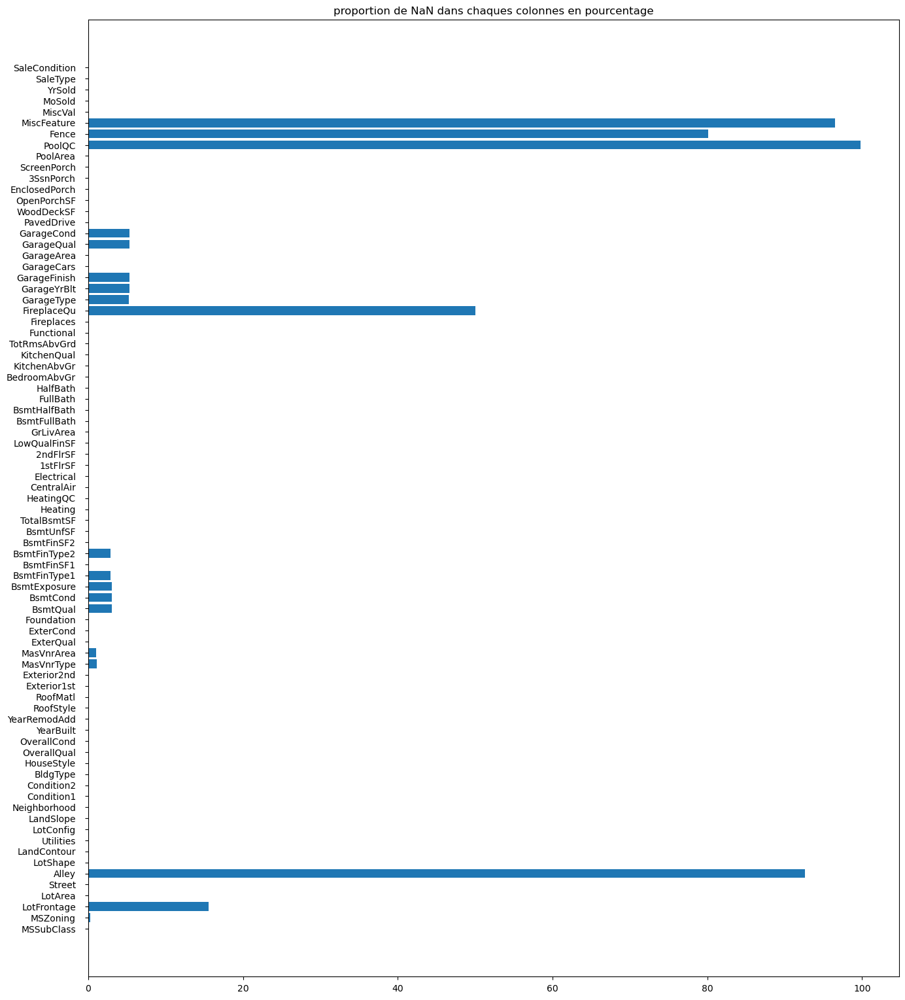

In [15]:
name=[]
ratio=[]
for col in df_test.columns:
    r=(len(df_test.loc[:,col]) - len(df_test.loc[:,col].dropna()))/len(df_test.loc[:,col])*100
    ratio.append(r)
    name.append(col)
    
fig, ax = plt.subplots(figsize =(16, 19))
 
# Horizontal Bar Plot
ax.barh(name, ratio)
# Add padding between axes and labels
ax.xaxis.set_tick_params(pad = 5)
ax.yaxis.set_tick_params(pad = 10)


 

ax.set_title('proportion de NaN dans chaques colonnes en pourcentage',
             loc ='center', )

In [16]:
df_test[df_test['GarageArea'].isna() == True]

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2577,70,RM,50.0,9060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,2Story,5,6,1923,1999,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,BrkTil,Gd,TA,No,ALQ,548.0,Unf,0.0,311.0,859.0,GasA,Ex,Y,SBrkr,942,886,0,1828,0.0,0.0,2,0,3,1,Gd,6,Typ,0,NaN,Detchd,NaN,NaN,NaN,NaN,NaN,NaN,Y,174,0,212,0,0,0,NaN,MnPrv,NaN,0,3,2007,WD,Alloca


### train

Text(0.5, 1.0, 'proportion de NaN dans chaques colonnes en pourcentage')

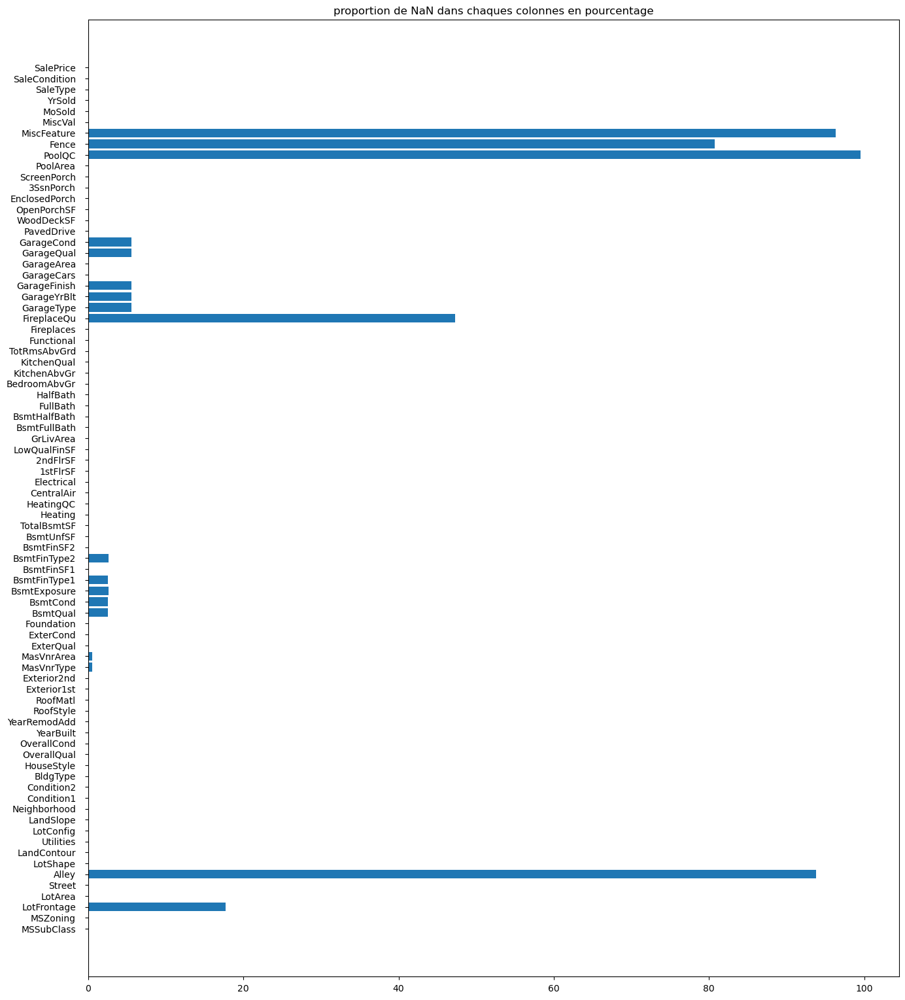

In [17]:
name=[]
ratio=[]
for col in df.columns:
    r=(len(df.loc[:,col]) - len(df.loc[:,col].dropna()))/len(df.loc[:,col])*100
    ratio.append(r)
    name.append(col)
    
fig, ax = plt.subplots(figsize =(16, 19))
 
# Horizontal Bar Plot
ax.barh(name, ratio)
# Add padding between axes and labels
ax.xaxis.set_tick_params(pad = 5)
ax.yaxis.set_tick_params(pad = 10)


 

ax.set_title('proportion de NaN dans chaques colonnes en pourcentage',
             loc ='center', )

In [18]:
len(df.isna().any()[df.isna().any() == True])

19

There are 19 colmns with missing values

In [19]:
df.shape

(1460, 80)

1460 observations for 80 variables

# Exploration

### SalePrice

Text(0.5, 1.0, 'price contribution')

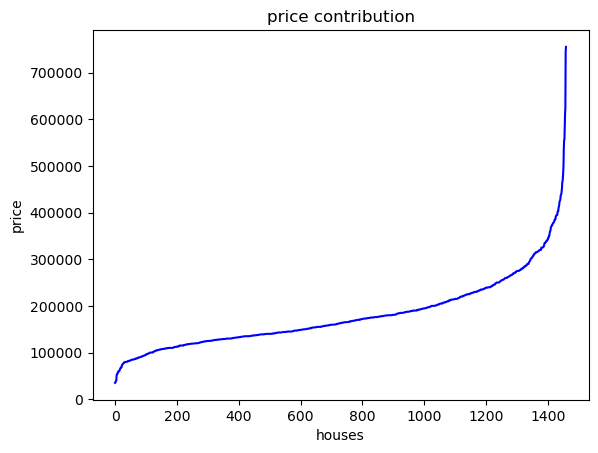

In [20]:
price = df['SalePrice'].sort_values(ascending=True)
x = [ i for i in range(len(price))]
plt.plot(x,price,'b-')
plt.xlabel("houses")
plt.ylabel("price")
plt.title("price contribution")

In [21]:
price.describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

### Sale type

SaleType: Type of sale
		
       WD 	Warranty Deed - Conventional
       CWD	Warranty Deed - Cash
       VWD	Warranty Deed - VA Loan
       New	Home just constructed and sold
       COD	Court Officer Deed/Estate
       Con	Contract 15% Down payment regular terms
       ConLw	Contract Low Down payment and low interest
       ConLI	Contract Low Interest
       ConLD	Contract Low Down
       Oth	Other

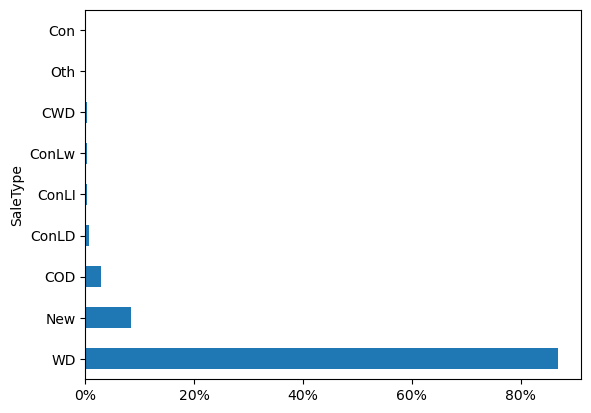

In [22]:
ax = df.value_counts('SaleType',normalize=True).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

In [23]:
df.value_counts('SaleType',normalize=True).mul(100).round(1)

SaleType
WD       86.8
New       8.4
COD       2.9
ConLD     0.6
ConLI     0.3
ConLw     0.3
CWD       0.3
Oth       0.2
Con       0.1
dtype: float64

### Sale condition

SaleCondition: Condition of sale

       Normal	Normal Sale
       Abnorml	Abnormal Sale -  trade, foreclosure, short sale
       AdjLand	Adjoining Land Purchase
       Alloca	Allocation - two linked properties with separate deeds, typically condo with a garage unit	
       Family	Sale between family members
       Partial	Home was not completed when last assessed (associated with New Homes)

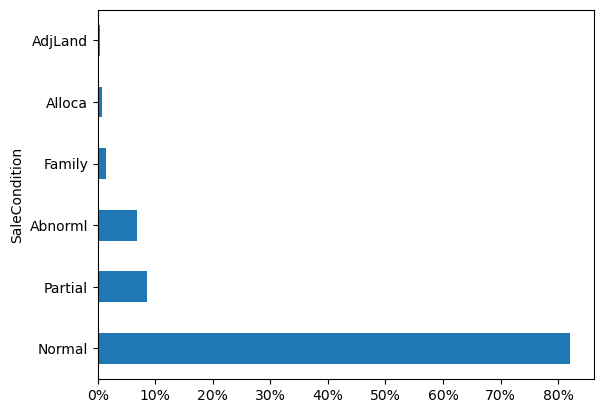

In [24]:
ax = df.value_counts('SaleCondition',normalize=True).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Year Sold

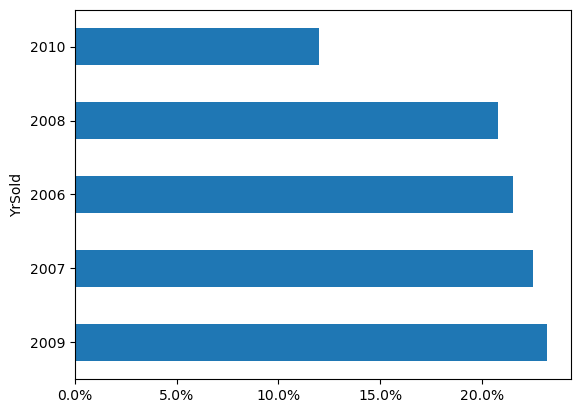

In [25]:
ax = df.value_counts('YrSold',normalize=True).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

In [26]:
def q25(x):
    return x.quantile(.25)
def q75(x):
    return x.quantile(.75)

priceYrSold = df.groupby(by='YrSold').agg({'SalePrice': ['mean','min', q25,'median',q75,'max']})
display(priceYrSold)

SalePrice                                             
                 mean    min       q25    median       q75     max
YrSold                                                            
2006    182549.458599  35311  131375.0  163995.0  218782.5  625000
2007    186063.151976  39300  129900.0  167000.0  219500.0  755000
2008    177360.838816  40000  131250.0  164000.0  207000.0  446261
2009    179432.103550  34900  125250.0  162000.0  212750.0  582933
2010    177393.674286  55000  128100.0  155000.0  213250.0  611657

<AxesSubplot: xlabel='YrSold', ylabel='SalePrice'>

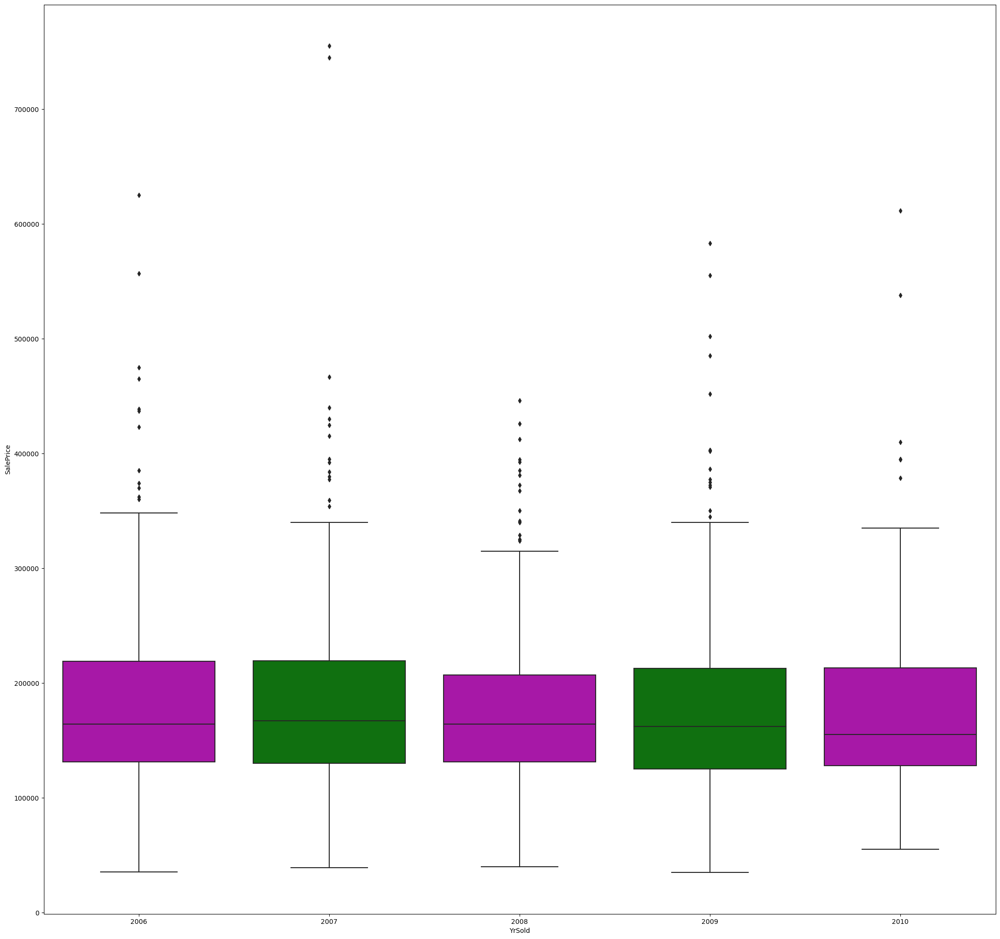

In [27]:
plt.figure(figsize=(26,25))
sns.boxplot(x="YrSold", y='SalePrice',
             palette=["m", "g"],
            data=df)

we check if the sells year are the same in test data.

In [28]:
df_test['YrSold'].max()

2010

In [29]:
df_test['YrSold'].min()

2006

### Month Sold

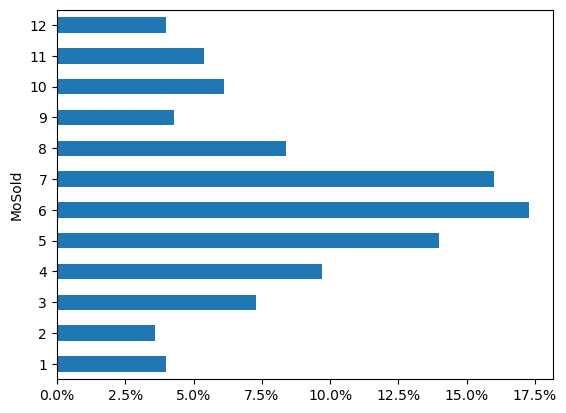

In [30]:
sort_dic = {'1':1,'2':2,'3':3,'4':4,'5':5,'6':6,'7':7,'8':8,'9':9,'10':10,'11':11,'12':12}
ax = df.value_counts('MoSold',normalize=True,sort=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

(0.0, 12.0)

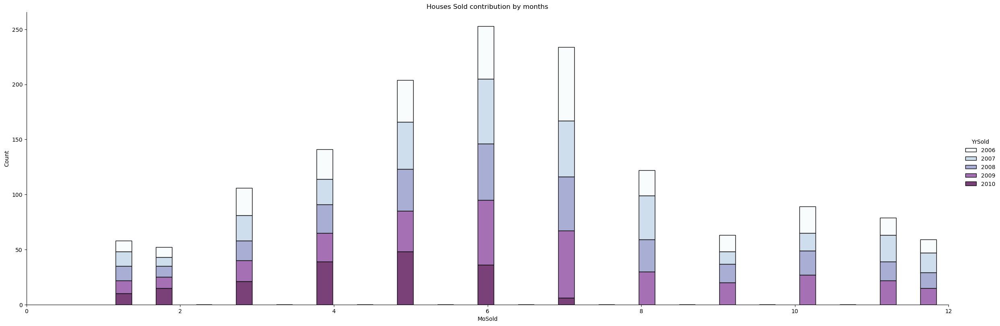

In [31]:
sns.displot(df.sort_values(by=['MoSold']),x='MoSold',hue='YrSold',element='bars',palette='BuPu',height=8,aspect=3,multiple='stack',shrink=0.4).set(title='Houses Sold contribution by months')
plt.xlim(0, 12)

### MSSubClass

MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES

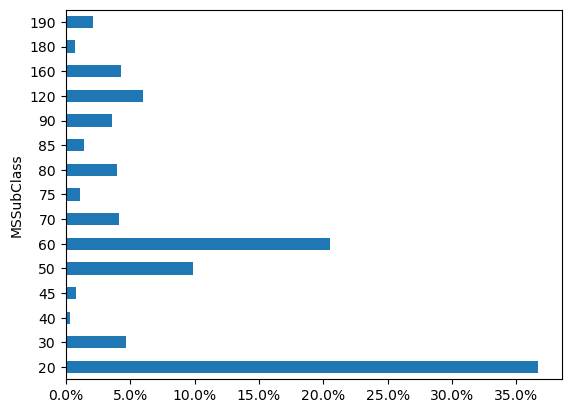

In [32]:
ax = df.value_counts('MSSubClass',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### MSZoning

MSZoning: Identifies the general zoning classification of the sale.
		
       A	Agriculture
       C	Commercial
       FV	Floating Village Residential
       I	Industrial
       RH	Residential High Density
       RL	Residential Low Density
       RP	Residential Low Density Park 
       RM	Residential Medium Density

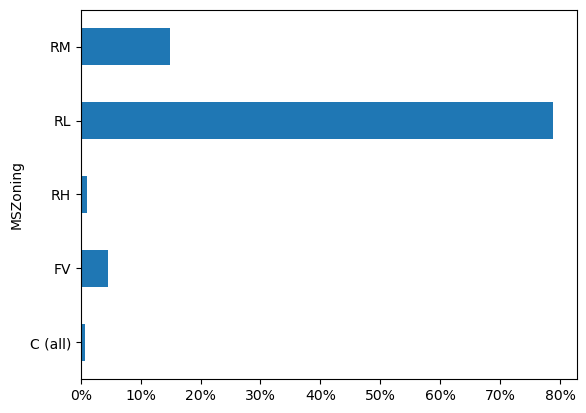

In [33]:
ax = df.value_counts('MSZoning',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### LotFrontage

LotFrontage: Linear feet of street connected to property (distance between  street and property?)

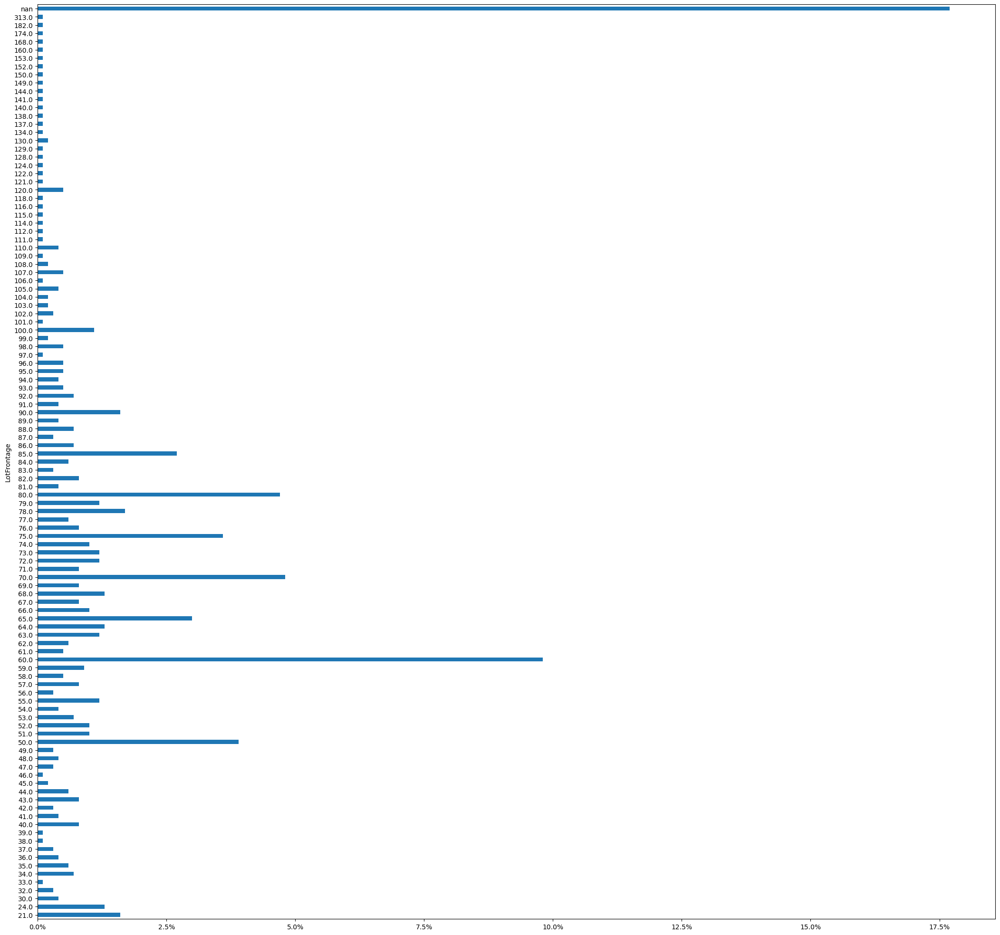

In [34]:
plt.figure(figsize=(26,25))
ax = df.value_counts('LotFrontage',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

Text(0.5, 1.0, 'LotFrontage contribution')

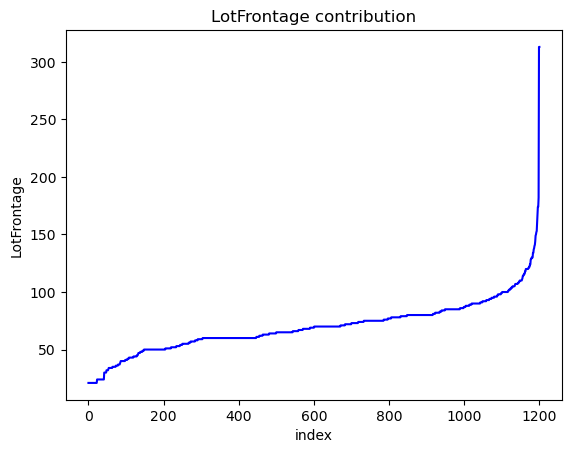

In [35]:
LotFrontage = df['LotFrontage'].sort_values(ascending=True)
x = [ i for i in range(len(LotFrontage))]
plt.plot(x,LotFrontage,'b-')
plt.xlabel("index")
plt.ylabel("LotFrontage")
plt.title("LotFrontage contribution")

### LotArea

LotArea: Lot size in square feet

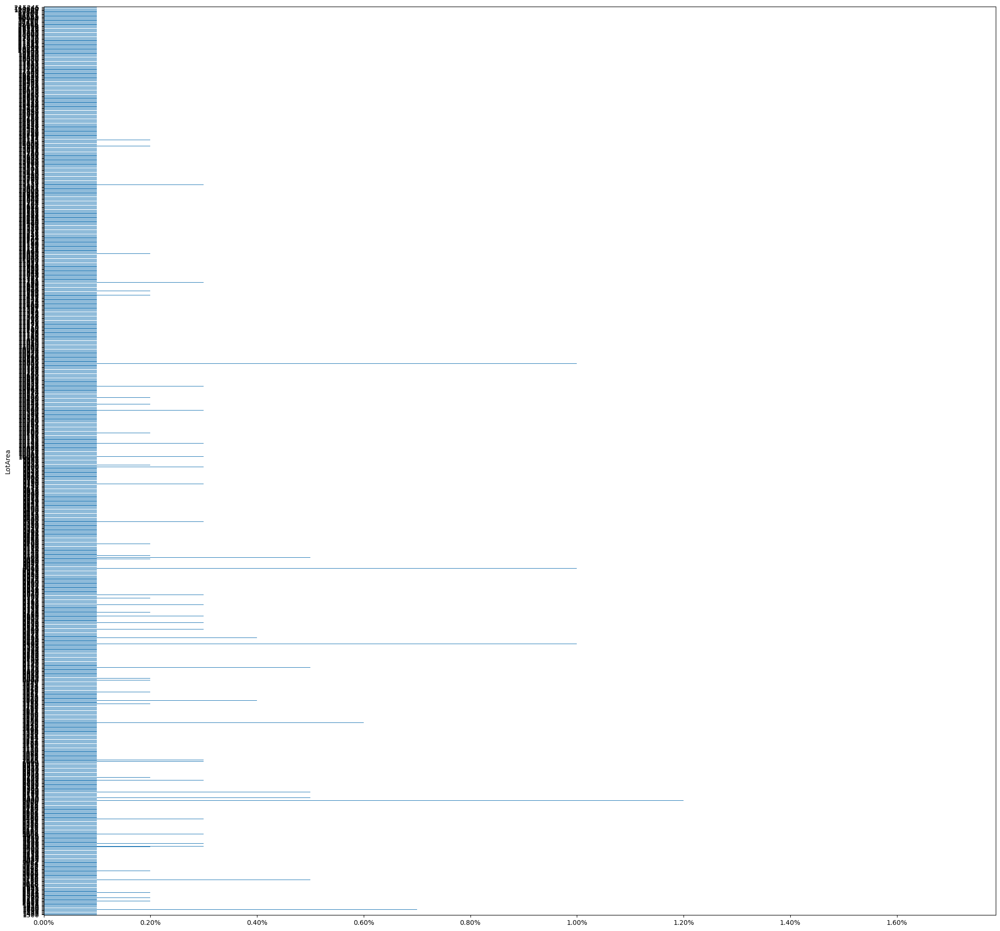

In [36]:
plt.figure(figsize=(26,25))
ax = df.value_counts('LotArea',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

Text(0.5, 1.0, 'LotArea contribution')

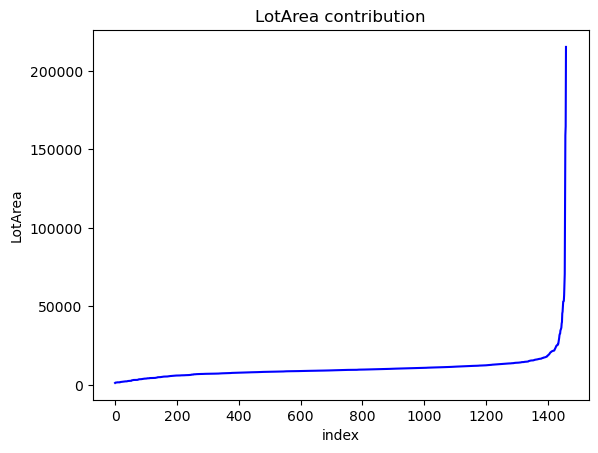

In [37]:
LotArea = df['LotArea'].sort_values(ascending=True)
x = [ i for i in range(len(LotArea))]
plt.plot(x,LotArea,'b-')
plt.xlabel("index")
plt.ylabel("LotArea")
plt.title("LotArea contribution")

### Street

Street: Type of road access to property

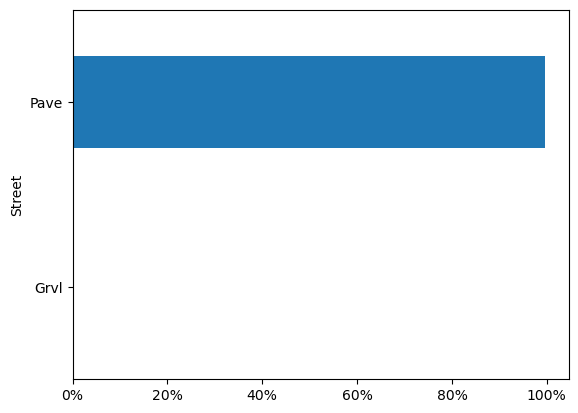

In [38]:
ax = df.value_counts('Street',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Alley

Alley: Type of alley access to property

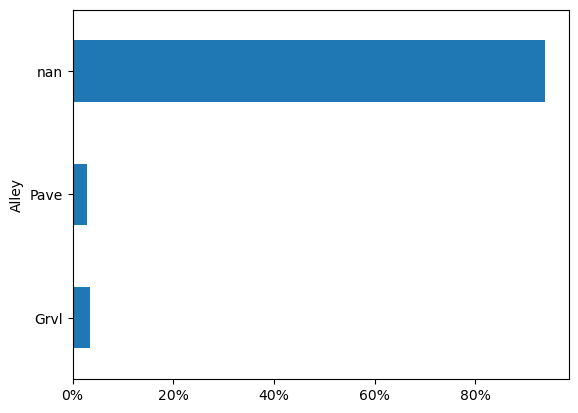

In [39]:
ax = df.value_counts('Alley',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### LotShape

LotShape: General shape of property

       Reg	Regular	
       IR1	Slightly irregular
       IR2	Moderately Irregular
       IR3	Irregular
       

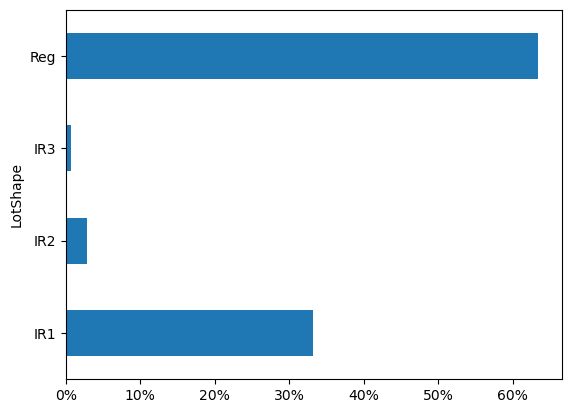

In [40]:
ax = df.value_counts('LotShape',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### LandContour

LandContour: Flatness of the property

       Lvl	Near Flat/Level	
       Bnk	Banked - Quick and significant rise from street grade to building
       HLS	Hillside - Significant slope from side to side
       Low	Depression
		

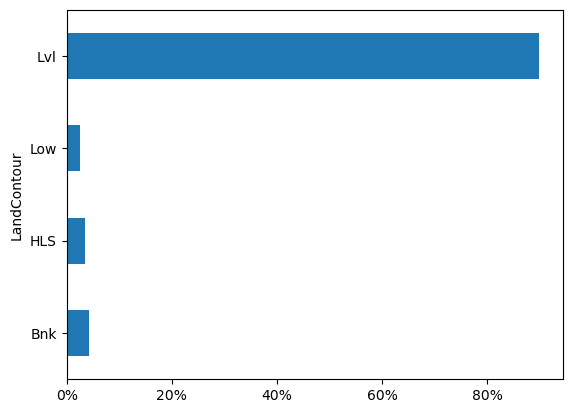

In [41]:
ax = df.value_counts('LandContour',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Utilities

Utilities: Type of utilities available
		
       AllPub	All public Utilities (E,G,W,& S)	
       NoSewr	Electricity, Gas, and Water (Septic Tank)
       NoSeWa	Electricity and Gas Only
       ELO	Electricity only	
	

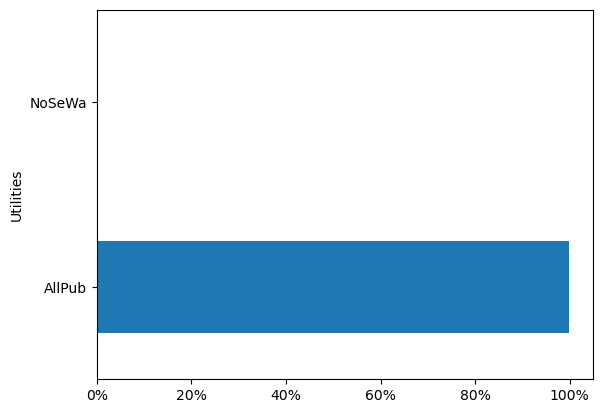

In [42]:
ax = df.value_counts('Utilities',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### LotConfig

LotConfig: Lot configuration

       Inside	Inside lot
       Corner	Corner lot
       CulDSac	Cul-de-sac
       FR2	Frontage on 2 sides of property
       FR3	Frontage on 3 sides of property
	

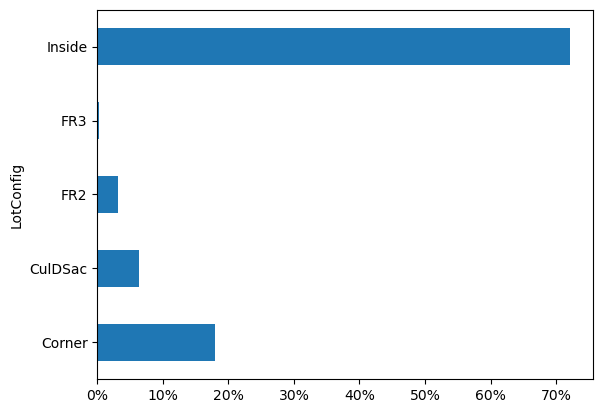

In [43]:
ax = df.value_counts('LotConfig',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### LandSlope

LandSlope: Slope of property (pente)
		
       Gtl	Gentle slope
       Mod	Moderate Slope	
       Sev	Severe Slope

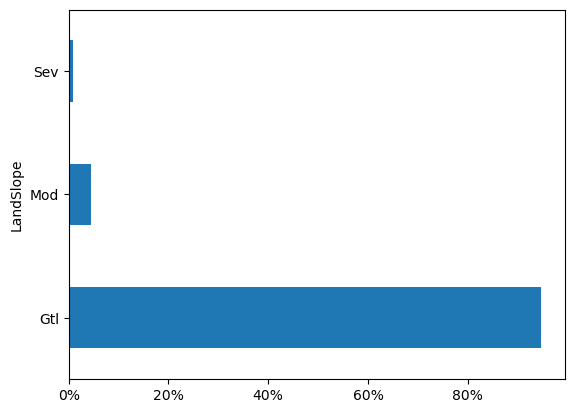

In [44]:
ax = df.value_counts('LandSlope',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Neighborhood

Neighborhood: Physical locations within Ames city limits

       Blmngtn	Bloomington Heights
       Blueste	Bluestem
       BrDale	Briardale
       BrkSide	Brookside
       ClearCr	Clear Creek
       CollgCr	College Creek
       Crawfor	Crawford
       Edwards	Edwards
       Gilbert	Gilbert
       IDOTRR	Iowa DOT and Rail Road
       MeadowV	Meadow Village
       Mitchel	Mitchell
       Names	North Ames
       NoRidge	Northridge
       NPkVill	Northpark Villa
       NridgHt	Northridge Heights
       NWAmes	Northwest Ames
       OldTown	Old Town
       SWISU	South & West of Iowa State University
       Sawyer	Sawyer
       SawyerW	Sawyer West
       Somerst	Somerset
       StoneBr	Stone Brook
       Timber	Timberland
       Veenker	Veenker

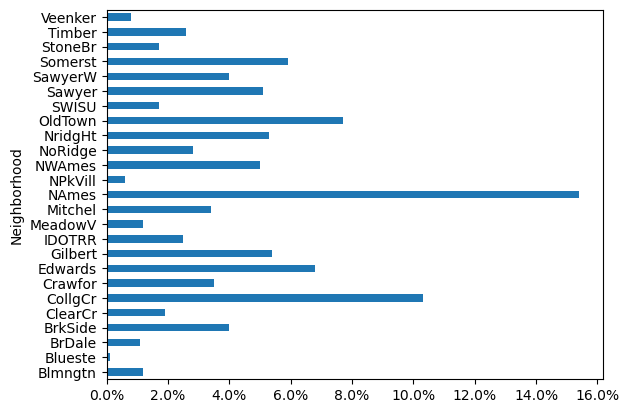

In [45]:
ax = df.value_counts('Neighborhood',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

<AxesSubplot: xlabel='Neighborhood', ylabel='SalePrice'>

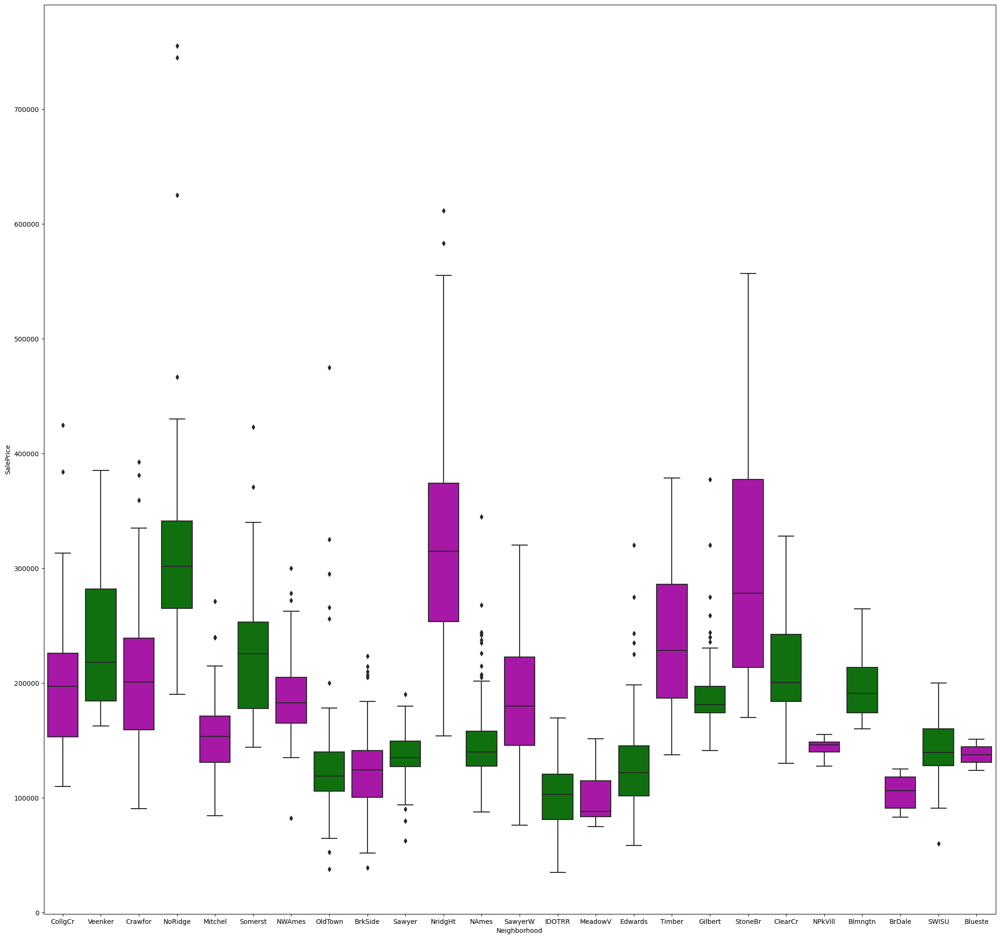

In [46]:
plt.figure(figsize=(26,25))
sns.boxplot(x="Neighborhood", y='SalePrice',
             palette=["m", "g"],
            data=df)

### Condition1

Condition1: Proximity to various conditions
	
       Artery	Adjacent to arterial street
       Feedr	Adjacent to feeder street	
       Norm	Normal	
       RRNn	Within 200' of North-South Railroad
       RRAn	Adjacent to North-South Railroad
       PosN	Near positive off-site feature--park, greenbelt, etc.
       PosA	Adjacent to postive off-site feature
       RRNe	Within 200' of East-West Railroad
       RRAe	Adjacent to East-West Railroad

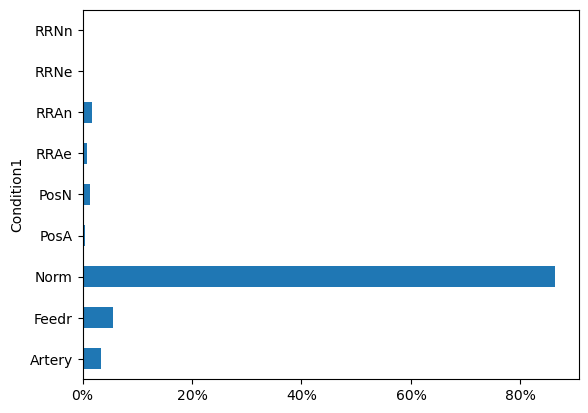

In [47]:
ax = df.value_counts('Condition1',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Condition2

Condition2: Proximity to various conditions (if more than one is present)
		
       Artery	Adjacent to arterial street
       Feedr	Adjacent to feeder street	
       Norm	Normal	
       RRNn	Within 200' of North-South Railroad
       RRAn	Adjacent to North-South Railroad
       PosN	Near positive off-site feature--park, greenbelt, etc.
       PosA	Adjacent to postive off-site feature
       RRNe	Within 200' of East-West Railroad
       RRAe	Adjacent to East-West Railroad

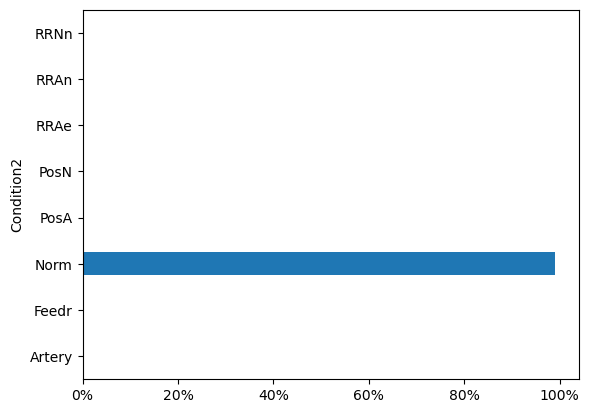

In [48]:
ax = df.value_counts('Condition2',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BldgType

BldgType: Type of dwelling
		
       1Fam	Single-family Detached	
       2FmCon	Two-family Conversion; originally built as one-family dwelling
       Duplx	Duplex
       TwnhsE	Townhouse End Unit
       TwnhsI	Townhouse Inside Unit
	

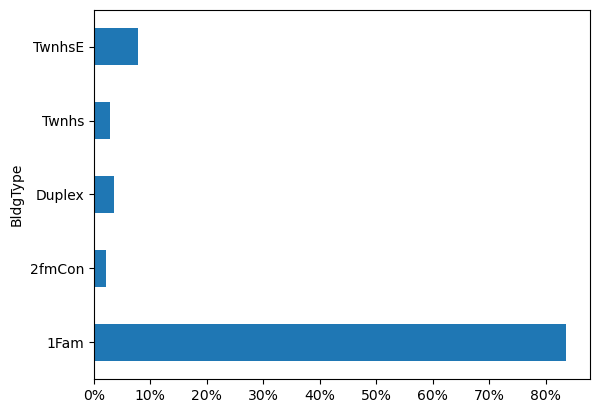

In [49]:
ax = df.value_counts('BldgType',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

In [50]:
df.value_counts('BldgType',normalize=True,sort=False,dropna=False).mul(100).round(1)

BldgType
1Fam      83.6
2fmCon     2.1
Duplex     3.6
Twnhs      2.9
TwnhsE     7.8
dtype: float64

### HouseStyle

HouseStyle: Style of dwelling
	
       1Story	One story
       1.5Fin	One and one-half story: 2nd level finished
       1.5Unf	One and one-half story: 2nd level unfinished
       2Story	Two story
       2.5Fin	Two and one-half story: 2nd level finished
       2.5Unf	Two and one-half story: 2nd level unfinished
       SFoyer	Split Foyer
       SLvl	Split Level

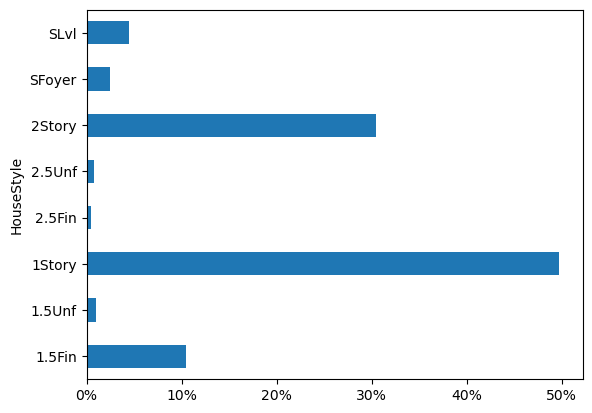

In [51]:
ax = df.value_counts('HouseStyle',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### OverallQual

OverallQual: Rates the overall material and finish of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average
       5	Average
       4	Below Average
       3	Fair
       2	Poor
       1	Very Poor

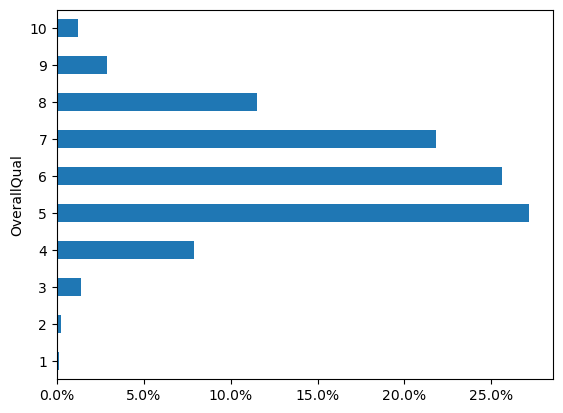

In [52]:
ax = df.value_counts('OverallQual',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### OverallCond

OverallCond: Rates the overall condition of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average	
       5	Average
       4	Below Average	
       3	Fair
       2	Poor
       1	Very Poor

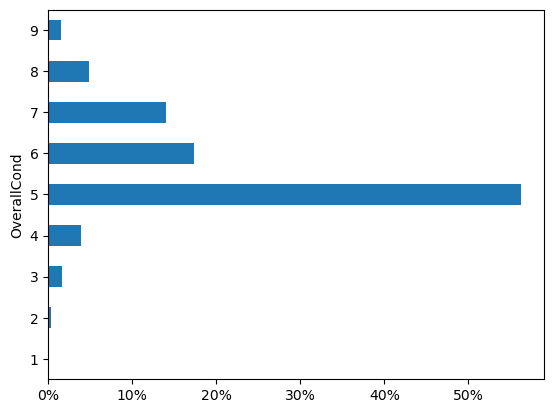

In [53]:
ax = df.value_counts('OverallCond',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### YearBuilt

YearBuilt: Original construction date

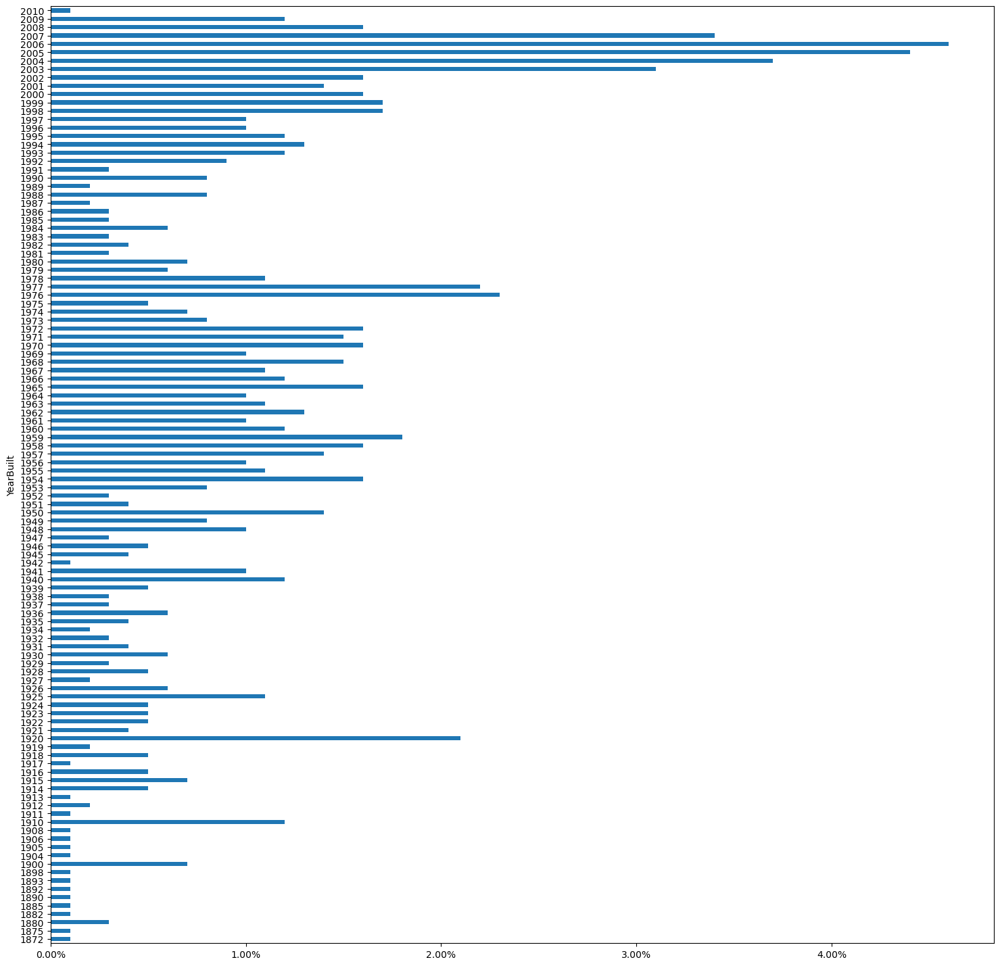

In [54]:
plt.figure(figsize=(18,18))
ax = df.value_counts('YearBuilt',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### YearRemodAdd

Remodel date (same as construction date if no remodeling or additions)

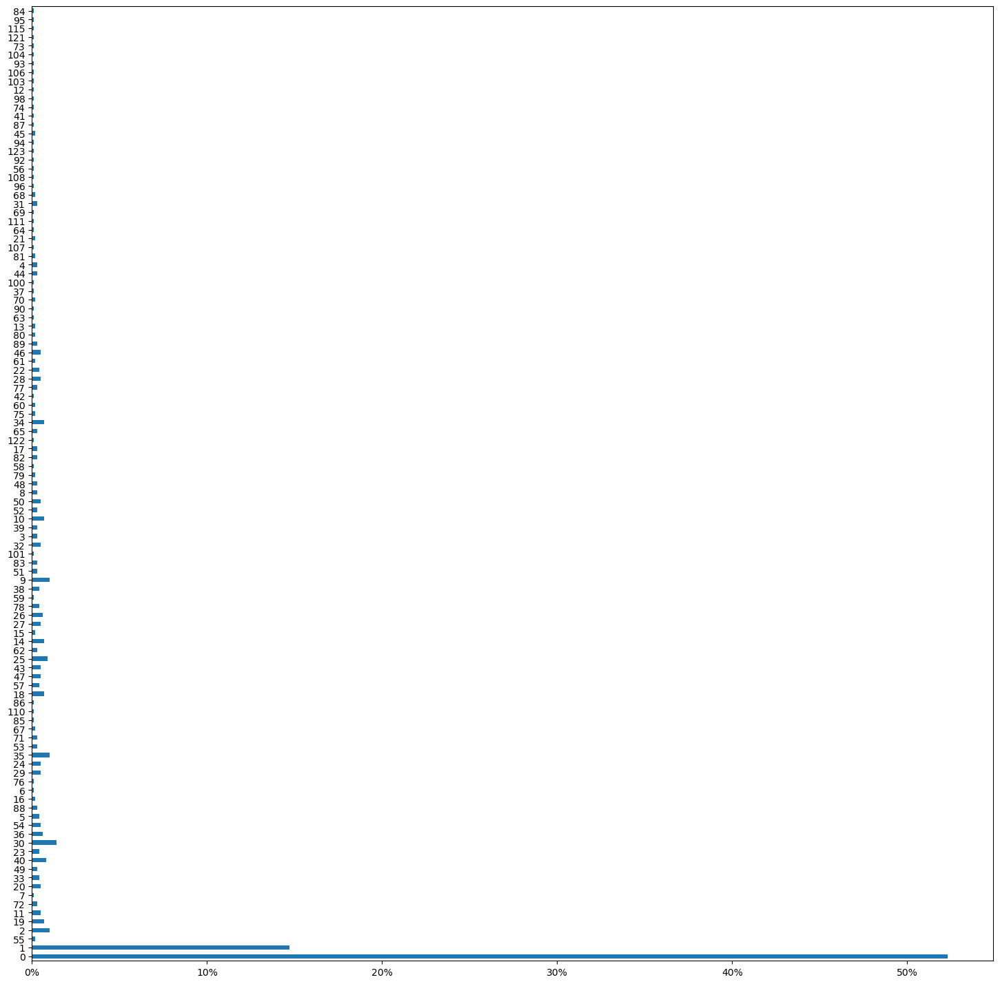

In [55]:
plt.figure(figsize=(18,18))
yearModification = df['YearRemodAdd'] - df['YearBuilt']
ax = yearModification.value_counts(normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### RoofStyle

RoofStyle: Type of roof

       Flat	Flat
       Gable	Gable
       Gambrel	Gabrel (Barn)
       Hip	Hip
       Mansard	Mansard
       Shed	Shed

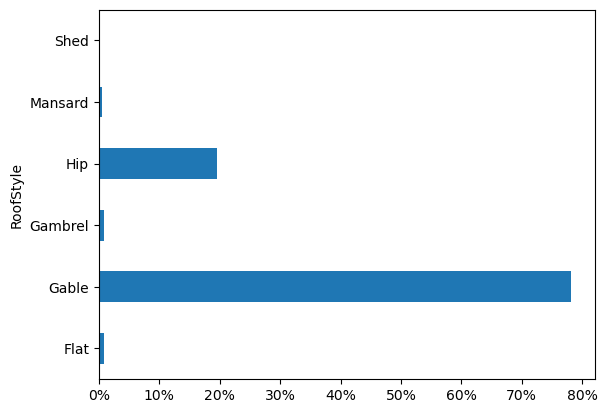

In [56]:
ax = df.value_counts('RoofStyle',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### RoofMatl

RoofMatl: Roof material

       ClyTile	Clay or Tile
       CompShg	Standard (Composite) Shingle
       Membran	Membrane
       Metal	Metal
       Roll	Roll
       Tar&Grv	Gravel & Tar
       WdShake	Wood Shakes
       WdShngl	Wood Shingles

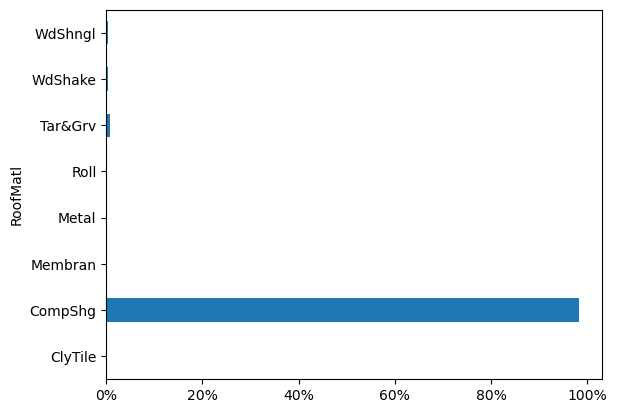

In [57]:
ax = df.value_counts('RoofMatl',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Exterior1st

Exterior1st: Exterior covering on house

       AsbShng	Asbestos Shingles
       AsphShn	Asphalt Shingles
       BrkComm	Brick Common
       BrkFace	Brick Face
       CBlock	Cinder Block
       CemntBd	Cement Board
       HdBoard	Hard Board
       ImStucc	Imitation Stucco
       MetalSd	Metal Siding
       Other	Other
       Plywood	Plywood
       PreCast	PreCast	
       Stone	Stone
       Stucco	Stucco
       VinylSd	Vinyl Siding
       Wd Sdng	Wood Siding
       WdShing	Wood Shingles

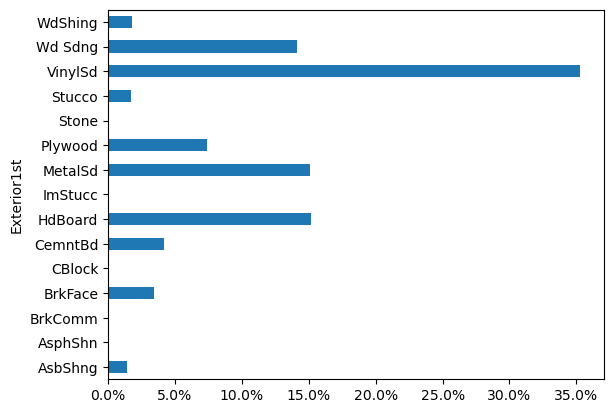

In [58]:
ax = df.value_counts('Exterior1st',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Exterior2nd

Exterior2nd: Exterior covering on house (if more than one material)

       AsbShng	Asbestos Shingles
       AsphShn	Asphalt Shingles
       BrkComm	Brick Common
       BrkFace	Brick Face
       CBlock	Cinder Block
       CemntBd	Cement Board
       HdBoard	Hard Board
       ImStucc	Imitation Stucco
       MetalSd	Metal Siding
       Other	Other
       Plywood	Plywood
       PreCast	PreCast
       Stone	Stone
       Stucco	Stucco
       VinylSd	Vinyl Siding
       Wd Sdng	Wood Siding
       WdShing	Wood Shingles
	

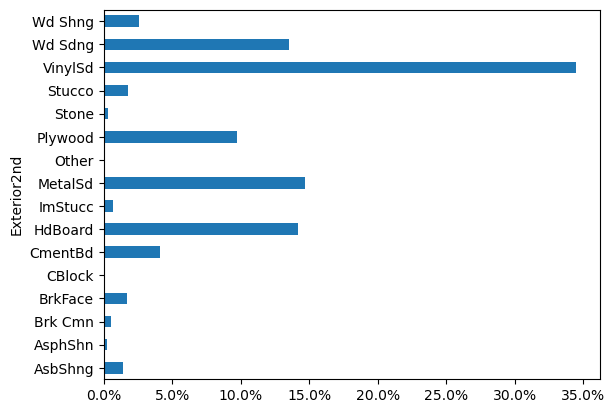

In [59]:
ax = df.value_counts('Exterior2nd',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### MasVnrType

MasVnrType: Masonry veneer type

       BrkCmn	Brick Common
       BrkFace	Brick Face
       CBlock	Cinder Block
       None	None
       Stone	Stone

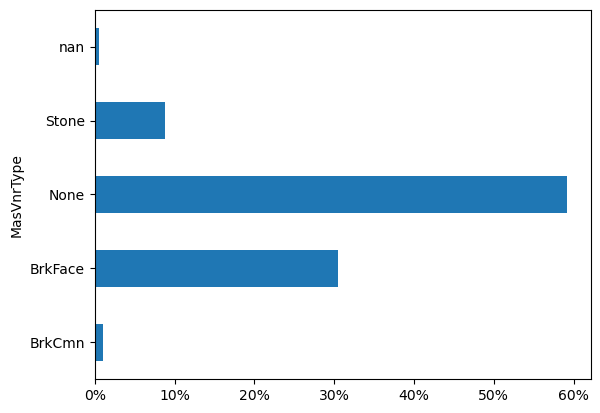

In [60]:
ax = df.value_counts('MasVnrType',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### MasVnrArea

### ExterQual

ExterQual: Evaluates the quality of the material on the exterior 
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor

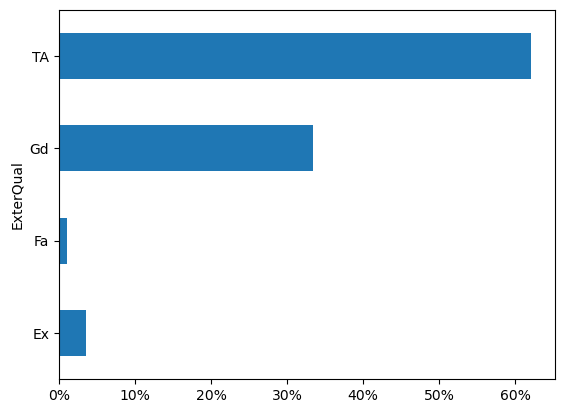

In [61]:
ax = df.value_counts('ExterQual',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### ExterCond

ExterCond: Evaluates the present condition of the material on the exterior
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor

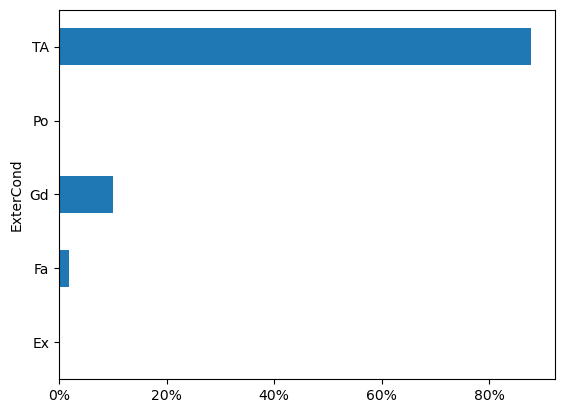

In [62]:
ax = df.value_counts('ExterCond',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Foundation

Foundation: Type of foundation
		
       BrkTil	Brick & Tile
       CBlock	Cinder Block
       PConc	Poured Contrete	
       Slab	Slab
       Stone	Stone
       Wood	Wood

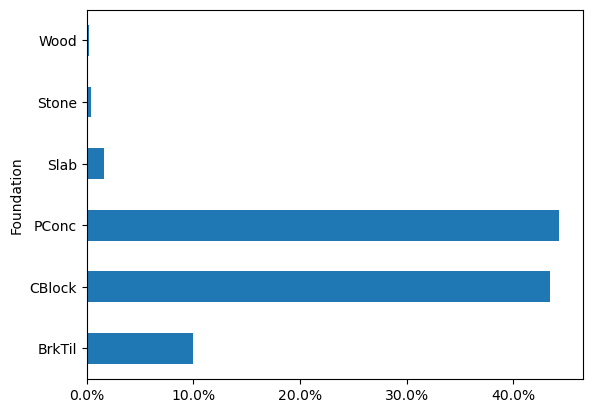

In [63]:
ax = df.value_counts('Foundation',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BsmtQual

BsmtQual: Evaluates the height of the basement

       Ex	Excellent (100+ inches)	
       Gd	Good (90-99 inches)
       TA	Typical (80-89 inches)
       Fa	Fair (70-79 inches)
       Po	Poor (<70 inches
       NA	No Basement

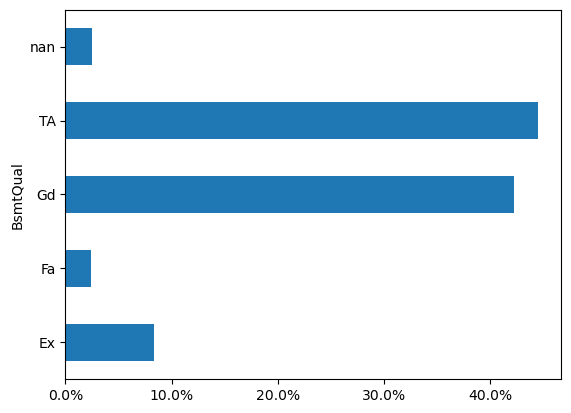

In [64]:
ax = df.value_counts('BsmtQual',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BsmtCond

BsmtCond: Evaluates the general condition of the basement

       Ex	Excellent
       Gd	Good
       TA	Typical - slight dampness allowed
       Fa	Fair - dampness or some cracking or settling
       Po	Poor - Severe cracking, settling, or wetness
       NA	No Basement

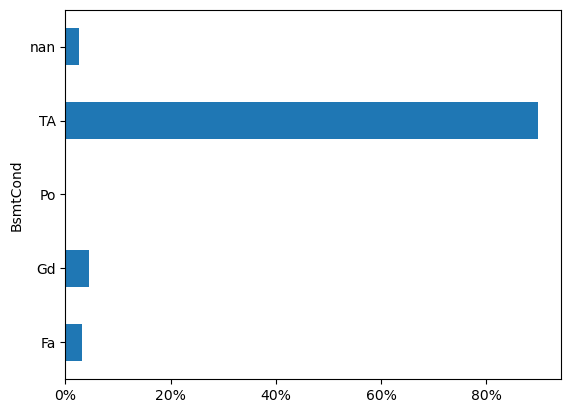

In [65]:
ax = df.value_counts('BsmtCond',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BsmtExposure

BsmtExposure: Refers to walkout or garden level walls

       Gd	Good Exposure
       Av	Average Exposure (split levels or foyers typically score average or above)	
       Mn	Mimimum Exposure
       No	No Exposure
       NA	No Basement

### BsmtFinType1

BsmtFinType1: Rating of basement finished area

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement

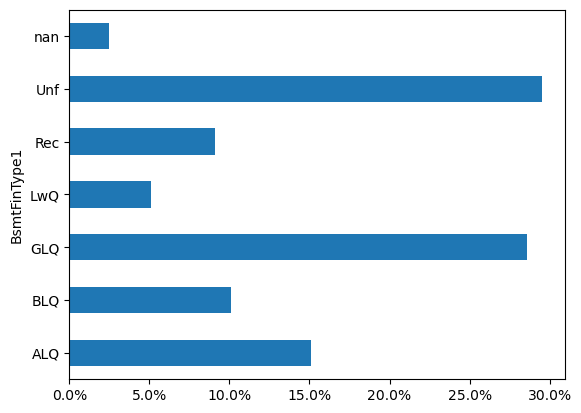

In [66]:
ax = df.value_counts('BsmtFinType1',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BsmtFinSF1

BsmtFinSF1: Type 1 finished square feet

### BsmtFinType2

BsmtFinType2: Rating of basement finished area (if multiple types)

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement

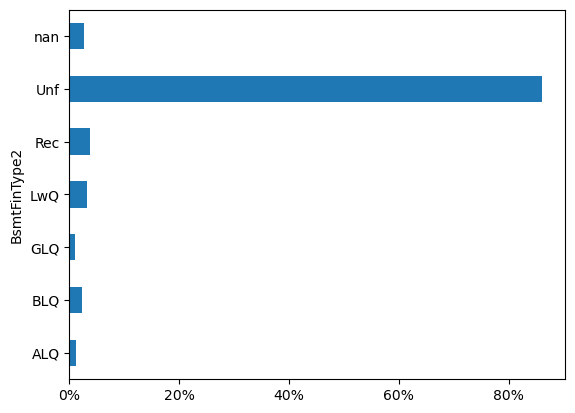

In [67]:
ax = df.value_counts('BsmtFinType2',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BsmtFinSF2

BsmtFinSF2: Type 2 finished square feet

### BsmtUnfSF

BsmtUnfSF: Unfinished square feet of basement area

### TotalBsmtSF

TotalBsmtSF: Total square feet of basement area

### Heating

Heating: Type of heating
		
       Floor	Floor Furnace
       GasA	Gas forced warm air furnace
       GasW	Gas hot water or steam heat
       Grav	Gravity furnace	
       OthW	Hot water or steam heat other than gas
       Wall	Wall furnace

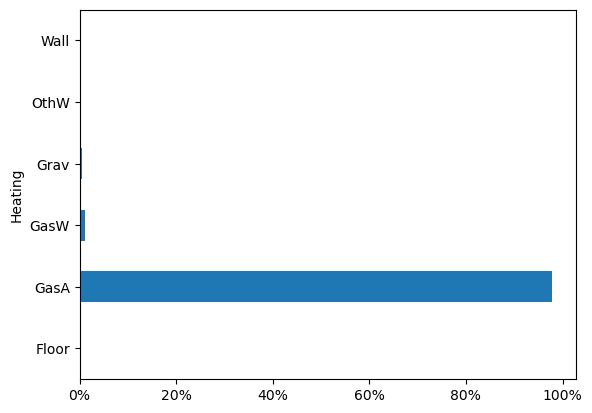

In [68]:
ax = df.value_counts('Heating',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### HeatingQC

HeatingQC: Heating quality and condition

       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor

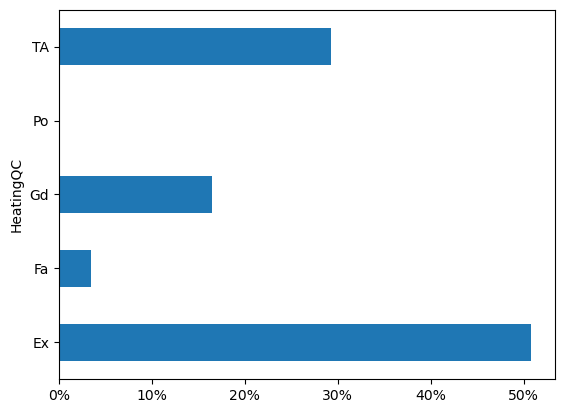

In [69]:
ax = df.value_counts('HeatingQC',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### CentralAir

CentralAir: Central air conditioning

       N	No
       Y	Yes

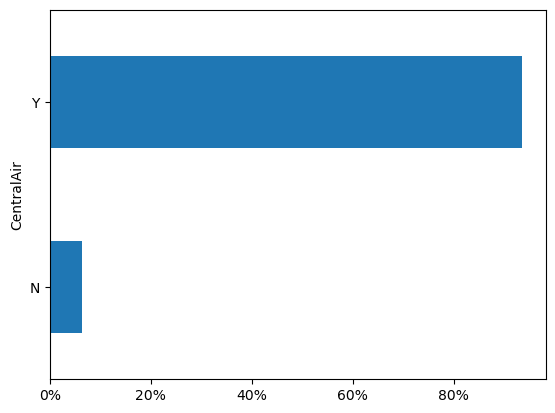

In [70]:
ax = df.value_counts('CentralAir',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Electrical

Electrical: Electrical system

       SBrkr	Standard Circuit Breakers & Romex
       FuseA	Fuse Box over 60 AMP and all Romex wiring (Average)	
       FuseF	60 AMP Fuse Box and mostly Romex wiring (Fair)
       FuseP	60 AMP Fuse Box and mostly knob & tube wiring (poor)
       Mix	Mixed
		

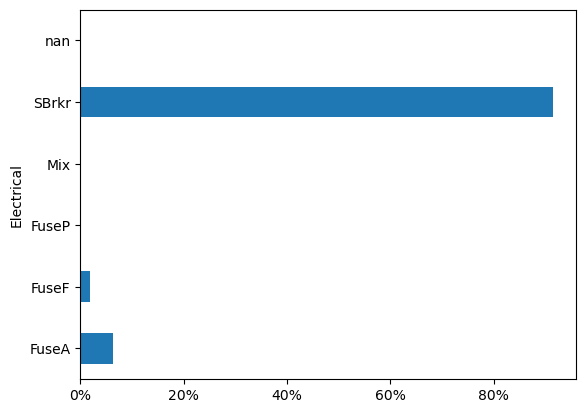

In [71]:
ax = df.value_counts('Electrical',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### 1stFlrSF

1stFlrSF: First Floor square feet

Text(0.5, 1.0, '1stFlrSF contribution')

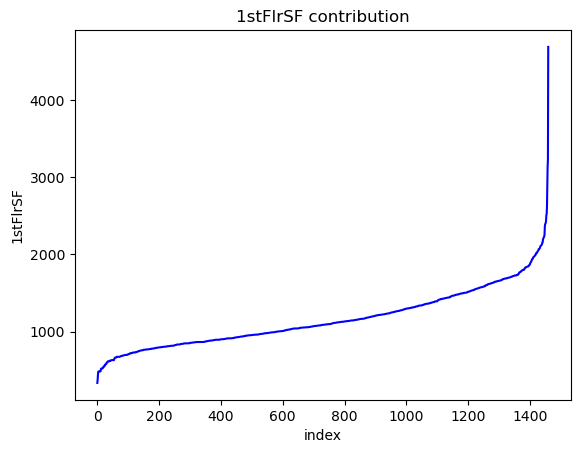

In [72]:
LotArea = df['1stFlrSF'].sort_values(ascending=True)
x = [ i for i in range(len(LotArea))]
plt.plot(x,LotArea,'b-')
plt.xlabel("index")
plt.ylabel("1stFlrSF")
plt.title("1stFlrSF contribution")

### 2ndFlrSF

2ndFlrSF: Second floor square feet

Text(0.5, 1.0, '2ndFlrSF contribution')

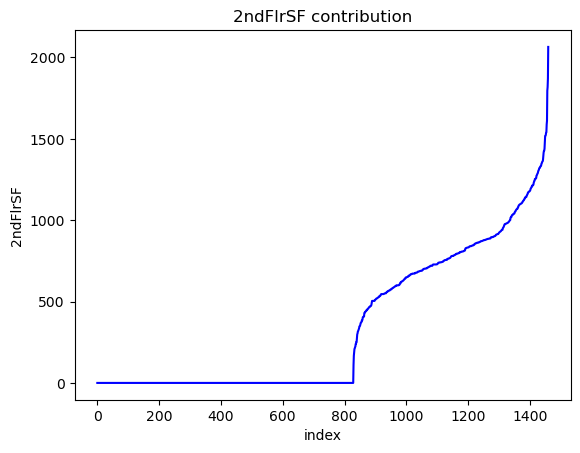

In [73]:
LotArea = df['2ndFlrSF'].sort_values(ascending=True)
x = [ i for i in range(len(LotArea))]
plt.plot(x,LotArea,'b-')
plt.xlabel("index")
plt.ylabel("2ndFlrSF")
plt.title("2ndFlrSF contribution")

### Functional

Functional: Home functionality (Assume typical unless deductions are warranted)

       Typ	Typical Functionality
       Min1	Minor Deductions 1
       Min2	Minor Deductions 2
       Mod	Moderate Deductions
       Maj1	Major Deductions 1
       Maj2	Major Deductions 2
       Sev	Severely Damaged
       Sal	Salvage only

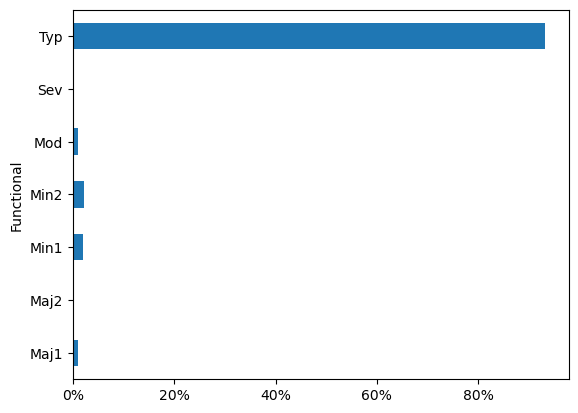

In [74]:
ax = df.value_counts('Functional',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### TotRmsAbvGrd

TotRmsAbvGrd: Total rooms above grade (does not include bathrooms)

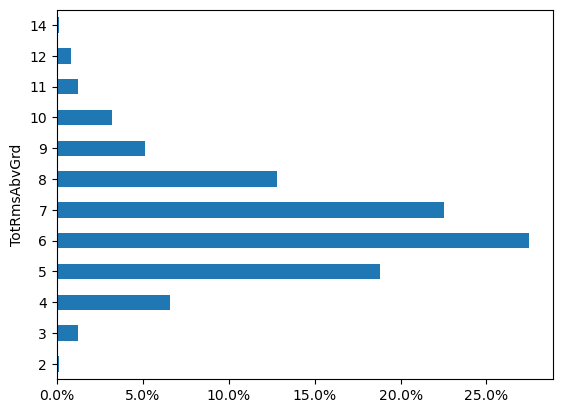

In [75]:
ax = df.value_counts('TotRmsAbvGrd',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### LowQualFinSF

LowQualFinSF: Low quality finished square feet (all floors)

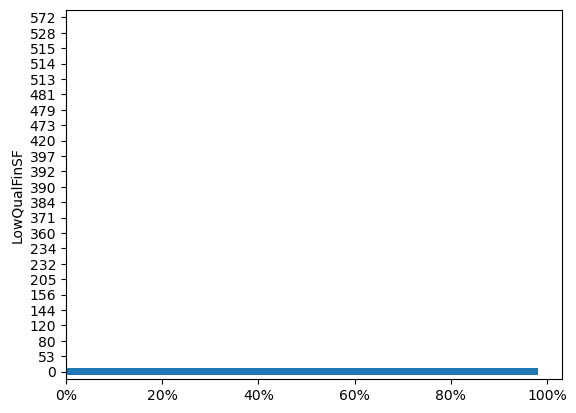

In [76]:
ax = df.value_counts('LowQualFinSF',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GrLivArea

GrLivArea: Above grade (ground) living area square feet

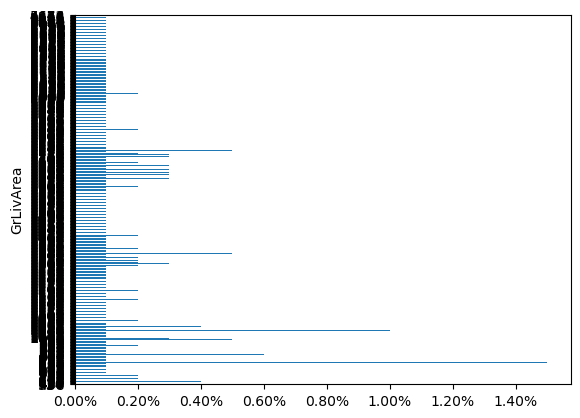

In [77]:
ax = df.value_counts('GrLivArea',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

Text(0.5, 1.0, 'GrLivArea contribution')

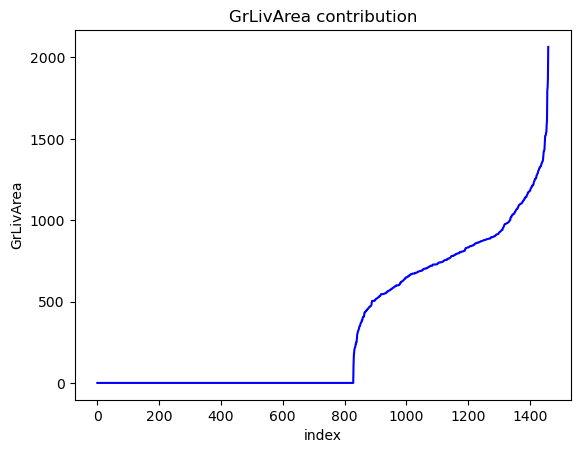

In [78]:
GrLivArea = df['GrLivArea'].sort_values(ascending=True)
x = [ i for i in range(len(LotArea))]
plt.plot(x,LotArea,'b-')
plt.xlabel("index")
plt.ylabel("GrLivArea")
plt.title("GrLivArea contribution")

### BsmtFullBath

BsmtFullBath: Basement full bathrooms

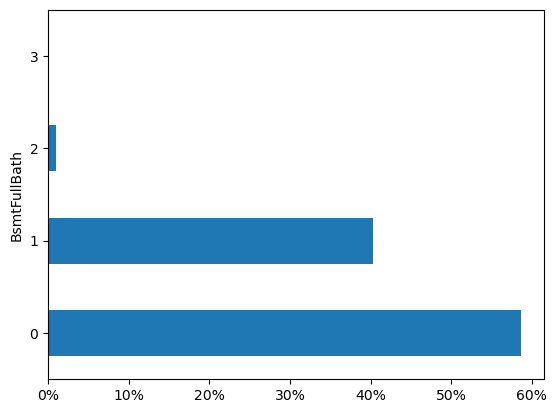

In [79]:
ax = df.value_counts('BsmtFullBath',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### BsmtHalfBath

BsmtHalfBath: Basement half bathrooms

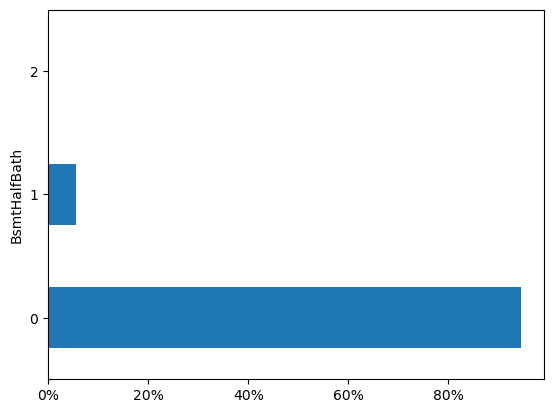

In [80]:
ax = df.value_counts('BsmtHalfBath',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### FullBath

FullBath: Full bathrooms above grade

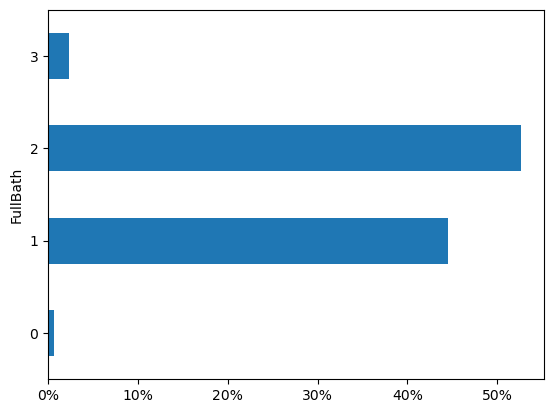

In [81]:
ax = df.value_counts('FullBath',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### HalfBath

HalfBath: Half baths above grade


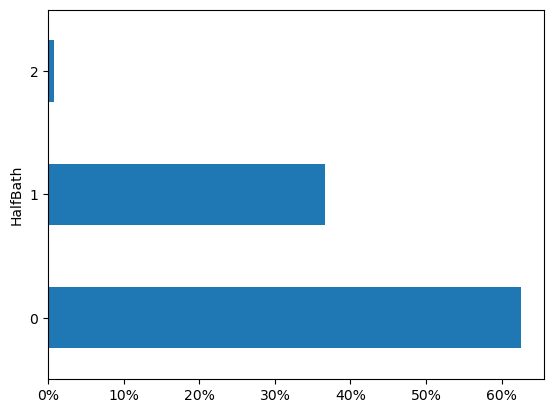

In [82]:
ax = df.value_counts('HalfBath',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Bedroom

Bedroom: Bedrooms above grade (does NOT include basement bedrooms)

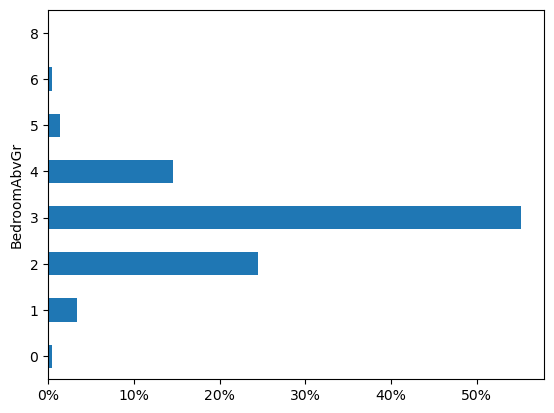

In [83]:
ax = df.value_counts('BedroomAbvGr',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Kitchen

Kitchen: Kitchens above grade

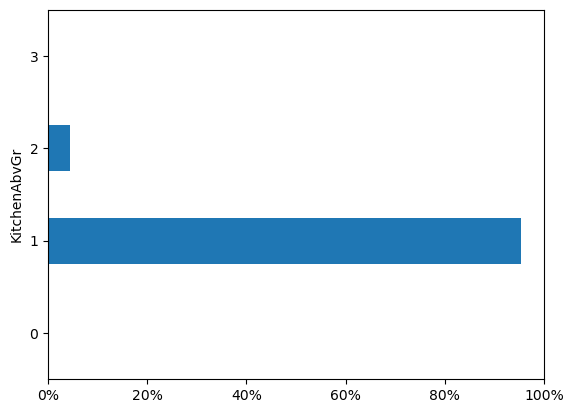

In [84]:
ax = df.value_counts('KitchenAbvGr',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### KitchenQual

KitchenQual: Kitchen quality

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor

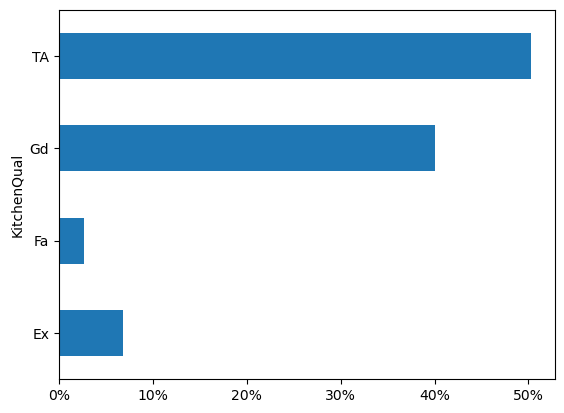

In [85]:
ax = df.value_counts('KitchenQual',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

## Miscancellous

### MiscFeature

MiscFeature: Miscellaneous feature not covered in other categories
		
       Elev	Elevator
       Gar2	2nd Garage (if not described in garage section)
       Othr	Other
       Shed	Shed (over 100 SF)
       TenC	Tennis Court
       NA	None

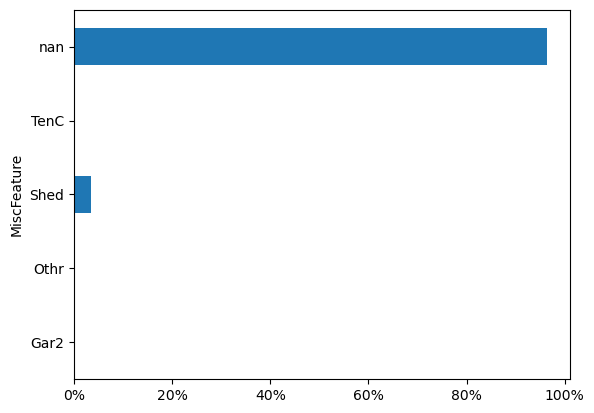

In [86]:
ax = df.value_counts('MiscFeature',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

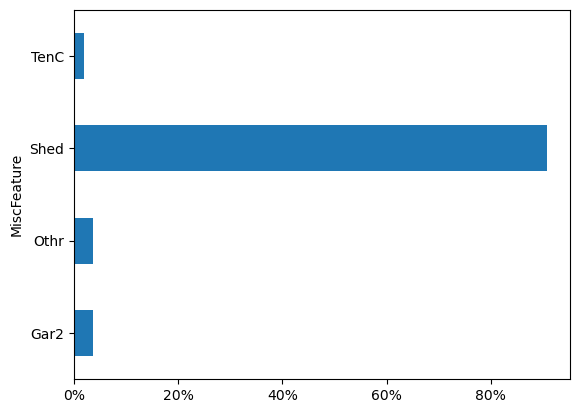

In [87]:
ax = df.value_counts('MiscFeature',normalize=True,sort=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### MiscVal

MiscVal: $Value of miscellaneous feature

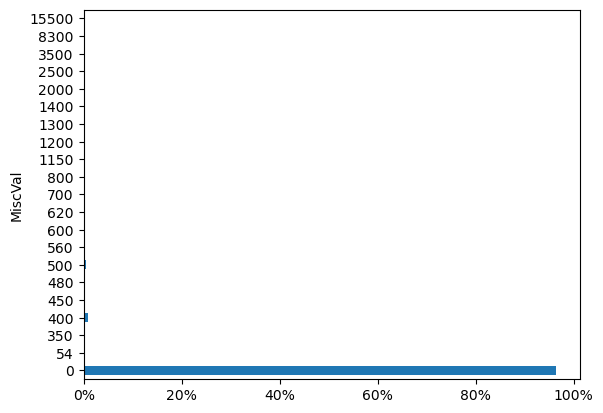

In [88]:
ax = df.value_counts('MiscVal',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### Fence

Fence: Fence quality
		
       GdPrv	Good Privacy
       MnPrv	Minimum Privacy
       GdWo	Good Wood
       MnWw	Minimum Wood/Wire
       NA	No Fence

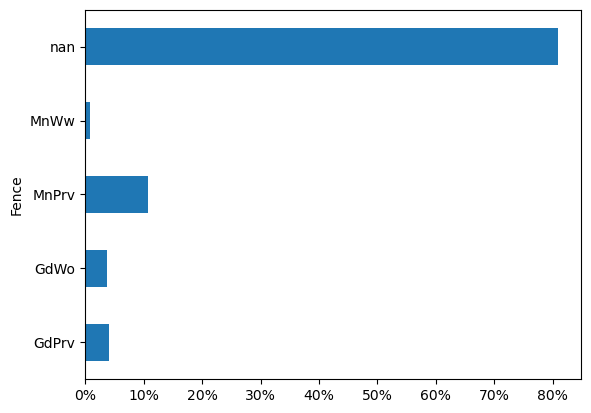

In [89]:
ax = df.value_counts('Fence',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

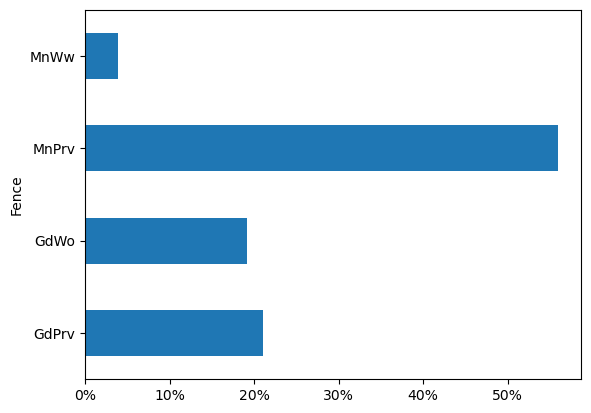

In [90]:
ax = df.value_counts('Fence',normalize=True,sort=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### PoolQC

PoolQC: Pool quality
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       NA	No Pool
		

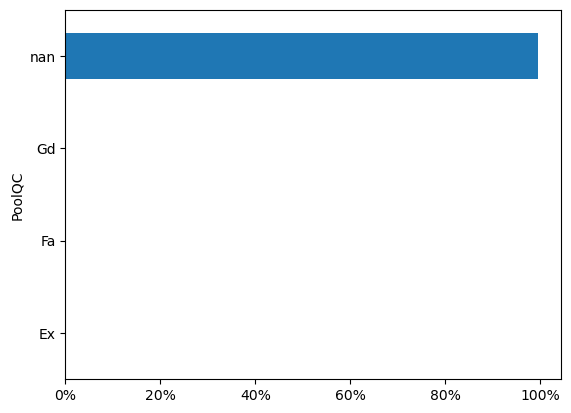

In [91]:
ax = df.value_counts('PoolQC',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### PoolArea

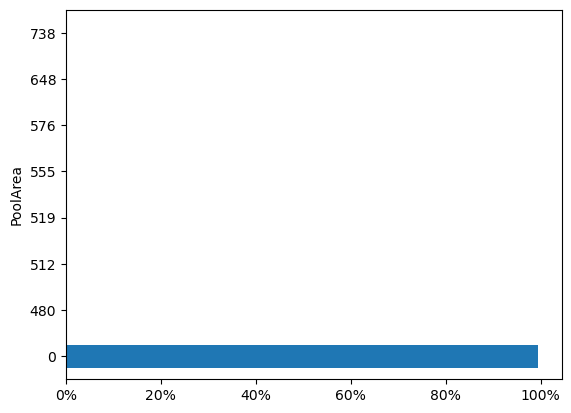

In [92]:
ax = df.value_counts('PoolArea',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

In [93]:
df.value_counts('PoolArea',dropna=False)

PoolArea
0      1453
480       1
512       1
519       1
555       1
576       1
648       1
738       1
dtype: int64

### ScreenPorch

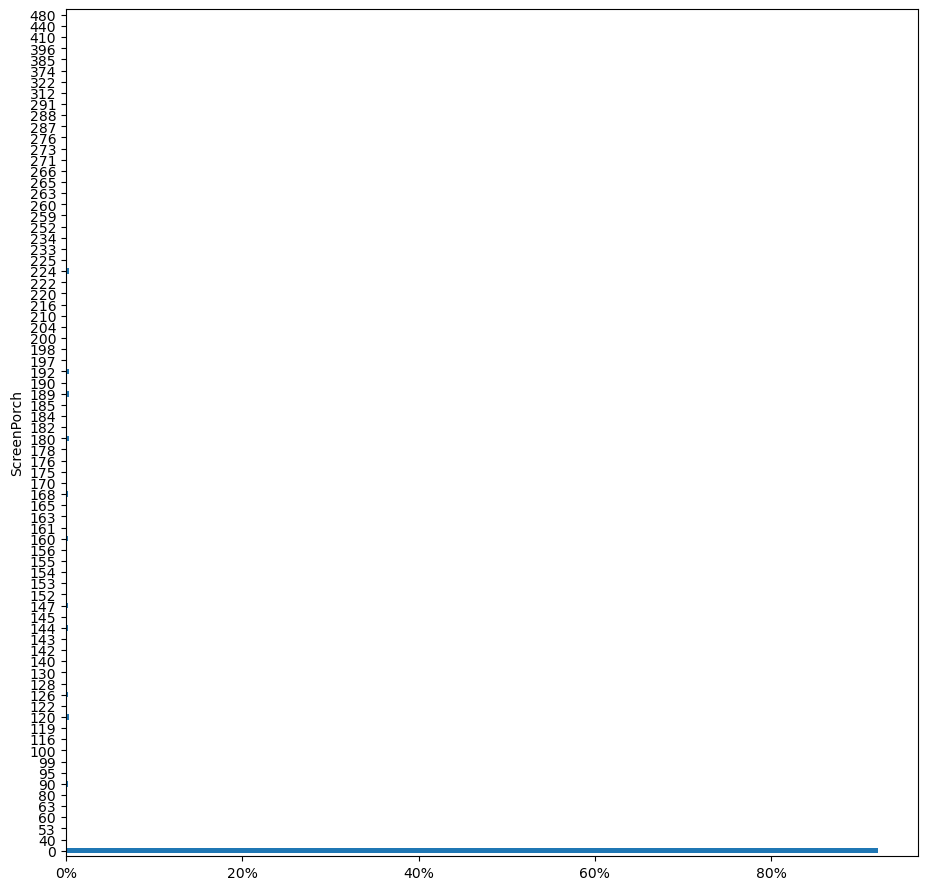

In [94]:
plt.figure(figsize=(11,11))
ax = df.value_counts('ScreenPorch',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### OpenPorchSF

### EnclosedPorch

### 3SsnPorch

### WoodDeckSF

WoodDeckSF: Wood deck area in square feet

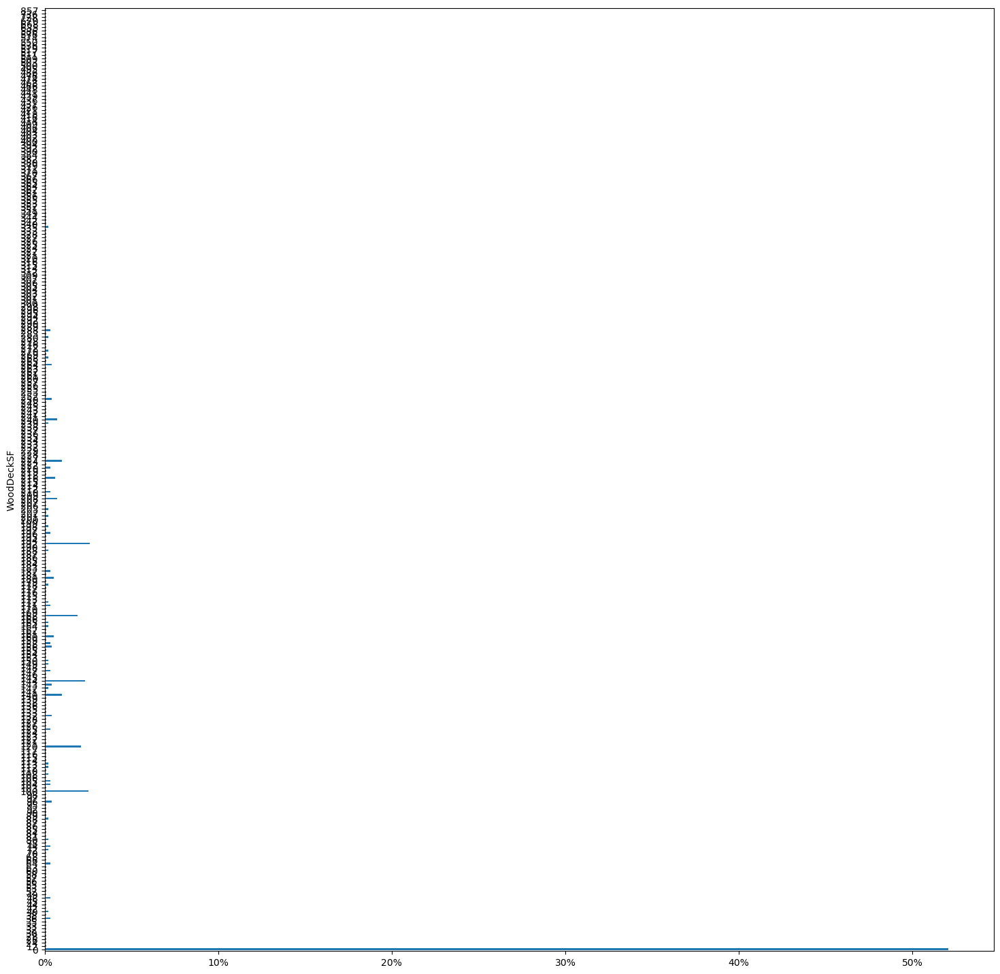

In [95]:
plt.figure(figsize=(18,18))
ax = df.value_counts('WoodDeckSF',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

Text(0.5, 1.0, 'wood deck area contribution')

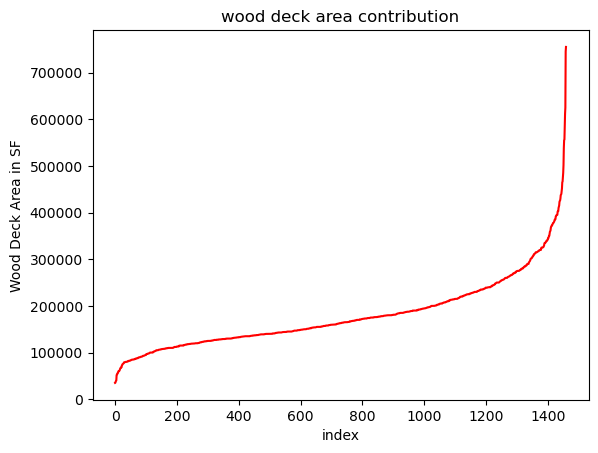

In [96]:
WoodDeckSF = df['WoodDeckSF'].sort_values(ascending=True)
x = [ i for i in range(len(WoodDeckSF))]
plt.plot(x,price,'r')
plt.xlabel("index")
plt.ylabel("Wood Deck Area in SF")
plt.title("wood deck area contribution")

### PavedDrive

PavedDrive: Paved driveway

       Y	Paved 
       P	Partial Pavement
       N	Dirt/Gravel

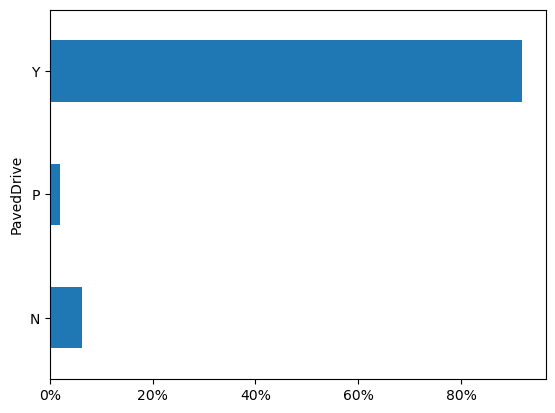

In [97]:

ax = df.value_counts('PavedDrive',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageCond

GarageCond: Garage condition

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor
       NA	No Garage

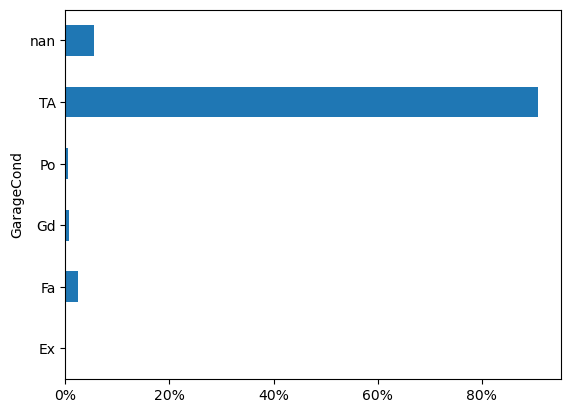

In [98]:
ax = df.value_counts('GarageCond',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageQual

GarageQual: Garage quality

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor
       NA	No Garage

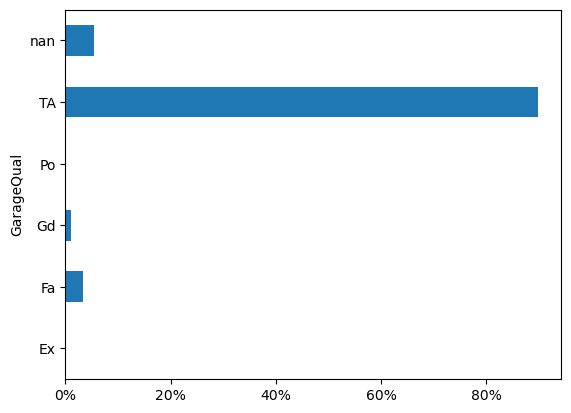

In [99]:
ax = df.value_counts('GarageQual',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageArea

GarageArea: Size of garage in square feet

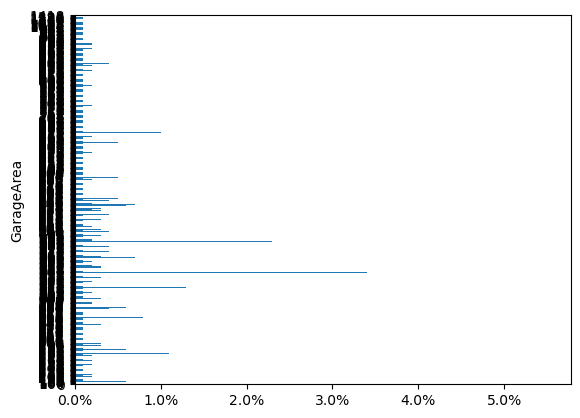

In [100]:
ax = df.value_counts('GarageArea',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageCars

GarageCars: Size of garage in car capacity

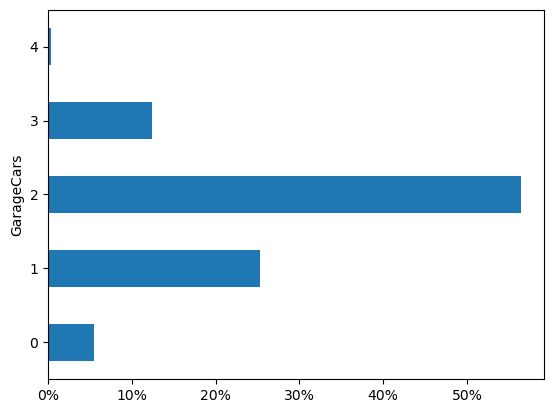

In [101]:
ax = df.value_counts('GarageCars',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageFinish

GarageFinish: Interior finish of the garage

       Fin	Finished
       RFn	Rough Finished	
       Unf	Unfinished
       NA	No Garage

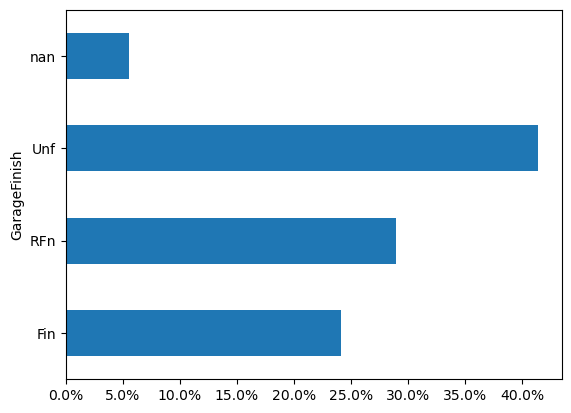

In [102]:
ax = df.value_counts('GarageFinish',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageYrBlt

GarageYrBlt: Year garage was built

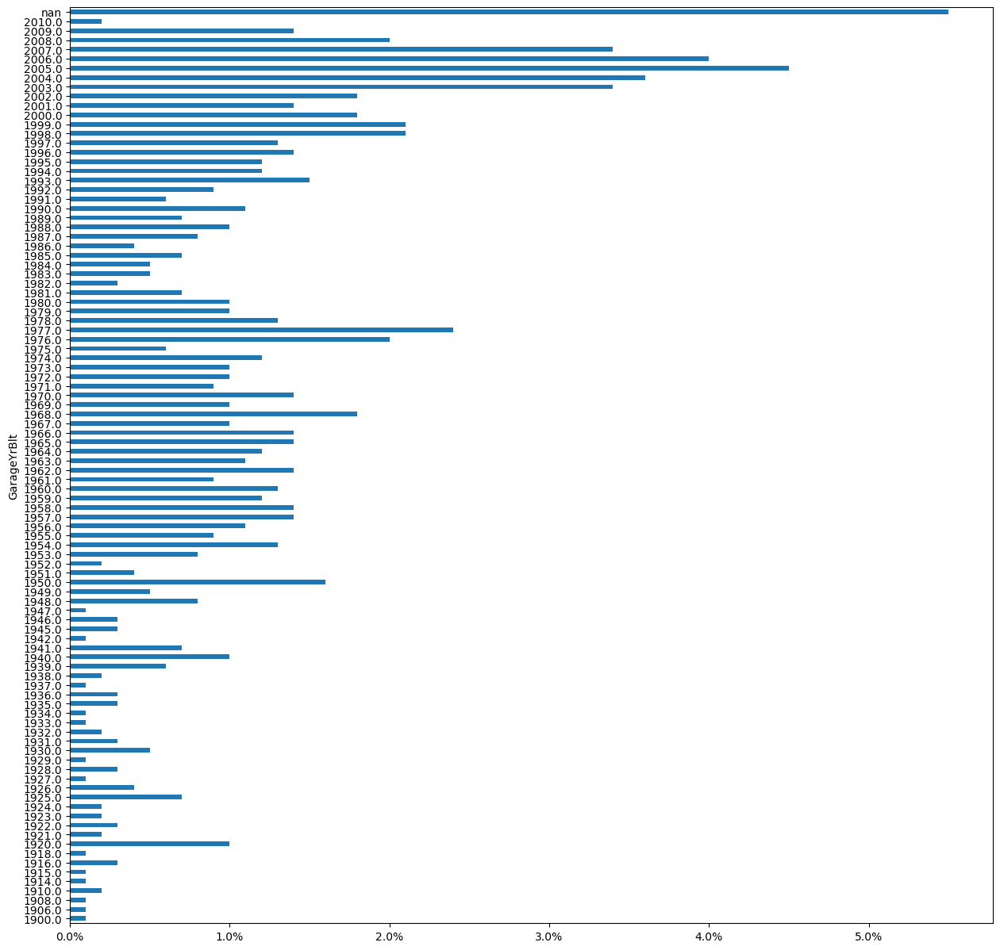

In [103]:
plt.figure(figsize=(15,15))
ax = df.value_counts('GarageYrBlt',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### GarageType

GarageType: Garage location
		
       2Types	More than one type of garage
       Attchd	Attached to home
       Basment	Basement Garage
       BuiltIn	Built-In (Garage part of house - typically has room above garage)
       CarPort	Car Port
       Detchd	Detached from home
       NA	No Garage

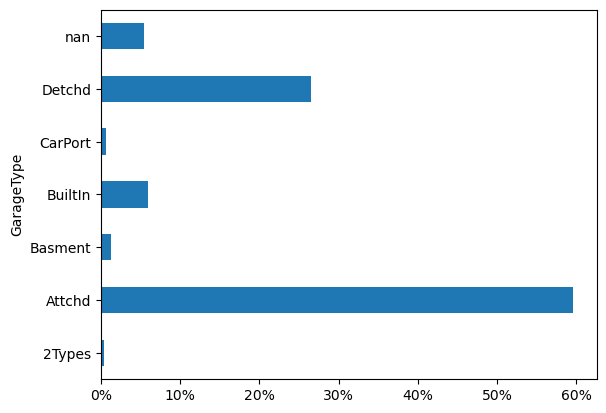

In [104]:
ax = df.value_counts('GarageType',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

### FireplaceQu

### Fireplaces

Fireplaces: Number of fireplaces

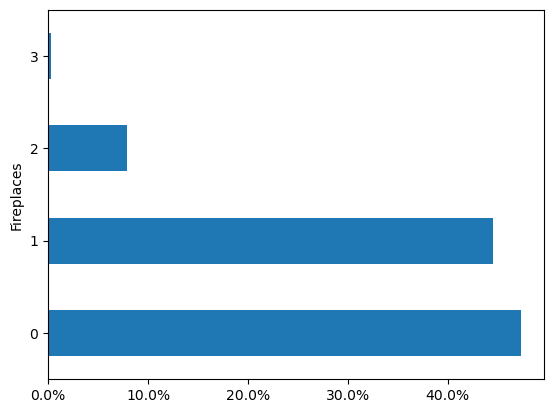

In [105]:
ax = df.value_counts('Fireplaces',normalize=True,sort=False,dropna=False).mul(100).round(1).plot(kind='barh')
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

# Preprocessing data

Now that  we have a look of the different variables in the dataset. we can compare the training and test data to see if the missing values columns are the same.

In [106]:
print(df.columns)
print(df.columns.shape)

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'Wo

type NaN columns

In [107]:
NaNColumns = df.isna().any()[df.isna().any() == True].index.values

In [108]:
print(NaNColumns)
print(len(NaNColumns))

['LotFrontage' 'Alley' 'MasVnrType' 'MasVnrArea' 'BsmtQual' 'BsmtCond'
 'BsmtExposure' 'BsmtFinType1' 'BsmtFinType2' 'Electrical' 'FireplaceQu'
 'GarageType' 'GarageYrBlt' 'GarageFinish' 'GarageQual' 'GarageCond'
 'PoolQC' 'Fence' 'MiscFeature']
19


The columns containing missing values in the training set.

In [109]:
for i, name in enumerate(NaNColumns):
    print(f"{str(i):8} {name:15} {df[name].dtypes}")

0        LotFrontage     float64
1        Alley           object
2        MasVnrType      object
3        MasVnrArea      float64
4        BsmtQual        object
5        BsmtCond        object
6        BsmtExposure    object
7        BsmtFinType1    object
8        BsmtFinType2    object
9        Electrical      object
10       FireplaceQu     object
11       GarageType      object
12       GarageYrBlt     float64
13       GarageFinish    object
14       GarageQual      object
15       GarageCond      object
16       PoolQC          object
17       Fence           object
18       MiscFeature     object


Most of these columns have categorical features. 

First we will reduce the number of variables in the data to improve time performance of our models. Moreover we will use 
hot encoding for categorical features which will increase the number of variables.
we will select a subset of featuures to work with, based on the following arguments:
- pertinence
- we keep numerical features
- don't keep if categorical features are above 80% 

In [110]:
columnsToKeep = ['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea',
       'LotShape','LotConfig',
       'Neighborhood', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 
       'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtFinType1','TotalBsmtSF', 'HeatingQC', 'CentralAir',
       '1stFlrSF', '2ndFlrSF','GrLivArea', 'BsmtFullBath',
       'FullBath','BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd','Fireplaces',  'GarageType','YearRemodAdd',
       'GarageFinish', 'GarageCars', 'GarageArea', 
       'WoodDeckSF', 'MoSold', 'YrSold', 'SalePrice']

maybeToKeep =['SaleCondition','Condition1','BldgType', 'BsmtFinSF1','BsmtFinType2', 'BsmtFinSF2','Electrical',
              'BsmtHalfBath','HalfBath']
# MsZoning, LotShape

print(f'nb columns to keep:{len(columnsToKeep):4}')

nb columns to keep:  43


We will keep 43 features out of 81 and see if we can come up with good results.

In [111]:
dfToKeep = df.loc[:,columnsToKeep]
for i in range(len(dfToKeep.columns)):
    print(f"{str(i):8} {dfToKeep.columns.values[i]:15} {dfToKeep.dtypes[i]}")

0        MSSubClass      int64
1        MSZoning        object
2        LotFrontage     float64
3        LotArea         int64
4        LotShape        object
5        LotConfig       object
6        Neighborhood    object
7        BldgType        object
8        HouseStyle      object
9        OverallQual     int64
10       OverallCond     int64
11       YearBuilt       int64
12       RoofStyle       object
13       Exterior1st     object
14       Exterior2nd     object
15       MasVnrType      object
16       ExterQual       object
17       ExterCond       object
18       Foundation      object
19       BsmtQual        object
20       BsmtFinType1    object
21       TotalBsmtSF     int64
22       HeatingQC       object
23       CentralAir      object
24       1stFlrSF        int64
25       2ndFlrSF        int64
26       GrLivArea       int64
27       BsmtFullBath    int64
28       FullBath        int64
29       BedroomAbvGr    int64
30       KitchenAbvGr    int64
31       KitchenQual

Now we will compare the missing features in the train and test sets.

In [112]:
df.loc[:,columnsToKeep].isna().any()[df.loc[:,columnsToKeep].isna().any() == True]

LotFrontage     True
MasVnrType      True
BsmtQual        True
BsmtFinType1    True
GarageType      True
GarageFinish    True
dtype: bool

In [113]:
columnsToKeep_test = columnsToKeep.copy()
columnsToKeep_test.remove('SalePrice')
df_test.loc[:,columnsToKeep_test].isna().any()[df_test.loc[:,columnsToKeep_test].isna().any() == True]

MSZoning        True
LotFrontage     True
Exterior1st     True
Exterior2nd     True
MasVnrType      True
BsmtQual        True
BsmtFinType1    True
TotalBsmtSF     True
BsmtFullBath    True
KitchenQual     True
GarageType      True
GarageFinish    True
GarageCars      True
GarageArea      True
dtype: bool

In [114]:
test_nan = df_test.loc[:,columnsToKeep_test].isna().any()[df_test.loc[:,columnsToKeep_test].isna().any() == True].index.values
train_nan = df.loc[:,columnsToKeep].isna().any()[df.loc[:,columnsToKeep].isna().any() == True].index.values
diff_nan =[ i for i in test_nan if i not in train_nan]
for i in diff_nan:
    print(f"{str(i):15}  {df[i].dtypes}")

MSZoning         object
Exterior1st      object
Exterior2nd      object
TotalBsmtSF      int64
BsmtFullBath     int64
KitchenQual      object
GarageCars       int64
GarageArea       int64


As we can see the test set contains more missing features than than the train set.
At the moment we will skip the preprocessing of the test set.

Moreover in the HouseStyle feature therre is one one value in test which is not in the train set.

In [115]:
print(df_test['HouseStyle'].value_counts())
print(df['HouseStyle'].value_counts())

1Story    745
2Story    427
1.5Fin    160
SLvl       63
SFoyer     46
2.5Unf     13
1.5Unf      5
Name: HouseStyle, dtype: int64
1Story    726
2Story    445
1.5Fin    154
SLvl       65
SFoyer     37
1.5Unf     14
2.5Unf     11
2.5Fin      8
Name: HouseStyle, dtype: int64


In [116]:
print(df_test['ExterCond'].value_counts())
print(df['ExterCond'].value_counts())

TA    1256
Gd     153
Fa      39
Ex       9
Po       2
Name: ExterCond, dtype: int64
TA    1282
Gd     146
Fa      28
Ex       3
Po       1
Name: ExterCond, dtype: int64


## First try

we do not select the missing columns in the test set that are not in the train set for now. So we will keep 35 columns instead of 43.

In [117]:
#columnsToKeep = ['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea',
#       'LotShape','LotConfig',
#       'Neighborhood', 'BldgType',
#       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 
#       'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
#       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
#       'BsmtFinType1','TotalBsmtSF', 'HeatingQC', 'CentralAir',
#       '1stFlrSF', '2ndFlrSF','GrLivArea', 'BsmtFullBath',
#       'FullBath','BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
#       'TotRmsAbvGrd','Fireplaces',  'GarageType','YearRemodAdd',
#       'GarageFinish', 'GarageCars', 'GarageArea', 
#       'WoodDeckSF', 'MoSold', 'YrSold', 'SalePrice']

columnsToKeep = ['MSSubClass', 'LotFrontage', 'LotArea',
       'LotShape','LotConfig', 'ExterCond' , 'HouseStyle',
       'Neighborhood', 'BldgType',
       'OverallQual', 'OverallCond', 'YearBuilt', 
       'RoofStyle',  'MasVnrType',
       'ExterQual',  'Foundation', 'BsmtQual',
       'BsmtFinType1', 'HeatingQC', 'CentralAir',
       '1stFlrSF', '2ndFlrSF','GrLivArea', 
       'FullBath','BedroomAbvGr', 'KitchenAbvGr', 
       'TotRmsAbvGrd','Fireplaces',  'GarageType','YearRemodAdd',
       'GarageFinish',  
       'WoodDeckSF', 'MoSold', 'YrSold', 'SalePrice']


maybeToKeep =['SaleCondition','Condition1','BldgType', 'BsmtFinSF1','BsmtFinType2', 'BsmtFinSF2','Electrical',
              'BsmtHalfBath','HalfBath']


print(f'nb columns to keep:{len(columnsToKeep):4}')

nb columns to keep:  35


In [118]:
#CategoriesColumns =['MSSubClass','OverallQual','OverallCond','TotRmsAbvGrd','BsmtFullBath','FullBath','BedroomAbvGr',
#'KitchenAbvGr','GarageCars , MoSold','YrSold','YearBuilt','Fireplaces','YearRemodAdd','GarageCars','MoSold']

CategoriesColumns =['MSSubClass','OverallQual','OverallCond','TotRmsAbvGrd','FullBath','BedroomAbvGr',
'KitchenAbvGr','GarageCars' , 'MoSold','YrSold','YearBuilt','Fireplaces','YearRemodAdd']


In [119]:
for i in CategoriesColumns:
    if (df[i].isna().any() == True or df_test[i].isna().any() == True):
        print(f"{i}  :missing value")
    

GarageCars  :missing value


In [120]:
def changeColums(df):
    maxYrSold =df['YrSold'].max()
    df['YearRemodAdd'] = df['YearRemodAdd'] - df['YearBuilt']
    df['YearBuilt'] = df['YearBuilt'].apply(lambda x: maxYrSold - x)
    return df

In [121]:
def removeOutliers(df, columnsToAvoid, ratioToDrop):
    '''ratioToDrop is the  value between [0,1] of quantile that will be dropped'''
    indexToDrop = []
    nbRowStart = df.shape[0]
    for i in df.columns:
        if ((df[i].dtypes =='int64' or df[i].dtypes =='float64') and (i not in columnsToAvoid)):
            print(i)
            ratioToDropHead = ratioToDrop/2
            ratioToDropTail = 1-(ratioToDrop/2)
            head = df[i].quantile(ratioToDropHead)
            tail = df[i].quantile(ratioToDropTail)
            index_i = df[i][(df[i]> tail) | (df[i]< head)].index
            print(f'head {head:10}, tail :{tail:10}, nb index {len(index_i):10}\n')
            for j in index_i:
                indexToDrop.append(j)
    index =set(indexToDrop)
    df.drop(index,inplace=True)
    nbRowEnd = df.shape[0]
    df.reset_index(drop=True,inplace=True)
    print(f" data Before removing outliers: {nbRowStart}")
    print(f" data After removing outliers: {nbRowEnd}")
    print(f" data loss after removing outliers: {nbRowStart-nbRowEnd:7}\n")
    return df
                 

In [122]:
def RemoveNaN(df,columns,df_test):
    '''remove NaN if column type is object otherwise
    if column is type int64 or float64 the NaN values are replaced by the mean of the column.'''
    nbRowStart = df.shape[0]
    for i in df.columns:
        if ((df[i].dtypes == 'int64' or df[i].dtypes=='float64') ): #and (i not in columns)
            mean = df.loc[:,i].dropna().mean()
            if i != 'SalePrice':
                df_test[i].fillna(mean,inplace=True)
            df[i].fillna(mean,inplace=True)
        elif df[i].dtypes == 'object':
            df_test[i].fillna('None',inplace=True)
            df[i].fillna('None',inplace=True)
    df.dropna(inplace=True)
    df.reset_index(drop=True,inplace=True)
    nbRowEnd = df.shape[0]
    print(f" data Before removing NaN: {nbRowStart}")
    print(f" data After removing NaN: {nbRowEnd}")
    print(f" data loss after removing NaN: {nbRowStart-nbRowEnd:7}")
    return (df,df_test)

In [123]:
# one-hot encoding
def encodingOneHot(df):
    columnsObject = [i for i in df.columns if df[i].dtypes == 'object']
    encodedData = pd.get_dummies(df, columns = columnsObject,drop_first=True)
    print(f'data shape: {encodedData.shape}')
    display(encodedData.head())
    return encodedData

In [124]:
dfToKeep = df.loc[:,columnsToKeep]
for i in range(len(dfToKeep.columns)):
    print(f"{str(i):8} {dfToKeep.columns.values[i]:15} {dfToKeep.dtypes[i]}")

0        MSSubClass      int64
1        LotFrontage     float64
2        LotArea         int64
3        LotShape        object
4        LotConfig       object
5        ExterCond       object
6        HouseStyle      object
7        Neighborhood    object
8        BldgType        object
9        OverallQual     int64
10       OverallCond     int64
11       YearBuilt       int64
12       RoofStyle       object
13       MasVnrType      object
14       ExterQual       object
15       Foundation      object
16       BsmtQual        object
17       BsmtFinType1    object
18       HeatingQC       object
19       CentralAir      object
20       1stFlrSF        int64
21       2ndFlrSF        int64
22       GrLivArea       int64
23       FullBath        int64
24       BedroomAbvGr    int64
25       KitchenAbvGr    int64
26       TotRmsAbvGrd    int64
27       Fireplaces      int64
28       GarageType      object
29       YearRemodAdd    int64
30       GarageFinish    object
31       WoodDeckSF  

In [125]:
## train & test
columnsToKeep_test = columnsToKeep.copy()
columnsToKeep_test.remove('SalePrice')
dfToKeep_test = df_test.loc[:,columnsToKeep_test]
dfToKeep = df.loc[:,columnsToKeep]

dfToKeep = encodingOneHot(dfToKeep)
dfToKeep = changeColums(dfToKeep)

dfToKeep_test = encodingOneHot(dfToKeep_test)
dfToKeep_test = changeColums(dfToKeep_test)

dfToKeep, dfToKeep_test = RemoveNaN(dfToKeep,CategoriesColumns,dfToKeep_test)

dfToKeep = removeOutliers(dfToKeep,CategoriesColumns,0.02)

data = dfToKeep
data_test = dfToKeep_test

data shape: (1460, 101)


,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,1stFlrSF,2ndFlrSF,GrLivArea,FullBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,YearRemodAdd,WoodDeckSF,MoSold,YrSold,SalePrice,LotShape_IR2,LotShape_IR3,LotShape_Reg,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,...,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,60,65.0,8450,7,5,2003,856,854,1710,2,3,1,8,0,2003,0,2,2008,208500,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0
2,20,80.0,9600,6,8,1976,1262,0,1262,2,3,1,6,1,1976,298,5,2007,181500,0,0,1,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0
3,60,68.0,11250,7,5,2001,920,866,1786,2,3,1,6,1,2002,0,9,2008,223500,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0
4,70,60.0,9550,7,5,1915,961,756,1717,1,3,1,7,1,1970,0,2,2006,140000,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,1
5,60,84.0,14260,8,5,2000,1145,1053,2198,2,4,1,9,1,2000,192,12,2008,250000,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0


data shape: (1459, 99)


,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,1stFlrSF,2ndFlrSF,GrLivArea,FullBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,YearRemodAdd,WoodDeckSF,MoSold,YrSold,LotShape_IR2,LotShape_IR3,LotShape_Reg,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1461,20,80.0,11622,5,6,1961,896,0,896,1,2,1,5,0,1961,140,6,2010,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,1,1,0,0,0,0,0,1
1462,20,81.0,14267,6,6,1958,1329,0,1329,1,3,1,6,0,1958,393,6,2010,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1
1463,60,74.0,13830,5,5,1997,928,701,1629,2,3,1,6,1,1998,212,3,2010,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0
1464,60,78.0,9978,6,6,1998,926,678,1604,2,3,1,7,1,1998,360,6,2010,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0
1465,120,43.0,5005,8,5,1992,1280,0,1280,2,2,1,5,0,1992,0,1,2010,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0


 data Before removing NaN: 1460
 data After removing NaN: 1460
 data loss after removing NaN:       0
LotFrontage
head       21.0, tail :137.41000000000008, nb index         15

LotArea
head     1680.0, tail :37567.64000000021, nb index         22

1stFlrSF
head      520.0, tail :2219.4600000000005, nb index         27

2ndFlrSF
head        0.0, tail :1418.920000000001, nb index         15

GrLivArea
head     692.18, tail :3123.4800000000023, nb index         30

WoodDeckSF
head        0.0, tail :505.4600000000005, nb index         15

SalePrice
head   61815.97, tail :442567.01000000053, nb index         30

 data Before removing outliers: 1460
 data After removing outliers: 1353
 data loss after removing outliers:     107



In [126]:
[i for i in data_test.columns if i not in data.columns]

[]

In [127]:
[i for i in data.columns if i not in data_test.columns]

['SalePrice', 'HouseStyle_2.5Fin']

we will drop the columns which is not in data test 

In [128]:
data.drop(columns=['HouseStyle_2.5Fin'],inplace=True)

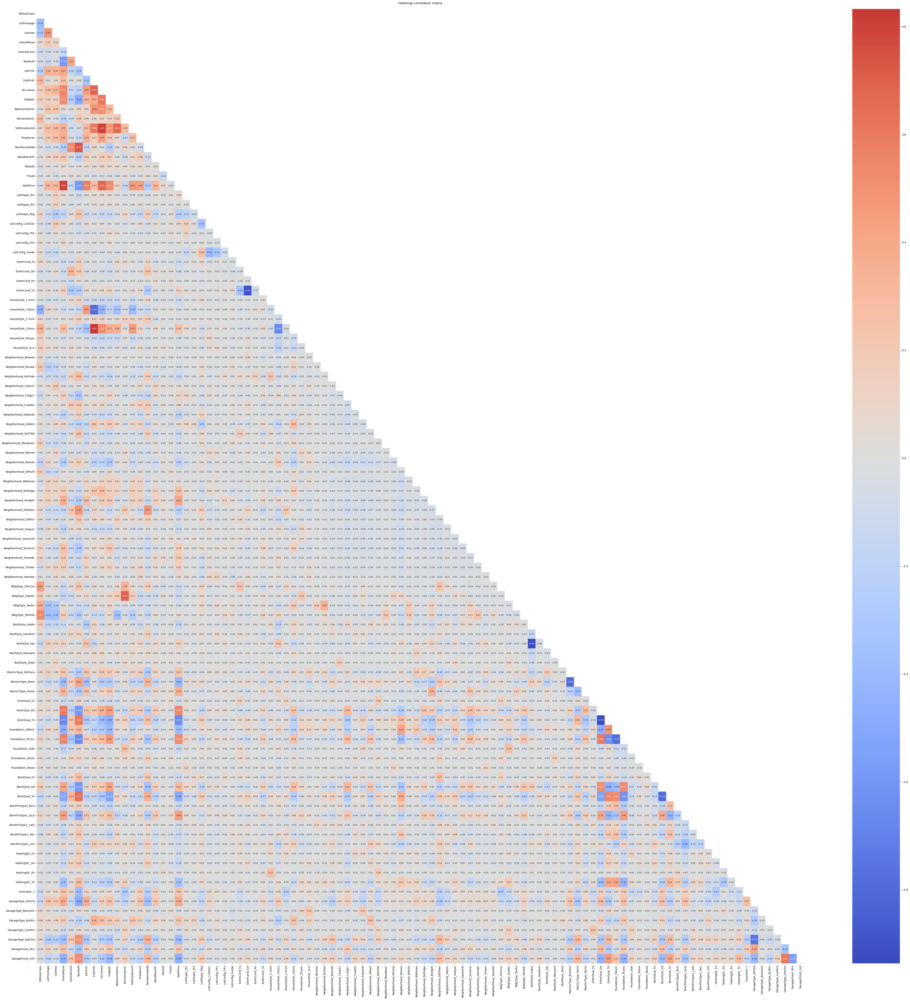

In [129]:
corr = data.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots(figsize=(65,65))
ax = sns.heatmap(corr, annot=True, fmt=".2f", annot_kws={'size':8}, 
                 mask=mask, center=0, cmap="coolwarm")
plt.title(f"Heatmap correlation matrix\n")
plt.show()

## check PCA

In [130]:
x = data.loc[:, data.columns !='SalePrice']
y = data.loc[:, 'SalePrice']

In [131]:
n_comp = 10
pca = PCA(n_comp)
pca = pca.fit(x)
pcs = pca.components_

Text(0.5, 1.0, 'proportion de la variance pour chaque axes')

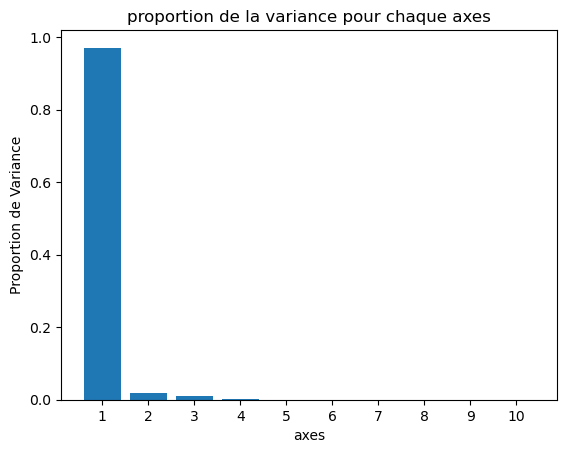

In [132]:
plt.bar(np.arange(1,n_comp+1), pca.explained_variance_ratio_)
plt.rcParams['figure.figsize'] = [15, 15]
plt.xticks(np.arange(1, 10+1))  # Set label locations.
plt.xlabel("axes")
plt.ylabel("Proportion de Variance")
plt.title("proportion de la variance pour chaque axes")

As we can see the data is mostly linear 97% of the information is in one variable.

In [133]:
print(pca.explained_variance_ratio_)

[9.70714412e-01 1.88338906e-02 9.47618883e-03 7.51533131e-04
 8.72978371e-05 7.52043220e-05 3.66667033e-05 1.29024056e-05
 1.08184173e-05 4.58767034e-07]


## Class Models

we will create a class object which will emulate gridsearchcv but we will add the PCA features to the crossvalidation. 

In [134]:
from multiprocessing import *
from itertools import product

class batch:
    def __init__(self):
        self.train = []
        self.validation = []

class crossValidation:
    def __init__(self,nbFolds=5):
        self.nbFolds = nbFolds
        self.batch = []# contain batch/fold objects 
        self.foldsIndex = [] # nbFolds index batchesi
        
    def createFolds(self,df,random_state=None):
        ''' create Folds for crossvalidation, assuming data is pandas dataframe'''
        nbObs = df.shape[0]
        nbElems = np.rint(nbObs/self.nbFolds)
        #print(nbElems)
        nbElems = int(nbElems)
        #print(nbElems)
        tempData = data.loc[:,df.columns[0]]# loc data to have access to index afterward
        for i in range(self.nbFolds):
            if i != self.nbFolds-1:
                index = tempData.sample(nbElems,random_state=random_state).index
                #print(index)
                tempData.drop(index,inplace=True)
                self.foldsIndex.append(index)
            else:
                index = tempData.index
                self.foldsIndex.append(index)
        if len(tuple(sum([list(i.values) for i in self.foldsIndex],[]))) != nbObs:
            raise Exception("number of data from df and folds are not the same")
        for i in range(self.nbFolds):
            liste = [ i for i in range(self.nbFolds)]
            oneBatch = batch()
            oneBatch.validation.append(i)
            liste.remove(i)
            for elem in liste:
                oneBatch.train.append(elem)
            self.batch.append(oneBatch)
                 
    def fit(self,estimator,X,Y):
        ''' return score function result '''
        scoreRes = []
        for i in range(self.nbFolds):
            trainIndex = pd.Index([],dtype='int64')
            for j in self.batch[i].train:
                trainIndex = trainIndex.union(self.foldsIndex[j])
            train = trainIndex
            validation = self.foldsIndex[self.batch[i].validation[0]]
            Xtrain = X.loc[train,X.columns.values]
            Ytrain = Y.loc[train]
            Xval = X.loc[validation,X.columns.values]
            Yval = Y.loc[validation]
            #PCA, TODO standard scaling
            if 'pca' in estimator.named_steps.keys():
                Xtrain = estimator['pca'].fit_transform(Xtrain)
                Xval = estimator['pca'].transform(Xval)
            estimator['estimator'].fit(Xtrain,Ytrain)
            Ypred = estimator['estimator'].predict(Xval)
            scoreResFold = mean_squared_error(Yval,Ypred,squared=False)
            scoreRes.append(scoreResFold)
        res = np.mean(scoreRes)
        return res

    
class gridsearchparams:
    
    def _njobs(self,njobs):
        """ TODO multi processing for cross validation"""
        if njobs >= -1 and njobs <= cpu_count():
            if njobs != -1:
                return njobs
            else:
                return -1
        else:
            raise Exception("invalid njobs number, It should be between -1 and your number of cpu cores")
    
    def __init__(self,estimator,paramGrid,cv=5,njobs=1,random_state=None):
        self.cv = cv
        self.paramGrid = paramGrid # the different parameters to try for the estimators. Same Use as in gridsearchcv
        self.njobs = self._njobs(njobs)
        self.estimator = estimator
        self.random_state = random_state
        self.gridEsti = []

    def dict_configs(self,d):
        '''list all the different combinaisons for the parameters grid
         >>>G = {'a': [1,2], 'b': [3], 'c': [1, 2.5] }
            >>>for config in dict_configs(G):
            ... print(config)

        {'a': 1, 'b': 3, 'c': 1} 
        {'a': 1, 'b': 3, 'c': 2.5}
        {'a': 2, 'b': 3, 'c': 1}
        {'a': 2, 'b': 3, 'c': 2.5}''' 

        for vcomb in product(*d.values()):
            yield dict(zip(d.keys(), vcomb)) 

    def createGridParams(self):
        '''select all parameters in paramGrid starting with "estimator" and pass them to dict_configs.
        The result is the different combinations of the paramters which are store in an estimator grid "gridEsti". '''
        for conf in self.dict_configs({i:j for i,j in self.paramGrid.items() if i.startswith("estimator")}):
            conf['result']=int()
            self.gridEsti.append(conf)
        
    def changeParams(self,conf):
        '''take a combinations of parameters and apply it to the model'''
        for parameter in conf.keys(): 
            if parameter.startswith("estimator"):
                paraEsti = parameter.split('estimator__')[-1]
                self.estimator['estimator'].__dict__[paraEsti]=conf[parameter]
            self.estimator['estimator'].__dict__['random_state']=self.random_state
    
    def bestScore(self):
        ''' look for the X best fit for the model'''
        resToKeep = 5
        resMat = [[j['result'],i] for i, j in enumerate(self.gridEsti)]
        resmat = np.asarray(resMat)
        resMat= sorted(resMat)
        #print(resMat)
        bestresIndex = resMat[:resToKeep]
        for k,l in enumerate(bestresIndex):
            ind = l[1]
            print(f"#{str(k+1):10}\n{self.gridEsti[ind]}")
        
        
    def fit(self,X,Y):
        if X.shape[0] != Y.shape[0]:
            raise Exception("X and Y shape are not the same")
        cv = crossValidation(self.cv)
        cv.createFolds(X,self.random_state)
        self.createGridParams()
        for i,confParams in enumerate(self.gridEsti):
            self.changeParams(confParams)
            score=cv.fit(self.estimator,X,Y)
            self.gridEsti[i]['result']=score
        self.bestScore()

## Test gridparams

In [135]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
a=[0.2,0.3,1,5,600]
model = Pipeline(steps=[("pca" , PCA()),('estimator',linear_model.Ridge())]) # PCA: n_components=0.95 multiply by 3 the error
grid ={'estimator__alpha':a,'no_idea':90,'estimator__tol':[1e-3,1e-4],'estimator__solver':['cholesky', 'lsqr','auto']}

In [136]:
gcs =gridsearchparams(model,grid,random_state=199)


In [137]:
X = data.loc[:,data.columns != 'SalePrice']
Y=data.loc[:,'SalePrice']
print(X.shape)
print(Y.shape)

(1353, 99)
(1353,)


In [138]:
print(type(grid))
gcs.fit(X,Y)

<class 'dict'>
#1         
{'estimator__alpha': 1, 'estimator__tol': 0.001, 'estimator__solver': 'cholesky', 'result': 22544.246802022066}
#2         
{'estimator__alpha': 1, 'estimator__tol': 0.001, 'estimator__solver': 'auto', 'result': 22544.246802022066}
#3         
{'estimator__alpha': 1, 'estimator__tol': 0.0001, 'estimator__solver': 'cholesky', 'result': 22544.246802022066}
#4         
{'estimator__alpha': 1, 'estimator__tol': 0.0001, 'estimator__solver': 'auto', 'result': 22544.246802022066}
#5         
{'estimator__alpha': 5, 'estimator__tol': 0.001, 'estimator__solver': 'cholesky', 'result': 22549.1457038364}


In [139]:
gcs.gridEsti[:4]

[{'estimator__alpha': 0.2,
  'estimator__tol': 0.001,
  'estimator__solver': 'cholesky',
  'result': 22657.39945427473},
 {'estimator__alpha': 0.2,
  'estimator__tol': 0.001,
  'estimator__solver': 'lsqr',
  'result': 33619.12751099188},
 {'estimator__alpha': 0.2,
  'estimator__tol': 0.001,
  'estimator__solver': 'auto',
  'result': 22657.39945427473},
 {'estimator__alpha': 0.2,
  'estimator__tol': 0.0001,
  'estimator__solver': 'cholesky',
  'result': 22657.39945427473}]

# model search

I recomend you to check the following kernel kaggle: [Link](https://www.kaggle.com/code/dmitryshekhov/catboost-xgboost-lightgbm-regression-challenge)
There is a quick  summarry of different gradient boosting algorithms (advantages and disadvantages). Moreover he use an open source  hyperparameter optimization framework called  [Optuna](https://optuna.org/).
Optuna is really great. It supports a lot algorithms and different features such as parallel processing and it's really easy to use.

In [140]:
X = data.loc[:,data.columns != 'SalePrice']
Y=data.loc[:,'SalePrice']
print(f"x shape: {X.shape}")
print(f"y shape: {Y.shape}")

x shape: (1353, 99)
y shape: (1353,)


##  Ridge

In [141]:
model = Pipeline(steps=[("pca" , PCA()),('estimator',linear_model.Ridge())]) # PCA: n_components=0.95 multiply by 3 the error
n_alphas = 100
a = np.linspace(1, 10, num=n_alphas)
grid ={'estimator__alpha':a,'estimator__tol':[1e-3,1e-4]}

In [142]:
gcs =gridsearchparams(model,grid,random_state=199)
gcs.fit(X,Y)

#1         
{'estimator__alpha': 2.4545454545454546, 'estimator__tol': 0.001, 'result': 22506.232328427774}
#2         
{'estimator__alpha': 2.4545454545454546, 'estimator__tol': 0.0001, 'result': 22506.232328427774}
#3         
{'estimator__alpha': 2.3636363636363638, 'estimator__tol': 0.001, 'result': 22506.308384372}
#4         
{'estimator__alpha': 2.3636363636363638, 'estimator__tol': 0.0001, 'result': 22506.308384372}
#5         
{'estimator__alpha': 2.5454545454545454, 'estimator__tol': 0.001, 'result': 22506.339403513433}


## Random Forest 

In [143]:
gridRF = {'estimator__n_estimators': [5,10,20,30,50,100,150,200],'estimator__max_depth' : [5,7,10,50,100,200,400],'estimator__min_samples_leaf' : [2,3]}


In [144]:
modelRF = Pipeline(steps=[("pca" , PCA()),('estimator',RandomForestRegressor())])


In [145]:
gcsRF =gridsearchparams(modelRF,gridRF,random_state=199)

In [146]:
gcsRF.paramGrid

{'estimator__n_estimators': [5, 10, 20, 30, 50, 100, 150, 200],
 'estimator__max_depth': [5, 7, 10, 50, 100, 200, 400],
 'estimator__min_samples_leaf': [2, 3]}

In [147]:
gcsRF.fit(X,Y)

#1         
{'estimator__n_estimators': 200, 'estimator__max_depth': 50, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#2         
{'estimator__n_estimators': 200, 'estimator__max_depth': 100, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#3         
{'estimator__n_estimators': 200, 'estimator__max_depth': 200, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#4         
{'estimator__n_estimators': 200, 'estimator__max_depth': 400, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#5         
{'estimator__n_estimators': 200, 'estimator__max_depth': 50, 'estimator__min_samples_leaf': 3, 'result': 30695.22422423233}


In [148]:
gridRF = {'estimator__n_estimators': [60,80,90,100,110,120,140,150,200],'estimator__max_depth' : [60,70,80,90,100,110,120,130],'estimator__min_samples_leaf':[2,3]}

In [149]:

gcsRF =gridsearchparams(modelRF,gridRF,random_state=199)

In [150]:
gcsRF.fit(X,Y)

#1         
{'estimator__n_estimators': 200, 'estimator__max_depth': 60, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#2         
{'estimator__n_estimators': 200, 'estimator__max_depth': 70, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#3         
{'estimator__n_estimators': 200, 'estimator__max_depth': 80, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#4         
{'estimator__n_estimators': 200, 'estimator__max_depth': 90, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}
#5         
{'estimator__n_estimators': 200, 'estimator__max_depth': 100, 'estimator__min_samples_leaf': 2, 'result': 30664.84666558558}


which features are the most important in the decision process ?

<BarContainer object of 99 artists>

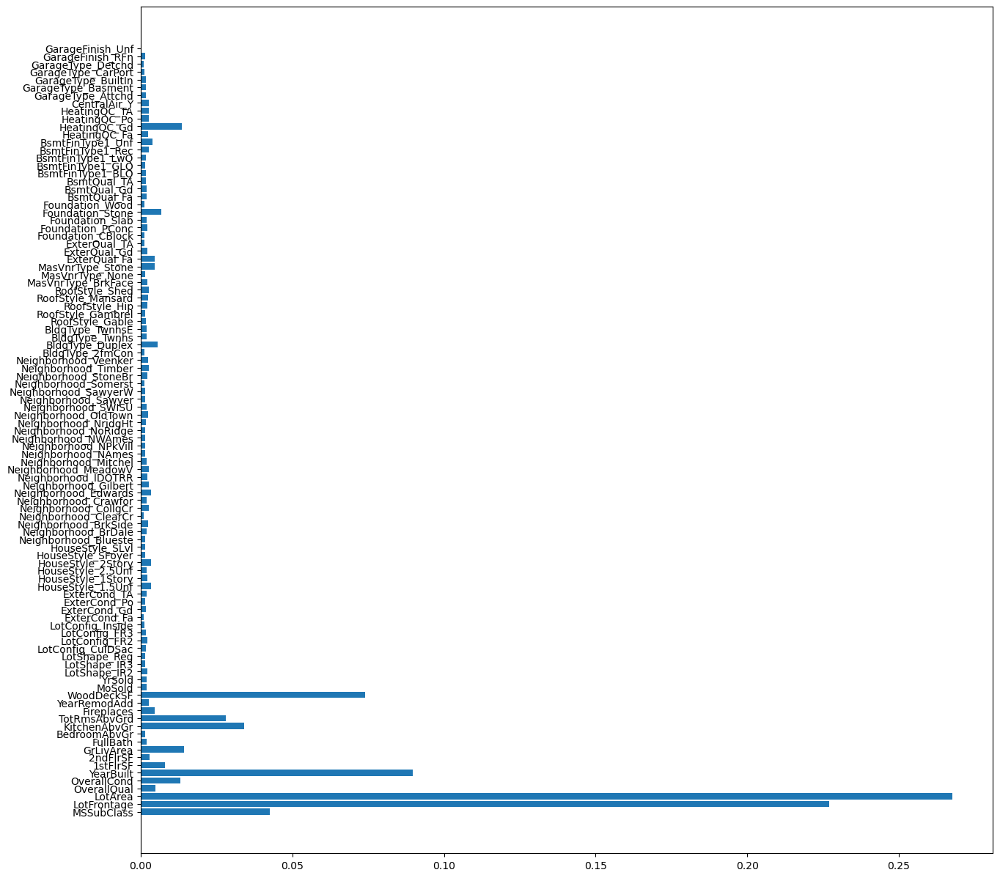

In [151]:

plt.barh(X.columns.values, gcsRF.estimator['estimator'].feature_importances_)


The 5 most important features are LotArea, LotFrontage, YearBuild, WoodDeckSF, MSSubClass

## Gradient boosting

In [152]:
gridGboost = {'estimator__n_estimators': [100,200,300,400,500],'estimator__learning_rate' : [0.08,0.1,0.2,0.4,0.6,0.8,1],
              "loss": "squared_error",
             "min_samples_split": 5}
modelGboost = Pipeline(steps=[("pca" , PCA()),('estimator',GradientBoostingRegressor())]) #**paramsGboost


In [153]:
gcsGboost = gridsearchparams(modelGboost,gridGboost,random_state=199)

In [154]:
gcsGboost.fit(X,Y)

#1         
{'estimator__n_estimators': 500, 'estimator__learning_rate': 0.08, 'result': 25762.00951742353}
#2         
{'estimator__n_estimators': 400, 'estimator__learning_rate': 0.08, 'result': 25782.52025333106}
#3         
{'estimator__n_estimators': 300, 'estimator__learning_rate': 0.08, 'result': 25881.513057068798}
#4         
{'estimator__n_estimators': 500, 'estimator__learning_rate': 0.1, 'result': 25895.22860077401}
#5         
{'estimator__n_estimators': 400, 'estimator__learning_rate': 0.1, 'result': 25897.612999247525}


In [155]:
gridGboost = {'estimator__n_estimators': [350,400,450,500],'estimator__learning_rate' : [0.06,0.08,0.1]}

In [156]:
gcsGboost = gridsearchparams(modelGboost,gridGboost,random_state=199)
gcsGboost.fit(X,Y)

#1         
{'estimator__n_estimators': 500, 'estimator__learning_rate': 0.06, 'result': 25340.948452456912}
#2         
{'estimator__n_estimators': 450, 'estimator__learning_rate': 0.06, 'result': 25390.34497939612}
#3         
{'estimator__n_estimators': 400, 'estimator__learning_rate': 0.06, 'result': 25459.073561139798}
#4         
{'estimator__n_estimators': 350, 'estimator__learning_rate': 0.06, 'result': 25539.684518250568}
#5         
{'estimator__n_estimators': 500, 'estimator__learning_rate': 0.08, 'result': 25762.00951742353}


### Xgboost 

In [157]:
X_train, X_test, y_train, y_test = train_test_split(X, Y,test_size=0.3, random_state=199)
cls = xgb.XGBRegressor()
cls.fit(X_train, y_train)
y_pred = cls.predict(X_test)
rmse = mean_squared_error(y_test, y_pred, squared=False)
print(f"RMSE of the base model: {rmse:.3f}")

RMSE of the base model: 24817.118


### LightGBM

In [158]:
# Now let's try to find the optimal hyperparameters of the model.
# Let's try Optuna first. Optuna tries to find the best combination of all hyperparameters. 
# We will evaluate the RMSE and the search time for best hyperparameters.

start = time.time()

def objective(trial, X_train=X_train, y_train=y_train, X_val=X_test, y_val=y_test, random_state=199):
    dtrain = Dataset(X_train, label=y_train)
    dval = Dataset(X_test, label=y_test)
 
    param = {
        'verbose':-1, # 0 (silent) - 3 (debug)
        'objective': 'regression', # model task: regression (default), poisson, quantile, mape, gamma, binary, multiclass, multiclassova, cross_entropy, etc
        'metric': 'rmse', # metric whose value optimizes the model: l1, l2, rmse, quantile, auc, etc
        'lambda_l1': trial.suggest_float('lambda_l1', 1e-3, 100.0), # l1 regularization, coefficient λ (lambda) multiplied by the sum of absolute values of weights
        'lambda_l2': trial.suggest_float('lambda_l2', 1e-3, 100.0), # l2 regularization, coefficient λ (lambda) multiplied by the sum of squares of weights
        'num_leaves': trial.suggest_int('num_leaves', 2, 256), # max number of leaves in one tree
        'max_depth': trial.suggest_int('max_depth', 3, 20), # limit the max depth (count of level) for tree model
        'learning_rate': trial.suggest_categorical('learning_rate', [0.01,0.05,0.1]), # step of adjusting weights taking into account loss function
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 5, 35), # minimum number of observations in a leaf that will result from splitting a node
        'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
        'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 7), # frequency of using bagging. 0 - not used, k - used every k iterations
        'boosting': 'gbdt', # boosting type, by default gbdt — traditional Gradient Boosting Decision Tree.
        'random_state':199,
    }

    gbm = lg.train(param, dtrain, valid_sets=[dtrain, dval])
    y_pred = gbm.predict(X_test)
    rmse = mean_squared_error(y_pred, y_test, squared=False)
    return rmse

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=1000)
task_execution_time = (time.time() - start)

[I 2023-03-07 20:42:38,236] A new study created in memory with name: no-name-80bf3f42-a7c0-4450-bf1d-a01468ac7288
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:38,329] Trial 0 finished with value: 23779.9

[1]	training's rmse: 61094.3	valid_1's rmse: 64952.8
[2]	training's rmse: 57675.8	valid_1's rmse: 61488.9
[3]	training's rmse: 54789.5	valid_1's rmse: 58537
[4]	training's rmse: 51997.6	valid_1's rmse: 55788.9
[5]	training's rmse: 49691.7	valid_1's rmse: 53560.3
[6]	training's rmse: 47545.3	valid_1's rmse: 51357.3
[7]	training's rmse: 45361.7	valid_1's rmse: 49344
[8]	training's rmse: 43451.9	valid_1's rmse: 47424.4
[9]	training's rmse: 41799.1	valid_1's rmse: 45784.3
[10]	training's rmse: 40270.6	valid_1's rmse: 44297.6
[11]	training's rmse: 38968.5	valid_1's rmse: 43057.9
[12]	training's rmse: 37734.4	valid_1's rmse: 41882.2
[13]	training's rmse: 36500.5	valid_1's rmse: 40699.5
[14]	training's rmse: 35491.1	valid_1's rmse: 39662.6
[15]	training's rmse: 34423.9	valid_1's rmse: 38671.8
[16]	training's rmse: 33377.3	valid_1's rmse: 37701.6
[17]	training's rmse: 32522.6	valid_1's rmse: 37026.6
[18]	training's rmse: 31735.2	valid_1's rmse: 36201.5
[19]	training's rmse: 30914	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration


[83]	training's rmse: 15544.3	valid_1's rmse: 25283.7


[I 2023-03-07 20:42:38,496] Trial 1 finished with value: 24596.658683977254 and parameters: {'lambda_l1': 9.68168119988962, 'lambda_l2': 15.100049522765524, 'num_leaves': 79, 'max_depth': 19, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.7373067833013396, 'bagging_fraction': 0.9341125198692214, 'bagging_freq': 5}. Best is trial 0 with value: 23779.948459452087.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[84]	training's rmse: 15425.3	valid_1's rmse: 25240.1
[85]	training's rmse: 15296.5	valid_1's rmse: 25202.5
[86]	training's rmse: 15183.4	valid_1's rmse: 25153.7
[87]	training's rmse: 15051.7	valid_1's rmse: 25104
[88]	training's rmse: 14925.9	valid_1's rmse: 25041.5
[89]	training's rmse: 14808.6	valid_1's rmse: 25009.7
[90]	training's rmse: 14707.7	valid_1's rmse: 24974.7
[91]	training's rmse: 14597.8	valid_1's rmse: 24942.9
[92]	training's rmse: 14490.4	valid_1's rmse: 24918.6
[93]	training's rmse: 14378.1	valid_1's rmse: 24887.3
[94]	training's rmse: 14283.4	valid_1's rmse: 24867.4
[95]	training's rmse: 14185.1	valid_1's rmse: 24830.3
[96]	training's rmse: 14091.9	valid_1's rmse: 24757.8
[97]	training's rmse: 14002.6	valid_1's rmse: 24708.1
[98]	training's rmse: 13914.3	valid_1's rmse: 24673.5
[99]	training's rmse: 13818.4	valid_1's rmse: 24632.4
[100]	training's rmse: 13734.4	valid_1's rmse: 24596.7
[1]	training's rmse: 63161.3	valid_1's rmse: 67113.3
[2]	training's rmse: 61865.7	v

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:38,761] Trial 4 finished with value: 29805.689415300414 and parameters: {'lambda_l1': 75.16089559985564, 'lambda_l2': 82.99893172420244, 'num_leaves': 147, 'm

[1]	training's rmse: 63204.7	valid_1's rmse: 67194.6
[2]	training's rmse: 61858.5	valid_1's rmse: 65855.3
[3]	training's rmse: 60595.8	valid_1's rmse: 64579.3
[4]	training's rmse: 59313.3	valid_1's rmse: 63289.6
[5]	training's rmse: 58097.3	valid_1's rmse: 62071
[6]	training's rmse: 56990.8	valid_1's rmse: 60984.9
[7]	training's rmse: 55940.8	valid_1's rmse: 59952.7
[8]	training's rmse: 54932.2	valid_1's rmse: 58970.7
[9]	training's rmse: 53984.2	valid_1's rmse: 58057.5
[10]	training's rmse: 53064.3	valid_1's rmse: 57128.8
[11]	training's rmse: 52129.2	valid_1's rmse: 56207.7
[12]	training's rmse: 51251.5	valid_1's rmse: 55353.3
[13]	training's rmse: 50368.9	valid_1's rmse: 54475.8
[14]	training's rmse: 49531.3	valid_1's rmse: 53638.5
[15]	training's rmse: 48723.6	valid_1's rmse: 52824.9
[16]	training's rmse: 47921.4	valid_1's rmse: 52020.8
[17]	training's rmse: 47196.6	valid_1's rmse: 51319.9
[18]	training's rmse: 46514.9	valid_1's rmse: 50614.3
[19]	training's rmse: 45797.8	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:38,937] Trial 6 finished with value: 44697.278031919515 and parameters: {'lambda_l1': 26.499674271604945, 'lambda_l2': 29.860120978977562, 'num_leaves': 67, '

[40]	training's rmse: 52584.5	valid_1's rmse: 56318.5
[41]	training's rmse: 52346	valid_1's rmse: 56084.7
[42]	training's rmse: 52093.5	valid_1's rmse: 55834.5
[43]	training's rmse: 51845.7	valid_1's rmse: 55583.6
[44]	training's rmse: 51602.7	valid_1's rmse: 55346.4
[45]	training's rmse: 51368.5	valid_1's rmse: 55118.8
[46]	training's rmse: 51138.6	valid_1's rmse: 54906.4
[47]	training's rmse: 50896.4	valid_1's rmse: 54661.4
[48]	training's rmse: 50669.9	valid_1's rmse: 54431.4
[49]	training's rmse: 50431.2	valid_1's rmse: 54201.3
[50]	training's rmse: 50195.6	valid_1's rmse: 53958.2
[51]	training's rmse: 49973.8	valid_1's rmse: 53725.8
[52]	training's rmse: 49769.5	valid_1's rmse: 53539.4
[53]	training's rmse: 49536.9	valid_1's rmse: 53298.1
[54]	training's rmse: 49312	valid_1's rmse: 53078.6
[55]	training's rmse: 49084	valid_1's rmse: 52841.8
[56]	training's rmse: 48869	valid_1's rmse: 52634.8
[57]	training's rmse: 48654	valid_1's rmse: 52427.3
[58]	training's rmse: 48455.2	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:39,176] Trial 9 finished with value: 42828.43760613002 and parameters: {'lambda_l1': 8.822263105763101, 'lambda_l2': 13.464228065263013, 'num_leaves': 110, 'm

[32]	training's rmse: 53745.5	valid_1's rmse: 57637.2
[33]	training's rmse: 53448.9	valid_1's rmse: 57326.7
[34]	training's rmse: 53146.9	valid_1's rmse: 57019.1
[35]	training's rmse: 52840.7	valid_1's rmse: 56712.4
[36]	training's rmse: 52541.3	valid_1's rmse: 56409.6
[37]	training's rmse: 52239	valid_1's rmse: 56121.4
[38]	training's rmse: 51943.5	valid_1's rmse: 55835.1
[39]	training's rmse: 51658.9	valid_1's rmse: 55548.1
[40]	training's rmse: 51379.7	valid_1's rmse: 55279.9
[41]	training's rmse: 51090.4	valid_1's rmse: 55005.1
[42]	training's rmse: 50813.8	valid_1's rmse: 54728.3
[43]	training's rmse: 50550.2	valid_1's rmse: 54455.3
[44]	training's rmse: 50288.7	valid_1's rmse: 54191.8
[45]	training's rmse: 50029.5	valid_1's rmse: 53935.4
[46]	training's rmse: 49756.7	valid_1's rmse: 53669.9
[47]	training's rmse: 49502	valid_1's rmse: 53409
[48]	training's rmse: 49252	valid_1's rmse: 53149.6
[49]	training's rmse: 48989.2	valid_1's rmse: 52893.2
[50]	training's rmse: 48745.4	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:39,426] Trial 11 finished with value: 23923.41158662488 and parameters: {'lambda_l1': 99.02398044741534, 'lambda_l2': 40.747588627410664, 'num_leaves': 255, '

[1]	training's rmse: 61256.7	valid_1's rmse: 65127.6
[2]	training's rmse: 58161.2	valid_1's rmse: 61943.5
[3]	training's rmse: 55671.2	valid_1's rmse: 59416
[4]	training's rmse: 53142.1	valid_1's rmse: 56789.4
[5]	training's rmse: 50694	valid_1's rmse: 54371.5
[6]	training's rmse: 48423.9	valid_1's rmse: 52116.7
[7]	training's rmse: 46263.2	valid_1's rmse: 49996.4
[8]	training's rmse: 44572.2	valid_1's rmse: 48395.3
[9]	training's rmse: 42804.2	valid_1's rmse: 46668.6
[10]	training's rmse: 41225.2	valid_1's rmse: 45254.2
[11]	training's rmse: 39970.5	valid_1's rmse: 44055.7
[12]	training's rmse: 38665.3	valid_1's rmse: 42701.1
[13]	training's rmse: 37506.1	valid_1's rmse: 41523.3
[14]	training's rmse: 36371.9	valid_1's rmse: 40404.3
[15]	training's rmse: 35313.8	valid_1's rmse: 39419.3
[16]	training's rmse: 34500.5	valid_1's rmse: 38620.8
[17]	training's rmse: 33685.6	valid_1's rmse: 37869.7
[18]	training's rmse: 32866.3	valid_1's rmse: 37103.4
[19]	training's rmse: 32163.1	valid_1's r

[I 2023-03-07 20:42:39,634] Trial 12 finished with value: 25020.374274799095 and parameters: {'lambda_l1': 99.86559407505769, 'lambda_l2': 0.16764621062700158, 'num_leaves': 216, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.40710850542371235, 'bagging_fraction': 0.810679512294122, 'bagging_freq': 3}. Best is trial 0 with value: 23779.948459452087.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[50]	training's rmse: 6191.18	valid_1's rmse: 25406
[51]	training's rmse: 6103.05	valid_1's rmse: 25403.4
[52]	training's rmse: 6054.23	valid_1's rmse: 25381.1
[53]	training's rmse: 5986.09	valid_1's rmse: 25358.9
[54]	training's rmse: 5936.24	valid_1's rmse: 25353.1
[55]	training's rmse: 5870.93	valid_1's rmse: 25373.9
[56]	training's rmse: 5803.19	valid_1's rmse: 25383.3
[57]	training's rmse: 5750.43	valid_1's rmse: 25377.2
[58]	training's rmse: 5679.2	valid_1's rmse: 25343.1
[59]	training's rmse: 5583.5	valid_1's rmse: 25331
[60]	training's rmse: 5488.98	valid_1's rmse: 25291.3
[61]	training's rmse: 5424.12	valid_1's rmse: 25298.9
[62]	training's rmse: 5342.29	valid_1's rmse: 25296.9
[63]	training's rmse: 5291.43	valid_1's rmse: 25269.4
[64]	training's rmse: 5157.6	valid_1's rmse: 25210.3
[65]	training's rmse: 5062.76	valid_1's rmse: 25197.6
[66]	training's rmse: 5023.89	valid_1's rmse: 25176.2
[67]	training's rmse: 4988.93	valid_1's rmse: 25175.5
[68]	training's rmse: 4911	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:39,858] Trial 14 finished with value: 24421.485354978562 and parameters: {'lambda_l1': 81.58979146673711, 'lambda_l2': 35.15705478778317, 'num_leaves': 158, '

[1]	training's rmse: 61539	valid_1's rmse: 65612.8
[2]	training's rmse: 58453.6	valid_1's rmse: 62427.2
[3]	training's rmse: 55359.3	valid_1's rmse: 59293
[4]	training's rmse: 52706.2	valid_1's rmse: 56601.1
[5]	training's rmse: 50363.8	valid_1's rmse: 54183.9
[6]	training's rmse: 48173.7	valid_1's rmse: 51954.8
[7]	training's rmse: 46011.8	valid_1's rmse: 49799.2
[8]	training's rmse: 44507.9	valid_1's rmse: 48355.9
[9]	training's rmse: 43030.5	valid_1's rmse: 47009.6
[10]	training's rmse: 41292.8	valid_1's rmse: 45375.9
[11]	training's rmse: 39770.6	valid_1's rmse: 43904.4
[12]	training's rmse: 38473.1	valid_1's rmse: 42687
[13]	training's rmse: 37288.5	valid_1's rmse: 41579
[14]	training's rmse: 36227.3	valid_1's rmse: 40509
[15]	training's rmse: 35240.1	valid_1's rmse: 39603.3
[16]	training's rmse: 34350.3	valid_1's rmse: 38843.7
[17]	training's rmse: 33485	valid_1's rmse: 38068.7
[18]	training's rmse: 32808	valid_1's rmse: 37417
[19]	training's rmse: 31975.3	valid_1's rmse: 36776.5

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:40,104] Trial 16 finished with value: 24044.836567398266 and parameters: {'lambda_l1': 68.80152288010508, 'lambda_l2': 29.10153241605806, 'num_leaves': 36, 'm

[1]	training's rmse: 61027.4	valid_1's rmse: 64895.7
[2]	training's rmse: 57766.7	valid_1's rmse: 61512.2
[3]	training's rmse: 54954.5	valid_1's rmse: 58630.9
[4]	training's rmse: 52332	valid_1's rmse: 55977.2
[5]	training's rmse: 49845.7	valid_1's rmse: 53495.4
[6]	training's rmse: 47554.9	valid_1's rmse: 51214.6
[7]	training's rmse: 45567.3	valid_1's rmse: 49156.4
[8]	training's rmse: 43847.9	valid_1's rmse: 47382.5
[9]	training's rmse: 42055.3	valid_1's rmse: 45740.4
[10]	training's rmse: 40323.4	valid_1's rmse: 44043.9
[11]	training's rmse: 38921	valid_1's rmse: 42683.8
[12]	training's rmse: 37596.5	valid_1's rmse: 41523.3
[13]	training's rmse: 36381.3	valid_1's rmse: 40318.5
[14]	training's rmse: 35179.2	valid_1's rmse: 39148.8
[15]	training's rmse: 34092.1	valid_1's rmse: 38167.6
[16]	training's rmse: 33275.6	valid_1's rmse: 37438.8
[17]	training's rmse: 32452.5	valid_1's rmse: 36701
[18]	training's rmse: 31630.1	valid_1's rmse: 35927.3
[19]	training's rmse: 30943.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:40,357] Trial 18 finished with value: 23584.404673599103 and parameters: {'lambda_l1': 70.02039174682784, 'lambda_l2': 36.02121102804554, 'num_leaves': 125, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 12, 'feature_fraction': 0.7414006568314392, 'bagging_fraction': 0.6515241165091272, 'bagging_freq': 6}. Best is trial 18 with value: 23584.404673599103.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[1]	training's rmse: 61100.4	valid_1's rmse: 65168.4
[2]	training's rmse: 57882.3	valid_1's rmse: 61942
[3]	training's rmse: 55078.7	valid_1's rmse: 59051.3
[4]	training's rmse: 52517.3	valid_1's rmse: 56465.7
[5]	training's rmse: 50033.9	valid_1's rmse: 53999.1
[6]	training's rmse: 47888.7	valid_1's rmse: 51776.6
[7]	training's rmse: 45771.2	valid_1's rmse: 49692
[8]	training's rmse: 43791.1	valid_1's rmse: 47734.5
[9]	training's rmse: 42125.4	valid_1's rmse: 46061.3
[10]	training's rmse: 40477.2	valid_1's rmse: 44448.7
[11]	training's rmse: 39118.2	valid_1's rmse: 43034
[12]	training's rmse: 37826	valid_1's rmse: 41741.4
[13]	training's rmse: 36568.9	valid_1's rmse: 40524.1
[14]	training's rmse: 35535.5	valid_1's rmse: 39584.5
[15]	training's rmse: 34604.6	valid_1's rmse: 38601.1
[16]	training's rmse: 33668.7	valid_1's rmse: 37734.2
[17]	training's rmse: 32815.9	valid_1's rmse: 36931.8
[18]	training's rmse: 32031	valid_1's rmse: 36299.7
[19]	training's rmse: 31318.6	valid_1's rmse: 3

[I 2023-03-07 20:42:40,512] Trial 19 finished with value: 23452.8227825665 and parameters: {'lambda_l1': 67.33943776607549, 'lambda_l2': 25.1558715956847, 'num_leaves': 46, 'max_depth': 17, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.7493775022535164, 'bagging_fraction': 0.6457480567819774, 'bagging_freq': 7}. Best is trial 19 with value: 23452.8227825665.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~

[59]	training's rmse: 17135.2	valid_1's rmse: 24980.6
[60]	training's rmse: 17014.9	valid_1's rmse: 24915.8
[61]	training's rmse: 16906.4	valid_1's rmse: 24870.5
[62]	training's rmse: 16786.9	valid_1's rmse: 24817.9
[63]	training's rmse: 16680.7	valid_1's rmse: 24774.8
[64]	training's rmse: 16554.8	valid_1's rmse: 24698.6
[65]	training's rmse: 16418.9	valid_1's rmse: 24556.5
[66]	training's rmse: 16303.1	valid_1's rmse: 24474.5
[67]	training's rmse: 16197.7	valid_1's rmse: 24423.3
[68]	training's rmse: 16107.8	valid_1's rmse: 24367.2
[69]	training's rmse: 16000.6	valid_1's rmse: 24299
[70]	training's rmse: 15907.3	valid_1's rmse: 24245.3
[71]	training's rmse: 15787.4	valid_1's rmse: 24206.7
[72]	training's rmse: 15682.9	valid_1's rmse: 24165.2
[73]	training's rmse: 15565.6	valid_1's rmse: 24157.8
[74]	training's rmse: 15458.4	valid_1's rmse: 24104.7
[75]	training's rmse: 15338.4	valid_1's rmse: 24072.1
[76]	training's rmse: 15214.3	valid_1's rmse: 24079.7
[77]	training's rmse: 15106.4	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:40,775] Trial 21 finished with value: 23509.577579541747 and parameters: {'lambda_l1': 61.713008522378445, 'lambda_l2': 20.218127030684972, 'num_leaves': 119,

[1]	training's rmse: 60855.7	valid_1's rmse: 64964.1
[2]	training's rmse: 57281.9	valid_1's rmse: 61588.8
[3]	training's rmse: 54007.1	valid_1's rmse: 58309
[4]	training's rmse: 51044.6	valid_1's rmse: 55318.4
[5]	training's rmse: 48361	valid_1's rmse: 52579.8
[6]	training's rmse: 45931.8	valid_1's rmse: 50166.6
[7]	training's rmse: 43714.4	valid_1's rmse: 48007.9
[8]	training's rmse: 41630.4	valid_1's rmse: 45941
[9]	training's rmse: 39768	valid_1's rmse: 44087.6
[10]	training's rmse: 38186.8	valid_1's rmse: 42479.3
[11]	training's rmse: 36675.5	valid_1's rmse: 41117.3
[12]	training's rmse: 35384.7	valid_1's rmse: 39794.5
[13]	training's rmse: 34083	valid_1's rmse: 38648.1
[14]	training's rmse: 32889.9	valid_1's rmse: 37534.1
[15]	training's rmse: 31753.2	valid_1's rmse: 36616.8
[16]	training's rmse: 30722.2	valid_1's rmse: 35853.6
[17]	training's rmse: 29867.7	valid_1's rmse: 35067.5
[18]	training's rmse: 28978.5	valid_1's rmse: 34398.6
[19]	training's rmse: 28155	valid_1's rmse: 336

[I 2023-03-07 20:42:40,919] Trial 22 finished with value: 23421.85880635827 and parameters: {'lambda_l1': 57.07483125727027, 'lambda_l2': 23.391558444207188, 'num_leaves': 41, 'max_depth': 6, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.7967687832164991, 'bagging_fraction': 0.6431162220980331, 'bagging_freq': 7}. Best is trial 22 with value: 23421.85880635827.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:

[1]	training's rmse: 59643.9	valid_1's rmse: 63607.4
[2]	training's rmse: 55084.7	valid_1's rmse: 59227.4
[3]	training's rmse: 51000.1	valid_1's rmse: 55148.1
[4]	training's rmse: 47360.6	valid_1's rmse: 51486.6
[5]	training's rmse: 44136.4	valid_1's rmse: 48286.4
[6]	training's rmse: 41248	valid_1's rmse: 45473.4
[7]	training's rmse: 38700.8	valid_1's rmse: 43007.2
[8]	training's rmse: 36258.6	valid_1's rmse: 40653.9
[9]	training's rmse: 33930.6	valid_1's rmse: 38725.1
[10]	training's rmse: 31925	valid_1's rmse: 36978.5
[11]	training's rmse: 30215.6	valid_1's rmse: 35399.4
[12]	training's rmse: 28642.3	valid_1's rmse: 34036.5
[13]	training's rmse: 27201.6	valid_1's rmse: 32808.2
[14]	training's rmse: 25933.7	valid_1's rmse: 31743.4
[15]	training's rmse: 24843.6	valid_1's rmse: 30890.6
[16]	training's rmse: 23777.6	valid_1's rmse: 30146.2
[17]	training's rmse: 22891.4	valid_1's rmse: 29414.1
[18]	training's rmse: 22008.7	valid_1's rmse: 28772.8
[19]	training's rmse: 21231.9	valid_1's r

[I 2023-03-07 20:42:41,232] Trial 25 finished with value: 41109.456245828995 and parameters: {'lambda_l1': 53.71098563494026, 'lambda_l2': 9.456169859900815, 'num_leaves': 50, 'max_depth': 5, 'learning_rate': 0.01, 'min_data_in_leaf': 9, 'feature_fraction': 0.8045020900766173, 'bagging_fraction': 0.6500000655268299, 'bagging_freq': 6}. Best is trial 23 with value: 23046.050509745313.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[1]	training's rmse: 64111.6	valid_1's rmse: 68063.2
[2]	training's rmse: 63680.8	valid_1's rmse: 67630.4
[3]	training's rmse: 63254.8	valid_1's rmse: 67194.5
[4]	training's rmse: 62833.8	valid_1's rmse: 66763.8
[5]	training's rmse: 62415.1	valid_1's rmse: 66344.5
[6]	training's rmse: 62001	valid_1's rmse: 65927.1
[7]	training's rmse: 61590.4	valid_1's rmse: 65516.8
[8]	training's rmse: 61188.4	valid_1's rmse: 65109.5
[9]	training's rmse: 60791.1	valid_1's rmse: 64705.4
[10]	training's rmse: 60393.1	valid_1's rmse: 64308.9
[11]	training's rmse: 60010.9	valid_1's rmse: 63921.9
[12]	training's rmse: 59621.6	valid_1's rmse: 63531.4
[13]	training's rmse: 59228.8	valid_1's rmse: 63147.7
[14]	training's rmse: 58866.5	valid_1's rmse: 62774.3
[15]	training's rmse: 58500.4	valid_1's rmse: 62396
[16]	training's rmse: 58137.6	valid_1's rmse: 62022.1
[17]	training's rmse: 57777	valid_1's rmse: 61655.3
[18]	training's rmse: 57422.9	valid_1's rmse: 61306.7
[19]	training's rmse: 57066.3	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:41,427] Trial 27 finished with value: 22341.69869896753 and parameters: {'lambda_l1': 40.02161469140817, 'lambda_l2': 6.624876590672898, 'num_leaves': 6, 'max

[1]	training's rmse: 60454.9	valid_1's rmse: 64380.6
[2]	training's rmse: 56666.3	valid_1's rmse: 60479.7
[3]	training's rmse: 53303.7	valid_1's rmse: 56911.9
[4]	training's rmse: 50367.4	valid_1's rmse: 53900.5
[5]	training's rmse: 47769.2	valid_1's rmse: 51265.2
[6]	training's rmse: 45247.9	valid_1's rmse: 48940.9
[7]	training's rmse: 43032.1	valid_1's rmse: 46971.4
[8]	training's rmse: 41000.3	valid_1's rmse: 45051.2
[9]	training's rmse: 39211.7	valid_1's rmse: 43473
[10]	training's rmse: 37563.4	valid_1's rmse: 41844.8
[11]	training's rmse: 36125.1	valid_1's rmse: 40388.6
[12]	training's rmse: 34722.4	valid_1's rmse: 39008.3
[13]	training's rmse: 33617	valid_1's rmse: 37919.2
[14]	training's rmse: 32414.6	valid_1's rmse: 36774.4
[15]	training's rmse: 31418.5	valid_1's rmse: 35856.5
[16]	training's rmse: 30550.7	valid_1's rmse: 35117.6
[17]	training's rmse: 29676.8	valid_1's rmse: 34239.1
[18]	training's rmse: 28928	valid_1's rmse: 33433.4
[19]	training's rmse: 28169.3	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:41,617] Trial 29 finished with value: 27734.355975238825 and parameters: {'lambda_l1': 42.47159185702842, 'lambda_l2': 8.004047540101482, 'num_leaves': 2, 'ma

[69]	training's rmse: 26152.4	valid_1's rmse: 29872
[70]	training's rmse: 26060.4	valid_1's rmse: 29794.5
[71]	training's rmse: 25971.4	valid_1's rmse: 29726
[72]	training's rmse: 25892.2	valid_1's rmse: 29644.3
[73]	training's rmse: 25801.6	valid_1's rmse: 29556.9
[74]	training's rmse: 25712.6	valid_1's rmse: 29461
[75]	training's rmse: 25629.7	valid_1's rmse: 29384.3
[76]	training's rmse: 25556.9	valid_1's rmse: 29313.1
[77]	training's rmse: 25489.1	valid_1's rmse: 29249.4
[78]	training's rmse: 25417.8	valid_1's rmse: 29171.2
[79]	training's rmse: 25336.7	valid_1's rmse: 29042.5
[80]	training's rmse: 25270.9	valid_1's rmse: 28965
[81]	training's rmse: 25202.1	valid_1's rmse: 28891.3
[82]	training's rmse: 25136	valid_1's rmse: 28780.4
[83]	training's rmse: 25081.2	valid_1's rmse: 28713.6
[84]	training's rmse: 25012.6	valid_1's rmse: 28630.8
[85]	training's rmse: 24950.5	valid_1's rmse: 28543.1
[86]	training's rmse: 24885.1	valid_1's rmse: 28478.1
[87]	training's rmse: 24823.4	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:41,896] Trial 31 finished with value: 22287.257023824353 and parameters: {'lambda_l1': 45.76119289051923, 'lambda_l2': 3.239167532041411, 'num_leaves': 23, 'm

[29]	training's rmse: 17238.7	valid_1's rmse: 24747.2
[30]	training's rmse: 16926.8	valid_1's rmse: 24611.8
[31]	training's rmse: 16622.4	valid_1's rmse: 24418.6
[32]	training's rmse: 16324.2	valid_1's rmse: 24292.2
[33]	training's rmse: 16069.5	valid_1's rmse: 24145
[34]	training's rmse: 15836.5	valid_1's rmse: 24095.3
[35]	training's rmse: 15593.5	valid_1's rmse: 23962.8
[36]	training's rmse: 15406.2	valid_1's rmse: 23886.6
[37]	training's rmse: 15169	valid_1's rmse: 23779.4
[38]	training's rmse: 14928	valid_1's rmse: 23756.6
[39]	training's rmse: 14721.8	valid_1's rmse: 23702.1
[40]	training's rmse: 14546.7	valid_1's rmse: 23634.7
[41]	training's rmse: 14384.6	valid_1's rmse: 23572.4
[42]	training's rmse: 14229.3	valid_1's rmse: 23515
[43]	training's rmse: 14017.7	valid_1's rmse: 23472.4
[44]	training's rmse: 13836.8	valid_1's rmse: 23339.2
[45]	training's rmse: 13647.3	valid_1's rmse: 23325.9
[46]	training's rmse: 13501.9	valid_1's rmse: 23279.4
[47]	training's rmse: 13375.1	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:42,234] Trial 33 finished with value: 23616.227254474226 and parameters: {'lambda_l1': 35.885209708666935, 'lambda_l2': 1.2115707601021808, 'num_leaves': 64, 

[1]	training's rmse: 59488.9	valid_1's rmse: 63561.8
[2]	training's rmse: 54789.3	valid_1's rmse: 58884.1
[3]	training's rmse: 50576.9	valid_1's rmse: 54777.4
[4]	training's rmse: 46855.3	valid_1's rmse: 51201.9
[5]	training's rmse: 43416	valid_1's rmse: 47818
[6]	training's rmse: 40251	valid_1's rmse: 45009.9
[7]	training's rmse: 37488.7	valid_1's rmse: 42384.1
[8]	training's rmse: 35031.2	valid_1's rmse: 40170.8
[9]	training's rmse: 32820.1	valid_1's rmse: 38188.9
[10]	training's rmse: 30826.6	valid_1's rmse: 36459.3
[11]	training's rmse: 28931.8	valid_1's rmse: 34967.7
[12]	training's rmse: 27303.7	valid_1's rmse: 33603.7
[13]	training's rmse: 25842	valid_1's rmse: 32411.8
[14]	training's rmse: 24457.8	valid_1's rmse: 31404.1
[15]	training's rmse: 23217	valid_1's rmse: 30452.1
[16]	training's rmse: 22014.3	valid_1's rmse: 29685.4
[17]	training's rmse: 21017.1	valid_1's rmse: 28912.2
[18]	training's rmse: 20069.8	valid_1's rmse: 28482.2
[19]	training's rmse: 19204.5	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:42,418] Trial 34 finished with value: 22415.923451936556 and parameters: {'lambda_l1': 26.01965440867535, 'lambda_l2': 14.642723740033839, 'num_leaves': 18, '

[1]	training's rmse: 60429.4	valid_1's rmse: 64325.4
[2]	training's rmse: 56684.2	valid_1's rmse: 60599.6
[3]	training's rmse: 53323.5	valid_1's rmse: 57227
[4]	training's rmse: 50310.5	valid_1's rmse: 54170.6
[5]	training's rmse: 47520.3	valid_1's rmse: 51405.7
[6]	training's rmse: 45041.2	valid_1's rmse: 48910.8
[7]	training's rmse: 42699.9	valid_1's rmse: 46662.1
[8]	training's rmse: 40701.6	valid_1's rmse: 44644.3
[9]	training's rmse: 38713.6	valid_1's rmse: 42781
[10]	training's rmse: 36970.8	valid_1's rmse: 41069.6
[11]	training's rmse: 35518.8	valid_1's rmse: 39668.1
[12]	training's rmse: 34058.6	valid_1's rmse: 38305.3
[13]	training's rmse: 32703.1	valid_1's rmse: 37000.4
[14]	training's rmse: 31512.5	valid_1's rmse: 35977.6
[15]	training's rmse: 30444.3	valid_1's rmse: 35063.5
[16]	training's rmse: 29445.8	valid_1's rmse: 34231.3
[17]	training's rmse: 28528.8	valid_1's rmse: 33452.1
[18]	training's rmse: 27711	valid_1's rmse: 32708.4
[19]	training's rmse: 27024.9	valid_1's rms

[I 2023-03-07 20:42:42,559] Trial 35 finished with value: 23078.266225087027 and parameters: {'lambda_l1': 23.932337415693397, 'lambda_l2': 15.739348693332182, 'num_leaves': 93, 'max_depth': 8, 'learning_rate': 0.1, 'min_data_in_leaf': 17, 'feature_fraction': 0.9316110313118801, 'bagging_fraction': 0.8191329511600638, 'bagging_freq': 6}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[77]	training's rmse: 13973.7	valid_1's rmse: 23353.6
[78]	training's rmse: 13931.9	valid_1's rmse: 23350.2
[79]	training's rmse: 13813.7	valid_1's rmse: 23328.1
[80]	training's rmse: 13717.6	valid_1's rmse: 23313.3
[81]	training's rmse: 13616.9	valid_1's rmse: 23302.2
[82]	training's rmse: 13543.2	valid_1's rmse: 23283.3
[83]	training's rmse: 13452.1	valid_1's rmse: 23261.9
[84]	training's rmse: 13385.5	valid_1's rmse: 23253.3
[85]	training's rmse: 13307.6	valid_1's rmse: 23214.9
[86]	training's rmse: 13277.9	valid_1's rmse: 23193.1
[87]	training's rmse: 13218.4	valid_1's rmse: 23156.3
[88]	training's rmse: 13124.5	valid_1's rmse: 23154.8
[89]	training's rmse: 13029.5	valid_1's rmse: 23162.3
[90]	training's rmse: 12982.6	valid_1's rmse: 23137.9
[91]	training's rmse: 12916.4	valid_1's rmse: 23140.7
[92]	training's rmse: 12845.2	valid_1's rmse: 23145.1
[93]	training's rmse: 12777.6	valid_1's rmse: 23139.7
[94]	training's rmse: 12688.4	valid_1's rmse: 23129.3
[95]	training's rmse: 12629.

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:42,831] Trial 37 finished with value: 23099.379193328106 and parameters: {'lambda_l1': 23.063858423530743, 'lambda_l2': 18.455319807370742, 'num_leaves': 69, 

[9]	training's rmse: 39255.3	valid_1's rmse: 43114.9
[10]	training's rmse: 37532	valid_1's rmse: 41453.7
[11]	training's rmse: 35981.6	valid_1's rmse: 40178.4
[12]	training's rmse: 34574.7	valid_1's rmse: 39039.7
[13]	training's rmse: 33276.1	valid_1's rmse: 37794.7
[14]	training's rmse: 32090.5	valid_1's rmse: 36900.1
[15]	training's rmse: 30970.6	valid_1's rmse: 36001.8
[16]	training's rmse: 29963.8	valid_1's rmse: 35105.7
[17]	training's rmse: 29056.6	valid_1's rmse: 34312.5
[18]	training's rmse: 28226	valid_1's rmse: 33661.9
[19]	training's rmse: 27451.4	valid_1's rmse: 32971.3
[20]	training's rmse: 26778.8	valid_1's rmse: 32429.6
[21]	training's rmse: 26003.6	valid_1's rmse: 31769.4
[22]	training's rmse: 25316.2	valid_1's rmse: 31185.9
[23]	training's rmse: 24662	valid_1's rmse: 30720.1
[24]	training's rmse: 24096.5	valid_1's rmse: 30335.2
[25]	training's rmse: 23604.9	valid_1's rmse: 29872.3
[26]	training's rmse: 23084.4	valid_1's rmse: 29409.1
[27]	training's rmse: 22581.6	valid

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:43,081] Trial 39 finished with value: 23139.306264974333 and parameters: {'lambda_l1': 36.111775962831835, 'lambda_l2': 18.013747394337607, 'num_leaves': 62, 

[1]	training's rmse: 60653.7	valid_1's rmse: 64530.9
[2]	training's rmse: 57121.8	valid_1's rmse: 60913
[3]	training's rmse: 53957.1	valid_1's rmse: 57688.6
[4]	training's rmse: 51075.3	valid_1's rmse: 54829.8
[5]	training's rmse: 48485.9	valid_1's rmse: 52315.5
[6]	training's rmse: 45899	valid_1's rmse: 49763.4
[7]	training's rmse: 43595.3	valid_1's rmse: 47488.9
[8]	training's rmse: 41494.4	valid_1's rmse: 45396.5
[9]	training's rmse: 39687	valid_1's rmse: 43572.9
[10]	training's rmse: 38044	valid_1's rmse: 42020.1
[11]	training's rmse: 36467	valid_1's rmse: 40589.3
[12]	training's rmse: 35087.8	valid_1's rmse: 39341.6
[13]	training's rmse: 33715.7	valid_1's rmse: 38219
[14]	training's rmse: 32562.3	valid_1's rmse: 37179.6
[15]	training's rmse: 31402.9	valid_1's rmse: 36126.3
[16]	training's rmse: 30424.7	valid_1's rmse: 35254.2
[17]	training's rmse: 29512.3	valid_1's rmse: 34442.2
[18]	training's rmse: 28699.4	valid_1's rmse: 33773.6
[19]	training's rmse: 27962.5	valid_1's rmse: 331

[I 2023-03-07 20:42:43,254] Trial 40 finished with value: 23241.92067815992 and parameters: {'lambda_l1': 46.824250999404384, 'lambda_l2': 4.3916586824635, 'num_leaves': 54, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.909248674616626, 'bagging_fraction': 0.7262004731498778, 'bagging_freq': 6}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func

[73]	training's rmse: 14731.5	valid_1's rmse: 24404.2
[74]	training's rmse: 14584.8	valid_1's rmse: 24301.1
[75]	training's rmse: 14457.9	valid_1's rmse: 24212.5
[76]	training's rmse: 14330.2	valid_1's rmse: 24145.6
[77]	training's rmse: 14192.7	valid_1's rmse: 24113.3
[78]	training's rmse: 14060.7	valid_1's rmse: 24060.6
[79]	training's rmse: 13933.2	valid_1's rmse: 24001.4
[80]	training's rmse: 13815.2	valid_1's rmse: 23941.3
[81]	training's rmse: 13703.7	valid_1's rmse: 23878.2
[82]	training's rmse: 13579.6	valid_1's rmse: 23833.2
[83]	training's rmse: 13466	valid_1's rmse: 23807.6
[84]	training's rmse: 13348	valid_1's rmse: 23744.3
[85]	training's rmse: 13247	valid_1's rmse: 23694.8
[86]	training's rmse: 13157.4	valid_1's rmse: 23645.5
[87]	training's rmse: 13069.9	valid_1's rmse: 23612.1
[88]	training's rmse: 12989	valid_1's rmse: 23575.5
[89]	training's rmse: 12891.7	valid_1's rmse: 23510.4
[90]	training's rmse: 12809.3	valid_1's rmse: 23489.4
[91]	training's rmse: 12720.9	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:43,509] Trial 42 finished with value: 23384.30252509789 and parameters: {'lambda_l1': 28.09763548879202, 'lambda_l2': 12.98354529980949, 'num_leaves': 30, 'ma

[31]	training's rmse: 19187.3	valid_1's rmse: 27064.4
[32]	training's rmse: 18857.6	valid_1's rmse: 26811.9
[33]	training's rmse: 18527.8	valid_1's rmse: 26570
[34]	training's rmse: 18212.8	valid_1's rmse: 26412
[35]	training's rmse: 17927.4	valid_1's rmse: 26241.3
[36]	training's rmse: 17658.4	valid_1's rmse: 26036.9
[37]	training's rmse: 17381.3	valid_1's rmse: 25861
[38]	training's rmse: 17135.8	valid_1's rmse: 25704.8
[39]	training's rmse: 16888.8	valid_1's rmse: 25529.8
[40]	training's rmse: 16615.4	valid_1's rmse: 25433.9
[41]	training's rmse: 16396.2	valid_1's rmse: 25312.6
[42]	training's rmse: 16165.7	valid_1's rmse: 25174.1
[43]	training's rmse: 15900.4	valid_1's rmse: 25102.9
[44]	training's rmse: 15637.4	valid_1's rmse: 24943
[45]	training's rmse: 15379.6	valid_1's rmse: 24864.5
[46]	training's rmse: 15188.7	valid_1's rmse: 24775.2
[47]	training's rmse: 15010.6	valid_1's rmse: 24694.6
[48]	training's rmse: 14788.9	valid_1's rmse: 24646.9
[49]	training's rmse: 14633.3	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:43,693] Trial 44 finished with value: 49007.51513505843 and parameters: {'lambda_l1': 45.72203606971082, 'lambda_l2': 0.04037188754688703, 'num_leaves': 2, 'm

[1]	training's rmse: 64235.7	valid_1's rmse: 68192.7
[2]	training's rmse: 63941.8	valid_1's rmse: 67893.2
[3]	training's rmse: 63650.1	valid_1's rmse: 67595.8
[4]	training's rmse: 63366.5	valid_1's rmse: 67306.7
[5]	training's rmse: 63077.5	valid_1's rmse: 66994.5
[6]	training's rmse: 62781.8	valid_1's rmse: 66691.6
[7]	training's rmse: 62493.2	valid_1's rmse: 66396.5
[8]	training's rmse: 62214.8	valid_1's rmse: 66111.6
[9]	training's rmse: 61952.6	valid_1's rmse: 65844.3
[10]	training's rmse: 61684.9	valid_1's rmse: 65570.4
[11]	training's rmse: 61423.1	valid_1's rmse: 65287.4
[12]	training's rmse: 61147	valid_1's rmse: 64988.6
[13]	training's rmse: 60900.7	valid_1's rmse: 64740.4
[14]	training's rmse: 60633.5	valid_1's rmse: 64466.7
[15]	training's rmse: 60372.3	valid_1's rmse: 64198.7
[16]	training's rmse: 60111.2	valid_1's rmse: 63916.8
[17]	training's rmse: 59863.4	valid_1's rmse: 63663.2
[18]	training's rmse: 59606.5	valid_1's rmse: 63386.4
[19]	training's rmse: 59369.6	valid_1's

[I 2023-03-07 20:42:43,904] Trial 46 finished with value: 23303.20903883251 and parameters: {'lambda_l1': 39.359625481316975, 'lambda_l2': 18.041196345847204, 'num_leaves': 11, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9943515705625656, 'bagging_fraction': 0.7934856110398958, 'bagging_freq': 5}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[48]	training's rmse: 18202.5	valid_1's rmse: 25127.6
[49]	training's rmse: 18065.1	valid_1's rmse: 25047.5
[50]	training's rmse: 17933.4	valid_1's rmse: 24912.6
[51]	training's rmse: 17793.9	valid_1's rmse: 24826.4
[52]	training's rmse: 17673.9	valid_1's rmse: 24791
[53]	training's rmse: 17563.5	valid_1's rmse: 24743.4
[54]	training's rmse: 17455.3	valid_1's rmse: 24676.1
[55]	training's rmse: 17359.7	valid_1's rmse: 24622.2
[56]	training's rmse: 17249	valid_1's rmse: 24550.4
[57]	training's rmse: 17138.7	valid_1's rmse: 24451.4
[58]	training's rmse: 17035.8	valid_1's rmse: 24396.2
[59]	training's rmse: 16946.5	valid_1's rmse: 24327.5
[60]	training's rmse: 16856.8	valid_1's rmse: 24303
[61]	training's rmse: 16752.3	valid_1's rmse: 24271.4
[62]	training's rmse: 16662.6	valid_1's rmse: 24247.2
[63]	training's rmse: 16556.1	valid_1's rmse: 24201.6
[64]	training's rmse: 16488.6	valid_1's rmse: 24127.7
[65]	training's rmse: 16401.8	valid_1's rmse: 24106.1
[66]	training's rmse: 16310.3	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:44,142] Trial 48 finished with value: 42001.20161942048 and parameters: {'lambda_l1': 20.03772446031454, 'lambda_l2': 13.231686960682065, 'num_leaves': 27, 'm

[1]	training's rmse: 64127.2	valid_1's rmse: 68083
[2]	training's rmse: 63711.8	valid_1's rmse: 67662.4
[3]	training's rmse: 63300.5	valid_1's rmse: 67241.2
[4]	training's rmse: 62892.9	valid_1's rmse: 66828.3
[5]	training's rmse: 62491.1	valid_1's rmse: 66421.2
[6]	training's rmse: 62092	valid_1's rmse: 66017.2
[7]	training's rmse: 61699.4	valid_1's rmse: 65620.1
[8]	training's rmse: 61305.8	valid_1's rmse: 65226.4
[9]	training's rmse: 60916.3	valid_1's rmse: 64836.1
[10]	training's rmse: 60531.6	valid_1's rmse: 64449.9
[11]	training's rmse: 60151.2	valid_1's rmse: 64068.1
[12]	training's rmse: 59769.7	valid_1's rmse: 63687.6
[13]	training's rmse: 59391.3	valid_1's rmse: 63311.5
[14]	training's rmse: 59015.8	valid_1's rmse: 62939.6
[15]	training's rmse: 58665.1	valid_1's rmse: 62591.2
[16]	training's rmse: 58311.2	valid_1's rmse: 62233.9
[17]	training's rmse: 57958.9	valid_1's rmse: 61880.1
[18]	training's rmse: 57615.4	valid_1's rmse: 61529
[19]	training's rmse: 57269.9	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:44,401] Trial 50 finished with value: 23427.993059324024 and parameters: {'lambda_l1': 26.09734924622474, 'lambda_l2': 21.510593440516256, 'num_leaves': 57, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.9140940619701855, 'bagging_fraction': 0.7157143955266408, 'bagging_freq': 6}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[4]	training's rmse: 50686.5	valid_1's rmse: 54573.3
[5]	training's rmse: 47968.2	valid_1's rmse: 51912.5
[6]	training's rmse: 45532	valid_1's rmse: 49392.1
[7]	training's rmse: 43220.8	valid_1's rmse: 47129.1
[8]	training's rmse: 41147.9	valid_1's rmse: 45098.9
[9]	training's rmse: 39297.1	valid_1's rmse: 43348.8
[10]	training's rmse: 37584.6	valid_1's rmse: 41769.8
[11]	training's rmse: 36042.8	valid_1's rmse: 40269.3
[12]	training's rmse: 34627.9	valid_1's rmse: 38995.7
[13]	training's rmse: 33407.2	valid_1's rmse: 37812.1
[14]	training's rmse: 32298.5	valid_1's rmse: 36803
[15]	training's rmse: 31177.2	valid_1's rmse: 35930.7
[16]	training's rmse: 30188.4	valid_1's rmse: 34996.2
[17]	training's rmse: 29210.6	valid_1's rmse: 34139.5
[18]	training's rmse: 28328.6	valid_1's rmse: 33521.5
[19]	training's rmse: 27513.6	valid_1's rmse: 32851.1
[20]	training's rmse: 26773.1	valid_1's rmse: 32287.2
[21]	training's rmse: 26110.9	valid_1's rmse: 31773.2
[22]	training's rmse: 25491	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:44,585] Trial 52 finished with value: 22582.318290982388 and parameters: {'lambda_l1': 42.417384982628434, 'lambda_l2': 3.5563575260339335, 'num_leaves': 12, 

[1]	training's rmse: 59974	valid_1's rmse: 63865.5
[2]	training's rmse: 55825.5	valid_1's rmse: 59607.3
[3]	training's rmse: 52122.6	valid_1's rmse: 55938.2
[4]	training's rmse: 48868.3	valid_1's rmse: 52683.3
[5]	training's rmse: 45906.5	valid_1's rmse: 49780.7
[6]	training's rmse: 43300.6	valid_1's rmse: 47255.8
[7]	training's rmse: 40967.5	valid_1's rmse: 44940.1
[8]	training's rmse: 38611.5	valid_1's rmse: 42807.6
[9]	training's rmse: 36535.5	valid_1's rmse: 40925.2
[10]	training's rmse: 34708.5	valid_1's rmse: 39326.4
[11]	training's rmse: 33011.6	valid_1's rmse: 37789.6
[12]	training's rmse: 31566.3	valid_1's rmse: 36534.6
[13]	training's rmse: 30149.1	valid_1's rmse: 35139.9
[14]	training's rmse: 28967.5	valid_1's rmse: 34129.6
[15]	training's rmse: 27836.1	valid_1's rmse: 33180.3
[16]	training's rmse: 26844.9	valid_1's rmse: 32305.6
[17]	training's rmse: 26005.9	valid_1's rmse: 31493.9
[18]	training's rmse: 25257.8	valid_1's rmse: 30717.7
[19]	training's rmse: 24548.1	valid_1's

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:44,884] Trial 54 finished with value: 22381.93825890632 and parameters: {'lambda_l1': 46.34077558397275, 'lambda_l2': 0.014701036839324111, 'num_leaves': 33, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.946589482841035, 'bagging_fraction': 0.7741334032013153, 'bagging_freq': 6}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[1]	training's rmse: 59130.1	valid_1's rmse: 63007.3
[2]	training's rmse: 54229.7	valid_1's rmse: 58187.2
[3]	training's rmse: 49927.2	valid_1's rmse: 54008.1
[4]	training's rmse: 46015.9	valid_1's rmse: 50328.8
[5]	training's rmse: 42630.9	valid_1's rmse: 47041.1
[6]	training's rmse: 39532.4	valid_1's rmse: 44057.8
[7]	training's rmse: 36698.1	valid_1's rmse: 41600.1
[8]	training's rmse: 34243.2	valid_1's rmse: 39558.1
[9]	training's rmse: 31865.2	valid_1's rmse: 37440.2
[10]	training's rmse: 29766.1	valid_1's rmse: 35635.2
[11]	training's rmse: 28038.6	valid_1's rmse: 34080.2
[12]	training's rmse: 26390.2	valid_1's rmse: 32700.2
[13]	training's rmse: 24900	valid_1's rmse: 31430
[14]	training's rmse: 23627	valid_1's rmse: 30476.8
[15]	training's rmse: 22463.6	valid_1's rmse: 29547.5
[16]	training's rmse: 21440	valid_1's rmse: 28814
[17]	training's rmse: 20519.1	valid_1's rmse: 28108.4
[18]	training's rmse: 19676.3	valid_1's rmse: 27663.8
[19]	training's rmse: 18918.3	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:45,081] Trial 55 finished with value: 23279.686052660978 and parameters: {'lambda_l1': 51.32385397699333, 'lambda_l2': 0.6064726616637873, 'num_leaves': 22, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.9530812030111566, 'bagging_fraction': 0.7726963915211595, 'bagging_freq': 2}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[1]	training's rmse: 59389	valid_1's rmse: 63220
[2]	training's rmse: 54739.8	valid_1's rmse: 58639
[3]	training's rmse: 50578.4	valid_1's rmse: 54765.9
[4]	training's rmse: 46815.8	valid_1's rmse: 51059.3
[5]	training's rmse: 43603.5	valid_1's rmse: 48033.1
[6]	training's rmse: 40739.2	valid_1's rmse: 45263.4
[7]	training's rmse: 38070.3	valid_1's rmse: 42774.3
[8]	training's rmse: 35609.9	valid_1's rmse: 40421.3
[9]	training's rmse: 33420.1	valid_1's rmse: 38508
[10]	training's rmse: 31522.8	valid_1's rmse: 36939.4
[11]	training's rmse: 29784	valid_1's rmse: 35517.8
[12]	training's rmse: 28268.7	valid_1's rmse: 34279.6
[13]	training's rmse: 26717.2	valid_1's rmse: 33048
[14]	training's rmse: 25361.2	valid_1's rmse: 31844.7
[15]	training's rmse: 24255.4	valid_1's rmse: 30809
[16]	training's rmse: 23173	valid_1's rmse: 30020.5
[17]	training's rmse: 22230.2	valid_1's rmse: 29234.7
[18]	training's rmse: 21409.9	valid_1's rmse: 28605.9
[19]	training's rmse: 20640.1	valid_1's rmse: 28118.5

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:45,214] Trial 56 finished with value: 23511.643955648487 and parameters: {'lambda_l1': 45.77167086485451, 'lambda_l2': 15.82461205608822, 'num_leaves': 36, 'max_depth': 7, 'learning_rate': 0.1, 'min_data_in_leaf': 12, 'feature_fraction': 0.9692500083773574, 'bagging_fraction': 0.8322901471647771, 'bagging_freq': 7}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[33]	training's rmse: 19328.8	valid_1's rmse: 26646.9
[34]	training's rmse: 18962	valid_1's rmse: 26409.2
[35]	training's rmse: 18675.3	valid_1's rmse: 26293.9
[36]	training's rmse: 18426.4	valid_1's rmse: 26132.6
[37]	training's rmse: 18179.3	valid_1's rmse: 25987
[38]	training's rmse: 17953.6	valid_1's rmse: 25851.9
[39]	training's rmse: 17721.7	valid_1's rmse: 25678.8
[40]	training's rmse: 17476.3	valid_1's rmse: 25548.3
[41]	training's rmse: 17296.7	valid_1's rmse: 25453
[42]	training's rmse: 17086.7	valid_1's rmse: 25308.2
[43]	training's rmse: 16879.3	valid_1's rmse: 25224.6
[44]	training's rmse: 16693.6	valid_1's rmse: 25163.3
[45]	training's rmse: 16560.4	valid_1's rmse: 25114.3
[46]	training's rmse: 16405.2	valid_1's rmse: 25073.2
[47]	training's rmse: 16254.9	valid_1's rmse: 24955.6
[48]	training's rmse: 16137.4	valid_1's rmse: 24864.5
[49]	training's rmse: 15990.1	valid_1's rmse: 24765.3
[50]	training's rmse: 15828.9	valid_1's rmse: 24658
[51]	training's rmse: 15639.1	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:45,496] Trial 58 finished with value: 23242.779820998214 and parameters: {'lambda_l1': 50.48330592500301, 'lambda_l2': 2.867383527038868, 'num_leaves': 45, 'm

[1]	training's rmse: 59556.8	valid_1's rmse: 63528.8
[2]	training's rmse: 55122.7	valid_1's rmse: 59092.6
[3]	training's rmse: 51093.6	valid_1's rmse: 55248.2
[4]	training's rmse: 47445	valid_1's rmse: 51893.1
[5]	training's rmse: 44178.3	valid_1's rmse: 48780.5
[6]	training's rmse: 41262.1	valid_1's rmse: 45997
[7]	training's rmse: 38619.9	valid_1's rmse: 43594.1
[8]	training's rmse: 36085	valid_1's rmse: 41316.5
[9]	training's rmse: 33831	valid_1's rmse: 39304.6
[10]	training's rmse: 31817.9	valid_1's rmse: 37585.1
[11]	training's rmse: 30012.4	valid_1's rmse: 36171.5
[12]	training's rmse: 28359.6	valid_1's rmse: 34793
[13]	training's rmse: 26865.1	valid_1's rmse: 33617.4
[14]	training's rmse: 25499.6	valid_1's rmse: 32563.8
[15]	training's rmse: 24269.2	valid_1's rmse: 31763.9
[16]	training's rmse: 23170.6	valid_1's rmse: 30973.8
[17]	training's rmse: 22094	valid_1's rmse: 30220.5
[18]	training's rmse: 21148.2	valid_1's rmse: 29500.5
[19]	training's rmse: 20269.2	valid_1's rmse: 290

[I 2023-03-07 20:42:45,619] Trial 59 finished with value: 23324.76919950553 and parameters: {'lambda_l1': 35.20168311743283, 'lambda_l2': 10.129412757251504, 'num_leaves': 92, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.9001275397375216, 'bagging_fraction': 0.7866536529677439, 'bagging_freq': 6}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[71]	training's rmse: 11554.3	valid_1's rmse: 23366.7
[72]	training's rmse: 11498.5	valid_1's rmse: 23342
[73]	training's rmse: 11410.8	valid_1's rmse: 23335.5
[74]	training's rmse: 11314.4	valid_1's rmse: 23320.5
[75]	training's rmse: 11237.8	valid_1's rmse: 23356
[76]	training's rmse: 11151.1	valid_1's rmse: 23342
[77]	training's rmse: 11078.5	valid_1's rmse: 23358.7
[78]	training's rmse: 10960.9	valid_1's rmse: 23332.7
[79]	training's rmse: 10834.7	valid_1's rmse: 23307.2
[80]	training's rmse: 10722.6	valid_1's rmse: 23281.4
[81]	training's rmse: 10648.3	valid_1's rmse: 23268.9
[82]	training's rmse: 10542	valid_1's rmse: 23259.6
[83]	training's rmse: 10494.8	valid_1's rmse: 23262.9
[84]	training's rmse: 10405.6	valid_1's rmse: 23263.5
[85]	training's rmse: 10302.4	valid_1's rmse: 23267.8
[86]	training's rmse: 10201.3	valid_1's rmse: 23262.7
[87]	training's rmse: 10154.6	valid_1's rmse: 23230.6
[88]	training's rmse: 10084.8	valid_1's rmse: 23223.1
[89]	training's rmse: 10011	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:45,830] Trial 61 finished with value: 22574.55837612911 and parameters: {'lambda_l1': 43.914718488171026, 'lambda_l2': 6.044690649811242, 'num_leaves': 10, 'm

[34]	training's rmse: 19537.2	valid_1's rmse: 25620.8
[35]	training's rmse: 19305.8	valid_1's rmse: 25477.8
[36]	training's rmse: 19096.4	valid_1's rmse: 25382.9
[37]	training's rmse: 18895.8	valid_1's rmse: 25197.3
[38]	training's rmse: 18708.8	valid_1's rmse: 25045.2
[39]	training's rmse: 18530	valid_1's rmse: 24902
[40]	training's rmse: 18372.9	valid_1's rmse: 24732.9
[41]	training's rmse: 18237.8	valid_1's rmse: 24574.5
[42]	training's rmse: 18073.3	valid_1's rmse: 24491
[43]	training's rmse: 17920.6	valid_1's rmse: 24314.8
[44]	training's rmse: 17753.2	valid_1's rmse: 24112.9
[45]	training's rmse: 17606.5	valid_1's rmse: 24045.7
[46]	training's rmse: 17469.9	valid_1's rmse: 23879.2
[47]	training's rmse: 17317.9	valid_1's rmse: 23816.6
[48]	training's rmse: 17207	valid_1's rmse: 23731.5
[49]	training's rmse: 17068.1	valid_1's rmse: 23578.4
[50]	training's rmse: 16971.6	valid_1's rmse: 23521.3
[51]	training's rmse: 16864.5	valid_1's rmse: 23428.2
[52]	training's rmse: 16776.9	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:46,044] Trial 63 finished with value: 23002.465212833613 and parameters: {'lambda_l1': 30.729858003027424, 'lambda_l2': 0.04452621028528091, 'num_leaves': 41,

[26]	training's rmse: 19426.7	valid_1's rmse: 26338.4
[27]	training's rmse: 19135.5	valid_1's rmse: 26019.2
[28]	training's rmse: 18826	valid_1's rmse: 25834.6
[29]	training's rmse: 18548	valid_1's rmse: 25582.1
[30]	training's rmse: 18296.8	valid_1's rmse: 25408.6
[31]	training's rmse: 18070.9	valid_1's rmse: 25257.4
[32]	training's rmse: 17854.7	valid_1's rmse: 25091.1
[33]	training's rmse: 17687.9	valid_1's rmse: 24934.3
[34]	training's rmse: 17503.3	valid_1's rmse: 24811.2
[35]	training's rmse: 17328.1	valid_1's rmse: 24702.2
[36]	training's rmse: 17160.6	valid_1's rmse: 24535.1
[37]	training's rmse: 16968.3	valid_1's rmse: 24363
[38]	training's rmse: 16825.5	valid_1's rmse: 24279.2
[39]	training's rmse: 16667.8	valid_1's rmse: 24157.2
[40]	training's rmse: 16515.2	valid_1's rmse: 24077.1
[41]	training's rmse: 16411.2	valid_1's rmse: 23991.7
[42]	training's rmse: 16265.7	valid_1's rmse: 23931.2
[43]	training's rmse: 16133.3	valid_1's rmse: 23817.2
[44]	training's rmse: 16028.2	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:46,271] Trial 65 finished with value: 23227.444896359266 and parameters: {'lambda_l1': 42.382308570379124, 'lambda_l2': 11.906233005050561, 'num_leaves': 22, 

[1]	training's rmse: 60366.2	valid_1's rmse: 64227.4
[2]	training's rmse: 56522.6	valid_1's rmse: 60436.2
[3]	training's rmse: 53034.2	valid_1's rmse: 56874.5
[4]	training's rmse: 49903.7	valid_1's rmse: 53747.3
[5]	training's rmse: 47115.5	valid_1's rmse: 50912.2
[6]	training's rmse: 44539.8	valid_1's rmse: 48359
[7]	training's rmse: 42235.3	valid_1's rmse: 46099.9
[8]	training's rmse: 40136.3	valid_1's rmse: 44147.4
[9]	training's rmse: 38101.1	valid_1's rmse: 42402.2
[10]	training's rmse: 36338.7	valid_1's rmse: 40908.6
[11]	training's rmse: 34723.9	valid_1's rmse: 39346.1
[12]	training's rmse: 33289.2	valid_1's rmse: 38084
[13]	training's rmse: 31965.7	valid_1's rmse: 36840.8
[14]	training's rmse: 30765.8	valid_1's rmse: 35816.3
[15]	training's rmse: 29607.4	valid_1's rmse: 34704.1
[16]	training's rmse: 28562.8	valid_1's rmse: 33871.2
[17]	training's rmse: 27616.7	valid_1's rmse: 33082.8
[18]	training's rmse: 26759.1	valid_1's rmse: 32393.8
[19]	training's rmse: 26006.9	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:46,513] Trial 67 finished with value: 24706.54231174484 and parameters: {'lambda_l1': 53.40063061897653, 'lambda_l2': 3.810049526239126, 'num_leaves': 47, 'ma

[1]	training's rmse: 59749.4	valid_1's rmse: 63759
[2]	training's rmse: 55467.9	valid_1's rmse: 59449.7
[3]	training's rmse: 51644.8	valid_1's rmse: 55557.7
[4]	training's rmse: 48216.2	valid_1's rmse: 52100.5
[5]	training's rmse: 45137.7	valid_1's rmse: 49073.7
[6]	training's rmse: 42387.7	valid_1's rmse: 46303.7
[7]	training's rmse: 39877.4	valid_1's rmse: 43897.1
[8]	training's rmse: 37504.9	valid_1's rmse: 41708.2
[9]	training's rmse: 35407.1	valid_1's rmse: 39933.1
[10]	training's rmse: 33374.9	valid_1's rmse: 38267.8
[11]	training's rmse: 31632	valid_1's rmse: 36797.4
[12]	training's rmse: 29937.3	valid_1's rmse: 35431
[13]	training's rmse: 28404.1	valid_1's rmse: 34331
[14]	training's rmse: 27045	valid_1's rmse: 33431.7
[15]	training's rmse: 25805.6	valid_1's rmse: 32563
[16]	training's rmse: 24697.9	valid_1's rmse: 31716.2
[17]	training's rmse: 23704.6	valid_1's rmse: 30956.1
[18]	training's rmse: 22752.6	valid_1's rmse: 30333.2
[19]	training's rmse: 21919	valid_1's rmse: 29711

[I 2023-03-07 20:42:46,645] Trial 68 finished with value: 23703.314894063114 and parameters: {'lambda_l1': 32.708053971411516, 'lambda_l2': 19.68486677238314, 'num_leaves': 239, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8461348045627631, 'bagging_fraction': 0.7434622113677883, 'bagging_freq': 7}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[84]	training's rmse: 11988.3	valid_1's rmse: 23920.2
[85]	training's rmse: 11869.1	valid_1's rmse: 23888.3
[86]	training's rmse: 11792.3	valid_1's rmse: 23857
[87]	training's rmse: 11680.3	valid_1's rmse: 23845.1
[88]	training's rmse: 11583.7	valid_1's rmse: 23855.6
[89]	training's rmse: 11473.2	valid_1's rmse: 23823.8
[90]	training's rmse: 11374.2	valid_1's rmse: 23810.1
[91]	training's rmse: 11288	valid_1's rmse: 23808.4
[92]	training's rmse: 11205.5	valid_1's rmse: 23776.7
[93]	training's rmse: 11118.7	valid_1's rmse: 23779.3
[94]	training's rmse: 11037.8	valid_1's rmse: 23761.7
[95]	training's rmse: 10969.5	valid_1's rmse: 23738.4
[96]	training's rmse: 10909.6	valid_1's rmse: 23724.4
[97]	training's rmse: 10846.2	valid_1's rmse: 23726.3
[98]	training's rmse: 10785.8	valid_1's rmse: 23734.3
[99]	training's rmse: 10712.1	valid_1's rmse: 23716.1
[100]	training's rmse: 10650.1	valid_1's rmse: 23703.3
[1]	training's rmse: 62329.6	valid_1's rmse: 66212.7
[2]	training's rmse: 60201.7	val

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:46,876] Trial 70 finished with value: 22972.63187657859 and parameters: {'lambda_l1': 41.29085476459707, 'lambda_l2': 13.875240780710222, 'num_leaves': 35, 'm

[57]	training's rmse: 12723.5	valid_1's rmse: 23758.2
[58]	training's rmse: 12581.9	valid_1's rmse: 23714.1
[59]	training's rmse: 12456.1	valid_1's rmse: 23746.2
[60]	training's rmse: 12333.1	valid_1's rmse: 23718.9
[61]	training's rmse: 12217	valid_1's rmse: 23701.6
[62]	training's rmse: 12087.7	valid_1's rmse: 23642.9
[63]	training's rmse: 11986.1	valid_1's rmse: 23625.7
[64]	training's rmse: 11861.2	valid_1's rmse: 23560.7
[65]	training's rmse: 11727.7	valid_1's rmse: 23485.4
[66]	training's rmse: 11610.3	valid_1's rmse: 23464.8
[67]	training's rmse: 11496.5	valid_1's rmse: 23414.6
[68]	training's rmse: 11391.8	valid_1's rmse: 23364.9
[69]	training's rmse: 11279.1	valid_1's rmse: 23347.7
[70]	training's rmse: 11187.3	valid_1's rmse: 23264.6
[71]	training's rmse: 11077.1	valid_1's rmse: 23265.3
[72]	training's rmse: 10979.2	valid_1's rmse: 23269.4
[73]	training's rmse: 10885.7	valid_1's rmse: 23269.3
[74]	training's rmse: 10786.5	valid_1's rmse: 23258.8
[75]	training's rmse: 10689	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:47,045] Trial 72 finished with value: 24298.920635114195 and parameters: {'lambda_l1': 44.19159208859049, 'lambda_l2': 2.9622535185464374, 'num_leaves': 3, 'm

[67]	training's rmse: 21636.7	valid_1's rmse: 25683.1
[68]	training's rmse: 21566.2	valid_1's rmse: 25607.5
[69]	training's rmse: 21515.4	valid_1's rmse: 25602.8
[70]	training's rmse: 21446.5	valid_1's rmse: 25546.2
[71]	training's rmse: 21380.2	valid_1's rmse: 25513.8
[72]	training's rmse: 21317.1	valid_1's rmse: 25467.5
[73]	training's rmse: 21250.4	valid_1's rmse: 25386.7
[74]	training's rmse: 21196.5	valid_1's rmse: 25351.3
[75]	training's rmse: 21141.7	valid_1's rmse: 25300.4
[76]	training's rmse: 21061.4	valid_1's rmse: 25230.7
[77]	training's rmse: 21004	valid_1's rmse: 25166.1
[78]	training's rmse: 20965.9	valid_1's rmse: 25126
[79]	training's rmse: 20910.3	valid_1's rmse: 25064.9
[80]	training's rmse: 20855.8	valid_1's rmse: 25016.1
[81]	training's rmse: 20805.8	valid_1's rmse: 24950
[82]	training's rmse: 20751.6	valid_1's rmse: 24891.3
[83]	training's rmse: 20711.5	valid_1's rmse: 24844.4
[84]	training's rmse: 20675.2	valid_1's rmse: 24811.2
[85]	training's rmse: 20622	valid_

[I 2023-03-07 20:42:47,265] Trial 74 finished with value: 23191.430267707194 and parameters: {'lambda_l1': 36.8945916900907, 'lambda_l2': 5.402164640602585, 'num_leaves': 25, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8316350918008055, 'bagging_fraction': 0.755559943651774, 'bagging_freq': 6}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func

[67]	training's rmse: 11556.9	valid_1's rmse: 23276.1
[68]	training's rmse: 11459.9	valid_1's rmse: 23253.4
[69]	training's rmse: 11347.4	valid_1's rmse: 23225
[70]	training's rmse: 11278.5	valid_1's rmse: 23203.3
[71]	training's rmse: 11210.8	valid_1's rmse: 23172.8
[72]	training's rmse: 11123.6	valid_1's rmse: 23160.1
[73]	training's rmse: 11052.1	valid_1's rmse: 23161.2
[74]	training's rmse: 10989.6	valid_1's rmse: 23158.5
[75]	training's rmse: 10866.8	valid_1's rmse: 23150.5
[76]	training's rmse: 10797.3	valid_1's rmse: 23144.4
[77]	training's rmse: 10710.2	valid_1's rmse: 23138.7
[78]	training's rmse: 10638.2	valid_1's rmse: 23125.4
[79]	training's rmse: 10554.9	valid_1's rmse: 23121.6
[80]	training's rmse: 10499.4	valid_1's rmse: 23134.8
[81]	training's rmse: 10420.3	valid_1's rmse: 23125.8
[82]	training's rmse: 10321.7	valid_1's rmse: 23124.3
[83]	training's rmse: 10222.3	valid_1's rmse: 23153.4
[84]	training's rmse: 10139.8	valid_1's rmse: 23167.7
[85]	training's rmse: 10061.7	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:47,550] Trial 76 finished with value: 23354.701903704743 and parameters: {'lambda_l1': 51.993160809149416, 'lambda_l2': 1.7923857024135963, 'num_leaves': 73, 

[6]	training's rmse: 40716	valid_1's rmse: 45839.5
[7]	training's rmse: 37930.3	valid_1's rmse: 43197.5
[8]	training's rmse: 35475.3	valid_1's rmse: 40853.3
[9]	training's rmse: 33089.3	valid_1's rmse: 38875
[10]	training's rmse: 31133.9	valid_1's rmse: 37213.8
[11]	training's rmse: 29282.8	valid_1's rmse: 35721.9
[12]	training's rmse: 27604.8	valid_1's rmse: 34326.6
[13]	training's rmse: 26174.6	valid_1's rmse: 33172.3
[14]	training's rmse: 24863.3	valid_1's rmse: 32386.3
[15]	training's rmse: 23508.2	valid_1's rmse: 31331.4
[16]	training's rmse: 22358.7	valid_1's rmse: 30526.6
[17]	training's rmse: 21309.2	valid_1's rmse: 29760.9
[18]	training's rmse: 20352.9	valid_1's rmse: 29009.3
[19]	training's rmse: 19409.3	valid_1's rmse: 28256.9
[20]	training's rmse: 18602.3	valid_1's rmse: 27733.9
[21]	training's rmse: 17842.6	valid_1's rmse: 27267.6
[22]	training's rmse: 17148.6	valid_1's rmse: 26887.1
[23]	training's rmse: 16490.2	valid_1's rmse: 26445.9
[24]	training's rmse: 15891	valid_1'

[I 2023-03-07 20:42:47,689] Trial 77 finished with value: 22539.670624061113 and parameters: {'lambda_l1': 42.27548333619688, 'lambda_l2': 0.03496749445664096, 'num_leaves': 54, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.8720101560994495, 'bagging_fraction': 0.733313390721803, 'bagging_freq': 7}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[48]	training's rmse: 11020.9	valid_1's rmse: 22671.3
[49]	training's rmse: 10891.4	valid_1's rmse: 22659.1
[50]	training's rmse: 10734.1	valid_1's rmse: 22674.3
[51]	training's rmse: 10664.5	valid_1's rmse: 22709.2
[52]	training's rmse: 10522.3	valid_1's rmse: 22641.5
[53]	training's rmse: 10361.5	valid_1's rmse: 22587.3
[54]	training's rmse: 10226.1	valid_1's rmse: 22592.4
[55]	training's rmse: 10130	valid_1's rmse: 22574.2
[56]	training's rmse: 10022.5	valid_1's rmse: 22563.1
[57]	training's rmse: 9930.17	valid_1's rmse: 22506.8
[58]	training's rmse: 9778.54	valid_1's rmse: 22467
[59]	training's rmse: 9675.99	valid_1's rmse: 22469.7
[60]	training's rmse: 9568.32	valid_1's rmse: 22401.3
[61]	training's rmse: 9505.19	valid_1's rmse: 22395.4
[62]	training's rmse: 9441.43	valid_1's rmse: 22398.3
[63]	training's rmse: 9372.62	valid_1's rmse: 22382.5
[64]	training's rmse: 9280.41	valid_1's rmse: 22357
[65]	training's rmse: 9191.06	valid_1's rmse: 22354.1
[66]	training's rmse: 9085.22	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:47,937] Trial 79 finished with value: 37327.58801478187 and parameters: {'lambda_l1': 34.482905501917, 'lambda_l2': 0.0719482025861069, 'num_leaves': 30, 'max

[1]	training's rmse: 64003.3	valid_1's rmse: 67958.2
[2]	training's rmse: 63466.5	valid_1's rmse: 67420.9
[3]	training's rmse: 62937.8	valid_1's rmse: 66891.3
[4]	training's rmse: 62405.5	valid_1's rmse: 66359.4
[5]	training's rmse: 61886.9	valid_1's rmse: 65857.9
[6]	training's rmse: 61375.5	valid_1's rmse: 65343.4
[7]	training's rmse: 60869	valid_1's rmse: 64839.9
[8]	training's rmse: 60364.1	valid_1's rmse: 64357.4
[9]	training's rmse: 59865.1	valid_1's rmse: 63880.9
[10]	training's rmse: 59380.7	valid_1's rmse: 63411
[11]	training's rmse: 58893.8	valid_1's rmse: 62947.6
[12]	training's rmse: 58410.3	valid_1's rmse: 62482.5
[13]	training's rmse: 57933.9	valid_1's rmse: 62033
[14]	training's rmse: 57467.6	valid_1's rmse: 61582
[15]	training's rmse: 57013.7	valid_1's rmse: 61128.3
[16]	training's rmse: 56557.7	valid_1's rmse: 60677.6
[17]	training's rmse: 56111.8	valid_1's rmse: 60255.3
[18]	training's rmse: 55670.7	valid_1's rmse: 59836.7
[19]	training's rmse: 55235.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:48,134] Trial 81 finished with value: 22830.331581158447 and parameters: {'lambda_l1': 43.18563646634555, 'lambda_l2': 5.554979973811208, 'num_leaves': 9, 'ma

[1]	training's rmse: 60158.1	valid_1's rmse: 63968.4
[2]	training's rmse: 56207.2	valid_1's rmse: 59913.9
[3]	training's rmse: 52759.7	valid_1's rmse: 56332.9
[4]	training's rmse: 49686.3	valid_1's rmse: 53218.3
[5]	training's rmse: 46938.6	valid_1's rmse: 50436.4
[6]	training's rmse: 44480.5	valid_1's rmse: 47952.3
[7]	training's rmse: 41993.9	valid_1's rmse: 45790.2
[8]	training's rmse: 39781.3	valid_1's rmse: 43797
[9]	training's rmse: 37843.1	valid_1's rmse: 41869.1
[10]	training's rmse: 36110.8	valid_1's rmse: 40376.1
[11]	training's rmse: 34495.1	valid_1's rmse: 38808.4
[12]	training's rmse: 33096.5	valid_1's rmse: 37492.3
[13]	training's rmse: 31924.2	valid_1's rmse: 36426.3
[14]	training's rmse: 30815.5	valid_1's rmse: 35519
[15]	training's rmse: 29866	valid_1's rmse: 34618
[16]	training's rmse: 28904.1	valid_1's rmse: 33739.6
[17]	training's rmse: 28073.3	valid_1's rmse: 32981.5
[18]	training's rmse: 27321.1	valid_1's rmse: 32422.9
[19]	training's rmse: 26515.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:48,377] Trial 83 finished with value: 22313.358630823062 and parameters: {'lambda_l1': 46.53948162877874, 'lambda_l2': 3.312711761404479, 'num_leaves': 23, 'm

[1]	training's rmse: 59742.2	valid_1's rmse: 63601.6
[2]	training's rmse: 55367.5	valid_1's rmse: 59273.2
[3]	training's rmse: 51539	valid_1's rmse: 55412.8
[4]	training's rmse: 48088.8	valid_1's rmse: 52008
[5]	training's rmse: 44973.3	valid_1's rmse: 48834.7
[6]	training's rmse: 42196.2	valid_1's rmse: 46092.9
[7]	training's rmse: 39664.7	valid_1's rmse: 43523.7
[8]	training's rmse: 37243.8	valid_1's rmse: 41337.9
[9]	training's rmse: 35245.9	valid_1's rmse: 39440.9
[10]	training's rmse: 33345.5	valid_1's rmse: 37739.8
[11]	training's rmse: 31556.3	valid_1's rmse: 36244.1
[12]	training's rmse: 30065.1	valid_1's rmse: 34901
[13]	training's rmse: 28647.9	valid_1's rmse: 33663.8
[14]	training's rmse: 27388.5	valid_1's rmse: 32599.4
[15]	training's rmse: 26284.7	valid_1's rmse: 31592.3
[16]	training's rmse: 25201.9	valid_1's rmse: 30717.7
[17]	training's rmse: 24273.8	valid_1's rmse: 29979.9
[18]	training's rmse: 23405.9	valid_1's rmse: 29417.8
[19]	training's rmse: 22608.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:48,616] Trial 85 finished with value: 23270.116840011706 and parameters: {'lambda_l1': 46.438150027428826, 'lambda_l2': 12.219221702226525, 'num_leaves': 24, 

[1]	training's rmse: 60353.2	valid_1's rmse: 64243.4
[2]	training's rmse: 56565.7	valid_1's rmse: 60373
[3]	training's rmse: 53135.3	valid_1's rmse: 56944.7
[4]	training's rmse: 50067.6	valid_1's rmse: 53828.1
[5]	training's rmse: 47301.8	valid_1's rmse: 51040.2
[6]	training's rmse: 44787.1	valid_1's rmse: 48507.8
[7]	training's rmse: 42559.9	valid_1's rmse: 46239.8
[8]	training's rmse: 40382.1	valid_1's rmse: 44197.9
[9]	training's rmse: 38477.8	valid_1's rmse: 42635.5
[10]	training's rmse: 36675.5	valid_1's rmse: 40975.9
[11]	training's rmse: 35041	valid_1's rmse: 39549.5
[12]	training's rmse: 33580.9	valid_1's rmse: 38185.8
[13]	training's rmse: 32261.6	valid_1's rmse: 36952.9
[14]	training's rmse: 31068	valid_1's rmse: 35925.5
[15]	training's rmse: 30012.7	valid_1's rmse: 35051.9
[16]	training's rmse: 28976.4	valid_1's rmse: 34200.6
[17]	training's rmse: 28055.7	valid_1's rmse: 33411.3
[18]	training's rmse: 27209.3	valid_1's rmse: 32668.2
[19]	training's rmse: 26444.5	valid_1's rms

[I 2023-03-07 20:42:48,826] Trial 87 finished with value: 22772.135010207883 and parameters: {'lambda_l1': 38.467402913762626, 'lambda_l2': 2.7418622962477825, 'num_leaves': 50, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.8823391518266928, 'bagging_fraction': 0.7067498311040749, 'bagging_freq': 7}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[21]	training's rmse: 20253.8	valid_1's rmse: 27758.2
[22]	training's rmse: 19593.1	valid_1's rmse: 27274.9
[23]	training's rmse: 18988	valid_1's rmse: 26827.5
[24]	training's rmse: 18401.5	valid_1's rmse: 26431.4
[25]	training's rmse: 17911.7	valid_1's rmse: 26050.8
[26]	training's rmse: 17492.8	valid_1's rmse: 25740.7
[27]	training's rmse: 17161.5	valid_1's rmse: 25520.6
[28]	training's rmse: 16786	valid_1's rmse: 25305.3
[29]	training's rmse: 16434.5	valid_1's rmse: 25070.1
[30]	training's rmse: 16112.2	valid_1's rmse: 24906.8
[31]	training's rmse: 15805.8	valid_1's rmse: 24702.3
[32]	training's rmse: 15517.2	valid_1's rmse: 24531
[33]	training's rmse: 15255.2	valid_1's rmse: 24342.6
[34]	training's rmse: 15012.8	valid_1's rmse: 24223.2
[35]	training's rmse: 14813.5	valid_1's rmse: 24092.3
[36]	training's rmse: 14552.8	valid_1's rmse: 24004.9
[37]	training's rmse: 14321.8	valid_1's rmse: 23929.5
[38]	training's rmse: 14135.9	valid_1's rmse: 23829.1
[39]	training's rmse: 13923.3	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:49,072] Trial 89 finished with value: 23227.064810660635 and parameters: {'lambda_l1': 33.41074791668929, 'lambda_l2': 8.417876627110118, 'num_leaves': 39, 'm

[1]	training's rmse: 60189.7	valid_1's rmse: 64318.7
[2]	training's rmse: 56184	valid_1's rmse: 60315.8
[3]	training's rmse: 52547.8	valid_1's rmse: 56730.3
[4]	training's rmse: 49404.1	valid_1's rmse: 53672.1
[5]	training's rmse: 46384.1	valid_1's rmse: 50764.9
[6]	training's rmse: 43668.3	valid_1's rmse: 48089.2
[7]	training's rmse: 41203.9	valid_1's rmse: 45726.3
[8]	training's rmse: 39002.9	valid_1's rmse: 43591.4
[9]	training's rmse: 37010.7	valid_1's rmse: 41762
[10]	training's rmse: 35125.2	valid_1's rmse: 40017.8
[11]	training's rmse: 33513.2	valid_1's rmse: 38622.8
[12]	training's rmse: 32000.2	valid_1's rmse: 37471.1
[13]	training's rmse: 30684	valid_1's rmse: 36321.2
[14]	training's rmse: 29470.7	valid_1's rmse: 35355.5
[15]	training's rmse: 28391.2	valid_1's rmse: 34430
[16]	training's rmse: 27367.6	valid_1's rmse: 33555.2
[17]	training's rmse: 26400.9	valid_1's rmse: 32632.1
[18]	training's rmse: 25482.6	valid_1's rmse: 31748.7
[19]	training's rmse: 24688.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:49,320] Trial 91 finished with value: 22483.597253491782 and parameters: {'lambda_l1': 37.23256687062585, 'lambda_l2': 2.934963486895016, 'num_leaves': 31, 'm

[1]	training's rmse: 59715.3	valid_1's rmse: 63652.5
[2]	training's rmse: 55283.2	valid_1's rmse: 59266.6
[3]	training's rmse: 51388	valid_1's rmse: 55343.1
[4]	training's rmse: 47896.2	valid_1's rmse: 52036.8
[5]	training's rmse: 44656.1	valid_1's rmse: 48849.1
[6]	training's rmse: 41772.8	valid_1's rmse: 45971.2
[7]	training's rmse: 39243	valid_1's rmse: 43547.2
[8]	training's rmse: 36888.2	valid_1's rmse: 41351.1
[9]	training's rmse: 34611.3	valid_1's rmse: 39422
[10]	training's rmse: 32704.7	valid_1's rmse: 37711.8
[11]	training's rmse: 30900.2	valid_1's rmse: 36245.9
[12]	training's rmse: 29366.6	valid_1's rmse: 34855.6
[13]	training's rmse: 27945.5	valid_1's rmse: 33597.6
[14]	training's rmse: 26708.6	valid_1's rmse: 32510.8
[15]	training's rmse: 25554.8	valid_1's rmse: 31531.3
[16]	training's rmse: 24479.9	valid_1's rmse: 30684.4
[17]	training's rmse: 23501.8	valid_1's rmse: 29818.6
[18]	training's rmse: 22589.6	valid_1's rmse: 29171.1
[19]	training's rmse: 21807.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:49,542] Trial 93 finished with value: 22330.747932917344 and parameters: {'lambda_l1': 47.40101654525503, 'lambda_l2': 2.3482260223090337, 'num_leaves': 21, '

[1]	training's rmse: 59707.6	valid_1's rmse: 63558.9
[2]	training's rmse: 55266.4	valid_1's rmse: 59125.9
[3]	training's rmse: 51401.7	valid_1's rmse: 55209.2
[4]	training's rmse: 47877.2	valid_1's rmse: 51797.9
[5]	training's rmse: 44661.8	valid_1's rmse: 48567.6
[6]	training's rmse: 41857.5	valid_1's rmse: 45844.8
[7]	training's rmse: 39293.1	valid_1's rmse: 43386.7
[8]	training's rmse: 36798.9	valid_1's rmse: 41123.6
[9]	training's rmse: 34630.8	valid_1's rmse: 39160
[10]	training's rmse: 32806.9	valid_1's rmse: 37505.5
[11]	training's rmse: 31156.8	valid_1's rmse: 36026.4
[12]	training's rmse: 29680.5	valid_1's rmse: 34686.3
[13]	training's rmse: 28274.5	valid_1's rmse: 33421.2
[14]	training's rmse: 27054.8	valid_1's rmse: 32326
[15]	training's rmse: 25948.8	valid_1's rmse: 31306.4
[16]	training's rmse: 24880.5	valid_1's rmse: 30387.2
[17]	training's rmse: 23971.4	valid_1's rmse: 29516
[18]	training's rmse: 23141.8	valid_1's rmse: 28874.4
[19]	training's rmse: 22382.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:49,748] Trial 95 finished with value: 22449.2341104014 and parameters: {'lambda_l1': 50.16815138444269, 'lambda_l2': 1.846257902939907, 'num_leaves': 7, 'max_

[1]	training's rmse: 60108.4	valid_1's rmse: 63884.5
[2]	training's rmse: 56153.8	valid_1's rmse: 59925.2
[3]	training's rmse: 52646.1	valid_1's rmse: 56299.7
[4]	training's rmse: 49589.9	valid_1's rmse: 53262.6
[5]	training's rmse: 46863.9	valid_1's rmse: 50536.7
[6]	training's rmse: 44160.7	valid_1's rmse: 47923.1
[7]	training's rmse: 41666	valid_1's rmse: 45685.8
[8]	training's rmse: 39421.5	valid_1's rmse: 43520.5
[9]	training's rmse: 37472.4	valid_1's rmse: 41588.3
[10]	training's rmse: 35755.7	valid_1's rmse: 39909.7
[11]	training's rmse: 34216.8	valid_1's rmse: 38342.9
[12]	training's rmse: 32852.6	valid_1's rmse: 36999.1
[13]	training's rmse: 31653.5	valid_1's rmse: 35850.5
[14]	training's rmse: 30545.9	valid_1's rmse: 34847.5
[15]	training's rmse: 29515.9	valid_1's rmse: 33865.3
[16]	training's rmse: 28614.4	valid_1's rmse: 33099.6
[17]	training's rmse: 27835.5	valid_1's rmse: 32410.7
[18]	training's rmse: 27151.5	valid_1's rmse: 31891.3
[19]	training's rmse: 26456.3	valid_1's

[I 2023-03-07 20:42:49,976] Trial 97 finished with value: 23313.987294540166 and parameters: {'lambda_l1': 45.8415321589595, 'lambda_l2': 10.244095401026016, 'num_leaves': 31, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 12, 'feature_fraction': 0.7959080990697751, 'bagging_fraction': 0.6802354497096074, 'bagging_freq': 7}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[15]	training's rmse: 29753.1	valid_1's rmse: 34962.4
[16]	training's rmse: 28678.9	valid_1's rmse: 34067.4
[17]	training's rmse: 27737.4	valid_1's rmse: 33266.9
[18]	training's rmse: 26831.7	valid_1's rmse: 32487.7
[19]	training's rmse: 26048	valid_1's rmse: 31922.4
[20]	training's rmse: 25288.4	valid_1's rmse: 31411.7
[21]	training's rmse: 24607.7	valid_1's rmse: 30880.3
[22]	training's rmse: 23958.9	valid_1's rmse: 30274.3
[23]	training's rmse: 23350	valid_1's rmse: 29759
[24]	training's rmse: 22823.9	valid_1's rmse: 29291.6
[25]	training's rmse: 22304.9	valid_1's rmse: 28925.3
[26]	training's rmse: 21849.8	valid_1's rmse: 28542.8
[27]	training's rmse: 21414.5	valid_1's rmse: 28284.4
[28]	training's rmse: 21032.4	valid_1's rmse: 27987.4
[29]	training's rmse: 20592.9	valid_1's rmse: 27640.1
[30]	training's rmse: 20218.4	valid_1's rmse: 27358.5
[31]	training's rmse: 19854.4	valid_1's rmse: 27061.3
[32]	training's rmse: 19524	valid_1's rmse: 26804.5
[33]	training's rmse: 19212.1	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:50,185] Trial 99 finished with value: 23272.840658996272 and parameters: {'lambda_l1': 59.70883705441457, 'lambda_l2': 4.671620489745503, 'num_leaves': 6, 'ma

[1]	training's rmse: 60397.4	valid_1's rmse: 64222
[2]	training's rmse: 56612.5	valid_1's rmse: 60312.6
[3]	training's rmse: 53223.4	valid_1's rmse: 56736.4
[4]	training's rmse: 50239.8	valid_1's rmse: 53554
[5]	training's rmse: 47606.4	valid_1's rmse: 50958.6
[6]	training's rmse: 45132.5	valid_1's rmse: 48811.9
[7]	training's rmse: 42813.1	valid_1's rmse: 46679
[8]	training's rmse: 40860.1	valid_1's rmse: 44777.2
[9]	training's rmse: 38913	valid_1's rmse: 42976.9
[10]	training's rmse: 37237.4	valid_1's rmse: 41538.7
[11]	training's rmse: 35766.4	valid_1's rmse: 40094.8
[12]	training's rmse: 34300.3	valid_1's rmse: 38710
[13]	training's rmse: 33030.3	valid_1's rmse: 37483.5
[14]	training's rmse: 31914.3	valid_1's rmse: 36563.7
[15]	training's rmse: 30950.1	valid_1's rmse: 35649.4
[16]	training's rmse: 30038.1	valid_1's rmse: 34819.8
[17]	training's rmse: 29234.2	valid_1's rmse: 34123.9
[18]	training's rmse: 28518.2	valid_1's rmse: 33589.5
[19]	training's rmse: 27792.1	valid_1's rmse: 3

[I 2023-03-07 20:42:50,419] Trial 101 finished with value: 22906.381741379966 and parameters: {'lambda_l1': 49.74148624796428, 'lambda_l2': 6.543934216735106, 'num_leaves': 21, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8516642197169703, 'bagging_fraction': 0.749068464413201, 'bagging_freq': 7}. Best is trial 31 with value: 22287.257023824353.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[18]	training's rmse: 24860.6	valid_1's rmse: 31277.7
[19]	training's rmse: 24072.6	valid_1's rmse: 30679.8
[20]	training's rmse: 23288.8	valid_1's rmse: 30125.6
[21]	training's rmse: 22666.9	valid_1's rmse: 29663.8
[22]	training's rmse: 22032.9	valid_1's rmse: 29199.8
[23]	training's rmse: 21437.1	valid_1's rmse: 28665.1
[24]	training's rmse: 20942	valid_1's rmse: 28266.2
[25]	training's rmse: 20407.6	valid_1's rmse: 27806.5
[26]	training's rmse: 19951.4	valid_1's rmse: 27477
[27]	training's rmse: 19514.2	valid_1's rmse: 27200.8
[28]	training's rmse: 19116.9	valid_1's rmse: 26842.6
[29]	training's rmse: 18747.6	valid_1's rmse: 26529.6
[30]	training's rmse: 18375.6	valid_1's rmse: 26311.4
[31]	training's rmse: 18010.1	valid_1's rmse: 26096.7
[32]	training's rmse: 17663.7	valid_1's rmse: 25884
[33]	training's rmse: 17406.6	valid_1's rmse: 25745.9
[34]	training's rmse: 17124.1	valid_1's rmse: 25636.3
[35]	training's rmse: 16881.6	valid_1's rmse: 25489
[36]	training's rmse: 16631.5	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:50,644] Trial 103 finished with value: 23214.471580807465 and parameters: {'lambda_l1': 47.801545252752746, 'lambda_l2': 4.912939955308502, 'num_leaves': 37, 

[8]	training's rmse: 37472	valid_1's rmse: 42563.5
[9]	training's rmse: 35282.5	valid_1's rmse: 40560.9
[10]	training's rmse: 33307.1	valid_1's rmse: 38819.2
[11]	training's rmse: 31458.5	valid_1's rmse: 37267.3
[12]	training's rmse: 29820.7	valid_1's rmse: 35861.6
[13]	training's rmse: 28353.4	valid_1's rmse: 34606.4
[14]	training's rmse: 27002.1	valid_1's rmse: 33490.4
[15]	training's rmse: 25859.2	valid_1's rmse: 32608.1
[16]	training's rmse: 24872.7	valid_1's rmse: 31764.8
[17]	training's rmse: 23988.7	valid_1's rmse: 30984.1
[18]	training's rmse: 23094.7	valid_1's rmse: 30400.3
[19]	training's rmse: 22235	valid_1's rmse: 29778
[20]	training's rmse: 21492.3	valid_1's rmse: 29267.1
[21]	training's rmse: 20738.5	valid_1's rmse: 28753.3
[22]	training's rmse: 20006	valid_1's rmse: 28341.9
[23]	training's rmse: 19346.5	valid_1's rmse: 27989.4
[24]	training's rmse: 18785.8	valid_1's rmse: 27559.8
[25]	training's rmse: 18198.5	valid_1's rmse: 27164.6
[26]	training's rmse: 17675.9	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:50,842] Trial 105 finished with value: 22138.43123474084 and parameters: {'lambda_l1': 41.0135766461349, 'lambda_l2': 7.514536864991335, 'num_leaves': 9, 'max

[1]	training's rmse: 60461.5	valid_1's rmse: 64465.4
[2]	training's rmse: 56505.4	valid_1's rmse: 60453.4
[3]	training's rmse: 52859.6	valid_1's rmse: 56713.8
[4]	training's rmse: 49676.4	valid_1's rmse: 53428.6
[5]	training's rmse: 46836	valid_1's rmse: 50502.5
[6]	training's rmse: 44309.4	valid_1's rmse: 47891.1
[7]	training's rmse: 42009.3	valid_1's rmse: 45525.7
[8]	training's rmse: 40102	valid_1's rmse: 43651.4
[9]	training's rmse: 38106.2	valid_1's rmse: 41764.5
[10]	training's rmse: 36392.5	valid_1's rmse: 40244.3
[11]	training's rmse: 34988.8	valid_1's rmse: 38886.4
[12]	training's rmse: 33624.2	valid_1's rmse: 37727.1
[13]	training's rmse: 32346.7	valid_1's rmse: 36438.4
[14]	training's rmse: 31229.9	valid_1's rmse: 35323.5
[15]	training's rmse: 30209.7	valid_1's rmse: 34319.4
[16]	training's rmse: 29248.3	valid_1's rmse: 33519.2
[17]	training's rmse: 28416.9	valid_1's rmse: 32768.4
[18]	training's rmse: 27592.4	valid_1's rmse: 32081.7
[19]	training's rmse: 26879.4	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:51,073] Trial 107 finished with value: 22889.318798322976 and parameters: {'lambda_l1': 50.87529356711982, 'lambda_l2': 12.975139657453598, 'num_leaves': 7, '

[1]	training's rmse: 60512.5	valid_1's rmse: 64320.2
[2]	training's rmse: 56922.9	valid_1's rmse: 60595.7
[3]	training's rmse: 53720.6	valid_1's rmse: 57272.8
[4]	training's rmse: 50856.6	valid_1's rmse: 54329.5
[5]	training's rmse: 48174.9	valid_1's rmse: 51713.2
[6]	training's rmse: 45892.7	valid_1's rmse: 49331
[7]	training's rmse: 43606.7	valid_1's rmse: 47187
[8]	training's rmse: 41528.9	valid_1's rmse: 45189.2
[9]	training's rmse: 39727.5	valid_1's rmse: 43450.2
[10]	training's rmse: 38045.9	valid_1's rmse: 41813.5
[11]	training's rmse: 36623.1	valid_1's rmse: 40429.5
[12]	training's rmse: 35270.5	valid_1's rmse: 39079.5
[13]	training's rmse: 34030.7	valid_1's rmse: 37861.7
[14]	training's rmse: 32993	valid_1's rmse: 36968
[15]	training's rmse: 32042	valid_1's rmse: 36027.9
[16]	training's rmse: 31120	valid_1's rmse: 35185.1
[17]	training's rmse: 30333.2	valid_1's rmse: 34478.6
[18]	training's rmse: 29599.2	valid_1's rmse: 33856.7
[19]	training's rmse: 28900	valid_1's rmse: 33170

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:51,336] Trial 109 finished with value: 23210.976737181216 and parameters: {'lambda_l1': 41.493088101312004, 'lambda_l2': 4.397652287179086, 'num_leaves': 45, 

[1]	training's rmse: 59860.2	valid_1's rmse: 63818.9
[2]	training's rmse: 55550.4	valid_1's rmse: 59637.2
[3]	training's rmse: 51610.5	valid_1's rmse: 55830.2
[4]	training's rmse: 48092.5	valid_1's rmse: 52484.8
[5]	training's rmse: 45031.9	valid_1's rmse: 49663.7
[6]	training's rmse: 42209.5	valid_1's rmse: 46996.9
[7]	training's rmse: 39636.9	valid_1's rmse: 44739.1
[8]	training's rmse: 37311.3	valid_1's rmse: 42651.9
[9]	training's rmse: 35074.2	valid_1's rmse: 40781.9
[10]	training's rmse: 33122.2	valid_1's rmse: 39058.5
[11]	training's rmse: 31416.6	valid_1's rmse: 37513.8
[12]	training's rmse: 29777.5	valid_1's rmse: 36154
[13]	training's rmse: 28379.2	valid_1's rmse: 34885.3
[14]	training's rmse: 27037	valid_1's rmse: 33872.9
[15]	training's rmse: 25824	valid_1's rmse: 32828.6
[16]	training's rmse: 24763.4	valid_1's rmse: 31942.5
[17]	training's rmse: 23794.1	valid_1's rmse: 31252
[18]	training's rmse: 22866.7	valid_1's rmse: 30565.7
[19]	training's rmse: 22115.6	valid_1's rmse:

[I 2023-03-07 20:42:51,474] Trial 110 finished with value: 23069.646477923216 and parameters: {'lambda_l1': 43.85813597229116, 'lambda_l2': 1.3880501630000008, 'num_leaves': 28, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.8243766164119122, 'bagging_fraction': 0.7490814304669035, 'bagging_freq': 7}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[88]	training's rmse: 6971.97	valid_1's rmse: 23027.3
[89]	training's rmse: 6907.18	valid_1's rmse: 23022
[90]	training's rmse: 6852.72	valid_1's rmse: 23030.5
[91]	training's rmse: 6791.49	valid_1's rmse: 23013.6
[92]	training's rmse: 6702.32	valid_1's rmse: 23051.7
[93]	training's rmse: 6617.6	valid_1's rmse: 23075.3
[94]	training's rmse: 6539.68	valid_1's rmse: 23097
[95]	training's rmse: 6463.29	valid_1's rmse: 23083.6
[96]	training's rmse: 6392.29	valid_1's rmse: 23069.6
[97]	training's rmse: 6344.41	valid_1's rmse: 23040.4
[98]	training's rmse: 6284.38	valid_1's rmse: 23031
[99]	training's rmse: 6205.85	valid_1's rmse: 23054.4
[100]	training's rmse: 6150.06	valid_1's rmse: 23069.6
[1]	training's rmse: 60121.7	valid_1's rmse: 64128.7
[2]	training's rmse: 56030.4	valid_1's rmse: 59937.5
[3]	training's rmse: 52404.2	valid_1's rmse: 56246.1
[4]	training's rmse: 49197.2	valid_1's rmse: 52971.5
[5]	training's rmse: 46299	valid_1's rmse: 50057.5
[6]	training's rmse: 43616.4	valid_1's rm

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:51,684] Trial 112 finished with value: 22838.190109299216 and parameters: {'lambda_l1': 35.27744813680452, 'lambda_l2': 6.970133745838751, 'num_leaves': 12, '

[69]	training's rmse: 14755.6	valid_1's rmse: 23410
[70]	training's rmse: 14687.3	valid_1's rmse: 23394.7
[71]	training's rmse: 14590.3	valid_1's rmse: 23358.5
[72]	training's rmse: 14523.7	valid_1's rmse: 23295.4
[73]	training's rmse: 14443.7	valid_1's rmse: 23276.6
[74]	training's rmse: 14387.9	valid_1's rmse: 23224.8
[75]	training's rmse: 14332.1	valid_1's rmse: 23194.9
[76]	training's rmse: 14271.9	valid_1's rmse: 23172.8
[77]	training's rmse: 14212.1	valid_1's rmse: 23149.8
[78]	training's rmse: 14148	valid_1's rmse: 23118
[79]	training's rmse: 14085.4	valid_1's rmse: 23103.3
[80]	training's rmse: 14011.9	valid_1's rmse: 23139.1
[81]	training's rmse: 13959.7	valid_1's rmse: 23115.5
[82]	training's rmse: 13902.7	valid_1's rmse: 23105.2
[83]	training's rmse: 13845.6	valid_1's rmse: 23093.7
[84]	training's rmse: 13795	valid_1's rmse: 23082.8
[85]	training's rmse: 13714	valid_1's rmse: 23076
[86]	training's rmse: 13653.3	valid_1's rmse: 23045.8
[87]	training's rmse: 13568.1	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:51,876] Trial 114 finished with value: 27715.136634191116 and parameters: {'lambda_l1': 32.558804172036204, 'lambda_l2': 8.903527602003408, 'num_leaves': 2, '

[72]	training's rmse: 26051.5	valid_1's rmse: 29757.9
[73]	training's rmse: 25968.2	valid_1's rmse: 29666.9
[74]	training's rmse: 25879.1	valid_1's rmse: 29557.5
[75]	training's rmse: 25797.6	valid_1's rmse: 29472.9
[76]	training's rmse: 25728.9	valid_1's rmse: 29384.9
[77]	training's rmse: 25647	valid_1's rmse: 29289.8
[78]	training's rmse: 25548.2	valid_1's rmse: 29188.7
[79]	training's rmse: 25452.3	valid_1's rmse: 29107.5
[80]	training's rmse: 25377.1	valid_1's rmse: 29026.6
[81]	training's rmse: 25290.5	valid_1's rmse: 28968.5
[82]	training's rmse: 25214.8	valid_1's rmse: 28903.4
[83]	training's rmse: 25150	valid_1's rmse: 28847.8
[84]	training's rmse: 25077.3	valid_1's rmse: 28800.4
[85]	training's rmse: 25013.7	valid_1's rmse: 28736.8
[86]	training's rmse: 24954.2	valid_1's rmse: 28666
[87]	training's rmse: 24894.1	valid_1's rmse: 28608.5
[88]	training's rmse: 24838	valid_1's rmse: 28541
[89]	training's rmse: 24794.2	valid_1's rmse: 28486.6
[90]	training's rmse: 24734.6	valid_1'

[I 2023-03-07 20:42:52,101] Trial 116 finished with value: 22719.769260267738 and parameters: {'lambda_l1': 37.37542935278478, 'lambda_l2': 1.487813694070936, 'num_leaves': 15, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7879828467953517, 'bagging_fraction': 0.7840818439354527, 'bagging_freq': 6}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[46]	training's rmse: 14752.2	valid_1's rmse: 23508.5
[47]	training's rmse: 14637.8	valid_1's rmse: 23495.8
[48]	training's rmse: 14527	valid_1's rmse: 23426.9
[49]	training's rmse: 14413.9	valid_1's rmse: 23367.3
[50]	training's rmse: 14288.2	valid_1's rmse: 23340
[51]	training's rmse: 14164.2	valid_1's rmse: 23275.5
[52]	training's rmse: 14078.7	valid_1's rmse: 23209.3
[53]	training's rmse: 13985.8	valid_1's rmse: 23161.8
[54]	training's rmse: 13900.6	valid_1's rmse: 23107.5
[55]	training's rmse: 13777.4	valid_1's rmse: 23086.1
[56]	training's rmse: 13651.5	valid_1's rmse: 23066.5
[57]	training's rmse: 13541.2	valid_1's rmse: 23045.2
[58]	training's rmse: 13433.7	valid_1's rmse: 23028
[59]	training's rmse: 13339.5	valid_1's rmse: 22968
[60]	training's rmse: 13283.1	valid_1's rmse: 22962.3
[61]	training's rmse: 13167.5	valid_1's rmse: 22934.4
[62]	training's rmse: 13038.3	valid_1's rmse: 22917.1
[63]	training's rmse: 12962.2	valid_1's rmse: 22915.8
[64]	training's rmse: 12875.3	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:52,349] Trial 118 finished with value: 22967.877552108417 and parameters: {'lambda_l1': 41.08835345039566, 'lambda_l2': 14.305864864633127, 'num_leaves': 36, 

[1]	training's rmse: 60442.6	valid_1's rmse: 64471.8
[2]	training's rmse: 56616.3	valid_1's rmse: 60595.8
[3]	training's rmse: 53205.5	valid_1's rmse: 57162.7
[4]	training's rmse: 50141.5	valid_1's rmse: 54064.5
[5]	training's rmse: 47336.2	valid_1's rmse: 51321.9
[6]	training's rmse: 44744	valid_1's rmse: 49021
[7]	training's rmse: 42507.9	valid_1's rmse: 46765.6
[8]	training's rmse: 40406.6	valid_1's rmse: 44730.1
[9]	training's rmse: 38479.4	valid_1's rmse: 42906.1
[10]	training's rmse: 36659.3	valid_1's rmse: 41254.6
[11]	training's rmse: 35092.4	valid_1's rmse: 39769.2
[12]	training's rmse: 33600.1	valid_1's rmse: 38481.8
[13]	training's rmse: 32288	valid_1's rmse: 37248.7
[14]	training's rmse: 31033.6	valid_1's rmse: 36203.7
[15]	training's rmse: 29858.5	valid_1's rmse: 35308.4
[16]	training's rmse: 28813.9	valid_1's rmse: 34351.6
[17]	training's rmse: 27868.4	valid_1's rmse: 33577.4
[18]	training's rmse: 26994.6	valid_1's rmse: 32787.6
[19]	training's rmse: 26138.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:52,565] Trial 120 finished with value: 22256.934615928258 and parameters: {'lambda_l1': 34.0213578839949, 'lambda_l2': 0.35266788546535444, 'num_leaves': 20, 

[1]	training's rmse: 59306.2	valid_1's rmse: 63277.3
[2]	training's rmse: 54610.8	valid_1's rmse: 58679
[3]	training's rmse: 50526.5	valid_1's rmse: 54518.2
[4]	training's rmse: 46849.2	valid_1's rmse: 50804.6
[5]	training's rmse: 43497.2	valid_1's rmse: 47546.5
[6]	training's rmse: 40535.2	valid_1's rmse: 44616.8
[7]	training's rmse: 37955.2	valid_1's rmse: 42156.4
[8]	training's rmse: 35457.2	valid_1's rmse: 39820.1
[9]	training's rmse: 33258.3	valid_1's rmse: 37748
[10]	training's rmse: 31400	valid_1's rmse: 36043.7
[11]	training's rmse: 29704.8	valid_1's rmse: 34513.3
[12]	training's rmse: 28198.2	valid_1's rmse: 33157.3
[13]	training's rmse: 26858.6	valid_1's rmse: 31895
[14]	training's rmse: 25750.3	valid_1's rmse: 31026.8
[15]	training's rmse: 24730.1	valid_1's rmse: 30149.5
[16]	training's rmse: 23760.7	valid_1's rmse: 29366.4
[17]	training's rmse: 22919.1	valid_1's rmse: 28669.9
[18]	training's rmse: 22180	valid_1's rmse: 28155.5
[19]	training's rmse: 21411.3	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:52,810] Trial 122 finished with value: 22608.51332722898 and parameters: {'lambda_l1': 30.925895588363332, 'lambda_l2': 3.2001900215359664, 'num_leaves': 18, 

[1]	training's rmse: 59775.8	valid_1's rmse: 63625.5
[2]	training's rmse: 55434.8	valid_1's rmse: 59232.9
[3]	training's rmse: 51631.7	valid_1's rmse: 55386.5
[4]	training's rmse: 48206.6	valid_1's rmse: 52047.2
[5]	training's rmse: 45136.9	valid_1's rmse: 48918.4
[6]	training's rmse: 42328.2	valid_1's rmse: 46240.7
[7]	training's rmse: 39897.1	valid_1's rmse: 43905.6
[8]	training's rmse: 37534.6	valid_1's rmse: 41783
[9]	training's rmse: 35509.2	valid_1's rmse: 39933.1
[10]	training's rmse: 33630.6	valid_1's rmse: 38200.7
[11]	training's rmse: 31915.7	valid_1's rmse: 36725.9
[12]	training's rmse: 30426.7	valid_1's rmse: 35320
[13]	training's rmse: 29074.4	valid_1's rmse: 34116.7
[14]	training's rmse: 27904.4	valid_1's rmse: 33156.2
[15]	training's rmse: 26823.2	valid_1's rmse: 32199.4
[16]	training's rmse: 25794.7	valid_1's rmse: 31298.8
[17]	training's rmse: 24884.8	valid_1's rmse: 30526.5
[18]	training's rmse: 24046.7	valid_1's rmse: 29821.3
[19]	training's rmse: 23253.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:53,041] Trial 124 finished with value: 23424.357295961665 and parameters: {'lambda_l1': 39.19335431875669, 'lambda_l2': 4.707794072360214, 'num_leaves': 27, '

[1]	training's rmse: 59908.1	valid_1's rmse: 63820
[2]	training's rmse: 55745.6	valid_1's rmse: 59706.5
[3]	training's rmse: 52036.5	valid_1's rmse: 56046.7
[4]	training's rmse: 48722.8	valid_1's rmse: 52970
[5]	training's rmse: 45685.6	valid_1's rmse: 49964.8
[6]	training's rmse: 42927.3	valid_1's rmse: 47235.5
[7]	training's rmse: 40367.9	valid_1's rmse: 44753.3
[8]	training's rmse: 38130.8	valid_1's rmse: 42706.4
[9]	training's rmse: 36139.6	valid_1's rmse: 40913.6
[10]	training's rmse: 34271.3	valid_1's rmse: 39201.1
[11]	training's rmse: 32598.8	valid_1's rmse: 37913.2
[12]	training's rmse: 31101.7	valid_1's rmse: 36452.4
[13]	training's rmse: 29603.5	valid_1's rmse: 35206.9
[14]	training's rmse: 28335.6	valid_1's rmse: 34118.1
[15]	training's rmse: 27215.1	valid_1's rmse: 33106.9
[16]	training's rmse: 26115.1	valid_1's rmse: 32172.3
[17]	training's rmse: 25124.4	valid_1's rmse: 31307.1
[18]	training's rmse: 24126.3	valid_1's rmse: 30516.4
[19]	training's rmse: 23319.1	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:53,224] Trial 126 finished with value: 22813.111286154955 and parameters: {'lambda_l1': 43.3843139282153, 'lambda_l2': 0.02573696977308515, 'num_leaves': 7, '

[1]	training's rmse: 59925.1	valid_1's rmse: 63869.6
[2]	training's rmse: 55893.5	valid_1's rmse: 59745.9
[3]	training's rmse: 52142.5	valid_1's rmse: 55918.7
[4]	training's rmse: 48894	valid_1's rmse: 52711.9
[5]	training's rmse: 46065.7	valid_1's rmse: 49866.3
[6]	training's rmse: 43550	valid_1's rmse: 47381.3
[7]	training's rmse: 40975.4	valid_1's rmse: 44993.2
[8]	training's rmse: 38800.1	valid_1's rmse: 42923.3
[9]	training's rmse: 36836	valid_1's rmse: 41140.2
[10]	training's rmse: 35052.8	valid_1's rmse: 39461.2
[11]	training's rmse: 33568.7	valid_1's rmse: 38229.2
[12]	training's rmse: 32072.3	valid_1's rmse: 36748.3
[13]	training's rmse: 30932.1	valid_1's rmse: 35699.5
[14]	training's rmse: 29856.3	valid_1's rmse: 34817.8
[15]	training's rmse: 28857.5	valid_1's rmse: 33853.7
[16]	training's rmse: 27885.6	valid_1's rmse: 32896.3
[17]	training's rmse: 27100	valid_1's rmse: 32292.6
[18]	training's rmse: 26335.7	valid_1's rmse: 31562.4
[19]	training's rmse: 25628.7	valid_1's rmse:

[I 2023-03-07 20:42:53,429] Trial 128 finished with value: 22460.670709715163 and parameters: {'lambda_l1': 48.304141971858115, 'lambda_l2': 6.725007567435357, 'num_leaves': 20, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.8534525544518705, 'bagging_fraction': 0.7565196239312898, 'bagging_freq': 5}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[51]	training's rmse: 13939.4	valid_1's rmse: 23680.2
[52]	training's rmse: 13835.4	valid_1's rmse: 23628.2
[53]	training's rmse: 13716.1	valid_1's rmse: 23561.9
[54]	training's rmse: 13591.6	valid_1's rmse: 23488.6
[55]	training's rmse: 13471.9	valid_1's rmse: 23501.8
[56]	training's rmse: 13351.6	valid_1's rmse: 23429.9
[57]	training's rmse: 13240.8	valid_1's rmse: 23411.5
[58]	training's rmse: 13131.2	valid_1's rmse: 23322.3
[59]	training's rmse: 13031.2	valid_1's rmse: 23284.5
[60]	training's rmse: 12915.4	valid_1's rmse: 23267.3
[61]	training's rmse: 12808.9	valid_1's rmse: 23214.2
[62]	training's rmse: 12684.4	valid_1's rmse: 23151.3
[63]	training's rmse: 12578.4	valid_1's rmse: 23145.4
[64]	training's rmse: 12467.6	valid_1's rmse: 23070.6
[65]	training's rmse: 12343.7	valid_1's rmse: 23057.2
[66]	training's rmse: 12234.5	valid_1's rmse: 23014.7
[67]	training's rmse: 12130.7	valid_1's rmse: 22971.2
[68]	training's rmse: 12042.1	valid_1's rmse: 22943.4
[69]	training's rmse: 11966.

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:53,625] Trial 130 finished with value: 22870.484555728424 and parameters: {'lambda_l1': 40.406491889051935, 'lambda_l2': 8.36371814757419, 'num_leaves': 6, 'm

[25]	training's rmse: 25352.6	valid_1's rmse: 29905.7
[26]	training's rmse: 24903	valid_1's rmse: 29575.3
[27]	training's rmse: 24562	valid_1's rmse: 29306.9
[28]	training's rmse: 24134	valid_1's rmse: 28960.7
[29]	training's rmse: 23734.7	valid_1's rmse: 28591.4
[30]	training's rmse: 23381.9	valid_1's rmse: 28334.6
[31]	training's rmse: 23063.6	valid_1's rmse: 28127.3
[32]	training's rmse: 22748.1	valid_1's rmse: 27823.4
[33]	training's rmse: 22493.3	valid_1's rmse: 27605.2
[34]	training's rmse: 22194.4	valid_1's rmse: 27349.1
[35]	training's rmse: 21954.4	valid_1's rmse: 27098.3
[36]	training's rmse: 21701	valid_1's rmse: 26885.6
[37]	training's rmse: 21493.3	valid_1's rmse: 26675.2
[38]	training's rmse: 21273.7	valid_1's rmse: 26485.9
[39]	training's rmse: 21077.2	valid_1's rmse: 26278.7
[40]	training's rmse: 20892.4	valid_1's rmse: 26077.5
[41]	training's rmse: 20711.9	valid_1's rmse: 25954.8
[42]	training's rmse: 20548.7	valid_1's rmse: 25786.6
[43]	training's rmse: 20355	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:53,861] Trial 132 finished with value: 22776.259548144826 and parameters: {'lambda_l1': 49.71952419838659, 'lambda_l2': 0.2862828082100175, 'num_leaves': 16, 

[1]	training's rmse: 59521.7	valid_1's rmse: 63503.2
[2]	training's rmse: 54945.4	valid_1's rmse: 58942.6
[3]	training's rmse: 50806.5	valid_1's rmse: 54855.7
[4]	training's rmse: 47211.9	valid_1's rmse: 51378.1
[5]	training's rmse: 43967.7	valid_1's rmse: 48041.8
[6]	training's rmse: 40991.4	valid_1's rmse: 45090.2
[7]	training's rmse: 38355.2	valid_1's rmse: 42608.1
[8]	training's rmse: 36005.3	valid_1's rmse: 40275.9
[9]	training's rmse: 33949.9	valid_1's rmse: 38291.1
[10]	training's rmse: 32002.4	valid_1's rmse: 36650.6
[11]	training's rmse: 30435.2	valid_1's rmse: 35226.3
[12]	training's rmse: 28866.1	valid_1's rmse: 33921.4
[13]	training's rmse: 27477.7	valid_1's rmse: 32788.4
[14]	training's rmse: 26319.3	valid_1's rmse: 31911.9
[15]	training's rmse: 25152.3	valid_1's rmse: 31004.1
[16]	training's rmse: 24104.9	valid_1's rmse: 30076.6
[17]	training's rmse: 23183.8	valid_1's rmse: 29419.8
[18]	training's rmse: 22257	valid_1's rmse: 28890.6
[19]	training's rmse: 21520.9	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:54,087] Trial 134 finished with value: 22948.191444268286 and parameters: {'lambda_l1': 42.355909910711, 'lambda_l2': 10.823304383012154, 'num_leaves': 11, 'm

[1]	training's rmse: 60292.8	valid_1's rmse: 64180.5
[2]	training's rmse: 56446.6	valid_1's rmse: 60270
[3]	training's rmse: 53055.6	valid_1's rmse: 56765.3
[4]	training's rmse: 50031.3	valid_1's rmse: 53661.3
[5]	training's rmse: 47269.3	valid_1's rmse: 50866.7
[6]	training's rmse: 44702.3	valid_1's rmse: 48274.1
[7]	training's rmse: 42495.6	valid_1's rmse: 46058.8
[8]	training's rmse: 40352.3	valid_1's rmse: 43995.1
[9]	training's rmse: 38370	valid_1's rmse: 42235.3
[10]	training's rmse: 36786	valid_1's rmse: 40638.8
[11]	training's rmse: 35248.6	valid_1's rmse: 39171.1
[12]	training's rmse: 34010.5	valid_1's rmse: 37969.2
[13]	training's rmse: 32697.9	valid_1's rmse: 36678.4
[14]	training's rmse: 31620.7	valid_1's rmse: 35850.4
[15]	training's rmse: 30618.3	valid_1's rmse: 34891.1
[16]	training's rmse: 29755.6	valid_1's rmse: 34037.4
[17]	training's rmse: 28853.3	valid_1's rmse: 33254.4
[18]	training's rmse: 28087.4	valid_1's rmse: 32629.6
[19]	training's rmse: 27349.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:54,335] Trial 136 finished with value: 22531.89178348598 and parameters: {'lambda_l1': 45.136496590160405, 'lambda_l2': 5.038506790957408, 'num_leaves': 18, '

[1]	training's rmse: 59859.6	valid_1's rmse: 63798
[2]	training's rmse: 55683.7	valid_1's rmse: 59574.4
[3]	training's rmse: 51972.7	valid_1's rmse: 55756
[4]	training's rmse: 48690	valid_1's rmse: 52476.6
[5]	training's rmse: 45676.9	valid_1's rmse: 49562.6
[6]	training's rmse: 43045.2	valid_1's rmse: 47064.4
[7]	training's rmse: 40534.6	valid_1's rmse: 44711.7
[8]	training's rmse: 38389.2	valid_1's rmse: 42520
[9]	training's rmse: 36243.2	valid_1's rmse: 40666.5
[10]	training's rmse: 34367.6	valid_1's rmse: 38891
[11]	training's rmse: 32751.6	valid_1's rmse: 37466.5
[12]	training's rmse: 31178.9	valid_1's rmse: 36137.8
[13]	training's rmse: 29770.8	valid_1's rmse: 35000.3
[14]	training's rmse: 28505.9	valid_1's rmse: 33938.7
[15]	training's rmse: 27338	valid_1's rmse: 33032.6
[16]	training's rmse: 26294.2	valid_1's rmse: 32121.7
[17]	training's rmse: 25363.1	valid_1's rmse: 31344.3
[18]	training's rmse: 24521.1	valid_1's rmse: 30626.4
[19]	training's rmse: 23650.7	valid_1's rmse: 299

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:54,541] Trial 138 finished with value: 23261.73984306681 and parameters: {'lambda_l1': 54.85046273852839, 'lambda_l2': 2.587721588117735, 'num_leaves': 35, 'm

[1]	training's rmse: 59762.3	valid_1's rmse: 63676.9
[2]	training's rmse: 55456.5	valid_1's rmse: 59454.4
[3]	training's rmse: 51531.9	valid_1's rmse: 55766.8
[4]	training's rmse: 47992.8	valid_1's rmse: 52215
[5]	training's rmse: 44980.2	valid_1's rmse: 49228.5
[6]	training's rmse: 42212.4	valid_1's rmse: 46483.4
[7]	training's rmse: 39783.5	valid_1's rmse: 44207.6
[8]	training's rmse: 37677.9	valid_1's rmse: 42236.5
[9]	training's rmse: 35564.8	valid_1's rmse: 40410.9
[10]	training's rmse: 33841	valid_1's rmse: 38866.4
[11]	training's rmse: 32241.9	valid_1's rmse: 37431.5
[12]	training's rmse: 30701.6	valid_1's rmse: 36260.9
[13]	training's rmse: 29359.2	valid_1's rmse: 35113.9
[14]	training's rmse: 28181.1	valid_1's rmse: 34103.7
[15]	training's rmse: 27146.1	valid_1's rmse: 33266.3
[16]	training's rmse: 26324.8	valid_1's rmse: 32526.1
[17]	training's rmse: 25525.1	valid_1's rmse: 31823.1
[18]	training's rmse: 24762.6	valid_1's rmse: 31055.4
[19]	training's rmse: 24044	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:54,757] Trial 140 finished with value: 27930.250800878362 and parameters: {'lambda_l1': 36.01452631172665, 'lambda_l2': 12.373886015098757, 'num_leaves': 2, '

[1]	training's rmse: 61676.5	valid_1's rmse: 65577.9
[2]	training's rmse: 59228.8	valid_1's rmse: 63059.8
[3]	training's rmse: 57008.7	valid_1's rmse: 60673.2
[4]	training's rmse: 55059.1	valid_1's rmse: 58657.3
[5]	training's rmse: 53271.7	valid_1's rmse: 56740.1
[6]	training's rmse: 51651	valid_1's rmse: 55096.8
[7]	training's rmse: 50155.1	valid_1's rmse: 53532.5
[8]	training's rmse: 48773.2	valid_1's rmse: 52237.2
[9]	training's rmse: 47480.7	valid_1's rmse: 50860.1
[10]	training's rmse: 46290.3	valid_1's rmse: 49613.2
[11]	training's rmse: 45243.9	valid_1's rmse: 48654.2
[12]	training's rmse: 44202.9	valid_1's rmse: 47639.9
[13]	training's rmse: 43320.4	valid_1's rmse: 46760.4
[14]	training's rmse: 42427	valid_1's rmse: 45809
[15]	training's rmse: 41608	valid_1's rmse: 45018.8
[16]	training's rmse: 40864.4	valid_1's rmse: 44202
[17]	training's rmse: 40171.9	valid_1's rmse: 43473.1
[18]	training's rmse: 39509.3	valid_1's rmse: 42789
[19]	training's rmse: 38889.9	valid_1's rmse: 421

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:55,029] Trial 142 finished with value: 23720.02414633108 and parameters: {'lambda_l1': 41.16523715609256, 'lambda_l2': 2.173490827508748, 'num_leaves': 41, 'm

[1]	training's rmse: 59574.8	valid_1's rmse: 63536.4
[2]	training's rmse: 55107.9	valid_1's rmse: 59115.7
[3]	training's rmse: 51152.1	valid_1's rmse: 55130.6
[4]	training's rmse: 47654.9	valid_1's rmse: 51703.2
[5]	training's rmse: 44414.9	valid_1's rmse: 48504
[6]	training's rmse: 41578.4	valid_1's rmse: 45714
[7]	training's rmse: 39007.4	valid_1's rmse: 43208.8
[8]	training's rmse: 36543.3	valid_1's rmse: 41070.5
[9]	training's rmse: 34352.9	valid_1's rmse: 39136.3
[10]	training's rmse: 32355.1	valid_1's rmse: 37497.1
[11]	training's rmse: 30620.6	valid_1's rmse: 36062
[12]	training's rmse: 29042.5	valid_1's rmse: 34657
[13]	training's rmse: 27608.1	valid_1's rmse: 33459.1
[14]	training's rmse: 26318.1	valid_1's rmse: 32423.8
[15]	training's rmse: 25096.9	valid_1's rmse: 31427.4
[16]	training's rmse: 23961.9	valid_1's rmse: 30637.2
[17]	training's rmse: 22942.9	valid_1's rmse: 29834
[18]	training's rmse: 22027.2	valid_1's rmse: 29174.9
[19]	training's rmse: 21193.6	valid_1's rmse: 2

[I 2023-03-07 20:42:55,162] Trial 143 finished with value: 22791.990814468772 and parameters: {'lambda_l1': 25.581627591595403, 'lambda_l2': 5.647701850826426, 'num_leaves': 28, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8321234733360511, 'bagging_fraction': 0.7483389532606426, 'bagging_freq': 7}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[97]	training's rmse: 8781.73	valid_1's rmse: 22790.5
[98]	training's rmse: 8708.99	valid_1's rmse: 22813.1
[99]	training's rmse: 8645.28	valid_1's rmse: 22806.1
[100]	training's rmse: 8591.49	valid_1's rmse: 22792
[1]	training's rmse: 60258.7	valid_1's rmse: 64138.2
[2]	training's rmse: 56300.1	valid_1's rmse: 60273.7
[3]	training's rmse: 52699.6	valid_1's rmse: 56645.4
[4]	training's rmse: 49500.4	valid_1's rmse: 53408.3
[5]	training's rmse: 46701.6	valid_1's rmse: 50550.2
[6]	training's rmse: 44115.7	valid_1's rmse: 47955.9
[7]	training's rmse: 41867	valid_1's rmse: 45628.7
[8]	training's rmse: 39843.8	valid_1's rmse: 43641.7
[9]	training's rmse: 37845.6	valid_1's rmse: 41654.5
[10]	training's rmse: 36106.3	valid_1's rmse: 40145.6
[11]	training's rmse: 34554.2	valid_1's rmse: 38685.2
[12]	training's rmse: 33087.5	valid_1's rmse: 37236.8
[13]	training's rmse: 31831.3	valid_1's rmse: 36114.5
[14]	training's rmse: 30604.1	valid_1's rmse: 35011.4
[15]	training's rmse: 29514.8	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:55,402] Trial 145 finished with value: 22551.198084117386 and parameters: {'lambda_l1': 43.32716737925266, 'lambda_l2': 4.192095623245093, 'num_leaves': 20, '

[42]	training's rmse: 15081.1	valid_1's rmse: 23875.2
[43]	training's rmse: 14905.8	valid_1's rmse: 23786.7
[44]	training's rmse: 14698.7	valid_1's rmse: 23656.1
[45]	training's rmse: 14555.8	valid_1's rmse: 23609.9
[46]	training's rmse: 14423.4	valid_1's rmse: 23566.1
[47]	training's rmse: 14292.6	valid_1's rmse: 23500.4
[48]	training's rmse: 14154	valid_1's rmse: 23450.7
[49]	training's rmse: 14047	valid_1's rmse: 23418.8
[50]	training's rmse: 13902.6	valid_1's rmse: 23352.4
[51]	training's rmse: 13780.6	valid_1's rmse: 23295.9
[52]	training's rmse: 13673.5	valid_1's rmse: 23260.4
[53]	training's rmse: 13551.1	valid_1's rmse: 23202.2
[54]	training's rmse: 13461.4	valid_1's rmse: 23167.5
[55]	training's rmse: 13329.9	valid_1's rmse: 23084.4
[56]	training's rmse: 13258.9	valid_1's rmse: 23047.6
[57]	training's rmse: 13105.8	valid_1's rmse: 22998.2
[58]	training's rmse: 12987.4	valid_1's rmse: 22999.8
[59]	training's rmse: 12883	valid_1's rmse: 23001.6
[60]	training's rmse: 12791.4	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:55,637] Trial 147 finished with value: 42421.560313354435 and parameters: {'lambda_l1': 29.596134674460377, 'lambda_l2': 16.982858452256437, 'num_leaves': 32,

[1]	training's rmse: 64135.5	valid_1's rmse: 68104.1
[2]	training's rmse: 63721.1	valid_1's rmse: 67682.8
[3]	training's rmse: 63311.6	valid_1's rmse: 67266.1
[4]	training's rmse: 62914.7	valid_1's rmse: 66863.9
[5]	training's rmse: 62513.5	valid_1's rmse: 66457.3
[6]	training's rmse: 62120.5	valid_1's rmse: 66071.9
[7]	training's rmse: 61724.9	valid_1's rmse: 65673.2
[8]	training's rmse: 61342.9	valid_1's rmse: 65289.2
[9]	training's rmse: 60959.1	valid_1's rmse: 64900.7
[10]	training's rmse: 60581.1	valid_1's rmse: 64521
[11]	training's rmse: 60220.9	valid_1's rmse: 64154.7
[12]	training's rmse: 59849	valid_1's rmse: 63780
[13]	training's rmse: 59493.5	valid_1's rmse: 63418.2
[14]	training's rmse: 59132.8	valid_1's rmse: 63048.2
[15]	training's rmse: 58783.6	valid_1's rmse: 62696.8
[16]	training's rmse: 58444.5	valid_1's rmse: 62364.3
[17]	training's rmse: 58099.4	valid_1's rmse: 62016.7
[18]	training's rmse: 57749.9	valid_1's rmse: 61677.7
[19]	training's rmse: 57413.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:55,848] Trial 149 finished with value: 23695.392981630186 and parameters: {'lambda_l1': 47.96473400925953, 'lambda_l2': 45.433471152014455, 'num_leaves': 8, '

[1]	training's rmse: 61332.6	valid_1's rmse: 65340.4
[2]	training's rmse: 58277.6	valid_1's rmse: 62340.9
[3]	training's rmse: 55393.2	valid_1's rmse: 59482.9
[4]	training's rmse: 52961.3	valid_1's rmse: 57040.1
[5]	training's rmse: 50709	valid_1's rmse: 54675.2
[6]	training's rmse: 48639.1	valid_1's rmse: 52513.1
[7]	training's rmse: 46650.7	valid_1's rmse: 50487.6
[8]	training's rmse: 44840.2	valid_1's rmse: 48679
[9]	training's rmse: 43150.9	valid_1's rmse: 46993.5
[10]	training's rmse: 41666.4	valid_1's rmse: 45605
[11]	training's rmse: 40217.3	valid_1's rmse: 44193.1
[12]	training's rmse: 38918.5	valid_1's rmse: 42942.7
[13]	training's rmse: 37706.2	valid_1's rmse: 41769.2
[14]	training's rmse: 36650	valid_1's rmse: 40748
[15]	training's rmse: 35672.8	valid_1's rmse: 39729.3
[16]	training's rmse: 34796.7	valid_1's rmse: 38888.7
[17]	training's rmse: 33995.6	valid_1's rmse: 38019.4
[18]	training's rmse: 33257.6	valid_1's rmse: 37251.8
[19]	training's rmse: 32505.6	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:56,076] Trial 151 finished with value: 23049.10938597937 and parameters: {'lambda_l1': 45.36220547376481, 'lambda_l2': 4.927377400790776, 'num_leaves': 18, 'm

[1]	training's rmse: 59848.1	valid_1's rmse: 63775.3
[2]	training's rmse: 55648.5	valid_1's rmse: 59531.2
[3]	training's rmse: 51935.7	valid_1's rmse: 55716.8
[4]	training's rmse: 48599.8	valid_1's rmse: 52491.7
[5]	training's rmse: 45633.6	valid_1's rmse: 49642.1
[6]	training's rmse: 42939.9	valid_1's rmse: 47084
[7]	training's rmse: 40412.5	valid_1's rmse: 44680.3
[8]	training's rmse: 38039.9	valid_1's rmse: 42595.9
[9]	training's rmse: 36034.4	valid_1's rmse: 40793.7
[10]	training's rmse: 34125.2	valid_1's rmse: 39146.2
[11]	training's rmse: 32446	valid_1's rmse: 37649
[12]	training's rmse: 30913.4	valid_1's rmse: 36292.4
[13]	training's rmse: 29516.7	valid_1's rmse: 35143
[14]	training's rmse: 28222.5	valid_1's rmse: 34165.4
[15]	training's rmse: 27042.2	valid_1's rmse: 33160.7
[16]	training's rmse: 25995.4	valid_1's rmse: 32257.6
[17]	training's rmse: 25053.7	valid_1's rmse: 31473.7
[18]	training's rmse: 24223.4	valid_1's rmse: 30796.8
[19]	training's rmse: 23426.7	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:56,332] Trial 153 finished with value: 22691.464779032765 and parameters: {'lambda_l1': 42.64026233841049, 'lambda_l2': 1.8971738220242935, 'num_leaves': 19, 

[1]	training's rmse: 59728.7	valid_1's rmse: 63738.2
[2]	training's rmse: 55237.8	valid_1's rmse: 59367.2
[3]	training's rmse: 51236.6	valid_1's rmse: 55376.9
[4]	training's rmse: 47696.5	valid_1's rmse: 51942.5
[5]	training's rmse: 44519.5	valid_1's rmse: 48851.7
[6]	training's rmse: 41531	valid_1's rmse: 46083.4
[7]	training's rmse: 38954.1	valid_1's rmse: 43564.9
[8]	training's rmse: 36618.5	valid_1's rmse: 41425.9
[9]	training's rmse: 34565.7	valid_1's rmse: 39611.3
[10]	training's rmse: 32706.6	valid_1's rmse: 37892
[11]	training's rmse: 31048.7	valid_1's rmse: 36362.3
[12]	training's rmse: 29531.1	valid_1's rmse: 35031.4
[13]	training's rmse: 28152.5	valid_1's rmse: 33763.9
[14]	training's rmse: 26837.4	valid_1's rmse: 32647.5
[15]	training's rmse: 25606.9	valid_1's rmse: 31726
[16]	training's rmse: 24525.9	valid_1's rmse: 30908.5
[17]	training's rmse: 23577.6	valid_1's rmse: 30155.8
[18]	training's rmse: 22767.8	valid_1's rmse: 29449.6
[19]	training's rmse: 21925	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:56,547] Trial 155 finished with value: 22671.5821590818 and parameters: {'lambda_l1': 52.81710530770914, 'lambda_l2': 8.47705055797713, 'num_leaves': 14, 'max

[1]	training's rmse: 60098	valid_1's rmse: 64030.2
[2]	training's rmse: 56095	valid_1's rmse: 59979.7
[3]	training's rmse: 52556.8	valid_1's rmse: 56336.4
[4]	training's rmse: 49381.5	valid_1's rmse: 53112.5
[5]	training's rmse: 46560.8	valid_1's rmse: 50262.3
[6]	training's rmse: 44011.2	valid_1's rmse: 47805.7
[7]	training's rmse: 41737.2	valid_1's rmse: 45538.5
[8]	training's rmse: 39532.5	valid_1's rmse: 43370.4
[9]	training's rmse: 37455.3	valid_1's rmse: 41404.5
[10]	training's rmse: 35609.3	valid_1's rmse: 39817.6
[11]	training's rmse: 33992.7	valid_1's rmse: 38362.7
[12]	training's rmse: 32557.6	valid_1's rmse: 37150.6
[13]	training's rmse: 31291.1	valid_1's rmse: 35971.6
[14]	training's rmse: 30060.5	valid_1's rmse: 34844
[15]	training's rmse: 28930.7	valid_1's rmse: 33935.2
[16]	training's rmse: 27926.3	valid_1's rmse: 33095.2
[17]	training's rmse: 27085.8	valid_1's rmse: 32385.6
[18]	training's rmse: 26264.9	valid_1's rmse: 31775.4
[19]	training's rmse: 25505.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:56,817] Trial 157 finished with value: 22836.184253533476 and parameters: {'lambda_l1': 40.94105840106967, 'lambda_l2': 0.223553839284361, 'num_leaves': 22, '

[1]	training's rmse: 61884.7	valid_1's rmse: 65712.6
[2]	training's rmse: 59341.8	valid_1's rmse: 63119.3
[3]	training's rmse: 56933.2	valid_1's rmse: 60694.6
[4]	training's rmse: 54664.8	valid_1's rmse: 58405.2
[5]	training's rmse: 52518.8	valid_1's rmse: 56296.1
[6]	training's rmse: 50512.5	valid_1's rmse: 54328.2
[7]	training's rmse: 48593.9	valid_1's rmse: 52535
[8]	training's rmse: 46797.3	valid_1's rmse: 50807.6
[9]	training's rmse: 45090.2	valid_1's rmse: 49203
[10]	training's rmse: 43461.4	valid_1's rmse: 47666.1
[11]	training's rmse: 41968.4	valid_1's rmse: 46236.6
[12]	training's rmse: 40551.9	valid_1's rmse: 44901.4
[13]	training's rmse: 39140.8	valid_1's rmse: 43656.3
[14]	training's rmse: 37987	valid_1's rmse: 42565.2
[15]	training's rmse: 36806.3	valid_1's rmse: 41448.4
[16]	training's rmse: 35636	valid_1's rmse: 40352.1
[17]	training's rmse: 34540.7	valid_1's rmse: 39343.7
[18]	training's rmse: 33513.4	valid_1's rmse: 38397.5
[19]	training's rmse: 32579.5	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:57,086] Trial 159 finished with value: 23688.741635756112 and parameters: {'lambda_l1': 49.24944343646783, 'lambda_l2': 5.26743740869712, 'num_leaves': 38, 'm

[1]	training's rmse: 59997.6	valid_1's rmse: 63830.2
[2]	training's rmse: 55886	valid_1's rmse: 59786.5
[3]	training's rmse: 52204.4	valid_1's rmse: 56116.6
[4]	training's rmse: 48976	valid_1's rmse: 52875.9
[5]	training's rmse: 46024.8	valid_1's rmse: 49921.4
[6]	training's rmse: 43368.7	valid_1's rmse: 47305.8
[7]	training's rmse: 41002.3	valid_1's rmse: 44898.7
[8]	training's rmse: 38727	valid_1's rmse: 42889.7
[9]	training's rmse: 36691.1	valid_1's rmse: 41081.4
[10]	training's rmse: 34701.4	valid_1's rmse: 39396.2
[11]	training's rmse: 33040.7	valid_1's rmse: 37942.1
[12]	training's rmse: 31493	valid_1's rmse: 36543.5
[13]	training's rmse: 30064.1	valid_1's rmse: 35273.3
[14]	training's rmse: 28832.5	valid_1's rmse: 34152.2
[15]	training's rmse: 27716.3	valid_1's rmse: 33167.5
[16]	training's rmse: 26631.8	valid_1's rmse: 32342.7
[17]	training's rmse: 25622.5	valid_1's rmse: 31561.5
[18]	training's rmse: 24752.8	valid_1's rmse: 30880.6
[19]	training's rmse: 23920.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:57,278] Trial 161 finished with value: 23028.626423293776 and parameters: {'lambda_l1': 40.39420098816801, 'lambda_l2': 7.370649343315935, 'num_leaves': 11, '

[1]	training's rmse: 60130.7	valid_1's rmse: 64023.8
[2]	training's rmse: 56239.5	valid_1's rmse: 60020.6
[3]	training's rmse: 52751.5	valid_1's rmse: 56414.4
[4]	training's rmse: 49668.7	valid_1's rmse: 53397.4
[5]	training's rmse: 46795.4	valid_1's rmse: 50475
[6]	training's rmse: 44250.6	valid_1's rmse: 47955.2
[7]	training's rmse: 42025.1	valid_1's rmse: 45636.9
[8]	training's rmse: 39860.3	valid_1's rmse: 43587.9
[9]	training's rmse: 37940.4	valid_1's rmse: 41760.3
[10]	training's rmse: 36094.9	valid_1's rmse: 40201.5
[11]	training's rmse: 34475.2	valid_1's rmse: 38749.1
[12]	training's rmse: 32976.9	valid_1's rmse: 37397.7
[13]	training's rmse: 31608.5	valid_1's rmse: 36072.2
[14]	training's rmse: 30394	valid_1's rmse: 34935
[15]	training's rmse: 29297.1	valid_1's rmse: 34038.9
[16]	training's rmse: 28346.4	valid_1's rmse: 33280
[17]	training's rmse: 27569	valid_1's rmse: 32510.9
[18]	training's rmse: 26726.2	valid_1's rmse: 31847
[19]	training's rmse: 25977.7	valid_1's rmse: 312

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:57,496] Trial 163 finished with value: 22277.909076932552 and parameters: {'lambda_l1': 38.884276866342375, 'lambda_l2': 3.4078593326700615, 'num_leaves': 8, 

[1]	training's rmse: 60177.8	valid_1's rmse: 64081.9
[2]	training's rmse: 56149.6	valid_1's rmse: 59908.6
[3]	training's rmse: 52535.5	valid_1's rmse: 56281.2
[4]	training's rmse: 49388.6	valid_1's rmse: 53048
[5]	training's rmse: 46546.8	valid_1's rmse: 50193.5
[6]	training's rmse: 43813.7	valid_1's rmse: 47634
[7]	training's rmse: 41551.3	valid_1's rmse: 45379.9
[8]	training's rmse: 39363.4	valid_1's rmse: 43369
[9]	training's rmse: 37352.3	valid_1's rmse: 41362.5
[10]	training's rmse: 35569.8	valid_1's rmse: 39810.5
[11]	training's rmse: 34031.2	valid_1's rmse: 38338.2
[12]	training's rmse: 32607.4	valid_1's rmse: 37178.4
[13]	training's rmse: 31321.5	valid_1's rmse: 35943
[14]	training's rmse: 30216.5	valid_1's rmse: 34889.7
[15]	training's rmse: 29123.3	valid_1's rmse: 33819.1
[16]	training's rmse: 28159.2	valid_1's rmse: 33034.2
[17]	training's rmse: 27360.3	valid_1's rmse: 32262.1
[18]	training's rmse: 26573.1	valid_1's rmse: 31435.6
[19]	training's rmse: 25842.3	valid_1's rmse:

[I 2023-03-07 20:42:57,725] Trial 165 finished with value: 22578.414806771565 and parameters: {'lambda_l1': 21.845624856099647, 'lambda_l2': 0.010327778018371703, 'num_leaves': 26, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8267539859250145, 'bagging_fraction': 0.7755872536367728, 'bagging_freq': 6}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[14]	training's rmse: 24355.2	valid_1's rmse: 30856.2
[15]	training's rmse: 23241.9	valid_1's rmse: 29855.2
[16]	training's rmse: 22143.4	valid_1's rmse: 29032.5
[17]	training's rmse: 21281.4	valid_1's rmse: 28467.8
[18]	training's rmse: 20397.5	valid_1's rmse: 27785.1
[19]	training's rmse: 19605.3	valid_1's rmse: 27127.2
[20]	training's rmse: 18918.4	valid_1's rmse: 26607.1
[21]	training's rmse: 18298.2	valid_1's rmse: 26231.9
[22]	training's rmse: 17706.7	valid_1's rmse: 25832.2
[23]	training's rmse: 17152	valid_1's rmse: 25429.5
[24]	training's rmse: 16696.2	valid_1's rmse: 25214.2
[25]	training's rmse: 16204.4	valid_1's rmse: 24843.6
[26]	training's rmse: 15784.2	valid_1's rmse: 24586.5
[27]	training's rmse: 15410.1	valid_1's rmse: 24431
[28]	training's rmse: 15120.7	valid_1's rmse: 24258.4
[29]	training's rmse: 14829.9	valid_1's rmse: 24088.6
[30]	training's rmse: 14541.8	valid_1's rmse: 23993.5
[31]	training's rmse: 14224.7	valid_1's rmse: 23924.8
[32]	training's rmse: 13955.3	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:57,958] Trial 167 finished with value: 23386.35176130839 and parameters: {'lambda_l1': 30.850526096904993, 'lambda_l2': 25.226344523783002, 'num_leaves': 11, 

[1]	training's rmse: 60802.1	valid_1's rmse: 64739.6
[2]	training's rmse: 57355.5	valid_1's rmse: 61165.9
[3]	training's rmse: 54268.3	valid_1's rmse: 58100.6
[4]	training's rmse: 51450.6	valid_1's rmse: 55173
[5]	training's rmse: 48742.8	valid_1's rmse: 52446
[6]	training's rmse: 46429.7	valid_1's rmse: 50100.9
[7]	training's rmse: 44271.6	valid_1's rmse: 47997.2
[8]	training's rmse: 42270.6	valid_1's rmse: 46030.7
[9]	training's rmse: 40397.6	valid_1's rmse: 44217.3
[10]	training's rmse: 38834.8	valid_1's rmse: 42613.6
[11]	training's rmse: 37314.7	valid_1's rmse: 41199.2
[12]	training's rmse: 35989.5	valid_1's rmse: 39903
[13]	training's rmse: 34687.1	valid_1's rmse: 38640.2
[14]	training's rmse: 33597.8	valid_1's rmse: 37556.6
[15]	training's rmse: 32524.1	valid_1's rmse: 36692.7
[16]	training's rmse: 31607	valid_1's rmse: 35885.2
[17]	training's rmse: 30779.1	valid_1's rmse: 35071.8
[18]	training's rmse: 29976.7	valid_1's rmse: 34388.6
[19]	training's rmse: 29243.8	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:58,169] Trial 169 finished with value: 23410.51382682906 and parameters: {'lambda_l1': 51.066276005434155, 'lambda_l2': 14.724536084894089, 'num_leaves': 5, '

[1]	training's rmse: 60755.1	valid_1's rmse: 64470.4
[2]	training's rmse: 57433	valid_1's rmse: 61055.4
[3]	training's rmse: 54477.9	valid_1's rmse: 57936.3
[4]	training's rmse: 51637.9	valid_1's rmse: 55102.3
[5]	training's rmse: 49269.8	valid_1's rmse: 52696.5
[6]	training's rmse: 46881.5	valid_1's rmse: 50448.3
[7]	training's rmse: 44749.5	valid_1's rmse: 48358.3
[8]	training's rmse: 42845.1	valid_1's rmse: 46501.7
[9]	training's rmse: 41130.9	valid_1's rmse: 44827.4
[10]	training's rmse: 39614.2	valid_1's rmse: 43367
[11]	training's rmse: 38204.1	valid_1's rmse: 41924.5
[12]	training's rmse: 36911	valid_1's rmse: 40753
[13]	training's rmse: 35738.1	valid_1's rmse: 39665.6
[14]	training's rmse: 34721.5	valid_1's rmse: 38717.9
[15]	training's rmse: 33629.8	valid_1's rmse: 37652.5
[16]	training's rmse: 32659.2	valid_1's rmse: 36889.3
[17]	training's rmse: 31811.6	valid_1's rmse: 36095.8
[18]	training's rmse: 31021.4	valid_1's rmse: 35341.3
[19]	training's rmse: 30348.5	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:58,399] Trial 171 finished with value: 22614.186416364075 and parameters: {'lambda_l1': 46.67127868788392, 'lambda_l2': 2.673583560747181, 'num_leaves': 15, '

[1]	training's rmse: 59833.6	valid_1's rmse: 63652.6
[2]	training's rmse: 55529.7	valid_1's rmse: 59260.2
[3]	training's rmse: 51759.8	valid_1's rmse: 55465.9
[4]	training's rmse: 48410	valid_1's rmse: 52131.9
[5]	training's rmse: 45344.6	valid_1's rmse: 48976.1
[6]	training's rmse: 42579.3	valid_1's rmse: 46328.8
[7]	training's rmse: 40220.4	valid_1's rmse: 44031.2
[8]	training's rmse: 37846.9	valid_1's rmse: 41901.8
[9]	training's rmse: 35743.5	valid_1's rmse: 40012.7
[10]	training's rmse: 33855.3	valid_1's rmse: 38286.7
[11]	training's rmse: 32215.9	valid_1's rmse: 36804.7
[12]	training's rmse: 30785.6	valid_1's rmse: 35467.9
[13]	training's rmse: 29427.7	valid_1's rmse: 34143.1
[14]	training's rmse: 28224.4	valid_1's rmse: 33086.2
[15]	training's rmse: 27177.1	valid_1's rmse: 32152.4
[16]	training's rmse: 26139.4	valid_1's rmse: 31228.3
[17]	training's rmse: 25253.8	valid_1's rmse: 30524.8
[18]	training's rmse: 24457.7	valid_1's rmse: 29870.9
[19]	training's rmse: 23713.4	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:58,602] Trial 173 finished with value: 22212.859430281387 and parameters: {'lambda_l1': 42.01367442259712, 'lambda_l2': 6.340811635514179, 'num_leaves': 7, 'm

[1]	training's rmse: 60261.6	valid_1's rmse: 64052.8
[2]	training's rmse: 56481.7	valid_1's rmse: 60137.3
[3]	training's rmse: 53123.2	valid_1's rmse: 56630.3
[4]	training's rmse: 50156	valid_1's rmse: 53521.8
[5]	training's rmse: 47518.5	valid_1's rmse: 50809.4
[6]	training's rmse: 44866.2	valid_1's rmse: 48337.6
[7]	training's rmse: 42760.5	valid_1's rmse: 46181.6
[8]	training's rmse: 40638.2	valid_1's rmse: 44143.4
[9]	training's rmse: 38745.5	valid_1's rmse: 42456.1
[10]	training's rmse: 37004.7	valid_1's rmse: 40719.4
[11]	training's rmse: 35499.2	valid_1's rmse: 39259.2
[12]	training's rmse: 34210.6	valid_1's rmse: 38023.7
[13]	training's rmse: 33009.6	valid_1's rmse: 36814.6
[14]	training's rmse: 31883.1	valid_1's rmse: 35781.7
[15]	training's rmse: 30906	valid_1's rmse: 34798.2
[16]	training's rmse: 29960.4	valid_1's rmse: 33997.4
[17]	training's rmse: 29147.2	valid_1's rmse: 33305.2
[18]	training's rmse: 28417.6	valid_1's rmse: 32663.1
[19]	training's rmse: 27776.3	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:58,789] Trial 175 finished with value: 27749.461437124177 and parameters: {'lambda_l1': 43.94988922959201, 'lambda_l2': 7.845209093701915, 'num_leaves': 2, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8001807354789354, 'bagging_fraction': 0.7250428345596602, 'bagging_freq': 7}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[13]	training's rmse: 43000.4	valid_1's rmse: 46271.5
[14]	training's rmse: 42180.1	valid_1's rmse: 45422.6
[15]	training's rmse: 41444.5	valid_1's rmse: 44637.5
[16]	training's rmse: 40670.6	valid_1's rmse: 43949.7
[17]	training's rmse: 39980.8	valid_1's rmse: 43220.7
[18]	training's rmse: 39352.8	valid_1's rmse: 42656.8
[19]	training's rmse: 38798.7	valid_1's rmse: 41990
[20]	training's rmse: 38084.8	valid_1's rmse: 41320.5
[21]	training's rmse: 37544.5	valid_1's rmse: 40748.3
[22]	training's rmse: 36923.6	valid_1's rmse: 40156.3
[23]	training's rmse: 36383.2	valid_1's rmse: 39586.6
[24]	training's rmse: 35880.1	valid_1's rmse: 39126.2
[25]	training's rmse: 35416.6	valid_1's rmse: 38717.7
[26]	training's rmse: 35010.6	valid_1's rmse: 38286.3
[27]	training's rmse: 34635	valid_1's rmse: 38001.2
[28]	training's rmse: 34276.6	valid_1's rmse: 37680
[29]	training's rmse: 33867.8	valid_1's rmse: 37188.1
[30]	training's rmse: 33467.8	valid_1's rmse: 36804.1
[31]	training's rmse: 33147.5	vali

[I 2023-03-07 20:42:59,036] Trial 177 finished with value: 22545.04185462876 and parameters: {'lambda_l1': 48.58470654003, 'lambda_l2': 0.11705914581051013, 'num_leaves': 22, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 12, 'feature_fraction': 0.8360464442633035, 'bagging_fraction': 0.7134508869143985, 'bagging_freq': 5}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[7]	training's rmse: 37731.7	valid_1's rmse: 42248
[8]	training's rmse: 35199.3	valid_1's rmse: 39833.6
[9]	training's rmse: 32962.4	valid_1's rmse: 37769
[10]	training's rmse: 31023.4	valid_1's rmse: 35961.1
[11]	training's rmse: 29367.8	valid_1's rmse: 34577.4
[12]	training's rmse: 27982	valid_1's rmse: 33238.9
[13]	training's rmse: 26636.5	valid_1's rmse: 31929.8
[14]	training's rmse: 25514	valid_1's rmse: 30997.9
[15]	training's rmse: 24486.7	valid_1's rmse: 30108.8
[16]	training's rmse: 23539.9	valid_1's rmse: 29234.1
[17]	training's rmse: 22628.9	valid_1's rmse: 28527.9
[18]	training's rmse: 21953.1	valid_1's rmse: 27926.5
[19]	training's rmse: 21232.6	valid_1's rmse: 27438.5
[20]	training's rmse: 20498	valid_1's rmse: 26947.1
[21]	training's rmse: 19893.8	valid_1's rmse: 26585.7
[22]	training's rmse: 19320.3	valid_1's rmse: 26204
[23]	training's rmse: 18839.7	valid_1's rmse: 25812
[24]	training's rmse: 18371.8	valid_1's rmse: 25464
[25]	training's rmse: 17942.4	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:59,247] Trial 179 finished with value: 22950.24043573317 and parameters: {'lambda_l1': 43.704166536434606, 'lambda_l2': 6.192237148699393, 'num_leaves': 12, '

[1]	training's rmse: 60082	valid_1's rmse: 63979.8
[2]	training's rmse: 56027.9	valid_1's rmse: 59847.1
[3]	training's rmse: 52481.3	valid_1's rmse: 56203.3
[4]	training's rmse: 49347.7	valid_1's rmse: 53001.5
[5]	training's rmse: 46497.1	valid_1's rmse: 50132.2
[6]	training's rmse: 43897.8	valid_1's rmse: 47627.4
[7]	training's rmse: 41468.7	valid_1's rmse: 45319.1
[8]	training's rmse: 39231.8	valid_1's rmse: 43375.4
[9]	training's rmse: 37229.9	valid_1's rmse: 41649.7
[10]	training's rmse: 35400.4	valid_1's rmse: 39930.8
[11]	training's rmse: 33747.9	valid_1's rmse: 38398.1
[12]	training's rmse: 32388.5	valid_1's rmse: 37087.6
[13]	training's rmse: 31022.1	valid_1's rmse: 35939
[14]	training's rmse: 29902.6	valid_1's rmse: 34975.4
[15]	training's rmse: 28931.1	valid_1's rmse: 34123.8
[16]	training's rmse: 27963.3	valid_1's rmse: 33348.2
[17]	training's rmse: 27113.7	valid_1's rmse: 32637.5
[18]	training's rmse: 26299.4	valid_1's rmse: 31972.8
[19]	training's rmse: 25513.5	valid_1's r

[I 2023-03-07 20:42:59,462] Trial 181 finished with value: 22446.72525734669 and parameters: {'lambda_l1': 36.61336711658774, 'lambda_l2': 1.961645652191794, 'num_leaves': 25, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.820429392933702, 'bagging_fraction': 0.7145979079981568, 'bagging_freq': 7}. Best is trial 105 with value: 22138.43123474084.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func

[17]	training's rmse: 23326.9	valid_1's rmse: 29401.3
[18]	training's rmse: 22421.7	valid_1's rmse: 28750.5
[19]	training's rmse: 21655.7	valid_1's rmse: 28257.6
[20]	training's rmse: 20895	valid_1's rmse: 27722.2
[21]	training's rmse: 20282.5	valid_1's rmse: 27279.2
[22]	training's rmse: 19691.3	valid_1's rmse: 26877.9
[23]	training's rmse: 19120	valid_1's rmse: 26457.3
[24]	training's rmse: 18568.3	valid_1's rmse: 26075.5
[25]	training's rmse: 18126.2	valid_1's rmse: 25785.3
[26]	training's rmse: 17681.5	valid_1's rmse: 25491.4
[27]	training's rmse: 17309.4	valid_1's rmse: 25236.6
[28]	training's rmse: 16935.6	valid_1's rmse: 25018.7
[29]	training's rmse: 16566.4	valid_1's rmse: 24823.5
[30]	training's rmse: 16194.6	valid_1's rmse: 24587.1
[31]	training's rmse: 15908	valid_1's rmse: 24412.5
[32]	training's rmse: 15660.5	valid_1's rmse: 24223.2
[33]	training's rmse: 15424.4	valid_1's rmse: 24055.5
[34]	training's rmse: 15197.6	valid_1's rmse: 23928.3
[35]	training's rmse: 15002.6	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:59,713] Trial 183 finished with value: 22452.017241949157 and parameters: {'lambda_l1': 35.107614418217274, 'lambda_l2': 3.7222770243041388, 'num_leaves': 24,

[1]	training's rmse: 59827.2	valid_1's rmse: 63675.5
[2]	training's rmse: 55487.4	valid_1's rmse: 59380.3
[3]	training's rmse: 51701.2	valid_1's rmse: 55544.8
[4]	training's rmse: 48268.5	valid_1's rmse: 52184.7
[5]	training's rmse: 45174.1	valid_1's rmse: 49174.1
[6]	training's rmse: 42382.8	valid_1's rmse: 46500.1
[7]	training's rmse: 39881.3	valid_1's rmse: 43987.7
[8]	training's rmse: 37655.1	valid_1's rmse: 41893.6
[9]	training's rmse: 35481.8	valid_1's rmse: 39980.1
[10]	training's rmse: 33543.2	valid_1's rmse: 38329.8
[11]	training's rmse: 31876.5	valid_1's rmse: 36781.2
[12]	training's rmse: 30445.9	valid_1's rmse: 35475
[13]	training's rmse: 29049.5	valid_1's rmse: 34264.3
[14]	training's rmse: 27822.7	valid_1's rmse: 33189.1
[15]	training's rmse: 26720.9	valid_1's rmse: 32183.2
[16]	training's rmse: 25657.6	valid_1's rmse: 31277
[17]	training's rmse: 24737.5	valid_1's rmse: 30521.9
[18]	training's rmse: 23890.6	valid_1's rmse: 29908.6
[19]	training's rmse: 23088.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:42:59,957] Trial 185 finished with value: 22156.453483083304 and parameters: {'lambda_l1': 32.64059501103793, 'lambda_l2': 0.13451672383335467, 'num_leaves': 14,

[1]	training's rmse: 59453.7	valid_1's rmse: 63457.9
[2]	training's rmse: 54826	valid_1's rmse: 58813.1
[3]	training's rmse: 50879	valid_1's rmse: 54987.5
[4]	training's rmse: 47329.5	valid_1's rmse: 51351
[5]	training's rmse: 44094.5	valid_1's rmse: 48119.2
[6]	training's rmse: 41255.7	valid_1's rmse: 45290.4
[7]	training's rmse: 38733.8	valid_1's rmse: 42809.3
[8]	training's rmse: 36303.8	valid_1's rmse: 40563.5
[9]	training's rmse: 34233.2	valid_1's rmse: 38632.6
[10]	training's rmse: 32297.2	valid_1's rmse: 36678
[11]	training's rmse: 30723.9	valid_1's rmse: 35095.7
[12]	training's rmse: 29275.1	valid_1's rmse: 33704.3
[13]	training's rmse: 27989.9	valid_1's rmse: 32550.6
[14]	training's rmse: 26835.9	valid_1's rmse: 31488.3
[15]	training's rmse: 25800.3	valid_1's rmse: 30484.3
[16]	training's rmse: 24851.4	valid_1's rmse: 29578.4
[17]	training's rmse: 23989.3	valid_1's rmse: 28869.3
[18]	training's rmse: 23249.7	valid_1's rmse: 28397.2
[19]	training's rmse: 22548.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:00,156] Trial 187 finished with value: 22858.97936409098 and parameters: {'lambda_l1': 27.83796099000485, 'lambda_l2': 0.19419710373719168, 'num_leaves': 9, '

[1]	training's rmse: 59749.1	valid_1's rmse: 63590.8
[2]	training's rmse: 55461	valid_1's rmse: 59276.3
[3]	training's rmse: 51768.7	valid_1's rmse: 55525.8
[4]	training's rmse: 48485	valid_1's rmse: 52211.4
[5]	training's rmse: 45534.9	valid_1's rmse: 49409.3
[6]	training's rmse: 42746	valid_1's rmse: 46708.3
[7]	training's rmse: 40248.3	valid_1's rmse: 44477
[8]	training's rmse: 38000.2	valid_1's rmse: 42577.5
[9]	training's rmse: 35981	valid_1's rmse: 40784.2
[10]	training's rmse: 34216.8	valid_1's rmse: 39150.8
[11]	training's rmse: 32689.9	valid_1's rmse: 37605.1
[12]	training's rmse: 31337.7	valid_1's rmse: 36275.8
[13]	training's rmse: 30107.9	valid_1's rmse: 35084.8
[14]	training's rmse: 28984.8	valid_1's rmse: 34142.7
[15]	training's rmse: 27983	valid_1's rmse: 33144.7
[16]	training's rmse: 27042.4	valid_1's rmse: 32335.2
[17]	training's rmse: 26199.6	valid_1's rmse: 31584.3
[18]	training's rmse: 25483.9	valid_1's rmse: 30956.7
[19]	training's rmse: 24834.5	valid_1's rmse: 304

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:00,373] Trial 189 finished with value: 22261.144527382996 and parameters: {'lambda_l1': 32.224546192174124, 'lambda_l2': 1.72931876144858, 'num_leaves': 14, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7996745536711045, 'bagging_fraction': 0.7356105946376401, 'bagging_freq': 7}. Best is trial 186 with value: 22081.215855834376.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[12]	training's rmse: 30063.3	valid_1's rmse: 35026.6
[13]	training's rmse: 28780.3	valid_1's rmse: 33668.1
[14]	training's rmse: 27545.6	valid_1's rmse: 32676.7
[15]	training's rmse: 26518.2	valid_1's rmse: 31731.8
[16]	training's rmse: 25486.8	valid_1's rmse: 30884.3
[17]	training's rmse: 24654.7	valid_1's rmse: 30173.6
[18]	training's rmse: 23812.3	valid_1's rmse: 29463.3
[19]	training's rmse: 23067.8	valid_1's rmse: 28767.9
[20]	training's rmse: 22437	valid_1's rmse: 28197.1
[21]	training's rmse: 21902.8	valid_1's rmse: 27672.2
[22]	training's rmse: 21322.3	valid_1's rmse: 27129.9
[23]	training's rmse: 20783.2	valid_1's rmse: 26648.3
[24]	training's rmse: 20344.6	valid_1's rmse: 26320
[25]	training's rmse: 19900.6	valid_1's rmse: 25954.4
[26]	training's rmse: 19512.8	valid_1's rmse: 25622.2
[27]	training's rmse: 19135.9	valid_1's rmse: 25316.6
[28]	training's rmse: 18778.3	valid_1's rmse: 25055.3
[29]	training's rmse: 18479.4	valid_1's rmse: 24912
[30]	training's rmse: 18207	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:00,601] Trial 191 finished with value: 22419.463944465875 and parameters: {'lambda_l1': 30.22505709221801, 'lambda_l2': 0.12294491643993116, 'num_leaves': 15,

[1]	training's rmse: 59559	valid_1's rmse: 63660.9
[2]	training's rmse: 54954.9	valid_1's rmse: 59142.8
[3]	training's rmse: 50762.5	valid_1's rmse: 54960.4
[4]	training's rmse: 47024.6	valid_1's rmse: 51325.4
[5]	training's rmse: 43771.8	valid_1's rmse: 48085.2
[6]	training's rmse: 40854	valid_1's rmse: 45133
[7]	training's rmse: 38252	valid_1's rmse: 42645.5
[8]	training's rmse: 35980.1	valid_1's rmse: 40447.7
[9]	training's rmse: 33806.1	valid_1's rmse: 38460.2
[10]	training's rmse: 32014.7	valid_1's rmse: 36760.9
[11]	training's rmse: 30545.4	valid_1's rmse: 35408.8
[12]	training's rmse: 29007.7	valid_1's rmse: 34001.1
[13]	training's rmse: 27670.2	valid_1's rmse: 32866.7
[14]	training's rmse: 26435	valid_1's rmse: 31877.7
[15]	training's rmse: 25377.2	valid_1's rmse: 30914
[16]	training's rmse: 24340.5	valid_1's rmse: 30082.2
[17]	training's rmse: 23467.3	valid_1's rmse: 29412.7
[18]	training's rmse: 22628.9	valid_1's rmse: 28718.9
[19]	training's rmse: 21944.7	valid_1's rmse: 281

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:00,820] Trial 193 finished with value: 22063.22995156589 and parameters: {'lambda_l1': 29.72845656610922, 'lambda_l2': 0.7252904314550337, 'num_leaves': 12, '

[1]	training's rmse: 59803.6	valid_1's rmse: 63772.8
[2]	training's rmse: 55405.5	valid_1's rmse: 59588.8
[3]	training's rmse: 51339.1	valid_1's rmse: 55515.9
[4]	training's rmse: 47749.5	valid_1's rmse: 51861.2
[5]	training's rmse: 44591.8	valid_1's rmse: 48779.4
[6]	training's rmse: 41786.7	valid_1's rmse: 46004.9
[7]	training's rmse: 39284.5	valid_1's rmse: 43537.7
[8]	training's rmse: 37100.9	valid_1's rmse: 41483
[9]	training's rmse: 34963.4	valid_1's rmse: 39568.5
[10]	training's rmse: 33253	valid_1's rmse: 37829.6
[11]	training's rmse: 31819.4	valid_1's rmse: 36442.1
[12]	training's rmse: 30379.8	valid_1's rmse: 35161.8
[13]	training's rmse: 29025	valid_1's rmse: 33879.5
[14]	training's rmse: 27818.7	valid_1's rmse: 32776.8
[15]	training's rmse: 26760.5	valid_1's rmse: 31773.1
[16]	training's rmse: 25744.3	valid_1's rmse: 30895.6
[17]	training's rmse: 24913.7	valid_1's rmse: 30184.7
[18]	training's rmse: 24117.7	valid_1's rmse: 29573.9
[19]	training's rmse: 23456.8	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:01,032] Trial 195 finished with value: 21994.81214105093 and parameters: {'lambda_l1': 28.080965237384984, 'lambda_l2': 0.2857881353262257, 'num_leaves': 10, 

[1]	training's rmse: 59861.1	valid_1's rmse: 63824.7
[2]	training's rmse: 55508.6	valid_1's rmse: 59510.5
[3]	training's rmse: 51462.9	valid_1's rmse: 55422.3
[4]	training's rmse: 47877.6	valid_1's rmse: 51835.4
[5]	training's rmse: 44750.4	valid_1's rmse: 48674
[6]	training's rmse: 41929.8	valid_1's rmse: 45830.9
[7]	training's rmse: 39503.9	valid_1's rmse: 43431.4
[8]	training's rmse: 37272.3	valid_1's rmse: 41336
[9]	training's rmse: 35192.5	valid_1's rmse: 39372.5
[10]	training's rmse: 33432.2	valid_1's rmse: 37667.1
[11]	training's rmse: 32039.8	valid_1's rmse: 36258.4
[12]	training's rmse: 30701.3	valid_1's rmse: 35066.9
[13]	training's rmse: 29386.8	valid_1's rmse: 33869
[14]	training's rmse: 28239.8	valid_1's rmse: 32889.3
[15]	training's rmse: 27205.8	valid_1's rmse: 31925.6
[16]	training's rmse: 26254.2	valid_1's rmse: 31124.6
[17]	training's rmse: 25448.5	valid_1's rmse: 30452
[18]	training's rmse: 24611.7	valid_1's rmse: 29787.9
[19]	training's rmse: 23970.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:01,234] Trial 197 finished with value: 22653.84719001946 and parameters: {'lambda_l1': 32.87599108465681, 'lambda_l2': 1.6792250664024806, 'num_leaves': 6, 'm

[1]	training's rmse: 60407.9	valid_1's rmse: 64399.1
[2]	training's rmse: 56473.6	valid_1's rmse: 60359.6
[3]	training's rmse: 52821.5	valid_1's rmse: 56462.7
[4]	training's rmse: 49594.6	valid_1's rmse: 53235.1
[5]	training's rmse: 46782.7	valid_1's rmse: 50380.4
[6]	training's rmse: 44271.4	valid_1's rmse: 47851.5
[7]	training's rmse: 41959.6	valid_1's rmse: 45811
[8]	training's rmse: 39956.3	valid_1's rmse: 43810.9
[9]	training's rmse: 37989.1	valid_1's rmse: 41987.7
[10]	training's rmse: 36361.1	valid_1's rmse: 40403.3
[11]	training's rmse: 34983.9	valid_1's rmse: 39130.6
[12]	training's rmse: 33574.5	valid_1's rmse: 37839.5
[13]	training's rmse: 32346.8	valid_1's rmse: 36659.9
[14]	training's rmse: 31153.6	valid_1's rmse: 35691.2
[15]	training's rmse: 30178.5	valid_1's rmse: 34785.9
[16]	training's rmse: 29320.5	valid_1's rmse: 33940.2
[17]	training's rmse: 28548.8	valid_1's rmse: 33216.7
[18]	training's rmse: 27756.8	valid_1's rmse: 32475.8
[19]	training's rmse: 27096.3	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:01,430] Trial 199 finished with value: 25897.663792863743 and parameters: {'lambda_l1': 31.714369700812153, 'lambda_l2': 30.758448880959058, 'num_leaves': 3, 

[1]	training's rmse: 61605.4	valid_1's rmse: 65567.7
[2]	training's rmse: 58690.6	valid_1's rmse: 62525.5
[3]	training's rmse: 56121.3	valid_1's rmse: 59918
[4]	training's rmse: 53822.7	valid_1's rmse: 57507.5
[5]	training's rmse: 51787.3	valid_1's rmse: 55453.2
[6]	training's rmse: 49872.6	valid_1's rmse: 53589.3
[7]	training's rmse: 48223.5	valid_1's rmse: 51842.9
[8]	training's rmse: 46517.6	valid_1's rmse: 50085.8
[9]	training's rmse: 45087.3	valid_1's rmse: 48819.6
[10]	training's rmse: 43699.2	valid_1's rmse: 47400.4
[11]	training's rmse: 42552.7	valid_1's rmse: 46331
[12]	training's rmse: 41391.9	valid_1's rmse: 45136.4
[13]	training's rmse: 40326.3	valid_1's rmse: 44053.7
[14]	training's rmse: 39312.1	valid_1's rmse: 43013.2
[15]	training's rmse: 38307.8	valid_1's rmse: 42021.8
[16]	training's rmse: 37423.6	valid_1's rmse: 41142.4
[17]	training's rmse: 36614.3	valid_1's rmse: 40348.8
[18]	training's rmse: 35904.6	valid_1's rmse: 39558.5
[19]	training's rmse: 35259.6	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:01,652] Trial 201 finished with value: 22129.17109182273 and parameters: {'lambda_l1': 28.883622978232644, 'lambda_l2': 0.36723143222488774, 'num_leaves': 12, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7680846712371858, 'bagging_fraction': 0.720706063356258, 'bagging_freq': 7}. Best is trial 194 with value: 21901.068610861832.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[13]	training's rmse: 28558.7	valid_1's rmse: 33421.9
[14]	training's rmse: 27385.8	valid_1's rmse: 32340.2
[15]	training's rmse: 26264.9	valid_1's rmse: 31430.9
[16]	training's rmse: 25285	valid_1's rmse: 30616
[17]	training's rmse: 24395.6	valid_1's rmse: 29867
[18]	training's rmse: 23643.2	valid_1's rmse: 29219.2
[19]	training's rmse: 22891.9	valid_1's rmse: 28585.6
[20]	training's rmse: 22294.6	valid_1's rmse: 28056.7
[21]	training's rmse: 21723	valid_1's rmse: 27554.6
[22]	training's rmse: 21210.6	valid_1's rmse: 27078.8
[23]	training's rmse: 20700.9	valid_1's rmse: 26650.7
[24]	training's rmse: 20230.9	valid_1's rmse: 26245.6
[25]	training's rmse: 19850	valid_1's rmse: 25937.2
[26]	training's rmse: 19440.1	valid_1's rmse: 25533.4
[27]	training's rmse: 19078.2	valid_1's rmse: 25291.5
[28]	training's rmse: 18785.5	valid_1's rmse: 25028.6
[29]	training's rmse: 18486.2	valid_1's rmse: 24769.7
[30]	training's rmse: 18220.5	valid_1's rmse: 24565.9
[31]	training's rmse: 17978.6	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:01,881] Trial 203 finished with value: 21920.115031936042 and parameters: {'lambda_l1': 29.294053432663155, 'lambda_l2': 0.11090357710711496, 'num_leaves': 17

[1]	training's rmse: 59425.8	valid_1's rmse: 63461.6
[2]	training's rmse: 54707.4	valid_1's rmse: 58832.5
[3]	training's rmse: 50419.1	valid_1's rmse: 54646.5
[4]	training's rmse: 46608.1	valid_1's rmse: 50906.1
[5]	training's rmse: 43289	valid_1's rmse: 47636.1
[6]	training's rmse: 40318.7	valid_1's rmse: 44705.2
[7]	training's rmse: 37630.7	valid_1's rmse: 42104.1
[8]	training's rmse: 35380.6	valid_1's rmse: 39943
[9]	training's rmse: 33174.7	valid_1's rmse: 37978.8
[10]	training's rmse: 31410.1	valid_1's rmse: 36293.7
[11]	training's rmse: 29920.7	valid_1's rmse: 34874
[12]	training's rmse: 28306.5	valid_1's rmse: 33448.4
[13]	training's rmse: 26976.8	valid_1's rmse: 32286.5
[14]	training's rmse: 25814.1	valid_1's rmse: 31325.6
[15]	training's rmse: 24740.7	valid_1's rmse: 30383.9
[16]	training's rmse: 23741	valid_1's rmse: 29506.9
[17]	training's rmse: 22889.2	valid_1's rmse: 28702
[18]	training's rmse: 22125.4	valid_1's rmse: 28095.7
[19]	training's rmse: 21363.3	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:02,093] Trial 205 finished with value: 22180.305096001506 and parameters: {'lambda_l1': 28.872290278119273, 'lambda_l2': 0.18293011850267665, 'num_leaves': 10

[1]	training's rmse: 59874.7	valid_1's rmse: 63833.1
[2]	training's rmse: 55552.9	valid_1's rmse: 59554.6
[3]	training's rmse: 51457.6	valid_1's rmse: 55437.7
[4]	training's rmse: 47904.1	valid_1's rmse: 51833.9
[5]	training's rmse: 44761.5	valid_1's rmse: 48689.6
[6]	training's rmse: 42048.8	valid_1's rmse: 45877.3
[7]	training's rmse: 39590.3	valid_1's rmse: 43410.6
[8]	training's rmse: 37474.8	valid_1's rmse: 41301.7
[9]	training's rmse: 35297.1	valid_1's rmse: 39391.8
[10]	training's rmse: 33598.7	valid_1's rmse: 37874.3
[11]	training's rmse: 32173.3	valid_1's rmse: 36435.5
[12]	training's rmse: 30797.1	valid_1's rmse: 35135.8
[13]	training's rmse: 29517.2	valid_1's rmse: 33929.3
[14]	training's rmse: 28375.9	valid_1's rmse: 32937.6
[15]	training's rmse: 27296	valid_1's rmse: 31868.7
[16]	training's rmse: 26336.4	valid_1's rmse: 31021.8
[17]	training's rmse: 25540.3	valid_1's rmse: 30299.3
[18]	training's rmse: 24721.7	valid_1's rmse: 29613.6
[19]	training's rmse: 24040.9	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:02,294] Trial 207 finished with value: 22365.765693219768 and parameters: {'lambda_l1': 25.782142606847145, 'lambda_l2': 0.5217945925137398, 'num_leaves': 7, 

[1]	training's rmse: 60215.1	valid_1's rmse: 64184.8
[2]	training's rmse: 56172.9	valid_1's rmse: 60067.3
[3]	training's rmse: 52341.2	valid_1's rmse: 55990.4
[4]	training's rmse: 49019.9	valid_1's rmse: 52552.6
[5]	training's rmse: 46067.8	valid_1's rmse: 49486.8
[6]	training's rmse: 43428.6	valid_1's rmse: 46864.7
[7]	training's rmse: 41152.2	valid_1's rmse: 44653.8
[8]	training's rmse: 39059.9	valid_1's rmse: 42725
[9]	training's rmse: 36987	valid_1's rmse: 40819.3
[10]	training's rmse: 35273.2	valid_1's rmse: 39353.9
[11]	training's rmse: 33892.9	valid_1's rmse: 38021.5
[12]	training's rmse: 32374.3	valid_1's rmse: 36648.5
[13]	training's rmse: 31104.2	valid_1's rmse: 35477
[14]	training's rmse: 29883	valid_1's rmse: 34494.8
[15]	training's rmse: 28857.4	valid_1's rmse: 33455.4
[16]	training's rmse: 27962.6	valid_1's rmse: 32600
[17]	training's rmse: 27126.4	valid_1's rmse: 31845.1
[18]	training's rmse: 26336.8	valid_1's rmse: 31136.8
[19]	training's rmse: 25680.4	valid_1's rmse: 3

[I 2023-03-07 20:43:02,492] Trial 209 finished with value: 22056.240725821477 and parameters: {'lambda_l1': 29.480356789556502, 'lambda_l2': 1.7842961052310622, 'num_leaves': 10, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7810576956879, 'bagging_fraction': 0.705753883235159, 'bagging_freq': 7}. Best is trial 194 with value: 21901.068610861832.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[41]	training's rmse: 17572	valid_1's rmse: 23540.5
[42]	training's rmse: 17441.7	valid_1's rmse: 23499.1
[43]	training's rmse: 17310.6	valid_1's rmse: 23366
[44]	training's rmse: 17155.6	valid_1's rmse: 23331.6
[45]	training's rmse: 17017.6	valid_1's rmse: 23274
[46]	training's rmse: 16908.6	valid_1's rmse: 23262.3
[47]	training's rmse: 16795.1	valid_1's rmse: 23188.7
[48]	training's rmse: 16688.8	valid_1's rmse: 23188.8
[49]	training's rmse: 16599.6	valid_1's rmse: 23161.2
[50]	training's rmse: 16496.5	valid_1's rmse: 23062.3
[51]	training's rmse: 16408.3	valid_1's rmse: 23014.4
[52]	training's rmse: 16309.8	valid_1's rmse: 22943.7
[53]	training's rmse: 16196.6	valid_1's rmse: 22845.1
[54]	training's rmse: 16112.7	valid_1's rmse: 22829
[55]	training's rmse: 16040.3	valid_1's rmse: 22796.9
[56]	training's rmse: 15987.5	valid_1's rmse: 22791.6
[57]	training's rmse: 15887.7	valid_1's rmse: 22713.5
[58]	training's rmse: 15802.5	valid_1's rmse: 22671.5
[59]	training's rmse: 15729.9	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:02,772] Trial 211 finished with value: 22288.441572953605 and parameters: {'lambda_l1': 28.477387644546635, 'lambda_l2': 0.0016506597678178324, 'num_leaves': 

[1]	training's rmse: 59787.2	valid_1's rmse: 63751.9
[2]	training's rmse: 55255	valid_1's rmse: 59171.8
[3]	training's rmse: 51315.7	valid_1's rmse: 55247.5
[4]	training's rmse: 47826.9	valid_1's rmse: 51674.6
[5]	training's rmse: 44681.6	valid_1's rmse: 48631.8
[6]	training's rmse: 41749.5	valid_1's rmse: 46004.9
[7]	training's rmse: 39331.7	valid_1's rmse: 43574.2
[8]	training's rmse: 37240.2	valid_1's rmse: 41554.6
[9]	training's rmse: 35167	valid_1's rmse: 39434.8
[10]	training's rmse: 33341.3	valid_1's rmse: 37780.2
[11]	training's rmse: 31770	valid_1's rmse: 36342.3
[12]	training's rmse: 30358.5	valid_1's rmse: 35097.4
[13]	training's rmse: 29171.1	valid_1's rmse: 33938.2
[14]	training's rmse: 28031.2	valid_1's rmse: 32848.2
[15]	training's rmse: 26966.7	valid_1's rmse: 31890.7
[16]	training's rmse: 26057	valid_1's rmse: 31074.8
[17]	training's rmse: 25201.5	valid_1's rmse: 30415.7
[18]	training's rmse: 24397.2	valid_1's rmse: 29714.5
[19]	training's rmse: 23686.5	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:03,004] Trial 213 finished with value: 24222.58449132006 and parameters: {'lambda_l1': 26.840771358070466, 'lambda_l2': 58.49406948584439, 'num_leaves': 16, '

[1]	training's rmse: 61521	valid_1's rmse: 65644.4
[2]	training's rmse: 58578.6	valid_1's rmse: 62706.9
[3]	training's rmse: 55747.2	valid_1's rmse: 59929.8
[4]	training's rmse: 53213.2	valid_1's rmse: 57431.9
[5]	training's rmse: 50939.3	valid_1's rmse: 55182.8
[6]	training's rmse: 48841.5	valid_1's rmse: 53035.2
[7]	training's rmse: 46940.6	valid_1's rmse: 51048.4
[8]	training's rmse: 45252.2	valid_1's rmse: 49502.4
[9]	training's rmse: 43557.2	valid_1's rmse: 47892.5
[10]	training's rmse: 42055.2	valid_1's rmse: 46375.5
[11]	training's rmse: 40746.1	valid_1's rmse: 45034.1
[12]	training's rmse: 39460	valid_1's rmse: 43827.2
[13]	training's rmse: 38269.9	valid_1's rmse: 42632.9
[14]	training's rmse: 37181.5	valid_1's rmse: 41525.6
[15]	training's rmse: 36113	valid_1's rmse: 40500.4
[16]	training's rmse: 35156	valid_1's rmse: 39647.5
[17]	training's rmse: 34304.8	valid_1's rmse: 38823.2
[18]	training's rmse: 33494.2	valid_1's rmse: 38109.7
[19]	training's rmse: 32777.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:03,231] Trial 215 finished with value: 22249.045496801296 and parameters: {'lambda_l1': 30.820188836338296, 'lambda_l2': 2.0972449338801953, 'num_leaves': 15,

[1]	training's rmse: 59876.6	valid_1's rmse: 63986.4
[2]	training's rmse: 55582.5	valid_1's rmse: 59758
[3]	training's rmse: 51622	valid_1's rmse: 55694.8
[4]	training's rmse: 48130.8	valid_1's rmse: 52177.4
[5]	training's rmse: 45046	valid_1's rmse: 49161.5
[6]	training's rmse: 42310.9	valid_1's rmse: 46454.6
[7]	training's rmse: 39825.3	valid_1's rmse: 43863.4
[8]	training's rmse: 37577.8	valid_1's rmse: 41764.3
[9]	training's rmse: 35365.7	valid_1's rmse: 39869.6
[10]	training's rmse: 33496.1	valid_1's rmse: 38233.9
[11]	training's rmse: 32029.2	valid_1's rmse: 36828.6
[12]	training's rmse: 30420.6	valid_1's rmse: 35314
[13]	training's rmse: 29144.1	valid_1's rmse: 34020.6
[14]	training's rmse: 27944.2	valid_1's rmse: 33009
[15]	training's rmse: 26880.2	valid_1's rmse: 31974.4
[16]	training's rmse: 25839.1	valid_1's rmse: 31107.3
[17]	training's rmse: 24940.6	valid_1's rmse: 30321.5
[18]	training's rmse: 24101.4	valid_1's rmse: 29637.9
[19]	training's rmse: 23365	valid_1's rmse: 290

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:03,417] Trial 217 finished with value: 27421.88928493786 and parameters: {'lambda_l1': 30.14921026594154, 'lambda_l2': 2.0612128006140473, 'num_leaves': 2, 'm

[1]	training's rmse: 61578.9	valid_1's rmse: 65477
[2]	training's rmse: 58993.2	valid_1's rmse: 62684.8
[3]	training's rmse: 56629.9	valid_1's rmse: 60261.6
[4]	training's rmse: 54583.7	valid_1's rmse: 58057.6
[5]	training's rmse: 52721.8	valid_1's rmse: 56180.3
[6]	training's rmse: 51065.3	valid_1's rmse: 54465.5
[7]	training's rmse: 49614.7	valid_1's rmse: 53094.9
[8]	training's rmse: 48137.6	valid_1's rmse: 51564.4
[9]	training's rmse: 46816.8	valid_1's rmse: 50155.4
[10]	training's rmse: 45619.2	valid_1's rmse: 48970.8
[11]	training's rmse: 44556.6	valid_1's rmse: 47829.6
[12]	training's rmse: 43503.7	valid_1's rmse: 46737.1
[13]	training's rmse: 42618.1	valid_1's rmse: 45868.4
[14]	training's rmse: 41705.2	valid_1's rmse: 45064.8
[15]	training's rmse: 40929.9	valid_1's rmse: 44259.4
[16]	training's rmse: 40206.3	valid_1's rmse: 43624.4
[17]	training's rmse: 39508.6	valid_1's rmse: 42802.3
[18]	training's rmse: 38860.5	valid_1's rmse: 42134.1
[19]	training's rmse: 38231.6	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:03,646] Trial 219 finished with value: 23352.54625281333 and parameters: {'lambda_l1': 31.2505280974087, 'lambda_l2': 40.39068381295287, 'num_leaves': 11, 'ma

[1]	training's rmse: 61151.5	valid_1's rmse: 65156.4
[2]	training's rmse: 57937.2	valid_1's rmse: 61988.9
[3]	training's rmse: 55118.1	valid_1's rmse: 59169.9
[4]	training's rmse: 52562.1	valid_1's rmse: 56530.5
[5]	training's rmse: 50107.7	valid_1's rmse: 54053.8
[6]	training's rmse: 47850.7	valid_1's rmse: 51884.1
[7]	training's rmse: 45877.5	valid_1's rmse: 49798.6
[8]	training's rmse: 44078.7	valid_1's rmse: 47926
[9]	training's rmse: 42322.8	valid_1's rmse: 46204.5
[10]	training's rmse: 40827.7	valid_1's rmse: 44698.6
[11]	training's rmse: 39500.4	valid_1's rmse: 43382.5
[12]	training's rmse: 38157.7	valid_1's rmse: 42117.6
[13]	training's rmse: 37002.5	valid_1's rmse: 40907.1
[14]	training's rmse: 35836.1	valid_1's rmse: 39756.2
[15]	training's rmse: 34791.8	valid_1's rmse: 38876
[16]	training's rmse: 33821.6	valid_1's rmse: 38033.8
[17]	training's rmse: 32923.6	valid_1's rmse: 37214.9
[18]	training's rmse: 32064	valid_1's rmse: 36386
[19]	training's rmse: 31282.8	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:03,897] Trial 221 finished with value: 21025.844308895463 and parameters: {'lambda_l1': 28.185479331917122, 'lambda_l2': 0.04939470482831654, 'num_leaves': 18

[1]	training's rmse: 59402.1	valid_1's rmse: 63498
[2]	training's rmse: 54647.2	valid_1's rmse: 58872.2
[3]	training's rmse: 50363	valid_1's rmse: 54480.8
[4]	training's rmse: 46547	valid_1's rmse: 50662
[5]	training's rmse: 43179	valid_1's rmse: 47405.4
[6]	training's rmse: 40254.4	valid_1's rmse: 44534.1
[7]	training's rmse: 37587	valid_1's rmse: 41910
[8]	training's rmse: 35292.1	valid_1's rmse: 39724.9
[9]	training's rmse: 33062.9	valid_1's rmse: 37698.5
[10]	training's rmse: 31237.9	valid_1's rmse: 35927.5
[11]	training's rmse: 29737.8	valid_1's rmse: 34401.8
[12]	training's rmse: 28132.4	valid_1's rmse: 32991.7
[13]	training's rmse: 26796.6	valid_1's rmse: 31679.6
[14]	training's rmse: 25668.7	valid_1's rmse: 30734.8
[15]	training's rmse: 24573.1	valid_1's rmse: 29836.7
[16]	training's rmse: 23544.1	valid_1's rmse: 28960.9
[17]	training's rmse: 22708.7	valid_1's rmse: 28262.5
[18]	training's rmse: 21909.6	valid_1's rmse: 27614.2
[19]	training's rmse: 21209	valid_1's rmse: 27130.3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:04,118] Trial 223 finished with value: 22119.362736400373 and parameters: {'lambda_l1': 23.67552803000882, 'lambda_l2': 0.022980857856018888, 'num_leaves': 7,

[1]	training's rmse: 60026.6	valid_1's rmse: 63897.2
[2]	training's rmse: 55762.6	valid_1's rmse: 59638.8
[3]	training's rmse: 52103.6	valid_1's rmse: 55833.9
[4]	training's rmse: 48896.7	valid_1's rmse: 52517.1
[5]	training's rmse: 46001.4	valid_1's rmse: 49574.3
[6]	training's rmse: 43191.3	valid_1's rmse: 47091.2
[7]	training's rmse: 40968.5	valid_1's rmse: 44820.8
[8]	training's rmse: 38908.3	valid_1's rmse: 42838.6
[9]	training's rmse: 37003.1	valid_1's rmse: 40884
[10]	training's rmse: 35380.2	valid_1's rmse: 39420.8
[11]	training's rmse: 33850.1	valid_1's rmse: 38051.7
[12]	training's rmse: 32358.7	valid_1's rmse: 36623.6
[13]	training's rmse: 31190.2	valid_1's rmse: 35470.6
[14]	training's rmse: 29993.5	valid_1's rmse: 34425.1
[15]	training's rmse: 28950.7	valid_1's rmse: 33508.4
[16]	training's rmse: 27975	valid_1's rmse: 32559.8
[17]	training's rmse: 27167.1	valid_1's rmse: 31842.6
[18]	training's rmse: 26428.9	valid_1's rmse: 31295.2
[19]	training's rmse: 25673.3	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:04,324] Trial 225 finished with value: 22787.939329650442 and parameters: {'lambda_l1': 24.140781202571425, 'lambda_l2': 4.333315031494334, 'num_leaves': 6, '

[1]	training's rmse: 60598.5	valid_1's rmse: 64562
[2]	training's rmse: 56727.4	valid_1's rmse: 60512.4
[3]	training's rmse: 53294.1	valid_1's rmse: 56967.9
[4]	training's rmse: 50232.8	valid_1's rmse: 54229.1
[5]	training's rmse: 47478.3	valid_1's rmse: 51328.8
[6]	training's rmse: 45077.4	valid_1's rmse: 48833.6
[7]	training's rmse: 42996.4	valid_1's rmse: 46621.1
[8]	training's rmse: 40895	valid_1's rmse: 44836.7
[9]	training's rmse: 39034.1	valid_1's rmse: 43058
[10]	training's rmse: 37423.1	valid_1's rmse: 41428.4
[11]	training's rmse: 35963.3	valid_1's rmse: 40019.8
[12]	training's rmse: 34744.2	valid_1's rmse: 38861.7
[13]	training's rmse: 33409.3	valid_1's rmse: 37631.8
[14]	training's rmse: 32198.1	valid_1's rmse: 36681.4
[15]	training's rmse: 31176.4	valid_1's rmse: 35653.5
[16]	training's rmse: 30265.8	valid_1's rmse: 34925.9
[17]	training's rmse: 29414.8	valid_1's rmse: 34098.3
[18]	training's rmse: 28634.4	valid_1's rmse: 33385.5
[19]	training's rmse: 27915.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:04,524] Trial 227 finished with value: 27345.151301420097 and parameters: {'lambda_l1': 29.10048722853195, 'lambda_l2': 2.800714495248512, 'num_leaves': 2, 'm

[1]	training's rmse: 61585.6	valid_1's rmse: 65483.8
[2]	training's rmse: 59010.9	valid_1's rmse: 62705.3
[3]	training's rmse: 56652.5	valid_1's rmse: 60287.2
[4]	training's rmse: 54612.6	valid_1's rmse: 58091.3
[5]	training's rmse: 52754.4	valid_1's rmse: 56217.5
[6]	training's rmse: 51099.9	valid_1's rmse: 54504.8
[7]	training's rmse: 49613.5	valid_1's rmse: 52913.2
[8]	training's rmse: 48144.3	valid_1's rmse: 51378.6
[9]	training's rmse: 46878.9	valid_1's rmse: 50202.5
[10]	training's rmse: 45688.1	valid_1's rmse: 49022.4
[11]	training's rmse: 44640	valid_1's rmse: 47896.2
[12]	training's rmse: 43585.9	valid_1's rmse: 46801
[13]	training's rmse: 42704.5	valid_1's rmse: 45934
[14]	training's rmse: 41773.5	valid_1's rmse: 45113.4
[15]	training's rmse: 40990.6	valid_1's rmse: 44300
[16]	training's rmse: 40251.2	valid_1's rmse: 43650.6
[17]	training's rmse: 39555.4	valid_1's rmse: 42830.7
[18]	training's rmse: 38909.4	valid_1's rmse: 42163.9
[19]	training's rmse: 38301.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:04,779] Trial 229 finished with value: 22726.41677355934 and parameters: {'lambda_l1': 33.153556245413824, 'lambda_l2': 5.054515509387502, 'num_leaves': 19, '

[1]	training's rmse: 59923.6	valid_1's rmse: 63884.2
[2]	training's rmse: 55634	valid_1's rmse: 59577.5
[3]	training's rmse: 51862.9	valid_1's rmse: 55712.3
[4]	training's rmse: 48524.7	valid_1's rmse: 52326
[5]	training's rmse: 45475.8	valid_1's rmse: 49395
[6]	training's rmse: 42637.1	valid_1's rmse: 46781.6
[7]	training's rmse: 40156.8	valid_1's rmse: 44345.8
[8]	training's rmse: 37965.9	valid_1's rmse: 42208.8
[9]	training's rmse: 36010.1	valid_1's rmse: 40316
[10]	training's rmse: 34252.8	valid_1's rmse: 38715.1
[11]	training's rmse: 32625.9	valid_1's rmse: 37287.7
[12]	training's rmse: 31142.6	valid_1's rmse: 36016.3
[13]	training's rmse: 29781.6	valid_1's rmse: 34836.6
[14]	training's rmse: 28562.7	valid_1's rmse: 33762.7
[15]	training's rmse: 27348.1	valid_1's rmse: 32857.4
[16]	training's rmse: 26258.6	valid_1's rmse: 32095.6
[17]	training's rmse: 25263.2	valid_1's rmse: 31356.4
[18]	training's rmse: 24427.2	valid_1's rmse: 30607
[19]	training's rmse: 23625.4	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:05,021] Trial 231 finished with value: 22136.572296322487 and parameters: {'lambda_l1': 29.181854315563253, 'lambda_l2': 1.952272788419287, 'num_leaves': 11, 

[1]	training's rmse: 59950.3	valid_1's rmse: 63777.1
[2]	training's rmse: 55669.5	valid_1's rmse: 59557.5
[3]	training's rmse: 51788.7	valid_1's rmse: 55654.1
[4]	training's rmse: 48306.6	valid_1's rmse: 52124.2
[5]	training's rmse: 45274.3	valid_1's rmse: 49138.1
[6]	training's rmse: 42578.5	valid_1's rmse: 46458.9
[7]	training's rmse: 40202.1	valid_1's rmse: 44082.9
[8]	training's rmse: 38007.4	valid_1's rmse: 41987.8
[9]	training's rmse: 35891.1	valid_1's rmse: 40003.9
[10]	training's rmse: 34028.6	valid_1's rmse: 38301.6
[11]	training's rmse: 32490.8	valid_1's rmse: 36739.8
[12]	training's rmse: 30982.1	valid_1's rmse: 35294.1
[13]	training's rmse: 29702.2	valid_1's rmse: 34139.8
[14]	training's rmse: 28538.3	valid_1's rmse: 33157
[15]	training's rmse: 27510.4	valid_1's rmse: 32167.1
[16]	training's rmse: 26558	valid_1's rmse: 31398.5
[17]	training's rmse: 25708	valid_1's rmse: 30583.4
[18]	training's rmse: 24908.3	valid_1's rmse: 29891
[19]	training's rmse: 24223	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:05,257] Trial 233 finished with value: 22015.68939927956 and parameters: {'lambda_l1': 29.466427605424283, 'lambda_l2': 2.315489119941917, 'num_leaves': 12, '

[1]	training's rmse: 59945.6	valid_1's rmse: 63779.9
[2]	training's rmse: 55653.2	valid_1's rmse: 59507.8
[3]	training's rmse: 51740.7	valid_1's rmse: 55550.7
[4]	training's rmse: 48310.3	valid_1's rmse: 52034.8
[5]	training's rmse: 45257.4	valid_1's rmse: 49078.9
[6]	training's rmse: 42521.8	valid_1's rmse: 46351.9
[7]	training's rmse: 40154.9	valid_1's rmse: 43944
[8]	training's rmse: 37939.1	valid_1's rmse: 41841.9
[9]	training's rmse: 35808.7	valid_1's rmse: 39834.1
[10]	training's rmse: 33906	valid_1's rmse: 38188
[11]	training's rmse: 32356.8	valid_1's rmse: 36665.1
[12]	training's rmse: 30938.1	valid_1's rmse: 35370.4
[13]	training's rmse: 29642.4	valid_1's rmse: 34170.7
[14]	training's rmse: 28445.9	valid_1's rmse: 33161.5
[15]	training's rmse: 27417.1	valid_1's rmse: 32079.2
[16]	training's rmse: 26429.8	valid_1's rmse: 31291
[17]	training's rmse: 25638.8	valid_1's rmse: 30571.3
[18]	training's rmse: 24776.4	valid_1's rmse: 29932.1
[19]	training's rmse: 24038	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:05,502] Trial 235 finished with value: 21998.347551880768 and parameters: {'lambda_l1': 25.9014233343063, 'lambda_l2': 2.1159652326046015, 'num_leaves': 12, '

[1]	training's rmse: 59929.3	valid_1's rmse: 63873.8
[2]	training's rmse: 55641.2	valid_1's rmse: 59647.9
[3]	training's rmse: 51692.3	valid_1's rmse: 55502.6
[4]	training's rmse: 48201.9	valid_1's rmse: 51935
[5]	training's rmse: 45100.1	valid_1's rmse: 48787.6
[6]	training's rmse: 42315.8	valid_1's rmse: 46021.3
[7]	training's rmse: 39881.7	valid_1's rmse: 43625.7
[8]	training's rmse: 37731	valid_1's rmse: 41587
[9]	training's rmse: 35601.6	valid_1's rmse: 39648
[10]	training's rmse: 33803.5	valid_1's rmse: 38042.3
[11]	training's rmse: 32384.3	valid_1's rmse: 36628.4
[12]	training's rmse: 30966	valid_1's rmse: 35366.8
[13]	training's rmse: 29642.1	valid_1's rmse: 34104.7
[14]	training's rmse: 28444.9	valid_1's rmse: 33023.5
[15]	training's rmse: 27366.9	valid_1's rmse: 31965.2
[16]	training's rmse: 26320.9	valid_1's rmse: 31040.2
[17]	training's rmse: 25482.9	valid_1's rmse: 30334.3
[18]	training's rmse: 24640.1	valid_1's rmse: 29661.9
[19]	training's rmse: 23945.5	valid_1's rmse: 2

[I 2023-03-07 20:43:05,680] Trial 236 finished with value: 23151.440335479092 and parameters: {'lambda_l1': 25.792473652663972, 'lambda_l2': 4.262756545020853, 'num_leaves': 189, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7925167032380275, 'bagging_fraction': 0.7347728273900651, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[92]	training's rmse: 6445.87	valid_1's rmse: 23089.2
[93]	training's rmse: 6373.61	valid_1's rmse: 23104
[94]	training's rmse: 6289.78	valid_1's rmse: 23119.1
[95]	training's rmse: 6219.26	valid_1's rmse: 23119
[96]	training's rmse: 6140.1	valid_1's rmse: 23129.2
[97]	training's rmse: 6077.52	valid_1's rmse: 23124.7
[98]	training's rmse: 6023.4	valid_1's rmse: 23145.8
[99]	training's rmse: 5967.55	valid_1's rmse: 23152.7
[100]	training's rmse: 5896.43	valid_1's rmse: 23151.4
[1]	training's rmse: 59658.2	valid_1's rmse: 63532.3
[2]	training's rmse: 55186.3	valid_1's rmse: 59132.3
[3]	training's rmse: 51166.8	valid_1's rmse: 54993.6
[4]	training's rmse: 47541.8	valid_1's rmse: 51357.5
[5]	training's rmse: 44390.4	valid_1's rmse: 48203
[6]	training's rmse: 41514.5	valid_1's rmse: 45409.6
[7]	training's rmse: 38941.6	valid_1's rmse: 43012.3
[8]	training's rmse: 36711.3	valid_1's rmse: 40993.4
[9]	training's rmse: 34517	valid_1's rmse: 39076.9
[10]	training's rmse: 32687.7	valid_1's rmse: 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:05,925] Trial 238 finished with value: 23074.876541693575 and parameters: {'lambda_l1': 27.247867705619363, 'lambda_l2': 2.0697595899058094, 'num_leaves': 12,

[1]	training's rmse: 62185.3	valid_1's rmse: 66105.9
[2]	training's rmse: 59908.1	valid_1's rmse: 63781.7
[3]	training's rmse: 57759	valid_1's rmse: 61591.1
[4]	training's rmse: 55738	valid_1's rmse: 59611.3
[5]	training's rmse: 53817.5	valid_1's rmse: 57754.6
[6]	training's rmse: 51973.8	valid_1's rmse: 55920.6
[7]	training's rmse: 50263.9	valid_1's rmse: 54234.9
[8]	training's rmse: 48600.4	valid_1's rmse: 52582.3
[9]	training's rmse: 47035.7	valid_1's rmse: 51092.1
[10]	training's rmse: 45565.1	valid_1's rmse: 49684.5
[11]	training's rmse: 44201.4	valid_1's rmse: 48360.2
[12]	training's rmse: 42875.8	valid_1's rmse: 47088.9
[13]	training's rmse: 41661.2	valid_1's rmse: 45915.2
[14]	training's rmse: 40479	valid_1's rmse: 44739.2
[15]	training's rmse: 39275.8	valid_1's rmse: 43625.6
[16]	training's rmse: 38152.2	valid_1's rmse: 42633.3
[17]	training's rmse: 37086	valid_1's rmse: 41689.2
[18]	training's rmse: 36094.3	valid_1's rmse: 40768
[19]	training's rmse: 35130	valid_1's rmse: 399

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:06,176] Trial 240 finished with value: 22699.512518848336 and parameters: {'lambda_l1': 21.35603828141315, 'lambda_l2': 4.861955871687824, 'num_leaves': 14, '

[1]	training's rmse: 59970.6	valid_1's rmse: 63850
[2]	training's rmse: 55797.2	valid_1's rmse: 59622.9
[3]	training's rmse: 52032	valid_1's rmse: 55807.1
[4]	training's rmse: 48653.9	valid_1's rmse: 52417.6
[5]	training's rmse: 45675.7	valid_1's rmse: 49425.2
[6]	training's rmse: 43019.1	valid_1's rmse: 46709.9
[7]	training's rmse: 40594.6	valid_1's rmse: 44397.4
[8]	training's rmse: 38471	valid_1's rmse: 42392
[9]	training's rmse: 36357.5	valid_1's rmse: 40505.2
[10]	training's rmse: 34462.7	valid_1's rmse: 38909.8
[11]	training's rmse: 32964.4	valid_1's rmse: 37465
[12]	training's rmse: 31471.1	valid_1's rmse: 36098.3
[13]	training's rmse: 30147.7	valid_1's rmse: 34751.5
[14]	training's rmse: 28912.1	valid_1's rmse: 33691.5
[15]	training's rmse: 27874.4	valid_1's rmse: 32741
[16]	training's rmse: 26863.2	valid_1's rmse: 31833.6
[17]	training's rmse: 26037.6	valid_1's rmse: 31054.2
[18]	training's rmse: 25201.8	valid_1's rmse: 30384.3
[19]	training's rmse: 24422.2	valid_1's rmse: 297

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:06,435] Trial 242 finished with value: 23287.860119029323 and parameters: {'lambda_l1': 28.29800169102848, 'lambda_l2': 27.45441991922203, 'num_leaves': 18, '

[1]	training's rmse: 61012.4	valid_1's rmse: 65120.4
[2]	training's rmse: 57594.1	valid_1's rmse: 61788.7
[3]	training's rmse: 54444.4	valid_1's rmse: 58571.9
[4]	training's rmse: 51582.5	valid_1's rmse: 55710.1
[5]	training's rmse: 49034.1	valid_1's rmse: 53084.3
[6]	training's rmse: 46706.8	valid_1's rmse: 50732.9
[7]	training's rmse: 44602.9	valid_1's rmse: 48644.7
[8]	training's rmse: 42652.1	valid_1's rmse: 46752.8
[9]	training's rmse: 40805.7	valid_1's rmse: 45086.8
[10]	training's rmse: 39182.2	valid_1's rmse: 43589.5
[11]	training's rmse: 37731.5	valid_1's rmse: 42118.7
[12]	training's rmse: 36372.4	valid_1's rmse: 40846.5
[13]	training's rmse: 35063.5	valid_1's rmse: 39643.4
[14]	training's rmse: 33892.7	valid_1's rmse: 38463.1
[15]	training's rmse: 32783	valid_1's rmse: 37385.3
[16]	training's rmse: 31740.6	valid_1's rmse: 36459.1
[17]	training's rmse: 30829	valid_1's rmse: 35603
[18]	training's rmse: 29950.7	valid_1's rmse: 34962.5
[19]	training's rmse: 29174.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:06,656] Trial 244 finished with value: 22314.352769041183 and parameters: {'lambda_l1': 25.68530900963269, 'lambda_l2': 1.9543429603485172, 'num_leaves': 10, 

[1]	training's rmse: 59849.2	valid_1's rmse: 63634.9
[2]	training's rmse: 55591.8	valid_1's rmse: 59238.5
[3]	training's rmse: 51931.3	valid_1's rmse: 55495
[4]	training's rmse: 48614.2	valid_1's rmse: 52155.3
[5]	training's rmse: 45657.3	valid_1's rmse: 49189.1
[6]	training's rmse: 43009.5	valid_1's rmse: 46656.3
[7]	training's rmse: 40442.8	valid_1's rmse: 44363
[8]	training's rmse: 38165.9	valid_1's rmse: 42333.6
[9]	training's rmse: 36221.6	valid_1's rmse: 40637.2
[10]	training's rmse: 34493.9	valid_1's rmse: 38955.5
[11]	training's rmse: 32984.1	valid_1's rmse: 37590.4
[12]	training's rmse: 31659.8	valid_1's rmse: 36284.8
[13]	training's rmse: 30403.8	valid_1's rmse: 35063
[14]	training's rmse: 29299.7	valid_1's rmse: 34018.7
[15]	training's rmse: 28363.9	valid_1's rmse: 33131.3
[16]	training's rmse: 27416.1	valid_1's rmse: 32300
[17]	training's rmse: 26514.2	valid_1's rmse: 31522.9
[18]	training's rmse: 25753.1	valid_1's rmse: 30808
[19]	training's rmse: 25056.1	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:06,879] Trial 246 finished with value: 22792.62763595393 and parameters: {'lambda_l1': 26.836229082032315, 'lambda_l2': 1.9373355589251773, 'num_leaves': 13, 

[1]	training's rmse: 59851.1	valid_1's rmse: 63674.1
[2]	training's rmse: 55497.1	valid_1's rmse: 59342.3
[3]	training's rmse: 51578.1	valid_1's rmse: 55432.6
[4]	training's rmse: 48019.1	valid_1's rmse: 51866.7
[5]	training's rmse: 44950	valid_1's rmse: 48824.9
[6]	training's rmse: 42215.1	valid_1's rmse: 46116.8
[7]	training's rmse: 39744.3	valid_1's rmse: 43687.8
[8]	training's rmse: 37486.7	valid_1's rmse: 41608.5
[9]	training's rmse: 35334.6	valid_1's rmse: 39683.8
[10]	training's rmse: 33422.2	valid_1's rmse: 38051.4
[11]	training's rmse: 31830.5	valid_1's rmse: 36537
[12]	training's rmse: 30427.8	valid_1's rmse: 35261.1
[13]	training's rmse: 29136.7	valid_1's rmse: 34014.3
[14]	training's rmse: 27928	valid_1's rmse: 32961.2
[15]	training's rmse: 26904.7	valid_1's rmse: 31966.3
[16]	training's rmse: 25948.7	valid_1's rmse: 31151.9
[17]	training's rmse: 25145	valid_1's rmse: 30443.1
[18]	training's rmse: 24338.1	valid_1's rmse: 29769.7
[19]	training's rmse: 23621.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:07,097] Trial 248 finished with value: 22328.438865794596 and parameters: {'lambda_l1': 22.307962356029808, 'lambda_l2': 3.295656067038271, 'num_leaves': 13, 

[1]	training's rmse: 59890.9	valid_1's rmse: 63702.3
[2]	training's rmse: 55659.4	valid_1's rmse: 59409.4
[3]	training's rmse: 51965	valid_1's rmse: 55622.3
[4]	training's rmse: 48686.4	valid_1's rmse: 52321.5
[5]	training's rmse: 45708.7	valid_1's rmse: 49280.3
[6]	training's rmse: 43010.3	valid_1's rmse: 46542.1
[7]	training's rmse: 40597.3	valid_1's rmse: 44230.3
[8]	training's rmse: 38275	valid_1's rmse: 41916.8
[9]	training's rmse: 36269.1	valid_1's rmse: 40193.9
[10]	training's rmse: 34415.9	valid_1's rmse: 38589.2
[11]	training's rmse: 32841.8	valid_1's rmse: 37161.6
[12]	training's rmse: 31394.7	valid_1's rmse: 35797.1
[13]	training's rmse: 30104.3	valid_1's rmse: 34575.3
[14]	training's rmse: 28917.7	valid_1's rmse: 33555.7
[15]	training's rmse: 27918.5	valid_1's rmse: 32686.9
[16]	training's rmse: 26916.7	valid_1's rmse: 31813.8
[17]	training's rmse: 26020	valid_1's rmse: 31064.4
[18]	training's rmse: 25260.5	valid_1's rmse: 30440.6
[19]	training's rmse: 24543.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:07,294] Trial 250 finished with value: 23157.804586073413 and parameters: {'lambda_l1': 27.73640190927549, 'lambda_l2': 22.334235713708953, 'num_leaves': 9, '

[1]	training's rmse: 60710.5	valid_1's rmse: 64708.8
[2]	training's rmse: 57200.7	valid_1's rmse: 61058.2
[3]	training's rmse: 54037	valid_1's rmse: 57854.9
[4]	training's rmse: 51209.8	valid_1's rmse: 55038.2
[5]	training's rmse: 48647.9	valid_1's rmse: 52404.1
[6]	training's rmse: 46215.2	valid_1's rmse: 50136.7
[7]	training's rmse: 44121.5	valid_1's rmse: 47892.6
[8]	training's rmse: 42285	valid_1's rmse: 46207.2
[9]	training's rmse: 40535.7	valid_1's rmse: 44475.1
[10]	training's rmse: 38914.6	valid_1's rmse: 42926.1
[11]	training's rmse: 37497	valid_1's rmse: 41470.4
[12]	training's rmse: 36077.1	valid_1's rmse: 40072.3
[13]	training's rmse: 34873.1	valid_1's rmse: 38951.2
[14]	training's rmse: 33722.1	valid_1's rmse: 37799.6
[15]	training's rmse: 32630.4	valid_1's rmse: 36931.3
[16]	training's rmse: 31671.3	valid_1's rmse: 36237.7
[17]	training's rmse: 30808.8	valid_1's rmse: 35403
[18]	training's rmse: 30050.4	valid_1's rmse: 34707.9
[19]	training's rmse: 29318.7	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:07,524] Trial 252 finished with value: 24847.619248859464 and parameters: {'lambda_l1': 33.831642685970216, 'lambda_l2': 52.25360799939372, 'num_leaves': 6, '

[1]	training's rmse: 61613.9	valid_1's rmse: 65593.2
[2]	training's rmse: 58678.3	valid_1's rmse: 62702.3
[3]	training's rmse: 56003	valid_1's rmse: 59991.7
[4]	training's rmse: 53567.4	valid_1's rmse: 57611.4
[5]	training's rmse: 51372.6	valid_1's rmse: 55473.1
[6]	training's rmse: 49354.7	valid_1's rmse: 53508.3
[7]	training's rmse: 47541.6	valid_1's rmse: 51645.1
[8]	training's rmse: 45874	valid_1's rmse: 49910.3
[9]	training's rmse: 44262.2	valid_1's rmse: 48318
[10]	training's rmse: 42896.9	valid_1's rmse: 46895
[11]	training's rmse: 41645.7	valid_1's rmse: 45580.9
[12]	training's rmse: 40359.8	valid_1's rmse: 44289.9
[13]	training's rmse: 39256.1	valid_1's rmse: 43135.5
[14]	training's rmse: 38198.3	valid_1's rmse: 42009.7
[15]	training's rmse: 37179.4	valid_1's rmse: 41093.2
[16]	training's rmse: 36275	valid_1's rmse: 40273
[17]	training's rmse: 35465.4	valid_1's rmse: 39518.6
[18]	training's rmse: 34693.4	valid_1's rmse: 38792.2
[19]	training's rmse: 33983.5	valid_1's rmse: 380

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:07,784] Trial 254 finished with value: 22921.478052254584 and parameters: {'lambda_l1': 31.167978433500064, 'lambda_l2': 3.477872473435527, 'num_leaves': 23, 

[1]	training's rmse: 59806.5	valid_1's rmse: 63656.9
[2]	training's rmse: 55453.8	valid_1's rmse: 59355.6
[3]	training's rmse: 51617.3	valid_1's rmse: 55494.1
[4]	training's rmse: 48227.8	valid_1's rmse: 52129
[5]	training's rmse: 45127.9	valid_1's rmse: 49122.8
[6]	training's rmse: 42313.4	valid_1's rmse: 46435.3
[7]	training's rmse: 39814.6	valid_1's rmse: 44065.7
[8]	training's rmse: 37400.5	valid_1's rmse: 41933.9
[9]	training's rmse: 35358.7	valid_1's rmse: 40005.7
[10]	training's rmse: 33441.6	valid_1's rmse: 38281.2
[11]	training's rmse: 31792.7	valid_1's rmse: 36781.4
[12]	training's rmse: 30354.3	valid_1's rmse: 35489.2
[13]	training's rmse: 28938.2	valid_1's rmse: 34182.4
[14]	training's rmse: 27721.7	valid_1's rmse: 33119.4
[15]	training's rmse: 26594.4	valid_1's rmse: 32101.7
[16]	training's rmse: 25522.5	valid_1's rmse: 31250.5
[17]	training's rmse: 24600	valid_1's rmse: 30468.5
[18]	training's rmse: 23712.1	valid_1's rmse: 29776.2
[19]	training's rmse: 22954.7	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:07,996] Trial 256 finished with value: 22744.55306737589 and parameters: {'lambda_l1': 27.256372196341328, 'lambda_l2': 0.039523253261001846, 'num_leaves': 6,

[1]	training's rmse: 60250.3	valid_1's rmse: 64388.4
[2]	training's rmse: 56317	valid_1's rmse: 60319.8
[3]	training's rmse: 52570.6	valid_1's rmse: 56442
[4]	training's rmse: 49255	valid_1's rmse: 53109.7
[5]	training's rmse: 46427.9	valid_1's rmse: 50315.6
[6]	training's rmse: 43923	valid_1's rmse: 47761.8
[7]	training's rmse: 41598.8	valid_1's rmse: 45701.2
[8]	training's rmse: 39560.3	valid_1's rmse: 43775.9
[9]	training's rmse: 37585.2	valid_1's rmse: 41953.1
[10]	training's rmse: 35910.3	valid_1's rmse: 40341.9
[11]	training's rmse: 34429.9	valid_1's rmse: 38900.5
[12]	training's rmse: 32972.4	valid_1's rmse: 37502.4
[13]	training's rmse: 31698.9	valid_1's rmse: 36201.4
[14]	training's rmse: 30533.4	valid_1's rmse: 35253.8
[15]	training's rmse: 29546.1	valid_1's rmse: 34221
[16]	training's rmse: 28645.8	valid_1's rmse: 33342.5
[17]	training's rmse: 27766.9	valid_1's rmse: 32477.8
[18]	training's rmse: 27058.6	valid_1's rmse: 31839.7
[19]	training's rmse: 26384.7	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:08,238] Trial 258 finished with value: 40315.54065420043 and parameters: {'lambda_l1': 29.175812503691606, 'lambda_l2': 3.2545017416241198, 'num_leaves': 10, 

[1]	training's rmse: 64112.3	valid_1's rmse: 68073.7
[2]	training's rmse: 63646.4	valid_1's rmse: 67594.8
[3]	training's rmse: 63187.2	valid_1's rmse: 67124
[4]	training's rmse: 62737.5	valid_1's rmse: 66656.3
[5]	training's rmse: 62289.9	valid_1's rmse: 66195.7
[6]	training's rmse: 61854.4	valid_1's rmse: 65765.1
[7]	training's rmse: 61414.3	valid_1's rmse: 65313.2
[8]	training's rmse: 60987.2	valid_1's rmse: 64877.9
[9]	training's rmse: 60560.2	valid_1's rmse: 64446
[10]	training's rmse: 60138.3	valid_1's rmse: 64007.3
[11]	training's rmse: 59731.3	valid_1's rmse: 63592.5
[12]	training's rmse: 59312.9	valid_1's rmse: 63159.4
[13]	training's rmse: 58924.4	valid_1's rmse: 62775.4
[14]	training's rmse: 58520.3	valid_1's rmse: 62360.2
[15]	training's rmse: 58135.2	valid_1's rmse: 61965.1
[16]	training's rmse: 57751.4	valid_1's rmse: 61584.9
[17]	training's rmse: 57371.9	valid_1's rmse: 61193.7
[18]	training's rmse: 56988.2	valid_1's rmse: 60825.9
[19]	training's rmse: 56618.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:08,465] Trial 260 finished with value: 23732.233912627962 and parameters: {'lambda_l1': 18.870192923516974, 'lambda_l2': 17.255868650369415, 'num_leaves': 21,

[1]	training's rmse: 60361	valid_1's rmse: 64393.6
[2]	training's rmse: 56528.9	valid_1's rmse: 60491.1
[3]	training's rmse: 53084.7	valid_1's rmse: 57094
[4]	training's rmse: 50056	valid_1's rmse: 54198.9
[5]	training's rmse: 47263.4	valid_1's rmse: 51460
[6]	training's rmse: 44702	valid_1's rmse: 48925.4
[7]	training's rmse: 42371.1	valid_1's rmse: 46600.5
[8]	training's rmse: 40261.5	valid_1's rmse: 44567.8
[9]	training's rmse: 38312.4	valid_1's rmse: 42816.1
[10]	training's rmse: 36515	valid_1's rmse: 41191.5
[11]	training's rmse: 34932.9	valid_1's rmse: 39881.6
[12]	training's rmse: 33501.3	valid_1's rmse: 38586.4
[13]	training's rmse: 32130.4	valid_1's rmse: 37308.2
[14]	training's rmse: 30921.2	valid_1's rmse: 36313.2
[15]	training's rmse: 29790.2	valid_1's rmse: 35282.8
[16]	training's rmse: 28755.7	valid_1's rmse: 34470.8
[17]	training's rmse: 27825.8	valid_1's rmse: 33660.5
[18]	training's rmse: 26874.9	valid_1's rmse: 32861.9
[19]	training's rmse: 26081.4	valid_1's rmse: 322

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:08,718] Trial 262 finished with value: 22794.249196147517 and parameters: {'lambda_l1': 25.97795255726059, 'lambda_l2': 4.5247230220518455, 'num_leaves': 18, 

[1]	training's rmse: 59968.6	valid_1's rmse: 63883.7
[2]	training's rmse: 55730.4	valid_1's rmse: 59667.9
[3]	training's rmse: 51925.8	valid_1's rmse: 55860.6
[4]	training's rmse: 48517.8	valid_1's rmse: 52546.9
[5]	training's rmse: 45458.2	valid_1's rmse: 49637.5
[6]	training's rmse: 42732.4	valid_1's rmse: 46935.1
[7]	training's rmse: 40333.7	valid_1's rmse: 44598
[8]	training's rmse: 38058.4	valid_1's rmse: 42471.9
[9]	training's rmse: 35859.2	valid_1's rmse: 40600.4
[10]	training's rmse: 34035	valid_1's rmse: 38875.7
[11]	training's rmse: 32378.9	valid_1's rmse: 37347.9
[12]	training's rmse: 30840.2	valid_1's rmse: 35991
[13]	training's rmse: 29459.2	valid_1's rmse: 34733.7
[14]	training's rmse: 28135.7	valid_1's rmse: 33677.5
[15]	training's rmse: 27026.1	valid_1's rmse: 32717.3
[16]	training's rmse: 25917.8	valid_1's rmse: 31827.3
[17]	training's rmse: 25036.2	valid_1's rmse: 31014.8
[18]	training's rmse: 24157.7	valid_1's rmse: 30302.4
[19]	training's rmse: 23360.8	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:08,938] Trial 264 finished with value: 23656.224402866785 and parameters: {'lambda_l1': 25.26692446642483, 'lambda_l2': 0.031008223686609923, 'num_leaves': 11

[1]	training's rmse: 59708.1	valid_1's rmse: 63604.1
[2]	training's rmse: 55465.3	valid_1's rmse: 59252.6
[3]	training's rmse: 51516.7	valid_1's rmse: 55269
[4]	training's rmse: 48191.2	valid_1's rmse: 51916.4
[5]	training's rmse: 45169.4	valid_1's rmse: 48945
[6]	training's rmse: 42583.9	valid_1's rmse: 46385.9
[7]	training's rmse: 40047	valid_1's rmse: 44135.3
[8]	training's rmse: 37887.1	valid_1's rmse: 42070.1
[9]	training's rmse: 35928.1	valid_1's rmse: 40249.1
[10]	training's rmse: 34223.7	valid_1's rmse: 38624.9
[11]	training's rmse: 32808.8	valid_1's rmse: 37253.7
[12]	training's rmse: 31451.9	valid_1's rmse: 35972.4
[13]	training's rmse: 30303.8	valid_1's rmse: 34971
[14]	training's rmse: 29187.5	valid_1's rmse: 33868.6
[15]	training's rmse: 28097.6	valid_1's rmse: 33023.8
[16]	training's rmse: 27214.8	valid_1's rmse: 32174.9
[17]	training's rmse: 26489.3	valid_1's rmse: 31464.2
[18]	training's rmse: 25799.1	valid_1's rmse: 30898.1
[19]	training's rmse: 25104.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:09,195] Trial 266 finished with value: 23378.255352152628 and parameters: {'lambda_l1': 27.281476670437645, 'lambda_l2': 37.80937386722765, 'num_leaves': 15, 

[1]	training's rmse: 61208	valid_1's rmse: 65287.1
[2]	training's rmse: 57925.5	valid_1's rmse: 62070.5
[3]	training's rmse: 54891	valid_1's rmse: 59056.2
[4]	training's rmse: 52169.6	valid_1's rmse: 56284
[5]	training's rmse: 49703.8	valid_1's rmse: 53774.7
[6]	training's rmse: 47413.4	valid_1's rmse: 51474.2
[7]	training's rmse: 45343.2	valid_1's rmse: 49406.6
[8]	training's rmse: 43469.2	valid_1's rmse: 47558.1
[9]	training's rmse: 41732	valid_1's rmse: 45950.9
[10]	training's rmse: 40176.1	valid_1's rmse: 44385.8
[11]	training's rmse: 38807.5	valid_1's rmse: 42983.5
[12]	training's rmse: 37477.9	valid_1's rmse: 41774.7
[13]	training's rmse: 36219.3	valid_1's rmse: 40619.8
[14]	training's rmse: 35108.6	valid_1's rmse: 39492.4
[15]	training's rmse: 34028	valid_1's rmse: 38432
[16]	training's rmse: 33057.3	valid_1's rmse: 37586.1
[17]	training's rmse: 32181.7	valid_1's rmse: 36732.3
[18]	training's rmse: 31326.5	valid_1's rmse: 36109.8
[19]	training's rmse: 30584.2	valid_1's rmse: 354

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:09,393] Trial 268 finished with value: 27394.205164874802 and parameters: {'lambda_l1': 29.000398907041973, 'lambda_l2': 3.771058197795641, 'num_leaves': 2, '

[1]	training's rmse: 61897.6	valid_1's rmse: 65840.5
[2]	training's rmse: 59219.9	valid_1's rmse: 63093.8
[3]	training's rmse: 56815.7	valid_1's rmse: 60506.7
[4]	training's rmse: 54691.7	valid_1's rmse: 58318.5
[5]	training's rmse: 52785.2	valid_1's rmse: 56272.3
[6]	training's rmse: 51180.8	valid_1's rmse: 54762
[7]	training's rmse: 49665.6	valid_1's rmse: 53139.6
[8]	training's rmse: 48156.1	valid_1's rmse: 51572.7
[9]	training's rmse: 46895.6	valid_1's rmse: 50329.2
[10]	training's rmse: 45679.1	valid_1's rmse: 49077.5
[11]	training's rmse: 44611.7	valid_1's rmse: 47932.7
[12]	training's rmse: 43556.8	valid_1's rmse: 46838
[13]	training's rmse: 42691.9	valid_1's rmse: 45942.4
[14]	training's rmse: 41789.3	valid_1's rmse: 45151.3
[15]	training's rmse: 40956.5	valid_1's rmse: 44372
[16]	training's rmse: 40172.4	valid_1's rmse: 43685.9
[17]	training's rmse: 39469.3	valid_1's rmse: 42961.6
[18]	training's rmse: 38808.7	valid_1's rmse: 42171.3
[19]	training's rmse: 38175.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:09,685] Trial 270 finished with value: 23143.471570372305 and parameters: {'lambda_l1': 34.57124905638647, 'lambda_l2': 5.6158537482851525, 'num_leaves': 246,

[1]	training's rmse: 60019.6	valid_1's rmse: 64046.5
[2]	training's rmse: 55803.3	valid_1's rmse: 59918
[3]	training's rmse: 51922.6	valid_1's rmse: 56027.1
[4]	training's rmse: 48487.3	valid_1's rmse: 52534.6
[5]	training's rmse: 45466.2	valid_1's rmse: 49478.7
[6]	training's rmse: 42698	valid_1's rmse: 46797.8
[7]	training's rmse: 40154.3	valid_1's rmse: 44394.6
[8]	training's rmse: 37994.1	valid_1's rmse: 42341.5
[9]	training's rmse: 35872	valid_1's rmse: 40550.8
[10]	training's rmse: 33987.4	valid_1's rmse: 38844.3
[11]	training's rmse: 32451.4	valid_1's rmse: 37305.7
[12]	training's rmse: 30875.4	valid_1's rmse: 35965
[13]	training's rmse: 29479	valid_1's rmse: 34693.9
[14]	training's rmse: 28201.7	valid_1's rmse: 33673.4
[15]	training's rmse: 27012.8	valid_1's rmse: 32676.6
[16]	training's rmse: 25868.6	valid_1's rmse: 31810.4
[17]	training's rmse: 24919.6	valid_1's rmse: 30990.2
[18]	training's rmse: 23961.7	valid_1's rmse: 30363.8
[19]	training's rmse: 23102.9	valid_1's rmse: 2

[I 2023-03-07 20:43:09,822] Trial 271 finished with value: 23270.942630350324 and parameters: {'lambda_l1': 26.534117442457827, 'lambda_l2': 1.9536202181339608, 'num_leaves': 19, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8074121260662188, 'bagging_fraction': 0.7005404822488749, 'bagging_freq': 2}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[47]	training's rmse: 13416.8	valid_1's rmse: 23691.7
[48]	training's rmse: 13294.2	valid_1's rmse: 23684.4
[49]	training's rmse: 13174.7	valid_1's rmse: 23663.3
[50]	training's rmse: 13071.2	valid_1's rmse: 23655.8
[51]	training's rmse: 12944.7	valid_1's rmse: 23637.3
[52]	training's rmse: 12815.9	valid_1's rmse: 23660.3
[53]	training's rmse: 12702.3	valid_1's rmse: 23663.8
[54]	training's rmse: 12618.6	valid_1's rmse: 23663.1
[55]	training's rmse: 12524.4	valid_1's rmse: 23646.6
[56]	training's rmse: 12410.1	valid_1's rmse: 23635.5
[57]	training's rmse: 12311.3	valid_1's rmse: 23641.3
[58]	training's rmse: 12202.7	valid_1's rmse: 23601.8
[59]	training's rmse: 12085.6	valid_1's rmse: 23549.7
[60]	training's rmse: 11985.8	valid_1's rmse: 23487.5
[61]	training's rmse: 11862.3	valid_1's rmse: 23494.9
[62]	training's rmse: 11757	valid_1's rmse: 23518.8
[63]	training's rmse: 11657.5	valid_1's rmse: 23525.8
[64]	training's rmse: 11552.4	valid_1's rmse: 23526
[65]	training's rmse: 11467	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:10,070] Trial 273 finished with value: 23163.249350341604 and parameters: {'lambda_l1': 21.018502356206987, 'lambda_l2': 24.543709367305325, 'num_leaves': 10,

[1]	training's rmse: 60990.6	valid_1's rmse: 65191.2
[2]	training's rmse: 57515.9	valid_1's rmse: 61792.7
[3]	training's rmse: 54366.6	valid_1's rmse: 58587.9
[4]	training's rmse: 51481	valid_1's rmse: 55603.1
[5]	training's rmse: 48893.8	valid_1's rmse: 53021.5
[6]	training's rmse: 46573	valid_1's rmse: 50619.1
[7]	training's rmse: 44482.9	valid_1's rmse: 48407.3
[8]	training's rmse: 42617.1	valid_1's rmse: 46649.8
[9]	training's rmse: 40750	valid_1's rmse: 44936.5
[10]	training's rmse: 39019.5	valid_1's rmse: 43231
[11]	training's rmse: 37654.6	valid_1's rmse: 41852.3
[12]	training's rmse: 36287.3	valid_1's rmse: 40500.3
[13]	training's rmse: 35050.1	valid_1's rmse: 39264.6
[14]	training's rmse: 33903.6	valid_1's rmse: 38108.7
[15]	training's rmse: 32880.3	valid_1's rmse: 37115.9
[16]	training's rmse: 31910.4	valid_1's rmse: 36193.4
[17]	training's rmse: 31054.3	valid_1's rmse: 35383.4
[18]	training's rmse: 30221.3	valid_1's rmse: 34582.2
[19]	training's rmse: 29479	valid_1's rmse: 3

[I 2023-03-07 20:43:10,256] Trial 274 finished with value: 23225.799709625368 and parameters: {'lambda_l1': 30.997902171209354, 'lambda_l2': 1.5833852599154843, 'num_leaves': 163, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.6864469126932611, 'bagging_fraction': 0.7284531898397816, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[91]	training's rmse: 5500.98	valid_1's rmse: 23218.8
[92]	training's rmse: 5409.34	valid_1's rmse: 23218.6
[93]	training's rmse: 5312.39	valid_1's rmse: 23229
[94]	training's rmse: 5255.68	valid_1's rmse: 23214.3
[95]	training's rmse: 5186.49	valid_1's rmse: 23221.1
[96]	training's rmse: 5125.56	valid_1's rmse: 23200.9
[97]	training's rmse: 5091.6	valid_1's rmse: 23215.3
[98]	training's rmse: 5030.52	valid_1's rmse: 23226.4
[99]	training's rmse: 4987.37	valid_1's rmse: 23225.7
[100]	training's rmse: 4924.05	valid_1's rmse: 23225.8
[1]	training's rmse: 59469	valid_1's rmse: 63533.2
[2]	training's rmse: 54841.1	valid_1's rmse: 58997.3
[3]	training's rmse: 50777	valid_1's rmse: 54877.7
[4]	training's rmse: 47197.1	valid_1's rmse: 51199.3
[5]	training's rmse: 44027.2	valid_1's rmse: 48182.5
[6]	training's rmse: 41283.2	valid_1's rmse: 45466.4
[7]	training's rmse: 38756	valid_1's rmse: 43131.4
[8]	training's rmse: 36225.8	valid_1's rmse: 40868.4
[9]	training's rmse: 34046.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:10,496] Trial 276 finished with value: 23704.089856243772 and parameters: {'lambda_l1': 25.063672144626917, 'lambda_l2': 20.976627598151588, 'num_leaves': 7, 

[1]	training's rmse: 60784.2	valid_1's rmse: 64580.9
[2]	training's rmse: 57327	valid_1's rmse: 60963
[3]	training's rmse: 54335.4	valid_1's rmse: 58011.9
[4]	training's rmse: 51540.1	valid_1's rmse: 55054.4
[5]	training's rmse: 49041.1	valid_1's rmse: 52500.6
[6]	training's rmse: 46822.7	valid_1's rmse: 50299.5
[7]	training's rmse: 44693.7	valid_1's rmse: 48198.2
[8]	training's rmse: 42652.2	valid_1's rmse: 46252.4
[9]	training's rmse: 40891.7	valid_1's rmse: 44746.2
[10]	training's rmse: 39124	valid_1's rmse: 43148.5
[11]	training's rmse: 37607.5	valid_1's rmse: 41730.3
[12]	training's rmse: 36336.2	valid_1's rmse: 40508.1
[13]	training's rmse: 35157.5	valid_1's rmse: 39302.5
[14]	training's rmse: 34004.3	valid_1's rmse: 38233.6
[15]	training's rmse: 32939.4	valid_1's rmse: 37224
[16]	training's rmse: 31948.6	valid_1's rmse: 36420.7
[17]	training's rmse: 31135.9	valid_1's rmse: 35613
[18]	training's rmse: 30329.2	valid_1's rmse: 34992.3
[19]	training's rmse: 29512.6	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:10,751] Trial 278 finished with value: 22323.83875430782 and parameters: {'lambda_l1': 29.5888350920027, 'lambda_l2': 4.230146419284811, 'num_leaves': 14, 'ma

[1]	training's rmse: 59913.5	valid_1's rmse: 63729.7
[2]	training's rmse: 55704.5	valid_1's rmse: 59467.6
[3]	training's rmse: 52033.9	valid_1's rmse: 55685
[4]	training's rmse: 48756.6	valid_1's rmse: 52390.2
[5]	training's rmse: 45781.6	valid_1's rmse: 49381.6
[6]	training's rmse: 43072.9	valid_1's rmse: 46688.9
[7]	training's rmse: 40713.9	valid_1's rmse: 44446.4
[8]	training's rmse: 38407.5	valid_1's rmse: 42347
[9]	training's rmse: 36364.3	valid_1's rmse: 40301.2
[10]	training's rmse: 34532.6	valid_1's rmse: 38694.5
[11]	training's rmse: 32970.9	valid_1's rmse: 37222
[12]	training's rmse: 31499.9	valid_1's rmse: 35874.4
[13]	training's rmse: 30187.6	valid_1's rmse: 34638.3
[14]	training's rmse: 29011.9	valid_1's rmse: 33558
[15]	training's rmse: 27945.8	valid_1's rmse: 32525.4
[16]	training's rmse: 26940.4	valid_1's rmse: 31735.4
[17]	training's rmse: 26054.1	valid_1's rmse: 30997.8
[18]	training's rmse: 25244.3	valid_1's rmse: 30310.3
[19]	training's rmse: 24492.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:11,013] Trial 280 finished with value: 23421.751883610446 and parameters: {'lambda_l1': 27.469737799110696, 'lambda_l2': 29.374299499231498, 'num_leaves': 7, 

[1]	training's rmse: 60967.3	valid_1's rmse: 64947.9
[2]	training's rmse: 57696.2	valid_1's rmse: 61527.9
[3]	training's rmse: 54767.7	valid_1's rmse: 58515.8
[4]	training's rmse: 52085.1	valid_1's rmse: 55842.5
[5]	training's rmse: 49514.2	valid_1's rmse: 53253.8
[6]	training's rmse: 47158.9	valid_1's rmse: 50979.4
[7]	training's rmse: 45158.1	valid_1's rmse: 48896.5
[8]	training's rmse: 43335.5	valid_1's rmse: 47176.2
[9]	training's rmse: 41629.9	valid_1's rmse: 45514.1
[10]	training's rmse: 40138.4	valid_1's rmse: 44058.7
[11]	training's rmse: 38737.6	valid_1's rmse: 42613
[12]	training's rmse: 37407.9	valid_1's rmse: 41297.9
[13]	training's rmse: 36276.7	valid_1's rmse: 40162.5
[14]	training's rmse: 35137.5	valid_1's rmse: 39084.9
[15]	training's rmse: 34108.5	valid_1's rmse: 38155.5
[16]	training's rmse: 33209.3	valid_1's rmse: 37425.9
[17]	training's rmse: 32404.8	valid_1's rmse: 36738.2
[18]	training's rmse: 31660.5	valid_1's rmse: 36042.2
[19]	training's rmse: 30964.8	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:11,248] Trial 282 finished with value: 47161.853029305545 and parameters: {'lambda_l1': 25.91534157298483, 'lambda_l2': 63.40996050363466, 'num_leaves': 12, '

[1]	training's rmse: 64239.8	valid_1's rmse: 68201.5
[2]	training's rmse: 63931.3	valid_1's rmse: 67888.5
[3]	training's rmse: 63617.6	valid_1's rmse: 67568
[4]	training's rmse: 63314.9	valid_1's rmse: 67263.4
[5]	training's rmse: 63017.8	valid_1's rmse: 66962.1
[6]	training's rmse: 62716.7	valid_1's rmse: 66657.5
[7]	training's rmse: 62410.2	valid_1's rmse: 66351.6
[8]	training's rmse: 62114.7	valid_1's rmse: 66051.5
[9]	training's rmse: 61813.8	valid_1's rmse: 65748.3
[10]	training's rmse: 61516	valid_1's rmse: 65448
[11]	training's rmse: 61222.6	valid_1's rmse: 65155.8
[12]	training's rmse: 60952	valid_1's rmse: 64885.6
[13]	training's rmse: 60668.5	valid_1's rmse: 64598.3
[14]	training's rmse: 60396.9	valid_1's rmse: 64335.2
[15]	training's rmse: 60116.5	valid_1's rmse: 64055.8
[16]	training's rmse: 59862.4	valid_1's rmse: 63797.3
[17]	training's rmse: 59587.4	valid_1's rmse: 63522.2
[18]	training's rmse: 59327.5	valid_1's rmse: 63257.4
[19]	training's rmse: 59065.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:11,480] Trial 284 finished with value: 22891.92774365766 and parameters: {'lambda_l1': 33.17062805039462, 'lambda_l2': 0.034750824874495406, 'num_leaves': 22, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.786807426981664, 'bagging_fraction': 0.6907544906377255, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[7]	training's rmse: 37745.7	valid_1's rmse: 42169.4
[8]	training's rmse: 35226.7	valid_1's rmse: 39839
[9]	training's rmse: 33041.4	valid_1's rmse: 37892.9
[10]	training's rmse: 31091.2	valid_1's rmse: 36110.4
[11]	training's rmse: 29402.7	valid_1's rmse: 34698
[12]	training's rmse: 27882.3	valid_1's rmse: 33457
[13]	training's rmse: 26550.9	valid_1's rmse: 32300.9
[14]	training's rmse: 25315.3	valid_1's rmse: 31358.1
[15]	training's rmse: 24241	valid_1's rmse: 30477
[16]	training's rmse: 23232.9	valid_1's rmse: 29609.7
[17]	training's rmse: 22367.5	valid_1's rmse: 28889.3
[18]	training's rmse: 21558	valid_1's rmse: 28285.4
[19]	training's rmse: 20827.7	valid_1's rmse: 27853.5
[20]	training's rmse: 20155.3	valid_1's rmse: 27430.4
[21]	training's rmse: 19563.7	valid_1's rmse: 27082.3
[22]	training's rmse: 18988.9	valid_1's rmse: 26746.7
[23]	training's rmse: 18456.7	valid_1's rmse: 26289.5
[24]	training's rmse: 17974.5	valid_1's rmse: 25924.8
[25]	training's rmse: 17572.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:11,740] Trial 286 finished with value: 23437.150840694507 and parameters: {'lambda_l1': 20.221298561456166, 'lambda_l2': 3.8121910808349977, 'num_leaves': 27,

[1]	training's rmse: 59895.8	valid_1's rmse: 64000.5
[2]	training's rmse: 55593	valid_1's rmse: 59662.8
[3]	training's rmse: 51698.9	valid_1's rmse: 55797.6
[4]	training's rmse: 48173.1	valid_1's rmse: 52566.6
[5]	training's rmse: 45064.9	valid_1's rmse: 49667
[6]	training's rmse: 42110.4	valid_1's rmse: 46845.9
[7]	training's rmse: 39457.4	valid_1's rmse: 44168.3
[8]	training's rmse: 37109.3	valid_1's rmse: 42110.8
[9]	training's rmse: 35058.6	valid_1's rmse: 40194.8
[10]	training's rmse: 33160.6	valid_1's rmse: 38474.5
[11]	training's rmse: 31508.3	valid_1's rmse: 37061.5
[12]	training's rmse: 30033.5	valid_1's rmse: 35726.7
[13]	training's rmse: 28662.8	valid_1's rmse: 34548.7
[14]	training's rmse: 27417.3	valid_1's rmse: 33546.3
[15]	training's rmse: 26174.8	valid_1's rmse: 32603.4
[16]	training's rmse: 25079.3	valid_1's rmse: 31723.7
[17]	training's rmse: 24161.7	valid_1's rmse: 30935.8
[18]	training's rmse: 23241.6	valid_1's rmse: 30240.6
[19]	training's rmse: 22386.4	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:11,970] Trial 288 finished with value: 24533.525349094427 and parameters: {'lambda_l1': 35.6374836803816, 'lambda_l2': 5.349910383537983, 'num_leaves': 6, 'ma

[1]	training's rmse: 62589.5	valid_1's rmse: 66641.9
[2]	training's rmse: 60595.4	valid_1's rmse: 64585.2
[3]	training's rmse: 58657.8	valid_1's rmse: 62537.5
[4]	training's rmse: 56840.5	valid_1's rmse: 60662.9
[5]	training's rmse: 55133.1	valid_1's rmse: 58874.9
[6]	training's rmse: 53524.7	valid_1's rmse: 57198.8
[7]	training's rmse: 52009.3	valid_1's rmse: 55583.6
[8]	training's rmse: 50642.9	valid_1's rmse: 54212.5
[9]	training's rmse: 49179.6	valid_1's rmse: 52848.6
[10]	training's rmse: 47887.3	valid_1's rmse: 51538.2
[11]	training's rmse: 46720.7	valid_1's rmse: 50345.9
[12]	training's rmse: 45575.1	valid_1's rmse: 49166.4
[13]	training's rmse: 44457.9	valid_1's rmse: 48052.7
[14]	training's rmse: 43455.1	valid_1's rmse: 47035.4
[15]	training's rmse: 42419.7	valid_1's rmse: 46002.5
[16]	training's rmse: 41452	valid_1's rmse: 45098.5
[17]	training's rmse: 40495.3	valid_1's rmse: 44157.4
[18]	training's rmse: 39635.3	valid_1's rmse: 43353.6
[19]	training's rmse: 38838.5	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:12,221] Trial 290 finished with value: 21667.5640279396 and parameters: {'lambda_l1': 31.366037246058177, 'lambda_l2': 0.029405008378795117, 'num_leaves': 19,

[1]	training's rmse: 59414.5	valid_1's rmse: 63552.2
[2]	training's rmse: 54639	valid_1's rmse: 59010.6
[3]	training's rmse: 50318.8	valid_1's rmse: 54628
[4]	training's rmse: 46468.4	valid_1's rmse: 50710.9
[5]	training's rmse: 43069.2	valid_1's rmse: 47467.1
[6]	training's rmse: 40058.7	valid_1's rmse: 44486.3
[7]	training's rmse: 37376.9	valid_1's rmse: 41978.6
[8]	training's rmse: 35103.7	valid_1's rmse: 39823.5
[9]	training's rmse: 32877.4	valid_1's rmse: 37926.5
[10]	training's rmse: 31072.5	valid_1's rmse: 36184.8
[11]	training's rmse: 29564	valid_1's rmse: 34741.5
[12]	training's rmse: 27967.6	valid_1's rmse: 33356.5
[13]	training's rmse: 26603.8	valid_1's rmse: 32070.7
[14]	training's rmse: 25403.1	valid_1's rmse: 31068.4
[15]	training's rmse: 24328.9	valid_1's rmse: 30136.2
[16]	training's rmse: 23332.9	valid_1's rmse: 29252.3
[17]	training's rmse: 22505.4	valid_1's rmse: 28555.5
[18]	training's rmse: 21699	valid_1's rmse: 27936.9
[19]	training's rmse: 20966	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:12,500] Trial 292 finished with value: 22759.71204642006 and parameters: {'lambda_l1': 34.62514900948329, 'lambda_l2': 3.946263664019784, 'num_leaves': 28, 'm

[1]	training's rmse: 59859.1	valid_1's rmse: 63895.4
[2]	training's rmse: 55541.2	valid_1's rmse: 59718.8
[3]	training's rmse: 51587.8	valid_1's rmse: 55757.7
[4]	training's rmse: 48052.6	valid_1's rmse: 52204
[5]	training's rmse: 44961.4	valid_1's rmse: 49098.2
[6]	training's rmse: 42066.9	valid_1's rmse: 46274.5
[7]	training's rmse: 39511	valid_1's rmse: 43665.7
[8]	training's rmse: 37252.8	valid_1's rmse: 41571.8
[9]	training's rmse: 35056	valid_1's rmse: 39691.9
[10]	training's rmse: 33172.4	valid_1's rmse: 38040.1
[11]	training's rmse: 31574.6	valid_1's rmse: 36537.4
[12]	training's rmse: 29975.2	valid_1's rmse: 35161.3
[13]	training's rmse: 28585.4	valid_1's rmse: 33947.2
[14]	training's rmse: 27281.1	valid_1's rmse: 32943.4
[15]	training's rmse: 26086.1	valid_1's rmse: 31977.5
[16]	training's rmse: 24993.2	valid_1's rmse: 31106.8
[17]	training's rmse: 24036.3	valid_1's rmse: 30250.8
[18]	training's rmse: 23113.9	valid_1's rmse: 29616.8
[19]	training's rmse: 22337.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:12,742] Trial 294 finished with value: 22151.82799867962 and parameters: {'lambda_l1': 18.59589771281151, 'lambda_l2': 0.07741047577171578, 'num_leaves': 15, 

[1]	training's rmse: 59475	valid_1's rmse: 63550.9
[2]	training's rmse: 54956.1	valid_1's rmse: 59033.6
[3]	training's rmse: 50971.4	valid_1's rmse: 55018.3
[4]	training's rmse: 47429	valid_1's rmse: 51498.6
[5]	training's rmse: 44230.6	valid_1's rmse: 48404.9
[6]	training's rmse: 41450.7	valid_1's rmse: 45631.5
[7]	training's rmse: 38983.1	valid_1's rmse: 43158.1
[8]	training's rmse: 36476.4	valid_1's rmse: 40807.2
[9]	training's rmse: 34247	valid_1's rmse: 38727.5
[10]	training's rmse: 32307.1	valid_1's rmse: 36685.6
[11]	training's rmse: 30763.4	valid_1's rmse: 35365
[12]	training's rmse: 29347.4	valid_1's rmse: 33887.9
[13]	training's rmse: 27973.3	valid_1's rmse: 32675.2
[14]	training's rmse: 26829.9	valid_1's rmse: 31705
[15]	training's rmse: 25813.1	valid_1's rmse: 30821.3
[16]	training's rmse: 24848.5	valid_1's rmse: 30080
[17]	training's rmse: 23984.6	valid_1's rmse: 29446.2
[18]	training's rmse: 23229.4	valid_1's rmse: 28905.6
[19]	training's rmse: 22535.9	valid_1's rmse: 283

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:12,998] Trial 296 finished with value: 21991.462528757183 and parameters: {'lambda_l1': 28.030399604032656, 'lambda_l2': 5.985695860700664, 'num_leaves': 13, 

[1]	training's rmse: 60268.3	valid_1's rmse: 64329.5
[2]	training's rmse: 56167.1	valid_1's rmse: 60206.9
[3]	training's rmse: 52373.1	valid_1's rmse: 56382.1
[4]	training's rmse: 49050.4	valid_1's rmse: 52997
[5]	training's rmse: 46068.1	valid_1's rmse: 49992.7
[6]	training's rmse: 43360.9	valid_1's rmse: 47263.7
[7]	training's rmse: 41055.1	valid_1's rmse: 44872.4
[8]	training's rmse: 39026.5	valid_1's rmse: 42903.6
[9]	training's rmse: 36972.5	valid_1's rmse: 40942.2
[10]	training's rmse: 35256.2	valid_1's rmse: 39308.2
[11]	training's rmse: 33806.7	valid_1's rmse: 37804.4
[12]	training's rmse: 32292.7	valid_1's rmse: 36494.5
[13]	training's rmse: 30973.3	valid_1's rmse: 35196
[14]	training's rmse: 29777.1	valid_1's rmse: 34131.9
[15]	training's rmse: 28722.1	valid_1's rmse: 33122.2
[16]	training's rmse: 27684	valid_1's rmse: 32223.4
[17]	training's rmse: 26859.4	valid_1's rmse: 31427.3
[18]	training's rmse: 26005.4	valid_1's rmse: 30763.6
[19]	training's rmse: 25241.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:13,315] Trial 298 finished with value: 23227.26939938468 and parameters: {'lambda_l1': 12.16170227229371, 'lambda_l2': 3.3164089702596673, 'num_leaves': 116, 

[1]	training's rmse: 59840.8	valid_1's rmse: 63930.6
[2]	training's rmse: 55375.8	valid_1's rmse: 59642.2
[3]	training's rmse: 51332.5	valid_1's rmse: 55559.4
[4]	training's rmse: 47687.7	valid_1's rmse: 51927.7
[5]	training's rmse: 44410.7	valid_1's rmse: 48661.6
[6]	training's rmse: 41486.8	valid_1's rmse: 45675.2
[7]	training's rmse: 38842.9	valid_1's rmse: 43345
[8]	training's rmse: 36429.9	valid_1's rmse: 41112.4
[9]	training's rmse: 34272	valid_1's rmse: 39320.6
[10]	training's rmse: 32448.3	valid_1's rmse: 37703.8
[11]	training's rmse: 30648.7	valid_1's rmse: 36187.7
[12]	training's rmse: 29094.6	valid_1's rmse: 34911.9
[13]	training's rmse: 27645.3	valid_1's rmse: 33743.8
[14]	training's rmse: 26293.1	valid_1's rmse: 32830.5
[15]	training's rmse: 25079.7	valid_1's rmse: 32035.1
[16]	training's rmse: 23891.9	valid_1's rmse: 31085.5
[17]	training's rmse: 22873.4	valid_1's rmse: 30331.7
[18]	training's rmse: 21900.6	valid_1's rmse: 29690.7
[19]	training's rmse: 21032.7	valid_1's r

[I 2023-03-07 20:43:13,459] Trial 299 finished with value: 24239.924418490547 and parameters: {'lambda_l1': 23.54270375756333, 'lambda_l2': 48.24052195261767, 'num_leaves': 228, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7168189047191028, 'bagging_fraction': 0.6586313338396118, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[27]	training's rmse: 27854	valid_1's rmse: 32461.3
[28]	training's rmse: 27430.3	valid_1's rmse: 32087.5
[29]	training's rmse: 27026.6	valid_1's rmse: 31817.7
[30]	training's rmse: 26639.4	valid_1's rmse: 31438.8
[31]	training's rmse: 26267.9	valid_1's rmse: 31025.6
[32]	training's rmse: 25912.6	valid_1's rmse: 30678.2
[33]	training's rmse: 25569.3	valid_1's rmse: 30374.8
[34]	training's rmse: 25272.8	valid_1's rmse: 30088.2
[35]	training's rmse: 24938.3	valid_1's rmse: 29772.4
[36]	training's rmse: 24592.7	valid_1's rmse: 29517.8
[37]	training's rmse: 24317.3	valid_1's rmse: 29303.9
[38]	training's rmse: 24045.4	valid_1's rmse: 29105.7
[39]	training's rmse: 23764.3	valid_1's rmse: 28885.6
[40]	training's rmse: 23479.7	valid_1's rmse: 28693.1
[41]	training's rmse: 23248.5	valid_1's rmse: 28520.2
[42]	training's rmse: 22978.9	valid_1's rmse: 28271.2
[43]	training's rmse: 22724.5	valid_1's rmse: 28118.1
[44]	training's rmse: 22509.2	valid_1's rmse: 27938.4
[45]	training's rmse: 22284.7	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:13,727] Trial 301 finished with value: 23122.787615325746 and parameters: {'lambda_l1': 30.183442412804656, 'lambda_l2': 5.225221399735441, 'num_leaves': 19, 

[1]	training's rmse: 60254.6	valid_1's rmse: 64274.4
[2]	training's rmse: 56007.5	valid_1's rmse: 59997.5
[3]	training's rmse: 52230.6	valid_1's rmse: 56187.3
[4]	training's rmse: 48891.1	valid_1's rmse: 52808
[5]	training's rmse: 45888	valid_1's rmse: 49798
[6]	training's rmse: 43103.4	valid_1's rmse: 47297.1
[7]	training's rmse: 40623.9	valid_1's rmse: 44998.9
[8]	training's rmse: 38459.2	valid_1's rmse: 42849.7
[9]	training's rmse: 36503.7	valid_1's rmse: 40872.5
[10]	training's rmse: 34716.3	valid_1's rmse: 39293.5
[11]	training's rmse: 33120	valid_1's rmse: 37826.6
[12]	training's rmse: 31568.3	valid_1's rmse: 36502.6
[13]	training's rmse: 30210.8	valid_1's rmse: 35325.1
[14]	training's rmse: 28972.2	valid_1's rmse: 34241.1
[15]	training's rmse: 27794.2	valid_1's rmse: 33323.2
[16]	training's rmse: 26758.5	valid_1's rmse: 32546.8
[17]	training's rmse: 25753.6	valid_1's rmse: 31809.5
[18]	training's rmse: 24910.6	valid_1's rmse: 31016.8
[19]	training's rmse: 24098	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:13,984] Trial 303 finished with value: 39391.43069527142 and parameters: {'lambda_l1': 26.548126635335148, 'lambda_l2': 1.9822460669038537, 'num_leaves': 15, 

[1]	training's rmse: 64077.3	valid_1's rmse: 68031.9
[2]	training's rmse: 63594.8	valid_1's rmse: 67553.4
[3]	training's rmse: 63118.6	valid_1's rmse: 67070.7
[4]	training's rmse: 62647	valid_1's rmse: 66603.5
[5]	training's rmse: 62180.2	valid_1's rmse: 66159.2
[6]	training's rmse: 61713.6	valid_1's rmse: 65695.4
[7]	training's rmse: 61289.5	valid_1's rmse: 65262.7
[8]	training's rmse: 60829.9	valid_1's rmse: 64831.2
[9]	training's rmse: 60376.5	valid_1's rmse: 64369.4
[10]	training's rmse: 59951.5	valid_1's rmse: 63952.8
[11]	training's rmse: 59509.3	valid_1's rmse: 63518
[12]	training's rmse: 59086	valid_1's rmse: 63109.9
[13]	training's rmse: 58667.7	valid_1's rmse: 62713.7
[14]	training's rmse: 58236.5	valid_1's rmse: 62275.6
[15]	training's rmse: 57823.4	valid_1's rmse: 61857.4
[16]	training's rmse: 57412.6	valid_1's rmse: 61445.9
[17]	training's rmse: 57009.6	valid_1's rmse: 61037.3
[18]	training's rmse: 56608.3	valid_1's rmse: 60637.3
[19]	training's rmse: 56218.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:14,231] Trial 305 finished with value: 23269.64160045534 and parameters: {'lambda_l1': 28.568456916392844, 'lambda_l2': 3.5262535660457464, 'num_leaves': 19, 

[1]	training's rmse: 59866.1	valid_1's rmse: 63758.6
[2]	training's rmse: 55644.3	valid_1's rmse: 59511.1
[3]	training's rmse: 51958.4	valid_1's rmse: 55770.1
[4]	training's rmse: 48625.4	valid_1's rmse: 52407.5
[5]	training's rmse: 45678.7	valid_1's rmse: 49508.8
[6]	training's rmse: 42940.3	valid_1's rmse: 46807.7
[7]	training's rmse: 40495.2	valid_1's rmse: 44409.5
[8]	training's rmse: 38138.1	valid_1's rmse: 42308.8
[9]	training's rmse: 35970.5	valid_1's rmse: 40373.9
[10]	training's rmse: 34122	valid_1's rmse: 38692.7
[11]	training's rmse: 32372.1	valid_1's rmse: 37144.8
[12]	training's rmse: 30866.4	valid_1's rmse: 35788.3
[13]	training's rmse: 29482.6	valid_1's rmse: 34499.1
[14]	training's rmse: 28259.8	valid_1's rmse: 33501.3
[15]	training's rmse: 27147.1	valid_1's rmse: 32491.8
[16]	training's rmse: 26114.4	valid_1's rmse: 31720.2
[17]	training's rmse: 25200.3	valid_1's rmse: 30985
[18]	training's rmse: 24336.3	valid_1's rmse: 30269.9
[19]	training's rmse: 23578.4	valid_1's r

[I 2023-03-07 20:43:14,389] Trial 306 finished with value: 23634.264380149507 and parameters: {'lambda_l1': 30.14354362684616, 'lambda_l2': 40.99665842070409, 'num_leaves': 152, 'max_depth': 17, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7707089985681199, 'bagging_fraction': 0.7026411394808402, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[97]	training's rmse: 13745.1	valid_1's rmse: 23735.2
[98]	training's rmse: 13665.9	valid_1's rmse: 23709.1
[99]	training's rmse: 13604.9	valid_1's rmse: 23653.8
[100]	training's rmse: 13542.8	valid_1's rmse: 23634.3
[1]	training's rmse: 59636.6	valid_1's rmse: 63684.6
[2]	training's rmse: 55158.2	valid_1's rmse: 59289.6
[3]	training's rmse: 51022.6	valid_1's rmse: 55122.9
[4]	training's rmse: 47363.5	valid_1's rmse: 51494.3
[5]	training's rmse: 44122.5	valid_1's rmse: 48402.3
[6]	training's rmse: 41166.7	valid_1's rmse: 45500.2
[7]	training's rmse: 38516.6	valid_1's rmse: 42985.2
[8]	training's rmse: 36170.1	valid_1's rmse: 40839.9
[9]	training's rmse: 33926.6	valid_1's rmse: 38897.5
[10]	training's rmse: 32018.5	valid_1's rmse: 37167.1
[11]	training's rmse: 30434.5	valid_1's rmse: 35710.3
[12]	training's rmse: 28900	valid_1's rmse: 34355.5
[13]	training's rmse: 27489.4	valid_1's rmse: 33129.2
[14]	training's rmse: 26187.9	valid_1's rmse: 31959.8
[15]	training's rmse: 25030	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:14,646] Trial 308 finished with value: 23242.03250493011 and parameters: {'lambda_l1': 33.330666488502565, 'lambda_l2': 5.886774724433091, 'num_leaves': 5, 'm

[1]	training's rmse: 60439.2	valid_1's rmse: 64128.7
[2]	training's rmse: 56851.5	valid_1's rmse: 60385.4
[3]	training's rmse: 53680.9	valid_1's rmse: 57054.3
[4]	training's rmse: 50934.7	valid_1's rmse: 54259.7
[5]	training's rmse: 48330.8	valid_1's rmse: 51714.2
[6]	training's rmse: 45909.6	valid_1's rmse: 49543.7
[7]	training's rmse: 43752.4	valid_1's rmse: 47543.9
[8]	training's rmse: 41744.4	valid_1's rmse: 45576.2
[9]	training's rmse: 39911.6	valid_1's rmse: 43738.5
[10]	training's rmse: 38369.6	valid_1's rmse: 42172.4
[11]	training's rmse: 36867.4	valid_1's rmse: 40780.5
[12]	training's rmse: 35658.4	valid_1's rmse: 39552.2
[13]	training's rmse: 34474.2	valid_1's rmse: 38464.4
[14]	training's rmse: 33390	valid_1's rmse: 37477.9
[15]	training's rmse: 32454.3	valid_1's rmse: 36544.9
[16]	training's rmse: 31619.4	valid_1's rmse: 35760.8
[17]	training's rmse: 30846.8	valid_1's rmse: 35146.3
[18]	training's rmse: 30099.4	valid_1's rmse: 34407
[19]	training's rmse: 29388.2	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:14,949] Trial 310 finished with value: 24119.99276388552 and parameters: {'lambda_l1': 27.276211792370418, 'lambda_l2': 22.365552259001383, 'num_leaves': 102,

[1]	training's rmse: 60587.4	valid_1's rmse: 64609.3
[2]	training's rmse: 56899.4	valid_1's rmse: 60932.7
[3]	training's rmse: 53603.8	valid_1's rmse: 57631.3
[4]	training's rmse: 50674.9	valid_1's rmse: 54618.1
[5]	training's rmse: 47986.4	valid_1's rmse: 51946.8
[6]	training's rmse: 45479.5	valid_1's rmse: 49511.2
[7]	training's rmse: 43230.7	valid_1's rmse: 47297
[8]	training's rmse: 41156.2	valid_1's rmse: 45398.7
[9]	training's rmse: 39282.5	valid_1's rmse: 43635.3
[10]	training's rmse: 37558.7	valid_1's rmse: 42066
[11]	training's rmse: 36094.9	valid_1's rmse: 40668.8
[12]	training's rmse: 34660	valid_1's rmse: 39367.4
[13]	training's rmse: 33384.4	valid_1's rmse: 38162.9
[14]	training's rmse: 32163.7	valid_1's rmse: 37195
[15]	training's rmse: 31036.5	valid_1's rmse: 36356.8
[16]	training's rmse: 30035.5	valid_1's rmse: 35610
[17]	training's rmse: 29093.1	valid_1's rmse: 34920
[18]	training's rmse: 28154.7	valid_1's rmse: 34051.9
[19]	training's rmse: 27323.6	valid_1's rmse: 333

[I 2023-03-07 20:43:15,106] Trial 311 finished with value: 22612.939762285354 and parameters: {'lambda_l1': 24.980311059958954, 'lambda_l2': 0.05652872350041549, 'num_leaves': 30, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8045328627114058, 'bagging_fraction': 0.6925322796523722, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[32]	training's rmse: 14033.5	valid_1's rmse: 23813.1
[33]	training's rmse: 13815.6	valid_1's rmse: 23780.7
[34]	training's rmse: 13608.5	valid_1's rmse: 23677.2
[35]	training's rmse: 13399	valid_1's rmse: 23635.7
[36]	training's rmse: 13153.4	valid_1's rmse: 23561.8
[37]	training's rmse: 12921.2	valid_1's rmse: 23509.9
[38]	training's rmse: 12720.3	valid_1's rmse: 23412
[39]	training's rmse: 12521.1	valid_1's rmse: 23373.2
[40]	training's rmse: 12345.9	valid_1's rmse: 23411.1
[41]	training's rmse: 12179.7	valid_1's rmse: 23339.3
[42]	training's rmse: 12035.6	valid_1's rmse: 23296.6
[43]	training's rmse: 11892	valid_1's rmse: 23291.9
[44]	training's rmse: 11734.8	valid_1's rmse: 23224.2
[45]	training's rmse: 11584.2	valid_1's rmse: 23163.1
[46]	training's rmse: 11428.7	valid_1's rmse: 23117.6
[47]	training's rmse: 11284.7	valid_1's rmse: 23118.5
[48]	training's rmse: 11187.8	valid_1's rmse: 23101.8
[49]	training's rmse: 11049.7	valid_1's rmse: 23110.6
[50]	training's rmse: 10875	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:15,433] Trial 313 finished with value: 23444.123814395756 and parameters: {'lambda_l1': 28.802626635769602, 'lambda_l2': 8.009672561759718, 'num_leaves': 60, 

[1]	training's rmse: 60259.1	valid_1's rmse: 64229.9
[2]	training's rmse: 56066	valid_1's rmse: 60023
[3]	training's rmse: 52322.2	valid_1's rmse: 56348
[4]	training's rmse: 49058.6	valid_1's rmse: 53043.8
[5]	training's rmse: 46048.8	valid_1's rmse: 50048.1
[6]	training's rmse: 43317.4	valid_1's rmse: 47447.7
[7]	training's rmse: 40886.2	valid_1's rmse: 45359.9
[8]	training's rmse: 38814.5	valid_1's rmse: 43309.1
[9]	training's rmse: 36906.3	valid_1's rmse: 41566.2
[10]	training's rmse: 35179.7	valid_1's rmse: 40099.8
[11]	training's rmse: 33537.2	valid_1's rmse: 38603.5
[12]	training's rmse: 32073.8	valid_1's rmse: 37272.3
[13]	training's rmse: 30749.1	valid_1's rmse: 36036.8
[14]	training's rmse: 29539.3	valid_1's rmse: 34853.6
[15]	training's rmse: 28482	valid_1's rmse: 33876.1
[16]	training's rmse: 27337.6	valid_1's rmse: 32992.9
[17]	training's rmse: 26329.7	valid_1's rmse: 32198.6
[18]	training's rmse: 25404	valid_1's rmse: 31436
[19]	training's rmse: 24512.8	valid_1's rmse: 307

[I 2023-03-07 20:43:15,614] Trial 314 finished with value: 23591.538928892118 and parameters: {'lambda_l1': 34.1075197307163, 'lambda_l2': 1.9996129453225568, 'num_leaves': 198, 'max_depth': 16, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7466045117436418, 'bagging_fraction': 0.7397908274777809, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[26]	training's rmse: 16150.1	valid_1's rmse: 26245.1
[27]	training's rmse: 15692.3	valid_1's rmse: 26023.2
[28]	training's rmse: 15275.7	valid_1's rmse: 25864
[29]	training's rmse: 14880.2	valid_1's rmse: 25677.1
[30]	training's rmse: 14532.9	valid_1's rmse: 25498.8
[31]	training's rmse: 14227.9	valid_1's rmse: 25348.1
[32]	training's rmse: 13953.3	valid_1's rmse: 25205
[33]	training's rmse: 13667.1	valid_1's rmse: 25082.6
[34]	training's rmse: 13438.2	valid_1's rmse: 25052.2
[35]	training's rmse: 13199.2	valid_1's rmse: 24990.2
[36]	training's rmse: 12930.9	valid_1's rmse: 24875.2
[37]	training's rmse: 12691.1	valid_1's rmse: 24767.7
[38]	training's rmse: 12444.9	valid_1's rmse: 24654.9
[39]	training's rmse: 12226.5	valid_1's rmse: 24560.5
[40]	training's rmse: 12025.4	valid_1's rmse: 24476.5
[41]	training's rmse: 11828.1	valid_1's rmse: 24461.4
[42]	training's rmse: 11671	valid_1's rmse: 24369.7
[43]	training's rmse: 11472.7	valid_1's rmse: 24304.6
[44]	training's rmse: 11299.7	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:15,837] Trial 316 finished with value: 23269.7039765023 and parameters: {'lambda_l1': 26.62564496387857, 'lambda_l2': 4.50764441340603, 'num_leaves': 14, 'max

[1]	training's rmse: 60001.8	valid_1's rmse: 63829.6
[2]	training's rmse: 55924.9	valid_1's rmse: 59626.5
[3]	training's rmse: 52276.5	valid_1's rmse: 55917.5
[4]	training's rmse: 49014.7	valid_1's rmse: 52656.4
[5]	training's rmse: 46097.7	valid_1's rmse: 49762.9
[6]	training's rmse: 43566.8	valid_1's rmse: 47194
[7]	training's rmse: 41128.1	valid_1's rmse: 44722.2
[8]	training's rmse: 38969.3	valid_1's rmse: 42703.2
[9]	training's rmse: 36956.1	valid_1's rmse: 40684.5
[10]	training's rmse: 35037.5	valid_1's rmse: 39032.6
[11]	training's rmse: 33535.8	valid_1's rmse: 37706.4
[12]	training's rmse: 32163.6	valid_1's rmse: 36425.6
[13]	training's rmse: 30882.5	valid_1's rmse: 35187.1
[14]	training's rmse: 29759.7	valid_1's rmse: 34246.3
[15]	training's rmse: 28703.2	valid_1's rmse: 33271.3
[16]	training's rmse: 27724.4	valid_1's rmse: 32487.3
[17]	training's rmse: 26833	valid_1's rmse: 31799.5
[18]	training's rmse: 26003.4	valid_1's rmse: 31065.4
[19]	training's rmse: 25269.5	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:16,077] Trial 318 finished with value: 23516.356493150262 and parameters: {'lambda_l1': 80.4689057615258, 'lambda_l2': 28.61992616350163, 'num_leaves': 15, 'm

[1]	training's rmse: 61049.5	valid_1's rmse: 65228.6
[2]	training's rmse: 57730.6	valid_1's rmse: 61809.2
[3]	training's rmse: 54594	valid_1's rmse: 58632.9
[4]	training's rmse: 51772.3	valid_1's rmse: 55856.9
[5]	training's rmse: 49205.8	valid_1's rmse: 53220.5
[6]	training's rmse: 46903.8	valid_1's rmse: 50905.2
[7]	training's rmse: 44621.5	valid_1's rmse: 48632.7
[8]	training's rmse: 42579.2	valid_1's rmse: 46635.6
[9]	training's rmse: 40843.2	valid_1's rmse: 44907.7
[10]	training's rmse: 39228.9	valid_1's rmse: 43366.4
[11]	training's rmse: 37670	valid_1's rmse: 41864
[12]	training's rmse: 36388.4	valid_1's rmse: 40670.5
[13]	training's rmse: 35083.4	valid_1's rmse: 39415.4
[14]	training's rmse: 33895	valid_1's rmse: 38307.5
[15]	training's rmse: 32845.5	valid_1's rmse: 37482.4
[16]	training's rmse: 31892.8	valid_1's rmse: 36611.5
[17]	training's rmse: 31010.7	valid_1's rmse: 35719.7
[18]	training's rmse: 30163.8	valid_1's rmse: 34907.5
[19]	training's rmse: 29438.7	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:16,333] Trial 320 finished with value: 22949.19944273436 and parameters: {'lambda_l1': 28.59908914445083, 'lambda_l2': 3.4034325128986325, 'num_leaves': 21, '

[1]	training's rmse: 59890.7	valid_1's rmse: 63857.9
[2]	training's rmse: 55542.3	valid_1's rmse: 59472.3
[3]	training's rmse: 51689.8	valid_1's rmse: 55602.6
[4]	training's rmse: 48304.6	valid_1's rmse: 52158.6
[5]	training's rmse: 45137.9	valid_1's rmse: 48893.4
[6]	training's rmse: 42263.8	valid_1's rmse: 46285.6
[7]	training's rmse: 39742.6	valid_1's rmse: 43759
[8]	training's rmse: 37464.3	valid_1's rmse: 41681.2
[9]	training's rmse: 35419.8	valid_1's rmse: 39899.5
[10]	training's rmse: 33613	valid_1's rmse: 38287.6
[11]	training's rmse: 32011.9	valid_1's rmse: 36874.7
[12]	training's rmse: 30464.2	valid_1's rmse: 35611.2
[13]	training's rmse: 29082.8	valid_1's rmse: 34436.8
[14]	training's rmse: 27862.9	valid_1's rmse: 33381.9
[15]	training's rmse: 26598.9	valid_1's rmse: 32296.8
[16]	training's rmse: 25500.8	valid_1's rmse: 31484.2
[17]	training's rmse: 24497	valid_1's rmse: 30721.3
[18]	training's rmse: 23659.1	valid_1's rmse: 29983.7
[19]	training's rmse: 22834.3	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:16,554] Trial 322 finished with value: 23257.88782986092 and parameters: {'lambda_l1': 35.883854408174834, 'lambda_l2': 23.957236515343595, 'num_leaves': 12, 

[1]	training's rmse: 60866.6	valid_1's rmse: 64773.2
[2]	training's rmse: 57514.6	valid_1's rmse: 61347
[3]	training's rmse: 54471.4	valid_1's rmse: 58212
[4]	training's rmse: 51742.2	valid_1's rmse: 55510.5
[5]	training's rmse: 49119.7	valid_1's rmse: 52983.1
[6]	training's rmse: 46726	valid_1's rmse: 50672.8
[7]	training's rmse: 44678.9	valid_1's rmse: 48567.5
[8]	training's rmse: 42602	valid_1's rmse: 46504.3
[9]	training's rmse: 40886.9	valid_1's rmse: 44882.5
[10]	training's rmse: 39172.6	valid_1's rmse: 43175.1
[11]	training's rmse: 37750.9	valid_1's rmse: 41693
[12]	training's rmse: 36418	valid_1's rmse: 40425.2
[13]	training's rmse: 35150.8	valid_1's rmse: 39195.2
[14]	training's rmse: 34001.2	valid_1's rmse: 38158.7
[15]	training's rmse: 32942.7	valid_1's rmse: 37143.6
[16]	training's rmse: 31963.3	valid_1's rmse: 36202.4
[17]	training's rmse: 31116.7	valid_1's rmse: 35438
[18]	training's rmse: 30281.3	valid_1's rmse: 34719.3
[19]	training's rmse: 29562.2	valid_1's rmse: 34109

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:16,799] Trial 324 finished with value: 23077.100181207163 and parameters: {'lambda_l1': 57.35756866668932, 'lambda_l2': 1.608989249241039, 'num_leaves': 7, 'm

[1]	training's rmse: 60354.2	valid_1's rmse: 64360.7
[2]	training's rmse: 56418.5	valid_1's rmse: 60336.3
[3]	training's rmse: 52690.2	valid_1's rmse: 56517.9
[4]	training's rmse: 49413.6	valid_1's rmse: 53206.1
[5]	training's rmse: 46549.3	valid_1's rmse: 50328.7
[6]	training's rmse: 43953.9	valid_1's rmse: 47742.4
[7]	training's rmse: 41733.4	valid_1's rmse: 45572.1
[8]	training's rmse: 39636.7	valid_1's rmse: 43613
[9]	training's rmse: 37588.8	valid_1's rmse: 41676.2
[10]	training's rmse: 35858.2	valid_1's rmse: 40168.1
[11]	training's rmse: 34378.9	valid_1's rmse: 38696.2
[12]	training's rmse: 32873.7	valid_1's rmse: 37294.4
[13]	training's rmse: 31618.4	valid_1's rmse: 36089.5
[14]	training's rmse: 30456.4	valid_1's rmse: 35057.7
[15]	training's rmse: 29426.5	valid_1's rmse: 34025.4
[16]	training's rmse: 28454.7	valid_1's rmse: 33128.9
[17]	training's rmse: 27661.1	valid_1's rmse: 32335.8
[18]	training's rmse: 26887.1	valid_1's rmse: 31625.9
[19]	training's rmse: 26223.2	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:17,064] Trial 326 finished with value: 43741.242263317385 and parameters: {'lambda_l1': 32.5943155431037, 'lambda_l2': 26.24773282446079, 'num_leaves': 14, 'm

[1]	training's rmse: 64176.1	valid_1's rmse: 68146.4
[2]	training's rmse: 63809	valid_1's rmse: 67770.7
[3]	training's rmse: 63443.4	valid_1's rmse: 67393.2
[4]	training's rmse: 63086.3	valid_1's rmse: 67032.8
[5]	training's rmse: 62728.6	valid_1's rmse: 66664.6
[6]	training's rmse: 62371.2	valid_1's rmse: 66314.7
[7]	training's rmse: 62020.4	valid_1's rmse: 65954.9
[8]	training's rmse: 61669.2	valid_1's rmse: 65599.3
[9]	training's rmse: 61317.7	valid_1's rmse: 65246.4
[10]	training's rmse: 60969.8	valid_1's rmse: 64896
[11]	training's rmse: 60631.8	valid_1's rmse: 64552.9
[12]	training's rmse: 60275.7	valid_1's rmse: 64202.4
[13]	training's rmse: 59946.7	valid_1's rmse: 63871.4
[14]	training's rmse: 59595.7	valid_1's rmse: 63515.7
[15]	training's rmse: 59272.4	valid_1's rmse: 63194.1
[16]	training's rmse: 58950.7	valid_1's rmse: 62886.1
[17]	training's rmse: 58630.9	valid_1's rmse: 62563.4
[18]	training's rmse: 58301.7	valid_1's rmse: 62240.5
[19]	training's rmse: 57989	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:17,320] Trial 328 finished with value: 24279.7912523658 and parameters: {'lambda_l1': 21.264249034424274, 'lambda_l2': 3.5168983734028916, 'num_leaves': 19, '

[1]	training's rmse: 59931.6	valid_1's rmse: 63914.2
[2]	training's rmse: 55680.9	valid_1's rmse: 59693.6
[3]	training's rmse: 51963	valid_1's rmse: 55955
[4]	training's rmse: 48626.7	valid_1's rmse: 52596.7
[5]	training's rmse: 45654	valid_1's rmse: 49620
[6]	training's rmse: 42892.6	valid_1's rmse: 47122.1
[7]	training's rmse: 40499.9	valid_1's rmse: 44720.8
[8]	training's rmse: 38413.7	valid_1's rmse: 42719.5
[9]	training's rmse: 36388.8	valid_1's rmse: 40942.7
[10]	training's rmse: 34533.6	valid_1's rmse: 39288
[11]	training's rmse: 32909.7	valid_1's rmse: 37853.1
[12]	training's rmse: 31465.7	valid_1's rmse: 36585.4
[13]	training's rmse: 30242.4	valid_1's rmse: 35497.8
[14]	training's rmse: 29077.3	valid_1's rmse: 34500.5
[15]	training's rmse: 27878.5	valid_1's rmse: 33488.1
[16]	training's rmse: 26780.8	valid_1's rmse: 32590.2
[17]	training's rmse: 25774.7	valid_1's rmse: 31741.6
[18]	training's rmse: 24888.1	valid_1's rmse: 30944.6
[19]	training's rmse: 24080.5	valid_1's rmse: 3

[I 2023-03-07 20:43:17,486] Trial 329 finished with value: 23219.20454724577 and parameters: {'lambda_l1': 30.57282213888943, 'lambda_l2': 7.142608241638086, 'num_leaves': 72, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7216886107568321, 'bagging_fraction': 0.753647750966597, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[94]	training's rmse: 8010.61	valid_1's rmse: 23320.4
[95]	training's rmse: 7946.14	valid_1's rmse: 23307.1
[96]	training's rmse: 7891.23	valid_1's rmse: 23294.3
[97]	training's rmse: 7835.26	valid_1's rmse: 23288.5
[98]	training's rmse: 7782.29	valid_1's rmse: 23288.2
[99]	training's rmse: 7708.47	valid_1's rmse: 23243.5
[100]	training's rmse: 7647.94	valid_1's rmse: 23219.2
[1]	training's rmse: 60234.4	valid_1's rmse: 64020
[2]	training's rmse: 56080.5	valid_1's rmse: 59652.4
[3]	training's rmse: 52452.6	valid_1's rmse: 55919.1
[4]	training's rmse: 49276.5	valid_1's rmse: 53001.7
[5]	training's rmse: 46500.1	valid_1's rmse: 50101.7
[6]	training's rmse: 44015.8	valid_1's rmse: 47625.9
[7]	training's rmse: 41905.2	valid_1's rmse: 45473.1
[8]	training's rmse: 39884.8	valid_1's rmse: 43630.8
[9]	training's rmse: 38077.8	valid_1's rmse: 41914.8
[10]	training's rmse: 36638.8	valid_1's rmse: 40490.7
[11]	training's rmse: 34976.6	valid_1's rmse: 39016.3
[12]	training's rmse: 33857.1	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:17,731] Trial 331 finished with value: 22242.311103439868 and parameters: {'lambda_l1': 4.428163245018723, 'lambda_l2': 9.146951336541907, 'num_leaves': 13, '

[1]	training's rmse: 60225.3	valid_1's rmse: 64133.3
[2]	training's rmse: 56258	valid_1's rmse: 60144.7
[3]	training's rmse: 52646.6	valid_1's rmse: 56509.3
[4]	training's rmse: 49443.5	valid_1's rmse: 53275.8
[5]	training's rmse: 46607.3	valid_1's rmse: 50393.7
[6]	training's rmse: 44051.6	valid_1's rmse: 47803.7
[7]	training's rmse: 41786.7	valid_1's rmse: 45523.9
[8]	training's rmse: 39845.7	valid_1's rmse: 43536.6
[9]	training's rmse: 37854.7	valid_1's rmse: 41632.1
[10]	training's rmse: 36128.6	valid_1's rmse: 40111.2
[11]	training's rmse: 34628.3	valid_1's rmse: 38652.3
[12]	training's rmse: 33148.5	valid_1's rmse: 37249.5
[13]	training's rmse: 31874.7	valid_1's rmse: 36189.9
[14]	training's rmse: 30664.8	valid_1's rmse: 35120.5
[15]	training's rmse: 29652.1	valid_1's rmse: 34164.8
[16]	training's rmse: 28642.7	valid_1's rmse: 33368.7
[17]	training's rmse: 27776.4	valid_1's rmse: 32529.7
[18]	training's rmse: 26930.2	valid_1's rmse: 31860.9
[19]	training's rmse: 26155.7	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:18,026] Trial 333 finished with value: 23248.942109394033 and parameters: {'lambda_l1': 33.77266931163099, 'lambda_l2': 0.0584894668923881, 'num_leaves': 29, 

[1]	training's rmse: 61850.3	valid_1's rmse: 65810.3
[2]	training's rmse: 59235.5	valid_1's rmse: 63234.9
[3]	training's rmse: 56842.7	valid_1's rmse: 60935.5
[4]	training's rmse: 54560.3	valid_1's rmse: 58779.4
[5]	training's rmse: 52377.2	valid_1's rmse: 56620.4
[6]	training's rmse: 50289.9	valid_1's rmse: 54558.1
[7]	training's rmse: 48340	valid_1's rmse: 52634.8
[8]	training's rmse: 46441	valid_1's rmse: 50896.9
[9]	training's rmse: 44689.9	valid_1's rmse: 49284.5
[10]	training's rmse: 42996.9	valid_1's rmse: 47717.8
[11]	training's rmse: 41480.4	valid_1's rmse: 46296.3
[12]	training's rmse: 40020.1	valid_1's rmse: 44939.7
[13]	training's rmse: 38592.4	valid_1's rmse: 43670.1
[14]	training's rmse: 37312.6	valid_1's rmse: 42547.5
[15]	training's rmse: 36087.6	valid_1's rmse: 41453.9
[16]	training's rmse: 35004.9	valid_1's rmse: 40483.5
[17]	training's rmse: 33923.3	valid_1's rmse: 39557.9
[18]	training's rmse: 32865.3	valid_1's rmse: 38782.7
[19]	training's rmse: 31895.3	valid_1's r

[I 2023-03-07 20:43:18,174] Trial 334 finished with value: 22441.653130509458 and parameters: {'lambda_l1': 22.530356391973278, 'lambda_l2': 4.299428366331209, 'num_leaves': 24, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7497603721009757, 'bagging_fraction': 0.7080564993606534, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[84]	training's rmse: 10140.5	valid_1's rmse: 22562.3
[85]	training's rmse: 10056.1	valid_1's rmse: 22522.3
[86]	training's rmse: 9965.97	valid_1's rmse: 22502.1
[87]	training's rmse: 9885.93	valid_1's rmse: 22494
[88]	training's rmse: 9822.91	valid_1's rmse: 22463.8
[89]	training's rmse: 9764.76	valid_1's rmse: 22468.9
[90]	training's rmse: 9696.83	valid_1's rmse: 22476.8
[91]	training's rmse: 9637.36	valid_1's rmse: 22494.9
[92]	training's rmse: 9550.53	valid_1's rmse: 22498
[93]	training's rmse: 9466.15	valid_1's rmse: 22467.7
[94]	training's rmse: 9401.39	valid_1's rmse: 22461.9
[95]	training's rmse: 9337.92	valid_1's rmse: 22464
[96]	training's rmse: 9256.46	valid_1's rmse: 22447.7
[97]	training's rmse: 9182.85	valid_1's rmse: 22447.4
[98]	training's rmse: 9110.7	valid_1's rmse: 22466.6
[99]	training's rmse: 9048.96	valid_1's rmse: 22440.1
[100]	training's rmse: 8995.48	valid_1's rmse: 22441.7
[1]	training's rmse: 60408.8	valid_1's rmse: 64243.2
[2]	training's rmse: 56670.6	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:18,481] Trial 336 finished with value: 22507.999430586948 and parameters: {'lambda_l1': 61.27357779305136, 'lambda_l2': 3.014616884861707, 'num_leaves': 34, '

[1]	training's rmse: 59873.5	valid_1's rmse: 64071.1
[2]	training's rmse: 55497.4	valid_1's rmse: 59816.1
[3]	training's rmse: 51474.3	valid_1's rmse: 55805.2
[4]	training's rmse: 47908.5	valid_1's rmse: 52280.4
[5]	training's rmse: 44752.7	valid_1's rmse: 49123
[6]	training's rmse: 41832.3	valid_1's rmse: 46203.2
[7]	training's rmse: 39238.9	valid_1's rmse: 43606.2
[8]	training's rmse: 36926.7	valid_1's rmse: 41554.1
[9]	training's rmse: 34663.2	valid_1's rmse: 39645
[10]	training's rmse: 32733.4	valid_1's rmse: 37999.4
[11]	training's rmse: 31137.2	valid_1's rmse: 36558
[12]	training's rmse: 29531.1	valid_1's rmse: 35209.9
[13]	training's rmse: 28109.1	valid_1's rmse: 33817.6
[14]	training's rmse: 26806.2	valid_1's rmse: 32817.4
[15]	training's rmse: 25589.2	valid_1's rmse: 31839.4
[16]	training's rmse: 24462.1	valid_1's rmse: 30923.7
[17]	training's rmse: 23552.5	valid_1's rmse: 30212.2
[18]	training's rmse: 22616	valid_1's rmse: 29494.8
[19]	training's rmse: 21795.8	valid_1's rmse:

[I 2023-03-07 20:43:18,616] Trial 337 finished with value: 23991.524110210667 and parameters: {'lambda_l1': 31.730572361081173, 'lambda_l2': 0.010949864192110692, 'num_leaves': 17, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.4080475963671656, 'bagging_fraction': 0.7026364313408433, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[95]	training's rmse: 10202.5	valid_1's rmse: 24022.9
[96]	training's rmse: 10116.4	valid_1's rmse: 24005.1
[97]	training's rmse: 10069.3	valid_1's rmse: 24027.8
[98]	training's rmse: 10015.5	valid_1's rmse: 24005
[99]	training's rmse: 9965.27	valid_1's rmse: 23988.2
[100]	training's rmse: 9909.04	valid_1's rmse: 23991.5
[1]	training's rmse: 59881.3	valid_1's rmse: 63769.8
[2]	training's rmse: 55590.9	valid_1's rmse: 59513.9
[3]	training's rmse: 51857.9	valid_1's rmse: 55781.1
[4]	training's rmse: 48512.9	valid_1's rmse: 52494.8
[5]	training's rmse: 45453.2	valid_1's rmse: 49383.5
[6]	training's rmse: 42681.9	valid_1's rmse: 46701.5
[7]	training's rmse: 40287.9	valid_1's rmse: 44301
[8]	training's rmse: 37934.9	valid_1's rmse: 42228.4
[9]	training's rmse: 35991.1	valid_1's rmse: 40376.6
[10]	training's rmse: 34178.2	valid_1's rmse: 38797.7
[11]	training's rmse: 32535.8	valid_1's rmse: 37398.2
[12]	training's rmse: 31105.8	valid_1's rmse: 36036.4
[13]	training's rmse: 29683.5	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:18,915] Trial 339 finished with value: 24530.479804878232 and parameters: {'lambda_l1': 35.58572160174398, 'lambda_l2': 71.09909305712131, 'num_leaves': 90, '

[1]	training's rmse: 61517.8	valid_1's rmse: 65547.9
[2]	training's rmse: 58684	valid_1's rmse: 62748.9
[3]	training's rmse: 56113.8	valid_1's rmse: 60235.1
[4]	training's rmse: 53786.7	valid_1's rmse: 57960.3
[5]	training's rmse: 51580.1	valid_1's rmse: 55844.5
[6]	training's rmse: 49552.2	valid_1's rmse: 53917.8
[7]	training's rmse: 47732.3	valid_1's rmse: 52071.7
[8]	training's rmse: 45935	valid_1's rmse: 50319.6
[9]	training's rmse: 44264.9	valid_1's rmse: 48655.2
[10]	training's rmse: 42802	valid_1's rmse: 47185.3
[11]	training's rmse: 41451.3	valid_1's rmse: 45847.2
[12]	training's rmse: 40166	valid_1's rmse: 44515.3
[13]	training's rmse: 38939.3	valid_1's rmse: 43311.8
[14]	training's rmse: 37874	valid_1's rmse: 42225.9
[15]	training's rmse: 36914.4	valid_1's rmse: 41220.8
[16]	training's rmse: 36003.5	valid_1's rmse: 40321.7
[17]	training's rmse: 35197.6	valid_1's rmse: 39568.2
[18]	training's rmse: 34394.3	valid_1's rmse: 38811.4
[19]	training's rmse: 33700.4	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:19,160] Trial 341 finished with value: 23322.833262063767 and parameters: {'lambda_l1': 94.0675053653629, 'lambda_l2': 17.838198903854057, 'num_leaves': 6, 'm

[1]	training's rmse: 61041.7	valid_1's rmse: 65300
[2]	training's rmse: 57598.9	valid_1's rmse: 61905.9
[3]	training's rmse: 54372.2	valid_1's rmse: 58497.3
[4]	training's rmse: 51495	valid_1's rmse: 55556.6
[5]	training's rmse: 48968.9	valid_1's rmse: 52932.6
[6]	training's rmse: 46679.2	valid_1's rmse: 50487.4
[7]	training's rmse: 44604.1	valid_1's rmse: 48487.9
[8]	training's rmse: 42785.8	valid_1's rmse: 46621.9
[9]	training's rmse: 40991.4	valid_1's rmse: 44974.7
[10]	training's rmse: 39339.9	valid_1's rmse: 43395.1
[11]	training's rmse: 38003.5	valid_1's rmse: 42012
[12]	training's rmse: 36603.5	valid_1's rmse: 40635.5
[13]	training's rmse: 35421.9	valid_1's rmse: 39455.1
[14]	training's rmse: 34277.9	valid_1's rmse: 38490.8
[15]	training's rmse: 33285.8	valid_1's rmse: 37471.8
[16]	training's rmse: 32377.8	valid_1's rmse: 36603.6
[17]	training's rmse: 31574.7	valid_1's rmse: 35838.4
[18]	training's rmse: 30771.8	valid_1's rmse: 35091.2
[19]	training's rmse: 30119.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:19,435] Trial 343 finished with value: 23805.27916440704 and parameters: {'lambda_l1': 30.751667197461035, 'lambda_l2': 35.08551160062523, 'num_leaves': 11, '

[1]	training's rmse: 61062.6	valid_1's rmse: 65103.7
[2]	training's rmse: 57802.6	valid_1's rmse: 61833.7
[3]	training's rmse: 54932.4	valid_1's rmse: 58973
[4]	training's rmse: 52304.1	valid_1's rmse: 56366.9
[5]	training's rmse: 49765.8	valid_1's rmse: 53813.6
[6]	training's rmse: 47583.2	valid_1's rmse: 51579.9
[7]	training's rmse: 45561.3	valid_1's rmse: 49486.8
[8]	training's rmse: 43577.6	valid_1's rmse: 47570
[9]	training's rmse: 41891.1	valid_1's rmse: 45831.5
[10]	training's rmse: 40291	valid_1's rmse: 44355.7
[11]	training's rmse: 38950.5	valid_1's rmse: 42992.5
[12]	training's rmse: 37703	valid_1's rmse: 41778.6
[13]	training's rmse: 36419	valid_1's rmse: 40537.5
[14]	training's rmse: 35350.7	valid_1's rmse: 39438.4
[15]	training's rmse: 34437.5	valid_1's rmse: 38467.4
[16]	training's rmse: 33477.6	valid_1's rmse: 37568.7
[17]	training's rmse: 32614.5	valid_1's rmse: 36762.3
[18]	training's rmse: 31871.4	valid_1's rmse: 36112.2
[19]	training's rmse: 31134.5	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:19,674] Trial 345 finished with value: 24190.388665448354 and parameters: {'lambda_l1': 33.07256305736055, 'lambda_l2': 48.49063076465777, 'num_leaves': 21, '

[1]	training's rmse: 61197.2	valid_1's rmse: 65238.1
[2]	training's rmse: 58079.3	valid_1's rmse: 62159
[3]	training's rmse: 55356.1	valid_1's rmse: 59409.4
[4]	training's rmse: 52868.1	valid_1's rmse: 56861.4
[5]	training's rmse: 50413.8	valid_1's rmse: 54461.6
[6]	training's rmse: 48202	valid_1's rmse: 52321.4
[7]	training's rmse: 46247.1	valid_1's rmse: 50314.5
[8]	training's rmse: 44345.7	valid_1's rmse: 48471.4
[9]	training's rmse: 42578.6	valid_1's rmse: 46699.8
[10]	training's rmse: 41053.6	valid_1's rmse: 45183.9
[11]	training's rmse: 39605.5	valid_1's rmse: 43799.8
[12]	training's rmse: 38338.8	valid_1's rmse: 42494.2
[13]	training's rmse: 37118.1	valid_1's rmse: 41354.1
[14]	training's rmse: 36061.1	valid_1's rmse: 40308.7
[15]	training's rmse: 35109.6	valid_1's rmse: 39309.1
[16]	training's rmse: 34151	valid_1's rmse: 38413.3
[17]	training's rmse: 33286.8	valid_1's rmse: 37612.4
[18]	training's rmse: 32497.8	valid_1's rmse: 36946
[19]	training's rmse: 31791.8	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:19,920] Trial 347 finished with value: 22494.66167616453 and parameters: {'lambda_l1': 26.266401969576936, 'lambda_l2': 6.241958983772592, 'num_leaves': 9, 'm

[1]	training's rmse: 60380.4	valid_1's rmse: 64381.8
[2]	training's rmse: 56382.9	valid_1's rmse: 60327.7
[3]	training's rmse: 52698.4	valid_1's rmse: 56543.6
[4]	training's rmse: 49487	valid_1's rmse: 53218
[5]	training's rmse: 46627.5	valid_1's rmse: 50261.3
[6]	training's rmse: 44053.4	valid_1's rmse: 47708.6
[7]	training's rmse: 41725.2	valid_1's rmse: 45409.3
[8]	training's rmse: 39672	valid_1's rmse: 43338.2
[9]	training's rmse: 37694.4	valid_1's rmse: 41459
[10]	training's rmse: 35909.7	valid_1's rmse: 39917.8
[11]	training's rmse: 34529.5	valid_1's rmse: 38487.8
[12]	training's rmse: 33115.9	valid_1's rmse: 37291.5
[13]	training's rmse: 31874.4	valid_1's rmse: 36105.5
[14]	training's rmse: 30759.7	valid_1's rmse: 35077.7
[15]	training's rmse: 29782.9	valid_1's rmse: 34166.8
[16]	training's rmse: 28855.8	valid_1's rmse: 33404.3
[17]	training's rmse: 28056.4	valid_1's rmse: 32626.4
[18]	training's rmse: 27237.8	valid_1's rmse: 31949.3
[19]	training's rmse: 26511.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:20,206] Trial 349 finished with value: 22816.920829190698 and parameters: {'lambda_l1': 19.684865122203156, 'lambda_l2': 1.7928525771538917, 'num_leaves': 25,

[1]	training's rmse: 59771.7	valid_1's rmse: 63882
[2]	training's rmse: 55175.5	valid_1's rmse: 59511
[3]	training's rmse: 51082.3	valid_1's rmse: 55453.7
[4]	training's rmse: 47450.9	valid_1's rmse: 51908.2
[5]	training's rmse: 44176.5	valid_1's rmse: 48722.9
[6]	training's rmse: 41151.8	valid_1's rmse: 46026.7
[7]	training's rmse: 38494.1	valid_1's rmse: 43516.8
[8]	training's rmse: 36125.9	valid_1's rmse: 41231.4
[9]	training's rmse: 33954.4	valid_1's rmse: 39261.8
[10]	training's rmse: 32021.2	valid_1's rmse: 37568.3
[11]	training's rmse: 30232.9	valid_1's rmse: 35938.9
[12]	training's rmse: 28648.3	valid_1's rmse: 34657.2
[13]	training's rmse: 27296.9	valid_1's rmse: 33465.5
[14]	training's rmse: 25943.2	valid_1's rmse: 32264.2
[15]	training's rmse: 24657.5	valid_1's rmse: 31291.7
[16]	training's rmse: 23554.1	valid_1's rmse: 30488.9
[17]	training's rmse: 22581.4	valid_1's rmse: 29779.3
[18]	training's rmse: 21724.2	valid_1's rmse: 29066.1
[19]	training's rmse: 20913.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:20,452] Trial 351 finished with value: 22471.90121787182 and parameters: {'lambda_l1': 32.09116222406922, 'lambda_l2': 1.75679937114271, 'num_leaves': 6, 'max

[1]	training's rmse: 60246.6	valid_1's rmse: 64061.3
[2]	training's rmse: 56268.3	valid_1's rmse: 59936.9
[3]	training's rmse: 52751.7	valid_1's rmse: 56168.5
[4]	training's rmse: 49717.8	valid_1's rmse: 53058
[5]	training's rmse: 46980.9	valid_1's rmse: 50360.5
[6]	training's rmse: 44296.6	valid_1's rmse: 48010.7
[7]	training's rmse: 42134.7	valid_1's rmse: 45819
[8]	training's rmse: 40096.2	valid_1's rmse: 43822
[9]	training's rmse: 38256.1	valid_1's rmse: 42066
[10]	training's rmse: 36558.4	valid_1's rmse: 40487.9
[11]	training's rmse: 35094.7	valid_1's rmse: 39105.8
[12]	training's rmse: 33666.9	valid_1's rmse: 37777.1
[13]	training's rmse: 32527.5	valid_1's rmse: 36607.5
[14]	training's rmse: 31362	valid_1's rmse: 35494.2
[15]	training's rmse: 30286.3	valid_1's rmse: 34625.6
[16]	training's rmse: 29380	valid_1's rmse: 33889
[17]	training's rmse: 28536.3	valid_1's rmse: 33088
[18]	training's rmse: 27806.1	valid_1's rmse: 32334
[19]	training's rmse: 27049.3	valid_1's rmse: 31652.5
[

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:20,689] Trial 353 finished with value: 27274.259409254428 and parameters: {'lambda_l1': 28.087155433866208, 'lambda_l2': 1.7384203174505672, 'num_leaves': 2, 

[1]	training's rmse: 61962.3	valid_1's rmse: 66062.5
[2]	training's rmse: 59580.8	valid_1's rmse: 63663.1
[3]	training's rmse: 57102.5	valid_1's rmse: 60997
[4]	training's rmse: 54809.7	valid_1's rmse: 58643.9
[5]	training's rmse: 52853.3	valid_1's rmse: 56544.8
[6]	training's rmse: 51052	valid_1's rmse: 54687.1
[7]	training's rmse: 49526.5	valid_1's rmse: 53054.5
[8]	training's rmse: 48157.4	valid_1's rmse: 51633.7
[9]	training's rmse: 46713.9	valid_1's rmse: 50146.7
[10]	training's rmse: 45474	valid_1's rmse: 48929.7
[11]	training's rmse: 44408.6	valid_1's rmse: 47785.2
[12]	training's rmse: 43345.7	valid_1's rmse: 46686.7
[13]	training's rmse: 42428.7	valid_1's rmse: 45785.5
[14]	training's rmse: 41563.9	valid_1's rmse: 45030.4
[15]	training's rmse: 40803.7	valid_1's rmse: 44162.8
[16]	training's rmse: 40077.1	valid_1's rmse: 43528.8
[17]	training's rmse: 39346.2	valid_1's rmse: 42848.1
[18]	training's rmse: 38709.9	valid_1's rmse: 42157.6
[19]	training's rmse: 38085.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:20,953] Trial 355 finished with value: 22853.033245162787 and parameters: {'lambda_l1': 26.12622277653161, 'lambda_l2': 5.143994399627152, 'num_leaves': 13, '

[1]	training's rmse: 60174.9	valid_1's rmse: 64259.9
[2]	training's rmse: 56072.2	valid_1's rmse: 60109.2
[3]	training's rmse: 52286.6	valid_1's rmse: 56271
[4]	training's rmse: 48891.3	valid_1's rmse: 52812.2
[5]	training's rmse: 45886.4	valid_1's rmse: 49890
[6]	training's rmse: 43235.6	valid_1's rmse: 47269
[7]	training's rmse: 40831.6	valid_1's rmse: 44925.3
[8]	training's rmse: 38696.8	valid_1's rmse: 42915.3
[9]	training's rmse: 36551.4	valid_1's rmse: 41152.4
[10]	training's rmse: 34755.1	valid_1's rmse: 39517.4
[11]	training's rmse: 33250.3	valid_1's rmse: 37920.7
[12]	training's rmse: 31766.4	valid_1's rmse: 36652.7
[13]	training's rmse: 30484.3	valid_1's rmse: 35522.5
[14]	training's rmse: 29289.5	valid_1's rmse: 34496.7
[15]	training's rmse: 28228.5	valid_1's rmse: 33442.4
[16]	training's rmse: 27192	valid_1's rmse: 32552.7
[17]	training's rmse: 26366.7	valid_1's rmse: 31822.3
[18]	training's rmse: 25519.4	valid_1's rmse: 31160.5
[19]	training's rmse: 24750.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:21,224] Trial 357 finished with value: 22905.651366009784 and parameters: {'lambda_l1': 30.572012772211114, 'lambda_l2': 3.1777542172065876, 'num_leaves': 25,

[1]	training's rmse: 59986.3	valid_1's rmse: 64164
[2]	training's rmse: 55553.6	valid_1's rmse: 59975.3
[3]	training's rmse: 51661.6	valid_1's rmse: 56074
[4]	training's rmse: 48035.1	valid_1's rmse: 52547.1
[5]	training's rmse: 44791.9	valid_1's rmse: 49307
[6]	training's rmse: 41941.2	valid_1's rmse: 46437
[7]	training's rmse: 39483.9	valid_1's rmse: 44131.5
[8]	training's rmse: 37176.1	valid_1's rmse: 41941.9
[9]	training's rmse: 35063	valid_1's rmse: 40072.4
[10]	training's rmse: 33375.8	valid_1's rmse: 38406.5
[11]	training's rmse: 31770.7	valid_1's rmse: 36980.4
[12]	training's rmse: 30432.1	valid_1's rmse: 35863.2
[13]	training's rmse: 28969.1	valid_1's rmse: 34663.8
[14]	training's rmse: 27733.4	valid_1's rmse: 33553.4
[15]	training's rmse: 26508.1	valid_1's rmse: 32654.9
[16]	training's rmse: 25342	valid_1's rmse: 31704.5
[17]	training's rmse: 24455.5	valid_1's rmse: 30920.9
[18]	training's rmse: 23534.8	valid_1's rmse: 30141.4
[19]	training's rmse: 22686	valid_1's rmse: 29545

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:21,488] Trial 359 finished with value: 23428.539093676307 and parameters: {'lambda_l1': 33.86775797354434, 'lambda_l2': 9.53494822543179, 'num_leaves': 18, 'm

[1]	training's rmse: 60255.4	valid_1's rmse: 64112.9
[2]	training's rmse: 56393.3	valid_1's rmse: 60248.8
[3]	training's rmse: 52933.7	valid_1's rmse: 56757.3
[4]	training's rmse: 49847.6	valid_1's rmse: 53658.4
[5]	training's rmse: 47072.7	valid_1's rmse: 50802.7
[6]	training's rmse: 44491.8	valid_1's rmse: 48247.4
[7]	training's rmse: 42262.2	valid_1's rmse: 46001.2
[8]	training's rmse: 40015.9	valid_1's rmse: 43825.7
[9]	training's rmse: 38095.6	valid_1's rmse: 42111.2
[10]	training's rmse: 36240	valid_1's rmse: 40361.1
[11]	training's rmse: 34628.4	valid_1's rmse: 38908.8
[12]	training's rmse: 33191.2	valid_1's rmse: 37553.9
[13]	training's rmse: 31861.5	valid_1's rmse: 36364.9
[14]	training's rmse: 30644.8	valid_1's rmse: 35308.8
[15]	training's rmse: 29577	valid_1's rmse: 34409.8
[16]	training's rmse: 28522.2	valid_1's rmse: 33542.9
[17]	training's rmse: 27614.9	valid_1's rmse: 32772.2
[18]	training's rmse: 26783	valid_1's rmse: 32125.4
[19]	training's rmse: 26001.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:21,724] Trial 361 finished with value: 23408.533839504362 and parameters: {'lambda_l1': 17.495308883662613, 'lambda_l2': 20.466311551627122, 'num_leaves': 6, 

[1]	training's rmse: 61103.3	valid_1's rmse: 65214.3
[2]	training's rmse: 57818.8	valid_1's rmse: 61947.4
[3]	training's rmse: 54695	valid_1's rmse: 58647.2
[4]	training's rmse: 51930.1	valid_1's rmse: 55784.8
[5]	training's rmse: 49468.7	valid_1's rmse: 53220.1
[6]	training's rmse: 47125.8	valid_1's rmse: 50917.1
[7]	training's rmse: 45110.8	valid_1's rmse: 48821.3
[8]	training's rmse: 43294	valid_1's rmse: 47075.1
[9]	training's rmse: 41483.1	valid_1's rmse: 45457.3
[10]	training's rmse: 39932.2	valid_1's rmse: 44148.4
[11]	training's rmse: 38625.5	valid_1's rmse: 42858.6
[12]	training's rmse: 37280.5	valid_1's rmse: 41524.3
[13]	training's rmse: 36091.9	valid_1's rmse: 40432.4
[14]	training's rmse: 34925.5	valid_1's rmse: 39371.8
[15]	training's rmse: 33892.7	valid_1's rmse: 38363.1
[16]	training's rmse: 32968.6	valid_1's rmse: 37484.9
[17]	training's rmse: 32109.5	valid_1's rmse: 36681.9
[18]	training's rmse: 31313.1	valid_1's rmse: 35891.5
[19]	training's rmse: 30642.6	valid_1's r

[I 2023-03-07 20:43:21,900] Trial 362 finished with value: 23560.756929742405 and parameters: {'lambda_l1': 31.879145263085892, 'lambda_l2': 5.626018501368532, 'num_leaves': 123, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7913887834050297, 'bagging_fraction': 0.828267146996712, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 59608.7	valid_1's rmse: 63513.6
[2]	training's rmse: 55066	valid_1's rmse: 59000
[3]	training's rmse: 51042.5	valid_1's rmse: 54997.9
[4]	training's rmse: 47444.4	valid_1's rmse: 51438
[5]	training's rmse: 44178.6	valid_1's rmse: 48246.7
[6]	training's rmse: 41261.9	valid_1's rmse: 45483.8
[7]	training's rmse: 38702	valid_1's rmse: 42934.6
[8]	training's rmse: 36361.1	valid_1's rmse: 40892.8
[9]	training's rmse: 34077.3	valid_1's rmse: 38919.7
[10]	training's rmse: 32146.5	valid_1's rmse: 37357.3
[11]	training's rmse: 30418.2	valid_1's rmse: 35802.8
[12]	training's rmse: 28940.2	valid_1's rmse: 34475.7
[13]	training's rmse: 27491.5	valid_1's rmse: 33168.7
[14]	training's rmse: 26230.1	valid_1's rmse: 32136.5
[15]	training's rmse: 25047.9	valid_1's rmse: 31115.8
[16]	training's rmse: 23921.4	valid_1's rmse: 30104.4
[17]	training's rmse: 22913.1	valid_1's rmse: 29267.1
[18]	training's rmse: 21970.5	valid_1's rmse: 28649.5
[19]	training's rmse: 21168.4	valid_1's rmse:

[I 2023-03-07 20:43:22,191] Trial 364 finished with value: 23874.99633211723 and parameters: {'lambda_l1': 10.610705284713399, 'lambda_l2': 38.91160855323931, 'num_leaves': 15, 'max_depth': 18, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.818038131170565, 'bagging_fraction': 0.7287844484434104, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[1]	training's rmse: 59676.2	valid_1's rmse: 63721.3
[2]	training's rmse: 55207.7	valid_1's rmse: 59403.6
[3]	training's rmse: 51310.4	valid_1's rmse: 55626.6
[4]	training's rmse: 47750.9	valid_1's rmse: 52267.7
[5]	training's rmse: 44478.5	valid_1's rmse: 49197.9
[6]	training's rmse: 41559	valid_1's rmse: 46387.9
[7]	training's rmse: 38953.8	valid_1's rmse: 43934.5
[8]	training's rmse: 36639.3	valid_1's rmse: 41887.1
[9]	training's rmse: 34508.5	valid_1's rmse: 39939.2
[10]	training's rmse: 32614.2	valid_1's rmse: 38325.4
[11]	training's rmse: 30806.9	valid_1's rmse: 36872.3
[12]	training's rmse: 29203.5	valid_1's rmse: 35528
[13]	training's rmse: 27650.6	valid_1's rmse: 34412.2
[14]	training's rmse: 26339.7	valid_1's rmse: 33418
[15]	training's rmse: 25093.3	valid_1's rmse: 32481.3
[16]	training's rmse: 23971.5	valid_1's rmse: 31675.8
[17]	training's rmse: 22929	valid_1's rmse: 30993.8
[18]	training's rmse: 21891.8	valid_1's rmse: 30271.8
[19]	training's rmse: 20960.7	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:22,535] Trial 366 finished with value: 22421.608395109113 and parameters: {'lambda_l1': 22.27181169121627, 'lambda_l2': 11.09768464347928, 'num_leaves': 22, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7723813548938553, 'bagging_fraction': 0.6781487458954708, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[10]	training's rmse: 36341.3	valid_1's rmse: 40821.1
[11]	training's rmse: 34827.6	valid_1's rmse: 39284.1
[12]	training's rmse: 33337.7	valid_1's rmse: 37960.2
[13]	training's rmse: 31977.1	valid_1's rmse: 36670
[14]	training's rmse: 30732.5	valid_1's rmse: 35655.4
[15]	training's rmse: 29597.3	valid_1's rmse: 34633.7
[16]	training's rmse: 28500.8	valid_1's rmse: 33717.3
[17]	training's rmse: 27578.3	valid_1's rmse: 32897.8
[18]	training's rmse: 26669.6	valid_1's rmse: 32234.2
[19]	training's rmse: 25883.6	valid_1's rmse: 31582.2
[20]	training's rmse: 25160.8	valid_1's rmse: 31009
[21]	training's rmse: 24479	valid_1's rmse: 30437
[22]	training's rmse: 23805.9	valid_1's rmse: 29955.9
[23]	training's rmse: 23215.2	valid_1's rmse: 29400
[24]	training's rmse: 22680.4	valid_1's rmse: 29022.2
[25]	training's rmse: 22197.7	valid_1's rmse: 28609.6
[26]	training's rmse: 21695.9	valid_1's rmse: 28171.1
[27]	training's rmse: 21271.7	valid_1's rmse: 27802
[28]	training's rmse: 20851.1	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:22,765] Trial 368 finished with value: 28782.042147117994 and parameters: {'lambda_l1': 25.105699073756476, 'lambda_l2': 31.80965584871886, 'num_leaves': 2, '

[1]	training's rmse: 61807	valid_1's rmse: 65714.3
[2]	training's rmse: 59641.3	valid_1's rmse: 63525.7
[3]	training's rmse: 57491	valid_1's rmse: 61306.9
[4]	training's rmse: 55652	valid_1's rmse: 59392.6
[5]	training's rmse: 53901.8	valid_1's rmse: 57526.6
[6]	training's rmse: 52366.5	valid_1's rmse: 55888.5
[7]	training's rmse: 50957.6	valid_1's rmse: 54549.4
[8]	training's rmse: 49729	valid_1's rmse: 53240.1
[9]	training's rmse: 48354.8	valid_1's rmse: 51816.1
[10]	training's rmse: 47188.9	valid_1's rmse: 50595.7
[11]	training's rmse: 46178.2	valid_1's rmse: 49665.6
[12]	training's rmse: 45203.3	valid_1's rmse: 48709.3
[13]	training's rmse: 44278.6	valid_1's rmse: 47726.3
[14]	training's rmse: 43441.7	valid_1's rmse: 46842.6
[15]	training's rmse: 42680.5	valid_1's rmse: 46048.9
[16]	training's rmse: 41911.9	valid_1's rmse: 45357.9
[17]	training's rmse: 41182.8	valid_1's rmse: 44659.2
[18]	training's rmse: 40545	valid_1's rmse: 44094
[19]	training's rmse: 39916	valid_1's rmse: 43429

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:23,058] Trial 370 finished with value: 23695.87399504731 and parameters: {'lambda_l1': 19.18454717338644, 'lambda_l2': 27.864676451321372, 'num_leaves': 27, '

[1]	training's rmse: 60815.5	valid_1's rmse: 64844.9
[2]	training's rmse: 57421.9	valid_1's rmse: 61428.8
[3]	training's rmse: 54364.8	valid_1's rmse: 58352.2
[4]	training's rmse: 51586.5	valid_1's rmse: 55701.2
[5]	training's rmse: 49040.8	valid_1's rmse: 53186.7
[6]	training's rmse: 46630	valid_1's rmse: 50846.6
[7]	training's rmse: 44504.7	valid_1's rmse: 48641
[8]	training's rmse: 42463.9	valid_1's rmse: 46643.2
[9]	training's rmse: 40721.9	valid_1's rmse: 44928.1
[10]	training's rmse: 39076.2	valid_1's rmse: 43392.5
[11]	training's rmse: 37502.7	valid_1's rmse: 41885.3
[12]	training's rmse: 36195.5	valid_1's rmse: 40704.8
[13]	training's rmse: 34912.9	valid_1's rmse: 39501.8
[14]	training's rmse: 33700.1	valid_1's rmse: 38323.1
[15]	training's rmse: 32687.6	valid_1's rmse: 37399.8
[16]	training's rmse: 31690.5	valid_1's rmse: 36627.9
[17]	training's rmse: 30819.5	valid_1's rmse: 35790.5
[18]	training's rmse: 29949.9	valid_1's rmse: 34998.6
[19]	training's rmse: 29152.1	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:23,334] Trial 372 finished with value: 25712.542916852 and parameters: {'lambda_l1': 29.622082693882675, 'lambda_l2': 85.47369480258328, 'num_leaves': 129, 'm

[1]	training's rmse: 61739.7	valid_1's rmse: 65700.6
[2]	training's rmse: 58987.5	valid_1's rmse: 62988.4
[3]	training's rmse: 56486.3	valid_1's rmse: 60591.4
[4]	training's rmse: 54177.5	valid_1's rmse: 58429.3
[5]	training's rmse: 52069.6	valid_1's rmse: 56386.7
[6]	training's rmse: 50147.2	valid_1's rmse: 54616.6
[7]	training's rmse: 48370.7	valid_1's rmse: 52874.3
[8]	training's rmse: 46759.7	valid_1's rmse: 51212.6
[9]	training's rmse: 45206.7	valid_1's rmse: 49704.1
[10]	training's rmse: 43822.5	valid_1's rmse: 48275.4
[11]	training's rmse: 42556.8	valid_1's rmse: 47072.1
[12]	training's rmse: 41310.8	valid_1's rmse: 45841.5
[13]	training's rmse: 40206.5	valid_1's rmse: 44716.2
[14]	training's rmse: 39081.4	valid_1's rmse: 43603.4
[15]	training's rmse: 38072.8	valid_1's rmse: 42722.6
[16]	training's rmse: 37204.2	valid_1's rmse: 41837
[17]	training's rmse: 36385.3	valid_1's rmse: 41019.2
[18]	training's rmse: 35532.1	valid_1's rmse: 40191.8
[19]	training's rmse: 34814.3	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:23,602] Trial 374 finished with value: 22592.089531126043 and parameters: {'lambda_l1': 36.234486599617355, 'lambda_l2': 1.763555404295574, 'num_leaves': 20, 

[1]	training's rmse: 59683.7	valid_1's rmse: 63707
[2]	training's rmse: 55183.9	valid_1's rmse: 59133.9
[3]	training's rmse: 51175.9	valid_1's rmse: 55065.3
[4]	training's rmse: 47664.3	valid_1's rmse: 51537.6
[5]	training's rmse: 44398.1	valid_1's rmse: 48197.9
[6]	training's rmse: 41455.5	valid_1's rmse: 45529.1
[7]	training's rmse: 38975.9	valid_1's rmse: 43106.5
[8]	training's rmse: 36636.2	valid_1's rmse: 40969.3
[9]	training's rmse: 34602.6	valid_1's rmse: 39067.1
[10]	training's rmse: 32794.9	valid_1's rmse: 37463.8
[11]	training's rmse: 31225.6	valid_1's rmse: 36008.8
[12]	training's rmse: 29557.9	valid_1's rmse: 34630.9
[13]	training's rmse: 28228.5	valid_1's rmse: 33378.6
[14]	training's rmse: 26964.4	valid_1's rmse: 32343.2
[15]	training's rmse: 25735.7	valid_1's rmse: 31337.4
[16]	training's rmse: 24674.3	valid_1's rmse: 30423
[17]	training's rmse: 23735.7	valid_1's rmse: 29813.3
[18]	training's rmse: 22879.8	valid_1's rmse: 29051.9
[19]	training's rmse: 22113.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:23,860] Trial 376 finished with value: 22571.754365193534 and parameters: {'lambda_l1': 5.656430430348713, 'lambda_l2': 0.06852919046833059, 'num_leaves': 9, 

[1]	training's rmse: 59895.2	valid_1's rmse: 64228.3
[2]	training's rmse: 55696.9	valid_1's rmse: 60087.5
[3]	training's rmse: 51767.5	valid_1's rmse: 56078.5
[4]	training's rmse: 48302.8	valid_1's rmse: 52635.3
[5]	training's rmse: 45266.2	valid_1's rmse: 49604
[6]	training's rmse: 42595.7	valid_1's rmse: 46926.6
[7]	training's rmse: 40227.8	valid_1's rmse: 44526.4
[8]	training's rmse: 38036	valid_1's rmse: 42462.7
[9]	training's rmse: 35940.4	valid_1's rmse: 40609.1
[10]	training's rmse: 34185.9	valid_1's rmse: 38915.6
[11]	training's rmse: 32744.2	valid_1's rmse: 37435.5
[12]	training's rmse: 31245.5	valid_1's rmse: 36037.5
[13]	training's rmse: 29975.9	valid_1's rmse: 34826.7
[14]	training's rmse: 28821	valid_1's rmse: 33871.8
[15]	training's rmse: 27829.3	valid_1's rmse: 32809
[16]	training's rmse: 26852.6	valid_1's rmse: 31966.2
[17]	training's rmse: 25936.5	valid_1's rmse: 31153.2
[18]	training's rmse: 25127.2	valid_1's rmse: 30556.5
[19]	training's rmse: 24433.9	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:24,142] Trial 378 finished with value: 27577.293937160255 and parameters: {'lambda_l1': 31.081977321578652, 'lambda_l2': 50.077755417805655, 'num_leaves': 15,

[1]	training's rmse: 62906.3	valid_1's rmse: 66885.2
[2]	training's rmse: 61300.3	valid_1's rmse: 65318
[3]	training's rmse: 59714.1	valid_1's rmse: 63718.1
[4]	training's rmse: 58208.1	valid_1's rmse: 62203.1
[5]	training's rmse: 56816.5	valid_1's rmse: 60822.7
[6]	training's rmse: 55443.2	valid_1's rmse: 59506
[7]	training's rmse: 54149	valid_1's rmse: 58178.6
[8]	training's rmse: 52929.3	valid_1's rmse: 56925.8
[9]	training's rmse: 51698.8	valid_1's rmse: 55779.4
[10]	training's rmse: 50559.3	valid_1's rmse: 54638.1
[11]	training's rmse: 49510.4	valid_1's rmse: 53569.8
[12]	training's rmse: 48431.4	valid_1's rmse: 52512.6
[13]	training's rmse: 47398	valid_1's rmse: 51478.8
[14]	training's rmse: 46438.9	valid_1's rmse: 50497.7
[15]	training's rmse: 45521.1	valid_1's rmse: 49608.4
[16]	training's rmse: 44681.2	valid_1's rmse: 48762.4
[17]	training's rmse: 43855.1	valid_1's rmse: 47933.7
[18]	training's rmse: 43009	valid_1's rmse: 47151.7
[19]	training's rmse: 42268.5	valid_1's rmse: 4

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:24,408] Trial 380 finished with value: 23785.427803524515 and parameters: {'lambda_l1': 59.6706087329443, 'lambda_l2': 14.81959198212173, 'num_leaves': 18, 'm

[1]	training's rmse: 60411.4	valid_1's rmse: 64297.8
[2]	training's rmse: 56612.5	valid_1's rmse: 60480.6
[3]	training's rmse: 53258.7	valid_1's rmse: 57038.2
[4]	training's rmse: 50192.8	valid_1's rmse: 53990.4
[5]	training's rmse: 47413.4	valid_1's rmse: 51189.9
[6]	training's rmse: 44871.9	valid_1's rmse: 48719.4
[7]	training's rmse: 42601.8	valid_1's rmse: 46506.5
[8]	training's rmse: 40412.3	valid_1's rmse: 44467.5
[9]	training's rmse: 38521.1	valid_1's rmse: 42628.8
[10]	training's rmse: 36797.7	valid_1's rmse: 41050
[11]	training's rmse: 35239.8	valid_1's rmse: 39609.6
[12]	training's rmse: 33810.5	valid_1's rmse: 38368.1
[13]	training's rmse: 32485.5	valid_1's rmse: 37164
[14]	training's rmse: 31269.6	valid_1's rmse: 36192.2
[15]	training's rmse: 30250.5	valid_1's rmse: 35230.9
[16]	training's rmse: 29183.5	valid_1's rmse: 34276.8
[17]	training's rmse: 28235	valid_1's rmse: 33579.4
[18]	training's rmse: 27376.9	valid_1's rmse: 32963.3
[19]	training's rmse: 26590	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:24,645] Trial 382 finished with value: 22687.928008306422 and parameters: {'lambda_l1': 26.501928208837484, 'lambda_l2': 1.9585490204643365, 'num_leaves': 12,

[1]	training's rmse: 59785.4	valid_1's rmse: 63626.2
[2]	training's rmse: 55607.5	valid_1's rmse: 59355.2
[3]	training's rmse: 51875.5	valid_1's rmse: 55582.1
[4]	training's rmse: 48547.3	valid_1's rmse: 52197.9
[5]	training's rmse: 45669.4	valid_1's rmse: 49356.1
[6]	training's rmse: 43092.9	valid_1's rmse: 46738.4
[7]	training's rmse: 40546.9	valid_1's rmse: 44345.6
[8]	training's rmse: 38227.3	valid_1's rmse: 42023.9
[9]	training's rmse: 36097	valid_1's rmse: 39987.8
[10]	training's rmse: 34224	valid_1's rmse: 38414.1
[11]	training's rmse: 32581.1	valid_1's rmse: 36987.4
[12]	training's rmse: 31115.1	valid_1's rmse: 35715.4
[13]	training's rmse: 29801.5	valid_1's rmse: 34514.2
[14]	training's rmse: 28589.6	valid_1's rmse: 33413.8
[15]	training's rmse: 27457.4	valid_1's rmse: 32416.7
[16]	training's rmse: 26419.6	valid_1's rmse: 31513.2
[17]	training's rmse: 25535.8	valid_1's rmse: 30756.9
[18]	training's rmse: 24753.6	valid_1's rmse: 30116
[19]	training's rmse: 24020.5	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:24,918] Trial 384 finished with value: 22677.462287308495 and parameters: {'lambda_l1': 32.91082810340864, 'lambda_l2': 0.03017227408696735, 'num_leaves': 26,

[1]	training's rmse: 59172.9	valid_1's rmse: 63198
[2]	training's rmse: 54323.5	valid_1's rmse: 58377.5
[3]	training's rmse: 50078.9	valid_1's rmse: 54349.1
[4]	training's rmse: 46309.6	valid_1's rmse: 50562.4
[5]	training's rmse: 42839.2	valid_1's rmse: 47276.7
[6]	training's rmse: 39803.2	valid_1's rmse: 44409.8
[7]	training's rmse: 37121.4	valid_1's rmse: 41927.5
[8]	training's rmse: 34501.4	valid_1's rmse: 39582.5
[9]	training's rmse: 32177	valid_1's rmse: 37569.7
[10]	training's rmse: 30233.7	valid_1's rmse: 35790.1
[11]	training's rmse: 28486	valid_1's rmse: 34303.5
[12]	training's rmse: 27000.5	valid_1's rmse: 32973.1
[13]	training's rmse: 25581.3	valid_1's rmse: 31690
[14]	training's rmse: 24310.5	valid_1's rmse: 30677.7
[15]	training's rmse: 23248.3	valid_1's rmse: 29872.6
[16]	training's rmse: 22205.5	valid_1's rmse: 29254.4
[17]	training's rmse: 21314	valid_1's rmse: 28714.6
[18]	training's rmse: 20456.5	valid_1's rmse: 28012.9
[19]	training's rmse: 19714.7	valid_1's rmse: 2

[I 2023-03-07 20:43:25,062] Trial 385 finished with value: 22578.11901610308 and parameters: {'lambda_l1': 29.388743987108967, 'lambda_l2': 3.2277179494192074, 'num_leaves': 16, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7854337617604402, 'bagging_fraction': 0.6397072896993038, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 59736.4	valid_1's rmse: 63651.7
[2]	training's rmse: 55246.2	valid_1's rmse: 59230.2
[3]	training's rmse: 51174.9	valid_1's rmse: 55186.4
[4]	training's rmse: 47559.1	valid_1's rmse: 51536.7
[5]	training's rmse: 44439.9	valid_1's rmse: 48415.9
[6]	training's rmse: 41671.5	valid_1's rmse: 45791.8
[7]	training's rmse: 39113.9	valid_1's rmse: 43433.8
[8]	training's rmse: 36812.4	valid_1's rmse: 41375.1
[9]	training's rmse: 34515.1	valid_1's rmse: 39392.5
[10]	training's rmse: 32632.9	valid_1's rmse: 37696.2
[11]	training's rmse: 30941.3	valid_1's rmse: 36099.7
[12]	training's rmse: 29409.1	valid_1's rmse: 34694.2
[13]	training's rmse: 28127.2	valid_1's rmse: 33385.5
[14]	training's rmse: 26980.4	valid_1's rmse: 32341.3
[15]	training's rmse: 25900.5	valid_1's rmse: 31376.7
[16]	training's rmse: 24838.8	valid_1's rmse: 30487.3
[17]	training's rmse: 23989.6	valid_1's rmse: 29785
[18]	training's rmse: 23150.7	valid_1's rmse: 29053.6
[19]	training's rmse: 22422.8	valid_1's

[I 2023-03-07 20:43:25,371] Trial 387 finished with value: 22117.368541650627 and parameters: {'lambda_l1': 31.595839240890143, 'lambda_l2': 3.7500821250781016, 'num_leaves': 11, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8285504086148707, 'bagging_fraction': 0.7243534992784434, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[85]	training's rmse: 13941.9	valid_1's rmse: 22343
[86]	training's rmse: 13884.4	valid_1's rmse: 22379.9
[87]	training's rmse: 13815.2	valid_1's rmse: 22317.4
[88]	training's rmse: 13759.6	valid_1's rmse: 22286.3
[89]	training's rmse: 13706.5	valid_1's rmse: 22278.3
[90]	training's rmse: 13653.8	valid_1's rmse: 22239.2
[91]	training's rmse: 13614.2	valid_1's rmse: 22252.6
[92]	training's rmse: 13569.7	valid_1's rmse: 22200.5
[93]	training's rmse: 13512.8	valid_1's rmse: 22166.2
[94]	training's rmse: 13476.9	valid_1's rmse: 22153.5
[95]	training's rmse: 13401.9	valid_1's rmse: 22164.5
[96]	training's rmse: 13333.4	valid_1's rmse: 22147.5
[97]	training's rmse: 13288.5	valid_1's rmse: 22150.6
[98]	training's rmse: 13243.2	valid_1's rmse: 22147.1
[99]	training's rmse: 13206.7	valid_1's rmse: 22125.8
[100]	training's rmse: 13168.2	valid_1's rmse: 22117.4
[1]	training's rmse: 61145.6	valid_1's rmse: 65009.6
[2]	training's rmse: 57819.8	valid_1's rmse: 61632.8
[3]	training's rmse: 55100.4	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:25,629] Trial 389 finished with value: 22912.13723408697 and parameters: {'lambda_l1': 35.138440542134205, 'lambda_l2': 5.843339755367026, 'num_leaves': 15, '

[1]	training's rmse: 60022.1	valid_1's rmse: 63924.3
[2]	training's rmse: 55911.2	valid_1's rmse: 59796
[3]	training's rmse: 52294.9	valid_1's rmse: 56088.3
[4]	training's rmse: 49060.7	valid_1's rmse: 52881.6
[5]	training's rmse: 46080.9	valid_1's rmse: 49885.6
[6]	training's rmse: 43412.2	valid_1's rmse: 47228.2
[7]	training's rmse: 41113.8	valid_1's rmse: 44953.1
[8]	training's rmse: 38948.4	valid_1's rmse: 43146.1
[9]	training's rmse: 36908.2	valid_1's rmse: 41298.9
[10]	training's rmse: 35071.2	valid_1's rmse: 39605.8
[11]	training's rmse: 33450.6	valid_1's rmse: 38128.6
[12]	training's rmse: 31983.7	valid_1's rmse: 36693.1
[13]	training's rmse: 30676.8	valid_1's rmse: 35466.1
[14]	training's rmse: 29427.7	valid_1's rmse: 34400.5
[15]	training's rmse: 28335.1	valid_1's rmse: 33457.3
[16]	training's rmse: 27340.4	valid_1's rmse: 32690
[17]	training's rmse: 26437.2	valid_1's rmse: 32014.8
[18]	training's rmse: 25516.5	valid_1's rmse: 31262.5
[19]	training's rmse: 24621.5	valid_1's r

[I 2023-03-07 20:43:25,791] Trial 390 finished with value: 23934.647353010023 and parameters: {'lambda_l1': 79.81895244847267, 'lambda_l2': 33.09389784572349, 'num_leaves': 31, 'max_depth': 16, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8046027140379318, 'bagging_fraction': 0.7440720842395205, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60685.9	valid_1's rmse: 64624.7
[2]	training's rmse: 57147.6	valid_1's rmse: 61069.9
[3]	training's rmse: 53966.7	valid_1's rmse: 57885.1
[4]	training's rmse: 51108.5	valid_1's rmse: 54962.5
[5]	training's rmse: 48329.8	valid_1's rmse: 52209.1
[6]	training's rmse: 45959.9	valid_1's rmse: 49834.3
[7]	training's rmse: 43697.4	valid_1's rmse: 47647.3
[8]	training's rmse: 41661.3	valid_1's rmse: 45649.6
[9]	training's rmse: 39903.9	valid_1's rmse: 43963.3
[10]	training's rmse: 38140.8	valid_1's rmse: 42327
[11]	training's rmse: 36673	valid_1's rmse: 40906.2
[12]	training's rmse: 35336	valid_1's rmse: 39578.7
[13]	training's rmse: 34041.3	valid_1's rmse: 38382.2
[14]	training's rmse: 32889	valid_1's rmse: 37357.7
[15]	training's rmse: 31865.8	valid_1's rmse: 36406.2
[16]	training's rmse: 30850.7	valid_1's rmse: 35474.9
[17]	training's rmse: 29940.4	valid_1's rmse: 34650.4
[18]	training's rmse: 29086.4	valid_1's rmse: 33909.9
[19]	training's rmse: 28311	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:26,194] Trial 393 finished with value: 42730.23316431992 and parameters: {'lambda_l1': 30.24368506479193, 'lambda_l2': 8.902939948203002, 'num_leaves': 6, 'ma

[1]	training's rmse: 64129.6	valid_1's rmse: 68072.8
[2]	training's rmse: 63724.3	valid_1's rmse: 67655.2
[3]	training's rmse: 63317.2	valid_1's rmse: 67228.4
[4]	training's rmse: 62914.5	valid_1's rmse: 66806.6
[5]	training's rmse: 62515.4	valid_1's rmse: 66385.4
[6]	training's rmse: 62117	valid_1's rmse: 65995.3
[7]	training's rmse: 61726.3	valid_1's rmse: 65582.7
[8]	training's rmse: 61348.6	valid_1's rmse: 65197.3
[9]	training's rmse: 60984.5	valid_1's rmse: 64819.2
[10]	training's rmse: 60638.8	valid_1's rmse: 64482.1
[11]	training's rmse: 60282.6	valid_1's rmse: 64117.8
[12]	training's rmse: 59930.1	valid_1's rmse: 63761
[13]	training's rmse: 59570.8	valid_1's rmse: 63396.9
[14]	training's rmse: 59225.1	valid_1's rmse: 63045.9
[15]	training's rmse: 58890.4	valid_1's rmse: 62699.8
[16]	training's rmse: 58554.7	valid_1's rmse: 62351.1
[17]	training's rmse: 58213.9	valid_1's rmse: 61995.8
[18]	training's rmse: 57904.4	valid_1's rmse: 61698.2
[19]	training's rmse: 57580.6	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:26,474] Trial 395 finished with value: 22451.74361443491 and parameters: {'lambda_l1': 71.15771876615585, 'lambda_l2': 6.53282215867035, 'num_leaves': 19, 'ma

[1]	training's rmse: 60094.2	valid_1's rmse: 64048.1
[2]	training's rmse: 55933.2	valid_1's rmse: 59823
[3]	training's rmse: 52194	valid_1's rmse: 56081.3
[4]	training's rmse: 48943	valid_1's rmse: 52754.7
[5]	training's rmse: 45941.7	valid_1's rmse: 49777.4
[6]	training's rmse: 43170.3	valid_1's rmse: 47181.4
[7]	training's rmse: 40772	valid_1's rmse: 44976.6
[8]	training's rmse: 38614.9	valid_1's rmse: 42759.8
[9]	training's rmse: 36624	valid_1's rmse: 41011.6
[10]	training's rmse: 34835.5	valid_1's rmse: 39385.6
[11]	training's rmse: 33160	valid_1's rmse: 37878
[12]	training's rmse: 31712.4	valid_1's rmse: 36575
[13]	training's rmse: 30324.3	valid_1's rmse: 35267.9
[14]	training's rmse: 29043.3	valid_1's rmse: 34142.9
[15]	training's rmse: 27779.8	valid_1's rmse: 33193.4
[16]	training's rmse: 26683.2	valid_1's rmse: 32290.1
[17]	training's rmse: 25704.3	valid_1's rmse: 31499.3
[18]	training's rmse: 24859	valid_1's rmse: 30742
[19]	training's rmse: 24058.6	valid_1's rmse: 30112.5
[20

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:26,738] Trial 397 finished with value: 22925.27669948537 and parameters: {'lambda_l1': 22.86985165591654, 'lambda_l2': 3.5565417896336853, 'num_leaves': 24, '

[1]	training's rmse: 59879.6	valid_1's rmse: 64136.6
[2]	training's rmse: 55563.2	valid_1's rmse: 59994.5
[3]	training's rmse: 51595.4	valid_1's rmse: 55979.8
[4]	training's rmse: 48007.2	valid_1's rmse: 52567.1
[5]	training's rmse: 44853.3	valid_1's rmse: 49453.8
[6]	training's rmse: 41972.6	valid_1's rmse: 46639.1
[7]	training's rmse: 39414.8	valid_1's rmse: 44267.9
[8]	training's rmse: 37087.7	valid_1's rmse: 42123.3
[9]	training's rmse: 34784.4	valid_1's rmse: 40182.7
[10]	training's rmse: 32866.4	valid_1's rmse: 38504.8
[11]	training's rmse: 31249.3	valid_1's rmse: 37060.5
[12]	training's rmse: 29629.1	valid_1's rmse: 35663.5
[13]	training's rmse: 28184.6	valid_1's rmse: 34362.2
[14]	training's rmse: 26868.3	valid_1's rmse: 33298.5
[15]	training's rmse: 25718.8	valid_1's rmse: 32326.7
[16]	training's rmse: 24584	valid_1's rmse: 31426.8
[17]	training's rmse: 23645.2	valid_1's rmse: 30660.2
[18]	training's rmse: 22710.5	valid_1's rmse: 29944.4
[19]	training's rmse: 21941.4	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:27,010] Trial 399 finished with value: 23179.483802751834 and parameters: {'lambda_l1': 31.30512832261001, 'lambda_l2': 11.281251484517394, 'num_leaves': 16, 

[1]	training's rmse: 60285.1	valid_1's rmse: 64157.5
[2]	training's rmse: 56374.9	valid_1's rmse: 60233.4
[3]	training's rmse: 52949.2	valid_1's rmse: 56743.5
[4]	training's rmse: 49857	valid_1's rmse: 53592.5
[5]	training's rmse: 47022.3	valid_1's rmse: 50704.2
[6]	training's rmse: 44472.9	valid_1's rmse: 48139.8
[7]	training's rmse: 42170.3	valid_1's rmse: 45821.7
[8]	training's rmse: 39982.7	valid_1's rmse: 43737.1
[9]	training's rmse: 38100.5	valid_1's rmse: 41988.4
[10]	training's rmse: 36320.5	valid_1's rmse: 40374.7
[11]	training's rmse: 34850.4	valid_1's rmse: 38924.9
[12]	training's rmse: 33445.8	valid_1's rmse: 37631.9
[13]	training's rmse: 32153	valid_1's rmse: 36466.4
[14]	training's rmse: 30967.5	valid_1's rmse: 35432.8
[15]	training's rmse: 29920.2	valid_1's rmse: 34537.6
[16]	training's rmse: 28880.2	valid_1's rmse: 33667.8
[17]	training's rmse: 27990.1	valid_1's rmse: 32948
[18]	training's rmse: 27160.2	valid_1's rmse: 32247.8
[19]	training's rmse: 26402.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:27,270] Trial 401 finished with value: 26585.836254664177 and parameters: {'lambda_l1': 84.49211951765139, 'lambda_l2': 34.703197729620626, 'num_leaves': 6, '

[1]	training's rmse: 62918.6	valid_1's rmse: 66964.4
[2]	training's rmse: 61183.5	valid_1's rmse: 65195.7
[3]	training's rmse: 59688.6	valid_1's rmse: 63688.7
[4]	training's rmse: 58163.2	valid_1's rmse: 62073.1
[5]	training's rmse: 56730.5	valid_1's rmse: 60585
[6]	training's rmse: 55363.2	valid_1's rmse: 59173
[7]	training's rmse: 54000	valid_1's rmse: 57789.6
[8]	training's rmse: 52662.7	valid_1's rmse: 56485.4
[9]	training's rmse: 51461.9	valid_1's rmse: 55231.2
[10]	training's rmse: 50317	valid_1's rmse: 54054.8
[11]	training's rmse: 49158.1	valid_1's rmse: 52905.2
[12]	training's rmse: 48125.3	valid_1's rmse: 51863.7
[13]	training's rmse: 47166	valid_1's rmse: 50871.6
[14]	training's rmse: 46140.6	valid_1's rmse: 49848.1
[15]	training's rmse: 45230.6	valid_1's rmse: 48931.1
[16]	training's rmse: 44376.5	valid_1's rmse: 48133.5
[17]	training's rmse: 43471.9	valid_1's rmse: 47241.2
[18]	training's rmse: 42631.8	valid_1's rmse: 46444.3
[19]	training's rmse: 41854.1	valid_1's rmse: 4

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:27,581] Trial 403 finished with value: 23878.903054833096 and parameters: {'lambda_l1': 62.35253756307331, 'lambda_l2': 38.86282224693692, 'num_leaves': 20, '

[1]	training's rmse: 61348.5	valid_1's rmse: 65411.8
[2]	training's rmse: 58389.8	valid_1's rmse: 62540.6
[3]	training's rmse: 55698.8	valid_1's rmse: 59903.8
[4]	training's rmse: 53381.5	valid_1's rmse: 57542.7
[5]	training's rmse: 51084.3	valid_1's rmse: 55284.6
[6]	training's rmse: 49088.8	valid_1's rmse: 53227.8
[7]	training's rmse: 47160.8	valid_1's rmse: 51400.8
[8]	training's rmse: 45275.2	valid_1's rmse: 49534.1
[9]	training's rmse: 43566.2	valid_1's rmse: 47792.6
[10]	training's rmse: 42047.6	valid_1's rmse: 46295.2
[11]	training's rmse: 40723.6	valid_1's rmse: 44983.3
[12]	training's rmse: 39480.9	valid_1's rmse: 43717.3
[13]	training's rmse: 38264.5	valid_1's rmse: 42554.8
[14]	training's rmse: 37276.7	valid_1's rmse: 41570.8
[15]	training's rmse: 36274.1	valid_1's rmse: 40493.4
[16]	training's rmse: 35373.1	valid_1's rmse: 39571.6
[17]	training's rmse: 34521.8	valid_1's rmse: 38731.9
[18]	training's rmse: 33755.3	valid_1's rmse: 37983.6
[19]	training's rmse: 33061.9	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:27,858] Trial 405 finished with value: 24448.291530360253 and parameters: {'lambda_l1': 28.77017401774463, 'lambda_l2': 58.18796217537832, 'num_leaves': 11, '

[1]	training's rmse: 61381.3	valid_1's rmse: 65354.7
[2]	training's rmse: 58462.7	valid_1's rmse: 62488.8
[3]	training's rmse: 55677.9	valid_1's rmse: 59756.9
[4]	training's rmse: 53187.6	valid_1's rmse: 57290.3
[5]	training's rmse: 50944.8	valid_1's rmse: 55072.1
[6]	training's rmse: 48878.6	valid_1's rmse: 52988.1
[7]	training's rmse: 47002.5	valid_1's rmse: 51099.8
[8]	training's rmse: 45328.7	valid_1's rmse: 49361.8
[9]	training's rmse: 43628.7	valid_1's rmse: 47783.6
[10]	training's rmse: 42097.8	valid_1's rmse: 46271.5
[11]	training's rmse: 40781.1	valid_1's rmse: 44885
[12]	training's rmse: 39437	valid_1's rmse: 43599.6
[13]	training's rmse: 38269.1	valid_1's rmse: 42521.5
[14]	training's rmse: 37158.3	valid_1's rmse: 41384.6
[15]	training's rmse: 36167.1	valid_1's rmse: 40444.2
[16]	training's rmse: 35266.5	valid_1's rmse: 39661.3
[17]	training's rmse: 34438.9	valid_1's rmse: 38842.2
[18]	training's rmse: 33647.1	valid_1's rmse: 38154
[19]	training's rmse: 32960.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:28,132] Trial 407 finished with value: 22212.920582803472 and parameters: {'lambda_l1': 20.080332707027402, 'lambda_l2': 0.0038594047058860756, 'num_leaves': 

[1]	training's rmse: 59328.3	valid_1's rmse: 63328.1
[2]	training's rmse: 54434.9	valid_1's rmse: 58362.4
[3]	training's rmse: 50112.6	valid_1's rmse: 54021.7
[4]	training's rmse: 46331.6	valid_1's rmse: 50273.1
[5]	training's rmse: 42929.1	valid_1's rmse: 47020.2
[6]	training's rmse: 39770	valid_1's rmse: 44135.4
[7]	training's rmse: 37060.1	valid_1's rmse: 41423.9
[8]	training's rmse: 34749.7	valid_1's rmse: 39333.7
[9]	training's rmse: 32636.4	valid_1's rmse: 37499.9
[10]	training's rmse: 30786.8	valid_1's rmse: 35818.2
[11]	training's rmse: 29184.9	valid_1's rmse: 34471
[12]	training's rmse: 27557	valid_1's rmse: 32979
[13]	training's rmse: 26255.5	valid_1's rmse: 31747.9
[14]	training's rmse: 25034.6	valid_1's rmse: 30693.4
[15]	training's rmse: 23866.9	valid_1's rmse: 29905
[16]	training's rmse: 22786.8	valid_1's rmse: 29029.5
[17]	training's rmse: 21876.1	valid_1's rmse: 28343.7
[18]	training's rmse: 21089.9	valid_1's rmse: 27714.9
[19]	training's rmse: 20403.2	valid_1's rmse: 2

[I 2023-03-07 20:43:28,326] Trial 408 finished with value: 23298.913579693224 and parameters: {'lambda_l1': 27.307506710973392, 'lambda_l2': 3.406674650391325, 'num_leaves': 66, 'max_depth': 17, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8144968916319028, 'bagging_fraction': 0.6892771222355476, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[59]	training's rmse: 10113.9	valid_1's rmse: 23139.9
[60]	training's rmse: 9978.4	valid_1's rmse: 23124.8
[61]	training's rmse: 9849.85	valid_1's rmse: 23105.4
[62]	training's rmse: 9722.41	valid_1's rmse: 23103.6
[63]	training's rmse: 9631.13	valid_1's rmse: 23115.5
[64]	training's rmse: 9480.18	valid_1's rmse: 23080.3
[65]	training's rmse: 9382.13	valid_1's rmse: 23090.6
[66]	training's rmse: 9262.15	valid_1's rmse: 23061.7
[67]	training's rmse: 9128.66	valid_1's rmse: 23072.5
[68]	training's rmse: 9018.94	valid_1's rmse: 23070
[69]	training's rmse: 8914.62	valid_1's rmse: 23028.3
[70]	training's rmse: 8814.41	valid_1's rmse: 23032.3
[71]	training's rmse: 8716.12	valid_1's rmse: 23027.6
[72]	training's rmse: 8596.26	valid_1's rmse: 23023.3
[73]	training's rmse: 8504.15	valid_1's rmse: 23043.9
[74]	training's rmse: 8400.32	valid_1's rmse: 23059.4
[75]	training's rmse: 8317.82	valid_1's rmse: 23066.1
[76]	training's rmse: 8227.93	valid_1's rmse: 23117.9
[77]	training's rmse: 8112.65	v

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:28,599] Trial 410 finished with value: 22959.346996128614 and parameters: {'lambda_l1': 25.148354098794194, 'lambda_l2': 5.5197474867022756, 'num_leaves': 11,

[1]	training's rmse: 60079.1	valid_1's rmse: 63865.9
[2]	training's rmse: 56241.1	valid_1's rmse: 59950.4
[3]	training's rmse: 52658.4	valid_1's rmse: 56252.3
[4]	training's rmse: 49526.1	valid_1's rmse: 53083.5
[5]	training's rmse: 46724.7	valid_1's rmse: 50311.6
[6]	training's rmse: 44113.6	valid_1's rmse: 47901.6
[7]	training's rmse: 41830.2	valid_1's rmse: 45732.9
[8]	training's rmse: 39618.3	valid_1's rmse: 43563.6
[9]	training's rmse: 37549.2	valid_1's rmse: 41769.3
[10]	training's rmse: 35734.4	valid_1's rmse: 40010.3
[11]	training's rmse: 34155.9	valid_1's rmse: 38646.2
[12]	training's rmse: 32689.4	valid_1's rmse: 37328.3
[13]	training's rmse: 31412.6	valid_1's rmse: 36103.1
[14]	training's rmse: 30284.3	valid_1's rmse: 35073.4
[15]	training's rmse: 29267.8	valid_1's rmse: 34235.1
[16]	training's rmse: 28405.5	valid_1's rmse: 33456.4
[17]	training's rmse: 27541.6	valid_1's rmse: 32727.8
[18]	training's rmse: 26759.3	valid_1's rmse: 32030.3
[19]	training's rmse: 26011.5	valid_1

[I 2023-03-07 20:43:28,776] Trial 411 finished with value: 22560.094408339446 and parameters: {'lambda_l1': 28.993240020499343, 'lambda_l2': 2.0951329606201763, 'num_leaves': 28, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7189517540756339, 'bagging_fraction': 0.7365190039915411, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[92]	training's rmse: 7648.25	valid_1's rmse: 22446.7
[93]	training's rmse: 7580.75	valid_1's rmse: 22476
[94]	training's rmse: 7507.78	valid_1's rmse: 22479.9
[95]	training's rmse: 7425.15	valid_1's rmse: 22485.6
[96]	training's rmse: 7353.3	valid_1's rmse: 22527.5
[97]	training's rmse: 7296.84	valid_1's rmse: 22542.8
[98]	training's rmse: 7214.92	valid_1's rmse: 22573.3
[99]	training's rmse: 7160.63	valid_1's rmse: 22569.3
[100]	training's rmse: 7091.61	valid_1's rmse: 22560.1
[1]	training's rmse: 59849.2	valid_1's rmse: 63899.6
[2]	training's rmse: 55601.4	valid_1's rmse: 59694.3
[3]	training's rmse: 51805.4	valid_1's rmse: 55889.6
[4]	training's rmse: 48300.3	valid_1's rmse: 52668.6
[5]	training's rmse: 45277.3	valid_1's rmse: 49711.8
[6]	training's rmse: 42500.3	valid_1's rmse: 46998.5
[7]	training's rmse: 40058.8	valid_1's rmse: 44596.7
[8]	training's rmse: 37840.1	valid_1's rmse: 42438.9
[9]	training's rmse: 36000.1	valid_1's rmse: 40690.3
[10]	training's rmse: 34331.3	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:29,042] Trial 413 finished with value: 22811.167552701536 and parameters: {'lambda_l1': 65.00087561498836, 'lambda_l2': 0.01894804367430234, 'num_leaves': 5, 

[1]	training's rmse: 60226	valid_1's rmse: 63915.1
[2]	training's rmse: 56346.8	valid_1's rmse: 60028
[3]	training's rmse: 53062.4	valid_1's rmse: 56539.1
[4]	training's rmse: 50176.5	valid_1's rmse: 53620.1
[5]	training's rmse: 47406.4	valid_1's rmse: 51059.3
[6]	training's rmse: 45138.4	valid_1's rmse: 48718.3
[7]	training's rmse: 42944.5	valid_1's rmse: 46591.2
[8]	training's rmse: 40822.4	valid_1's rmse: 44510.8
[9]	training's rmse: 38937.3	valid_1's rmse: 42685.2
[10]	training's rmse: 37220.7	valid_1's rmse: 41101.8
[11]	training's rmse: 35769.3	valid_1's rmse: 39701.3
[12]	training's rmse: 34578.4	valid_1's rmse: 38636.3
[13]	training's rmse: 33481.6	valid_1's rmse: 37724.6
[14]	training's rmse: 32465.3	valid_1's rmse: 36782.9
[15]	training's rmse: 31531	valid_1's rmse: 35886.7
[16]	training's rmse: 30635.5	valid_1's rmse: 34971.2
[17]	training's rmse: 29792.8	valid_1's rmse: 34157.8
[18]	training's rmse: 29136	valid_1's rmse: 33572.4
[19]	training's rmse: 28402.2	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:29,322] Trial 415 finished with value: 27329.282001621115 and parameters: {'lambda_l1': 35.898869185435224, 'lambda_l2': 1.8759027476341592, 'num_leaves': 2, 

[1]	training's rmse: 61617.7	valid_1's rmse: 65519.9
[2]	training's rmse: 59044	valid_1's rmse: 62744.7
[3]	training's rmse: 56710	valid_1's rmse: 60354.5
[4]	training's rmse: 54672.2	valid_1's rmse: 58162.4
[5]	training's rmse: 52853.3	valid_1's rmse: 56449.3
[6]	training's rmse: 51294.3	valid_1's rmse: 54823.7
[7]	training's rmse: 49721.2	valid_1's rmse: 53204.9
[8]	training's rmse: 48320.2	valid_1's rmse: 51793.4
[9]	training's rmse: 46978.3	valid_1's rmse: 50356.7
[10]	training's rmse: 45898.1	valid_1's rmse: 49270.2
[11]	training's rmse: 44855.4	valid_1's rmse: 48157.1
[12]	training's rmse: 43912.5	valid_1's rmse: 47177.5
[13]	training's rmse: 43102.6	valid_1's rmse: 46303
[14]	training's rmse: 42278.1	valid_1's rmse: 45561.9
[15]	training's rmse: 41568.9	valid_1's rmse: 44805.4
[16]	training's rmse: 40890.2	valid_1's rmse: 44181.9
[17]	training's rmse: 40257	valid_1's rmse: 43663.3
[18]	training's rmse: 39639.6	valid_1's rmse: 43107.5
[19]	training's rmse: 39083.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:29,610] Trial 417 finished with value: 42408.79087871427 and parameters: {'lambda_l1': 22.571161420608192, 'lambda_l2': 18.002898418139743, 'num_leaves': 22, 

[1]	training's rmse: 64150.3	valid_1's rmse: 68134.9
[2]	training's rmse: 63749.1	valid_1's rmse: 67736.6
[3]	training's rmse: 63346.7	valid_1's rmse: 67328
[4]	training's rmse: 62948.1	valid_1's rmse: 66923.6
[5]	training's rmse: 62559.8	valid_1's rmse: 66525.8
[6]	training's rmse: 62168.9	valid_1's rmse: 66130.1
[7]	training's rmse: 61779.9	valid_1's rmse: 65735.7
[8]	training's rmse: 61406.6	valid_1's rmse: 65359
[9]	training's rmse: 61027.6	valid_1's rmse: 65002
[10]	training's rmse: 60647.8	valid_1's rmse: 64612.5
[11]	training's rmse: 60301.1	valid_1's rmse: 64257.2
[12]	training's rmse: 59928.6	valid_1's rmse: 63875.2
[13]	training's rmse: 59561.6	valid_1's rmse: 63496.2
[14]	training's rmse: 59198.2	valid_1's rmse: 63123.4
[15]	training's rmse: 58842.4	valid_1's rmse: 62774.3
[16]	training's rmse: 58496.9	valid_1's rmse: 62424
[17]	training's rmse: 58152.8	valid_1's rmse: 62085
[18]	training's rmse: 57803	valid_1's rmse: 61745
[19]	training's rmse: 57471.5	valid_1's rmse: 61415

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:29,895] Trial 419 finished with value: 23717.32593490168 and parameters: {'lambda_l1': 8.769436477430112, 'lambda_l2': 37.31989169454714, 'num_leaves': 9, 'ma

[1]	training's rmse: 61311.1	valid_1's rmse: 65495.2
[2]	training's rmse: 58067.1	valid_1's rmse: 62303.4
[3]	training's rmse: 55038.5	valid_1's rmse: 59267.5
[4]	training's rmse: 52349.1	valid_1's rmse: 56447.1
[5]	training's rmse: 49904.5	valid_1's rmse: 54034.4
[6]	training's rmse: 47677.2	valid_1's rmse: 51759.7
[7]	training's rmse: 45683.5	valid_1's rmse: 49680.7
[8]	training's rmse: 43914.1	valid_1's rmse: 47925.8
[9]	training's rmse: 42155.7	valid_1's rmse: 46282.8
[10]	training's rmse: 40607.2	valid_1's rmse: 44698.8
[11]	training's rmse: 39260.8	valid_1's rmse: 43311.9
[12]	training's rmse: 37982.7	valid_1's rmse: 42113.4
[13]	training's rmse: 36684.7	valid_1's rmse: 40827.8
[14]	training's rmse: 35538.6	valid_1's rmse: 39669.3
[15]	training's rmse: 34509.3	valid_1's rmse: 38636.8
[16]	training's rmse: 33579.9	valid_1's rmse: 37769.7
[17]	training's rmse: 32733.1	valid_1's rmse: 36977.3
[18]	training's rmse: 31935.1	valid_1's rmse: 36203.9
[19]	training's rmse: 31210.9	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:30,171] Trial 421 finished with value: 22304.41773311948 and parameters: {'lambda_l1': 32.570449566260784, 'lambda_l2': 1.8134961974617139, 'num_leaves': 8, '

[1]	training's rmse: 60142.5	valid_1's rmse: 63937
[2]	training's rmse: 56157.6	valid_1's rmse: 59900.6
[3]	training's rmse: 52485	valid_1's rmse: 56173.5
[4]	training's rmse: 49228.9	valid_1's rmse: 52846.7
[5]	training's rmse: 46392.8	valid_1's rmse: 50023.1
[6]	training's rmse: 43841.3	valid_1's rmse: 47508.4
[7]	training's rmse: 41581.8	valid_1's rmse: 45296.8
[8]	training's rmse: 39298.3	valid_1's rmse: 43160.2
[9]	training's rmse: 37129.6	valid_1's rmse: 41354.8
[10]	training's rmse: 35288.7	valid_1's rmse: 39503.9
[11]	training's rmse: 33704.6	valid_1's rmse: 38073.3
[12]	training's rmse: 32224.2	valid_1's rmse: 36813
[13]	training's rmse: 30949.6	valid_1's rmse: 35627
[14]	training's rmse: 29741.3	valid_1's rmse: 34554.9
[15]	training's rmse: 28718.5	valid_1's rmse: 33514.9
[16]	training's rmse: 27782	valid_1's rmse: 32732
[17]	training's rmse: 26964.1	valid_1's rmse: 32004.5
[18]	training's rmse: 26197.2	valid_1's rmse: 31370.6
[19]	training's rmse: 25539.5	valid_1's rmse: 308

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:30,518] Trial 423 finished with value: 22566.587264639365 and parameters: {'lambda_l1': 27.959151062050978, 'lambda_l2': 0.013716410553499168, 'num_leaves': 1

[1]	training's rmse: 58974.9	valid_1's rmse: 62922
[2]	training's rmse: 53935.2	valid_1's rmse: 58046.5
[3]	training's rmse: 49579.6	valid_1's rmse: 53749.3
[4]	training's rmse: 45641.6	valid_1's rmse: 49941.6
[5]	training's rmse: 42017.3	valid_1's rmse: 46305.4
[6]	training's rmse: 38842.6	valid_1's rmse: 43343.7
[7]	training's rmse: 35988.5	valid_1's rmse: 40584.4
[8]	training's rmse: 33319.6	valid_1's rmse: 38190.5
[9]	training's rmse: 30963	valid_1's rmse: 36141.6
[10]	training's rmse: 28986.2	valid_1's rmse: 34566.9
[11]	training's rmse: 27180.1	valid_1's rmse: 33111.7
[12]	training's rmse: 25579.3	valid_1's rmse: 31761.6
[13]	training's rmse: 24137.1	valid_1's rmse: 30598
[14]	training's rmse: 22952.4	valid_1's rmse: 29686
[15]	training's rmse: 21803.9	valid_1's rmse: 28809.7
[16]	training's rmse: 20740.9	valid_1's rmse: 28154.1
[17]	training's rmse: 19748.2	valid_1's rmse: 27486.3
[18]	training's rmse: 18855.4	valid_1's rmse: 27022
[19]	training's rmse: 18088.7	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:30,678] Trial 424 finished with value: 23502.737501322736 and parameters: {'lambda_l1': 69.49531671516081, 'lambda_l2': 6.598914535497007, 'num_leaves': 23, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 5, 'feature_fraction': 0.6210859098905058, 'bagging_fraction': 0.7827843292163497, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 62407	valid_1's rmse: 66472.8
[2]	training's rmse: 60192.6	valid_1's rmse: 64305.9
[3]	training's rmse: 58124.5	valid_1's rmse: 62233.6
[4]	training's rmse: 56134.8	valid_1's rmse: 60219.6
[5]	training's rmse: 54236.7	valid_1's rmse: 58292.2
[6]	training's rmse: 52478.5	valid_1's rmse: 56514.6
[7]	training's rmse: 50900	valid_1's rmse: 55041.9
[8]	training's rmse: 49302.2	valid_1's rmse: 53418.1
[9]	training's rmse: 47700.6	valid_1's rmse: 51879.7
[10]	training's rmse: 46305.5	valid_1's rmse: 50531.9
[11]	training's rmse: 44994.8	valid_1's rmse: 49324.9
[12]	training's rmse: 43812.3	valid_1's rmse: 48208.5
[13]	training's rmse: 42490.6	valid_1's rmse: 46940.9
[14]	training's rmse: 41268.8	valid_1's rmse: 45745.5
[15]	training's rmse: 40123.4	valid_1's rmse: 44694.7
[16]	training's rmse: 38977	valid_1's rmse: 43653.8
[17]	training's rmse: 38005.4	valid_1's rmse: 42717.2
[18]	training's rmse: 37025.4	valid_1's rmse: 41840.3
[19]	training's rmse: 36091.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:31,113] Trial 426 finished with value: 22687.227982675977 and parameters: {'lambda_l1': 35.30622257575169, 'lambda_l2': 3.9105261210858657, 'num_leaves': 19, 

[1]	training's rmse: 59852.1	valid_1's rmse: 63720.3
[2]	training's rmse: 55558.2	valid_1's rmse: 59453.5
[3]	training's rmse: 51802.4	valid_1's rmse: 55736.1
[4]	training's rmse: 48468.6	valid_1's rmse: 52418.9
[5]	training's rmse: 45412	valid_1's rmse: 49484.4
[6]	training's rmse: 42542	valid_1's rmse: 46817.2
[7]	training's rmse: 40049.8	valid_1's rmse: 44327.7
[8]	training's rmse: 37658.2	valid_1's rmse: 42210.3
[9]	training's rmse: 35626.7	valid_1's rmse: 40258.4
[10]	training's rmse: 33753.5	valid_1's rmse: 38660.7
[11]	training's rmse: 32063.3	valid_1's rmse: 37113.8
[12]	training's rmse: 30579.8	valid_1's rmse: 35800.3
[13]	training's rmse: 29164.5	valid_1's rmse: 34537
[14]	training's rmse: 27913.8	valid_1's rmse: 33414
[15]	training's rmse: 26883.5	valid_1's rmse: 32570.2
[16]	training's rmse: 25848.6	valid_1's rmse: 31685.9
[17]	training's rmse: 24913.2	valid_1's rmse: 30908.7
[18]	training's rmse: 24187.7	valid_1's rmse: 30395.8
[19]	training's rmse: 23419.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:31,226] Trial 427 finished with value: 27121.75460508514 and parameters: {'lambda_l1': 33.72215408907498, 'lambda_l2': 2.9069480415055597, 'num_leaves': 2, 'm

[1]	training's rmse: 62685.4	valid_1's rmse: 66725.3
[2]	training's rmse: 60265.9	valid_1's rmse: 64290
[3]	training's rmse: 57756.2	valid_1's rmse: 61694.7
[4]	training's rmse: 55447.5	valid_1's rmse: 59214.9
[5]	training's rmse: 53469.2	valid_1's rmse: 57156.6
[6]	training's rmse: 51643.5	valid_1's rmse: 55200.7
[7]	training's rmse: 50081.5	valid_1's rmse: 53565.9
[8]	training's rmse: 49109	valid_1's rmse: 52473.8
[9]	training's rmse: 47902.1	valid_1's rmse: 51356.7
[10]	training's rmse: 46555.3	valid_1's rmse: 49920.4
[11]	training's rmse: 45424.4	valid_1's rmse: 48714.9
[12]	training's rmse: 44404.9	valid_1's rmse: 47652.3
[13]	training's rmse: 43309.5	valid_1's rmse: 46572.8
[14]	training's rmse: 42353.4	valid_1's rmse: 45577.9
[15]	training's rmse: 41497.4	valid_1's rmse: 44783
[16]	training's rmse: 40750.8	valid_1's rmse: 44020
[17]	training's rmse: 40031.8	valid_1's rmse: 43245.7
[18]	training's rmse: 39359.3	valid_1's rmse: 42590.7
[19]	training's rmse: 38697.9	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:31,526] Trial 429 finished with value: 23206.754231676456 and parameters: {'lambda_l1': 25.540860380459062, 'lambda_l2': 5.705236464345405, 'num_leaves': 12, 

[1]	training's rmse: 61254.9	valid_1's rmse: 65424
[2]	training's rmse: 57342	valid_1's rmse: 61519.3
[3]	training's rmse: 53681	valid_1's rmse: 57808.2
[4]	training's rmse: 50413.4	valid_1's rmse: 54467.5
[5]	training's rmse: 47618.9	valid_1's rmse: 51683
[6]	training's rmse: 44886.1	valid_1's rmse: 48900.1
[7]	training's rmse: 42544.3	valid_1's rmse: 46751
[8]	training's rmse: 40906.6	valid_1's rmse: 45292.4
[9]	training's rmse: 38883.7	valid_1's rmse: 43471.7
[10]	training's rmse: 37031.5	valid_1's rmse: 41714.7
[11]	training's rmse: 35444.1	valid_1's rmse: 40099.6
[12]	training's rmse: 34085.3	valid_1's rmse: 38841
[13]	training's rmse: 32735.2	valid_1's rmse: 37575.2
[14]	training's rmse: 31312.1	valid_1's rmse: 36440
[15]	training's rmse: 30135.9	valid_1's rmse: 35278
[16]	training's rmse: 29157.3	valid_1's rmse: 34406.5
[17]	training's rmse: 28294.3	valid_1's rmse: 33582.4
[18]	training's rmse: 27404.3	valid_1's rmse: 32716.6
[19]	training's rmse: 26716.6	valid_1's rmse: 32016.9

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:31,822] Trial 431 finished with value: 23380.777028831508 and parameters: {'lambda_l1': 76.52294851309566, 'lambda_l2': 30.802790984307094, 'num_leaves': 10, 

[1]	training's rmse: 61151.4	valid_1's rmse: 65354.6
[2]	training's rmse: 57771.8	valid_1's rmse: 62022.8
[3]	training's rmse: 54677.9	valid_1's rmse: 58860.8
[4]	training's rmse: 51891.7	valid_1's rmse: 56032.7
[5]	training's rmse: 49353.3	valid_1's rmse: 53493
[6]	training's rmse: 47068.1	valid_1's rmse: 51129.3
[7]	training's rmse: 44905	valid_1's rmse: 48963.2
[8]	training's rmse: 43121.9	valid_1's rmse: 47140
[9]	training's rmse: 41345.1	valid_1's rmse: 45501.7
[10]	training's rmse: 39776.5	valid_1's rmse: 44056.8
[11]	training's rmse: 38419.9	valid_1's rmse: 42669.9
[12]	training's rmse: 37054.6	valid_1's rmse: 41322
[13]	training's rmse: 35853	valid_1's rmse: 40123.3
[14]	training's rmse: 34691.6	valid_1's rmse: 38983.3
[15]	training's rmse: 33656.6	valid_1's rmse: 37944.3
[16]	training's rmse: 32695.5	valid_1's rmse: 37178.5
[17]	training's rmse: 31887.4	valid_1's rmse: 36379.3
[18]	training's rmse: 31062.4	valid_1's rmse: 35599.9
[19]	training's rmse: 30357.4	valid_1's rmse: 3

[I 2023-03-07 20:43:31,982] Trial 432 finished with value: 23190.33652611914 and parameters: {'lambda_l1': 28.998118918707227, 'lambda_l2': 0.06909637100144561, 'num_leaves': 22, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.790334048412635, 'bagging_fraction': 0.7464593174535058, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60434.4	valid_1's rmse: 64309.2
[2]	training's rmse: 56731.5	valid_1's rmse: 60553.2
[3]	training's rmse: 53408.1	valid_1's rmse: 57185.4
[4]	training's rmse: 50387.6	valid_1's rmse: 54139.9
[5]	training's rmse: 47751.1	valid_1's rmse: 51473.9
[6]	training's rmse: 45292.1	valid_1's rmse: 49030.2
[7]	training's rmse: 43062.5	valid_1's rmse: 46822
[8]	training's rmse: 40945.2	valid_1's rmse: 44742
[9]	training's rmse: 38992	valid_1's rmse: 42872.4
[10]	training's rmse: 37259.3	valid_1's rmse: 41273.1
[11]	training's rmse: 35746.5	valid_1's rmse: 39874.5
[12]	training's rmse: 34387.9	valid_1's rmse: 38527.8
[13]	training's rmse: 33111.6	valid_1's rmse: 37375
[14]	training's rmse: 31959.7	valid_1's rmse: 36371.2
[15]	training's rmse: 30907.7	valid_1's rmse: 35451.8
[16]	training's rmse: 29887.8	valid_1's rmse: 34591.8
[17]	training's rmse: 29007.2	valid_1's rmse: 33856.1
[18]	training's rmse: 28184	valid_1's rmse: 33133
[19]	training's rmse: 27435.7	valid_1's rmse: 325

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:32,428] Trial 435 finished with value: 22912.556826891494 and parameters: {'lambda_l1': 23.768679283172663, 'lambda_l2': 2.1380478946377672, 'num_leaves': 32,

[1]	training's rmse: 59483.7	valid_1's rmse: 63414.4
[2]	training's rmse: 55048.8	valid_1's rmse: 58900.8
[3]	training's rmse: 51008.5	valid_1's rmse: 55082.2
[4]	training's rmse: 47385.6	valid_1's rmse: 51619.2
[5]	training's rmse: 44143.5	valid_1's rmse: 48431
[6]	training's rmse: 41188.3	valid_1's rmse: 45606.9
[7]	training's rmse: 38550.8	valid_1's rmse: 43257
[8]	training's rmse: 36051.9	valid_1's rmse: 41021.1
[9]	training's rmse: 33939.9	valid_1's rmse: 39102.4
[10]	training's rmse: 31960.8	valid_1's rmse: 37345.3
[11]	training's rmse: 30196	valid_1's rmse: 35742.9
[12]	training's rmse: 28647.6	valid_1's rmse: 34399
[13]	training's rmse: 27110	valid_1's rmse: 33030.4
[14]	training's rmse: 25794.9	valid_1's rmse: 31983.7
[15]	training's rmse: 24553.9	valid_1's rmse: 30976.3
[16]	training's rmse: 23458	valid_1's rmse: 30108.4
[17]	training's rmse: 22488.4	valid_1's rmse: 29369
[18]	training's rmse: 21638.4	valid_1's rmse: 28779.9
[19]	training's rmse: 20860.3	valid_1's rmse: 28131

[I 2023-03-07 20:43:32,574] Trial 436 finished with value: 25459.945072330258 and parameters: {'lambda_l1': 20.358197825440623, 'lambda_l2': 71.8901579453848, 'num_leaves': 213, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 18, 'feature_fraction': 0.7710008158086851, 'bagging_fraction': 0.7083274663611195, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[64]	training's rmse: 21627.6	valid_1's rmse: 27682.3
[65]	training's rmse: 21454.9	valid_1's rmse: 27586
[66]	training's rmse: 21318.7	valid_1's rmse: 27462
[67]	training's rmse: 21189.3	valid_1's rmse: 27359.3
[68]	training's rmse: 21057.1	valid_1's rmse: 27283.1
[69]	training's rmse: 20943.5	valid_1's rmse: 27181.2
[70]	training's rmse: 20823.6	valid_1's rmse: 27081.9
[71]	training's rmse: 20704.1	valid_1's rmse: 26985.2
[72]	training's rmse: 20575.9	valid_1's rmse: 26900.6
[73]	training's rmse: 20446.2	valid_1's rmse: 26832.6
[74]	training's rmse: 20324.1	valid_1's rmse: 26769.6
[75]	training's rmse: 20205.9	valid_1's rmse: 26707.5
[76]	training's rmse: 20102.5	valid_1's rmse: 26661
[77]	training's rmse: 20003.8	valid_1's rmse: 26615.5
[78]	training's rmse: 19884.7	valid_1's rmse: 26527.7
[79]	training's rmse: 19773.4	valid_1's rmse: 26464.3
[80]	training's rmse: 19672.2	valid_1's rmse: 26410.8
[81]	training's rmse: 19575.2	valid_1's rmse: 26337.7
[82]	training's rmse: 19488	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:32,870] Trial 438 finished with value: 23147.684268350265 and parameters: {'lambda_l1': 34.15960075933177, 'lambda_l2': 28.979083994760984, 'num_leaves': 25, 

[1]	training's rmse: 60889	valid_1's rmse: 64750
[2]	training's rmse: 57422.6	valid_1's rmse: 61351.6
[3]	training's rmse: 54277.4	valid_1's rmse: 58184.9
[4]	training's rmse: 51422.5	valid_1's rmse: 55381.9
[5]	training's rmse: 48879.1	valid_1's rmse: 52756.7
[6]	training's rmse: 46545.1	valid_1's rmse: 50443.1
[7]	training's rmse: 44386.5	valid_1's rmse: 48295.1
[8]	training's rmse: 42541	valid_1's rmse: 46420.2
[9]	training's rmse: 40713	valid_1's rmse: 44732.8
[10]	training's rmse: 39058.9	valid_1's rmse: 43213.2
[11]	training's rmse: 37633.4	valid_1's rmse: 41779.6
[12]	training's rmse: 36269.5	valid_1's rmse: 40556.4
[13]	training's rmse: 35028.2	valid_1's rmse: 39365.3
[14]	training's rmse: 33823.5	valid_1's rmse: 38205.3
[15]	training's rmse: 32789.4	valid_1's rmse: 37255.8
[16]	training's rmse: 31736.8	valid_1's rmse: 36458.2
[17]	training's rmse: 30900.2	valid_1's rmse: 35690.1
[18]	training's rmse: 30009.7	valid_1's rmse: 34881.9
[19]	training's rmse: 29214.1	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:33,120] Trial 440 finished with value: 27421.28063951819 and parameters: {'lambda_l1': 31.50713118038872, 'lambda_l2': 4.4344343217805715, 'num_leaves': 2, 'm

[1]	training's rmse: 61596.9	valid_1's rmse: 65496
[2]	training's rmse: 59264.4	valid_1's rmse: 63135
[3]	training's rmse: 57317.5	valid_1's rmse: 61286.9
[4]	training's rmse: 55073.7	valid_1's rmse: 58877.4
[5]	training's rmse: 53217.8	valid_1's rmse: 56889.6
[6]	training's rmse: 51475.2	valid_1's rmse: 55093.3
[7]	training's rmse: 49901.4	valid_1's rmse: 53458.7
[8]	training's rmse: 48529.3	valid_1's rmse: 52038.9
[9]	training's rmse: 47201.3	valid_1's rmse: 50653
[10]	training's rmse: 45831.9	valid_1's rmse: 49196.2
[11]	training's rmse: 44719.2	valid_1's rmse: 48030.8
[12]	training's rmse: 43691.2	valid_1's rmse: 46931
[13]	training's rmse: 42723.9	valid_1's rmse: 45920.1
[14]	training's rmse: 41798.7	valid_1's rmse: 45053.5
[15]	training's rmse: 41019.7	valid_1's rmse: 44253.7
[16]	training's rmse: 40279	valid_1's rmse: 43470.8
[17]	training's rmse: 39632.4	valid_1's rmse: 42703.9
[18]	training's rmse: 38922.7	valid_1's rmse: 42084.8
[19]	training's rmse: 38210.4	valid_1's rmse: 4

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:33,415] Trial 442 finished with value: 23753.949329357332 and parameters: {'lambda_l1': 25.408066284316355, 'lambda_l2': 7.007348458181501, 'num_leaves': 14, 

[1]	training's rmse: 60399.3	valid_1's rmse: 64425.7
[2]	training's rmse: 56329.5	valid_1's rmse: 60271.8
[3]	training's rmse: 52760.2	valid_1's rmse: 56697.3
[4]	training's rmse: 49524.6	valid_1's rmse: 53401.5
[5]	training's rmse: 46565.4	valid_1's rmse: 50444.2
[6]	training's rmse: 43949.4	valid_1's rmse: 48068.7
[7]	training's rmse: 41587.4	valid_1's rmse: 45984.6
[8]	training's rmse: 39475.1	valid_1's rmse: 43908.9
[9]	training's rmse: 37570.1	valid_1's rmse: 42023.8
[10]	training's rmse: 35879.6	valid_1's rmse: 40324.7
[11]	training's rmse: 34290.1	valid_1's rmse: 38910.2
[12]	training's rmse: 32770	valid_1's rmse: 37558.2
[13]	training's rmse: 31490.1	valid_1's rmse: 36427.8
[14]	training's rmse: 30240	valid_1's rmse: 35363.4
[15]	training's rmse: 29100.1	valid_1's rmse: 34418.1
[16]	training's rmse: 28060.5	valid_1's rmse: 33593.3
[17]	training's rmse: 27145.9	valid_1's rmse: 32912.9
[18]	training's rmse: 26302.7	valid_1's rmse: 32235.4
[19]	training's rmse: 25513.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:33,706] Trial 444 finished with value: 22360.567062378745 and parameters: {'lambda_l1': 88.23790732742756, 'lambda_l2': 1.7302282711307853, 'num_leaves': 19, 

[1]	training's rmse: 59670.4	valid_1's rmse: 63507.5
[2]	training's rmse: 55173.3	valid_1's rmse: 59166.6
[3]	training's rmse: 51104.5	valid_1's rmse: 55094.6
[4]	training's rmse: 47402.2	valid_1's rmse: 51495.1
[5]	training's rmse: 44257	valid_1's rmse: 48321.5
[6]	training's rmse: 41388.9	valid_1's rmse: 45519.9
[7]	training's rmse: 38761.5	valid_1's rmse: 42977.9
[8]	training's rmse: 36412	valid_1's rmse: 40829.8
[9]	training's rmse: 34230	valid_1's rmse: 38877.6
[10]	training's rmse: 32307.2	valid_1's rmse: 37133.5
[11]	training's rmse: 30710.5	valid_1's rmse: 35658.5
[12]	training's rmse: 29204.4	valid_1's rmse: 34290.5
[13]	training's rmse: 27849.9	valid_1's rmse: 33050.1
[14]	training's rmse: 26642.6	valid_1's rmse: 31963.8
[15]	training's rmse: 25568	valid_1's rmse: 30997.8
[16]	training's rmse: 24535	valid_1's rmse: 30087.4
[17]	training's rmse: 23720.9	valid_1's rmse: 29378.1
[18]	training's rmse: 22881.6	valid_1's rmse: 28684.1
[19]	training's rmse: 22163.3	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:34,009] Trial 446 finished with value: 23175.852788597498 and parameters: {'lambda_l1': 56.39791697021407, 'lambda_l2': 3.428441852759204, 'num_leaves': 27, '

[1]	training's rmse: 60061.1	valid_1's rmse: 64150.3
[2]	training's rmse: 55688.1	valid_1's rmse: 59735.5
[3]	training's rmse: 51752.6	valid_1's rmse: 55794.6
[4]	training's rmse: 48314.4	valid_1's rmse: 52318.7
[5]	training's rmse: 45122.6	valid_1's rmse: 49280.3
[6]	training's rmse: 42295.7	valid_1's rmse: 46620.3
[7]	training's rmse: 39787.4	valid_1's rmse: 44293.8
[8]	training's rmse: 37522.8	valid_1's rmse: 42115.2
[9]	training's rmse: 35420.1	valid_1's rmse: 40224.8
[10]	training's rmse: 33569.8	valid_1's rmse: 38620.5
[11]	training's rmse: 31976.3	valid_1's rmse: 37203.8
[12]	training's rmse: 30461	valid_1's rmse: 35843
[13]	training's rmse: 29099.3	valid_1's rmse: 34675.4
[14]	training's rmse: 27850.4	valid_1's rmse: 33544.6
[15]	training's rmse: 26738.6	valid_1's rmse: 32682.8
[16]	training's rmse: 25712.7	valid_1's rmse: 31940
[17]	training's rmse: 24732.9	valid_1's rmse: 31054.3
[18]	training's rmse: 23834.2	valid_1's rmse: 30332.4
[19]	training's rmse: 23053.2	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:34,283] Trial 448 finished with value: 23725.499655818363 and parameters: {'lambda_l1': 32.37036592154214, 'lambda_l2': 1.6429234162388433, 'num_leaves': 16, 

[1]	training's rmse: 59931.5	valid_1's rmse: 63952.2
[2]	training's rmse: 55641.8	valid_1's rmse: 59543.8
[3]	training's rmse: 51806.1	valid_1's rmse: 55741.9
[4]	training's rmse: 48413.3	valid_1's rmse: 52481.6
[5]	training's rmse: 45326.5	valid_1's rmse: 49339
[6]	training's rmse: 42633.3	valid_1's rmse: 46783.8
[7]	training's rmse: 40225.9	valid_1's rmse: 44465.9
[8]	training's rmse: 38032.9	valid_1's rmse: 42542.7
[9]	training's rmse: 35929.4	valid_1's rmse: 40620.7
[10]	training's rmse: 34143.5	valid_1's rmse: 39065.4
[11]	training's rmse: 32652.1	valid_1's rmse: 37519.1
[12]	training's rmse: 31165.8	valid_1's rmse: 36108.8
[13]	training's rmse: 29852.3	valid_1's rmse: 34892.4
[14]	training's rmse: 28723.4	valid_1's rmse: 33926.3
[15]	training's rmse: 27556.3	valid_1's rmse: 32862.7
[16]	training's rmse: 26426.1	valid_1's rmse: 31859.6
[17]	training's rmse: 25586.5	valid_1's rmse: 31141.8
[18]	training's rmse: 24718.9	valid_1's rmse: 30443.7
[19]	training's rmse: 23907.7	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:34,572] Trial 450 finished with value: 25512.927805522533 and parameters: {'lambda_l1': 36.44722725462943, 'lambda_l2': 85.12685690609084, 'num_leaves': 22, '

[1]	training's rmse: 61711.8	valid_1's rmse: 65756.5
[2]	training's rmse: 59002.2	valid_1's rmse: 63101.1
[3]	training's rmse: 56557.4	valid_1's rmse: 60732.3
[4]	training's rmse: 54355.3	valid_1's rmse: 58603
[5]	training's rmse: 52278.1	valid_1's rmse: 56551.3
[6]	training's rmse: 50367.6	valid_1's rmse: 54741.1
[7]	training's rmse: 48632.4	valid_1's rmse: 53060.2
[8]	training's rmse: 46954.4	valid_1's rmse: 51425.3
[9]	training's rmse: 45379.3	valid_1's rmse: 49881.4
[10]	training's rmse: 43954.2	valid_1's rmse: 48526.6
[11]	training's rmse: 42679.3	valid_1's rmse: 47222.3
[12]	training's rmse: 41486.4	valid_1's rmse: 45963.4
[13]	training's rmse: 40326.4	valid_1's rmse: 44829.5
[14]	training's rmse: 39318.3	valid_1's rmse: 43773.9
[15]	training's rmse: 38353.6	valid_1's rmse: 42768.4
[16]	training's rmse: 37464.4	valid_1's rmse: 41868.1
[17]	training's rmse: 36646	valid_1's rmse: 41046.2
[18]	training's rmse: 35857.9	valid_1's rmse: 40319.2
[19]	training's rmse: 35143.2	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:34,890] Trial 452 finished with value: 23381.945877501737 and parameters: {'lambda_l1': 29.748991202838567, 'lambda_l2': 5.181285135340751, 'num_leaves': 77, 

[1]	training's rmse: 60499.2	valid_1's rmse: 64788.2
[2]	training's rmse: 56482.3	valid_1's rmse: 60922.7
[3]	training's rmse: 52698.1	valid_1's rmse: 57229.6
[4]	training's rmse: 49181.8	valid_1's rmse: 53591.8
[5]	training's rmse: 46073.9	valid_1's rmse: 50724.7
[6]	training's rmse: 43415.1	valid_1's rmse: 48202.8
[7]	training's rmse: 40789	valid_1's rmse: 45801.9
[8]	training's rmse: 38858.1	valid_1's rmse: 44243.8
[9]	training's rmse: 36717.7	valid_1's rmse: 42186.3
[10]	training's rmse: 34970.8	valid_1's rmse: 40661.9
[11]	training's rmse: 33326.4	valid_1's rmse: 39203.3
[12]	training's rmse: 31653.7	valid_1's rmse: 37668.2
[13]	training's rmse: 30191.9	valid_1's rmse: 36352.7
[14]	training's rmse: 28953.8	valid_1's rmse: 35290.8
[15]	training's rmse: 27677.9	valid_1's rmse: 34201.6
[16]	training's rmse: 26518.9	valid_1's rmse: 33327.8
[17]	training's rmse: 25586.7	valid_1's rmse: 32455.7
[18]	training's rmse: 24895.4	valid_1's rmse: 31988.5
[19]	training's rmse: 24038.6	valid_1's

[I 2023-03-07 20:43:35,040] Trial 453 finished with value: 23551.50763781159 and parameters: {'lambda_l1': 26.29814802186993, 'lambda_l2': 23.397882094887002, 'num_leaves': 16, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7726526691287647, 'bagging_fraction': 0.7368537703474635, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[34]	training's rmse: 21491.3	valid_1's rmse: 27700.3
[35]	training's rmse: 21220.7	valid_1's rmse: 27525
[36]	training's rmse: 20940.7	valid_1's rmse: 27358.6
[37]	training's rmse: 20668.2	valid_1's rmse: 27172.6
[38]	training's rmse: 20430.4	valid_1's rmse: 27081.2
[39]	training's rmse: 20139.1	valid_1's rmse: 26858.1
[40]	training's rmse: 19879.9	valid_1's rmse: 26696.1
[41]	training's rmse: 19678.4	valid_1's rmse: 26548.4
[42]	training's rmse: 19478.5	valid_1's rmse: 26403.2
[43]	training's rmse: 19246.7	valid_1's rmse: 26259.4
[44]	training's rmse: 19033.1	valid_1's rmse: 26082.3
[45]	training's rmse: 18824.6	valid_1's rmse: 25979.3
[46]	training's rmse: 18624.7	valid_1's rmse: 25855.8
[47]	training's rmse: 18460.6	valid_1's rmse: 25756.1
[48]	training's rmse: 18293.1	valid_1's rmse: 25647.7
[49]	training's rmse: 18115.8	valid_1's rmse: 25509.6
[50]	training's rmse: 17956.6	valid_1's rmse: 25430.7
[51]	training's rmse: 17814.6	valid_1's rmse: 25392.4
[52]	training's rmse: 17688.5	

[I 2023-03-07 20:43:35,235] Trial 454 finished with value: 24176.014022143834 and parameters: {'lambda_l1': 33.787397094594176, 'lambda_l2': 0.004950391889357975, 'num_leaves': 109, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8131782780357809, 'bagging_fraction': 0.6826712874972745, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[79]	training's rmse: 6793.59	valid_1's rmse: 23961.3
[80]	training's rmse: 6749.22	valid_1's rmse: 23966.9
[81]	training's rmse: 6702.03	valid_1's rmse: 23987.9
[82]	training's rmse: 6585.02	valid_1's rmse: 24002.1
[83]	training's rmse: 6549.67	valid_1's rmse: 23976.1
[84]	training's rmse: 6477.18	valid_1's rmse: 24014.4
[85]	training's rmse: 6382.59	valid_1's rmse: 24015.7
[86]	training's rmse: 6273.98	valid_1's rmse: 24002.8
[87]	training's rmse: 6208.43	valid_1's rmse: 24004.4
[88]	training's rmse: 6151.3	valid_1's rmse: 23987.1
[89]	training's rmse: 6090.8	valid_1's rmse: 23985.5
[90]	training's rmse: 6038.41	valid_1's rmse: 23978.1
[91]	training's rmse: 5974.7	valid_1's rmse: 23962.5
[92]	training's rmse: 5882.09	valid_1's rmse: 23977.8
[93]	training's rmse: 5793.52	valid_1's rmse: 24015.5
[94]	training's rmse: 5729.61	valid_1's rmse: 24009.9
[95]	training's rmse: 5653.78	valid_1's rmse: 24032.2
[96]	training's rmse: 5611.18	valid_1's rmse: 24100.2
[97]	training's rmse: 5584.17	v

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:35,494] Trial 456 finished with value: 22563.9179633274 and parameters: {'lambda_l1': 28.2907691920173, 'lambda_l2': 8.244409040587612, 'num_leaves': 11, 'max

[1]	training's rmse: 60175.4	valid_1's rmse: 64027.9
[2]	training's rmse: 56250.9	valid_1's rmse: 60035.5
[3]	training's rmse: 52759.5	valid_1's rmse: 56456.1
[4]	training's rmse: 49670.8	valid_1's rmse: 53306.3
[5]	training's rmse: 46841.4	valid_1's rmse: 50403.7
[6]	training's rmse: 44302.8	valid_1's rmse: 47832.1
[7]	training's rmse: 42061.7	valid_1's rmse: 45465
[8]	training's rmse: 39906.2	valid_1's rmse: 43571.2
[9]	training's rmse: 38048.4	valid_1's rmse: 41689.8
[10]	training's rmse: 36272.8	valid_1's rmse: 40139.7
[11]	training's rmse: 34751.6	valid_1's rmse: 38703.2
[12]	training's rmse: 33395	valid_1's rmse: 37497.2
[13]	training's rmse: 32156	valid_1's rmse: 36292.9
[14]	training's rmse: 30986.2	valid_1's rmse: 35261.7
[15]	training's rmse: 30017.2	valid_1's rmse: 34323.3
[16]	training's rmse: 29023.6	valid_1's rmse: 33464.1
[17]	training's rmse: 28166.6	valid_1's rmse: 32726.8
[18]	training's rmse: 27394.9	valid_1's rmse: 32147.2
[19]	training's rmse: 26661	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:35,799] Trial 458 finished with value: 22057.47234535049 and parameters: {'lambda_l1': 19.819771365889597, 'lambda_l2': 1.8492882542298132, 'num_leaves': 14, 

[1]	training's rmse: 59646.9	valid_1's rmse: 63496.7
[2]	training's rmse: 55355.1	valid_1's rmse: 59095.2
[3]	training's rmse: 51462.2	valid_1's rmse: 55230
[4]	training's rmse: 47983.1	valid_1's rmse: 51814.1
[5]	training's rmse: 44956.6	valid_1's rmse: 48841.5
[6]	training's rmse: 42168.6	valid_1's rmse: 46160.1
[7]	training's rmse: 39739.8	valid_1's rmse: 43752
[8]	training's rmse: 37334.2	valid_1's rmse: 41569.6
[9]	training's rmse: 35268.8	valid_1's rmse: 39706.4
[10]	training's rmse: 33423	valid_1's rmse: 38085.9
[11]	training's rmse: 31811.4	valid_1's rmse: 36530.2
[12]	training's rmse: 30359.3	valid_1's rmse: 35227.8
[13]	training's rmse: 28964.6	valid_1's rmse: 33741.8
[14]	training's rmse: 27750.4	valid_1's rmse: 32643.9
[15]	training's rmse: 26652.9	valid_1's rmse: 31758.4
[16]	training's rmse: 25681.8	valid_1's rmse: 30920.7
[17]	training's rmse: 24821.1	valid_1's rmse: 30237
[18]	training's rmse: 24065.1	valid_1's rmse: 29610.6
[19]	training's rmse: 23362.7	valid_1's rmse:

[I 2023-03-07 20:43:35,965] Trial 459 finished with value: 23534.334769539837 and parameters: {'lambda_l1': 16.689559794287977, 'lambda_l2': 6.781232377974706, 'num_leaves': 25, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8349280049706258, 'bagging_fraction': 0.7402562263522989, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[92]	training's rmse: 9965.98	valid_1's rmse: 23526.4
[93]	training's rmse: 9882.84	valid_1's rmse: 23541.9
[94]	training's rmse: 9807.61	valid_1's rmse: 23553.5
[95]	training's rmse: 9759.56	valid_1's rmse: 23553.2
[96]	training's rmse: 9678.82	valid_1's rmse: 23570
[97]	training's rmse: 9608.94	valid_1's rmse: 23586.6
[98]	training's rmse: 9517.76	valid_1's rmse: 23587.4
[99]	training's rmse: 9446.91	valid_1's rmse: 23552.6
[100]	training's rmse: 9378.31	valid_1's rmse: 23534.3
[1]	training's rmse: 64063.9	valid_1's rmse: 68016.3
[2]	training's rmse: 63574	valid_1's rmse: 67525
[3]	training's rmse: 63092.2	valid_1's rmse: 67040.3
[4]	training's rmse: 62616.5	valid_1's rmse: 66560.6
[5]	training's rmse: 62141.9	valid_1's rmse: 66077
[6]	training's rmse: 61669.8	valid_1's rmse: 65599.4
[7]	training's rmse: 61205.1	valid_1's rmse: 65133.1
[8]	training's rmse: 60746.3	valid_1's rmse: 64666.3
[9]	training's rmse: 60291.8	valid_1's rmse: 64204.8
[10]	training's rmse: 59844.2	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:36,289] Trial 461 finished with value: 22334.98480274558 and parameters: {'lambda_l1': 22.16856874607058, 'lambda_l2': 11.014054338314185, 'num_leaves': 16, '

[1]	training's rmse: 60485	valid_1's rmse: 64641.2
[2]	training's rmse: 56696.8	valid_1's rmse: 60890.1
[3]	training's rmse: 53143.9	valid_1's rmse: 57324
[4]	training's rmse: 49875.5	valid_1's rmse: 54062.2
[5]	training's rmse: 47096.1	valid_1's rmse: 51188.7
[6]	training's rmse: 44443.3	valid_1's rmse: 48533.3
[7]	training's rmse: 42091.1	valid_1's rmse: 46129.6
[8]	training's rmse: 40177	valid_1's rmse: 44419.7
[9]	training's rmse: 38145	valid_1's rmse: 42514.6
[10]	training's rmse: 36364.2	valid_1's rmse: 40714.6
[11]	training's rmse: 34879.6	valid_1's rmse: 39157.9
[12]	training's rmse: 33397.3	valid_1's rmse: 37922.6
[13]	training's rmse: 32087.3	valid_1's rmse: 36598.4
[14]	training's rmse: 30827.6	valid_1's rmse: 35517.6
[15]	training's rmse: 29774.3	valid_1's rmse: 34553.5
[16]	training's rmse: 28755.7	valid_1's rmse: 33777.8
[17]	training's rmse: 27835	valid_1's rmse: 32872.7
[18]	training's rmse: 26969.1	valid_1's rmse: 32191.1
[19]	training's rmse: 26251.9	valid_1's rmse: 3

[I 2023-03-07 20:43:36,443] Trial 462 finished with value: 23833.119012718074 and parameters: {'lambda_l1': 18.91493841914247, 'lambda_l2': 32.785008799169304, 'num_leaves': 87, 'max_depth': 20, 'learning_rate': 0.1, 'min_data_in_leaf': 19, 'feature_fraction': 0.8472065925536487, 'bagging_fraction': 0.6965904539081599, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 59908	valid_1's rmse: 63665.8
[2]	training's rmse: 55795.9	valid_1's rmse: 59493.1
[3]	training's rmse: 52169.1	valid_1's rmse: 56054.1
[4]	training's rmse: 48928.4	valid_1's rmse: 52869.9
[5]	training's rmse: 46009.7	valid_1's rmse: 50060.3
[6]	training's rmse: 43255	valid_1's rmse: 47383.5
[7]	training's rmse: 40701.9	valid_1's rmse: 45049.5
[8]	training's rmse: 38628.8	valid_1's rmse: 42986
[9]	training's rmse: 36588.2	valid_1's rmse: 41124.1
[10]	training's rmse: 34733.9	valid_1's rmse: 39449.9
[11]	training's rmse: 33150	valid_1's rmse: 38101.9
[12]	training's rmse: 31688.3	valid_1's rmse: 36694.6
[13]	training's rmse: 30407.7	valid_1's rmse: 35519.4
[14]	training's rmse: 29258.7	valid_1's rmse: 34538.6
[15]	training's rmse: 28265.7	valid_1's rmse: 33617.5
[16]	training's rmse: 27276.6	valid_1's rmse: 32700.9
[17]	training's rmse: 26446.6	valid_1's rmse: 32022.4
[18]	training's rmse: 25713	valid_1's rmse: 31334.3
[19]	training's rmse: 25009.1	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:36,890] Trial 465 finished with value: 24069.93935631385 and parameters: {'lambda_l1': 52.459923859053944, 'lambda_l2': 50.95981735286346, 'num_leaves': 15, '

[1]	training's rmse: 61168.4	valid_1's rmse: 65128.5
[2]	training's rmse: 58029.1	valid_1's rmse: 61996.5
[3]	training's rmse: 55254.8	valid_1's rmse: 59154.1
[4]	training's rmse: 52710.8	valid_1's rmse: 56623.6
[5]	training's rmse: 50305.2	valid_1's rmse: 54262.7
[6]	training's rmse: 48165.4	valid_1's rmse: 52125.9
[7]	training's rmse: 46212.8	valid_1's rmse: 50185.6
[8]	training's rmse: 44246.7	valid_1's rmse: 48272.7
[9]	training's rmse: 42442.4	valid_1's rmse: 46490.5
[10]	training's rmse: 40899.6	valid_1's rmse: 44966.8
[11]	training's rmse: 39378	valid_1's rmse: 43496
[12]	training's rmse: 38070.6	valid_1's rmse: 42193.2
[13]	training's rmse: 36789.9	valid_1's rmse: 40972.1
[14]	training's rmse: 35692.6	valid_1's rmse: 39995.1
[15]	training's rmse: 34668.6	valid_1's rmse: 38996.2
[16]	training's rmse: 33699.7	valid_1's rmse: 38149.2
[17]	training's rmse: 32843.5	valid_1's rmse: 37302
[18]	training's rmse: 31994.9	valid_1's rmse: 36538.5
[19]	training's rmse: 31266	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:37,191] Trial 467 finished with value: 22595.66163209942 and parameters: {'lambda_l1': 68.64542419324191, 'lambda_l2': 4.202283363845813, 'num_leaves': 27, 'm

[1]	training's rmse: 59818.4	valid_1's rmse: 63728.9
[2]	training's rmse: 55598.5	valid_1's rmse: 59479.7
[3]	training's rmse: 51883.9	valid_1's rmse: 55746.9
[4]	training's rmse: 48484	valid_1's rmse: 52309.1
[5]	training's rmse: 45496.2	valid_1's rmse: 49311.8
[6]	training's rmse: 42785.8	valid_1's rmse: 46667.4
[7]	training's rmse: 40398.3	valid_1's rmse: 44433.3
[8]	training's rmse: 38181.7	valid_1's rmse: 42378.1
[9]	training's rmse: 35972.3	valid_1's rmse: 40296.5
[10]	training's rmse: 34108	valid_1's rmse: 38599.6
[11]	training's rmse: 32453.1	valid_1's rmse: 37055.1
[12]	training's rmse: 30967.7	valid_1's rmse: 35742
[13]	training's rmse: 29620.7	valid_1's rmse: 34365.9
[14]	training's rmse: 28458.5	valid_1's rmse: 33361.7
[15]	training's rmse: 27223.4	valid_1's rmse: 32404.4
[16]	training's rmse: 26104	valid_1's rmse: 31535.8
[17]	training's rmse: 25062.8	valid_1's rmse: 30762.9
[18]	training's rmse: 24188.8	valid_1's rmse: 30070.7
[19]	training's rmse: 23393.5	valid_1's rmse:

[I 2023-03-07 20:43:37,334] Trial 468 finished with value: 29572.3124877296 and parameters: {'lambda_l1': 11.970735693848823, 'lambda_l2': 81.60673769110579, 'num_leaves': 12, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6495160295420962, 'bagging_fraction': 0.746464882002292, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[95]	training's rmse: 23872.9	valid_1's rmse: 29904
[96]	training's rmse: 23771.8	valid_1's rmse: 29862.5
[97]	training's rmse: 23675.8	valid_1's rmse: 29815.2
[98]	training's rmse: 23581.4	valid_1's rmse: 29775.4
[99]	training's rmse: 23486.5	valid_1's rmse: 29674.8
[100]	training's rmse: 23393.7	valid_1's rmse: 29572.3
[1]	training's rmse: 59699.3	valid_1's rmse: 63572
[2]	training's rmse: 55245.1	valid_1's rmse: 59220.4
[3]	training's rmse: 51298.8	valid_1's rmse: 55251.4
[4]	training's rmse: 47796.8	valid_1's rmse: 51701.5
[5]	training's rmse: 44565.1	valid_1's rmse: 48569.1
[6]	training's rmse: 41788.5	valid_1's rmse: 45980.6
[7]	training's rmse: 39253.7	valid_1's rmse: 43524
[8]	training's rmse: 36814.2	valid_1's rmse: 41330.7
[9]	training's rmse: 34688.5	valid_1's rmse: 39294.3
[10]	training's rmse: 32798.7	valid_1's rmse: 37589
[11]	training's rmse: 31134.3	valid_1's rmse: 36034.3
[12]	training's rmse: 29595.5	valid_1's rmse: 34672.1
[13]	training's rmse: 28165.3	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:37,609] Trial 470 finished with value: 27527.696317042733 and parameters: {'lambda_l1': 34.244450559665154, 'lambda_l2': 6.008415410610896, 'num_leaves': 2, '

[1]	training's rmse: 61939.2	valid_1's rmse: 65881.6
[2]	training's rmse: 59255.3	valid_1's rmse: 63128.3
[3]	training's rmse: 56905.3	valid_1's rmse: 60599.3
[4]	training's rmse: 54770.3	valid_1's rmse: 58399.2
[5]	training's rmse: 52899.8	valid_1's rmse: 56391.3
[6]	training's rmse: 51296.3	valid_1's rmse: 54879
[7]	training's rmse: 49790.3	valid_1's rmse: 53308.8
[8]	training's rmse: 48315.5	valid_1's rmse: 51781.6
[9]	training's rmse: 46998.4	valid_1's rmse: 50377.8
[10]	training's rmse: 45831.1	valid_1's rmse: 49245.2
[11]	training's rmse: 44760.6	valid_1's rmse: 48095.4
[12]	training's rmse: 43718.2	valid_1's rmse: 47011.4
[13]	training's rmse: 42855	valid_1's rmse: 46118.3
[14]	training's rmse: 41966.6	valid_1's rmse: 45333.9
[15]	training's rmse: 41124.5	valid_1's rmse: 44548.2
[16]	training's rmse: 40359.3	valid_1's rmse: 43872.6
[17]	training's rmse: 39662.3	valid_1's rmse: 43233.3
[18]	training's rmse: 38988.3	valid_1's rmse: 42431.1
[19]	training's rmse: 38381.7	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:37,909] Trial 472 finished with value: 22489.75399939486 and parameters: {'lambda_l1': 32.01884400808856, 'lambda_l2': 3.7613260669742266, 'num_leaves': 9, 'm

[1]	training's rmse: 60137.5	valid_1's rmse: 64065.3
[2]	training's rmse: 56062.5	valid_1's rmse: 59854.3
[3]	training's rmse: 52516.7	valid_1's rmse: 56207.2
[4]	training's rmse: 49348.7	valid_1's rmse: 52926.3
[5]	training's rmse: 46531.6	valid_1's rmse: 50080.7
[6]	training's rmse: 43844.6	valid_1's rmse: 47714.8
[7]	training's rmse: 41597.8	valid_1's rmse: 45331.5
[8]	training's rmse: 39591.4	valid_1's rmse: 43247.2
[9]	training's rmse: 37700.5	valid_1's rmse: 41440.6
[10]	training's rmse: 35882.7	valid_1's rmse: 39871.2
[11]	training's rmse: 34361.3	valid_1's rmse: 38492.1
[12]	training's rmse: 32930.3	valid_1's rmse: 37285.1
[13]	training's rmse: 31584.3	valid_1's rmse: 36005.2
[14]	training's rmse: 30317.9	valid_1's rmse: 34880.4
[15]	training's rmse: 29275.5	valid_1's rmse: 34003.6
[16]	training's rmse: 28285.9	valid_1's rmse: 33109.8
[17]	training's rmse: 27416.6	valid_1's rmse: 32397.6
[18]	training's rmse: 26622.2	valid_1's rmse: 31677.6
[19]	training's rmse: 25853.1	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:38,187] Trial 474 finished with value: 23602.808037008755 and parameters: {'lambda_l1': 26.4164201476919, 'lambda_l2': 18.764844026330138, 'num_leaves': 7, 'm

[1]	training's rmse: 61473.4	valid_1's rmse: 65644.1
[2]	training's rmse: 58140.8	valid_1's rmse: 62289.3
[3]	training's rmse: 55049.1	valid_1's rmse: 59161.9
[4]	training's rmse: 52281	valid_1's rmse: 56342
[5]	training's rmse: 49815.7	valid_1's rmse: 53763
[6]	training's rmse: 47539.7	valid_1's rmse: 51373.2
[7]	training's rmse: 45497.7	valid_1's rmse: 49490.7
[8]	training's rmse: 43696.9	valid_1's rmse: 47763.4
[9]	training's rmse: 41932.2	valid_1's rmse: 46097.6
[10]	training's rmse: 40314	valid_1's rmse: 44571.7
[11]	training's rmse: 38880.5	valid_1's rmse: 43118.4
[12]	training's rmse: 37529.9	valid_1's rmse: 41803.6
[13]	training's rmse: 36294	valid_1's rmse: 40525.9
[14]	training's rmse: 35182.7	valid_1's rmse: 39461.4
[15]	training's rmse: 34034	valid_1's rmse: 38273.4
[16]	training's rmse: 33066.5	valid_1's rmse: 37391.6
[17]	training's rmse: 32203	valid_1's rmse: 36535.6
[18]	training's rmse: 31429.8	valid_1's rmse: 35805.5
[19]	training's rmse: 30755.8	valid_1's rmse: 35173

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:38,484] Trial 476 finished with value: 21719.706333701757 and parameters: {'lambda_l1': 35.65041917611926, 'lambda_l2': 0.060722410096637744, 'num_leaves': 13

[1]	training's rmse: 59371.6	valid_1's rmse: 63280.5
[2]	training's rmse: 54816.7	valid_1's rmse: 58725.5
[3]	training's rmse: 50792.4	valid_1's rmse: 54767.4
[4]	training's rmse: 47207.6	valid_1's rmse: 51227.6
[5]	training's rmse: 44109	valid_1's rmse: 48080.6
[6]	training's rmse: 41318.4	valid_1's rmse: 45312
[7]	training's rmse: 38810.8	valid_1's rmse: 42763.3
[8]	training's rmse: 36477.3	valid_1's rmse: 40472
[9]	training's rmse: 34315.2	valid_1's rmse: 38324.9
[10]	training's rmse: 32413	valid_1's rmse: 36576.9
[11]	training's rmse: 30794.3	valid_1's rmse: 35120.3
[12]	training's rmse: 29240.7	valid_1's rmse: 33575.9
[13]	training's rmse: 28009.5	valid_1's rmse: 32278.3
[14]	training's rmse: 26879.3	valid_1's rmse: 31310.2
[15]	training's rmse: 25807.1	valid_1's rmse: 30453.4
[16]	training's rmse: 24855.6	valid_1's rmse: 29596.9
[17]	training's rmse: 24024.8	valid_1's rmse: 28885
[18]	training's rmse: 23288.2	valid_1's rmse: 28345.7
[19]	training's rmse: 22677.9	valid_1's rmse: 2

[I 2023-03-07 20:43:38,643] Trial 477 finished with value: 25034.003673452473 and parameters: {'lambda_l1': 35.821493325083416, 'lambda_l2': 78.70458134730191, 'num_leaves': 25, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9465328308127012, 'bagging_fraction': 0.7235457573922053, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60791.3	valid_1's rmse: 64670.9
[2]	training's rmse: 57312.2	valid_1's rmse: 61123.5
[3]	training's rmse: 54176.2	valid_1's rmse: 57930.5
[4]	training's rmse: 51310.1	valid_1's rmse: 55027.5
[5]	training's rmse: 48728.5	valid_1's rmse: 52402.9
[6]	training's rmse: 46410	valid_1's rmse: 50063.5
[7]	training's rmse: 44188.9	valid_1's rmse: 48026.5
[8]	training's rmse: 41998.5	valid_1's rmse: 45858
[9]	training's rmse: 40053	valid_1's rmse: 43908.2
[10]	training's rmse: 38319.2	valid_1's rmse: 42284.8
[11]	training's rmse: 36745	valid_1's rmse: 40804
[12]	training's rmse: 35366	valid_1's rmse: 39432.6
[13]	training's rmse: 34051	valid_1's rmse: 38236.6
[14]	training's rmse: 32922.3	valid_1's rmse: 37174.5
[15]	training's rmse: 31924.7	valid_1's rmse: 36174.5
[16]	training's rmse: 30878.7	valid_1's rmse: 35229
[17]	training's rmse: 29944.8	valid_1's rmse: 34386
[18]	training's rmse: 29101.2	valid_1's rmse: 33729
[19]	training's rmse: 28325.3	valid_1's rmse: 33070
[20]	

[I 2023-03-07 20:43:38,953] Trial 479 finished with value: 23789.96352311877 and parameters: {'lambda_l1': 14.232138586747773, 'lambda_l2': 46.5033762657581, 'num_leaves': 13, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9288122376893349, 'bagging_fraction': 0.7565590692335482, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[95]	training's rmse: 15666.8	valid_1's rmse: 23989.5
[96]	training's rmse: 15614.2	valid_1's rmse: 23960.7
[97]	training's rmse: 15545.5	valid_1's rmse: 23926.3
[98]	training's rmse: 15476.5	valid_1's rmse: 23899.3
[99]	training's rmse: 15413.3	valid_1's rmse: 23852.1
[100]	training's rmse: 15351.2	valid_1's rmse: 23790
[1]	training's rmse: 60064.7	valid_1's rmse: 63941.6
[2]	training's rmse: 56009	valid_1's rmse: 59946.1
[3]	training's rmse: 52362.6	valid_1's rmse: 56316.2
[4]	training's rmse: 49136.8	valid_1's rmse: 53128.6
[5]	training's rmse: 46270.1	valid_1's rmse: 50368.4
[6]	training's rmse: 43618.8	valid_1's rmse: 47813.1
[7]	training's rmse: 41304.9	valid_1's rmse: 45511.2
[8]	training's rmse: 39031.3	valid_1's rmse: 43540.4
[9]	training's rmse: 37013.8	valid_1's rmse: 41660.9
[10]	training's rmse: 35187.5	valid_1's rmse: 40001.1
[11]	training's rmse: 33534.2	valid_1's rmse: 38584.5
[12]	training's rmse: 32055.1	valid_1's rmse: 37259.5
[13]	training's rmse: 30692.4	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:39,281] Trial 481 finished with value: 24850.832094288297 and parameters: {'lambda_l1': 35.943156886837656, 'lambda_l2': 68.11962401507562, 'num_leaves': 29, 

[1]	training's rmse: 61403.3	valid_1's rmse: 65369.9
[2]	training's rmse: 58532.5	valid_1's rmse: 62614.9
[3]	training's rmse: 55878.3	valid_1's rmse: 60042.1
[4]	training's rmse: 53511	valid_1's rmse: 57744.4
[5]	training's rmse: 51326.5	valid_1's rmse: 55638.8
[6]	training's rmse: 49312.1	valid_1's rmse: 53563.1
[7]	training's rmse: 47491.6	valid_1's rmse: 51746.6
[8]	training's rmse: 45717	valid_1's rmse: 50039.5
[9]	training's rmse: 44114.2	valid_1's rmse: 48419.8
[10]	training's rmse: 42542.6	valid_1's rmse: 46924.9
[11]	training's rmse: 41196.5	valid_1's rmse: 45602.3
[12]	training's rmse: 39942.3	valid_1's rmse: 44376.1
[13]	training's rmse: 38672.3	valid_1's rmse: 43160.9
[14]	training's rmse: 37569.4	valid_1's rmse: 42159.2
[15]	training's rmse: 36525.2	valid_1's rmse: 41216.6
[16]	training's rmse: 35600.9	valid_1's rmse: 40343.5
[17]	training's rmse: 34732	valid_1's rmse: 39595.8
[18]	training's rmse: 33936.5	valid_1's rmse: 38777
[19]	training's rmse: 33187.1	valid_1's rmse:

[I 2023-03-07 20:43:39,446] Trial 482 finished with value: 24047.827327354054 and parameters: {'lambda_l1': 31.344296699898152, 'lambda_l2': 4.657933569193819, 'num_leaves': 24, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.954582005685793, 'bagging_fraction': 0.5763738277671207, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[58]	training's rmse: 14092.7	valid_1's rmse: 24182.3
[59]	training's rmse: 13988	valid_1's rmse: 24162.8
[60]	training's rmse: 13899.6	valid_1's rmse: 24119.9
[61]	training's rmse: 13826.7	valid_1's rmse: 24097.8
[62]	training's rmse: 13742.3	valid_1's rmse: 24083.3
[63]	training's rmse: 13674.9	valid_1's rmse: 24034.4
[64]	training's rmse: 13553.6	valid_1's rmse: 24014.1
[65]	training's rmse: 13449.2	valid_1's rmse: 23998.4
[66]	training's rmse: 13327.8	valid_1's rmse: 23997.7
[67]	training's rmse: 13231.6	valid_1's rmse: 23934.7
[68]	training's rmse: 13144.3	valid_1's rmse: 23929.6
[69]	training's rmse: 13041.2	valid_1's rmse: 23931.1
[70]	training's rmse: 12956.9	valid_1's rmse: 23848.1
[71]	training's rmse: 12805.5	valid_1's rmse: 23866
[72]	training's rmse: 12722.4	valid_1's rmse: 23908.6
[73]	training's rmse: 12609.9	valid_1's rmse: 23899.9
[74]	training's rmse: 12512.7	valid_1's rmse: 23916.2
[75]	training's rmse: 12433.1	valid_1's rmse: 23894.1
[76]	training's rmse: 12337	vali

[I 2023-03-07 20:43:39,617] Trial 483 finished with value: 38991.33026974759 and parameters: {'lambda_l1': 34.32815984079379, 'lambda_l2': 1.990862353273867, 'num_leaves': 41, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 9, 'feature_fraction': 0.5950090558835722, 'bagging_fraction': 0.7188081643249951, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 59644.1	valid_1's rmse: 63542.3
[2]	training's rmse: 55243	valid_1's rmse: 59129.7
[3]	training's rmse: 51250.2	valid_1's rmse: 55044.8
[4]	training's rmse: 47709.9	valid_1's rmse: 51508.4
[5]	training's rmse: 44597.2	valid_1's rmse: 48475.5
[6]	training's rmse: 41807.5	valid_1's rmse: 45665.1
[7]	training's rmse: 39371.6	valid_1's rmse: 43080.7
[8]	training's rmse: 37012.5	valid_1's rmse: 40917.6
[9]	training's rmse: 34807.8	valid_1's rmse: 38750.6
[10]	training's rmse: 32924.7	valid_1's rmse: 37131.5
[11]	training's rmse: 31233.7	valid_1's rmse: 35556.1
[12]	training's rmse: 29802.6	valid_1's rmse: 34207.5
[13]	training's rmse: 28519.9	valid_1's rmse: 32930.9
[14]	training's rmse: 27370.5	valid_1's rmse: 31851.3
[15]	training's rmse: 26230.6	valid_1's rmse: 30915.3
[16]	training's rmse: 25258.9	valid_1's rmse: 30116.1
[17]	training's rmse: 24436.5	valid_1's rmse: 29455.2
[18]	training's rmse: 23650.2	valid_1's rmse: 28783.3
[19]	training's rmse: 22937.8	valid_1's

[I 2023-03-07 20:43:39,955] Trial 485 finished with value: 23358.283632914216 and parameters: {'lambda_l1': 30.0109975964987, 'lambda_l2': 19.565480995152463, 'num_leaves': 172, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.975790878536705, 'bagging_fraction': 0.8213433381402413, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[74]	training's rmse: 11909.7	valid_1's rmse: 23898
[75]	training's rmse: 11829.3	valid_1's rmse: 23870.2
[76]	training's rmse: 11747.3	valid_1's rmse: 23853.7
[77]	training's rmse: 11629.6	valid_1's rmse: 23847
[78]	training's rmse: 11509.1	valid_1's rmse: 23804.8
[79]	training's rmse: 11402.8	valid_1's rmse: 23754.5
[80]	training's rmse: 11311.6	valid_1's rmse: 23711.5
[81]	training's rmse: 11227.5	valid_1's rmse: 23663.3
[82]	training's rmse: 11117.1	valid_1's rmse: 23645.4
[83]	training's rmse: 11029.8	valid_1's rmse: 23614.4
[84]	training's rmse: 10943.6	valid_1's rmse: 23569.1
[85]	training's rmse: 10830.7	valid_1's rmse: 23532.7
[86]	training's rmse: 10718.9	valid_1's rmse: 23525.7
[87]	training's rmse: 10611.2	valid_1's rmse: 23508.8
[88]	training's rmse: 10532.3	valid_1's rmse: 23495.8
[89]	training's rmse: 10433.2	valid_1's rmse: 23500.9
[90]	training's rmse: 10371.3	valid_1's rmse: 23498.4
[91]	training's rmse: 10278.7	valid_1's rmse: 23493.6
[92]	training's rmse: 10196.7	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:40,261] Trial 487 finished with value: 23227.45049104934 and parameters: {'lambda_l1': 28.741619557023977, 'lambda_l2': 38.82321337225355, 'num_leaves': 14, '

[1]	training's rmse: 61040.5	valid_1's rmse: 64940.7
[2]	training's rmse: 57736.3	valid_1's rmse: 61641.7
[3]	training's rmse: 54787.4	valid_1's rmse: 58712.6
[4]	training's rmse: 52139.2	valid_1's rmse: 55997.8
[5]	training's rmse: 49584.3	valid_1's rmse: 53452
[6]	training's rmse: 47353.4	valid_1's rmse: 51176
[7]	training's rmse: 45309.1	valid_1's rmse: 49099.1
[8]	training's rmse: 43287.5	valid_1's rmse: 47111.3
[9]	training's rmse: 41426.1	valid_1's rmse: 45283.4
[10]	training's rmse: 39845.2	valid_1's rmse: 43834.5
[11]	training's rmse: 38276.5	valid_1's rmse: 42302.3
[12]	training's rmse: 36978.6	valid_1's rmse: 41091.3
[13]	training's rmse: 35680.1	valid_1's rmse: 39828.7
[14]	training's rmse: 34568.1	valid_1's rmse: 38817.9
[15]	training's rmse: 33616	valid_1's rmse: 37834.3
[16]	training's rmse: 32666.8	valid_1's rmse: 36964.7
[17]	training's rmse: 31840.7	valid_1's rmse: 36194.2
[18]	training's rmse: 31057.8	valid_1's rmse: 35426.7
[19]	training's rmse: 30279	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:40,589] Trial 489 finished with value: 24252.814310867358 and parameters: {'lambda_l1': 33.35289018806369, 'lambda_l2': 42.04809196502068, 'num_leaves': 33, '

[1]	training's rmse: 61001.3	valid_1's rmse: 64992.4
[2]	training's rmse: 57842.9	valid_1's rmse: 61721.9
[3]	training's rmse: 54884.4	valid_1's rmse: 58822.9
[4]	training's rmse: 52219.2	valid_1's rmse: 56175.6
[5]	training's rmse: 49808.8	valid_1's rmse: 53789.1
[6]	training's rmse: 47595.2	valid_1's rmse: 51513.2
[7]	training's rmse: 45490.3	valid_1's rmse: 49491.5
[8]	training's rmse: 43507	valid_1's rmse: 47574.8
[9]	training's rmse: 41669.4	valid_1's rmse: 45804.5
[10]	training's rmse: 40012.8	valid_1's rmse: 44207.7
[11]	training's rmse: 38591.4	valid_1's rmse: 42819.3
[12]	training's rmse: 37161.2	valid_1's rmse: 41443.3
[13]	training's rmse: 35919.2	valid_1's rmse: 40305
[14]	training's rmse: 34770.3	valid_1's rmse: 39236.1
[15]	training's rmse: 33779.7	valid_1's rmse: 38268.1
[16]	training's rmse: 32808.5	valid_1's rmse: 37506.4
[17]	training's rmse: 31938.3	valid_1's rmse: 36757.7
[18]	training's rmse: 31140.9	valid_1's rmse: 35957.5
[19]	training's rmse: 30322.2	valid_1's r

[I 2023-03-07 20:43:40,746] Trial 490 finished with value: 25156.862625721405 and parameters: {'lambda_l1': 64.51141923164042, 'lambda_l2': 61.560027571363186, 'num_leaves': 18, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9938115817114752, 'bagging_fraction': 0.6336810666666142, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[62]	training's rmse: 20522.7	valid_1's rmse: 27056.5
[63]	training's rmse: 20408.6	valid_1's rmse: 26981
[64]	training's rmse: 20238.6	valid_1's rmse: 26925.1
[65]	training's rmse: 20082.3	valid_1's rmse: 26863.5
[66]	training's rmse: 19958.6	valid_1's rmse: 26776.6
[67]	training's rmse: 19837.4	valid_1's rmse: 26694.1
[68]	training's rmse: 19696	valid_1's rmse: 26638.2
[69]	training's rmse: 19577.6	valid_1's rmse: 26552.3
[70]	training's rmse: 19463.3	valid_1's rmse: 26464.8
[71]	training's rmse: 19312.5	valid_1's rmse: 26380.8
[72]	training's rmse: 19170	valid_1's rmse: 26307
[73]	training's rmse: 19042.5	valid_1's rmse: 26248.1
[74]	training's rmse: 18929.2	valid_1's rmse: 26207.8
[75]	training's rmse: 18821.7	valid_1's rmse: 26189
[76]	training's rmse: 18706	valid_1's rmse: 26151.9
[77]	training's rmse: 18604.2	valid_1's rmse: 26131.6
[78]	training's rmse: 18498.4	valid_1's rmse: 26058.9
[79]	training's rmse: 18401.9	valid_1's rmse: 25996.2
[80]	training's rmse: 18306.1	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:41,045] Trial 492 finished with value: 22850.478772436785 and parameters: {'lambda_l1': 39.541394507154, 'lambda_l2': 4.92028702534777, 'num_leaves': 6, 'max_

[1]	training's rmse: 60474.6	valid_1's rmse: 64440.6
[2]	training's rmse: 56662.5	valid_1's rmse: 60453.1
[3]	training's rmse: 53292.8	valid_1's rmse: 56940.5
[4]	training's rmse: 50338	valid_1's rmse: 53893.2
[5]	training's rmse: 47743.4	valid_1's rmse: 51179.7
[6]	training's rmse: 45184.2	valid_1's rmse: 48839.5
[7]	training's rmse: 43129.4	valid_1's rmse: 46759.4
[8]	training's rmse: 41193.1	valid_1's rmse: 45117
[9]	training's rmse: 39374.3	valid_1's rmse: 43336.3
[10]	training's rmse: 37651	valid_1's rmse: 41688.4
[11]	training's rmse: 36024.6	valid_1's rmse: 40130.6
[12]	training's rmse: 34627.5	valid_1's rmse: 38722.4
[13]	training's rmse: 33417.3	valid_1's rmse: 37580.3
[14]	training's rmse: 32192	valid_1's rmse: 36626.1
[15]	training's rmse: 31227.1	valid_1's rmse: 35836.2
[16]	training's rmse: 30213.1	valid_1's rmse: 34871
[17]	training's rmse: 29404.2	valid_1's rmse: 34204.3
[18]	training's rmse: 28655.9	valid_1's rmse: 33388.8
[19]	training's rmse: 27934.1	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:41,349] Trial 494 finished with value: 22524.395949165515 and parameters: {'lambda_l1': 29.369942795244352, 'lambda_l2': 3.1635358705045182, 'num_leaves': 16,

[1]	training's rmse: 59837.1	valid_1's rmse: 63715.9
[2]	training's rmse: 55598.4	valid_1's rmse: 59440.3
[3]	training's rmse: 51786.9	valid_1's rmse: 55616
[4]	training's rmse: 48350.3	valid_1's rmse: 52336.6
[5]	training's rmse: 45311.9	valid_1's rmse: 49324.4
[6]	training's rmse: 42593.7	valid_1's rmse: 46726.7
[7]	training's rmse: 40157.1	valid_1's rmse: 44342.5
[8]	training's rmse: 37727.8	valid_1's rmse: 42152
[9]	training's rmse: 35572.8	valid_1's rmse: 40209
[10]	training's rmse: 33646	valid_1's rmse: 38452.4
[11]	training's rmse: 31919.9	valid_1's rmse: 36798
[12]	training's rmse: 30424.4	valid_1's rmse: 35545.1
[13]	training's rmse: 28994.1	valid_1's rmse: 34255.9
[14]	training's rmse: 27756.1	valid_1's rmse: 33333
[15]	training's rmse: 26623.3	valid_1's rmse: 32389.4
[16]	training's rmse: 25605.9	valid_1's rmse: 31609.4
[17]	training's rmse: 24727.3	valid_1's rmse: 30899.7
[18]	training's rmse: 23938.1	valid_1's rmse: 30207
[19]	training's rmse: 23203.5	valid_1's rmse: 29650

[I 2023-03-07 20:43:41,523] Trial 495 finished with value: 23377.64795070225 and parameters: {'lambda_l1': 30.683064310909536, 'lambda_l2': 1.7108356768211168, 'num_leaves': 10, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.882031330781257, 'bagging_fraction': 0.9029374783795527, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[43]	training's rmse: 16845.8	valid_1's rmse: 24567.1
[44]	training's rmse: 16721.7	valid_1's rmse: 24449.2
[45]	training's rmse: 16594.2	valid_1's rmse: 24413.8
[46]	training's rmse: 16472.9	valid_1's rmse: 24374.9
[47]	training's rmse: 16357.7	valid_1's rmse: 24310.7
[48]	training's rmse: 16251.5	valid_1's rmse: 24274.5
[49]	training's rmse: 16161.2	valid_1's rmse: 24214.7
[50]	training's rmse: 16049.8	valid_1's rmse: 24155.5
[51]	training's rmse: 15942.9	valid_1's rmse: 24070.7
[52]	training's rmse: 15825.2	valid_1's rmse: 24023.8
[53]	training's rmse: 15734.3	valid_1's rmse: 23948.3
[54]	training's rmse: 15641.1	valid_1's rmse: 23874.4
[55]	training's rmse: 15522.2	valid_1's rmse: 23871.1
[56]	training's rmse: 15436.9	valid_1's rmse: 23812.9
[57]	training's rmse: 15360.8	valid_1's rmse: 23784.4
[58]	training's rmse: 15271.1	valid_1's rmse: 23735.9
[59]	training's rmse: 15197.8	valid_1's rmse: 23712.4
[60]	training's rmse: 15132.6	valid_1's rmse: 23674.8
[61]	training's rmse: 15060.

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:41,797] Trial 497 finished with value: 27619.661764676835 and parameters: {'lambda_l1': 36.509195758598125, 'lambda_l2': 6.692129831628213, 'num_leaves': 2, '

[1]	training's rmse: 61649.1	valid_1's rmse: 65548.8
[2]	training's rmse: 59184.3	valid_1's rmse: 63011.8
[3]	training's rmse: 56858	valid_1's rmse: 60506.6
[4]	training's rmse: 54874.1	valid_1's rmse: 58369.3
[5]	training's rmse: 53046.5	valid_1's rmse: 56486
[6]	training's rmse: 51423	valid_1's rmse: 54841.3
[7]	training's rmse: 49920.9	valid_1's rmse: 53267.9
[8]	training's rmse: 48492.6	valid_1's rmse: 51743.1
[9]	training's rmse: 47157.8	valid_1's rmse: 50494
[10]	training's rmse: 45931.3	valid_1's rmse: 49210.6
[11]	training's rmse: 44838.6	valid_1's rmse: 48178
[12]	training's rmse: 43778.2	valid_1's rmse: 47212
[13]	training's rmse: 42800.3	valid_1's rmse: 46173.6
[14]	training's rmse: 41900.2	valid_1's rmse: 45293.8
[15]	training's rmse: 41128.3	valid_1's rmse: 44514.8
[16]	training's rmse: 40365.6	valid_1's rmse: 43715.9
[17]	training's rmse: 39662	valid_1's rmse: 43039.2
[18]	training's rmse: 38975.4	valid_1's rmse: 42454.7
[19]	training's rmse: 38318.1	valid_1's rmse: 41778

[I 2023-03-07 20:43:41,983] Trial 498 finished with value: 23595.60958328331 and parameters: {'lambda_l1': 32.87633382005063, 'lambda_l2': 33.329061053310404, 'num_leaves': 99, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9676337701133328, 'bagging_fraction': 0.7700853930946003, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 61192.3	valid_1's rmse: 65150.6
[2]	training's rmse: 58027.9	valid_1's rmse: 62047.2
[3]	training's rmse: 55230	valid_1's rmse: 59215.9
[4]	training's rmse: 52704.3	valid_1's rmse: 56688.9
[5]	training's rmse: 50279.8	valid_1's rmse: 54325.8
[6]	training's rmse: 48139.2	valid_1's rmse: 52177.5
[7]	training's rmse: 46178.9	valid_1's rmse: 50159
[8]	training's rmse: 44200.9	valid_1's rmse: 48205.9
[9]	training's rmse: 42399.7	valid_1's rmse: 46460.1
[10]	training's rmse: 40756.7	valid_1's rmse: 44887.3
[11]	training's rmse: 39264.1	valid_1's rmse: 43431.8
[12]	training's rmse: 37884.6	valid_1's rmse: 42101.7
[13]	training's rmse: 36626.3	valid_1's rmse: 40887.5
[14]	training's rmse: 35543.9	valid_1's rmse: 39831.4
[15]	training's rmse: 34507.6	valid_1's rmse: 38910
[16]	training's rmse: 33649.1	valid_1's rmse: 38026.8
[17]	training's rmse: 32783.9	valid_1's rmse: 37263
[18]	training's rmse: 32008	valid_1's rmse: 36544.8
[19]	training's rmse: 31235.5	valid_1's rmse: 3

[I 2023-03-07 20:43:42,300] Trial 500 finished with value: 22010.890678312673 and parameters: {'lambda_l1': 30.229714489353462, 'lambda_l2': 3.9046353555439928, 'num_leaves': 10, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.925693681091682, 'bagging_fraction': 0.7045695631877801, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[87]	training's rmse: 14098.9	valid_1's rmse: 21986.5
[88]	training's rmse: 14037.6	valid_1's rmse: 21969.5
[89]	training's rmse: 13967.5	valid_1's rmse: 22029.5
[90]	training's rmse: 13917.3	valid_1's rmse: 22021.7
[91]	training's rmse: 13871.6	valid_1's rmse: 22027
[92]	training's rmse: 13806.5	valid_1's rmse: 22033
[93]	training's rmse: 13741.1	valid_1's rmse: 22018.9
[94]	training's rmse: 13685.5	valid_1's rmse: 21997.5
[95]	training's rmse: 13625.6	valid_1's rmse: 22033.2
[96]	training's rmse: 13565.6	valid_1's rmse: 22025.6
[97]	training's rmse: 13506.8	valid_1's rmse: 22008.8
[98]	training's rmse: 13458.5	valid_1's rmse: 22050.4
[99]	training's rmse: 13424.1	valid_1's rmse: 22043
[100]	training's rmse: 13388.6	valid_1's rmse: 22010.9
[1]	training's rmse: 60129.6	valid_1's rmse: 63866.6
[2]	training's rmse: 56287.9	valid_1's rmse: 59932.6
[3]	training's rmse: 52917.9	valid_1's rmse: 56344.6
[4]	training's rmse: 49702.8	valid_1's rmse: 53376.2
[5]	training's rmse: 47075.3	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:42,695] Trial 502 finished with value: 22838.32412096003 and parameters: {'lambda_l1': 3.437864821580874, 'lambda_l2': 5.300984693087834, 'num_leaves': 15, 'm

[1]	training's rmse: 59934.4	valid_1's rmse: 63815.7
[2]	training's rmse: 55800.1	valid_1's rmse: 59625.1
[3]	training's rmse: 52146.8	valid_1's rmse: 55850.3
[4]	training's rmse: 48885.9	valid_1's rmse: 52554
[5]	training's rmse: 45940.1	valid_1's rmse: 49617.2
[6]	training's rmse: 43166.1	valid_1's rmse: 47024.8
[7]	training's rmse: 40815.5	valid_1's rmse: 44682.8
[8]	training's rmse: 38673.4	valid_1's rmse: 42609.7
[9]	training's rmse: 36799.7	valid_1's rmse: 40766.8
[10]	training's rmse: 34916.2	valid_1's rmse: 38939.6
[11]	training's rmse: 33339.3	valid_1's rmse: 37545.2
[12]	training's rmse: 31788.3	valid_1's rmse: 35995.8
[13]	training's rmse: 30463.7	valid_1's rmse: 34852.3
[14]	training's rmse: 29224.9	valid_1's rmse: 33791.3
[15]	training's rmse: 28073.3	valid_1's rmse: 32887.1
[16]	training's rmse: 27061.5	valid_1's rmse: 32049
[17]	training's rmse: 26117.4	valid_1's rmse: 31332.8
[18]	training's rmse: 25244.6	valid_1's rmse: 30620.3
[19]	training's rmse: 24482.3	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:42,854] Trial 503 finished with value: 25642.15191941669 and parameters: {'lambda_l1': 29.324549652967967, 'lambda_l2': 96.88667690985, 'num_leaves': 49, 'max

[1]	training's rmse: 61800.6	valid_1's rmse: 65779
[2]	training's rmse: 59305.6	valid_1's rmse: 63304.7
[3]	training's rmse: 56937.4	valid_1's rmse: 61000.4
[4]	training's rmse: 54839.9	valid_1's rmse: 59023.2
[5]	training's rmse: 52867	valid_1's rmse: 57071.1
[6]	training's rmse: 51067.9	valid_1's rmse: 55426.2
[7]	training's rmse: 49417	valid_1's rmse: 53837.3
[8]	training's rmse: 47768.5	valid_1's rmse: 52228.7
[9]	training's rmse: 46254.4	valid_1's rmse: 50781.6
[10]	training's rmse: 44848.8	valid_1's rmse: 49422.4
[11]	training's rmse: 43532.4	valid_1's rmse: 48109.9
[12]	training's rmse: 42345.2	valid_1's rmse: 46884.4
[13]	training's rmse: 41231.3	valid_1's rmse: 45762.6
[14]	training's rmse: 40219	valid_1's rmse: 44703.6
[15]	training's rmse: 39195.3	valid_1's rmse: 43762.1
[16]	training's rmse: 38263.8	valid_1's rmse: 42922.2
[17]	training's rmse: 37392.9	valid_1's rmse: 42022.2
[18]	training's rmse: 36612.2	valid_1's rmse: 41322.8
[19]	training's rmse: 35843.9	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:43,150] Trial 505 finished with value: 38406.71828222114 and parameters: {'lambda_l1': 28.42093720650592, 'lambda_l2': 0.047818026406349384, 'num_leaves': 21,

[1]	training's rmse: 64046.8	valid_1's rmse: 68008.8
[2]	training's rmse: 63552.7	valid_1's rmse: 67509.2
[3]	training's rmse: 63057	valid_1's rmse: 67013.6
[4]	training's rmse: 62575.6	valid_1's rmse: 66531.5
[5]	training's rmse: 62096.5	valid_1's rmse: 66062.5
[6]	training's rmse: 61626.3	valid_1's rmse: 65592.2
[7]	training's rmse: 61153.5	valid_1's rmse: 65121.3
[8]	training's rmse: 60675.9	valid_1's rmse: 64645.3
[9]	training's rmse: 60202.1	valid_1's rmse: 64175.8
[10]	training's rmse: 59732.3	valid_1's rmse: 63709.9
[11]	training's rmse: 59268.8	valid_1's rmse: 63252.3
[12]	training's rmse: 58812.1	valid_1's rmse: 62800.2
[13]	training's rmse: 58359.5	valid_1's rmse: 62351
[14]	training's rmse: 57927.9	valid_1's rmse: 61925
[15]	training's rmse: 57493.6	valid_1's rmse: 61503.9
[16]	training's rmse: 57069.8	valid_1's rmse: 61080.5
[17]	training's rmse: 56644.7	valid_1's rmse: 60669.5
[18]	training's rmse: 56230.1	valid_1's rmse: 60254.7
[19]	training's rmse: 55819.1	valid_1's rms

[I 2023-03-07 20:43:43,310] Trial 506 finished with value: 24816.124031548352 and parameters: {'lambda_l1': 17.115467569514614, 'lambda_l2': 75.9311964298098, 'num_leaves': 14, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.9945725294819345, 'bagging_fraction': 0.8832179605295077, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[99]	training's rmse: 16171	valid_1's rmse: 24856.7
[100]	training's rmse: 16099.8	valid_1's rmse: 24816.1
[1]	training's rmse: 60756	valid_1's rmse: 64573.9
[2]	training's rmse: 57318.1	valid_1's rmse: 61074.5
[3]	training's rmse: 54194.1	valid_1's rmse: 57739.2
[4]	training's rmse: 51465.7	valid_1's rmse: 54823.5
[5]	training's rmse: 49067.2	valid_1's rmse: 52389.3
[6]	training's rmse: 46790.8	valid_1's rmse: 50147.2
[7]	training's rmse: 44607.6	valid_1's rmse: 48122.6
[8]	training's rmse: 42662.7	valid_1's rmse: 46229.9
[9]	training's rmse: 40859.9	valid_1's rmse: 44544.1
[10]	training's rmse: 39279.5	valid_1's rmse: 43100.5
[11]	training's rmse: 37932.4	valid_1's rmse: 41824.3
[12]	training's rmse: 36557.8	valid_1's rmse: 40458.7
[13]	training's rmse: 35339.3	valid_1's rmse: 39305.4
[14]	training's rmse: 34248.2	valid_1's rmse: 38325.7
[15]	training's rmse: 33222.6	valid_1's rmse: 37504.3
[16]	training's rmse: 32338.3	valid_1's rmse: 36840.9
[17]	training's rmse: 31418.2	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:43,597] Trial 508 finished with value: 23204.694590329524 and parameters: {'lambda_l1': 21.31294522095527, 'lambda_l2': 8.832490334817184, 'num_leaves': 17, '

[1]	training's rmse: 60245.2	valid_1's rmse: 64240.4
[2]	training's rmse: 56441	valid_1's rmse: 60459
[3]	training's rmse: 52875.8	valid_1's rmse: 56897.9
[4]	training's rmse: 49662.8	valid_1's rmse: 53677.8
[5]	training's rmse: 46829	valid_1's rmse: 50843.8
[6]	training's rmse: 44274.2	valid_1's rmse: 48337.8
[7]	training's rmse: 42015.3	valid_1's rmse: 46085.9
[8]	training's rmse: 39897.8	valid_1's rmse: 44032.7
[9]	training's rmse: 37860	valid_1's rmse: 42294.4
[10]	training's rmse: 36085.4	valid_1's rmse: 40576
[11]	training's rmse: 34405.9	valid_1's rmse: 39229.7
[12]	training's rmse: 32949.2	valid_1's rmse: 37756.2
[13]	training's rmse: 31558	valid_1's rmse: 36587.9
[14]	training's rmse: 30358.1	valid_1's rmse: 35628.7
[15]	training's rmse: 29354.5	valid_1's rmse: 34723.3
[16]	training's rmse: 28281.8	valid_1's rmse: 33874.3
[17]	training's rmse: 27396	valid_1's rmse: 33227.3
[18]	training's rmse: 26552.5	valid_1's rmse: 32486
[19]	training's rmse: 25805.1	valid_1's rmse: 31841.8

[I 2023-03-07 20:43:43,767] Trial 509 finished with value: 23810.48262743395 and parameters: {'lambda_l1': 30.514992888684258, 'lambda_l2': 42.27824297301074, 'num_leaves': 23, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9835147405687105, 'bagging_fraction': 0.7870170828084262, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[85]	training's rmse: 14563.6	valid_1's rmse: 24112.3
[86]	training's rmse: 14462.7	valid_1's rmse: 24065.8
[87]	training's rmse: 14367.5	valid_1's rmse: 24028.6
[88]	training's rmse: 14286.7	valid_1's rmse: 24012.2
[89]	training's rmse: 14206.5	valid_1's rmse: 24011.4
[90]	training's rmse: 14138	valid_1's rmse: 24011.5
[91]	training's rmse: 14069.5	valid_1's rmse: 23997.9
[92]	training's rmse: 13987	valid_1's rmse: 23974.6
[93]	training's rmse: 13908.8	valid_1's rmse: 23970.9
[94]	training's rmse: 13832	valid_1's rmse: 23959
[95]	training's rmse: 13759.3	valid_1's rmse: 23950.7
[96]	training's rmse: 13693.8	valid_1's rmse: 23928.1
[97]	training's rmse: 13631.7	valid_1's rmse: 23922.6
[98]	training's rmse: 13570.2	valid_1's rmse: 23887.8
[99]	training's rmse: 13487.5	valid_1's rmse: 23864.8
[100]	training's rmse: 13407.1	valid_1's rmse: 23810.5
[1]	training's rmse: 59742.7	valid_1's rmse: 63663
[2]	training's rmse: 55426.2	valid_1's rmse: 59451.9
[3]	training's rmse: 51501.8	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:44,035] Trial 511 finished with value: 29326.303798305573 and parameters: {'lambda_l1': 34.15938199198807, 'lambda_l2': 50.44227625366292, 'num_leaves': 2, 'm

[1]	training's rmse: 61935	valid_1's rmse: 65849.6
[2]	training's rmse: 59834.8	valid_1's rmse: 63734.8
[3]	training's rmse: 57770.4	valid_1's rmse: 61610.4
[4]	training's rmse: 55997.8	valid_1's rmse: 59717.9
[5]	training's rmse: 54314.4	valid_1's rmse: 57976
[6]	training's rmse: 52827.1	valid_1's rmse: 56416.4
[7]	training's rmse: 51387.5	valid_1's rmse: 54884.5
[8]	training's rmse: 50049.7	valid_1's rmse: 53495.5
[9]	training's rmse: 48798.1	valid_1's rmse: 52308.4
[10]	training's rmse: 47648.2	valid_1's rmse: 51097.9
[11]	training's rmse: 46558.9	valid_1's rmse: 49947.8
[12]	training's rmse: 45579.8	valid_1's rmse: 49036.9
[13]	training's rmse: 44653.4	valid_1's rmse: 48061.5
[14]	training's rmse: 43779.7	valid_1's rmse: 47144.9
[15]	training's rmse: 42957.5	valid_1's rmse: 46352.8
[16]	training's rmse: 42203.9	valid_1's rmse: 45539.6
[17]	training's rmse: 41497.6	valid_1's rmse: 44794.5
[18]	training's rmse: 40827.8	valid_1's rmse: 44093.2
[19]	training's rmse: 40173.1	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:44,312] Trial 513 finished with value: 23884.07019266226 and parameters: {'lambda_l1': 32.02786168525907, 'lambda_l2': 0.04838916043180719, 'num_leaves': 9, '

[1]	training's rmse: 62081.9	valid_1's rmse: 66008.2
[2]	training's rmse: 59755.2	valid_1's rmse: 63653.2
[3]	training's rmse: 57603.1	valid_1's rmse: 61421.5
[4]	training's rmse: 55573.7	valid_1's rmse: 59373.9
[5]	training's rmse: 53654.4	valid_1's rmse: 57368.7
[6]	training's rmse: 51846	valid_1's rmse: 55589.2
[7]	training's rmse: 50131.6	valid_1's rmse: 53849.6
[8]	training's rmse: 48534	valid_1's rmse: 52282.9
[9]	training's rmse: 46923.9	valid_1's rmse: 50814.8
[10]	training's rmse: 45513	valid_1's rmse: 49414.7
[11]	training's rmse: 44174.1	valid_1's rmse: 48106.8
[12]	training's rmse: 42802.6	valid_1's rmse: 46872.1
[13]	training's rmse: 41648.4	valid_1's rmse: 45763
[14]	training's rmse: 40519.7	valid_1's rmse: 44663
[15]	training's rmse: 39347.8	valid_1's rmse: 43569.7
[16]	training's rmse: 38238.1	valid_1's rmse: 42573.9
[17]	training's rmse: 37232	valid_1's rmse: 41691.2
[18]	training's rmse: 36260.1	valid_1's rmse: 40855
[19]	training's rmse: 35334.8	valid_1's rmse: 40015

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:44,616] Trial 515 finished with value: 22956.120270498322 and parameters: {'lambda_l1': 19.044914287694137, 'lambda_l2': 3.262881436833758, 'num_leaves': 13, 

[1]	training's rmse: 59828.7	valid_1's rmse: 63730.2
[2]	training's rmse: 55641.3	valid_1's rmse: 59602.5
[3]	training's rmse: 51907.1	valid_1's rmse: 55798.6
[4]	training's rmse: 48561.3	valid_1's rmse: 52363.3
[5]	training's rmse: 45571.7	valid_1's rmse: 49570.2
[6]	training's rmse: 42690	valid_1's rmse: 47018.5
[7]	training's rmse: 40355.8	valid_1's rmse: 44868.5
[8]	training's rmse: 38287	valid_1's rmse: 42852.9
[9]	training's rmse: 36124.2	valid_1's rmse: 40966.1
[10]	training's rmse: 34277.1	valid_1's rmse: 39254.3
[11]	training's rmse: 32620.8	valid_1's rmse: 37649.6
[12]	training's rmse: 31079.4	valid_1's rmse: 36300.5
[13]	training's rmse: 29797.7	valid_1's rmse: 35230.5
[14]	training's rmse: 28502.2	valid_1's rmse: 34134.9
[15]	training's rmse: 27306.9	valid_1's rmse: 33112.8
[16]	training's rmse: 26350.2	valid_1's rmse: 32180.5
[17]	training's rmse: 25414.5	valid_1's rmse: 31361.3
[18]	training's rmse: 24648	valid_1's rmse: 30721.8
[19]	training's rmse: 23756.8	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:44,919] Trial 517 finished with value: 22743.053835240582 and parameters: {'lambda_l1': 9.62521269957989, 'lambda_l2': 10.458866730257501, 'num_leaves': 15, '

[1]	training's rmse: 60178.6	valid_1's rmse: 64086
[2]	training's rmse: 56299.2	valid_1's rmse: 60170.3
[3]	training's rmse: 52823.3	valid_1's rmse: 56640.2
[4]	training's rmse: 49719	valid_1's rmse: 53475.8
[5]	training's rmse: 46937.9	valid_1's rmse: 50632.2
[6]	training's rmse: 44280.6	valid_1's rmse: 48025.1
[7]	training's rmse: 41934.7	valid_1's rmse: 45702.1
[8]	training's rmse: 39660.1	valid_1's rmse: 43713.7
[9]	training's rmse: 37707.7	valid_1's rmse: 41972.9
[10]	training's rmse: 35864.7	valid_1's rmse: 40163.8
[11]	training's rmse: 34426.1	valid_1's rmse: 38757.5
[12]	training's rmse: 32934.8	valid_1's rmse: 37512.9
[13]	training's rmse: 31601.7	valid_1's rmse: 36383.1
[14]	training's rmse: 30401.1	valid_1's rmse: 35383.8
[15]	training's rmse: 29377.9	valid_1's rmse: 34410.5
[16]	training's rmse: 28347.3	valid_1's rmse: 33531.9
[17]	training's rmse: 27400.6	valid_1's rmse: 32656.3
[18]	training's rmse: 26584.5	valid_1's rmse: 31864
[19]	training's rmse: 25696.5	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:45,194] Trial 519 finished with value: 25340.163826431202 and parameters: {'lambda_l1': 96.20065621106804, 'lambda_l2': 99.9861426025153, 'num_leaves': 11, 'm

[1]	training's rmse: 61687.4	valid_1's rmse: 65646.4
[2]	training's rmse: 59072.6	valid_1's rmse: 63047.8
[3]	training's rmse: 56667.2	valid_1's rmse: 60729.9
[4]	training's rmse: 54412.8	valid_1's rmse: 58514.2
[5]	training's rmse: 52416.8	valid_1's rmse: 56598.1
[6]	training's rmse: 50534.9	valid_1's rmse: 54767.5
[7]	training's rmse: 48760.8	valid_1's rmse: 52989.6
[8]	training's rmse: 47063.9	valid_1's rmse: 51332
[9]	training's rmse: 45503.9	valid_1's rmse: 49854
[10]	training's rmse: 44125.9	valid_1's rmse: 48438.4
[11]	training's rmse: 42752.9	valid_1's rmse: 47075.1
[12]	training's rmse: 41566.6	valid_1's rmse: 45849.1
[13]	training's rmse: 40368.6	valid_1's rmse: 44689.4
[14]	training's rmse: 39301.9	valid_1's rmse: 43675.5
[15]	training's rmse: 38293.7	valid_1's rmse: 42744.9
[16]	training's rmse: 37415.9	valid_1's rmse: 41817.5
[17]	training's rmse: 36601.7	valid_1's rmse: 40970.8
[18]	training's rmse: 35792.2	valid_1's rmse: 40196.1
[19]	training's rmse: 35055.9	valid_1's r

[I 2023-03-07 20:43:45,372] Trial 520 finished with value: 24102.362254771553 and parameters: {'lambda_l1': 25.98043655955959, 'lambda_l2': 52.148978097023345, 'num_leaves': 18, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8574547193001345, 'bagging_fraction': 0.8227769492254904, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[85]	training's rmse: 15634	valid_1's rmse: 24568.8
[86]	training's rmse: 15560	valid_1's rmse: 24531.1
[87]	training's rmse: 15468.5	valid_1's rmse: 24490.7
[88]	training's rmse: 15375.3	valid_1's rmse: 24454.1
[89]	training's rmse: 15303.8	valid_1's rmse: 24417.6
[90]	training's rmse: 15212.8	valid_1's rmse: 24353.8
[91]	training's rmse: 15127.3	valid_1's rmse: 24297.2
[92]	training's rmse: 15039	valid_1's rmse: 24269.6
[93]	training's rmse: 14967.1	valid_1's rmse: 24254.4
[94]	training's rmse: 14896.7	valid_1's rmse: 24211.6
[95]	training's rmse: 14815.7	valid_1's rmse: 24206.8
[96]	training's rmse: 14754.4	valid_1's rmse: 24170
[97]	training's rmse: 14685.6	valid_1's rmse: 24143.6
[98]	training's rmse: 14615.5	valid_1's rmse: 24142.5
[99]	training's rmse: 14548.1	valid_1's rmse: 24117.8
[100]	training's rmse: 14483	valid_1's rmse: 24102.4
[1]	training's rmse: 61556.8	valid_1's rmse: 65524.9
[2]	training's rmse: 58846.8	valid_1's rmse: 62813.8
[3]	training's rmse: 56362	valid_1's rm

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:45,707] Trial 522 finished with value: 22686.782122104418 and parameters: {'lambda_l1': 34.7132591566934, 'lambda_l2': 1.943909093307274, 'num_leaves': 154, '

[1]	training's rmse: 59520	valid_1's rmse: 63696.5
[2]	training's rmse: 54990.4	valid_1's rmse: 59442
[3]	training's rmse: 50955.1	valid_1's rmse: 55803.1
[4]	training's rmse: 47330.9	valid_1's rmse: 52181.7
[5]	training's rmse: 44013.9	valid_1's rmse: 48875.6
[6]	training's rmse: 41062.9	valid_1's rmse: 46111.8
[7]	training's rmse: 38391.9	valid_1's rmse: 43586.6
[8]	training's rmse: 35950.6	valid_1's rmse: 41369.4
[9]	training's rmse: 33681.7	valid_1's rmse: 39411.1
[10]	training's rmse: 31594.5	valid_1's rmse: 37429.2
[11]	training's rmse: 29632.5	valid_1's rmse: 35821.6
[12]	training's rmse: 27955.6	valid_1's rmse: 34296.9
[13]	training's rmse: 26435.5	valid_1's rmse: 32953.7
[14]	training's rmse: 25097.6	valid_1's rmse: 31954.8
[15]	training's rmse: 23953.7	valid_1's rmse: 31048.4
[16]	training's rmse: 22793.7	valid_1's rmse: 30323.6
[17]	training's rmse: 21775.6	valid_1's rmse: 29584.6
[18]	training's rmse: 20987.3	valid_1's rmse: 29016.4
[19]	training's rmse: 20131.3	valid_1's r

[I 2023-03-07 20:43:45,841] Trial 523 finished with value: 22866.543276052053 and parameters: {'lambda_l1': 23.35552151284324, 'lambda_l2': 0.036566865394198844, 'num_leaves': 5, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8695885577624568, 'bagging_fraction': 0.8480172137773022, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[45]	training's rmse: 19701.4	valid_1's rmse: 25064.1
[46]	training's rmse: 19581.3	valid_1's rmse: 24957
[47]	training's rmse: 19473.8	valid_1's rmse: 24869.7
[48]	training's rmse: 19358.1	valid_1's rmse: 24776.5
[49]	training's rmse: 19264.2	valid_1's rmse: 24674.5
[50]	training's rmse: 19150.5	valid_1's rmse: 24575.6
[51]	training's rmse: 19045.9	valid_1's rmse: 24464.2
[52]	training's rmse: 18951	valid_1's rmse: 24396.4
[53]	training's rmse: 18801.8	valid_1's rmse: 24257.1
[54]	training's rmse: 18709.4	valid_1's rmse: 24154.2
[55]	training's rmse: 18608.8	valid_1's rmse: 24082.2
[56]	training's rmse: 18522.7	valid_1's rmse: 24016.5
[57]	training's rmse: 18445	valid_1's rmse: 23943.2
[58]	training's rmse: 18372.3	valid_1's rmse: 23908
[59]	training's rmse: 18306.7	valid_1's rmse: 23878.7
[60]	training's rmse: 18231.3	valid_1's rmse: 23845.1
[61]	training's rmse: 18155	valid_1's rmse: 23773.4
[62]	training's rmse: 18095.6	valid_1's rmse: 23733
[63]	training's rmse: 18035.6	valid_1's 

[I 2023-03-07 20:43:46,027] Trial 524 finished with value: 24528.141155546426 and parameters: {'lambda_l1': 29.87766779721439, 'lambda_l2': 62.08952992816256, 'num_leaves': 235, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.6767215407689557, 'bagging_fraction': 0.9226517946290684, 'bagging_freq': 4}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60027.1	valid_1's rmse: 63935
[2]	training's rmse: 56051.3	valid_1's rmse: 59916.6
[3]	training's rmse: 52429.9	valid_1's rmse: 56189.8
[4]	training's rmse: 49268.8	valid_1's rmse: 53089.2
[5]	training's rmse: 46379.1	valid_1's rmse: 50188.6
[6]	training's rmse: 43756.1	valid_1's rmse: 47535.9
[7]	training's rmse: 41420.5	valid_1's rmse: 45312.7
[8]	training's rmse: 39313.3	valid_1's rmse: 43164.6
[9]	training's rmse: 37383	valid_1's rmse: 41357.8
[10]	training's rmse: 35512.9	valid_1's rmse: 39704.4
[11]	training's rmse: 33867	valid_1's rmse: 38295.7
[12]	training's rmse: 32390.3	valid_1's rmse: 36814.5
[13]	training's rmse: 31075.3	valid_1's rmse: 35532.2
[14]	training's rmse: 29932.6	valid_1's rmse: 34460.7
[15]	training's rmse: 28755.8	valid_1's rmse: 33454.1
[16]	training's rmse: 27787.1	valid_1's rmse: 32650.1
[17]	training's rmse: 26953.9	valid_1's rmse: 31877.7
[18]	training's rmse: 26096	valid_1's rmse: 31216.9
[19]	training's rmse: 25333.4	valid_1's rmse:

[I 2023-03-07 20:43:46,350] Trial 526 finished with value: 22489.14828216555 and parameters: {'lambda_l1': 56.864211189129065, 'lambda_l2': 4.123946521920475, 'num_leaves': 19, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9605738107572043, 'bagging_fraction': 0.6908639273574396, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[87]	training's rmse: 10911.4	valid_1's rmse: 22479.8
[88]	training's rmse: 10847	valid_1's rmse: 22479.7
[89]	training's rmse: 10787.4	valid_1's rmse: 22489.9
[90]	training's rmse: 10741.9	valid_1's rmse: 22465.5
[91]	training's rmse: 10685.8	valid_1's rmse: 22486.4
[92]	training's rmse: 10610.6	valid_1's rmse: 22498.9
[93]	training's rmse: 10529.5	valid_1's rmse: 22513.7
[94]	training's rmse: 10456.1	valid_1's rmse: 22491.1
[95]	training's rmse: 10395.3	valid_1's rmse: 22473.1
[96]	training's rmse: 10336.4	valid_1's rmse: 22474.6
[97]	training's rmse: 10285.7	valid_1's rmse: 22493.3
[98]	training's rmse: 10227.6	valid_1's rmse: 22494.8
[99]	training's rmse: 10162.3	valid_1's rmse: 22481.7
[100]	training's rmse: 10112.6	valid_1's rmse: 22489.1
[1]	training's rmse: 60931.7	valid_1's rmse: 64766.8
[2]	training's rmse: 57570.1	valid_1's rmse: 61324.5
[3]	training's rmse: 54536.8	valid_1's rmse: 58121.8
[4]	training's rmse: 51839	valid_1's rmse: 55325.2
[5]	training's rmse: 49436.2	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:46,644] Trial 528 finished with value: 23470.671206893734 and parameters: {'lambda_l1': 26.02003698603522, 'lambda_l2': 37.07637335007212, 'num_leaves': 13, '

[1]	training's rmse: 61001.9	valid_1's rmse: 64872.1
[2]	training's rmse: 57777.4	valid_1's rmse: 61516.1
[3]	training's rmse: 54716.9	valid_1's rmse: 58493
[4]	training's rmse: 52021	valid_1's rmse: 55818.4
[5]	training's rmse: 49557.9	valid_1's rmse: 53307.3
[6]	training's rmse: 47240.1	valid_1's rmse: 50959.3
[7]	training's rmse: 45221	valid_1's rmse: 48947.4
[8]	training's rmse: 43171.9	valid_1's rmse: 46917.4
[9]	training's rmse: 41362	valid_1's rmse: 45139.7
[10]	training's rmse: 39788.5	valid_1's rmse: 43573.8
[11]	training's rmse: 38275.8	valid_1's rmse: 42165
[12]	training's rmse: 36958.6	valid_1's rmse: 40918.2
[13]	training's rmse: 35780.5	valid_1's rmse: 39774.4
[14]	training's rmse: 34558.8	valid_1's rmse: 38623.5
[15]	training's rmse: 33477.3	valid_1's rmse: 37620.7
[16]	training's rmse: 32485.5	valid_1's rmse: 36697.1
[17]	training's rmse: 31597.1	valid_1's rmse: 35904.5
[18]	training's rmse: 30804.6	valid_1's rmse: 35077
[19]	training's rmse: 30089.5	valid_1's rmse: 343

[I 2023-03-07 20:43:46,812] Trial 529 finished with value: 42973.970665005414 and parameters: {'lambda_l1': 15.869084114629974, 'lambda_l2': 26.48500218011892, 'num_leaves': 25, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 7, 'feature_fraction': 0.8592469821961818, 'bagging_fraction': 0.8640208190986232, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[87]	training's rmse: 40761.7	valid_1's rmse: 45087.5
[88]	training's rmse: 40578.9	valid_1's rmse: 44913.7
[89]	training's rmse: 40399.5	valid_1's rmse: 44739
[90]	training's rmse: 40224.4	valid_1's rmse: 44568
[91]	training's rmse: 40046.7	valid_1's rmse: 44408.1
[92]	training's rmse: 39868.3	valid_1's rmse: 44241.8
[93]	training's rmse: 39696.7	valid_1's rmse: 44082.9
[94]	training's rmse: 39523.4	valid_1's rmse: 43921.2
[95]	training's rmse: 39349.9	valid_1's rmse: 43759.8
[96]	training's rmse: 39171.4	valid_1's rmse: 43587.1
[97]	training's rmse: 39002.4	valid_1's rmse: 43430
[98]	training's rmse: 38834.2	valid_1's rmse: 43273.7
[99]	training's rmse: 38672.3	valid_1's rmse: 43126.8
[100]	training's rmse: 38510.6	valid_1's rmse: 42974
[1]	training's rmse: 59661.2	valid_1's rmse: 63509.7
[2]	training's rmse: 55185	valid_1's rmse: 58955.1
[3]	training's rmse: 51294.5	valid_1's rmse: 55006.2
[4]	training's rmse: 47716	valid_1's rmse: 51479.5
[5]	training's rmse: 44585.4	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:47,147] Trial 531 finished with value: 24659.997927218406 and parameters: {'lambda_l1': 74.23974370663538, 'lambda_l2': 65.91658546218777, 'num_leaves': 143, 

[1]	training's rmse: 61339.1	valid_1's rmse: 65333
[2]	training's rmse: 58457.3	valid_1's rmse: 62443.9
[3]	training's rmse: 55797.1	valid_1's rmse: 59861.1
[4]	training's rmse: 53428.5	valid_1's rmse: 57543.6
[5]	training's rmse: 51280.8	valid_1's rmse: 55355.1
[6]	training's rmse: 49233.2	valid_1's rmse: 53293.1
[7]	training's rmse: 47391.3	valid_1's rmse: 51412.2
[8]	training's rmse: 45635.3	valid_1's rmse: 49716.5
[9]	training's rmse: 43978	valid_1's rmse: 48130.2
[10]	training's rmse: 42527.6	valid_1's rmse: 46696.5
[11]	training's rmse: 41105.3	valid_1's rmse: 45320.1
[12]	training's rmse: 39881.2	valid_1's rmse: 44120.5
[13]	training's rmse: 38654.6	valid_1's rmse: 42952.2
[14]	training's rmse: 37587.7	valid_1's rmse: 41902.4
[15]	training's rmse: 36567.1	valid_1's rmse: 40999.7
[16]	training's rmse: 35616.9	valid_1's rmse: 40156.4
[17]	training's rmse: 34751.4	valid_1's rmse: 39394.5
[18]	training's rmse: 33896.5	valid_1's rmse: 38547
[19]	training's rmse: 33153.4	valid_1's rms

[I 2023-03-07 20:43:47,292] Trial 532 finished with value: 24719.827408890163 and parameters: {'lambda_l1': 30.65090472578628, 'lambda_l2': 76.70406005883422, 'num_leaves': 9, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9079974324778821, 'bagging_fraction': 0.7656369298468659, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[82]	training's rmse: 19511.7	valid_1's rmse: 25529.8
[83]	training's rmse: 19426.4	valid_1's rmse: 25464.4
[84]	training's rmse: 19345.8	valid_1's rmse: 25408.4
[85]	training's rmse: 19274.7	valid_1's rmse: 25381.2
[86]	training's rmse: 19202	valid_1's rmse: 25333.4
[87]	training's rmse: 19125.6	valid_1's rmse: 25271
[88]	training's rmse: 19054.1	valid_1's rmse: 25234.1
[89]	training's rmse: 18988.5	valid_1's rmse: 25183.1
[90]	training's rmse: 18890.4	valid_1's rmse: 25136.2
[91]	training's rmse: 18827.7	valid_1's rmse: 25105.4
[92]	training's rmse: 18738.3	valid_1's rmse: 25066.3
[93]	training's rmse: 18642.4	valid_1's rmse: 25021.1
[94]	training's rmse: 18564.7	valid_1's rmse: 24991.4
[95]	training's rmse: 18508.1	valid_1's rmse: 24951.7
[96]	training's rmse: 18449	valid_1's rmse: 24921.3
[97]	training's rmse: 18390.3	valid_1's rmse: 24879.4
[98]	training's rmse: 18327.3	valid_1's rmse: 24860.7
[99]	training's rmse: 18254.2	valid_1's rmse: 24787.3
[100]	training's rmse: 18183	valid

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:47,632] Trial 534 finished with value: 23952.23260956854 and parameters: {'lambda_l1': 67.916248639103, 'lambda_l2': 48.562383419400064, 'num_leaves': 12, 'ma

[1]	training's rmse: 61095.5	valid_1's rmse: 65071.9
[2]	training's rmse: 58027.5	valid_1's rmse: 61977.5
[3]	training's rmse: 55277.6	valid_1's rmse: 59165.4
[4]	training's rmse: 52735.4	valid_1's rmse: 56593.2
[5]	training's rmse: 50455.8	valid_1's rmse: 54345.4
[6]	training's rmse: 48263.6	valid_1's rmse: 52232.2
[7]	training's rmse: 46304.7	valid_1's rmse: 50227.3
[8]	training's rmse: 44380.9	valid_1's rmse: 48362.3
[9]	training's rmse: 42576.5	valid_1's rmse: 46654
[10]	training's rmse: 40905.8	valid_1's rmse: 45048.3
[11]	training's rmse: 39499	valid_1's rmse: 43661.8
[12]	training's rmse: 38111.1	valid_1's rmse: 42288.2
[13]	training's rmse: 36859.2	valid_1's rmse: 41064.8
[14]	training's rmse: 35695.7	valid_1's rmse: 40026.2
[15]	training's rmse: 34762.8	valid_1's rmse: 39107.6
[16]	training's rmse: 33829.4	valid_1's rmse: 38220
[17]	training's rmse: 33056.5	valid_1's rmse: 37425.5
[18]	training's rmse: 32213.5	valid_1's rmse: 36644.4
[19]	training's rmse: 31446.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:47,935] Trial 536 finished with value: 26113.16758537848 and parameters: {'lambda_l1': 39.350770368862385, 'lambda_l2': 29.908745519443954, 'num_leaves': 195,

[1]	training's rmse: 62712.6	valid_1's rmse: 66767.9
[2]	training's rmse: 60957.8	valid_1's rmse: 65022.6
[3]	training's rmse: 59292.4	valid_1's rmse: 63363.5
[4]	training's rmse: 57711.5	valid_1's rmse: 61786.7
[5]	training's rmse: 56209.7	valid_1's rmse: 60300.5
[6]	training's rmse: 54747.4	valid_1's rmse: 58884.1
[7]	training's rmse: 53359.2	valid_1's rmse: 57444.2
[8]	training's rmse: 52020	valid_1's rmse: 56121.9
[9]	training's rmse: 50695.5	valid_1's rmse: 54822.6
[10]	training's rmse: 49429.6	valid_1's rmse: 53576.3
[11]	training's rmse: 48303.7	valid_1's rmse: 52417.7
[12]	training's rmse: 47199.4	valid_1's rmse: 51327.7
[13]	training's rmse: 46146.5	valid_1's rmse: 50258.5
[14]	training's rmse: 45077.2	valid_1's rmse: 49196.2
[15]	training's rmse: 44126.8	valid_1's rmse: 48240.4
[16]	training's rmse: 43242.6	valid_1's rmse: 47347.3
[17]	training's rmse: 42386.5	valid_1's rmse: 46471.7
[18]	training's rmse: 41562.2	valid_1's rmse: 45654.4
[19]	training's rmse: 40773.7	valid_1's

[I 2023-03-07 20:43:48,108] Trial 537 finished with value: 22140.089335862733 and parameters: {'lambda_l1': 33.19741282284849, 'lambda_l2': 3.490111262622186, 'num_leaves': 21, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8774043507905019, 'bagging_fraction': 0.7312053577209009, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[46]	training's rmse: 13858	valid_1's rmse: 22788
[47]	training's rmse: 13742.5	valid_1's rmse: 22734.2
[48]	training's rmse: 13588.4	valid_1's rmse: 22675.3
[49]	training's rmse: 13465	valid_1's rmse: 22646.5
[50]	training's rmse: 13320.1	valid_1's rmse: 22642.2
[51]	training's rmse: 13214.2	valid_1's rmse: 22639.8
[52]	training's rmse: 13080.9	valid_1's rmse: 22601.6
[53]	training's rmse: 12962.4	valid_1's rmse: 22594.9
[54]	training's rmse: 12856.3	valid_1's rmse: 22579.7
[55]	training's rmse: 12760.8	valid_1's rmse: 22555.8
[56]	training's rmse: 12632	valid_1's rmse: 22600.9
[57]	training's rmse: 12504.6	valid_1's rmse: 22581.6
[58]	training's rmse: 12391.8	valid_1's rmse: 22590.3
[59]	training's rmse: 12289.8	valid_1's rmse: 22542.2
[60]	training's rmse: 12195.1	valid_1's rmse: 22536.1
[61]	training's rmse: 12079.5	valid_1's rmse: 22529.8
[62]	training's rmse: 11992.7	valid_1's rmse: 22504.3
[63]	training's rmse: 11913.6	valid_1's rmse: 22502.8
[64]	training's rmse: 11821.8	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:48,413] Trial 539 finished with value: 24124.761378808944 and parameters: {'lambda_l1': 7.207134851500868, 'lambda_l2': 45.409069918763365, 'num_leaves': 8, '

[1]	training's rmse: 61187.1	valid_1's rmse: 65096.7
[2]	training's rmse: 58140.5	valid_1's rmse: 62074.9
[3]	training's rmse: 55448.5	valid_1's rmse: 59311.3
[4]	training's rmse: 52942.4	valid_1's rmse: 56870.6
[5]	training's rmse: 50730.7	valid_1's rmse: 54542.9
[6]	training's rmse: 48702.5	valid_1's rmse: 52479.4
[7]	training's rmse: 46768.7	valid_1's rmse: 50588.3
[8]	training's rmse: 44860.3	valid_1's rmse: 48695.9
[9]	training's rmse: 43162.6	valid_1's rmse: 47082.6
[10]	training's rmse: 41568.2	valid_1's rmse: 45548
[11]	training's rmse: 40203.5	valid_1's rmse: 44197.2
[12]	training's rmse: 38908.2	valid_1's rmse: 42944
[13]	training's rmse: 37781.8	valid_1's rmse: 41745.9
[14]	training's rmse: 36670.4	valid_1's rmse: 40648
[15]	training's rmse: 35656.2	valid_1's rmse: 39730.4
[16]	training's rmse: 34732.1	valid_1's rmse: 38936.7
[17]	training's rmse: 33904.3	valid_1's rmse: 38173.4
[18]	training's rmse: 33154.6	valid_1's rmse: 37382.9
[19]	training's rmse: 32412.9	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:48,745] Trial 541 finished with value: 23200.15129315912 and parameters: {'lambda_l1': 36.850369269528635, 'lambda_l2': 1.9051996947294536, 'num_leaves': 23, 

[1]	training's rmse: 59473.6	valid_1's rmse: 63435.3
[2]	training's rmse: 55034.1	valid_1's rmse: 58998.3
[3]	training's rmse: 50958.2	valid_1's rmse: 54820.8
[4]	training's rmse: 47327.2	valid_1's rmse: 51304.5
[5]	training's rmse: 44076.8	valid_1's rmse: 48130.2
[6]	training's rmse: 41169.6	valid_1's rmse: 45319.4
[7]	training's rmse: 38601	valid_1's rmse: 42829.6
[8]	training's rmse: 36268.4	valid_1's rmse: 40817.5
[9]	training's rmse: 34039.6	valid_1's rmse: 38881.1
[10]	training's rmse: 32114.1	valid_1's rmse: 37153
[11]	training's rmse: 30369.2	valid_1's rmse: 35630.1
[12]	training's rmse: 28804.1	valid_1's rmse: 34301.1
[13]	training's rmse: 27388.5	valid_1's rmse: 33046.5
[14]	training's rmse: 26114.2	valid_1's rmse: 31865
[15]	training's rmse: 24939.5	valid_1's rmse: 30949.1
[16]	training's rmse: 23888.4	valid_1's rmse: 30108.7
[17]	training's rmse: 22925.4	valid_1's rmse: 29384.5
[18]	training's rmse: 22101.2	valid_1's rmse: 28813.5
[19]	training's rmse: 21368.4	valid_1's rms

[I 2023-03-07 20:43:48,922] Trial 542 finished with value: 24651.34968021026 and parameters: {'lambda_l1': 40.399204033872216, 'lambda_l2': 57.500636957697104, 'num_leaves': 16, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.9990385454737523, 'bagging_fraction': 0.8512835974893347, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[13]	training's rmse: 37103.6	valid_1's rmse: 41573.1
[14]	training's rmse: 36039.3	valid_1's rmse: 40525.9
[15]	training's rmse: 35006.5	valid_1's rmse: 39586
[16]	training's rmse: 34050.8	valid_1's rmse: 38684
[17]	training's rmse: 33189.9	valid_1's rmse: 37948.7
[18]	training's rmse: 32395.1	valid_1's rmse: 37207.3
[19]	training's rmse: 31580.3	valid_1's rmse: 36449.8
[20]	training's rmse: 30886.3	valid_1's rmse: 35736.4
[21]	training's rmse: 30208.2	valid_1's rmse: 35057.9
[22]	training's rmse: 29533.1	valid_1's rmse: 34573.9
[23]	training's rmse: 28910.7	valid_1's rmse: 34148
[24]	training's rmse: 28313.2	valid_1's rmse: 33669.2
[25]	training's rmse: 27782.7	valid_1's rmse: 33154
[26]	training's rmse: 27280.7	valid_1's rmse: 32723.8
[27]	training's rmse: 26807.1	valid_1's rmse: 32343.8
[28]	training's rmse: 26373.3	valid_1's rmse: 31941.5
[29]	training's rmse: 25947.2	valid_1's rmse: 31622.9
[30]	training's rmse: 25549.2	valid_1's rmse: 31313.5
[31]	training's rmse: 25161.1	valid_

[I 2023-03-07 20:43:49,077] Trial 543 finished with value: 23432.09090829015 and parameters: {'lambda_l1': 35.58286813806233, 'lambda_l2': 33.71909592569718, 'num_leaves': 12, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.9722725702995185, 'bagging_fraction': 0.8219150838273283, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[1]	training's rmse: 61272.6	valid_1's rmse: 65234.2
[2]	training's rmse: 58303.2	valid_1's rmse: 62383.8
[3]	training's rmse: 55603.5	valid_1's rmse: 59747.9
[4]	training's rmse: 53209.3	valid_1's rmse: 57311.5
[5]	training's rmse: 50930.1	valid_1's rmse: 55054.1
[6]	training's rmse: 48873	valid_1's rmse: 52910.2
[7]	training's rmse: 46984.5	valid_1's rmse: 51048.8
[8]	training's rmse: 45131	valid_1's rmse: 49228.9
[9]	training's rmse: 43515.1	valid_1's rmse: 47638
[10]	training's rmse: 42029.1	valid_1's rmse: 46165
[11]	training's rmse: 40511.4	valid_1's rmse: 44702.9
[12]	training's rmse: 39204.3	valid_1's rmse: 43505.4
[13]	training's rmse: 37937	valid_1's rmse: 42273.4
[14]	training's rmse: 36878.4	valid_1's rmse: 41231.2
[15]	training's rmse: 35829.5	valid_1's rmse: 40280.9
[16]	training's rmse: 34858.7	valid_1's rmse: 39423.4
[17]	training's rmse: 33963.3	valid_1's rmse: 38665.9
[18]	training's rmse: 33170.7	valid_1's rmse: 37881
[19]	training's rmse: 32377.6	valid_1's rmse: 371

[I 2023-03-07 20:43:49,403] Trial 545 finished with value: 22585.741387448455 and parameters: {'lambda_l1': 37.949230478219214, 'lambda_l2': 5.914807965566595, 'num_leaves': 13, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.9665982980874466, 'bagging_fraction': 0.7188382118583146, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[78]	training's rmse: 13632.7	valid_1's rmse: 22918.2
[79]	training's rmse: 13552.1	valid_1's rmse: 22874.9
[80]	training's rmse: 13501.7	valid_1's rmse: 22837.9
[81]	training's rmse: 13430.9	valid_1's rmse: 22794.9
[82]	training's rmse: 13374.6	valid_1's rmse: 22772.2
[83]	training's rmse: 13329.3	valid_1's rmse: 22702.1
[84]	training's rmse: 13281.2	valid_1's rmse: 22739
[85]	training's rmse: 13191.9	valid_1's rmse: 22711.4
[86]	training's rmse: 13133.9	valid_1's rmse: 22711.6
[87]	training's rmse: 13061.6	valid_1's rmse: 22670.6
[88]	training's rmse: 13001.5	valid_1's rmse: 22635.1
[89]	training's rmse: 12923.8	valid_1's rmse: 22630.3
[90]	training's rmse: 12868.7	valid_1's rmse: 22624.4
[91]	training's rmse: 12808	valid_1's rmse: 22660.3
[92]	training's rmse: 12728.8	valid_1's rmse: 22644.5
[93]	training's rmse: 12669.9	valid_1's rmse: 22647.5
[94]	training's rmse: 12621.9	valid_1's rmse: 22631
[95]	training's rmse: 12566.7	valid_1's rmse: 22623.7
[96]	training's rmse: 12514.8	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:49,745] Trial 547 finished with value: 24320.312059965076 and parameters: {'lambda_l1': 28.988795887014714, 'lambda_l2': 65.91602750239072, 'num_leaves': 21, 

[1]	training's rmse: 61122	valid_1's rmse: 65097.1
[2]	training's rmse: 57968.5	valid_1's rmse: 62011.8
[3]	training's rmse: 55211	valid_1's rmse: 59326.4
[4]	training's rmse: 52670.5	valid_1's rmse: 56778.5
[5]	training's rmse: 50345.6	valid_1's rmse: 54414.6
[6]	training's rmse: 48086.3	valid_1's rmse: 52188.1
[7]	training's rmse: 46140.1	valid_1's rmse: 50275.8
[8]	training's rmse: 44253.5	valid_1's rmse: 48438.6
[9]	training's rmse: 42512.6	valid_1's rmse: 46742.7
[10]	training's rmse: 40986.6	valid_1's rmse: 45193.5
[11]	training's rmse: 39518.6	valid_1's rmse: 43857.8
[12]	training's rmse: 38186.6	valid_1's rmse: 42684.7
[13]	training's rmse: 37029.4	valid_1's rmse: 41523.4
[14]	training's rmse: 35889.9	valid_1's rmse: 40516.9
[15]	training's rmse: 34790.6	valid_1's rmse: 39511
[16]	training's rmse: 33774.5	valid_1's rmse: 38595.2
[17]	training's rmse: 32893.8	valid_1's rmse: 37763.9
[18]	training's rmse: 32036.8	valid_1's rmse: 36982.2
[19]	training's rmse: 31261.7	valid_1's rms

[I 2023-03-07 20:43:49,915] Trial 548 finished with value: 25455.095779059087 and parameters: {'lambda_l1': 3.026213221610952, 'lambda_l2': 94.9392700370713, 'num_leaves': 35, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7257153978238529, 'bagging_fraction': 0.7337570162943327, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[71]	training's rmse: 20413.6	valid_1's rmse: 27287.8
[72]	training's rmse: 20278.2	valid_1's rmse: 27199
[73]	training's rmse: 20162.9	valid_1's rmse: 27119.7
[74]	training's rmse: 20036.6	valid_1's rmse: 27027.4
[75]	training's rmse: 19911.9	valid_1's rmse: 26973.8
[76]	training's rmse: 19793.7	valid_1's rmse: 26888.7
[77]	training's rmse: 19677.1	valid_1's rmse: 26803.5
[78]	training's rmse: 19580.4	valid_1's rmse: 26755.1
[79]	training's rmse: 19461.8	valid_1's rmse: 26680.8
[80]	training's rmse: 19346.2	valid_1's rmse: 26590.2
[81]	training's rmse: 19242.8	valid_1's rmse: 26513.2
[82]	training's rmse: 19143.9	valid_1's rmse: 26466.9
[83]	training's rmse: 19045.1	valid_1's rmse: 26402.7
[84]	training's rmse: 18937.9	valid_1's rmse: 26320.1
[85]	training's rmse: 18818.2	valid_1's rmse: 26243.6
[86]	training's rmse: 18707	valid_1's rmse: 26171.3
[87]	training's rmse: 18606.2	valid_1's rmse: 26110
[88]	training's rmse: 18494.9	valid_1's rmse: 26061.5
[89]	training's rmse: 18390	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:50,213] Trial 550 finished with value: 23651.649956941732 and parameters: {'lambda_l1': 27.05406757876355, 'lambda_l2': 3.7423847389132034, 'num_leaves': 16, 

[1]	training's rmse: 60007.8	valid_1's rmse: 63945.2
[2]	training's rmse: 55992.8	valid_1's rmse: 59925.3
[3]	training's rmse: 52488.5	valid_1's rmse: 56418.9
[4]	training's rmse: 49359	valid_1's rmse: 53364.2
[5]	training's rmse: 46565.2	valid_1's rmse: 50608.1
[6]	training's rmse: 43910.2	valid_1's rmse: 47905
[7]	training's rmse: 41682.9	valid_1's rmse: 45710
[8]	training's rmse: 39360.9	valid_1's rmse: 43592.6
[9]	training's rmse: 37362.1	valid_1's rmse: 41709.9
[10]	training's rmse: 35615.4	valid_1's rmse: 40034.5
[11]	training's rmse: 33992.4	valid_1's rmse: 38632.6
[12]	training's rmse: 32580.6	valid_1's rmse: 37326.4
[13]	training's rmse: 31278.1	valid_1's rmse: 36080.4
[14]	training's rmse: 30103.2	valid_1's rmse: 35017.2
[15]	training's rmse: 28907	valid_1's rmse: 33953.5
[16]	training's rmse: 27807.4	valid_1's rmse: 32990.9
[17]	training's rmse: 26831.9	valid_1's rmse: 32110.2
[18]	training's rmse: 25927.6	valid_1's rmse: 31399.2
[19]	training's rmse: 25108.5	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:50,514] Trial 552 finished with value: 23092.889632777675 and parameters: {'lambda_l1': 91.8807947872312, 'lambda_l2': 12.634752503192406, 'num_leaves': 12, '

[1]	training's rmse: 60282.8	valid_1's rmse: 64179.5
[2]	training's rmse: 56500.4	valid_1's rmse: 60293.2
[3]	training's rmse: 53124.6	valid_1's rmse: 56886
[4]	training's rmse: 50105.3	valid_1's rmse: 53732.3
[5]	training's rmse: 47357.6	valid_1's rmse: 50973.4
[6]	training's rmse: 44912.9	valid_1's rmse: 48452.7
[7]	training's rmse: 42675.1	valid_1's rmse: 46216.4
[8]	training's rmse: 40581.4	valid_1's rmse: 44295
[9]	training's rmse: 38713.8	valid_1's rmse: 42528.3
[10]	training's rmse: 37001.2	valid_1's rmse: 40866.3
[11]	training's rmse: 35472.6	valid_1's rmse: 39394.7
[12]	training's rmse: 34088	valid_1's rmse: 38105.1
[13]	training's rmse: 32728.6	valid_1's rmse: 36860.6
[14]	training's rmse: 31587.4	valid_1's rmse: 35788.2
[15]	training's rmse: 30485	valid_1's rmse: 34913.1
[16]	training's rmse: 29468.5	valid_1's rmse: 33986
[17]	training's rmse: 28585	valid_1's rmse: 33262.8
[18]	training's rmse: 27767.4	valid_1's rmse: 32599.5
[19]	training's rmse: 27002.5	valid_1's rmse: 319

[I 2023-03-07 20:43:50,680] Trial 553 finished with value: 40914.34799579245 and parameters: {'lambda_l1': 20.42051912263562, 'lambda_l2': 8.106882483809013, 'num_leaves': 23, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.8828646269918452, 'bagging_fraction': 0.5836688771530483, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[97]	training's rmse: 36845.4	valid_1's rmse: 41405.8
[98]	training's rmse: 36667	valid_1's rmse: 41258.2
[99]	training's rmse: 36486.6	valid_1's rmse: 41080.5
[100]	training's rmse: 36313.4	valid_1's rmse: 40914.3
[1]	training's rmse: 59662.8	valid_1's rmse: 63654.9
[2]	training's rmse: 55132.4	valid_1's rmse: 59048.5
[3]	training's rmse: 51209.8	valid_1's rmse: 55056
[4]	training's rmse: 47803.3	valid_1's rmse: 51602.6
[5]	training's rmse: 44641.5	valid_1's rmse: 48410.7
[6]	training's rmse: 41784.7	valid_1's rmse: 45816.4
[7]	training's rmse: 39305.9	valid_1's rmse: 43334
[8]	training's rmse: 36885.7	valid_1's rmse: 41102.1
[9]	training's rmse: 34791.4	valid_1's rmse: 39265.1
[10]	training's rmse: 32921.9	valid_1's rmse: 37667.9
[11]	training's rmse: 31269.2	valid_1's rmse: 36178.6
[12]	training's rmse: 29773.8	valid_1's rmse: 34847.7
[13]	training's rmse: 28469.1	valid_1's rmse: 33701.2
[14]	training's rmse: 27265.5	valid_1's rmse: 32655
[15]	training's rmse: 26095.9	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:50,969] Trial 555 finished with value: 27250.54599001152 and parameters: {'lambda_l1': 24.47385232474349, 'lambda_l2': 0.03527052650559161, 'num_leaves': 2, '

[1]	training's rmse: 61577.2	valid_1's rmse: 65474.5
[2]	training's rmse: 59230.9	valid_1's rmse: 63100.3
[3]	training's rmse: 56785.7	valid_1's rmse: 60465.2
[4]	training's rmse: 54664.8	valid_1's rmse: 58279.3
[5]	training's rmse: 52737.4	valid_1's rmse: 56207.9
[6]	training's rmse: 51082.4	valid_1's rmse: 54493.3
[7]	training's rmse: 49557.5	valid_1's rmse: 52901
[8]	training's rmse: 48125.2	valid_1's rmse: 51368.9
[9]	training's rmse: 46829	valid_1's rmse: 50165.1
[10]	training's rmse: 45626.3	valid_1's rmse: 48907.2
[11]	training's rmse: 44553.2	valid_1's rmse: 47764.9
[12]	training's rmse: 43496.3	valid_1's rmse: 46758.4
[13]	training's rmse: 42604.5	valid_1's rmse: 45880.4
[14]	training's rmse: 41737.7	valid_1's rmse: 45042
[15]	training's rmse: 40976.5	valid_1's rmse: 44203
[16]	training's rmse: 40176.7	valid_1's rmse: 43495.4
[17]	training's rmse: 39462.2	valid_1's rmse: 42802.3
[18]	training's rmse: 38792	valid_1's rmse: 42111.1
[19]	training's rmse: 38152.1	valid_1's rmse: 4

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:51,261] Trial 557 finished with value: 23128.29299056888 and parameters: {'lambda_l1': 29.37416569803367, 'lambda_l2': 4.986532611836132, 'num_leaves': 6, 'ma

[1]	training's rmse: 60368.1	valid_1's rmse: 64332.1
[2]	training's rmse: 56651.3	valid_1's rmse: 60568.3
[3]	training's rmse: 53595.7	valid_1's rmse: 57533.4
[4]	training's rmse: 50652.6	valid_1's rmse: 54434.9
[5]	training's rmse: 48053.7	valid_1's rmse: 51776.8
[6]	training's rmse: 45580.4	valid_1's rmse: 49415.4
[7]	training's rmse: 43398.4	valid_1's rmse: 47358.8
[8]	training's rmse: 41387.8	valid_1's rmse: 45383.2
[9]	training's rmse: 39769.8	valid_1's rmse: 43940.7
[10]	training's rmse: 38147.1	valid_1's rmse: 42247.6
[11]	training's rmse: 36675.2	valid_1's rmse: 40880.4
[12]	training's rmse: 35333.2	valid_1's rmse: 39444.1
[13]	training's rmse: 34207.3	valid_1's rmse: 38394.8
[14]	training's rmse: 33144.1	valid_1's rmse: 37316.6
[15]	training's rmse: 32217.1	valid_1's rmse: 36433.8
[16]	training's rmse: 31405.5	valid_1's rmse: 35662.6
[17]	training's rmse: 30556.4	valid_1's rmse: 34773.5
[18]	training's rmse: 29840.4	valid_1's rmse: 34160.3
[19]	training's rmse: 29299.9	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:51,587] Trial 559 finished with value: 24531.904734930533 and parameters: {'lambda_l1': 18.56694913142551, 'lambda_l2': 28.786038585250026, 'num_leaves': 30, 

[1]	training's rmse: 61386.1	valid_1's rmse: 65601.7
[2]	training's rmse: 58275.1	valid_1's rmse: 62473.5
[3]	training's rmse: 55528.6	valid_1's rmse: 59693.3
[4]	training's rmse: 53051.5	valid_1's rmse: 57406.2
[5]	training's rmse: 50686.1	valid_1's rmse: 55023
[6]	training's rmse: 48430.8	valid_1's rmse: 52860.9
[7]	training's rmse: 46470.3	valid_1's rmse: 50922
[8]	training's rmse: 44546	valid_1's rmse: 49066.5
[9]	training's rmse: 42905.8	valid_1's rmse: 47409.9
[10]	training's rmse: 41313.2	valid_1's rmse: 45860.8
[11]	training's rmse: 39862.5	valid_1's rmse: 44555.7
[12]	training's rmse: 38589.9	valid_1's rmse: 43389.5
[13]	training's rmse: 37340.3	valid_1's rmse: 42225.9
[14]	training's rmse: 36269.5	valid_1's rmse: 41236
[15]	training's rmse: 35308.1	valid_1's rmse: 40241.2
[16]	training's rmse: 34396.1	valid_1's rmse: 39321
[17]	training's rmse: 33549.8	valid_1's rmse: 38505.7
[18]	training's rmse: 32792	valid_1's rmse: 37738.2
[19]	training's rmse: 32107.5	valid_1's rmse: 370

[I 2023-03-07 20:43:51,766] Trial 560 finished with value: 24158.2449126344 and parameters: {'lambda_l1': 8.500361478563056, 'lambda_l2': 30.522391760371946, 'num_leaves': 23, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9830507896909454, 'bagging_fraction': 0.8808343444070157, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[59]	training's rmse: 15318.3	valid_1's rmse: 25117.6
[60]	training's rmse: 15192.1	valid_1's rmse: 25090.2
[61]	training's rmse: 15065.4	valid_1's rmse: 25084.4
[62]	training's rmse: 14935.3	valid_1's rmse: 25011.5
[63]	training's rmse: 14815.9	valid_1's rmse: 24947.8
[64]	training's rmse: 14708.8	valid_1's rmse: 24895.2
[65]	training's rmse: 14595.1	valid_1's rmse: 24870.5
[66]	training's rmse: 14498.3	valid_1's rmse: 24824.9
[67]	training's rmse: 14385.9	valid_1's rmse: 24794.1
[68]	training's rmse: 14291.1	valid_1's rmse: 24750.7
[69]	training's rmse: 14196	valid_1's rmse: 24678
[70]	training's rmse: 14106.2	valid_1's rmse: 24665.4
[71]	training's rmse: 13996.8	valid_1's rmse: 24633.7
[72]	training's rmse: 13898.2	valid_1's rmse: 24607.3
[73]	training's rmse: 13799.8	valid_1's rmse: 24560.4
[74]	training's rmse: 13703.5	valid_1's rmse: 24541.2
[75]	training's rmse: 13622.3	valid_1's rmse: 24512.4
[76]	training's rmse: 13529.7	valid_1's rmse: 24484.3
[77]	training's rmse: 13455.3	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:52,080] Trial 562 finished with value: 23656.289757332383 and parameters: {'lambda_l1': 31.01815438743335, 'lambda_l2': 1.7480574099320072, 'num_leaves': 17, 

[1]	training's rmse: 59702	valid_1's rmse: 63937.9
[2]	training's rmse: 55199.4	valid_1's rmse: 59587.5
[3]	training's rmse: 51102.6	valid_1's rmse: 55497.4
[4]	training's rmse: 47448.8	valid_1's rmse: 51923.9
[5]	training's rmse: 44240.8	valid_1's rmse: 48948
[6]	training's rmse: 41350.7	valid_1's rmse: 46116.7
[7]	training's rmse: 38747.7	valid_1's rmse: 43742.2
[8]	training's rmse: 36477.6	valid_1's rmse: 41672.9
[9]	training's rmse: 34229.2	valid_1's rmse: 39666.7
[10]	training's rmse: 32393.7	valid_1's rmse: 38030.1
[11]	training's rmse: 30852.8	valid_1's rmse: 36606.9
[12]	training's rmse: 29271.2	valid_1's rmse: 35329.8
[13]	training's rmse: 27926.1	valid_1's rmse: 34098.4
[14]	training's rmse: 26695.8	valid_1's rmse: 32974.3
[15]	training's rmse: 25582.9	valid_1's rmse: 32105.4
[16]	training's rmse: 24509.7	valid_1's rmse: 31368
[17]	training's rmse: 23646.3	valid_1's rmse: 30635
[18]	training's rmse: 22761.6	valid_1's rmse: 29909.1
[19]	training's rmse: 21971.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:52,377] Trial 564 finished with value: 23774.829386207137 and parameters: {'lambda_l1': 41.17164087338453, 'lambda_l2': 6.739334445512849, 'num_leaves': 13, '

[1]	training's rmse: 60197.9	valid_1's rmse: 64052.7
[2]	training's rmse: 56337.6	valid_1's rmse: 60139.5
[3]	training's rmse: 52827.6	valid_1's rmse: 56625.1
[4]	training's rmse: 49680	valid_1's rmse: 53459.6
[5]	training's rmse: 46899.7	valid_1's rmse: 50660.6
[6]	training's rmse: 44450	valid_1's rmse: 48242.5
[7]	training's rmse: 42168.1	valid_1's rmse: 46001.6
[8]	training's rmse: 39837	valid_1's rmse: 43938.1
[9]	training's rmse: 37952.1	valid_1's rmse: 42249.6
[10]	training's rmse: 36135.4	valid_1's rmse: 40443.2
[11]	training's rmse: 34515.8	valid_1's rmse: 39084
[12]	training's rmse: 33135	valid_1's rmse: 37798.5
[13]	training's rmse: 31744.2	valid_1's rmse: 36624.6
[14]	training's rmse: 30591.3	valid_1's rmse: 35599.5
[15]	training's rmse: 29470.5	valid_1's rmse: 34649.1
[16]	training's rmse: 28508.6	valid_1's rmse: 33844
[17]	training's rmse: 27625.5	valid_1's rmse: 33047.4
[18]	training's rmse: 26853.2	valid_1's rmse: 32358.5
[19]	training's rmse: 26132.1	valid_1's rmse: 316

[I 2023-03-07 20:43:52,574] Trial 565 finished with value: 23728.544572158873 and parameters: {'lambda_l1': 28.940821120444955, 'lambda_l2': 10.266533078813382, 'num_leaves': 56, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.6790887471777588, 'bagging_fraction': 0.9513177453490853, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[52]	training's rmse: 11663.5	valid_1's rmse: 24393.7
[53]	training's rmse: 11500.2	valid_1's rmse: 24318.3
[54]	training's rmse: 11387.1	valid_1's rmse: 24273.7
[55]	training's rmse: 11251.6	valid_1's rmse: 24237.9
[56]	training's rmse: 11107.7	valid_1's rmse: 24240.3
[57]	training's rmse: 10966.8	valid_1's rmse: 24229.5
[58]	training's rmse: 10812.9	valid_1's rmse: 24188.9
[59]	training's rmse: 10708.9	valid_1's rmse: 24181.3
[60]	training's rmse: 10576.7	valid_1's rmse: 24164.4
[61]	training's rmse: 10443.6	valid_1's rmse: 24163.8
[62]	training's rmse: 10339	valid_1's rmse: 24172.2
[63]	training's rmse: 10189.8	valid_1's rmse: 24135.4
[64]	training's rmse: 10103.6	valid_1's rmse: 24101.2
[65]	training's rmse: 9997.27	valid_1's rmse: 24062.4
[66]	training's rmse: 9851.86	valid_1's rmse: 24029.1
[67]	training's rmse: 9709.31	valid_1's rmse: 24000.2
[68]	training's rmse: 9589.66	valid_1's rmse: 23955.6
[69]	training's rmse: 9455.69	valid_1's rmse: 23934.2
[70]	training's rmse: 9320.01	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:52,859] Trial 567 finished with value: 23188.938641770077 and parameters: {'lambda_l1': 62.41949592353431, 'lambda_l2': 3.611956538034992, 'num_leaves': 7, 'm

[1]	training's rmse: 61405.5	valid_1's rmse: 65592.6
[2]	training's rmse: 57686	valid_1's rmse: 61831.9
[3]	training's rmse: 53994.3	valid_1's rmse: 58035.4
[4]	training's rmse: 50832.4	valid_1's rmse: 54805.9
[5]	training's rmse: 48053.4	valid_1's rmse: 51944.1
[6]	training's rmse: 45422	valid_1's rmse: 49178.7
[7]	training's rmse: 43343.8	valid_1's rmse: 47105.5
[8]	training's rmse: 41688.3	valid_1's rmse: 45667.2
[9]	training's rmse: 39598.7	valid_1's rmse: 43849.8
[10]	training's rmse: 37735.6	valid_1's rmse: 42088.2
[11]	training's rmse: 36173.4	valid_1's rmse: 40606.1
[12]	training's rmse: 34795.2	valid_1's rmse: 39442.9
[13]	training's rmse: 33475	valid_1's rmse: 38089.7
[14]	training's rmse: 32222.8	valid_1's rmse: 36914.1
[15]	training's rmse: 31222.8	valid_1's rmse: 35970.3
[16]	training's rmse: 30224	valid_1's rmse: 35176.9
[17]	training's rmse: 29388.7	valid_1's rmse: 34402.5
[18]	training's rmse: 28573.3	valid_1's rmse: 33611.9
[19]	training's rmse: 27855.8	valid_1's rmse:

[I 2023-03-07 20:43:53,034] Trial 568 finished with value: 25137.21144083438 and parameters: {'lambda_l1': 48.88423315205395, 'lambda_l2': 89.3777064019684, 'num_leaves': 25, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9871110274299942, 'bagging_fraction': 0.9113350472935485, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[1]	training's rmse: 61761.1	valid_1's rmse: 65859.7
[2]	training's rmse: 58750.8	valid_1's rmse: 62819.5
[3]	training's rmse: 56459.9	valid_1's rmse: 60562.2
[4]	training's rmse: 54026.6	valid_1's rmse: 58125.3
[5]	training's rmse: 51877.8	valid_1's rmse: 55925.1
[6]	training's rmse: 49907.4	valid_1's rmse: 53875.5
[7]	training's rmse: 47951.6	valid_1's rmse: 51946
[8]	training's rmse: 46096.4	valid_1's rmse: 50125.6
[9]	training's rmse: 44385.3	valid_1's rmse: 48459
[10]	training's rmse: 42839.1	valid_1's rmse: 46926.5
[11]	training's rmse: 41450.9	valid_1's rmse: 45542
[12]	training's rmse: 40197.8	valid_1's rmse: 44277.7
[13]	training's rmse: 39086	valid_1's rmse: 43241
[14]	training's rmse: 38031	valid_1's rmse: 42275.8
[15]	training's rmse: 37017.3	valid_1's rmse: 41237.5
[16]	training's rmse: 36116.3	valid_1's rmse: 40303.2
[17]	training's rmse: 35256.6	valid_1's rmse: 39533.2
[18]	training's rmse: 34422.8	valid_1's rmse: 38759
[19]	training's rmse: 33697.9	valid_1's rmse: 38112

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:53,499] Trial 571 finished with value: 22944.43991755527 and parameters: {'lambda_l1': 34.19314506593545, 'lambda_l2': 4.998872972516225, 'num_leaves': 19, 'm

[1]	training's rmse: 60675.9	valid_1's rmse: 65196
[2]	training's rmse: 56545.3	valid_1's rmse: 61148.2
[3]	training's rmse: 52716	valid_1's rmse: 57242.5
[4]	training's rmse: 49238.5	valid_1's rmse: 53675.3
[5]	training's rmse: 46259.8	valid_1's rmse: 50742.7
[6]	training's rmse: 43389.9	valid_1's rmse: 47881.1
[7]	training's rmse: 40857.3	valid_1's rmse: 45614.5
[8]	training's rmse: 38720.3	valid_1's rmse: 43770.4
[9]	training's rmse: 36657.7	valid_1's rmse: 41938.7
[10]	training's rmse: 34799.4	valid_1's rmse: 40077
[11]	training's rmse: 33219.2	valid_1's rmse: 38520.8
[12]	training's rmse: 31764.9	valid_1's rmse: 37275.1
[13]	training's rmse: 30381.7	valid_1's rmse: 36065.8
[14]	training's rmse: 29062.1	valid_1's rmse: 34968.6
[15]	training's rmse: 27892	valid_1's rmse: 33900.2
[16]	training's rmse: 26789.5	valid_1's rmse: 32941.8
[17]	training's rmse: 25901.6	valid_1's rmse: 32152
[18]	training's rmse: 25017.7	valid_1's rmse: 31379.4
[19]	training's rmse: 24301.3	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:53,800] Trial 573 finished with value: 46859.14457815284 and parameters: {'lambda_l1': 85.81261287602362, 'lambda_l2': 60.58109108421839, 'num_leaves': 251, '

[1]	training's rmse: 64242.6	valid_1's rmse: 68216.2
[2]	training's rmse: 63920.8	valid_1's rmse: 67891.1
[3]	training's rmse: 63603.6	valid_1's rmse: 67572.6
[4]	training's rmse: 63292.4	valid_1's rmse: 67267.5
[5]	training's rmse: 62978.5	valid_1's rmse: 66954.3
[6]	training's rmse: 62675.7	valid_1's rmse: 66658.6
[7]	training's rmse: 62376	valid_1's rmse: 66359.4
[8]	training's rmse: 62079.3	valid_1's rmse: 66064.7
[9]	training's rmse: 61777.7	valid_1's rmse: 65766.4
[10]	training's rmse: 61480.7	valid_1's rmse: 65476.1
[11]	training's rmse: 61197.3	valid_1's rmse: 65188.1
[12]	training's rmse: 60904	valid_1's rmse: 64898.8
[13]	training's rmse: 60612.6	valid_1's rmse: 64601.8
[14]	training's rmse: 60320.4	valid_1's rmse: 64310.5
[15]	training's rmse: 60034	valid_1's rmse: 64022.7
[16]	training's rmse: 59758	valid_1's rmse: 63759.6
[17]	training's rmse: 59473.6	valid_1's rmse: 63478.1
[18]	training's rmse: 59199.8	valid_1's rmse: 63209.9
[19]	training's rmse: 58918.7	valid_1's rmse:

[I 2023-03-07 20:43:53,962] Trial 574 finished with value: 21941.408318499194 and parameters: {'lambda_l1': 30.49609966031724, 'lambda_l2': 0.09982975141322203, 'num_leaves': 13, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9515378271793378, 'bagging_fraction': 0.7279536027889869, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[94]	training's rmse: 11196.9	valid_1's rmse: 21896.2
[95]	training's rmse: 11124.1	valid_1's rmse: 21898.4
[96]	training's rmse: 11062.4	valid_1's rmse: 21905.9
[97]	training's rmse: 11009.1	valid_1's rmse: 21910.8
[98]	training's rmse: 10947.7	valid_1's rmse: 21956.2
[99]	training's rmse: 10894.2	valid_1's rmse: 21964
[100]	training's rmse: 10851.1	valid_1's rmse: 21941.4
[1]	training's rmse: 59086.9	valid_1's rmse: 62881.2
[2]	training's rmse: 54215.6	valid_1's rmse: 58141.7
[3]	training's rmse: 49913.9	valid_1's rmse: 53904
[4]	training's rmse: 46055.8	valid_1's rmse: 50113.9
[5]	training's rmse: 42675.3	valid_1's rmse: 46881
[6]	training's rmse: 39619.5	valid_1's rmse: 43880.4
[7]	training's rmse: 36913.9	valid_1's rmse: 41481.1
[8]	training's rmse: 34336.5	valid_1's rmse: 39162.5
[9]	training's rmse: 32127.2	valid_1's rmse: 37163.6
[10]	training's rmse: 30264.3	valid_1's rmse: 35491
[11]	training's rmse: 28454.1	valid_1's rmse: 33829.9
[12]	training's rmse: 26873.8	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:54,312] Trial 576 finished with value: 24161.040580545166 and parameters: {'lambda_l1': 30.81245153920419, 'lambda_l2': 57.684335283569595, 'num_leaves': 14, 

[1]	training's rmse: 61322.7	valid_1's rmse: 65305.9
[2]	training's rmse: 58377.6	valid_1's rmse: 62445.7
[3]	training's rmse: 55699	valid_1's rmse: 59754
[4]	training's rmse: 53270	valid_1's rmse: 57354.6
[5]	training's rmse: 51077.7	valid_1's rmse: 55089.9
[6]	training's rmse: 49051	valid_1's rmse: 52995.4
[7]	training's rmse: 47184.5	valid_1's rmse: 51151.4
[8]	training's rmse: 45498.2	valid_1's rmse: 49487.3
[9]	training's rmse: 43824.9	valid_1's rmse: 47840.9
[10]	training's rmse: 42354.2	valid_1's rmse: 46376.8
[11]	training's rmse: 40878.2	valid_1's rmse: 44929.1
[12]	training's rmse: 39548.5	valid_1's rmse: 43641.1
[13]	training's rmse: 38316.8	valid_1's rmse: 42535.7
[14]	training's rmse: 37200.6	valid_1's rmse: 41567.6
[15]	training's rmse: 36176.1	valid_1's rmse: 40644.8
[16]	training's rmse: 35258.7	valid_1's rmse: 39683.2
[17]	training's rmse: 34407.8	valid_1's rmse: 38790.9
[18]	training's rmse: 33638.8	valid_1's rmse: 37987.7
[19]	training's rmse: 32809.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:54,614] Trial 578 finished with value: 23325.21864086361 and parameters: {'lambda_l1': 38.35818641153672, 'lambda_l2': 19.578444263209033, 'num_leaves': 20, '

[1]	training's rmse: 60525.7	valid_1's rmse: 64473.8
[2]	training's rmse: 56918.7	valid_1's rmse: 60840.8
[3]	training's rmse: 53748.2	valid_1's rmse: 57649.5
[4]	training's rmse: 50677.6	valid_1's rmse: 54607.6
[5]	training's rmse: 48014.9	valid_1's rmse: 52008.8
[6]	training's rmse: 45555.4	valid_1's rmse: 49550.4
[7]	training's rmse: 43249.6	valid_1's rmse: 47287
[8]	training's rmse: 41211.7	valid_1's rmse: 45358.9
[9]	training's rmse: 39482.6	valid_1's rmse: 43828.5
[10]	training's rmse: 37804.5	valid_1's rmse: 42221.1
[11]	training's rmse: 36291.6	valid_1's rmse: 40701.1
[12]	training's rmse: 34870.9	valid_1's rmse: 39341.8
[13]	training's rmse: 33582.4	valid_1's rmse: 38281.8
[14]	training's rmse: 32371.3	valid_1's rmse: 37318.2
[15]	training's rmse: 31291.6	valid_1's rmse: 36290.1
[16]	training's rmse: 30245.7	valid_1's rmse: 35423.2
[17]	training's rmse: 29285.9	valid_1's rmse: 34567
[18]	training's rmse: 28389.2	valid_1's rmse: 33828.3
[19]	training's rmse: 27621.3	valid_1's r

[I 2023-03-07 20:43:54,767] Trial 579 finished with value: 24188.359440571214 and parameters: {'lambda_l1': 88.65916680964968, 'lambda_l2': 35.14199058204536, 'num_leaves': 11, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7462702587136189, 'bagging_fraction': 0.45909935238268673, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[90]	training's rmse: 18152.5	valid_1's rmse: 24540.1
[91]	training's rmse: 18100.6	valid_1's rmse: 24492.2
[92]	training's rmse: 18026	valid_1's rmse: 24435.4
[93]	training's rmse: 17968.8	valid_1's rmse: 24437
[94]	training's rmse: 17895	valid_1's rmse: 24363.8
[95]	training's rmse: 17832	valid_1's rmse: 24353.1
[96]	training's rmse: 17767.3	valid_1's rmse: 24327.3
[97]	training's rmse: 17712.8	valid_1's rmse: 24311.6
[98]	training's rmse: 17654.9	valid_1's rmse: 24284.8
[99]	training's rmse: 17581.7	valid_1's rmse: 24234.8
[100]	training's rmse: 17536.4	valid_1's rmse: 24188.4
[1]	training's rmse: 60086.5	valid_1's rmse: 64164.1
[2]	training's rmse: 55954	valid_1's rmse: 60033.9
[3]	training's rmse: 52197.6	valid_1's rmse: 56237
[4]	training's rmse: 48871.9	valid_1's rmse: 52901
[5]	training's rmse: 45831.2	valid_1's rmse: 49852.1
[6]	training's rmse: 43150.4	valid_1's rmse: 47231
[7]	training's rmse: 40769.5	valid_1's rmse: 44833.9
[8]	training's rmse: 38646.2	valid_1's rmse: 42825

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:55,075] Trial 581 finished with value: 24175.79004043643 and parameters: {'lambda_l1': 16.47554637519274, 'lambda_l2': 41.624716654759595, 'num_leaves': 7, 'm

[1]	training's rmse: 61536.4	valid_1's rmse: 65669.3
[2]	training's rmse: 58540.6	valid_1's rmse: 62698.1
[3]	training's rmse: 55620.9	valid_1's rmse: 59756.2
[4]	training's rmse: 53045.7	valid_1's rmse: 57231.2
[5]	training's rmse: 50757.8	valid_1's rmse: 54878.5
[6]	training's rmse: 48685.6	valid_1's rmse: 52705.9
[7]	training's rmse: 46824	valid_1's rmse: 50784.8
[8]	training's rmse: 45064.9	valid_1's rmse: 49071.8
[9]	training's rmse: 43330.1	valid_1's rmse: 47452.5
[10]	training's rmse: 41768.1	valid_1's rmse: 45891.7
[11]	training's rmse: 40466.9	valid_1's rmse: 44501.6
[12]	training's rmse: 39112.6	valid_1's rmse: 43206.7
[13]	training's rmse: 37916.4	valid_1's rmse: 42074.1
[14]	training's rmse: 36777.9	valid_1's rmse: 40902.8
[15]	training's rmse: 35755.2	valid_1's rmse: 39924.8
[16]	training's rmse: 34779.5	valid_1's rmse: 39066.1
[17]	training's rmse: 33924.1	valid_1's rmse: 38208.4
[18]	training's rmse: 33103.8	valid_1's rmse: 37523.8
[19]	training's rmse: 32389.3	valid_1's

[I 2023-03-07 20:43:55,255] Trial 582 finished with value: 23532.36548943723 and parameters: {'lambda_l1': 89.0067381080865, 'lambda_l2': 1.9239930414966318, 'num_leaves': 24, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8211344229193998, 'bagging_fraction': 0.831996557985362, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[96]	training's rmse: 12172.8	valid_1's rmse: 23614.7
[97]	training's rmse: 12109.1	valid_1's rmse: 23582.1
[98]	training's rmse: 12048.8	valid_1's rmse: 23560.9
[99]	training's rmse: 11971.8	valid_1's rmse: 23530.5
[100]	training's rmse: 11907	valid_1's rmse: 23532.4
[1]	training's rmse: 60402.2	valid_1's rmse: 64357.4
[2]	training's rmse: 56316.6	valid_1's rmse: 60213.9
[3]	training's rmse: 52694.5	valid_1's rmse: 56518.9
[4]	training's rmse: 49456.8	valid_1's rmse: 53248.4
[5]	training's rmse: 46530.1	valid_1's rmse: 50374.7
[6]	training's rmse: 43835	valid_1's rmse: 47811.6
[7]	training's rmse: 41384.5	valid_1's rmse: 45594.3
[8]	training's rmse: 39371.6	valid_1's rmse: 43586.2
[9]	training's rmse: 37545.3	valid_1's rmse: 41828.9
[10]	training's rmse: 35796	valid_1's rmse: 40387.1
[11]	training's rmse: 34186.6	valid_1's rmse: 38864.4
[12]	training's rmse: 32777.9	valid_1's rmse: 37586
[13]	training's rmse: 31403.7	valid_1's rmse: 36321.6
[14]	training's rmse: 30285.6	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:55,590] Trial 584 finished with value: 22885.675366868294 and parameters: {'lambda_l1': 0.43174856859995714, 'lambda_l2': 4.5499067684625984, 'num_leaves': 20

[1]	training's rmse: 60021	valid_1's rmse: 64048.1
[2]	training's rmse: 55760.1	valid_1's rmse: 59959.3
[3]	training's rmse: 51882.7	valid_1's rmse: 56039
[4]	training's rmse: 48383	valid_1's rmse: 52487.6
[5]	training's rmse: 45250.8	valid_1's rmse: 49351
[6]	training's rmse: 42468.2	valid_1's rmse: 46538.9
[7]	training's rmse: 39941	valid_1's rmse: 44175.4
[8]	training's rmse: 37624.9	valid_1's rmse: 42036.8
[9]	training's rmse: 35563.5	valid_1's rmse: 40172.2
[10]	training's rmse: 33793.8	valid_1's rmse: 38476.1
[11]	training's rmse: 32054.1	valid_1's rmse: 36800.1
[12]	training's rmse: 30643.8	valid_1's rmse: 35492.8
[13]	training's rmse: 29241	valid_1's rmse: 34297.1
[14]	training's rmse: 27965.7	valid_1's rmse: 33232.3
[15]	training's rmse: 26808.4	valid_1's rmse: 32309.1
[16]	training's rmse: 25729.9	valid_1's rmse: 31509.6
[17]	training's rmse: 24835.1	valid_1's rmse: 30774.4
[18]	training's rmse: 23957.7	valid_1's rmse: 30090.4
[19]	training's rmse: 23157.6	valid_1's rmse: 294

[I 2023-03-07 20:43:55,773] Trial 585 finished with value: 23674.057153738348 and parameters: {'lambda_l1': 1.5929336667725593, 'lambda_l2': 21.21424857613873, 'num_leaves': 31, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.5775533845798472, 'bagging_fraction': 0.9247469562438622, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[48]	training's rmse: 15985.9	valid_1's rmse: 25488.5
[49]	training's rmse: 15809.5	valid_1's rmse: 25375.2
[50]	training's rmse: 15609.9	valid_1's rmse: 25278.7
[51]	training's rmse: 15453.1	valid_1's rmse: 25235.6
[52]	training's rmse: 15256.3	valid_1's rmse: 25116.5
[53]	training's rmse: 15104.7	valid_1's rmse: 25033.8
[54]	training's rmse: 14926.1	valid_1's rmse: 24932.4
[55]	training's rmse: 14738.3	valid_1's rmse: 24895.7
[56]	training's rmse: 14606.8	valid_1's rmse: 24864.4
[57]	training's rmse: 14453.7	valid_1's rmse: 24794.2
[58]	training's rmse: 14314.2	valid_1's rmse: 24737.6
[59]	training's rmse: 14176.9	valid_1's rmse: 24666.4
[60]	training's rmse: 14071.7	valid_1's rmse: 24628.7
[61]	training's rmse: 13936.9	valid_1's rmse: 24551.1
[62]	training's rmse: 13824.1	valid_1's rmse: 24500
[63]	training's rmse: 13716.2	valid_1's rmse: 24446.3
[64]	training's rmse: 13580.9	valid_1's rmse: 24399.2
[65]	training's rmse: 13466.8	valid_1's rmse: 24383.3
[66]	training's rmse: 13342.9	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:56,076] Trial 587 finished with value: 25280.13911322344 and parameters: {'lambda_l1': 32.038355003103106, 'lambda_l2': 82.76621619583554, 'num_leaves': 15, '

[1]	training's rmse: 61693.8	valid_1's rmse: 65757.6
[2]	training's rmse: 58969.2	valid_1's rmse: 63088.5
[3]	training's rmse: 56501.9	valid_1's rmse: 60711.3
[4]	training's rmse: 54286.2	valid_1's rmse: 58543.5
[5]	training's rmse: 52233.1	valid_1's rmse: 56516.4
[6]	training's rmse: 50327.4	valid_1's rmse: 54664.6
[7]	training's rmse: 48602.3	valid_1's rmse: 53020.9
[8]	training's rmse: 46916.6	valid_1's rmse: 51341.4
[9]	training's rmse: 45357.5	valid_1's rmse: 49781.3
[10]	training's rmse: 43950.2	valid_1's rmse: 48328.6
[11]	training's rmse: 42619.7	valid_1's rmse: 47020.7
[12]	training's rmse: 41369.8	valid_1's rmse: 45724.3
[13]	training's rmse: 40184.9	valid_1's rmse: 44566.3
[14]	training's rmse: 39132.8	valid_1's rmse: 43491.8
[15]	training's rmse: 38174	valid_1's rmse: 42497.6
[16]	training's rmse: 37283.2	valid_1's rmse: 41601.1
[17]	training's rmse: 36469.3	valid_1's rmse: 40786.6
[18]	training's rmse: 35669.3	valid_1's rmse: 40091.8
[19]	training's rmse: 34941.8	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:56,362] Trial 589 finished with value: 24442.743210205866 and parameters: {'lambda_l1': 29.786508850336272, 'lambda_l2': 55.96582880415753, 'num_leaves': 11, 

[1]	training's rmse: 61279.5	valid_1's rmse: 65235
[2]	training's rmse: 58283.6	valid_1's rmse: 62280
[3]	training's rmse: 55606.1	valid_1's rmse: 59630
[4]	training's rmse: 53186.2	valid_1's rmse: 57099.6
[5]	training's rmse: 50987.6	valid_1's rmse: 54862
[6]	training's rmse: 48921.6	valid_1's rmse: 52820.2
[7]	training's rmse: 46966.3	valid_1's rmse: 50865
[8]	training's rmse: 45116.8	valid_1's rmse: 49037.8
[9]	training's rmse: 43422.2	valid_1's rmse: 47407.6
[10]	training's rmse: 41954.8	valid_1's rmse: 45935.7
[11]	training's rmse: 40511.9	valid_1's rmse: 44506.4
[12]	training's rmse: 39280.7	valid_1's rmse: 43248.7
[13]	training's rmse: 38133.5	valid_1's rmse: 42192
[14]	training's rmse: 37020.9	valid_1's rmse: 41185.1
[15]	training's rmse: 36005.2	valid_1's rmse: 40228.9
[16]	training's rmse: 35077.2	valid_1's rmse: 39426.1
[17]	training's rmse: 34238.9	valid_1's rmse: 38552.7
[18]	training's rmse: 33457.3	valid_1's rmse: 37852.2
[19]	training's rmse: 32751.8	valid_1's rmse: 371

[I 2023-03-07 20:43:56,547] Trial 590 finished with value: 25151.652748050426 and parameters: {'lambda_l1': 21.146197081988976, 'lambda_l2': 79.61372864379706, 'num_leaves': 211, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.6059904906526368, 'bagging_fraction': 0.7712398753134309, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[75]	training's rmse: 18760.1	valid_1's rmse: 26555.1
[76]	training's rmse: 18660.5	valid_1's rmse: 26506.6
[77]	training's rmse: 18551.8	valid_1's rmse: 26452.1
[78]	training's rmse: 18447.9	valid_1's rmse: 26379.7
[79]	training's rmse: 18360.3	valid_1's rmse: 26303.7
[80]	training's rmse: 18256.2	valid_1's rmse: 26235.3
[81]	training's rmse: 18175.3	valid_1's rmse: 26208.2
[82]	training's rmse: 18057.9	valid_1's rmse: 26119.5
[83]	training's rmse: 17964.7	valid_1's rmse: 26064.6
[84]	training's rmse: 17858.7	valid_1's rmse: 26007.6
[85]	training's rmse: 17728.6	valid_1's rmse: 25921.3
[86]	training's rmse: 17635.7	valid_1's rmse: 25849.7
[87]	training's rmse: 17560.6	valid_1's rmse: 25797.5
[88]	training's rmse: 17463.8	valid_1's rmse: 25764.4
[89]	training's rmse: 17348	valid_1's rmse: 25695.9
[90]	training's rmse: 17240.4	valid_1's rmse: 25626.1
[91]	training's rmse: 17147.4	valid_1's rmse: 25560.8
[92]	training's rmse: 17065.6	valid_1's rmse: 25533.3
[93]	training's rmse: 16979.8	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:56,881] Trial 592 finished with value: 22769.868348956505 and parameters: {'lambda_l1': 27.948500396644253, 'lambda_l2': 15.133101117876425, 'num_leaves': 16,

[1]	training's rmse: 60616.7	valid_1's rmse: 64748.7
[2]	training's rmse: 56835.8	valid_1's rmse: 60988.9
[3]	training's rmse: 53344.2	valid_1's rmse: 57512.2
[4]	training's rmse: 50187.7	valid_1's rmse: 54354.2
[5]	training's rmse: 47433	valid_1's rmse: 51464.8
[6]	training's rmse: 44858.7	valid_1's rmse: 48861.1
[7]	training's rmse: 42588.3	valid_1's rmse: 46625.3
[8]	training's rmse: 40607.4	valid_1's rmse: 44689.5
[9]	training's rmse: 38640.3	valid_1's rmse: 42855
[10]	training's rmse: 36903.3	valid_1's rmse: 41145.6
[11]	training's rmse: 35521.1	valid_1's rmse: 39769.8
[12]	training's rmse: 34082.3	valid_1's rmse: 38589.5
[13]	training's rmse: 32878.6	valid_1's rmse: 37382.2
[14]	training's rmse: 31738	valid_1's rmse: 36444.3
[15]	training's rmse: 30696.3	valid_1's rmse: 35487.1
[16]	training's rmse: 29713.6	valid_1's rmse: 34710.8
[17]	training's rmse: 28827.3	valid_1's rmse: 34003
[18]	training's rmse: 28009.6	valid_1's rmse: 33351.1
[19]	training's rmse: 27268.2	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:57,191] Trial 594 finished with value: 23071.57453349665 and parameters: {'lambda_l1': 36.19177943031195, 'lambda_l2': 1.972131401598628, 'num_leaves': 18, 'm

[1]	training's rmse: 59843.5	valid_1's rmse: 63767.6
[2]	training's rmse: 56015.7	valid_1's rmse: 60432.8
[3]	training's rmse: 52432.2	valid_1's rmse: 56984.5
[4]	training's rmse: 48838.6	valid_1's rmse: 53352.5
[5]	training's rmse: 45509.2	valid_1's rmse: 50009.3
[6]	training's rmse: 42835.1	valid_1's rmse: 47351.8
[7]	training's rmse: 40265	valid_1's rmse: 44840.7
[8]	training's rmse: 37699.7	valid_1's rmse: 42561.9
[9]	training's rmse: 35649	valid_1's rmse: 40714.9
[10]	training's rmse: 33838.7	valid_1's rmse: 39174.9
[11]	training's rmse: 32206.6	valid_1's rmse: 37670.8
[12]	training's rmse: 30704.7	valid_1's rmse: 36235
[13]	training's rmse: 29356.9	valid_1's rmse: 35050.7
[14]	training's rmse: 28130.8	valid_1's rmse: 33895.7
[15]	training's rmse: 27212.6	valid_1's rmse: 33072.3
[16]	training's rmse: 26284.6	valid_1's rmse: 32223.8
[17]	training's rmse: 25361.6	valid_1's rmse: 31382.3
[18]	training's rmse: 24614.9	valid_1's rmse: 30827
[19]	training's rmse: 23944.1	valid_1's rmse:

[I 2023-03-07 20:43:57,351] Trial 595 finished with value: 25283.50920184323 and parameters: {'lambda_l1': 32.33066192162102, 'lambda_l2': 84.91520843879428, 'num_leaves': 12, 'max_depth': 20, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7690995279487687, 'bagging_fraction': 0.7469551634708175, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[99]	training's rmse: 18308	valid_1's rmse: 25330
[100]	training's rmse: 18249.3	valid_1's rmse: 25283.5
[1]	training's rmse: 60371.5	valid_1's rmse: 64557.4
[2]	training's rmse: 56475.9	valid_1's rmse: 60731.3
[3]	training's rmse: 52835.6	valid_1's rmse: 57046.9
[4]	training's rmse: 49456.2	valid_1's rmse: 53735
[5]	training's rmse: 46600.7	valid_1's rmse: 50842.1
[6]	training's rmse: 43881.8	valid_1's rmse: 48160
[7]	training's rmse: 41489.4	valid_1's rmse: 45829.9
[8]	training's rmse: 39515.3	valid_1's rmse: 44176.9
[9]	training's rmse: 37468.7	valid_1's rmse: 42305
[10]	training's rmse: 35633.2	valid_1's rmse: 40592
[11]	training's rmse: 34099.1	valid_1's rmse: 39057.1
[12]	training's rmse: 32576.5	valid_1's rmse: 37750.1
[13]	training's rmse: 31238.1	valid_1's rmse: 36525.7
[14]	training's rmse: 29997.7	valid_1's rmse: 35461.3
[15]	training's rmse: 28852.7	valid_1's rmse: 34422.8
[16]	training's rmse: 27729.2	valid_1's rmse: 33565.8
[17]	training's rmse: 26802.6	valid_1's rmse: 32

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:57,679] Trial 597 finished with value: 43200.47075067317 and parameters: {'lambda_l1': 15.018382759354074, 'lambda_l2': 17.225916296011633, 'num_leaves': 6, '

[1]	training's rmse: 64155.9	valid_1's rmse: 68113.8
[2]	training's rmse: 63763.9	valid_1's rmse: 67703.5
[3]	training's rmse: 63376.5	valid_1's rmse: 67298.1
[4]	training's rmse: 62993.6	valid_1's rmse: 66897.4
[5]	training's rmse: 62615.2	valid_1's rmse: 66501.5
[6]	training's rmse: 62243.4	valid_1's rmse: 66124.9
[7]	training's rmse: 61872.7	valid_1's rmse: 65736.7
[8]	training's rmse: 61506	valid_1's rmse: 65353.1
[9]	training's rmse: 61143.8	valid_1's rmse: 64975.5
[10]	training's rmse: 60784.7	valid_1's rmse: 64607.3
[11]	training's rmse: 60432.9	valid_1's rmse: 64240.1
[12]	training's rmse: 60082.4	valid_1's rmse: 63873.7
[13]	training's rmse: 59737.9	valid_1's rmse: 63514.7
[14]	training's rmse: 59395.5	valid_1's rmse: 63157.9
[15]	training's rmse: 59056.5	valid_1's rmse: 62810.5
[16]	training's rmse: 58722.8	valid_1's rmse: 62469.4
[17]	training's rmse: 58391.8	valid_1's rmse: 62130.2
[18]	training's rmse: 58059.9	valid_1's rmse: 61800.8
[19]	training's rmse: 57737.3	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:57,988] Trial 599 finished with value: 23193.136931439265 and parameters: {'lambda_l1': 22.98728393267245, 'lambda_l2': 0.021171155979687883, 'num_leaves': 10

[1]	training's rmse: 59858.3	valid_1's rmse: 63666.4
[2]	training's rmse: 55464.1	valid_1's rmse: 59201.9
[3]	training's rmse: 51590.8	valid_1's rmse: 55388
[4]	training's rmse: 47954.2	valid_1's rmse: 51790.6
[5]	training's rmse: 44782.2	valid_1's rmse: 48893.2
[6]	training's rmse: 42204.6	valid_1's rmse: 46561.1
[7]	training's rmse: 39879.2	valid_1's rmse: 44416
[8]	training's rmse: 37693.9	valid_1's rmse: 42152.1
[9]	training's rmse: 35778.5	valid_1's rmse: 40238.6
[10]	training's rmse: 34067.6	valid_1's rmse: 38822.2
[11]	training's rmse: 32630.3	valid_1's rmse: 37441.3
[12]	training's rmse: 31241.7	valid_1's rmse: 36111.8
[13]	training's rmse: 30119.5	valid_1's rmse: 34906
[14]	training's rmse: 29055.6	valid_1's rmse: 33812.4
[15]	training's rmse: 27934.8	valid_1's rmse: 32906.9
[16]	training's rmse: 26966.5	valid_1's rmse: 32088.3
[17]	training's rmse: 26185	valid_1's rmse: 31160
[18]	training's rmse: 25614.1	valid_1's rmse: 30787
[19]	training's rmse: 24839.6	valid_1's rmse: 302

[I 2023-03-07 20:43:58,155] Trial 600 finished with value: 24360.084071097124 and parameters: {'lambda_l1': 33.99421104207348, 'lambda_l2': 59.139753133772274, 'num_leaves': 21, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7487659009964939, 'bagging_fraction': 0.7081621345962542, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60976.3	valid_1's rmse: 64750.6
[2]	training's rmse: 57727.8	valid_1's rmse: 61477.2
[3]	training's rmse: 54818.7	valid_1's rmse: 58431.2
[4]	training's rmse: 52007	valid_1's rmse: 55669
[5]	training's rmse: 49483.9	valid_1's rmse: 53139.4
[6]	training's rmse: 47371.6	valid_1's rmse: 50960.2
[7]	training's rmse: 45416.3	valid_1's rmse: 49187.4
[8]	training's rmse: 43433.3	valid_1's rmse: 47217.5
[9]	training's rmse: 41747.2	valid_1's rmse: 45597.7
[10]	training's rmse: 40196.7	valid_1's rmse: 44088.9
[11]	training's rmse: 38806.7	valid_1's rmse: 42771.9
[12]	training's rmse: 37412.6	valid_1's rmse: 41487
[13]	training's rmse: 36182.2	valid_1's rmse: 40352.2
[14]	training's rmse: 35032.4	valid_1's rmse: 39263.5
[15]	training's rmse: 33982.8	valid_1's rmse: 38310.5
[16]	training's rmse: 33064.5	valid_1's rmse: 37501.3
[17]	training's rmse: 32292.6	valid_1's rmse: 36739.6
[18]	training's rmse: 31583.1	valid_1's rmse: 36070.1
[19]	training's rmse: 30817.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:58,595] Trial 603 finished with value: 32130.050993929286 and parameters: {'lambda_l1': 87.29376006458128, 'lambda_l2': 6.239439526039962, 'num_leaves': 2, 'm

[1]	training's rmse: 63103.3	valid_1's rmse: 67039.9
[2]	training's rmse: 61890.5	valid_1's rmse: 65819.3
[3]	training's rmse: 60616.3	valid_1's rmse: 64515.3
[4]	training's rmse: 59394.1	valid_1's rmse: 63197.6
[5]	training's rmse: 58250.7	valid_1's rmse: 62025.6
[6]	training's rmse: 57152.4	valid_1's rmse: 60842.6
[7]	training's rmse: 56129.2	valid_1's rmse: 59791.8
[8]	training's rmse: 55134.7	valid_1's rmse: 58722.8
[9]	training's rmse: 54213.4	valid_1's rmse: 57840.5
[10]	training's rmse: 53319.5	valid_1's rmse: 56881.4
[11]	training's rmse: 52445.3	valid_1's rmse: 55980.7
[12]	training's rmse: 51618.8	valid_1's rmse: 55117.7
[13]	training's rmse: 50836.8	valid_1's rmse: 54280.6
[14]	training's rmse: 50082	valid_1's rmse: 53502.9
[15]	training's rmse: 49406.1	valid_1's rmse: 52825.1
[16]	training's rmse: 48732.5	valid_1's rmse: 52121.9
[17]	training's rmse: 48089.7	valid_1's rmse: 51437.5
[18]	training's rmse: 47475.4	valid_1's rmse: 50862.9
[19]	training's rmse: 46911.3	valid_1's

[I 2023-03-07 20:43:58,800] Trial 604 finished with value: 23587.416458957778 and parameters: {'lambda_l1': 67.16103252901624, 'lambda_l2': 11.823814775038231, 'num_leaves': 38, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.6523046008209171, 'bagging_fraction': 0.7537735092963646, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[95]	training's rmse: 9144.93	valid_1's rmse: 23632.1
[96]	training's rmse: 9053.25	valid_1's rmse: 23599.9
[97]	training's rmse: 8979.63	valid_1's rmse: 23607.5
[98]	training's rmse: 8903.41	valid_1's rmse: 23607.1
[99]	training's rmse: 8821.26	valid_1's rmse: 23595.4
[100]	training's rmse: 8754.25	valid_1's rmse: 23587.4
[1]	training's rmse: 61450.4	valid_1's rmse: 65532.1
[2]	training's rmse: 58355.5	valid_1's rmse: 62477.4
[3]	training's rmse: 55591.3	valid_1's rmse: 59862.3
[4]	training's rmse: 53049.4	valid_1's rmse: 57303.7
[5]	training's rmse: 50717.5	valid_1's rmse: 55064.4
[6]	training's rmse: 48583.8	valid_1's rmse: 53088.6
[7]	training's rmse: 46635.6	valid_1's rmse: 51302.4
[8]	training's rmse: 44820.3	valid_1's rmse: 49499.5
[9]	training's rmse: 43169.4	valid_1's rmse: 47873
[10]	training's rmse: 41697.3	valid_1's rmse: 46524
[11]	training's rmse: 40286.5	valid_1's rmse: 45051.9
[12]	training's rmse: 38986.6	valid_1's rmse: 43775.3
[13]	training's rmse: 37840.8	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:43:59,148] Trial 606 finished with value: 22672.584842250875 and parameters: {'lambda_l1': 18.342512341766493, 'lambda_l2': 1.9893660988534916, 'num_leaves': 19,

[1]	training's rmse: 59760.9	valid_1's rmse: 63903.6
[2]	training's rmse: 55368.8	valid_1's rmse: 59601.2
[3]	training's rmse: 51329.3	valid_1's rmse: 55458.1
[4]	training's rmse: 47745.5	valid_1's rmse: 51823.5
[5]	training's rmse: 44572.5	valid_1's rmse: 48726
[6]	training's rmse: 41729	valid_1's rmse: 45853.5
[7]	training's rmse: 39169	valid_1's rmse: 43569.4
[8]	training's rmse: 36922.2	valid_1's rmse: 41480.6
[9]	training's rmse: 34674.3	valid_1's rmse: 39581.1
[10]	training's rmse: 32730.1	valid_1's rmse: 37856.9
[11]	training's rmse: 31208.5	valid_1's rmse: 36334.8
[12]	training's rmse: 29649	valid_1's rmse: 34966.2
[13]	training's rmse: 28369.5	valid_1's rmse: 33701.4
[14]	training's rmse: 27136.8	valid_1's rmse: 32710.6
[15]	training's rmse: 26010.4	valid_1's rmse: 31721.8
[16]	training's rmse: 24972.3	valid_1's rmse: 30807.9
[17]	training's rmse: 24057.7	valid_1's rmse: 29985.7
[18]	training's rmse: 23181.9	valid_1's rmse: 29270.5
[19]	training's rmse: 22442.2	valid_1's rmse:

[I 2023-03-07 20:43:59,302] Trial 607 finished with value: 24736.34986916348 and parameters: {'lambda_l1': 31.9403071723465, 'lambda_l2': 46.27228056547151, 'num_leaves': 11, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7576675336572681, 'bagging_fraction': 0.43169923022621154, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[1]	training's rmse: 60219.2	valid_1's rmse: 64256.9
[2]	training's rmse: 55934.7	valid_1's rmse: 59989
[3]	training's rmse: 52140.5	valid_1's rmse: 56175.9
[4]	training's rmse: 48770.5	valid_1's rmse: 52805.5
[5]	training's rmse: 45707.4	valid_1's rmse: 49722
[6]	training's rmse: 42934.1	valid_1's rmse: 47197.3
[7]	training's rmse: 40465.1	valid_1's rmse: 45013.2
[8]	training's rmse: 38251.7	valid_1's rmse: 42852.4
[9]	training's rmse: 36230.2	valid_1's rmse: 40859.3
[10]	training's rmse: 34373.2	valid_1's rmse: 39231
[11]	training's rmse: 32642.7	valid_1's rmse: 37719.8
[12]	training's rmse: 31059.1	valid_1's rmse: 36351.7
[13]	training's rmse: 29671.2	valid_1's rmse: 35180.6
[14]	training's rmse: 28419.7	valid_1's rmse: 34068.7
[15]	training's rmse: 27178	valid_1's rmse: 33186.3
[16]	training's rmse: 26090.8	valid_1's rmse: 32359.5
[17]	training's rmse: 25049.8	valid_1's rmse: 31637.1
[18]	training's rmse: 24191.5	valid_1's rmse: 30942
[19]	training's rmse: 23361	valid_1's rmse: 302

[I 2023-03-07 20:43:59,627] Trial 609 finished with value: 24520.860550415666 and parameters: {'lambda_l1': 0.021770124082024722, 'lambda_l2': 52.277311516434004, 'num_leaves': 6, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.821028677143975, 'bagging_fraction': 0.8434536083074079, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 60593.1	valid_1's rmse: 65063.3
[2]	training's rmse: 56395.3	valid_1's rmse: 60823.3
[3]	training's rmse: 52450.5	valid_1's rmse: 56817.7
[4]	training's rmse: 48913.8	valid_1's rmse: 53185.2
[5]	training's rmse: 45885.4	valid_1's rmse: 50149.1
[6]	training's rmse: 43004.5	valid_1's rmse: 47254.4
[7]	training's rmse: 40460	valid_1's rmse: 45056.2
[8]	training's rmse: 38349.5	valid_1's rmse: 43315.2
[9]	training's rmse: 36199.5	valid_1's rmse: 41455.4
[10]	training's rmse: 34245.9	valid_1's rmse: 39624.3
[11]	training's rmse: 32673.7	valid_1's rmse: 38047.9
[12]	training's rmse: 31265.4	valid_1's rmse: 36665.4
[13]	training's rmse: 29941.7	valid_1's rmse: 35234.9
[14]	training's rmse: 28660	valid_1's rmse: 34004.5
[15]	training's rmse: 27435.1	valid_1's rmse: 32831.3
[16]	training's rmse: 26352.8	valid_1's rmse: 31949.2
[17]	training's rmse: 25524.1	valid_1's rmse: 31175.2
[18]	training's rmse: 24675.2	valid_1's rmse: 30412.6
[19]	training's rmse: 23997.4	valid_1's r

[I 2023-03-07 20:43:59,978] Trial 611 finished with value: 24572.216220521525 and parameters: {'lambda_l1': 40.18632589464177, 'lambda_l2': 66.0921808775609, 'num_leaves': 129, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7279795789170497, 'bagging_fraction': 0.7635091304106527, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[60]	training's rmse: 19996.2	valid_1's rmse: 27022.7
[61]	training's rmse: 19867	valid_1's rmse: 26941.9
[62]	training's rmse: 19718.4	valid_1's rmse: 26836.7
[63]	training's rmse: 19587.1	valid_1's rmse: 26731.6
[64]	training's rmse: 19438.5	valid_1's rmse: 26636.4
[65]	training's rmse: 19297.5	valid_1's rmse: 26560.3
[66]	training's rmse: 19168.5	valid_1's rmse: 26488.2
[67]	training's rmse: 19024.3	valid_1's rmse: 26441.4
[68]	training's rmse: 18873.3	valid_1's rmse: 26313.5
[69]	training's rmse: 18730.5	valid_1's rmse: 26215.1
[70]	training's rmse: 18592.2	valid_1's rmse: 26160.9
[71]	training's rmse: 18456.1	valid_1's rmse: 26062.4
[72]	training's rmse: 18334.3	valid_1's rmse: 25971.1
[73]	training's rmse: 18217.8	valid_1's rmse: 25922.5
[74]	training's rmse: 18089.1	valid_1's rmse: 25863.4
[75]	training's rmse: 17980.9	valid_1's rmse: 25795.3
[76]	training's rmse: 17852	valid_1's rmse: 25746
[77]	training's rmse: 17752.5	valid_1's rmse: 25684.9
[78]	training's rmse: 17645.7	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:00,357] Trial 613 finished with value: 23855.206316672506 and parameters: {'lambda_l1': 5.096701161441999, 'lambda_l2': 0.04783944463103351, 'num_leaves': 115

[1]	training's rmse: 59013.2	valid_1's rmse: 63144.2
[2]	training's rmse: 53860.2	valid_1's rmse: 58316.1
[3]	training's rmse: 49255.2	valid_1's rmse: 54038.4
[4]	training's rmse: 45163.1	valid_1's rmse: 50256.5
[5]	training's rmse: 41500.3	valid_1's rmse: 46970.6
[6]	training's rmse: 38227.3	valid_1's rmse: 44214.5
[7]	training's rmse: 35245	valid_1's rmse: 41656
[8]	training's rmse: 32643.3	valid_1's rmse: 39552.5
[9]	training's rmse: 30112.1	valid_1's rmse: 37521.8
[10]	training's rmse: 27979.3	valid_1's rmse: 35827.3
[11]	training's rmse: 26134.8	valid_1's rmse: 34443.1
[12]	training's rmse: 24439.3	valid_1's rmse: 33161.9
[13]	training's rmse: 22968	valid_1's rmse: 32093.3
[14]	training's rmse: 21621.9	valid_1's rmse: 31207.7
[15]	training's rmse: 20288.5	valid_1's rmse: 30246.3
[16]	training's rmse: 19222.9	valid_1's rmse: 29491.4
[17]	training's rmse: 18178.2	valid_1's rmse: 28832.3
[18]	training's rmse: 17157.4	valid_1's rmse: 28224.3
[19]	training's rmse: 16265.5	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:00,525] Trial 614 finished with value: 23179.955007796707 and parameters: {'lambda_l1': 7.424568402097838, 'lambda_l2': 17.24035799757904, 'num_leaves': 19, '

[1]	training's rmse: 61604.5	valid_1's rmse: 65828.7
[2]	training's rmse: 58047.8	valid_1's rmse: 62327
[3]	training's rmse: 54693	valid_1's rmse: 58966.6
[4]	training's rmse: 51688.5	valid_1's rmse: 55880.4
[5]	training's rmse: 49037.7	valid_1's rmse: 53155
[6]	training's rmse: 46502.5	valid_1's rmse: 50609.4
[7]	training's rmse: 44211.1	valid_1's rmse: 48522.3
[8]	training's rmse: 42606.5	valid_1's rmse: 47062.5
[9]	training's rmse: 40693.4	valid_1's rmse: 45298.5
[10]	training's rmse: 38873.6	valid_1's rmse: 43457.3
[11]	training's rmse: 37381.2	valid_1's rmse: 41935.7
[12]	training's rmse: 36012.8	valid_1's rmse: 40646.5
[13]	training's rmse: 34669.7	valid_1's rmse: 39376
[14]	training's rmse: 33383.6	valid_1's rmse: 38201.7
[15]	training's rmse: 32151.3	valid_1's rmse: 37016.2
[16]	training's rmse: 31049.1	valid_1's rmse: 36182.5
[17]	training's rmse: 30090	valid_1's rmse: 35373.2
[18]	training's rmse: 29136.3	valid_1's rmse: 34461.6
[19]	training's rmse: 28412.2	valid_1's rmse: 3

[I 2023-03-07 20:44:00,692] Trial 615 finished with value: 22639.96442358848 and parameters: {'lambda_l1': 32.95953165513146, 'lambda_l2': 3.42045013910464, 'num_leaves': 15, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.768552612396349, 'bagging_fraction': 0.7044549601920224, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func

[96]	training's rmse: 11335.6	valid_1's rmse: 22658.1
[97]	training's rmse: 11277.9	valid_1's rmse: 22629.3
[98]	training's rmse: 11212	valid_1's rmse: 22654.9
[99]	training's rmse: 11160.4	valid_1's rmse: 22630.5
[100]	training's rmse: 11113.2	valid_1's rmse: 22640
[1]	training's rmse: 60531.3	valid_1's rmse: 64454.9
[2]	training's rmse: 56890.6	valid_1's rmse: 60799.9
[3]	training's rmse: 53669.2	valid_1's rmse: 57544.2
[4]	training's rmse: 50790.8	valid_1's rmse: 54509.1
[5]	training's rmse: 48226.3	valid_1's rmse: 51886.8
[6]	training's rmse: 45758	valid_1's rmse: 49575.7
[7]	training's rmse: 43630.3	valid_1's rmse: 47405.8
[8]	training's rmse: 41850.8	valid_1's rmse: 45735
[9]	training's rmse: 40139.4	valid_1's rmse: 43952.8
[10]	training's rmse: 38593.9	valid_1's rmse: 42523.4
[11]	training's rmse: 37269.8	valid_1's rmse: 41120.2
[12]	training's rmse: 36013.5	valid_1's rmse: 39911.6
[13]	training's rmse: 34929.6	valid_1's rmse: 38825.8
[14]	training's rmse: 33966.8	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:01,007] Trial 617 finished with value: 44168.9482623712 and parameters: {'lambda_l1': 19.93632723580389, 'lambda_l2': 34.505414780797274, 'num_leaves': 24, 'm

[1]	training's rmse: 64177.2	valid_1's rmse: 68143.1
[2]	training's rmse: 63809.8	valid_1's rmse: 67772.9
[3]	training's rmse: 63448	valid_1's rmse: 67419.2
[4]	training's rmse: 63085.9	valid_1's rmse: 67051.8
[5]	training's rmse: 62740.4	valid_1's rmse: 66703.5
[6]	training's rmse: 62393.1	valid_1's rmse: 66350
[7]	training's rmse: 62048.7	valid_1's rmse: 65998.5
[8]	training's rmse: 61694	valid_1's rmse: 65636
[9]	training's rmse: 61352	valid_1's rmse: 65306.5
[10]	training's rmse: 61003.4	valid_1's rmse: 64950.5
[11]	training's rmse: 60671.1	valid_1's rmse: 64610.3
[12]	training's rmse: 60329.2	valid_1's rmse: 64270
[13]	training's rmse: 60004.8	valid_1's rmse: 63946.7
[14]	training's rmse: 59680.2	valid_1's rmse: 63612.9
[15]	training's rmse: 59352.5	valid_1's rmse: 63296
[16]	training's rmse: 59043.5	valid_1's rmse: 62991.7
[17]	training's rmse: 58737.2	valid_1's rmse: 62691.2
[18]	training's rmse: 58418.1	valid_1's rmse: 62383.7
[19]	training's rmse: 58119.3	valid_1's rmse: 62085

[I 2023-03-07 20:44:01,169] Trial 618 finished with value: 25319.34036187632 and parameters: {'lambda_l1': 64.1226722172798, 'lambda_l2': 89.09458133233828, 'num_leaves': 11, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9874149240925685, 'bagging_fraction': 0.7816840050072718, 'bagging_freq': 4}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[85]	training's rmse: 19122.1	valid_1's rmse: 26030.5
[86]	training's rmse: 19046.5	valid_1's rmse: 25944.8
[87]	training's rmse: 18967.1	valid_1's rmse: 25882.5
[88]	training's rmse: 18886.3	valid_1's rmse: 25821.8
[89]	training's rmse: 18806.9	valid_1's rmse: 25776.4
[90]	training's rmse: 18740.2	valid_1's rmse: 25730.3
[91]	training's rmse: 18676.8	valid_1's rmse: 25704.8
[92]	training's rmse: 18601.6	valid_1's rmse: 25654.9
[93]	training's rmse: 18523.9	valid_1's rmse: 25625.1
[94]	training's rmse: 18455.3	valid_1's rmse: 25591.9
[95]	training's rmse: 18385.5	valid_1's rmse: 25555.9
[96]	training's rmse: 18315.9	valid_1's rmse: 25522.5
[97]	training's rmse: 18247.4	valid_1's rmse: 25471.7
[98]	training's rmse: 18179.1	valid_1's rmse: 25417.6
[99]	training's rmse: 18114.2	valid_1's rmse: 25368.1
[100]	training's rmse: 18049.7	valid_1's rmse: 25319.3
[1]	training's rmse: 59916.6	valid_1's rmse: 63786.7
[2]	training's rmse: 55660.1	valid_1's rmse: 59578.7
[3]	training's rmse: 52018.3	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:01,492] Trial 620 finished with value: 24496.100764543586 and parameters: {'lambda_l1': 38.51788795715734, 'lambda_l2': 70.06028395274134, 'num_leaves': 9, 'm

[1]	training's rmse: 61523	valid_1's rmse: 65473.8
[2]	training's rmse: 58744.4	valid_1's rmse: 62689.7
[3]	training's rmse: 56087.7	valid_1's rmse: 60012.6
[4]	training's rmse: 53678.5	valid_1's rmse: 57645.2
[5]	training's rmse: 51481.8	valid_1's rmse: 55548.4
[6]	training's rmse: 49513.6	valid_1's rmse: 53498.8
[7]	training's rmse: 47705.1	valid_1's rmse: 51655.4
[8]	training's rmse: 45895.5	valid_1's rmse: 49874.5
[9]	training's rmse: 44189.2	valid_1's rmse: 48219.9
[10]	training's rmse: 42718.5	valid_1's rmse: 46742.2
[11]	training's rmse: 41379.9	valid_1's rmse: 45391.7
[12]	training's rmse: 40132	valid_1's rmse: 44154
[13]	training's rmse: 38901.7	valid_1's rmse: 42935.2
[14]	training's rmse: 37812.2	valid_1's rmse: 41821.8
[15]	training's rmse: 36785.9	valid_1's rmse: 40878.2
[16]	training's rmse: 35903.7	valid_1's rmse: 39955.9
[17]	training's rmse: 35102.6	valid_1's rmse: 39112.6
[18]	training's rmse: 34283.7	valid_1's rmse: 38356.4
[19]	training's rmse: 33574.9	valid_1's rms

[I 2023-03-07 20:44:01,688] Trial 621 finished with value: 22939.172128159982 and parameters: {'lambda_l1': 30.918416164638117, 'lambda_l2': 2.2648931203973883, 'num_leaves': 31, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9644587630669909, 'bagging_fraction': 0.6896701618011044, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[71]	training's rmse: 9471.88	valid_1's rmse: 23179.9
[72]	training's rmse: 9351.81	valid_1's rmse: 23228.1
[73]	training's rmse: 9231.56	valid_1's rmse: 23170.9
[74]	training's rmse: 9125.56	valid_1's rmse: 23205.4
[75]	training's rmse: 9029.42	valid_1's rmse: 23193.7
[76]	training's rmse: 8934.91	valid_1's rmse: 23210.3
[77]	training's rmse: 8863.92	valid_1's rmse: 23227.5
[78]	training's rmse: 8730.49	valid_1's rmse: 23182.1
[79]	training's rmse: 8625.65	valid_1's rmse: 23145.9
[80]	training's rmse: 8534.26	valid_1's rmse: 23137
[81]	training's rmse: 8445.18	valid_1's rmse: 23116
[82]	training's rmse: 8346.72	valid_1's rmse: 23109.3
[83]	training's rmse: 8271.85	valid_1's rmse: 23101.7
[84]	training's rmse: 8194.63	valid_1's rmse: 23101
[85]	training's rmse: 8099.09	valid_1's rmse: 23080.7
[86]	training's rmse: 8017.66	valid_1's rmse: 23079.6
[87]	training's rmse: 7939.63	valid_1's rmse: 23077.3
[88]	training's rmse: 7878.2	valid_1's rmse: 23060.9
[89]	training's rmse: 7802.42	valid

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:02,010] Trial 623 finished with value: 23304.483073727817 and parameters: {'lambda_l1': 28.914757220588683, 'lambda_l2': 0.023306391006903737, 'num_leaves': 2

[1]	training's rmse: 59482.6	valid_1's rmse: 63537.2
[2]	training's rmse: 55300.2	valid_1's rmse: 59757.6
[3]	training's rmse: 51342.7	valid_1's rmse: 55840.3
[4]	training's rmse: 47438.4	valid_1's rmse: 51883.1
[5]	training's rmse: 43848.6	valid_1's rmse: 48499.1
[6]	training's rmse: 40993.6	valid_1's rmse: 45715.1
[7]	training's rmse: 38257.2	valid_1's rmse: 43082.8
[8]	training's rmse: 35690.6	valid_1's rmse: 40778.6
[9]	training's rmse: 33585.5	valid_1's rmse: 38836.4
[10]	training's rmse: 31798.2	valid_1's rmse: 37376.2
[11]	training's rmse: 30091.8	valid_1's rmse: 35705.3
[12]	training's rmse: 28644.8	valid_1's rmse: 34269.9
[13]	training's rmse: 27279.6	valid_1's rmse: 33153
[14]	training's rmse: 26087.4	valid_1's rmse: 32064.3
[15]	training's rmse: 25176	valid_1's rmse: 31216.2
[16]	training's rmse: 24308.7	valid_1's rmse: 30496.8
[17]	training's rmse: 23390.4	valid_1's rmse: 29687.5
[18]	training's rmse: 22619.6	valid_1's rmse: 29181.2
[19]	training's rmse: 21942.1	valid_1's r

[I 2023-03-07 20:44:02,200] Trial 624 finished with value: 24700.59450360878 and parameters: {'lambda_l1': 22.067072562940414, 'lambda_l2': 69.24262204152446, 'num_leaves': 13, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 16, 'feature_fraction': 0.8277910603572348, 'bagging_fraction': 0.7438572696174048, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 61580	valid_1's rmse: 65590.7
[2]	training's rmse: 58711.9	valid_1's rmse: 62721
[3]	training's rmse: 56277.2	valid_1's rmse: 60343.7
[4]	training's rmse: 53877.9	valid_1's rmse: 57992.8
[5]	training's rmse: 51785.7	valid_1's rmse: 55832.2
[6]	training's rmse: 49874.9	valid_1's rmse: 53916.1
[7]	training's rmse: 47981	valid_1's rmse: 52062.8
[8]	training's rmse: 46199.1	valid_1's rmse: 50313.5
[9]	training's rmse: 44559.9	valid_1's rmse: 48697.5
[10]	training's rmse: 43063.6	valid_1's rmse: 47282.1
[11]	training's rmse: 41716.3	valid_1's rmse: 46045.2
[12]	training's rmse: 40488.1	valid_1's rmse: 44825.2
[13]	training's rmse: 39250.7	valid_1's rmse: 43599.1
[14]	training's rmse: 38117.3	valid_1's rmse: 42490.6
[15]	training's rmse: 37129.1	valid_1's rmse: 41498.4
[16]	training's rmse: 36204.5	valid_1's rmse: 40654.2
[17]	training's rmse: 35355.2	valid_1's rmse: 39796.7
[18]	training's rmse: 34587.4	valid_1's rmse: 39002.7
[19]	training's rmse: 33846.2	valid_1's rms

[I 2023-03-07 20:44:02,383] Trial 625 finished with value: 26084.383172384456 and parameters: {'lambda_l1': 34.604459729954826, 'lambda_l2': 25.90911224313009, 'num_leaves': 24, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.8113977642965411, 'bagging_fraction': 0.5917341052039023, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[64]	training's rmse: 22923.8	valid_1's rmse: 29153.8
[65]	training's rmse: 22740.4	valid_1's rmse: 29019.9
[66]	training's rmse: 22567.8	valid_1's rmse: 28895.5
[67]	training's rmse: 22383	valid_1's rmse: 28732.8
[68]	training's rmse: 22203.2	valid_1's rmse: 28585.4
[69]	training's rmse: 22034.9	valid_1's rmse: 28449.1
[70]	training's rmse: 21883.6	valid_1's rmse: 28344.5
[71]	training's rmse: 21720.6	valid_1's rmse: 28230.2
[72]	training's rmse: 21563.6	valid_1's rmse: 28156.1
[73]	training's rmse: 21402.8	valid_1's rmse: 28059.2
[74]	training's rmse: 21255.5	valid_1's rmse: 27958.2
[75]	training's rmse: 21106.6	valid_1's rmse: 27876
[76]	training's rmse: 20940.9	valid_1's rmse: 27773
[77]	training's rmse: 20807.9	valid_1's rmse: 27690.9
[78]	training's rmse: 20686.4	valid_1's rmse: 27603.6
[79]	training's rmse: 20558.3	valid_1's rmse: 27520.6
[80]	training's rmse: 20435.8	valid_1's rmse: 27446.6
[81]	training's rmse: 20305.4	valid_1's rmse: 27364.1
[82]	training's rmse: 20181.9	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:02,714] Trial 627 finished with value: 23132.803131300796 and parameters: {'lambda_l1': 91.26589742142367, 'lambda_l2': 6.700951288368596, 'num_leaves': 17, '

[1]	training's rmse: 59884.9	valid_1's rmse: 63809.6
[2]	training's rmse: 55732.8	valid_1's rmse: 59657.6
[3]	training's rmse: 52016.3	valid_1's rmse: 55968.6
[4]	training's rmse: 48729.4	valid_1's rmse: 52674.2
[5]	training's rmse: 45799.1	valid_1's rmse: 49860.3
[6]	training's rmse: 43103.2	valid_1's rmse: 47435.6
[7]	training's rmse: 40659.4	valid_1's rmse: 45127.1
[8]	training's rmse: 38542.8	valid_1's rmse: 43123.6
[9]	training's rmse: 36443.4	valid_1's rmse: 41162.7
[10]	training's rmse: 34532.6	valid_1's rmse: 39488.2
[11]	training's rmse: 32869.4	valid_1's rmse: 37918.2
[12]	training's rmse: 31344.9	valid_1's rmse: 36621.1
[13]	training's rmse: 30023	valid_1's rmse: 35326.5
[14]	training's rmse: 28733.9	valid_1's rmse: 34176.4
[15]	training's rmse: 27607.6	valid_1's rmse: 33300.8
[16]	training's rmse: 26618.9	valid_1's rmse: 32475.1
[17]	training's rmse: 25606.5	valid_1's rmse: 31678.4
[18]	training's rmse: 24773.8	valid_1's rmse: 31075.3
[19]	training's rmse: 23946.2	valid_1's

[I 2023-03-07 20:44:02,880] Trial 628 finished with value: 23816.69604106074 and parameters: {'lambda_l1': 47.486007724510756, 'lambda_l2': 38.75527776414262, 'num_leaves': 12, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.6784492190600532, 'bagging_fraction': 0.8944423897688187, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[52]	training's rmse: 19182	valid_1's rmse: 25901.9
[53]	training's rmse: 19030.6	valid_1's rmse: 25840.7
[54]	training's rmse: 18875.3	valid_1's rmse: 25745.7
[55]	training's rmse: 18736.9	valid_1's rmse: 25664.5
[56]	training's rmse: 18595.9	valid_1's rmse: 25621
[57]	training's rmse: 18467.3	valid_1's rmse: 25558.1
[58]	training's rmse: 18345.1	valid_1's rmse: 25518.5
[59]	training's rmse: 18221.5	valid_1's rmse: 25444.3
[60]	training's rmse: 18104	valid_1's rmse: 25377.2
[61]	training's rmse: 17992.8	valid_1's rmse: 25312.8
[62]	training's rmse: 17865.1	valid_1's rmse: 25246.2
[63]	training's rmse: 17770.6	valid_1's rmse: 25178.5
[64]	training's rmse: 17657.1	valid_1's rmse: 25076.2
[65]	training's rmse: 17555.3	valid_1's rmse: 25028.7
[66]	training's rmse: 17462.6	valid_1's rmse: 24966.9
[67]	training's rmse: 17359.7	valid_1's rmse: 24895.2
[68]	training's rmse: 17259.8	valid_1's rmse: 24826.7
[69]	training's rmse: 17175	valid_1's rmse: 24779.9
[70]	training's rmse: 17096	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:03,206] Trial 630 finished with value: 23030.38373462071 and parameters: {'lambda_l1': 69.97845643334149, 'lambda_l2': 0.01200286634970027, 'num_leaves': 17, 

[1]	training's rmse: 59604	valid_1's rmse: 63465.4
[2]	training's rmse: 54912.7	valid_1's rmse: 58746.4
[3]	training's rmse: 50808.4	valid_1's rmse: 54685.1
[4]	training's rmse: 47037.8	valid_1's rmse: 51205
[5]	training's rmse: 43784	valid_1's rmse: 47972.6
[6]	training's rmse: 40867.4	valid_1's rmse: 45209
[7]	training's rmse: 38382.2	valid_1's rmse: 42658.5
[8]	training's rmse: 36092.2	valid_1's rmse: 40436.7
[9]	training's rmse: 34172.3	valid_1's rmse: 38598.3
[10]	training's rmse: 32548.9	valid_1's rmse: 37012.8
[11]	training's rmse: 30821.5	valid_1's rmse: 35540.8
[12]	training's rmse: 29439.6	valid_1's rmse: 34245.8
[13]	training's rmse: 28150.5	valid_1's rmse: 33077.2
[14]	training's rmse: 26970.1	valid_1's rmse: 32115.2
[15]	training's rmse: 25841.8	valid_1's rmse: 31223.2
[16]	training's rmse: 24930.4	valid_1's rmse: 30418.9
[17]	training's rmse: 24161.9	valid_1's rmse: 29750.3
[18]	training's rmse: 23353.4	valid_1's rmse: 29059.9
[19]	training's rmse: 22652.6	valid_1's rmse:

[I 2023-03-07 20:44:03,408] Trial 631 finished with value: 22574.003685526208 and parameters: {'lambda_l1': 50.06233970727275, 'lambda_l2': 3.755379745439928, 'num_leaves': 27, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7878495363316224, 'bagging_fraction': 0.7557413464074192, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[40]	training's rmse: 13984.9	valid_1's rmse: 23809.1
[41]	training's rmse: 13832.2	valid_1's rmse: 23770.4
[42]	training's rmse: 13662.2	valid_1's rmse: 23710.2
[43]	training's rmse: 13463.5	valid_1's rmse: 23602.7
[44]	training's rmse: 13306	valid_1's rmse: 23511.8
[45]	training's rmse: 13117.3	valid_1's rmse: 23443.5
[46]	training's rmse: 12953.8	valid_1's rmse: 23419.1
[47]	training's rmse: 12821.7	valid_1's rmse: 23326.7
[48]	training's rmse: 12705	valid_1's rmse: 23288.4
[49]	training's rmse: 12586.5	valid_1's rmse: 23277
[50]	training's rmse: 12419.4	valid_1's rmse: 23252.2
[51]	training's rmse: 12258.4	valid_1's rmse: 23201.5
[52]	training's rmse: 12114.2	valid_1's rmse: 23161.8
[53]	training's rmse: 12009.3	valid_1's rmse: 23136.1
[54]	training's rmse: 11885.4	valid_1's rmse: 23150.2
[55]	training's rmse: 11791.2	valid_1's rmse: 23087.3
[56]	training's rmse: 11674	valid_1's rmse: 23044.6
[57]	training's rmse: 11561.8	valid_1's rmse: 22989.6
[58]	training's rmse: 11433.6	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:03,717] Trial 633 finished with value: 22975.995302046027 and parameters: {'lambda_l1': 42.554898561951525, 'lambda_l2': 5.22268543018664, 'num_leaves': 14, '

[1]	training's rmse: 60010.6	valid_1's rmse: 63868.7
[2]	training's rmse: 55969.9	valid_1's rmse: 59736.6
[3]	training's rmse: 52374.5	valid_1's rmse: 56112.6
[4]	training's rmse: 49093.9	valid_1's rmse: 52810.1
[5]	training's rmse: 46256	valid_1's rmse: 49896.3
[6]	training's rmse: 43660.6	valid_1's rmse: 47278.8
[7]	training's rmse: 41310.3	valid_1's rmse: 44938.5
[8]	training's rmse: 39050.3	valid_1's rmse: 42764.1
[9]	training's rmse: 36932.7	valid_1's rmse: 40696.5
[10]	training's rmse: 35108.7	valid_1's rmse: 39094.9
[11]	training's rmse: 33474.9	valid_1's rmse: 37631.8
[12]	training's rmse: 32030.5	valid_1's rmse: 36402
[13]	training's rmse: 30719.2	valid_1's rmse: 35136.2
[14]	training's rmse: 29515.1	valid_1's rmse: 34117.9
[15]	training's rmse: 28381.4	valid_1's rmse: 33131.2
[16]	training's rmse: 27338.4	valid_1's rmse: 32341.6
[17]	training's rmse: 26458.8	valid_1's rmse: 31576
[18]	training's rmse: 25608.7	valid_1's rmse: 30875.7
[19]	training's rmse: 24871.3	valid_1's rms

[I 2023-03-07 20:44:03,899] Trial 634 finished with value: 24315.311798109287 and parameters: {'lambda_l1': 23.606669110619084, 'lambda_l2': 50.218360951150615, 'num_leaves': 21, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8762340411547486, 'bagging_fraction': 0.8755384982380741, 'bagging_freq': 5}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[59]	training's rmse: 17702.7	valid_1's rmse: 25938.9
[60]	training's rmse: 17557.3	valid_1's rmse: 25864.6
[61]	training's rmse: 17417	valid_1's rmse: 25811.8
[62]	training's rmse: 17284	valid_1's rmse: 25748.3
[63]	training's rmse: 17136.5	valid_1's rmse: 25666.8
[64]	training's rmse: 16993.3	valid_1's rmse: 25573.5
[65]	training's rmse: 16851.1	valid_1's rmse: 25526.7
[66]	training's rmse: 16751.5	valid_1's rmse: 25457.7
[67]	training's rmse: 16627.6	valid_1's rmse: 25413
[68]	training's rmse: 16524.9	valid_1's rmse: 25363
[69]	training's rmse: 16400.9	valid_1's rmse: 25285
[70]	training's rmse: 16305.5	valid_1's rmse: 25234.7
[71]	training's rmse: 16181.9	valid_1's rmse: 25188.1
[72]	training's rmse: 16062.1	valid_1's rmse: 25145.3
[73]	training's rmse: 15942.2	valid_1's rmse: 25076.8
[74]	training's rmse: 15841.7	valid_1's rmse: 25034.2
[75]	training's rmse: 15735.4	valid_1's rmse: 25004.8
[76]	training's rmse: 15621	valid_1's rmse: 24968.7
[77]	training's rmse: 15514.2	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:04,203] Trial 636 finished with value: 25518.149138652883 and parameters: {'lambda_l1': 32.933722150772844, 'lambda_l2': 71.49695754924379, 'num_leaves': 6, '

[1]	training's rmse: 61851.9	valid_1's rmse: 65811.3
[2]	training's rmse: 59103.9	valid_1's rmse: 63075.4
[3]	training's rmse: 56677.6	valid_1's rmse: 60734.7
[4]	training's rmse: 54418	valid_1's rmse: 58511.9
[5]	training's rmse: 52416.8	valid_1's rmse: 56542.2
[6]	training's rmse: 50648.3	valid_1's rmse: 54869.7
[7]	training's rmse: 48941.6	valid_1's rmse: 53357
[8]	training's rmse: 47243.7	valid_1's rmse: 51668.2
[9]	training's rmse: 45718.7	valid_1's rmse: 50095.4
[10]	training's rmse: 44338.7	valid_1's rmse: 48793
[11]	training's rmse: 43112.8	valid_1's rmse: 47518.5
[12]	training's rmse: 41859.8	valid_1's rmse: 46342.5
[13]	training's rmse: 40708.6	valid_1's rmse: 45151.6
[14]	training's rmse: 39599.8	valid_1's rmse: 44039.4
[15]	training's rmse: 38600.3	valid_1's rmse: 42938.5
[16]	training's rmse: 37680.5	valid_1's rmse: 42103.8
[17]	training's rmse: 36814.3	valid_1's rmse: 41197.3
[18]	training's rmse: 36189.7	valid_1's rmse: 40617.6
[19]	training's rmse: 35454.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:04,526] Trial 638 finished with value: 23552.56425778349 and parameters: {'lambda_l1': 29.661360904616537, 'lambda_l2': 40.43656755894859, 'num_leaves': 10, '

[1]	training's rmse: 61033.8	valid_1's rmse: 64990.9
[2]	training's rmse: 57870.5	valid_1's rmse: 61799
[3]	training's rmse: 55035	valid_1's rmse: 58884.7
[4]	training's rmse: 52438.7	valid_1's rmse: 56280.7
[5]	training's rmse: 50110.4	valid_1's rmse: 53886.1
[6]	training's rmse: 47986.6	valid_1's rmse: 51710.9
[7]	training's rmse: 45925.3	valid_1's rmse: 49663.4
[8]	training's rmse: 43981.8	valid_1's rmse: 47746.6
[9]	training's rmse: 42262.2	valid_1's rmse: 46133.2
[10]	training's rmse: 40638.3	valid_1's rmse: 44523.8
[11]	training's rmse: 39189.6	valid_1's rmse: 43194.6
[12]	training's rmse: 37862.7	valid_1's rmse: 41882.3
[13]	training's rmse: 36629.4	valid_1's rmse: 40659.2
[14]	training's rmse: 35521.2	valid_1's rmse: 39575.3
[15]	training's rmse: 34517.5	valid_1's rmse: 38713.4
[16]	training's rmse: 33574.7	valid_1's rmse: 37857.6
[17]	training's rmse: 32740.7	valid_1's rmse: 36990.5
[18]	training's rmse: 31951.4	valid_1's rmse: 36254.7
[19]	training's rmse: 31252.4	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:04,817] Trial 640 finished with value: 53087.291776319515 and parameters: {'lambda_l1': 31.291695744513603, 'lambda_l2': 79.92657273516326, 'num_leaves': 2, '

[1]	training's rmse: 64310.7	valid_1's rmse: 68270.3
[2]	training's rmse: 64077.6	valid_1's rmse: 68033.9
[3]	training's rmse: 63847.4	valid_1's rmse: 67800.2
[4]	training's rmse: 63619.9	valid_1's rmse: 67569.1
[5]	training's rmse: 63395.1	valid_1's rmse: 67340.8
[6]	training's rmse: 63173	valid_1's rmse: 67115
[7]	training's rmse: 62953.5	valid_1's rmse: 66891.9
[8]	training's rmse: 62736.2	valid_1's rmse: 66670.5
[9]	training's rmse: 62521.5	valid_1's rmse: 66451.7
[10]	training's rmse: 62309.4	valid_1's rmse: 66235.5
[11]	training's rmse: 62099.9	valid_1's rmse: 66021.8
[12]	training's rmse: 61893	valid_1's rmse: 65810.6
[13]	training's rmse: 61704	valid_1's rmse: 65620.5
[14]	training's rmse: 61501.2	valid_1's rmse: 65413.2
[15]	training's rmse: 61299.6	valid_1's rmse: 65207.3
[16]	training's rmse: 61100.5	valid_1's rmse: 65003.8
[17]	training's rmse: 60903.9	valid_1's rmse: 64802.7
[18]	training's rmse: 60709.8	valid_1's rmse: 64604
[19]	training's rmse: 60518	valid_1's rmse: 644

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:05,149] Trial 642 finished with value: 25988.86907653091 and parameters: {'lambda_l1': 28.520541039732468, 'lambda_l2': 84.06635662307954, 'num_leaves': 15, '

[1]	training's rmse: 61704.8	valid_1's rmse: 65710.9
[2]	training's rmse: 59090	valid_1's rmse: 63152.4
[3]	training's rmse: 56630.8	valid_1's rmse: 60760.1
[4]	training's rmse: 54428.7	valid_1's rmse: 58696.1
[5]	training's rmse: 52410.7	valid_1's rmse: 56751.3
[6]	training's rmse: 50544	valid_1's rmse: 54926.7
[7]	training's rmse: 48842.5	valid_1's rmse: 53295.3
[8]	training's rmse: 47195.3	valid_1's rmse: 51683
[9]	training's rmse: 45652.4	valid_1's rmse: 50194.2
[10]	training's rmse: 44254.7	valid_1's rmse: 48830
[11]	training's rmse: 42986.7	valid_1's rmse: 47593.6
[12]	training's rmse: 41828.3	valid_1's rmse: 46364.7
[13]	training's rmse: 40683.1	valid_1's rmse: 45223.5
[14]	training's rmse: 39658.7	valid_1's rmse: 44134.9
[15]	training's rmse: 38612.2	valid_1's rmse: 43126.2
[16]	training's rmse: 37672.3	valid_1's rmse: 42223.9
[17]	training's rmse: 36808.6	valid_1's rmse: 41305.1
[18]	training's rmse: 35965.8	valid_1's rmse: 40521.8
[19]	training's rmse: 35189.1	valid_1's rmse:

[I 2023-03-07 20:44:05,321] Trial 643 finished with value: 23327.0697827731 and parameters: {'lambda_l1': 35.006622452642766, 'lambda_l2': 12.552538972218501, 'num_leaves': 8, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.887825615684054, 'bagging_fraction': 0.9107094658072747, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[80]	training's rmse: 16154.2	valid_1's rmse: 23480.3
[81]	training's rmse: 16110.1	valid_1's rmse: 23444.9
[82]	training's rmse: 16063.7	valid_1's rmse: 23435.6
[83]	training's rmse: 16008.8	valid_1's rmse: 23416.3
[84]	training's rmse: 15944.1	valid_1's rmse: 23374.6
[85]	training's rmse: 15863.8	valid_1's rmse: 23375.6
[86]	training's rmse: 15813	valid_1's rmse: 23352.2
[87]	training's rmse: 15757.7	valid_1's rmse: 23369.6
[88]	training's rmse: 15715.1	valid_1's rmse: 23386
[89]	training's rmse: 15659.2	valid_1's rmse: 23395.6
[90]	training's rmse: 15603.1	valid_1's rmse: 23392.2
[91]	training's rmse: 15556.6	valid_1's rmse: 23408.8
[92]	training's rmse: 15510.2	valid_1's rmse: 23376
[93]	training's rmse: 15463.1	valid_1's rmse: 23364.6
[94]	training's rmse: 15410.1	valid_1's rmse: 23343.2
[95]	training's rmse: 15366	valid_1's rmse: 23350.1
[96]	training's rmse: 15317.8	valid_1's rmse: 23343.3
[97]	training's rmse: 15264.2	valid_1's rmse: 23339.2
[98]	training's rmse: 15227	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:05,665] Trial 645 finished with value: 23685.96866113184 and parameters: {'lambda_l1': 32.94376659148607, 'lambda_l2': 5.6386069192463415, 'num_leaves': 18, '

[1]	training's rmse: 60355.8	valid_1's rmse: 64406.7
[2]	training's rmse: 56271.8	valid_1's rmse: 60290
[3]	training's rmse: 52587.4	valid_1's rmse: 56602.2
[4]	training's rmse: 49330.8	valid_1's rmse: 53455.3
[5]	training's rmse: 46378.8	valid_1's rmse: 50593.4
[6]	training's rmse: 43782.1	valid_1's rmse: 48034.3
[7]	training's rmse: 41445.2	valid_1's rmse: 45713
[8]	training's rmse: 39276.4	valid_1's rmse: 43633.9
[9]	training's rmse: 37228.7	valid_1's rmse: 41979.1
[10]	training's rmse: 35491.3	valid_1's rmse: 40402.3
[11]	training's rmse: 33989.9	valid_1's rmse: 38958.8
[12]	training's rmse: 32537.4	valid_1's rmse: 37563.5
[13]	training's rmse: 31231.9	valid_1's rmse: 36441.2
[14]	training's rmse: 30104.9	valid_1's rmse: 35488.5
[15]	training's rmse: 28954.6	valid_1's rmse: 34452.4
[16]	training's rmse: 27873.4	valid_1's rmse: 33578.6
[17]	training's rmse: 26967.1	valid_1's rmse: 32799.5
[18]	training's rmse: 26059.8	valid_1's rmse: 31992.1
[19]	training's rmse: 25284.3	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:05,957] Trial 647 finished with value: 27564.69432408028 and parameters: {'lambda_l1': 30.073907535808296, 'lambda_l2': 43.75083715621713, 'num_leaves': 9, 'm

[1]	training's rmse: 62894.5	valid_1's rmse: 66816
[2]	training's rmse: 61348.2	valid_1's rmse: 65274.9
[3]	training's rmse: 59817	valid_1's rmse: 63734.1
[4]	training's rmse: 58342.3	valid_1's rmse: 62268.2
[5]	training's rmse: 56956.3	valid_1's rmse: 60892.2
[6]	training's rmse: 55624	valid_1's rmse: 59543.7
[7]	training's rmse: 54354.2	valid_1's rmse: 58316.1
[8]	training's rmse: 53094.8	valid_1's rmse: 57051.3
[9]	training's rmse: 51886.5	valid_1's rmse: 55909.1
[10]	training's rmse: 50749	valid_1's rmse: 54785.4
[11]	training's rmse: 49698.7	valid_1's rmse: 53686.7
[12]	training's rmse: 48659.4	valid_1's rmse: 52661.9
[13]	training's rmse: 47696.3	valid_1's rmse: 51647.1
[14]	training's rmse: 46743.4	valid_1's rmse: 50704.2
[15]	training's rmse: 45820	valid_1's rmse: 49832.9
[16]	training's rmse: 44971.5	valid_1's rmse: 48954.1
[17]	training's rmse: 44112.8	valid_1's rmse: 48101.6
[18]	training's rmse: 43302.6	valid_1's rmse: 47330.8
[19]	training's rmse: 42549.7	valid_1's rmse: 4

[I 2023-03-07 20:44:06,142] Trial 648 finished with value: 24694.152402494583 and parameters: {'lambda_l1': 27.908313736769895, 'lambda_l2': 81.02484374125392, 'num_leaves': 22, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9547288154751221, 'bagging_fraction': 0.9718263770810407, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[79]	training's rmse: 16914.8	valid_1's rmse: 25453.2
[80]	training's rmse: 16820.4	valid_1's rmse: 25408.3
[81]	training's rmse: 16739.4	valid_1's rmse: 25342.7
[82]	training's rmse: 16654.1	valid_1's rmse: 25290
[83]	training's rmse: 16558.6	valid_1's rmse: 25257.3
[84]	training's rmse: 16460.3	valid_1's rmse: 25200.3
[85]	training's rmse: 16361.7	valid_1's rmse: 25162.5
[86]	training's rmse: 16279.7	valid_1's rmse: 25124.3
[87]	training's rmse: 16169.9	valid_1's rmse: 25087.4
[88]	training's rmse: 16070.1	valid_1's rmse: 25043.2
[89]	training's rmse: 15971.3	valid_1's rmse: 25007.7
[90]	training's rmse: 15876.9	valid_1's rmse: 24967.7
[91]	training's rmse: 15776.7	valid_1's rmse: 24929.3
[92]	training's rmse: 15684.4	valid_1's rmse: 24882.6
[93]	training's rmse: 15604	valid_1's rmse: 24865.2
[94]	training's rmse: 15528.8	valid_1's rmse: 24838.5
[95]	training's rmse: 15460.8	valid_1's rmse: 24825.8
[96]	training's rmse: 15400.4	valid_1's rmse: 24802.2
[97]	training's rmse: 15328.8	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:06,462] Trial 650 finished with value: 24507.00269725739 and parameters: {'lambda_l1': 25.534683636733543, 'lambda_l2': 47.90766063389391, 'num_leaves': 6, 'm

[1]	training's rmse: 61253.7	valid_1's rmse: 65184.2
[2]	training's rmse: 58234.1	valid_1's rmse: 62224.8
[3]	training's rmse: 55504.6	valid_1's rmse: 59474.6
[4]	training's rmse: 53104	valid_1's rmse: 56997.7
[5]	training's rmse: 50932.8	valid_1's rmse: 54763.2
[6]	training's rmse: 48826.6	valid_1's rmse: 52655.4
[7]	training's rmse: 46842.8	valid_1's rmse: 50772.2
[8]	training's rmse: 45070.1	valid_1's rmse: 49012.4
[9]	training's rmse: 43464.9	valid_1's rmse: 47412.2
[10]	training's rmse: 42055.2	valid_1's rmse: 46049.4
[11]	training's rmse: 40711.2	valid_1's rmse: 44635.9
[12]	training's rmse: 39470.7	valid_1's rmse: 43361.4
[13]	training's rmse: 38297.3	valid_1's rmse: 42279.4
[14]	training's rmse: 37249.6	valid_1's rmse: 41202.6
[15]	training's rmse: 36264.5	valid_1's rmse: 40297.3
[16]	training's rmse: 35418.6	valid_1's rmse: 39502.6
[17]	training's rmse: 34653.8	valid_1's rmse: 38681
[18]	training's rmse: 33886.4	valid_1's rmse: 37960.3
[19]	training's rmse: 33230.8	valid_1's r

[I 2023-03-07 20:44:06,664] Trial 651 finished with value: 22796.756169700133 and parameters: {'lambda_l1': 73.77129092413824, 'lambda_l2': 0.03431156156389403, 'num_leaves': 34, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.767434636390249, 'bagging_fraction': 0.7014501132971382, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[71]	training's rmse: 7538.3	valid_1's rmse: 22944.2
[72]	training's rmse: 7453.58	valid_1's rmse: 22950.8
[73]	training's rmse: 7340.05	valid_1's rmse: 22980.5
[74]	training's rmse: 7254.88	valid_1's rmse: 22974.6
[75]	training's rmse: 7167.31	valid_1's rmse: 22964.4
[76]	training's rmse: 7106.25	valid_1's rmse: 22973.6
[77]	training's rmse: 7052.66	valid_1's rmse: 22971.8
[78]	training's rmse: 6961.33	valid_1's rmse: 22966
[79]	training's rmse: 6871.18	valid_1's rmse: 22912.8
[80]	training's rmse: 6781.75	valid_1's rmse: 22948.6
[81]	training's rmse: 6741.25	valid_1's rmse: 22952.2
[82]	training's rmse: 6670.62	valid_1's rmse: 22944.5
[83]	training's rmse: 6595.47	valid_1's rmse: 22951.5
[84]	training's rmse: 6518.22	valid_1's rmse: 22943.5
[85]	training's rmse: 6424.99	valid_1's rmse: 22932.9
[86]	training's rmse: 6340.25	valid_1's rmse: 22937.6
[87]	training's rmse: 6270.15	valid_1's rmse: 22915.6
[88]	training's rmse: 6197.14	valid_1's rmse: 22903.8
[89]	training's rmse: 6122.3	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:06,993] Trial 653 finished with value: 22238.248707926356 and parameters: {'lambda_l1': 34.735316477210674, 'lambda_l2': 5.11616365179111, 'num_leaves': 11, '

[1]	training's rmse: 59987.2	valid_1's rmse: 63882.8
[2]	training's rmse: 55930.4	valid_1's rmse: 59735.9
[3]	training's rmse: 52304.5	valid_1's rmse: 56059.2
[4]	training's rmse: 49134.3	valid_1's rmse: 52759.1
[5]	training's rmse: 46308.5	valid_1's rmse: 49880.9
[6]	training's rmse: 43706.8	valid_1's rmse: 47208.8
[7]	training's rmse: 41480	valid_1's rmse: 44875.7
[8]	training's rmse: 39222.9	valid_1's rmse: 42894.7
[9]	training's rmse: 37187	valid_1's rmse: 40909.7
[10]	training's rmse: 35394.9	valid_1's rmse: 39154.7
[11]	training's rmse: 33828.8	valid_1's rmse: 37810
[12]	training's rmse: 32429.2	valid_1's rmse: 36632.9
[13]	training's rmse: 31116.1	valid_1's rmse: 35448.2
[14]	training's rmse: 29865.2	valid_1's rmse: 34176.9
[15]	training's rmse: 28724	valid_1's rmse: 33200.8
[16]	training's rmse: 27762.9	valid_1's rmse: 32393.8
[17]	training's rmse: 26879	valid_1's rmse: 31564.6
[18]	training's rmse: 26084.5	valid_1's rmse: 30951.1
[19]	training's rmse: 25316.2	valid_1's rmse: 3

[I 2023-03-07 20:44:07,164] Trial 654 finished with value: 25574.917215650737 and parameters: {'lambda_l1': 29.055297899376303, 'lambda_l2': 91.97078427241584, 'num_leaves': 21, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.6275346296018515, 'bagging_fraction': 0.7145285829569233, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[94]	training's rmse: 18723.4	valid_1's rmse: 25824.4
[95]	training's rmse: 18641.6	valid_1's rmse: 25772.7
[96]	training's rmse: 18558	valid_1's rmse: 25749.6
[97]	training's rmse: 18482.4	valid_1's rmse: 25722.9
[98]	training's rmse: 18417.1	valid_1's rmse: 25675.6
[99]	training's rmse: 18344.9	valid_1's rmse: 25609.4
[100]	training's rmse: 18271.1	valid_1's rmse: 25574.9
[1]	training's rmse: 61684.4	valid_1's rmse: 65599.8
[2]	training's rmse: 59090.3	valid_1's rmse: 62981.7
[3]	training's rmse: 56519.4	valid_1's rmse: 60433.5
[4]	training's rmse: 54181.4	valid_1's rmse: 58121.7
[5]	training's rmse: 52019.8	valid_1's rmse: 55959
[6]	training's rmse: 50098.2	valid_1's rmse: 53984.6
[7]	training's rmse: 48225	valid_1's rmse: 52167.1
[8]	training's rmse: 46511.2	valid_1's rmse: 50389.2
[9]	training's rmse: 44997.8	valid_1's rmse: 48848.9
[10]	training's rmse: 43475.1	valid_1's rmse: 47417.4
[11]	training's rmse: 42087.9	valid_1's rmse: 46080.8
[12]	training's rmse: 40912	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:07,477] Trial 656 finished with value: 26179.62944997028 and parameters: {'lambda_l1': 82.46400093158601, 'lambda_l2': 95.89671840445688, 'num_leaves': 14, 'm

[1]	training's rmse: 61979.1	valid_1's rmse: 65958.8
[2]	training's rmse: 59425	valid_1's rmse: 63440.7
[3]	training's rmse: 57098	valid_1's rmse: 61156
[4]	training's rmse: 54935.6	valid_1's rmse: 59083.1
[5]	training's rmse: 52975.8	valid_1's rmse: 57224
[6]	training's rmse: 51137.1	valid_1's rmse: 55515.6
[7]	training's rmse: 49423.1	valid_1's rmse: 53817
[8]	training's rmse: 47806.9	valid_1's rmse: 52252.8
[9]	training's rmse: 46304.9	valid_1's rmse: 50795.5
[10]	training's rmse: 44935.6	valid_1's rmse: 49484
[11]	training's rmse: 43702.8	valid_1's rmse: 48242.4
[12]	training's rmse: 42548.9	valid_1's rmse: 47047.8
[13]	training's rmse: 41385.2	valid_1's rmse: 45875.2
[14]	training's rmse: 40365.6	valid_1's rmse: 44836.8
[15]	training's rmse: 39349.4	valid_1's rmse: 43917.9
[16]	training's rmse: 38444.1	valid_1's rmse: 43030
[17]	training's rmse: 37596.9	valid_1's rmse: 42137.2
[18]	training's rmse: 36771.3	valid_1's rmse: 41324
[19]	training's rmse: 36036.9	valid_1's rmse: 40554.3

[I 2023-03-07 20:44:07,681] Trial 657 finished with value: 23141.2041616065 and parameters: {'lambda_l1': 36.654360588630475, 'lambda_l2': 19.00100528634355, 'num_leaves': 106, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8582244736107794, 'bagging_fraction': 0.672999574357714, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[45]	training's rmse: 17529.6	valid_1's rmse: 25351.4
[46]	training's rmse: 17326.9	valid_1's rmse: 25210.5
[47]	training's rmse: 17134.9	valid_1's rmse: 25154.7
[48]	training's rmse: 16938.9	valid_1's rmse: 25009.7
[49]	training's rmse: 16774.1	valid_1's rmse: 24944.5
[50]	training's rmse: 16615	valid_1's rmse: 24833.7
[51]	training's rmse: 16462.8	valid_1's rmse: 24735.2
[52]	training's rmse: 16342.9	valid_1's rmse: 24628.8
[53]	training's rmse: 16153.8	valid_1's rmse: 24524.1
[54]	training's rmse: 16029.1	valid_1's rmse: 24452.5
[55]	training's rmse: 15862.2	valid_1's rmse: 24363.5
[56]	training's rmse: 15743.6	valid_1's rmse: 24282
[57]	training's rmse: 15578.1	valid_1's rmse: 24225.3
[58]	training's rmse: 15439.3	valid_1's rmse: 24150.8
[59]	training's rmse: 15294.1	valid_1's rmse: 24064.5
[60]	training's rmse: 15173.6	valid_1's rmse: 24010.5
[61]	training's rmse: 15044.5	valid_1's rmse: 23981
[62]	training's rmse: 14940.1	valid_1's rmse: 23949.3
[63]	training's rmse: 14827.6	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:07,843] Trial 658 finished with value: 22546.381756095634 and parameters: {'lambda_l1': 33.292422496984976, 'lambda_l2': 1.9341085907574673, 'num_leaves': 27,

[1]	training's rmse: 62864.4	valid_1's rmse: 66903
[2]	training's rmse: 60758.6	valid_1's rmse: 64792.3
[3]	training's rmse: 58548.4	valid_1's rmse: 62520.1
[4]	training's rmse: 56633	valid_1's rmse: 60535.9
[5]	training's rmse: 54979.4	valid_1's rmse: 58807.7
[6]	training's rmse: 53447.5	valid_1's rmse: 57184
[7]	training's rmse: 52157.8	valid_1's rmse: 55947
[8]	training's rmse: 51122.6	valid_1's rmse: 54889
[9]	training's rmse: 50073.9	valid_1's rmse: 53816.1
[10]	training's rmse: 48805.5	valid_1's rmse: 52474.1
[11]	training's rmse: 47616.3	valid_1's rmse: 51207.6
[12]	training's rmse: 46559.9	valid_1's rmse: 50081.2
[13]	training's rmse: 45594	valid_1's rmse: 49094
[14]	training's rmse: 44609.8	valid_1's rmse: 48061
[15]	training's rmse: 43801.1	valid_1's rmse: 47204.2
[16]	training's rmse: 42994.6	valid_1's rmse: 46456.7
[17]	training's rmse: 42189.9	valid_1's rmse: 45610.7
[18]	training's rmse: 41501.3	valid_1's rmse: 44944.2
[19]	training's rmse: 40814.8	valid_1's rmse: 44218.1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:08,309] Trial 661 finished with value: 23213.247022793323 and parameters: {'lambda_l1': 53.59322331635828, 'lambda_l2': 3.5395264746950206, 'num_leaves': 44, 

[1]	training's rmse: 60084.6	valid_1's rmse: 63960.1
[2]	training's rmse: 55968.7	valid_1's rmse: 59844.9
[3]	training's rmse: 52222.1	valid_1's rmse: 56080.3
[4]	training's rmse: 49020.3	valid_1's rmse: 52939.8
[5]	training's rmse: 46067.7	valid_1's rmse: 50035.1
[6]	training's rmse: 43559.9	valid_1's rmse: 47629.1
[7]	training's rmse: 41217.1	valid_1's rmse: 45280.7
[8]	training's rmse: 39039	valid_1's rmse: 43189.8
[9]	training's rmse: 37088.2	valid_1's rmse: 41340.5
[10]	training's rmse: 35343.2	valid_1's rmse: 39674
[11]	training's rmse: 33801.9	valid_1's rmse: 38171.9
[12]	training's rmse: 32451.2	valid_1's rmse: 36893.7
[13]	training's rmse: 31281.7	valid_1's rmse: 35734.3
[14]	training's rmse: 30132.1	valid_1's rmse: 34711.6
[15]	training's rmse: 29123.4	valid_1's rmse: 33854.6
[16]	training's rmse: 28282.5	valid_1's rmse: 32963.5
[17]	training's rmse: 27560.7	valid_1's rmse: 32236.9
[18]	training's rmse: 26789.8	valid_1's rmse: 31589.1
[19]	training's rmse: 26047.5	valid_1's r

[I 2023-03-07 20:44:08,476] Trial 662 finished with value: 48124.603321130104 and parameters: {'lambda_l1': 27.002641891763698, 'lambda_l2': 78.62339826793267, 'num_leaves': 19, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.44820577343618684, 'bagging_fraction': 0.8171767030254748, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 59928.7	valid_1's rmse: 63731.1
[2]	training's rmse: 55863.1	valid_1's rmse: 59628.7
[3]	training's rmse: 52248.6	valid_1's rmse: 55950.8
[4]	training's rmse: 49046.6	valid_1's rmse: 52786.2
[5]	training's rmse: 46179.7	valid_1's rmse: 49969
[6]	training's rmse: 43436.5	valid_1's rmse: 47243.7
[7]	training's rmse: 41167.7	valid_1's rmse: 45028.4
[8]	training's rmse: 38825.6	valid_1's rmse: 42818
[9]	training's rmse: 36766.1	valid_1's rmse: 41049.1
[10]	training's rmse: 34956.8	valid_1's rmse: 39467
[11]	training's rmse: 33247.8	valid_1's rmse: 37691.4
[12]	training's rmse: 31841.8	valid_1's rmse: 36398.5
[13]	training's rmse: 30558.5	valid_1's rmse: 35236.7
[14]	training's rmse: 29416.9	valid_1's rmse: 34081.3
[15]	training's rmse: 28308.4	valid_1's rmse: 33020.6
[16]	training's rmse: 27311.8	valid_1's rmse: 32201
[17]	training's rmse: 26458.8	valid_1's rmse: 31530.7
[18]	training's rmse: 25691.5	valid_1's rmse: 30781.6
[19]	training's rmse: 24998.6	valid_1's rmse:

[I 2023-03-07 20:44:08,827] Trial 664 finished with value: 23300.438540986495 and parameters: {'lambda_l1': 30.799595965738753, 'lambda_l2': 25.21480478664128, 'num_leaves': 17, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.7943490591830972, 'bagging_fraction': 0.7671637951304894, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[64]	training's rmse: 15787.6	valid_1's rmse: 24218.8
[65]	training's rmse: 15681.8	valid_1's rmse: 24150.2
[66]	training's rmse: 15581.5	valid_1's rmse: 24098.5
[67]	training's rmse: 15482	valid_1's rmse: 24034.3
[68]	training's rmse: 15381.7	valid_1's rmse: 24001.9
[69]	training's rmse: 15294.7	valid_1's rmse: 23945.1
[70]	training's rmse: 15210.7	valid_1's rmse: 23899.8
[71]	training's rmse: 15103.8	valid_1's rmse: 23881
[72]	training's rmse: 15018	valid_1's rmse: 23864.5
[73]	training's rmse: 14935.6	valid_1's rmse: 23852.5
[74]	training's rmse: 14852.7	valid_1's rmse: 23828.6
[75]	training's rmse: 14786.6	valid_1's rmse: 23839.6
[76]	training's rmse: 14701.9	valid_1's rmse: 23808.3
[77]	training's rmse: 14633.7	valid_1's rmse: 23795.5
[78]	training's rmse: 14554.6	valid_1's rmse: 23737
[79]	training's rmse: 14475.4	valid_1's rmse: 23674.4
[80]	training's rmse: 14394.6	valid_1's rmse: 23666.3
[81]	training's rmse: 14315	valid_1's rmse: 23622.2
[82]	training's rmse: 14247.4	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:09,147] Trial 666 finished with value: 22497.832860681425 and parameters: {'lambda_l1': 15.484812098940925, 'lambda_l2': 0.10504113744672901, 'num_leaves': 7,

[1]	training's rmse: 60037.4	valid_1's rmse: 64034.9
[2]	training's rmse: 56493	valid_1's rmse: 60756.4
[3]	training's rmse: 52731.1	valid_1's rmse: 56904.3
[4]	training's rmse: 49426.5	valid_1's rmse: 53487.8
[5]	training's rmse: 46496.9	valid_1's rmse: 50672.2
[6]	training's rmse: 43943.5	valid_1's rmse: 47903.9
[7]	training's rmse: 41614.8	valid_1's rmse: 45537.4
[8]	training's rmse: 39359	valid_1's rmse: 43311.6
[9]	training's rmse: 37408.5	valid_1's rmse: 41401.9
[10]	training's rmse: 35758.9	valid_1's rmse: 39925.8
[11]	training's rmse: 34224.3	valid_1's rmse: 38499.1
[12]	training's rmse: 32823.3	valid_1's rmse: 37106.2
[13]	training's rmse: 31679.2	valid_1's rmse: 36013.3
[14]	training's rmse: 30560.7	valid_1's rmse: 35019.1
[15]	training's rmse: 29726.4	valid_1's rmse: 34194.5
[16]	training's rmse: 28864.1	valid_1's rmse: 33378.5
[17]	training's rmse: 28106.7	valid_1's rmse: 32665.8
[18]	training's rmse: 27509.7	valid_1's rmse: 32145
[19]	training's rmse: 26838.2	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:09,479] Trial 668 finished with value: 22129.94330326188 and parameters: {'lambda_l1': 28.318461102612957, 'lambda_l2': 1.7498536654251258, 'num_leaves': 12, 

[1]	training's rmse: 59822.8	valid_1's rmse: 63798
[2]	training's rmse: 55468.3	valid_1's rmse: 59434.9
[3]	training's rmse: 51526.8	valid_1's rmse: 55413.9
[4]	training's rmse: 48103.2	valid_1's rmse: 52020.7
[5]	training's rmse: 45051.2	valid_1's rmse: 49016.5
[6]	training's rmse: 42156.9	valid_1's rmse: 46305.5
[7]	training's rmse: 39679.8	valid_1's rmse: 43864.2
[8]	training's rmse: 37486	valid_1's rmse: 41772.6
[9]	training's rmse: 35541	valid_1's rmse: 39946
[10]	training's rmse: 33685.8	valid_1's rmse: 38232.2
[11]	training's rmse: 32017.4	valid_1's rmse: 36685.2
[12]	training's rmse: 30520.4	valid_1's rmse: 35318.3
[13]	training's rmse: 29224.8	valid_1's rmse: 34023.3
[14]	training's rmse: 28020.2	valid_1's rmse: 32914.5
[15]	training's rmse: 26912.2	valid_1's rmse: 31959.3
[16]	training's rmse: 25944.5	valid_1's rmse: 31166.9
[17]	training's rmse: 25113.6	valid_1's rmse: 30464.2
[18]	training's rmse: 24339.8	valid_1's rmse: 29679.5
[19]	training's rmse: 23588.1	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:09,810] Trial 670 finished with value: 23750.335411814067 and parameters: {'lambda_l1': 26.41381312967794, 'lambda_l2': 7.666399731608838, 'num_leaves': 20, '

[1]	training's rmse: 62436.3	valid_1's rmse: 66491.5
[2]	training's rmse: 60333.9	valid_1's rmse: 64417.5
[3]	training's rmse: 58313	valid_1's rmse: 62358.6
[4]	training's rmse: 56384.2	valid_1's rmse: 60390.2
[5]	training's rmse: 54579.5	valid_1's rmse: 58570.7
[6]	training's rmse: 52849.6	valid_1's rmse: 56858
[7]	training's rmse: 51198.4	valid_1's rmse: 55196.3
[8]	training's rmse: 49701.3	valid_1's rmse: 53713.9
[9]	training's rmse: 48146.7	valid_1's rmse: 52248.3
[10]	training's rmse: 46704.5	valid_1's rmse: 50830
[11]	training's rmse: 45418.4	valid_1's rmse: 49510.3
[12]	training's rmse: 44097.8	valid_1's rmse: 48210.3
[13]	training's rmse: 42844.1	valid_1's rmse: 46954.6
[14]	training's rmse: 41650.9	valid_1's rmse: 45739.7
[15]	training's rmse: 40528.3	valid_1's rmse: 44666.1
[16]	training's rmse: 39479.5	valid_1's rmse: 43627.5
[17]	training's rmse: 38508.7	valid_1's rmse: 42751.5
[18]	training's rmse: 37492.1	valid_1's rmse: 41897
[19]	training's rmse: 36627.7	valid_1's rmse:

[I 2023-03-07 20:44:09,996] Trial 671 finished with value: 24837.85249224398 and parameters: {'lambda_l1': 8.551581641406845, 'lambda_l2': 83.53329201168344, 'num_leaves': 29, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7704113650732738, 'bagging_fraction': 0.8816697977219276, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[43]	training's rmse: 23282.3	valid_1's rmse: 29502
[44]	training's rmse: 23034.7	valid_1's rmse: 29321.9
[45]	training's rmse: 22793.2	valid_1's rmse: 29179.8
[46]	training's rmse: 22571.1	valid_1's rmse: 29024.4
[47]	training's rmse: 22354.5	valid_1's rmse: 28869.4
[48]	training's rmse: 22124.5	valid_1's rmse: 28667.2
[49]	training's rmse: 21922.2	valid_1's rmse: 28512.7
[50]	training's rmse: 21717.7	valid_1's rmse: 28331
[51]	training's rmse: 21521.4	valid_1's rmse: 28183.7
[52]	training's rmse: 21322.1	valid_1's rmse: 28065.2
[53]	training's rmse: 21129.1	valid_1's rmse: 27913
[54]	training's rmse: 20954.6	valid_1's rmse: 27771.7
[55]	training's rmse: 20777.5	valid_1's rmse: 27635.3
[56]	training's rmse: 20618.6	valid_1's rmse: 27520
[57]	training's rmse: 20465.6	valid_1's rmse: 27411.1
[58]	training's rmse: 20306.8	valid_1's rmse: 27318.4
[59]	training's rmse: 20153.2	valid_1's rmse: 27264.7
[60]	training's rmse: 19997.2	valid_1's rmse: 27171.4
[61]	training's rmse: 19858.3	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:10,296] Trial 673 finished with value: 24375.976812406563 and parameters: {'lambda_l1': 93.38830436151405, 'lambda_l2': 48.59104347943604, 'num_leaves': 11, '

[1]	training's rmse: 61464.7	valid_1's rmse: 65540.8
[2]	training's rmse: 58518	valid_1's rmse: 62505.7
[3]	training's rmse: 55648.4	valid_1's rmse: 59726.7
[4]	training's rmse: 53303.6	valid_1's rmse: 57506.2
[5]	training's rmse: 50921.5	valid_1's rmse: 55129.4
[6]	training's rmse: 48793.2	valid_1's rmse: 52968
[7]	training's rmse: 46689.7	valid_1's rmse: 50904.3
[8]	training's rmse: 44870.4	valid_1's rmse: 49175.8
[9]	training's rmse: 43236.2	valid_1's rmse: 47543.3
[10]	training's rmse: 41671.2	valid_1's rmse: 46107.8
[11]	training's rmse: 40157.9	valid_1's rmse: 44673.9
[12]	training's rmse: 38941.8	valid_1's rmse: 43483.9
[13]	training's rmse: 37666.1	valid_1's rmse: 42202.4
[14]	training's rmse: 36587.8	valid_1's rmse: 41181.7
[15]	training's rmse: 35586.3	valid_1's rmse: 40268.2
[16]	training's rmse: 34679.3	valid_1's rmse: 39351.6
[17]	training's rmse: 33827.4	valid_1's rmse: 38461.5
[18]	training's rmse: 33047.1	valid_1's rmse: 37664.8
[19]	training's rmse: 32288.4	valid_1's r

[I 2023-03-07 20:44:10,485] Trial 674 finished with value: 23331.739306668234 and parameters: {'lambda_l1': 22.523560181233343, 'lambda_l2': 21.99402043058697, 'num_leaves': 24, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.5030804866343588, 'bagging_fraction': 0.7076512652214519, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[77]	training's rmse: 15016	valid_1's rmse: 23765.6
[78]	training's rmse: 14920.4	valid_1's rmse: 23743
[79]	training's rmse: 14815.9	valid_1's rmse: 23739
[80]	training's rmse: 14710.8	valid_1's rmse: 23691.4
[81]	training's rmse: 14616.7	valid_1's rmse: 23659.1
[82]	training's rmse: 14532.9	valid_1's rmse: 23651.4
[83]	training's rmse: 14448.3	valid_1's rmse: 23627.7
[84]	training's rmse: 14367.6	valid_1's rmse: 23594.9
[85]	training's rmse: 14279.3	valid_1's rmse: 23554.7
[86]	training's rmse: 14200.1	valid_1's rmse: 23584.6
[87]	training's rmse: 14095	valid_1's rmse: 23550.8
[88]	training's rmse: 14004.7	valid_1's rmse: 23554.3
[89]	training's rmse: 13928.1	valid_1's rmse: 23542.5
[90]	training's rmse: 13847.7	valid_1's rmse: 23533
[91]	training's rmse: 13786.7	valid_1's rmse: 23503.9
[92]	training's rmse: 13696.7	valid_1's rmse: 23481.1
[93]	training's rmse: 13613.3	valid_1's rmse: 23468
[94]	training's rmse: 13520.6	valid_1's rmse: 23429.6
[95]	training's rmse: 13436.6	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:10,831] Trial 676 finished with value: 25646.3003770133 and parameters: {'lambda_l1': 19.879612142475953, 'lambda_l2': 99.532997474292, 'num_leaves': 10, 'max

[1]	training's rmse: 61721.6	valid_1's rmse: 65809
[2]	training's rmse: 59125.3	valid_1's rmse: 63240.6
[3]	training's rmse: 56757.4	valid_1's rmse: 60870.9
[4]	training's rmse: 54592.9	valid_1's rmse: 58755.8
[5]	training's rmse: 52595.3	valid_1's rmse: 56766.4
[6]	training's rmse: 50770.2	valid_1's rmse: 54993.4
[7]	training's rmse: 49032.6	valid_1's rmse: 53309
[8]	training's rmse: 47393.2	valid_1's rmse: 51723
[9]	training's rmse: 45872.7	valid_1's rmse: 50186.8
[10]	training's rmse: 44517.9	valid_1's rmse: 48785.8
[11]	training's rmse: 43194.2	valid_1's rmse: 47490.1
[12]	training's rmse: 42029.5	valid_1's rmse: 46300
[13]	training's rmse: 40885.7	valid_1's rmse: 45167.6
[14]	training's rmse: 39844.1	valid_1's rmse: 44121.9
[15]	training's rmse: 38939.8	valid_1's rmse: 43173.9
[16]	training's rmse: 38029.1	valid_1's rmse: 42291.1
[17]	training's rmse: 37201.3	valid_1's rmse: 41512.2
[18]	training's rmse: 36444.2	valid_1's rmse: 40777.6
[19]	training's rmse: 35732.4	valid_1's rmse:

[I 2023-03-07 20:44:11,007] Trial 677 finished with value: 23272.264524996146 and parameters: {'lambda_l1': 37.52399838307309, 'lambda_l2': 0.020170559390292553, 'num_leaves': 18, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.6528724516122386, 'bagging_fraction': 0.4428558844461384, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[96]	training's rmse: 11806.3	valid_1's rmse: 23169.7
[97]	training's rmse: 11759.2	valid_1's rmse: 23258
[98]	training's rmse: 11703.9	valid_1's rmse: 23255.3
[99]	training's rmse: 11612.3	valid_1's rmse: 23295.4
[100]	training's rmse: 11537.6	valid_1's rmse: 23272.3
[1]	training's rmse: 60859.1	valid_1's rmse: 64874.3
[2]	training's rmse: 57332.4	valid_1's rmse: 61320.4
[3]	training's rmse: 54201.3	valid_1's rmse: 58168.2
[4]	training's rmse: 51399.5	valid_1's rmse: 55379.6
[5]	training's rmse: 48816.3	valid_1's rmse: 52763.7
[6]	training's rmse: 46448.2	valid_1's rmse: 50586.8
[7]	training's rmse: 44442.3	valid_1's rmse: 48642.4
[8]	training's rmse: 42448.5	valid_1's rmse: 46730.1
[9]	training's rmse: 40640.5	valid_1's rmse: 44969.4
[10]	training's rmse: 39027.3	valid_1's rmse: 43360.7
[11]	training's rmse: 37560.1	valid_1's rmse: 41819.5
[12]	training's rmse: 36224.9	valid_1's rmse: 40539.7
[13]	training's rmse: 35032.3	valid_1's rmse: 39454.4
[14]	training's rmse: 33811.7	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:11,346] Trial 679 finished with value: 22192.662162591758 and parameters: {'lambda_l1': 34.04323399342817, 'lambda_l2': 3.431371677396475, 'num_leaves': 7, 'm

[1]	training's rmse: 60191.4	valid_1's rmse: 63958.6
[2]	training's rmse: 56319.1	valid_1's rmse: 59912.6
[3]	training's rmse: 52941	valid_1's rmse: 56350.8
[4]	training's rmse: 49948.7	valid_1's rmse: 53225.3
[5]	training's rmse: 47277	valid_1's rmse: 50609.2
[6]	training's rmse: 44707.3	valid_1's rmse: 48013.3
[7]	training's rmse: 42231.3	valid_1's rmse: 45781.4
[8]	training's rmse: 40149.6	valid_1's rmse: 43830.6
[9]	training's rmse: 38156.7	valid_1's rmse: 41853.1
[10]	training's rmse: 36421	valid_1's rmse: 40126
[11]	training's rmse: 34821	valid_1's rmse: 38582.5
[12]	training's rmse: 33451	valid_1's rmse: 37295.4
[13]	training's rmse: 32175.8	valid_1's rmse: 36045.3
[14]	training's rmse: 31036.9	valid_1's rmse: 35049.8
[15]	training's rmse: 29992.2	valid_1's rmse: 34201.8
[16]	training's rmse: 29038	valid_1's rmse: 33324.2
[17]	training's rmse: 28158	valid_1's rmse: 32526.3
[18]	training's rmse: 27390.3	valid_1's rmse: 31755.9
[19]	training's rmse: 26690.5	valid_1's rmse: 31207.9

[I 2023-03-07 20:44:11,515] Trial 680 finished with value: 25802.887939281885 and parameters: {'lambda_l1': 12.226833715817676, 'lambda_l2': 97.95696515880806, 'num_leaves': 15, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8654308788917453, 'bagging_fraction': 0.7131531894672944, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 59970.9	valid_1's rmse: 63858.9
[2]	training's rmse: 55844.7	valid_1's rmse: 59768.6
[3]	training's rmse: 52136.1	valid_1's rmse: 56080.5
[4]	training's rmse: 48899.9	valid_1's rmse: 52889.7
[5]	training's rmse: 45923.6	valid_1's rmse: 49893.5
[6]	training's rmse: 43273.6	valid_1's rmse: 47224.4
[7]	training's rmse: 40899.2	valid_1's rmse: 44828.7
[8]	training's rmse: 38595.2	valid_1's rmse: 42615
[9]	training's rmse: 36571.7	valid_1's rmse: 40704.6
[10]	training's rmse: 34669.9	valid_1's rmse: 39136.9
[11]	training's rmse: 33025.4	valid_1's rmse: 37660.3
[12]	training's rmse: 31548.2	valid_1's rmse: 36376.3
[13]	training's rmse: 30202.2	valid_1's rmse: 35128.4
[14]	training's rmse: 28988.9	valid_1's rmse: 34110.4
[15]	training's rmse: 27870.5	valid_1's rmse: 33119.3
[16]	training's rmse: 26802.8	valid_1's rmse: 32246.2
[17]	training's rmse: 25845.9	valid_1's rmse: 31443.2
[18]	training's rmse: 25006	valid_1's rmse: 30847.3
[19]	training's rmse: 24170.8	valid_1's r

[I 2023-03-07 20:44:11,861] Trial 682 finished with value: 23782.089657609376 and parameters: {'lambda_l1': 64.58745349146042, 'lambda_l2': 45.56432317929721, 'num_leaves': 11, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8414555617910311, 'bagging_fraction': 0.7261192551425065, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[63]	training's rmse: 19375.1	valid_1's rmse: 25528.5
[64]	training's rmse: 19237.6	valid_1's rmse: 25491.7
[65]	training's rmse: 19117.1	valid_1's rmse: 25405.4
[66]	training's rmse: 18997.3	valid_1's rmse: 25322
[67]	training's rmse: 18883.3	valid_1's rmse: 25298.6
[68]	training's rmse: 18783.3	valid_1's rmse: 25202
[69]	training's rmse: 18672.7	valid_1's rmse: 25124.8
[70]	training's rmse: 18567.6	valid_1's rmse: 25038.3
[71]	training's rmse: 18454	valid_1's rmse: 25027.4
[72]	training's rmse: 18349.1	valid_1's rmse: 24978.2
[73]	training's rmse: 18250.8	valid_1's rmse: 24955.1
[74]	training's rmse: 18162.2	valid_1's rmse: 24939.4
[75]	training's rmse: 18062.4	valid_1's rmse: 24897.4
[76]	training's rmse: 17968.8	valid_1's rmse: 24823.9
[77]	training's rmse: 17884.1	valid_1's rmse: 24791.9
[78]	training's rmse: 17814.5	valid_1's rmse: 24785.1
[79]	training's rmse: 17733.5	valid_1's rmse: 24754.6
[80]	training's rmse: 17650.9	valid_1's rmse: 24693
[81]	training's rmse: 17573.5	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:12,174] Trial 684 finished with value: 22857.26358573585 and parameters: {'lambda_l1': 41.2142732730506, 'lambda_l2': 0.00926952295061012, 'num_leaves': 14, '

[1]	training's rmse: 59511.7	valid_1's rmse: 63370.2
[2]	training's rmse: 55000.8	valid_1's rmse: 58838.1
[3]	training's rmse: 51037.1	valid_1's rmse: 54966.9
[4]	training's rmse: 47561	valid_1's rmse: 51496.3
[5]	training's rmse: 44389.4	valid_1's rmse: 48419.4
[6]	training's rmse: 41622.4	valid_1's rmse: 45711.6
[7]	training's rmse: 38773.5	valid_1's rmse: 43074.6
[8]	training's rmse: 36316.8	valid_1's rmse: 40760.2
[9]	training's rmse: 34170.9	valid_1's rmse: 38818.4
[10]	training's rmse: 32177.9	valid_1's rmse: 37063.4
[11]	training's rmse: 30526.4	valid_1's rmse: 35637.5
[12]	training's rmse: 29064.3	valid_1's rmse: 34266.2
[13]	training's rmse: 27786	valid_1's rmse: 33101.9
[14]	training's rmse: 26635.4	valid_1's rmse: 32054.1
[15]	training's rmse: 25620.7	valid_1's rmse: 31203.6
[16]	training's rmse: 24632.6	valid_1's rmse: 30470
[17]	training's rmse: 23748.5	valid_1's rmse: 29864.6
[18]	training's rmse: 22974.7	valid_1's rmse: 29189.8
[19]	training's rmse: 22248.4	valid_1's rms

[I 2023-03-07 20:44:12,328] Trial 685 finished with value: 43111.69511233622 and parameters: {'lambda_l1': 50.916973832118614, 'lambda_l2': 4.370007818046032, 'num_leaves': 7, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 7, 'feature_fraction': 0.4013137555411224, 'bagging_fraction': 0.4000688977870559, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 59815.1	valid_1's rmse: 63721
[2]	training's rmse: 55603.5	valid_1's rmse: 59534.3
[3]	training's rmse: 51912.8	valid_1's rmse: 55900.2
[4]	training's rmse: 48634.9	valid_1's rmse: 52661
[5]	training's rmse: 45624.7	valid_1's rmse: 49775.6
[6]	training's rmse: 42853.2	valid_1's rmse: 46978
[7]	training's rmse: 40387.4	valid_1's rmse: 44638.9
[8]	training's rmse: 38138.9	valid_1's rmse: 42610.8
[9]	training's rmse: 36080.3	valid_1's rmse: 40719.2
[10]	training's rmse: 34257.2	valid_1's rmse: 39224
[11]	training's rmse: 32677.1	valid_1's rmse: 37833.8
[12]	training's rmse: 31244.5	valid_1's rmse: 36571.7
[13]	training's rmse: 29679.9	valid_1's rmse: 35220
[14]	training's rmse: 28331.1	valid_1's rmse: 33967.3
[15]	training's rmse: 27200.4	valid_1's rmse: 32913
[16]	training's rmse: 26145.6	valid_1's rmse: 31993.5
[17]	training's rmse: 25169.2	valid_1's rmse: 31107.9
[18]	training's rmse: 24321	valid_1's rmse: 30342.2
[19]	training's rmse: 23526.4	valid_1's rmse: 29638

[I 2023-03-07 20:44:12,704] Trial 687 finished with value: 22900.395596690818 and parameters: {'lambda_l1': 29.49432493165024, 'lambda_l2': 3.531450552989714, 'num_leaves': 26, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7690081643634757, 'bagging_fraction': 0.746841427060136, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[34]	training's rmse: 15392.4	valid_1's rmse: 24316.1
[35]	training's rmse: 15162.5	valid_1's rmse: 24205.1
[36]	training's rmse: 14921.5	valid_1's rmse: 24105.9
[37]	training's rmse: 14675.8	valid_1's rmse: 24037.2
[38]	training's rmse: 14462.1	valid_1's rmse: 23902.2
[39]	training's rmse: 14261.9	valid_1's rmse: 23843.3
[40]	training's rmse: 14070	valid_1's rmse: 23789.3
[41]	training's rmse: 13886.7	valid_1's rmse: 23759.8
[42]	training's rmse: 13712.2	valid_1's rmse: 23700.1
[43]	training's rmse: 13493.3	valid_1's rmse: 23669.4
[44]	training's rmse: 13304.7	valid_1's rmse: 23630.8
[45]	training's rmse: 13121.5	valid_1's rmse: 23487.9
[46]	training's rmse: 12951.3	valid_1's rmse: 23454.2
[47]	training's rmse: 12810.2	valid_1's rmse: 23426.6
[48]	training's rmse: 12674.5	valid_1's rmse: 23423.5
[49]	training's rmse: 12547.2	valid_1's rmse: 23368.7
[50]	training's rmse: 12384.8	valid_1's rmse: 23306.2
[51]	training's rmse: 12244.5	valid_1's rmse: 23254.7
[52]	training's rmse: 12101.8	

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:12,870] Trial 688 finished with value: 22769.289832954175 and parameters: {'lambda_l1': 96.02264356366547, 'lambda_l2': 5.931683560189573, 'num_leaves': 10, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9778420239897713, 'bagging_fraction': 0.6870310017553105, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[90]	training's rmse: 14371.5	valid_1's rmse: 22859
[91]	training's rmse: 14312.4	valid_1's rmse: 22875.4
[92]	training's rmse: 14252.2	valid_1's rmse: 22835
[93]	training's rmse: 14199.6	valid_1's rmse: 22853.5
[94]	training's rmse: 14147.9	valid_1's rmse: 22869.9
[95]	training's rmse: 14103.5	valid_1's rmse: 22857.2
[96]	training's rmse: 14047.2	valid_1's rmse: 22810.7
[97]	training's rmse: 14005.9	valid_1's rmse: 22860.9
[98]	training's rmse: 13961.4	valid_1's rmse: 22842.3
[99]	training's rmse: 13899.7	valid_1's rmse: 22802.3
[100]	training's rmse: 13861.4	valid_1's rmse: 22769.3
[1]	training's rmse: 61733.9	valid_1's rmse: 65747.9
[2]	training's rmse: 58919.1	valid_1's rmse: 62972.2
[3]	training's rmse: 56361.1	valid_1's rmse: 60455
[4]	training's rmse: 54025.4	valid_1's rmse: 58182.2
[5]	training's rmse: 51849.6	valid_1's rmse: 56010.5
[6]	training's rmse: 49893.3	valid_1's rmse: 54210.4
[7]	training's rmse: 48088.3	valid_1's rmse: 52536.9
[8]	training's rmse: 46332.1	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:13,190] Trial 690 finished with value: 22742.764623656018 and parameters: {'lambda_l1': 25.460636823980426, 'lambda_l2': 9.061308587902296, 'num_leaves': 6, '

[1]	training's rmse: 60455.6	valid_1's rmse: 64229.5
[2]	training's rmse: 56830.8	valid_1's rmse: 60465.2
[3]	training's rmse: 53632.7	valid_1's rmse: 57126.9
[4]	training's rmse: 50834.8	valid_1's rmse: 54285.5
[5]	training's rmse: 48167.5	valid_1's rmse: 51640
[6]	training's rmse: 45663.5	valid_1's rmse: 49375.5
[7]	training's rmse: 43635	valid_1's rmse: 47230.6
[8]	training's rmse: 41563.3	valid_1's rmse: 45230.1
[9]	training's rmse: 39711	valid_1's rmse: 43460.1
[10]	training's rmse: 38125	valid_1's rmse: 42000.1
[11]	training's rmse: 36586.8	valid_1's rmse: 40526.3
[12]	training's rmse: 35309	valid_1's rmse: 39219.6
[13]	training's rmse: 34124.7	valid_1's rmse: 38033.3
[14]	training's rmse: 33015.7	valid_1's rmse: 37034.4
[15]	training's rmse: 32075.3	valid_1's rmse: 36066.7
[16]	training's rmse: 31166.7	valid_1's rmse: 35212.1
[17]	training's rmse: 30370.9	valid_1's rmse: 34539.9
[18]	training's rmse: 29675.4	valid_1's rmse: 33961.8
[19]	training's rmse: 28990.4	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:13,557] Trial 692 finished with value: 24881.84151041513 and parameters: {'lambda_l1': 27.40550658701691, 'lambda_l2': 81.6449921764639, 'num_leaves': 33, 'ma

[1]	training's rmse: 61403.2	valid_1's rmse: 65390.5
[2]	training's rmse: 58386.2	valid_1's rmse: 62425.9
[3]	training's rmse: 55657.6	valid_1's rmse: 59777.5
[4]	training's rmse: 53165.3	valid_1's rmse: 57307
[5]	training's rmse: 50944.2	valid_1's rmse: 55106
[6]	training's rmse: 48822.5	valid_1's rmse: 53066.9
[7]	training's rmse: 46927.9	valid_1's rmse: 51177.1
[8]	training's rmse: 45178.4	valid_1's rmse: 49444.4
[9]	training's rmse: 43544	valid_1's rmse: 47813.6
[10]	training's rmse: 41969.6	valid_1's rmse: 46270.7
[11]	training's rmse: 40629.2	valid_1's rmse: 44922.8
[12]	training's rmse: 39291.4	valid_1's rmse: 43660.2
[13]	training's rmse: 38140.4	valid_1's rmse: 42460.3
[14]	training's rmse: 36993.4	valid_1's rmse: 41429.7
[15]	training's rmse: 36006.5	valid_1's rmse: 40482.5
[16]	training's rmse: 35103.1	valid_1's rmse: 39621
[17]	training's rmse: 34272.3	valid_1's rmse: 38808.7
[18]	training's rmse: 33458.6	valid_1's rmse: 38111.5
[19]	training's rmse: 32654.3	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:13,724] Trial 693 finished with value: 26255.322940776998 and parameters: {'lambda_l1': 32.653485530813285, 'lambda_l2': 94.06970573467072, 'num_leaves': 11, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7925390939992204, 'bagging_fraction': 0.5245551436470429, 'bagging_freq': 3}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[12]	training's rmse: 43398	valid_1's rmse: 47739.3
[13]	training's rmse: 42379.7	valid_1's rmse: 46714.4
[14]	training's rmse: 41495.4	valid_1's rmse: 45835.9
[15]	training's rmse: 40625.2	valid_1's rmse: 44941.8
[16]	training's rmse: 39715.4	valid_1's rmse: 44046.9
[17]	training's rmse: 38884.8	valid_1's rmse: 43185.4
[18]	training's rmse: 38105	valid_1's rmse: 42470.7
[19]	training's rmse: 37343.2	valid_1's rmse: 41771.5
[20]	training's rmse: 36593.3	valid_1's rmse: 41055.5
[21]	training's rmse: 35927.2	valid_1's rmse: 40376.1
[22]	training's rmse: 35289.3	valid_1's rmse: 39796.7
[23]	training's rmse: 34692.5	valid_1's rmse: 39184.1
[24]	training's rmse: 34143.9	valid_1's rmse: 38620.1
[25]	training's rmse: 33631.4	valid_1's rmse: 38077.9
[26]	training's rmse: 33087	valid_1's rmse: 37576
[27]	training's rmse: 32591.3	valid_1's rmse: 37131
[28]	training's rmse: 32120.6	valid_1's rmse: 36652.1
[29]	training's rmse: 31726.4	valid_1's rmse: 36285.4
[30]	training's rmse: 31314	valid_1's 

[I 2023-03-07 20:44:13,921] Trial 694 finished with value: 21917.531691596218 and parameters: {'lambda_l1': 23.033992091208876, 'lambda_l2': 1.7603092348709624, 'num_leaves': 25, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9524146015989228, 'bagging_fraction': 0.7188012050680799, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[64]	training's rmse: 10476.2	valid_1's rmse: 21940.7
[65]	training's rmse: 10378.1	valid_1's rmse: 21902.9
[66]	training's rmse: 10266.1	valid_1's rmse: 21859.1
[67]	training's rmse: 10178.4	valid_1's rmse: 21843.9
[68]	training's rmse: 10070.7	valid_1's rmse: 21792.1
[69]	training's rmse: 9989.11	valid_1's rmse: 21795.5
[70]	training's rmse: 9879.75	valid_1's rmse: 21820.6
[71]	training's rmse: 9780.28	valid_1's rmse: 21850.3
[72]	training's rmse: 9695.39	valid_1's rmse: 21825.7
[73]	training's rmse: 9599.44	valid_1's rmse: 21802.8
[74]	training's rmse: 9494.87	valid_1's rmse: 21784.8
[75]	training's rmse: 9421.55	valid_1's rmse: 21779.1
[76]	training's rmse: 9331.83	valid_1's rmse: 21813.5
[77]	training's rmse: 9252.97	valid_1's rmse: 21804.8
[78]	training's rmse: 9161.24	valid_1's rmse: 21811.4
[79]	training's rmse: 9049.68	valid_1's rmse: 21855.7
[80]	training's rmse: 8961.15	valid_1's rmse: 21874.9
[81]	training's rmse: 8869.82	valid_1's rmse: 21891.2
[82]	training's rmse: 8791.6

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:14,119] Trial 695 finished with value: 24825.578398165893 and parameters: {'lambda_l1': 24.780486327095808, 'lambda_l2': 76.82161617154462, 'num_leaves': 32, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9400880285648492, 'bagging_fraction': 0.9353744941070296, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[77]	training's rmse: 16338.2	valid_1's rmse: 25752.3
[78]	training's rmse: 16231.7	valid_1's rmse: 25692.4
[79]	training's rmse: 16121.8	valid_1's rmse: 25635.2
[80]	training's rmse: 16018.5	valid_1's rmse: 25566.5
[81]	training's rmse: 15913.1	valid_1's rmse: 25505.3
[82]	training's rmse: 15825.3	valid_1's rmse: 25474.2
[83]	training's rmse: 15729.6	valid_1's rmse: 25418.3
[84]	training's rmse: 15633.1	valid_1's rmse: 25380.5
[85]	training's rmse: 15521.3	valid_1's rmse: 25336.2
[86]	training's rmse: 15418	valid_1's rmse: 25310.5
[87]	training's rmse: 15311.7	valid_1's rmse: 25262.4
[88]	training's rmse: 15217.2	valid_1's rmse: 25233.1
[89]	training's rmse: 15118.8	valid_1's rmse: 25203.5
[90]	training's rmse: 15030.4	valid_1's rmse: 25167.3
[91]	training's rmse: 14937.1	valid_1's rmse: 25139.8
[92]	training's rmse: 14854.8	valid_1's rmse: 25111.6
[93]	training's rmse: 14767.2	valid_1's rmse: 25058.9
[94]	training's rmse: 14685.7	valid_1's rmse: 25023.8
[95]	training's rmse: 14614.9	

[I 2023-03-07 20:44:14,317] Trial 696 finished with value: 24446.005273378087 and parameters: {'lambda_l1': 53.873166235564156, 'lambda_l2': 55.66678971202804, 'num_leaves': 70, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9473142209059271, 'bagging_fraction': 0.7146609513259432, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[89]	training's rmse: 15648.9	valid_1's rmse: 24924
[90]	training's rmse: 15542.2	valid_1's rmse: 24885.3
[91]	training's rmse: 15453.4	valid_1's rmse: 24862.5
[92]	training's rmse: 15341.4	valid_1's rmse: 24841.3
[93]	training's rmse: 15242.8	valid_1's rmse: 24818
[94]	training's rmse: 15149.1	valid_1's rmse: 24754.5
[95]	training's rmse: 15062.9	valid_1's rmse: 24704.1
[96]	training's rmse: 14985.6	valid_1's rmse: 24675.9
[97]	training's rmse: 14905.5	valid_1's rmse: 24632.3
[98]	training's rmse: 14834.4	valid_1's rmse: 24592.8
[99]	training's rmse: 14744.3	valid_1's rmse: 24515
[100]	training's rmse: 14665.7	valid_1's rmse: 24446
[1]	training's rmse: 59228	valid_1's rmse: 63123.1
[2]	training's rmse: 54341.7	valid_1's rmse: 58298.1
[3]	training's rmse: 50123	valid_1's rmse: 53972.1
[4]	training's rmse: 46406.9	valid_1's rmse: 50397.7
[5]	training's rmse: 43057.4	valid_1's rmse: 47234.4
[6]	training's rmse: 40057.8	valid_1's rmse: 44424.2
[7]	training's rmse: 37480	valid_1's rmse: 42

[I 2023-03-07 20:44:14,509] Trial 697 finished with value: 23001.427961405858 and parameters: {'lambda_l1': 26.22352035920317, 'lambda_l2': 0.025316885899314807, 'num_leaves': 27, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7409940356591656, 'bagging_fraction': 0.6250497157148741, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 59962.4	valid_1's rmse: 64038.5
[2]	training's rmse: 55876	valid_1's rmse: 59988.9
[3]	training's rmse: 52316.4	valid_1's rmse: 56526.1
[4]	training's rmse: 49089.7	valid_1's rmse: 53534.9
[5]	training's rmse: 46159.7	valid_1's rmse: 50753.8
[6]	training's rmse: 43646.7	valid_1's rmse: 48216.1
[7]	training's rmse: 41457.5	valid_1's rmse: 46051
[8]	training's rmse: 39540.7	valid_1's rmse: 44161.9
[9]	training's rmse: 37656.9	valid_1's rmse: 42338.1
[10]	training's rmse: 36030.2	valid_1's rmse: 40852.4
[11]	training's rmse: 34478.5	valid_1's rmse: 39435.1
[12]	training's rmse: 33137.7	valid_1's rmse: 38130.8
[13]	training's rmse: 32052.8	valid_1's rmse: 37142.9
[14]	training's rmse: 30942.5	valid_1's rmse: 36040.2
[15]	training's rmse: 29868.9	valid_1's rmse: 34928.6
[16]	training's rmse: 29023.5	valid_1's rmse: 34151
[17]	training's rmse: 28328.8	valid_1's rmse: 33510.1
[18]	training's rmse: 27564.2	valid_1's rmse: 32722.8
[19]	training's rmse: 26926.3	valid_1's rms

[I 2023-03-07 20:44:14,871] Trial 699 finished with value: 23209.103537474955 and parameters: {'lambda_l1': 29.454172612560424, 'lambda_l2': 4.973164070256173, 'num_leaves': 25, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7795726399261167, 'bagging_fraction': 0.6053763210401985, 'bagging_freq': 4}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[66]	training's rmse: 11941.7	valid_1's rmse: 23464.3
[67]	training's rmse: 11842.1	valid_1's rmse: 23446.1
[68]	training's rmse: 11751.2	valid_1's rmse: 23389.4
[69]	training's rmse: 11657.8	valid_1's rmse: 23414.2
[70]	training's rmse: 11583.1	valid_1's rmse: 23418.4
[71]	training's rmse: 11492.3	valid_1's rmse: 23374.4
[72]	training's rmse: 11410.6	valid_1's rmse: 23362.8
[73]	training's rmse: 11321.8	valid_1's rmse: 23372.2
[74]	training's rmse: 11237.3	valid_1's rmse: 23374.2
[75]	training's rmse: 11156.5	valid_1's rmse: 23358.8
[76]	training's rmse: 11076.9	valid_1's rmse: 23360.6
[77]	training's rmse: 10989.2	valid_1's rmse: 23363.2
[78]	training's rmse: 10905.2	valid_1's rmse: 23338.2
[79]	training's rmse: 10804.7	valid_1's rmse: 23299
[80]	training's rmse: 10720.2	valid_1's rmse: 23303.7
[81]	training's rmse: 10630.8	valid_1's rmse: 23285.2
[82]	training's rmse: 10556.3	valid_1's rmse: 23277.4
[83]	training's rmse: 10482.5	valid_1's rmse: 23236.8
[84]	training's rmse: 10420.3	

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:15,065] Trial 700 finished with value: 23509.197409197044 and parameters: {'lambda_l1': 47.18614756562371, 'lambda_l2': 1.7902541431993513, 'num_leaves': 22, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.916549868491521, 'bagging_fraction': 0.6772661755092568, 'bagging_freq': 1}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[76]	training's rmse: 9492.78	valid_1's rmse: 23623.3
[77]	training's rmse: 9414.06	valid_1's rmse: 23579.4
[78]	training's rmse: 9328.58	valid_1's rmse: 23576.2
[79]	training's rmse: 9247.56	valid_1's rmse: 23599.4
[80]	training's rmse: 9170.36	valid_1's rmse: 23600.9
[81]	training's rmse: 9074.73	valid_1's rmse: 23599.4
[82]	training's rmse: 9004.42	valid_1's rmse: 23584.1
[83]	training's rmse: 8918.5	valid_1's rmse: 23598.1
[84]	training's rmse: 8850.81	valid_1's rmse: 23584
[85]	training's rmse: 8776.16	valid_1's rmse: 23566.5
[86]	training's rmse: 8699.43	valid_1's rmse: 23574.4
[87]	training's rmse: 8625.47	valid_1's rmse: 23547.2
[88]	training's rmse: 8551.38	valid_1's rmse: 23551.5
[89]	training's rmse: 8472.7	valid_1's rmse: 23522.8
[90]	training's rmse: 8408.24	valid_1's rmse: 23509.7
[91]	training's rmse: 8347.99	valid_1's rmse: 23503
[92]	training's rmse: 8285.24	valid_1's rmse: 23489.7
[93]	training's rmse: 8207.12	valid_1's rmse: 23523.8
[94]	training's rmse: 8131.39	vali

[I 2023-03-07 20:44:15,271] Trial 701 finished with value: 24004.83116011732 and parameters: {'lambda_l1': 27.724378504126854, 'lambda_l2': 35.53135321871393, 'num_leaves': 178, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.5892882012317568, 'bagging_fraction': 0.7000392872451008, 'bagging_freq': 2}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[87]	training's rmse: 14295.1	valid_1's rmse: 24405.7
[88]	training's rmse: 14194.4	valid_1's rmse: 24401.5
[89]	training's rmse: 14119.9	valid_1's rmse: 24376.6
[90]	training's rmse: 14054.7	valid_1's rmse: 24357
[91]	training's rmse: 13967.8	valid_1's rmse: 24300.2
[92]	training's rmse: 13894.3	valid_1's rmse: 24269.5
[93]	training's rmse: 13796.9	valid_1's rmse: 24204.6
[94]	training's rmse: 13693.2	valid_1's rmse: 24156
[95]	training's rmse: 13608.1	valid_1's rmse: 24148.1
[96]	training's rmse: 13527.4	valid_1's rmse: 24120.5
[97]	training's rmse: 13444.8	valid_1's rmse: 24087.1
[98]	training's rmse: 13375.5	valid_1's rmse: 24051.5
[99]	training's rmse: 13299.3	valid_1's rmse: 24041
[100]	training's rmse: 13226.4	valid_1's rmse: 24004.8
[1]	training's rmse: 60459.9	valid_1's rmse: 64334.5
[2]	training's rmse: 56759.1	valid_1's rmse: 60565.1
[3]	training's rmse: 53419	valid_1's rmse: 57202.6
[4]	training's rmse: 50454.4	valid_1's rmse: 54240.4
[5]	training's rmse: 47644.8	valid_1's 

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:15,470] Trial 702 finished with value: 23592.770967791086 and parameters: {'lambda_l1': 36.13431029062261, 'lambda_l2': 15.207751675828497, 'num_leaves': 32, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.6675768603805585, 'bagging_fraction': 0.8073170233008433, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[86]	training's rmse: 11092.4	valid_1's rmse: 23746.4
[87]	training's rmse: 10986.5	valid_1's rmse: 23758.7
[88]	training's rmse: 10901.5	valid_1's rmse: 23783.5
[89]	training's rmse: 10825.9	valid_1's rmse: 23778.3
[90]	training's rmse: 10747.1	valid_1's rmse: 23760.9
[91]	training's rmse: 10671.3	valid_1's rmse: 23721.6
[92]	training's rmse: 10583.4	valid_1's rmse: 23711.8
[93]	training's rmse: 10495.4	valid_1's rmse: 23701
[94]	training's rmse: 10413.1	valid_1's rmse: 23665.8
[95]	training's rmse: 10343.3	valid_1's rmse: 23648.6
[96]	training's rmse: 10274	valid_1's rmse: 23630.6
[97]	training's rmse: 10198	valid_1's rmse: 23622.8
[98]	training's rmse: 10119.3	valid_1's rmse: 23633.9
[99]	training's rmse: 10041.8	valid_1's rmse: 23613.6
[100]	training's rmse: 9962.77	valid_1's rmse: 23592.8
[1]	training's rmse: 60720.8	valid_1's rmse: 64599.8
[2]	training's rmse: 57258.4	valid_1's rmse: 61137.6
[3]	training's rmse: 54131.1	valid_1's rmse: 57963.5
[4]	training's rmse: 51323.3	valid_1

[I 2023-03-07 20:44:15,663] Trial 703 finished with value: 23320.758134829877 and parameters: {'lambda_l1': 44.625830539214434, 'lambda_l2': 28.649046253180703, 'num_leaves': 23, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9562139368417564, 'bagging_fraction': 0.8705645765834019, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 60201.2	valid_1's rmse: 64303.3
[2]	training's rmse: 56048.6	valid_1's rmse: 60188.1
[3]	training's rmse: 52256	valid_1's rmse: 56420.4
[4]	training's rmse: 48815.6	valid_1's rmse: 53051.9
[5]	training's rmse: 45839.1	valid_1's rmse: 49987.3
[6]	training's rmse: 43082.6	valid_1's rmse: 47235.8
[7]	training's rmse: 40647.5	valid_1's rmse: 44780.5
[8]	training's rmse: 38533.4	valid_1's rmse: 42749.4
[9]	training's rmse: 36426.6	valid_1's rmse: 40889.4
[10]	training's rmse: 34579.7	valid_1's rmse: 39232.3
[11]	training's rmse: 33063.6	valid_1's rmse: 37716.4
[12]	training's rmse: 31515.1	valid_1's rmse: 36392.3
[13]	training's rmse: 30151.3	valid_1's rmse: 35079.4
[14]	training's rmse: 28879.5	valid_1's rmse: 34086.6
[15]	training's rmse: 27705.9	valid_1's rmse: 33081.8
[16]	training's rmse: 26579.1	valid_1's rmse: 32198.4
[17]	training's rmse: 25660.2	valid_1's rmse: 31398.8
[18]	training's rmse: 24681.3	valid_1's rmse: 30687.5
[19]	training's rmse: 23811.8	valid_1's

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:16,083] Trial 705 finished with value: 23399.785393035076 and parameters: {'lambda_l1': 22.46476808711211, 'lambda_l2': 20.630184494789823, 'num_leaves': 86, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9268021289106263, 'bagging_fraction': 0.6913996109284434, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 60641.5	valid_1's rmse: 64527.9
[2]	training's rmse: 57143.9	valid_1's rmse: 60957
[3]	training's rmse: 53994.2	valid_1's rmse: 57713.7
[4]	training's rmse: 51029.3	valid_1's rmse: 54769
[5]	training's rmse: 48413.5	valid_1's rmse: 52162.2
[6]	training's rmse: 45903.7	valid_1's rmse: 49732.8
[7]	training's rmse: 43733.3	valid_1's rmse: 47628
[8]	training's rmse: 41644.7	valid_1's rmse: 45590.6
[9]	training's rmse: 39772.4	valid_1's rmse: 43885.9
[10]	training's rmse: 37989.6	valid_1's rmse: 42178.3
[11]	training's rmse: 36457	valid_1's rmse: 40920.4
[12]	training's rmse: 35031.5	valid_1's rmse: 39565.2
[13]	training's rmse: 33756.4	valid_1's rmse: 38300.2
[14]	training's rmse: 32547.6	valid_1's rmse: 37204.5
[15]	training's rmse: 31411.7	valid_1's rmse: 36142.9
[16]	training's rmse: 30390.1	valid_1's rmse: 35221.8
[17]	training's rmse: 29468.9	valid_1's rmse: 34353.5
[18]	training's rmse: 28625	valid_1's rmse: 33633.5
[19]	training's rmse: 27840.6	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:16,262] Trial 706 finished with value: 38758.13969191364 and parameters: {'lambda_l1': 38.23885085357171, 'lambda_l2': 1.7471571213081072, 'num_leaves': 18, 'max_depth': 13, 'learning_rate': 0.01, 'min_data_in_leaf': 7, 'feature_fraction': 0.8201194667432112, 'bagging_fraction': 0.708220136090516, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[1]	training's rmse: 64050.9	valid_1's rmse: 68019.3
[2]	training's rmse: 63549.7	valid_1's rmse: 67513
[3]	training's rmse: 63053.6	valid_1's rmse: 67011.7
[4]	training's rmse: 62569.6	valid_1's rmse: 66525.8
[5]	training's rmse: 62084.2	valid_1's rmse: 66029.6
[6]	training's rmse: 61608.9	valid_1's rmse: 65563.7
[7]	training's rmse: 61134.6	valid_1's rmse: 65085.4
[8]	training's rmse: 60676.2	valid_1's rmse: 64644.5
[9]	training's rmse: 60225.5	valid_1's rmse: 64196.1
[10]	training's rmse: 59780.4	valid_1's rmse: 63753.1
[11]	training's rmse: 59343.8	valid_1's rmse: 63335.2
[12]	training's rmse: 58905.5	valid_1's rmse: 62891.7
[13]	training's rmse: 58474.3	valid_1's rmse: 62480.4
[14]	training's rmse: 58043.3	valid_1's rmse: 62043.7
[15]	training's rmse: 57624.1	valid_1's rmse: 61631.7
[16]	training's rmse: 57208.7	valid_1's rmse: 61225.1
[17]	training's rmse: 56795.5	valid_1's rmse: 60816.9
[18]	training's rmse: 56381.6	valid_1's rmse: 60409.5
[19]	training's rmse: 55979.8	valid_1's

[I 2023-03-07 20:44:16,463] Trial 707 finished with value: 22857.240041066765 and parameters: {'lambda_l1': 82.62687631931605, 'lambda_l2': 4.17829527125749, 'num_leaves': 28, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.7975308801511356, 'bagging_fraction': 0.9212564755988328, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[39]	training's rmse: 13855.3	valid_1's rmse: 23952
[40]	training's rmse: 13665.7	valid_1's rmse: 23895.1
[41]	training's rmse: 13454.9	valid_1's rmse: 23856.8
[42]	training's rmse: 13272.8	valid_1's rmse: 23777.6
[43]	training's rmse: 13060.3	valid_1's rmse: 23731.8
[44]	training's rmse: 12871.7	valid_1's rmse: 23645.8
[45]	training's rmse: 12691.4	valid_1's rmse: 23575.8
[46]	training's rmse: 12524.6	valid_1's rmse: 23502.1
[47]	training's rmse: 12340	valid_1's rmse: 23425.3
[48]	training's rmse: 12177.3	valid_1's rmse: 23389.9
[49]	training's rmse: 12014.4	valid_1's rmse: 23306
[50]	training's rmse: 11864.1	valid_1's rmse: 23242.2
[51]	training's rmse: 11701.9	valid_1's rmse: 23264
[52]	training's rmse: 11582.1	valid_1's rmse: 23250.4
[53]	training's rmse: 11422.5	valid_1's rmse: 23188.4
[54]	training's rmse: 11288.6	valid_1's rmse: 23171.4
[55]	training's rmse: 11150	valid_1's rmse: 23125.4
[56]	training's rmse: 11023.8	valid_1's rmse: 23165.7
[57]	training's rmse: 10898.2	valid_1'

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:16,621] Trial 708 finished with value: 24606.74479849947 and parameters: {'lambda_l1': 32.284806928670875, 'lambda_l2': 63.8308440838244, 'num_leaves': 6, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.954401628288444, 'bagging_fraction': 0.8940064416259798, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[1]	training's rmse: 60073.2	valid_1's rmse: 63918.8
[2]	training's rmse: 56145	valid_1's rmse: 60074.2
[3]	training's rmse: 52440.7	valid_1's rmse: 56312.7
[4]	training's rmse: 48941.6	valid_1's rmse: 52713.1
[5]	training's rmse: 46862.4	valid_1's rmse: 50635.2
[6]	training's rmse: 44154.1	valid_1's rmse: 47941.4
[7]	training's rmse: 41714.3	valid_1's rmse: 45405.8
[8]	training's rmse: 39652.6	valid_1's rmse: 43313.6
[9]	training's rmse: 37743.4	valid_1's rmse: 41529.1
[10]	training's rmse: 35905.6	valid_1's rmse: 39945.4
[11]	training's rmse: 34120.6	valid_1's rmse: 38362
[12]	training's rmse: 32738.5	valid_1's rmse: 37122.5
[13]	training's rmse: 31458.1	valid_1's rmse: 35937.7
[14]	training's rmse: 30335.1	valid_1's rmse: 35012.5
[15]	training's rmse: 29254.3	valid_1's rmse: 34084.3
[16]	training's rmse: 28461.6	valid_1's rmse: 33236.2
[17]	training's rmse: 27693.5	valid_1's rmse: 32493.6
[18]	training's rmse: 27098.1	valid_1's rmse: 31822.3
[19]	training's rmse: 26449.4	valid_1's r

[I 2023-03-07 20:44:17,022] Trial 710 finished with value: 23159.885629908207 and parameters: {'lambda_l1': 25.692829037142253, 'lambda_l2': 5.120451828749607, 'num_leaves': 62, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.7690451169744049, 'bagging_fraction': 0.7352669215581416, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[35]	training's rmse: 14332.5	valid_1's rmse: 24766.1
[36]	training's rmse: 13996.5	valid_1's rmse: 24605.5
[37]	training's rmse: 13689.8	valid_1's rmse: 24480.1
[38]	training's rmse: 13395.5	valid_1's rmse: 24363
[39]	training's rmse: 13148.4	valid_1's rmse: 24241.4
[40]	training's rmse: 12865.6	valid_1's rmse: 24187.5
[41]	training's rmse: 12619.1	valid_1's rmse: 24124.2
[42]	training's rmse: 12386.6	valid_1's rmse: 24089
[43]	training's rmse: 12118.8	valid_1's rmse: 24028.2
[44]	training's rmse: 11952.9	valid_1's rmse: 23945
[45]	training's rmse: 11710.1	valid_1's rmse: 23883.5
[46]	training's rmse: 11529.5	valid_1's rmse: 23842.9
[47]	training's rmse: 11354.7	valid_1's rmse: 23780.7
[48]	training's rmse: 11177.2	valid_1's rmse: 23742.3
[49]	training's rmse: 10991.6	valid_1's rmse: 23698.5
[50]	training's rmse: 10792.3	valid_1's rmse: 23609.2
[51]	training's rmse: 10578.9	valid_1's rmse: 23566.9
[52]	training's rmse: 10412.3	valid_1's rmse: 23557.4
[53]	training's rmse: 10239.8	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:17,198] Trial 711 finished with value: 24728.266326981287 and parameters: {'lambda_l1': 66.90823856179755, 'lambda_l2': 74.63238050099389, 'num_leaves': 15, '

[9]	training's rmse: 43191.8	valid_1's rmse: 47483.1
[10]	training's rmse: 41702.6	valid_1's rmse: 45966.6
[11]	training's rmse: 40275.2	valid_1's rmse: 44607.5
[12]	training's rmse: 39033.7	valid_1's rmse: 43386.1
[13]	training's rmse: 37850.3	valid_1's rmse: 42173.2
[14]	training's rmse: 36733.2	valid_1's rmse: 41202.4
[15]	training's rmse: 35666.9	valid_1's rmse: 40182.2
[16]	training's rmse: 34665.4	valid_1's rmse: 39309.4
[17]	training's rmse: 33810.6	valid_1's rmse: 38486.5
[18]	training's rmse: 33002.1	valid_1's rmse: 37706.9
[19]	training's rmse: 32216	valid_1's rmse: 37047.5
[20]	training's rmse: 31506	valid_1's rmse: 36369.7
[21]	training's rmse: 30885	valid_1's rmse: 35765.8
[22]	training's rmse: 30270	valid_1's rmse: 35135.2
[23]	training's rmse: 29630.2	valid_1's rmse: 34620
[24]	training's rmse: 29031.1	valid_1's rmse: 34083.5
[25]	training's rmse: 28504.7	valid_1's rmse: 33632.9
[26]	training's rmse: 27999.7	valid_1's rmse: 33183.5
[27]	training's rmse: 27543.6	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:17,530] Trial 713 finished with value: 23137.980780442682 and parameters: {'lambda_l1': 72.30470689666467, 'lambda_l2': 3.5205473926866704, 'num_leaves': 21, 

[1]	training's rmse: 59888.9	valid_1's rmse: 63924.8
[2]	training's rmse: 55517	valid_1's rmse: 59582.8
[3]	training's rmse: 51546.8	valid_1's rmse: 55580.1
[4]	training's rmse: 48029.3	valid_1's rmse: 52158.7
[5]	training's rmse: 44930.6	valid_1's rmse: 49142.9
[6]	training's rmse: 42110.8	valid_1's rmse: 46493.5
[7]	training's rmse: 39567.8	valid_1's rmse: 44068.2
[8]	training's rmse: 37290.5	valid_1's rmse: 41980.3
[9]	training's rmse: 35058	valid_1's rmse: 40085.8
[10]	training's rmse: 33141.1	valid_1's rmse: 38562.5
[11]	training's rmse: 31576.8	valid_1's rmse: 36987.9
[12]	training's rmse: 30040.3	valid_1's rmse: 35649.1
[13]	training's rmse: 28683.5	valid_1's rmse: 34438.8
[14]	training's rmse: 27401.6	valid_1's rmse: 33360.2
[15]	training's rmse: 26234.7	valid_1's rmse: 32363
[16]	training's rmse: 25128.1	valid_1's rmse: 31487.1
[17]	training's rmse: 24189.6	valid_1's rmse: 30719.8
[18]	training's rmse: 23284.8	valid_1's rmse: 30034.4
[19]	training's rmse: 22462.5	valid_1's rms

[I 2023-03-07 20:44:17,703] Trial 714 finished with value: 27741.553194924334 and parameters: {'lambda_l1': 33.54787523696509, 'lambda_l2': 57.46612644657157, 'num_leaves': 12, 'max_depth': 18, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.8338142334720318, 'bagging_fraction': 0.7347229939478778, 'bagging_freq': 5}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[30]	training's rmse: 36207.6	valid_1's rmse: 40420.1
[31]	training's rmse: 35702.2	valid_1's rmse: 39922.5
[32]	training's rmse: 35222.5	valid_1's rmse: 39456.9
[33]	training's rmse: 34762.7	valid_1's rmse: 39011.6
[34]	training's rmse: 34319.7	valid_1's rmse: 38584
[35]	training's rmse: 33910.1	valid_1's rmse: 38178.9
[36]	training's rmse: 33519.1	valid_1's rmse: 37816.3
[37]	training's rmse: 33152.4	valid_1's rmse: 37449.9
[38]	training's rmse: 32804.8	valid_1's rmse: 37141.2
[39]	training's rmse: 32467	valid_1's rmse: 36812.4
[40]	training's rmse: 32099.7	valid_1's rmse: 36505.5
[41]	training's rmse: 31778.4	valid_1's rmse: 36163.1
[42]	training's rmse: 31483.9	valid_1's rmse: 35850.8
[43]	training's rmse: 31200.2	valid_1's rmse: 35537.5
[44]	training's rmse: 30886.1	valid_1's rmse: 35268.9
[45]	training's rmse: 30580.8	valid_1's rmse: 35000.1
[46]	training's rmse: 30269.7	valid_1's rmse: 34730.8
[47]	training's rmse: 29980.4	valid_1's rmse: 34485.1
[48]	training's rmse: 29703.5	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration


[1]	training's rmse: 60834.7	valid_1's rmse: 64678.1
[2]	training's rmse: 57332.7	valid_1's rmse: 61240.7
[3]	training's rmse: 54188.1	valid_1's rmse: 58082.3
[4]	training's rmse: 51361.8	valid_1's rmse: 55235.2
[5]	training's rmse: 48807.7	valid_1's rmse: 52611.4
[6]	training's rmse: 46460.2	valid_1's rmse: 50293
[7]	training's rmse: 44305.8	valid_1's rmse: 48222.2
[8]	training's rmse: 42398.1	valid_1's rmse: 46330.3
[9]	training's rmse: 40501.7	valid_1's rmse: 44596
[10]	training's rmse: 38756.5	valid_1's rmse: 42889.1
[11]	training's rmse: 37263	valid_1's rmse: 41378.2
[12]	training's rmse: 35840.3	valid_1's rmse: 40010.6
[13]	training's rmse: 34552.4	valid_1's rmse: 38793.4
[14]	training's rmse: 33318.6	valid_1's rmse: 37612.5
[15]	training's rmse: 32359.1	valid_1's rmse: 36708.1
[16]	training's rmse: 31337	valid_1's rmse: 35725.9
[17]	training's rmse: 30511.8	valid_1's rmse: 34933.9
[18]	training's rmse: 29603	valid_1's rmse: 34090.7
[19]	training's rmse: 28876	valid_1's rmse: 334

[I 2023-03-07 20:44:18,244] Trial 716 finished with value: 22974.425910729795 and parameters: {'lambda_l1': 42.69647281665793, 'lambda_l2': 27.797845431418914, 'num_leaves': 18, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8053406631800811, 'bagging_fraction': 0.7915500130636098, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[95]	training's rmse: 13311.1	valid_1's rmse: 23051
[96]	training's rmse: 13244.6	valid_1's rmse: 23034.9
[97]	training's rmse: 13181.7	valid_1's rmse: 23024.9
[98]	training's rmse: 13126.9	valid_1's rmse: 23011.3
[99]	training's rmse: 13063.9	valid_1's rmse: 22993.7
[100]	training's rmse: 12996.5	valid_1's rmse: 22974.4


/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:18,644] Trial 717 finished with value: 24654.985984023737 and parameters: {'lambda_l1': 49.04904509878898, 'lambda_l2': 73.0053285290984, 'num_leaves': 28, 'm

[1]	training's rmse: 61629.4	valid_1's rmse: 65619.2
[2]	training's rmse: 58693.8	valid_1's rmse: 62709
[3]	training's rmse: 56013.1	valid_1's rmse: 60068.4
[4]	training's rmse: 53536.6	valid_1's rmse: 57656.5
[5]	training's rmse: 51302.8	valid_1's rmse: 55487.1
[6]	training's rmse: 49266.2	valid_1's rmse: 53507.9
[7]	training's rmse: 47366.5	valid_1's rmse: 51733.2
[8]	training's rmse: 45606.6	valid_1's rmse: 49983.1
[9]	training's rmse: 43976.5	valid_1's rmse: 48398.1
[10]	training's rmse: 42510.1	valid_1's rmse: 46915.7
[11]	training's rmse: 41119.2	valid_1's rmse: 45488.8
[12]	training's rmse: 39858.4	valid_1's rmse: 44251.3
[13]	training's rmse: 38582.3	valid_1's rmse: 42999.7
[14]	training's rmse: 37393.1	valid_1's rmse: 41870.3
[15]	training's rmse: 36413.9	valid_1's rmse: 40922.8
[16]	training's rmse: 35436.7	valid_1's rmse: 40060.4
[17]	training's rmse: 34595.5	valid_1's rmse: 39210.5
[18]	training's rmse: 33760	valid_1's rmse: 38434
[19]	training's rmse: 32975.8	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:18,867] Trial 718 finished with value: 24093.939880342452 and parameters: {'lambda_l1': 31.151425327157966, 'lambda_l2': 49.34124743828167, 'num_leaves': 14, 

[1]	training's rmse: 61229.6	valid_1's rmse: 65250.1
[2]	training's rmse: 58110.3	valid_1's rmse: 62179.2
[3]	training's rmse: 55349.1	valid_1's rmse: 59444.2
[4]	training's rmse: 52879.9	valid_1's rmse: 56968
[5]	training's rmse: 50500.5	valid_1's rmse: 54642.3
[6]	training's rmse: 48354.4	valid_1's rmse: 52445.8
[7]	training's rmse: 46409.5	valid_1's rmse: 50462.1
[8]	training's rmse: 44508	valid_1's rmse: 48607
[9]	training's rmse: 42901.2	valid_1's rmse: 47028.9
[10]	training's rmse: 41290.9	valid_1's rmse: 45451.7
[11]	training's rmse: 39951	valid_1's rmse: 44093.4
[12]	training's rmse: 38602.1	valid_1's rmse: 42778.1
[13]	training's rmse: 37398.5	valid_1's rmse: 41682.7
[14]	training's rmse: 36312.6	valid_1's rmse: 40579.9
[15]	training's rmse: 35353.9	valid_1's rmse: 39571.4
[16]	training's rmse: 34401.5	valid_1's rmse: 38685.2
[17]	training's rmse: 33576.1	valid_1's rmse: 37828.8
[18]	training's rmse: 32800.5	valid_1's rmse: 37094.6
[19]	training's rmse: 32092.5	valid_1's rmse:

[I 2023-03-07 20:44:19,179] Trial 719 finished with value: 24761.516466992267 and parameters: {'lambda_l1': 27.182287830901966, 'lambda_l2': 63.560621419855835, 'num_leaves': 8, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.6920036720039855, 'bagging_fraction': 0.6954899615494585, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[8]	training's rmse: 46019.2	valid_1's rmse: 50146.7
[9]	training's rmse: 44487.9	valid_1's rmse: 48553.2
[10]	training's rmse: 43109.6	valid_1's rmse: 47115.6
[11]	training's rmse: 41834.6	valid_1's rmse: 45966.6
[12]	training's rmse: 40735	valid_1's rmse: 44908.9
[13]	training's rmse: 39484.6	valid_1's rmse: 43671
[14]	training's rmse: 38366.7	valid_1's rmse: 42493.3
[15]	training's rmse: 37356.6	valid_1's rmse: 41556.6
[16]	training's rmse: 36448.8	valid_1's rmse: 40733.1
[17]	training's rmse: 35626.1	valid_1's rmse: 39864.1
[18]	training's rmse: 34857.9	valid_1's rmse: 39078.9
[19]	training's rmse: 34142.3	valid_1's rmse: 38353.4
[20]	training's rmse: 33491	valid_1's rmse: 37677.5
[21]	training's rmse: 32860.9	valid_1's rmse: 37192.7
[22]	training's rmse: 32323	valid_1's rmse: 36657.6
[23]	training's rmse: 31723.2	valid_1's rmse: 36133.7
[24]	training's rmse: 31183	valid_1's rmse: 35656.7
[25]	training's rmse: 30667.3	valid_1's rmse: 35177.3
[26]	training's rmse: 30192.3	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:19,375] Trial 720 finished with value: 22607.505706589178 and parameters: {'lambda_l1': 92.79683913170813, 'lambda_l2': 0.09081213712858786, 'num_leaves': 23,

[1]	training's rmse: 59344.6	valid_1's rmse: 63500.9
[2]	training's rmse: 54649.1	valid_1's rmse: 58938.9
[3]	training's rmse: 50300.3	valid_1's rmse: 54651
[4]	training's rmse: 46426.4	valid_1's rmse: 50823.3
[5]	training's rmse: 43037.5	valid_1's rmse: 47739.8
[6]	training's rmse: 39947.6	valid_1's rmse: 44864.3
[7]	training's rmse: 37231.5	valid_1's rmse: 42332.1
[8]	training's rmse: 34827.6	valid_1's rmse: 40131.5
[9]	training's rmse: 32498.9	valid_1's rmse: 37993.4
[10]	training's rmse: 30575.8	valid_1's rmse: 36208.5
[11]	training's rmse: 28999.5	valid_1's rmse: 34663
[12]	training's rmse: 27436.3	valid_1's rmse: 33276.4
[13]	training's rmse: 26010	valid_1's rmse: 32122.8
[14]	training's rmse: 24756.7	valid_1's rmse: 31133.4
[15]	training's rmse: 23643.1	valid_1's rmse: 30231.9
[16]	training's rmse: 22553.7	valid_1's rmse: 29445.8
[17]	training's rmse: 21646.9	valid_1's rmse: 28702.8
[18]	training's rmse: 20819.2	valid_1's rmse: 28101.5
[19]	training's rmse: 20090.8	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:19,564] Trial 721 finished with value: 23759.917147834843 and parameters: {'lambda_l1': 59.78597782321221, 'lambda_l2': 39.51516024820597, 'num_leaves': 186, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 14, 'feature_fraction': 0.8666502976501956, 'bagging_fraction': 0.6764119082265888, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[15]	training's rmse: 34931.1	valid_1's rmse: 39285.3
[16]	training's rmse: 33927.7	valid_1's rmse: 38374.4
[17]	training's rmse: 33010.4	valid_1's rmse: 37616.5
[18]	training's rmse: 32147.4	valid_1's rmse: 36856.6
[19]	training's rmse: 31331.5	valid_1's rmse: 36263.2
[20]	training's rmse: 30615.9	valid_1's rmse: 35580.6
[21]	training's rmse: 29976.1	valid_1's rmse: 34948.5
[22]	training's rmse: 29396.3	valid_1's rmse: 34421.1
[23]	training's rmse: 28811.4	valid_1's rmse: 33915.1
[24]	training's rmse: 28289.3	valid_1's rmse: 33458.9
[25]	training's rmse: 27814.2	valid_1's rmse: 33002.8
[26]	training's rmse: 27363.6	valid_1's rmse: 32581.6
[27]	training's rmse: 26923.5	valid_1's rmse: 32213.7
[28]	training's rmse: 26546.6	valid_1's rmse: 31844.8
[29]	training's rmse: 26133.5	valid_1's rmse: 31385.4
[30]	training's rmse: 25755.7	valid_1's rmse: 30958.2
[31]	training's rmse: 25383.2	valid_1's rmse: 30539.8
[32]	training's rmse: 25032	valid_1's rmse: 30259.2
[33]	training's rmse: 24709.9	

[I 2023-03-07 20:44:19,749] Trial 722 finished with value: 22519.805701785597 and parameters: {'lambda_l1': 29.437619591038622, 'lambda_l2': 2.950971568454607, 'num_leaves': 17, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8464051886326157, 'bagging_fraction': 0.7142466045757917, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[48]	training's rmse: 14171.3	valid_1's rmse: 23363.8
[49]	training's rmse: 14045.8	valid_1's rmse: 23342.8
[50]	training's rmse: 13920	valid_1's rmse: 23272
[51]	training's rmse: 13809.5	valid_1's rmse: 23235.5
[52]	training's rmse: 13708.5	valid_1's rmse: 23232.8
[53]	training's rmse: 13604.1	valid_1's rmse: 23227.8
[54]	training's rmse: 13508	valid_1's rmse: 23227.3
[55]	training's rmse: 13435.4	valid_1's rmse: 23209.6
[56]	training's rmse: 13348.4	valid_1's rmse: 23177.5
[57]	training's rmse: 13237.9	valid_1's rmse: 23130.4
[58]	training's rmse: 13136.5	valid_1's rmse: 23094.4
[59]	training's rmse: 13027.2	valid_1's rmse: 23106.2
[60]	training's rmse: 12940.4	valid_1's rmse: 23085.5
[61]	training's rmse: 12848.5	valid_1's rmse: 23072.9
[62]	training's rmse: 12783	valid_1's rmse: 23065
[63]	training's rmse: 12702.2	valid_1's rmse: 23055.2
[64]	training's rmse: 12585	valid_1's rmse: 23000.3
[65]	training's rmse: 12504.4	valid_1's rmse: 22998.8
[66]	training's rmse: 12420.5	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:20,062] Trial 724 finished with value: 28387.030331130874 and parameters: {'lambda_l1': 35.35654649109739, 'lambda_l2': 19.194843330022888, 'num_leaves': 2, '

[1]	training's rmse: 61779.2	valid_1's rmse: 65687.7
[2]	training's rmse: 59406.3	valid_1's rmse: 63251.8
[3]	training's rmse: 57380.6	valid_1's rmse: 61155.9
[4]	training's rmse: 55429.4	valid_1's rmse: 59070.2
[5]	training's rmse: 53725.6	valid_1's rmse: 57337.7
[6]	training's rmse: 52128.7	valid_1's rmse: 55632.9
[7]	training's rmse: 50719.4	valid_1's rmse: 54297.4
[8]	training's rmse: 49274.3	valid_1's rmse: 52797
[9]	training's rmse: 47991.9	valid_1's rmse: 51429.4
[10]	training's rmse: 46852.2	valid_1's rmse: 50306.8
[11]	training's rmse: 45761	valid_1's rmse: 49168.1
[12]	training's rmse: 44726.4	valid_1's rmse: 48061.9
[13]	training's rmse: 43772.3	valid_1's rmse: 47207.7
[14]	training's rmse: 42915.1	valid_1's rmse: 46371.2
[15]	training's rmse: 42070.5	valid_1's rmse: 45615.4
[16]	training's rmse: 41311.4	valid_1's rmse: 44831
[17]	training's rmse: 40618	valid_1's rmse: 44040.3
[18]	training's rmse: 39950.7	valid_1's rmse: 43329.9
[19]	training's rmse: 39337.2	valid_1's rmse:

[I 2023-03-07 20:44:20,252] Trial 725 finished with value: 23830.756545019594 and parameters: {'lambda_l1': 84.4726660448637, 'lambda_l2': 12.817000937754333, 'num_leaves': 20, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.7338007394164393, 'bagging_fraction': 0.8544816071021389, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60513.3	valid_1's rmse: 64544
[2]	training's rmse: 56737.2	valid_1's rmse: 60935.7
[3]	training's rmse: 53013.1	valid_1's rmse: 57097.2
[4]	training's rmse: 49975.8	valid_1's rmse: 54016.4
[5]	training's rmse: 47189.2	valid_1's rmse: 51154.5
[6]	training's rmse: 44627	valid_1's rmse: 48428.1
[7]	training's rmse: 42496	valid_1's rmse: 46324.5
[8]	training's rmse: 40706.8	valid_1's rmse: 44608.3
[9]	training's rmse: 38787.3	valid_1's rmse: 42980.9
[10]	training's rmse: 37106.4	valid_1's rmse: 41330.7
[11]	training's rmse: 35756.8	valid_1's rmse: 39955.2
[12]	training's rmse: 34601.8	valid_1's rmse: 39007
[13]	training's rmse: 33423.8	valid_1's rmse: 37822.7
[14]	training's rmse: 32399.2	valid_1's rmse: 36860
[15]	training's rmse: 31263.1	valid_1's rmse: 35725.4
[16]	training's rmse: 30390.9	valid_1's rmse: 34969.1
[17]	training's rmse: 29455.9	valid_1's rmse: 34040.7
[18]	training's rmse: 28791.4	valid_1's rmse: 33489.3
[19]	training's rmse: 28151.8	valid_1's rmse: 3

[I 2023-03-07 20:44:20,590] Trial 727 finished with value: 22592.236280262932 and parameters: {'lambda_l1': 70.43082624703351, 'lambda_l2': 6.120560656362856, 'num_leaves': 14, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.5568042133954225, 'bagging_fraction': 0.7280137532093677, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 64236.8	valid_1's rmse: 68202.4
[2]	training's rmse: 63926.3	valid_1's rmse: 67898.8
[3]	training's rmse: 63621.9	valid_1's rmse: 67597.1
[4]	training's rmse: 63337.7	valid_1's rmse: 67318.1
[5]	training's rmse: 63036.4	valid_1's rmse: 67019.2
[6]	training's rmse: 62738.9	valid_1's rmse: 66726.3
[7]	training's rmse: 62443	valid_1's rmse: 66432.9
[8]	training's rmse: 62146.2	valid_1's rmse: 66137.2
[9]	training's rmse: 61851.6	valid_1's rmse: 65839.4
[10]	training's rmse: 61568.5	valid_1's rmse: 65551.6
[11]	training's rmse: 61279.1	valid_1's rmse: 65263.4
[12]	training's rmse: 61001	valid_1's rmse: 64980.4
[13]	training's rmse: 60716.5	valid_1's rmse: 64698.3
[14]	training's rmse: 60434.7	valid_1's rmse: 64418.9
[15]	training's rmse: 60158.7	valid_1's rmse: 64139.7
[16]	training's rmse: 59878.1	valid_1's rmse: 63860.9
[17]	training's rmse: 59602	valid_1's rmse: 63586.7
[18]	training's rmse: 59326.8	valid_1's rmse: 63313.5
[19]	training's rmse: 59054.3	valid_1's rms

[I 2023-03-07 20:44:20,954] Trial 729 finished with value: 23634.02098908317 and parameters: {'lambda_l1': 76.18025130362471, 'lambda_l2': 3.5324692165569447, 'num_leaves': 24, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8145843913633881, 'bagging_fraction': 0.9956585151709323, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[61]	training's rmse: 10674.5	valid_1's rmse: 23679.7
[62]	training's rmse: 10583.6	valid_1's rmse: 23663.6
[63]	training's rmse: 10468.7	valid_1's rmse: 23662.2
[64]	training's rmse: 10366.2	valid_1's rmse: 23665.1
[65]	training's rmse: 10272.1	valid_1's rmse: 23642.7
[66]	training's rmse: 10175.2	valid_1's rmse: 23630.4
[67]	training's rmse: 10113.8	valid_1's rmse: 23635.1
[68]	training's rmse: 10002.4	valid_1's rmse: 23629.5
[69]	training's rmse: 9914.39	valid_1's rmse: 23606.8
[70]	training's rmse: 9851.45	valid_1's rmse: 23633.7
[71]	training's rmse: 9765.22	valid_1's rmse: 23605.9
[72]	training's rmse: 9677.96	valid_1's rmse: 23641.8
[73]	training's rmse: 9625.61	valid_1's rmse: 23610.2
[74]	training's rmse: 9544.37	valid_1's rmse: 23599.4
[75]	training's rmse: 9467.06	valid_1's rmse: 23588.1
[76]	training's rmse: 9383.36	valid_1's rmse: 23593.9
[77]	training's rmse: 9320.7	valid_1's rmse: 23587.5
[78]	training's rmse: 9251.9	valid_1's rmse: 23576.6
[79]	training's rmse: 9176.55	

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:21,135] Trial 730 finished with value: 22600.172538926778 and parameters: {'lambda_l1': 25.392322198811417, 'lambda_l2': 1.4857290055571981, 'num_leaves': 15, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.6631146904115317, 'bagging_fraction': 0.7098140020328229, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 62031.4	valid_1's rmse: 66136.6
[2]	training's rmse: 59546.6	valid_1's rmse: 63728.8
[3]	training's rmse: 57035.9	valid_1's rmse: 61229.1
[4]	training's rmse: 54847.8	valid_1's rmse: 59135.9
[5]	training's rmse: 52827.3	valid_1's rmse: 57175.8
[6]	training's rmse: 50920.7	valid_1's rmse: 55293.5
[7]	training's rmse: 49230.9	valid_1's rmse: 53662.5
[8]	training's rmse: 47629.4	valid_1's rmse: 52058.5
[9]	training's rmse: 46175.5	valid_1's rmse: 50666.9
[10]	training's rmse: 44806.4	valid_1's rmse: 49365.7
[11]	training's rmse: 43577.7	valid_1's rmse: 48076.4
[12]	training's rmse: 42296.9	valid_1's rmse: 46803.1
[13]	training's rmse: 41129.7	valid_1's rmse: 45658.2
[14]	training's rmse: 40091.1	valid_1's rmse: 44561.2
[15]	training's rmse: 39050.1	valid_1's rmse: 43559.1
[16]	training's rmse: 38124.8	valid_1's rmse: 42590.1
[17]	training's rmse: 37253.9	valid_1's rmse: 41666.6
[18]	training's rmse: 36460.2	valid_1's rmse: 40924.3
[19]	training's rmse: 35708.3	valid_1

[I 2023-03-07 20:44:21,477] Trial 732 finished with value: 23744.831261734667 and parameters: {'lambda_l1': 52.62409010837708, 'lambda_l2': 42.74925792027911, 'num_leaves': 6, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7888321094712852, 'bagging_fraction': 0.7801723003480003, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[1]	training's rmse: 59585.3	valid_1's rmse: 63527.9
[2]	training's rmse: 55152.2	valid_1's rmse: 59119.8
[3]	training's rmse: 51267.2	valid_1's rmse: 55264.6
[4]	training's rmse: 47900.5	valid_1's rmse: 51731.3
[5]	training's rmse: 44806.1	valid_1's rmse: 48710.7
[6]	training's rmse: 42110.2	valid_1's rmse: 46056.8
[7]	training's rmse: 39666.8	valid_1's rmse: 43672.9
[8]	training's rmse: 37327.1	valid_1's rmse: 41422.8
[9]	training's rmse: 35239.4	valid_1's rmse: 39512
[10]	training's rmse: 33277.3	valid_1's rmse: 37566.6
[11]	training's rmse: 31708.6	valid_1's rmse: 36018.4
[12]	training's rmse: 30294.3	valid_1's rmse: 34740.4
[13]	training's rmse: 29059.2	valid_1's rmse: 33607.3
[14]	training's rmse: 27937.1	valid_1's rmse: 32662
[15]	training's rmse: 27027.5	valid_1's rmse: 31864.1
[16]	training's rmse: 26092.2	valid_1's rmse: 31127.9
[17]	training's rmse: 25250.8	valid_1's rmse: 30308.7
[18]	training's rmse: 24460.4	valid_1's rmse: 29590.5
[19]	training's rmse: 23788.1	valid_1's r

[I 2023-03-07 20:44:21,827] Trial 734 finished with value: 24193.884402363954 and parameters: {'lambda_l1': 98.55128726187328, 'lambda_l2': 52.06254949827316, 'num_leaves': 28, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 18, 'feature_fraction': 0.6467077265382138, 'bagging_fraction': 0.6993319621770432, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[83]	training's rmse: 18193.5	valid_1's rmse: 25063
[84]	training's rmse: 18118.9	valid_1's rmse: 25034.3
[85]	training's rmse: 18048.1	valid_1's rmse: 24967.2
[86]	training's rmse: 17974.9	valid_1's rmse: 24925.6
[87]	training's rmse: 17869.7	valid_1's rmse: 24827.4
[88]	training's rmse: 17776.9	valid_1's rmse: 24735.5
[89]	training's rmse: 17690.4	valid_1's rmse: 24656.5
[90]	training's rmse: 17612.4	valid_1's rmse: 24583.2
[91]	training's rmse: 17512.3	valid_1's rmse: 24528
[92]	training's rmse: 17430.6	valid_1's rmse: 24489.8
[93]	training's rmse: 17355.5	valid_1's rmse: 24447.2
[94]	training's rmse: 17266.7	valid_1's rmse: 24385.3
[95]	training's rmse: 17186.4	valid_1's rmse: 24345.9
[96]	training's rmse: 17104.1	valid_1's rmse: 24303
[97]	training's rmse: 17024.5	valid_1's rmse: 24287.7
[98]	training's rmse: 16961.3	valid_1's rmse: 24227.9
[99]	training's rmse: 16895.3	valid_1's rmse: 24201.4
[100]	training's rmse: 16827	valid_1's rmse: 24193.9
[1]	training's rmse: 60436.6	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:22,187] Trial 736 finished with value: 23959.472889960274 and parameters: {'lambda_l1': 29.414050523300457, 'lambda_l2': 5.153774451978671, 'num_leaves': 20, 

[1]	training's rmse: 62250.1	valid_1's rmse: 66180.3
[2]	training's rmse: 60089.3	valid_1's rmse: 64004.6
[3]	training's rmse: 57997.2	valid_1's rmse: 61987.8
[4]	training's rmse: 56066.9	valid_1's rmse: 60062.4
[5]	training's rmse: 54231.9	valid_1's rmse: 58223.3
[6]	training's rmse: 52478.7	valid_1's rmse: 56480.4
[7]	training's rmse: 50808.2	valid_1's rmse: 54891.7
[8]	training's rmse: 49171.6	valid_1's rmse: 53402.8
[9]	training's rmse: 47616.4	valid_1's rmse: 51945.6
[10]	training's rmse: 46153.1	valid_1's rmse: 50562.9
[11]	training's rmse: 44761	valid_1's rmse: 49299.7
[12]	training's rmse: 43434.4	valid_1's rmse: 48056.6
[13]	training's rmse: 42191.7	valid_1's rmse: 46873.9
[14]	training's rmse: 40994.5	valid_1's rmse: 45749.6
[15]	training's rmse: 39919.3	valid_1's rmse: 44674.3
[16]	training's rmse: 38873	valid_1's rmse: 43717
[17]	training's rmse: 37898.6	valid_1's rmse: 42790.4
[18]	training's rmse: 36894.3	valid_1's rmse: 41809.2
[19]	training's rmse: 35993.4	valid_1's rms

[I 2023-03-07 20:44:22,351] Trial 737 finished with value: 22139.956573090018 and parameters: {'lambda_l1': 32.41852337204846, 'lambda_l2': 3.257740614462913, 'num_leaves': 6, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7767827032538944, 'bagging_fraction': 0.7193416192328087, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[77]	training's rmse: 17025.4	valid_1's rmse: 22445.2
[78]	training's rmse: 16970	valid_1's rmse: 22430.3
[79]	training's rmse: 16920.2	valid_1's rmse: 22392.1
[80]	training's rmse: 16873.7	valid_1's rmse: 22372.3
[81]	training's rmse: 16824.6	valid_1's rmse: 22347.5
[82]	training's rmse: 16768.2	valid_1's rmse: 22346.2
[83]	training's rmse: 16722.9	valid_1's rmse: 22326.1
[84]	training's rmse: 16672.7	valid_1's rmse: 22296.2
[85]	training's rmse: 16604.7	valid_1's rmse: 22271.9
[86]	training's rmse: 16542.9	valid_1's rmse: 22268.4
[87]	training's rmse: 16491.1	valid_1's rmse: 22290.3
[88]	training's rmse: 16437.5	valid_1's rmse: 22318.3
[89]	training's rmse: 16394.6	valid_1's rmse: 22333.2
[90]	training's rmse: 16354.6	valid_1's rmse: 22259
[91]	training's rmse: 16326.8	valid_1's rmse: 22232.4
[92]	training's rmse: 16263.3	valid_1's rmse: 22229.8
[93]	training's rmse: 16206.3	valid_1's rmse: 22201.4
[94]	training's rmse: 16162.3	valid_1's rmse: 22181.5
[95]	training's rmse: 16111.5	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:22,698] Trial 739 finished with value: 26564.732478432416 and parameters: {'lambda_l1': 26.559137937284163, 'lambda_l2': 97.54103697301068, 'num_leaves': 24, 

[1]	training's rmse: 62135.7	valid_1's rmse: 66118.4
[2]	training's rmse: 59955	valid_1's rmse: 64058.1
[3]	training's rmse: 57747.7	valid_1's rmse: 61860.2
[4]	training's rmse: 55732.5	valid_1's rmse: 59906.6
[5]	training's rmse: 53933.3	valid_1's rmse: 58132.6
[6]	training's rmse: 52268.6	valid_1's rmse: 56535.4
[7]	training's rmse: 50718.8	valid_1's rmse: 55033.8
[8]	training's rmse: 49227.9	valid_1's rmse: 53568.7
[9]	training's rmse: 47896.1	valid_1's rmse: 52316.2
[10]	training's rmse: 46643	valid_1's rmse: 51147.3
[11]	training's rmse: 45431.4	valid_1's rmse: 49913.4
[12]	training's rmse: 44284	valid_1's rmse: 48771.5
[13]	training's rmse: 43204.9	valid_1's rmse: 47706.1
[14]	training's rmse: 42211.8	valid_1's rmse: 46708.4
[15]	training's rmse: 41253.5	valid_1's rmse: 45770.7
[16]	training's rmse: 40340.8	valid_1's rmse: 44817.9
[17]	training's rmse: 39486.5	valid_1's rmse: 43925.8
[18]	training's rmse: 38671.8	valid_1's rmse: 43167.4
[19]	training's rmse: 37911.4	valid_1's rms

[I 2023-03-07 20:44:22,907] Trial 740 finished with value: 24854.11561084797 and parameters: {'lambda_l1': 90.20725279374646, 'lambda_l2': 71.2714178148333, 'num_leaves': 94, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.9485167297687398, 'bagging_fraction': 0.7406127250207438, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[45]	training's rmse: 22865.1	valid_1's rmse: 29129.5
[46]	training's rmse: 22632	valid_1's rmse: 28927.3
[47]	training's rmse: 22407	valid_1's rmse: 28777
[48]	training's rmse: 22199.1	valid_1's rmse: 28629.9
[49]	training's rmse: 21988.4	valid_1's rmse: 28456.6
[50]	training's rmse: 21758.4	valid_1's rmse: 28258.9
[51]	training's rmse: 21555.8	valid_1's rmse: 28111.1
[52]	training's rmse: 21350.8	valid_1's rmse: 27968.6
[53]	training's rmse: 21159.2	valid_1's rmse: 27836.3
[54]	training's rmse: 20981.9	valid_1's rmse: 27751.4
[55]	training's rmse: 20821.8	valid_1's rmse: 27642.4
[56]	training's rmse: 20656.8	valid_1's rmse: 27523.5
[57]	training's rmse: 20475.1	valid_1's rmse: 27424
[58]	training's rmse: 20303.3	valid_1's rmse: 27346.6
[59]	training's rmse: 20143.6	valid_1's rmse: 27267.1
[60]	training's rmse: 19988.7	valid_1's rmse: 27192.5
[61]	training's rmse: 19829.9	valid_1's rmse: 27089.5
[62]	training's rmse: 19688.4	valid_1's rmse: 27021.7
[63]	training's rmse: 19543.4	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:23,097] Trial 741 finished with value: 23437.603768298137 and parameters: {'lambda_l1': 30.19834245786331, 'lambda_l2': 37.31763891516999, 'num_leaves': 16, '

[48]	training's rmse: 19325.7	valid_1's rmse: 26303.2
[49]	training's rmse: 19135.2	valid_1's rmse: 26189
[50]	training's rmse: 18951.5	valid_1's rmse: 26032.7
[51]	training's rmse: 18793.3	valid_1's rmse: 25895.9
[52]	training's rmse: 18637.1	valid_1's rmse: 25741.5
[53]	training's rmse: 18508.5	valid_1's rmse: 25660.9
[54]	training's rmse: 18368.2	valid_1's rmse: 25556.1
[55]	training's rmse: 18231.5	valid_1's rmse: 25443.9
[56]	training's rmse: 18075.7	valid_1's rmse: 25358.6
[57]	training's rmse: 17937.6	valid_1's rmse: 25284
[58]	training's rmse: 17815.6	valid_1's rmse: 25198.5
[59]	training's rmse: 17695.9	valid_1's rmse: 25123.5
[60]	training's rmse: 17595.4	valid_1's rmse: 25074.4
[61]	training's rmse: 17447.8	valid_1's rmse: 24961.1
[62]	training's rmse: 17339.6	valid_1's rmse: 24913.4
[63]	training's rmse: 17211.7	valid_1's rmse: 24827.4
[64]	training's rmse: 17090.6	valid_1's rmse: 24758.9
[65]	training's rmse: 16980.6	valid_1's rmse: 24695.5
[66]	training's rmse: 16865.2	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:23,411] Trial 743 finished with value: 29257.005746354993 and parameters: {'lambda_l1': 35.87524930731895, 'lambda_l2': 41.178804483404406, 'num_leaves': 2, '

[1]	training's rmse: 62326.3	valid_1's rmse: 66412.2
[2]	training's rmse: 60234.5	valid_1's rmse: 64311.1
[3]	training's rmse: 58050.7	valid_1's rmse: 62071.5
[4]	training's rmse: 56164	valid_1's rmse: 60122.2
[5]	training's rmse: 54539.9	valid_1's rmse: 58429.8
[6]	training's rmse: 53013.1	valid_1's rmse: 56809.1
[7]	training's rmse: 51633.7	valid_1's rmse: 55381.7
[8]	training's rmse: 50287.1	valid_1's rmse: 53949.3
[9]	training's rmse: 49085.4	valid_1's rmse: 52690.1
[10]	training's rmse: 47926.3	valid_1's rmse: 51458.8
[11]	training's rmse: 46868.9	valid_1's rmse: 50361
[12]	training's rmse: 45909	valid_1's rmse: 49430.6
[13]	training's rmse: 44973	valid_1's rmse: 48434.4
[14]	training's rmse: 44125.6	valid_1's rmse: 47671.1
[15]	training's rmse: 43309.8	valid_1's rmse: 46817.3
[16]	training's rmse: 42573.3	valid_1's rmse: 46155.3
[17]	training's rmse: 41862.4	valid_1's rmse: 45479.3
[18]	training's rmse: 41165.5	valid_1's rmse: 44739.8
[19]	training's rmse: 40513.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:23,773] Trial 745 finished with value: 22545.857221378636 and parameters: {'lambda_l1': 28.18963493013311, 'lambda_l2': 1.5738274269591657, 'num_leaves': 14, 

[1]	training's rmse: 59672.8	valid_1's rmse: 63552.2
[2]	training's rmse: 55228.6	valid_1's rmse: 59031.4
[3]	training's rmse: 51407	valid_1's rmse: 55198.3
[4]	training's rmse: 47981.7	valid_1's rmse: 51747.9
[5]	training's rmse: 44901.3	valid_1's rmse: 48621
[6]	training's rmse: 42081.6	valid_1's rmse: 45916.8
[7]	training's rmse: 39613.3	valid_1's rmse: 43546.8
[8]	training's rmse: 37219.5	valid_1's rmse: 41383.9
[9]	training's rmse: 35186.2	valid_1's rmse: 39588.8
[10]	training's rmse: 33341.1	valid_1's rmse: 37875.2
[11]	training's rmse: 31744.1	valid_1's rmse: 36347.8
[12]	training's rmse: 30236.3	valid_1's rmse: 35012.5
[13]	training's rmse: 28976.3	valid_1's rmse: 33775.1
[14]	training's rmse: 27811.3	valid_1's rmse: 32740.4
[15]	training's rmse: 26797.2	valid_1's rmse: 31843.4
[16]	training's rmse: 25803	valid_1's rmse: 30955.3
[17]	training's rmse: 24936.2	valid_1's rmse: 30264.6
[18]	training's rmse: 24168.2	valid_1's rmse: 29567
[19]	training's rmse: 23451.4	valid_1's rmse:

[I 2023-03-07 20:44:23,941] Trial 746 finished with value: 22629.586693606103 and parameters: {'lambda_l1': 33.34820337129104, 'lambda_l2': 3.8070511794111734, 'num_leaves': 7, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8308608439628831, 'bagging_fraction': 0.725763284426613, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[90]	training's rmse: 15620.4	valid_1's rmse: 22558.9
[91]	training's rmse: 15580.1	valid_1's rmse: 22585.7
[92]	training's rmse: 15530	valid_1's rmse: 22550.7
[93]	training's rmse: 15490.5	valid_1's rmse: 22572.9
[94]	training's rmse: 15432	valid_1's rmse: 22550.4
[95]	training's rmse: 15380.3	valid_1's rmse: 22567.3
[96]	training's rmse: 15320.7	valid_1's rmse: 22631.7
[97]	training's rmse: 15284.3	valid_1's rmse: 22639.2
[98]	training's rmse: 15224.8	valid_1's rmse: 22677.4
[99]	training's rmse: 15188.9	valid_1's rmse: 22657.7
[100]	training's rmse: 15143.5	valid_1's rmse: 22629.6
[1]	training's rmse: 61129	valid_1's rmse: 65206.1
[2]	training's rmse: 57810.3	valid_1's rmse: 61953.1
[3]	training's rmse: 54758.1	valid_1's rmse: 58889.3
[4]	training's rmse: 52001.5	valid_1's rmse: 56109.6
[5]	training's rmse: 49513.4	valid_1's rmse: 53550.9
[6]	training's rmse: 47216.7	valid_1's rmse: 51253.9
[7]	training's rmse: 45127.8	valid_1's rmse: 49098.4
[8]	training's rmse: 43188.5	valid_1's r

[I 2023-03-07 20:44:24,149] Trial 747 finished with value: 23751.074263463433 and parameters: {'lambda_l1': 68.21125871081861, 'lambda_l2': 32.93254782305118, 'num_leaves': 52, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7984632826479415, 'bagging_fraction': 0.697846049643616, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[97]	training's rmse: 13184.1	valid_1's rmse: 23806.6
[98]	training's rmse: 13106.2	valid_1's rmse: 23808.3
[99]	training's rmse: 13031.9	valid_1's rmse: 23784.7
[100]	training's rmse: 12973.3	valid_1's rmse: 23751.1
[1]	training's rmse: 61984.8	valid_1's rmse: 65963.1
[2]	training's rmse: 59588.6	valid_1's rmse: 63545
[3]	training's rmse: 57458.5	valid_1's rmse: 61373.1
[4]	training's rmse: 55410.8	valid_1's rmse: 59321.2
[5]	training's rmse: 53563.7	valid_1's rmse: 57506.5
[6]	training's rmse: 51818.1	valid_1's rmse: 55762.1
[7]	training's rmse: 50261.1	valid_1's rmse: 54268.4
[8]	training's rmse: 48789.1	valid_1's rmse: 52819.7
[9]	training's rmse: 47333.7	valid_1's rmse: 51431.8
[10]	training's rmse: 46011.8	valid_1's rmse: 50109.7
[11]	training's rmse: 44760.3	valid_1's rmse: 48864.2
[12]	training's rmse: 43607.8	valid_1's rmse: 47749.7
[13]	training's rmse: 42533.5	valid_1's rmse: 46654.8
[14]	training's rmse: 41521.4	valid_1's rmse: 45652.4
[15]	training's rmse: 40575.4	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:24,488] Trial 749 finished with value: 23166.38333954227 and parameters: {'lambda_l1': 31.4906998745667, 'lambda_l2': 23.361664053995824, 'num_leaves': 12, 'm

[1]	training's rmse: 60810.6	valid_1's rmse: 64837.5
[2]	training's rmse: 57371.5	valid_1's rmse: 61364.1
[3]	training's rmse: 54258.1	valid_1's rmse: 58241.8
[4]	training's rmse: 51454.7	valid_1's rmse: 55367.6
[5]	training's rmse: 48898.3	valid_1's rmse: 52736.7
[6]	training's rmse: 46470.9	valid_1's rmse: 50417.1
[7]	training's rmse: 44300	valid_1's rmse: 48290.1
[8]	training's rmse: 42375.4	valid_1's rmse: 46458.6
[9]	training's rmse: 40564.8	valid_1's rmse: 44699
[10]	training's rmse: 39001.3	valid_1's rmse: 43144.7
[11]	training's rmse: 37595.1	valid_1's rmse: 41675.9
[12]	training's rmse: 36275.6	valid_1's rmse: 40390.5
[13]	training's rmse: 35074.2	valid_1's rmse: 39201.5
[14]	training's rmse: 33879.8	valid_1's rmse: 38232.6
[15]	training's rmse: 32825.5	valid_1's rmse: 37444.8
[16]	training's rmse: 31854.6	valid_1's rmse: 36664.6
[17]	training's rmse: 30941.4	valid_1's rmse: 35816.5
[18]	training's rmse: 30037.2	valid_1's rmse: 34926.9
[19]	training's rmse: 29281.5	valid_1's r

[I 2023-03-07 20:44:24,680] Trial 750 finished with value: 24084.827100655377 and parameters: {'lambda_l1': 27.605002934363476, 'lambda_l2': 46.55617213751504, 'num_leaves': 22, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9331823454710076, 'bagging_fraction': 0.7161341923335757, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[58]	training's rmse: 18939.4	valid_1's rmse: 26004.4
[59]	training's rmse: 18794.2	valid_1's rmse: 25971.1
[60]	training's rmse: 18651.1	valid_1's rmse: 25899.7
[61]	training's rmse: 18515.8	valid_1's rmse: 25831.7
[62]	training's rmse: 18390.4	valid_1's rmse: 25770.4
[63]	training's rmse: 18262.3	valid_1's rmse: 25703.3
[64]	training's rmse: 18112.7	valid_1's rmse: 25570.9
[65]	training's rmse: 17973.2	valid_1's rmse: 25437.8
[66]	training's rmse: 17843.9	valid_1's rmse: 25380.9
[67]	training's rmse: 17711.1	valid_1's rmse: 25289.1
[68]	training's rmse: 17593.6	valid_1's rmse: 25208.8
[69]	training's rmse: 17480.2	valid_1's rmse: 25136.6
[70]	training's rmse: 17379	valid_1's rmse: 25073.6
[71]	training's rmse: 17258.1	valid_1's rmse: 25065.1
[72]	training's rmse: 17146.5	valid_1's rmse: 25050.9
[73]	training's rmse: 17033.3	valid_1's rmse: 24994.5
[74]	training's rmse: 16932.3	valid_1's rmse: 24984.8
[75]	training's rmse: 16839.1	valid_1's rmse: 24988.1
[76]	training's rmse: 16740.8	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:25,067] Trial 752 finished with value: 23645.794810969914 and parameters: {'lambda_l1': 54.69393629053412, 'lambda_l2': 14.395267270635975, 'num_leaves': 223,

[1]	training's rmse: 60381.5	valid_1's rmse: 64248.8
[2]	training's rmse: 56578	valid_1's rmse: 60445.3
[3]	training's rmse: 53199.7	valid_1's rmse: 57001.2
[4]	training's rmse: 50160.1	valid_1's rmse: 53959
[5]	training's rmse: 47359.7	valid_1's rmse: 51187.5
[6]	training's rmse: 44812.1	valid_1's rmse: 48856.7
[7]	training's rmse: 42519	valid_1's rmse: 46596.5
[8]	training's rmse: 40256.6	valid_1's rmse: 44436
[9]	training's rmse: 38308.8	valid_1's rmse: 42685.5
[10]	training's rmse: 36490.8	valid_1's rmse: 41073.7
[11]	training's rmse: 34967.1	valid_1's rmse: 39625.8
[12]	training's rmse: 33511.4	valid_1's rmse: 38336.6
[13]	training's rmse: 32164.2	valid_1's rmse: 37192.2
[14]	training's rmse: 31037.4	valid_1's rmse: 36092.4
[15]	training's rmse: 29983.1	valid_1's rmse: 35202.4
[16]	training's rmse: 28932.2	valid_1's rmse: 34355.4
[17]	training's rmse: 27984.9	valid_1's rmse: 33582.7
[18]	training's rmse: 27093.2	valid_1's rmse: 32866.9
[19]	training's rmse: 26285.1	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:25,228] Trial 753 finished with value: 26340.435371889773 and parameters: {'lambda_l1': 37.38636394056734, 'lambda_l2': 85.0684146944031, 'num_leaves': 6, 'ma

[1]	training's rmse: 61921.1	valid_1's rmse: 66030.6
[2]	training's rmse: 59398	valid_1's rmse: 63552.3
[3]	training's rmse: 57075.6	valid_1's rmse: 61257.4
[4]	training's rmse: 55053.1	valid_1's rmse: 59252.4
[5]	training's rmse: 53124.1	valid_1's rmse: 57360.9
[6]	training's rmse: 51257.4	valid_1's rmse: 55494.9
[7]	training's rmse: 49565.7	valid_1's rmse: 53828.3
[8]	training's rmse: 47952.3	valid_1's rmse: 52239.2
[9]	training's rmse: 46534.9	valid_1's rmse: 50823
[10]	training's rmse: 45161.4	valid_1's rmse: 49480.6
[11]	training's rmse: 43892.6	valid_1's rmse: 48237.3
[12]	training's rmse: 42748.8	valid_1's rmse: 47125.6
[13]	training's rmse: 41626	valid_1's rmse: 45994.1
[14]	training's rmse: 40572.8	valid_1's rmse: 44894.5
[15]	training's rmse: 39614.2	valid_1's rmse: 43953.6
[16]	training's rmse: 38747.5	valid_1's rmse: 43116.5
[17]	training's rmse: 37900	valid_1's rmse: 42242.9
[18]	training's rmse: 37128.2	valid_1's rmse: 41411.3
[19]	training's rmse: 36425.7	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:25,563] Trial 755 finished with value: 22451.035160104326 and parameters: {'lambda_l1': 29.810394955118646, 'lambda_l2': 7.582829327392433, 'num_leaves': 11, 

[1]	training's rmse: 60452.6	valid_1's rmse: 64402.9
[2]	training's rmse: 56429.6	valid_1's rmse: 60279.4
[3]	training's rmse: 52882.8	valid_1's rmse: 56702.9
[4]	training's rmse: 49710.1	valid_1's rmse: 53451.5
[5]	training's rmse: 46875.1	valid_1's rmse: 50568.2
[6]	training's rmse: 44203.3	valid_1's rmse: 48041.4
[7]	training's rmse: 41928.8	valid_1's rmse: 45730.2
[8]	training's rmse: 39922.3	valid_1's rmse: 43727.8
[9]	training's rmse: 38015.7	valid_1's rmse: 41920.5
[10]	training's rmse: 36203.8	valid_1's rmse: 40357.4
[11]	training's rmse: 34625	valid_1's rmse: 38899.8
[12]	training's rmse: 33068.1	valid_1's rmse: 37433.9
[13]	training's rmse: 31775.2	valid_1's rmse: 36247.5
[14]	training's rmse: 30565.9	valid_1's rmse: 35061.1
[15]	training's rmse: 29416.1	valid_1's rmse: 34158.7
[16]	training's rmse: 28431.6	valid_1's rmse: 33408.7
[17]	training's rmse: 27524.3	valid_1's rmse: 32668.8
[18]	training's rmse: 26671.8	valid_1's rmse: 31835.7
[19]	training's rmse: 25923.5	valid_1's

[I 2023-03-07 20:44:25,742] Trial 756 finished with value: 25966.276427811117 and parameters: {'lambda_l1': 25.514334537708113, 'lambda_l2': 93.37612491051365, 'num_leaves': 25, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 19, 'feature_fraction': 0.9108811351637829, 'bagging_fraction': 0.7067452951330876, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[82]	training's rmse: 20604.6	valid_1's rmse: 27058.6
[83]	training's rmse: 20492.1	valid_1's rmse: 26967.8
[84]	training's rmse: 20379.2	valid_1's rmse: 26893.5
[85]	training's rmse: 20288.4	valid_1's rmse: 26807.4
[86]	training's rmse: 20188.2	valid_1's rmse: 26745.8
[87]	training's rmse: 20095.9	valid_1's rmse: 26662.1
[88]	training's rmse: 19987.4	valid_1's rmse: 26568.9
[89]	training's rmse: 19885.6	valid_1's rmse: 26468.3
[90]	training's rmse: 19794.7	valid_1's rmse: 26409.6
[91]	training's rmse: 19691	valid_1's rmse: 26334.2
[92]	training's rmse: 19598	valid_1's rmse: 26325
[93]	training's rmse: 19507.2	valid_1's rmse: 26296.7
[94]	training's rmse: 19419.6	valid_1's rmse: 26259.6
[95]	training's rmse: 19345.3	valid_1's rmse: 26227.1
[96]	training's rmse: 19253	valid_1's rmse: 26192.1
[97]	training's rmse: 19180.6	valid_1's rmse: 26167.4
[98]	training's rmse: 19084	valid_1's rmse: 26136.8
[99]	training's rmse: 19000.1	valid_1's rmse: 26042.9
[100]	training's rmse: 18925.2	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:26,144] Trial 758 finished with value: 23512.90342270729 and parameters: {'lambda_l1': 55.82969375429816, 'lambda_l2': 1.9158688222494829, 'num_leaves': 36, '

[1]	training's rmse: 62034	valid_1's rmse: 65976.3
[2]	training's rmse: 59658.1	valid_1's rmse: 63567
[3]	training's rmse: 57404.6	valid_1's rmse: 61268.8
[4]	training's rmse: 55280	valid_1's rmse: 59140.1
[5]	training's rmse: 53278.9	valid_1's rmse: 57101.4
[6]	training's rmse: 51389.6	valid_1's rmse: 55211.1
[7]	training's rmse: 49583.2	valid_1's rmse: 53399.1
[8]	training's rmse: 47810.5	valid_1's rmse: 51806.3
[9]	training's rmse: 46049.4	valid_1's rmse: 50151.8
[10]	training's rmse: 44453.3	valid_1's rmse: 48752.7
[11]	training's rmse: 42928.1	valid_1's rmse: 47392.2
[12]	training's rmse: 41499.4	valid_1's rmse: 46109.2
[13]	training's rmse: 40137.9	valid_1's rmse: 44844.9
[14]	training's rmse: 38860.7	valid_1's rmse: 43707.9
[15]	training's rmse: 37645.5	valid_1's rmse: 42627.5
[16]	training's rmse: 36490.3	valid_1's rmse: 41584.2
[17]	training's rmse: 35399	valid_1's rmse: 40620.4
[18]	training's rmse: 34374.6	valid_1's rmse: 39703.8
[19]	training's rmse: 33419.5	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:26,314] Trial 759 finished with value: 23450.777045053983 and parameters: {'lambda_l1': 31.4506990985276, 'lambda_l2': 5.811902928152006, 'num_leaves': 10, 'm

[1]	training's rmse: 60176.4	valid_1's rmse: 64064.6
[2]	training's rmse: 56302.1	valid_1's rmse: 60080
[3]	training's rmse: 52816.6	valid_1's rmse: 56538.3
[4]	training's rmse: 49759.3	valid_1's rmse: 53465.6
[5]	training's rmse: 47090.2	valid_1's rmse: 50773.3
[6]	training's rmse: 44751.9	valid_1's rmse: 48390.6
[7]	training's rmse: 42591.1	valid_1's rmse: 46323.1
[8]	training's rmse: 40501.2	valid_1's rmse: 44352.9
[9]	training's rmse: 38679.1	valid_1's rmse: 42653.5
[10]	training's rmse: 37037.1	valid_1's rmse: 41095.3
[11]	training's rmse: 35615.5	valid_1's rmse: 39754.6
[12]	training's rmse: 34295	valid_1's rmse: 38633.2
[13]	training's rmse: 33125.4	valid_1's rmse: 37526
[14]	training's rmse: 32058	valid_1's rmse: 36689.9
[15]	training's rmse: 30956.7	valid_1's rmse: 35684.8
[16]	training's rmse: 29940	valid_1's rmse: 34783.6
[17]	training's rmse: 28968.3	valid_1's rmse: 33997.4
[18]	training's rmse: 28142.5	valid_1's rmse: 33229.1
[19]	training's rmse: 27401.8	valid_1's rmse: 3

[I 2023-03-07 20:44:26,508] Trial 760 finished with value: 22665.467546695778 and parameters: {'lambda_l1': 28.60600513289839, 'lambda_l2': 3.503644889056757, 'num_leaves': 20, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7318185784816628, 'bagging_fraction': 0.8121012608299883, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[61]	training's rmse: 11906.8	valid_1's rmse: 22909
[62]	training's rmse: 11836.1	valid_1's rmse: 22903.6
[63]	training's rmse: 11751.4	valid_1's rmse: 22896.5
[64]	training's rmse: 11642.9	valid_1's rmse: 22899.4
[65]	training's rmse: 11543.4	valid_1's rmse: 22908.8
[66]	training's rmse: 11450.7	valid_1's rmse: 22886.5
[67]	training's rmse: 11382.9	valid_1's rmse: 22881.1
[68]	training's rmse: 11311.7	valid_1's rmse: 22866.4
[69]	training's rmse: 11241.7	valid_1's rmse: 22846.2
[70]	training's rmse: 11171	valid_1's rmse: 22852.2
[71]	training's rmse: 11054.3	valid_1's rmse: 22813.9
[72]	training's rmse: 10964.4	valid_1's rmse: 22783.1
[73]	training's rmse: 10884.1	valid_1's rmse: 22812.7
[74]	training's rmse: 10804.9	valid_1's rmse: 22780.2
[75]	training's rmse: 10690.9	valid_1's rmse: 22763.7
[76]	training's rmse: 10613.2	valid_1's rmse: 22740.6
[77]	training's rmse: 10546.4	valid_1's rmse: 22754.2
[78]	training's rmse: 10466.1	valid_1's rmse: 22736.6
[79]	training's rmse: 10386.5	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:26,693] Trial 761 finished with value: 22740.00814878487 and parameters: {'lambda_l1': 40.9367823090453, 'lambda_l2': 1.7836986709418226, 'num_leaves': 14, 'max_depth': 16, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7749546733730676, 'bagging_fraction': 0.8019847086726485, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[1]	training's rmse: 60814.9	valid_1's rmse: 64754
[2]	training's rmse: 57398	valid_1's rmse: 61239.5
[3]	training's rmse: 54178.7	valid_1's rmse: 58028.9
[4]	training's rmse: 51319.3	valid_1's rmse: 55217.4
[5]	training's rmse: 48727.2	valid_1's rmse: 52632.8
[6]	training's rmse: 46315	valid_1's rmse: 50296.1
[7]	training's rmse: 44183	valid_1's rmse: 48113.3
[8]	training's rmse: 42145.9	valid_1's rmse: 46115.3
[9]	training's rmse: 40357.2	valid_1's rmse: 44389.1
[10]	training's rmse: 38789.3	valid_1's rmse: 42829.8
[11]	training's rmse: 37222.9	valid_1's rmse: 41299
[12]	training's rmse: 35884.9	valid_1's rmse: 39941.9
[13]	training's rmse: 34603.7	valid_1's rmse: 38724.4
[14]	training's rmse: 33472.8	valid_1's rmse: 37710
[15]	training's rmse: 32365.8	valid_1's rmse: 36622.8
[16]	training's rmse: 31372.2	valid_1's rmse: 35708.1
[17]	training's rmse: 30475.3	valid_1's rmse: 34876.5
[18]	training's rmse: 29659.6	valid_1's rmse: 34103.6
[19]	training's rmse: 28899.1	valid_1's rmse: 335

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:27,106] Trial 763 finished with value: 23671.70438562563 and parameters: {'lambda_l1': 25.993579405524805, 'lambda_l2': 4.652963653958072, 'num_leaves': 149, 

[1]	training's rmse: 60058.2	valid_1's rmse: 63858.5
[2]	training's rmse: 55844.7	valid_1's rmse: 59621
[3]	training's rmse: 52225	valid_1's rmse: 56213.3
[4]	training's rmse: 48846.4	valid_1's rmse: 52980.7
[5]	training's rmse: 45837.7	valid_1's rmse: 49989.3
[6]	training's rmse: 43110	valid_1's rmse: 47358.8
[7]	training's rmse: 40602.5	valid_1's rmse: 45106.5
[8]	training's rmse: 38211.1	valid_1's rmse: 42982.6
[9]	training's rmse: 36051.1	valid_1's rmse: 41081.1
[10]	training's rmse: 34123.7	valid_1's rmse: 39395.7
[11]	training's rmse: 32419.1	valid_1's rmse: 37933.9
[12]	training's rmse: 30871.2	valid_1's rmse: 36557.5
[13]	training's rmse: 29495.7	valid_1's rmse: 35410.4
[14]	training's rmse: 28146.7	valid_1's rmse: 34193.7
[15]	training's rmse: 26897.9	valid_1's rmse: 33145.6
[16]	training's rmse: 25812.3	valid_1's rmse: 32159.1
[17]	training's rmse: 24824.2	valid_1's rmse: 31319.5
[18]	training's rmse: 23967.2	valid_1's rmse: 30556.4
[19]	training's rmse: 23188.5	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:27,280] Trial 764 finished with value: 23025.755210446838 and parameters: {'lambda_l1': 35.22820518345915, 'lambda_l2': 0.07911823774190721, 'num_leaves': 7, 

[1]	training's rmse: 60110.2	valid_1's rmse: 64161.7
[2]	training's rmse: 55914.1	valid_1's rmse: 59829.2
[3]	training's rmse: 52248.7	valid_1's rmse: 56116.9
[4]	training's rmse: 48864.4	valid_1's rmse: 53121
[5]	training's rmse: 45922.5	valid_1's rmse: 50115
[6]	training's rmse: 43364.9	valid_1's rmse: 47651.8
[7]	training's rmse: 41161.8	valid_1's rmse: 45476.6
[8]	training's rmse: 38918.3	valid_1's rmse: 43432.2
[9]	training's rmse: 36956.3	valid_1's rmse: 41595.8
[10]	training's rmse: 35236.3	valid_1's rmse: 39976.3
[11]	training's rmse: 33691.1	valid_1's rmse: 38613.2
[12]	training's rmse: 32262	valid_1's rmse: 37347.3
[13]	training's rmse: 30979.2	valid_1's rmse: 36144.9
[14]	training's rmse: 29865.3	valid_1's rmse: 35171.5
[15]	training's rmse: 28912.9	valid_1's rmse: 34241.6
[16]	training's rmse: 27933.1	valid_1's rmse: 33338.9
[17]	training's rmse: 27163.3	valid_1's rmse: 32580.6
[18]	training's rmse: 26361.3	valid_1's rmse: 31871.1
[19]	training's rmse: 25611	valid_1's rmse:

[I 2023-03-07 20:44:27,466] Trial 765 finished with value: 24784.814010161783 and parameters: {'lambda_l1': 57.804301973678164, 'lambda_l2': 79.05763700360437, 'num_leaves': 14, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8712986479007268, 'bagging_fraction': 0.8355261524226638, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[69]	training's rmse: 19289.1	valid_1's rmse: 26428.1
[70]	training's rmse: 19184.5	valid_1's rmse: 26345.7
[71]	training's rmse: 19070.3	valid_1's rmse: 26247.9
[72]	training's rmse: 18955.7	valid_1's rmse: 26163.1
[73]	training's rmse: 18843.8	valid_1's rmse: 26103.7
[74]	training's rmse: 18738.4	valid_1's rmse: 26024.4
[75]	training's rmse: 18633.1	valid_1's rmse: 25955.4
[76]	training's rmse: 18537.9	valid_1's rmse: 25893.1
[77]	training's rmse: 18436	valid_1's rmse: 25835.9
[78]	training's rmse: 18337.6	valid_1's rmse: 25787.9
[79]	training's rmse: 18239.3	valid_1's rmse: 25705.4
[80]	training's rmse: 18146.1	valid_1's rmse: 25657.7
[81]	training's rmse: 18059.9	valid_1's rmse: 25595.8
[82]	training's rmse: 17969.2	valid_1's rmse: 25526.5
[83]	training's rmse: 17884.8	valid_1's rmse: 25462
[84]	training's rmse: 17806	valid_1's rmse: 25420.1
[85]	training's rmse: 17712	valid_1's rmse: 25395.2
[86]	training's rmse: 17627	valid_1's rmse: 25368
[87]	training's rmse: 17538.1	valid_1's 

[I 2023-03-07 20:44:27,671] Trial 766 finished with value: 24469.693191135735 and parameters: {'lambda_l1': 31.59489099338125, 'lambda_l2': 63.80212087401617, 'num_leaves': 26, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9549751782077681, 'bagging_fraction': 0.6943064916947148, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[75]	training's rmse: 18243.2	valid_1's rmse: 25757
[76]	training's rmse: 18132.2	valid_1's rmse: 25711.3
[77]	training's rmse: 18020.4	valid_1's rmse: 25691.7
[78]	training's rmse: 17901.4	valid_1's rmse: 25604.1
[79]	training's rmse: 17788.8	valid_1's rmse: 25535.2
[80]	training's rmse: 17677.4	valid_1's rmse: 25461.5
[81]	training's rmse: 17576.9	valid_1's rmse: 25393.5
[82]	training's rmse: 17472	valid_1's rmse: 25326.2
[83]	training's rmse: 17370	valid_1's rmse: 25267.3
[84]	training's rmse: 17277.3	valid_1's rmse: 25210.9
[85]	training's rmse: 17173.4	valid_1's rmse: 25163.2
[86]	training's rmse: 17063.8	valid_1's rmse: 25103.2
[87]	training's rmse: 16958	valid_1's rmse: 25044.6
[88]	training's rmse: 16838.7	valid_1's rmse: 24965.8
[89]	training's rmse: 16744.4	valid_1's rmse: 24909
[90]	training's rmse: 16646.5	valid_1's rmse: 24852.2
[91]	training's rmse: 16560.4	valid_1's rmse: 24803.4
[92]	training's rmse: 16469.3	valid_1's rmse: 24774.4
[93]	training's rmse: 16386.5	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:28,050] Trial 768 finished with value: 23335.7647939125 and parameters: {'lambda_l1': 59.82153553528194, 'lambda_l2': 0.033310484217214456, 'num_leaves': 240,

[1]	training's rmse: 58949.6	valid_1's rmse: 63030
[2]	training's rmse: 53859.4	valid_1's rmse: 58087
[3]	training's rmse: 49281.2	valid_1's rmse: 53637
[4]	training's rmse: 45208	valid_1's rmse: 49711.7
[5]	training's rmse: 41543.6	valid_1's rmse: 46330
[6]	training's rmse: 38270.7	valid_1's rmse: 43239.9
[7]	training's rmse: 35356.4	valid_1's rmse: 40552.6
[8]	training's rmse: 32834.7	valid_1's rmse: 38346.1
[9]	training's rmse: 30547.1	valid_1's rmse: 36353.1
[10]	training's rmse: 28566.2	valid_1's rmse: 34743.9
[11]	training's rmse: 26831	valid_1's rmse: 33346.5
[12]	training's rmse: 25177.9	valid_1's rmse: 32055
[13]	training's rmse: 23732.3	valid_1's rmse: 30897.7
[14]	training's rmse: 22476.6	valid_1's rmse: 29803.9
[15]	training's rmse: 21143.4	valid_1's rmse: 28896.9
[16]	training's rmse: 19993.7	valid_1's rmse: 28058.8
[17]	training's rmse: 18922.4	valid_1's rmse: 27378.5
[18]	training's rmse: 18067.8	valid_1's rmse: 26833.8
[19]	training's rmse: 17294.5	valid_1's rmse: 26420

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:28,224] Trial 769 finished with value: 23575.684973409818 and parameters: {'lambda_l1': 70.65945175798666, 'lambda_l2': 6.82885578813676, 'num_leaves': 10, 'm

[1]	training's rmse: 60561.3	valid_1's rmse: 64632.7
[2]	training's rmse: 56917	valid_1's rmse: 60747.4
[3]	training's rmse: 53318.7	valid_1's rmse: 57137.1
[4]	training's rmse: 50146.1	valid_1's rmse: 54007.5
[5]	training's rmse: 47362.7	valid_1's rmse: 51158.6
[6]	training's rmse: 44786.7	valid_1's rmse: 48564.5
[7]	training's rmse: 42522.4	valid_1's rmse: 46314.7
[8]	training's rmse: 40550.7	valid_1's rmse: 44401.5
[9]	training's rmse: 38606.1	valid_1's rmse: 42789.1
[10]	training's rmse: 36889.1	valid_1's rmse: 41200.9
[11]	training's rmse: 35434.1	valid_1's rmse: 39787
[12]	training's rmse: 34077.7	valid_1's rmse: 38582.4
[13]	training's rmse: 32903	valid_1's rmse: 37512.5
[14]	training's rmse: 31844.4	valid_1's rmse: 36535.2
[15]	training's rmse: 30725.4	valid_1's rmse: 35416.3
[16]	training's rmse: 29693.6	valid_1's rmse: 34615.8
[17]	training's rmse: 28819.1	valid_1's rmse: 33768.4
[18]	training's rmse: 27960.9	valid_1's rmse: 32928.7
[19]	training's rmse: 27236.3	valid_1's rms

[I 2023-03-07 20:44:28,410] Trial 770 finished with value: 25740.684466356426 and parameters: {'lambda_l1': 26.96782752411483, 'lambda_l2': 88.89667458185514, 'num_leaves': 18, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 15, 'feature_fraction': 0.5233630670312849, 'bagging_fraction': 0.722426977057373, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[68]	training's rmse: 22085.1	valid_1's rmse: 27929.2
[69]	training's rmse: 21946	valid_1's rmse: 27816.8
[70]	training's rmse: 21811.8	valid_1's rmse: 27684
[71]	training's rmse: 21701.8	valid_1's rmse: 27592.7
[72]	training's rmse: 21600.9	valid_1's rmse: 27510.6
[73]	training's rmse: 21472.5	valid_1's rmse: 27424.4
[74]	training's rmse: 21346.3	valid_1's rmse: 27338.5
[75]	training's rmse: 21237.3	valid_1's rmse: 27256.8
[76]	training's rmse: 21121.6	valid_1's rmse: 27198.6
[77]	training's rmse: 21029.1	valid_1's rmse: 27120.8
[78]	training's rmse: 20905.1	valid_1's rmse: 27041.2
[79]	training's rmse: 20781.4	valid_1's rmse: 26938
[80]	training's rmse: 20697.3	valid_1's rmse: 26890.6
[81]	training's rmse: 20593.2	valid_1's rmse: 26820.3
[82]	training's rmse: 20502	valid_1's rmse: 26760.8
[83]	training's rmse: 20405.8	valid_1's rmse: 26696.6
[84]	training's rmse: 20304.8	valid_1's rmse: 26627.2
[85]	training's rmse: 20211.1	valid_1's rmse: 26558.2
[86]	training's rmse: 20101.3	valid_

[I 2023-03-07 20:44:28,608] Trial 771 finished with value: 24302.582286982295 and parameters: {'lambda_l1': 90.23406016563001, 'lambda_l2': 66.74992410208606, 'num_leaves': 23, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8071448085597335, 'bagging_fraction': 0.9270654787900136, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[90]	training's rmse: 15373.3	valid_1's rmse: 24608.3
[91]	training's rmse: 15267.9	valid_1's rmse: 24589.5
[92]	training's rmse: 15180.8	valid_1's rmse: 24560.3
[93]	training's rmse: 15098.6	valid_1's rmse: 24524.7
[94]	training's rmse: 15021.3	valid_1's rmse: 24484.5
[95]	training's rmse: 14949.8	valid_1's rmse: 24455.4
[96]	training's rmse: 14877.1	valid_1's rmse: 24434.4
[97]	training's rmse: 14803.7	valid_1's rmse: 24401.3
[98]	training's rmse: 14736.1	valid_1's rmse: 24376
[99]	training's rmse: 14660.4	valid_1's rmse: 24322.7
[100]	training's rmse: 14585.4	valid_1's rmse: 24302.6
[1]	training's rmse: 61795.5	valid_1's rmse: 65882
[2]	training's rmse: 59073.4	valid_1's rmse: 63115.3
[3]	training's rmse: 56433.5	valid_1's rmse: 60447.5
[4]	training's rmse: 54054.3	valid_1's rmse: 58114.2
[5]	training's rmse: 51896.7	valid_1's rmse: 55976.9
[6]	training's rmse: 49965.2	valid_1's rmse: 53947.5
[7]	training's rmse: 48205.2	valid_1's rmse: 52129.7
[8]	training's rmse: 46498.8	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:28,971] Trial 773 finished with value: 48415.172956253205 and parameters: {'lambda_l1': 30.50991972956628, 'lambda_l2': 75.34969164660232, 'num_leaves': 13, '

[1]	training's rmse: 64259.9	valid_1's rmse: 68242.3
[2]	training's rmse: 63970.5	valid_1's rmse: 67955.3
[3]	training's rmse: 63685	valid_1's rmse: 67674.8
[4]	training's rmse: 63396.5	valid_1's rmse: 67387.3
[5]	training's rmse: 63098.7	valid_1's rmse: 67090.2
[6]	training's rmse: 62839.2	valid_1's rmse: 66829
[7]	training's rmse: 62548.5	valid_1's rmse: 66542
[8]	training's rmse: 62267.8	valid_1's rmse: 66257.6
[9]	training's rmse: 61997.8	valid_1's rmse: 65986.2
[10]	training's rmse: 61733.8	valid_1's rmse: 65726.2
[11]	training's rmse: 61457.8	valid_1's rmse: 65444.5
[12]	training's rmse: 61207.4	valid_1's rmse: 65195.9
[13]	training's rmse: 60949.7	valid_1's rmse: 64938.8
[14]	training's rmse: 60701.7	valid_1's rmse: 64687.5
[15]	training's rmse: 60453.9	valid_1's rmse: 64436.3
[16]	training's rmse: 60201.2	valid_1's rmse: 64187.5
[17]	training's rmse: 59938.4	valid_1's rmse: 63921
[18]	training's rmse: 59696.8	valid_1's rmse: 63687
[19]	training's rmse: 59471.2	valid_1's rmse: 6

[I 2023-03-07 20:44:29,152] Trial 774 finished with value: 25956.23582780098 and parameters: {'lambda_l1': 45.328483814300576, 'lambda_l2': 70.20821591121597, 'num_leaves': 19, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 12, 'feature_fraction': 0.4269410695059332, 'bagging_fraction': 0.6368427995271906, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[60]	training's rmse: 22797.7	valid_1's rmse: 28693.6
[61]	training's rmse: 22707.3	valid_1's rmse: 28597.4
[62]	training's rmse: 22532.3	valid_1's rmse: 28533.5
[63]	training's rmse: 22397.1	valid_1's rmse: 28395.9
[64]	training's rmse: 22247.6	valid_1's rmse: 28280.8
[65]	training's rmse: 22111.5	valid_1's rmse: 28221.2
[66]	training's rmse: 22016.7	valid_1's rmse: 28160.4
[67]	training's rmse: 21906.4	valid_1's rmse: 28106.9
[68]	training's rmse: 21765.9	valid_1's rmse: 27992.8
[69]	training's rmse: 21634.3	valid_1's rmse: 27872.1
[70]	training's rmse: 21499.5	valid_1's rmse: 27803.4
[71]	training's rmse: 21376.7	valid_1's rmse: 27708.2
[72]	training's rmse: 21260.4	valid_1's rmse: 27636.8
[73]	training's rmse: 21155.2	valid_1's rmse: 27571.3
[74]	training's rmse: 21029.3	valid_1's rmse: 27488.6
[75]	training's rmse: 20923.6	valid_1's rmse: 27429.4
[76]	training's rmse: 20848.8	valid_1's rmse: 27388
[77]	training's rmse: 20705.7	valid_1's rmse: 27279.4
[78]	training's rmse: 20584	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:29,515] Trial 776 finished with value: 22681.45954350799 and parameters: {'lambda_l1': 87.77261581034617, 'lambda_l2': 3.558806592914342, 'num_leaves': 16, 'm

[1]	training's rmse: 59895.7	valid_1's rmse: 63825.4
[2]	training's rmse: 55543.2	valid_1's rmse: 59438.9
[3]	training's rmse: 51692.5	valid_1's rmse: 55544.2
[4]	training's rmse: 48366.9	valid_1's rmse: 52134.3
[5]	training's rmse: 45199.4	valid_1's rmse: 49094.4
[6]	training's rmse: 42334.6	valid_1's rmse: 46490.3
[7]	training's rmse: 39826.9	valid_1's rmse: 44113.1
[8]	training's rmse: 37581.6	valid_1's rmse: 41960.9
[9]	training's rmse: 35558.6	valid_1's rmse: 40107.9
[10]	training's rmse: 33795.3	valid_1's rmse: 38467.5
[11]	training's rmse: 32167.8	valid_1's rmse: 37048.8
[12]	training's rmse: 30619.1	valid_1's rmse: 35802.7
[13]	training's rmse: 29357.1	valid_1's rmse: 34662.2
[14]	training's rmse: 28143.2	valid_1's rmse: 33622.4
[15]	training's rmse: 26993.9	valid_1's rmse: 32686.2
[16]	training's rmse: 25954	valid_1's rmse: 31869.4
[17]	training's rmse: 24965.5	valid_1's rmse: 31023.7
[18]	training's rmse: 24146.3	valid_1's rmse: 30384.6
[19]	training's rmse: 23384.3	valid_1's

[I 2023-03-07 20:44:29,730] Trial 777 finished with value: 22532.48132500706 and parameters: {'lambda_l1': 25.438762211979817, 'lambda_l2': 5.345171383912273, 'num_leaves': 28, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7694625639798833, 'bagging_fraction': 0.7144086121716753, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.


[25]	training's rmse: 19740.8	valid_1's rmse: 26987.6
[26]	training's rmse: 19291.4	valid_1's rmse: 26600.7
[27]	training's rmse: 18872.7	valid_1's rmse: 26391.8
[28]	training's rmse: 18502.9	valid_1's rmse: 26181.2
[29]	training's rmse: 18084.7	valid_1's rmse: 25905.4
[30]	training's rmse: 17733.4	valid_1's rmse: 25688.3
[31]	training's rmse: 17367.7	valid_1's rmse: 25507
[32]	training's rmse: 17049.9	valid_1's rmse: 25382.5
[33]	training's rmse: 16721.1	valid_1's rmse: 25208.9
[34]	training's rmse: 16436.1	valid_1's rmse: 25074.1
[35]	training's rmse: 16197.9	valid_1's rmse: 24934.2
[36]	training's rmse: 15961.9	valid_1's rmse: 24809.7
[37]	training's rmse: 15721.1	valid_1's rmse: 24659.1
[38]	training's rmse: 15482.1	valid_1's rmse: 24607.2
[39]	training's rmse: 15246.6	valid_1's rmse: 24531
[40]	training's rmse: 15042.7	valid_1's rmse: 24458.8
[41]	training's rmse: 14846.6	valid_1's rmse: 24315.9
[42]	training's rmse: 14696.4	valid_1's rmse: 24194.8
[43]	training's rmse: 14513.9	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:29,919] Trial 778 finished with value: 24147.995354232575 and parameters: {'lambda_l1': 37.10025565073714, 'lambda_l2': 34.648289370565415, 'num_leaves': 10, 

[1]	training's rmse: 61469.4	valid_1's rmse: 65450.1
[2]	training's rmse: 58224.5	valid_1's rmse: 62248
[3]	training's rmse: 55639.9	valid_1's rmse: 59747
[4]	training's rmse: 52982.2	valid_1's rmse: 57066.9
[5]	training's rmse: 50567.8	valid_1's rmse: 54830.1
[6]	training's rmse: 48490.6	valid_1's rmse: 52797.8
[7]	training's rmse: 46390.3	valid_1's rmse: 50800.1
[8]	training's rmse: 44444.7	valid_1's rmse: 48836.1
[9]	training's rmse: 42683.2	valid_1's rmse: 47089.9
[10]	training's rmse: 41145.7	valid_1's rmse: 45638.3
[11]	training's rmse: 39763.1	valid_1's rmse: 44192.6
[12]	training's rmse: 38367.4	valid_1's rmse: 42823.5
[13]	training's rmse: 37141.9	valid_1's rmse: 41590.3
[14]	training's rmse: 35981.2	valid_1's rmse: 40581.5
[15]	training's rmse: 34917.3	valid_1's rmse: 39680.7
[16]	training's rmse: 33962.9	valid_1's rmse: 38838.3
[17]	training's rmse: 33073.3	valid_1's rmse: 37915.2
[18]	training's rmse: 32435.5	valid_1's rmse: 37435.6
[19]	training's rmse: 31659.9	valid_1's r

[I 2023-03-07 20:44:30,126] Trial 779 finished with value: 23065.732300127096 and parameters: {'lambda_l1': 20.97204097986188, 'lambda_l2': 0.011737564902242176, 'num_leaves': 21, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7951001766731599, 'bagging_fraction': 0.8754693170363912, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[29]	training's rmse: 15540	valid_1's rmse: 24553.9
[30]	training's rmse: 15230	valid_1's rmse: 24396.9
[31]	training's rmse: 14956.8	valid_1's rmse: 24211.1
[32]	training's rmse: 14716.6	valid_1's rmse: 24075.3
[33]	training's rmse: 14514.4	valid_1's rmse: 23961.1
[34]	training's rmse: 14300.1	valid_1's rmse: 23887.7
[35]	training's rmse: 14105.2	valid_1's rmse: 23849.4
[36]	training's rmse: 13877.6	valid_1's rmse: 23762.7
[37]	training's rmse: 13680.7	valid_1's rmse: 23666.5
[38]	training's rmse: 13482.7	valid_1's rmse: 23672.9
[39]	training's rmse: 13310.7	valid_1's rmse: 23606.6
[40]	training's rmse: 13123.4	valid_1's rmse: 23618.4
[41]	training's rmse: 12963.8	valid_1's rmse: 23592.6
[42]	training's rmse: 12816.5	valid_1's rmse: 23581
[43]	training's rmse: 12639.6	valid_1's rmse: 23536.4
[44]	training's rmse: 12460.8	valid_1's rmse: 23460.3
[45]	training's rmse: 12295.5	valid_1's rmse: 23420.6
[46]	training's rmse: 12170	valid_1's rmse: 23362.2
[47]	training's rmse: 12018.5	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:30,301] Trial 780 finished with value: 29790.45342986491 and parameters: {'lambda_l1': 82.97300116843908, 'lambda_l2': 57.9237667803251, 'num_leaves': 6, 'max

[62]	training's rmse: 30120.1	valid_1's rmse: 34385.9
[63]	training's rmse: 29941.3	valid_1's rmse: 34208
[64]	training's rmse: 29774	valid_1's rmse: 34018
[65]	training's rmse: 29606.9	valid_1's rmse: 33836.9
[66]	training's rmse: 29453.5	valid_1's rmse: 33661.3
[67]	training's rmse: 29293.5	valid_1's rmse: 33502.7
[68]	training's rmse: 29144.6	valid_1's rmse: 33340
[69]	training's rmse: 28999.1	valid_1's rmse: 33182.4
[70]	training's rmse: 28855.4	valid_1's rmse: 33026.7
[71]	training's rmse: 28700.3	valid_1's rmse: 32865.6
[72]	training's rmse: 28548.4	valid_1's rmse: 32702.9
[73]	training's rmse: 28398.5	valid_1's rmse: 32566.2
[74]	training's rmse: 28259.4	valid_1's rmse: 32415.9
[75]	training's rmse: 28134.7	valid_1's rmse: 32270.1
[76]	training's rmse: 28004	valid_1's rmse: 32156.1
[77]	training's rmse: 27872.6	valid_1's rmse: 32012.2
[78]	training's rmse: 27723.4	valid_1's rmse: 31856.6
[79]	training's rmse: 27576	valid_1's rmse: 31689.1
[80]	training's rmse: 27438.6	valid_1's 

[I 2023-03-07 20:44:30,499] Trial 781 finished with value: 22973.23025138913 and parameters: {'lambda_l1': 29.431442932620477, 'lambda_l2': 8.425469080715775, 'num_leaves': 14, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.6419571220220219, 'bagging_fraction': 0.693477706270452, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[97]	training's rmse: 12736.4	valid_1's rmse: 23050
[98]	training's rmse: 12683	valid_1's rmse: 23008.3
[99]	training's rmse: 12635.4	valid_1's rmse: 22996.8
[100]	training's rmse: 12578	valid_1's rmse: 22973.2
[1]	training's rmse: 62043.3	valid_1's rmse: 65961.5
[2]	training's rmse: 59857.6	valid_1's rmse: 63723.4
[3]	training's rmse: 57956.2	valid_1's rmse: 61762.9
[4]	training's rmse: 56292	valid_1's rmse: 60159.2
[5]	training's rmse: 54791.7	valid_1's rmse: 58571.1
[6]	training's rmse: 53365.7	valid_1's rmse: 57082.4
[7]	training's rmse: 52093.8	valid_1's rmse: 55736.9
[8]	training's rmse: 50796.3	valid_1's rmse: 54373.2
[9]	training's rmse: 49605.2	valid_1's rmse: 53159.5
[10]	training's rmse: 48633.1	valid_1's rmse: 52160.4
[11]	training's rmse: 47621.5	valid_1's rmse: 51084.1
[12]	training's rmse: 46616.6	valid_1's rmse: 50021.2
[13]	training's rmse: 45701.8	valid_1's rmse: 49089.7
[14]	training's rmse: 44867.5	valid_1's rmse: 48205.3
[15]	training's rmse: 44005.9	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:30,861] Trial 783 finished with value: 23316.072703766848 and parameters: {'lambda_l1': 23.30265802604373, 'lambda_l2': 2.276844464250759, 'num_leaves': 31, '

[1]	training's rmse: 60602.2	valid_1's rmse: 65131.2
[2]	training's rmse: 56320.9	valid_1's rmse: 60902.2
[3]	training's rmse: 52224.1	valid_1's rmse: 57028.5
[4]	training's rmse: 48627.9	valid_1's rmse: 53501.3
[5]	training's rmse: 45450.9	valid_1's rmse: 50536.5
[6]	training's rmse: 42364.2	valid_1's rmse: 47644.8
[7]	training's rmse: 39601	valid_1's rmse: 45196.3
[8]	training's rmse: 37508.7	valid_1's rmse: 43544.7
[9]	training's rmse: 35181.7	valid_1's rmse: 41536.1
[10]	training's rmse: 33163.6	valid_1's rmse: 39804.4
[11]	training's rmse: 31476.3	valid_1's rmse: 38155
[12]	training's rmse: 29973.5	valid_1's rmse: 36913.2
[13]	training's rmse: 28561	valid_1's rmse: 35555.3
[14]	training's rmse: 27157.8	valid_1's rmse: 34460.3
[15]	training's rmse: 25966.3	valid_1's rmse: 33488.4
[16]	training's rmse: 24813.7	valid_1's rmse: 32611.6
[17]	training's rmse: 23872.2	valid_1's rmse: 31817.5
[18]	training's rmse: 22958.4	valid_1's rmse: 31124.6
[19]	training's rmse: 22174.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:31,048] Trial 784 finished with value: 23634.69429488985 and parameters: {'lambda_l1': 27.59379596107267, 'lambda_l2': 37.48209819533241, 'num_leaves': 17, 'm

[1]	training's rmse: 61330.4	valid_1's rmse: 65329.6
[2]	training's rmse: 58108.5	valid_1's rmse: 62197.6
[3]	training's rmse: 55210.4	valid_1's rmse: 59325.3
[4]	training's rmse: 52599.4	valid_1's rmse: 56716.5
[5]	training's rmse: 50198.4	valid_1's rmse: 54266.5
[6]	training's rmse: 47942.4	valid_1's rmse: 52126.4
[7]	training's rmse: 45931.6	valid_1's rmse: 50070.7
[8]	training's rmse: 44056.1	valid_1's rmse: 48203.5
[9]	training's rmse: 42241.6	valid_1's rmse: 46421.2
[10]	training's rmse: 40667.5	valid_1's rmse: 44795.3
[11]	training's rmse: 39264.4	valid_1's rmse: 43319.2
[12]	training's rmse: 37891.9	valid_1's rmse: 42062.2
[13]	training's rmse: 36705.2	valid_1's rmse: 40846.4
[14]	training's rmse: 35548.4	valid_1's rmse: 39777.1
[15]	training's rmse: 34490.6	valid_1's rmse: 38926.3
[16]	training's rmse: 33487	valid_1's rmse: 38109.4
[17]	training's rmse: 32602.9	valid_1's rmse: 37236.2
[18]	training's rmse: 31691.1	valid_1's rmse: 36353.1
[19]	training's rmse: 30904.8	valid_1's

[I 2023-03-07 20:44:31,250] Trial 785 finished with value: 25262.766762824296 and parameters: {'lambda_l1': 77.4113944238035, 'lambda_l2': 91.98929993101602, 'num_leaves': 202, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.858815944149039, 'bagging_fraction': 0.7260645948013555, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[34]	training's rmse: 27907.2	valid_1's rmse: 32564.1
[35]	training's rmse: 27594.2	valid_1's rmse: 32246
[36]	training's rmse: 27278.9	valid_1's rmse: 31959.1
[37]	training's rmse: 26972.1	valid_1's rmse: 31647.8
[38]	training's rmse: 26694.9	valid_1's rmse: 31362.7
[39]	training's rmse: 26383.5	valid_1's rmse: 31149.5
[40]	training's rmse: 26064	valid_1's rmse: 30939.1
[41]	training's rmse: 25794.3	valid_1's rmse: 30742.6
[42]	training's rmse: 25518.7	valid_1's rmse: 30569
[43]	training's rmse: 25257.7	valid_1's rmse: 30356.8
[44]	training's rmse: 25014	valid_1's rmse: 30182
[45]	training's rmse: 24779.5	valid_1's rmse: 29988.8
[46]	training's rmse: 24554.2	valid_1's rmse: 29800.8
[47]	training's rmse: 24342.4	valid_1's rmse: 29686.2
[48]	training's rmse: 24105.2	valid_1's rmse: 29494.5
[49]	training's rmse: 23893	valid_1's rmse: 29359
[50]	training's rmse: 23659.9	valid_1's rmse: 29193.3
[51]	training's rmse: 23467.9	valid_1's rmse: 29037.3
[52]	training's rmse: 23294	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:31,428] Trial 786 finished with value: 23572.68967795115 and parameters: {'lambda_l1': 6.800044277158079, 'lambda_l2': 14.12907816852892, 'num_leaves': 10, 'm

[63]	training's rmse: 17079.5	valid_1's rmse: 24426.7
[64]	training's rmse: 17000	valid_1's rmse: 24380
[65]	training's rmse: 16915.9	valid_1's rmse: 24344.2
[66]	training's rmse: 16831.2	valid_1's rmse: 24323.7
[67]	training's rmse: 16755.2	valid_1's rmse: 24285.6
[68]	training's rmse: 16660.4	valid_1's rmse: 24237
[69]	training's rmse: 16596.9	valid_1's rmse: 24241.2
[70]	training's rmse: 16537.7	valid_1's rmse: 24200.6
[71]	training's rmse: 16456.3	valid_1's rmse: 24155
[72]	training's rmse: 16386.7	valid_1's rmse: 24065.6
[73]	training's rmse: 16324.2	valid_1's rmse: 24031.8
[74]	training's rmse: 16264.8	valid_1's rmse: 24040.1
[75]	training's rmse: 16212.8	valid_1's rmse: 24042.1
[76]	training's rmse: 16150.2	valid_1's rmse: 24011.3
[77]	training's rmse: 16096	valid_1's rmse: 23978.7
[78]	training's rmse: 16028.5	valid_1's rmse: 23971.3
[79]	training's rmse: 15941.2	valid_1's rmse: 23961.8
[80]	training's rmse: 15877.7	valid_1's rmse: 23887.7
[81]	training's rmse: 15818.8	valid_1'

[I 2023-03-07 20:44:31,632] Trial 787 finished with value: 22809.53021931133 and parameters: {'lambda_l1': 78.54604625919441, 'lambda_l2': 10.047055215190234, 'num_leaves': 22, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.822306157142936, 'bagging_fraction': 0.788034083915966, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[83]	training's rmse: 11208	valid_1's rmse: 23031.7
[84]	training's rmse: 11144.7	valid_1's rmse: 23005.8
[85]	training's rmse: 11064.5	valid_1's rmse: 22994.1
[86]	training's rmse: 10977	valid_1's rmse: 22941.7
[87]	training's rmse: 10894.3	valid_1's rmse: 22933.3
[88]	training's rmse: 10817.1	valid_1's rmse: 22921.6
[89]	training's rmse: 10747.6	valid_1's rmse: 22929.3
[90]	training's rmse: 10671.8	valid_1's rmse: 22932.2
[91]	training's rmse: 10608.6	valid_1's rmse: 22897.6
[92]	training's rmse: 10537.6	valid_1's rmse: 22882.9
[93]	training's rmse: 10463.8	valid_1's rmse: 22867.2
[94]	training's rmse: 10385	valid_1's rmse: 22865.9
[95]	training's rmse: 10319.2	valid_1's rmse: 22881.3
[96]	training's rmse: 10252.6	valid_1's rmse: 22868.2
[97]	training's rmse: 10198.2	valid_1's rmse: 22865.2
[98]	training's rmse: 10114.9	valid_1's rmse: 22823
[99]	training's rmse: 10044.3	valid_1's rmse: 22812.2
[100]	training's rmse: 9963.31	valid_1's rmse: 22809.5
[1]	training's rmse: 60627.4	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:31,979] Trial 789 finished with value: 23167.387250925258 and parameters: {'lambda_l1': 48.25250287188693, 'lambda_l2': 3.4213014028101663, 'num_leaves': 6, '

[1]	training's rmse: 60261.3	valid_1's rmse: 64170.6
[2]	training's rmse: 56383.2	valid_1's rmse: 60219
[3]	training's rmse: 52948.7	valid_1's rmse: 56678
[4]	training's rmse: 49906.4	valid_1's rmse: 53582.8
[5]	training's rmse: 47332.9	valid_1's rmse: 50903.9
[6]	training's rmse: 44813.7	valid_1's rmse: 48534.5
[7]	training's rmse: 42699.5	valid_1's rmse: 46334.3
[8]	training's rmse: 40852.2	valid_1's rmse: 44626.3
[9]	training's rmse: 39130.3	valid_1's rmse: 42778.9
[10]	training's rmse: 37432.3	valid_1's rmse: 41073
[11]	training's rmse: 35962.7	valid_1's rmse: 39496.2
[12]	training's rmse: 34512.1	valid_1's rmse: 38267.5
[13]	training's rmse: 33410	valid_1's rmse: 37224.1
[14]	training's rmse: 32339.9	valid_1's rmse: 36247.6
[15]	training's rmse: 31396.5	valid_1's rmse: 35348.5
[16]	training's rmse: 30597.8	valid_1's rmse: 34579.8
[17]	training's rmse: 29916.1	valid_1's rmse: 33965.4
[18]	training's rmse: 29097.4	valid_1's rmse: 33188.2
[19]	training's rmse: 28413.2	valid_1's rmse:

[I 2023-03-07 20:44:32,186] Trial 790 finished with value: 22953.43135388902 and parameters: {'lambda_l1': 30.574556070779465, 'lambda_l2': 11.185547184341438, 'num_leaves': 24, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8072235386686576, 'bagging_fraction': 0.7565244600491119, 'bagging_freq': 4}. Best is trial 221 with value: 21025.844308895463.


[63]	training's rmse: 12805.5	valid_1's rmse: 23418.7
[64]	training's rmse: 12703.6	valid_1's rmse: 23397.3
[65]	training's rmse: 12598.4	valid_1's rmse: 23340
[66]	training's rmse: 12495.9	valid_1's rmse: 23300.8
[67]	training's rmse: 12407.3	valid_1's rmse: 23233.2
[68]	training's rmse: 12298	valid_1's rmse: 23179.8
[69]	training's rmse: 12205.6	valid_1's rmse: 23162.5
[70]	training's rmse: 12119.9	valid_1's rmse: 23168
[71]	training's rmse: 12022.3	valid_1's rmse: 23160.4
[72]	training's rmse: 11935.8	valid_1's rmse: 23160.1
[73]	training's rmse: 11838	valid_1's rmse: 23119
[74]	training's rmse: 11757.7	valid_1's rmse: 23090
[75]	training's rmse: 11650.5	valid_1's rmse: 23081.2
[76]	training's rmse: 11561.1	valid_1's rmse: 23058.6
[77]	training's rmse: 11477.4	valid_1's rmse: 23062.7
[78]	training's rmse: 11410.3	valid_1's rmse: 23065.1
[79]	training's rmse: 11320.5	valid_1's rmse: 23029.7
[80]	training's rmse: 11228.9	valid_1's rmse: 23047.3
[81]	training's rmse: 11150.2	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:32,365] Trial 791 finished with value: 24916.752620433275 and parameters: {'lambda_l1': 35.70598392143576, 'lambda_l2': 72.61338412010312, 'num_leaves': 11, '

[1]	training's rmse: 61799.2	valid_1's rmse: 65777.4
[2]	training's rmse: 59306.3	valid_1's rmse: 63299.3
[3]	training's rmse: 56980.6	valid_1's rmse: 60958.8
[4]	training's rmse: 54951.6	valid_1's rmse: 58927.4
[5]	training's rmse: 53028.5	valid_1's rmse: 57028.5
[6]	training's rmse: 51278.1	valid_1's rmse: 55323.7
[7]	training's rmse: 49664.3	valid_1's rmse: 53762
[8]	training's rmse: 48125.1	valid_1's rmse: 52259.8
[9]	training's rmse: 46601.2	valid_1's rmse: 50781.4
[10]	training's rmse: 45216.8	valid_1's rmse: 49402.6
[11]	training's rmse: 44022.6	valid_1's rmse: 48184
[12]	training's rmse: 42864.4	valid_1's rmse: 46987.1
[13]	training's rmse: 41789.3	valid_1's rmse: 45867.5
[14]	training's rmse: 40752.5	valid_1's rmse: 44856.6
[15]	training's rmse: 39763.7	valid_1's rmse: 43951.4
[16]	training's rmse: 38833.2	valid_1's rmse: 43057
[17]	training's rmse: 38001	valid_1's rmse: 42202
[18]	training's rmse: 37216	valid_1's rmse: 41429.4
[19]	training's rmse: 36487.2	valid_1's rmse: 406

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:32,880] Trial 794 finished with value: 45423.653302657105 and parameters: {'lambda_l1': 40.14328258478987, 'lambda_l2': 30.569224885981527, 'num_leaves': 13, 

[1]	training's rmse: 64196.5	valid_1's rmse: 68154.2
[2]	training's rmse: 63897.2	valid_1's rmse: 67869.5
[3]	training's rmse: 63584.9	valid_1's rmse: 67557.8
[4]	training's rmse: 63234.3	valid_1's rmse: 67201.2
[5]	training's rmse: 62877.5	valid_1's rmse: 66858.5
[6]	training's rmse: 62559.7	valid_1's rmse: 66542.2
[7]	training's rmse: 62225.9	valid_1's rmse: 66194.6
[8]	training's rmse: 61875.7	valid_1's rmse: 65855.7
[9]	training's rmse: 61547.3	valid_1's rmse: 65518.9
[10]	training's rmse: 61233.6	valid_1's rmse: 65216.1
[11]	training's rmse: 60917	valid_1's rmse: 64892.3
[12]	training's rmse: 60598.8	valid_1's rmse: 64577
[13]	training's rmse: 60282.6	valid_1's rmse: 64272.1
[14]	training's rmse: 59968.6	valid_1's rmse: 63958.7
[15]	training's rmse: 59668.5	valid_1's rmse: 63651.2
[16]	training's rmse: 59414.3	valid_1's rmse: 63402.7
[17]	training's rmse: 59103.1	valid_1's rmse: 63084.7
[18]	training's rmse: 58820.6	valid_1's rmse: 62807.5
[19]	training's rmse: 58545.5	valid_1's r

[I 2023-03-07 20:44:33,069] Trial 795 finished with value: 25542.747590950694 and parameters: {'lambda_l1': 18.08391561394497, 'lambda_l2': 96.78125342164964, 'num_leaves': 18, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.7723575731726032, 'bagging_fraction': 0.7052657746717105, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[67]	training's rmse: 21746.2	valid_1's rmse: 27659
[68]	training's rmse: 21619.4	valid_1's rmse: 27560.9
[69]	training's rmse: 21469.2	valid_1's rmse: 27479.6
[70]	training's rmse: 21325.3	valid_1's rmse: 27418.3
[71]	training's rmse: 21201.3	valid_1's rmse: 27339.9
[72]	training's rmse: 21076	valid_1's rmse: 27266.6
[73]	training's rmse: 20976	valid_1's rmse: 27176.6
[74]	training's rmse: 20870.3	valid_1's rmse: 27117.9
[75]	training's rmse: 20764.2	valid_1's rmse: 27067.5
[76]	training's rmse: 20667.7	valid_1's rmse: 27006.5
[77]	training's rmse: 20564.2	valid_1's rmse: 26926.7
[78]	training's rmse: 20452.7	valid_1's rmse: 26861
[79]	training's rmse: 20334.1	valid_1's rmse: 26779
[80]	training's rmse: 20229.6	valid_1's rmse: 26726.3
[81]	training's rmse: 20138.9	valid_1's rmse: 26666.8
[82]	training's rmse: 20031.4	valid_1's rmse: 26576
[83]	training's rmse: 19928.5	valid_1's rmse: 26486
[84]	training's rmse: 19839.2	valid_1's rmse: 26425.7
[85]	training's rmse: 19729.5	valid_1's rm

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:33,461] Trial 797 finished with value: 22332.23070713123 and parameters: {'lambda_l1': 29.161634833634682, 'lambda_l2': 5.5681763283893435, 'num_leaves': 27, 

[1]	training's rmse: 59829.1	valid_1's rmse: 63796.3
[2]	training's rmse: 55558	valid_1's rmse: 59508.8
[3]	training's rmse: 51815.2	valid_1's rmse: 55671.5
[4]	training's rmse: 48438	valid_1's rmse: 52329.8
[5]	training's rmse: 45502.4	valid_1's rmse: 49385.3
[6]	training's rmse: 42803.8	valid_1's rmse: 46679.8
[7]	training's rmse: 40323.1	valid_1's rmse: 44229.7
[8]	training's rmse: 38148.6	valid_1's rmse: 42234.9
[9]	training's rmse: 36024.2	valid_1's rmse: 40264.2
[10]	training's rmse: 34054	valid_1's rmse: 38550.8
[11]	training's rmse: 32311.7	valid_1's rmse: 36904.5
[12]	training's rmse: 30820.4	valid_1's rmse: 35582.6
[13]	training's rmse: 29468.6	valid_1's rmse: 34372.1
[14]	training's rmse: 28211.5	valid_1's rmse: 33316.2
[15]	training's rmse: 26968.6	valid_1's rmse: 32347.2
[16]	training's rmse: 25894.8	valid_1's rmse: 31439.6
[17]	training's rmse: 24894.7	valid_1's rmse: 30665.8
[18]	training's rmse: 24014.4	valid_1's rmse: 29964.8
[19]	training's rmse: 23205	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:33,657] Trial 798 finished with value: 23594.18034783462 and parameters: {'lambda_l1': 34.5805963831078, 'lambda_l2': 23.518682866077903, 'num_leaves': 21, 'm

[1]	training's rmse: 60854.2	valid_1's rmse: 64861.1
[2]	training's rmse: 57190.2	valid_1's rmse: 61207.3
[3]	training's rmse: 53918	valid_1's rmse: 57893.5
[4]	training's rmse: 51000.9	valid_1's rmse: 54985.8
[5]	training's rmse: 48290.9	valid_1's rmse: 52290.5
[6]	training's rmse: 45804.6	valid_1's rmse: 49875.8
[7]	training's rmse: 43535.4	valid_1's rmse: 47686.5
[8]	training's rmse: 41504.3	valid_1's rmse: 45731.4
[9]	training's rmse: 39636.8	valid_1's rmse: 44030.6
[10]	training's rmse: 37977.4	valid_1's rmse: 42427.3
[11]	training's rmse: 36396.3	valid_1's rmse: 40969.9
[12]	training's rmse: 34990.8	valid_1's rmse: 39674.5
[13]	training's rmse: 33719	valid_1's rmse: 38395.5
[14]	training's rmse: 32508.2	valid_1's rmse: 37403.8
[15]	training's rmse: 31416.6	valid_1's rmse: 36560.7
[16]	training's rmse: 30353	valid_1's rmse: 35715.7
[17]	training's rmse: 29457.7	valid_1's rmse: 34885.7
[18]	training's rmse: 28601.7	valid_1's rmse: 34055.3
[19]	training's rmse: 27808.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:33,830] Trial 799 finished with value: 22393.411623519478 and parameters: {'lambda_l1': 24.168739192004555, 'lambda_l2': 3.959523600708577, 'num_leaves': 6, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9616976174373708, 'bagging_fraction': 0.7380003737053028, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[19]	training's rmse: 27648.5	valid_1's rmse: 32088.5
[20]	training's rmse: 27020.2	valid_1's rmse: 31565.7
[21]	training's rmse: 26437.6	valid_1's rmse: 30995.7
[22]	training's rmse: 25861.8	valid_1's rmse: 30500
[23]	training's rmse: 25349.1	valid_1's rmse: 30003
[24]	training's rmse: 24847.7	valid_1's rmse: 29537
[25]	training's rmse: 24358.4	valid_1's rmse: 29080
[26]	training's rmse: 23941.5	valid_1's rmse: 28780.3
[27]	training's rmse: 23574.5	valid_1's rmse: 28389.7
[28]	training's rmse: 23256.5	valid_1's rmse: 28100.4
[29]	training's rmse: 22923.3	valid_1's rmse: 27774
[30]	training's rmse: 22640.8	valid_1's rmse: 27469.9
[31]	training's rmse: 22359.3	valid_1's rmse: 27241.6
[32]	training's rmse: 22131	valid_1's rmse: 26953.5
[33]	training's rmse: 21824.8	valid_1's rmse: 26682.9
[34]	training's rmse: 21587.1	valid_1's rmse: 26481.5
[35]	training's rmse: 21361.7	valid_1's rmse: 26311.7
[36]	training's rmse: 21181.9	valid_1's rmse: 26178.6
[37]	training's rmse: 20985.8	valid_1's 

[I 2023-03-07 20:44:34,012] Trial 800 finished with value: 29631.49914501136 and parameters: {'lambda_l1': 60.636006758161614, 'lambda_l2': 56.71709653675502, 'num_leaves': 2, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9707028682684034, 'bagging_fraction': 0.7956441257678633, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[1]	training's rmse: 60743	valid_1's rmse: 65248
[2]	training's rmse: 56546.5	valid_1's rmse: 61073.4
[3]	training's rmse: 52580.8	valid_1's rmse: 57012.5
[4]	training's rmse: 49191.4	valid_1's rmse: 53559.2
[5]	training's rmse: 46174.3	valid_1's rmse: 50588.2
[6]	training's rmse: 43312.2	valid_1's rmse: 47850
[7]	training's rmse: 41058.8	valid_1's rmse: 45785.5
[8]	training's rmse: 39270.4	valid_1's rmse: 44290.3
[9]	training's rmse: 37182.8	valid_1's rmse: 42496.5
[10]	training's rmse: 35386.5	valid_1's rmse: 40960.4
[11]	training's rmse: 33793.2	valid_1's rmse: 39374.1
[12]	training's rmse: 32453.3	valid_1's rmse: 38185.9
[13]	training's rmse: 31090.3	valid_1's rmse: 36771.9
[14]	training's rmse: 29818.7	valid_1's rmse: 35574.9
[15]	training's rmse: 28645	valid_1's rmse: 34597.8
[16]	training's rmse: 27515.4	valid_1's rmse: 33663.4
[17]	training's rmse: 26579.3	valid_1's rmse: 32837.9
[18]	training's rmse: 25675.8	valid_1's rmse: 31956.5
[19]	training's rmse: 24977.2	valid_1's rmse:

[I 2023-03-07 20:44:34,393] Trial 802 finished with value: 24478.3572808053 and parameters: {'lambda_l1': 46.03730005244142, 'lambda_l2': 65.46887388322945, 'num_leaves': 13, 'max_depth': 18, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7550678467868415, 'bagging_fraction': 0.916154381220528, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[49]	training's rmse: 21209.2	valid_1's rmse: 27597.5
[50]	training's rmse: 21028.1	valid_1's rmse: 27509.9
[51]	training's rmse: 20850.8	valid_1's rmse: 27378.1
[52]	training's rmse: 20715.9	valid_1's rmse: 27291.9
[53]	training's rmse: 20572.1	valid_1's rmse: 27226.2
[54]	training's rmse: 20397.6	valid_1's rmse: 27112.7
[55]	training's rmse: 20240.4	valid_1's rmse: 27005.3
[56]	training's rmse: 20100.9	valid_1's rmse: 26885.6
[57]	training's rmse: 19947.3	valid_1's rmse: 26787.5
[58]	training's rmse: 19800.1	valid_1's rmse: 26703.6
[59]	training's rmse: 19628.5	valid_1's rmse: 26602.5
[60]	training's rmse: 19488.1	valid_1's rmse: 26481.4
[61]	training's rmse: 19357.5	valid_1's rmse: 26390
[62]	training's rmse: 19225.4	valid_1's rmse: 26312.1
[63]	training's rmse: 19104.6	valid_1's rmse: 26234.1
[64]	training's rmse: 18988.5	valid_1's rmse: 26124.9
[65]	training's rmse: 18860.1	valid_1's rmse: 26039.3
[66]	training's rmse: 18750.7	valid_1's rmse: 25956.3
[67]	training's rmse: 18636.7	

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:34,578] Trial 803 finished with value: 23537.731690135297 and parameters: {'lambda_l1': 7.097258622683313, 'lambda_l2': 0.023608519223348168, 'num_leaves': 10, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9447422943359649, 'bagging_fraction': 0.9344394013807612, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[80]	training's rmse: 16768.5	valid_1's rmse: 24265.9
[81]	training's rmse: 16688.5	valid_1's rmse: 24207.8
[82]	training's rmse: 16613.4	valid_1's rmse: 24176.5
[83]	training's rmse: 16541.6	valid_1's rmse: 24134.1
[84]	training's rmse: 16477.8	valid_1's rmse: 24079.4
[85]	training's rmse: 16399.8	valid_1's rmse: 24028.6
[86]	training's rmse: 16335	valid_1's rmse: 23989.7
[87]	training's rmse: 16264	valid_1's rmse: 23955.2
[88]	training's rmse: 16200.1	valid_1's rmse: 23918.6
[89]	training's rmse: 16127.2	valid_1's rmse: 23880.6
[90]	training's rmse: 16061.1	valid_1's rmse: 23830.9
[91]	training's rmse: 16002.8	valid_1's rmse: 23802.9
[92]	training's rmse: 15941.2	valid_1's rmse: 23743.6
[93]	training's rmse: 15883.8	valid_1's rmse: 23722.9
[94]	training's rmse: 15827.3	valid_1's rmse: 23695.4
[95]	training's rmse: 15770	valid_1's rmse: 23669.3
[96]	training's rmse: 15720.5	valid_1's rmse: 23643.3
[97]	training's rmse: 15672.6	valid_1's rmse: 23617.7
[98]	training's rmse: 15617.7	vali

[I 2023-03-07 20:44:34,783] Trial 804 finished with value: 23175.974821550462 and parameters: {'lambda_l1': 27.271818506537954, 'lambda_l2': 17.050932911782745, 'num_leaves': 24, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8095216621988217, 'bagging_fraction': 0.6485705337846908, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[90]	training's rmse: 12535.2	valid_1's rmse: 23406.3
[91]	training's rmse: 12466.2	valid_1's rmse: 23378.2
[92]	training's rmse: 12374.4	valid_1's rmse: 23332.8
[93]	training's rmse: 12292.2	valid_1's rmse: 23295.7
[94]	training's rmse: 12211.5	valid_1's rmse: 23279.9
[95]	training's rmse: 12134.6	valid_1's rmse: 23263.9
[96]	training's rmse: 12059.4	valid_1's rmse: 23245
[97]	training's rmse: 11977.8	valid_1's rmse: 23237.3
[98]	training's rmse: 11909.2	valid_1's rmse: 23233.7
[99]	training's rmse: 11847.1	valid_1's rmse: 23182.5
[100]	training's rmse: 11791.6	valid_1's rmse: 23176
[1]	training's rmse: 60006.8	valid_1's rmse: 64018
[2]	training's rmse: 55771.2	valid_1's rmse: 59765.2
[3]	training's rmse: 52023.3	valid_1's rmse: 56002.4
[4]	training's rmse: 48706.7	valid_1's rmse: 52668.5
[5]	training's rmse: 45688	valid_1's rmse: 49637.4
[6]	training's rmse: 42909.3	valid_1's rmse: 47069.5
[7]	training's rmse: 40475.1	valid_1's rmse: 44551.8
[8]	training's rmse: 38324	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:35,000] Trial 805 finished with value: 22915.72319112363 and parameters: {'lambda_l1': 31.220075008272687, 'lambda_l2': 6.814721915388955, 'num_leaves': 32, '

[80]	training's rmse: 9772.3	valid_1's rmse: 22999
[81]	training's rmse: 9690.9	valid_1's rmse: 22982
[82]	training's rmse: 9605.88	valid_1's rmse: 22963.1
[83]	training's rmse: 9496.3	valid_1's rmse: 22928.4
[84]	training's rmse: 9424.91	valid_1's rmse: 22904.9
[85]	training's rmse: 9330.88	valid_1's rmse: 22920.3
[86]	training's rmse: 9263.87	valid_1's rmse: 22939.9
[87]	training's rmse: 9165.27	valid_1's rmse: 22938.6
[88]	training's rmse: 9083.38	valid_1's rmse: 22944.4
[89]	training's rmse: 9026.9	valid_1's rmse: 22957.8
[90]	training's rmse: 8956.07	valid_1's rmse: 22963.3
[91]	training's rmse: 8871.14	valid_1's rmse: 22964.9
[92]	training's rmse: 8784.91	valid_1's rmse: 22939.1
[93]	training's rmse: 8709.54	valid_1's rmse: 22928.7
[94]	training's rmse: 8628.86	valid_1's rmse: 22929.8
[95]	training's rmse: 8534.41	valid_1's rmse: 22939.1
[96]	training's rmse: 8457.92	valid_1's rmse: 22920.7
[97]	training's rmse: 8378.52	valid_1's rmse: 22943.6
[98]	training's rmse: 8313.93	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:35,194] Trial 806 finished with value: 22844.1107167463 and parameters: {'lambda_l1': 43.05249105616035, 'lambda_l2': 3.2986059908650054, 'num_leaves': 16, 'm

[81]	training's rmse: 11155.4	valid_1's rmse: 22929.3
[82]	training's rmse: 11083	valid_1's rmse: 22907.9
[83]	training's rmse: 11011.9	valid_1's rmse: 22898.8
[84]	training's rmse: 10939.9	valid_1's rmse: 22926.4
[85]	training's rmse: 10876.5	valid_1's rmse: 22956.3
[86]	training's rmse: 10830.4	valid_1's rmse: 22955
[87]	training's rmse: 10787.3	valid_1's rmse: 22954.7
[88]	training's rmse: 10724.4	valid_1's rmse: 22938.1
[89]	training's rmse: 10669.4	valid_1's rmse: 22945.1
[90]	training's rmse: 10604.7	valid_1's rmse: 22936.2
[91]	training's rmse: 10545	valid_1's rmse: 22919.5
[92]	training's rmse: 10496.7	valid_1's rmse: 22897.8
[93]	training's rmse: 10429.9	valid_1's rmse: 22877.1
[94]	training's rmse: 10392	valid_1's rmse: 22888.2
[95]	training's rmse: 10325.4	valid_1's rmse: 22874.1
[96]	training's rmse: 10255.3	valid_1's rmse: 22869.1
[97]	training's rmse: 10203.1	valid_1's rmse: 22882.7
[98]	training's rmse: 10142.3	valid_1's rmse: 22857.2
[99]	training's rmse: 10094.9	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:35,594] Trial 808 finished with value: 23887.737534803247 and parameters: {'lambda_l1': 28.822578902402594, 'lambda_l2': 40.55054659517832, 'num_leaves': 158,

[1]	training's rmse: 61131.7	valid_1's rmse: 65158.6
[2]	training's rmse: 57897.7	valid_1's rmse: 61981.5
[3]	training's rmse: 55022.3	valid_1's rmse: 59083.3
[4]	training's rmse: 52433.2	valid_1's rmse: 56439.7
[5]	training's rmse: 50010.6	valid_1's rmse: 53970.1
[6]	training's rmse: 47714.3	valid_1's rmse: 51831.5
[7]	training's rmse: 45681.5	valid_1's rmse: 49768.9
[8]	training's rmse: 43796.1	valid_1's rmse: 47944.2
[9]	training's rmse: 42033.4	valid_1's rmse: 46218.8
[10]	training's rmse: 40512.8	valid_1's rmse: 44673.3
[11]	training's rmse: 39120.3	valid_1's rmse: 43354.7
[12]	training's rmse: 37759	valid_1's rmse: 42106.8
[13]	training's rmse: 36583.5	valid_1's rmse: 40901
[14]	training's rmse: 35390.4	valid_1's rmse: 39814.7
[15]	training's rmse: 34349.9	valid_1's rmse: 38918
[16]	training's rmse: 33371.2	valid_1's rmse: 38138.4
[17]	training's rmse: 32460.2	valid_1's rmse: 37346.3
[18]	training's rmse: 31552.7	valid_1's rmse: 36481.7
[19]	training's rmse: 30768.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:35,781] Trial 809 finished with value: 22419.461620305436 and parameters: {'lambda_l1': 13.72972990844116, 'lambda_l2': 4.833256544308763, 'num_leaves': 13, '

[1]	training's rmse: 60012.4	valid_1's rmse: 63952.9
[2]	training's rmse: 55884.4	valid_1's rmse: 59738.5
[3]	training's rmse: 52130.6	valid_1's rmse: 55916
[4]	training's rmse: 48895.8	valid_1's rmse: 52803.3
[5]	training's rmse: 45978.2	valid_1's rmse: 49929
[6]	training's rmse: 43316.3	valid_1's rmse: 47250.9
[7]	training's rmse: 40915.2	valid_1's rmse: 44965.5
[8]	training's rmse: 38631.4	valid_1's rmse: 42846.6
[9]	training's rmse: 36636.6	valid_1's rmse: 41007.3
[10]	training's rmse: 34788.4	valid_1's rmse: 39211.8
[11]	training's rmse: 33152.9	valid_1's rmse: 37748.5
[12]	training's rmse: 31628.9	valid_1's rmse: 36451.6
[13]	training's rmse: 30297.6	valid_1's rmse: 35263.4
[14]	training's rmse: 29104.4	valid_1's rmse: 34246.5
[15]	training's rmse: 27930.3	valid_1's rmse: 33333.5
[16]	training's rmse: 26905.3	valid_1's rmse: 32549.1
[17]	training's rmse: 26094.1	valid_1's rmse: 31770.3
[18]	training's rmse: 25223.3	valid_1's rmse: 31051
[19]	training's rmse: 24452	valid_1's rmse:

[I 2023-03-07 20:44:35,980] Trial 810 finished with value: 24139.315639911132 and parameters: {'lambda_l1': 51.63284983831009, 'lambda_l2': 42.24008789791009, 'num_leaves': 20, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.6665026609341376, 'bagging_fraction': 0.728142126518965, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[34]	training's rmse: 24068.7	valid_1's rmse: 29940.5
[35]	training's rmse: 23740.2	valid_1's rmse: 29709
[36]	training's rmse: 23435.1	valid_1's rmse: 29478.1
[37]	training's rmse: 23146.8	valid_1's rmse: 29250.4
[38]	training's rmse: 22850.5	valid_1's rmse: 29020.1
[39]	training's rmse: 22592	valid_1's rmse: 28835.5
[40]	training's rmse: 22337.7	valid_1's rmse: 28655.2
[41]	training's rmse: 22085.9	valid_1's rmse: 28430.7
[42]	training's rmse: 21860.8	valid_1's rmse: 28261
[43]	training's rmse: 21631.4	valid_1's rmse: 28087.3
[44]	training's rmse: 21390.2	valid_1's rmse: 27938
[45]	training's rmse: 21151.4	valid_1's rmse: 27770.9
[46]	training's rmse: 20937.3	valid_1's rmse: 27612.3
[47]	training's rmse: 20713.4	valid_1's rmse: 27453.5
[48]	training's rmse: 20498.3	valid_1's rmse: 27320
[49]	training's rmse: 20287.9	valid_1's rmse: 27186.5
[50]	training's rmse: 20112.4	valid_1's rmse: 27033
[51]	training's rmse: 19946.2	valid_1's rmse: 26926.6
[52]	training's rmse: 19783.1	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:36,316] Trial 812 finished with value: 23127.693430918272 and parameters: {'lambda_l1': 20.21533304484958, 'lambda_l2': 0.023666863621903067, 'num_leaves': 9,

[1]	training's rmse: 59641.6	valid_1's rmse: 63459
[2]	training's rmse: 55357	valid_1's rmse: 59142.8
[3]	training's rmse: 51533.6	valid_1's rmse: 55232.5
[4]	training's rmse: 48150.1	valid_1's rmse: 51703.4
[5]	training's rmse: 45365.7	valid_1's rmse: 49012.6
[6]	training's rmse: 42647.1	valid_1's rmse: 46344.3
[7]	training's rmse: 40556.3	valid_1's rmse: 44284.7
[8]	training's rmse: 38456.7	valid_1's rmse: 42224.4
[9]	training's rmse: 36502	valid_1's rmse: 40507.9
[10]	training's rmse: 34862.1	valid_1's rmse: 39021
[11]	training's rmse: 33574.9	valid_1's rmse: 37691
[12]	training's rmse: 32124.4	valid_1's rmse: 36308.6
[13]	training's rmse: 30837.1	valid_1's rmse: 34981.8
[14]	training's rmse: 29723.3	valid_1's rmse: 33989.9
[15]	training's rmse: 28803.5	valid_1's rmse: 33179.6
[16]	training's rmse: 27876.1	valid_1's rmse: 32222.8
[17]	training's rmse: 27125.5	valid_1's rmse: 31489.3
[18]	training's rmse: 26429.8	valid_1's rmse: 30812.9
[19]	training's rmse: 25710.1	valid_1's rmse: 3

[I 2023-03-07 20:44:36,511] Trial 813 finished with value: 22328.34776629866 and parameters: {'lambda_l1': 22.564156260481518, 'lambda_l2': 1.9101165481197535, 'num_leaves': 17, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7453515008655912, 'bagging_fraction': 0.6854647081304288, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[61]	training's rmse: 13026.7	valid_1's rmse: 22578.8
[62]	training's rmse: 12933	valid_1's rmse: 22517.5
[63]	training's rmse: 12874.6	valid_1's rmse: 22469.9
[64]	training's rmse: 12787.2	valid_1's rmse: 22494.6
[65]	training's rmse: 12701.9	valid_1's rmse: 22478.8
[66]	training's rmse: 12632.1	valid_1's rmse: 22476.7
[67]	training's rmse: 12556.7	valid_1's rmse: 22386.6
[68]	training's rmse: 12485.8	valid_1's rmse: 22361.9
[69]	training's rmse: 12410.4	valid_1's rmse: 22314.1
[70]	training's rmse: 12353.6	valid_1's rmse: 22294.8
[71]	training's rmse: 12265.4	valid_1's rmse: 22247.7
[72]	training's rmse: 12190.6	valid_1's rmse: 22250.2
[73]	training's rmse: 12120.6	valid_1's rmse: 22215.5
[74]	training's rmse: 12037.4	valid_1's rmse: 22212.1
[75]	training's rmse: 11954.5	valid_1's rmse: 22196.3
[76]	training's rmse: 11872.4	valid_1's rmse: 22213.7
[77]	training's rmse: 11813.3	valid_1's rmse: 22238.2
[78]	training's rmse: 11707.7	valid_1's rmse: 22193.9
[79]	training's rmse: 11630	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:36,725] Trial 814 finished with value: 22696.638675030055 and parameters: {'lambda_l1': 39.28163291176551, 'lambda_l2': 8.374106113846748, 'num_leaves': 24, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9066365040548799, 'bagging_fraction': 0.7195743969241973, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[62]	training's rmse: 12813.4	valid_1's rmse: 23186.8
[63]	training's rmse: 12712.8	valid_1's rmse: 23145.1
[64]	training's rmse: 12602	valid_1's rmse: 23130.9
[65]	training's rmse: 12490.1	valid_1's rmse: 23106.3
[66]	training's rmse: 12396.5	valid_1's rmse: 23107.4
[67]	training's rmse: 12296.8	valid_1's rmse: 23085
[68]	training's rmse: 12206.8	valid_1's rmse: 23052.7
[69]	training's rmse: 12113.9	valid_1's rmse: 23031.8
[70]	training's rmse: 12033.4	valid_1's rmse: 23014.1
[71]	training's rmse: 11934.2	valid_1's rmse: 22994.1
[72]	training's rmse: 11846	valid_1's rmse: 22990.7
[73]	training's rmse: 11764.9	valid_1's rmse: 22982.1
[74]	training's rmse: 11683.5	valid_1's rmse: 22954
[75]	training's rmse: 11597	valid_1's rmse: 22958.1
[76]	training's rmse: 11526.7	valid_1's rmse: 22942.7
[77]	training's rmse: 11452	valid_1's rmse: 22934.6
[78]	training's rmse: 11350.9	valid_1's rmse: 22912.3
[79]	training's rmse: 11249.8	valid_1's rmse: 22903.1
[80]	training's rmse: 11156.4	valid_1's 

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:36,933] Trial 815 finished with value: 25750.792542178013 and parameters: {'lambda_l1': 26.69726456752439, 'lambda_l2': 95.40535437515487, 'num_leaves': 134, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7041230122769633, 'bagging_fraction': 0.777550905423887, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[54]	training's rmse: 22587.3	valid_1's rmse: 29098.9
[55]	training's rmse: 22410.1	valid_1's rmse: 28962.5
[56]	training's rmse: 22230.6	valid_1's rmse: 28839.9
[57]	training's rmse: 22031.3	valid_1's rmse: 28698.1
[58]	training's rmse: 21871.3	valid_1's rmse: 28581.7
[59]	training's rmse: 21695.6	valid_1's rmse: 28460.1
[60]	training's rmse: 21524.1	valid_1's rmse: 28388.9
[61]	training's rmse: 21375.7	valid_1's rmse: 28303.3
[62]	training's rmse: 21222.5	valid_1's rmse: 28236.4
[63]	training's rmse: 21081.2	valid_1's rmse: 28138.6
[64]	training's rmse: 20920.4	valid_1's rmse: 28058.3
[65]	training's rmse: 20780.6	valid_1's rmse: 27930
[66]	training's rmse: 20645	valid_1's rmse: 27871.9
[67]	training's rmse: 20500.5	valid_1's rmse: 27760.5
[68]	training's rmse: 20359.6	valid_1's rmse: 27640.9
[69]	training's rmse: 20234.7	valid_1's rmse: 27528.9
[70]	training's rmse: 20113.4	valid_1's rmse: 27429.5
[71]	training's rmse: 20011.6	valid_1's rmse: 27368.4
[72]	training's rmse: 19870.3	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:37,124] Trial 816 finished with value: 24289.354464039818 and parameters: {'lambda_l1': 30.45234575371298, 'lambda_l2': 78.08698486357517, 'num_leaves': 13, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.9292667331517219, 'bagging_fraction': 0.9093314760496439, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[59]	training's rmse: 20285.7	valid_1's rmse: 26699.5
[60]	training's rmse: 20143	valid_1's rmse: 26613.3
[61]	training's rmse: 19986.8	valid_1's rmse: 26490
[62]	training's rmse: 19846.9	valid_1's rmse: 26411.1
[63]	training's rmse: 19724.9	valid_1's rmse: 26313
[64]	training's rmse: 19590.2	valid_1's rmse: 26204.5
[65]	training's rmse: 19450.5	valid_1's rmse: 26111.6
[66]	training's rmse: 19341.3	valid_1's rmse: 26024.5
[67]	training's rmse: 19214.4	valid_1's rmse: 25936.5
[68]	training's rmse: 19097.6	valid_1's rmse: 25843.9
[69]	training's rmse: 18980.5	valid_1's rmse: 25771.7
[70]	training's rmse: 18865.9	valid_1's rmse: 25714.8
[71]	training's rmse: 18737.7	valid_1's rmse: 25641.2
[72]	training's rmse: 18629.1	valid_1's rmse: 25564.3
[73]	training's rmse: 18530.4	valid_1's rmse: 25515
[74]	training's rmse: 18435.8	valid_1's rmse: 25442
[75]	training's rmse: 18336.8	valid_1's rmse: 25351.9
[76]	training's rmse: 18235.4	valid_1's rmse: 25278.8
[77]	training's rmse: 18145.7	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:37,492] Trial 818 finished with value: 23804.47784848805 and parameters: {'lambda_l1': 36.79739540005962, 'lambda_l2': 32.10289309399392, 'num_leaves': 17, 'm

[1]	training's rmse: 60885.4	valid_1's rmse: 64910.9
[2]	training's rmse: 57514	valid_1's rmse: 61609.8
[3]	training's rmse: 54504.4	valid_1's rmse: 58586.7
[4]	training's rmse: 51803.8	valid_1's rmse: 55995.3
[5]	training's rmse: 49289.3	valid_1's rmse: 53479.4
[6]	training's rmse: 46930.6	valid_1's rmse: 51173.3
[7]	training's rmse: 44823.8	valid_1's rmse: 49056.4
[8]	training's rmse: 42906.3	valid_1's rmse: 47166.9
[9]	training's rmse: 41210.2	valid_1's rmse: 45479.8
[10]	training's rmse: 39543	valid_1's rmse: 43858.3
[11]	training's rmse: 38017.3	valid_1's rmse: 42434.8
[12]	training's rmse: 36695.4	valid_1's rmse: 41204.2
[13]	training's rmse: 35447.1	valid_1's rmse: 40001.3
[14]	training's rmse: 34314	valid_1's rmse: 38919.2
[15]	training's rmse: 33255.5	valid_1's rmse: 38072.4
[16]	training's rmse: 32247.3	valid_1's rmse: 37162.4
[17]	training's rmse: 31393.8	valid_1's rmse: 36268.3
[18]	training's rmse: 30554.7	valid_1's rmse: 35669.2
[19]	training's rmse: 29764.3	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:37,682] Trial 819 finished with value: 23299.168145246316 and parameters: {'lambda_l1': 24.429561255267267, 'lambda_l2': 4.605060719027048, 'num_leaves': 11, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8858771093192759, 'bagging_fraction': 0.5721404323236168, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[13]	training's rmse: 31380.2	valid_1's rmse: 36148.4
[14]	training's rmse: 30139.4	valid_1's rmse: 35079.2
[15]	training's rmse: 29060	valid_1's rmse: 34051.8
[16]	training's rmse: 28101.4	valid_1's rmse: 33132.3
[17]	training's rmse: 27241.9	valid_1's rmse: 32371.8
[18]	training's rmse: 26481.1	valid_1's rmse: 31715.8
[19]	training's rmse: 25794.1	valid_1's rmse: 31225.4
[20]	training's rmse: 25113.3	valid_1's rmse: 30639.5
[21]	training's rmse: 24557.2	valid_1's rmse: 30236.8
[22]	training's rmse: 23937	valid_1's rmse: 29656.1
[23]	training's rmse: 23434.4	valid_1's rmse: 29106.5
[24]	training's rmse: 22999.8	valid_1's rmse: 28671
[25]	training's rmse: 22585.2	valid_1's rmse: 28279.1
[26]	training's rmse: 22171.4	valid_1's rmse: 27976.9
[27]	training's rmse: 21796.8	valid_1's rmse: 27585.4
[28]	training's rmse: 21442.9	valid_1's rmse: 27299.4
[29]	training's rmse: 21118.8	valid_1's rmse: 27084.2
[30]	training's rmse: 20799.9	valid_1's rmse: 26879.8
[31]	training's rmse: 20539.8	vali

[I 2023-03-07 20:44:37,889] Trial 820 finished with value: 24230.848734168812 and parameters: {'lambda_l1': 28.63699749190847, 'lambda_l2': 53.779099906205545, 'num_leaves': 22, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7338502193253692, 'bagging_fraction': 0.9717655311586841, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[44]	training's rmse: 20307.3	valid_1's rmse: 27516.7
[45]	training's rmse: 20075.9	valid_1's rmse: 27369
[46]	training's rmse: 19851	valid_1's rmse: 27231
[47]	training's rmse: 19644.5	valid_1's rmse: 27110.5
[48]	training's rmse: 19434.5	valid_1's rmse: 26990.1
[49]	training's rmse: 19226.3	valid_1's rmse: 26846.2
[50]	training's rmse: 19043.6	valid_1's rmse: 26729.4
[51]	training's rmse: 18861.2	valid_1's rmse: 26586.6
[52]	training's rmse: 18695.5	valid_1's rmse: 26500.8
[53]	training's rmse: 18512	valid_1's rmse: 26377.7
[54]	training's rmse: 18336.4	valid_1's rmse: 26278.7
[55]	training's rmse: 18170.5	valid_1's rmse: 26192.7
[56]	training's rmse: 18023.1	valid_1's rmse: 26118.1
[57]	training's rmse: 17871.5	valid_1's rmse: 26000.5
[58]	training's rmse: 17737.9	valid_1's rmse: 25911.6
[59]	training's rmse: 17593.6	valid_1's rmse: 25819.2
[60]	training's rmse: 17464.7	valid_1's rmse: 25738
[61]	training's rmse: 17307.4	valid_1's rmse: 25684.7
[62]	training's rmse: 17180.7	valid_1'

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:38,117] Trial 821 finished with value: 24412.712207644057 and parameters: {'lambda_l1': 33.66992382339866, 'lambda_l2': 12.161830487979774, 'num_leaves': 30, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9516922149167745, 'bagging_fraction': 0.9979735547512161, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[32]	training's rmse: 17038.9	valid_1's rmse: 27240.8
[33]	training's rmse: 16710.6	valid_1's rmse: 27138.7
[34]	training's rmse: 16385.8	valid_1's rmse: 26961
[35]	training's rmse: 16086.3	valid_1's rmse: 26809.9
[36]	training's rmse: 15803.1	valid_1's rmse: 26649.9
[37]	training's rmse: 15517.7	valid_1's rmse: 26458.6
[38]	training's rmse: 15249.5	valid_1's rmse: 26315.3
[39]	training's rmse: 14979.8	valid_1's rmse: 26116.3
[40]	training's rmse: 14765.2	valid_1's rmse: 25988.7
[41]	training's rmse: 14523.6	valid_1's rmse: 25882.4
[42]	training's rmse: 14302.9	valid_1's rmse: 25769.7
[43]	training's rmse: 14071.7	valid_1's rmse: 25706
[44]	training's rmse: 13873.9	valid_1's rmse: 25633.6
[45]	training's rmse: 13679.5	valid_1's rmse: 25550.2
[46]	training's rmse: 13463.1	valid_1's rmse: 25487.9
[47]	training's rmse: 13278.8	valid_1's rmse: 25412.5
[48]	training's rmse: 13108.3	valid_1's rmse: 25362.1
[49]	training's rmse: 12931.7	valid_1's rmse: 25307.8
[50]	training's rmse: 12761.1	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:38,293] Trial 822 finished with value: 24418.74773612999 and parameters: {'lambda_l1': 30.316341579096388, 'lambda_l2': 50.64482346788505, 'num_leaves': 7, 'm

[1]	training's rmse: 61276.7	valid_1's rmse: 65245.9
[2]	training's rmse: 58225.9	valid_1's rmse: 62233.3
[3]	training's rmse: 55531.9	valid_1's rmse: 59591.5
[4]	training's rmse: 53145.9	valid_1's rmse: 57083.2
[5]	training's rmse: 50832.3	valid_1's rmse: 54820.7
[6]	training's rmse: 48803.9	valid_1's rmse: 52746.4
[7]	training's rmse: 46984.3	valid_1's rmse: 50853.1
[8]	training's rmse: 45120	valid_1's rmse: 49003.9
[9]	training's rmse: 43435.2	valid_1's rmse: 47320.7
[10]	training's rmse: 41922.3	valid_1's rmse: 45838.6
[11]	training's rmse: 40578.7	valid_1's rmse: 44464.8
[12]	training's rmse: 39332.1	valid_1's rmse: 43248.2
[13]	training's rmse: 38192.7	valid_1's rmse: 42161.1
[14]	training's rmse: 37167.9	valid_1's rmse: 41202.8
[15]	training's rmse: 36219.7	valid_1's rmse: 40197.2
[16]	training's rmse: 35341.7	valid_1's rmse: 39347.8
[17]	training's rmse: 34537	valid_1's rmse: 38597.6
[18]	training's rmse: 33801.2	valid_1's rmse: 37886.9
[19]	training's rmse: 33070	valid_1's rms

[I 2023-03-07 20:44:38,488] Trial 823 finished with value: 23500.287808872166 and parameters: {'lambda_l1': 50.45918430851823, 'lambda_l2': 2.550983257451479, 'num_leaves': 14, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.8008283315713257, 'bagging_fraction': 0.8919252868969982, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[61]	training's rmse: 17743.9	valid_1's rmse: 25389.5
[62]	training's rmse: 17606.3	valid_1's rmse: 25334.4
[63]	training's rmse: 17485.5	valid_1's rmse: 25234.2
[64]	training's rmse: 17348	valid_1's rmse: 25144.5
[65]	training's rmse: 17212.2	valid_1's rmse: 25052.3
[66]	training's rmse: 17079.4	valid_1's rmse: 24944.2
[67]	training's rmse: 16954.6	valid_1's rmse: 24847.9
[68]	training's rmse: 16845.3	valid_1's rmse: 24778.2
[69]	training's rmse: 16738.6	valid_1's rmse: 24691.1
[70]	training's rmse: 16634.6	valid_1's rmse: 24601.6
[71]	training's rmse: 16529.9	valid_1's rmse: 24535.8
[72]	training's rmse: 16419	valid_1's rmse: 24458.9
[73]	training's rmse: 16329.8	valid_1's rmse: 24403.9
[74]	training's rmse: 16222.1	valid_1's rmse: 24355.8
[75]	training's rmse: 16121.3	valid_1's rmse: 24287.6
[76]	training's rmse: 16027.2	valid_1's rmse: 24231.5
[77]	training's rmse: 15940.4	valid_1's rmse: 24171.5
[78]	training's rmse: 15849.8	valid_1's rmse: 24132.7
[79]	training's rmse: 15767.5	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:38,691] Trial 824 finished with value: 23478.73333802512 and parameters: {'lambda_l1': 79.15034124338742, 'lambda_l2': 29.561025221144508, 'num_leaves': 20, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.787493218504816, 'bagging_fraction': 0.6938849735547404, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[73]	training's rmse: 15680.8	valid_1's rmse: 24276
[74]	training's rmse: 15588.3	valid_1's rmse: 24258.6
[75]	training's rmse: 15499.4	valid_1's rmse: 24237.5
[76]	training's rmse: 15407.1	valid_1's rmse: 24227.9
[77]	training's rmse: 15314.5	valid_1's rmse: 24220.8
[78]	training's rmse: 15235.4	valid_1's rmse: 24196.8
[79]	training's rmse: 15142.1	valid_1's rmse: 24195.4
[80]	training's rmse: 15059.4	valid_1's rmse: 24177.6
[81]	training's rmse: 14964.4	valid_1's rmse: 24120.2
[82]	training's rmse: 14890.2	valid_1's rmse: 24070.4
[83]	training's rmse: 14825.9	valid_1's rmse: 24023.7
[84]	training's rmse: 14749.5	valid_1's rmse: 23961.2
[85]	training's rmse: 14656.5	valid_1's rmse: 23923.8
[86]	training's rmse: 14579.6	valid_1's rmse: 23914.8
[87]	training's rmse: 14482.3	valid_1's rmse: 23887.7
[88]	training's rmse: 14397.3	valid_1's rmse: 23866.6
[89]	training's rmse: 14315.2	valid_1's rmse: 23847.1
[90]	training's rmse: 14248.6	valid_1's rmse: 23826.8
[91]	training's rmse: 14186.3	

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:38,878] Trial 825 finished with value: 24181.588778720143 and parameters: {'lambda_l1': 69.30568829834932, 'lambda_l2': 26.573984759045786, 'num_leaves': 10, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.5054027155251123, 'bagging_fraction': 0.6025471064708241, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 60026.3	valid_1's rmse: 63871.1
[2]	training's rmse: 55941.3	valid_1's rmse: 59671.4
[3]	training's rmse: 52290.3	valid_1's rmse: 55992.9
[4]	training's rmse: 49064.2	valid_1's rmse: 52734.4
[5]	training's rmse: 46029.5	valid_1's rmse: 49734.5
[6]	training's rmse: 43438.9	valid_1's rmse: 47216.3
[7]	training's rmse: 40994.7	valid_1's rmse: 44908.5
[8]	training's rmse: 38640	valid_1's rmse: 42866.9
[9]	training's rmse: 36678.3	valid_1's rmse: 41121.9
[10]	training's rmse: 34885.5	valid_1's rmse: 39478.5
[11]	training's rmse: 33163.4	valid_1's rmse: 37921.5
[12]	training's rmse: 31638.2	valid_1's rmse: 36652.8
[13]	training's rmse: 30265.1	valid_1's rmse: 35398.7
[14]	training's rmse: 28991.2	valid_1's rmse: 34362.2
[15]	training's rmse: 27989.8	valid_1's rmse: 33495.5
[16]	training's rmse: 26888.7	valid_1's rmse: 32637.5
[17]	training's rmse: 25851.1	valid_1's rmse: 31800.1
[18]	training's rmse: 25057.2	valid_1's rmse: 31152
[19]	training's rmse: 24302.1	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:39,249] Trial 827 finished with value: 29605.113789486153 and parameters: {'lambda_l1': 91.72150878120658, 'lambda_l2': 49.495351696806125, 'num_leaves': 2, '

[1]	training's rmse: 61945.6	valid_1's rmse: 65857.4
[2]	training's rmse: 59689.8	valid_1's rmse: 63542.4
[3]	training's rmse: 57740.9	valid_1's rmse: 61527.6
[4]	training's rmse: 56033.9	valid_1's rmse: 59790.1
[5]	training's rmse: 54448.1	valid_1's rmse: 58102.5
[6]	training's rmse: 53009.9	valid_1's rmse: 56596.9
[7]	training's rmse: 51631	valid_1's rmse: 55155.9
[8]	training's rmse: 50376.9	valid_1's rmse: 53967.8
[9]	training's rmse: 49156.6	valid_1's rmse: 52675.2
[10]	training's rmse: 48036.6	valid_1's rmse: 51501.4
[11]	training's rmse: 46984.9	valid_1's rmse: 50389.1
[12]	training's rmse: 46048	valid_1's rmse: 49402.6
[13]	training's rmse: 45149.9	valid_1's rmse: 48497.3
[14]	training's rmse: 44301.2	valid_1's rmse: 47599.6
[15]	training's rmse: 43559.9	valid_1's rmse: 46827.5
[16]	training's rmse: 42793.2	valid_1's rmse: 46126.1
[17]	training's rmse: 42142	valid_1's rmse: 45533.3
[18]	training's rmse: 41475.3	valid_1's rmse: 44842.7
[19]	training's rmse: 40866.8	valid_1's rms

[I 2023-03-07 20:44:39,461] Trial 828 finished with value: 25116.36162079156 and parameters: {'lambda_l1': 27.45920819007875, 'lambda_l2': 83.0806873951115, 'num_leaves': 26, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9221473711710915, 'bagging_fraction': 0.8639312991294762, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[72]	training's rmse: 18242.7	valid_1's rmse: 26343.4
[73]	training's rmse: 18111.4	valid_1's rmse: 26273.1
[74]	training's rmse: 17978.4	valid_1's rmse: 26216.9
[75]	training's rmse: 17872.4	valid_1's rmse: 26157
[76]	training's rmse: 17744.9	valid_1's rmse: 26085.6
[77]	training's rmse: 17616.6	valid_1's rmse: 26022.3
[78]	training's rmse: 17512.6	valid_1's rmse: 25968.9
[79]	training's rmse: 17412.3	valid_1's rmse: 25920.2
[80]	training's rmse: 17305.9	valid_1's rmse: 25867
[81]	training's rmse: 17205.7	valid_1's rmse: 25808.6
[82]	training's rmse: 17107.8	valid_1's rmse: 25768.1
[83]	training's rmse: 16999.4	valid_1's rmse: 25682.7
[84]	training's rmse: 16904.8	valid_1's rmse: 25628.3
[85]	training's rmse: 16805.3	valid_1's rmse: 25585.5
[86]	training's rmse: 16702.5	valid_1's rmse: 25542.7
[87]	training's rmse: 16600.4	valid_1's rmse: 25515.5
[88]	training's rmse: 16508.2	valid_1's rmse: 25490.9
[89]	training's rmse: 16413.5	valid_1's rmse: 25462.4
[90]	training's rmse: 16310.4	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:39,671] Trial 829 finished with value: 23459.402831176794 and parameters: {'lambda_l1': 25.313046608736574, 'lambda_l2': 21.780318262195397, 'num_leaves': 16,

[82]	training's rmse: 13894.3	valid_1's rmse: 23810.2
[83]	training's rmse: 13825.1	valid_1's rmse: 23804.9
[84]	training's rmse: 13764.1	valid_1's rmse: 23800.7
[85]	training's rmse: 13689.9	valid_1's rmse: 23773
[86]	training's rmse: 13618.5	valid_1's rmse: 23758.7
[87]	training's rmse: 13545.8	valid_1's rmse: 23727
[88]	training's rmse: 13480.3	valid_1's rmse: 23738
[89]	training's rmse: 13409.5	valid_1's rmse: 23687.2
[90]	training's rmse: 13353.9	valid_1's rmse: 23690.4
[91]	training's rmse: 13296.5	valid_1's rmse: 23658.2
[92]	training's rmse: 13215.6	valid_1's rmse: 23621
[93]	training's rmse: 13153.2	valid_1's rmse: 23598.2
[94]	training's rmse: 13091.3	valid_1's rmse: 23566.2
[95]	training's rmse: 13020.5	valid_1's rmse: 23563.9
[96]	training's rmse: 12959.5	valid_1's rmse: 23539.7
[97]	training's rmse: 12908.6	valid_1's rmse: 23534.3
[98]	training's rmse: 12859.5	valid_1's rmse: 23522
[99]	training's rmse: 12789.7	valid_1's rmse: 23484.3
[100]	training's rmse: 12722.5	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:39,844] Trial 830 finished with value: 25559.929791336865 and parameters: {'lambda_l1': 3.6075307129905028, 'lambda_l2': 67.65215877370969, 'num_leaves': 9, '

[1]	training's rmse: 59613.3	valid_1's rmse: 63479.7
[2]	training's rmse: 55261.3	valid_1's rmse: 59006.8
[3]	training's rmse: 51364.7	valid_1's rmse: 55014.5
[4]	training's rmse: 47966.9	valid_1's rmse: 51696.2
[5]	training's rmse: 44936.8	valid_1's rmse: 48747.4
[6]	training's rmse: 42272.2	valid_1's rmse: 46274.4
[7]	training's rmse: 39661	valid_1's rmse: 43798.5
[8]	training's rmse: 37291.7	valid_1's rmse: 41602.4
[9]	training's rmse: 35146.4	valid_1's rmse: 39667.8
[10]	training's rmse: 33287.9	valid_1's rmse: 38146.3
[11]	training's rmse: 31690.2	valid_1's rmse: 36827.4
[12]	training's rmse: 30271.6	valid_1's rmse: 35474
[13]	training's rmse: 29000.9	valid_1's rmse: 34185.2
[14]	training's rmse: 27854.7	valid_1's rmse: 33036.5
[15]	training's rmse: 26834.1	valid_1's rmse: 32015.4
[16]	training's rmse: 25869.2	valid_1's rmse: 31145.1
[17]	training's rmse: 25009.1	valid_1's rmse: 30391.7
[18]	training's rmse: 24219.9	valid_1's rmse: 29807.8
[19]	training's rmse: 23452.5	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:40,235] Trial 832 finished with value: 23227.737049263418 and parameters: {'lambda_l1': 31.21113991218769, 'lambda_l2': 3.8153352961916136, 'num_leaves': 21, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8971220195957582, 'bagging_fraction': 0.40087316377913573, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[22]	training's rmse: 23703.7	valid_1's rmse: 29550.9
[23]	training's rmse: 23170.6	valid_1's rmse: 29127
[24]	training's rmse: 22698.5	valid_1's rmse: 28737.9
[25]	training's rmse: 22318.3	valid_1's rmse: 28445.5
[26]	training's rmse: 21932.9	valid_1's rmse: 28182.1
[27]	training's rmse: 21599.5	valid_1's rmse: 27926.5
[28]	training's rmse: 21308.9	valid_1's rmse: 27790.9
[29]	training's rmse: 20897.7	valid_1's rmse: 27541.9
[30]	training's rmse: 20576.3	valid_1's rmse: 27266
[31]	training's rmse: 20326.1	valid_1's rmse: 27036.7
[32]	training's rmse: 20019.6	valid_1's rmse: 26856.3
[33]	training's rmse: 19765.7	valid_1's rmse: 26646.6
[34]	training's rmse: 19530	valid_1's rmse: 26456.5
[35]	training's rmse: 19324.9	valid_1's rmse: 26285.3
[36]	training's rmse: 19028.8	valid_1's rmse: 26098.4
[37]	training's rmse: 18829.6	valid_1's rmse: 25888
[38]	training's rmse: 18585.6	valid_1's rmse: 25715.3
[39]	training's rmse: 18416.2	valid_1's rmse: 25584.6
[40]	training's rmse: 18254.5	valid_

[I 2023-03-07 20:44:40,420] Trial 833 finished with value: 22724.585081019803 and parameters: {'lambda_l1': 17.084522471363055, 'lambda_l2': 1.8117366496218221, 'num_leaves': 6, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9389950744002715, 'bagging_fraction': 0.738470683209702, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[20]	training's rmse: 26449.3	valid_1's rmse: 30979.9
[21]	training's rmse: 25836.6	valid_1's rmse: 30522.9
[22]	training's rmse: 25257.5	valid_1's rmse: 29985.3
[23]	training's rmse: 24760	valid_1's rmse: 29561
[24]	training's rmse: 24289.8	valid_1's rmse: 29219.5
[25]	training's rmse: 23837.5	valid_1's rmse: 28788.4
[26]	training's rmse: 23436.4	valid_1's rmse: 28411.8
[27]	training's rmse: 23100.3	valid_1's rmse: 28101.9
[28]	training's rmse: 22792.6	valid_1's rmse: 27797.6
[29]	training's rmse: 22461.6	valid_1's rmse: 27414.6
[30]	training's rmse: 22115.2	valid_1's rmse: 27114.9
[31]	training's rmse: 21861	valid_1's rmse: 26932.5
[32]	training's rmse: 21600.2	valid_1's rmse: 26636.8
[33]	training's rmse: 21356	valid_1's rmse: 26442.9
[34]	training's rmse: 21133.6	valid_1's rmse: 26284.9
[35]	training's rmse: 20939.2	valid_1's rmse: 26049.6
[36]	training's rmse: 20757.8	valid_1's rmse: 25891.2
[37]	training's rmse: 20579.6	valid_1's rmse: 25713.5
[38]	training's rmse: 20399.6	valid_

[I 2023-03-07 20:44:40,607] Trial 834 finished with value: 23949.069974824433 and parameters: {'lambda_l1': 55.54572312235219, 'lambda_l2': 34.178001139883335, 'num_leaves': 18, 'max_depth': 4, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7750439518614693, 'bagging_fraction': 0.6339009752239038, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[91]	training's rmse: 17235.2	valid_1's rmse: 24288.9
[92]	training's rmse: 17178.1	valid_1's rmse: 24238.2
[93]	training's rmse: 17123.1	valid_1's rmse: 24205.9
[94]	training's rmse: 17080.1	valid_1's rmse: 24168.6
[95]	training's rmse: 17036.6	valid_1's rmse: 24133.5
[96]	training's rmse: 16973.4	valid_1's rmse: 24100.7
[97]	training's rmse: 16925.4	valid_1's rmse: 24080.3
[98]	training's rmse: 16865.2	valid_1's rmse: 24055
[99]	training's rmse: 16819.6	valid_1's rmse: 24008.7
[100]	training's rmse: 16773.9	valid_1's rmse: 23949.1
[1]	training's rmse: 61745	valid_1's rmse: 65787.5
[2]	training's rmse: 59211.7	valid_1's rmse: 63310.4
[3]	training's rmse: 56843.6	valid_1's rmse: 61004.2
[4]	training's rmse: 54678.1	valid_1's rmse: 58848.6
[5]	training's rmse: 52604.8	valid_1's rmse: 56830.7
[6]	training's rmse: 50724.2	valid_1's rmse: 55058.1
[7]	training's rmse: 48994.6	valid_1's rmse: 53419.8
[8]	training's rmse: 47270.6	valid_1's rmse: 51717.2
[9]	training's rmse: 45777.4	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:40,948] Trial 836 finished with value: 28297.724810479856 and parameters: {'lambda_l1': 27.877231352804998, 'lambda_l2': 20.42888802919005, 'num_leaves': 2, '

[1]	training's rmse: 62825.8	valid_1's rmse: 66864.6
[2]	training's rmse: 60579.2	valid_1's rmse: 64610.2
[3]	training's rmse: 58224	valid_1's rmse: 62184.3
[4]	training's rmse: 56166.6	valid_1's rmse: 59978
[5]	training's rmse: 54269.6	valid_1's rmse: 58013.2
[6]	training's rmse: 52595.8	valid_1's rmse: 56221.5
[7]	training's rmse: 51070.6	valid_1's rmse: 54623.4
[8]	training's rmse: 50069.8	valid_1's rmse: 53499.8
[9]	training's rmse: 48804	valid_1's rmse: 52308.3
[10]	training's rmse: 47496.5	valid_1's rmse: 50918.8
[11]	training's rmse: 46321.9	valid_1's rmse: 49697.7
[12]	training's rmse: 45440.3	valid_1's rmse: 48886.9
[13]	training's rmse: 44339.4	valid_1's rmse: 47818
[14]	training's rmse: 43353.1	valid_1's rmse: 46794.6
[15]	training's rmse: 42532.8	valid_1's rmse: 46011.1
[16]	training's rmse: 41746.9	valid_1's rmse: 45213.7
[17]	training's rmse: 40925.7	valid_1's rmse: 44329.4
[18]	training's rmse: 40204.6	valid_1's rmse: 43553.3
[19]	training's rmse: 39530.5	valid_1's rmse:

[I 2023-03-07 20:44:41,156] Trial 837 finished with value: 24435.19316888976 and parameters: {'lambda_l1': 71.5970458273548, 'lambda_l2': 60.1569686262167, 'num_leaves': 27, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8413956146117417, 'bagging_fraction': 0.7234027169709301, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[75]	training's rmse: 17544.1	valid_1's rmse: 25666.8
[76]	training's rmse: 17434.4	valid_1's rmse: 25603.5
[77]	training's rmse: 17337.9	valid_1's rmse: 25584.3
[78]	training's rmse: 17228.8	valid_1's rmse: 25523.5
[79]	training's rmse: 17105.7	valid_1's rmse: 25452.8
[80]	training's rmse: 16999.1	valid_1's rmse: 25382.9
[81]	training's rmse: 16911.7	valid_1's rmse: 25339.1
[82]	training's rmse: 16817.9	valid_1's rmse: 25294.1
[83]	training's rmse: 16713.3	valid_1's rmse: 25223.4
[84]	training's rmse: 16619.2	valid_1's rmse: 25165.4
[85]	training's rmse: 16533.2	valid_1's rmse: 25105
[86]	training's rmse: 16411.8	valid_1's rmse: 25036.2
[87]	training's rmse: 16301.2	valid_1's rmse: 24989.7
[88]	training's rmse: 16196.8	valid_1's rmse: 24950.5
[89]	training's rmse: 16103.4	valid_1's rmse: 24900
[90]	training's rmse: 16008.8	valid_1's rmse: 24851.1
[91]	training's rmse: 15929.4	valid_1's rmse: 24801.2
[92]	training's rmse: 15810.7	valid_1's rmse: 24760.5
[93]	training's rmse: 15739.9	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:41,336] Trial 838 finished with value: 40940.84221877123 and parameters: {'lambda_l1': 22.47201983834696, 'lambda_l2': 4.67260947216347, 'num_leaves': 12, 'ma

[1]	training's rmse: 61419	valid_1's rmse: 65349
[2]	training's rmse: 58555.6	valid_1's rmse: 62522.5
[3]	training's rmse: 55930.5	valid_1's rmse: 59917.5
[4]	training's rmse: 53568.4	valid_1's rmse: 57623.5
[5]	training's rmse: 51358.9	valid_1's rmse: 55515.8
[6]	training's rmse: 49371.2	valid_1's rmse: 53473.3
[7]	training's rmse: 47569	valid_1's rmse: 51681.3
[8]	training's rmse: 45878.8	valid_1's rmse: 49938.6
[9]	training's rmse: 44290.7	valid_1's rmse: 48391
[10]	training's rmse: 42838.6	valid_1's rmse: 46960.6
[11]	training's rmse: 41529	valid_1's rmse: 45628.3
[12]	training's rmse: 40218.2	valid_1's rmse: 44324.7
[13]	training's rmse: 39040.4	valid_1's rmse: 43272.3
[14]	training's rmse: 37927	valid_1's rmse: 42232
[15]	training's rmse: 36942.7	valid_1's rmse: 41326.5
[16]	training's rmse: 36070.9	valid_1's rmse: 40444.1
[17]	training's rmse: 35253.8	valid_1's rmse: 39719.4
[18]	training's rmse: 34497.6	valid_1's rmse: 38914.9
[19]	training's rmse: 33731.8	valid_1's rmse: 38163

[I 2023-03-07 20:44:41,699] Trial 840 finished with value: 25007.350754338157 and parameters: {'lambda_l1': 98.0848777019023, 'lambda_l2': 53.1408991234148, 'num_leaves': 7, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8281315320121241, 'bagging_fraction': 0.553813721687481, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:

[61]	training's rmse: 22499.8	valid_1's rmse: 27377.9
[62]	training's rmse: 22376.3	valid_1's rmse: 27301.2
[63]	training's rmse: 22260.6	valid_1's rmse: 27184.5
[64]	training's rmse: 22142.9	valid_1's rmse: 27075.9
[65]	training's rmse: 22024.9	valid_1's rmse: 26992.7
[66]	training's rmse: 21921.5	valid_1's rmse: 26874.1
[67]	training's rmse: 21816.9	valid_1's rmse: 26765.7
[68]	training's rmse: 21723.9	valid_1's rmse: 26683.4
[69]	training's rmse: 21624.3	valid_1's rmse: 26593.9
[70]	training's rmse: 21528.9	valid_1's rmse: 26538.2
[71]	training's rmse: 21445.4	valid_1's rmse: 26473.2
[72]	training's rmse: 21363.1	valid_1's rmse: 26431.5
[73]	training's rmse: 21294.1	valid_1's rmse: 26373.5
[74]	training's rmse: 21226.6	valid_1's rmse: 26323.7
[75]	training's rmse: 21150.2	valid_1's rmse: 26301
[76]	training's rmse: 21043.5	valid_1's rmse: 26220.5
[77]	training's rmse: 20970.6	valid_1's rmse: 26210.8
[78]	training's rmse: 20900.9	valid_1's rmse: 26158.7
[79]	training's rmse: 20811.9	

[I 2023-03-07 20:44:41,885] Trial 841 finished with value: 24270.504735139693 and parameters: {'lambda_l1': 37.43116355335321, 'lambda_l2': 59.809751614642735, 'num_leaves': 14, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7740584530065835, 'bagging_fraction': 0.6830006626805293, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 61139.3	valid_1's rmse: 65083.1
[2]	training's rmse: 57932.9	valid_1's rmse: 62011.1
[3]	training's rmse: 55021.8	valid_1's rmse: 59131.1
[4]	training's rmse: 52387.2	valid_1's rmse: 56445.9
[5]	training's rmse: 50019.3	valid_1's rmse: 54018.6
[6]	training's rmse: 47821.8	valid_1's rmse: 51805.1
[7]	training's rmse: 45726.9	valid_1's rmse: 49752.9
[8]	training's rmse: 43899.4	valid_1's rmse: 47948.7
[9]	training's rmse: 42190.9	valid_1's rmse: 46362.6
[10]	training's rmse: 40665.8	valid_1's rmse: 44814.2
[11]	training's rmse: 39249.1	valid_1's rmse: 43379.4
[12]	training's rmse: 37956	valid_1's rmse: 42087.4
[13]	training's rmse: 36663	valid_1's rmse: 40805.9
[14]	training's rmse: 35529.2	valid_1's rmse: 39690.5
[15]	training's rmse: 34507.5	valid_1's rmse: 38790.8
[16]	training's rmse: 33592.1	valid_1's rmse: 37878.1
[17]	training's rmse: 32731.9	valid_1's rmse: 37003.5
[18]	training's rmse: 31895.2	valid_1's rmse: 36274.5
[19]	training's rmse: 31187.9	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:42,272] Trial 843 finished with value: 23994.246834515434 and parameters: {'lambda_l1': 41.44849674697793, 'lambda_l2': 37.55185422333481, 'num_leaves': 7, 'm

[1]	training's rmse: 61425.3	valid_1's rmse: 65505.6
[2]	training's rmse: 58179.7	valid_1's rmse: 62361.4
[3]	training's rmse: 55261	valid_1's rmse: 59299
[4]	training's rmse: 52618.7	valid_1's rmse: 56555.7
[5]	training's rmse: 50217.1	valid_1's rmse: 54054.2
[6]	training's rmse: 48047.1	valid_1's rmse: 51833.3
[7]	training's rmse: 46156.7	valid_1's rmse: 50019.5
[8]	training's rmse: 44294.8	valid_1's rmse: 48157.3
[9]	training's rmse: 42574.2	valid_1's rmse: 46468.1
[10]	training's rmse: 41124.9	valid_1's rmse: 44991.9
[11]	training's rmse: 40013.7	valid_1's rmse: 43961.4
[12]	training's rmse: 38897.1	valid_1's rmse: 42903.2
[13]	training's rmse: 37705.9	valid_1's rmse: 41800.7
[14]	training's rmse: 36551.2	valid_1's rmse: 40661.5
[15]	training's rmse: 35549.9	valid_1's rmse: 39713.8
[16]	training's rmse: 34507.4	valid_1's rmse: 38773
[17]	training's rmse: 33731.4	valid_1's rmse: 37960.4
[18]	training's rmse: 32869.1	valid_1's rmse: 37271.4
[19]	training's rmse: 32141.2	valid_1's rms

[I 2023-03-07 20:44:42,470] Trial 844 finished with value: 22717.110584414586 and parameters: {'lambda_l1': 26.187295662489536, 'lambda_l2': 0.1335777482497829, 'num_leaves': 17, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7498017327258972, 'bagging_fraction': 0.7461167991546502, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[47]	training's rmse: 13210.6	valid_1's rmse: 23068.3
[48]	training's rmse: 13113.3	valid_1's rmse: 23043.8
[49]	training's rmse: 13012.3	valid_1's rmse: 23031.4
[50]	training's rmse: 12898.5	valid_1's rmse: 23022.4
[51]	training's rmse: 12792.8	valid_1's rmse: 22960.9
[52]	training's rmse: 12696.4	valid_1's rmse: 22951.5
[53]	training's rmse: 12605.8	valid_1's rmse: 22961.9
[54]	training's rmse: 12500.5	valid_1's rmse: 22866.1
[55]	training's rmse: 12413.5	valid_1's rmse: 22899.7
[56]	training's rmse: 12322.6	valid_1's rmse: 22890.1
[57]	training's rmse: 12221.3	valid_1's rmse: 22838.6
[58]	training's rmse: 12129.1	valid_1's rmse: 22828.9
[59]	training's rmse: 12042.7	valid_1's rmse: 22799.1
[60]	training's rmse: 11953.2	valid_1's rmse: 22831.3
[61]	training's rmse: 11874.1	valid_1's rmse: 22859.8
[62]	training's rmse: 11781.6	valid_1's rmse: 22830.7
[63]	training's rmse: 11683.2	valid_1's rmse: 22803.5
[64]	training's rmse: 11611.1	valid_1's rmse: 22832
[65]	training's rmse: 11526.3	

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:42,658] Trial 845 finished with value: 23936.327743005386 and parameters: {'lambda_l1': 35.08467618947173, 'lambda_l2': 6.512732340149814, 'num_leaves': 11, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9624116306241268, 'bagging_fraction': 0.5185308110693394, 'bagging_freq': 1}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[79]	training's rmse: 18557	valid_1's rmse: 25027.5
[80]	training's rmse: 18457.2	valid_1's rmse: 24928.8
[81]	training's rmse: 18373.1	valid_1's rmse: 24886.8
[82]	training's rmse: 18311.7	valid_1's rmse: 24808.2
[83]	training's rmse: 18247.3	valid_1's rmse: 24758.8
[84]	training's rmse: 18179.4	valid_1's rmse: 24676.8
[85]	training's rmse: 18104	valid_1's rmse: 24591.7
[86]	training's rmse: 18035.7	valid_1's rmse: 24571
[87]	training's rmse: 17932.1	valid_1's rmse: 24481.2
[88]	training's rmse: 17856.8	valid_1's rmse: 24486.3
[89]	training's rmse: 17775.9	valid_1's rmse: 24435
[90]	training's rmse: 17706.5	valid_1's rmse: 24346.3
[91]	training's rmse: 17642.6	valid_1's rmse: 24297.5
[92]	training's rmse: 17567.8	valid_1's rmse: 24209.1
[93]	training's rmse: 17525.1	valid_1's rmse: 24171.6
[94]	training's rmse: 17455.8	valid_1's rmse: 24170.7
[95]	training's rmse: 17397	valid_1's rmse: 24112.4
[96]	training's rmse: 17336	valid_1's rmse: 24103.8
[97]	training's rmse: 17273.7	valid_1's 

[I 2023-03-07 20:44:42,865] Trial 846 finished with value: 23459.255840437 and parameters: {'lambda_l1': 30.249397741973194, 'lambda_l2': 3.281071688115896, 'num_leaves': 20, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.856391462949205, 'bagging_fraction': 0.7324657150959364, 'bagging_freq': 2}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func

[82]	training's rmse: 9901.43	valid_1's rmse: 23484.9
[83]	training's rmse: 9828.58	valid_1's rmse: 23489.5
[84]	training's rmse: 9758.19	valid_1's rmse: 23496.2
[85]	training's rmse: 9680.5	valid_1's rmse: 23496.7
[86]	training's rmse: 9621.29	valid_1's rmse: 23521
[87]	training's rmse: 9538.78	valid_1's rmse: 23511.1
[88]	training's rmse: 9469.69	valid_1's rmse: 23499.5
[89]	training's rmse: 9385.64	valid_1's rmse: 23517.2
[90]	training's rmse: 9312.38	valid_1's rmse: 23513.8
[91]	training's rmse: 9242.82	valid_1's rmse: 23503
[92]	training's rmse: 9175.89	valid_1's rmse: 23484.7
[93]	training's rmse: 9107.7	valid_1's rmse: 23474.1
[94]	training's rmse: 9048.67	valid_1's rmse: 23468.2
[95]	training's rmse: 8985.53	valid_1's rmse: 23459.5
[96]	training's rmse: 8914.15	valid_1's rmse: 23485.1
[97]	training's rmse: 8842.43	valid_1's rmse: 23478.6
[98]	training's rmse: 8781.76	valid_1's rmse: 23460.7
[99]	training's rmse: 8715.64	valid_1's rmse: 23472.1
[100]	training's rmse: 8644.67	val

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:43,235] Trial 848 finished with value: 23663.875450905423 and parameters: {'lambda_l1': 24.547901816031178, 'lambda_l2': 1.7678140383984775, 'num_leaves': 171

[1]	training's rmse: 60042.9	valid_1's rmse: 64294.3
[2]	training's rmse: 55754.5	valid_1's rmse: 60351.4
[3]	training's rmse: 51756.1	valid_1's rmse: 56398.7
[4]	training's rmse: 47989	valid_1's rmse: 52581.4
[5]	training's rmse: 44669.3	valid_1's rmse: 49570.6
[6]	training's rmse: 41812.6	valid_1's rmse: 46933.2
[7]	training's rmse: 39096.7	valid_1's rmse: 44542
[8]	training's rmse: 37073.6	valid_1's rmse: 42853.3
[9]	training's rmse: 34807.2	valid_1's rmse: 40737
[10]	training's rmse: 32934.6	valid_1's rmse: 39121.6
[11]	training's rmse: 31197	valid_1's rmse: 37646.4
[12]	training's rmse: 29471.5	valid_1's rmse: 36164.3
[13]	training's rmse: 27974	valid_1's rmse: 34826.6
[14]	training's rmse: 26740.9	valid_1's rmse: 33789.8
[15]	training's rmse: 25412.4	valid_1's rmse: 32723.7
[16]	training's rmse: 24144.8	valid_1's rmse: 31777.4
[17]	training's rmse: 23199.1	valid_1's rmse: 30946
[18]	training's rmse: 22432.6	valid_1's rmse: 30539
[19]	training's rmse: 21608	valid_1's rmse: 30092.5

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:43,429] Trial 849 finished with value: 22302.017523016366 and parameters: {'lambda_l1': 84.61371673406362, 'lambda_l2': 3.8822475984588842, 'num_leaves': 15, 

[1]	training's rmse: 59970	valid_1's rmse: 63980.5
[2]	training's rmse: 55714.8	valid_1's rmse: 59802.3
[3]	training's rmse: 51835.1	valid_1's rmse: 55936.1
[4]	training's rmse: 48411	valid_1's rmse: 52374.7
[5]	training's rmse: 45351.9	valid_1's rmse: 49280.8
[6]	training's rmse: 42555.6	valid_1's rmse: 46574.6
[7]	training's rmse: 40092.5	valid_1's rmse: 44057.1
[8]	training's rmse: 37969.8	valid_1's rmse: 42109.5
[9]	training's rmse: 35863.6	valid_1's rmse: 40181.8
[10]	training's rmse: 34118.6	valid_1's rmse: 38597
[11]	training's rmse: 32645.1	valid_1's rmse: 37081.6
[12]	training's rmse: 31082	valid_1's rmse: 35567.3
[13]	training's rmse: 29752.4	valid_1's rmse: 34469.3
[14]	training's rmse: 28524.5	valid_1's rmse: 33378.2
[15]	training's rmse: 27444.4	valid_1's rmse: 32397.8
[16]	training's rmse: 26383.2	valid_1's rmse: 31471.4
[17]	training's rmse: 25511.6	valid_1's rmse: 30742.6
[18]	training's rmse: 24656.8	valid_1's rmse: 30044.1
[19]	training's rmse: 23906.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:43,610] Trial 850 finished with value: 24250.729317668276 and parameters: {'lambda_l1': 9.887380077650715, 'lambda_l2': 47.41188478097845, 'num_leaves': 8, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.9185949156770848, 'bagging_fraction': 0.7038743649090915, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[29]	training's rmse: 27509.4	valid_1's rmse: 32154.9
[30]	training's rmse: 27168	valid_1's rmse: 31766.1
[31]	training's rmse: 26795.4	valid_1's rmse: 31378.5
[32]	training's rmse: 26473.5	valid_1's rmse: 31065.5
[33]	training's rmse: 26132	valid_1's rmse: 30735.5
[34]	training's rmse: 25825.4	valid_1's rmse: 30435.8
[35]	training's rmse: 25571.1	valid_1's rmse: 30227.2
[36]	training's rmse: 25230.8	valid_1's rmse: 29885.5
[37]	training's rmse: 24938.5	valid_1's rmse: 29591.1
[38]	training's rmse: 24671.5	valid_1's rmse: 29332.3
[39]	training's rmse: 24418.9	valid_1's rmse: 29105.4
[40]	training's rmse: 24211.5	valid_1's rmse: 28921.2
[41]	training's rmse: 24000.9	valid_1's rmse: 28761.7
[42]	training's rmse: 23773.4	valid_1's rmse: 28609.7
[43]	training's rmse: 23548.5	valid_1's rmse: 28469.2
[44]	training's rmse: 23340.4	valid_1's rmse: 28322.9
[45]	training's rmse: 23144.8	valid_1's rmse: 28209.3
[46]	training's rmse: 22961.6	valid_1's rmse: 28018.2
[47]	training's rmse: 22767.2	va

[I 2023-03-07 20:44:43,814] Trial 851 finished with value: 24997.36001647418 and parameters: {'lambda_l1': 58.37950790291501, 'lambda_l2': 87.63307965225638, 'num_leaves': 33, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7624891478143225, 'bagging_fraction': 0.7823547564018246, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[65]	training's rmse: 20437.8	valid_1's rmse: 27109.7
[66]	training's rmse: 20306.4	valid_1's rmse: 27053.8
[67]	training's rmse: 20183.7	valid_1's rmse: 26987.3
[68]	training's rmse: 20060.7	valid_1's rmse: 26900.7
[69]	training's rmse: 19918.9	valid_1's rmse: 26816.1
[70]	training's rmse: 19793.8	valid_1's rmse: 26715.4
[71]	training's rmse: 19658.1	valid_1's rmse: 26629.2
[72]	training's rmse: 19545.4	valid_1's rmse: 26553.9
[73]	training's rmse: 19426.1	valid_1's rmse: 26503.8
[74]	training's rmse: 19306.4	valid_1's rmse: 26413.4
[75]	training's rmse: 19200.9	valid_1's rmse: 26375.3
[76]	training's rmse: 19083.4	valid_1's rmse: 26323.5
[77]	training's rmse: 18983.2	valid_1's rmse: 26261.1
[78]	training's rmse: 18871.6	valid_1's rmse: 26179.8
[79]	training's rmse: 18771.1	valid_1's rmse: 26110.7
[80]	training's rmse: 18651.4	valid_1's rmse: 26034.5
[81]	training's rmse: 18540.9	valid_1's rmse: 25975
[82]	training's rmse: 18436.6	valid_1's rmse: 25900.4
[83]	training's rmse: 18338.6	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:44,044] Trial 852 finished with value: 23073.519036932765 and parameters: {'lambda_l1': 32.44735592171494, 'lambda_l2': 8.340726468594562, 'num_leaves': 26, '

[31]	training's rmse: 18009.8	valid_1's rmse: 25764.7
[32]	training's rmse: 17695.2	valid_1's rmse: 25625.5
[33]	training's rmse: 17392.4	valid_1's rmse: 25426.1
[34]	training's rmse: 17109.8	valid_1's rmse: 25294.5
[35]	training's rmse: 16843.5	valid_1's rmse: 25137.4
[36]	training's rmse: 16571.7	valid_1's rmse: 24897.4
[37]	training's rmse: 16325.4	valid_1's rmse: 24712.9
[38]	training's rmse: 16103.7	valid_1's rmse: 24589.1
[39]	training's rmse: 15879.9	valid_1's rmse: 24552.6
[40]	training's rmse: 15681.7	valid_1's rmse: 24477
[41]	training's rmse: 15477.5	valid_1's rmse: 24409.8
[42]	training's rmse: 15300.3	valid_1's rmse: 24340.3
[43]	training's rmse: 15092.5	valid_1's rmse: 24261
[44]	training's rmse: 14901.4	valid_1's rmse: 24205.1
[45]	training's rmse: 14707.9	valid_1's rmse: 24069.7
[46]	training's rmse: 14529.3	valid_1's rmse: 24025.7
[47]	training's rmse: 14360	valid_1's rmse: 23977.6
[48]	training's rmse: 14237.3	valid_1's rmse: 23929.9
[49]	training's rmse: 14093.8	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:44,233] Trial 853 finished with value: 22585.68451318019 and parameters: {'lambda_l1': 28.982448133831554, 'lambda_l2': 0.051865129818542854, 'num_leaves': 12

[14]	training's rmse: 27187.2	valid_1's rmse: 32414.2
[15]	training's rmse: 26194.5	valid_1's rmse: 31465.8
[16]	training's rmse: 25213.5	valid_1's rmse: 30664
[17]	training's rmse: 24419.2	valid_1's rmse: 30015.7
[18]	training's rmse: 23642.4	valid_1's rmse: 29348.1
[19]	training's rmse: 22956.7	valid_1's rmse: 28738
[20]	training's rmse: 22393.1	valid_1's rmse: 28301
[21]	training's rmse: 21838.7	valid_1's rmse: 27761.2
[22]	training's rmse: 21338.7	valid_1's rmse: 27277
[23]	training's rmse: 20848	valid_1's rmse: 26867.4
[24]	training's rmse: 20449.6	valid_1's rmse: 26481.4
[25]	training's rmse: 20054.3	valid_1's rmse: 26200.7
[26]	training's rmse: 19715.9	valid_1's rmse: 25957.9
[27]	training's rmse: 19424.7	valid_1's rmse: 25804.6
[28]	training's rmse: 19170.9	valid_1's rmse: 25689
[29]	training's rmse: 18869.8	valid_1's rmse: 25380.8
[30]	training's rmse: 18615.3	valid_1's rmse: 25187.5
[31]	training's rmse: 18383.9	valid_1's rmse: 24989.2
[32]	training's rmse: 18160.6	valid_1's 

[I 2023-03-07 20:44:44,440] Trial 854 finished with value: 21177.719895854596 and parameters: {'lambda_l1': 26.552526777088445, 'lambda_l2': 0.05062644891625889, 'num_leaves': 21, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8838105586816264, 'bagging_fraction': 0.712303745177106, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[36]	training's rmse: 14424.7	valid_1's rmse: 22260.5
[37]	training's rmse: 14212.5	valid_1's rmse: 22156.8
[38]	training's rmse: 14033.5	valid_1's rmse: 22070.8
[39]	training's rmse: 13868.6	valid_1's rmse: 22071.8
[40]	training's rmse: 13710.3	valid_1's rmse: 22048
[41]	training's rmse: 13552	valid_1's rmse: 22062.5
[42]	training's rmse: 13412.5	valid_1's rmse: 22039.3
[43]	training's rmse: 13258.9	valid_1's rmse: 21999.8
[44]	training's rmse: 13107.4	valid_1's rmse: 21998.9
[45]	training's rmse: 12966.6	valid_1's rmse: 21982.9
[46]	training's rmse: 12823.7	valid_1's rmse: 21916.6
[47]	training's rmse: 12692.6	valid_1's rmse: 21923
[48]	training's rmse: 12554.1	valid_1's rmse: 21857.7
[49]	training's rmse: 12451.8	valid_1's rmse: 21865.4
[50]	training's rmse: 12302.4	valid_1's rmse: 21860.8
[51]	training's rmse: 12178.3	valid_1's rmse: 21804
[52]	training's rmse: 12082.7	valid_1's rmse: 21782.5
[53]	training's rmse: 11951.7	valid_1's rmse: 21729.7
[54]	training's rmse: 11867.2	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:44,668] Trial 855 finished with value: 24078.352297684938 and parameters: {'lambda_l1': 75.10572871946422, 'lambda_l2': 1.4299264391904376, 'num_leaves': 36, 

[24]	training's rmse: 16291.4	valid_1's rmse: 26781.9
[25]	training's rmse: 15773.4	valid_1's rmse: 26523.9
[26]	training's rmse: 15299	valid_1's rmse: 26238.7
[27]	training's rmse: 14853.1	valid_1's rmse: 26004.9
[28]	training's rmse: 14482	valid_1's rmse: 25736.6
[29]	training's rmse: 14137.1	valid_1's rmse: 25653.5
[30]	training's rmse: 13820.5	valid_1's rmse: 25495.4
[31]	training's rmse: 13539.5	valid_1's rmse: 25325.6
[32]	training's rmse: 13241.9	valid_1's rmse: 25218.3
[33]	training's rmse: 12994.5	valid_1's rmse: 25118.9
[34]	training's rmse: 12744.9	valid_1's rmse: 25036.7
[35]	training's rmse: 12524.5	valid_1's rmse: 24934.1
[36]	training's rmse: 12270.2	valid_1's rmse: 24778.1
[37]	training's rmse: 12037.6	valid_1's rmse: 24682.4
[38]	training's rmse: 11831	valid_1's rmse: 24600.5
[39]	training's rmse: 11626.7	valid_1's rmse: 24518.5
[40]	training's rmse: 11395.8	valid_1's rmse: 24442.8
[41]	training's rmse: 11220.8	valid_1's rmse: 24438.4
[42]	training's rmse: 11058.7	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:44,888] Trial 856 finished with value: 22424.950884234484 and parameters: {'lambda_l1': 65.99656150456389, 'lambda_l2': 0.04579159570110461, 'num_leaves': 28,

[1]	training's rmse: 59125.6	valid_1's rmse: 63199.5
[2]	training's rmse: 54272.1	valid_1's rmse: 58443.2
[3]	training's rmse: 49954.5	valid_1's rmse: 54234
[4]	training's rmse: 46106	valid_1's rmse: 50533.6
[5]	training's rmse: 42729	valid_1's rmse: 47254.1
[6]	training's rmse: 39707.8	valid_1's rmse: 44441.3
[7]	training's rmse: 37026	valid_1's rmse: 41829.7
[8]	training's rmse: 34407.5	valid_1's rmse: 39468
[9]	training's rmse: 32082	valid_1's rmse: 37336.8
[10]	training's rmse: 30004.4	valid_1's rmse: 35667.5
[11]	training's rmse: 28248.9	valid_1's rmse: 34144.7
[12]	training's rmse: 26691.1	valid_1's rmse: 32799.9
[13]	training's rmse: 25254.9	valid_1's rmse: 31499.5
[14]	training's rmse: 24030.8	valid_1's rmse: 30479
[15]	training's rmse: 22955.4	valid_1's rmse: 29632.1
[16]	training's rmse: 21951.4	valid_1's rmse: 29003.6
[17]	training's rmse: 21063.7	valid_1's rmse: 28443.2
[18]	training's rmse: 20264.2	valid_1's rmse: 27968.1
[19]	training's rmse: 19571.4	valid_1's rmse: 27459

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:45,111] Trial 857 finished with value: 23660.682072033593 and parameters: {'lambda_l1': 61.82920549438541, 'lambda_l2': 3.063251457262288, 'num_leaves': 29, '

[1]	training's rmse: 59762.6	valid_1's rmse: 63617.9
[2]	training's rmse: 55396.5	valid_1's rmse: 59278.8
[3]	training's rmse: 51522.4	valid_1's rmse: 55432.5
[4]	training's rmse: 48121.9	valid_1's rmse: 51999
[5]	training's rmse: 45005.4	valid_1's rmse: 48876.4
[6]	training's rmse: 42170.7	valid_1's rmse: 46015.1
[7]	training's rmse: 39743.4	valid_1's rmse: 43661.8
[8]	training's rmse: 37420.6	valid_1's rmse: 41605.7
[9]	training's rmse: 35275.6	valid_1's rmse: 39718.9
[10]	training's rmse: 33288	valid_1's rmse: 37991.6
[11]	training's rmse: 31559.5	valid_1's rmse: 36452.5
[12]	training's rmse: 29990.9	valid_1's rmse: 35024.5
[13]	training's rmse: 28502.3	valid_1's rmse: 33746.6
[14]	training's rmse: 27240.7	valid_1's rmse: 32675.8
[15]	training's rmse: 26002.2	valid_1's rmse: 31613.7
[16]	training's rmse: 24928.8	valid_1's rmse: 30692.4
[17]	training's rmse: 23982.6	valid_1's rmse: 30005.7
[18]	training's rmse: 23134.1	valid_1's rmse: 29396
[19]	training's rmse: 22421.8	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:45,330] Trial 858 finished with value: 22645.49463214063 and parameters: {'lambda_l1': 22.62512138667502, 'lambda_l2': 0.04357482833095139, 'num_leaves': 23, 

[1]	training's rmse: 59210.5	valid_1's rmse: 63149.9
[2]	training's rmse: 54390.2	valid_1's rmse: 58432.1
[3]	training's rmse: 50145.1	valid_1's rmse: 54202.8
[4]	training's rmse: 46306.1	valid_1's rmse: 50480.4
[5]	training's rmse: 43005.8	valid_1's rmse: 47169.8
[6]	training's rmse: 40021.9	valid_1's rmse: 44291.7
[7]	training's rmse: 37413.3	valid_1's rmse: 41914.8
[8]	training's rmse: 34874.4	valid_1's rmse: 39552.9
[9]	training's rmse: 32650	valid_1's rmse: 37521.2
[10]	training's rmse: 30688.7	valid_1's rmse: 35866.2
[11]	training's rmse: 28997.8	valid_1's rmse: 34434.7
[12]	training's rmse: 27422.4	valid_1's rmse: 32989.9
[13]	training's rmse: 25978	valid_1's rmse: 31715.6
[14]	training's rmse: 24822.3	valid_1's rmse: 30720.1
[15]	training's rmse: 23767	valid_1's rmse: 29858.6
[16]	training's rmse: 22774.1	valid_1's rmse: 29170.7
[17]	training's rmse: 21901.1	valid_1's rmse: 28573.6
[18]	training's rmse: 21158.6	valid_1's rmse: 28059.5
[19]	training's rmse: 20471.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:45,547] Trial 859 finished with value: 23347.210827372124 and parameters: {'lambda_l1': 25.95656289882045, 'lambda_l2': 23.91290481608914, 'num_leaves': 23, '

[1]	training's rmse: 60729.4	valid_1's rmse: 64690.5
[2]	training's rmse: 57218	valid_1's rmse: 61172.6
[3]	training's rmse: 54080.9	valid_1's rmse: 57961.5
[4]	training's rmse: 51213.5	valid_1's rmse: 55091.8
[5]	training's rmse: 48463.4	valid_1's rmse: 52337.7
[6]	training's rmse: 45979.3	valid_1's rmse: 49869.2
[7]	training's rmse: 43797.2	valid_1's rmse: 47689.6
[8]	training's rmse: 41719.4	valid_1's rmse: 45670.4
[9]	training's rmse: 39864.8	valid_1's rmse: 43880.6
[10]	training's rmse: 38268.5	valid_1's rmse: 42314.7
[11]	training's rmse: 36684.9	valid_1's rmse: 40775.8
[12]	training's rmse: 35300	valid_1's rmse: 39390.6
[13]	training's rmse: 33940.9	valid_1's rmse: 38106.4
[14]	training's rmse: 32848.9	valid_1's rmse: 37034.8
[15]	training's rmse: 31805.9	valid_1's rmse: 36153.2
[16]	training's rmse: 30806.9	valid_1's rmse: 35235.9
[17]	training's rmse: 29920.2	valid_1's rmse: 34415.7
[18]	training's rmse: 29065.1	valid_1's rmse: 33703.4
[19]	training's rmse: 28314.1	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:45,755] Trial 860 finished with value: 23921.069650095134 and parameters: {'lambda_l1': 24.38507913361213, 'lambda_l2': 29.568632259655377, 'num_leaves': 47, 

[1]	training's rmse: 60942.2	valid_1's rmse: 64850.6
[2]	training's rmse: 57630	valid_1's rmse: 61464.6
[3]	training's rmse: 54630.5	valid_1's rmse: 58425.4
[4]	training's rmse: 51778.3	valid_1's rmse: 55581.5
[5]	training's rmse: 49112.7	valid_1's rmse: 53016.7
[6]	training's rmse: 46933.4	valid_1's rmse: 50823.9
[7]	training's rmse: 44789.7	valid_1's rmse: 48694.8
[8]	training's rmse: 42736.5	valid_1's rmse: 46740.3
[9]	training's rmse: 40983.2	valid_1's rmse: 44960.8
[10]	training's rmse: 39352.9	valid_1's rmse: 43429.5
[11]	training's rmse: 37882.3	valid_1's rmse: 42006.2
[12]	training's rmse: 36592.7	valid_1's rmse: 40678.7
[13]	training's rmse: 35397.7	valid_1's rmse: 39585.1
[14]	training's rmse: 34343	valid_1's rmse: 38538.9
[15]	training's rmse: 33461.4	valid_1's rmse: 37640.6
[16]	training's rmse: 32511.5	valid_1's rmse: 36770.5
[17]	training's rmse: 31617.3	valid_1's rmse: 35950.1
[18]	training's rmse: 30872.9	valid_1's rmse: 35336.6
[19]	training's rmse: 30191.6	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:45,962] Trial 861 finished with value: 40873.02157729553 and parameters: {'lambda_l1': 1.7330289401467525, 'lambda_l2': 5.680985804207706, 'num_leaves': 32, '

[1]	training's rmse: 64097	valid_1's rmse: 68051.7
[2]	training's rmse: 63692.5	valid_1's rmse: 67668.4
[3]	training's rmse: 63292.4	valid_1's rmse: 67270.1
[4]	training's rmse: 62845.4	valid_1's rmse: 66810.1
[5]	training's rmse: 62396	valid_1's rmse: 66388.1
[6]	training's rmse: 61988	valid_1's rmse: 65983
[7]	training's rmse: 61565.6	valid_1's rmse: 65557.3
[8]	training's rmse: 61127.8	valid_1's rmse: 65155
[9]	training's rmse: 60716.3	valid_1's rmse: 64743.6
[10]	training's rmse: 60320.9	valid_1's rmse: 64385.5
[11]	training's rmse: 59925.1	valid_1's rmse: 63987.5
[12]	training's rmse: 59535.4	valid_1's rmse: 63597
[13]	training's rmse: 59146.3	valid_1's rmse: 63211
[14]	training's rmse: 58768.5	valid_1's rmse: 62836.1
[15]	training's rmse: 58405.2	valid_1's rmse: 62465.7
[16]	training's rmse: 58072	valid_1's rmse: 62157.2
[17]	training's rmse: 57693.3	valid_1's rmse: 61767.4
[18]	training's rmse: 57363.5	valid_1's rmse: 61460.4
[19]	training's rmse: 57038.4	valid_1's rmse: 61174.2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:46,167] Trial 862 finished with value: 22413.4725657999 and parameters: {'lambda_l1': 27.72457509773021, 'lambda_l2': 3.0152797557757705, 'num_leaves': 20, 'm

[1]	training's rmse: 59709.8	valid_1's rmse: 63774.1
[2]	training's rmse: 55355.1	valid_1's rmse: 59411.6
[3]	training's rmse: 51539.2	valid_1's rmse: 55665.7
[4]	training's rmse: 48117.2	valid_1's rmse: 52279.2
[5]	training's rmse: 44982.2	valid_1's rmse: 49177.3
[6]	training's rmse: 42130.5	valid_1's rmse: 46483
[7]	training's rmse: 39637.7	valid_1's rmse: 44086.1
[8]	training's rmse: 37187.2	valid_1's rmse: 41874.6
[9]	training's rmse: 35083.1	valid_1's rmse: 39813.2
[10]	training's rmse: 33160.5	valid_1's rmse: 38109.6
[11]	training's rmse: 31449.4	valid_1's rmse: 36575.2
[12]	training's rmse: 29912.2	valid_1's rmse: 35242.1
[13]	training's rmse: 28500.1	valid_1's rmse: 33924.4
[14]	training's rmse: 27233.6	valid_1's rmse: 32834.6
[15]	training's rmse: 26171.6	valid_1's rmse: 32085.9
[16]	training's rmse: 25144.6	valid_1's rmse: 31266.4
[17]	training's rmse: 24207.6	valid_1's rmse: 30545.8
[18]	training's rmse: 23377.4	valid_1's rmse: 29940.8
[19]	training's rmse: 22635.7	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:46,365] Trial 863 finished with value: 23937.79392187101 and parameters: {'lambda_l1': 26.61859475078777, 'lambda_l2': 56.56492659069404, 'num_leaves': 18, 'm

[1]	training's rmse: 61384.5	valid_1's rmse: 65322
[2]	training's rmse: 58512.8	valid_1's rmse: 62530.6
[3]	training's rmse: 55732.9	valid_1's rmse: 59808.7
[4]	training's rmse: 53267.7	valid_1's rmse: 57436.2
[5]	training's rmse: 51011.9	valid_1's rmse: 55208.2
[6]	training's rmse: 48948.8	valid_1's rmse: 53143.2
[7]	training's rmse: 47057.8	valid_1's rmse: 51141.7
[8]	training's rmse: 45250.4	valid_1's rmse: 49386.3
[9]	training's rmse: 43544.4	valid_1's rmse: 47766.2
[10]	training's rmse: 42079.1	valid_1's rmse: 46265.8
[11]	training's rmse: 40699.7	valid_1's rmse: 44811.9
[12]	training's rmse: 39397.1	valid_1's rmse: 43593.4
[13]	training's rmse: 38243.7	valid_1's rmse: 42422.3
[14]	training's rmse: 37119.3	valid_1's rmse: 41379.5
[15]	training's rmse: 36079.4	valid_1's rmse: 40427.1
[16]	training's rmse: 35121	valid_1's rmse: 39555.6
[17]	training's rmse: 34238.3	valid_1's rmse: 38687.6
[18]	training's rmse: 33428.9	valid_1's rmse: 37935.6
[19]	training's rmse: 32710.9	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:46,707] Trial 864 finished with value: 23881.30571572824 and parameters: {'lambda_l1': 57.080913836252826, 'lambda_l2': 27.374790656221705, 'num_leaves': 23, 

[1]	training's rmse: 60835.4	valid_1's rmse: 64746.5
[2]	training's rmse: 57422.7	valid_1's rmse: 61324.2
[3]	training's rmse: 54363.5	valid_1's rmse: 58179
[4]	training's rmse: 51536.2	valid_1's rmse: 55382.6
[5]	training's rmse: 48868.5	valid_1's rmse: 52780.1
[6]	training's rmse: 46425.8	valid_1's rmse: 50455.9
[7]	training's rmse: 44285.8	valid_1's rmse: 48307.2
[8]	training's rmse: 42223.9	valid_1's rmse: 46288.7
[9]	training's rmse: 40507.2	valid_1's rmse: 44578.5
[10]	training's rmse: 38866.2	valid_1's rmse: 43032.8
[11]	training's rmse: 37477.7	valid_1's rmse: 41642.5
[12]	training's rmse: 36130.5	valid_1's rmse: 40455.9
[13]	training's rmse: 34868.9	valid_1's rmse: 39297.1
[14]	training's rmse: 33809.6	valid_1's rmse: 38227.7
[15]	training's rmse: 32827.7	valid_1's rmse: 37341.7
[16]	training's rmse: 31852.4	valid_1's rmse: 36440.5
[17]	training's rmse: 30976.5	valid_1's rmse: 35668.5
[18]	training's rmse: 30207.6	valid_1's rmse: 35017.8
[19]	training's rmse: 29420.4	valid_1's

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:46,907] Trial 865 finished with value: 24501.155090685188 and parameters: {'lambda_l1': 20.776758934223636, 'lambda_l2': 73.24501740233471, 'num_leaves': 16, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.9012630815166743, 'bagging_fraction': 0.9658550164183508, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 61256	valid_1's rmse: 65208.2
[2]	training's rmse: 58228.3	valid_1's rmse: 62185.4
[3]	training's rmse: 55575.6	valid_1's rmse: 59556.1
[4]	training's rmse: 52991.9	valid_1's rmse: 57040
[5]	training's rmse: 50762.9	valid_1's rmse: 54799.3
[6]	training's rmse: 48693.4	valid_1's rmse: 52767.4
[7]	training's rmse: 46673.1	valid_1's rmse: 50827.5
[8]	training's rmse: 44799.5	valid_1's rmse: 48972.4
[9]	training's rmse: 43178.2	valid_1's rmse: 47364
[10]	training's rmse: 41602	valid_1's rmse: 45830
[11]	training's rmse: 40220.8	valid_1's rmse: 44437.9
[12]	training's rmse: 38871.2	valid_1's rmse: 43149.7
[13]	training's rmse: 37622.5	valid_1's rmse: 41950.7
[14]	training's rmse: 36576.8	valid_1's rmse: 40894.7
[15]	training's rmse: 35610.8	valid_1's rmse: 39936.5
[16]	training's rmse: 34646.1	valid_1's rmse: 39030.1
[17]	training's rmse: 33817.1	valid_1's rmse: 38228.4
[18]	training's rmse: 33049.7	valid_1's rmse: 37478.5
[19]	training's rmse: 32340.7	valid_1's rmse: 3

[I 2023-03-07 20:44:47,123] Trial 866 finished with value: 23263.575903912984 and parameters: {'lambda_l1': 89.23918450076292, 'lambda_l2': 1.785604249040741, 'num_leaves': 25, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.5651462172933628, 'bagging_fraction': 0.9047661919294878, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[2]	training's rmse: 55880.9	valid_1's rmse: 60833.7
[3]	training's rmse: 51695.1	valid_1's rmse: 56782
[4]	training's rmse: 47973.6	valid_1's rmse: 53172.4
[5]	training's rmse: 44779.5	valid_1's rmse: 50209.1
[6]	training's rmse: 41653.3	valid_1's rmse: 47380.1
[7]	training's rmse: 38872.1	valid_1's rmse: 45093.9
[8]	training's rmse: 36585.2	valid_1's rmse: 42919.3
[9]	training's rmse: 34291.4	valid_1's rmse: 40951.2
[10]	training's rmse: 32287.4	valid_1's rmse: 39115.4
[11]	training's rmse: 30596.8	valid_1's rmse: 37506.8
[12]	training's rmse: 29069.6	valid_1's rmse: 36229.4
[13]	training's rmse: 27628.8	valid_1's rmse: 34932.8
[14]	training's rmse: 26253.2	valid_1's rmse: 33760.9
[15]	training's rmse: 25052.4	valid_1's rmse: 32684.2
[16]	training's rmse: 23972.7	valid_1's rmse: 31746.8
[17]	training's rmse: 22982.3	valid_1's rmse: 30948.9
[18]	training's rmse: 22053.4	valid_1's rmse: 30305.1
[19]	training's rmse: 21298.7	valid_1's rmse: 29744.2
[20]	training's rmse: 20579.7	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:47,322] Trial 867 finished with value: 22942.807918549624 and parameters: {'lambda_l1': 87.0359227119961, 'lambda_l2': 4.737580330757117, 'num_leaves': 16, 'm

[1]	training's rmse: 60365	valid_1's rmse: 64363.2
[2]	training's rmse: 56329.5	valid_1's rmse: 60253.1
[3]	training's rmse: 52568.4	valid_1's rmse: 56454.1
[4]	training's rmse: 49376.4	valid_1's rmse: 53179.4
[5]	training's rmse: 46408.7	valid_1's rmse: 50140.6
[6]	training's rmse: 43734.3	valid_1's rmse: 47404.7
[7]	training's rmse: 41216.8	valid_1's rmse: 44933
[8]	training's rmse: 38938.2	valid_1's rmse: 42755.6
[9]	training's rmse: 36869.3	valid_1's rmse: 40876.5
[10]	training's rmse: 35025.1	valid_1's rmse: 39101.7
[11]	training's rmse: 33385.9	valid_1's rmse: 37580.1
[12]	training's rmse: 31929.7	valid_1's rmse: 36230.1
[13]	training's rmse: 30640.4	valid_1's rmse: 34996.5
[14]	training's rmse: 29263.7	valid_1's rmse: 33949.8
[15]	training's rmse: 28091.2	valid_1's rmse: 33061.2
[16]	training's rmse: 27019.9	valid_1's rmse: 32269.5
[17]	training's rmse: 26159	valid_1's rmse: 31443.3
[18]	training's rmse: 25252	valid_1's rmse: 30709.9
[19]	training's rmse: 24450.7	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:47,537] Trial 868 finished with value: 23626.21290269818 and parameters: {'lambda_l1': 23.56441165218507, 'lambda_l2': 1.8319323604463775, 'num_leaves': 20, '

[1]	training's rmse: 62060	valid_1's rmse: 66070.2
[2]	training's rmse: 59712.8	valid_1's rmse: 63751.6
[3]	training's rmse: 57478	valid_1's rmse: 61494.9
[4]	training's rmse: 55372.4	valid_1's rmse: 59407.4
[5]	training's rmse: 53330.6	valid_1's rmse: 57486.6
[6]	training's rmse: 51427.6	valid_1's rmse: 55643.7
[7]	training's rmse: 49591.3	valid_1's rmse: 53867.8
[8]	training's rmse: 47866.7	valid_1's rmse: 52211
[9]	training's rmse: 46266.8	valid_1's rmse: 50610.6
[10]	training's rmse: 44746.7	valid_1's rmse: 49107.7
[11]	training's rmse: 43291.4	valid_1's rmse: 47776
[12]	training's rmse: 41880.4	valid_1's rmse: 46518.1
[13]	training's rmse: 40504.9	valid_1's rmse: 45247.3
[14]	training's rmse: 39258.7	valid_1's rmse: 44095.3
[15]	training's rmse: 38044.7	valid_1's rmse: 42993.2
[16]	training's rmse: 36896.8	valid_1's rmse: 41928.1
[17]	training's rmse: 35799.7	valid_1's rmse: 40893.4
[18]	training's rmse: 34784.9	valid_1's rmse: 40042.8
[19]	training's rmse: 33787.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:47,734] Trial 869 finished with value: 22558.724358862266 and parameters: {'lambda_l1': 15.80260859855612, 'lambda_l2': 10.768851326113227, 'num_leaves': 13, 

[1]	training's rmse: 60287.7	valid_1's rmse: 64326.5
[2]	training's rmse: 56328.2	valid_1's rmse: 60295
[3]	training's rmse: 52823.6	valid_1's rmse: 56786.4
[4]	training's rmse: 49707.6	valid_1's rmse: 53582
[5]	training's rmse: 46902.8	valid_1's rmse: 50726
[6]	training's rmse: 44303.5	valid_1's rmse: 48291.7
[7]	training's rmse: 41986.9	valid_1's rmse: 45995.8
[8]	training's rmse: 39921.3	valid_1's rmse: 43960.9
[9]	training's rmse: 38069.4	valid_1's rmse: 42118.1
[10]	training's rmse: 36456.5	valid_1's rmse: 40518.9
[11]	training's rmse: 35014.5	valid_1's rmse: 39159.9
[12]	training's rmse: 33517.9	valid_1's rmse: 37759.9
[13]	training's rmse: 32208.8	valid_1's rmse: 36580.5
[14]	training's rmse: 31104.7	valid_1's rmse: 35520.7
[15]	training's rmse: 29987.8	valid_1's rmse: 34656.8
[16]	training's rmse: 28932.3	valid_1's rmse: 33816.9
[17]	training's rmse: 28034.3	valid_1's rmse: 33134.7
[18]	training's rmse: 27234.9	valid_1's rmse: 32370.8
[19]	training's rmse: 26473.3	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:47,934] Trial 870 finished with value: 24932.732327875052 and parameters: {'lambda_l1': 34.30122193114774, 'lambda_l2': 45.43827822408567, 'num_leaves': 27, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.4486962285762289, 'bagging_fraction': 0.5888024286005475, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[23]	training's rmse: 31052.3	valid_1's rmse: 35926.2
[24]	training's rmse: 30494.7	valid_1's rmse: 35417.5
[25]	training's rmse: 30019.7	valid_1's rmse: 34996.6
[26]	training's rmse: 29537.8	valid_1's rmse: 34539.7
[27]	training's rmse: 29129.6	valid_1's rmse: 34188
[28]	training's rmse: 28812.9	valid_1's rmse: 33895.1
[29]	training's rmse: 28441.9	valid_1's rmse: 33602.5
[30]	training's rmse: 27985.4	valid_1's rmse: 33292.7
[31]	training's rmse: 27617.1	valid_1's rmse: 32968.9
[32]	training's rmse: 27248.6	valid_1's rmse: 32607.1
[33]	training's rmse: 26911.6	valid_1's rmse: 32348.7
[34]	training's rmse: 26538.3	valid_1's rmse: 32103.8
[35]	training's rmse: 26257.9	valid_1's rmse: 31828.6
[36]	training's rmse: 25899.6	valid_1's rmse: 31505.5
[37]	training's rmse: 25650.1	valid_1's rmse: 31318.9
[38]	training's rmse: 25365.7	valid_1's rmse: 31095.2
[39]	training's rmse: 25068.7	valid_1's rmse: 30806.5
[40]	training's rmse: 24808	valid_1's rmse: 30609.4
[41]	training's rmse: 24517.9	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:48,125] Trial 871 finished with value: 24991.57494194794 and parameters: {'lambda_l1': 72.0696897387518, 'lambda_l2': 64.95694055363249, 'num_leaves': 8, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7358388115185954, 'bagging_fraction': 0.7430149583735559, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[22]	training's rmse: 31885.7	valid_1's rmse: 36327
[23]	training's rmse: 31332.2	valid_1's rmse: 35809.4
[24]	training's rmse: 30829.6	valid_1's rmse: 35292.6
[25]	training's rmse: 30373.1	valid_1's rmse: 34845.3
[26]	training's rmse: 29928.3	valid_1's rmse: 34450.4
[27]	training's rmse: 29460.7	valid_1's rmse: 34051.8
[28]	training's rmse: 29089	valid_1's rmse: 33722.1
[29]	training's rmse: 28669.4	valid_1's rmse: 33372.7
[30]	training's rmse: 28296.4	valid_1's rmse: 32997.7
[31]	training's rmse: 27934.2	valid_1's rmse: 32673.1
[32]	training's rmse: 27603.2	valid_1's rmse: 32346.3
[33]	training's rmse: 27199	valid_1's rmse: 32052.5
[34]	training's rmse: 26899.1	valid_1's rmse: 31780.6
[35]	training's rmse: 26607.4	valid_1's rmse: 31507.5
[36]	training's rmse: 26299.7	valid_1's rmse: 31216.7
[37]	training's rmse: 26030	valid_1's rmse: 30957.8
[38]	training's rmse: 25711.8	valid_1's rmse: 30716.6
[39]	training's rmse: 25421.2	valid_1's rmse: 30483.4
[40]	training's rmse: 25172.7	valid_

[I 2023-03-07 20:44:48,377] Trial 872 finished with value: 23014.11680653566 and parameters: {'lambda_l1': 38.15763797481613, 'lambda_l2': 6.1992825362799495, 'num_leaves': 75, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.604581500193868, 'bagging_fraction': 0.8107978570626797, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[16]	training's rmse: 25861	valid_1's rmse: 32738.6
[17]	training's rmse: 24857	valid_1's rmse: 31868.1
[18]	training's rmse: 23841.3	valid_1's rmse: 31084.8
[19]	training's rmse: 23045.5	valid_1's rmse: 30377.7
[20]	training's rmse: 22296.8	valid_1's rmse: 29812.3
[21]	training's rmse: 21589.8	valid_1's rmse: 29309.3
[22]	training's rmse: 20925.2	valid_1's rmse: 28915.8
[23]	training's rmse: 20312.5	valid_1's rmse: 28448.9
[24]	training's rmse: 19737.8	valid_1's rmse: 28090.9
[25]	training's rmse: 19220.3	valid_1's rmse: 27733.8
[26]	training's rmse: 18685.9	valid_1's rmse: 27354.6
[27]	training's rmse: 18145.7	valid_1's rmse: 27096
[28]	training's rmse: 17736	valid_1's rmse: 26753.6
[29]	training's rmse: 17344	valid_1's rmse: 26476.9
[30]	training's rmse: 16876	valid_1's rmse: 26216.4
[31]	training's rmse: 16465.4	valid_1's rmse: 25992.1
[32]	training's rmse: 16141.9	valid_1's rmse: 25805.1
[33]	training's rmse: 15832.8	valid_1's rmse: 25671.8
[34]	training's rmse: 15466.6	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:48,583] Trial 873 finished with value: 23883.863539124748 and parameters: {'lambda_l1': 46.72692668300008, 'lambda_l2': 38.79155306849029, 'num_leaves': 18, '

[1]	training's rmse: 60812.3	valid_1's rmse: 64846.2
[2]	training's rmse: 57420.4	valid_1's rmse: 61421
[3]	training's rmse: 54311.8	valid_1's rmse: 58343.9
[4]	training's rmse: 51534.1	valid_1's rmse: 55597.2
[5]	training's rmse: 48964.1	valid_1's rmse: 53064.4
[6]	training's rmse: 46562.8	valid_1's rmse: 50701.3
[7]	training's rmse: 44440.6	valid_1's rmse: 48568.4
[8]	training's rmse: 42517	valid_1's rmse: 46682.8
[9]	training's rmse: 40684.9	valid_1's rmse: 44951.9
[10]	training's rmse: 39087.4	valid_1's rmse: 43334.2
[11]	training's rmse: 37688.9	valid_1's rmse: 41910.4
[12]	training's rmse: 36303.7	valid_1's rmse: 40623
[13]	training's rmse: 35143.7	valid_1's rmse: 39474.8
[14]	training's rmse: 33973.8	valid_1's rmse: 38423.7
[15]	training's rmse: 32947.4	valid_1's rmse: 37454.8
[16]	training's rmse: 31971.8	valid_1's rmse: 36718.8
[17]	training's rmse: 30973.5	valid_1's rmse: 35826.8
[18]	training's rmse: 30161.5	valid_1's rmse: 35122.6
[19]	training's rmse: 29289.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:48,777] Trial 874 finished with value: 25045.846019230637 and parameters: {'lambda_l1': 12.25565008386073, 'lambda_l2': 76.21722444839477, 'num_leaves': 13, '

[1]	training's rmse: 61527.4	valid_1's rmse: 65627.5
[2]	training's rmse: 58767	valid_1's rmse: 62871.1
[3]	training's rmse: 56243.2	valid_1's rmse: 60397.1
[4]	training's rmse: 53954.6	valid_1's rmse: 58155.9
[5]	training's rmse: 51873.8	valid_1's rmse: 56139.7
[6]	training's rmse: 49925.3	valid_1's rmse: 54187.5
[7]	training's rmse: 48154.7	valid_1's rmse: 52349.3
[8]	training's rmse: 46533.2	valid_1's rmse: 50696.8
[9]	training's rmse: 44937.8	valid_1's rmse: 49093.6
[10]	training's rmse: 43531.6	valid_1's rmse: 47691.6
[11]	training's rmse: 42139.6	valid_1's rmse: 46357.5
[12]	training's rmse: 40948.9	valid_1's rmse: 45121.5
[13]	training's rmse: 39751.3	valid_1's rmse: 43979.2
[14]	training's rmse: 38718	valid_1's rmse: 42946.9
[15]	training's rmse: 37684.8	valid_1's rmse: 42014.4
[16]	training's rmse: 36791.6	valid_1's rmse: 41128.7
[17]	training's rmse: 35908.9	valid_1's rmse: 40317.3
[18]	training's rmse: 35135.2	valid_1's rmse: 39525.7
[19]	training's rmse: 34411.2	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:48,964] Trial 875 finished with value: 23076.79613275731 and parameters: {'lambda_l1': 31.15088516572476, 'lambda_l2': 13.330318066116321, 'num_leaves': 6, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.9480936656187473, 'bagging_fraction': 0.7173802515757817, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[18]	training's rmse: 30059.4	valid_1's rmse: 34315.4
[19]	training's rmse: 29354.3	valid_1's rmse: 33698.5
[20]	training's rmse: 28742.9	valid_1's rmse: 33151.8
[21]	training's rmse: 28136.4	valid_1's rmse: 32623.1
[22]	training's rmse: 27608.3	valid_1's rmse: 32110.6
[23]	training's rmse: 27135.1	valid_1's rmse: 31697.7
[24]	training's rmse: 26679.7	valid_1's rmse: 31358.1
[25]	training's rmse: 26185.1	valid_1's rmse: 30870.9
[26]	training's rmse: 25742.1	valid_1's rmse: 30542.3
[27]	training's rmse: 25340.8	valid_1's rmse: 30186.7
[28]	training's rmse: 24941.5	valid_1's rmse: 29833.6
[29]	training's rmse: 24579.4	valid_1's rmse: 29484
[30]	training's rmse: 24254.3	valid_1's rmse: 29158.6
[31]	training's rmse: 23900.8	valid_1's rmse: 28848
[32]	training's rmse: 23584	valid_1's rmse: 28585.2
[33]	training's rmse: 23315	valid_1's rmse: 28336.6
[34]	training's rmse: 23017.6	valid_1's rmse: 28080.6
[35]	training's rmse: 22809.4	valid_1's rmse: 27871.9
[36]	training's rmse: 22561.3	valid_

[I 2023-03-07 20:44:49,181] Trial 876 finished with value: 22819.096997289507 and parameters: {'lambda_l1': 28.096624575806466, 'lambda_l2': 3.3359772565241403, 'num_leaves': 23, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8851117182235813, 'bagging_fraction': 0.7734334892460848, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[47]	training's rmse: 13136	valid_1's rmse: 23200.8
[48]	training's rmse: 12996.1	valid_1's rmse: 23173.1
[49]	training's rmse: 12876.3	valid_1's rmse: 23157.4
[50]	training's rmse: 12715	valid_1's rmse: 23079.9
[51]	training's rmse: 12575.8	valid_1's rmse: 23005.4
[52]	training's rmse: 12444.6	valid_1's rmse: 22957.5
[53]	training's rmse: 12310.2	valid_1's rmse: 22934
[54]	training's rmse: 12200.6	valid_1's rmse: 22916.4
[55]	training's rmse: 12098.2	valid_1's rmse: 22856.2
[56]	training's rmse: 12010.9	valid_1's rmse: 22798.1
[57]	training's rmse: 11870.3	valid_1's rmse: 22778.8
[58]	training's rmse: 11759	valid_1's rmse: 22812.1
[59]	training's rmse: 11657	valid_1's rmse: 22793.1
[60]	training's rmse: 11533.9	valid_1's rmse: 22810.1
[61]	training's rmse: 11437.4	valid_1's rmse: 22827.4
[62]	training's rmse: 11339.3	valid_1's rmse: 22845.2
[63]	training's rmse: 11260.4	valid_1's rmse: 22845.4
[64]	training's rmse: 11158.3	valid_1's rmse: 22880.8
[65]	training's rmse: 11064.4	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:49,401] Trial 877 finished with value: 23684.316876751862 and parameters: {'lambda_l1': 25.598821374795307, 'lambda_l2': 0.03819304391376554, 'num_leaves': 31

[27]	training's rmse: 16646	valid_1's rmse: 25629.2
[28]	training's rmse: 16273.8	valid_1's rmse: 25393.3
[29]	training's rmse: 15999.7	valid_1's rmse: 25210.3
[30]	training's rmse: 15726.1	valid_1's rmse: 25081.4
[31]	training's rmse: 15496	valid_1's rmse: 24918
[32]	training's rmse: 15226.2	valid_1's rmse: 24706.5
[33]	training's rmse: 15020.6	valid_1's rmse: 24595.1
[34]	training's rmse: 14825.1	valid_1's rmse: 24424.5
[35]	training's rmse: 14628.5	valid_1's rmse: 24300.4
[36]	training's rmse: 14448.8	valid_1's rmse: 24262.3
[37]	training's rmse: 14294.7	valid_1's rmse: 24178.4
[38]	training's rmse: 14118.7	valid_1's rmse: 24129.3
[39]	training's rmse: 13938.7	valid_1's rmse: 24068.9
[40]	training's rmse: 13759.7	valid_1's rmse: 24045.8
[41]	training's rmse: 13634.1	valid_1's rmse: 23946.8
[42]	training's rmse: 13468.6	valid_1's rmse: 23885.7
[43]	training's rmse: 13352.8	valid_1's rmse: 23824.5
[44]	training's rmse: 13215.4	valid_1's rmse: 23786.8
[45]	training's rmse: 13093.4	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:49,594] Trial 878 finished with value: 23523.121531358152 and parameters: {'lambda_l1': 64.89532445711362, 'lambda_l2': 3.1179920404191925, 'num_leaves': 14, 

[7]	training's rmse: 40504.1	valid_1's rmse: 45147.4
[8]	training's rmse: 38350.1	valid_1's rmse: 43039.3
[9]	training's rmse: 36371.3	valid_1's rmse: 41225.6
[10]	training's rmse: 34576.6	valid_1's rmse: 39463.9
[11]	training's rmse: 32858.7	valid_1's rmse: 38048.9
[12]	training's rmse: 31361	valid_1's rmse: 36809.6
[13]	training's rmse: 30080.5	valid_1's rmse: 35525.3
[14]	training's rmse: 28879.9	valid_1's rmse: 34537
[15]	training's rmse: 27888.8	valid_1's rmse: 33602.8
[16]	training's rmse: 26858.6	valid_1's rmse: 32769
[17]	training's rmse: 26030.3	valid_1's rmse: 32098.6
[18]	training's rmse: 25236.4	valid_1's rmse: 31588
[19]	training's rmse: 24516.2	valid_1's rmse: 30923.7
[20]	training's rmse: 23898.9	valid_1's rmse: 30398.1
[21]	training's rmse: 23297.4	valid_1's rmse: 29859.1
[22]	training's rmse: 22702.5	valid_1's rmse: 29347.6
[23]	training's rmse: 22185.6	valid_1's rmse: 28905.2
[24]	training's rmse: 21696.4	valid_1's rmse: 28392.7
[25]	training's rmse: 21253	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:49,787] Trial 879 finished with value: 22977.72736687233 and parameters: {'lambda_l1': 5.468655587286783, 'lambda_l2': 18.3702199134626, 'num_leaves': 10, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.4514426657995436, 'bagging_fraction': 0.7543442586679773, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[23]	training's rmse: 26863.4	valid_1's rmse: 32009.7
[24]	training's rmse: 26397.9	valid_1's rmse: 31593.1
[25]	training's rmse: 25969.3	valid_1's rmse: 31215.1
[26]	training's rmse: 25431.7	valid_1's rmse: 30721.1
[27]	training's rmse: 25011.3	valid_1's rmse: 30286.1
[28]	training's rmse: 24607.9	valid_1's rmse: 29860.9
[29]	training's rmse: 24241	valid_1's rmse: 29535.4
[30]	training's rmse: 23880	valid_1's rmse: 29196.1
[31]	training's rmse: 23561.5	valid_1's rmse: 28922.4
[32]	training's rmse: 23248	valid_1's rmse: 28643.5
[33]	training's rmse: 22968.9	valid_1's rmse: 28427.1
[34]	training's rmse: 22668.3	valid_1's rmse: 28110.5
[35]	training's rmse: 22372.4	valid_1's rmse: 27845.9
[36]	training's rmse: 22123.2	valid_1's rmse: 27649.8
[37]	training's rmse: 21871.9	valid_1's rmse: 27386.1
[38]	training's rmse: 21618.8	valid_1's rmse: 27196.4
[39]	training's rmse: 21360.7	valid_1's rmse: 26929.4
[40]	training's rmse: 21114.5	valid_1's rmse: 26705.3
[41]	training's rmse: 20922.7	vali

[I 2023-03-07 20:44:49,986] Trial 880 finished with value: 25261.175076608615 and parameters: {'lambda_l1': 0.16096361572051876, 'lambda_l2': 52.378279802639284, 'num_leaves': 19, 'max_depth': 16, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.49484883418165226, 'bagging_fraction': 0.4416379747026642, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[48]	training's rmse: 25333.4	valid_1's rmse: 30122.4
[49]	training's rmse: 25157.7	valid_1's rmse: 29976
[50]	training's rmse: 24992.5	valid_1's rmse: 29800.1
[51]	training's rmse: 24809.2	valid_1's rmse: 29679.1
[52]	training's rmse: 24603.9	valid_1's rmse: 29415.5
[53]	training's rmse: 24400.3	valid_1's rmse: 29190.8
[54]	training's rmse: 24234.6	valid_1's rmse: 29044.5
[55]	training's rmse: 24046.2	valid_1's rmse: 28873.5
[56]	training's rmse: 23866.2	valid_1's rmse: 28699
[57]	training's rmse: 23645.2	valid_1's rmse: 28572.4
[58]	training's rmse: 23450.5	valid_1's rmse: 28383.5
[59]	training's rmse: 23284.1	valid_1's rmse: 28260.4
[60]	training's rmse: 23085.6	valid_1's rmse: 28085.5
[61]	training's rmse: 22885.1	valid_1's rmse: 27978.4
[62]	training's rmse: 22695.7	valid_1's rmse: 27908
[63]	training's rmse: 22550.9	valid_1's rmse: 27751.5
[64]	training's rmse: 22410.4	valid_1's rmse: 27639.4
[65]	training's rmse: 22286.3	valid_1's rmse: 27568.3
[66]	training's rmse: 22205	valid_

[I 2023-03-07 20:44:50,179] Trial 881 finished with value: 25749.15515128476 and parameters: {'lambda_l1': 18.933663977312108, 'lambda_l2': 73.9285900123385, 'num_leaves': 10, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.5826841717562906, 'bagging_fraction': 0.5477989142591613, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[76]	training's rmse: 21554.2	valid_1's rmse: 27220.7
[77]	training's rmse: 21477	valid_1's rmse: 27175.9
[78]	training's rmse: 21395.8	valid_1's rmse: 27112.1
[79]	training's rmse: 21309.4	valid_1's rmse: 27051.8
[80]	training's rmse: 21205.8	valid_1's rmse: 26979.3
[81]	training's rmse: 21134.3	valid_1's rmse: 26939
[82]	training's rmse: 21050.6	valid_1's rmse: 26838
[83]	training's rmse: 20950.2	valid_1's rmse: 26762.9
[84]	training's rmse: 20868.2	valid_1's rmse: 26699.6
[85]	training's rmse: 20740.8	valid_1's rmse: 26582.1
[86]	training's rmse: 20625	valid_1's rmse: 26531
[87]	training's rmse: 20510.7	valid_1's rmse: 26457.3
[88]	training's rmse: 20383.4	valid_1's rmse: 26390.3
[89]	training's rmse: 20281.1	valid_1's rmse: 26356.2
[90]	training's rmse: 20216.8	valid_1's rmse: 26298.3
[91]	training's rmse: 20136.4	valid_1's rmse: 26196.3
[92]	training's rmse: 20065.7	valid_1's rmse: 26164.7
[93]	training's rmse: 19997.2	valid_1's rmse: 26098.5
[94]	training's rmse: 19922.5	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:50,570] Trial 883 finished with value: 23358.688601148922 and parameters: {'lambda_l1': 32.77392853047777, 'lambda_l2': 7.985705450397842, 'num_leaves': 17, '

[1]	training's rmse: 60168.7	valid_1's rmse: 64179.4
[2]	training's rmse: 56153	valid_1's rmse: 60098.6
[3]	training's rmse: 52563.7	valid_1's rmse: 56523.6
[4]	training's rmse: 49345.3	valid_1's rmse: 53225.5
[5]	training's rmse: 46397.7	valid_1's rmse: 50219.3
[6]	training's rmse: 43758.2	valid_1's rmse: 47857.1
[7]	training's rmse: 41445.6	valid_1's rmse: 45536.5
[8]	training's rmse: 39320.4	valid_1's rmse: 43381.3
[9]	training's rmse: 37335.5	valid_1's rmse: 41546.7
[10]	training's rmse: 35570.1	valid_1's rmse: 39907.1
[11]	training's rmse: 33950.6	valid_1's rmse: 38347.7
[12]	training's rmse: 32525.6	valid_1's rmse: 37027.4
[13]	training's rmse: 31265.9	valid_1's rmse: 35942.4
[14]	training's rmse: 30076.4	valid_1's rmse: 34883.6
[15]	training's rmse: 28895.5	valid_1's rmse: 34044.1
[16]	training's rmse: 27901.5	valid_1's rmse: 33246.3
[17]	training's rmse: 27028.3	valid_1's rmse: 32451.9
[18]	training's rmse: 26166.7	valid_1's rmse: 31774.8
[19]	training's rmse: 25425.7	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:50,780] Trial 884 finished with value: 22461.391399016175 and parameters: {'lambda_l1': 36.617396383338345, 'lambda_l2': 4.43683846791259, 'num_leaves': 22, '

[8]	training's rmse: 38046.4	valid_1's rmse: 42410.4
[9]	training's rmse: 36030.1	valid_1's rmse: 40688.7
[10]	training's rmse: 34209.3	valid_1's rmse: 39079.2
[11]	training's rmse: 32445.8	valid_1's rmse: 37489.7
[12]	training's rmse: 30947.3	valid_1's rmse: 36244
[13]	training's rmse: 29528	valid_1's rmse: 34995.1
[14]	training's rmse: 28269	valid_1's rmse: 33819.3
[15]	training's rmse: 27285	valid_1's rmse: 32882.3
[16]	training's rmse: 26321.2	valid_1's rmse: 32155.1
[17]	training's rmse: 25295.8	valid_1's rmse: 31288.4
[18]	training's rmse: 24533.1	valid_1's rmse: 30669.6
[19]	training's rmse: 23824.1	valid_1's rmse: 30012.3
[20]	training's rmse: 23041.1	valid_1's rmse: 29415.1
[21]	training's rmse: 22445	valid_1's rmse: 29020.3
[22]	training's rmse: 21798.6	valid_1's rmse: 28504.3
[23]	training's rmse: 21228.4	valid_1's rmse: 27989.6
[24]	training's rmse: 20658.1	valid_1's rmse: 27544.5
[25]	training's rmse: 20144.5	valid_1's rmse: 27220.9
[26]	training's rmse: 19686.8	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:50,948] Trial 885 finished with value: 27083.60754782578 and parameters: {'lambda_l1': 27.23786789308842, 'lambda_l2': 0.02422751204190554, 'num_leaves': 2, '

[1]	training's rmse: 62650	valid_1's rmse: 66688.6
[2]	training's rmse: 60180.7	valid_1's rmse: 64201
[3]	training's rmse: 57632.1	valid_1's rmse: 61563.9
[4]	training's rmse: 55237	valid_1's rmse: 58990
[5]	training's rmse: 53237.8	valid_1's rmse: 56908.4
[6]	training's rmse: 51356.8	valid_1's rmse: 54892.3
[7]	training's rmse: 49786.2	valid_1's rmse: 53248.5
[8]	training's rmse: 48950.5	valid_1's rmse: 52585.2
[9]	training's rmse: 47666.8	valid_1's rmse: 51396.6
[10]	training's rmse: 46303.9	valid_1's rmse: 49944
[11]	training's rmse: 45156.3	valid_1's rmse: 48750.7
[12]	training's rmse: 44286.8	valid_1's rmse: 47967.3
[13]	training's rmse: 43143.5	valid_1's rmse: 46847.8
[14]	training's rmse: 42151	valid_1's rmse: 45821.7
[15]	training's rmse: 41267.5	valid_1's rmse: 44998.6
[16]	training's rmse: 40513.9	valid_1's rmse: 44212.3
[17]	training's rmse: 39713.8	valid_1's rmse: 43361.1
[18]	training's rmse: 39028.7	valid_1's rmse: 42547.6
[19]	training's rmse: 38324.1	valid_1's rmse: 419

[I 2023-03-07 20:44:51,138] Trial 886 finished with value: 49723.10825890944 and parameters: {'lambda_l1': 22.12218128832235, 'lambda_l2': 95.77145980792716, 'num_leaves': 12, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 10, 'feature_fraction': 0.4622608579558011, 'bagging_fraction': 0.7245618335764382, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 60649.9	valid_1's rmse: 64703.7
[2]	training's rmse: 56873.9	valid_1's rmse: 60877.4
[3]	training's rmse: 53482.2	valid_1's rmse: 57446
[4]	training's rmse: 50446.9	valid_1's rmse: 54388.6
[5]	training's rmse: 47672.4	valid_1's rmse: 51659.1
[6]	training's rmse: 45064.5	valid_1's rmse: 49193.1
[7]	training's rmse: 42809.7	valid_1's rmse: 46888.1
[8]	training's rmse: 40768.8	valid_1's rmse: 45024.1
[9]	training's rmse: 38857.2	valid_1's rmse: 43151.1
[10]	training's rmse: 37189.2	valid_1's rmse: 41512.4
[11]	training's rmse: 35632.6	valid_1's rmse: 40069
[12]	training's rmse: 34167.6	valid_1's rmse: 38836.5
[13]	training's rmse: 32860	valid_1's rmse: 37612.8
[14]	training's rmse: 31632	valid_1's rmse: 36598.8
[15]	training's rmse: 30477	valid_1's rmse: 35707.9
[16]	training's rmse: 29426.1	valid_1's rmse: 34944.6
[17]	training's rmse: 28446	valid_1's rmse: 34105.7
[18]	training's rmse: 27570.5	valid_1's rmse: 33359.9
[19]	training's rmse: 26720.2	valid_1's rmse: 327

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:51,586] Trial 888 finished with value: 24847.902645392063 and parameters: {'lambda_l1': 80.64114256602296, 'lambda_l2': 59.21636853873112, 'num_leaves': 27, '

[1]	training's rmse: 62136.9	valid_1's rmse: 66284.9
[2]	training's rmse: 59354.9	valid_1's rmse: 63559.8
[3]	training's rmse: 56693.1	valid_1's rmse: 61001.5
[4]	training's rmse: 54273.6	valid_1's rmse: 58540.3
[5]	training's rmse: 52186.3	valid_1's rmse: 56482.3
[6]	training's rmse: 50017.5	valid_1's rmse: 54295.4
[7]	training's rmse: 48158.9	valid_1's rmse: 52617.4
[8]	training's rmse: 46560.2	valid_1's rmse: 51064.7
[9]	training's rmse: 44923.1	valid_1's rmse: 49499.7
[10]	training's rmse: 43243.6	valid_1's rmse: 47851.5
[11]	training's rmse: 41877.1	valid_1's rmse: 46426.9
[12]	training's rmse: 40620.2	valid_1's rmse: 45140.2
[13]	training's rmse: 39445.1	valid_1's rmse: 44033.4
[14]	training's rmse: 38205.7	valid_1's rmse: 42806.2
[15]	training's rmse: 37071.4	valid_1's rmse: 41714.9
[16]	training's rmse: 36106.6	valid_1's rmse: 40895
[17]	training's rmse: 35193.2	valid_1's rmse: 40007.4
[18]	training's rmse: 34269.8	valid_1's rmse: 39118.3
[19]	training's rmse: 33540.4	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:51,793] Trial 889 finished with value: 22177.91276565339 and parameters: {'lambda_l1': 40.594689133786, 'lambda_l2': 4.923868195841273, 'num_leaves': 16, 'max

[1]	training's rmse: 59942.1	valid_1's rmse: 63811.6
[2]	training's rmse: 55697.1	valid_1's rmse: 59574.1
[3]	training's rmse: 52034.8	valid_1's rmse: 55820.6
[4]	training's rmse: 48753.7	valid_1's rmse: 52509.3
[5]	training's rmse: 45708.4	valid_1's rmse: 49502.3
[6]	training's rmse: 43101.4	valid_1's rmse: 46843.9
[7]	training's rmse: 40741.8	valid_1's rmse: 44571.2
[8]	training's rmse: 38433.8	valid_1's rmse: 42271.7
[9]	training's rmse: 36477	valid_1's rmse: 40484.3
[10]	training's rmse: 34587.4	valid_1's rmse: 38801.7
[11]	training's rmse: 32927.2	valid_1's rmse: 37403.8
[12]	training's rmse: 31483.7	valid_1's rmse: 35979.3
[13]	training's rmse: 30097.9	valid_1's rmse: 34723.6
[14]	training's rmse: 28983.5	valid_1's rmse: 33846.2
[15]	training's rmse: 27907.2	valid_1's rmse: 32851.6
[16]	training's rmse: 26960.1	valid_1's rmse: 31967.8
[17]	training's rmse: 26154.3	valid_1's rmse: 31288.9
[18]	training's rmse: 25348.4	valid_1's rmse: 30627.3
[19]	training's rmse: 24544.6	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:51,984] Trial 890 finished with value: 23426.830084590154 and parameters: {'lambda_l1': 50.14229556931386, 'lambda_l2': 2.0540899072754883, 'num_leaves': 9, '

[1]	training's rmse: 62292.3	valid_1's rmse: 66147.8
[2]	training's rmse: 60101.7	valid_1's rmse: 63943.1
[3]	training's rmse: 57982.7	valid_1's rmse: 61745.4
[4]	training's rmse: 56002.8	valid_1's rmse: 59684.4
[5]	training's rmse: 54150.9	valid_1's rmse: 57764.2
[6]	training's rmse: 52385.6	valid_1's rmse: 55947.1
[7]	training's rmse: 50734.2	valid_1's rmse: 54260.7
[8]	training's rmse: 49171.8	valid_1's rmse: 52717.3
[9]	training's rmse: 47549.9	valid_1's rmse: 51181.1
[10]	training's rmse: 46141.3	valid_1's rmse: 49780.3
[11]	training's rmse: 44839.4	valid_1's rmse: 48424
[12]	training's rmse: 43557.3	valid_1's rmse: 47173
[13]	training's rmse: 42284.8	valid_1's rmse: 45964.5
[14]	training's rmse: 41136.6	valid_1's rmse: 44830
[15]	training's rmse: 40023.4	valid_1's rmse: 43789.7
[16]	training's rmse: 38913.1	valid_1's rmse: 42794.9
[17]	training's rmse: 38004	valid_1's rmse: 41889.5
[18]	training's rmse: 37005.4	valid_1's rmse: 41022.5
[19]	training's rmse: 36135.6	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:52,192] Trial 891 finished with value: 24082.138465227537 and parameters: {'lambda_l1': 24.73340013795714, 'lambda_l2': 32.08063206634201, 'num_leaves': 20, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.4912938638640749, 'bagging_fraction': 0.8027313561145396, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[26]	training's rmse: 25417.8	valid_1's rmse: 31711.9
[27]	training's rmse: 24935.1	valid_1's rmse: 31275.9
[28]	training's rmse: 24516.9	valid_1's rmse: 30943.4
[29]	training's rmse: 24109.8	valid_1's rmse: 30594.4
[30]	training's rmse: 23717.7	valid_1's rmse: 30285
[31]	training's rmse: 23394.9	valid_1's rmse: 30066.8
[32]	training's rmse: 23043.1	valid_1's rmse: 29806.7
[33]	training's rmse: 22726.6	valid_1's rmse: 29591.6
[34]	training's rmse: 22414.1	valid_1's rmse: 29352.2
[35]	training's rmse: 22098.2	valid_1's rmse: 29073.9
[36]	training's rmse: 21779	valid_1's rmse: 28846.8
[37]	training's rmse: 21482.2	valid_1's rmse: 28615.6
[38]	training's rmse: 21219.7	valid_1's rmse: 28380.4
[39]	training's rmse: 20956.6	valid_1's rmse: 28254.2
[40]	training's rmse: 20666.9	valid_1's rmse: 28043.2
[41]	training's rmse: 20423.4	valid_1's rmse: 27867.4
[42]	training's rmse: 20187.3	valid_1's rmse: 27698.7
[43]	training's rmse: 19905.1	valid_1's rmse: 27516.8
[44]	training's rmse: 19665.4	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:52,403] Trial 892 finished with value: 22567.281143997257 and parameters: {'lambda_l1': 34.22968298457173, 'lambda_l2': 1.721515459833537, 'num_leaves': 15, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8250544199987583, 'bagging_fraction': 0.8726436578003588, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[13]	training's rmse: 28831.7	valid_1's rmse: 34120.6
[14]	training's rmse: 27634.5	valid_1's rmse: 33187.7
[15]	training's rmse: 26596.7	valid_1's rmse: 32343.9
[16]	training's rmse: 25592.7	valid_1's rmse: 31538.4
[17]	training's rmse: 24697.7	valid_1's rmse: 30870.1
[18]	training's rmse: 23816.5	valid_1's rmse: 30016.9
[19]	training's rmse: 23116.8	valid_1's rmse: 29444.8
[20]	training's rmse: 22371.5	valid_1's rmse: 28893.5
[21]	training's rmse: 21759.4	valid_1's rmse: 28442
[22]	training's rmse: 21078.7	valid_1's rmse: 27895.7
[23]	training's rmse: 20485.2	valid_1's rmse: 27349.1
[24]	training's rmse: 19950.9	valid_1's rmse: 26915.3
[25]	training's rmse: 19497.3	valid_1's rmse: 26479.5
[26]	training's rmse: 19072.7	valid_1's rmse: 26137.6
[27]	training's rmse: 18632.9	valid_1's rmse: 25822.6
[28]	training's rmse: 18278.4	valid_1's rmse: 25446.5
[29]	training's rmse: 17926.2	valid_1's rmse: 25152
[30]	training's rmse: 17622.8	valid_1's rmse: 24940.9
[31]	training's rmse: 17319.9	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:52,590] Trial 893 finished with value: 22408.17968402089 and parameters: {'lambda_l1': 28.97024105999912, 'lambda_l2': 0.007318941341836194, 'num_leaves': 7, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.6578993864818695, 'bagging_fraction': 0.7048904362173549, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[3]	training's rmse: 52549	valid_1's rmse: 56434.6
[4]	training's rmse: 49204.2	valid_1's rmse: 53207.8
[5]	training's rmse: 46215.3	valid_1's rmse: 50162.3
[6]	training's rmse: 43621.6	valid_1's rmse: 47500.5
[7]	training's rmse: 41245.7	valid_1's rmse: 45231.3
[8]	training's rmse: 39070.7	valid_1's rmse: 43252.8
[9]	training's rmse: 37119.9	valid_1's rmse: 41377.6
[10]	training's rmse: 35435.5	valid_1's rmse: 39886.8
[11]	training's rmse: 33943.8	valid_1's rmse: 38419.3
[12]	training's rmse: 32526.4	valid_1's rmse: 37111.3
[13]	training's rmse: 31248.4	valid_1's rmse: 35849.4
[14]	training's rmse: 30069	valid_1's rmse: 34799.6
[15]	training's rmse: 29046.4	valid_1's rmse: 33994.4
[16]	training's rmse: 28050.9	valid_1's rmse: 33035.4
[17]	training's rmse: 27214.5	valid_1's rmse: 32252.1
[18]	training's rmse: 26458.1	valid_1's rmse: 31511
[19]	training's rmse: 25678.3	valid_1's rmse: 30874.9
[20]	training's rmse: 25031.7	valid_1's rmse: 30375.2
[21]	training's rmse: 24443.2	valid_1's r

[I 2023-03-07 20:44:52,796] Trial 894 finished with value: 23761.62331786405 and parameters: {'lambda_l1': 43.99696636738426, 'lambda_l2': 20.0985109048014, 'num_leaves': 13, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7393993148944907, 'bagging_fraction': 0.8582920915122499, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[36]	training's rmse: 20150.3	valid_1's rmse: 27084.1
[37]	training's rmse: 19908.5	valid_1's rmse: 26911.1
[38]	training's rmse: 19689.6	valid_1's rmse: 26751
[39]	training's rmse: 19457.8	valid_1's rmse: 26603.2
[40]	training's rmse: 19260.3	valid_1's rmse: 26452.3
[41]	training's rmse: 19066.4	valid_1's rmse: 26357.2
[42]	training's rmse: 18871.4	valid_1's rmse: 26234.6
[43]	training's rmse: 18679.5	valid_1's rmse: 26086.2
[44]	training's rmse: 18493.5	valid_1's rmse: 25972.5
[45]	training's rmse: 18307.1	valid_1's rmse: 25830.1
[46]	training's rmse: 18155.1	valid_1's rmse: 25746.2
[47]	training's rmse: 18009.2	valid_1's rmse: 25661.3
[48]	training's rmse: 17868.2	valid_1's rmse: 25587.7
[49]	training's rmse: 17725.2	valid_1's rmse: 25484.1
[50]	training's rmse: 17552.4	valid_1's rmse: 25452.2
[51]	training's rmse: 17416.1	valid_1's rmse: 25352.4
[52]	training's rmse: 17293	valid_1's rmse: 25285.7
[53]	training's rmse: 17128.9	valid_1's rmse: 25190.7
[54]	training's rmse: 16996.3	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:53,043] Trial 895 finished with value: 22851.545450863796 and parameters: {'lambda_l1': 32.24723881369158, 'lambda_l2': 5.85116666068242, 'num_leaves': 37, 'max_depth': 18, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7696904150629641, 'bagging_fraction': 0.7248587388891904, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[18]	training's rmse: 24128.4	valid_1's rmse: 30534.9
[19]	training's rmse: 23285.1	valid_1's rmse: 29883.1
[20]	training's rmse: 22569.3	valid_1's rmse: 29303.1
[21]	training's rmse: 21893.7	valid_1's rmse: 28731.7
[22]	training's rmse: 21200.7	valid_1's rmse: 28346.6
[23]	training's rmse: 20552.2	valid_1's rmse: 27882.9
[24]	training's rmse: 19993.8	valid_1's rmse: 27558.3
[25]	training's rmse: 19435.9	valid_1's rmse: 27147.8
[26]	training's rmse: 18949	valid_1's rmse: 26761.3
[27]	training's rmse: 18457.7	valid_1's rmse: 26422.7
[28]	training's rmse: 18034.2	valid_1's rmse: 26173.8
[29]	training's rmse: 17609.8	valid_1's rmse: 25916.9
[30]	training's rmse: 17191	valid_1's rmse: 25745.5
[31]	training's rmse: 16829.9	valid_1's rmse: 25560.8
[32]	training's rmse: 16518.9	valid_1's rmse: 25383.2
[33]	training's rmse: 16191.2	valid_1's rmse: 25148
[34]	training's rmse: 15847.8	valid_1's rmse: 24922.8
[35]	training's rmse: 15561.9	valid_1's rmse: 24770.8
[36]	training's rmse: 15281.9	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:53,259] Trial 896 finished with value: 23687.740199107506 and parameters: {'lambda_l1': 26.861750087137676, 'lambda_l2': 3.1406353439299535, 'num_leaves': 24,

[1]	training's rmse: 59862.1	valid_1's rmse: 63768.8
[2]	training's rmse: 55799.8	valid_1's rmse: 59702.6
[3]	training's rmse: 52211.7	valid_1's rmse: 56097.6
[4]	training's rmse: 49021	valid_1's rmse: 53020.8
[5]	training's rmse: 46064.7	valid_1's rmse: 50190.6
[6]	training's rmse: 43543.6	valid_1's rmse: 47851.3
[7]	training's rmse: 41260.9	valid_1's rmse: 45569.9
[8]	training's rmse: 38850.5	valid_1's rmse: 43396.6
[9]	training's rmse: 36823.6	valid_1's rmse: 41533
[10]	training's rmse: 35013.2	valid_1's rmse: 39929.3
[11]	training's rmse: 33342.2	valid_1's rmse: 38454.1
[12]	training's rmse: 31866.5	valid_1's rmse: 37103.7
[13]	training's rmse: 30603.2	valid_1's rmse: 35973.9
[14]	training's rmse: 29479.8	valid_1's rmse: 34829.6
[15]	training's rmse: 28254.4	valid_1's rmse: 33686.4
[16]	training's rmse: 27204	valid_1's rmse: 32794.7
[17]	training's rmse: 26258.3	valid_1's rmse: 32041.5
[18]	training's rmse: 25380.3	valid_1's rmse: 31378.4
[19]	training's rmse: 24611.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:53,448] Trial 897 finished with value: 23074.989266550925 and parameters: {'lambda_l1': 35.85132170224373, 'lambda_l2': 9.277535210159737, 'num_leaves': 6, 'm

[1]	training's rmse: 60507.2	valid_1's rmse: 64239.5
[2]	training's rmse: 56937.7	valid_1's rmse: 60518.1
[3]	training's rmse: 53763.7	valid_1's rmse: 57226.9
[4]	training's rmse: 50987.7	valid_1's rmse: 54269.1
[5]	training's rmse: 48512.8	valid_1's rmse: 51767.8
[6]	training's rmse: 46048.2	valid_1's rmse: 49256.3
[7]	training's rmse: 43713.6	valid_1's rmse: 47068.2
[8]	training's rmse: 41628.6	valid_1's rmse: 45045.9
[9]	training's rmse: 39751.7	valid_1's rmse: 43271.3
[10]	training's rmse: 38098.4	valid_1's rmse: 41687.5
[11]	training's rmse: 36530.2	valid_1's rmse: 40199
[12]	training's rmse: 35193.2	valid_1's rmse: 38923.4
[13]	training's rmse: 33973.4	valid_1's rmse: 37735.7
[14]	training's rmse: 32777.1	valid_1's rmse: 36577.1
[15]	training's rmse: 31732.7	valid_1's rmse: 35727.9
[16]	training's rmse: 30821.2	valid_1's rmse: 35041.6
[17]	training's rmse: 29932.4	valid_1's rmse: 34217.6
[18]	training's rmse: 29165.7	valid_1's rmse: 33453.1
[19]	training's rmse: 28512.4	valid_1's

[I 2023-03-07 20:44:53,657] Trial 898 finished with value: 23532.101401056698 and parameters: {'lambda_l1': 30.841558493871467, 'lambda_l2': 24.646328271485515, 'num_leaves': 20, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.5401767079883527, 'bagging_fraction': 0.748348501738649, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[42]	training's rmse: 19732.2	valid_1's rmse: 26729.7
[43]	training's rmse: 19490.8	valid_1's rmse: 26562.5
[44]	training's rmse: 19300.9	valid_1's rmse: 26395.1
[45]	training's rmse: 19079.2	valid_1's rmse: 26261.2
[46]	training's rmse: 18833.6	valid_1's rmse: 26151.5
[47]	training's rmse: 18635	valid_1's rmse: 26019.2
[48]	training's rmse: 18433.5	valid_1's rmse: 25899.6
[49]	training's rmse: 18264	valid_1's rmse: 25788.4
[50]	training's rmse: 18086.3	valid_1's rmse: 25681.2
[51]	training's rmse: 17923.9	valid_1's rmse: 25619
[52]	training's rmse: 17774	valid_1's rmse: 25489.2
[53]	training's rmse: 17635.5	valid_1's rmse: 25397.6
[54]	training's rmse: 17491.9	valid_1's rmse: 25337.7
[55]	training's rmse: 17351.9	valid_1's rmse: 25303.8
[56]	training's rmse: 17209.5	valid_1's rmse: 25222.6
[57]	training's rmse: 17086	valid_1's rmse: 25157.1
[58]	training's rmse: 16931.1	valid_1's rmse: 25099.3
[59]	training's rmse: 16826.1	valid_1's rmse: 25045.7
[60]	training's rmse: 16707	valid_1's 

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:54,018] Trial 900 finished with value: 24994.697941527083 and parameters: {'lambda_l1': 15.275654782919883, 'lambda_l2': 61.469833290744475, 'num_leaves': 12,

[1]	training's rmse: 61548.1	valid_1's rmse: 65556.5
[2]	training's rmse: 58666.2	valid_1's rmse: 62715.2
[3]	training's rmse: 56039.9	valid_1's rmse: 60175.5
[4]	training's rmse: 53644.9	valid_1's rmse: 57926.6
[5]	training's rmse: 51453.1	valid_1's rmse: 55773.3
[6]	training's rmse: 49447.7	valid_1's rmse: 53889.5
[7]	training's rmse: 47629.5	valid_1's rmse: 52020.6
[8]	training's rmse: 45892.2	valid_1's rmse: 50344.8
[9]	training's rmse: 44269.2	valid_1's rmse: 48761.3
[10]	training's rmse: 42849.2	valid_1's rmse: 47303.6
[11]	training's rmse: 41577.2	valid_1's rmse: 45993.4
[12]	training's rmse: 40348.6	valid_1's rmse: 44764.5
[13]	training's rmse: 39244.5	valid_1's rmse: 43618
[14]	training's rmse: 38149.1	valid_1's rmse: 42543.4
[15]	training's rmse: 37105.4	valid_1's rmse: 41593.7
[16]	training's rmse: 36204.8	valid_1's rmse: 40641.9
[17]	training's rmse: 35344.1	valid_1's rmse: 39869.3
[18]	training's rmse: 34477.9	valid_1's rmse: 39031.7
[19]	training's rmse: 33744.5	valid_1's

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:54,224] Trial 901 finished with value: 25433.07520889138 and parameters: {'lambda_l1': 39.110917182372724, 'lambda_l2': 67.65185173358779, 'num_leaves': 30, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.753237300762058, 'bagging_fraction': 0.45149826395417986, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[13]	training's rmse: 41530.6	valid_1's rmse: 46057.2
[14]	training's rmse: 40522	valid_1's rmse: 45010.1
[15]	training's rmse: 39570.1	valid_1's rmse: 44013.1
[16]	training's rmse: 38682.8	valid_1's rmse: 43151.4
[17]	training's rmse: 37871.1	valid_1's rmse: 42305.9
[18]	training's rmse: 37142.5	valid_1's rmse: 41582.3
[19]	training's rmse: 36415.1	valid_1's rmse: 40806.8
[20]	training's rmse: 35748.1	valid_1's rmse: 40074.4
[21]	training's rmse: 35129.9	valid_1's rmse: 39418.6
[22]	training's rmse: 34538.4	valid_1's rmse: 38840.7
[23]	training's rmse: 33975.4	valid_1's rmse: 38250.1
[24]	training's rmse: 33438.2	valid_1's rmse: 37727.5
[25]	training's rmse: 32965.2	valid_1's rmse: 37222.5
[26]	training's rmse: 32444.4	valid_1's rmse: 36721
[27]	training's rmse: 31916.3	valid_1's rmse: 36212.1
[28]	training's rmse: 31520.9	valid_1's rmse: 35822.5
[29]	training's rmse: 31181.4	valid_1's rmse: 35558.7
[30]	training's rmse: 30782	valid_1's rmse: 35178.2
[31]	training's rmse: 30432.8	vali

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:54,444] Trial 902 finished with value: 23782.164487391776 and parameters: {'lambda_l1': 23.500378314460352, 'lambda_l2': 4.011474028078117, 'num_leaves': 17, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 6, 'feature_fraction': 0.8890763805620279, 'bagging_fraction': 0.41834978506887227, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 59997.5	valid_1's rmse: 63993.3
[2]	training's rmse: 55929.4	valid_1's rmse: 59886.2
[3]	training's rmse: 52290.3	valid_1's rmse: 56314.1
[4]	training's rmse: 49109.2	valid_1's rmse: 53392
[5]	training's rmse: 46318.4	valid_1's rmse: 50698.1
[6]	training's rmse: 43877.5	valid_1's rmse: 48315.7
[7]	training's rmse: 41449.1	valid_1's rmse: 45808.6
[8]	training's rmse: 39294	valid_1's rmse: 43738.7
[9]	training's rmse: 37361.5	valid_1's rmse: 41867.4
[10]	training's rmse: 35595.3	valid_1's rmse: 40311.8
[11]	training's rmse: 34034.4	valid_1's rmse: 38970.6
[12]	training's rmse: 32629.3	valid_1's rmse: 37703
[13]	training's rmse: 31367.9	valid_1's rmse: 36437.4
[14]	training's rmse: 30219.1	valid_1's rmse: 35511.6
[15]	training's rmse: 29185.8	valid_1's rmse: 34470.8
[16]	training's rmse: 28296.2	valid_1's rmse: 33611.7
[17]	training's rmse: 27378.3	valid_1's rmse: 32704.9
[18]	training's rmse: 26587.8	valid_1's rmse: 31954
[19]	training's rmse: 25917.5	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:54,639] Trial 903 finished with value: 23297.20784039004 and parameters: {'lambda_l1': 99.98353265743543, 'lambda_l2': 0.034366535468223526, 'num_leaves': 11, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7193817674468703, 'bagging_fraction': 0.4899111619733205, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 60015.3	valid_1's rmse: 63849.3
[2]	training's rmse: 55639.8	valid_1's rmse: 59478.2
[3]	training's rmse: 51794.2	valid_1's rmse: 55839.7
[4]	training's rmse: 48207	valid_1's rmse: 52161.2
[5]	training's rmse: 45191.4	valid_1's rmse: 49211.3
[6]	training's rmse: 42399.5	valid_1's rmse: 46729.5
[7]	training's rmse: 39911.4	valid_1's rmse: 44396.1
[8]	training's rmse: 37709.8	valid_1's rmse: 42070.5
[9]	training's rmse: 35764	valid_1's rmse: 40144.8
[10]	training's rmse: 34137.7	valid_1's rmse: 38803.7
[11]	training's rmse: 32680.9	valid_1's rmse: 37544.8
[12]	training's rmse: 31245	valid_1's rmse: 36200.9
[13]	training's rmse: 29992.9	valid_1's rmse: 35053.7
[14]	training's rmse: 28788	valid_1's rmse: 33882.1
[15]	training's rmse: 27555.5	valid_1's rmse: 32714.6
[16]	training's rmse: 26505.5	valid_1's rmse: 31748.6
[17]	training's rmse: 25547.2	valid_1's rmse: 30905.7
[18]	training's rmse: 24665.1	valid_1's rmse: 30011.4
[19]	training's rmse: 23903.8	valid_1's rmse:

[I 2023-03-07 20:44:54,859] Trial 904 finished with value: 23176.95365659989 and parameters: {'lambda_l1': 33.29862741879228, 'lambda_l2': 6.724109485558448, 'num_leaves': 25, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.6911976717099819, 'bagging_fraction': 0.7118453468049997, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[18]	training's rmse: 24996.2	valid_1's rmse: 31206.8
[19]	training's rmse: 24223.5	valid_1's rmse: 30552.8
[20]	training's rmse: 23525.8	valid_1's rmse: 30015.6
[21]	training's rmse: 22911.8	valid_1's rmse: 29540.1
[22]	training's rmse: 22235.7	valid_1's rmse: 29128.1
[23]	training's rmse: 21631.3	valid_1's rmse: 28652.3
[24]	training's rmse: 21141.6	valid_1's rmse: 28255.4
[25]	training's rmse: 20603.7	valid_1's rmse: 27869.7
[26]	training's rmse: 20114	valid_1's rmse: 27441
[27]	training's rmse: 19619.1	valid_1's rmse: 27099.5
[28]	training's rmse: 19198	valid_1's rmse: 26808.1
[29]	training's rmse: 18858.9	valid_1's rmse: 26497.1
[30]	training's rmse: 18475.7	valid_1's rmse: 26227.7
[31]	training's rmse: 18103.7	valid_1's rmse: 25985
[32]	training's rmse: 17821.3	valid_1's rmse: 25715.7
[33]	training's rmse: 17489.6	valid_1's rmse: 25544.3
[34]	training's rmse: 17198.2	valid_1's rmse: 25313.7
[35]	training's rmse: 16971.6	valid_1's rmse: 25249
[36]	training's rmse: 16701.6	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:55,043] Trial 905 finished with value: 44166.68720347684 and parameters: {'lambda_l1': 25.536770676511463, 'lambda_l2': 27.460971781404737, 'num_leaves': 6, '

[1]	training's rmse: 64183.4	valid_1's rmse: 68124.9
[2]	training's rmse: 63824.3	valid_1's rmse: 67744.6
[3]	training's rmse: 63469.2	valid_1's rmse: 67368.5
[4]	training's rmse: 63117.9	valid_1's rmse: 66996.5
[5]	training's rmse: 62770.5	valid_1's rmse: 66628.7
[6]	training's rmse: 62427	valid_1's rmse: 66265
[7]	training's rmse: 62086.7	valid_1's rmse: 65911.3
[8]	training's rmse: 61744	valid_1's rmse: 65553.9
[9]	training's rmse: 61405.1	valid_1's rmse: 65200.6
[10]	training's rmse: 61069.9	valid_1's rmse: 64851.3
[11]	training's rmse: 60739.3	valid_1's rmse: 64512.5
[12]	training's rmse: 60411.2	valid_1's rmse: 64170.6
[13]	training's rmse: 60087.7	valid_1's rmse: 63838.9
[14]	training's rmse: 59748.9	valid_1's rmse: 63492.8
[15]	training's rmse: 59435.8	valid_1's rmse: 63175.9
[16]	training's rmse: 59126.3	valid_1's rmse: 62862.6
[17]	training's rmse: 58820.3	valid_1's rmse: 62552.8
[18]	training's rmse: 58518.9	valid_1's rmse: 62239.6
[19]	training's rmse: 58217.5	valid_1's rms

[I 2023-03-07 20:44:55,298] Trial 906 finished with value: 23332.078288843237 and parameters: {'lambda_l1': 21.714242058827313, 'lambda_l2': 1.9598292329412659, 'num_leaves': 193, 'max_depth': 16, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.9289530238914467, 'bagging_fraction': 0.6182217954280563, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[24]	training's rmse: 17959.1	valid_1's rmse: 26347.2
[25]	training's rmse: 17516.7	valid_1's rmse: 26110.5
[26]	training's rmse: 17016.6	valid_1's rmse: 25844.1
[27]	training's rmse: 16578.9	valid_1's rmse: 25683.1
[28]	training's rmse: 16179.6	valid_1's rmse: 25444.5
[29]	training's rmse: 15756.6	valid_1's rmse: 25266.3
[30]	training's rmse: 15404.1	valid_1's rmse: 25135.3
[31]	training's rmse: 15057.9	valid_1's rmse: 24937.9
[32]	training's rmse: 14750.8	valid_1's rmse: 24776
[33]	training's rmse: 14467.7	valid_1's rmse: 24677.8
[34]	training's rmse: 14240.9	valid_1's rmse: 24553.7
[35]	training's rmse: 14004.4	valid_1's rmse: 24422
[36]	training's rmse: 13728.1	valid_1's rmse: 24351
[37]	training's rmse: 13479.8	valid_1's rmse: 24268.8
[38]	training's rmse: 13279.4	valid_1's rmse: 24214
[39]	training's rmse: 13071.1	valid_1's rmse: 24174.3
[40]	training's rmse: 12880.2	valid_1's rmse: 24079.3
[41]	training's rmse: 12739	valid_1's rmse: 24070.2
[42]	training's rmse: 12589.1	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:55,496] Trial 907 finished with value: 26297.051830547156 and parameters: {'lambda_l1': 68.62388285450213, 'lambda_l2': 90.31917635381517, 'num_leaves': 16, '

[1]	training's rmse: 62508.7	valid_1's rmse: 66560.9
[2]	training's rmse: 60126.4	valid_1's rmse: 64279.8
[3]	training's rmse: 57831.5	valid_1's rmse: 62080
[4]	training's rmse: 55677.2	valid_1's rmse: 59944.7
[5]	training's rmse: 53817.2	valid_1's rmse: 58105.4
[6]	training's rmse: 51938	valid_1's rmse: 56232.6
[7]	training's rmse: 50282.9	valid_1's rmse: 54749.1
[8]	training's rmse: 48952.1	valid_1's rmse: 53451.9
[9]	training's rmse: 47523.7	valid_1's rmse: 52067.8
[10]	training's rmse: 46079.7	valid_1's rmse: 50672.2
[11]	training's rmse: 44867.5	valid_1's rmse: 49417.7
[12]	training's rmse: 43675	valid_1's rmse: 48261.2
[13]	training's rmse: 42490	valid_1's rmse: 47113.6
[14]	training's rmse: 41394.5	valid_1's rmse: 46047.3
[15]	training's rmse: 40363.5	valid_1's rmse: 45019.8
[16]	training's rmse: 39400.9	valid_1's rmse: 44129.5
[17]	training's rmse: 38511.5	valid_1's rmse: 43248.8
[18]	training's rmse: 37686.1	valid_1's rmse: 42477
[19]	training's rmse: 36930.5	valid_1's rmse: 4

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:55,689] Trial 908 finished with value: 22364.2095808778 and parameters: {'lambda_l1': 62.86117987468094, 'lambda_l2': 3.2891328693215924, 'num_leaves': 10, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.8390624183742468, 'bagging_fraction': 0.7616974035483065, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[24]	training's rmse: 22370.7	valid_1's rmse: 27852.7
[25]	training's rmse: 21877.3	valid_1's rmse: 27491.8
[26]	training's rmse: 21442	valid_1's rmse: 27102.6
[27]	training's rmse: 21045.2	valid_1's rmse: 26811.8
[28]	training's rmse: 20731.9	valid_1's rmse: 26560.8
[29]	training's rmse: 20425.2	valid_1's rmse: 26346.6
[30]	training's rmse: 20159.7	valid_1's rmse: 26192.1
[31]	training's rmse: 19876.2	valid_1's rmse: 26000.6
[32]	training's rmse: 19622.8	valid_1's rmse: 25809.4
[33]	training's rmse: 19399.5	valid_1's rmse: 25617.3
[34]	training's rmse: 19120.8	valid_1's rmse: 25440.5
[35]	training's rmse: 18912.5	valid_1's rmse: 25301.8
[36]	training's rmse: 18711.7	valid_1's rmse: 25149.2
[37]	training's rmse: 18519.5	valid_1's rmse: 24995.8
[38]	training's rmse: 18303.8	valid_1's rmse: 24879.9
[39]	training's rmse: 18154	valid_1's rmse: 24778.6
[40]	training's rmse: 17996	valid_1's rmse: 24637.1
[41]	training's rmse: 17860.3	valid_1's rmse: 24516.3
[42]	training's rmse: 17695.5	vali

[I 2023-03-07 20:44:55,904] Trial 909 finished with value: 23679.99164593959 and parameters: {'lambda_l1': 29.347529937395528, 'lambda_l2': 17.24407732901701, 'num_leaves': 20, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7765907403480369, 'bagging_fraction': 0.9496180208263767, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[34]	training's rmse: 18620.7	valid_1's rmse: 26731.2
[35]	training's rmse: 18320.8	valid_1's rmse: 26498.9
[36]	training's rmse: 18068.4	valid_1's rmse: 26367.2
[37]	training's rmse: 17799.1	valid_1's rmse: 26185.6
[38]	training's rmse: 17564	valid_1's rmse: 26023.8
[39]	training's rmse: 17292.4	valid_1's rmse: 25824.9
[40]	training's rmse: 17066.7	valid_1's rmse: 25700.8
[41]	training's rmse: 16867	valid_1's rmse: 25599
[42]	training's rmse: 16663.1	valid_1's rmse: 25451.1
[43]	training's rmse: 16469.2	valid_1's rmse: 25337.6
[44]	training's rmse: 16289.8	valid_1's rmse: 25263.6
[45]	training's rmse: 16091.1	valid_1's rmse: 25141
[46]	training's rmse: 15931.1	valid_1's rmse: 25045.4
[47]	training's rmse: 15773	valid_1's rmse: 24998.3
[48]	training's rmse: 15600	valid_1's rmse: 24900.4
[49]	training's rmse: 15442.9	valid_1's rmse: 24829.1
[50]	training's rmse: 15283.2	valid_1's rmse: 24785
[51]	training's rmse: 15131.2	valid_1's rmse: 24712.2
[52]	training's rmse: 14994.6	valid_1's rm

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:56,104] Trial 910 finished with value: 22808.369190897665 and parameters: {'lambda_l1': 31.658687960158076, 'lambda_l2': 1.7060235245903115, 'num_leaves': 15,

[24]	training's rmse: 20351.1	valid_1's rmse: 26951.2
[25]	training's rmse: 19973.8	valid_1's rmse: 26607.8
[26]	training's rmse: 19620.6	valid_1's rmse: 26299.7
[27]	training's rmse: 19317.6	valid_1's rmse: 25996.7
[28]	training's rmse: 19047.1	valid_1's rmse: 25755
[29]	training's rmse: 18732	valid_1's rmse: 25554.5
[30]	training's rmse: 18462.5	valid_1's rmse: 25349.9
[31]	training's rmse: 18207.1	valid_1's rmse: 25230.5
[32]	training's rmse: 17980.9	valid_1's rmse: 25099.5
[33]	training's rmse: 17747	valid_1's rmse: 24993.6
[34]	training's rmse: 17554.6	valid_1's rmse: 24915.4
[35]	training's rmse: 17395.1	valid_1's rmse: 24782.1
[36]	training's rmse: 17169	valid_1's rmse: 24674.1
[37]	training's rmse: 16990.4	valid_1's rmse: 24541.1
[38]	training's rmse: 16828.7	valid_1's rmse: 24470.3
[39]	training's rmse: 16680.8	valid_1's rmse: 24367.6
[40]	training's rmse: 16546.6	valid_1's rmse: 24270.8
[41]	training's rmse: 16408.1	valid_1's rmse: 24225.8
[42]	training's rmse: 16293.3	valid_

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:56,290] Trial 911 finished with value: 23340.912103248378 and parameters: {'lambda_l1': 35.00160818577851, 'lambda_l2': 11.739320388380799, 'num_leaves': 8, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 28, 'feature_fraction': 0.8715388607092243, 'bagging_fraction': 0.7362295607525069, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[49]	training's rmse: 19719.5	valid_1's rmse: 25345.8
[50]	training's rmse: 19582.9	valid_1's rmse: 25236.1
[51]	training's rmse: 19450.3	valid_1's rmse: 25111.8
[52]	training's rmse: 19333.6	valid_1's rmse: 25029.5
[53]	training's rmse: 19222.2	valid_1's rmse: 24966.1
[54]	training's rmse: 19104.9	valid_1's rmse: 24880.2
[55]	training's rmse: 19004.7	valid_1's rmse: 24776.9
[56]	training's rmse: 18920.1	valid_1's rmse: 24710.9
[57]	training's rmse: 18811.9	valid_1's rmse: 24633.5
[58]	training's rmse: 18710.2	valid_1's rmse: 24567.3
[59]	training's rmse: 18618	valid_1's rmse: 24519.2
[60]	training's rmse: 18541.5	valid_1's rmse: 24483.5
[61]	training's rmse: 18467.3	valid_1's rmse: 24450.6
[62]	training's rmse: 18396.9	valid_1's rmse: 24421.9
[63]	training's rmse: 18344.3	valid_1's rmse: 24362.2
[64]	training's rmse: 18260.5	valid_1's rmse: 24269.6
[65]	training's rmse: 18195	valid_1's rmse: 24182.7
[66]	training's rmse: 18132.2	valid_1's rmse: 24107.1
[67]	training's rmse: 18042.9	va

[I 2023-03-07 20:44:56,503] Trial 912 finished with value: 23386.35754281079 and parameters: {'lambda_l1': 17.79816958621568, 'lambda_l2': 4.466958993093225, 'num_leaves': 22, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7634061941176193, 'bagging_fraction': 0.7210974538824679, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[59]	training's rmse: 17942.1	valid_1's rmse: 25898.4
[60]	training's rmse: 17760.5	valid_1's rmse: 25815.8
[61]	training's rmse: 17595.2	valid_1's rmse: 25691.6
[62]	training's rmse: 17425.6	valid_1's rmse: 25575.5
[63]	training's rmse: 17270.6	valid_1's rmse: 25506
[64]	training's rmse: 17105.1	valid_1's rmse: 25400.2
[65]	training's rmse: 16943.1	valid_1's rmse: 25293.1
[66]	training's rmse: 16804.1	valid_1's rmse: 25167.2
[67]	training's rmse: 16659.5	valid_1's rmse: 25073.9
[68]	training's rmse: 16525.2	valid_1's rmse: 24975.4
[69]	training's rmse: 16391.8	valid_1's rmse: 24899.8
[70]	training's rmse: 16257.2	valid_1's rmse: 24801.9
[71]	training's rmse: 16133.5	valid_1's rmse: 24739.1
[72]	training's rmse: 16015.7	valid_1's rmse: 24669
[73]	training's rmse: 15899.4	valid_1's rmse: 24595.7
[74]	training's rmse: 15793.7	valid_1's rmse: 24521.4
[75]	training's rmse: 15682	valid_1's rmse: 24455.9
[76]	training's rmse: 15554.7	valid_1's rmse: 24394.2
[77]	training's rmse: 15442.3	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:56,703] Trial 913 finished with value: 22399.33737201348 and parameters: {'lambda_l1': 27.746338206305364, 'lambda_l2': 7.600093538529924, 'num_leaves': 14, '

[60]	training's rmse: 15097.2	valid_1's rmse: 23195.8
[61]	training's rmse: 14999.3	valid_1's rmse: 23134.7
[62]	training's rmse: 14913.5	valid_1's rmse: 23090.2
[63]	training's rmse: 14810.1	valid_1's rmse: 23133.4
[64]	training's rmse: 14724.2	valid_1's rmse: 23064.8
[65]	training's rmse: 14634.1	valid_1's rmse: 22986.4
[66]	training's rmse: 14567.8	valid_1's rmse: 22940.3
[67]	training's rmse: 14487.6	valid_1's rmse: 22856.5
[68]	training's rmse: 14420.4	valid_1's rmse: 22790
[69]	training's rmse: 14339.2	valid_1's rmse: 22736.4
[70]	training's rmse: 14259.5	valid_1's rmse: 22707.5
[71]	training's rmse: 14165	valid_1's rmse: 22637.8
[72]	training's rmse: 14070.7	valid_1's rmse: 22595.1
[73]	training's rmse: 13990.5	valid_1's rmse: 22553.1
[74]	training's rmse: 13918.7	valid_1's rmse: 22529.2
[75]	training's rmse: 13827.2	valid_1's rmse: 22569.8
[76]	training's rmse: 13748.8	valid_1's rmse: 22595.1
[77]	training's rmse: 13696.8	valid_1's rmse: 22588.7
[78]	training's rmse: 13614.8	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:56,887] Trial 914 finished with value: 22753.027071661618 and parameters: {'lambda_l1': 30.10421566655676, 'lambda_l2': 1.7349295813347085, 'num_leaves': 6, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 5, 'feature_fraction': 0.7320685327327561, 'bagging_fraction': 0.818036746125421, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[1]	training's rmse: 59205.1	valid_1's rmse: 63315.5
[2]	training's rmse: 54556.6	valid_1's rmse: 58745.8
[3]	training's rmse: 50177.6	valid_1's rmse: 54531.2
[4]	training's rmse: 46200.6	valid_1's rmse: 50656.1
[5]	training's rmse: 42807.8	valid_1's rmse: 47484.6
[6]	training's rmse: 39695	valid_1's rmse: 44376.2
[7]	training's rmse: 36866.1	valid_1's rmse: 41876.3
[8]	training's rmse: 34529.8	valid_1's rmse: 39939.1
[9]	training's rmse: 32219.5	valid_1's rmse: 37970
[10]	training's rmse: 30236.5	valid_1's rmse: 36160
[11]	training's rmse: 28612.2	valid_1's rmse: 34642.6
[12]	training's rmse: 27047.3	valid_1's rmse: 33359.1
[13]	training's rmse: 25610.2	valid_1's rmse: 32006.7
[14]	training's rmse: 24420.3	valid_1's rmse: 31043.2
[15]	training's rmse: 23223.5	valid_1's rmse: 30092.9
[16]	training's rmse: 22160.6	valid_1's rmse: 29349.9
[17]	training's rmse: 21332.7	valid_1's rmse: 28790
[18]	training's rmse: 20466	valid_1's rmse: 28108.2
[19]	training's rmse: 19751.9	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:57,283] Trial 916 finished with value: 29840.829086017642 and parameters: {'lambda_l1': 32.33566846833327, 'lambda_l2': 71.05834657404326, 'num_leaves': 2, 'm

[1]	training's rmse: 62062.7	valid_1's rmse: 65982.9
[2]	training's rmse: 59898.1	valid_1's rmse: 63768.1
[3]	training's rmse: 58018	valid_1's rmse: 61831.7
[4]	training's rmse: 56354.9	valid_1's rmse: 60145.8
[5]	training's rmse: 54834.9	valid_1's rmse: 58530.9
[6]	training's rmse: 53402.1	valid_1's rmse: 57028.1
[7]	training's rmse: 52032.1	valid_1's rmse: 55736.3
[8]	training's rmse: 50807.4	valid_1's rmse: 54494.2
[9]	training's rmse: 49596	valid_1's rmse: 53211.9
[10]	training's rmse: 48544	valid_1's rmse: 52216.7
[11]	training's rmse: 47514.4	valid_1's rmse: 51129.1
[12]	training's rmse: 46591.1	valid_1's rmse: 50156.1
[13]	training's rmse: 45788.6	valid_1's rmse: 49332.1
[14]	training's rmse: 44949.8	valid_1's rmse: 48446.7
[15]	training's rmse: 44207.1	valid_1's rmse: 47664.7
[16]	training's rmse: 43513.4	valid_1's rmse: 46916.7
[17]	training's rmse: 42886.4	valid_1's rmse: 46271.5
[18]	training's rmse: 42199.1	valid_1's rmse: 45548.9
[19]	training's rmse: 41621.8	valid_1's rms

[I 2023-03-07 20:44:57,514] Trial 917 finished with value: 23320.508482326077 and parameters: {'lambda_l1': 28.77229477312663, 'lambda_l2': 5.32173351393225, 'num_leaves': 34, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8069655323319614, 'bagging_fraction': 0.8448651435654826, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[38]	training's rmse: 13904.1	valid_1's rmse: 25004.4
[39]	training's rmse: 13661.2	valid_1's rmse: 24897.6
[40]	training's rmse: 13449.2	valid_1's rmse: 24872.6
[41]	training's rmse: 13244.6	valid_1's rmse: 24744.4
[42]	training's rmse: 13045	valid_1's rmse: 24669.1
[43]	training's rmse: 12835.3	valid_1's rmse: 24614.8
[44]	training's rmse: 12617.3	valid_1's rmse: 24536.8
[45]	training's rmse: 12423.1	valid_1's rmse: 24447.6
[46]	training's rmse: 12250.6	valid_1's rmse: 24414.9
[47]	training's rmse: 12069.1	valid_1's rmse: 24305.6
[48]	training's rmse: 11921	valid_1's rmse: 24292.1
[49]	training's rmse: 11732.4	valid_1's rmse: 24213.3
[50]	training's rmse: 11573.6	valid_1's rmse: 24170.8
[51]	training's rmse: 11409.6	valid_1's rmse: 24123.3
[52]	training's rmse: 11265.9	valid_1's rmse: 24073.6
[53]	training's rmse: 11115.6	valid_1's rmse: 24022.9
[54]	training's rmse: 10966.2	valid_1's rmse: 23968.2
[55]	training's rmse: 10807.3	valid_1's rmse: 23933
[56]	training's rmse: 10671.2	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:57,724] Trial 918 finished with value: 25018.84241355387 and parameters: {'lambda_l1': 24.00293948798797, 'lambda_l2': 76.87588935737922, 'num_leaves': 18, 'm

[1]	training's rmse: 61644.2	valid_1's rmse: 65610.7
[2]	training's rmse: 58786.1	valid_1's rmse: 62793.2
[3]	training's rmse: 56211.5	valid_1's rmse: 60323.1
[4]	training's rmse: 53861	valid_1's rmse: 58114.3
[5]	training's rmse: 51702.4	valid_1's rmse: 55996.9
[6]	training's rmse: 49715	valid_1's rmse: 54131.5
[7]	training's rmse: 47865.2	valid_1's rmse: 52310.8
[8]	training's rmse: 46224.9	valid_1's rmse: 50634.5
[9]	training's rmse: 44637.2	valid_1's rmse: 49090.5
[10]	training's rmse: 43216.8	valid_1's rmse: 47684
[11]	training's rmse: 41922	valid_1's rmse: 46361.7
[12]	training's rmse: 40705.6	valid_1's rmse: 45107.7
[13]	training's rmse: 39560.9	valid_1's rmse: 43996.4
[14]	training's rmse: 38449.8	valid_1's rmse: 42955
[15]	training's rmse: 37414.2	valid_1's rmse: 42041.3
[16]	training's rmse: 36461.2	valid_1's rmse: 41175.2
[17]	training's rmse: 35594.1	valid_1's rmse: 40290.4
[18]	training's rmse: 34746.5	valid_1's rmse: 39477.7
[19]	training's rmse: 34008	valid_1's rmse: 387

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:57,917] Trial 919 finished with value: 21696.164592097506 and parameters: {'lambda_l1': 41.64712485454738, 'lambda_l2': 0.021856552120400975, 'num_leaves': 10

[1]	training's rmse: 59641.1	valid_1's rmse: 63563.6
[2]	training's rmse: 55268.7	valid_1's rmse: 59211.4
[3]	training's rmse: 51396	valid_1's rmse: 55264.7
[4]	training's rmse: 48005.4	valid_1's rmse: 51935.3
[5]	training's rmse: 44994.3	valid_1's rmse: 48966.7
[6]	training's rmse: 42354.6	valid_1's rmse: 46380.5
[7]	training's rmse: 39762	valid_1's rmse: 43926.5
[8]	training's rmse: 37421.3	valid_1's rmse: 41881
[9]	training's rmse: 35415.1	valid_1's rmse: 39938
[10]	training's rmse: 33515.8	valid_1's rmse: 38069.8
[11]	training's rmse: 31895.7	valid_1's rmse: 36487.8
[12]	training's rmse: 30472.1	valid_1's rmse: 35234.7
[13]	training's rmse: 29140.7	valid_1's rmse: 33942.6
[14]	training's rmse: 27999.3	valid_1's rmse: 32716.9
[15]	training's rmse: 26913.9	valid_1's rmse: 31805.8
[16]	training's rmse: 26031.3	valid_1's rmse: 31061.4
[17]	training's rmse: 25106.8	valid_1's rmse: 30274.9
[18]	training's rmse: 24355.6	valid_1's rmse: 29639.5
[19]	training's rmse: 23659.4	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:58,151] Trial 920 finished with value: 23648.749630259612 and parameters: {'lambda_l1': 43.40526425648676, 'lambda_l2': 22.71509242068199, 'num_leaves': 255, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.9212296592461037, 'bagging_fraction': 0.7479179970742768, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[16]	training's rmse: 30407.2	valid_1's rmse: 35065.7
[17]	training's rmse: 29493.9	valid_1's rmse: 34229.3
[18]	training's rmse: 28668	valid_1's rmse: 33504.7
[19]	training's rmse: 27911.2	valid_1's rmse: 32847.2
[20]	training's rmse: 27140.8	valid_1's rmse: 32293.9
[21]	training's rmse: 26462.7	valid_1's rmse: 31761.1
[22]	training's rmse: 25799.8	valid_1's rmse: 31205.7
[23]	training's rmse: 25211.9	valid_1's rmse: 30756.8
[24]	training's rmse: 24667.7	valid_1's rmse: 30296.2
[25]	training's rmse: 24167.5	valid_1's rmse: 29955
[26]	training's rmse: 23715.5	valid_1's rmse: 29595.8
[27]	training's rmse: 23277.7	valid_1's rmse: 29299.9
[28]	training's rmse: 22893.8	valid_1's rmse: 29018.9
[29]	training's rmse: 22458	valid_1's rmse: 28722.3
[30]	training's rmse: 22053.7	valid_1's rmse: 28464.7
[31]	training's rmse: 21666.9	valid_1's rmse: 28275.3
[32]	training's rmse: 21297.3	valid_1's rmse: 27987.5
[33]	training's rmse: 20946.7	valid_1's rmse: 27726.2
[34]	training's rmse: 20603.1	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:58,329] Trial 921 finished with value: 24815.98081026206 and parameters: {'lambda_l1': 44.843331021298994, 'lambda_l2': 48.807456115837745, 'num_leaves': 11, 

[1]	training's rmse: 61440.6	valid_1's rmse: 65368.1
[2]	training's rmse: 58561.9	valid_1's rmse: 62470.1
[3]	training's rmse: 55831.9	valid_1's rmse: 59774.6
[4]	training's rmse: 53383.9	valid_1's rmse: 57290.9
[5]	training's rmse: 51110.9	valid_1's rmse: 54916.7
[6]	training's rmse: 49144.2	valid_1's rmse: 52970.2
[7]	training's rmse: 47240.5	valid_1's rmse: 51029.7
[8]	training's rmse: 45286.7	valid_1's rmse: 49105.9
[9]	training's rmse: 43715	valid_1's rmse: 47515.9
[10]	training's rmse: 42219.5	valid_1's rmse: 46108
[11]	training's rmse: 40873.5	valid_1's rmse: 44707.2
[12]	training's rmse: 39707.5	valid_1's rmse: 43470.5
[13]	training's rmse: 38560.3	valid_1's rmse: 42344.5
[14]	training's rmse: 37572.7	valid_1's rmse: 41289.3
[15]	training's rmse: 36743.9	valid_1's rmse: 40418.6
[16]	training's rmse: 35935.2	valid_1's rmse: 39609.9
[17]	training's rmse: 35179.9	valid_1's rmse: 38778.2
[18]	training's rmse: 34440	valid_1's rmse: 38093.9
[19]	training's rmse: 33815.1	valid_1's rms

[I 2023-03-07 20:44:58,558] Trial 922 finished with value: 23541.943380962723 and parameters: {'lambda_l1': 40.78963314044643, 'lambda_l2': 33.492195859864864, 'num_leaves': 106, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.9030053932745912, 'bagging_fraction': 0.7402788151203592, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[34]	training's rmse: 22431.2	valid_1's rmse: 28433.1
[35]	training's rmse: 22142.8	valid_1's rmse: 28213.2
[36]	training's rmse: 21836.2	valid_1's rmse: 27965.7
[37]	training's rmse: 21564	valid_1's rmse: 27763.8
[38]	training's rmse: 21269.5	valid_1's rmse: 27540.9
[39]	training's rmse: 20999	valid_1's rmse: 27379.1
[40]	training's rmse: 20733.4	valid_1's rmse: 27216.9
[41]	training's rmse: 20549.6	valid_1's rmse: 27064.4
[42]	training's rmse: 20331	valid_1's rmse: 26891.1
[43]	training's rmse: 20066.9	valid_1's rmse: 26703.8
[44]	training's rmse: 19824.7	valid_1's rmse: 26574.1
[45]	training's rmse: 19586.3	valid_1's rmse: 26458.3
[46]	training's rmse: 19353.7	valid_1's rmse: 26324.5
[47]	training's rmse: 19134.3	valid_1's rmse: 26238.6
[48]	training's rmse: 18924	valid_1's rmse: 26131.7
[49]	training's rmse: 18737.3	valid_1's rmse: 26027.9
[50]	training's rmse: 18547.9	valid_1's rmse: 25914.9
[51]	training's rmse: 18368.3	valid_1's rmse: 25813.9
[52]	training's rmse: 18190.8	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:58,759] Trial 923 finished with value: 25786.71931503366 and parameters: {'lambda_l1': 30.7680732421207, 'lambda_l2': 86.94732619899939, 'num_leaves': 21, 'ma

[1]	training's rmse: 61802.8	valid_1's rmse: 65813.4
[2]	training's rmse: 59704.5	valid_1's rmse: 63810.9
[3]	training's rmse: 57437.2	valid_1's rmse: 61526.2
[4]	training's rmse: 55128.6	valid_1's rmse: 59231.6
[5]	training's rmse: 52910.7	valid_1's rmse: 57036.2
[6]	training's rmse: 51074	valid_1's rmse: 55240.4
[7]	training's rmse: 49314.7	valid_1's rmse: 53492.1
[8]	training's rmse: 47594.5	valid_1's rmse: 51848.5
[9]	training's rmse: 46096.1	valid_1's rmse: 50332.8
[10]	training's rmse: 44727.2	valid_1's rmse: 49022.4
[11]	training's rmse: 43375.3	valid_1's rmse: 47604.2
[12]	training's rmse: 42150.9	valid_1's rmse: 46364.6
[13]	training's rmse: 41008.9	valid_1's rmse: 45260.3
[14]	training's rmse: 39950.1	valid_1's rmse: 44187.5
[15]	training's rmse: 39035.8	valid_1's rmse: 43237.2
[16]	training's rmse: 38246.9	valid_1's rmse: 42461.6
[17]	training's rmse: 37384.4	valid_1's rmse: 41540.8
[18]	training's rmse: 36665.5	valid_1's rmse: 40911.2
[19]	training's rmse: 35966.9	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:58,961] Trial 924 finished with value: 23972.537677477543 and parameters: {'lambda_l1': 42.19546331977219, 'lambda_l2': 45.03688574421417, 'num_leaves': 6, 'm

[1]	training's rmse: 61204.3	valid_1's rmse: 65122
[2]	training's rmse: 58285.7	valid_1's rmse: 62072.7
[3]	training's rmse: 55489	valid_1's rmse: 59323
[4]	training's rmse: 53066.2	valid_1's rmse: 56838.1
[5]	training's rmse: 50865.8	valid_1's rmse: 54557.2
[6]	training's rmse: 48722.5	valid_1's rmse: 52439.6
[7]	training's rmse: 46747.3	valid_1's rmse: 50437.2
[8]	training's rmse: 44822.4	valid_1's rmse: 48515.9
[9]	training's rmse: 43068.4	valid_1's rmse: 46864.1
[10]	training's rmse: 41579.1	valid_1's rmse: 45436.1
[11]	training's rmse: 40153.3	valid_1's rmse: 44077.1
[12]	training's rmse: 38882.4	valid_1's rmse: 42741.8
[13]	training's rmse: 37675.6	valid_1's rmse: 41563.6
[14]	training's rmse: 36638.7	valid_1's rmse: 40486.8
[15]	training's rmse: 35654.2	valid_1's rmse: 39562
[16]	training's rmse: 34763.9	valid_1's rmse: 38717
[17]	training's rmse: 33986.5	valid_1's rmse: 37905.5
[18]	training's rmse: 33282.1	valid_1's rmse: 37167.9
[19]	training's rmse: 32595.7	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:59,159] Trial 925 finished with value: 26682.48662220327 and parameters: {'lambda_l1': 45.71706348314337, 'lambda_l2': 94.06271313601566, 'num_leaves': 13, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.8768005433322914, 'bagging_fraction': 0.4349205409992561, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[11]	training's rmse: 46005.9	valid_1's rmse: 50153.6
[12]	training's rmse: 44905.1	valid_1's rmse: 49065.5
[13]	training's rmse: 43832.1	valid_1's rmse: 47970.9
[14]	training's rmse: 42960.7	valid_1's rmse: 47119.6
[15]	training's rmse: 42059.5	valid_1's rmse: 46168.5
[16]	training's rmse: 41210.8	valid_1's rmse: 45280
[17]	training's rmse: 40433.1	valid_1's rmse: 44487.4
[18]	training's rmse: 39695.4	valid_1's rmse: 43699.7
[19]	training's rmse: 39005.3	valid_1's rmse: 42971.6
[20]	training's rmse: 38299	valid_1's rmse: 42300.9
[21]	training's rmse: 37671.4	valid_1's rmse: 41650.9
[22]	training's rmse: 37009.6	valid_1's rmse: 41021.2
[23]	training's rmse: 36390.9	valid_1's rmse: 40441.3
[24]	training's rmse: 35797.4	valid_1's rmse: 39887.2
[25]	training's rmse: 35315.6	valid_1's rmse: 39371.4
[26]	training's rmse: 34789.8	valid_1's rmse: 38878.6
[27]	training's rmse: 34280	valid_1's rmse: 38383.5
[28]	training's rmse: 33869.1	valid_1's rmse: 37931.5
[29]	training's rmse: 33446.2	vali

[I 2023-03-07 20:44:59,378] Trial 926 finished with value: 22894.422383479337 and parameters: {'lambda_l1': 93.18285747420936, 'lambda_l2': 3.4583102281823566, 'num_leaves': 17, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8906544052132791, 'bagging_fraction': 0.771712039180163, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[19]	training's rmse: 23256	valid_1's rmse: 29605.3
[20]	training's rmse: 22552.2	valid_1's rmse: 29006.9
[21]	training's rmse: 21935.9	valid_1's rmse: 28720.5
[22]	training's rmse: 21276.2	valid_1's rmse: 28182.8
[23]	training's rmse: 20693	valid_1's rmse: 27661.3
[24]	training's rmse: 20182.9	valid_1's rmse: 27187.1
[25]	training's rmse: 19734.2	valid_1's rmse: 26798.7
[26]	training's rmse: 19326.3	valid_1's rmse: 26409.3
[27]	training's rmse: 18925.6	valid_1's rmse: 26176.4
[28]	training's rmse: 18558.7	valid_1's rmse: 25887.4
[29]	training's rmse: 18176.2	valid_1's rmse: 25679.3
[30]	training's rmse: 17846.5	valid_1's rmse: 25497.7
[31]	training's rmse: 17543.1	valid_1's rmse: 25253.6
[32]	training's rmse: 17296.9	valid_1's rmse: 25075.8
[33]	training's rmse: 17051.2	valid_1's rmse: 24910.6
[34]	training's rmse: 16804.8	valid_1's rmse: 24716.5
[35]	training's rmse: 16586.1	valid_1's rmse: 24587.7
[36]	training's rmse: 16376.4	valid_1's rmse: 24449.4
[37]	training's rmse: 16178.9	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:59,606] Trial 927 finished with value: 22653.244899810918 and parameters: {'lambda_l1': 93.86489388783116, 'lambda_l2': 1.9350728473540433, 'num_leaves': 25, 

[1]	training's rmse: 59631.2	valid_1's rmse: 63509.6
[2]	training's rmse: 55143.1	valid_1's rmse: 59140
[3]	training's rmse: 51088	valid_1's rmse: 55037.9
[4]	training's rmse: 47521.5	valid_1's rmse: 51419.1
[5]	training's rmse: 44288	valid_1's rmse: 48283.1
[6]	training's rmse: 41367.1	valid_1's rmse: 45559.8
[7]	training's rmse: 38777.8	valid_1's rmse: 43271
[8]	training's rmse: 36439.9	valid_1's rmse: 41216.1
[9]	training's rmse: 34155.3	valid_1's rmse: 39155.3
[10]	training's rmse: 32151.8	valid_1's rmse: 37348.6
[11]	training's rmse: 30383.4	valid_1's rmse: 35714.2
[12]	training's rmse: 28827.7	valid_1's rmse: 34296.2
[13]	training's rmse: 27407.3	valid_1's rmse: 33027.4
[14]	training's rmse: 26078.2	valid_1's rmse: 31749.2
[15]	training's rmse: 24903.8	valid_1's rmse: 30825.5
[16]	training's rmse: 23848	valid_1's rmse: 29925.1
[17]	training's rmse: 22884.7	valid_1's rmse: 29155.6
[18]	training's rmse: 22070.1	valid_1's rmse: 28518.2
[19]	training's rmse: 21330.5	valid_1's rmse: 2

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:44:59,784] Trial 928 finished with value: 52897.563071825025 and parameters: {'lambda_l1': 95.16919996944598, 'lambda_l2': 81.17623738948129, 'num_leaves': 2, 'm

[1]	training's rmse: 64301.6	valid_1's rmse: 68260.7
[2]	training's rmse: 64059.8	valid_1's rmse: 68014.8
[3]	training's rmse: 63820.8	valid_1's rmse: 67771.8
[4]	training's rmse: 63584.8	valid_1's rmse: 67531.6
[5]	training's rmse: 63351.7	valid_1's rmse: 67294.3
[6]	training's rmse: 63121.5	valid_1's rmse: 67059.8
[7]	training's rmse: 62894.1	valid_1's rmse: 66828.1
[8]	training's rmse: 62692.2	valid_1's rmse: 66625.3
[9]	training's rmse: 62472.9	valid_1's rmse: 66401.6
[10]	training's rmse: 62275.2	valid_1's rmse: 66202.9
[11]	training's rmse: 62060.2	valid_1's rmse: 65983.6
[12]	training's rmse: 61847.9	valid_1's rmse: 65766.9
[13]	training's rmse: 61656	valid_1's rmse: 65573.8
[14]	training's rmse: 61448	valid_1's rmse: 65361.2
[15]	training's rmse: 61243.9	valid_1's rmse: 65153
[16]	training's rmse: 61042.5	valid_1's rmse: 64947.3
[17]	training's rmse: 60843.5	valid_1's rmse: 64744
[18]	training's rmse: 60662.4	valid_1's rmse: 64561.9
[19]	training's rmse: 60467.4	valid_1's rmse:

[I 2023-03-07 20:44:59,977] Trial 929 finished with value: 23765.5596722952 and parameters: {'lambda_l1': 73.39232923699063, 'lambda_l2': 29.42350427477862, 'num_leaves': 9, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.7528463044642794, 'bagging_fraction': 0.7043780675785203, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[100]	training's rmse: 16341.2	valid_1's rmse: 23765.6
[1]	training's rmse: 60511.8	valid_1's rmse: 64381.8
[2]	training's rmse: 57267.1	valid_1's rmse: 61337.4
[3]	training's rmse: 54084.1	valid_1's rmse: 58254.4
[4]	training's rmse: 50924.7	valid_1's rmse: 55003.8
[5]	training's rmse: 48020.5	valid_1's rmse: 52047.7
[6]	training's rmse: 45611.6	valid_1's rmse: 49637.1
[7]	training's rmse: 43300	valid_1's rmse: 47247.4
[8]	training's rmse: 41064.8	valid_1's rmse: 45176.3
[9]	training's rmse: 39231.4	valid_1's rmse: 43357.4
[10]	training's rmse: 37536.2	valid_1's rmse: 41849.1
[11]	training's rmse: 35991.6	valid_1's rmse: 40287.3
[12]	training's rmse: 34578.7	valid_1's rmse: 38926.4
[13]	training's rmse: 33278.3	valid_1's rmse: 37790.6
[14]	training's rmse: 32161.4	valid_1's rmse: 36656.1
[15]	training's rmse: 31251.8	valid_1's rmse: 35777.8
[16]	training's rmse: 30405.9	valid_1's rmse: 35016.4
[17]	training's rmse: 29529.3	valid_1's rmse: 34225.9
[18]	training's rmse: 28774.5	valid_1'

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:00,174] Trial 930 finished with value: 23299.451653587334 and parameters: {'lambda_l1': 33.59220107570544, 'lambda_l2': 13.757432144055624, 'num_leaves': 14, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.46231867514989794, 'bagging_fraction': 0.7296139523475896, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 60058.1	valid_1's rmse: 63966.6
[2]	training's rmse: 56008.3	valid_1's rmse: 59916
[3]	training's rmse: 52419.2	valid_1's rmse: 56330.9
[4]	training's rmse: 49186.4	valid_1's rmse: 53163.8
[5]	training's rmse: 46369.6	valid_1's rmse: 50437.4
[6]	training's rmse: 43821.8	valid_1's rmse: 47921.1
[7]	training's rmse: 41572.6	valid_1's rmse: 45774.6
[8]	training's rmse: 39454.2	valid_1's rmse: 43771.4
[9]	training's rmse: 37421.7	valid_1's rmse: 41907.9
[10]	training's rmse: 35671.6	valid_1's rmse: 40408.2
[11]	training's rmse: 34114	valid_1's rmse: 38997.8
[12]	training's rmse: 32705.9	valid_1's rmse: 37778.1
[13]	training's rmse: 31485.7	valid_1's rmse: 36673
[14]	training's rmse: 30353.2	valid_1's rmse: 35740.7
[15]	training's rmse: 29097.5	valid_1's rmse: 34683
[16]	training's rmse: 28019.5	valid_1's rmse: 33754.1
[17]	training's rmse: 27003	valid_1's rmse: 32855.1
[18]	training's rmse: 26125.4	valid_1's rmse: 32215.2
[19]	training's rmse: 25310.1	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:00,588] Trial 932 finished with value: 22582.312641972985 and parameters: {'lambda_l1': 51.66536334484486, 'lambda_l2': 3.1171311797011834, 'num_leaves': 9, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7784701398554035, 'bagging_fraction': 0.7794791405130531, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[1]	training's rmse: 60038.3	valid_1's rmse: 63825.7
[2]	training's rmse: 55992.1	valid_1's rmse: 59677.6
[3]	training's rmse: 52503	valid_1's rmse: 56024.8
[4]	training's rmse: 49334.4	valid_1's rmse: 52867.6
[5]	training's rmse: 46473.1	valid_1's rmse: 50053
[6]	training's rmse: 43959.9	valid_1's rmse: 47606.5
[7]	training's rmse: 41368.5	valid_1's rmse: 45343.1
[8]	training's rmse: 39074.5	valid_1's rmse: 43284.2
[9]	training's rmse: 37094.4	valid_1's rmse: 41234
[10]	training's rmse: 35226.8	valid_1's rmse: 39372
[11]	training's rmse: 33673.9	valid_1's rmse: 37872.9
[12]	training's rmse: 32284.6	valid_1's rmse: 36609.3
[13]	training's rmse: 31081.5	valid_1's rmse: 35476
[14]	training's rmse: 29983.5	valid_1's rmse: 34631
[15]	training's rmse: 28993.6	valid_1's rmse: 33725
[16]	training's rmse: 28028.4	valid_1's rmse: 32884.9
[17]	training's rmse: 27197.3	valid_1's rmse: 32156.1
[18]	training's rmse: 26425.5	valid_1's rmse: 31494
[19]	training's rmse: 25698.1	valid_1's rmse: 30963.1

[I 2023-03-07 20:45:00,806] Trial 933 finished with value: 23003.863335566795 and parameters: {'lambda_l1': 47.32499781572002, 'lambda_l2': 1.8720689729068662, 'num_leaves': 24, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 16, 'feature_fraction': 0.6376914181054038, 'bagging_fraction': 0.7457497936320747, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[17]	training's rmse: 24015.6	valid_1's rmse: 30726.7
[18]	training's rmse: 23238.9	valid_1's rmse: 30024
[19]	training's rmse: 22452	valid_1's rmse: 29356.8
[20]	training's rmse: 21724	valid_1's rmse: 28842.5
[21]	training's rmse: 21156.6	valid_1's rmse: 28404.8
[22]	training's rmse: 20531.2	valid_1's rmse: 27975
[23]	training's rmse: 19980.2	valid_1's rmse: 27512.2
[24]	training's rmse: 19511.2	valid_1's rmse: 27118.4
[25]	training's rmse: 19065.5	valid_1's rmse: 26793.9
[26]	training's rmse: 18723.3	valid_1's rmse: 26537.3
[27]	training's rmse: 18333.6	valid_1's rmse: 26214.8
[28]	training's rmse: 18001.5	valid_1's rmse: 25956.8
[29]	training's rmse: 17655	valid_1's rmse: 25762.5
[30]	training's rmse: 17338.2	valid_1's rmse: 25523.7
[31]	training's rmse: 17023.3	valid_1's rmse: 25296.7
[32]	training's rmse: 16775.2	valid_1's rmse: 25115.2
[33]	training's rmse: 16545.1	valid_1's rmse: 24916.1
[34]	training's rmse: 16326.8	valid_1's rmse: 24711.4
[35]	training's rmse: 16127.3	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:01,003] Trial 934 finished with value: 24395.002550305377 and parameters: {'lambda_l1': 49.589074319637014, 'lambda_l2': 38.86911007395258, 'num_leaves': 14, 

[1]	training's rmse: 61581.1	valid_1's rmse: 65704.9
[2]	training's rmse: 58713.7	valid_1's rmse: 62992.3
[3]	training's rmse: 55971.6	valid_1's rmse: 60299
[4]	training's rmse: 53495.9	valid_1's rmse: 57848.6
[5]	training's rmse: 51236.6	valid_1's rmse: 55675.4
[6]	training's rmse: 49237.8	valid_1's rmse: 53660.4
[7]	training's rmse: 47389.5	valid_1's rmse: 51819.8
[8]	training's rmse: 45576.6	valid_1's rmse: 50018.9
[9]	training's rmse: 43893.9	valid_1's rmse: 48440.2
[10]	training's rmse: 42380.1	valid_1's rmse: 46986.1
[11]	training's rmse: 41064.4	valid_1's rmse: 45597.8
[12]	training's rmse: 39832.8	valid_1's rmse: 44418.7
[13]	training's rmse: 38557.3	valid_1's rmse: 43192.6
[14]	training's rmse: 37478.5	valid_1's rmse: 42053.8
[15]	training's rmse: 36428.5	valid_1's rmse: 41036.2
[16]	training's rmse: 35511.3	valid_1's rmse: 40074.4
[17]	training's rmse: 34692.7	valid_1's rmse: 39202.3
[18]	training's rmse: 33927.2	valid_1's rmse: 38476.7
[19]	training's rmse: 33232.3	valid_1's

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:01,194] Trial 935 finished with value: 25079.85016556683 and parameters: {'lambda_l1': 26.867916418958902, 'lambda_l2': 10.385216298173605, 'num_leaves': 6, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6736818146966447, 'bagging_fraction': 0.7149634759009295, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[8]	training's rmse: 51284.3	valid_1's rmse: 54949.4
[9]	training's rmse: 49885.9	valid_1's rmse: 53675.9
[10]	training's rmse: 48616.5	valid_1's rmse: 52391.6
[11]	training's rmse: 47463.6	valid_1's rmse: 51198.1
[12]	training's rmse: 46338.2	valid_1's rmse: 50059.3
[13]	training's rmse: 45210.4	valid_1's rmse: 48917
[14]	training's rmse: 44142.2	valid_1's rmse: 47861.2
[15]	training's rmse: 43126.1	valid_1's rmse: 46857.6
[16]	training's rmse: 42133.6	valid_1's rmse: 45917.1
[17]	training's rmse: 41294.8	valid_1's rmse: 45058
[18]	training's rmse: 40435.5	valid_1's rmse: 44261.5
[19]	training's rmse: 39702.2	valid_1's rmse: 43536.6
[20]	training's rmse: 38979.2	valid_1's rmse: 42806.5
[21]	training's rmse: 38270.5	valid_1's rmse: 42092.2
[22]	training's rmse: 37535.7	valid_1's rmse: 41391.9
[23]	training's rmse: 36887.1	valid_1's rmse: 40779.9
[24]	training's rmse: 36242.7	valid_1's rmse: 40167.9
[25]	training's rmse: 35622	valid_1's rmse: 39576.1
[26]	training's rmse: 35006.9	valid_

[I 2023-03-07 20:45:01,416] Trial 936 finished with value: 23416.43231208933 and parameters: {'lambda_l1': 90.53262854107349, 'lambda_l2': 7.044700252558785, 'num_leaves': 18, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.898295727607174, 'bagging_fraction': 0.6892932556835696, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[30]	training's rmse: 19549.2	valid_1's rmse: 26786.9
[31]	training's rmse: 19179.6	valid_1's rmse: 26508.4
[32]	training's rmse: 18895.6	valid_1's rmse: 26338
[33]	training's rmse: 18634.8	valid_1's rmse: 26137.9
[34]	training's rmse: 18375	valid_1's rmse: 26030.5
[35]	training's rmse: 18148	valid_1's rmse: 25899
[36]	training's rmse: 17884.3	valid_1's rmse: 25754.7
[37]	training's rmse: 17643	valid_1's rmse: 25570.7
[38]	training's rmse: 17428.4	valid_1's rmse: 25434.5
[39]	training's rmse: 17225	valid_1's rmse: 25366.2
[40]	training's rmse: 17028.6	valid_1's rmse: 25300.2
[41]	training's rmse: 16847.6	valid_1's rmse: 25260
[42]	training's rmse: 16686.8	valid_1's rmse: 25184.8
[43]	training's rmse: 16497.6	valid_1's rmse: 25079.1
[44]	training's rmse: 16304.7	valid_1's rmse: 24952
[45]	training's rmse: 16125.3	valid_1's rmse: 24875.2
[46]	training's rmse: 15973.2	valid_1's rmse: 24769.3
[47]	training's rmse: 15804	valid_1's rmse: 24731.6
[48]	training's rmse: 15655	valid_1's rmse: 24

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:01,660] Trial 937 finished with value: 22894.058348411658 and parameters: {'lambda_l1': 29.913630502681684, 'lambda_l2': 0.05206965658327592, 'num_leaves': 66

[6]	training's rmse: 39071.4	valid_1's rmse: 43662.9
[7]	training's rmse: 36235.2	valid_1's rmse: 40943.9
[8]	training's rmse: 33660.3	valid_1's rmse: 38830.9
[9]	training's rmse: 31404.7	valid_1's rmse: 36825.1
[10]	training's rmse: 29300	valid_1's rmse: 35052.8
[11]	training's rmse: 27506.1	valid_1's rmse: 33659.8
[12]	training's rmse: 25955.3	valid_1's rmse: 32360.7
[13]	training's rmse: 24544.2	valid_1's rmse: 31102.6
[14]	training's rmse: 23287.7	valid_1's rmse: 30074.9
[15]	training's rmse: 22153.2	valid_1's rmse: 29102.2
[16]	training's rmse: 21109.2	valid_1's rmse: 28490
[17]	training's rmse: 20171.4	valid_1's rmse: 27786.2
[18]	training's rmse: 19345.1	valid_1's rmse: 27343.1
[19]	training's rmse: 18554.3	valid_1's rmse: 26948.9
[20]	training's rmse: 17829.6	valid_1's rmse: 26393.6
[21]	training's rmse: 17226.4	valid_1's rmse: 26168.5
[22]	training's rmse: 16615.4	valid_1's rmse: 25753.6
[23]	training's rmse: 16034.6	valid_1's rmse: 25410.6
[24]	training's rmse: 15460.4	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:01,860] Trial 938 finished with value: 22293.145997198597 and parameters: {'lambda_l1': 37.48875309723345, 'lambda_l2': 4.703054263575121, 'num_leaves': 11, '

[1]	training's rmse: 60110	valid_1's rmse: 63907.8
[2]	training's rmse: 56034.1	valid_1's rmse: 59807.5
[3]	training's rmse: 52347.3	valid_1's rmse: 56060.9
[4]	training's rmse: 49091.7	valid_1's rmse: 52900.3
[5]	training's rmse: 46223.1	valid_1's rmse: 49940.9
[6]	training's rmse: 43626.7	valid_1's rmse: 47338.3
[7]	training's rmse: 41312.9	valid_1's rmse: 45151.5
[8]	training's rmse: 39039	valid_1's rmse: 43006.7
[9]	training's rmse: 36911.4	valid_1's rmse: 41221.8
[10]	training's rmse: 35032.1	valid_1's rmse: 39445.5
[11]	training's rmse: 33410.2	valid_1's rmse: 37931.6
[12]	training's rmse: 31996.3	valid_1's rmse: 36503.4
[13]	training's rmse: 30716	valid_1's rmse: 35383.6
[14]	training's rmse: 29540.8	valid_1's rmse: 34307.2
[15]	training's rmse: 28539.3	valid_1's rmse: 33450.6
[16]	training's rmse: 27529.4	valid_1's rmse: 32548
[17]	training's rmse: 26673.3	valid_1's rmse: 31713.8
[18]	training's rmse: 25853.7	valid_1's rmse: 31147
[19]	training's rmse: 25129.9	valid_1's rmse: 3

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:02,073] Trial 939 finished with value: 24107.39297486402 and parameters: {'lambda_l1': 32.12750499483402, 'lambda_l2': 54.282911935515074, 'num_leaves': 29, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 13, 'feature_fraction': 0.5950149966929974, 'bagging_fraction': 0.7018055531371866, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 61537.2	valid_1's rmse: 65460.4
[2]	training's rmse: 58543.9	valid_1's rmse: 62427.1
[3]	training's rmse: 56009.1	valid_1's rmse: 59949.5
[4]	training's rmse: 53535.8	valid_1's rmse: 57487.3
[5]	training's rmse: 51503.6	valid_1's rmse: 55420.2
[6]	training's rmse: 49443.6	valid_1's rmse: 53326.3
[7]	training's rmse: 47424.8	valid_1's rmse: 51406.9
[8]	training's rmse: 45646	valid_1's rmse: 49621.2
[9]	training's rmse: 44027.6	valid_1's rmse: 48017.9
[10]	training's rmse: 42562.1	valid_1's rmse: 46558.8
[11]	training's rmse: 41259.5	valid_1's rmse: 45218.5
[12]	training's rmse: 39885.5	valid_1's rmse: 43834.2
[13]	training's rmse: 38693.7	valid_1's rmse: 42617.7
[14]	training's rmse: 37584.8	valid_1's rmse: 41636.9
[15]	training's rmse: 36607	valid_1's rmse: 40690.7
[16]	training's rmse: 35570	valid_1's rmse: 39715.7
[17]	training's rmse: 34753.6	valid_1's rmse: 38913.5
[18]	training's rmse: 33958.2	valid_1's rmse: 38166.3
[19]	training's rmse: 33179.6	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:02,288] Trial 940 finished with value: 23677.964994603357 and parameters: {'lambda_l1': 28.878385069002157, 'lambda_l2': 3.149916090823961, 'num_leaves': 21, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7830147873844675, 'bagging_fraction': 0.49819514849579016, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[1]	training's rmse: 59934.7	valid_1's rmse: 63784.5
[2]	training's rmse: 55842.5	valid_1's rmse: 59738.1
[3]	training's rmse: 52127	valid_1's rmse: 56035.7
[4]	training's rmse: 48892.3	valid_1's rmse: 52753.2
[5]	training's rmse: 45947.5	valid_1's rmse: 49842
[6]	training's rmse: 43301.6	valid_1's rmse: 47214.7
[7]	training's rmse: 41010.1	valid_1's rmse: 45012.4
[8]	training's rmse: 38759.1	valid_1's rmse: 42829.8
[9]	training's rmse: 36726.5	valid_1's rmse: 40897.8
[10]	training's rmse: 35015.4	valid_1's rmse: 39286.8
[11]	training's rmse: 33519.5	valid_1's rmse: 38055.6
[12]	training's rmse: 32140.2	valid_1's rmse: 36737.6
[13]	training's rmse: 30853.3	valid_1's rmse: 35584.5
[14]	training's rmse: 29687.3	valid_1's rmse: 34647.3
[15]	training's rmse: 28525.5	valid_1's rmse: 33691.2
[16]	training's rmse: 27419.4	valid_1's rmse: 32775.9
[17]	training's rmse: 26408.5	valid_1's rmse: 31945.8
[18]	training's rmse: 25487.5	valid_1's rmse: 31148.5
[19]	training's rmse: 24700.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:02,468] Trial 941 finished with value: 27133.816537669067 and parameters: {'lambda_l1': 26.951493637438574, 'lambda_l2': 0.007729300219581729, 'num_leaves': 2

[1]	training's rmse: 61557	valid_1's rmse: 65454.4
[2]	training's rmse: 58959.3	valid_1's rmse: 62648.6
[3]	training's rmse: 56584.5	valid_1's rmse: 60213.4
[4]	training's rmse: 54536.7	valid_1's rmse: 58007.5
[5]	training's rmse: 52673.4	valid_1's rmse: 56088.7
[6]	training's rmse: 51025.9	valid_1's rmse: 54420.3
[7]	training's rmse: 49510.8	valid_1's rmse: 52838.2
[8]	training's rmse: 48102.5	valid_1's rmse: 51327.9
[9]	training's rmse: 46807.7	valid_1's rmse: 50123
[10]	training's rmse: 45611.7	valid_1's rmse: 48870.2
[11]	training's rmse: 44525.6	valid_1's rmse: 47798.9
[12]	training's rmse: 43493.5	valid_1's rmse: 46858.1
[13]	training's rmse: 42544.5	valid_1's rmse: 45842.9
[14]	training's rmse: 41662.5	valid_1's rmse: 45013.5
[15]	training's rmse: 40871.1	valid_1's rmse: 44315.4
[16]	training's rmse: 40141.4	valid_1's rmse: 43461.1
[17]	training's rmse: 39427.7	valid_1's rmse: 42771.2
[18]	training's rmse: 38757.3	valid_1's rmse: 42086.5
[19]	training's rmse: 38087.2	valid_1's r

[I 2023-03-07 20:45:02,673] Trial 942 finished with value: 24766.945899429204 and parameters: {'lambda_l1': 31.340508966135708, 'lambda_l2': 59.437923983366986, 'num_leaves': 15, 'max_depth': 17, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7415274977192785, 'bagging_fraction': 0.5987467515071, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[72]	training's rmse: 20102.1	valid_1's rmse: 26269.5
[73]	training's rmse: 19993.4	valid_1's rmse: 26200.7
[74]	training's rmse: 19912.5	valid_1's rmse: 26144.5
[75]	training's rmse: 19810.2	valid_1's rmse: 26107
[76]	training's rmse: 19681.7	valid_1's rmse: 26057.8
[77]	training's rmse: 19557.1	valid_1's rmse: 25989.8
[78]	training's rmse: 19453.2	valid_1's rmse: 25938.1
[79]	training's rmse: 19329.6	valid_1's rmse: 25867
[80]	training's rmse: 19221.4	valid_1's rmse: 25811
[81]	training's rmse: 19129	valid_1's rmse: 25750.4
[82]	training's rmse: 19033.9	valid_1's rmse: 25680.5
[83]	training's rmse: 18945.8	valid_1's rmse: 25606.9
[84]	training's rmse: 18863.3	valid_1's rmse: 25544.4
[85]	training's rmse: 18736.3	valid_1's rmse: 25495.2
[86]	training's rmse: 18645.3	valid_1's rmse: 25416.1
[87]	training's rmse: 18519.2	valid_1's rmse: 25367
[88]	training's rmse: 18411.7	valid_1's rmse: 25321.7
[89]	training's rmse: 18324.1	valid_1's rmse: 25298.8
[90]	training's rmse: 18242.8	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:02,867] Trial 943 finished with value: 24021.709391274082 and parameters: {'lambda_l1': 81.40697330846862, 'lambda_l2': 41.42120565549826, 'num_leaves': 10, '

[94]	training's rmse: 17510.9	valid_1's rmse: 24292.6
[95]	training's rmse: 17463.1	valid_1's rmse: 24255.8
[96]	training's rmse: 17411.8	valid_1's rmse: 24226.2
[97]	training's rmse: 17356.6	valid_1's rmse: 24174.2
[98]	training's rmse: 17300.1	valid_1's rmse: 24157.9
[99]	training's rmse: 17219.6	valid_1's rmse: 24073.2
[100]	training's rmse: 17154.3	valid_1's rmse: 24021.7
[1]	training's rmse: 60120.9	valid_1's rmse: 63856.5
[2]	training's rmse: 56242.5	valid_1's rmse: 59783.8
[3]	training's rmse: 52851	valid_1's rmse: 56222.1
[4]	training's rmse: 49922	valid_1's rmse: 53233.1
[5]	training's rmse: 47279.4	valid_1's rmse: 50538.7
[6]	training's rmse: 44580.1	valid_1's rmse: 48154.1
[7]	training's rmse: 42281	valid_1's rmse: 46067.8
[8]	training's rmse: 40198.1	valid_1's rmse: 44043.3
[9]	training's rmse: 38387.4	valid_1's rmse: 42397.6
[10]	training's rmse: 36639.4	valid_1's rmse: 40737.7
[11]	training's rmse: 35231.7	valid_1's rmse: 39402
[12]	training's rmse: 33818.6	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:03,277] Trial 945 finished with value: 22991.81693857058 and parameters: {'lambda_l1': 25.739392136204305, 'lambda_l2': 9.147964640162701, 'num_leaves': 17, '

[1]	training's rmse: 60196.4	valid_1's rmse: 64055.8
[2]	training's rmse: 56291	valid_1's rmse: 60107
[3]	training's rmse: 52798.4	valid_1's rmse: 56586.9
[4]	training's rmse: 49641.4	valid_1's rmse: 53385.2
[5]	training's rmse: 46830	valid_1's rmse: 50522.7
[6]	training's rmse: 44310.2	valid_1's rmse: 47979.9
[7]	training's rmse: 42055.7	valid_1's rmse: 45757.2
[8]	training's rmse: 39825.8	valid_1's rmse: 43603.5
[9]	training's rmse: 37806.6	valid_1's rmse: 41650.6
[10]	training's rmse: 36002.7	valid_1's rmse: 40173.7
[11]	training's rmse: 34414.4	valid_1's rmse: 38745.6
[12]	training's rmse: 32989.5	valid_1's rmse: 37472.8
[13]	training's rmse: 31679.6	valid_1's rmse: 36188.1
[14]	training's rmse: 30486.1	valid_1's rmse: 35167.1
[15]	training's rmse: 29391.8	valid_1's rmse: 34255.3
[16]	training's rmse: 28326.5	valid_1's rmse: 33392.8
[17]	training's rmse: 27390.4	valid_1's rmse: 32690.8
[18]	training's rmse: 26526.5	valid_1's rmse: 32015.4
[19]	training's rmse: 25756.9	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:03,501] Trial 946 finished with value: 23530.452199962656 and parameters: {'lambda_l1': 43.78784273508242, 'lambda_l2': 25.20210805230742, 'num_leaves': 25, '

[1]	training's rmse: 60781.5	valid_1's rmse: 64652.9
[2]	training's rmse: 57344.7	valid_1's rmse: 61184.3
[3]	training's rmse: 54227.9	valid_1's rmse: 57983.7
[4]	training's rmse: 51405.5	valid_1's rmse: 55176.5
[5]	training's rmse: 48746.4	valid_1's rmse: 52559.3
[6]	training's rmse: 46232.7	valid_1's rmse: 50138.4
[7]	training's rmse: 44063.7	valid_1's rmse: 47932.9
[8]	training's rmse: 41934.8	valid_1's rmse: 45844
[9]	training's rmse: 40139.7	valid_1's rmse: 44033
[10]	training's rmse: 38434.8	valid_1's rmse: 42384
[11]	training's rmse: 37057.2	valid_1's rmse: 41054
[12]	training's rmse: 35746.5	valid_1's rmse: 39852.2
[13]	training's rmse: 34457.4	valid_1's rmse: 38686.9
[14]	training's rmse: 33396.8	valid_1's rmse: 37664.7
[15]	training's rmse: 32397.6	valid_1's rmse: 36729.1
[16]	training's rmse: 31410.5	valid_1's rmse: 35849.5
[17]	training's rmse: 30541	valid_1's rmse: 35144.9
[18]	training's rmse: 29808	valid_1's rmse: 34564.1
[19]	training's rmse: 29031.5	valid_1's rmse: 338

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:03,701] Trial 947 finished with value: 24985.87251221296 and parameters: {'lambda_l1': 29.131192254464302, 'lambda_l2': 79.71897536621239, 'num_leaves': 11, '

[1]	training's rmse: 61614.1	valid_1's rmse: 65575.1
[2]	training's rmse: 58880.5	valid_1's rmse: 62993.2
[3]	training's rmse: 56327.8	valid_1's rmse: 60429.5
[4]	training's rmse: 53992.8	valid_1's rmse: 58136.9
[5]	training's rmse: 51909	valid_1's rmse: 56089.8
[6]	training's rmse: 49971.5	valid_1's rmse: 54173.5
[7]	training's rmse: 48206.8	valid_1's rmse: 52332.8
[8]	training's rmse: 46538.2	valid_1's rmse: 50659.3
[9]	training's rmse: 44973.7	valid_1's rmse: 49163
[10]	training's rmse: 43605.4	valid_1's rmse: 47741.3
[11]	training's rmse: 42352.2	valid_1's rmse: 46468.2
[12]	training's rmse: 41060.9	valid_1's rmse: 45237.5
[13]	training's rmse: 39952.5	valid_1's rmse: 44217.5
[14]	training's rmse: 38902.1	valid_1's rmse: 43144.8
[15]	training's rmse: 37906.8	valid_1's rmse: 42240.9
[16]	training's rmse: 37027.3	valid_1's rmse: 41287
[17]	training's rmse: 36144.3	valid_1's rmse: 40451.5
[18]	training's rmse: 35360.1	valid_1's rmse: 39768.3
[19]	training's rmse: 34646.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:03,914] Trial 948 finished with value: 24073.89901256127 and parameters: {'lambda_l1': 33.752108573290144, 'lambda_l2': 31.124849793884096, 'num_leaves': 19, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8854907308352331, 'bagging_fraction': 0.579538620807427, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[9]	training's rmse: 41446.7	valid_1's rmse: 45718.3
[10]	training's rmse: 39864.6	valid_1's rmse: 44115.3
[11]	training's rmse: 38462.5	valid_1's rmse: 42644.9
[12]	training's rmse: 37127.9	valid_1's rmse: 41407.2
[13]	training's rmse: 35954.9	valid_1's rmse: 40255
[14]	training's rmse: 34823.1	valid_1's rmse: 39298.9
[15]	training's rmse: 33787.6	valid_1's rmse: 38496.9
[16]	training's rmse: 32809.5	valid_1's rmse: 37749.8
[17]	training's rmse: 31921.1	valid_1's rmse: 36867.2
[18]	training's rmse: 31072	valid_1's rmse: 36053.9
[19]	training's rmse: 30265.6	valid_1's rmse: 35319.8
[20]	training's rmse: 29620.9	valid_1's rmse: 34655.6
[21]	training's rmse: 29011.4	valid_1's rmse: 34074.4
[22]	training's rmse: 28424.2	valid_1's rmse: 33546.5
[23]	training's rmse: 27892.2	valid_1's rmse: 33019.3
[24]	training's rmse: 27340.4	valid_1's rmse: 32528.4
[25]	training's rmse: 26834	valid_1's rmse: 32040.9
[26]	training's rmse: 26282.9	valid_1's rmse: 31673.9
[27]	training's rmse: 25811.5	valid

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:04,105] Trial 949 finished with value: 41953.62012802519 and parameters: {'lambda_l1': 21.026000629959576, 'lambda_l2': 4.87454305635134, 'num_leaves': 6, 'max_depth': 13, 'learning_rate': 0.01, 'min_data_in_leaf': 9, 'feature_fraction': 0.8302358351973952, 'bagging_fraction': 0.8234048023393908, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[1]	training's rmse: 64118.3	valid_1's rmse: 68062.2
[2]	training's rmse: 63694.9	valid_1's rmse: 67615.1
[3]	training's rmse: 63277.2	valid_1's rmse: 67178.9
[4]	training's rmse: 62864.7	valid_1's rmse: 66748.2
[5]	training's rmse: 62456.7	valid_1's rmse: 66317.2
[6]	training's rmse: 62053.2	valid_1's rmse: 65893.4
[7]	training's rmse: 61655.2	valid_1's rmse: 65474.2
[8]	training's rmse: 61258.4	valid_1's rmse: 65060.1
[9]	training's rmse: 60866.5	valid_1's rmse: 64651.3
[10]	training's rmse: 60480.3	valid_1's rmse: 64260
[11]	training's rmse: 60098	valid_1's rmse: 63861.2
[12]	training's rmse: 59720.5	valid_1's rmse: 63475.8
[13]	training's rmse: 59344.6	valid_1's rmse: 63098.6
[14]	training's rmse: 58984.2	valid_1's rmse: 62732.6
[15]	training's rmse: 58630.1	valid_1's rmse: 62364.8
[16]	training's rmse: 58280.5	valid_1's rmse: 62001.7
[17]	training's rmse: 57935.5	valid_1's rmse: 61643.3
[18]	training's rmse: 57603	valid_1's rmse: 61330
[19]	training's rmse: 57265.5	valid_1's rmse:

[I 2023-03-07 20:45:04,310] Trial 950 finished with value: 25033.893078255413 and parameters: {'lambda_l1': 27.73065393865147, 'lambda_l2': 66.67089740695747, 'num_leaves': 13, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.5405917621245603, 'bagging_fraction': 0.7066908156514012, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[34]	training's rmse: 27179.3	valid_1's rmse: 31963.9
[35]	training's rmse: 26886.1	valid_1's rmse: 31629.3
[36]	training's rmse: 26637.2	valid_1's rmse: 31346.6
[37]	training's rmse: 26313	valid_1's rmse: 31063.9
[38]	training's rmse: 26049.4	valid_1's rmse: 30854
[39]	training's rmse: 25709.7	valid_1's rmse: 30602.9
[40]	training's rmse: 25460.9	valid_1's rmse: 30392.6
[41]	training's rmse: 25170.5	valid_1's rmse: 30166.7
[42]	training's rmse: 24961.6	valid_1's rmse: 29991.8
[43]	training's rmse: 24741.6	valid_1's rmse: 29737.8
[44]	training's rmse: 24499.6	valid_1's rmse: 29568.4
[45]	training's rmse: 24289.3	valid_1's rmse: 29385.8
[46]	training's rmse: 24094.2	valid_1's rmse: 29246.1
[47]	training's rmse: 23887.2	valid_1's rmse: 29096.5
[48]	training's rmse: 23678.4	valid_1's rmse: 28975
[49]	training's rmse: 23453.2	valid_1's rmse: 28813.7
[50]	training's rmse: 23262.9	valid_1's rmse: 28660.4
[51]	training's rmse: 23110.2	valid_1's rmse: 28541.3
[52]	training's rmse: 22937.6	vali

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:04,528] Trial 951 finished with value: 25017.818638557772 and parameters: {'lambda_l1': 85.01332711012458, 'lambda_l2': 84.17189735878141, 'num_leaves': 30, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7545970685565644, 'bagging_fraction': 0.7306526922191718, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[33]	training's rmse: 27701.4	valid_1's rmse: 32610.1
[34]	training's rmse: 27361.5	valid_1's rmse: 32287.4
[35]	training's rmse: 27012.2	valid_1's rmse: 31967.1
[36]	training's rmse: 26658.6	valid_1's rmse: 31669.1
[37]	training's rmse: 26371.8	valid_1's rmse: 31377.9
[38]	training's rmse: 26069.6	valid_1's rmse: 31136
[39]	training's rmse: 25825.7	valid_1's rmse: 30924.2
[40]	training's rmse: 25561.7	valid_1's rmse: 30724.7
[41]	training's rmse: 25307.8	valid_1's rmse: 30537.5
[42]	training's rmse: 25072.4	valid_1's rmse: 30338.5
[43]	training's rmse: 24831.3	valid_1's rmse: 30151.2
[44]	training's rmse: 24573.2	valid_1's rmse: 29941.9
[45]	training's rmse: 24339.8	valid_1's rmse: 29809.4
[46]	training's rmse: 24103.9	valid_1's rmse: 29654.9
[47]	training's rmse: 23881.9	valid_1's rmse: 29502.2
[48]	training's rmse: 23657	valid_1's rmse: 29318.3
[49]	training's rmse: 23469.8	valid_1's rmse: 29181.4
[50]	training's rmse: 23263.2	valid_1's rmse: 29002
[51]	training's rmse: 23070.3	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:04,748] Trial 952 finished with value: 24707.628005620627 and parameters: {'lambda_l1': 24.332671081996963, 'lambda_l2': 69.75717957537687, 'num_leaves': 22, 

[3]	training's rmse: 55956.3	valid_1's rmse: 59964.9
[4]	training's rmse: 53433.7	valid_1's rmse: 57480.2
[5]	training's rmse: 51204.4	valid_1's rmse: 55288.8
[6]	training's rmse: 49140.6	valid_1's rmse: 53263.7
[7]	training's rmse: 47308	valid_1's rmse: 51500.7
[8]	training's rmse: 45651.3	valid_1's rmse: 49808.2
[9]	training's rmse: 43978	valid_1's rmse: 48261.1
[10]	training's rmse: 42407.3	valid_1's rmse: 46718.9
[11]	training's rmse: 41101.8	valid_1's rmse: 45385
[12]	training's rmse: 39758.5	valid_1's rmse: 44067.4
[13]	training's rmse: 38613	valid_1's rmse: 42952.8
[14]	training's rmse: 37493.7	valid_1's rmse: 41903.7
[15]	training's rmse: 36481.7	valid_1's rmse: 40923.4
[16]	training's rmse: 35529.9	valid_1's rmse: 40012.3
[17]	training's rmse: 34677.1	valid_1's rmse: 39247.6
[18]	training's rmse: 33817.5	valid_1's rmse: 38484.8
[19]	training's rmse: 33011.7	valid_1's rmse: 37656.8
[20]	training's rmse: 32285.1	valid_1's rmse: 36926.6
[21]	training's rmse: 31596.2	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:04,961] Trial 953 finished with value: 22890.75284191476 and parameters: {'lambda_l1': 8.661036956018329, 'lambda_l2': 1.8513523672218877, 'num_leaves': 14, '

[1]	training's rmse: 59727.5	valid_1's rmse: 63548.2
[2]	training's rmse: 55437.4	valid_1's rmse: 59194.9
[3]	training's rmse: 51576.7	valid_1's rmse: 55251.6
[4]	training's rmse: 48219.3	valid_1's rmse: 51877.9
[5]	training's rmse: 45165.5	valid_1's rmse: 49072.7
[6]	training's rmse: 42422	valid_1's rmse: 46358
[7]	training's rmse: 39735.9	valid_1's rmse: 43875.1
[8]	training's rmse: 37395.8	valid_1's rmse: 41767.8
[9]	training's rmse: 35339.2	valid_1's rmse: 39871.4
[10]	training's rmse: 33484.8	valid_1's rmse: 38194.4
[11]	training's rmse: 31912.1	valid_1's rmse: 36909.7
[12]	training's rmse: 30423.7	valid_1's rmse: 35636.8
[13]	training's rmse: 29133.2	valid_1's rmse: 34622.9
[14]	training's rmse: 28052.9	valid_1's rmse: 33675.2
[15]	training's rmse: 27037.1	valid_1's rmse: 32768.1
[16]	training's rmse: 26076.1	valid_1's rmse: 31844.5
[17]	training's rmse: 25217.9	valid_1's rmse: 31003.2
[18]	training's rmse: 24456.4	valid_1's rmse: 30293.1
[19]	training's rmse: 23685	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:05,154] Trial 954 finished with value: 24325.353852729 and parameters: {'lambda_l1': 31.171751734656752, 'lambda_l2': 51.836391390294494, 'num_leaves': 6, 'ma

[1]	training's rmse: 61306.3	valid_1's rmse: 65265.1
[2]	training's rmse: 58182.8	valid_1's rmse: 62084.1
[3]	training's rmse: 55476.1	valid_1's rmse: 59310.8
[4]	training's rmse: 53029.5	valid_1's rmse: 56769.3
[5]	training's rmse: 50675.1	valid_1's rmse: 54378.8
[6]	training's rmse: 48510.2	valid_1's rmse: 52283
[7]	training's rmse: 46623.2	valid_1's rmse: 50342.4
[8]	training's rmse: 44830.4	valid_1's rmse: 48587.5
[9]	training's rmse: 43148	valid_1's rmse: 46962.3
[10]	training's rmse: 41735	valid_1's rmse: 45510.3
[11]	training's rmse: 40394	valid_1's rmse: 44148.3
[12]	training's rmse: 39099.3	valid_1's rmse: 42866
[13]	training's rmse: 37983.4	valid_1's rmse: 41730.1
[14]	training's rmse: 36876.5	valid_1's rmse: 40724.7
[15]	training's rmse: 35940.2	valid_1's rmse: 39738.7
[16]	training's rmse: 34989.2	valid_1's rmse: 38842.9
[17]	training's rmse: 34194.8	valid_1's rmse: 38009.1
[18]	training's rmse: 33431.7	valid_1's rmse: 37315.9
[19]	training's rmse: 32764	valid_1's rmse: 366

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:05,381] Trial 955 finished with value: 22498.748224901556 and parameters: {'lambda_l1': 41.56630961603405, 'lambda_l2': 3.858887975297087, 'num_leaves': 117, 'max_depth': 6, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.8162677808199429, 'bagging_fraction': 0.7747516039603743, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[22]	training's rmse: 20121.7	valid_1's rmse: 27716.5
[23]	training's rmse: 19491.2	valid_1's rmse: 27347.7
[24]	training's rmse: 18995.4	valid_1's rmse: 27036.1
[25]	training's rmse: 18508.3	valid_1's rmse: 26576
[26]	training's rmse: 18074.1	valid_1's rmse: 26239.7
[27]	training's rmse: 17674.1	valid_1's rmse: 25925.3
[28]	training's rmse: 17359.9	valid_1's rmse: 25758.5
[29]	training's rmse: 16958.2	valid_1's rmse: 25515.3
[30]	training's rmse: 16621.3	valid_1's rmse: 25272.8
[31]	training's rmse: 16297.3	valid_1's rmse: 25096.6
[32]	training's rmse: 16038.3	valid_1's rmse: 24908.3
[33]	training's rmse: 15816.1	valid_1's rmse: 24788.3
[34]	training's rmse: 15620.2	valid_1's rmse: 24688.4
[35]	training's rmse: 15418.1	valid_1's rmse: 24529.5
[36]	training's rmse: 15236.2	valid_1's rmse: 24466.2
[37]	training's rmse: 15070.1	valid_1's rmse: 24394.8
[38]	training's rmse: 14846.6	valid_1's rmse: 24243.8
[39]	training's rmse: 14648.2	valid_1's rmse: 24098.5
[40]	training's rmse: 14501.2	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:05,572] Trial 956 finished with value: 28651.543138305486 and parameters: {'lambda_l1': 33.05583215570494, 'lambda_l2': 56.01163019798498, 'num_leaves': 10, '

[1]	training's rmse: 63022.4	valid_1's rmse: 67013.3
[2]	training's rmse: 61659.7	valid_1's rmse: 65720.3
[3]	training's rmse: 60225.6	valid_1's rmse: 64287.2
[4]	training's rmse: 58829.9	valid_1's rmse: 62851.6
[5]	training's rmse: 57443.4	valid_1's rmse: 61456
[6]	training's rmse: 56256.9	valid_1's rmse: 60301.7
[7]	training's rmse: 55068	valid_1's rmse: 59128.5
[8]	training's rmse: 53845.5	valid_1's rmse: 57911.8
[9]	training's rmse: 52735.6	valid_1's rmse: 56793
[10]	training's rmse: 51644.5	valid_1's rmse: 55715.2
[11]	training's rmse: 50596.1	valid_1's rmse: 54619.8
[12]	training's rmse: 49623.6	valid_1's rmse: 53637.9
[13]	training's rmse: 48685.3	valid_1's rmse: 52726.6
[14]	training's rmse: 47778.3	valid_1's rmse: 51780.4
[15]	training's rmse: 46945.3	valid_1's rmse: 50915.9
[16]	training's rmse: 46255.4	valid_1's rmse: 50268.5
[17]	training's rmse: 45455.6	valid_1's rmse: 49440.4
[18]	training's rmse: 44712.2	valid_1's rmse: 48762.3
[19]	training's rmse: 44029.7	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:05,788] Trial 957 finished with value: 23134.524055787017 and parameters: {'lambda_l1': 29.376550365296872, 'lambda_l2': 6.903072193059005, 'num_leaves': 18, 'max_depth': 19, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.9365407788779444, 'bagging_fraction': 0.8568596471377624, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[22]	training's rmse: 22124.3	valid_1's rmse: 28736
[23]	training's rmse: 21534	valid_1's rmse: 28190.1
[24]	training's rmse: 21017.1	valid_1's rmse: 27769.2
[25]	training's rmse: 20488	valid_1's rmse: 27402.4
[26]	training's rmse: 20004.7	valid_1's rmse: 26996.4
[27]	training's rmse: 19554.6	valid_1's rmse: 26700.5
[28]	training's rmse: 19165.6	valid_1's rmse: 26399.3
[29]	training's rmse: 18775.2	valid_1's rmse: 26111.5
[30]	training's rmse: 18410.4	valid_1's rmse: 25920.7
[31]	training's rmse: 18090.3	valid_1's rmse: 25749.5
[32]	training's rmse: 17808.4	valid_1's rmse: 25577.5
[33]	training's rmse: 17519.7	valid_1's rmse: 25364.3
[34]	training's rmse: 17274.2	valid_1's rmse: 25228.3
[35]	training's rmse: 17065.9	valid_1's rmse: 25116.4
[36]	training's rmse: 16833.5	valid_1's rmse: 24969.6
[37]	training's rmse: 16619.7	valid_1's rmse: 24829.6
[38]	training's rmse: 16395.6	valid_1's rmse: 24684.4
[39]	training's rmse: 16211.6	valid_1's rmse: 24574.9
[40]	training's rmse: 16044	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:06,008] Trial 958 finished with value: 22780.792239973038 and parameters: {'lambda_l1': 66.48209356893372, 'lambda_l2': 1.8439320314594727, 'num_leaves': 25, 

[1]	training's rmse: 59728.4	valid_1's rmse: 63752.2
[2]	training's rmse: 55120.9	valid_1's rmse: 59156.7
[3]	training's rmse: 50996.2	valid_1's rmse: 55068.1
[4]	training's rmse: 47369.7	valid_1's rmse: 51577.9
[5]	training's rmse: 44033.1	valid_1's rmse: 48191.7
[6]	training's rmse: 41007.5	valid_1's rmse: 45310.3
[7]	training's rmse: 38343.3	valid_1's rmse: 42826.4
[8]	training's rmse: 35988.8	valid_1's rmse: 40601.4
[9]	training's rmse: 33855.1	valid_1's rmse: 38737.4
[10]	training's rmse: 32015.7	valid_1's rmse: 37105.5
[11]	training's rmse: 30300.1	valid_1's rmse: 35666.4
[12]	training's rmse: 28779.3	valid_1's rmse: 34436.9
[13]	training's rmse: 27388.9	valid_1's rmse: 33277.9
[14]	training's rmse: 26191.2	valid_1's rmse: 32117.6
[15]	training's rmse: 24907.1	valid_1's rmse: 31142.9
[16]	training's rmse: 23767.5	valid_1's rmse: 30282.3
[17]	training's rmse: 22786.6	valid_1's rmse: 29537.3
[18]	training's rmse: 21945.6	valid_1's rmse: 28813.4
[19]	training's rmse: 21143.9	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:06,215] Trial 959 finished with value: 23652.64916936043 and parameters: {'lambda_l1': 61.53728534268917, 'lambda_l2': 47.00477976331805, 'num_leaves': 15, 'm

[1]	training's rmse: 61190.6	valid_1's rmse: 65232.5
[2]	training's rmse: 57852.6	valid_1's rmse: 61958.6
[3]	training's rmse: 54825.5	valid_1's rmse: 58886.3
[4]	training's rmse: 52079.4	valid_1's rmse: 56144
[5]	training's rmse: 49588.5	valid_1's rmse: 53650.1
[6]	training's rmse: 47332	valid_1's rmse: 51394.4
[7]	training's rmse: 45127.7	valid_1's rmse: 49259.9
[8]	training's rmse: 43280.4	valid_1's rmse: 47352.7
[9]	training's rmse: 41449.2	valid_1's rmse: 45622.9
[10]	training's rmse: 39850.2	valid_1's rmse: 44136.7
[11]	training's rmse: 38455.4	valid_1's rmse: 42723.3
[12]	training's rmse: 37101.4	valid_1's rmse: 41487.1
[13]	training's rmse: 35894.6	valid_1's rmse: 40311.5
[14]	training's rmse: 34767	valid_1's rmse: 39317.6
[15]	training's rmse: 33653.6	valid_1's rmse: 38247.4
[16]	training's rmse: 32693.7	valid_1's rmse: 37310.5
[17]	training's rmse: 31789.2	valid_1's rmse: 36481.2
[18]	training's rmse: 30922.6	valid_1's rmse: 35742.1
[19]	training's rmse: 30210.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:06,409] Trial 960 finished with value: 22526.660142568388 and parameters: {'lambda_l1': 53.8767381160205, 'lambda_l2': 16.687894532632026, 'num_leaves': 7, 'm

[1]	training's rmse: 60676.5	valid_1's rmse: 64651.5
[2]	training's rmse: 57100	valid_1's rmse: 60952.3
[3]	training's rmse: 53897.2	valid_1's rmse: 57640.2
[4]	training's rmse: 51063.7	valid_1's rmse: 54736.3
[5]	training's rmse: 48517.1	valid_1's rmse: 52132.9
[6]	training's rmse: 46062.1	valid_1's rmse: 49844.9
[7]	training's rmse: 43976	valid_1's rmse: 47614.7
[8]	training's rmse: 42097.7	valid_1's rmse: 45783.4
[9]	training's rmse: 40288.9	valid_1's rmse: 44019.4
[10]	training's rmse: 38693.5	valid_1's rmse: 42480.8
[11]	training's rmse: 37263.9	valid_1's rmse: 41021.6
[12]	training's rmse: 35865	valid_1's rmse: 39651.9
[13]	training's rmse: 34698.3	valid_1's rmse: 38451.8
[14]	training's rmse: 33537.7	valid_1's rmse: 37282.6
[15]	training's rmse: 32520.9	valid_1's rmse: 36466.7
[16]	training's rmse: 31563.8	valid_1's rmse: 35734.9
[17]	training's rmse: 30711.3	valid_1's rmse: 35051.2
[18]	training's rmse: 29960.4	valid_1's rmse: 34348.7
[19]	training's rmse: 29255	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:06,584] Trial 961 finished with value: 27920.635768941935 and parameters: {'lambda_l1': 38.40263167911248, 'lambda_l2': 4.2797578993239425, 'num_leaves': 2, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 26, 'feature_fraction': 0.8951484694584799, 'bagging_fraction': 0.7532767729532253, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 59186.7	valid_1's rmse: 63293.4
[2]	training's rmse: 54280.4	valid_1's rmse: 58466.4
[3]	training's rmse: 49902.1	valid_1's rmse: 54375.5
[4]	training's rmse: 45956.8	valid_1's rmse: 50530.7
[5]	training's rmse: 42489.2	valid_1's rmse: 47301.1
[6]	training's rmse: 39328.1	valid_1's rmse: 44432.5
[7]	training's rmse: 36527.5	valid_1's rmse: 41766.7
[8]	training's rmse: 33999.5	valid_1's rmse: 39570.5
[9]	training's rmse: 31583.2	valid_1's rmse: 37554.3
[10]	training's rmse: 29552.2	valid_1's rmse: 35840.9
[11]	training's rmse: 27766.2	valid_1's rmse: 34291
[12]	training's rmse: 26130.5	valid_1's rmse: 33047.3
[13]	training's rmse: 24678.8	valid_1's rmse: 31807.5
[14]	training's rmse: 23333.2	valid_1's rmse: 30943.5
[15]	training's rmse: 22004.4	valid_1's rmse: 29915.8
[16]	training's rmse: 20878.3	valid_1's rmse: 29052.5
[17]	training's rmse: 19951.3	valid_1's rmse: 28350
[18]	training's rmse: 19018.2	valid_1's rmse: 27701.3
[19]	training's rmse: 18248	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:07,038] Trial 963 finished with value: 24843.73876593284 and parameters: {'lambda_l1': 47.29422284849726, 'lambda_l2': 65.40511229818418, 'num_leaves': 21, 'm

[1]	training's rmse: 61391.7	valid_1's rmse: 65358.3
[2]	training's rmse: 58481.3	valid_1's rmse: 62498.5
[3]	training's rmse: 55792.6	valid_1's rmse: 59900.3
[4]	training's rmse: 53390.5	valid_1's rmse: 57575.5
[5]	training's rmse: 51219.7	valid_1's rmse: 55356.9
[6]	training's rmse: 49162.2	valid_1's rmse: 53383
[7]	training's rmse: 47332.2	valid_1's rmse: 51482.3
[8]	training's rmse: 45498.4	valid_1's rmse: 49656.5
[9]	training's rmse: 43914.5	valid_1's rmse: 48085.5
[10]	training's rmse: 42329.5	valid_1's rmse: 46568.6
[11]	training's rmse: 40888.2	valid_1's rmse: 45143.5
[12]	training's rmse: 39628	valid_1's rmse: 43885.2
[13]	training's rmse: 38376.1	valid_1's rmse: 42671.6
[14]	training's rmse: 37325.9	valid_1's rmse: 41592.7
[15]	training's rmse: 36303.2	valid_1's rmse: 40681.8
[16]	training's rmse: 35357.8	valid_1's rmse: 39794
[17]	training's rmse: 34492.1	valid_1's rmse: 39038.2
[18]	training's rmse: 33692.9	valid_1's rmse: 38205.3
[19]	training's rmse: 32934.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:07,234] Trial 964 finished with value: 25308.13247954229 and parameters: {'lambda_l1': 75.4210067206142, 'lambda_l2': 82.69647927069059, 'num_leaves': 11, 'ma

[1]	training's rmse: 61750.3	valid_1's rmse: 65792.4
[2]	training's rmse: 59098.2	valid_1's rmse: 63174.5
[3]	training's rmse: 56675.7	valid_1's rmse: 60828.1
[4]	training's rmse: 54488.9	valid_1's rmse: 58675.3
[5]	training's rmse: 52456.4	valid_1's rmse: 56636.3
[6]	training's rmse: 50594.5	valid_1's rmse: 54850.3
[7]	training's rmse: 48876	valid_1's rmse: 53173.7
[8]	training's rmse: 47191.5	valid_1's rmse: 51487.8
[9]	training's rmse: 45644.5	valid_1's rmse: 49937.9
[10]	training's rmse: 44180.6	valid_1's rmse: 48523.2
[11]	training's rmse: 42886.2	valid_1's rmse: 47177.4
[12]	training's rmse: 41688.7	valid_1's rmse: 45953.3
[13]	training's rmse: 40512.3	valid_1's rmse: 44792.3
[14]	training's rmse: 39490.2	valid_1's rmse: 43715
[15]	training's rmse: 38522.2	valid_1's rmse: 42695.8
[16]	training's rmse: 37623.3	valid_1's rmse: 41810.5
[17]	training's rmse: 36799.4	valid_1's rmse: 41022.7
[18]	training's rmse: 36029.9	valid_1's rmse: 40376.8
[19]	training's rmse: 35304.7	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:07,442] Trial 965 finished with value: 24066.425332786177 and parameters: {'lambda_l1': 26.421032433536066, 'lambda_l2': 42.578850604681094, 'num_leaves': 16, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7494526511239631, 'bagging_fraction': 0.7070349724374355, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[12]	training's rmse: 37954.1	valid_1's rmse: 42045.5
[13]	training's rmse: 36728.7	valid_1's rmse: 40938.8
[14]	training's rmse: 35708.4	valid_1's rmse: 39868.9
[15]	training's rmse: 34769.6	valid_1's rmse: 38896.8
[16]	training's rmse: 33810.8	valid_1's rmse: 38009.3
[17]	training's rmse: 32943.7	valid_1's rmse: 37222.3
[18]	training's rmse: 32170.5	valid_1's rmse: 36505.9
[19]	training's rmse: 31420.9	valid_1's rmse: 35849.4
[20]	training's rmse: 30677.4	valid_1's rmse: 35305.2
[21]	training's rmse: 30071.1	valid_1's rmse: 34689
[22]	training's rmse: 29432	valid_1's rmse: 34140
[23]	training's rmse: 28847.6	valid_1's rmse: 33597.7
[24]	training's rmse: 28289	valid_1's rmse: 33122.1
[25]	training's rmse: 27771	valid_1's rmse: 32641.4
[26]	training's rmse: 27266.1	valid_1's rmse: 32192.8
[27]	training's rmse: 26812.9	valid_1's rmse: 31774.6
[28]	training's rmse: 26437.4	valid_1's rmse: 31537.4
[29]	training's rmse: 26043	valid_1's rmse: 31201.8
[30]	training's rmse: 25684	valid_1's rm

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:07,639] Trial 966 finished with value: 23833.711331800183 and parameters: {'lambda_l1': 30.936261222061002, 'lambda_l2': 0.010644765525385402, 'num_leaves': 10, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8522699436525978, 'bagging_fraction': 0.4678922020577382, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[4]	training's rmse: 48019.7	valid_1's rmse: 51784.3
[5]	training's rmse: 45069.8	valid_1's rmse: 48948.2
[6]	training's rmse: 42193.5	valid_1's rmse: 46365.1
[7]	training's rmse: 39832.3	valid_1's rmse: 43971.1
[8]	training's rmse: 37594	valid_1's rmse: 41896.3
[9]	training's rmse: 35702.8	valid_1's rmse: 40214.9
[10]	training's rmse: 33948.1	valid_1's rmse: 38665.7
[11]	training's rmse: 32494.5	valid_1's rmse: 37315.6
[12]	training's rmse: 31155.3	valid_1's rmse: 36052.9
[13]	training's rmse: 30012.7	valid_1's rmse: 35022.1
[14]	training's rmse: 28962.3	valid_1's rmse: 34032
[15]	training's rmse: 27807.9	valid_1's rmse: 33110.5
[16]	training's rmse: 26821.1	valid_1's rmse: 32375.8
[17]	training's rmse: 25997.5	valid_1's rmse: 31686.4
[18]	training's rmse: 25175.8	valid_1's rmse: 30896.6
[19]	training's rmse: 24484.2	valid_1's rmse: 30241
[20]	training's rmse: 23880.8	valid_1's rmse: 29742.7
[21]	training's rmse: 23313.4	valid_1's rmse: 29124.1
[22]	training's rmse: 22754.2	valid_1's 

[I 2023-03-07 20:45:07,862] Trial 967 finished with value: 22720.74525470768 and parameters: {'lambda_l1': 23.263740151212193, 'lambda_l2': 3.178472622727755, 'num_leaves': 23, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.7602083390526571, 'bagging_fraction': 0.692747898683581, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[15]	training's rmse: 26214.2	valid_1's rmse: 32233.2
[16]	training's rmse: 25105.8	valid_1's rmse: 31335.3
[17]	training's rmse: 24226.7	valid_1's rmse: 30611.8
[18]	training's rmse: 23340.1	valid_1's rmse: 29868.2
[19]	training's rmse: 22553.3	valid_1's rmse: 29248.4
[20]	training's rmse: 21868.6	valid_1's rmse: 28754.4
[21]	training's rmse: 21304.1	valid_1's rmse: 28275.9
[22]	training's rmse: 20707.5	valid_1's rmse: 27817.9
[23]	training's rmse: 20142.5	valid_1's rmse: 27486.1
[24]	training's rmse: 19625.9	valid_1's rmse: 27100.3
[25]	training's rmse: 19140.7	valid_1's rmse: 26652.5
[26]	training's rmse: 18712.2	valid_1's rmse: 26326.2
[27]	training's rmse: 18329.7	valid_1's rmse: 26052.3
[28]	training's rmse: 17964.7	valid_1's rmse: 25827.5
[29]	training's rmse: 17575.4	valid_1's rmse: 25671.5
[30]	training's rmse: 17222.4	valid_1's rmse: 25463
[31]	training's rmse: 16916.6	valid_1's rmse: 25276.3
[32]	training's rmse: 16674.8	valid_1's rmse: 25063.1
[33]	training's rmse: 16434.4	

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:08,068] Trial 968 finished with value: 23301.85652126318 and parameters: {'lambda_l1': 56.91793863310183, 'lambda_l2': 1.9023672123099238, 'num_leaves': 15, '

[1]	training's rmse: 59759.6	valid_1's rmse: 63646.1
[2]	training's rmse: 55467.3	valid_1's rmse: 59327.2
[3]	training's rmse: 51735.6	valid_1's rmse: 55569.1
[4]	training's rmse: 48379.9	valid_1's rmse: 52158.1
[5]	training's rmse: 45493.5	valid_1's rmse: 49471.5
[6]	training's rmse: 42780.5	valid_1's rmse: 46823.7
[7]	training's rmse: 40502.3	valid_1's rmse: 44523.6
[8]	training's rmse: 38309.4	valid_1's rmse: 42428.7
[9]	training's rmse: 36285.3	valid_1's rmse: 40613.4
[10]	training's rmse: 34572.5	valid_1's rmse: 38993.7
[11]	training's rmse: 32910.8	valid_1's rmse: 37459.9
[12]	training's rmse: 31503.2	valid_1's rmse: 36131.6
[13]	training's rmse: 30305.4	valid_1's rmse: 35038.7
[14]	training's rmse: 29209.6	valid_1's rmse: 34139.2
[15]	training's rmse: 28169.4	valid_1's rmse: 33212.6
[16]	training's rmse: 27086.7	valid_1's rmse: 32258.4
[17]	training's rmse: 26117.7	valid_1's rmse: 31413.6
[18]	training's rmse: 25292.5	valid_1's rmse: 30751.1
[19]	training's rmse: 24558.8	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:08,257] Trial 969 finished with value: 22463.969894131926 and parameters: {'lambda_l1': 28.028286018238987, 'lambda_l2': 6.217891504283124, 'num_leaves': 6, '

[1]	training's rmse: 60578.4	valid_1's rmse: 64679.1
[2]	training's rmse: 56793.6	valid_1's rmse: 60770.2
[3]	training's rmse: 53302	valid_1's rmse: 57130.9
[4]	training's rmse: 50208.6	valid_1's rmse: 53828.6
[5]	training's rmse: 47515.8	valid_1's rmse: 50978.6
[6]	training's rmse: 45142.1	valid_1's rmse: 48581.1
[7]	training's rmse: 42962.3	valid_1's rmse: 46394.3
[8]	training's rmse: 41193	valid_1's rmse: 44641.5
[9]	training's rmse: 39305.8	valid_1's rmse: 42876.9
[10]	training's rmse: 37661.5	valid_1's rmse: 41231.8
[11]	training's rmse: 36343.4	valid_1's rmse: 39905.8
[12]	training's rmse: 34965.2	valid_1's rmse: 38515.3
[13]	training's rmse: 33765.1	valid_1's rmse: 37264.6
[14]	training's rmse: 32673.8	valid_1's rmse: 36221.3
[15]	training's rmse: 31676.1	valid_1's rmse: 35274.5
[16]	training's rmse: 30747.3	valid_1's rmse: 34553.2
[17]	training's rmse: 29899.3	valid_1's rmse: 33728.1
[18]	training's rmse: 29124.2	valid_1's rmse: 33110.9
[19]	training's rmse: 28447.7	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:08,469] Trial 970 finished with value: 24054.949121963215 and parameters: {'lambda_l1': 5.929576588937493, 'lambda_l2': 20.613375220784306, 'num_leaves': 19, 'max_depth': 20, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.5021436520029968, 'bagging_fraction': 0.5455872725423337, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[30]	training's rmse: 24210.4	valid_1's rmse: 30601.2
[31]	training's rmse: 23938.8	valid_1's rmse: 30371.5
[32]	training's rmse: 23687.1	valid_1's rmse: 30200.1
[33]	training's rmse: 23469.8	valid_1's rmse: 30041.3
[34]	training's rmse: 23180.3	valid_1's rmse: 29813.5
[35]	training's rmse: 22953.6	valid_1's rmse: 29645.4
[36]	training's rmse: 22647	valid_1's rmse: 29427.7
[37]	training's rmse: 22325.7	valid_1's rmse: 29079.5
[38]	training's rmse: 22045.2	valid_1's rmse: 28770.7
[39]	training's rmse: 21770.8	valid_1's rmse: 28561.4
[40]	training's rmse: 21514.3	valid_1's rmse: 28331.5
[41]	training's rmse: 21296.1	valid_1's rmse: 28190.2
[42]	training's rmse: 21034.2	valid_1's rmse: 27921
[43]	training's rmse: 20826.9	valid_1's rmse: 27763.1
[44]	training's rmse: 20607.5	valid_1's rmse: 27641.8
[45]	training's rmse: 20395.5	valid_1's rmse: 27451.2
[46]	training's rmse: 20183.1	valid_1's rmse: 27264.9
[47]	training's rmse: 19975.1	valid_1's rmse: 27098.4
[48]	training's rmse: 19852.5	va

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:08,715] Trial 971 finished with value: 38921.49945765776 and parameters: {'lambda_l1': 32.44649970305223, 'lambda_l2': 3.1755497489748574, 'num_leaves': 101, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.9433135463359063, 'bagging_fraction': 0.7334512343742048, 'bagging_freq': 2}. Best is trial 221 with value: 21025.844308895463.


[4]	training's rmse: 62588.7	valid_1's rmse: 66547
[5]	training's rmse: 62129	valid_1's rmse: 66084.3
[6]	training's rmse: 61668.6	valid_1's rmse: 65627.6
[7]	training's rmse: 61209.6	valid_1's rmse: 65177.2
[8]	training's rmse: 60763.7	valid_1's rmse: 64735.9
[9]	training's rmse: 60307.1	valid_1's rmse: 64321.5
[10]	training's rmse: 59853.7	valid_1's rmse: 63862.2
[11]	training's rmse: 59410.5	valid_1's rmse: 63423.8
[12]	training's rmse: 58972	valid_1's rmse: 62989.7
[13]	training's rmse: 58541.9	valid_1's rmse: 62570.5
[14]	training's rmse: 58113.1	valid_1's rmse: 62149
[15]	training's rmse: 57691.3	valid_1's rmse: 61775.8
[16]	training's rmse: 57281.2	valid_1's rmse: 61399.2
[17]	training's rmse: 56872.3	valid_1's rmse: 60999.8
[18]	training's rmse: 56463.6	valid_1's rmse: 60635.2
[19]	training's rmse: 56043.3	valid_1's rmse: 60236.8
[20]	training's rmse: 55632.2	valid_1's rmse: 59846
[21]	training's rmse: 55224.7	valid_1's rmse: 59449.5
[22]	training's rmse: 54822.8	valid_1's rmse

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:08,944] Trial 972 finished with value: 25358.769215669035 and parameters: {'lambda_l1': 19.99321776009038, 'lambda_l2': 99.36859938064823, 'num_leaves': 28, '

[1]	training's rmse: 61688.1	valid_1's rmse: 65659.3
[2]	training's rmse: 59034.6	valid_1's rmse: 63056.1
[3]	training's rmse: 56646.3	valid_1's rmse: 60699.2
[4]	training's rmse: 54417.4	valid_1's rmse: 58549.6
[5]	training's rmse: 52370.2	valid_1's rmse: 56624.5
[6]	training's rmse: 50451	valid_1's rmse: 54749.4
[7]	training's rmse: 48678	valid_1's rmse: 52958.1
[8]	training's rmse: 47032.6	valid_1's rmse: 51352
[9]	training's rmse: 45584.5	valid_1's rmse: 49905.8
[10]	training's rmse: 44176.3	valid_1's rmse: 48519.5
[11]	training's rmse: 42895.6	valid_1's rmse: 47206.6
[12]	training's rmse: 41702.7	valid_1's rmse: 46041.4
[13]	training's rmse: 40528.6	valid_1's rmse: 44921.6
[14]	training's rmse: 39522.6	valid_1's rmse: 43883.6
[15]	training's rmse: 38493.3	valid_1's rmse: 42925.7
[16]	training's rmse: 37599.6	valid_1's rmse: 42065.4
[17]	training's rmse: 36723.3	valid_1's rmse: 41258.6
[18]	training's rmse: 35964.1	valid_1's rmse: 40473.3
[19]	training's rmse: 35255.2	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:09,121] Trial 973 finished with value: 30162.33436251844 and parameters: {'lambda_l1': 24.928109441770417, 'lambda_l2': 43.91100686452785, 'num_leaves': 2, 'm

[1]	training's rmse: 62119.2	valid_1's rmse: 66040.4
[2]	training's rmse: 60633.3	valid_1's rmse: 64609.1
[3]	training's rmse: 59259.9	valid_1's rmse: 63259.4
[4]	training's rmse: 57407.7	valid_1's rmse: 61344.3
[5]	training's rmse: 55793.4	valid_1's rmse: 59661.7
[6]	training's rmse: 54489.5	valid_1's rmse: 58298.6
[7]	training's rmse: 53103	valid_1's rmse: 56833.2
[8]	training's rmse: 51940.7	valid_1's rmse: 55737.2
[9]	training's rmse: 50818.5	valid_1's rmse: 54555.6
[10]	training's rmse: 49923.4	valid_1's rmse: 53600
[11]	training's rmse: 48887.5	valid_1's rmse: 52504
[12]	training's rmse: 48007.4	valid_1's rmse: 51605.4
[13]	training's rmse: 47139.5	valid_1's rmse: 50723.2
[14]	training's rmse: 46265.4	valid_1's rmse: 49794.5
[15]	training's rmse: 45413	valid_1's rmse: 48893
[16]	training's rmse: 44758.4	valid_1's rmse: 48139.7
[17]	training's rmse: 44015.8	valid_1's rmse: 47354.3
[18]	training's rmse: 43399	valid_1's rmse: 46723.2
[19]	training's rmse: 42812.8	valid_1's rmse: 461

[I 2023-03-07 20:45:09,326] Trial 974 finished with value: 23344.70129223713 and parameters: {'lambda_l1': 34.2808596070675, 'lambda_l2': 28.648574317746785, 'num_leaves': 11, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.8289199366832434, 'bagging_fraction': 0.7113190484563634, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[70]	training's rmse: 17369.6	valid_1's rmse: 24172.4
[71]	training's rmse: 17272.8	valid_1's rmse: 24167.8
[72]	training's rmse: 17182.3	valid_1's rmse: 24168
[73]	training's rmse: 17096.1	valid_1's rmse: 24122.4
[74]	training's rmse: 17013.9	valid_1's rmse: 24097.4
[75]	training's rmse: 16939.3	valid_1's rmse: 24070.6
[76]	training's rmse: 16857.7	valid_1's rmse: 24047.1
[77]	training's rmse: 16789.4	valid_1's rmse: 24005.6
[78]	training's rmse: 16693.2	valid_1's rmse: 23934.2
[79]	training's rmse: 16616.1	valid_1's rmse: 23916.9
[80]	training's rmse: 16546.1	valid_1's rmse: 23896.7
[81]	training's rmse: 16456.3	valid_1's rmse: 23848.9
[82]	training's rmse: 16383.5	valid_1's rmse: 23832.7
[83]	training's rmse: 16314.3	valid_1's rmse: 23807.8
[84]	training's rmse: 16249.2	valid_1's rmse: 23771.4
[85]	training's rmse: 16196.2	valid_1's rmse: 23748
[86]	training's rmse: 16124.4	valid_1's rmse: 23725.9
[87]	training's rmse: 16048.1	valid_1's rmse: 23717.4
[88]	training's rmse: 15989	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:09,540] Trial 975 finished with value: 23156.608928459853 and parameters: {'lambda_l1': 29.727008485965477, 'lambda_l2': 8.68765209259749, 'num_leaves': 15, '

[58]	training's rmse: 14361.4	valid_1's rmse: 23689.6
[59]	training's rmse: 14247.8	valid_1's rmse: 23668
[60]	training's rmse: 14146.1	valid_1's rmse: 23603.4
[61]	training's rmse: 14065.5	valid_1's rmse: 23559
[62]	training's rmse: 13968.2	valid_1's rmse: 23551.4
[63]	training's rmse: 13879	valid_1's rmse: 23519.1
[64]	training's rmse: 13801.7	valid_1's rmse: 23476.8
[65]	training's rmse: 13716	valid_1's rmse: 23412.1
[66]	training's rmse: 13631.6	valid_1's rmse: 23401.7
[67]	training's rmse: 13552.1	valid_1's rmse: 23380.1
[68]	training's rmse: 13461.7	valid_1's rmse: 23373.2
[69]	training's rmse: 13381.9	valid_1's rmse: 23357.5
[70]	training's rmse: 13296.6	valid_1's rmse: 23333.3
[71]	training's rmse: 13220.2	valid_1's rmse: 23335.5
[72]	training's rmse: 13141.6	valid_1's rmse: 23341.1
[73]	training's rmse: 13073.4	valid_1's rmse: 23352.3
[74]	training's rmse: 12996.6	valid_1's rmse: 23314.1
[75]	training's rmse: 12945.7	valid_1's rmse: 23314.3
[76]	training's rmse: 12869.8	valid_

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:09,736] Trial 976 finished with value: 23914.285053152216 and parameters: {'lambda_l1': 28.06748514008887, 'lambda_l2': 33.85351188743853, 'num_leaves': 8, 'm

[55]	training's rmse: 20311	valid_1's rmse: 26348.8
[56]	training's rmse: 20200.4	valid_1's rmse: 26256.7
[57]	training's rmse: 20087.5	valid_1's rmse: 26144.2
[58]	training's rmse: 19991.9	valid_1's rmse: 26069.1
[59]	training's rmse: 19872.4	valid_1's rmse: 25972.6
[60]	training's rmse: 19747.4	valid_1's rmse: 25901.9
[61]	training's rmse: 19639	valid_1's rmse: 25832.5
[62]	training's rmse: 19539.1	valid_1's rmse: 25776.4
[63]	training's rmse: 19441.1	valid_1's rmse: 25682.7
[64]	training's rmse: 19333.7	valid_1's rmse: 25607.4
[65]	training's rmse: 19225.8	valid_1's rmse: 25534.5
[66]	training's rmse: 19123.9	valid_1's rmse: 25418.8
[67]	training's rmse: 19025.7	valid_1's rmse: 25324.8
[68]	training's rmse: 18937.9	valid_1's rmse: 25245.7
[69]	training's rmse: 18854.4	valid_1's rmse: 25175.3
[70]	training's rmse: 18778.6	valid_1's rmse: 25138.1
[71]	training's rmse: 18684.8	valid_1's rmse: 25067.9
[72]	training's rmse: 18603.7	valid_1's rmse: 25002.8
[73]	training's rmse: 18521	vali

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:09,962] Trial 977 finished with value: 22475.81579096206 and parameters: {'lambda_l1': 3.8513438004280403, 'lambda_l2': 0.021011777709987023, 'num_leaves': 22, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7092691239898816, 'bagging_fraction': 0.814522975572056, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[36]	training's rmse: 13495.8	valid_1's rmse: 23499.4
[37]	training's rmse: 13331.7	valid_1's rmse: 23442.2
[38]	training's rmse: 13170.4	valid_1's rmse: 23407.4
[39]	training's rmse: 12961.8	valid_1's rmse: 23367.4
[40]	training's rmse: 12788.7	valid_1's rmse: 23345.3
[41]	training's rmse: 12654.5	valid_1's rmse: 23301.9
[42]	training's rmse: 12510.8	valid_1's rmse: 23324.4
[43]	training's rmse: 12340.3	valid_1's rmse: 23306.6
[44]	training's rmse: 12198.8	valid_1's rmse: 23277.1
[45]	training's rmse: 12077.8	valid_1's rmse: 23256.7
[46]	training's rmse: 11951.4	valid_1's rmse: 23230
[47]	training's rmse: 11789.5	valid_1's rmse: 23160.8
[48]	training's rmse: 11641.2	valid_1's rmse: 23143.5
[49]	training's rmse: 11534.6	valid_1's rmse: 23107.8
[50]	training's rmse: 11390.9	valid_1's rmse: 23071.9
[51]	training's rmse: 11270.4	valid_1's rmse: 23034.4
[52]	training's rmse: 11166	valid_1's rmse: 22972.1
[53]	training's rmse: 11051.5	valid_1's rmse: 22906.8
[54]	training's rmse: 10888	vali

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:10,175] Trial 978 finished with value: 23236.34974358122 and parameters: {'lambda_l1': 87.67945530545217, 'lambda_l2': 5.1989494382472685, 'num_leaves': 13, '

[1]	training's rmse: 62266.1	valid_1's rmse: 66182.6
[2]	training's rmse: 60049.5	valid_1's rmse: 63936.5
[3]	training's rmse: 57995.3	valid_1's rmse: 61835.2
[4]	training's rmse: 56074.5	valid_1's rmse: 59872.2
[5]	training's rmse: 54193.1	valid_1's rmse: 57970.5
[6]	training's rmse: 52431.2	valid_1's rmse: 56201.2
[7]	training's rmse: 50771.4	valid_1's rmse: 54491.2
[8]	training's rmse: 49208.1	valid_1's rmse: 52920.6
[9]	training's rmse: 47748.3	valid_1's rmse: 51455.7
[10]	training's rmse: 46368.9	valid_1's rmse: 50058.5
[11]	training's rmse: 45063.1	valid_1's rmse: 48771.4
[12]	training's rmse: 43827.5	valid_1's rmse: 47542.5
[13]	training's rmse: 42577.1	valid_1's rmse: 46304.6
[14]	training's rmse: 41489.3	valid_1's rmse: 45210.1
[15]	training's rmse: 40462.1	valid_1's rmse: 44192.2
[16]	training's rmse: 39415.1	valid_1's rmse: 43245.5
[17]	training's rmse: 38424.9	valid_1's rmse: 42330.8
[18]	training's rmse: 37463.9	valid_1's rmse: 41464.3
[19]	training's rmse: 36571.2	valid_1

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:10,381] Trial 979 finished with value: 23639.10460303793 and parameters: {'lambda_l1': 31.382086271796748, 'lambda_l2': 18.319528966303004, 'num_leaves': 19, 

[1]	training's rmse: 60880.7	valid_1's rmse: 64840.2
[2]	training's rmse: 57344.3	valid_1's rmse: 61351.2
[3]	training's rmse: 54180.5	valid_1's rmse: 58095.3
[4]	training's rmse: 51263.9	valid_1's rmse: 55046.6
[5]	training's rmse: 48659.5	valid_1's rmse: 52361.8
[6]	training's rmse: 46362.7	valid_1's rmse: 50001.3
[7]	training's rmse: 44174.7	valid_1's rmse: 47886.8
[8]	training's rmse: 42164	valid_1's rmse: 46092.8
[9]	training's rmse: 40392.7	valid_1's rmse: 44288.3
[10]	training's rmse: 38687.5	valid_1's rmse: 42572.4
[11]	training's rmse: 37144.9	valid_1's rmse: 41137.5
[12]	training's rmse: 35751.8	valid_1's rmse: 39937.5
[13]	training's rmse: 34455.3	valid_1's rmse: 38721.2
[14]	training's rmse: 33268.6	valid_1's rmse: 37682.3
[15]	training's rmse: 32245.8	valid_1's rmse: 36802.2
[16]	training's rmse: 31262.4	valid_1's rmse: 35910.5
[17]	training's rmse: 30401.1	valid_1's rmse: 35168.9
[18]	training's rmse: 29620.5	valid_1's rmse: 34412.2
[19]	training's rmse: 28857.9	valid_1's

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:10,617] Trial 980 finished with value: 23495.090811218455 and parameters: {'lambda_l1': 14.055383093772825, 'lambda_l2': 1.8743814498571147, 'num_leaves': 30,

[1]	training's rmse: 59690.7	valid_1's rmse: 63588.6
[2]	training's rmse: 55203.9	valid_1's rmse: 59236.9
[3]	training's rmse: 51076.8	valid_1's rmse: 55126.4
[4]	training's rmse: 47408.9	valid_1's rmse: 51438.2
[5]	training's rmse: 44246.2	valid_1's rmse: 48454.9
[6]	training's rmse: 41378	valid_1's rmse: 45770.8
[7]	training's rmse: 38757.2	valid_1's rmse: 43180.9
[8]	training's rmse: 36399.3	valid_1's rmse: 41114.8
[9]	training's rmse: 34079.2	valid_1's rmse: 39154.4
[10]	training's rmse: 32093.2	valid_1's rmse: 37401
[11]	training's rmse: 30387	valid_1's rmse: 35916.6
[12]	training's rmse: 28828.7	valid_1's rmse: 34493.4
[13]	training's rmse: 27418.6	valid_1's rmse: 33321.9
[14]	training's rmse: 26147.2	valid_1's rmse: 32264
[15]	training's rmse: 24993.9	valid_1's rmse: 31325.8
[16]	training's rmse: 23881	valid_1's rmse: 30457.9
[17]	training's rmse: 22979	valid_1's rmse: 29635.1
[18]	training's rmse: 22081.6	valid_1's rmse: 29045.4
[19]	training's rmse: 21317.2	valid_1's rmse: 283

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:10,838] Trial 981 finished with value: 24580.28219630973 and parameters: {'lambda_l1': 26.37832663725825, 'lambda_l2': 62.968692719827125, 'num_leaves': 60, '

[1]	training's rmse: 61711.3	valid_1's rmse: 65812.6
[2]	training's rmse: 58819.8	valid_1's rmse: 62943.9
[3]	training's rmse: 56072.6	valid_1's rmse: 60154.4
[4]	training's rmse: 53568.2	valid_1's rmse: 57675
[5]	training's rmse: 51260.3	valid_1's rmse: 55479.5
[6]	training's rmse: 49214.7	valid_1's rmse: 53373.3
[7]	training's rmse: 47222.2	valid_1's rmse: 51467.4
[8]	training's rmse: 45493.7	valid_1's rmse: 49683.5
[9]	training's rmse: 43824.4	valid_1's rmse: 48088.9
[10]	training's rmse: 42329.5	valid_1's rmse: 46585.9
[11]	training's rmse: 41022.2	valid_1's rmse: 45245.6
[12]	training's rmse: 39734.5	valid_1's rmse: 44049.2
[13]	training's rmse: 38557.1	valid_1's rmse: 42864.1
[14]	training's rmse: 37451.3	valid_1's rmse: 41839.9
[15]	training's rmse: 36392.1	valid_1's rmse: 40843.3
[16]	training's rmse: 35480.8	valid_1's rmse: 40047.4
[17]	training's rmse: 34639	valid_1's rmse: 39175.7
[18]	training's rmse: 33825.8	valid_1's rmse: 38467.4
[19]	training's rmse: 33113.2	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:11,025] Trial 982 finished with value: 23024.889311099985 and parameters: {'lambda_l1': 36.25465457776781, 'lambda_l2': 3.2629522200003103, 'num_leaves': 6, '

[1]	training's rmse: 60778.9	valid_1's rmse: 64877.4
[2]	training's rmse: 56957.9	valid_1's rmse: 60918.8
[3]	training's rmse: 53480.1	valid_1's rmse: 57260.5
[4]	training's rmse: 50405.6	valid_1's rmse: 54392.9
[5]	training's rmse: 47631.5	valid_1's rmse: 51530.9
[6]	training's rmse: 45207.7	valid_1's rmse: 49106.3
[7]	training's rmse: 43075.8	valid_1's rmse: 46900.8
[8]	training's rmse: 41017.7	valid_1's rmse: 45051.1
[9]	training's rmse: 39222.5	valid_1's rmse: 43525.8
[10]	training's rmse: 37571.3	valid_1's rmse: 42095.7
[11]	training's rmse: 35939.6	valid_1's rmse: 40547.4
[12]	training's rmse: 34483.3	valid_1's rmse: 39177.4
[13]	training's rmse: 33206.5	valid_1's rmse: 37863.7
[14]	training's rmse: 31998.8	valid_1's rmse: 36702.6
[15]	training's rmse: 31040.3	valid_1's rmse: 35867.4
[16]	training's rmse: 30086.9	valid_1's rmse: 34929.4
[17]	training's rmse: 29217.8	valid_1's rmse: 34031
[18]	training's rmse: 28354.2	valid_1's rmse: 33214.6
[19]	training's rmse: 27610	valid_1's r

[I 2023-03-07 20:45:11,225] Trial 983 finished with value: 22961.15011291082 and parameters: {'lambda_l1': 29.76943991358425, 'lambda_l2': 0.004132190757216048, 'num_leaves': 10, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.8875465593675036, 'bagging_fraction': 0.6849601945394735, 'bagging_freq': 6}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[39]	training's rmse: 17539.4	valid_1's rmse: 24544.4
[40]	training's rmse: 17415.6	valid_1's rmse: 24453.7
[41]	training's rmse: 17266.5	valid_1's rmse: 24413
[42]	training's rmse: 17139.4	valid_1's rmse: 24385.1
[43]	training's rmse: 16997.1	valid_1's rmse: 24235.7
[44]	training's rmse: 16878.8	valid_1's rmse: 24070.2
[45]	training's rmse: 16736.7	valid_1's rmse: 24015.4
[46]	training's rmse: 16627.3	valid_1's rmse: 23962
[47]	training's rmse: 16503.3	valid_1's rmse: 23915.2
[48]	training's rmse: 16405.2	valid_1's rmse: 23843.4
[49]	training's rmse: 16265	valid_1's rmse: 23789.9
[50]	training's rmse: 16150.8	valid_1's rmse: 23709.3
[51]	training's rmse: 16034.8	valid_1's rmse: 23643.2
[52]	training's rmse: 15916.9	valid_1's rmse: 23525.2
[53]	training's rmse: 15813.6	valid_1's rmse: 23516.6
[54]	training's rmse: 15739	valid_1's rmse: 23417.6
[55]	training's rmse: 15641.6	valid_1's rmse: 23384.1
[56]	training's rmse: 15534	valid_1's rmse: 23401.6
[57]	training's rmse: 15439.9	valid_1'

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:11,442] Trial 984 finished with value: 23798.05746879179 and parameters: {'lambda_l1': 42.4724003637412, 'lambda_l2': 48.031425843253146, 'num_leaves': 17, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.6644896376153561, 'bagging_fraction': 0.8401733710252475, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[40]	training's rmse: 22021.8	valid_1's rmse: 28195.3
[41]	training's rmse: 21808.5	valid_1's rmse: 28002.3
[42]	training's rmse: 21571.7	valid_1's rmse: 27820.7
[43]	training's rmse: 21320.2	valid_1's rmse: 27622.6
[44]	training's rmse: 21071.3	valid_1's rmse: 27477.7
[45]	training's rmse: 20826.3	valid_1's rmse: 27312.9
[46]	training's rmse: 20589.1	valid_1's rmse: 27177.9
[47]	training's rmse: 20361.9	valid_1's rmse: 27054.3
[48]	training's rmse: 20149.7	valid_1's rmse: 26909.6
[49]	training's rmse: 19938	valid_1's rmse: 26805.3
[50]	training's rmse: 19723.6	valid_1's rmse: 26681.6
[51]	training's rmse: 19540	valid_1's rmse: 26552.3
[52]	training's rmse: 19385.1	valid_1's rmse: 26433.1
[53]	training's rmse: 19193.4	valid_1's rmse: 26301.8
[54]	training's rmse: 19003.3	valid_1's rmse: 26176.9
[55]	training's rmse: 18835.8	valid_1's rmse: 26054.8
[56]	training's rmse: 18678.7	valid_1's rmse: 25944.4
[57]	training's rmse: 18553.7	valid_1's rmse: 25857.3
[58]	training's rmse: 18431.1	va

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:11,663] Trial 985 finished with value: 24727.79406678953 and parameters: {'lambda_l1': 22.877284162770103, 'lambda_l2': 73.19661221706767, 'num_leaves': 26, '

[16]	training's rmse: 36323.6	valid_1's rmse: 40633.7
[17]	training's rmse: 35480.1	valid_1's rmse: 39769
[18]	training's rmse: 34665.6	valid_1's rmse: 39021.6
[19]	training's rmse: 33960	valid_1's rmse: 38282.4
[20]	training's rmse: 33287	valid_1's rmse: 37616.5
[21]	training's rmse: 32623.5	valid_1's rmse: 37095.1
[22]	training's rmse: 31950.3	valid_1's rmse: 36455.2
[23]	training's rmse: 31380	valid_1's rmse: 35925
[24]	training's rmse: 30858.8	valid_1's rmse: 35427.4
[25]	training's rmse: 30376.9	valid_1's rmse: 34982.4
[26]	training's rmse: 29911.9	valid_1's rmse: 34556.1
[27]	training's rmse: 29483.1	valid_1's rmse: 34161.4
[28]	training's rmse: 29061.9	valid_1's rmse: 33782.4
[29]	training's rmse: 28645.4	valid_1's rmse: 33353.1
[30]	training's rmse: 28265.4	valid_1's rmse: 32945.3
[31]	training's rmse: 27913.2	valid_1's rmse: 32561.6
[32]	training's rmse: 27506.9	valid_1's rmse: 32210.1
[33]	training's rmse: 27200.2	valid_1's rmse: 31901.1
[34]	training's rmse: 26843.3	valid_1'

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:11,869] Trial 986 finished with value: 23186.417282185874 and parameters: {'lambda_l1': 92.00550115390305, 'lambda_l2': 6.370427015922297, 'num_leaves': 13, '

[1]	training's rmse: 60056.5	valid_1's rmse: 63927.2
[2]	training's rmse: 55958.6	valid_1's rmse: 59782.2
[3]	training's rmse: 52418.9	valid_1's rmse: 56154.9
[4]	training's rmse: 49233.3	valid_1's rmse: 52955.7
[5]	training's rmse: 46311.5	valid_1's rmse: 50020
[6]	training's rmse: 43713.8	valid_1's rmse: 47537.1
[7]	training's rmse: 41393.4	valid_1's rmse: 45283.4
[8]	training's rmse: 39155.1	valid_1's rmse: 43265.4
[9]	training's rmse: 37196.4	valid_1's rmse: 41288.4
[10]	training's rmse: 35442.8	valid_1's rmse: 39744.9
[11]	training's rmse: 33900.6	valid_1's rmse: 38274.9
[12]	training's rmse: 32459.4	valid_1's rmse: 36911.3
[13]	training's rmse: 31150.8	valid_1's rmse: 35682.8
[14]	training's rmse: 29941.8	valid_1's rmse: 34627.3
[15]	training's rmse: 28907.6	valid_1's rmse: 33736.5
[16]	training's rmse: 27873	valid_1's rmse: 32872.7
[17]	training's rmse: 26963.9	valid_1's rmse: 32149.1
[18]	training's rmse: 26137.2	valid_1's rmse: 31408.4
[19]	training's rmse: 25382.8	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:12,059] Trial 987 finished with value: 23175.820812258695 and parameters: {'lambda_l1': 33.35831937892658, 'lambda_l2': 1.8081325310217335, 'num_leaves': 6, '

[1]	training's rmse: 61224.8	valid_1's rmse: 65354.3
[2]	training's rmse: 57389.8	valid_1's rmse: 61437.1
[3]	training's rmse: 53708.1	valid_1's rmse: 57597.1
[4]	training's rmse: 50558.3	valid_1's rmse: 54405.5
[5]	training's rmse: 47753.2	valid_1's rmse: 51513
[6]	training's rmse: 45271.1	valid_1's rmse: 48949.2
[7]	training's rmse: 42979.5	valid_1's rmse: 46919
[8]	training's rmse: 41225.2	valid_1's rmse: 45311.7
[9]	training's rmse: 39400.3	valid_1's rmse: 43583.9
[10]	training's rmse: 37584.9	valid_1's rmse: 41843.6
[11]	training's rmse: 36090.5	valid_1's rmse: 40317.6
[12]	training's rmse: 34743.1	valid_1's rmse: 39090.6
[13]	training's rmse: 33488.5	valid_1's rmse: 37941.2
[14]	training's rmse: 32219.7	valid_1's rmse: 36947.3
[15]	training's rmse: 31122.6	valid_1's rmse: 35848.6
[16]	training's rmse: 30124.5	valid_1's rmse: 34975.4
[17]	training's rmse: 29236.2	valid_1's rmse: 34218.1
[18]	training's rmse: 28464.4	valid_1's rmse: 33615.2
[19]	training's rmse: 27781.7	valid_1's r

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:12,238] Trial 988 finished with value: 29295.943027097637 and parameters: {'lambda_l1': 25.379696534821118, 'lambda_l2': 40.616911148850036, 'num_leaves': 2, 'max_depth': 14, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.819185416496513, 'bagging_fraction': 0.6667019151233353, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.
/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 60007.3	valid_1's rmse: 64216.3
[2]	training's rmse: 55802.5	valid_1's rmse: 60016.3
[3]	training's rmse: 51860.2	valid_1's rmse: 56107.7
[4]	training's rmse: 48316.3	valid_1's rmse: 52670.3
[5]	training's rmse: 45212.8	valid_1's rmse: 49763.6
[6]	training's rmse: 42282.4	valid_1's rmse: 46940.6
[7]	training's rmse: 39692.2	valid_1's rmse: 44455.7
[8]	training's rmse: 37537	valid_1's rmse: 42743
[9]	training's rmse: 35330.8	valid_1's rmse: 40792.1
[10]	training's rmse: 33423.8	valid_1's rmse: 39114.3
[11]	training's rmse: 31840.3	valid_1's rmse: 37622.8
[12]	training's rmse: 30287.5	valid_1's rmse: 36325.1
[13]	training's rmse: 28870.2	valid_1's rmse: 35058.5
[14]	training's rmse: 27558	valid_1's rmse: 33877.7
[15]	training's rmse: 26353.4	valid_1's rmse: 32839
[16]	training's rmse: 25246	valid_1's rmse: 31988
[17]	training's rmse: 24270.1	valid_1's rmse: 31174.3
[18]	training's rmse: 23281.6	valid_1's rmse: 30464.9
[19]	training's rmse: 22472.4	valid_1's rmse: 298

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:12,676] Trial 990 finished with value: 22940.56994229182 and parameters: {'lambda_l1': 39.71727806529639, 'lambda_l2': 2.136531040843091, 'num_leaves': 16, 'm

[1]	training's rmse: 59677.7	valid_1's rmse: 63772.1
[2]	training's rmse: 55267.6	valid_1's rmse: 59394.6
[3]	training's rmse: 51399.9	valid_1's rmse: 55480.3
[4]	training's rmse: 47853.4	valid_1's rmse: 52105.4
[5]	training's rmse: 44680.6	valid_1's rmse: 48934.1
[6]	training's rmse: 41852.9	valid_1's rmse: 46236.7
[7]	training's rmse: 39317.9	valid_1's rmse: 43820.2
[8]	training's rmse: 37099.8	valid_1's rmse: 41646.7
[9]	training's rmse: 35132.5	valid_1's rmse: 39809.1
[10]	training's rmse: 33273.4	valid_1's rmse: 37989.6
[11]	training's rmse: 31626	valid_1's rmse: 36498.4
[12]	training's rmse: 30209.7	valid_1's rmse: 35333.2
[13]	training's rmse: 28839.2	valid_1's rmse: 34136
[14]	training's rmse: 27598.4	valid_1's rmse: 33045.5
[15]	training's rmse: 26393.8	valid_1's rmse: 32112.1
[16]	training's rmse: 25361.3	valid_1's rmse: 31270.1
[17]	training's rmse: 24479.7	valid_1's rmse: 30468.7
[18]	training's rmse: 23632.7	valid_1's rmse: 29760.5
[19]	training's rmse: 22857.3	valid_1's r

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:12,879] Trial 991 finished with value: 22625.837850331904 and parameters: {'lambda_l1': 31.648657216690072, 'lambda_l2': 12.72690862194459, 'num_leaves': 10, 

[1]	training's rmse: 60412.5	valid_1's rmse: 64230.4
[2]	training's rmse: 56739.2	valid_1's rmse: 60425.2
[3]	training's rmse: 53415.1	valid_1's rmse: 57099.5
[4]	training's rmse: 50457.7	valid_1's rmse: 54003
[5]	training's rmse: 47805.7	valid_1's rmse: 51335.7
[6]	training's rmse: 45379.4	valid_1's rmse: 48897.8
[7]	training's rmse: 43260.2	valid_1's rmse: 46703.9
[8]	training's rmse: 41137.7	valid_1's rmse: 44684.9
[9]	training's rmse: 39200.4	valid_1's rmse: 42820.6
[10]	training's rmse: 37488.8	valid_1's rmse: 41199.2
[11]	training's rmse: 35937.7	valid_1's rmse: 39848
[12]	training's rmse: 34520.6	valid_1's rmse: 38490.7
[13]	training's rmse: 33254.4	valid_1's rmse: 37326.2
[14]	training's rmse: 32063.1	valid_1's rmse: 36145.5
[15]	training's rmse: 31002.7	valid_1's rmse: 35282.7
[16]	training's rmse: 30001.9	valid_1's rmse: 34378
[17]	training's rmse: 29149.9	valid_1's rmse: 33696.3
[18]	training's rmse: 28387.1	valid_1's rmse: 33051.3
[19]	training's rmse: 27594.2	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:13,092] Trial 992 finished with value: 41781.16463135614 and parameters: {'lambda_l1': 55.905276068945554, 'lambda_l2': 7.580684261244397, 'num_leaves': 19, '

[1]	training's rmse: 64107.2	valid_1's rmse: 68063.5
[2]	training's rmse: 63739.7	valid_1's rmse: 67731.1
[3]	training's rmse: 63351.1	valid_1's rmse: 67335.4
[4]	training's rmse: 62916.9	valid_1's rmse: 66885.7
[5]	training's rmse: 62483.5	valid_1's rmse: 66464.3
[6]	training's rmse: 62096.6	valid_1's rmse: 66077.9
[7]	training's rmse: 61685.8	valid_1's rmse: 65658.1
[8]	training's rmse: 61268.4	valid_1's rmse: 65253
[9]	training's rmse: 60864.5	valid_1's rmse: 64836.7
[10]	training's rmse: 60482.1	valid_1's rmse: 64466.5
[11]	training's rmse: 60093.7	valid_1's rmse: 64073.4
[12]	training's rmse: 59703.7	valid_1's rmse: 63678.8
[13]	training's rmse: 59320.2	valid_1's rmse: 63313.3
[14]	training's rmse: 58937.3	valid_1's rmse: 62925.9
[15]	training's rmse: 58584.8	valid_1's rmse: 62559.7
[16]	training's rmse: 58274.2	valid_1's rmse: 62262
[17]	training's rmse: 57903.1	valid_1's rmse: 61880.8
[18]	training's rmse: 57572.4	valid_1's rmse: 61567
[19]	training's rmse: 57255.9	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:13,324] Trial 993 finished with value: 24376.358534570412 and parameters: {'lambda_l1': 9.732115116792151, 'lambda_l2': 63.26955737681011, 'num_leaves': 34, '

[1]	training's rmse: 61844.9	valid_1's rmse: 65881.7
[2]	training's rmse: 58856.1	valid_1's rmse: 62960.4
[3]	training's rmse: 56062.5	valid_1's rmse: 60140.4
[4]	training's rmse: 53390.1	valid_1's rmse: 57515.4
[5]	training's rmse: 51136.3	valid_1's rmse: 55193.3
[6]	training's rmse: 48871.7	valid_1's rmse: 52955.4
[7]	training's rmse: 46877.2	valid_1's rmse: 51177.3
[8]	training's rmse: 45336	valid_1's rmse: 49669.3
[9]	training's rmse: 43637.4	valid_1's rmse: 48029.2
[10]	training's rmse: 42026.1	valid_1's rmse: 46458.2
[11]	training's rmse: 40642.7	valid_1's rmse: 45048.8
[12]	training's rmse: 39297.9	valid_1's rmse: 43730.1
[13]	training's rmse: 38064.9	valid_1's rmse: 42511.7
[14]	training's rmse: 36909.3	valid_1's rmse: 41381.2
[15]	training's rmse: 35796.9	valid_1's rmse: 40306
[16]	training's rmse: 34765.6	valid_1's rmse: 39323.1
[17]	training's rmse: 33867.4	valid_1's rmse: 38426.8
[18]	training's rmse: 33009.9	valid_1's rmse: 37647.7
[19]	training's rmse: 32260	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:13,536] Trial 994 finished with value: 22572.581179179066 and parameters: {'lambda_l1': 29.726972782125674, 'lambda_l2': 4.128097384256433, 'num_leaves': 11, 

[1]	training's rmse: 60099.5	valid_1's rmse: 64028.1
[2]	training's rmse: 55953.7	valid_1's rmse: 59825.9
[3]	training's rmse: 52306.2	valid_1's rmse: 56032.6
[4]	training's rmse: 49045.7	valid_1's rmse: 52845.3
[5]	training's rmse: 46101.9	valid_1's rmse: 49885.2
[6]	training's rmse: 43426.5	valid_1's rmse: 47391.1
[7]	training's rmse: 41082.5	valid_1's rmse: 44982.3
[8]	training's rmse: 38870	valid_1's rmse: 42909.1
[9]	training's rmse: 36849.2	valid_1's rmse: 41047.1
[10]	training's rmse: 34930.7	valid_1's rmse: 39181.8
[11]	training's rmse: 33328.4	valid_1's rmse: 37509.3
[12]	training's rmse: 31890.1	valid_1's rmse: 36218.1
[13]	training's rmse: 30585.3	valid_1's rmse: 35028
[14]	training's rmse: 29380.1	valid_1's rmse: 33994.6
[15]	training's rmse: 28227.9	valid_1's rmse: 33082.2
[16]	training's rmse: 27214.5	valid_1's rmse: 32336.7
[17]	training's rmse: 26305.3	valid_1's rmse: 31564.4
[18]	training's rmse: 25538	valid_1's rmse: 30897.3
[19]	training's rmse: 24837.1	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:13,754] Trial 995 finished with value: 23144.486248726258 and parameters: {'lambda_l1': 45.323477543101916, 'lambda_l2': 21.552599632150553, 'num_leaves': 15,

[1]	training's rmse: 60638.1	valid_1's rmse: 64579.9
[2]	training's rmse: 57074.3	valid_1's rmse: 61004.5
[3]	training's rmse: 53864.3	valid_1's rmse: 57795.2
[4]	training's rmse: 50934.6	valid_1's rmse: 54797.2
[5]	training's rmse: 48310.4	valid_1's rmse: 52074.8
[6]	training's rmse: 45878	valid_1's rmse: 49791.1
[7]	training's rmse: 43707	valid_1's rmse: 47639.5
[8]	training's rmse: 41589.6	valid_1's rmse: 45520.5
[9]	training's rmse: 39806.6	valid_1's rmse: 43718.3
[10]	training's rmse: 38046.9	valid_1's rmse: 42079.7
[11]	training's rmse: 36585.8	valid_1's rmse: 40628.4
[12]	training's rmse: 35162.2	valid_1's rmse: 39290.7
[13]	training's rmse: 33786.8	valid_1's rmse: 37993.1
[14]	training's rmse: 32680.7	valid_1's rmse: 36910.9
[15]	training's rmse: 31607.6	valid_1's rmse: 35890.8
[16]	training's rmse: 30591.4	valid_1's rmse: 34954.7
[17]	training's rmse: 29686.9	valid_1's rmse: 34243.1
[18]	training's rmse: 28882.8	valid_1's rmse: 33523.7
[19]	training's rmse: 28154	valid_1's rms

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:13,992] Trial 996 finished with value: 23631.50871735764 and parameters: {'lambda_l1': 52.17209164684402, 'lambda_l2': 1.7882750747961582, 'num_leaves': 25, '

[1]	training's rmse: 60115.5	valid_1's rmse: 64607.3
[2]	training's rmse: 55782.2	valid_1's rmse: 60459
[3]	training's rmse: 51637.3	valid_1's rmse: 56309.6
[4]	training's rmse: 47820.3	valid_1's rmse: 52544
[5]	training's rmse: 44645.3	valid_1's rmse: 49453.5
[6]	training's rmse: 41638.4	valid_1's rmse: 46519.2
[7]	training's rmse: 38919.1	valid_1's rmse: 44094
[8]	training's rmse: 36703	valid_1's rmse: 42254
[9]	training's rmse: 34485.2	valid_1's rmse: 40309.5
[10]	training's rmse: 32509.2	valid_1's rmse: 38486.7
[11]	training's rmse: 30843	valid_1's rmse: 36916.9
[12]	training's rmse: 29248.9	valid_1's rmse: 35467.8
[13]	training's rmse: 27848.4	valid_1's rmse: 34206.8
[14]	training's rmse: 26497.1	valid_1's rmse: 33150.3
[15]	training's rmse: 25282	valid_1's rmse: 32168.1
[16]	training's rmse: 24126.2	valid_1's rmse: 31226.3
[17]	training's rmse: 23260.4	valid_1's rmse: 30419.2
[18]	training's rmse: 22305	valid_1's rmse: 29750.1
[19]	training's rmse: 21639.1	valid_1's rmse: 29178.6

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:14,190] Trial 997 finished with value: 22683.53550351182 and parameters: {'lambda_l1': 47.89823589999553, 'lambda_l2': 5.193551984613325, 'num_leaves': 8, 'ma

[1]	training's rmse: 60165.9	valid_1's rmse: 63950
[2]	training's rmse: 56334	valid_1's rmse: 59997.6
[3]	training's rmse: 52873	valid_1's rmse: 56399.5
[4]	training's rmse: 49839.8	valid_1's rmse: 53295.3
[5]	training's rmse: 47067.4	valid_1's rmse: 50590.3
[6]	training's rmse: 44658.3	valid_1's rmse: 48145.1
[7]	training's rmse: 42170.3	valid_1's rmse: 45979.2
[8]	training's rmse: 39954.7	valid_1's rmse: 44014.1
[9]	training's rmse: 38072.4	valid_1's rmse: 42183.4
[10]	training's rmse: 36427.5	valid_1's rmse: 40634.8
[11]	training's rmse: 34897.3	valid_1's rmse: 39229.1
[12]	training's rmse: 33554.1	valid_1's rmse: 38020.8
[13]	training's rmse: 32397.6	valid_1's rmse: 36953.5
[14]	training's rmse: 31242.5	valid_1's rmse: 35869.9
[15]	training's rmse: 30322.6	valid_1's rmse: 34945.7
[16]	training's rmse: 29338.5	valid_1's rmse: 34023.9
[17]	training's rmse: 28397.9	valid_1's rmse: 33186.1
[18]	training's rmse: 27722.6	valid_1's rmse: 32590.7
[19]	training's rmse: 26996.4	valid_1's rms

/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:14,417] Trial 998 finished with value: 22932.864211149008 and parameters: {'lambda_l1': 18.498474706024794, 'lambda_l2': 0.0463690395297187, 'num_leaves': 19, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7490675398486815, 'bagging_fraction': 0.7518602704348442, 'bagging_freq': 7}. Best is trial 221 with value: 21025.844308895463.


[5]	training's rmse: 43338.1	valid_1's rmse: 47762.4
[6]	training's rmse: 40215.1	valid_1's rmse: 44966.8
[7]	training's rmse: 37594.6	valid_1's rmse: 42480.1
[8]	training's rmse: 35253.9	valid_1's rmse: 40322
[9]	training's rmse: 33186.4	valid_1's rmse: 38433.2
[10]	training's rmse: 31335	valid_1's rmse: 36745
[11]	training's rmse: 29569.8	valid_1's rmse: 35262.5
[12]	training's rmse: 27911.3	valid_1's rmse: 33784
[13]	training's rmse: 26610.9	valid_1's rmse: 32573.8
[14]	training's rmse: 25330.2	valid_1's rmse: 31483
[15]	training's rmse: 24127.7	valid_1's rmse: 30515.3
[16]	training's rmse: 23031.6	valid_1's rmse: 29651.1
[17]	training's rmse: 22091.7	valid_1's rmse: 28930.9
[18]	training's rmse: 21312	valid_1's rmse: 28376.9
[19]	training's rmse: 20561.7	valid_1's rmse: 27809.1
[20]	training's rmse: 19905.8	valid_1's rmse: 27234.2
[21]	training's rmse: 19291.9	valid_1's rmse: 26746.6
[22]	training's rmse: 18742.6	valid_1's rmse: 26520.6
[23]	training's rmse: 18159.9	valid_1's rmse:

/tmp/ipykernel_44375/376659858.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/376659858.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:14,598] Trial 999 finished with value: 27404.925183072635 and parameters: {'lambda_l1': 37.395123732149344, 'lambda_l2': 2.9158390027862624, 'num_leaves': 2, 

[1]	training's rmse: 61626.5	valid_1's rmse: 65528.1
[2]	training's rmse: 59146.3	valid_1's rmse: 62977.4
[3]	training's rmse: 56770.8	valid_1's rmse: 60423.1
[4]	training's rmse: 54753.6	valid_1's rmse: 58253
[5]	training's rmse: 52914.2	valid_1's rmse: 56398.2
[6]	training's rmse: 51282.9	valid_1's rmse: 54710
[7]	training's rmse: 49853.2	valid_1's rmse: 53359.3
[8]	training's rmse: 48371.8	valid_1's rmse: 51822.9
[9]	training's rmse: 47115.6	valid_1's rmse: 50587.5
[10]	training's rmse: 45819.4	valid_1's rmse: 49193.2
[11]	training's rmse: 44720.9	valid_1's rmse: 48049.7
[12]	training's rmse: 43675	valid_1's rmse: 46925.6
[13]	training's rmse: 42784.9	valid_1's rmse: 46052.1
[14]	training's rmse: 41857.5	valid_1's rmse: 45233.7
[15]	training's rmse: 41037.5	valid_1's rmse: 44510.4
[16]	training's rmse: 40296.5	valid_1's rmse: 43748.8
[17]	training's rmse: 39600.6	valid_1's rmse: 42949.8
[18]	training's rmse: 38929.2	valid_1's rmse: 42329.7
[19]	training's rmse: 38314.2	valid_1's rms

In [159]:
trial = study.best_trial
print('Number of finished trials:', len(study.trials))
print('\tRMSE: {}'.format(trial.value))
print('\tParams: ')
for key, value in trial.params.items():
    print('\t\t{}: {}'.format(key, value))
print('Task execution time', task_execution_time)
# optuna.visualization.plot_optimization_history(study)



Number of finished trials: 1000
	RMSE: 21025.844308895463
	Params: 
		lambda_l1: 28.185479331917122
		lambda_l2: 0.04939470482831654
		num_leaves: 18
		max_depth: 12
		learning_rate: 0.1
		min_data_in_leaf: 8
		feature_fraction: 0.7913641876653477
		bagging_fraction: 0.7035233126783628
		bagging_freq: 7
Task execution time 156.36296105384827


Due to time performace optimizing Xgboost was not possible.
The best models are lightGBM and Ridge for this first round.

## Second try

Now we will use the columns that we didn't select in the first round. Those columns were containing missing values or  variables in the test set 

In [160]:
columnsToKeep = ['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea',
       'LotShape','LotConfig',
       'Neighborhood', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 
       'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtFinType1','TotalBsmtSF', 'HeatingQC', 'CentralAir',
       '1stFlrSF', '2ndFlrSF','GrLivArea', 'BsmtFullBath',
       'FullBath','BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd','Fireplaces',  'GarageType','YearRemodAdd',
       'GarageFinish', 'GarageCars', 'GarageArea', 
       'WoodDeckSF', 'MoSold', 'YrSold', 'SalePrice']

In [161]:
print(f"nb Columns in data: {len(columnsToKeep)}")

nb Columns in data: 43


In [162]:
CategoriesColumns =['MSSubClass','OverallQual','OverallCond','TotRmsAbvGrd','BsmtFullBath','FullBath','BedroomAbvGr',
'KitchenAbvGr','GarageCars , MoSold','YrSold','YearBuilt','Fireplaces','YearRemodAdd','GarageCars','MoSold']

In [163]:
## train & test
columnsToKeep_test = columnsToKeep.copy()
columnsToKeep_test.remove('SalePrice')
dfToKeep_test = df_test.loc[:,columnsToKeep_test]
dfToKeep = df.loc[:,columnsToKeep]



In [164]:
dfToKeep = encodingOneHot(dfToKeep)
dfToKeep = changeColums(dfToKeep)

dfToKeep_test = encodingOneHot(dfToKeep_test)
dfToKeep_test = changeColums(dfToKeep_test)

dfToKeep, dfToKeep_test = RemoveNaN(dfToKeep,CategoriesColumns,dfToKeep_test)

dfToKeep = removeOutliers(dfToKeep,CategoriesColumns,0.02)

data = dfToKeep
data_test = dfToKeep_test

data shape: (1460, 141)


,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,YearRemodAdd,GarageCars,GarageArea,WoodDeckSF,MoSold,YrSold,SalePrice,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,...,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,60,65.0,8450,7,5,2003,856,856,854,1710,1,2,3,1,8,0,2003,2,548,0,2,2008,208500,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,1,0
2,20,80.0,9600,6,8,1976,1262,1262,0,1262,0,2,3,1,6,1,1976,2,460,298,5,2007,181500,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,0,0,1,0
3,60,68.0,11250,7,5,2001,920,920,866,1786,1,2,3,1,6,1,2002,2,608,0,9,2008,223500,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,1,0
4,70,60.0,9550,7,5,1915,756,961,756,1717,1,1,3,1,7,1,1970,3,642,0,2,2006,140000,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,1
5,60,84.0,14260,8,5,2000,1145,1145,1053,2198,1,2,4,1,9,1,2000,3,836,192,12,2008,250000,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,1,0


data shape: (1459, 136)


,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,YearRemodAdd,GarageCars,GarageArea,WoodDeckSF,MoSold,YrSold,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,...,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1461,20,80.0,11622,5,6,1961,882.0,896,0,896,0.0,1,2,1,5,0,1961,1.0,730.0,140,6,2010,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,0,1,1,0,0,0,0,0,1
1462,20,81.0,14267,6,6,1958,1329.0,1329,0,1329,0.0,1,3,1,6,0,1958,1.0,312.0,393,6,2010,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,1
1463,60,74.0,13830,5,5,1997,928.0,928,701,1629,0.0,2,3,1,6,1,1998,2.0,482.0,212,3,2010,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0
1464,60,78.0,9978,6,6,1998,926.0,926,678,1604,0.0,2,3,1,7,1,1998,2.0,470.0,360,6,2010,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0
1465,120,43.0,5005,8,5,1992,1280.0,1280,0,1280,0.0,2,2,1,5,0,1992,2.0,506.0,0,1,2010,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,1,0


 data Before removing NaN: 1460
 data After removing NaN: 1460
 data loss after removing NaN:       0
LotFrontage
head       21.0, tail :137.41000000000008, nb index         15

LotArea
head     1680.0, tail :37567.64000000021, nb index         22

TotalBsmtSF
head        0.0, tail :   2155.05, nb index         15

1stFlrSF
head      520.0, tail :2219.4600000000005, nb index         27

2ndFlrSF
head        0.0, tail :1418.920000000001, nb index         15

GrLivArea
head     692.18, tail :3123.4800000000023, nb index         30

GarageArea
head        0.0, tail :1002.7900000000016, nb index         15

WoodDeckSF
head        0.0, tail :505.4600000000005, nb index         15

SalePrice
head   61815.97, tail :442567.01000000053, nb index         30

 data Before removing outliers: 1460
 data After removing outliers: 1339
 data loss after removing outliers:     121



In [165]:
[i for i in data.columns if i not in data_test.columns]

['SalePrice',
 'HouseStyle_2.5Fin',
 'Exterior1st_ImStucc',
 'Exterior1st_Stone',
 'Exterior2nd_Other']

we will drop these columns which are not not in data test

In [166]:
data.drop(columns=['HouseStyle_2.5Fin',
 'Exterior1st_ImStucc',
 'Exterior1st_Stone',
 'Exterior2nd_Other'],inplace=True)

In [167]:
print(f"number of columns in data:  {len(data.columns)}")

number of columns in data:  137


In [168]:
X = data.loc[:,data.columns != 'SalePrice']
Y=data.loc[:,'SalePrice']
print(f"x shape: {X.shape}")
print(f"y shape: {Y.shape}")

x shape: (1339, 136)
y shape: (1339,)


## Ridge

In [169]:
model = Pipeline(steps=[("pca" , PCA()),('estimator',linear_model.Ridge())]) # PCA: n_components=0.95 multiply by 3 the error
n_alphas = 100
a = np.linspace(1, 10, num=n_alphas)
grid ={'estimator__alpha':a,'estimator__tol':[1e-3,1e-4]}

In [170]:
gcs =gridsearchparams(model,grid,random_state=199)
gcs.fit(X,Y)

#1         
{'estimator__alpha': 3.3636363636363638, 'estimator__tol': 0.001, 'result': 20369.190022647672}
#2         
{'estimator__alpha': 3.3636363636363638, 'estimator__tol': 0.0001, 'result': 20369.190022647672}
#3         
{'estimator__alpha': 3.272727272727273, 'estimator__tol': 0.001, 'result': 20369.20409039197}
#4         
{'estimator__alpha': 3.272727272727273, 'estimator__tol': 0.0001, 'result': 20369.20409039197}
#5         
{'estimator__alpha': 3.4545454545454546, 'estimator__tol': 0.001, 'result': 20369.284710302065}


## Lightgbm

In [171]:
X_train, X_test, y_train, y_test = train_test_split(X, Y,test_size=0.3, random_state=199)

In [172]:
# Now let's try to find the optimal hyperparameters of the model.
# Let's try Optuna first. Optuna tries to find the best combination of all hyperparameters. 
# We will evaluate the RMSE and the search time for best hyperparameters.

start = time.time()

def objective(trial, X_train=X_train, y_train=y_train, X_val=X_test, y_val=y_test, random_state=199):
    dtrain = Dataset(X_train, label=y_train)
    dval = Dataset(X_test, label=y_test)
    
    global gbm
    param = {
        'verbose':-1, # 0 (silent) - 3 (debug)
        'objective': 'regression', # model task: regression (default), poisson, quantile, mape, gamma, binary, multiclass, multiclassova, cross_entropy, etc
        'metric': 'rmse', # metric whose value optimizes the model: l1, l2, rmse, quantile, auc, etc
        'lambda_l1': trial.suggest_float('lambda_l1', 1e-3, 100.0), # l1 regularization, coefficient λ (lambda) multiplied by the sum of absolute values of weights
        'lambda_l2': trial.suggest_float('lambda_l2', 1e-3, 100.0), # l2 regularization, coefficient λ (lambda) multiplied by the sum of squares of weights
        'num_leaves': trial.suggest_int('num_leaves', 2, 256), # max number of leaves in one tree
        'max_depth': trial.suggest_int('max_depth', 3, 20), # limit the max depth (count of level) for tree model
        'learning_rate': trial.suggest_categorical('learning_rate', [0.01,0.05,0.1]), # step of adjusting weights taking into account loss function
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 5, 35), # minimum number of observations in a leaf that will result from splitting a node
        'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
        'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 7), # frequency of using bagging. 0 - not used, k - used every k iterations
        'boosting': 'gbdt', # boosting type, by default gbdt — traditional Gradient Boosting Decision Tree.
        'random_state':199,
    }

    gbm = lg.train(param, dtrain, valid_sets=[dtrain, dval])
    y_pred = gbm.predict(X_test)
    rmse = mean_squared_error(y_pred, y_test, squared=False)
    return rmse

def callback(study, trial):
    global best_booster
    if study.best_trial.number==trial.number:
        best_booster = gbm

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=1000,callbacks=[callback])
task_execution_time = (time.time() - start)

[I 2023-03-07 20:45:33,850] A new study created in memory with name: no-name-334bde50-eac8-4645-92d9-61780a2dd50c
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:33,926] Trial 0 finished with value: 23839

[1]	training's rmse: 63413.5	valid_1's rmse: 60848.2
[2]	training's rmse: 61706.9	valid_1's rmse: 59346.2
[3]	training's rmse: 60148.1	valid_1's rmse: 57961.8
[4]	training's rmse: 58578.6	valid_1's rmse: 56503.4
[5]	training's rmse: 57117.7	valid_1's rmse: 55150.6
[6]	training's rmse: 55661.5	valid_1's rmse: 53908.4
[7]	training's rmse: 54292.6	valid_1's rmse: 52744.5
[8]	training's rmse: 52962.6	valid_1's rmse: 51573.3
[9]	training's rmse: 51730.7	valid_1's rmse: 50498.3
[10]	training's rmse: 50582.1	valid_1's rmse: 49420.2
[11]	training's rmse: 49402.8	valid_1's rmse: 48299.3
[12]	training's rmse: 48274.2	valid_1's rmse: 47236.4
[13]	training's rmse: 47198.4	valid_1's rmse: 46239
[14]	training's rmse: 46171.8	valid_1's rmse: 45285.8
[15]	training's rmse: 45163.2	valid_1's rmse: 44399.2
[16]	training's rmse: 44304.8	valid_1's rmse: 43666.2
[17]	training's rmse: 43480.6	valid_1's rmse: 42958.5
[18]	training's rmse: 42699.4	valid_1's rmse: 42313.9
[19]	training's rmse: 41951.4	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:34,078] Trial 1 finished with value: 21733.112914066536 and parameters: {'lambda_l1': 40.612162517299595, 'lambda_l2': 91.17070308277728, 'num_leaves': 238,

[1]	training's rmse: 62309.3	valid_1's rmse: 59989.3
[2]	training's rmse: 59500.5	valid_1's rmse: 57355.3
[3]	training's rmse: 56884.3	valid_1's rmse: 54871.9
[4]	training's rmse: 54492.8	valid_1's rmse: 52689.8
[5]	training's rmse: 52186.5	valid_1's rmse: 50574.7
[6]	training's rmse: 50213.7	valid_1's rmse: 48802.4
[7]	training's rmse: 48228.1	valid_1's rmse: 46938.1
[8]	training's rmse: 46529.8	valid_1's rmse: 45479.4
[9]	training's rmse: 44885.7	valid_1's rmse: 44156.9
[10]	training's rmse: 43394.3	valid_1's rmse: 42885.2
[11]	training's rmse: 41999	valid_1's rmse: 41771.7
[12]	training's rmse: 40743.3	valid_1's rmse: 40657.7
[13]	training's rmse: 39470.4	valid_1's rmse: 39502.1
[14]	training's rmse: 38358.1	valid_1's rmse: 38491.6
[15]	training's rmse: 37259.2	valid_1's rmse: 37493.1
[16]	training's rmse: 36252.8	valid_1's rmse: 36577.5
[17]	training's rmse: 35329.8	valid_1's rmse: 35799.3
[18]	training's rmse: 34463.3	valid_1's rmse: 35054.1
[19]	training's rmse: 33634.1	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration


[1]	training's rmse: 61942.1	valid_1's rmse: 59485.5
[2]	training's rmse: 58963	valid_1's rmse: 56803.4
[3]	training's rmse: 56233.4	valid_1's rmse: 54252
[4]	training's rmse: 53690.9	valid_1's rmse: 51940.7
[5]	training's rmse: 51465.5	valid_1's rmse: 49983.5
[6]	training's rmse: 49423.1	valid_1's rmse: 48053
[7]	training's rmse: 47482.7	valid_1's rmse: 46384.7
[8]	training's rmse: 45634.9	valid_1's rmse: 44676.3
[9]	training's rmse: 44008.4	valid_1's rmse: 43151
[10]	training's rmse: 42471.5	valid_1's rmse: 41887.8
[11]	training's rmse: 40944.2	valid_1's rmse: 40536
[12]	training's rmse: 39666.9	valid_1's rmse: 39393.7
[13]	training's rmse: 38400.5	valid_1's rmse: 38281.6
[14]	training's rmse: 37263.6	valid_1's rmse: 37389.9
[15]	training's rmse: 36216	valid_1's rmse: 36424.5
[16]	training's rmse: 35253.1	valid_1's rmse: 35686.5
[17]	training's rmse: 34333	valid_1's rmse: 34856.4
[18]	training's rmse: 33470.8	valid_1's rmse: 34219.3
[19]	training's rmse: 32656	valid_1's rmse: 33631.8

[I 2023-03-07 20:45:34,495] Trial 2 finished with value: 22333.378926642687 and parameters: {'lambda_l1': 92.02037568372371, 'lambda_l2': 78.35800302561594, 'num_leaves': 177, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 30, 'feature_fraction': 0.8479393232264172, 'bagging_fraction': 0.962491272482335, 'bagging_freq': 3}. Best is trial 1 with value: 21733.112914066536.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[73]	training's rmse: 18691.1	valid_1's rmse: 23333.9
[74]	training's rmse: 18587.3	valid_1's rmse: 23265.4
[75]	training's rmse: 18491.5	valid_1's rmse: 23207.5
[76]	training's rmse: 18400.5	valid_1's rmse: 23177.7
[77]	training's rmse: 18311.6	valid_1's rmse: 23114.7
[78]	training's rmse: 18227	valid_1's rmse: 23046.6
[79]	training's rmse: 18145.4	valid_1's rmse: 23013.2
[80]	training's rmse: 18064.9	valid_1's rmse: 22965.8
[81]	training's rmse: 17974.6	valid_1's rmse: 22933.5
[82]	training's rmse: 17879	valid_1's rmse: 22894.7
[83]	training's rmse: 17808.4	valid_1's rmse: 22849.5
[84]	training's rmse: 17727.8	valid_1's rmse: 22829.2
[85]	training's rmse: 17647.4	valid_1's rmse: 22780.9
[86]	training's rmse: 17563.5	valid_1's rmse: 22735.2
[87]	training's rmse: 17483.7	valid_1's rmse: 22725.9
[88]	training's rmse: 17415.2	valid_1's rmse: 22703.1
[89]	training's rmse: 17347.8	valid_1's rmse: 22684.3
[90]	training's rmse: 17256.4	valid_1's rmse: 22638.8
[91]	training's rmse: 17179.4	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:34,652] Trial 4 finished with value: 41997.965646844365 and parameters: {'lambda_l1': 59.15132205498742, 'lambda_l2': 48.43580297728871, 'num_leaves': 152, 

[51]	training's rmse: 51438.2	valid_1's rmse: 49827
[52]	training's rmse: 51227.8	valid_1's rmse: 49628.8
[53]	training's rmse: 51019.9	valid_1's rmse: 49428.6
[54]	training's rmse: 50811.5	valid_1's rmse: 49237.4
[55]	training's rmse: 50606.7	valid_1's rmse: 49045.5
[56]	training's rmse: 50410.4	valid_1's rmse: 48854.6
[57]	training's rmse: 50213.7	valid_1's rmse: 48664.6
[58]	training's rmse: 50016.8	valid_1's rmse: 48485.4
[59]	training's rmse: 49826.8	valid_1's rmse: 48308.7
[60]	training's rmse: 49634.4	valid_1's rmse: 48124.7
[61]	training's rmse: 49428.2	valid_1's rmse: 47945.2
[62]	training's rmse: 49217.8	valid_1's rmse: 47776.3
[63]	training's rmse: 49009.8	valid_1's rmse: 47609
[64]	training's rmse: 48803.3	valid_1's rmse: 47437.9
[65]	training's rmse: 48599.4	valid_1's rmse: 47273
[66]	training's rmse: 48409.8	valid_1's rmse: 47098.4
[67]	training's rmse: 48218.3	valid_1's rmse: 46924.9
[68]	training's rmse: 48031.4	valid_1's rmse: 46755.4
[69]	training's rmse: 47835.4	vali

[I 2023-03-07 20:45:34,871] Trial 6 finished with value: 25691.966926888796 and parameters: {'lambda_l1': 56.44489547693096, 'lambda_l2': 86.92362781849445, 'num_leaves': 147, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 29, 'feature_fraction': 0.5077887429149518, 'bagging_fraction': 0.8580905239813601, 'bagging_freq': 1}. Best is trial 1 with value: 21733.112914066536.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[47]	training's rmse: 31634.5	valid_1's rmse: 32375.6
[48]	training's rmse: 31368.2	valid_1's rmse: 32147.9
[49]	training's rmse: 31122.2	valid_1's rmse: 31938.7
[50]	training's rmse: 30862.4	valid_1's rmse: 31709.9
[51]	training's rmse: 30593.6	valid_1's rmse: 31460.8
[52]	training's rmse: 30351	valid_1's rmse: 31272.1
[53]	training's rmse: 30126.1	valid_1's rmse: 31060.2
[54]	training's rmse: 29883.5	valid_1's rmse: 30846.6
[55]	training's rmse: 29648.5	valid_1's rmse: 30640.9
[56]	training's rmse: 29428.4	valid_1's rmse: 30464.5
[57]	training's rmse: 29177.4	valid_1's rmse: 30261.9
[58]	training's rmse: 28980.6	valid_1's rmse: 30099.2
[59]	training's rmse: 28783.3	valid_1's rmse: 29943.1
[60]	training's rmse: 28599.8	valid_1's rmse: 29796.2
[61]	training's rmse: 28398.9	valid_1's rmse: 29641.5
[62]	training's rmse: 28214.4	valid_1's rmse: 29482.2
[63]	training's rmse: 28021.5	valid_1's rmse: 29325.8
[64]	training's rmse: 27843.5	valid_1's rmse: 29196.6
[65]	training's rmse: 27682.9	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:35,131] Trial 9 finished with value: 22772.59903443236 and parameters: {'lambda_l1': 25.36396767702168, 'lambda_l2': 74.18368928085948, 'num_leaves': 126, '

[2]	training's rmse: 59850.5	valid_1's rmse: 57535.2
[3]	training's rmse: 57471.6	valid_1's rmse: 55360.6
[4]	training's rmse: 55527.5	valid_1's rmse: 53521.6
[5]	training's rmse: 53658.6	valid_1's rmse: 51829
[6]	training's rmse: 51830.9	valid_1's rmse: 50108.8
[7]	training's rmse: 50031.3	valid_1's rmse: 48486.6
[8]	training's rmse: 48387.4	valid_1's rmse: 47020.7
[9]	training's rmse: 46884.5	valid_1's rmse: 45739.3
[10]	training's rmse: 45564.6	valid_1's rmse: 44649.4
[11]	training's rmse: 44366.2	valid_1's rmse: 43650.3
[12]	training's rmse: 43221.9	valid_1's rmse: 42588
[13]	training's rmse: 41949.6	valid_1's rmse: 41405.5
[14]	training's rmse: 40814.6	valid_1's rmse: 40357.5
[15]	training's rmse: 39718.6	valid_1's rmse: 39375.2
[16]	training's rmse: 38768.1	valid_1's rmse: 38522.6
[17]	training's rmse: 37877.6	valid_1's rmse: 37755.1
[18]	training's rmse: 37058.1	valid_1's rmse: 36986
[19]	training's rmse: 36206.5	valid_1's rmse: 36182.5
[20]	training's rmse: 35422.7	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:35,408] Trial 11 finished with value: 21905.588989201315 and parameters: {'lambda_l1': 97.84328200491345, 'lambda_l2': 99.58998655585656, 'num_leaves': 192,

[1]	training's rmse: 62071.7	valid_1's rmse: 59579.9
[2]	training's rmse: 59169.8	valid_1's rmse: 56938.5
[3]	training's rmse: 56551.9	valid_1's rmse: 54512.5
[4]	training's rmse: 54174.9	valid_1's rmse: 52265.6
[5]	training's rmse: 51868.9	valid_1's rmse: 50206.6
[6]	training's rmse: 49890.7	valid_1's rmse: 48541
[7]	training's rmse: 48049.6	valid_1's rmse: 46929.8
[8]	training's rmse: 46331	valid_1's rmse: 45277
[9]	training's rmse: 44727.5	valid_1's rmse: 43935.2
[10]	training's rmse: 43250.9	valid_1's rmse: 42620
[11]	training's rmse: 41843.3	valid_1's rmse: 41451.7
[12]	training's rmse: 40545.6	valid_1's rmse: 40394.7
[13]	training's rmse: 39336	valid_1's rmse: 39356.9
[14]	training's rmse: 38227.1	valid_1's rmse: 38308.8
[15]	training's rmse: 37102.5	valid_1's rmse: 37302.5
[16]	training's rmse: 36036.7	valid_1's rmse: 36394.1
[17]	training's rmse: 35115.9	valid_1's rmse: 35654.3
[18]	training's rmse: 34259.1	valid_1's rmse: 34944.4
[19]	training's rmse: 33473	valid_1's rmse: 342

[I 2023-03-07 20:45:35,596] Trial 12 finished with value: 22257.521029116066 and parameters: {'lambda_l1': 97.70660407374024, 'lambda_l2': 97.5777804856687, 'num_leaves': 251, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.6223997611909853, 'bagging_fraction': 0.9885360643507174, 'bagging_freq': 7}. Best is trial 1 with value: 21733.112914066536.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[33]	training's rmse: 25973.8	valid_1's rmse: 28403.6
[34]	training's rmse: 25648.1	valid_1's rmse: 28161.4
[35]	training's rmse: 25315	valid_1's rmse: 27919.7
[36]	training's rmse: 24972.4	valid_1's rmse: 27669.1
[37]	training's rmse: 24678.7	valid_1's rmse: 27468.3
[38]	training's rmse: 24417.6	valid_1's rmse: 27268.8
[39]	training's rmse: 24108.4	valid_1's rmse: 27092.8
[40]	training's rmse: 23823.7	valid_1's rmse: 26893.5
[41]	training's rmse: 23557.3	valid_1's rmse: 26694.1
[42]	training's rmse: 23291.4	valid_1's rmse: 26516.1
[43]	training's rmse: 23046.9	valid_1's rmse: 26369.4
[44]	training's rmse: 22823.1	valid_1's rmse: 26215
[45]	training's rmse: 22599.2	valid_1's rmse: 26081.6
[46]	training's rmse: 22383.9	valid_1's rmse: 25935.4
[47]	training's rmse: 22170.6	valid_1's rmse: 25824.3
[48]	training's rmse: 21959.3	valid_1's rmse: 25663.7
[49]	training's rmse: 21763.7	valid_1's rmse: 25537
[50]	training's rmse: 21578.5	valid_1's rmse: 25447
[51]	training's rmse: 21415.1	valid_

[I 2023-03-07 20:45:35,740] Trial 13 finished with value: 21699.087606642403 and parameters: {'lambda_l1': 77.20614269961739, 'lambda_l2': 69.3690386389687, 'num_leaves': 196, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 14, 'feature_fraction': 0.6508353671087077, 'bagging_fraction': 0.9104765837393671, 'bagging_freq': 7}. Best is trial 13 with value: 21699.087606642403.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 61920.4	valid_1's rmse: 59524.1
[2]	training's rmse: 58902.4	valid_1's rmse: 56743.3
[3]	training's rmse: 56139.9	valid_1's rmse: 54072.5
[4]	training's rmse: 53585.3	valid_1's rmse: 51773.4
[5]	training's rmse: 51236.5	valid_1's rmse: 49704.6
[6]	training's rmse: 49123.9	valid_1's rmse: 47799.6
[7]	training's rmse: 47171.7	valid_1's rmse: 46060
[8]	training's rmse: 45388.8	valid_1's rmse: 44360.5
[9]	training's rmse: 43727.3	valid_1's rmse: 42945.6
[10]	training's rmse: 42217.9	valid_1's rmse: 41575
[11]	training's rmse: 40715	valid_1's rmse: 40169.1
[12]	training's rmse: 39352.6	valid_1's rmse: 39090.3
[13]	training's rmse: 38097.3	valid_1's rmse: 38130.6
[14]	training's rmse: 36854.9	valid_1's rmse: 37065.3
[15]	training's rmse: 35711.6	valid_1's rmse: 36066.2
[16]	training's rmse: 34651.2	valid_1's rmse: 35185.5
[17]	training's rmse: 33686.8	valid_1's rmse: 34338.6
[18]	training's rmse: 32767.8	valid_1's rmse: 33614.1
[19]	training's rmse: 31942	valid_1's rmse:

[I 2023-03-07 20:45:36,026] Trial 15 finished with value: 26477.590562805763 and parameters: {'lambda_l1': 76.20307658024053, 'lambda_l2': 64.46927866839545, 'num_leaves': 2, 'max_depth': 15, 'learning_rate': 0.1, 'min_data_in_leaf': 16, 'feature_fraction': 0.6982794512791073, 'bagging_fraction': 0.7762411009327134, 'bagging_freq': 6}. Best is trial 14 with value: 21634.214317932943.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 62122	valid_1's rmse: 59718.4
[2]	training's rmse: 59469.6	valid_1's rmse: 57104
[3]	training's rmse: 56671.8	valid_1's rmse: 54511.5
[4]	training's rmse: 54158.3	valid_1's rmse: 52217.1
[5]	training's rmse: 52147.9	valid_1's rmse: 50346.6
[6]	training's rmse: 49965.4	valid_1's rmse: 48440.9
[7]	training's rmse: 47901.1	valid_1's rmse: 46656.1
[8]	training's rmse: 46104.1	valid_1's rmse: 44951.3
[9]	training's rmse: 44370.1	valid_1's rmse: 43522.6
[10]	training's rmse: 42813.6	valid_1's rmse: 42186.7
[11]	training's rmse: 41392.4	valid_1's rmse: 41018.3
[12]	training's rmse: 40109.7	valid_1's rmse: 39963.1
[13]	training's rmse: 38805.8	valid_1's rmse: 38891.8
[14]	training's rmse: 37631.1	valid_1's rmse: 37841.1
[15]	training's rmse: 36678.5	valid_1's rmse: 36938.5
[16]	training's rmse: 35734.8	valid_1's rmse: 36064.2
[17]	training's rmse: 34732.7	valid_1's rmse: 35299.3
[18]	training's rmse: 33883.3	valid_1's rmse: 34587.7
[19]	training's rmse: 33053.4	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:36,450] Trial 18 finished with value: 23978.107912529642 and parameters: {'lambda_l1': 85.69384390784599, 'lambda_l2': 78.96257651846555, 'num_leaves': 96, 

[1]	training's rmse: 62812.4	valid_1's rmse: 60296.9
[2]	training's rmse: 60857.3	valid_1's rmse: 58362.7
[3]	training's rmse: 58841.4	valid_1's rmse: 56347.8
[4]	training's rmse: 56939.6	valid_1's rmse: 54529.3
[5]	training's rmse: 55453	valid_1's rmse: 53127.8
[6]	training's rmse: 53791	valid_1's rmse: 51543
[7]	training's rmse: 52131.5	valid_1's rmse: 49997
[8]	training's rmse: 50609.4	valid_1's rmse: 48593.5
[9]	training's rmse: 49241.6	valid_1's rmse: 47336.8
[10]	training's rmse: 47971.2	valid_1's rmse: 46187.7
[11]	training's rmse: 46734.6	valid_1's rmse: 45039.4
[12]	training's rmse: 45524.9	valid_1's rmse: 43997.6
[13]	training's rmse: 44417.6	valid_1's rmse: 43046.2
[14]	training's rmse: 43395.8	valid_1's rmse: 42113.6
[15]	training's rmse: 42469.6	valid_1's rmse: 41262.8
[16]	training's rmse: 41633.8	valid_1's rmse: 40498.1
[17]	training's rmse: 40800.1	valid_1's rmse: 39749.7
[18]	training's rmse: 40031.1	valid_1's rmse: 39027.8
[19]	training's rmse: 39301.8	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:36,716] Trial 20 finished with value: 43181.50897724562 and parameters: {'lambda_l1': 69.27430088708321, 'lambda_l2': 85.18651538862139, 'num_leaves': 8, 'm

[1]	training's rmse: 64893.8	valid_1's rmse: 62228.9
[2]	training's rmse: 64590.6	valid_1's rmse: 61936.2
[3]	training's rmse: 64278.6	valid_1's rmse: 61647.7
[4]	training's rmse: 64016.5	valid_1's rmse: 61392.2
[5]	training's rmse: 63726.4	valid_1's rmse: 61129.2
[6]	training's rmse: 63441.8	valid_1's rmse: 60861.8
[7]	training's rmse: 63147	valid_1's rmse: 60587.6
[8]	training's rmse: 62872	valid_1's rmse: 60327.2
[9]	training's rmse: 62590.5	valid_1's rmse: 60061.7
[10]	training's rmse: 62328.9	valid_1's rmse: 59828.5
[11]	training's rmse: 62056.6	valid_1's rmse: 59561.9
[12]	training's rmse: 61801.3	valid_1's rmse: 59323.3
[13]	training's rmse: 61551.9	valid_1's rmse: 59091.9
[14]	training's rmse: 61279.6	valid_1's rmse: 58848
[15]	training's rmse: 61011.6	valid_1's rmse: 58607.7
[16]	training's rmse: 60716.5	valid_1's rmse: 58333.4
[17]	training's rmse: 60460.7	valid_1's rmse: 58081.9
[18]	training's rmse: 60188.1	valid_1's rmse: 57833.4
[19]	training's rmse: 59914	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:36,954] Trial 22 finished with value: 22196.207266519443 and parameters: {'lambda_l1': 67.15094526542718, 'lambda_l2': 58.99521352670174, 'num_leaves': 102,

[1]	training's rmse: 61997.3	valid_1's rmse: 59505.6
[2]	training's rmse: 59285.6	valid_1's rmse: 56863.5
[3]	training's rmse: 56389.5	valid_1's rmse: 54189.5
[4]	training's rmse: 53766.1	valid_1's rmse: 51783
[5]	training's rmse: 51893.2	valid_1's rmse: 49992.4
[6]	training's rmse: 49722.9	valid_1's rmse: 48057
[7]	training's rmse: 47685.6	valid_1's rmse: 46161.5
[8]	training's rmse: 45872.9	valid_1's rmse: 44452
[9]	training's rmse: 44490.1	valid_1's rmse: 43195.3
[10]	training's rmse: 42865.1	valid_1's rmse: 41791.9
[11]	training's rmse: 41360.8	valid_1's rmse: 40534.3
[12]	training's rmse: 40049.6	valid_1's rmse: 39428.8
[13]	training's rmse: 38814.7	valid_1's rmse: 38277.4
[14]	training's rmse: 37719.3	valid_1's rmse: 37277.3
[15]	training's rmse: 36813.8	valid_1's rmse: 36376.3
[16]	training's rmse: 35828.1	valid_1's rmse: 35551.4
[17]	training's rmse: 34935.8	valid_1's rmse: 34764.3
[18]	training's rmse: 34050.6	valid_1's rmse: 33973
[19]	training's rmse: 33358.9	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:37,267] Trial 24 finished with value: 21940.92401301522 and parameters: {'lambda_l1': 88.87819945152707, 'lambda_l2': 77.90166676393618, 'num_leaves': 160, 

[1]	training's rmse: 62017.8	valid_1's rmse: 59613.9
[2]	training's rmse: 59230.7	valid_1's rmse: 57030.5
[3]	training's rmse: 56560	valid_1's rmse: 54428.3
[4]	training's rmse: 54114.8	valid_1's rmse: 52190
[5]	training's rmse: 51814.3	valid_1's rmse: 50137.9
[6]	training's rmse: 49729.7	valid_1's rmse: 48297.8
[7]	training's rmse: 47902.5	valid_1's rmse: 46692
[8]	training's rmse: 46230.5	valid_1's rmse: 45200.2
[9]	training's rmse: 44624.1	valid_1's rmse: 43800.3
[10]	training's rmse: 43114.7	valid_1's rmse: 42398.2
[11]	training's rmse: 41613.9	valid_1's rmse: 41062.4
[12]	training's rmse: 40297.4	valid_1's rmse: 39943
[13]	training's rmse: 39407.3	valid_1's rmse: 39219.7
[14]	training's rmse: 38282.1	valid_1's rmse: 38303.1
[15]	training's rmse: 37198.8	valid_1's rmse: 37291
[16]	training's rmse: 36234.9	valid_1's rmse: 36577
[17]	training's rmse: 35264.3	valid_1's rmse: 35742.2
[18]	training's rmse: 34427.1	valid_1's rmse: 35132.3
[19]	training's rmse: 33615.4	valid_1's rmse: 344

[I 2023-03-07 20:45:37,392] Trial 25 finished with value: 22132.9751163484 and parameters: {'lambda_l1': 83.22771787488267, 'lambda_l2': 72.51859037696138, 'num_leaves': 176, 'max_depth': 5, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.40546937428658275, 'bagging_fraction': 0.9482671943146084, 'bagging_freq': 2}. Best is trial 23 with value: 21314.74254271547.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fun

[65]	training's rmse: 19266.8	valid_1's rmse: 23808.7
[66]	training's rmse: 19182.1	valid_1's rmse: 23768
[67]	training's rmse: 19069.7	valid_1's rmse: 23675.4
[68]	training's rmse: 18983.9	valid_1's rmse: 23584
[69]	training's rmse: 18898.1	valid_1's rmse: 23548.6
[70]	training's rmse: 18822.7	valid_1's rmse: 23458.9
[71]	training's rmse: 18748.1	valid_1's rmse: 23396.8
[72]	training's rmse: 18626.2	valid_1's rmse: 23337.1
[73]	training's rmse: 18540.9	valid_1's rmse: 23308.2
[74]	training's rmse: 18470.6	valid_1's rmse: 23257.2
[75]	training's rmse: 18373.3	valid_1's rmse: 23173
[76]	training's rmse: 18275.1	valid_1's rmse: 23129.4
[77]	training's rmse: 18183.8	valid_1's rmse: 23052.4
[78]	training's rmse: 18130.1	valid_1's rmse: 22987.8
[79]	training's rmse: 18053.4	valid_1's rmse: 22932
[80]	training's rmse: 17988.8	valid_1's rmse: 22906.5
[81]	training's rmse: 17898.4	valid_1's rmse: 22865.3
[82]	training's rmse: 17818.5	valid_1's rmse: 22806
[83]	training's rmse: 17730.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:37,660] Trial 27 finished with value: 21017.693246494535 and parameters: {'lambda_l1': 92.46986222458736, 'lambda_l2': 55.012308885531134, 'num_leaves': 144

[22]	training's rmse: 29313.8	valid_1's rmse: 30825
[23]	training's rmse: 28664.1	valid_1's rmse: 30306
[24]	training's rmse: 28099.9	valid_1's rmse: 29839.1
[25]	training's rmse: 27585.3	valid_1's rmse: 29439.9
[26]	training's rmse: 27027.9	valid_1's rmse: 28968.9
[27]	training's rmse: 26605.9	valid_1's rmse: 28643.2
[28]	training's rmse: 26169.5	valid_1's rmse: 28301.8
[29]	training's rmse: 25728.6	valid_1's rmse: 27964.3
[30]	training's rmse: 25325.4	valid_1's rmse: 27644.5
[31]	training's rmse: 24902.7	valid_1's rmse: 27296.8
[32]	training's rmse: 24546.4	valid_1's rmse: 27003.6
[33]	training's rmse: 24234.1	valid_1's rmse: 26814.6
[34]	training's rmse: 23911.3	valid_1's rmse: 26592.2
[35]	training's rmse: 23627.8	valid_1's rmse: 26412.2
[36]	training's rmse: 23327.1	valid_1's rmse: 26190.8
[37]	training's rmse: 23058.3	valid_1's rmse: 25960.6
[38]	training's rmse: 22815.5	valid_1's rmse: 25758.5
[39]	training's rmse: 22564.3	valid_1's rmse: 25578
[40]	training's rmse: 22329.4	vali

[I 2023-03-07 20:45:37,775] Trial 28 finished with value: 41667.38931977135 and parameters: {'lambda_l1': 94.33912721481134, 'lambda_l2': 53.05368295367483, 'num_leaves': 136, 'max_depth': 8, 'learning_rate': 0.01, 'min_data_in_leaf': 17, 'feature_fraction': 0.4615482225070301, 'bagging_fraction': 0.8256484208240497, 'bagging_freq': 4}. Best is trial 27 with value: 21017.693246494535.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 62206	valid_1's rmse: 59544.8
[2]	training's rmse: 59418.9	valid_1's rmse: 56928.9
[3]	training's rmse: 56510	valid_1's rmse: 54198.4
[4]	training's rmse: 54130.5	valid_1's rmse: 52026.5
[5]	training's rmse: 51519.4	valid_1's rmse: 49614.9
[6]	training's rmse: 49172.5	valid_1's rmse: 47665.7
[7]	training's rmse: 47500.5	valid_1's rmse: 46121.1
[8]	training's rmse: 45563.8	valid_1's rmse: 44468.2
[9]	training's rmse: 43769.2	valid_1's rmse: 42822
[10]	training's rmse: 42233.1	valid_1's rmse: 41431.9
[11]	training's rmse: 40771.1	valid_1's rmse: 40186.5
[12]	training's rmse: 39369.7	valid_1's rmse: 39031.7
[13]	training's rmse: 38031.2	valid_1's rmse: 37798
[14]	training's rmse: 36824.4	valid_1's rmse: 36698.4
[15]	training's rmse: 35729.5	valid_1's rmse: 35734.2
[16]	training's rmse: 34840.5	valid_1's rmse: 35006.1
[17]	training's rmse: 34062.5	valid_1's rmse: 34327.6
[18]	training's rmse: 33191.4	valid_1's rmse: 33693.9
[19]	training's rmse: 32454.4	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:38,108] Trial 31 finished with value: 21335.820691575846 and parameters: {'lambda_l1': 90.09465580162302, 'lambda_l2': 52.43162798178414, 'num_leaves': 79, 

[1]	training's rmse: 62084.5	valid_1's rmse: 59445.4
[2]	training's rmse: 59182.3	valid_1's rmse: 56787.2
[3]	training's rmse: 56442.5	valid_1's rmse: 54387.7
[4]	training's rmse: 53874.9	valid_1's rmse: 51922.9
[5]	training's rmse: 51558.6	valid_1's rmse: 49807.2
[6]	training's rmse: 49308.3	valid_1's rmse: 47859.2
[7]	training's rmse: 47281.3	valid_1's rmse: 46067.9
[8]	training's rmse: 45440.6	valid_1's rmse: 44473.8
[9]	training's rmse: 43730.4	valid_1's rmse: 42929.2
[10]	training's rmse: 42193.4	valid_1's rmse: 41453.7
[11]	training's rmse: 40804	valid_1's rmse: 40352.4
[12]	training's rmse: 39364.2	valid_1's rmse: 38984.8
[13]	training's rmse: 38055.8	valid_1's rmse: 37983
[14]	training's rmse: 36923.6	valid_1's rmse: 37077
[15]	training's rmse: 35889.1	valid_1's rmse: 36244.4
[16]	training's rmse: 34965.8	valid_1's rmse: 35537.3
[17]	training's rmse: 34083.8	valid_1's rmse: 34857.8
[18]	training's rmse: 33340.1	valid_1's rmse: 34265.8
[19]	training's rmse: 32572.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:38,360] Trial 33 finished with value: 20649.118339273642 and parameters: {'lambda_l1': 83.22105707458091, 'lambda_l2': 35.02882042796537, 'num_leaves': 27, 

[1]	training's rmse: 61810	valid_1's rmse: 59329.9
[2]	training's rmse: 58473.1	valid_1's rmse: 56182.1
[3]	training's rmse: 55438.9	valid_1's rmse: 53357.3
[4]	training's rmse: 52679.9	valid_1's rmse: 50687.4
[5]	training's rmse: 50153.8	valid_1's rmse: 48361.9
[6]	training's rmse: 47904.5	valid_1's rmse: 46407.9
[7]	training's rmse: 45777.6	valid_1's rmse: 44627.7
[8]	training's rmse: 43736	valid_1's rmse: 42961.3
[9]	training's rmse: 41916.7	valid_1's rmse: 41222.6
[10]	training's rmse: 40296	valid_1's rmse: 39812
[11]	training's rmse: 38743.3	valid_1's rmse: 38401.4
[12]	training's rmse: 37256.5	valid_1's rmse: 37077.8
[13]	training's rmse: 35937.6	valid_1's rmse: 35854.6
[14]	training's rmse: 34790.4	valid_1's rmse: 34950.5
[15]	training's rmse: 33647.5	valid_1's rmse: 34022.6
[16]	training's rmse: 32782.3	valid_1's rmse: 33267.7
[17]	training's rmse: 31995.9	valid_1's rmse: 32648.6
[18]	training's rmse: 31214.8	valid_1's rmse: 31951.6
[19]	training's rmse: 30427.5	valid_1's rmse:

[I 2023-03-07 20:45:38,514] Trial 34 finished with value: 20380.24956083341 and parameters: {'lambda_l1': 83.56686569149988, 'lambda_l2': 32.5760485449613, 'num_leaves': 24, 'max_depth': 9, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.5408972044706872, 'bagging_fraction': 0.6713175911130209, 'bagging_freq': 4}. Best is trial 34 with value: 20380.24956083341.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func

[90]	training's rmse: 14740.4	valid_1's rmse: 20693.8
[91]	training's rmse: 14676.1	valid_1's rmse: 20660.7
[92]	training's rmse: 14603.6	valid_1's rmse: 20615.4
[93]	training's rmse: 14528.6	valid_1's rmse: 20575.6
[94]	training's rmse: 14456.8	valid_1's rmse: 20544.9
[95]	training's rmse: 14371.2	valid_1's rmse: 20525.1
[96]	training's rmse: 14296.7	valid_1's rmse: 20473.9
[97]	training's rmse: 14216.8	valid_1's rmse: 20441.5
[98]	training's rmse: 14154.5	valid_1's rmse: 20429.4
[99]	training's rmse: 14081.5	valid_1's rmse: 20400.6
[100]	training's rmse: 14015.4	valid_1's rmse: 20380.2
[1]	training's rmse: 62059.4	valid_1's rmse: 59718.7
[2]	training's rmse: 58800	valid_1's rmse: 56794.2
[3]	training's rmse: 55852.7	valid_1's rmse: 54068.8
[4]	training's rmse: 53235.1	valid_1's rmse: 51745.3
[5]	training's rmse: 50664	valid_1's rmse: 49317.1
[6]	training's rmse: 48373.4	valid_1's rmse: 47289.3
[7]	training's rmse: 46057.1	valid_1's rmse: 45342
[8]	training's rmse: 44133.6	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:38,791] Trial 36 finished with value: 20853.7700566035 and parameters: {'lambda_l1': 82.14817125553094, 'lambda_l2': 33.839340081957644, 'num_leaves': 27, '

[1]	training's rmse: 61758.2	valid_1's rmse: 59282
[2]	training's rmse: 58348.5	valid_1's rmse: 56071.9
[3]	training's rmse: 55241.5	valid_1's rmse: 53171.9
[4]	training's rmse: 52345.7	valid_1's rmse: 50703
[5]	training's rmse: 49811.7	valid_1's rmse: 48396.9
[6]	training's rmse: 47564	valid_1's rmse: 46398.6
[7]	training's rmse: 45306	valid_1's rmse: 44298.4
[8]	training's rmse: 43283.7	valid_1's rmse: 42331.7
[9]	training's rmse: 41448.9	valid_1's rmse: 40735.6
[10]	training's rmse: 39927.3	valid_1's rmse: 39440.2
[11]	training's rmse: 38506.4	valid_1's rmse: 38099.2
[12]	training's rmse: 37205.6	valid_1's rmse: 37045.1
[13]	training's rmse: 35870.7	valid_1's rmse: 35972.6
[14]	training's rmse: 34661.9	valid_1's rmse: 34970.2
[15]	training's rmse: 33534.7	valid_1's rmse: 34095
[16]	training's rmse: 32517.1	valid_1's rmse: 33241.3
[17]	training's rmse: 31581.9	valid_1's rmse: 32517.5
[18]	training's rmse: 30709.6	valid_1's rmse: 31786.6
[19]	training's rmse: 29858.1	valid_1's rmse: 3

[I 2023-03-07 20:45:38,946] Trial 37 finished with value: 22564.120212333466 and parameters: {'lambda_l1': 64.19629951159989, 'lambda_l2': 27.163519797957832, 'num_leaves': 32, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5940840529617776, 'bagging_fraction': 0.6694117680446157, 'bagging_freq': 2}. Best is trial 34 with value: 20380.24956083341.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[97]	training's rmse: 18299.4	valid_1's rmse: 22716.5
[98]	training's rmse: 18205.2	valid_1's rmse: 22667
[99]	training's rmse: 18106.9	valid_1's rmse: 22609.3
[100]	training's rmse: 18021.2	valid_1's rmse: 22564.1
[1]	training's rmse: 61531.9	valid_1's rmse: 58984.3
[2]	training's rmse: 58165.7	valid_1's rmse: 56105.6
[3]	training's rmse: 55222.9	valid_1's rmse: 53274.9
[4]	training's rmse: 52429.7	valid_1's rmse: 50541.8
[5]	training's rmse: 49883.5	valid_1's rmse: 48172.2
[6]	training's rmse: 47681.6	valid_1's rmse: 46106.4
[7]	training's rmse: 45461.3	valid_1's rmse: 44283.9
[8]	training's rmse: 43394.7	valid_1's rmse: 42552.3
[9]	training's rmse: 41577.5	valid_1's rmse: 40786.2
[10]	training's rmse: 40017.9	valid_1's rmse: 39512.7
[11]	training's rmse: 38749.4	valid_1's rmse: 38402.1
[12]	training's rmse: 37478.1	valid_1's rmse: 37374.9
[13]	training's rmse: 36076.1	valid_1's rmse: 36223
[14]	training's rmse: 34797.9	valid_1's rmse: 34990.4
[15]	training's rmse: 33658.9	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:39,194] Trial 39 finished with value: 39191.270319829855 and parameters: {'lambda_l1': 80.94947823883314, 'lambda_l2': 22.736452941706297, 'num_leaves': 14,

[34]	training's rmse: 53996.6	valid_1's rmse: 52152.4
[35]	training's rmse: 53720.9	valid_1's rmse: 51906.8
[36]	training's rmse: 53444.5	valid_1's rmse: 51662.7
[37]	training's rmse: 53158.3	valid_1's rmse: 51420.3
[38]	training's rmse: 52871.5	valid_1's rmse: 51156.8
[39]	training's rmse: 52582.9	valid_1's rmse: 50881.8
[40]	training's rmse: 52307.8	valid_1's rmse: 50625.3
[41]	training's rmse: 52049.9	valid_1's rmse: 50381.7
[42]	training's rmse: 51788.3	valid_1's rmse: 50126.8
[43]	training's rmse: 51546.1	valid_1's rmse: 49893.4
[44]	training's rmse: 51321.2	valid_1's rmse: 49687.2
[45]	training's rmse: 51072.6	valid_1's rmse: 49449.3
[46]	training's rmse: 50806.3	valid_1's rmse: 49201.8
[47]	training's rmse: 50544.3	valid_1's rmse: 48977
[48]	training's rmse: 50290.1	valid_1's rmse: 48757.2
[49]	training's rmse: 50040.8	valid_1's rmse: 48533.2
[50]	training's rmse: 49780.9	valid_1's rmse: 48285.4
[51]	training's rmse: 49516.1	valid_1's rmse: 48039
[52]	training's rmse: 49273.1	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:39,472] Trial 41 finished with value: 20534.79025712591 and parameters: {'lambda_l1': 82.1908420439146, 'lambda_l2': 35.041243210335885, 'num_leaves': 25, '

[1]	training's rmse: 61788.3	valid_1's rmse: 59302.5
[2]	training's rmse: 58404.2	valid_1's rmse: 56140.8
[3]	training's rmse: 55320.3	valid_1's rmse: 53265.8
[4]	training's rmse: 52472.2	valid_1's rmse: 50858.4
[5]	training's rmse: 49956.7	valid_1's rmse: 48582.8
[6]	training's rmse: 47731.9	valid_1's rmse: 46599.3
[7]	training's rmse: 45497.1	valid_1's rmse: 44518.2
[8]	training's rmse: 43480.4	valid_1's rmse: 42557.1
[9]	training's rmse: 41635	valid_1's rmse: 40948.6
[10]	training's rmse: 40122.7	valid_1's rmse: 39667.3
[11]	training's rmse: 38716.8	valid_1's rmse: 38386.9
[12]	training's rmse: 37433.3	valid_1's rmse: 37328.4
[13]	training's rmse: 36110.5	valid_1's rmse: 36251.7
[14]	training's rmse: 34902.9	valid_1's rmse: 35276.3
[15]	training's rmse: 33776	valid_1's rmse: 34402.2
[16]	training's rmse: 32712	valid_1's rmse: 33518.2
[17]	training's rmse: 31764.5	valid_1's rmse: 32800.1
[18]	training's rmse: 30916.6	valid_1's rmse: 32039.3
[19]	training's rmse: 30061.7	valid_1's rms

[I 2023-03-07 20:45:39,616] Trial 42 finished with value: 20812.54056279038 and parameters: {'lambda_l1': 84.66338169131488, 'lambda_l2': 38.900893532046624, 'num_leaves': 28, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 14, 'feature_fraction': 0.4932492355016963, 'bagging_fraction': 0.6851113013379077, 'bagging_freq': 3}. Best is trial 38 with value: 20161.221819455288.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[84]	training's rmse: 16133.8	valid_1's rmse: 21225
[85]	training's rmse: 16052.6	valid_1's rmse: 21188.4
[86]	training's rmse: 15959.4	valid_1's rmse: 21137.8
[87]	training's rmse: 15885.7	valid_1's rmse: 21080.6
[88]	training's rmse: 15809.2	valid_1's rmse: 21048.2
[89]	training's rmse: 15732.3	valid_1's rmse: 21014.9
[90]	training's rmse: 15653.7	valid_1's rmse: 20959.2
[91]	training's rmse: 15554.3	valid_1's rmse: 20954.1
[92]	training's rmse: 15455.5	valid_1's rmse: 20939.3
[93]	training's rmse: 15366.1	valid_1's rmse: 20929.8
[94]	training's rmse: 15296.4	valid_1's rmse: 20905.5
[95]	training's rmse: 15224.4	valid_1's rmse: 20876.2
[96]	training's rmse: 15160	valid_1's rmse: 20880.6
[97]	training's rmse: 15087.1	valid_1's rmse: 20863.7
[98]	training's rmse: 15021.4	valid_1's rmse: 20841.1
[99]	training's rmse: 14937.9	valid_1's rmse: 20826.8
[100]	training's rmse: 14893.3	valid_1's rmse: 20812.5
[1]	training's rmse: 61317.5	valid_1's rmse: 58782
[2]	training's rmse: 57653.1	valid

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:39,839] Trial 44 finished with value: 20032.44223691337 and parameters: {'lambda_l1': 68.69870633180717, 'lambda_l2': 14.227366847757743, 'num_leaves': 18, 

[54]	training's rmse: 16685.7	valid_1's rmse: 21361.3
[55]	training's rmse: 16545.3	valid_1's rmse: 21321.3
[56]	training's rmse: 16402.1	valid_1's rmse: 21241.7
[57]	training's rmse: 16290.2	valid_1's rmse: 21219.1
[58]	training's rmse: 16194.8	valid_1's rmse: 21162.3
[59]	training's rmse: 16076.4	valid_1's rmse: 21045.8
[60]	training's rmse: 15958.5	valid_1's rmse: 20981.5
[61]	training's rmse: 15824.5	valid_1's rmse: 20953.6
[62]	training's rmse: 15678	valid_1's rmse: 20887.4
[63]	training's rmse: 15577.8	valid_1's rmse: 20841.4
[64]	training's rmse: 15462	valid_1's rmse: 20769.2
[65]	training's rmse: 15347.3	valid_1's rmse: 20749.9
[66]	training's rmse: 15250.7	valid_1's rmse: 20696.7
[67]	training's rmse: 15155.7	valid_1's rmse: 20625.8
[68]	training's rmse: 15085.7	valid_1's rmse: 20637.6
[69]	training's rmse: 15029.8	valid_1's rmse: 20604.9
[70]	training's rmse: 14937.5	valid_1's rmse: 20625.3
[71]	training's rmse: 14845.9	valid_1's rmse: 20622
[72]	training's rmse: 14753.1	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:40,069] Trial 46 finished with value: 20554.984381638333 and parameters: {'lambda_l1': 60.06023754382857, 'lambda_l2': 6.0673565639164195, 'num_leaves': 47,

[26]	training's rmse: 20706.2	valid_1's rmse: 24061.4
[27]	training's rmse: 20221.9	valid_1's rmse: 23827.5
[28]	training's rmse: 19814.9	valid_1's rmse: 23650.2
[29]	training's rmse: 19500.2	valid_1's rmse: 23460.5
[30]	training's rmse: 19196.4	valid_1's rmse: 23288.2
[31]	training's rmse: 18862.7	valid_1's rmse: 23117.2
[32]	training's rmse: 18539.2	valid_1's rmse: 22908.3
[33]	training's rmse: 18233	valid_1's rmse: 22741.3
[34]	training's rmse: 17926.3	valid_1's rmse: 22605.4
[35]	training's rmse: 17686	valid_1's rmse: 22505.6
[36]	training's rmse: 17412.7	valid_1's rmse: 22377.1
[37]	training's rmse: 17138.2	valid_1's rmse: 22264.8
[38]	training's rmse: 16900.5	valid_1's rmse: 22273.7
[39]	training's rmse: 16657.6	valid_1's rmse: 22128.9
[40]	training's rmse: 16415.5	valid_1's rmse: 22010.8
[41]	training's rmse: 16179.5	valid_1's rmse: 21848.9
[42]	training's rmse: 16008.6	valid_1's rmse: 21760
[43]	training's rmse: 15830.1	valid_1's rmse: 21674.3
[44]	training's rmse: 15660.4	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:40,293] Trial 48 finished with value: 20267.388068580887 and parameters: {'lambda_l1': 53.88958636040394, 'lambda_l2': 1.561455758305164, 'num_leaves': 63, 

[1]	training's rmse: 62773.6	valid_1's rmse: 60159.6
[2]	training's rmse: 60420.6	valid_1's rmse: 57958.5
[3]	training's rmse: 58230.4	valid_1's rmse: 55872.4
[4]	training's rmse: 56134.7	valid_1's rmse: 53908.1
[5]	training's rmse: 54059.7	valid_1's rmse: 51883.7
[6]	training's rmse: 52200.3	valid_1's rmse: 50074.4
[7]	training's rmse: 50462.5	valid_1's rmse: 48448
[8]	training's rmse: 48790.8	valid_1's rmse: 46881.8
[9]	training's rmse: 47110.1	valid_1's rmse: 45318.5
[10]	training's rmse: 45498.9	valid_1's rmse: 43912.3
[11]	training's rmse: 44119.9	valid_1's rmse: 42643.8
[12]	training's rmse: 42713.5	valid_1's rmse: 41453.1
[13]	training's rmse: 41356.1	valid_1's rmse: 40177.6
[14]	training's rmse: 40023	valid_1's rmse: 39045.7
[15]	training's rmse: 38779.7	valid_1's rmse: 37964.1
[16]	training's rmse: 37524	valid_1's rmse: 36904.9
[17]	training's rmse: 36329.3	valid_1's rmse: 35854.7
[18]	training's rmse: 35210.9	valid_1's rmse: 34926.3
[19]	training's rmse: 34156.7	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:40,519] Trial 50 finished with value: 20577.663974262276 and parameters: {'lambda_l1': 51.41763627691158, 'lambda_l2': 4.515639481228702, 'num_leaves': 58, 

[1]	training's rmse: 63044.2	valid_1's rmse: 60439.8
[2]	training's rmse: 60917	valid_1's rmse: 58428.3
[3]	training's rmse: 58780.1	valid_1's rmse: 56354.2
[4]	training's rmse: 56846.8	valid_1's rmse: 54521.7
[5]	training's rmse: 54931.9	valid_1's rmse: 52692
[6]	training's rmse: 53113.2	valid_1's rmse: 51002.3
[7]	training's rmse: 51424.7	valid_1's rmse: 49385.5
[8]	training's rmse: 49857.2	valid_1's rmse: 47845.3
[9]	training's rmse: 48259.6	valid_1's rmse: 46461.9
[10]	training's rmse: 46776.1	valid_1's rmse: 44980.6
[11]	training's rmse: 45370.4	valid_1's rmse: 43666.7
[12]	training's rmse: 44011	valid_1's rmse: 42498.8
[13]	training's rmse: 42702.7	valid_1's rmse: 41429.2
[14]	training's rmse: 41513.7	valid_1's rmse: 40384.2
[15]	training's rmse: 40415.5	valid_1's rmse: 39344.3
[16]	training's rmse: 39289.7	valid_1's rmse: 38412.1
[17]	training's rmse: 38162.2	valid_1's rmse: 37429
[18]	training's rmse: 37144.4	valid_1's rmse: 36536.6
[19]	training's rmse: 36186.4	valid_1's rmse:

[I 2023-03-07 20:45:40,689] Trial 51 finished with value: 19880.385129409442 and parameters: {'lambda_l1': 59.14901766960885, 'lambda_l2': 0.4465579922531073, 'num_leaves': 39, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 14, 'feature_fraction': 0.5456544321951465, 'bagging_fraction': 0.6327316249251358, 'bagging_freq': 1}. Best is trial 51 with value: 19880.385129409442.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[93]	training's rmse: 12877.1	valid_1's rmse: 20023.8
[94]	training's rmse: 12815.6	valid_1's rmse: 19987.8
[95]	training's rmse: 12758.3	valid_1's rmse: 20001.7
[96]	training's rmse: 12694.7	valid_1's rmse: 19969.8
[97]	training's rmse: 12610.2	valid_1's rmse: 19941.7
[98]	training's rmse: 12552.6	valid_1's rmse: 19932.1
[99]	training's rmse: 12480.5	valid_1's rmse: 19889.2
[100]	training's rmse: 12430.9	valid_1's rmse: 19880.4
[1]	training's rmse: 63138.7	valid_1's rmse: 60610.8
[2]	training's rmse: 60741.9	valid_1's rmse: 58425.4
[3]	training's rmse: 58502.5	valid_1's rmse: 56194.4
[4]	training's rmse: 56428.1	valid_1's rmse: 54266.8
[5]	training's rmse: 54319.1	valid_1's rmse: 52270.9
[6]	training's rmse: 52416.6	valid_1's rmse: 50458
[7]	training's rmse: 50612.7	valid_1's rmse: 48854.7
[8]	training's rmse: 48807.1	valid_1's rmse: 47278.4
[9]	training's rmse: 47118.5	valid_1's rmse: 45680.8
[10]	training's rmse: 45504.7	valid_1's rmse: 44291.3
[11]	training's rmse: 44155.5	valid_1'

[I 2023-03-07 20:45:40,869] Trial 52 finished with value: 19803.433487003193 and parameters: {'lambda_l1': 59.88062363683374, 'lambda_l2': 1.2863235575292933, 'num_leaves': 66, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 14, 'feature_fraction': 0.49283650087742087, 'bagging_fraction': 0.5785600646137891, 'bagging_freq': 1}. Best is trial 52 with value: 19803.433487003193.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 62787.8	valid_1's rmse: 60320.5
[2]	training's rmse: 60247.4	valid_1's rmse: 57967.2
[3]	training's rmse: 57746.1	valid_1's rmse: 55538.5
[4]	training's rmse: 55605	valid_1's rmse: 53501.2
[5]	training's rmse: 53626.3	valid_1's rmse: 51703
[6]	training's rmse: 51652.4	valid_1's rmse: 49806
[7]	training's rmse: 49755.4	valid_1's rmse: 48095
[8]	training's rmse: 47873.2	valid_1's rmse: 46392.6
[9]	training's rmse: 46156.7	valid_1's rmse: 44860.8
[10]	training's rmse: 44576.3	valid_1's rmse: 43494
[11]	training's rmse: 43041.1	valid_1's rmse: 42009.9
[12]	training's rmse: 41643.7	valid_1's rmse: 40671.3
[13]	training's rmse: 40099.1	valid_1's rmse: 39352.4
[14]	training's rmse: 38815.7	valid_1's rmse: 38313.2
[15]	training's rmse: 37596.8	valid_1's rmse: 37248.1
[16]	training's rmse: 36365.8	valid_1's rmse: 36185.6
[17]	training's rmse: 35229.3	valid_1's rmse: 35117.6
[18]	training's rmse: 34142.1	valid_1's rmse: 34219.8
[19]	training's rmse: 33221.1	valid_1's rmse: 3

[I 2023-03-07 20:45:41,168] Trial 54 finished with value: 19970.696957580953 and parameters: {'lambda_l1': 59.3190983251128, 'lambda_l2': 0.4690710349391636, 'num_leaves': 40, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 15, 'feature_fraction': 0.4967966023866154, 'bagging_fraction': 0.5877150484126845, 'bagging_freq': 1}. Best is trial 52 with value: 19803.433487003193.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[61]	training's rmse: 16852.7	valid_1's rmse: 21230.8
[62]	training's rmse: 16705.4	valid_1's rmse: 21155.9
[63]	training's rmse: 16560.2	valid_1's rmse: 21080.9
[64]	training's rmse: 16470	valid_1's rmse: 21038
[65]	training's rmse: 16310	valid_1's rmse: 20967.8
[66]	training's rmse: 16195.7	valid_1's rmse: 20908.2
[67]	training's rmse: 16057.9	valid_1's rmse: 20838
[68]	training's rmse: 15945.8	valid_1's rmse: 20769.8
[69]	training's rmse: 15830.4	valid_1's rmse: 20738.5
[70]	training's rmse: 15728.4	valid_1's rmse: 20694.1
[71]	training's rmse: 15639.1	valid_1's rmse: 20686.1
[72]	training's rmse: 15545.3	valid_1's rmse: 20659.2
[73]	training's rmse: 15445.6	valid_1's rmse: 20598.7
[74]	training's rmse: 15340.4	valid_1's rmse: 20556.1
[75]	training's rmse: 15241.6	valid_1's rmse: 20515.9
[76]	training's rmse: 15165.4	valid_1's rmse: 20491.6
[77]	training's rmse: 15076	valid_1's rmse: 20430.4
[78]	training's rmse: 14975.8	valid_1's rmse: 20384.9
[79]	training's rmse: 14898.6	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:41,352] Trial 56 finished with value: 27975.545439535446 and parameters: {'lambda_l1': 46.8552777910938, 'lambda_l2': 0.48436175115486224, 'num_leaves': 2, 

[63]	training's rmse: 32042.4	valid_1's rmse: 31756.6
[64]	training's rmse: 31884.3	valid_1's rmse: 31636.5
[65]	training's rmse: 31730	valid_1's rmse: 31469.2
[66]	training's rmse: 31583.3	valid_1's rmse: 31322
[67]	training's rmse: 31427	valid_1's rmse: 31181.1
[68]	training's rmse: 31254.4	valid_1's rmse: 31054
[69]	training's rmse: 31107.5	valid_1's rmse: 30898.6
[70]	training's rmse: 30971.9	valid_1's rmse: 30781.1
[71]	training's rmse: 30838	valid_1's rmse: 30658.7
[72]	training's rmse: 30713.9	valid_1's rmse: 30528.9
[73]	training's rmse: 30588.8	valid_1's rmse: 30358.1
[74]	training's rmse: 30460.2	valid_1's rmse: 30249.5
[75]	training's rmse: 30329.4	valid_1's rmse: 30119.1
[76]	training's rmse: 30212.3	valid_1's rmse: 30024.5
[77]	training's rmse: 30085	valid_1's rmse: 29913.4
[78]	training's rmse: 29964.8	valid_1's rmse: 29809.2
[79]	training's rmse: 29838.2	valid_1's rmse: 29665
[80]	training's rmse: 29722.5	valid_1's rmse: 29581.1
[81]	training's rmse: 29597.3	valid_1's rm

[I 2023-03-07 20:45:41,590] Trial 58 finished with value: 20403.752996235955 and parameters: {'lambda_l1': 56.34256125337088, 'lambda_l2': 0.028963922391256336, 'num_leaves': 87, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 14, 'feature_fraction': 0.5030343702992031, 'bagging_fraction': 0.6440229610774902, 'bagging_freq': 1}. Best is trial 52 with value: 19803.433487003193.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[46]	training's rmse: 18404.4	valid_1's rmse: 22735.4
[47]	training's rmse: 18198	valid_1's rmse: 22629.5
[48]	training's rmse: 17963.1	valid_1's rmse: 22484.4
[49]	training's rmse: 17769.6	valid_1's rmse: 22409.7
[50]	training's rmse: 17548.1	valid_1's rmse: 22274.2
[51]	training's rmse: 17334.5	valid_1's rmse: 22222.3
[52]	training's rmse: 17151.6	valid_1's rmse: 22121.2
[53]	training's rmse: 16944.5	valid_1's rmse: 21986
[54]	training's rmse: 16746.8	valid_1's rmse: 21916.2
[55]	training's rmse: 16565	valid_1's rmse: 21828.2
[56]	training's rmse: 16386.8	valid_1's rmse: 21754.4
[57]	training's rmse: 16238.4	valid_1's rmse: 21689.9
[58]	training's rmse: 16092.7	valid_1's rmse: 21654.8
[59]	training's rmse: 15960.5	valid_1's rmse: 21606.9
[60]	training's rmse: 15810.3	valid_1's rmse: 21520
[61]	training's rmse: 15666.5	valid_1's rmse: 21474.1
[62]	training's rmse: 15543.6	valid_1's rmse: 21410.1
[63]	training's rmse: 15427.6	valid_1's rmse: 21362.3
[64]	training's rmse: 15309.1	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:41,813] Trial 60 finished with value: 20778.809966232984 and parameters: {'lambda_l1': 65.78012722047626, 'lambda_l2': 5.137063498280555, 'num_leaves': 69, 

[1]	training's rmse: 63024.1	valid_1's rmse: 60437.5
[2]	training's rmse: 60906.4	valid_1's rmse: 58388.2
[3]	training's rmse: 58797.8	valid_1's rmse: 56370.5
[4]	training's rmse: 56898.2	valid_1's rmse: 54616.4
[5]	training's rmse: 55036.5	valid_1's rmse: 52842.4
[6]	training's rmse: 53258.4	valid_1's rmse: 51165.5
[7]	training's rmse: 51682.2	valid_1's rmse: 49593.4
[8]	training's rmse: 50041.6	valid_1's rmse: 48137.3
[9]	training's rmse: 48554.1	valid_1's rmse: 46758.8
[10]	training's rmse: 47040	valid_1's rmse: 45437.3
[11]	training's rmse: 45694.3	valid_1's rmse: 44136.1
[12]	training's rmse: 44423.5	valid_1's rmse: 42867.8
[13]	training's rmse: 43134.9	valid_1's rmse: 41737.8
[14]	training's rmse: 41948.6	valid_1's rmse: 40706.8
[15]	training's rmse: 40897.2	valid_1's rmse: 39749.6
[16]	training's rmse: 39723.2	valid_1's rmse: 38754.9
[17]	training's rmse: 38743.1	valid_1's rmse: 37842.3
[18]	training's rmse: 37817.4	valid_1's rmse: 37053.1
[19]	training's rmse: 36852.2	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:42,043] Trial 62 finished with value: 20115.306263102735 and parameters: {'lambda_l1': 61.14579820735127, 'lambda_l2': 3.5047521660136924, 'num_leaves': 42,

[1]	training's rmse: 63259.2	valid_1's rmse: 60664.4
[2]	training's rmse: 60973.2	valid_1's rmse: 58521.2
[3]	training's rmse: 58852.2	valid_1's rmse: 56437.2
[4]	training's rmse: 56934.4	valid_1's rmse: 54624.4
[5]	training's rmse: 54907.4	valid_1's rmse: 52742.4
[6]	training's rmse: 53108.8	valid_1's rmse: 50983.6
[7]	training's rmse: 51373.6	valid_1's rmse: 49409.3
[8]	training's rmse: 49696.4	valid_1's rmse: 47920.6
[9]	training's rmse: 48108.6	valid_1's rmse: 46535.3
[10]	training's rmse: 46647.4	valid_1's rmse: 45135.9
[11]	training's rmse: 45379.4	valid_1's rmse: 43928.8
[12]	training's rmse: 44000.8	valid_1's rmse: 42651.6
[13]	training's rmse: 42644.5	valid_1's rmse: 41524.6
[14]	training's rmse: 41382.6	valid_1's rmse: 40398
[15]	training's rmse: 40316.9	valid_1's rmse: 39512.5
[16]	training's rmse: 39276.6	valid_1's rmse: 38577.9
[17]	training's rmse: 38137.2	valid_1's rmse: 37483.8
[18]	training's rmse: 37086.7	valid_1's rmse: 36525.4
[19]	training's rmse: 36135.9	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:42,285] Trial 64 finished with value: 20636.209525097467 and parameters: {'lambda_l1': 57.9114212299282, 'lambda_l2': 4.517535340277635, 'num_leaves': 47, '

[1]	training's rmse: 63265.9	valid_1's rmse: 60696.7
[2]	training's rmse: 61005	valid_1's rmse: 58608.4
[3]	training's rmse: 59255.2	valid_1's rmse: 57000.8
[4]	training's rmse: 57452	valid_1's rmse: 55314.6
[5]	training's rmse: 55468.2	valid_1's rmse: 53465.2
[6]	training's rmse: 53706.8	valid_1's rmse: 51725.1
[7]	training's rmse: 51986.6	valid_1's rmse: 50076.7
[8]	training's rmse: 50264.3	valid_1's rmse: 48547.4
[9]	training's rmse: 48713.7	valid_1's rmse: 47064.1
[10]	training's rmse: 47273.2	valid_1's rmse: 45828.9
[11]	training's rmse: 46003.7	valid_1's rmse: 44614.5
[12]	training's rmse: 44663.6	valid_1's rmse: 43346.4
[13]	training's rmse: 43288	valid_1's rmse: 42188.3
[14]	training's rmse: 42012.9	valid_1's rmse: 40989.9
[15]	training's rmse: 41005.5	valid_1's rmse: 40087.6
[16]	training's rmse: 39983.9	valid_1's rmse: 39165.4
[17]	training's rmse: 38868.9	valid_1's rmse: 38203.2
[18]	training's rmse: 37811.1	valid_1's rmse: 37245.4
[19]	training's rmse: 36815.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:42,510] Trial 66 finished with value: 21369.885218959622 and parameters: {'lambda_l1': 57.34270077227079, 'lambda_l2': 12.77070699740501, 'num_leaves': 51, 

[1]	training's rmse: 63201.7	valid_1's rmse: 60606.2
[2]	training's rmse: 61201.9	valid_1's rmse: 58856
[3]	training's rmse: 59334.9	valid_1's rmse: 57042.6
[4]	training's rmse: 57575.7	valid_1's rmse: 55303.7
[5]	training's rmse: 55828.9	valid_1's rmse: 53591.1
[6]	training's rmse: 54158.7	valid_1's rmse: 52015.8
[7]	training's rmse: 52636.3	valid_1's rmse: 50697.8
[8]	training's rmse: 51159.9	valid_1's rmse: 49395.2
[9]	training's rmse: 49654	valid_1's rmse: 48064.3
[10]	training's rmse: 48266.2	valid_1's rmse: 46800.4
[11]	training's rmse: 47068.7	valid_1's rmse: 45684.4
[12]	training's rmse: 45814.8	valid_1's rmse: 44547
[13]	training's rmse: 44622.2	valid_1's rmse: 43386.8
[14]	training's rmse: 43520.5	valid_1's rmse: 42325.5
[15]	training's rmse: 42406.3	valid_1's rmse: 41352.2
[16]	training's rmse: 41298	valid_1's rmse: 40429.7
[17]	training's rmse: 40258.1	valid_1's rmse: 39588.6
[18]	training's rmse: 39242	valid_1's rmse: 38816.8
[19]	training's rmse: 38319.5	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:42,735] Trial 68 finished with value: 20317.61932848747 and parameters: {'lambda_l1': 61.06779130268441, 'lambda_l2': 3.5285703939891198, 'num_leaves': 118,

[1]	training's rmse: 62994	valid_1's rmse: 60372.9
[2]	training's rmse: 60788.1	valid_1's rmse: 58202.1
[3]	training's rmse: 58536.5	valid_1's rmse: 56199.6
[4]	training's rmse: 56444	valid_1's rmse: 54200
[5]	training's rmse: 54518.3	valid_1's rmse: 52517.8
[6]	training's rmse: 52660	valid_1's rmse: 50794.1
[7]	training's rmse: 50951.9	valid_1's rmse: 49306.7
[8]	training's rmse: 49261.9	valid_1's rmse: 47842.5
[9]	training's rmse: 47640.5	valid_1's rmse: 46451.8
[10]	training's rmse: 46146.6	valid_1's rmse: 45034.2
[11]	training's rmse: 44719.4	valid_1's rmse: 43706.4
[12]	training's rmse: 43311.4	valid_1's rmse: 42501.1
[13]	training's rmse: 42007.1	valid_1's rmse: 41301.6
[14]	training's rmse: 40823	valid_1's rmse: 40161.5
[15]	training's rmse: 39549.5	valid_1's rmse: 39079.5
[16]	training's rmse: 38461.9	valid_1's rmse: 38164.4
[17]	training's rmse: 37426.3	valid_1's rmse: 37309.6
[18]	training's rmse: 36376.2	valid_1's rmse: 36429
[19]	training's rmse: 35340.6	valid_1's rmse: 355

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:42,936] Trial 70 finished with value: 22798.387835730617 and parameters: {'lambda_l1': 66.86643804554043, 'lambda_l2': 15.403867570384287, 'num_leaves': 90,

[1]	training's rmse: 63497.5	valid_1's rmse: 60964.7
[2]	training's rmse: 61869.1	valid_1's rmse: 59473.3
[3]	training's rmse: 60173.3	valid_1's rmse: 57909.4
[4]	training's rmse: 58533.6	valid_1's rmse: 56393.4
[5]	training's rmse: 56820.7	valid_1's rmse: 54739.4
[6]	training's rmse: 55191.7	valid_1's rmse: 53147.4
[7]	training's rmse: 53752.7	valid_1's rmse: 51760.5
[8]	training's rmse: 52331.7	valid_1's rmse: 50417.1
[9]	training's rmse: 50919.6	valid_1's rmse: 49117.2
[10]	training's rmse: 49660.7	valid_1's rmse: 47938.3
[11]	training's rmse: 48549.8	valid_1's rmse: 46968
[12]	training's rmse: 47402.2	valid_1's rmse: 45969.1
[13]	training's rmse: 46138.4	valid_1's rmse: 44921
[14]	training's rmse: 45087.5	valid_1's rmse: 44022.6
[15]	training's rmse: 44170.3	valid_1's rmse: 43220.8
[16]	training's rmse: 43252.6	valid_1's rmse: 42490.4
[17]	training's rmse: 42229.1	valid_1's rmse: 41652.2
[18]	training's rmse: 41482.4	valid_1's rmse: 40974.8
[19]	training's rmse: 40612.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:43,169] Trial 72 finished with value: 20046.396545966076 and parameters: {'lambda_l1': 59.73316426672814, 'lambda_l2': 3.0825324940832024, 'num_leaves': 41,

[1]	training's rmse: 63151.6	valid_1's rmse: 60552.9
[2]	training's rmse: 60882.8	valid_1's rmse: 58537.6
[3]	training's rmse: 58730	valid_1's rmse: 56405.6
[4]	training's rmse: 56753.2	valid_1's rmse: 54571.7
[5]	training's rmse: 54724.5	valid_1's rmse: 52649.4
[6]	training's rmse: 52893.8	valid_1's rmse: 50842.1
[7]	training's rmse: 51131.5	valid_1's rmse: 49180.1
[8]	training's rmse: 49358.2	valid_1's rmse: 47656
[9]	training's rmse: 47735	valid_1's rmse: 46241.6
[10]	training's rmse: 46219	valid_1's rmse: 44919.6
[11]	training's rmse: 44922	valid_1's rmse: 43694.7
[12]	training's rmse: 43545.5	valid_1's rmse: 42487.8
[13]	training's rmse: 42153.2	valid_1's rmse: 41275.5
[14]	training's rmse: 40864.8	valid_1's rmse: 40103.5
[15]	training's rmse: 39688.6	valid_1's rmse: 39098.2
[16]	training's rmse: 38563.1	valid_1's rmse: 38133.8
[17]	training's rmse: 37411.6	valid_1's rmse: 37202.9
[18]	training's rmse: 36397.5	valid_1's rmse: 36328.4
[19]	training's rmse: 35441.9	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:43,379] Trial 74 finished with value: 20184.25954363948 and parameters: {'lambda_l1': 63.59487690414967, 'lambda_l2': 3.789924226938872, 'num_leaves': 43, '

[1]	training's rmse: 63193	valid_1's rmse: 60626.6
[2]	training's rmse: 60887.6	valid_1's rmse: 58483.6
[3]	training's rmse: 58818.6	valid_1's rmse: 56464.3
[4]	training's rmse: 56900.1	valid_1's rmse: 54668.9
[5]	training's rmse: 54880.4	valid_1's rmse: 52792.5
[6]	training's rmse: 53100.7	valid_1's rmse: 51058
[7]	training's rmse: 51374.7	valid_1's rmse: 49391.6
[8]	training's rmse: 49635.2	valid_1's rmse: 47887.2
[9]	training's rmse: 48048.2	valid_1's rmse: 46532.1
[10]	training's rmse: 46541.2	valid_1's rmse: 45257.1
[11]	training's rmse: 45258.9	valid_1's rmse: 44035.2
[12]	training's rmse: 43876.5	valid_1's rmse: 42738.7
[13]	training's rmse: 42478.2	valid_1's rmse: 41587.2
[14]	training's rmse: 41193.1	valid_1's rmse: 40447.7
[15]	training's rmse: 40029.8	valid_1's rmse: 39445.6
[16]	training's rmse: 38936.7	valid_1's rmse: 38487.2
[17]	training's rmse: 37803.8	valid_1's rmse: 37494.8
[18]	training's rmse: 36752.4	valid_1's rmse: 36544.4
[19]	training's rmse: 35783.5	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:43,584] Trial 76 finished with value: 21380.56703197694 and parameters: {'lambda_l1': 61.162731215421246, 'lambda_l2': 0.12038795660499879, 'num_leaves': 20

[1]	training's rmse: 63012.3	valid_1's rmse: 60458.1
[2]	training's rmse: 60767.6	valid_1's rmse: 58477.3
[3]	training's rmse: 58730.2	valid_1's rmse: 56672.4
[4]	training's rmse: 56761.3	valid_1's rmse: 54643.8
[5]	training's rmse: 54931.5	valid_1's rmse: 52835.5
[6]	training's rmse: 52991	valid_1's rmse: 51033.2
[7]	training's rmse: 51250.8	valid_1's rmse: 49275
[8]	training's rmse: 49603.3	valid_1's rmse: 47589.2
[9]	training's rmse: 48038.2	valid_1's rmse: 46126.9
[10]	training's rmse: 46635	valid_1's rmse: 44714.5
[11]	training's rmse: 45397	valid_1's rmse: 43572.5
[12]	training's rmse: 44081.5	valid_1's rmse: 42288.7
[13]	training's rmse: 42696.5	valid_1's rmse: 41180.3
[14]	training's rmse: 41546.4	valid_1's rmse: 40113.5
[15]	training's rmse: 40434.6	valid_1's rmse: 39171.9
[16]	training's rmse: 39453.5	valid_1's rmse: 38299.2
[17]	training's rmse: 38459.8	valid_1's rmse: 37367
[18]	training's rmse: 37454	valid_1's rmse: 36495.2
[19]	training's rmse: 36589.4	valid_1's rmse: 357

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:43,816] Trial 78 finished with value: 21885.793556370474 and parameters: {'lambda_l1': 56.4001755795215, 'lambda_l2': 18.79369898967751, 'num_leaves': 73, '

[1]	training's rmse: 63291.6	valid_1's rmse: 60703.2
[2]	training's rmse: 61403.1	valid_1's rmse: 58920.3
[3]	training's rmse: 59567	valid_1's rmse: 57307.5
[4]	training's rmse: 57735.9	valid_1's rmse: 55727.5
[5]	training's rmse: 56085.7	valid_1's rmse: 54283.6
[6]	training's rmse: 54568.5	valid_1's rmse: 52831
[7]	training's rmse: 53153.6	valid_1's rmse: 51477.6
[8]	training's rmse: 51765.7	valid_1's rmse: 50245.7
[9]	training's rmse: 50409.1	valid_1's rmse: 48970.7
[10]	training's rmse: 49086.3	valid_1's rmse: 47737.3
[11]	training's rmse: 47817.8	valid_1's rmse: 46550.5
[12]	training's rmse: 46578	valid_1's rmse: 45421.8
[13]	training's rmse: 45402.4	valid_1's rmse: 44317.3
[14]	training's rmse: 44317.5	valid_1's rmse: 43385.1
[15]	training's rmse: 43260.2	valid_1's rmse: 42493.1
[16]	training's rmse: 42323.5	valid_1's rmse: 41704.6
[17]	training's rmse: 41391.4	valid_1's rmse: 40922.1
[18]	training's rmse: 40475.2	valid_1's rmse: 40121
[19]	training's rmse: 39532.4	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:44,043] Trial 80 finished with value: 20490.181205500045 and parameters: {'lambda_l1': 73.06184430564267, 'lambda_l2': 5.717894974529096, 'num_leaves': 20, 

[1]	training's rmse: 63240.6	valid_1's rmse: 60690.1
[2]	training's rmse: 61000.1	valid_1's rmse: 58609.4
[3]	training's rmse: 58928.1	valid_1's rmse: 56623.8
[4]	training's rmse: 57123.6	valid_1's rmse: 54963
[5]	training's rmse: 55167.4	valid_1's rmse: 53134.5
[6]	training's rmse: 53418.2	valid_1's rmse: 51512.9
[7]	training's rmse: 51684.6	valid_1's rmse: 49865.3
[8]	training's rmse: 49968.5	valid_1's rmse: 48377.3
[9]	training's rmse: 48414	valid_1's rmse: 47013.2
[10]	training's rmse: 46958.3	valid_1's rmse: 45747.8
[11]	training's rmse: 45672.5	valid_1's rmse: 44579.1
[12]	training's rmse: 44335.3	valid_1's rmse: 43335.6
[13]	training's rmse: 42980.7	valid_1's rmse: 42139.6
[14]	training's rmse: 41718.9	valid_1's rmse: 41044.9
[15]	training's rmse: 40700.8	valid_1's rmse: 40148.6
[16]	training's rmse: 39637.9	valid_1's rmse: 39149.6
[17]	training's rmse: 38588	valid_1's rmse: 38274.2
[18]	training's rmse: 37589.7	valid_1's rmse: 37483.3
[19]	training's rmse: 36650.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:44,274] Trial 82 finished with value: 20971.069985395465 and parameters: {'lambda_l1': 68.723656487028, 'lambda_l2': 10.666285849147627, 'num_leaves': 42, '

[1]	training's rmse: 63181.9	valid_1's rmse: 60564.3
[2]	training's rmse: 61201.6	valid_1's rmse: 58681.8
[3]	training's rmse: 59349.1	valid_1's rmse: 56906.4
[4]	training's rmse: 57595.7	valid_1's rmse: 55303.1
[5]	training's rmse: 55777.8	valid_1's rmse: 53630.4
[6]	training's rmse: 54151.6	valid_1's rmse: 52145.9
[7]	training's rmse: 52608.7	valid_1's rmse: 50645.2
[8]	training's rmse: 50987.9	valid_1's rmse: 49259.4
[9]	training's rmse: 49482.4	valid_1's rmse: 47938.2
[10]	training's rmse: 48121.8	valid_1's rmse: 46765.9
[11]	training's rmse: 46966.6	valid_1's rmse: 45709.2
[12]	training's rmse: 45741.1	valid_1's rmse: 44567.3
[13]	training's rmse: 44475.6	valid_1's rmse: 43463.9
[14]	training's rmse: 43266.6	valid_1's rmse: 42344.9
[15]	training's rmse: 42273.1	valid_1's rmse: 41425.9
[16]	training's rmse: 41239.3	valid_1's rmse: 40574.2
[17]	training's rmse: 40227.4	valid_1's rmse: 39673.2
[18]	training's rmse: 39291.9	valid_1's rmse: 38845.4
[19]	training's rmse: 38391.1	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:44,522] Trial 84 finished with value: 20082.316142047534 and parameters: {'lambda_l1': 61.53214641613144, 'lambda_l2': 2.223089143916212, 'num_leaves': 44, 

[1]	training's rmse: 62843.2	valid_1's rmse: 60196.4
[2]	training's rmse: 60533.5	valid_1's rmse: 58085.6
[3]	training's rmse: 58376	valid_1's rmse: 56046.2
[4]	training's rmse: 56256.5	valid_1's rmse: 54088.7
[5]	training's rmse: 54260.1	valid_1's rmse: 52204.9
[6]	training's rmse: 52437.9	valid_1's rmse: 50427.8
[7]	training's rmse: 50729.8	valid_1's rmse: 48853.9
[8]	training's rmse: 49093.4	valid_1's rmse: 47316.6
[9]	training's rmse: 47455	valid_1's rmse: 45761.2
[10]	training's rmse: 45882.5	valid_1's rmse: 44394.2
[11]	training's rmse: 44513.3	valid_1's rmse: 43121.8
[12]	training's rmse: 43129.2	valid_1's rmse: 41957.3
[13]	training's rmse: 41815.3	valid_1's rmse: 40733
[14]	training's rmse: 40495.5	valid_1's rmse: 39613.9
[15]	training's rmse: 39262	valid_1's rmse: 38543.5
[16]	training's rmse: 38027	valid_1's rmse: 37497.2
[17]	training's rmse: 36866.1	valid_1's rmse: 36530.1
[18]	training's rmse: 35758.5	valid_1's rmse: 35642.8
[19]	training's rmse: 34696.2	valid_1's rmse: 3

[I 2023-03-07 20:45:44,667] Trial 85 finished with value: 19788.912541674945 and parameters: {'lambda_l1': 61.27143696364933, 'lambda_l2': 2.1550949417757015, 'num_leaves': 232, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5418896951573827, 'bagging_fraction': 0.611528584293861, 'bagging_freq': 3}. Best is trial 85 with value: 19788.912541674945.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62638.7	valid_1's rmse: 60154.9
[2]	training's rmse: 60134.9	valid_1's rmse: 57825.4
[3]	training's rmse: 57749.6	valid_1's rmse: 55588.1
[4]	training's rmse: 55460.2	valid_1's rmse: 53533.5
[5]	training's rmse: 53192	valid_1's rmse: 51356.7
[6]	training's rmse: 51027.7	valid_1's rmse: 49483.9
[7]	training's rmse: 49029.8	valid_1's rmse: 47667.5
[8]	training's rmse: 47216.2	valid_1's rmse: 46180.3
[9]	training's rmse: 45369.4	valid_1's rmse: 44508.7
[10]	training's rmse: 43595.2	valid_1's rmse: 42946.9
[11]	training's rmse: 42032.6	valid_1's rmse: 41515.6
[12]	training's rmse: 40551.8	valid_1's rmse: 40162.2
[13]	training's rmse: 39137.9	valid_1's rmse: 39042.2
[14]	training's rmse: 37766.6	valid_1's rmse: 37796
[15]	training's rmse: 36365.7	valid_1's rmse: 36609.4
[16]	training's rmse: 35077.8	valid_1's rmse: 35587.3
[17]	training's rmse: 33868	valid_1's rmse: 34603.6
[18]	training's rmse: 32730.6	valid_1's rmse: 33672.1
[19]	training's rmse: 31585.2	valid_1's rms

[I 2023-03-07 20:45:44,975] Trial 87 finished with value: 19856.132697275014 and parameters: {'lambda_l1': 55.169716970883584, 'lambda_l2': 1.672169167343885, 'num_leaves': 204, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5902936592210065, 'bagging_fraction': 0.5993588835092128, 'bagging_freq': 2}. Best is trial 85 with value: 19788.912541674945.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[59]	training's rmse: 14914.2	valid_1's rmse: 21253.6
[60]	training's rmse: 14735.3	valid_1's rmse: 21194.4
[61]	training's rmse: 14561.6	valid_1's rmse: 21125.4
[62]	training's rmse: 14383.3	valid_1's rmse: 21087.8
[63]	training's rmse: 14215.3	valid_1's rmse: 20982.6
[64]	training's rmse: 14018	valid_1's rmse: 20876
[65]	training's rmse: 13840.2	valid_1's rmse: 20817.8
[66]	training's rmse: 13681.6	valid_1's rmse: 20733.7
[67]	training's rmse: 13569	valid_1's rmse: 20705.5
[68]	training's rmse: 13439.5	valid_1's rmse: 20631
[69]	training's rmse: 13303	valid_1's rmse: 20626.6
[70]	training's rmse: 13211.3	valid_1's rmse: 20565.6
[71]	training's rmse: 13074.7	valid_1's rmse: 20541
[72]	training's rmse: 12936	valid_1's rmse: 20500.6
[73]	training's rmse: 12812.7	valid_1's rmse: 20480.9
[74]	training's rmse: 12696.7	valid_1's rmse: 20429.3
[75]	training's rmse: 12588.4	valid_1's rmse: 20379.4
[76]	training's rmse: 12475.7	valid_1's rmse: 20342.2
[77]	training's rmse: 12349.1	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:45,289] Trial 89 finished with value: 19704.27458185834 and parameters: {'lambda_l1': 54.17540346363199, 'lambda_l2': 0.6883595376576004, 'num_leaves': 230,

[1]	training's rmse: 62574.2	valid_1's rmse: 59994.3
[2]	training's rmse: 60183.4	valid_1's rmse: 57753.7
[3]	training's rmse: 57842.4	valid_1's rmse: 55621.8
[4]	training's rmse: 55574.8	valid_1's rmse: 53628.9
[5]	training's rmse: 53386.6	valid_1's rmse: 51616.7
[6]	training's rmse: 51313.4	valid_1's rmse: 49673.9
[7]	training's rmse: 49317.6	valid_1's rmse: 47783.4
[8]	training's rmse: 47472.8	valid_1's rmse: 46085.7
[9]	training's rmse: 45621.4	valid_1's rmse: 44470.2
[10]	training's rmse: 44023.1	valid_1's rmse: 42933.4
[11]	training's rmse: 42502.6	valid_1's rmse: 41625.4
[12]	training's rmse: 41041.5	valid_1's rmse: 40321.5
[13]	training's rmse: 39584.2	valid_1's rmse: 38987.5
[14]	training's rmse: 38135.2	valid_1's rmse: 37715.9
[15]	training's rmse: 36794.1	valid_1's rmse: 36519.2
[16]	training's rmse: 35548	valid_1's rmse: 35481.9
[17]	training's rmse: 34450.7	valid_1's rmse: 34584
[18]	training's rmse: 33350.4	valid_1's rmse: 33675.2
[19]	training's rmse: 32297.4	valid_1's r

[I 2023-03-07 20:45:45,463] Trial 90 finished with value: 19956.66360183706 and parameters: {'lambda_l1': 55.548129146973956, 'lambda_l2': 0.28849718646451483, 'num_leaves': 231, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.5904706147529364, 'bagging_fraction': 0.5507566408358694, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[49]	training's rmse: 15022.6	valid_1's rmse: 21428.4
[50]	training's rmse: 14781.2	valid_1's rmse: 21285.9
[51]	training's rmse: 14579.7	valid_1's rmse: 21237.5
[52]	training's rmse: 14340.1	valid_1's rmse: 21112.1
[53]	training's rmse: 14109.6	valid_1's rmse: 21009
[54]	training's rmse: 13883.5	valid_1's rmse: 20912.2
[55]	training's rmse: 13663.4	valid_1's rmse: 20863.1
[56]	training's rmse: 13430.7	valid_1's rmse: 20793.1
[57]	training's rmse: 13237.5	valid_1's rmse: 20766
[58]	training's rmse: 13055.3	valid_1's rmse: 20684
[59]	training's rmse: 12904.3	valid_1's rmse: 20657.6
[60]	training's rmse: 12733.6	valid_1's rmse: 20618.7
[61]	training's rmse: 12584.1	valid_1's rmse: 20596.4
[62]	training's rmse: 12431.8	valid_1's rmse: 20523.8
[63]	training's rmse: 12298.2	valid_1's rmse: 20455.8
[64]	training's rmse: 12176.4	valid_1's rmse: 20440.7
[65]	training's rmse: 12060.2	valid_1's rmse: 20424.9
[66]	training's rmse: 11964.6	valid_1's rmse: 20390.9
[67]	training's rmse: 11831.4	vali

[I 2023-03-07 20:45:45,618] Trial 91 finished with value: 19909.14703434589 and parameters: {'lambda_l1': 55.57183395565247, 'lambda_l2': 0.9006181642770943, 'num_leaves': 235, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.593332177988203, 'bagging_fraction': 0.5503386544484887, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[97]	training's rmse: 10282.1	valid_1's rmse: 19945.5
[98]	training's rmse: 10209.8	valid_1's rmse: 19922.3
[99]	training's rmse: 10147.9	valid_1's rmse: 19927.4
[100]	training's rmse: 10089.5	valid_1's rmse: 19909.1
[1]	training's rmse: 63071.8	valid_1's rmse: 60613
[2]	training's rmse: 61143.2	valid_1's rmse: 58985.8
[3]	training's rmse: 59226.8	valid_1's rmse: 57241.9
[4]	training's rmse: 57296.6	valid_1's rmse: 55373.4
[5]	training's rmse: 55357.8	valid_1's rmse: 53625.9
[6]	training's rmse: 53587.4	valid_1's rmse: 52049.6
[7]	training's rmse: 51866.7	valid_1's rmse: 50370.7
[8]	training's rmse: 50193.9	valid_1's rmse: 48866.9
[9]	training's rmse: 48636.1	valid_1's rmse: 47399.3
[10]	training's rmse: 47180.5	valid_1's rmse: 46046.7
[11]	training's rmse: 45819.2	valid_1's rmse: 44765
[12]	training's rmse: 44522	valid_1's rmse: 43559.6
[13]	training's rmse: 43181.1	valid_1's rmse: 42407.4
[14]	training's rmse: 41919.2	valid_1's rmse: 41312.6
[15]	training's rmse: 40723.6	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:45,918] Trial 93 finished with value: 20285.9294824689 and parameters: {'lambda_l1': 50.76179577281532, 'lambda_l2': 0.012191528170782617, 'num_leaves': 235

[1]	training's rmse: 62413.2	valid_1's rmse: 59857.7
[2]	training's rmse: 59861.8	valid_1's rmse: 57495.1
[3]	training's rmse: 57381.1	valid_1's rmse: 55281
[4]	training's rmse: 55017.6	valid_1's rmse: 53195.8
[5]	training's rmse: 52688.5	valid_1's rmse: 51088.3
[6]	training's rmse: 50446.6	valid_1's rmse: 49063.8
[7]	training's rmse: 48374.5	valid_1's rmse: 47075.4
[8]	training's rmse: 46421.3	valid_1's rmse: 45252.8
[9]	training's rmse: 44460.9	valid_1's rmse: 43489.7
[10]	training's rmse: 42741.1	valid_1's rmse: 41879.7
[11]	training's rmse: 41130	valid_1's rmse: 40602.9
[12]	training's rmse: 39577.6	valid_1's rmse: 39208.3
[13]	training's rmse: 38072.6	valid_1's rmse: 37900
[14]	training's rmse: 36571.8	valid_1's rmse: 36641.9
[15]	training's rmse: 35221.6	valid_1's rmse: 35500.8
[16]	training's rmse: 33959.6	valid_1's rmse: 34475.9
[17]	training's rmse: 32796	valid_1's rmse: 33608.8
[18]	training's rmse: 31668.9	valid_1's rmse: 32658.1
[19]	training's rmse: 30611.8	valid_1's rmse:

[I 2023-03-07 20:45:46,073] Trial 94 finished with value: 20296.012346775744 and parameters: {'lambda_l1': 54.98249208115469, 'lambda_l2': 5.876638997556221, 'num_leaves': 221, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.5997907889352376, 'bagging_fraction': 0.6149843140171523, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[48]	training's rmse: 20349.3	valid_1's rmse: 24186.3
[49]	training's rmse: 20066.7	valid_1's rmse: 24027.8
[50]	training's rmse: 19770.2	valid_1's rmse: 23796.2
[51]	training's rmse: 19517.3	valid_1's rmse: 23611.2
[52]	training's rmse: 19249.9	valid_1's rmse: 23435.7
[53]	training's rmse: 18976.2	valid_1's rmse: 23318
[54]	training's rmse: 18735.8	valid_1's rmse: 23191.2
[55]	training's rmse: 18502.7	valid_1's rmse: 23050.7
[56]	training's rmse: 18259.9	valid_1's rmse: 22961.3
[57]	training's rmse: 18056	valid_1's rmse: 22855.3
[58]	training's rmse: 17841.2	valid_1's rmse: 22752.8
[59]	training's rmse: 17652.9	valid_1's rmse: 22605.2
[60]	training's rmse: 17464.9	valid_1's rmse: 22467.1
[61]	training's rmse: 17272.2	valid_1's rmse: 22391.4
[62]	training's rmse: 17110.8	valid_1's rmse: 22308.9
[63]	training's rmse: 16942.5	valid_1's rmse: 22236.4
[64]	training's rmse: 16772	valid_1's rmse: 22185.7
[65]	training's rmse: 16610.7	valid_1's rmse: 22091.6
[66]	training's rmse: 16437	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:46,337] Trial 96 finished with value: 20583.009629878674 and parameters: {'lambda_l1': 50.07318938852379, 'lambda_l2': 8.974034424142477, 'num_leaves': 255,

[1]	training's rmse: 63176.1	valid_1's rmse: 60662.6
[2]	training's rmse: 61018.3	valid_1's rmse: 58598.8
[3]	training's rmse: 59043.8	valid_1's rmse: 56784.9
[4]	training's rmse: 57169.9	valid_1's rmse: 55004
[5]	training's rmse: 55396.1	valid_1's rmse: 53341.6
[6]	training's rmse: 53651	valid_1's rmse: 51819.1
[7]	training's rmse: 51941.7	valid_1's rmse: 50234.3
[8]	training's rmse: 50284.4	valid_1's rmse: 48811.9
[9]	training's rmse: 48736.9	valid_1's rmse: 47352.2
[10]	training's rmse: 47297.3	valid_1's rmse: 46128.9
[11]	training's rmse: 45945	valid_1's rmse: 44999.7
[12]	training's rmse: 44694.1	valid_1's rmse: 43872.7
[13]	training's rmse: 43419	valid_1's rmse: 42774.6
[14]	training's rmse: 42182.4	valid_1's rmse: 41616.8
[15]	training's rmse: 40985	valid_1's rmse: 40574.7
[16]	training's rmse: 39913.4	valid_1's rmse: 39570.1
[17]	training's rmse: 38896.1	valid_1's rmse: 38695.6
[18]	training's rmse: 37956.1	valid_1's rmse: 37830.6
[19]	training's rmse: 37015.2	valid_1's rmse: 3

[I 2023-03-07 20:45:46,498] Trial 97 finished with value: 19776.72377388194 and parameters: {'lambda_l1': 52.64826420469214, 'lambda_l2': 2.2641856487080307, 'num_leaves': 243, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.572424253404694, 'bagging_fraction': 0.6785167873097467, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[89]	training's rmse: 11115.3	valid_1's rmse: 19930.5
[90]	training's rmse: 11046.3	valid_1's rmse: 19925.1
[91]	training's rmse: 10928	valid_1's rmse: 19902.5
[92]	training's rmse: 10809.8	valid_1's rmse: 19895
[93]	training's rmse: 10719.1	valid_1's rmse: 19868.5
[94]	training's rmse: 10659.1	valid_1's rmse: 19843.9
[95]	training's rmse: 10609.1	valid_1's rmse: 19830.5
[96]	training's rmse: 10522.1	valid_1's rmse: 19824.6
[97]	training's rmse: 10465.3	valid_1's rmse: 19820.6
[98]	training's rmse: 10402.8	valid_1's rmse: 19830.5
[99]	training's rmse: 10327.3	valid_1's rmse: 19801.9
[100]	training's rmse: 10241	valid_1's rmse: 19776.7
[1]	training's rmse: 62841.1	valid_1's rmse: 60233.1
[2]	training's rmse: 60631.7	valid_1's rmse: 58233.3
[3]	training's rmse: 58472.2	valid_1's rmse: 56381.6
[4]	training's rmse: 56423.9	valid_1's rmse: 54666.3
[5]	training's rmse: 54422.4	valid_1's rmse: 52930
[6]	training's rmse: 52565.5	valid_1's rmse: 51293.5
[7]	training's rmse: 50816.7	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:46,774] Trial 99 finished with value: 19936.627419591037 and parameters: {'lambda_l1': 46.44211181337673, 'lambda_l2': 2.3329794031583475, 'num_leaves': 202

[1]	training's rmse: 62904.2	valid_1's rmse: 60382.3
[2]	training's rmse: 60550.7	valid_1's rmse: 58294.8
[3]	training's rmse: 58313	valid_1's rmse: 56164.4
[4]	training's rmse: 56267.5	valid_1's rmse: 54349.5
[5]	training's rmse: 54247.4	valid_1's rmse: 52546.3
[6]	training's rmse: 52275.5	valid_1's rmse: 50808.4
[7]	training's rmse: 50323.8	valid_1's rmse: 49121.9
[8]	training's rmse: 48563.3	valid_1's rmse: 47567
[9]	training's rmse: 46851.8	valid_1's rmse: 46017.9
[10]	training's rmse: 45269.8	valid_1's rmse: 44626.7
[11]	training's rmse: 43787.5	valid_1's rmse: 43358.1
[12]	training's rmse: 42427.1	valid_1's rmse: 42103.2
[13]	training's rmse: 41018.9	valid_1's rmse: 40896.9
[14]	training's rmse: 39655.5	valid_1's rmse: 39687.5
[15]	training's rmse: 38338.4	valid_1's rmse: 38473.5
[16]	training's rmse: 37143	valid_1's rmse: 37371
[17]	training's rmse: 36013.8	valid_1's rmse: 36442.7
[18]	training's rmse: 34968.6	valid_1's rmse: 35503.3
[19]	training's rmse: 33939.9	valid_1's rmse:

[I 2023-03-07 20:45:46,903] Trial 100 finished with value: 20947.593386026092 and parameters: {'lambda_l1': 52.8753005471058, 'lambda_l2': 10.566490906469667, 'num_leaves': 243, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 5, 'feature_fraction': 0.611879004277411, 'bagging_fraction': 0.6601044221071839, 'bagging_freq': 4}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 62734.3	valid_1's rmse: 60175.2
[2]	training's rmse: 60455.8	valid_1's rmse: 58015.9
[3]	training's rmse: 58240.8	valid_1's rmse: 56076.6
[4]	training's rmse: 56086.6	valid_1's rmse: 54087.8
[5]	training's rmse: 54002.1	valid_1's rmse: 52222.3
[6]	training's rmse: 52055.7	valid_1's rmse: 50476
[7]	training's rmse: 50199.4	valid_1's rmse: 48698.5
[8]	training's rmse: 48485.9	valid_1's rmse: 47110.2
[9]	training's rmse: 46745	valid_1's rmse: 45547.9
[10]	training's rmse: 45210.5	valid_1's rmse: 44065
[11]	training's rmse: 43784	valid_1's rmse: 42796.4
[12]	training's rmse: 42416.3	valid_1's rmse: 41515.8
[13]	training's rmse: 41001.1	valid_1's rmse: 40284.2
[14]	training's rmse: 39596.6	valid_1's rmse: 39017.9
[15]	training's rmse: 38290.2	valid_1's rmse: 37825.3
[16]	training's rmse: 37119.8	valid_1's rmse: 36808
[17]	training's rmse: 36025.4	valid_1's rmse: 35927.1
[18]	training's rmse: 34978.9	valid_1's rmse: 35091
[19]	training's rmse: 33953.5	valid_1's rmse: 342

[I 2023-03-07 20:45:47,184] Trial 102 finished with value: 20359.04600345445 and parameters: {'lambda_l1': 57.10468369472494, 'lambda_l2': 6.854254099917178, 'num_leaves': 209, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.603430985420503, 'bagging_fraction': 0.5964679360656284, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :fu

[87]	training's rmse: 15449.2	valid_1's rmse: 20914.5
[88]	training's rmse: 15331.7	valid_1's rmse: 20850.5
[89]	training's rmse: 15219.9	valid_1's rmse: 20798.6
[90]	training's rmse: 15162.5	valid_1's rmse: 20749.5
[91]	training's rmse: 15059.5	valid_1's rmse: 20709.3
[92]	training's rmse: 14966.2	valid_1's rmse: 20668.3
[93]	training's rmse: 14858	valid_1's rmse: 20617.8
[94]	training's rmse: 14769.4	valid_1's rmse: 20585.6
[95]	training's rmse: 14682.9	valid_1's rmse: 20547.9
[96]	training's rmse: 14603	valid_1's rmse: 20519.2
[97]	training's rmse: 14537	valid_1's rmse: 20483.6
[98]	training's rmse: 14462.3	valid_1's rmse: 20445.6
[99]	training's rmse: 14377.3	valid_1's rmse: 20412.7
[100]	training's rmse: 14319.6	valid_1's rmse: 20359
[1]	training's rmse: 63064.3	valid_1's rmse: 60600.5
[2]	training's rmse: 60859	valid_1's rmse: 58680.5
[3]	training's rmse: 58820.7	valid_1's rmse: 56845.1
[4]	training's rmse: 56889.2	valid_1's rmse: 55112.9
[5]	training's rmse: 55007.3	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:47,496] Trial 104 finished with value: 20218.74699620785 and parameters: {'lambda_l1': 55.2049259151071, 'lambda_l2': 2.4617267058366616, 'num_leaves': 240,

[1]	training's rmse: 62777.9	valid_1's rmse: 60369.9
[2]	training's rmse: 60475.9	valid_1's rmse: 58242.8
[3]	training's rmse: 58210.8	valid_1's rmse: 56174.8
[4]	training's rmse: 56046	valid_1's rmse: 54230.6
[5]	training's rmse: 53997.6	valid_1's rmse: 52468.5
[6]	training's rmse: 52088.4	valid_1's rmse: 50739.6
[7]	training's rmse: 50336.6	valid_1's rmse: 49236.1
[8]	training's rmse: 48644.7	valid_1's rmse: 47615.9
[9]	training's rmse: 46952	valid_1's rmse: 46050.2
[10]	training's rmse: 45347.9	valid_1's rmse: 44597.2
[11]	training's rmse: 43796.5	valid_1's rmse: 43288.9
[12]	training's rmse: 42325.1	valid_1's rmse: 42068.1
[13]	training's rmse: 41012.8	valid_1's rmse: 40926.4
[14]	training's rmse: 39688.8	valid_1's rmse: 39839.5
[15]	training's rmse: 38379.5	valid_1's rmse: 38674.1
[16]	training's rmse: 37102.6	valid_1's rmse: 37688.1
[17]	training's rmse: 36006.4	valid_1's rmse: 36788.5
[18]	training's rmse: 34899.8	valid_1's rmse: 35865.7
[19]	training's rmse: 33835	valid_1's rms

[I 2023-03-07 20:45:47,645] Trial 105 finished with value: 21045.522969770034 and parameters: {'lambda_l1': 44.15628726883469, 'lambda_l2': 8.038300041268572, 'num_leaves': 249, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.6313676381738424, 'bagging_fraction': 0.5760571803720465, 'bagging_freq': 2}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[42]	training's rmse: 23500.6	valid_1's rmse: 26087.2
[43]	training's rmse: 23155.2	valid_1's rmse: 25872.1
[44]	training's rmse: 22837.2	valid_1's rmse: 25712.2
[45]	training's rmse: 22546.1	valid_1's rmse: 25508.4
[46]	training's rmse: 22266.9	valid_1's rmse: 25314.9
[47]	training's rmse: 21971.4	valid_1's rmse: 25107.3
[48]	training's rmse: 21702.1	valid_1's rmse: 24887.7
[49]	training's rmse: 21445.3	valid_1's rmse: 24737
[50]	training's rmse: 21157.2	valid_1's rmse: 24555.7
[51]	training's rmse: 20913.4	valid_1's rmse: 24423.5
[52]	training's rmse: 20664.6	valid_1's rmse: 24259.3
[53]	training's rmse: 20416.9	valid_1's rmse: 24088.1
[54]	training's rmse: 20187.9	valid_1's rmse: 23956.5
[55]	training's rmse: 19914.9	valid_1's rmse: 23791.5
[56]	training's rmse: 19672.9	valid_1's rmse: 23641.2
[57]	training's rmse: 19477.5	valid_1's rmse: 23569.5
[58]	training's rmse: 19262	valid_1's rmse: 23468
[59]	training's rmse: 19062.7	valid_1's rmse: 23326.5
[60]	training's rmse: 18866.9	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:47,931] Trial 107 finished with value: 20517.359970981117 and parameters: {'lambda_l1': 58.640268007759545, 'lambda_l2': 4.55925001076109, 'num_leaves': 214

[1]	training's rmse: 62874.1	valid_1's rmse: 60262.6
[2]	training's rmse: 60687.8	valid_1's rmse: 58260.4
[3]	training's rmse: 58566.7	valid_1's rmse: 56428
[4]	training's rmse: 56547.1	valid_1's rmse: 54695.7
[5]	training's rmse: 54536.8	valid_1's rmse: 52954.9
[6]	training's rmse: 52710.4	valid_1's rmse: 51347.5
[7]	training's rmse: 50964.5	valid_1's rmse: 49818.8
[8]	training's rmse: 49320.9	valid_1's rmse: 48314.2
[9]	training's rmse: 47664.7	valid_1's rmse: 46827.5
[10]	training's rmse: 46086.1	valid_1's rmse: 45395.6
[11]	training's rmse: 44629.2	valid_1's rmse: 44152.6
[12]	training's rmse: 43181	valid_1's rmse: 42886.1
[13]	training's rmse: 41912.7	valid_1's rmse: 41830
[14]	training's rmse: 40676.9	valid_1's rmse: 40654.8
[15]	training's rmse: 39555.8	valid_1's rmse: 39614.1
[16]	training's rmse: 38453.7	valid_1's rmse: 38737.5
[17]	training's rmse: 37369.9	valid_1's rmse: 37826.1
[18]	training's rmse: 36310.9	valid_1's rmse: 36949
[19]	training's rmse: 35266	valid_1's rmse: 3

[I 2023-03-07 20:45:48,078] Trial 108 finished with value: 19879.246883508975 and parameters: {'lambda_l1': 64.95008380584194, 'lambda_l2': 0.09848556439429945, 'num_leaves': 237, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5601875101286655, 'bagging_fraction': 0.6711015006144903, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[75]	training's rmse: 11856.9	valid_1's rmse: 20220.1
[76]	training's rmse: 11778.6	valid_1's rmse: 20173.6
[77]	training's rmse: 11699.6	valid_1's rmse: 20152.9
[78]	training's rmse: 11643.9	valid_1's rmse: 20142.7
[79]	training's rmse: 11562.5	valid_1's rmse: 20116.8
[80]	training's rmse: 11495.1	valid_1's rmse: 20110.4
[81]	training's rmse: 11403.4	valid_1's rmse: 20107.8
[82]	training's rmse: 11314	valid_1's rmse: 20097.3
[83]	training's rmse: 11221.2	valid_1's rmse: 20080.9
[84]	training's rmse: 11160.3	valid_1's rmse: 20047.1
[85]	training's rmse: 11109.4	valid_1's rmse: 20015.2
[86]	training's rmse: 11064.2	valid_1's rmse: 20009.5
[87]	training's rmse: 11024.1	valid_1's rmse: 19986.6
[88]	training's rmse: 10947.9	valid_1's rmse: 20006.3
[89]	training's rmse: 10877.9	valid_1's rmse: 19974.7
[90]	training's rmse: 10838.7	valid_1's rmse: 19992.8
[91]	training's rmse: 10740.6	valid_1's rmse: 19943.4
[92]	training's rmse: 10669.2	valid_1's rmse: 19945.4
[93]	training's rmse: 10624.8	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:48,338] Trial 110 finished with value: 20598.81466283961 and parameters: {'lambda_l1': 62.23028252730356, 'lambda_l2': 4.320850284065479, 'num_leaves': 211,

[1]	training's rmse: 62937.1	valid_1's rmse: 60387.2
[2]	training's rmse: 60639	valid_1's rmse: 58184.3
[3]	training's rmse: 58520	valid_1's rmse: 56203.5
[4]	training's rmse: 56454.9	valid_1's rmse: 54385.5
[5]	training's rmse: 54421.7	valid_1's rmse: 52610.8
[6]	training's rmse: 52556.8	valid_1's rmse: 50909.8
[7]	training's rmse: 50933.2	valid_1's rmse: 49537.4
[8]	training's rmse: 49289.1	valid_1's rmse: 48094.9
[9]	training's rmse: 47667.1	valid_1's rmse: 46764.4
[10]	training's rmse: 46150.3	valid_1's rmse: 45363.7
[11]	training's rmse: 44688.4	valid_1's rmse: 44121.8
[12]	training's rmse: 43293	valid_1's rmse: 42969.3
[13]	training's rmse: 41987.7	valid_1's rmse: 41736.3
[14]	training's rmse: 40747.5	valid_1's rmse: 40600.5
[15]	training's rmse: 39525.1	valid_1's rmse: 39551.2
[16]	training's rmse: 38342.3	valid_1's rmse: 38552.5
[17]	training's rmse: 37244	valid_1's rmse: 37618.8
[18]	training's rmse: 36188.9	valid_1's rmse: 36728.1
[19]	training's rmse: 35159	valid_1's rmse: 3

[I 2023-03-07 20:45:48,496] Trial 111 finished with value: 19878.213889315113 and parameters: {'lambda_l1': 55.57168778573662, 'lambda_l2': 1.8133091919804531, 'num_leaves': 256, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6086431547490925, 'bagging_fraction': 0.6690596350904967, 'bagging_freq': 3}. Best is trial 89 with value: 19704.27458185834.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[79]	training's rmse: 12177.1	valid_1's rmse: 20146.6
[80]	training's rmse: 12067.7	valid_1's rmse: 20141.5
[81]	training's rmse: 11961.3	valid_1's rmse: 20128.6
[82]	training's rmse: 11861.6	valid_1's rmse: 20088.9
[83]	training's rmse: 11763.4	valid_1's rmse: 20061.3
[84]	training's rmse: 11679.3	valid_1's rmse: 20021.7
[85]	training's rmse: 11591.4	valid_1's rmse: 20012.5
[86]	training's rmse: 11521.2	valid_1's rmse: 20022.2
[87]	training's rmse: 11465	valid_1's rmse: 20007.9
[88]	training's rmse: 11380.4	valid_1's rmse: 19993.2
[89]	training's rmse: 11308.7	valid_1's rmse: 19971.4
[90]	training's rmse: 11258.3	valid_1's rmse: 19945.2
[91]	training's rmse: 11162.4	valid_1's rmse: 19912.3
[92]	training's rmse: 11075.1	valid_1's rmse: 19887.5
[93]	training's rmse: 11003.6	valid_1's rmse: 19877.4
[94]	training's rmse: 10926.4	valid_1's rmse: 19875.8
[95]	training's rmse: 10854.1	valid_1's rmse: 19876.6
[96]	training's rmse: 10790.9	valid_1's rmse: 19872.8
[97]	training's rmse: 10729.9	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:48,770] Trial 113 finished with value: 20367.35127691251 and parameters: {'lambda_l1': 49.970036533015076, 'lambda_l2': 6.6305425701035015, 'num_leaves': 25

[1]	training's rmse: 63095.1	valid_1's rmse: 60601
[2]	training's rmse: 60897.7	valid_1's rmse: 58749.5
[3]	training's rmse: 58893	valid_1's rmse: 56932.8
[4]	training's rmse: 56992.9	valid_1's rmse: 55239.5
[5]	training's rmse: 55153.7	valid_1's rmse: 53469.6
[6]	training's rmse: 53387	valid_1's rmse: 51949.7
[7]	training's rmse: 51572.3	valid_1's rmse: 50324.8
[8]	training's rmse: 49929.6	valid_1's rmse: 48933.9
[9]	training's rmse: 48299.4	valid_1's rmse: 47412.1
[10]	training's rmse: 46837.6	valid_1's rmse: 46144
[11]	training's rmse: 45445.7	valid_1's rmse: 44921.3
[12]	training's rmse: 44197.5	valid_1's rmse: 43742.7
[13]	training's rmse: 42873.7	valid_1's rmse: 42583.7
[14]	training's rmse: 41617.4	valid_1's rmse: 41455.2
[15]	training's rmse: 40388.5	valid_1's rmse: 40261.3
[16]	training's rmse: 39259.6	valid_1's rmse: 39237.3
[17]	training's rmse: 38205.3	valid_1's rmse: 38289.3
[18]	training's rmse: 37203.5	valid_1's rmse: 37407.4
[19]	training's rmse: 36199.4	valid_1's rmse:

[I 2023-03-07 20:45:48,928] Trial 114 finished with value: 19726.143983905342 and parameters: {'lambda_l1': 53.189928014257895, 'lambda_l2': 2.587503019782466, 'num_leaves': 241, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6076969536080521, 'bagging_fraction': 0.6896569894859123, 'bagging_freq': 3}. Best is trial 112 with value: 19361.2040097043.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[79]	training's rmse: 13066.4	valid_1's rmse: 20169.4
[80]	training's rmse: 12973.7	valid_1's rmse: 20159.8
[81]	training's rmse: 12874.9	valid_1's rmse: 20138.3
[82]	training's rmse: 12813.2	valid_1's rmse: 20090.3
[83]	training's rmse: 12746.9	valid_1's rmse: 20060.1
[84]	training's rmse: 12664.6	valid_1's rmse: 20034.4
[85]	training's rmse: 12577	valid_1's rmse: 20016.8
[86]	training's rmse: 12514.4	valid_1's rmse: 20003.8
[87]	training's rmse: 12453.8	valid_1's rmse: 19970.4
[88]	training's rmse: 12363.9	valid_1's rmse: 19944.8
[89]	training's rmse: 12277	valid_1's rmse: 19926
[90]	training's rmse: 12223.8	valid_1's rmse: 19923.4
[91]	training's rmse: 12111.3	valid_1's rmse: 19881.4
[92]	training's rmse: 12022	valid_1's rmse: 19866.9
[93]	training's rmse: 11932.9	valid_1's rmse: 19854
[94]	training's rmse: 11855.6	valid_1's rmse: 19829.6
[95]	training's rmse: 11785.1	valid_1's rmse: 19797
[96]	training's rmse: 11749.4	valid_1's rmse: 19780.9
[97]	training's rmse: 11691.4	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:49,180] Trial 116 finished with value: 20464.784272757362 and parameters: {'lambda_l1': 52.409239445323806, 'lambda_l2': 7.64559584354776, 'num_leaves': 244

[1]	training's rmse: 63026.1	valid_1's rmse: 60598.4
[2]	training's rmse: 60856.5	valid_1's rmse: 58505.7
[3]	training's rmse: 58764.7	valid_1's rmse: 56535.6
[4]	training's rmse: 56751.5	valid_1's rmse: 54792.5
[5]	training's rmse: 54853.2	valid_1's rmse: 53139.3
[6]	training's rmse: 53120.9	valid_1's rmse: 51555
[7]	training's rmse: 51396.4	valid_1's rmse: 49975.8
[8]	training's rmse: 49775.8	valid_1's rmse: 48457.4
[9]	training's rmse: 48197.2	valid_1's rmse: 47083.8
[10]	training's rmse: 46877.5	valid_1's rmse: 45905.6
[11]	training's rmse: 45537.7	valid_1's rmse: 44793.5
[12]	training's rmse: 44286.2	valid_1's rmse: 43715.6
[13]	training's rmse: 43009.6	valid_1's rmse: 42546.1
[14]	training's rmse: 41827	valid_1's rmse: 41434.9
[15]	training's rmse: 40664.2	valid_1's rmse: 40470.2
[16]	training's rmse: 39556.5	valid_1's rmse: 39489.2
[17]	training's rmse: 38513.7	valid_1's rmse: 38597.3
[18]	training's rmse: 37516.1	valid_1's rmse: 37705.5
[19]	training's rmse: 36549.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:49,465] Trial 118 finished with value: 20940.564220913242 and parameters: {'lambda_l1': 54.3384127768933, 'lambda_l2': 12.283411994001618, 'num_leaves': 242

[1]	training's rmse: 63018.8	valid_1's rmse: 60385.5
[2]	training's rmse: 60989.8	valid_1's rmse: 58566.3
[3]	training's rmse: 58979.5	valid_1's rmse: 56744.9
[4]	training's rmse: 57062.7	valid_1's rmse: 54911
[5]	training's rmse: 55214.3	valid_1's rmse: 53356.1
[6]	training's rmse: 53560.4	valid_1's rmse: 51911.6
[7]	training's rmse: 51955.9	valid_1's rmse: 50449.8
[8]	training's rmse: 50499.9	valid_1's rmse: 48979.8
[9]	training's rmse: 49014.5	valid_1's rmse: 47659.2
[10]	training's rmse: 47566.1	valid_1's rmse: 46322.4
[11]	training's rmse: 46231.4	valid_1's rmse: 45131.7
[12]	training's rmse: 44923.7	valid_1's rmse: 43906.7
[13]	training's rmse: 43746.6	valid_1's rmse: 42943.7
[14]	training's rmse: 42595.8	valid_1's rmse: 41878.4
[15]	training's rmse: 41556.9	valid_1's rmse: 41001.2
[16]	training's rmse: 40553.1	valid_1's rmse: 40153.2
[17]	training's rmse: 39552.1	valid_1's rmse: 39297
[18]	training's rmse: 38525.6	valid_1's rmse: 38513.6
[19]	training's rmse: 37552.1	valid_1's r

[I 2023-03-07 20:45:49,610] Trial 119 finished with value: 33661.56538633625 and parameters: {'lambda_l1': 51.24957039796717, 'lambda_l2': 2.388595727259405, 'num_leaves': 232, 'max_depth': 7, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.6445474851182187, 'bagging_fraction': 0.6968927749923374, 'bagging_freq': 3}. Best is trial 112 with value: 19361.2040097043.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[77]	training's rmse: 37984.1	valid_1's rmse: 37963.4
[78]	training's rmse: 37749.9	valid_1's rmse: 37770.7
[79]	training's rmse: 37508.8	valid_1's rmse: 37547.9
[80]	training's rmse: 37284.2	valid_1's rmse: 37345.2
[81]	training's rmse: 37054	valid_1's rmse: 37165.5
[82]	training's rmse: 36825.9	valid_1's rmse: 36951.6
[83]	training's rmse: 36588.1	valid_1's rmse: 36740.2
[84]	training's rmse: 36347.9	valid_1's rmse: 36546.1
[85]	training's rmse: 36118.6	valid_1's rmse: 36372.5
[86]	training's rmse: 35892.4	valid_1's rmse: 36202.9
[87]	training's rmse: 35659.7	valid_1's rmse: 36018.1
[88]	training's rmse: 35443.8	valid_1's rmse: 35820.9
[89]	training's rmse: 35231.1	valid_1's rmse: 35634
[90]	training's rmse: 35017.6	valid_1's rmse: 35435.5
[91]	training's rmse: 34806.3	valid_1's rmse: 35241.6
[92]	training's rmse: 34595.7	valid_1's rmse: 35069.4
[93]	training's rmse: 34385.4	valid_1's rmse: 34893.6
[94]	training's rmse: 34165.5	valid_1's rmse: 34700.7
[95]	training's rmse: 33949.5	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:49,882] Trial 121 finished with value: 19349.597128416946 and parameters: {'lambda_l1': 53.19060986934564, 'lambda_l2': 2.16851685651781, 'num_leaves': 237,

[1]	training's rmse: 62882.6	valid_1's rmse: 60375.2
[2]	training's rmse: 60478.8	valid_1's rmse: 58252.9
[3]	training's rmse: 58249.4	valid_1's rmse: 56150.6
[4]	training's rmse: 55974.9	valid_1's rmse: 54161
[5]	training's rmse: 53940.4	valid_1's rmse: 52175.4
[6]	training's rmse: 51998.6	valid_1's rmse: 50459.6
[7]	training's rmse: 50098.8	valid_1's rmse: 48709.9
[8]	training's rmse: 48331.7	valid_1's rmse: 47226
[9]	training's rmse: 46618.9	valid_1's rmse: 45610.5
[10]	training's rmse: 45043.9	valid_1's rmse: 44205.8
[11]	training's rmse: 43560.3	valid_1's rmse: 42885.4
[12]	training's rmse: 42184.1	valid_1's rmse: 41582.1
[13]	training's rmse: 40799	valid_1's rmse: 40341.9
[14]	training's rmse: 39461.9	valid_1's rmse: 39147.2
[15]	training's rmse: 38149.7	valid_1's rmse: 37916
[16]	training's rmse: 36959	valid_1's rmse: 36823.2
[17]	training's rmse: 35830.7	valid_1's rmse: 35907.7
[18]	training's rmse: 34775.3	valid_1's rmse: 34982.2
[19]	training's rmse: 33742.6	valid_1's rmse: 3

[I 2023-03-07 20:45:50,028] Trial 122 finished with value: 19681.09000744702 and parameters: {'lambda_l1': 53.16005650466272, 'lambda_l2': 2.712891590433194, 'num_leaves': 240, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.583245334267199, 'bagging_fraction': 0.6788258512875285, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[87]	training's rmse: 12454.3	valid_1's rmse: 19949.5
[88]	training's rmse: 12369.8	valid_1's rmse: 19920.1
[89]	training's rmse: 12277.2	valid_1's rmse: 19895.1
[90]	training's rmse: 12211.3	valid_1's rmse: 19875.7
[91]	training's rmse: 12104	valid_1's rmse: 19847
[92]	training's rmse: 12028.7	valid_1's rmse: 19819.3
[93]	training's rmse: 11935.5	valid_1's rmse: 19820
[94]	training's rmse: 11864.2	valid_1's rmse: 19810.5
[95]	training's rmse: 11786.8	valid_1's rmse: 19772
[96]	training's rmse: 11738.2	valid_1's rmse: 19763.3
[97]	training's rmse: 11689.7	valid_1's rmse: 19753.4
[98]	training's rmse: 11636.1	valid_1's rmse: 19736.6
[99]	training's rmse: 11566.4	valid_1's rmse: 19712.2
[100]	training's rmse: 11509.9	valid_1's rmse: 19681.1
[1]	training's rmse: 63040.1	valid_1's rmse: 60459.8
[2]	training's rmse: 60811.8	valid_1's rmse: 58276.2
[3]	training's rmse: 58675	valid_1's rmse: 56205.9
[4]	training's rmse: 56631.8	valid_1's rmse: 54299.9
[5]	training's rmse: 54653.4	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:50,302] Trial 124 finished with value: 19948.977041140475 and parameters: {'lambda_l1': 49.70555706052559, 'lambda_l2': 3.0354101161067826, 'num_leaves': 22

[1]	training's rmse: 62919.2	valid_1's rmse: 60371.4
[2]	training's rmse: 60554.6	valid_1's rmse: 58268.2
[3]	training's rmse: 58368.7	valid_1's rmse: 56171.5
[4]	training's rmse: 56177.5	valid_1's rmse: 54265.1
[5]	training's rmse: 54211.8	valid_1's rmse: 52364.2
[6]	training's rmse: 52257.1	valid_1's rmse: 50631.5
[7]	training's rmse: 50361.3	valid_1's rmse: 48884.3
[8]	training's rmse: 48608.5	valid_1's rmse: 47403
[9]	training's rmse: 46927.9	valid_1's rmse: 45850.7
[10]	training's rmse: 45400.9	valid_1's rmse: 44369.5
[11]	training's rmse: 43940.3	valid_1's rmse: 43030.1
[12]	training's rmse: 42575	valid_1's rmse: 41804.6
[13]	training's rmse: 41224.5	valid_1's rmse: 40670.2
[14]	training's rmse: 39907.2	valid_1's rmse: 39471.8
[15]	training's rmse: 38648.3	valid_1's rmse: 38349.5
[16]	training's rmse: 37455.8	valid_1's rmse: 37332.1
[17]	training's rmse: 36329.7	valid_1's rmse: 36436.3
[18]	training's rmse: 35275.8	valid_1's rmse: 35541.6
[19]	training's rmse: 34223.4	valid_1's r

[I 2023-03-07 20:45:50,442] Trial 125 finished with value: 20458.043796375256 and parameters: {'lambda_l1': 48.45331547025003, 'lambda_l2': 6.860289499564721, 'num_leaves': 241, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6236776270984796, 'bagging_fraction': 0.7071411040391531, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[91]	training's rmse: 13929.4	valid_1's rmse: 20760.7
[92]	training's rmse: 13801	valid_1's rmse: 20712.8
[93]	training's rmse: 13690	valid_1's rmse: 20675.5
[94]	training's rmse: 13630.7	valid_1's rmse: 20654.8
[95]	training's rmse: 13561.4	valid_1's rmse: 20624.3
[96]	training's rmse: 13493.3	valid_1's rmse: 20597.2
[97]	training's rmse: 13437.3	valid_1's rmse: 20554
[98]	training's rmse: 13381.5	valid_1's rmse: 20524.5
[99]	training's rmse: 13298.9	valid_1's rmse: 20489.7
[100]	training's rmse: 13204.7	valid_1's rmse: 20458
[1]	training's rmse: 62987.2	valid_1's rmse: 60492.6
[2]	training's rmse: 60906.9	valid_1's rmse: 58644.6
[3]	training's rmse: 58888.4	valid_1's rmse: 56755.1
[4]	training's rmse: 56806	valid_1's rmse: 54776.3
[5]	training's rmse: 54783.1	valid_1's rmse: 52982.2
[6]	training's rmse: 52984.4	valid_1's rmse: 51332
[7]	training's rmse: 51222.1	valid_1's rmse: 49673
[8]	training's rmse: 49538.9	valid_1's rmse: 48202.4
[9]	training's rmse: 47922.6	valid_1's rmse: 4669

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:50,779] Trial 127 finished with value: 20469.33710713564 and parameters: {'lambda_l1': 56.79230326317667, 'lambda_l2': 2.608100128241042, 'num_leaves': 250,

[1]	training's rmse: 62773.6	valid_1's rmse: 60278.5
[2]	training's rmse: 60391.7	valid_1's rmse: 58112.9
[3]	training's rmse: 58128	valid_1's rmse: 56086
[4]	training's rmse: 55884.8	valid_1's rmse: 54167.6
[5]	training's rmse: 53809.4	valid_1's rmse: 52356.4
[6]	training's rmse: 51880.4	valid_1's rmse: 50656.3
[7]	training's rmse: 50063	valid_1's rmse: 49097.2
[8]	training's rmse: 48304.5	valid_1's rmse: 47501.1
[9]	training's rmse: 46634.5	valid_1's rmse: 46149.6
[10]	training's rmse: 45143.7	valid_1's rmse: 44776.1
[11]	training's rmse: 43677.9	valid_1's rmse: 43489.9
[12]	training's rmse: 42274.4	valid_1's rmse: 42344.3
[13]	training's rmse: 40849.5	valid_1's rmse: 40985.3
[14]	training's rmse: 39465	valid_1's rmse: 39866.8
[15]	training's rmse: 38155.5	valid_1's rmse: 38728.5
[16]	training's rmse: 36933.4	valid_1's rmse: 37635.3
[17]	training's rmse: 35792.2	valid_1's rmse: 36631.2
[18]	training's rmse: 34683.2	valid_1's rmse: 35782.6
[19]	training's rmse: 33634.1	valid_1's rmse:

[I 2023-03-07 20:45:50,915] Trial 128 finished with value: 20786.18559144902 and parameters: {'lambda_l1': 45.24064332700095, 'lambda_l2': 8.789681412094692, 'num_leaves': 204, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5698460955683551, 'bagging_fraction': 0.692075438251605, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[42]	training's rmse: 23623.2	valid_1's rmse: 26380
[43]	training's rmse: 23301.8	valid_1's rmse: 26136.3
[44]	training's rmse: 22977.5	valid_1's rmse: 25871.2
[45]	training's rmse: 22696	valid_1's rmse: 25668.9
[46]	training's rmse: 22421.5	valid_1's rmse: 25454.4
[47]	training's rmse: 22144.8	valid_1's rmse: 25270
[48]	training's rmse: 21879.4	valid_1's rmse: 25051.7
[49]	training's rmse: 21601.2	valid_1's rmse: 24888.4
[50]	training's rmse: 21329.2	valid_1's rmse: 24710
[51]	training's rmse: 21067.8	valid_1's rmse: 24531.1
[52]	training's rmse: 20832.6	valid_1's rmse: 24364.4
[53]	training's rmse: 20603.2	valid_1's rmse: 24231.1
[54]	training's rmse: 20383	valid_1's rmse: 24088.1
[55]	training's rmse: 20157.3	valid_1's rmse: 23972.6
[56]	training's rmse: 19947.7	valid_1's rmse: 23834
[57]	training's rmse: 19722.7	valid_1's rmse: 23694.3
[58]	training's rmse: 19495.4	valid_1's rmse: 23542.2
[59]	training's rmse: 19308.9	valid_1's rmse: 23388.6
[60]	training's rmse: 19136.7	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:51,166] Trial 130 finished with value: 21417.562904480186 and parameters: {'lambda_l1': 43.62293074010275, 'lambda_l2': 4.714117653328383, 'num_leaves': 137

[1]	training's rmse: 62894.9	valid_1's rmse: 60467.7
[2]	training's rmse: 60694.2	valid_1's rmse: 58385.3
[3]	training's rmse: 58614.2	valid_1's rmse: 56475
[4]	training's rmse: 56688.7	valid_1's rmse: 54694.5
[5]	training's rmse: 54823	valid_1's rmse: 53065.6
[6]	training's rmse: 53209.8	valid_1's rmse: 51457.4
[7]	training's rmse: 51569.4	valid_1's rmse: 49952.3
[8]	training's rmse: 49920	valid_1's rmse: 48355.4
[9]	training's rmse: 48359.7	valid_1's rmse: 46964
[10]	training's rmse: 47018.8	valid_1's rmse: 45730.4
[11]	training's rmse: 45723.2	valid_1's rmse: 44465.6
[12]	training's rmse: 44483.9	valid_1's rmse: 43294.8
[13]	training's rmse: 43181.8	valid_1's rmse: 42211.4
[14]	training's rmse: 41950.4	valid_1's rmse: 41108.4
[15]	training's rmse: 40843.7	valid_1's rmse: 40111.9
[16]	training's rmse: 39762	valid_1's rmse: 39185.7
[17]	training's rmse: 38744.8	valid_1's rmse: 38224.3
[18]	training's rmse: 37780.8	valid_1's rmse: 37441
[19]	training's rmse: 36857.5	valid_1's rmse: 365

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:51,464] Trial 132 finished with value: 19925.504819797796 and parameters: {'lambda_l1': 48.22038447106657, 'lambda_l2': 0.037316687889092925, 'num_leaves': 

[1]	training's rmse: 62508.3	valid_1's rmse: 60003.1
[2]	training's rmse: 59834.5	valid_1's rmse: 57476.7
[3]	training's rmse: 57279.2	valid_1's rmse: 55067.6
[4]	training's rmse: 54900.1	valid_1's rmse: 52865
[5]	training's rmse: 52644.6	valid_1's rmse: 50942.4
[6]	training's rmse: 50507	valid_1's rmse: 48926
[7]	training's rmse: 48406.3	valid_1's rmse: 47003.4
[8]	training's rmse: 46427.1	valid_1's rmse: 45207.9
[9]	training's rmse: 44596.1	valid_1's rmse: 43654.1
[10]	training's rmse: 42971.5	valid_1's rmse: 42166.6
[11]	training's rmse: 41372.2	valid_1's rmse: 40802
[12]	training's rmse: 39876.5	valid_1's rmse: 39493.1
[13]	training's rmse: 38371	valid_1's rmse: 38071.4
[14]	training's rmse: 36957	valid_1's rmse: 36994.7
[15]	training's rmse: 35604.2	valid_1's rmse: 35767.8
[16]	training's rmse: 34376	valid_1's rmse: 34727.2
[17]	training's rmse: 33218.9	valid_1's rmse: 33741
[18]	training's rmse: 32106.8	valid_1's rmse: 32827.1
[19]	training's rmse: 31023.1	valid_1's rmse: 31986.2

[I 2023-03-07 20:45:51,618] Trial 133 finished with value: 19607.13374845554 and parameters: {'lambda_l1': 53.90211094874901, 'lambda_l2': 2.3484460253338533, 'num_leaves': 246, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6365181405003889, 'bagging_fraction': 0.7311293817598475, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[73]	training's rmse: 12940.1	valid_1's rmse: 20323.4
[74]	training's rmse: 12815.3	valid_1's rmse: 20284.7
[75]	training's rmse: 12690.7	valid_1's rmse: 20261.8
[76]	training's rmse: 12599.8	valid_1's rmse: 20222.6
[77]	training's rmse: 12510.3	valid_1's rmse: 20175.3
[78]	training's rmse: 12417.2	valid_1's rmse: 20147.1
[79]	training's rmse: 12312.8	valid_1's rmse: 20118.3
[80]	training's rmse: 12220.2	valid_1's rmse: 20107.4
[81]	training's rmse: 12115.7	valid_1's rmse: 20083
[82]	training's rmse: 12035.9	valid_1's rmse: 20072.7
[83]	training's rmse: 11955.6	valid_1's rmse: 20046.3
[84]	training's rmse: 11867.9	valid_1's rmse: 20005
[85]	training's rmse: 11793.4	valid_1's rmse: 19975.7
[86]	training's rmse: 11706.8	valid_1's rmse: 19962.8
[87]	training's rmse: 11636.3	valid_1's rmse: 19928.4
[88]	training's rmse: 11544.4	valid_1's rmse: 19897.1
[89]	training's rmse: 11477.3	valid_1's rmse: 19859.8
[90]	training's rmse: 11433	valid_1's rmse: 19827.3
[91]	training's rmse: 11353	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:51,921] Trial 135 finished with value: 19836.019968024313 and parameters: {'lambda_l1': 56.84510657921514, 'lambda_l2': 2.944504759875662, 'num_leaves': 236

[1]	training's rmse: 62901.6	valid_1's rmse: 60390.4
[2]	training's rmse: 60520.4	valid_1's rmse: 58282.3
[3]	training's rmse: 58311.1	valid_1's rmse: 56162.9
[4]	training's rmse: 56089.7	valid_1's rmse: 54253.4
[5]	training's rmse: 54100.5	valid_1's rmse: 52353.7
[6]	training's rmse: 52173	valid_1's rmse: 50651.2
[7]	training's rmse: 50269.8	valid_1's rmse: 48913.5
[8]	training's rmse: 48483.8	valid_1's rmse: 47496.7
[9]	training's rmse: 46776.6	valid_1's rmse: 45941.5
[10]	training's rmse: 45209.2	valid_1's rmse: 44497.3
[11]	training's rmse: 43735	valid_1's rmse: 43152.1
[12]	training's rmse: 42351.9	valid_1's rmse: 41935
[13]	training's rmse: 40956.8	valid_1's rmse: 40807.2
[14]	training's rmse: 39639.6	valid_1's rmse: 39626.1
[15]	training's rmse: 38350.7	valid_1's rmse: 38514.3
[16]	training's rmse: 37128.9	valid_1's rmse: 37433.9
[17]	training's rmse: 35976.8	valid_1's rmse: 36554.8
[18]	training's rmse: 34889.8	valid_1's rmse: 35651.8
[19]	training's rmse: 33833.2	valid_1's rms

[I 2023-03-07 20:45:52,042] Trial 136 finished with value: 19588.33048702545 and parameters: {'lambda_l1': 56.121414059506414, 'lambda_l2': 3.242278419702436, 'num_leaves': 245, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6337881006515113, 'bagging_fraction': 0.735437218682645, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62946.4	valid_1's rmse: 60414.2
[2]	training's rmse: 60615.7	valid_1's rmse: 58344.8
[3]	training's rmse: 58455.6	valid_1's rmse: 56283.4
[4]	training's rmse: 56309.9	valid_1's rmse: 54439.4
[5]	training's rmse: 54373.3	valid_1's rmse: 52561.1
[6]	training's rmse: 52477.7	valid_1's rmse: 50900.2
[7]	training's rmse: 50610.7	valid_1's rmse: 49240.1
[8]	training's rmse: 48846.7	valid_1's rmse: 47767.2
[9]	training's rmse: 47167.9	valid_1's rmse: 46196.8
[10]	training's rmse: 45631.9	valid_1's rmse: 44756.7
[11]	training's rmse: 44180.7	valid_1's rmse: 43411.2
[12]	training's rmse: 42841.2	valid_1's rmse: 42161.1
[13]	training's rmse: 41469.1	valid_1's rmse: 41036.8
[14]	training's rmse: 40161.6	valid_1's rmse: 39839.1
[15]	training's rmse: 38909.5	valid_1's rmse: 38718.7
[16]	training's rmse: 37725.6	valid_1's rmse: 37673.8
[17]	training's rmse: 36594.6	valid_1's rmse: 36766
[18]	training's rmse: 35555.6	valid_1's rmse: 35873.9
[19]	training's rmse: 34526.9	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:52,385] Trial 139 finished with value: 21971.160731163345 and parameters: {'lambda_l1': 53.78858972461847, 'lambda_l2': 5.630394582828788, 'num_leaves': 238

[1]	training's rmse: 62918.1	valid_1's rmse: 60516.8
[2]	training's rmse: 60785.5	valid_1's rmse: 58504.4
[3]	training's rmse: 58737.7	valid_1's rmse: 56581.8
[4]	training's rmse: 56823.5	valid_1's rmse: 54789.8
[5]	training's rmse: 54936.4	valid_1's rmse: 53086
[6]	training's rmse: 53183.9	valid_1's rmse: 51542.3
[7]	training's rmse: 51467.7	valid_1's rmse: 49987.5
[8]	training's rmse: 49875	valid_1's rmse: 48443.4
[9]	training's rmse: 48326.5	valid_1's rmse: 46967
[10]	training's rmse: 46906.5	valid_1's rmse: 45736.3
[11]	training's rmse: 45633.2	valid_1's rmse: 44513.9
[12]	training's rmse: 44366.2	valid_1's rmse: 43435.9
[13]	training's rmse: 43069.2	valid_1's rmse: 42375.4
[14]	training's rmse: 41838	valid_1's rmse: 41356.3
[15]	training's rmse: 40724.3	valid_1's rmse: 40344.1
[16]	training's rmse: 39617.1	valid_1's rmse: 39320.1
[17]	training's rmse: 38559.2	valid_1's rmse: 38423.8
[18]	training's rmse: 37563.3	valid_1's rmse: 37495
[19]	training's rmse: 36605.3	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:52,656] Trial 141 finished with value: 19822.593849617962 and parameters: {'lambda_l1': 56.20392394254866, 'lambda_l2': 2.385314710714616, 'num_leaves': 251

[1]	training's rmse: 62757.5	valid_1's rmse: 60239.7
[2]	training's rmse: 60472	valid_1's rmse: 58291.3
[3]	training's rmse: 58278.6	valid_1's rmse: 56231.5
[4]	training's rmse: 56059.5	valid_1's rmse: 54221.4
[5]	training's rmse: 53887.8	valid_1's rmse: 52316.8
[6]	training's rmse: 51928.6	valid_1's rmse: 50522.4
[7]	training's rmse: 49993.6	valid_1's rmse: 48662.8
[8]	training's rmse: 48187.8	valid_1's rmse: 46980.3
[9]	training's rmse: 46509.9	valid_1's rmse: 45413.5
[10]	training's rmse: 44919.8	valid_1's rmse: 44026.3
[11]	training's rmse: 43435	valid_1's rmse: 42738.6
[12]	training's rmse: 42009	valid_1's rmse: 41466.7
[13]	training's rmse: 40603.7	valid_1's rmse: 40256.5
[14]	training's rmse: 39215.8	valid_1's rmse: 39018.8
[15]	training's rmse: 37952.7	valid_1's rmse: 37972.8
[16]	training's rmse: 36746	valid_1's rmse: 36905.5
[17]	training's rmse: 35577.5	valid_1's rmse: 35948.8
[18]	training's rmse: 34481.2	valid_1's rmse: 34964.9
[19]	training's rmse: 33413.1	valid_1's rmse:

[I 2023-03-07 20:45:52,812] Trial 142 finished with value: 19876.800536290597 and parameters: {'lambda_l1': 52.868508607698, 'lambda_l2': 3.3706831205651495, 'num_leaves': 252, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6105423958209167, 'bagging_fraction': 0.7231195933863784, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[45]	training's rmse: 19033.9	valid_1's rmse: 23528.7
[46]	training's rmse: 18727.1	valid_1's rmse: 23356.5
[47]	training's rmse: 18426	valid_1's rmse: 23212.7
[48]	training's rmse: 18145.7	valid_1's rmse: 23006.2
[49]	training's rmse: 17840	valid_1's rmse: 22813.9
[50]	training's rmse: 17554.7	valid_1's rmse: 22676.9
[51]	training's rmse: 17292.2	valid_1's rmse: 22525.5
[52]	training's rmse: 17057.4	valid_1's rmse: 22405.3
[53]	training's rmse: 16822.5	valid_1's rmse: 22345.4
[54]	training's rmse: 16606.4	valid_1's rmse: 22244.3
[55]	training's rmse: 16373	valid_1's rmse: 22150.4
[56]	training's rmse: 16154	valid_1's rmse: 22009.2
[57]	training's rmse: 15930.2	valid_1's rmse: 21900.6
[58]	training's rmse: 15717.2	valid_1's rmse: 21783.2
[59]	training's rmse: 15537	valid_1's rmse: 21682
[60]	training's rmse: 15339.9	valid_1's rmse: 21571.4
[61]	training's rmse: 15146.7	valid_1's rmse: 21472
[62]	training's rmse: 14988.8	valid_1's rmse: 21385.3
[63]	training's rmse: 14832.6	valid_1's rm

[I 2023-03-07 20:45:52,970] Trial 143 finished with value: 20251.049071227255 and parameters: {'lambda_l1': 56.97182532756135, 'lambda_l2': 2.564631868628576, 'num_leaves': 245, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.6260483027551912, 'bagging_fraction': 0.7573796419467607, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 63059.7	valid_1's rmse: 60557.5
[2]	training's rmse: 60804.7	valid_1's rmse: 58381.5
[3]	training's rmse: 58694.1	valid_1's rmse: 56452.1
[4]	training's rmse: 56624.1	valid_1's rmse: 54699.4
[5]	training's rmse: 54758.9	valid_1's rmse: 52979.5
[6]	training's rmse: 52912.5	valid_1's rmse: 51305.8
[7]	training's rmse: 51139.9	valid_1's rmse: 49766.2
[8]	training's rmse: 49435.8	valid_1's rmse: 48352.2
[9]	training's rmse: 47836.4	valid_1's rmse: 46860.6
[10]	training's rmse: 46343.2	valid_1's rmse: 45449.5
[11]	training's rmse: 44928.5	valid_1's rmse: 44157.7
[12]	training's rmse: 43634	valid_1's rmse: 43023.4
[13]	training's rmse: 42320.6	valid_1's rmse: 41957.3
[14]	training's rmse: 41097.6	valid_1's rmse: 40833.7
[15]	training's rmse: 39914.5	valid_1's rmse: 39755.5
[16]	training's rmse: 38773.4	valid_1's rmse: 38683.4
[17]	training's rmse: 37703.8	valid_1's rmse: 37815.8
[18]	training's rmse: 36697.4	valid_1's rmse: 36948.6
[19]	training's rmse: 35674.5	valid_1's

[I 2023-03-07 20:45:53,264] Trial 145 finished with value: 20198.3792073658 and parameters: {'lambda_l1': 59.54015339885672, 'lambda_l2': 5.054245081984839, 'num_leaves': 252, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6047231105791575, 'bagging_fraction': 0.7166859772416406, 'bagging_freq': 3}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[77]	training's rmse: 14174.9	valid_1's rmse: 20920.2
[78]	training's rmse: 14054.5	valid_1's rmse: 20873.4
[79]	training's rmse: 13938.7	valid_1's rmse: 20802.1
[80]	training's rmse: 13837.9	valid_1's rmse: 20764.4
[81]	training's rmse: 13756.4	valid_1's rmse: 20732.3
[82]	training's rmse: 13650.7	valid_1's rmse: 20713.7
[83]	training's rmse: 13565.3	valid_1's rmse: 20684.9
[84]	training's rmse: 13481	valid_1's rmse: 20657.5
[85]	training's rmse: 13401.8	valid_1's rmse: 20603.8
[86]	training's rmse: 13322.3	valid_1's rmse: 20559.8
[87]	training's rmse: 13249	valid_1's rmse: 20521.1
[88]	training's rmse: 13175.1	valid_1's rmse: 20490.6
[89]	training's rmse: 13078.3	valid_1's rmse: 20457.6
[90]	training's rmse: 13011.8	valid_1's rmse: 20437.7
[91]	training's rmse: 12914.2	valid_1's rmse: 20399.2
[92]	training's rmse: 12824.1	valid_1's rmse: 20352.1
[93]	training's rmse: 12722.8	valid_1's rmse: 20311.9
[94]	training's rmse: 12672.2	valid_1's rmse: 20295.5
[95]	training's rmse: 12605.3	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:53,521] Trial 147 finished with value: 20915.427139996376 and parameters: {'lambda_l1': 47.67121989951908, 'lambda_l2': 8.033445546382822, 'num_leaves': 234

[1]	training's rmse: 63014.6	valid_1's rmse: 60461.9
[2]	training's rmse: 60837	valid_1's rmse: 58458.8
[3]	training's rmse: 58775.1	valid_1's rmse: 56617.1
[4]	training's rmse: 56765.5	valid_1's rmse: 54936.5
[5]	training's rmse: 54889.8	valid_1's rmse: 53253.2
[6]	training's rmse: 53173	valid_1's rmse: 51648.6
[7]	training's rmse: 51445.5	valid_1's rmse: 50081.6
[8]	training's rmse: 49831	valid_1's rmse: 48595.2
[9]	training's rmse: 48291.7	valid_1's rmse: 47274.5
[10]	training's rmse: 46975	valid_1's rmse: 46139
[11]	training's rmse: 45647.7	valid_1's rmse: 44934.2
[12]	training's rmse: 44353.3	valid_1's rmse: 43865.6
[13]	training's rmse: 43175.3	valid_1's rmse: 42922.9
[14]	training's rmse: 41923.9	valid_1's rmse: 41889.9
[15]	training's rmse: 40753.8	valid_1's rmse: 40894.1
[16]	training's rmse: 39613.5	valid_1's rmse: 39815.7
[17]	training's rmse: 38568.3	valid_1's rmse: 38888.3
[18]	training's rmse: 37528.3	valid_1's rmse: 38032.5
[19]	training's rmse: 36558.9	valid_1's rmse: 3

[I 2023-03-07 20:45:53,690] Trial 148 finished with value: 20268.593153156147 and parameters: {'lambda_l1': 51.65683422255368, 'lambda_l2': 3.9197337534876135, 'num_leaves': 224, 'max_depth': 19, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6318401116474132, 'bagging_fraction': 0.6815804891394674, 'bagging_freq': 4}. Best is trial 121 with value: 19349.597128416946.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[99]	training's rmse: 11267.9	valid_1's rmse: 20290.3
[100]	training's rmse: 11197	valid_1's rmse: 20268.6
[1]	training's rmse: 63119.4	valid_1's rmse: 60632.9
[2]	training's rmse: 61069.2	valid_1's rmse: 58728
[3]	training's rmse: 59177	valid_1's rmse: 57054.9
[4]	training's rmse: 57192.2	valid_1's rmse: 55317.5
[5]	training's rmse: 55316.8	valid_1's rmse: 53681.6
[6]	training's rmse: 53634.9	valid_1's rmse: 52078.8
[7]	training's rmse: 51884.6	valid_1's rmse: 50396.1
[8]	training's rmse: 50232.9	valid_1's rmse: 48833
[9]	training's rmse: 48713	valid_1's rmse: 47400.2
[10]	training's rmse: 47287.5	valid_1's rmse: 46184.8
[11]	training's rmse: 45981.6	valid_1's rmse: 45069.9
[12]	training's rmse: 44687.7	valid_1's rmse: 43876.1
[13]	training's rmse: 43401.3	valid_1's rmse: 42760.7
[14]	training's rmse: 42164.4	valid_1's rmse: 41670
[15]	training's rmse: 41017.6	valid_1's rmse: 40733.5
[16]	training's rmse: 39893.8	valid_1's rmse: 39823.8
[17]	training's rmse: 38830.3	valid_1's rmse: 38

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:53,987] Trial 150 finished with value: 20676.498537804047 and parameters: {'lambda_l1': 58.38617216383906, 'lambda_l2': 6.2492040672316485, 'num_leaves': 23

[1]	training's rmse: 62867.3	valid_1's rmse: 60251.6
[2]	training's rmse: 60683	valid_1's rmse: 58276.3
[3]	training's rmse: 58538.3	valid_1's rmse: 56293.1
[4]	training's rmse: 56534.6	valid_1's rmse: 54515.1
[5]	training's rmse: 54561.4	valid_1's rmse: 52823.3
[6]	training's rmse: 52741	valid_1's rmse: 51235.3
[7]	training's rmse: 50968.1	valid_1's rmse: 49644.8
[8]	training's rmse: 49306.7	valid_1's rmse: 48081.9
[9]	training's rmse: 47693.6	valid_1's rmse: 46651.9
[10]	training's rmse: 46240.3	valid_1's rmse: 45292.2
[11]	training's rmse: 44894.5	valid_1's rmse: 44131.8
[12]	training's rmse: 43569.2	valid_1's rmse: 42926.8
[13]	training's rmse: 42260.4	valid_1's rmse: 41788.7
[14]	training's rmse: 40984.2	valid_1's rmse: 40724.1
[15]	training's rmse: 39810.7	valid_1's rmse: 39700.2
[16]	training's rmse: 38655.4	valid_1's rmse: 38769.4
[17]	training's rmse: 37604.8	valid_1's rmse: 37837.8
[18]	training's rmse: 36531.2	valid_1's rmse: 36980.7
[19]	training's rmse: 35568.6	valid_1's r

[I 2023-03-07 20:45:54,145] Trial 151 finished with value: 19180.53150623708 and parameters: {'lambda_l1': 55.55708998426459, 'lambda_l2': 1.4535071731193732, 'num_leaves': 228, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5906156071984852, 'bagging_fraction': 0.6742203924843685, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[71]	training's rmse: 13009.1	valid_1's rmse: 19781.9
[72]	training's rmse: 12880.6	valid_1's rmse: 19739.1
[73]	training's rmse: 12763.4	valid_1's rmse: 19710.7
[74]	training's rmse: 12654.2	valid_1's rmse: 19658.2
[75]	training's rmse: 12558.3	valid_1's rmse: 19624.6
[76]	training's rmse: 12457.2	valid_1's rmse: 19582.6
[77]	training's rmse: 12361.1	valid_1's rmse: 19540.8
[78]	training's rmse: 12286.9	valid_1's rmse: 19536
[79]	training's rmse: 12184.9	valid_1's rmse: 19497.8
[80]	training's rmse: 12082.7	valid_1's rmse: 19494.4
[81]	training's rmse: 11981.6	valid_1's rmse: 19484.6
[82]	training's rmse: 11894.9	valid_1's rmse: 19442.1
[83]	training's rmse: 11814	valid_1's rmse: 19414.3
[84]	training's rmse: 11734.5	valid_1's rmse: 19369.8
[85]	training's rmse: 11654.1	valid_1's rmse: 19357.9
[86]	training's rmse: 11588.8	valid_1's rmse: 19365.1
[87]	training's rmse: 11530.2	valid_1's rmse: 19340.8
[88]	training's rmse: 11437.2	valid_1's rmse: 19329
[89]	training's rmse: 11354.8	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:54,452] Trial 153 finished with value: 19268.2106988157 and parameters: {'lambda_l1': 62.98206781864912, 'lambda_l2': 1.5474296206789278, 'num_leaves': 232,

[1]	training's rmse: 62839.7	valid_1's rmse: 60272.8
[2]	training's rmse: 60390.8	valid_1's rmse: 58059.7
[3]	training's rmse: 58132	valid_1's rmse: 55921.2
[4]	training's rmse: 56011.6	valid_1's rmse: 53962.5
[5]	training's rmse: 53912	valid_1's rmse: 51929.9
[6]	training's rmse: 51936.8	valid_1's rmse: 50140.6
[7]	training's rmse: 49935.5	valid_1's rmse: 48228.1
[8]	training's rmse: 48095.7	valid_1's rmse: 46636.1
[9]	training's rmse: 46314.3	valid_1's rmse: 44933.3
[10]	training's rmse: 44736.1	valid_1's rmse: 43482.9
[11]	training's rmse: 43252.7	valid_1's rmse: 42092.5
[12]	training's rmse: 41840.8	valid_1's rmse: 40792.1
[13]	training's rmse: 40414.6	valid_1's rmse: 39520.1
[14]	training's rmse: 39065.7	valid_1's rmse: 38308.7
[15]	training's rmse: 37717.9	valid_1's rmse: 37055.6
[16]	training's rmse: 36492.3	valid_1's rmse: 35957.8
[17]	training's rmse: 35359	valid_1's rmse: 35045.6
[18]	training's rmse: 34273.5	valid_1's rmse: 34132.3
[19]	training's rmse: 33252.9	valid_1's rms

[I 2023-03-07 20:45:54,607] Trial 154 finished with value: 19421.09925205868 and parameters: {'lambda_l1': 62.93051824658148, 'lambda_l2': 1.3332129878071544, 'num_leaves': 230, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5601900583105474, 'bagging_fraction': 0.6631241136592441, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[61]	training's rmse: 14098	valid_1's rmse: 20466.9
[62]	training's rmse: 13942.3	valid_1's rmse: 20427.2
[63]	training's rmse: 13802.2	valid_1's rmse: 20404
[64]	training's rmse: 13636.1	valid_1's rmse: 20370.3
[65]	training's rmse: 13494.1	valid_1's rmse: 20272.7
[66]	training's rmse: 13367.5	valid_1's rmse: 20261.6
[67]	training's rmse: 13243.7	valid_1's rmse: 20184.8
[68]	training's rmse: 13088.1	valid_1's rmse: 20143
[69]	training's rmse: 12972.6	valid_1's rmse: 20096.3
[70]	training's rmse: 12861.2	valid_1's rmse: 20046.8
[71]	training's rmse: 12752.4	valid_1's rmse: 19988.8
[72]	training's rmse: 12625.4	valid_1's rmse: 19964.7
[73]	training's rmse: 12516.2	valid_1's rmse: 19934.7
[74]	training's rmse: 12410.9	valid_1's rmse: 19930.6
[75]	training's rmse: 12291.4	valid_1's rmse: 19892.2
[76]	training's rmse: 12174.6	valid_1's rmse: 19847.8
[77]	training's rmse: 12061.6	valid_1's rmse: 19818.2
[78]	training's rmse: 11990.3	valid_1's rmse: 19846.5
[79]	training's rmse: 11891.5	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:54,905] Trial 156 finished with value: 19942.255604247726 and parameters: {'lambda_l1': 53.95790638776015, 'lambda_l2': 4.505076641718276, 'num_leaves': 228

[1]	training's rmse: 63021.8	valid_1's rmse: 60541.5
[2]	training's rmse: 60753.9	valid_1's rmse: 58594
[3]	training's rmse: 58662.5	valid_1's rmse: 56708.9
[4]	training's rmse: 56708.9	valid_1's rmse: 54940.9
[5]	training's rmse: 54785.2	valid_1's rmse: 53076.1
[6]	training's rmse: 52942.3	valid_1's rmse: 51488.2
[7]	training's rmse: 51082.2	valid_1's rmse: 49818.6
[8]	training's rmse: 49388.9	valid_1's rmse: 48390.4
[9]	training's rmse: 47731.3	valid_1's rmse: 46842.1
[10]	training's rmse: 46223.5	valid_1's rmse: 45523.4
[11]	training's rmse: 44795.9	valid_1's rmse: 44174.1
[12]	training's rmse: 43496.8	valid_1's rmse: 42912.1
[13]	training's rmse: 42145.8	valid_1's rmse: 41733.9
[14]	training's rmse: 40860	valid_1's rmse: 40551.8
[15]	training's rmse: 39597.3	valid_1's rmse: 39358.7
[16]	training's rmse: 38438.1	valid_1's rmse: 38277.1
[17]	training's rmse: 37369.4	valid_1's rmse: 37367.9
[18]	training's rmse: 36345.7	valid_1's rmse: 36491.7
[19]	training's rmse: 35360.6	valid_1's r

[I 2023-03-07 20:45:55,056] Trial 157 finished with value: 19641.068588125716 and parameters: {'lambda_l1': 62.28667473187559, 'lambda_l2': 1.2998406974444232, 'num_leaves': 219, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5580606046059301, 'bagging_fraction': 0.6606361905359497, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[80]	training's rmse: 12910.2	valid_1's rmse: 20008.8
[81]	training's rmse: 12815.9	valid_1's rmse: 19978.5
[82]	training's rmse: 12737.5	valid_1's rmse: 19963.2
[83]	training's rmse: 12647.5	valid_1's rmse: 19944.9
[84]	training's rmse: 12567	valid_1's rmse: 19933.6
[85]	training's rmse: 12489	valid_1's rmse: 19901.8
[86]	training's rmse: 12424.6	valid_1's rmse: 19890.5
[87]	training's rmse: 12354.1	valid_1's rmse: 19875.8
[88]	training's rmse: 12277.6	valid_1's rmse: 19861.9
[89]	training's rmse: 12191.5	valid_1's rmse: 19830.6
[90]	training's rmse: 12121.7	valid_1's rmse: 19823.7
[91]	training's rmse: 12039.9	valid_1's rmse: 19812
[92]	training's rmse: 11948.6	valid_1's rmse: 19825.1
[93]	training's rmse: 11864.7	valid_1's rmse: 19827.3
[94]	training's rmse: 11780	valid_1's rmse: 19814.1
[95]	training's rmse: 11719.6	valid_1's rmse: 19764.3
[96]	training's rmse: 11667.1	valid_1's rmse: 19728.4
[97]	training's rmse: 11592.3	valid_1's rmse: 19700
[98]	training's rmse: 11541.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:55,341] Trial 159 finished with value: 20404.530241230445 and parameters: {'lambda_l1': 62.5960475420237, 'lambda_l2': 5.508881624142514, 'num_leaves': 224,

[1]	training's rmse: 63064.7	valid_1's rmse: 60480.5
[2]	training's rmse: 60861.7	valid_1's rmse: 58329.3
[3]	training's rmse: 58734.1	valid_1's rmse: 56280.4
[4]	training's rmse: 56722.3	valid_1's rmse: 54399.8
[5]	training's rmse: 54768.4	valid_1's rmse: 52691.5
[6]	training's rmse: 52972.4	valid_1's rmse: 51060.7
[7]	training's rmse: 51207.9	valid_1's rmse: 49482.7
[8]	training's rmse: 49547.9	valid_1's rmse: 48013.8
[9]	training's rmse: 47936.8	valid_1's rmse: 46607.5
[10]	training's rmse: 46609.6	valid_1's rmse: 45457.2
[11]	training's rmse: 45246.6	valid_1's rmse: 44311.2
[12]	training's rmse: 43955.7	valid_1's rmse: 43199.9
[13]	training's rmse: 42615.7	valid_1's rmse: 41983.4
[14]	training's rmse: 41377.7	valid_1's rmse: 40846.9
[15]	training's rmse: 40148.7	valid_1's rmse: 39742.4
[16]	training's rmse: 39042.1	valid_1's rmse: 38783.8
[17]	training's rmse: 37991.8	valid_1's rmse: 37881.3
[18]	training's rmse: 36976.5	valid_1's rmse: 36968.7
[19]	training's rmse: 36002.2	valid_1

[I 2023-03-07 20:45:55,514] Trial 160 finished with value: 19914.461476734094 and parameters: {'lambda_l1': 59.615466705564195, 'lambda_l2': 0.05314194416039886, 'num_leaves': 216, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5851146770360761, 'bagging_fraction': 0.670661110100742, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[60]	training's rmse: 13330.3	valid_1's rmse: 20703
[61]	training's rmse: 13200.2	valid_1's rmse: 20680.8
[62]	training's rmse: 13063	valid_1's rmse: 20611.7
[63]	training's rmse: 12929.7	valid_1's rmse: 20565.3
[64]	training's rmse: 12798.8	valid_1's rmse: 20521.7
[65]	training's rmse: 12718	valid_1's rmse: 20497.4
[66]	training's rmse: 12608.5	valid_1's rmse: 20463.6
[67]	training's rmse: 12498.3	valid_1's rmse: 20405
[68]	training's rmse: 12396.7	valid_1's rmse: 20349.5
[69]	training's rmse: 12312.9	valid_1's rmse: 20322.6
[70]	training's rmse: 12193.4	valid_1's rmse: 20290
[71]	training's rmse: 12093.9	valid_1's rmse: 20280.8
[72]	training's rmse: 11993.6	valid_1's rmse: 20234.1
[73]	training's rmse: 11902.3	valid_1's rmse: 20204
[74]	training's rmse: 11829.3	valid_1's rmse: 20192.7
[75]	training's rmse: 11744	valid_1's rmse: 20164.1
[76]	training's rmse: 11650.6	valid_1's rmse: 20139.1
[77]	training's rmse: 11580.4	valid_1's rmse: 20165.8
[78]	training's rmse: 11493.1	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:55,821] Trial 162 finished with value: 19506.394448477302 and parameters: {'lambda_l1': 63.97235792975896, 'lambda_l2': 1.787821845789528, 'num_leaves': 210

[1]	training's rmse: 62845.1	valid_1's rmse: 60319
[2]	training's rmse: 60542.1	valid_1's rmse: 58208.2
[3]	training's rmse: 58294.1	valid_1's rmse: 56094.8
[4]	training's rmse: 56189.6	valid_1's rmse: 54126.2
[5]	training's rmse: 54101.2	valid_1's rmse: 52115.6
[6]	training's rmse: 52102.2	valid_1's rmse: 50311.2
[7]	training's rmse: 50130.9	valid_1's rmse: 48468.9
[8]	training's rmse: 48331.3	valid_1's rmse: 46858.9
[9]	training's rmse: 46583.3	valid_1's rmse: 45192
[10]	training's rmse: 45024.1	valid_1's rmse: 43712.3
[11]	training's rmse: 43530.7	valid_1's rmse: 42307.7
[12]	training's rmse: 42147.7	valid_1's rmse: 41050.5
[13]	training's rmse: 40792.1	valid_1's rmse: 39824.9
[14]	training's rmse: 39427.3	valid_1's rmse: 38569
[15]	training's rmse: 38118.6	valid_1's rmse: 37375.7
[16]	training's rmse: 36906.2	valid_1's rmse: 36405.9
[17]	training's rmse: 35754	valid_1's rmse: 35496.1
[18]	training's rmse: 34673.9	valid_1's rmse: 34530.3
[19]	training's rmse: 33617.7	valid_1's rmse:

[I 2023-03-07 20:45:55,979] Trial 163 finished with value: 20004.572955839063 and parameters: {'lambda_l1': 66.64361725603135, 'lambda_l2': 3.956200377898341, 'num_leaves': 211, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5531522534836565, 'bagging_fraction': 0.6895351234776473, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[73]	training's rmse: 14380.8	valid_1's rmse: 21051
[74]	training's rmse: 14262.7	valid_1's rmse: 21004.1
[75]	training's rmse: 14148.7	valid_1's rmse: 20957.9
[76]	training's rmse: 14034.3	valid_1's rmse: 20891.8
[77]	training's rmse: 13929.9	valid_1's rmse: 20814.7
[78]	training's rmse: 13832.7	valid_1's rmse: 20798
[79]	training's rmse: 13721.1	valid_1's rmse: 20771.2
[80]	training's rmse: 13606.1	valid_1's rmse: 20729.6
[81]	training's rmse: 13488.6	valid_1's rmse: 20693.6
[82]	training's rmse: 13380	valid_1's rmse: 20646.9
[83]	training's rmse: 13272	valid_1's rmse: 20594.7
[84]	training's rmse: 13170.9	valid_1's rmse: 20555.9
[85]	training's rmse: 13080.6	valid_1's rmse: 20496.4
[86]	training's rmse: 12988.1	valid_1's rmse: 20484.3
[87]	training's rmse: 12898.5	valid_1's rmse: 20437
[88]	training's rmse: 12801.5	valid_1's rmse: 20418.2
[89]	training's rmse: 12707.2	valid_1's rmse: 20358.6
[90]	training's rmse: 12627.2	valid_1's rmse: 20322.5
[91]	training's rmse: 12503	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:56,249] Trial 165 finished with value: 19805.905887606394 and parameters: {'lambda_l1': 67.35137090554994, 'lambda_l2': 1.8836082526328888, 'num_leaves': 21

[1]	training's rmse: 62873.1	valid_1's rmse: 60281.4
[2]	training's rmse: 60500.2	valid_1's rmse: 57952
[3]	training's rmse: 58220.6	valid_1's rmse: 55775.5
[4]	training's rmse: 56031.9	valid_1's rmse: 53731.7
[5]	training's rmse: 53916.9	valid_1's rmse: 51913.3
[6]	training's rmse: 52050	valid_1's rmse: 50268.5
[7]	training's rmse: 50105.4	valid_1's rmse: 48434.6
[8]	training's rmse: 48277.8	valid_1's rmse: 46687.6
[9]	training's rmse: 46562.9	valid_1's rmse: 45052.7
[10]	training's rmse: 45093.2	valid_1's rmse: 43782.1
[11]	training's rmse: 43645	valid_1's rmse: 42499.8
[12]	training's rmse: 42253	valid_1's rmse: 41315.4
[13]	training's rmse: 40829.6	valid_1's rmse: 40074.2
[14]	training's rmse: 39484.3	valid_1's rmse: 38865.2
[15]	training's rmse: 38193.3	valid_1's rmse: 37695.8
[16]	training's rmse: 37019.6	valid_1's rmse: 36656.3
[17]	training's rmse: 35911.6	valid_1's rmse: 35667
[18]	training's rmse: 34877	valid_1's rmse: 34787.4
[19]	training's rmse: 33827	valid_1's rmse: 33916

[I 2023-03-07 20:45:56,394] Trial 166 finished with value: 20546.886225869068 and parameters: {'lambda_l1': 69.6182150626389, 'lambda_l2': 7.552440823789703, 'num_leaves': 229, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5891819453984567, 'bagging_fraction': 0.6772248175308745, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[86]	training's rmse: 14832	valid_1's rmse: 21232.6
[87]	training's rmse: 14728.9	valid_1's rmse: 21158.7
[88]	training's rmse: 14609.4	valid_1's rmse: 21113.8
[89]	training's rmse: 14505.6	valid_1's rmse: 21065.4
[90]	training's rmse: 14420.4	valid_1's rmse: 21023.3
[91]	training's rmse: 14322.5	valid_1's rmse: 20962.9
[92]	training's rmse: 14219.4	valid_1's rmse: 20925.6
[93]	training's rmse: 14118.2	valid_1's rmse: 20868.6
[94]	training's rmse: 14016.7	valid_1's rmse: 20807.7
[95]	training's rmse: 13898.4	valid_1's rmse: 20777.4
[96]	training's rmse: 13801.7	valid_1's rmse: 20718.6
[97]	training's rmse: 13719.7	valid_1's rmse: 20678.4
[98]	training's rmse: 13637.9	valid_1's rmse: 20634.6
[99]	training's rmse: 13546.4	valid_1's rmse: 20602.7
[100]	training's rmse: 13474.3	valid_1's rmse: 20546.9
[1]	training's rmse: 62969.3	valid_1's rmse: 60407.8
[2]	training's rmse: 60667.4	valid_1's rmse: 58423.1
[3]	training's rmse: 58531.3	valid_1's rmse: 56407.5
[4]	training's rmse: 56423	valid

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:56,698] Trial 168 finished with value: 19190.144174088335 and parameters: {'lambda_l1': 58.718606953752726, 'lambda_l2': 1.9004703605666644, 'num_leaves': 2

[1]	training's rmse: 62855.4	valid_1's rmse: 60287.1
[2]	training's rmse: 60540.4	valid_1's rmse: 58127.5
[3]	training's rmse: 58342.3	valid_1's rmse: 56037.1
[4]	training's rmse: 56276.6	valid_1's rmse: 54148.1
[5]	training's rmse: 54213.8	valid_1's rmse: 52135
[6]	training's rmse: 52211.5	valid_1's rmse: 50353.2
[7]	training's rmse: 50225.1	valid_1's rmse: 48447.5
[8]	training's rmse: 48406.3	valid_1's rmse: 46843.5
[9]	training's rmse: 46635.6	valid_1's rmse: 45136.6
[10]	training's rmse: 45040.6	valid_1's rmse: 43705.4
[11]	training's rmse: 43536.4	valid_1's rmse: 42348.1
[12]	training's rmse: 42159.7	valid_1's rmse: 41109.6
[13]	training's rmse: 40800.6	valid_1's rmse: 39857.3
[14]	training's rmse: 39440.8	valid_1's rmse: 38634.3
[15]	training's rmse: 38111	valid_1's rmse: 37476.6
[16]	training's rmse: 36915.3	valid_1's rmse: 36509.3
[17]	training's rmse: 35762.5	valid_1's rmse: 35553.6
[18]	training's rmse: 34689.7	valid_1's rmse: 34622.5
[19]	training's rmse: 33644.3	valid_1's r

[I 2023-03-07 20:45:56,826] Trial 169 finished with value: 24660.119186781572 and parameters: {'lambda_l1': 60.50332456109133, 'lambda_l2': 61.21551120878999, 'num_leaves': 199, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5376585395497395, 'bagging_fraction': 0.6818595841935562, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[99]	training's rmse: 21489.7	valid_1's rmse: 24712
[100]	training's rmse: 21401.9	valid_1's rmse: 24660.1
[1]	training's rmse: 63049.3	valid_1's rmse: 60466.2
[2]	training's rmse: 60852.2	valid_1's rmse: 58346.5
[3]	training's rmse: 58759.7	valid_1's rmse: 56349.2
[4]	training's rmse: 56772.7	valid_1's rmse: 54488
[5]	training's rmse: 54850.3	valid_1's rmse: 52817.5
[6]	training's rmse: 53069.5	valid_1's rmse: 51199.2
[7]	training's rmse: 51311.4	valid_1's rmse: 49594.8
[8]	training's rmse: 49669.4	valid_1's rmse: 48136.8
[9]	training's rmse: 48075.6	valid_1's rmse: 46755.3
[10]	training's rmse: 46731.2	valid_1's rmse: 45599.8
[11]	training's rmse: 45387.8	valid_1's rmse: 44449.8
[12]	training's rmse: 44121.4	valid_1's rmse: 43364.5
[13]	training's rmse: 42803.4	valid_1's rmse: 42158.1
[14]	training's rmse: 41590.2	valid_1's rmse: 41010.2
[15]	training's rmse: 40365.3	valid_1's rmse: 39944
[16]	training's rmse: 39249	valid_1's rmse: 38967.1
[17]	training's rmse: 38169.4	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:57,126] Trial 171 finished with value: 19856.933779995346 and parameters: {'lambda_l1': 54.97702917682279, 'lambda_l2': 1.8913307045541214, 'num_leaves': 22

[1]	training's rmse: 62836.5	valid_1's rmse: 60374.6
[2]	training's rmse: 60442.6	valid_1's rmse: 58298.7
[3]	training's rmse: 58197.2	valid_1's rmse: 56130.5
[4]	training's rmse: 56133.3	valid_1's rmse: 54184.6
[5]	training's rmse: 54071	valid_1's rmse: 52247.8
[6]	training's rmse: 52084.1	valid_1's rmse: 50525.8
[7]	training's rmse: 50091	valid_1's rmse: 48797.9
[8]	training's rmse: 48298.6	valid_1's rmse: 47191.5
[9]	training's rmse: 46542.6	valid_1's rmse: 45488.2
[10]	training's rmse: 44973.7	valid_1's rmse: 43983.8
[11]	training's rmse: 43495.1	valid_1's rmse: 42601.1
[12]	training's rmse: 42127.7	valid_1's rmse: 41357.7
[13]	training's rmse: 40699.9	valid_1's rmse: 40156
[14]	training's rmse: 39344.3	valid_1's rmse: 38966
[15]	training's rmse: 38011.2	valid_1's rmse: 37699.1
[16]	training's rmse: 36820.1	valid_1's rmse: 36622
[17]	training's rmse: 35661.3	valid_1's rmse: 35694
[18]	training's rmse: 34627.7	valid_1's rmse: 34780.2
[19]	training's rmse: 33594.8	valid_1's rmse: 339

[I 2023-03-07 20:45:57,288] Trial 172 finished with value: 19235.741209499418 and parameters: {'lambda_l1': 60.646887171845755, 'lambda_l2': 1.8167024116660335, 'num_leaves': 234, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5809372482318312, 'bagging_fraction': 0.6651341463585195, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[63]	training's rmse: 14436.9	valid_1's rmse: 20426.2
[64]	training's rmse: 14272	valid_1's rmse: 20388
[65]	training's rmse: 14134.8	valid_1's rmse: 20286.7
[66]	training's rmse: 14008.8	valid_1's rmse: 20289.4
[67]	training's rmse: 13895.2	valid_1's rmse: 20200.1
[68]	training's rmse: 13749.7	valid_1's rmse: 20165.8
[69]	training's rmse: 13635.7	valid_1's rmse: 20122.4
[70]	training's rmse: 13501.3	valid_1's rmse: 20087.2
[71]	training's rmse: 13379.6	valid_1's rmse: 20013.9
[72]	training's rmse: 13245.4	valid_1's rmse: 19976.5
[73]	training's rmse: 13122.2	valid_1's rmse: 19948.1
[74]	training's rmse: 13002.6	valid_1's rmse: 19927.1
[75]	training's rmse: 12879	valid_1's rmse: 19899.6
[76]	training's rmse: 12790.4	valid_1's rmse: 19858
[77]	training's rmse: 12683.4	valid_1's rmse: 19796.8
[78]	training's rmse: 12610	valid_1's rmse: 19795.7
[79]	training's rmse: 12496.7	valid_1's rmse: 19760
[80]	training's rmse: 12402	valid_1's rmse: 19746.2
[81]	training's rmse: 12293.1	valid_1's rm

[I 2023-03-07 20:45:57,446] Trial 173 finished with value: 19715.505739019372 and parameters: {'lambda_l1': 61.55357104001872, 'lambda_l2': 3.7922816249692106, 'num_leaves': 234, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5913285985278149, 'bagging_fraction': 0.6667584360600098, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 63540	valid_1's rmse: 60942.5
[2]	training's rmse: 61796.8	valid_1's rmse: 59299.4
[3]	training's rmse: 60166.3	valid_1's rmse: 57773.8
[4]	training's rmse: 58590.4	valid_1's rmse: 56291.7
[5]	training's rmse: 57103.3	valid_1's rmse: 54926.1
[6]	training's rmse: 55734.3	valid_1's rmse: 53731.6
[7]	training's rmse: 54329.3	valid_1's rmse: 52387.9
[8]	training's rmse: 52988.8	valid_1's rmse: 51117.3
[9]	training's rmse: 51701.1	valid_1's rmse: 49881.1
[10]	training's rmse: 50603.2	valid_1's rmse: 48828.1
[11]	training's rmse: 49481	valid_1's rmse: 47785.9
[12]	training's rmse: 48445.6	valid_1's rmse: 46861.3
[13]	training's rmse: 47332.9	valid_1's rmse: 45925
[14]	training's rmse: 46280.4	valid_1's rmse: 45058.4
[15]	training's rmse: 45238.7	valid_1's rmse: 44164.7
[16]	training's rmse: 44297	valid_1's rmse: 43311
[17]	training's rmse: 43364.3	valid_1's rmse: 42501.1
[18]	training's rmse: 42488.3	valid_1's rmse: 41769.4
[19]	training's rmse: 41642	valid_1's rmse: 409

[I 2023-03-07 20:45:57,725] Trial 175 finished with value: 22266.773347348742 and parameters: {'lambda_l1': 63.84076229633177, 'lambda_l2': 24.037335515015673, 'num_leaves': 234, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.591750887224906, 'bagging_fraction': 0.6748313077499976, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 62951.8	valid_1's rmse: 60391.9
[2]	training's rmse: 60673.2	valid_1's rmse: 58188.1
[3]	training's rmse: 58491.5	valid_1's rmse: 56297.1
[4]	training's rmse: 56372.2	valid_1's rmse: 54407.9
[5]	training's rmse: 54394	valid_1's rmse: 52657.9
[6]	training's rmse: 52645.2	valid_1's rmse: 51024.2
[7]	training's rmse: 50840	valid_1's rmse: 49397.2
[8]	training's rmse: 49126.3	valid_1's rmse: 47793.1
[9]	training's rmse: 47508.8	valid_1's rmse: 46387.3
[10]	training's rmse: 46126.9	valid_1's rmse: 45124.4
[11]	training's rmse: 44762.3	valid_1's rmse: 43916.3
[12]	training's rmse: 43450.3	valid_1's rmse: 42803.7
[13]	training's rmse: 42075.7	valid_1's rmse: 41632.7
[14]	training's rmse: 40825.3	valid_1's rmse: 40506.6
[15]	training's rmse: 39609.2	valid_1's rmse: 39401.2
[16]	training's rmse: 38461.3	valid_1's rmse: 38381.8
[17]	training's rmse: 37350.9	valid_1's rmse: 37329
[18]	training's rmse: 36265.7	valid_1's rmse: 36332.8
[19]	training's rmse: 35249.8	valid_1's rms

[I 2023-03-07 20:45:58,049] Trial 177 finished with value: 31202.610694428637 and parameters: {'lambda_l1': 67.40532533208855, 'lambda_l2': 0.06749943465195285, 'num_leaves': 229, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.5738371461913049, 'bagging_fraction': 0.6639467458018792, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[57]	training's rmse: 41034.3	valid_1's rmse: 40505
[58]	training's rmse: 40706.1	valid_1's rmse: 40192.1
[59]	training's rmse: 40391.4	valid_1's rmse: 39898.4
[60]	training's rmse: 40067.2	valid_1's rmse: 39613.7
[61]	training's rmse: 39760.8	valid_1's rmse: 39341.1
[62]	training's rmse: 39473.7	valid_1's rmse: 39103.6
[63]	training's rmse: 39193.4	valid_1's rmse: 38865.6
[64]	training's rmse: 38909.8	valid_1's rmse: 38640.9
[65]	training's rmse: 38609.9	valid_1's rmse: 38373.5
[66]	training's rmse: 38345	valid_1's rmse: 38164.6
[67]	training's rmse: 38056.2	valid_1's rmse: 37906.6
[68]	training's rmse: 37770	valid_1's rmse: 37651.2
[69]	training's rmse: 37488.1	valid_1's rmse: 37414.2
[70]	training's rmse: 37198.2	valid_1's rmse: 37178.9
[71]	training's rmse: 36911.9	valid_1's rmse: 36959.6
[72]	training's rmse: 36637.3	valid_1's rmse: 36720.9
[73]	training's rmse: 36362.2	valid_1's rmse: 36484.3
[74]	training's rmse: 36085.7	valid_1's rmse: 36249.4
[75]	training's rmse: 35806.7	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:58,337] Trial 179 finished with value: 20163.700046167196 and parameters: {'lambda_l1': 62.29502682817806, 'lambda_l2': 3.3523826878703984, 'num_leaves': 22

[1]	training's rmse: 62907.4	valid_1's rmse: 60337.5
[2]	training's rmse: 60606.2	valid_1's rmse: 58115.4
[3]	training's rmse: 58376.6	valid_1's rmse: 56013.1
[4]	training's rmse: 56283.8	valid_1's rmse: 54169.4
[5]	training's rmse: 54249.4	valid_1's rmse: 52393.9
[6]	training's rmse: 52385.6	valid_1's rmse: 50768.1
[7]	training's rmse: 50561.1	valid_1's rmse: 49085
[8]	training's rmse: 48806.2	valid_1's rmse: 47532.3
[9]	training's rmse: 47157.3	valid_1's rmse: 46177.5
[10]	training's rmse: 45739.4	valid_1's rmse: 44957.6
[11]	training's rmse: 44339.5	valid_1's rmse: 43765.5
[12]	training's rmse: 43014.9	valid_1's rmse: 42629.6
[13]	training's rmse: 41649.6	valid_1's rmse: 41440.3
[14]	training's rmse: 40382.5	valid_1's rmse: 40300.4
[15]	training's rmse: 39115.4	valid_1's rmse: 39183.9
[16]	training's rmse: 37985.2	valid_1's rmse: 38193.2
[17]	training's rmse: 36908.7	valid_1's rmse: 37321.8
[18]	training's rmse: 35856.7	valid_1's rmse: 36401.8
[19]	training's rmse: 34837.9	valid_1's

[I 2023-03-07 20:45:58,479] Trial 180 finished with value: 23286.681568092605 and parameters: {'lambda_l1': 58.31294874116391, 'lambda_l2': 31.98872376687442, 'num_leaves': 233, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.6228681240230513, 'bagging_fraction': 0.6989548109632133, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[98]	training's rmse: 18706.1	valid_1's rmse: 23395.5
[99]	training's rmse: 18620.5	valid_1's rmse: 23337.5
[100]	training's rmse: 18535.3	valid_1's rmse: 23286.7
[1]	training's rmse: 62835.5	valid_1's rmse: 60318.5
[2]	training's rmse: 60381	valid_1's rmse: 58151.3
[3]	training's rmse: 58120.4	valid_1's rmse: 55951.1
[4]	training's rmse: 55810.7	valid_1's rmse: 53989
[5]	training's rmse: 53725.4	valid_1's rmse: 51973.9
[6]	training's rmse: 51783.2	valid_1's rmse: 50222.6
[7]	training's rmse: 49801.5	valid_1's rmse: 48479.6
[8]	training's rmse: 48006.6	valid_1's rmse: 47007.5
[9]	training's rmse: 46272.2	valid_1's rmse: 45341.7
[10]	training's rmse: 44706.5	valid_1's rmse: 43930.9
[11]	training's rmse: 43232	valid_1's rmse: 42546
[12]	training's rmse: 41853.7	valid_1's rmse: 41298.9
[13]	training's rmse: 40436.5	valid_1's rmse: 40156.1
[14]	training's rmse: 39102	valid_1's rmse: 38946
[15]	training's rmse: 37787.1	valid_1's rmse: 37786.3
[16]	training's rmse: 36571.5	valid_1's rmse: 36

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:58,776] Trial 182 finished with value: 20062.261815595535 and parameters: {'lambda_l1': 56.72234688857879, 'lambda_l2': 5.637187188108818, 'num_leaves': 244

[1]	training's rmse: 63063.4	valid_1's rmse: 60590.1
[2]	training's rmse: 60959.1	valid_1's rmse: 58641.6
[3]	training's rmse: 58925.7	valid_1's rmse: 56757.2
[4]	training's rmse: 57014.9	valid_1's rmse: 55043.1
[5]	training's rmse: 55160.3	valid_1's rmse: 53238.3
[6]	training's rmse: 53341.9	valid_1's rmse: 51730
[7]	training's rmse: 51520.7	valid_1's rmse: 50083.2
[8]	training's rmse: 49864.6	valid_1's rmse: 48666.4
[9]	training's rmse: 48220.9	valid_1's rmse: 47128.5
[10]	training's rmse: 46733.6	valid_1's rmse: 45842.9
[11]	training's rmse: 45319.3	valid_1's rmse: 44604.7
[12]	training's rmse: 44051.8	valid_1's rmse: 43410.1
[13]	training's rmse: 42766.3	valid_1's rmse: 42256.9
[14]	training's rmse: 41506.6	valid_1's rmse: 41051.8
[15]	training's rmse: 40255.1	valid_1's rmse: 39840.3
[16]	training's rmse: 39127.9	valid_1's rmse: 38887.5
[17]	training's rmse: 38043.7	valid_1's rmse: 37989
[18]	training's rmse: 37025.6	valid_1's rmse: 37084.6
[19]	training's rmse: 36041.9	valid_1's r

[I 2023-03-07 20:45:58,953] Trial 183 finished with value: 19308.270930366656 and parameters: {'lambda_l1': 58.25764486189416, 'lambda_l2': 1.623338815529421, 'num_leaves': 236, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5782971681473074, 'bagging_fraction': 0.6853271229774882, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[55]	training's rmse: 15025.4	valid_1's rmse: 21081.8
[56]	training's rmse: 14804.7	valid_1's rmse: 20954
[57]	training's rmse: 14577.8	valid_1's rmse: 20851.1
[58]	training's rmse: 14376.6	valid_1's rmse: 20760.5
[59]	training's rmse: 14202.6	valid_1's rmse: 20691.7
[60]	training's rmse: 14027.2	valid_1's rmse: 20602.4
[61]	training's rmse: 13846.3	valid_1's rmse: 20523.9
[62]	training's rmse: 13683.5	valid_1's rmse: 20473.4
[63]	training's rmse: 13521.2	valid_1's rmse: 20415.4
[64]	training's rmse: 13348.4	valid_1's rmse: 20395.9
[65]	training's rmse: 13206.5	valid_1's rmse: 20292
[66]	training's rmse: 13077.4	valid_1's rmse: 20275.9
[67]	training's rmse: 12971.6	valid_1's rmse: 20200.4
[68]	training's rmse: 12820.5	valid_1's rmse: 20146.1
[69]	training's rmse: 12690.8	valid_1's rmse: 20119.2
[70]	training's rmse: 12554.5	valid_1's rmse: 20058.2
[71]	training's rmse: 12435.8	valid_1's rmse: 20012.3
[72]	training's rmse: 12293.2	valid_1's rmse: 19955.7
[73]	training's rmse: 12171.3	va

[I 2023-03-07 20:45:59,133] Trial 184 finished with value: 19733.381946861762 and parameters: {'lambda_l1': 58.645708796871304, 'lambda_l2': 0.05292022030615695, 'num_leaves': 238, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5827965303936917, 'bagging_fraction': 0.686712430248564, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[88]	training's rmse: 9159.69	valid_1's rmse: 19851.6
[89]	training's rmse: 9085.73	valid_1's rmse: 19836.3
[90]	training's rmse: 9038.28	valid_1's rmse: 19838.2
[91]	training's rmse: 8948.17	valid_1's rmse: 19817
[92]	training's rmse: 8877.85	valid_1's rmse: 19811.6
[93]	training's rmse: 8803.19	valid_1's rmse: 19801.1
[94]	training's rmse: 8733.45	valid_1's rmse: 19769.2
[95]	training's rmse: 8655.41	valid_1's rmse: 19755.7
[96]	training's rmse: 8621.33	valid_1's rmse: 19752.4
[97]	training's rmse: 8538.91	valid_1's rmse: 19742.4
[98]	training's rmse: 8487.86	valid_1's rmse: 19749.4
[99]	training's rmse: 8442.1	valid_1's rmse: 19734.1
[100]	training's rmse: 8376	valid_1's rmse: 19733.4
[1]	training's rmse: 62616.2	valid_1's rmse: 60035.6
[2]	training's rmse: 60236.7	valid_1's rmse: 57742.8
[3]	training's rmse: 57902.9	valid_1's rmse: 55640.2
[4]	training's rmse: 55627.9	valid_1's rmse: 53659.5
[5]	training's rmse: 53411.9	valid_1's rmse: 51772
[6]	training's rmse: 51398.8	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:59,445] Trial 186 finished with value: 23478.21431219646 and parameters: {'lambda_l1': 57.215993214451736, 'lambda_l2': 43.55330664266665, 'num_leaves': 229

[1]	training's rmse: 63629.1	valid_1's rmse: 61127
[2]	training's rmse: 61951.3	valid_1's rmse: 59563.3
[3]	training's rmse: 60390.6	valid_1's rmse: 58053
[4]	training's rmse: 58898.8	valid_1's rmse: 56696.8
[5]	training's rmse: 57422	valid_1's rmse: 55323.3
[6]	training's rmse: 56041.9	valid_1's rmse: 54034.2
[7]	training's rmse: 54662.3	valid_1's rmse: 52823.2
[8]	training's rmse: 53402.4	valid_1's rmse: 51700.3
[9]	training's rmse: 52145.3	valid_1's rmse: 50500.3
[10]	training's rmse: 51019.5	valid_1's rmse: 49521.6
[11]	training's rmse: 49953.6	valid_1's rmse: 48590.5
[12]	training's rmse: 48961.8	valid_1's rmse: 47630.6
[13]	training's rmse: 47864.4	valid_1's rmse: 46593.1
[14]	training's rmse: 46796.6	valid_1's rmse: 45680.4
[15]	training's rmse: 45785.4	valid_1's rmse: 44827.9
[16]	training's rmse: 44804.1	valid_1's rmse: 43918
[17]	training's rmse: 43907.2	valid_1's rmse: 43109.5
[18]	training's rmse: 43062.3	valid_1's rmse: 42316.3
[19]	training's rmse: 42206.8	valid_1's rmse:

[I 2023-03-07 20:45:59,603] Trial 187 finished with value: 19924.803015289635 and parameters: {'lambda_l1': 59.7644006506339, 'lambda_l2': 1.8274724411093115, 'num_leaves': 242, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6322616961649841, 'bagging_fraction': 0.6487309214375407, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[89]	training's rmse: 12043.5	valid_1's rmse: 20143.5
[90]	training's rmse: 11954.2	valid_1's rmse: 20130.5
[91]	training's rmse: 11861.2	valid_1's rmse: 20107.6
[92]	training's rmse: 11767.9	valid_1's rmse: 20082
[93]	training's rmse: 11682.9	valid_1's rmse: 20055.5
[94]	training's rmse: 11624	valid_1's rmse: 20044.9
[95]	training's rmse: 11544.8	valid_1's rmse: 20018.6
[96]	training's rmse: 11484.7	valid_1's rmse: 20024.9
[97]	training's rmse: 11390.5	valid_1's rmse: 19982.7
[98]	training's rmse: 11329.7	valid_1's rmse: 19961.9
[99]	training's rmse: 11246.2	valid_1's rmse: 19950.1
[100]	training's rmse: 11191.8	valid_1's rmse: 19924.8
[1]	training's rmse: 62976.8	valid_1's rmse: 60505.7
[2]	training's rmse: 60925.8	valid_1's rmse: 58588
[3]	training's rmse: 58784.9	valid_1's rmse: 56710.8
[4]	training's rmse: 56744.7	valid_1's rmse: 54863.4
[5]	training's rmse: 54758.5	valid_1's rmse: 53009.7
[6]	training's rmse: 52918.3	valid_1's rmse: 51400.2
[7]	training's rmse: 51155	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:45:59,929] Trial 189 finished with value: 19964.3998903616 and parameters: {'lambda_l1': 51.41661362225845, 'lambda_l2': 3.6061432072508017, 'num_leaves': 236,

[1]	training's rmse: 62977.5	valid_1's rmse: 60443.1
[2]	training's rmse: 60686.1	valid_1's rmse: 58436.4
[3]	training's rmse: 58562.3	valid_1's rmse: 56463.6
[4]	training's rmse: 56554.4	valid_1's rmse: 54659.5
[5]	training's rmse: 54578.2	valid_1's rmse: 52782.3
[6]	training's rmse: 52654.5	valid_1's rmse: 51135.5
[7]	training's rmse: 50764.9	valid_1's rmse: 49450
[8]	training's rmse: 49053.3	valid_1's rmse: 48006.8
[9]	training's rmse: 47341.2	valid_1's rmse: 46413.9
[10]	training's rmse: 45809.3	valid_1's rmse: 45055.2
[11]	training's rmse: 44354.8	valid_1's rmse: 43786.3
[12]	training's rmse: 43034.9	valid_1's rmse: 42523.9
[13]	training's rmse: 41638.1	valid_1's rmse: 41303
[14]	training's rmse: 40313	valid_1's rmse: 40061.7
[15]	training's rmse: 39048.9	valid_1's rmse: 38904.9
[16]	training's rmse: 37879.2	valid_1's rmse: 37820.9
[17]	training's rmse: 36788.5	valid_1's rmse: 36875.9
[18]	training's rmse: 35755.1	valid_1's rmse: 35953
[19]	training's rmse: 34769.4	valid_1's rmse:

[I 2023-03-07 20:46:00,092] Trial 190 finished with value: 19536.504531521085 and parameters: {'lambda_l1': 64.12888334368041, 'lambda_l2': 1.6916879201656534, 'num_leaves': 228, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6029184662518636, 'bagging_fraction': 0.6766715768870256, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[44]	training's rmse: 18784.2	valid_1's rmse: 23004.7
[45]	training's rmse: 18505.3	valid_1's rmse: 22828.9
[46]	training's rmse: 18198.1	valid_1's rmse: 22652.3
[47]	training's rmse: 17931.8	valid_1's rmse: 22515.5
[48]	training's rmse: 17681.8	valid_1's rmse: 22373.8
[49]	training's rmse: 17428	valid_1's rmse: 22219.6
[50]	training's rmse: 17146.1	valid_1's rmse: 22080.6
[51]	training's rmse: 16932	valid_1's rmse: 21973.4
[52]	training's rmse: 16698.4	valid_1's rmse: 21829.4
[53]	training's rmse: 16460.5	valid_1's rmse: 21653.8
[54]	training's rmse: 16247.3	valid_1's rmse: 21543.1
[55]	training's rmse: 16032.9	valid_1's rmse: 21453.7
[56]	training's rmse: 15836.7	valid_1's rmse: 21372
[57]	training's rmse: 15653.5	valid_1's rmse: 21295.3
[58]	training's rmse: 15442.8	valid_1's rmse: 21183.7
[59]	training's rmse: 15229.7	valid_1's rmse: 21110.7
[60]	training's rmse: 15065.9	valid_1's rmse: 21029.9
[61]	training's rmse: 14923.3	valid_1's rmse: 20964.5
[62]	training's rmse: 14775.9	vali

[I 2023-03-07 20:46:00,248] Trial 191 finished with value: 19818.192512980513 and parameters: {'lambda_l1': 64.02627723058738, 'lambda_l2': 1.9397545022206593, 'num_leaves': 230, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6015331075806878, 'bagging_fraction': 0.6783378464487686, 'bagging_freq': 7}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[1]	training's rmse: 62513.4	valid_1's rmse: 60116.1
[2]	training's rmse: 59846	valid_1's rmse: 57653.9
[3]	training's rmse: 57383.4	valid_1's rmse: 55188.1
[4]	training's rmse: 54940.1	valid_1's rmse: 53161.8
[5]	training's rmse: 52640.4	valid_1's rmse: 51027.5
[6]	training's rmse: 50561.1	valid_1's rmse: 49175.6
[7]	training's rmse: 48427.7	valid_1's rmse: 47253.3
[8]	training's rmse: 46449.9	valid_1's rmse: 45446.7
[9]	training's rmse: 44581.5	valid_1's rmse: 43718.5
[10]	training's rmse: 42879.1	valid_1's rmse: 42114.2
[11]	training's rmse: 41266.8	valid_1's rmse: 40738.1
[12]	training's rmse: 39719.9	valid_1's rmse: 39286
[13]	training's rmse: 38230.1	valid_1's rmse: 38097.3
[14]	training's rmse: 36820.5	valid_1's rmse: 36830.7
[15]	training's rmse: 35434.9	valid_1's rmse: 35626.6
[16]	training's rmse: 34160.4	valid_1's rmse: 34518.9
[17]	training's rmse: 32975	valid_1's rmse: 33571.9
[18]	training's rmse: 31829.5	valid_1's rmse: 32636.4
[19]	training's rmse: 30714.3	valid_1's rms

[I 2023-03-07 20:46:00,588] Trial 193 finished with value: 19783.087592045213 and parameters: {'lambda_l1': 66.21255301356358, 'lambda_l2': 4.0087598204039665, 'num_leaves': 225, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6462951505687027, 'bagging_fraction': 0.6853076882753124, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[44]	training's rmse: 20272.7	valid_1's rmse: 23940.2
[45]	training's rmse: 19954.6	valid_1's rmse: 23746.8
[46]	training's rmse: 19631	valid_1's rmse: 23533.8
[47]	training's rmse: 19330.8	valid_1's rmse: 23360.6
[48]	training's rmse: 19049.9	valid_1's rmse: 23167.1
[49]	training's rmse: 18763.2	valid_1's rmse: 23013.8
[50]	training's rmse: 18488.8	valid_1's rmse: 22863.3
[51]	training's rmse: 18260.4	valid_1's rmse: 22735.7
[52]	training's rmse: 18007.6	valid_1's rmse: 22593.8
[53]	training's rmse: 17778.2	valid_1's rmse: 22514.9
[54]	training's rmse: 17555.4	valid_1's rmse: 22416.3
[55]	training's rmse: 17311.8	valid_1's rmse: 22296
[56]	training's rmse: 17084.4	valid_1's rmse: 22138
[57]	training's rmse: 16855.4	valid_1's rmse: 22029.5
[58]	training's rmse: 16632	valid_1's rmse: 21916.2
[59]	training's rmse: 16435.8	valid_1's rmse: 21822.5
[60]	training's rmse: 16249.6	valid_1's rmse: 21712.3
[61]	training's rmse: 16066.3	valid_1's rmse: 21611.7
[62]	training's rmse: 15918.1	valid_

[I 2023-03-07 20:46:00,750] Trial 194 finished with value: 19406.198801138347 and parameters: {'lambda_l1': 68.05788484583027, 'lambda_l2': 1.7289319255821058, 'num_leaves': 206, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6127826848113946, 'bagging_fraction': 0.6725436815058642, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[87]	training's rmse: 11643	valid_1's rmse: 19631.5
[88]	training's rmse: 11551.1	valid_1's rmse: 19625.8
[89]	training's rmse: 11478.8	valid_1's rmse: 19595.9
[90]	training's rmse: 11441.1	valid_1's rmse: 19576
[91]	training's rmse: 11344.1	valid_1's rmse: 19570.5
[92]	training's rmse: 11250.5	valid_1's rmse: 19539.6
[93]	training's rmse: 11170.2	valid_1's rmse: 19535
[94]	training's rmse: 11078.9	valid_1's rmse: 19520.2
[95]	training's rmse: 11010.3	valid_1's rmse: 19501
[96]	training's rmse: 10962.9	valid_1's rmse: 19482.8
[97]	training's rmse: 10887.5	valid_1's rmse: 19458.7
[98]	training's rmse: 10816.6	valid_1's rmse: 19440.6
[99]	training's rmse: 10763	valid_1's rmse: 19418
[100]	training's rmse: 10703.3	valid_1's rmse: 19406.2
[1]	training's rmse: 63167.9	valid_1's rmse: 60739.1
[2]	training's rmse: 61213.6	valid_1's rmse: 58870.9
[3]	training's rmse: 59327.5	valid_1's rmse: 57111.7
[4]	training's rmse: 57512.1	valid_1's rmse: 55510.7
[5]	training's rmse: 55804.6	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:01,058] Trial 196 finished with value: 19532.876165160145 and parameters: {'lambda_l1': 70.48857359719811, 'lambda_l2': 1.4535666048616211, 'num_leaves': 20

[1]	training's rmse: 62773	valid_1's rmse: 60250.3
[2]	training's rmse: 60284	valid_1's rmse: 57879.3
[3]	training's rmse: 58008.1	valid_1's rmse: 55577.1
[4]	training's rmse: 55648	valid_1's rmse: 53546.8
[5]	training's rmse: 53582.2	valid_1's rmse: 51522
[6]	training's rmse: 51573.1	valid_1's rmse: 49692.3
[7]	training's rmse: 49581.8	valid_1's rmse: 47838.6
[8]	training's rmse: 47721.4	valid_1's rmse: 46262.4
[9]	training's rmse: 45950	valid_1's rmse: 44609.7
[10]	training's rmse: 44367.3	valid_1's rmse: 43165.1
[11]	training's rmse: 42865.7	valid_1's rmse: 41874
[12]	training's rmse: 41494.3	valid_1's rmse: 40626.5
[13]	training's rmse: 40063.3	valid_1's rmse: 39410.8
[14]	training's rmse: 38729.7	valid_1's rmse: 38236.8
[15]	training's rmse: 37407.9	valid_1's rmse: 37090.7
[16]	training's rmse: 36188.2	valid_1's rmse: 36060.3
[17]	training's rmse: 35070.2	valid_1's rmse: 35134.4
[18]	training's rmse: 34003.6	valid_1's rmse: 34189.4
[19]	training's rmse: 32942.6	valid_1's rmse: 334

[I 2023-03-07 20:46:01,230] Trial 197 finished with value: 19950.923057543747 and parameters: {'lambda_l1': 71.20592152132494, 'lambda_l2': 0.04548586125248244, 'num_leaves': 209, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6393309471803064, 'bagging_fraction': 0.6737124800374467, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[41]	training's rmse: 17149.3	valid_1's rmse: 22462.7
[42]	training's rmse: 16792.6	valid_1's rmse: 22321.6
[43]	training's rmse: 16495	valid_1's rmse: 22142.5
[44]	training's rmse: 16190.6	valid_1's rmse: 21960.7
[45]	training's rmse: 15919.1	valid_1's rmse: 21815
[46]	training's rmse: 15639.4	valid_1's rmse: 21717
[47]	training's rmse: 15373.6	valid_1's rmse: 21645
[48]	training's rmse: 15110.6	valid_1's rmse: 21489.9
[49]	training's rmse: 14849.5	valid_1's rmse: 21389.9
[50]	training's rmse: 14626.2	valid_1's rmse: 21324.6
[51]	training's rmse: 14406	valid_1's rmse: 21213
[52]	training's rmse: 14209.3	valid_1's rmse: 21143.4
[53]	training's rmse: 14008.8	valid_1's rmse: 21105.2
[54]	training's rmse: 13826.4	valid_1's rmse: 21049.1
[55]	training's rmse: 13593.9	valid_1's rmse: 20992.1
[56]	training's rmse: 13382.9	valid_1's rmse: 20910.2
[57]	training's rmse: 13186.4	valid_1's rmse: 20873.6
[58]	training's rmse: 13005.7	valid_1's rmse: 20807.1
[59]	training's rmse: 12853.6	valid_1's 

[I 2023-03-07 20:46:01,382] Trial 198 finished with value: 19965.341765391007 and parameters: {'lambda_l1': 68.06980129726212, 'lambda_l2': 5.81324335438255, 'num_leaves': 185, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6195439667273698, 'bagging_fraction': 0.6691266071157298, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 63552.3	valid_1's rmse: 61006.5
[2]	training's rmse: 61907	valid_1's rmse: 59476.9
[3]	training's rmse: 60309.6	valid_1's rmse: 58036.7
[4]	training's rmse: 58831.7	valid_1's rmse: 56636.5
[5]	training's rmse: 57423.5	valid_1's rmse: 55347.5
[6]	training's rmse: 56066	valid_1's rmse: 54156.2
[7]	training's rmse: 54773.8	valid_1's rmse: 52897.4
[8]	training's rmse: 53525.5	valid_1's rmse: 51709.8
[9]	training's rmse: 52319.5	valid_1's rmse: 50622.3
[10]	training's rmse: 51259.5	valid_1's rmse: 49614.6
[11]	training's rmse: 50170.3	valid_1's rmse: 48620.2
[12]	training's rmse: 49118	valid_1's rmse: 47650.4
[13]	training's rmse: 48081.8	valid_1's rmse: 46794.1
[14]	training's rmse: 47100.6	valid_1's rmse: 45991.6
[15]	training's rmse: 46143.7	valid_1's rmse: 45096.6
[16]	training's rmse: 45229.7	valid_1's rmse: 44227.8
[17]	training's rmse: 44335.9	valid_1's rmse: 43449.4
[18]	training's rmse: 43480.7	valid_1's rmse: 42703
[19]	training's rmse: 42619.8	valid_1's rmse:

[I 2023-03-07 20:46:01,662] Trial 200 finished with value: 19936.344623484307 and parameters: {'lambda_l1': 71.02027628256555, 'lambda_l2': 3.6423325047484796, 'num_leaves': 208, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6069053885538407, 'bagging_fraction': 0.6958074541106907, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 62822.7	valid_1's rmse: 60255.2
[2]	training's rmse: 60447.7	valid_1's rmse: 57939.6
[3]	training's rmse: 58160.3	valid_1's rmse: 55733
[4]	training's rmse: 55995.8	valid_1's rmse: 53790.2
[5]	training's rmse: 53899.7	valid_1's rmse: 51947
[6]	training's rmse: 51967.7	valid_1's rmse: 50331.2
[7]	training's rmse: 50044.2	valid_1's rmse: 48503.6
[8]	training's rmse: 48234.3	valid_1's rmse: 46809.8
[9]	training's rmse: 46498.3	valid_1's rmse: 45349.2
[10]	training's rmse: 45031.5	valid_1's rmse: 43986.8
[11]	training's rmse: 43587	valid_1's rmse: 42700.5
[12]	training's rmse: 42224.6	valid_1's rmse: 41548.2
[13]	training's rmse: 40811.7	valid_1's rmse: 40345.8
[14]	training's rmse: 39492.8	valid_1's rmse: 39220.1
[15]	training's rmse: 38187.8	valid_1's rmse: 38022.8
[16]	training's rmse: 37005.3	valid_1's rmse: 36994.3
[17]	training's rmse: 35896.8	valid_1's rmse: 36005.2
[18]	training's rmse: 34826.2	valid_1's rmse: 35110
[19]	training's rmse: 33789.8	valid_1's rmse:

[I 2023-03-07 20:46:01,978] Trial 202 finished with value: 19511.29278560208 and parameters: {'lambda_l1': 65.34149374859302, 'lambda_l2': 1.2705258321293433, 'num_leaves': 205, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6684147455972138, 'bagging_fraction': 0.6650473769751226, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[62]	training's rmse: 13907.1	valid_1's rmse: 20534.8
[63]	training's rmse: 13738.2	valid_1's rmse: 20489.1
[64]	training's rmse: 13573	valid_1's rmse: 20476.6
[65]	training's rmse: 13438.9	valid_1's rmse: 20417.8
[66]	training's rmse: 13298.1	valid_1's rmse: 20350.7
[67]	training's rmse: 13192.8	valid_1's rmse: 20298
[68]	training's rmse: 13074	valid_1's rmse: 20230.7
[69]	training's rmse: 12963.2	valid_1's rmse: 20162.9
[70]	training's rmse: 12814.4	valid_1's rmse: 20122.3
[71]	training's rmse: 12704.8	valid_1's rmse: 20076.7
[72]	training's rmse: 12585	valid_1's rmse: 20047.5
[73]	training's rmse: 12480.3	valid_1's rmse: 20006.7
[74]	training's rmse: 12375.3	valid_1's rmse: 19958.3
[75]	training's rmse: 12258	valid_1's rmse: 19922.4
[76]	training's rmse: 12161.8	valid_1's rmse: 19889.2
[77]	training's rmse: 12053.6	valid_1's rmse: 19860.9
[78]	training's rmse: 11963.8	valid_1's rmse: 19831.9
[79]	training's rmse: 11852.8	valid_1's rmse: 19805.2
[80]	training's rmse: 11763	valid_1's 

[I 2023-03-07 20:46:02,152] Trial 203 finished with value: 20051.256853164003 and parameters: {'lambda_l1': 68.6259720064375, 'lambda_l2': 0.17555239304218073, 'num_leaves': 206, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6795357567344732, 'bagging_fraction': 0.6830144428130268, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[99]	training's rmse: 9063.98	valid_1's rmse: 20047.2
[100]	training's rmse: 9031.08	valid_1's rmse: 20051.3
[1]	training's rmse: 63010	valid_1's rmse: 60528.1
[2]	training's rmse: 60714.7	valid_1's rmse: 58336.8
[3]	training's rmse: 58603.5	valid_1's rmse: 56343.2
[4]	training's rmse: 56493.7	valid_1's rmse: 54553.2
[5]	training's rmse: 54622.4	valid_1's rmse: 52817
[6]	training's rmse: 52759.3	valid_1's rmse: 51165.1
[7]	training's rmse: 50925.9	valid_1's rmse: 49534.2
[8]	training's rmse: 49160.2	valid_1's rmse: 48081.9
[9]	training's rmse: 47526.1	valid_1's rmse: 46567.6
[10]	training's rmse: 46035.9	valid_1's rmse: 45266.8
[11]	training's rmse: 44627.5	valid_1's rmse: 44059.5
[12]	training's rmse: 43345.9	valid_1's rmse: 42831.4
[13]	training's rmse: 41974.7	valid_1's rmse: 41610.3
[14]	training's rmse: 40697.9	valid_1's rmse: 40448.8
[15]	training's rmse: 39471.3	valid_1's rmse: 39302.1
[16]	training's rmse: 38305.6	valid_1's rmse: 38254.2
[17]	training's rmse: 37231.5	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:02,474] Trial 205 finished with value: 19450.345161529513 and parameters: {'lambda_l1': 66.08673961257645, 'lambda_l2': 1.818032025646035, 'num_leaves': 214

[1]	training's rmse: 62816.2	valid_1's rmse: 60249.2
[2]	training's rmse: 60437.6	valid_1's rmse: 57987.6
[3]	training's rmse: 58120.5	valid_1's rmse: 55783
[4]	training's rmse: 55931.7	valid_1's rmse: 53788.8
[5]	training's rmse: 53826.6	valid_1's rmse: 51968.4
[6]	training's rmse: 51885	valid_1's rmse: 50331.2
[7]	training's rmse: 49939.5	valid_1's rmse: 48466.2
[8]	training's rmse: 48110.2	valid_1's rmse: 46725.6
[9]	training's rmse: 46366.4	valid_1's rmse: 45243.2
[10]	training's rmse: 44876.8	valid_1's rmse: 43879.4
[11]	training's rmse: 43430.1	valid_1's rmse: 42615.8
[12]	training's rmse: 42066.5	valid_1's rmse: 41373.4
[13]	training's rmse: 40645.7	valid_1's rmse: 40179.8
[14]	training's rmse: 39301.4	valid_1's rmse: 38996.3
[15]	training's rmse: 38022.1	valid_1's rmse: 37841
[16]	training's rmse: 36876.5	valid_1's rmse: 36810.3
[17]	training's rmse: 35795.4	valid_1's rmse: 35836.5
[18]	training's rmse: 34771.7	valid_1's rmse: 34922.8
[19]	training's rmse: 33720.5	valid_1's rms

[I 2023-03-07 20:46:02,626] Trial 206 finished with value: 20485.8087990539 and parameters: {'lambda_l1': 73.12816533690857, 'lambda_l2': 7.528945828573908, 'num_leaves': 203, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6236912207400888, 'bagging_fraction': 0.6336389198853467, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[62]	training's rmse: 18392.9	valid_1's rmse: 22703
[63]	training's rmse: 18207.8	valid_1's rmse: 22596.4
[64]	training's rmse: 18048.9	valid_1's rmse: 22472.2
[65]	training's rmse: 17884.8	valid_1's rmse: 22429.1
[66]	training's rmse: 17737.5	valid_1's rmse: 22337.5
[67]	training's rmse: 17585.2	valid_1's rmse: 22242.2
[68]	training's rmse: 17439	valid_1's rmse: 22147.5
[69]	training's rmse: 17278	valid_1's rmse: 22057.5
[70]	training's rmse: 17129.2	valid_1's rmse: 21990.4
[71]	training's rmse: 16984.3	valid_1's rmse: 21933.2
[72]	training's rmse: 16837.9	valid_1's rmse: 21875.8
[73]	training's rmse: 16714.9	valid_1's rmse: 21797.3
[74]	training's rmse: 16592	valid_1's rmse: 21735.1
[75]	training's rmse: 16468.5	valid_1's rmse: 21644.6
[76]	training's rmse: 16346.2	valid_1's rmse: 21560.1
[77]	training's rmse: 16225.3	valid_1's rmse: 21531.2
[78]	training's rmse: 16112.8	valid_1's rmse: 21466.6
[79]	training's rmse: 15988.8	valid_1's rmse: 21405.5
[80]	training's rmse: 15869.7	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:02,933] Trial 208 finished with value: 19951.863144508006 and parameters: {'lambda_l1': 63.989026148849675, 'lambda_l2': 3.753183006430384, 'num_leaves': 22

[1]	training's rmse: 62967.5	valid_1's rmse: 60444.8
[2]	training's rmse: 60681.3	valid_1's rmse: 58441.5
[3]	training's rmse: 58506	valid_1's rmse: 56434.3
[4]	training's rmse: 56357.6	valid_1's rmse: 54583.1
[5]	training's rmse: 54406.9	valid_1's rmse: 52757.1
[6]	training's rmse: 52527.2	valid_1's rmse: 51115.9
[7]	training's rmse: 50686.2	valid_1's rmse: 49453.4
[8]	training's rmse: 48977.4	valid_1's rmse: 47965.8
[9]	training's rmse: 47280.6	valid_1's rmse: 46379.6
[10]	training's rmse: 45768.5	valid_1's rmse: 45019.9
[11]	training's rmse: 44338.5	valid_1's rmse: 43777.4
[12]	training's rmse: 43020.7	valid_1's rmse: 42513.6
[13]	training's rmse: 41661.9	valid_1's rmse: 41397.8
[14]	training's rmse: 40347.7	valid_1's rmse: 40150.8
[15]	training's rmse: 39088.6	valid_1's rmse: 38934.5
[16]	training's rmse: 37924.2	valid_1's rmse: 37870.6
[17]	training's rmse: 36839.2	valid_1's rmse: 36975.6
[18]	training's rmse: 35829.9	valid_1's rmse: 36059.8
[19]	training's rmse: 34831.1	valid_1's

[I 2023-03-07 20:46:03,083] Trial 209 finished with value: 35300.23359663513 and parameters: {'lambda_l1': 69.2185296959251, 'lambda_l2': 5.246810003619881, 'num_leaves': 214, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.6036261962811356, 'bagging_fraction': 0.6758526347678881, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[70]	training's rmse: 41315.4	valid_1's rmse: 40923.4
[71]	training's rmse: 41064.5	valid_1's rmse: 40720.4
[72]	training's rmse: 40826.6	valid_1's rmse: 40497.3
[73]	training's rmse: 40581.7	valid_1's rmse: 40283.2
[74]	training's rmse: 40340	valid_1's rmse: 40067.4
[75]	training's rmse: 40096.2	valid_1's rmse: 39842.5
[76]	training's rmse: 39865.4	valid_1's rmse: 39644.7
[77]	training's rmse: 39646.9	valid_1's rmse: 39456.9
[78]	training's rmse: 39431.8	valid_1's rmse: 39276.5
[79]	training's rmse: 39210.5	valid_1's rmse: 39088.2
[80]	training's rmse: 38993.3	valid_1's rmse: 38886.1
[81]	training's rmse: 38786	valid_1's rmse: 38694.3
[82]	training's rmse: 38567.5	valid_1's rmse: 38483.1
[83]	training's rmse: 38335	valid_1's rmse: 38267.1
[84]	training's rmse: 38106.4	valid_1's rmse: 38066.4
[85]	training's rmse: 37888.2	valid_1's rmse: 37895.2
[86]	training's rmse: 37673.1	valid_1's rmse: 37726.2
[87]	training's rmse: 37453.6	valid_1's rmse: 37551.2
[88]	training's rmse: 37247.1	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:03,369] Trial 211 finished with value: 19809.0762862741 and parameters: {'lambda_l1': 60.41235710477395, 'lambda_l2': 3.1101796866194915, 'num_leaves': 246,

[1]	training's rmse: 62903.3	valid_1's rmse: 60342
[2]	training's rmse: 60499.4	valid_1's rmse: 58049.4
[3]	training's rmse: 58315.8	valid_1's rmse: 56008.4
[4]	training's rmse: 56133.2	valid_1's rmse: 54137.1
[5]	training's rmse: 54200	valid_1's rmse: 52247.2
[6]	training's rmse: 52285.5	valid_1's rmse: 50520
[7]	training's rmse: 50410.8	valid_1's rmse: 48872
[8]	training's rmse: 48588.9	valid_1's rmse: 47297.8
[9]	training's rmse: 46908.1	valid_1's rmse: 45751.6
[10]	training's rmse: 45373	valid_1's rmse: 44380.7
[11]	training's rmse: 43949.5	valid_1's rmse: 43010.9
[12]	training's rmse: 42636.1	valid_1's rmse: 41840.2
[13]	training's rmse: 41249.8	valid_1's rmse: 40692.7
[14]	training's rmse: 39940	valid_1's rmse: 39455.9
[15]	training's rmse: 38661.4	valid_1's rmse: 38340.1
[16]	training's rmse: 37471.2	valid_1's rmse: 37268.7
[17]	training's rmse: 36369.6	valid_1's rmse: 36368.7
[18]	training's rmse: 35338.9	valid_1's rmse: 35478.6
[19]	training's rmse: 34299.9	valid_1's rmse: 346

[I 2023-03-07 20:46:03,539] Trial 212 finished with value: 19912.560425115462 and parameters: {'lambda_l1': 65.63248893226206, 'lambda_l2': 0.11540668322222869, 'num_leaves': 228, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6681069256948697, 'bagging_fraction': 0.70761609965703, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[42]	training's rmse: 16416.6	valid_1's rmse: 22583
[43]	training's rmse: 16103.7	valid_1's rmse: 22409.6
[44]	training's rmse: 15801.8	valid_1's rmse: 22234.1
[45]	training's rmse: 15521.1	valid_1's rmse: 22097.1
[46]	training's rmse: 15246.6	valid_1's rmse: 22000.3
[47]	training's rmse: 14993.5	valid_1's rmse: 21890.9
[48]	training's rmse: 14731.2	valid_1's rmse: 21753.9
[49]	training's rmse: 14463.8	valid_1's rmse: 21654.4
[50]	training's rmse: 14228.4	valid_1's rmse: 21561.9
[51]	training's rmse: 13995.3	valid_1's rmse: 21447.7
[52]	training's rmse: 13796	valid_1's rmse: 21371.9
[53]	training's rmse: 13574.3	valid_1's rmse: 21326.4
[54]	training's rmse: 13381.3	valid_1's rmse: 21263.1
[55]	training's rmse: 13173.7	valid_1's rmse: 21184.8
[56]	training's rmse: 12960.6	valid_1's rmse: 21072.4
[57]	training's rmse: 12796.9	valid_1's rmse: 21020.5
[58]	training's rmse: 12628.4	valid_1's rmse: 20940.1
[59]	training's rmse: 12448.3	valid_1's rmse: 20885.2
[60]	training's rmse: 12300.7	va

[I 2023-03-07 20:46:03,704] Trial 213 finished with value: 19652.821101886962 and parameters: {'lambda_l1': 62.85137384794392, 'lambda_l2': 2.859836963803164, 'num_leaves': 237, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.682314782439841, 'bagging_fraction': 0.6687447129114558, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[97]	training's rmse: 11415	valid_1's rmse: 19719.3
[98]	training's rmse: 11355.1	valid_1's rmse: 19696.3
[99]	training's rmse: 11286.7	valid_1's rmse: 19667.2
[100]	training's rmse: 11221.4	valid_1's rmse: 19652.8
[1]	training's rmse: 62817.5	valid_1's rmse: 60254
[2]	training's rmse: 60391.7	valid_1's rmse: 57940.5
[3]	training's rmse: 58078.9	valid_1's rmse: 55763.9
[4]	training's rmse: 55884.7	valid_1's rmse: 53793.6
[5]	training's rmse: 53810.2	valid_1's rmse: 51997.7
[6]	training's rmse: 51867.3	valid_1's rmse: 50367.7
[7]	training's rmse: 49934.7	valid_1's rmse: 48531.3
[8]	training's rmse: 48088.2	valid_1's rmse: 46800.1
[9]	training's rmse: 46348.1	valid_1's rmse: 45339.3
[10]	training's rmse: 44863.7	valid_1's rmse: 43969.7
[11]	training's rmse: 43409.4	valid_1's rmse: 42667
[12]	training's rmse: 42026.2	valid_1's rmse: 41476.5
[13]	training's rmse: 40614.2	valid_1's rmse: 40298.1
[14]	training's rmse: 39292.6	valid_1's rmse: 39141.8
[15]	training's rmse: 38013.7	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:04,008] Trial 215 finished with value: 20381.68183980913 and parameters: {'lambda_l1': 59.159991986257786, 'lambda_l2': 5.412137441191926, 'num_leaves': 220

[1]	training's rmse: 62983.1	valid_1's rmse: 60460.1
[2]	training's rmse: 60697.7	valid_1's rmse: 58276.3
[3]	training's rmse: 58622.3	valid_1's rmse: 56291.8
[4]	training's rmse: 56540.1	valid_1's rmse: 54481
[5]	training's rmse: 54567.3	valid_1's rmse: 52717.8
[6]	training's rmse: 52697.5	valid_1's rmse: 51109.6
[7]	training's rmse: 50910.7	valid_1's rmse: 49470.9
[8]	training's rmse: 49184.4	valid_1's rmse: 48045.9
[9]	training's rmse: 47575.3	valid_1's rmse: 46597.8
[10]	training's rmse: 46116.1	valid_1's rmse: 45346.9
[11]	training's rmse: 44745.8	valid_1's rmse: 44143.2
[12]	training's rmse: 43485.2	valid_1's rmse: 43014.6
[13]	training's rmse: 42159.3	valid_1's rmse: 41884.5
[14]	training's rmse: 40908.8	valid_1's rmse: 40764
[15]	training's rmse: 39660.5	valid_1's rmse: 39627.5
[16]	training's rmse: 38532.6	valid_1's rmse: 38688.8
[17]	training's rmse: 37472.1	valid_1's rmse: 37772.2
[18]	training's rmse: 36462.7	valid_1's rmse: 36878.5
[19]	training's rmse: 35495.8	valid_1's r

[I 2023-03-07 20:46:04,173] Trial 216 finished with value: 20078.840638258782 and parameters: {'lambda_l1': 57.397726893255694, 'lambda_l2': 0.15172272039899362, 'num_leaves': 243, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.615610971733252, 'bagging_fraction': 0.6604678067670398, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[60]	training's rmse: 13521.6	valid_1's rmse: 21020.3
[61]	training's rmse: 13386.8	valid_1's rmse: 20973.5
[62]	training's rmse: 13238.9	valid_1's rmse: 20883.5
[63]	training's rmse: 13096.7	valid_1's rmse: 20837.6
[64]	training's rmse: 12971.4	valid_1's rmse: 20774.3
[65]	training's rmse: 12859.8	valid_1's rmse: 20735.6
[66]	training's rmse: 12745.8	valid_1's rmse: 20707.3
[67]	training's rmse: 12659.5	valid_1's rmse: 20670.1
[68]	training's rmse: 12553.6	valid_1's rmse: 20625.5
[69]	training's rmse: 12457.2	valid_1's rmse: 20606.2
[70]	training's rmse: 12318	valid_1's rmse: 20547.2
[71]	training's rmse: 12186.9	valid_1's rmse: 20521.9
[72]	training's rmse: 12065.8	valid_1's rmse: 20498.1
[73]	training's rmse: 11946.9	valid_1's rmse: 20482
[74]	training's rmse: 11849.2	valid_1's rmse: 20467.3
[75]	training's rmse: 11755.8	valid_1's rmse: 20460.9
[76]	training's rmse: 11668.9	valid_1's rmse: 20435.2
[77]	training's rmse: 11587.4	valid_1's rmse: 20445.8
[78]	training's rmse: 11497.3	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:04,453] Trial 218 finished with value: 22036.311228891784 and parameters: {'lambda_l1': 60.05257384384056, 'lambda_l2': 20.626672593490273, 'num_leaves': 23

[1]	training's rmse: 63378.4	valid_1's rmse: 60931.8
[2]	training's rmse: 61435.3	valid_1's rmse: 59169.9
[3]	training's rmse: 59608.7	valid_1's rmse: 57479.8
[4]	training's rmse: 57885.3	valid_1's rmse: 55871.1
[5]	training's rmse: 56230.1	valid_1's rmse: 54313.2
[6]	training's rmse: 54692.8	valid_1's rmse: 52963.2
[7]	training's rmse: 53117.3	valid_1's rmse: 51508.3
[8]	training's rmse: 51665.9	valid_1's rmse: 50254.5
[9]	training's rmse: 50258.1	valid_1's rmse: 48901
[10]	training's rmse: 48979.1	valid_1's rmse: 47773.8
[11]	training's rmse: 47765.7	valid_1's rmse: 46719.9
[12]	training's rmse: 46652.2	valid_1's rmse: 45664.6
[13]	training's rmse: 45410.1	valid_1's rmse: 44502.1
[14]	training's rmse: 44260	valid_1's rmse: 43439.6
[15]	training's rmse: 43126.6	valid_1's rmse: 42474
[16]	training's rmse: 42097.3	valid_1's rmse: 41517.2
[17]	training's rmse: 41134.9	valid_1's rmse: 40689.3
[18]	training's rmse: 40234.3	valid_1's rmse: 39873.7
[19]	training's rmse: 39320.2	valid_1's rms

[I 2023-03-07 20:46:04,605] Trial 219 finished with value: 20415.06771178073 and parameters: {'lambda_l1': 75.29726505758505, 'lambda_l2': 7.0926064144021606, 'num_leaves': 239, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6013542147984042, 'bagging_fraction': 0.7003735388340588, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[84]	training's rmse: 14555.5	valid_1's rmse: 20960.8
[85]	training's rmse: 14470.6	valid_1's rmse: 20896
[86]	training's rmse: 14372.5	valid_1's rmse: 20875.4
[87]	training's rmse: 14285.2	valid_1's rmse: 20819.2
[88]	training's rmse: 14175.5	valid_1's rmse: 20760.9
[89]	training's rmse: 14080	valid_1's rmse: 20721.2
[90]	training's rmse: 13982.6	valid_1's rmse: 20678.9
[91]	training's rmse: 13873.7	valid_1's rmse: 20640.2
[92]	training's rmse: 13763.9	valid_1's rmse: 20602.5
[93]	training's rmse: 13669.8	valid_1's rmse: 20568.3
[94]	training's rmse: 13590	valid_1's rmse: 20540.1
[95]	training's rmse: 13508.3	valid_1's rmse: 20527.9
[96]	training's rmse: 13428.3	valid_1's rmse: 20507.3
[97]	training's rmse: 13363.4	valid_1's rmse: 20478.4
[98]	training's rmse: 13282.1	valid_1's rmse: 20453.4
[99]	training's rmse: 13189.8	valid_1's rmse: 20430.3
[100]	training's rmse: 13122	valid_1's rmse: 20415.1
[1]	training's rmse: 63312.5	valid_1's rmse: 60721.7
[2]	training's rmse: 61501.4	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:04,887] Trial 221 finished with value: 19833.27235486046 and parameters: {'lambda_l1': 62.479460639674556, 'lambda_l2': 1.9676873296338426, 'num_leaves': 22

[1]	training's rmse: 62890.8	valid_1's rmse: 60318.1
[2]	training's rmse: 60538	valid_1's rmse: 58030.1
[3]	training's rmse: 58245.4	valid_1's rmse: 55829.1
[4]	training's rmse: 56061.2	valid_1's rmse: 53792.6
[5]	training's rmse: 53943.1	valid_1's rmse: 51964.2
[6]	training's rmse: 52009.4	valid_1's rmse: 50336.6
[7]	training's rmse: 50086.3	valid_1's rmse: 48517
[8]	training's rmse: 48279.6	valid_1's rmse: 46801.1
[9]	training's rmse: 46584	valid_1's rmse: 45168.9
[10]	training's rmse: 45123	valid_1's rmse: 43869.2
[11]	training's rmse: 43681.3	valid_1's rmse: 42615.1
[12]	training's rmse: 42305.2	valid_1's rmse: 41449.6
[13]	training's rmse: 40876.7	valid_1's rmse: 40238.9
[14]	training's rmse: 39542.3	valid_1's rmse: 39055.9
[15]	training's rmse: 38265.3	valid_1's rmse: 37906
[16]	training's rmse: 37076.4	valid_1's rmse: 36863.1
[17]	training's rmse: 35969.4	valid_1's rmse: 35874.9
[18]	training's rmse: 34894	valid_1's rmse: 34935
[19]	training's rmse: 33855.1	valid_1's rmse: 34063

[I 2023-03-07 20:46:05,039] Trial 222 finished with value: 19456.084541664073 and parameters: {'lambda_l1': 66.08170228309709, 'lambda_l2': 1.7404745508035995, 'num_leaves': 219, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5566350761754106, 'bagging_fraction': 0.6650597540104712, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[79]	training's rmse: 13311.1	valid_1's rmse: 19915.9
[80]	training's rmse: 13195.4	valid_1's rmse: 19840.4
[81]	training's rmse: 13111.9	valid_1's rmse: 19813.2
[82]	training's rmse: 13033.7	valid_1's rmse: 19804.8
[83]	training's rmse: 12950.3	valid_1's rmse: 19786.2
[84]	training's rmse: 12846.5	valid_1's rmse: 19765.1
[85]	training's rmse: 12777	valid_1's rmse: 19738.6
[86]	training's rmse: 12715.1	valid_1's rmse: 19729.5
[87]	training's rmse: 12646	valid_1's rmse: 19712.2
[88]	training's rmse: 12573.1	valid_1's rmse: 19677.5
[89]	training's rmse: 12473.8	valid_1's rmse: 19661.4
[90]	training's rmse: 12394.6	valid_1's rmse: 19663.2
[91]	training's rmse: 12322.7	valid_1's rmse: 19643
[92]	training's rmse: 12232.2	valid_1's rmse: 19643
[93]	training's rmse: 12149.3	valid_1's rmse: 19622.6
[94]	training's rmse: 12073.8	valid_1's rmse: 19565.7
[95]	training's rmse: 12009.8	valid_1's rmse: 19538.8
[96]	training's rmse: 11931.5	valid_1's rmse: 19541.4
[97]	training's rmse: 11860.1	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:05,332] Trial 224 finished with value: 23405.290027286042 and parameters: {'lambda_l1': 64.9107243481838, 'lambda_l2': 40.76050438760424, 'num_leaves': 108,

[1]	training's rmse: 63638.7	valid_1's rmse: 61119.7
[2]	training's rmse: 61944.4	valid_1's rmse: 59534.9
[3]	training's rmse: 60398.2	valid_1's rmse: 58096
[4]	training's rmse: 58889.9	valid_1's rmse: 56725.8
[5]	training's rmse: 57382.6	valid_1's rmse: 55297.3
[6]	training's rmse: 55981.2	valid_1's rmse: 53981.4
[7]	training's rmse: 54589	valid_1's rmse: 52718.4
[8]	training's rmse: 53323.7	valid_1's rmse: 51592.7
[9]	training's rmse: 52023.2	valid_1's rmse: 50483.4
[10]	training's rmse: 50884	valid_1's rmse: 49485.9
[11]	training's rmse: 49808.1	valid_1's rmse: 48539.2
[12]	training's rmse: 48797.2	valid_1's rmse: 47561.8
[13]	training's rmse: 47685.4	valid_1's rmse: 46532.3
[14]	training's rmse: 46626	valid_1's rmse: 45628.4
[15]	training's rmse: 45592	valid_1's rmse: 44751.1
[16]	training's rmse: 44598.6	valid_1's rmse: 43833.9
[17]	training's rmse: 43658.4	valid_1's rmse: 42959.4
[18]	training's rmse: 42787.8	valid_1's rmse: 42160.5
[19]	training's rmse: 41937.3	valid_1's rmse: 4

[I 2023-03-07 20:46:05,479] Trial 225 finished with value: 24844.619198821325 and parameters: {'lambda_l1': 70.30411616101529, 'lambda_l2': 54.39152824472154, 'num_leaves': 211, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.9814860503787244, 'bagging_fraction': 0.6290752191455503, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 63770.9	valid_1's rmse: 61181.6
[2]	training's rmse: 62358.7	valid_1's rmse: 59878.2
[3]	training's rmse: 61011.2	valid_1's rmse: 58615.8
[4]	training's rmse: 59723.3	valid_1's rmse: 57403.5
[5]	training's rmse: 58501.8	valid_1's rmse: 56311.1
[6]	training's rmse: 57333.7	valid_1's rmse: 55288.8
[7]	training's rmse: 56168.9	valid_1's rmse: 54197.8
[8]	training's rmse: 55059.1	valid_1's rmse: 53152.9
[9]	training's rmse: 53991.1	valid_1's rmse: 52179.1
[10]	training's rmse: 53004.1	valid_1's rmse: 51308.3
[11]	training's rmse: 52140	valid_1's rmse: 50551.3
[12]	training's rmse: 51295.5	valid_1's rmse: 49835.2
[13]	training's rmse: 50369.8	valid_1's rmse: 48975.5
[14]	training's rmse: 49465.2	valid_1's rmse: 48146.6
[15]	training's rmse: 48602.2	valid_1's rmse: 47358.8
[16]	training's rmse: 47790.6	valid_1's rmse: 46628.1
[17]	training's rmse: 47024.8	valid_1's rmse: 45963
[18]	training's rmse: 46256	valid_1's rmse: 45276.5
[19]	training's rmse: 45517.1	valid_1's rms

[I 2023-03-07 20:46:05,769] Trial 227 finished with value: 19800.92903340409 and parameters: {'lambda_l1': 31.4397274347211, 'lambda_l2': 3.420428559750024, 'num_leaves': 235, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6080396291915228, 'bagging_fraction': 0.6878278396897359, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[99]	training's rmse: 11510.4	valid_1's rmse: 19843.1
[100]	training's rmse: 11438.8	valid_1's rmse: 19800.9
[1]	training's rmse: 62888	valid_1's rmse: 60386.9
[2]	training's rmse: 60451.1	valid_1's rmse: 58052.2
[3]	training's rmse: 58209.9	valid_1's rmse: 55918
[4]	training's rmse: 55927.7	valid_1's rmse: 53936.2
[5]	training's rmse: 53889.8	valid_1's rmse: 51961.6
[6]	training's rmse: 51915.3	valid_1's rmse: 50190
[7]	training's rmse: 49956.2	valid_1's rmse: 48321.1
[8]	training's rmse: 48098.9	valid_1's rmse: 46768
[9]	training's rmse: 46353.5	valid_1's rmse: 45122.6
[10]	training's rmse: 44768.2	valid_1's rmse: 43722.3
[11]	training's rmse: 43279	valid_1's rmse: 42422
[12]	training's rmse: 41928.6	valid_1's rmse: 41195.4
[13]	training's rmse: 40512.2	valid_1's rmse: 39999.8
[14]	training's rmse: 39194.9	valid_1's rmse: 38830.2
[15]	training's rmse: 37891.3	valid_1's rmse: 37656
[16]	training's rmse: 36689.2	valid_1's rmse: 36569.4
[17]	training's rmse: 35576.2	valid_1's rmse: 3566

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:06,094] Trial 229 finished with value: 19704.282625212636 and parameters: {'lambda_l1': 72.03619313534016, 'lambda_l2': 4.359011827085526, 'num_leaves': 223

[1]	training's rmse: 63012.6	valid_1's rmse: 60546.6
[2]	training's rmse: 60747.4	valid_1's rmse: 58581.5
[3]	training's rmse: 58613.3	valid_1's rmse: 56563.7
[4]	training's rmse: 56532.7	valid_1's rmse: 54782.8
[5]	training's rmse: 54609.2	valid_1's rmse: 52975.2
[6]	training's rmse: 52724.6	valid_1's rmse: 51360.4
[7]	training's rmse: 50882	valid_1's rmse: 49737.9
[8]	training's rmse: 49180.8	valid_1's rmse: 48301.8
[9]	training's rmse: 47498.4	valid_1's rmse: 46748.2
[10]	training's rmse: 45987.9	valid_1's rmse: 45421.2
[11]	training's rmse: 44578.6	valid_1's rmse: 44168.4
[12]	training's rmse: 43272.4	valid_1's rmse: 42916.3
[13]	training's rmse: 41932.9	valid_1's rmse: 41722.6
[14]	training's rmse: 40641.4	valid_1's rmse: 40489
[15]	training's rmse: 39384	valid_1's rmse: 39301.3
[16]	training's rmse: 38226.6	valid_1's rmse: 38250.7
[17]	training's rmse: 37143.4	valid_1's rmse: 37302.2
[18]	training's rmse: 36122.5	valid_1's rmse: 36394.9
[19]	training's rmse: 35132.2	valid_1's rms

[I 2023-03-07 20:46:06,238] Trial 230 finished with value: 22424.196681095338 and parameters: {'lambda_l1': 72.48006065382009, 'lambda_l2': 24.007276961331566, 'num_leaves': 240, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6495895276689156, 'bagging_fraction': 0.6708632634558324, 'bagging_freq': 3}. Best is trial 151 with value: 19180.53150623708.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[67]	training's rmse: 21316.4	valid_1's rmse: 25126.6
[68]	training's rmse: 21160.2	valid_1's rmse: 24995.9
[69]	training's rmse: 21013.4	valid_1's rmse: 24879.6
[70]	training's rmse: 20845.6	valid_1's rmse: 24794
[71]	training's rmse: 20690	valid_1's rmse: 24683.5
[72]	training's rmse: 20544.5	valid_1's rmse: 24550.1
[73]	training's rmse: 20375.6	valid_1's rmse: 24422.3
[74]	training's rmse: 20221.8	valid_1's rmse: 24321.4
[75]	training's rmse: 20068.7	valid_1's rmse: 24228.1
[76]	training's rmse: 19935.8	valid_1's rmse: 24127.4
[77]	training's rmse: 19826.9	valid_1's rmse: 24069.1
[78]	training's rmse: 19715.4	valid_1's rmse: 23978.7
[79]	training's rmse: 19591.1	valid_1's rmse: 23913.8
[80]	training's rmse: 19466.2	valid_1's rmse: 23821.8
[81]	training's rmse: 19352.4	valid_1's rmse: 23766.9
[82]	training's rmse: 19243.1	valid_1's rmse: 23693.9
[83]	training's rmse: 19109.7	valid_1's rmse: 23599.8
[84]	training's rmse: 19002.1	valid_1's rmse: 23532.7
[85]	training's rmse: 18891.6	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:06,538] Trial 232 finished with value: 19329.15207066054 and parameters: {'lambda_l1': 65.65386849875323, 'lambda_l2': 1.8669690927490326, 'num_leaves': 232

[1]	training's rmse: 62866.9	valid_1's rmse: 60384.4
[2]	training's rmse: 60427.8	valid_1's rmse: 58063
[3]	training's rmse: 58198.3	valid_1's rmse: 55976.4
[4]	training's rmse: 55903.8	valid_1's rmse: 53992.6
[5]	training's rmse: 53849.6	valid_1's rmse: 51973.5
[6]	training's rmse: 51868.1	valid_1's rmse: 50236.8
[7]	training's rmse: 49923.7	valid_1's rmse: 48457.2
[8]	training's rmse: 48086	valid_1's rmse: 46927.3
[9]	training's rmse: 46337.5	valid_1's rmse: 45271.9
[10]	training's rmse: 44769	valid_1's rmse: 43861.7
[11]	training's rmse: 43306.6	valid_1's rmse: 42567.2
[12]	training's rmse: 41952.2	valid_1's rmse: 41362.3
[13]	training's rmse: 40535.5	valid_1's rmse: 40171
[14]	training's rmse: 39203.2	valid_1's rmse: 38975
[15]	training's rmse: 37888.7	valid_1's rmse: 37789.9
[16]	training's rmse: 36688.7	valid_1's rmse: 36785.2
[17]	training's rmse: 35578.3	valid_1's rmse: 35839.3
[18]	training's rmse: 34529	valid_1's rmse: 34885.4
[19]	training's rmse: 33470.3	valid_1's rmse: 339

[I 2023-03-07 20:46:06,680] Trial 233 finished with value: 19160.131423525443 and parameters: {'lambda_l1': 66.41470284120076, 'lambda_l2': 1.7389982172717053, 'num_leaves': 230, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.621553173884313, 'bagging_fraction': 0.6517431960284248, 'bagging_freq': 3}. Best is trial 233 with value: 19160.131423525443.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 62832.2	valid_1's rmse: 60318.7
[2]	training's rmse: 60397.4	valid_1's rmse: 58143.9
[3]	training's rmse: 58129	valid_1's rmse: 56014.5
[4]	training's rmse: 55816.8	valid_1's rmse: 54021.6
[5]	training's rmse: 53742.4	valid_1's rmse: 52009
[6]	training's rmse: 51748.6	valid_1's rmse: 50244.5
[7]	training's rmse: 49790.7	valid_1's rmse: 48415.4
[8]	training's rmse: 47992.2	valid_1's rmse: 46795.2
[9]	training's rmse: 46239	valid_1's rmse: 45111.8
[10]	training's rmse: 44695.3	valid_1's rmse: 43633.3
[11]	training's rmse: 43215.6	valid_1's rmse: 42253.3
[12]	training's rmse: 41831	valid_1's rmse: 41011.9
[13]	training's rmse: 40384.2	valid_1's rmse: 39822.3
[14]	training's rmse: 39023.6	valid_1's rmse: 38621
[15]	training's rmse: 37691.5	valid_1's rmse: 37469.3
[16]	training's rmse: 36470.7	valid_1's rmse: 36454.6
[17]	training's rmse: 35347.4	valid_1's rmse: 35499.3
[18]	training's rmse: 34294.1	valid_1's rmse: 34546
[19]	training's rmse: 33260.2	valid_1's rmse: 336

[I 2023-03-07 20:46:06,968] Trial 235 finished with value: 19650.16736463538 and parameters: {'lambda_l1': 67.81160476647315, 'lambda_l2': 1.188482581370648, 'num_leaves': 231, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6229716383346149, 'bagging_fraction': 0.6376202767280876, 'bagging_freq': 3}. Best is trial 234 with value: 19116.453920098207.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[100]	training's rmse: 10761.2	valid_1's rmse: 19650.2
[1]	training's rmse: 62552	valid_1's rmse: 60159.6
[2]	training's rmse: 59925.6	valid_1's rmse: 57844
[3]	training's rmse: 57475.9	valid_1's rmse: 55427.2
[4]	training's rmse: 55031.4	valid_1's rmse: 53264.3
[5]	training's rmse: 52773.6	valid_1's rmse: 51144.7
[6]	training's rmse: 50705.5	valid_1's rmse: 49324.6
[7]	training's rmse: 48589.8	valid_1's rmse: 47388.5
[8]	training's rmse: 46630.8	valid_1's rmse: 45742.2
[9]	training's rmse: 44734	valid_1's rmse: 44022
[10]	training's rmse: 43041.1	valid_1's rmse: 42405.9
[11]	training's rmse: 41467.1	valid_1's rmse: 40992.2
[12]	training's rmse: 39998.1	valid_1's rmse: 39567.9
[13]	training's rmse: 38485.3	valid_1's rmse: 38288.7
[14]	training's rmse: 37048.1	valid_1's rmse: 37067.1
[15]	training's rmse: 35645.1	valid_1's rmse: 35816.6
[16]	training's rmse: 34434.2	valid_1's rmse: 34749.1
[17]	training's rmse: 33246.1	valid_1's rmse: 33773.7
[18]	training's rmse: 32178.1	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:07,243] Trial 237 finished with value: 20147.114744465496 and parameters: {'lambda_l1': 66.07681364137652, 'lambda_l2': 5.076679824982909, 'num_leaves': 218

[1]	training's rmse: 60882	valid_1's rmse: 58640.4
[2]	training's rmse: 56666.4	valid_1's rmse: 55032.6
[3]	training's rmse: 52859	valid_1's rmse: 51443
[4]	training's rmse: 49274.3	valid_1's rmse: 48391.5
[5]	training's rmse: 46229.4	valid_1's rmse: 45657.9
[6]	training's rmse: 43446	valid_1's rmse: 43346.8
[7]	training's rmse: 40702.9	valid_1's rmse: 40997.2
[8]	training's rmse: 38371.8	valid_1's rmse: 39101.8
[9]	training's rmse: 36157.8	valid_1's rmse: 37164.4
[10]	training's rmse: 34363.1	valid_1's rmse: 35573.3
[11]	training's rmse: 32686.5	valid_1's rmse: 34038.7
[12]	training's rmse: 31253.2	valid_1's rmse: 32736.6
[13]	training's rmse: 29741.4	valid_1's rmse: 31560.7
[14]	training's rmse: 28381	valid_1's rmse: 30415.8
[15]	training's rmse: 27096	valid_1's rmse: 29349.1
[16]	training's rmse: 26033.8	valid_1's rmse: 28400.7
[17]	training's rmse: 25038.3	valid_1's rmse: 27615.9
[18]	training's rmse: 24155.8	valid_1's rmse: 26876
[19]	training's rmse: 23367.4	valid_1's rmse: 26320

[I 2023-03-07 20:46:07,392] Trial 238 finished with value: 19999.838271612087 and parameters: {'lambda_l1': 70.03062578355899, 'lambda_l2': 1.9658365130942812, 'num_leaves': 231, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5639127448753418, 'bagging_fraction': 0.6528573730336935, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 63605.7	valid_1's rmse: 61090.3
[2]	training's rmse: 61904	valid_1's rmse: 59550.2
[3]	training's rmse: 60309	valid_1's rmse: 58064.7
[4]	training's rmse: 58787.3	valid_1's rmse: 56677
[5]	training's rmse: 57265	valid_1's rmse: 55243.8
[6]	training's rmse: 55839.9	valid_1's rmse: 53944.5
[7]	training's rmse: 54363.5	valid_1's rmse: 52591.4
[8]	training's rmse: 53041.1	valid_1's rmse: 51431.5
[9]	training's rmse: 51674.1	valid_1's rmse: 50229.4
[10]	training's rmse: 50455.9	valid_1's rmse: 49157.1
[11]	training's rmse: 49287.4	valid_1's rmse: 48155.4
[12]	training's rmse: 48206.9	valid_1's rmse: 47119.7
[13]	training's rmse: 47066.3	valid_1's rmse: 46060.4
[14]	training's rmse: 45950.6	valid_1's rmse: 44997.2
[15]	training's rmse: 44862.4	valid_1's rmse: 44076.5
[16]	training's rmse: 43970.6	valid_1's rmse: 43291.6
[17]	training's rmse: 43025.2	valid_1's rmse: 42429.9
[18]	training's rmse: 42136.9	valid_1's rmse: 41570.2
[19]	training's rmse: 41294.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:07,803] Trial 241 finished with value: 19716.74405035379 and parameters: {'lambda_l1': 64.70460380589441, 'lambda_l2': 1.626648265183731, 'num_leaves': 226,

[1]	training's rmse: 62848.5	valid_1's rmse: 60348.3
[2]	training's rmse: 60419.2	valid_1's rmse: 58136.3
[3]	training's rmse: 58153.8	valid_1's rmse: 55849.3
[4]	training's rmse: 55853.6	valid_1's rmse: 53864.3
[5]	training's rmse: 53789.3	valid_1's rmse: 51865.7
[6]	training's rmse: 51809.6	valid_1's rmse: 50106.3
[7]	training's rmse: 49830	valid_1's rmse: 48247.4
[8]	training's rmse: 48013.1	valid_1's rmse: 46720.8
[9]	training's rmse: 46261.1	valid_1's rmse: 45079.8
[10]	training's rmse: 44693.7	valid_1's rmse: 43623.8
[11]	training's rmse: 43205	valid_1's rmse: 42273
[12]	training's rmse: 41795	valid_1's rmse: 40992.8
[13]	training's rmse: 40376.8	valid_1's rmse: 39811.9
[14]	training's rmse: 39012.3	valid_1's rmse: 38597.6
[15]	training's rmse: 37679.9	valid_1's rmse: 37348.4
[16]	training's rmse: 36475.2	valid_1's rmse: 36302.7
[17]	training's rmse: 35352.5	valid_1's rmse: 35381.6
[18]	training's rmse: 34293.4	valid_1's rmse: 34447.8
[19]	training's rmse: 33251.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:08,071] Trial 243 finished with value: 19610.39474535582 and parameters: {'lambda_l1': 68.74175362322441, 'lambda_l2': 0.023668653134861994, 'num_leaves': 2

[1]	training's rmse: 62542.6	valid_1's rmse: 60104.8
[2]	training's rmse: 59931.2	valid_1's rmse: 57768.1
[3]	training's rmse: 57493.7	valid_1's rmse: 55365.2
[4]	training's rmse: 55083.9	valid_1's rmse: 53280.9
[5]	training's rmse: 52824.3	valid_1's rmse: 51139.1
[6]	training's rmse: 50789.6	valid_1's rmse: 49315.9
[7]	training's rmse: 48669.2	valid_1's rmse: 47318
[8]	training's rmse: 46720.9	valid_1's rmse: 45582.3
[9]	training's rmse: 44850.4	valid_1's rmse: 43810
[10]	training's rmse: 43159.7	valid_1's rmse: 42176.2
[11]	training's rmse: 41592.1	valid_1's rmse: 40761.7
[12]	training's rmse: 40088.6	valid_1's rmse: 39329.1
[13]	training's rmse: 38589.1	valid_1's rmse: 38061.3
[14]	training's rmse: 37179.8	valid_1's rmse: 36922
[15]	training's rmse: 35785.3	valid_1's rmse: 35682.6
[16]	training's rmse: 34580.5	valid_1's rmse: 34653.4
[17]	training's rmse: 33425.8	valid_1's rmse: 33753.7
[18]	training's rmse: 32369.9	valid_1's rmse: 32907.4
[19]	training's rmse: 31310.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:08,328] Trial 245 finished with value: 24770.66201004957 and parameters: {'lambda_l1': 74.47307824125653, 'lambda_l2': 63.23535530587156, 'num_leaves': 236,

[1]	training's rmse: 63771.4	valid_1's rmse: 61230.7
[2]	training's rmse: 62260.1	valid_1's rmse: 59823.1
[3]	training's rmse: 60805.3	valid_1's rmse: 58454.6
[4]	training's rmse: 59458.2	valid_1's rmse: 57210.4
[5]	training's rmse: 58128.8	valid_1's rmse: 55966
[6]	training's rmse: 56878.5	valid_1's rmse: 54784.1
[7]	training's rmse: 55585.1	valid_1's rmse: 53543.7
[8]	training's rmse: 54434.5	valid_1's rmse: 52527.9
[9]	training's rmse: 53226.8	valid_1's rmse: 51410.4
[10]	training's rmse: 52206.9	valid_1's rmse: 50518
[11]	training's rmse: 51217	valid_1's rmse: 49673.2
[12]	training's rmse: 50305.9	valid_1's rmse: 48801
[13]	training's rmse: 49271.2	valid_1's rmse: 47835.2
[14]	training's rmse: 48276.5	valid_1's rmse: 46981.3
[15]	training's rmse: 47334.5	valid_1's rmse: 46201.6
[16]	training's rmse: 46418.9	valid_1's rmse: 45362.8
[17]	training's rmse: 45549	valid_1's rmse: 44578.7
[18]	training's rmse: 44745.4	valid_1's rmse: 43837.3
[19]	training's rmse: 43978.8	valid_1's rmse: 4

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:08,607] Trial 247 finished with value: 19962.431169496485 and parameters: {'lambda_l1': 64.36297888830873, 'lambda_l2': 0.0020594195711462204, 'num_leaves':

[1]	training's rmse: 62599	valid_1's rmse: 60285.8
[2]	training's rmse: 59974.1	valid_1's rmse: 57908.3
[3]	training's rmse: 57532	valid_1's rmse: 55527.9
[4]	training's rmse: 55140.4	valid_1's rmse: 53408.1
[5]	training's rmse: 52866.1	valid_1's rmse: 51235.7
[6]	training's rmse: 50767.6	valid_1's rmse: 49490.9
[7]	training's rmse: 48619	valid_1's rmse: 47488.5
[8]	training's rmse: 46578.8	valid_1's rmse: 45746.2
[9]	training's rmse: 44711.3	valid_1's rmse: 44016.1
[10]	training's rmse: 43023.5	valid_1's rmse: 42524.6
[11]	training's rmse: 41425.1	valid_1's rmse: 41055.2
[12]	training's rmse: 39905.7	valid_1's rmse: 39574.1
[13]	training's rmse: 38423.8	valid_1's rmse: 38284.7
[14]	training's rmse: 36972.5	valid_1's rmse: 37093.6
[15]	training's rmse: 35582.9	valid_1's rmse: 35899
[16]	training's rmse: 34349.9	valid_1's rmse: 34868.3
[17]	training's rmse: 33195.6	valid_1's rmse: 33927.1
[18]	training's rmse: 32123	valid_1's rmse: 33052.6
[19]	training's rmse: 31046	valid_1's rmse: 322

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:08,850] Trial 249 finished with value: 24261.789388510824 and parameters: {'lambda_l1': 71.3604487255597, 'lambda_l2': 50.76494204129553, 'num_leaves': 233,

[1]	training's rmse: 63728.5	valid_1's rmse: 61179.9
[2]	training's rmse: 62155.8	valid_1's rmse: 59715.1
[3]	training's rmse: 60729.8	valid_1's rmse: 58382.4
[4]	training's rmse: 59298.1	valid_1's rmse: 57090.6
[5]	training's rmse: 57871	valid_1's rmse: 55753.4
[6]	training's rmse: 56549.4	valid_1's rmse: 54507.4
[7]	training's rmse: 55174	valid_1's rmse: 53212.4
[8]	training's rmse: 53977.3	valid_1's rmse: 52152
[9]	training's rmse: 52711.9	valid_1's rmse: 50994.4
[10]	training's rmse: 51615.4	valid_1's rmse: 50033.9
[11]	training's rmse: 50565.1	valid_1's rmse: 49128.8
[12]	training's rmse: 49591.5	valid_1's rmse: 48193.3
[13]	training's rmse: 48509.2	valid_1's rmse: 47175
[14]	training's rmse: 47466.3	valid_1's rmse: 46289.6
[15]	training's rmse: 46480.7	valid_1's rmse: 45437.6
[16]	training's rmse: 45537.4	valid_1's rmse: 44567
[17]	training's rmse: 44636.1	valid_1's rmse: 43757.1
[18]	training's rmse: 43794.5	valid_1's rmse: 42960.3
[19]	training's rmse: 42975.9	valid_1's rmse: 4

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:09,131] Trial 251 finished with value: 19598.76902713498 and parameters: {'lambda_l1': 66.14553472827467, 'lambda_l2': 1.9267481353548546, 'num_leaves': 167

[1]	training's rmse: 62825.5	valid_1's rmse: 60261.2
[2]	training's rmse: 60460.2	valid_1's rmse: 57971.5
[3]	training's rmse: 58151.8	valid_1's rmse: 55775.8
[4]	training's rmse: 55969.1	valid_1's rmse: 53802.6
[5]	training's rmse: 53890.1	valid_1's rmse: 51933.1
[6]	training's rmse: 51944.8	valid_1's rmse: 50209
[7]	training's rmse: 50005.7	valid_1's rmse: 48336
[8]	training's rmse: 48159.3	valid_1's rmse: 46706
[9]	training's rmse: 46427.8	valid_1's rmse: 45211.6
[10]	training's rmse: 44942.9	valid_1's rmse: 43843.9
[11]	training's rmse: 43511	valid_1's rmse: 42574.6
[12]	training's rmse: 42142.6	valid_1's rmse: 41370.2
[13]	training's rmse: 40720.4	valid_1's rmse: 40178.6
[14]	training's rmse: 39393.7	valid_1's rmse: 39030.7
[15]	training's rmse: 38117.4	valid_1's rmse: 37888.8
[16]	training's rmse: 36933.7	valid_1's rmse: 36885.6
[17]	training's rmse: 35824.4	valid_1's rmse: 35897.8
[18]	training's rmse: 34778.6	valid_1's rmse: 34954.5
[19]	training's rmse: 33731.3	valid_1's rmse:

[I 2023-03-07 20:46:09,312] Trial 252 finished with value: 20060.276795355152 and parameters: {'lambda_l1': 61.703562064344304, 'lambda_l2': 3.3531965076724064, 'num_leaves': 223, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5804854365464793, 'bagging_fraction': 0.6593996770115121, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[53]	training's rmse: 17257.2	valid_1's rmse: 22743.3
[54]	training's rmse: 17011.1	valid_1's rmse: 22672.5
[55]	training's rmse: 16777.9	valid_1's rmse: 22564.2
[56]	training's rmse: 16525.7	valid_1's rmse: 22426.4
[57]	training's rmse: 16305.4	valid_1's rmse: 22314.8
[58]	training's rmse: 16089.9	valid_1's rmse: 22228
[59]	training's rmse: 15875	valid_1's rmse: 22149.1
[60]	training's rmse: 15675	valid_1's rmse: 22035.4
[61]	training's rmse: 15516.2	valid_1's rmse: 21978.1
[62]	training's rmse: 15312.9	valid_1's rmse: 21841.2
[63]	training's rmse: 15139.8	valid_1's rmse: 21761
[64]	training's rmse: 14958.6	valid_1's rmse: 21657.7
[65]	training's rmse: 14795.4	valid_1's rmse: 21576.8
[66]	training's rmse: 14657.7	valid_1's rmse: 21472.1
[67]	training's rmse: 14507.4	valid_1's rmse: 21406.3
[68]	training's rmse: 14363.5	valid_1's rmse: 21342.9
[69]	training's rmse: 14236.9	valid_1's rmse: 21301.9
[70]	training's rmse: 14087.9	valid_1's rmse: 21228.1
[71]	training's rmse: 13947.8	valid_

[I 2023-03-07 20:46:09,459] Trial 253 finished with value: 33240.779365161296 and parameters: {'lambda_l1': 64.21651586139285, 'lambda_l2': 1.799586241019132, 'num_leaves': 212, 'max_depth': 6, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.6520265000675607, 'bagging_fraction': 0.6727591298139808, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 63458.9	valid_1's rmse: 60947.5
[2]	training's rmse: 61719	valid_1's rmse: 59323.3
[3]	training's rmse: 60116.5	valid_1's rmse: 57914.4
[4]	training's rmse: 58556	valid_1's rmse: 56506.5
[5]	training's rmse: 57065.4	valid_1's rmse: 55181.7
[6]	training's rmse: 55685	valid_1's rmse: 53918.3
[7]	training's rmse: 54307.2	valid_1's rmse: 52585.5
[8]	training's rmse: 52980.6	valid_1's rmse: 51340.3
[9]	training's rmse: 51634	valid_1's rmse: 50117.5
[10]	training's rmse: 50516.6	valid_1's rmse: 49039.7
[11]	training's rmse: 49375.6	valid_1's rmse: 48003.4
[12]	training's rmse: 48324.4	valid_1's rmse: 47083.3
[13]	training's rmse: 47218.1	valid_1's rmse: 46212.8
[14]	training's rmse: 46166.2	valid_1's rmse: 45345.5
[15]	training's rmse: 45170	valid_1's rmse: 44492.6
[16]	training's rmse: 44187.6	valid_1's rmse: 43605.2
[17]	training's rmse: 43290	valid_1's rmse: 42822.3
[18]	training's rmse: 42453.9	valid_1's rmse: 42007.3
[19]	training's rmse: 41667.9	valid_1's rmse: 412

[I 2023-03-07 20:46:09,753] Trial 255 finished with value: 19830.553699581476 and parameters: {'lambda_l1': 70.35871134451344, 'lambda_l2': 5.479027123011008, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6266896762009871, 'bagging_fraction': 0.651120445442416, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[96]	training's rmse: 12995.9	valid_1's rmse: 19922.8
[97]	training's rmse: 12911.2	valid_1's rmse: 19893.3
[98]	training's rmse: 12827.4	valid_1's rmse: 19869.2
[99]	training's rmse: 12737.8	valid_1's rmse: 19831.5
[100]	training's rmse: 12675.6	valid_1's rmse: 19830.6
[1]	training's rmse: 62969.9	valid_1's rmse: 60431.5
[2]	training's rmse: 60671.7	valid_1's rmse: 58418.4
[3]	training's rmse: 58554.6	valid_1's rmse: 56444.1
[4]	training's rmse: 56552.2	valid_1's rmse: 54617.7
[5]	training's rmse: 54594.5	valid_1's rmse: 52731.1
[6]	training's rmse: 52678.8	valid_1's rmse: 51032.5
[7]	training's rmse: 50784.8	valid_1's rmse: 49239.5
[8]	training's rmse: 49076.4	valid_1's rmse: 47820.7
[9]	training's rmse: 47391.1	valid_1's rmse: 46240.8
[10]	training's rmse: 45857.2	valid_1's rmse: 44876.6
[11]	training's rmse: 44411.4	valid_1's rmse: 43591.8
[12]	training's rmse: 43103.3	valid_1's rmse: 42319.3
[13]	training's rmse: 41734.3	valid_1's rmse: 41099.9
[14]	training's rmse: 40424.5	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:10,054] Trial 257 finished with value: 21394.92164500393 and parameters: {'lambda_l1': 14.477699349438012, 'lambda_l2': 12.900680058231714, 'num_leaves': 20

[1]	training's rmse: 63171.9	valid_1's rmse: 60611.9
[2]	training's rmse: 61158.8	valid_1's rmse: 58691.4
[3]	training's rmse: 59212.9	valid_1's rmse: 56842.7
[4]	training's rmse: 57358	valid_1's rmse: 55210.4
[5]	training's rmse: 55655.5	valid_1's rmse: 53590.9
[6]	training's rmse: 53963.3	valid_1's rmse: 52128
[7]	training's rmse: 52332.6	valid_1's rmse: 50600.1
[8]	training's rmse: 50784.6	valid_1's rmse: 49121
[9]	training's rmse: 49253.3	valid_1's rmse: 47841.9
[10]	training's rmse: 47989.2	valid_1's rmse: 46750
[11]	training's rmse: 46716.9	valid_1's rmse: 45681.9
[12]	training's rmse: 45528.6	valid_1's rmse: 44673.8
[13]	training's rmse: 44281.9	valid_1's rmse: 43647.3
[14]	training's rmse: 43157.4	valid_1's rmse: 42629.2
[15]	training's rmse: 42003.5	valid_1's rmse: 41647.5
[16]	training's rmse: 40963	valid_1's rmse: 40714.8
[17]	training's rmse: 39970.7	valid_1's rmse: 39813.6
[18]	training's rmse: 39018.1	valid_1's rmse: 38953.3
[19]	training's rmse: 38086.6	valid_1's rmse: 3

[I 2023-03-07 20:46:10,196] Trial 258 finished with value: 22773.03573522404 and parameters: {'lambda_l1': 78.46759972387156, 'lambda_l2': 26.182018205480738, 'num_leaves': 231, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6154453768936149, 'bagging_fraction': 0.6430904166123259, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[100]	training's rmse: 17837.7	valid_1's rmse: 22773
[1]	training's rmse: 63687.2	valid_1's rmse: 61192.3
[2]	training's rmse: 62084.8	valid_1's rmse: 59695.7
[3]	training's rmse: 60573.3	valid_1's rmse: 58343.9
[4]	training's rmse: 59132.5	valid_1's rmse: 56987.1
[5]	training's rmse: 57687.4	valid_1's rmse: 55656.4
[6]	training's rmse: 56388.5	valid_1's rmse: 54439.9
[7]	training's rmse: 55084.9	valid_1's rmse: 53298.8
[8]	training's rmse: 53863.8	valid_1's rmse: 52191.5
[9]	training's rmse: 52668.9	valid_1's rmse: 51087.7
[10]	training's rmse: 51532	valid_1's rmse: 50113.9
[11]	training's rmse: 50456.4	valid_1's rmse: 49188.8
[12]	training's rmse: 49440.2	valid_1's rmse: 48284.2
[13]	training's rmse: 48415.2	valid_1's rmse: 47354.2
[14]	training's rmse: 47457	valid_1's rmse: 46440.2
[15]	training's rmse: 46520.9	valid_1's rmse: 45573.6
[16]	training's rmse: 45609.3	valid_1's rmse: 44708.8
[17]	training's rmse: 44706.6	valid_1's rmse: 43898
[18]	training's rmse: 43883.8	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:10,499] Trial 260 finished with value: 19496.03517933509 and parameters: {'lambda_l1': 67.37123194360949, 'lambda_l2': 0.10912457040029833, 'num_leaves': 21

[1]	training's rmse: 62539	valid_1's rmse: 60169.9
[2]	training's rmse: 59881.3	valid_1's rmse: 57778.3
[3]	training's rmse: 57427.2	valid_1's rmse: 55351.3
[4]	training's rmse: 54952.5	valid_1's rmse: 53269.2
[5]	training's rmse: 52693.2	valid_1's rmse: 51102.1
[6]	training's rmse: 50614.4	valid_1's rmse: 49229
[7]	training's rmse: 48481.9	valid_1's rmse: 47279.9
[8]	training's rmse: 46538.8	valid_1's rmse: 45492.9
[9]	training's rmse: 44668.8	valid_1's rmse: 43767
[10]	training's rmse: 42974.7	valid_1's rmse: 42263.9
[11]	training's rmse: 41385.8	valid_1's rmse: 40898.5
[12]	training's rmse: 39857.1	valid_1's rmse: 39441.6
[13]	training's rmse: 38348.5	valid_1's rmse: 38170.4
[14]	training's rmse: 36916.3	valid_1's rmse: 36958.3
[15]	training's rmse: 35544.1	valid_1's rmse: 35798.8
[16]	training's rmse: 34290.9	valid_1's rmse: 34726.6
[17]	training's rmse: 33108.1	valid_1's rmse: 33804.2
[18]	training's rmse: 31995.2	valid_1's rmse: 32921.3
[19]	training's rmse: 30929.5	valid_1's rms

[I 2023-03-07 20:46:10,652] Trial 261 finished with value: 23761.906793260077 and parameters: {'lambda_l1': 67.16822855354218, 'lambda_l2': 39.444166187875325, 'num_leaves': 217, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5464467442557293, 'bagging_fraction': 0.6630100052726823, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[49]	training's rmse: 27522.8	valid_1's rmse: 29427.7
[50]	training's rmse: 27267.7	valid_1's rmse: 29224.7
[51]	training's rmse: 26992.9	valid_1's rmse: 28988.3
[52]	training's rmse: 26728.7	valid_1's rmse: 28774.2
[53]	training's rmse: 26482.4	valid_1's rmse: 28592.6
[54]	training's rmse: 26253.5	valid_1's rmse: 28418.3
[55]	training's rmse: 26033.2	valid_1's rmse: 28275.5
[56]	training's rmse: 25814.5	valid_1's rmse: 28115.2
[57]	training's rmse: 25590.9	valid_1's rmse: 27956.4
[58]	training's rmse: 25348.5	valid_1's rmse: 27739.6
[59]	training's rmse: 25117.9	valid_1's rmse: 27558.1
[60]	training's rmse: 24890.1	valid_1's rmse: 27379.8
[61]	training's rmse: 24713.3	valid_1's rmse: 27246.1
[62]	training's rmse: 24554.5	valid_1's rmse: 27144.2
[63]	training's rmse: 24397.5	valid_1's rmse: 27054.6
[64]	training's rmse: 24255.9	valid_1's rmse: 26956.3
[65]	training's rmse: 24076.4	valid_1's rmse: 26825.4
[66]	training's rmse: 23929.8	valid_1's rmse: 26744.6
[67]	training's rmse: 23759.

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:10,927] Trial 263 finished with value: 23723.987512599455 and parameters: {'lambda_l1': 66.44566767881597, 'lambda_l2': 44.245831923538525, 'num_leaves': 21

[1]	training's rmse: 63456.3	valid_1's rmse: 60880.3
[2]	training's rmse: 61846.9	valid_1's rmse: 59432
[3]	training's rmse: 60291.2	valid_1's rmse: 58002
[4]	training's rmse: 58741.9	valid_1's rmse: 56630.2
[5]	training's rmse: 57295.1	valid_1's rmse: 55364.1
[6]	training's rmse: 55924.8	valid_1's rmse: 54088.4
[7]	training's rmse: 54603.4	valid_1's rmse: 52835.5
[8]	training's rmse: 53381	valid_1's rmse: 51659.5
[9]	training's rmse: 52159.2	valid_1's rmse: 50488.2
[10]	training's rmse: 51053.9	valid_1's rmse: 49520.5
[11]	training's rmse: 50004.3	valid_1's rmse: 48566.4
[12]	training's rmse: 49004.8	valid_1's rmse: 47707.6
[13]	training's rmse: 47897.3	valid_1's rmse: 46686.9
[14]	training's rmse: 46790	valid_1's rmse: 45651.1
[15]	training's rmse: 45784.3	valid_1's rmse: 44781.5
[16]	training's rmse: 44820.3	valid_1's rmse: 43918.7
[17]	training's rmse: 43941.3	valid_1's rmse: 43084.3
[18]	training's rmse: 43076.3	valid_1's rmse: 42340.8
[19]	training's rmse: 42256.2	valid_1's rmse:

[I 2023-03-07 20:46:11,069] Trial 264 finished with value: 21200.171815283637 and parameters: {'lambda_l1': 86.49228020787416, 'lambda_l2': 47.30665535107695, 'num_leaves': 219, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.6082298614634662, 'bagging_fraction': 0.6261710611177833, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 63106.5	valid_1's rmse: 60626.6
[2]	training's rmse: 60885.4	valid_1's rmse: 58501.1
[3]	training's rmse: 58819.9	valid_1's rmse: 56583.8
[4]	training's rmse: 56819.7	valid_1's rmse: 54821.7
[5]	training's rmse: 55009.3	valid_1's rmse: 53131.8
[6]	training's rmse: 53209.3	valid_1's rmse: 51582.9
[7]	training's rmse: 51432.9	valid_1's rmse: 50034.4
[8]	training's rmse: 49742.3	valid_1's rmse: 48647
[9]	training's rmse: 48148.9	valid_1's rmse: 47231.8
[10]	training's rmse: 46704	valid_1's rmse: 45997.1
[11]	training's rmse: 45347.8	valid_1's rmse: 44834.9
[12]	training's rmse: 44091.1	valid_1's rmse: 43721.6
[13]	training's rmse: 42775.4	valid_1's rmse: 42664.3
[14]	training's rmse: 41517.3	valid_1's rmse: 41516.3
[15]	training's rmse: 40319.4	valid_1's rmse: 40352.9
[16]	training's rmse: 39224	valid_1's rmse: 39358.3
[17]	training's rmse: 38181.9	valid_1's rmse: 38450.8
[18]	training's rmse: 37192	valid_1's rmse: 37548.1
[19]	training's rmse: 36246.3	valid_1's rmse:

[I 2023-03-07 20:46:11,401] Trial 266 finished with value: 20180.71478088517 and parameters: {'lambda_l1': 59.86893732364565, 'lambda_l2': 0.12279790478199315, 'num_leaves': 241, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6471698029046258, 'bagging_fraction': 0.6780397523516009, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[53]	training's rmse: 12859.1	valid_1's rmse: 21630
[54]	training's rmse: 12655.5	valid_1's rmse: 21560.5
[55]	training's rmse: 12447.4	valid_1's rmse: 21491.6
[56]	training's rmse: 12238.4	valid_1's rmse: 21439.1
[57]	training's rmse: 12021.3	valid_1's rmse: 21344
[58]	training's rmse: 11830.9	valid_1's rmse: 21263
[59]	training's rmse: 11672.5	valid_1's rmse: 21212.6
[60]	training's rmse: 11525.4	valid_1's rmse: 21144.3
[61]	training's rmse: 11374.5	valid_1's rmse: 21080.2
[62]	training's rmse: 11209.6	valid_1's rmse: 21026.9
[63]	training's rmse: 11066.3	valid_1's rmse: 20991.6
[64]	training's rmse: 10948.8	valid_1's rmse: 20946.2
[65]	training's rmse: 10845.5	valid_1's rmse: 20935.5
[66]	training's rmse: 10741	valid_1's rmse: 20909
[67]	training's rmse: 10624.4	valid_1's rmse: 20868.6
[68]	training's rmse: 10486.7	valid_1's rmse: 20806.8
[69]	training's rmse: 10392.1	valid_1's rmse: 20775.8
[70]	training's rmse: 10291.9	valid_1's rmse: 20741.9
[71]	training's rmse: 10195.7	valid_1'

[I 2023-03-07 20:46:11,568] Trial 267 finished with value: 19800.56670940361 and parameters: {'lambda_l1': 67.71127462028396, 'lambda_l2': 0.03167663001277177, 'num_leaves': 146, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5551548419369503, 'bagging_fraction': 0.6470151304864958, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[99]	training's rmse: 9660.16	valid_1's rmse: 19800.7
[100]	training's rmse: 9613.61	valid_1's rmse: 19800.6
[1]	training's rmse: 62955	valid_1's rmse: 60399
[2]	training's rmse: 60670.4	valid_1's rmse: 58196.8
[3]	training's rmse: 58457.7	valid_1's rmse: 56131
[4]	training's rmse: 56394.5	valid_1's rmse: 54301.9
[5]	training's rmse: 54395.8	valid_1's rmse: 52554.7
[6]	training's rmse: 52592.9	valid_1's rmse: 50914.9
[7]	training's rmse: 50787	valid_1's rmse: 49278.1
[8]	training's rmse: 49065.9	valid_1's rmse: 47763.9
[9]	training's rmse: 47405.9	valid_1's rmse: 46334.6
[10]	training's rmse: 46039.1	valid_1's rmse: 45117.4
[11]	training's rmse: 44666.9	valid_1's rmse: 43953
[12]	training's rmse: 43338.7	valid_1's rmse: 42823.9
[13]	training's rmse: 41968.5	valid_1's rmse: 41633
[14]	training's rmse: 40732.6	valid_1's rmse: 40508.9
[15]	training's rmse: 39528.4	valid_1's rmse: 39445.4
[16]	training's rmse: 38386.4	valid_1's rmse: 38440.6
[17]	training's rmse: 37290	valid_1's rmse: 3744

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:11,880] Trial 269 finished with value: 20174.5053358677 and parameters: {'lambda_l1': 61.834536881722066, 'lambda_l2': 2.382039882673195, 'num_leaves': 235,

[1]	training's rmse: 63160.7	valid_1's rmse: 60610.1
[2]	training's rmse: 60967.2	valid_1's rmse: 58591.1
[3]	training's rmse: 58872.3	valid_1's rmse: 56615.1
[4]	training's rmse: 56884.1	valid_1's rmse: 54725.6
[5]	training's rmse: 55072.1	valid_1's rmse: 53030.7
[6]	training's rmse: 53317	valid_1's rmse: 51439.8
[7]	training's rmse: 51500	valid_1's rmse: 49744.6
[8]	training's rmse: 49907.2	valid_1's rmse: 48297.2
[9]	training's rmse: 48332.3	valid_1's rmse: 46758.9
[10]	training's rmse: 46862.1	valid_1's rmse: 45396
[11]	training's rmse: 45471.9	valid_1's rmse: 44091.9
[12]	training's rmse: 44187.2	valid_1's rmse: 42932.7
[13]	training's rmse: 42878.5	valid_1's rmse: 41716.9
[14]	training's rmse: 41540.9	valid_1's rmse: 40456.4
[15]	training's rmse: 40281.7	valid_1's rmse: 39373.2
[16]	training's rmse: 39167.9	valid_1's rmse: 38279.5
[17]	training's rmse: 38087.1	valid_1's rmse: 37275.8
[18]	training's rmse: 37096.7	valid_1's rmse: 36381.1
[19]	training's rmse: 36106.8	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:12,152] Trial 271 finished with value: 21806.80673675125 and parameters: {'lambda_l1': 68.10948917198336, 'lambda_l2': 16.406935267194203, 'num_leaves': 239

[1]	training's rmse: 63335.3	valid_1's rmse: 60897.4
[2]	training's rmse: 61359.4	valid_1's rmse: 59068.7
[3]	training's rmse: 59526.2	valid_1's rmse: 57410.3
[4]	training's rmse: 57745.4	valid_1's rmse: 55781.3
[5]	training's rmse: 56043.9	valid_1's rmse: 54186.4
[6]	training's rmse: 54477	valid_1's rmse: 52804.4
[7]	training's rmse: 52851.5	valid_1's rmse: 51310.7
[8]	training's rmse: 51341.7	valid_1's rmse: 50011.4
[9]	training's rmse: 49895.1	valid_1's rmse: 48589.1
[10]	training's rmse: 48575.9	valid_1's rmse: 47464.9
[11]	training's rmse: 47323.9	valid_1's rmse: 46407.4
[12]	training's rmse: 46154.2	valid_1's rmse: 45307
[13]	training's rmse: 44920	valid_1's rmse: 44244.9
[14]	training's rmse: 43741.8	valid_1's rmse: 43154.6
[15]	training's rmse: 42581	valid_1's rmse: 42161.8
[16]	training's rmse: 41542.4	valid_1's rmse: 41179.3
[17]	training's rmse: 40585.3	valid_1's rmse: 40350.2
[18]	training's rmse: 39658.3	valid_1's rmse: 39533.5
[19]	training's rmse: 38751.1	valid_1's rmse:

[I 2023-03-07 20:46:12,324] Trial 272 finished with value: 19536.765107446263 and parameters: {'lambda_l1': 75.55425066219163, 'lambda_l2': 2.0095437469849076, 'num_leaves': 231, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5303692474065687, 'bagging_fraction': 0.6824552265685379, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[56]	training's rmse: 16001.4	valid_1's rmse: 21393.3
[57]	training's rmse: 15804.8	valid_1's rmse: 21318.7
[58]	training's rmse: 15581.3	valid_1's rmse: 21184.5
[59]	training's rmse: 15396.1	valid_1's rmse: 21059
[60]	training's rmse: 15192.2	valid_1's rmse: 20976.3
[61]	training's rmse: 15042.2	valid_1's rmse: 20937
[62]	training's rmse: 14897.6	valid_1's rmse: 20875
[63]	training's rmse: 14740.3	valid_1's rmse: 20791.2
[64]	training's rmse: 14593.6	valid_1's rmse: 20704.5
[65]	training's rmse: 14448.4	valid_1's rmse: 20638.3
[66]	training's rmse: 14307.7	valid_1's rmse: 20580.6
[67]	training's rmse: 14173.5	valid_1's rmse: 20517.8
[68]	training's rmse: 14034.9	valid_1's rmse: 20457.6
[69]	training's rmse: 13914.8	valid_1's rmse: 20391.2
[70]	training's rmse: 13771.5	valid_1's rmse: 20335.7
[71]	training's rmse: 13655	valid_1's rmse: 20315.8
[72]	training's rmse: 13553	valid_1's rmse: 20286.1
[73]	training's rmse: 13438.9	valid_1's rmse: 20265.6
[74]	training's rmse: 13345.1	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:12,610] Trial 274 finished with value: 20808.18540871401 and parameters: {'lambda_l1': 65.3462962590419, 'lambda_l2': 8.646650839678603, 'num_leaves': 226, 

[1]	training's rmse: 63130.9	valid_1's rmse: 60647.9
[2]	training's rmse: 60959.4	valid_1's rmse: 58762
[3]	training's rmse: 58877.8	valid_1's rmse: 56837.7
[4]	training's rmse: 56895.5	valid_1's rmse: 55136.3
[5]	training's rmse: 55087.3	valid_1's rmse: 53448.6
[6]	training's rmse: 53358.9	valid_1's rmse: 51974.8
[7]	training's rmse: 51621.7	valid_1's rmse: 50406.4
[8]	training's rmse: 50024.2	valid_1's rmse: 49059.1
[9]	training's rmse: 48453.7	valid_1's rmse: 47543.6
[10]	training's rmse: 47030.7	valid_1's rmse: 46335.9
[11]	training's rmse: 45690	valid_1's rmse: 45182.3
[12]	training's rmse: 44456	valid_1's rmse: 44041.2
[13]	training's rmse: 43157.9	valid_1's rmse: 42973.1
[14]	training's rmse: 41961.8	valid_1's rmse: 41885.4
[15]	training's rmse: 40757	valid_1's rmse: 40887.6
[16]	training's rmse: 39636.6	valid_1's rmse: 39866.9
[17]	training's rmse: 38593.7	valid_1's rmse: 38967
[18]	training's rmse: 37587.6	valid_1's rmse: 38101.4
[19]	training's rmse: 36599.2	valid_1's rmse: 3

[I 2023-03-07 20:46:12,768] Trial 275 finished with value: 20092.35408476802 and parameters: {'lambda_l1': 63.13866737262798, 'lambda_l2': 3.37774359398274, 'num_leaves': 217, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.640395257278317, 'bagging_fraction': 0.6672376790325102, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[76]	training's rmse: 14511	valid_1's rmse: 20800.5
[77]	training's rmse: 14421.6	valid_1's rmse: 20780.2
[78]	training's rmse: 14335.9	valid_1's rmse: 20731.2
[79]	training's rmse: 14250.1	valid_1's rmse: 20649.2
[80]	training's rmse: 14174	valid_1's rmse: 20582.4
[81]	training's rmse: 14090.6	valid_1's rmse: 20576.8
[82]	training's rmse: 14017.6	valid_1's rmse: 20533
[83]	training's rmse: 13922.5	valid_1's rmse: 20510.5
[84]	training's rmse: 13835.1	valid_1's rmse: 20464.6
[85]	training's rmse: 13760.3	valid_1's rmse: 20433.4
[86]	training's rmse: 13692.7	valid_1's rmse: 20406.7
[87]	training's rmse: 13616.2	valid_1's rmse: 20399.5
[88]	training's rmse: 13536.8	valid_1's rmse: 20369.9
[89]	training's rmse: 13443.7	valid_1's rmse: 20341.3
[90]	training's rmse: 13362.9	valid_1's rmse: 20334.2
[91]	training's rmse: 13271.8	valid_1's rmse: 20315.7
[92]	training's rmse: 13189.6	valid_1's rmse: 20292.4
[93]	training's rmse: 13097.9	valid_1's rmse: 20272.8
[94]	training's rmse: 13022.8	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:13,051] Trial 277 finished with value: 22870.35278590193 and parameters: {'lambda_l1': 59.15947733654837, 'lambda_l2': 34.93561185611829, 'num_leaves': 222,

[1]	training's rmse: 63492.7	valid_1's rmse: 61010.9
[2]	training's rmse: 61688.3	valid_1's rmse: 59353.7
[3]	training's rmse: 59997.7	valid_1's rmse: 57776.9
[4]	training's rmse: 58315.9	valid_1's rmse: 56252.9
[5]	training's rmse: 56765	valid_1's rmse: 54777
[6]	training's rmse: 55299	valid_1's rmse: 53418.8
[7]	training's rmse: 53831.1	valid_1's rmse: 52131
[8]	training's rmse: 52504.2	valid_1's rmse: 50998.7
[9]	training's rmse: 51166.3	valid_1's rmse: 49724.5
[10]	training's rmse: 49913.8	valid_1's rmse: 48618.3
[11]	training's rmse: 48713.6	valid_1's rmse: 47601.7
[12]	training's rmse: 47601.3	valid_1's rmse: 46620.1
[13]	training's rmse: 46451.2	valid_1's rmse: 45542.7
[14]	training's rmse: 45365.1	valid_1's rmse: 44544.6
[15]	training's rmse: 44321	valid_1's rmse: 43504.9
[16]	training's rmse: 43309.7	valid_1's rmse: 42554.8
[17]	training's rmse: 42361.7	valid_1's rmse: 41731.9
[18]	training's rmse: 41467.4	valid_1's rmse: 40933.9
[19]	training's rmse: 40567.5	valid_1's rmse: 4

[I 2023-03-07 20:46:13,203] Trial 278 finished with value: 20332.31982813892 and parameters: {'lambda_l1': 56.202406629230545, 'lambda_l2': 0.11636005792447746, 'num_leaves': 233, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.695450038995302, 'bagging_fraction': 0.6306305181536344, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[91]	training's rmse: 10893.7	valid_1's rmse: 20376.1
[92]	training's rmse: 10825.6	valid_1's rmse: 20381.6
[93]	training's rmse: 10748.3	valid_1's rmse: 20364.4
[94]	training's rmse: 10693.2	valid_1's rmse: 20346.5
[95]	training's rmse: 10628	valid_1's rmse: 20355.4
[96]	training's rmse: 10595.7	valid_1's rmse: 20349.5
[97]	training's rmse: 10556.2	valid_1's rmse: 20349.2
[98]	training's rmse: 10518	valid_1's rmse: 20354.9
[99]	training's rmse: 10474	valid_1's rmse: 20346.7
[100]	training's rmse: 10435.4	valid_1's rmse: 20332.3
[1]	training's rmse: 62891.3	valid_1's rmse: 60325.8
[2]	training's rmse: 60520.2	valid_1's rmse: 58036.1
[3]	training's rmse: 58244	valid_1's rmse: 55853.4
[4]	training's rmse: 56059.1	valid_1's rmse: 53822.6
[5]	training's rmse: 53934	valid_1's rmse: 51985.5
[6]	training's rmse: 51995.2	valid_1's rmse: 50354.1
[7]	training's rmse: 50072.3	valid_1's rmse: 48542
[8]	training's rmse: 48268.4	valid_1's rmse: 46827.5
[9]	training's rmse: 46567.2	valid_1's rmse: 45

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:13,503] Trial 280 finished with value: 25024.6480361256 and parameters: {'lambda_l1': 66.01956328639064, 'lambda_l2': 67.42108649668803, 'num_leaves': 237, 

[1]	training's rmse: 63779.9	valid_1's rmse: 61262
[2]	training's rmse: 62288.2	valid_1's rmse: 59871.7
[3]	training's rmse: 60850.6	valid_1's rmse: 58516
[4]	training's rmse: 59459.4	valid_1's rmse: 57219.4
[5]	training's rmse: 58158.6	valid_1's rmse: 56001.7
[6]	training's rmse: 56950.3	valid_1's rmse: 54883.4
[7]	training's rmse: 55640.9	valid_1's rmse: 53675.2
[8]	training's rmse: 54484.9	valid_1's rmse: 52652.7
[9]	training's rmse: 53283	valid_1's rmse: 51540
[10]	training's rmse: 52283	valid_1's rmse: 50679.2
[11]	training's rmse: 51329.6	valid_1's rmse: 49842.9
[12]	training's rmse: 50430.3	valid_1's rmse: 48994
[13]	training's rmse: 49431.4	valid_1's rmse: 48119.8
[14]	training's rmse: 48443.3	valid_1's rmse: 47273.8
[15]	training's rmse: 47477	valid_1's rmse: 46359.2
[16]	training's rmse: 46584	valid_1's rmse: 45527.2
[17]	training's rmse: 45773.8	valid_1's rmse: 44805.4
[18]	training's rmse: 44985.5	valid_1's rmse: 44066.4
[19]	training's rmse: 44228.4	valid_1's rmse: 43345.8

[I 2023-03-07 20:46:13,670] Trial 281 finished with value: 20521.582328354492 and parameters: {'lambda_l1': 64.05212312680678, 'lambda_l2': 6.8059257297100135, 'num_leaves': 226, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6203818402727843, 'bagging_fraction': 0.6869514418271804, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[87]	training's rmse: 13638	valid_1's rmse: 20936.6
[88]	training's rmse: 13536.6	valid_1's rmse: 20899.6
[89]	training's rmse: 13425.8	valid_1's rmse: 20854.9
[90]	training's rmse: 13350.8	valid_1's rmse: 20817.3
[91]	training's rmse: 13233	valid_1's rmse: 20768.8
[92]	training's rmse: 13120.5	valid_1's rmse: 20739.2
[93]	training's rmse: 13025	valid_1's rmse: 20723.5
[94]	training's rmse: 12926.8	valid_1's rmse: 20681.8
[95]	training's rmse: 12859	valid_1's rmse: 20649.2
[96]	training's rmse: 12783.6	valid_1's rmse: 20631.2
[97]	training's rmse: 12720.8	valid_1's rmse: 20590
[98]	training's rmse: 12634.8	valid_1's rmse: 20575.1
[99]	training's rmse: 12546.3	valid_1's rmse: 20546
[100]	training's rmse: 12458.8	valid_1's rmse: 20521.6
[1]	training's rmse: 63309.3	valid_1's rmse: 60877.7
[2]	training's rmse: 61281.3	valid_1's rmse: 58945.7
[3]	training's rmse: 59388.3	valid_1's rmse: 57192.2
[4]	training's rmse: 57595.3	valid_1's rmse: 55580.2
[5]	training's rmse: 55916.5	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:13,965] Trial 283 finished with value: 20084.855031177038 and parameters: {'lambda_l1': 70.96717399667051, 'lambda_l2': 3.7776840350485212, 'num_leaves': 20

[1]	training's rmse: 62940.9	valid_1's rmse: 60413
[2]	training's rmse: 60592.6	valid_1's rmse: 58202.8
[3]	training's rmse: 58438.5	valid_1's rmse: 56184.5
[4]	training's rmse: 56282.3	valid_1's rmse: 54310.7
[5]	training's rmse: 54298.9	valid_1's rmse: 52542.9
[6]	training's rmse: 52352.2	valid_1's rmse: 50857.3
[7]	training's rmse: 50512.1	valid_1's rmse: 49256.7
[8]	training's rmse: 48757.1	valid_1's rmse: 47807.4
[9]	training's rmse: 47109.1	valid_1's rmse: 46354.5
[10]	training's rmse: 45607.1	valid_1's rmse: 45073.2
[11]	training's rmse: 44182.1	valid_1's rmse: 43733.9
[12]	training's rmse: 42878.6	valid_1's rmse: 42561.2
[13]	training's rmse: 41503.1	valid_1's rmse: 41394.3
[14]	training's rmse: 40206.2	valid_1's rmse: 40260.8
[15]	training's rmse: 38970.8	valid_1's rmse: 39093.2
[16]	training's rmse: 37804.5	valid_1's rmse: 38026.4
[17]	training's rmse: 36709.3	valid_1's rmse: 37101.5
[18]	training's rmse: 35678.4	valid_1's rmse: 36233.9
[19]	training's rmse: 34678.3	valid_1's

[I 2023-03-07 20:46:14,142] Trial 284 finished with value: 19756.008393813714 and parameters: {'lambda_l1': 67.88539410432473, 'lambda_l2': 0.013542221898243723, 'num_leaves': 231, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6334244987869396, 'bagging_fraction': 0.6598157300805367, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[44]	training's rmse: 16653.5	valid_1's rmse: 22145.3
[45]	training's rmse: 16396.3	valid_1's rmse: 21986.6
[46]	training's rmse: 16109.5	valid_1's rmse: 21785.2
[47]	training's rmse: 15851.5	valid_1's rmse: 21675.9
[48]	training's rmse: 15622.9	valid_1's rmse: 21560.3
[49]	training's rmse: 15372.1	valid_1's rmse: 21408.5
[50]	training's rmse: 15121.3	valid_1's rmse: 21327.5
[51]	training's rmse: 14924.7	valid_1's rmse: 21253.8
[52]	training's rmse: 14726.2	valid_1's rmse: 21168.3
[53]	training's rmse: 14524.8	valid_1's rmse: 21089.9
[54]	training's rmse: 14306.5	valid_1's rmse: 21020.2
[55]	training's rmse: 14110.2	valid_1's rmse: 20985.7
[56]	training's rmse: 13929.4	valid_1's rmse: 20938.4
[57]	training's rmse: 13745.4	valid_1's rmse: 20868.1
[58]	training's rmse: 13562	valid_1's rmse: 20787.2
[59]	training's rmse: 13383.8	valid_1's rmse: 20736.7
[60]	training's rmse: 13221.5	valid_1's rmse: 20685.5
[61]	training's rmse: 13090.2	valid_1's rmse: 20645.4
[62]	training's rmse: 12962.3	

[I 2023-03-07 20:46:14,312] Trial 285 finished with value: 19806.479452937885 and parameters: {'lambda_l1': 69.49599959327828, 'lambda_l2': 1.8816359672252263, 'num_leaves': 219, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5841884128739383, 'bagging_fraction': 0.6996775320365127, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[86]	training's rmse: 11460.8	valid_1's rmse: 20083.9
[87]	training's rmse: 11376.7	valid_1's rmse: 20060.6
[88]	training's rmse: 11296.9	valid_1's rmse: 20041.3
[89]	training's rmse: 11235.6	valid_1's rmse: 20023.2
[90]	training's rmse: 11179	valid_1's rmse: 20005.4
[91]	training's rmse: 11124	valid_1's rmse: 20001.5
[92]	training's rmse: 11072.5	valid_1's rmse: 19992
[93]	training's rmse: 10981.5	valid_1's rmse: 19971.5
[94]	training's rmse: 10892.7	valid_1's rmse: 19942.1
[95]	training's rmse: 10814.2	valid_1's rmse: 19914.7
[96]	training's rmse: 10745.7	valid_1's rmse: 19889
[97]	training's rmse: 10686.2	valid_1's rmse: 19859.2
[98]	training's rmse: 10616.8	valid_1's rmse: 19853.8
[99]	training's rmse: 10555.2	valid_1's rmse: 19837.3
[100]	training's rmse: 10500.5	valid_1's rmse: 19806.5
[1]	training's rmse: 61031.9	valid_1's rmse: 58765.6
[2]	training's rmse: 56879	valid_1's rmse: 55089.6
[3]	training's rmse: 53369.1	valid_1's rmse: 51597.2
[4]	training's rmse: 50097.3	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:14,633] Trial 287 finished with value: 24742.12089073622 and parameters: {'lambda_l1': 57.97437994134763, 'lambda_l2': 82.23420350784059, 'num_leaves': 247,

[1]	training's rmse: 63665.3	valid_1's rmse: 61166.3
[2]	training's rmse: 62102.6	valid_1's rmse: 59731
[3]	training's rmse: 60598.5	valid_1's rmse: 58333.6
[4]	training's rmse: 59171.5	valid_1's rmse: 57020.2
[5]	training's rmse: 57762.9	valid_1's rmse: 55739.7
[6]	training's rmse: 56465	valid_1's rmse: 54519.2
[7]	training's rmse: 55147.1	valid_1's rmse: 53302.7
[8]	training's rmse: 53945.9	valid_1's rmse: 52273
[9]	training's rmse: 52741.2	valid_1's rmse: 51166.9
[10]	training's rmse: 51574.9	valid_1's rmse: 50094.4
[11]	training's rmse: 50464.4	valid_1's rmse: 49102
[12]	training's rmse: 49459.8	valid_1's rmse: 48211.6
[13]	training's rmse: 48461.8	valid_1's rmse: 47332.1
[14]	training's rmse: 47527.8	valid_1's rmse: 46447.5
[15]	training's rmse: 46587.3	valid_1's rmse: 45616.4
[16]	training's rmse: 45683.1	valid_1's rmse: 44879.6
[17]	training's rmse: 44827.5	valid_1's rmse: 44121.7
[18]	training's rmse: 44011.2	valid_1's rmse: 43367.6
[19]	training's rmse: 43208.4	valid_1's rmse:

[I 2023-03-07 20:46:14,772] Trial 288 finished with value: 24016.654013380554 and parameters: {'lambda_l1': 65.93090574779312, 'lambda_l2': 41.74169503783964, 'num_leaves': 209, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5968963631723954, 'bagging_fraction': 0.6851946568134892, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 62894.2	valid_1's rmse: 60460.1
[2]	training's rmse: 60743.5	valid_1's rmse: 58582.4
[3]	training's rmse: 58808.2	valid_1's rmse: 56867
[4]	training's rmse: 56947.4	valid_1's rmse: 55119.6
[5]	training's rmse: 55190.8	valid_1's rmse: 53511.9
[6]	training's rmse: 53412.2	valid_1's rmse: 51944.3
[7]	training's rmse: 51676	valid_1's rmse: 50462.2
[8]	training's rmse: 50041	valid_1's rmse: 48984.1
[9]	training's rmse: 48440.2	valid_1's rmse: 47500
[10]	training's rmse: 47072.7	valid_1's rmse: 46220.5
[11]	training's rmse: 45672.5	valid_1's rmse: 44845.7
[12]	training's rmse: 44376.2	valid_1's rmse: 43571.3
[13]	training's rmse: 43210.6	valid_1's rmse: 42558
[14]	training's rmse: 42006	valid_1's rmse: 41459
[15]	training's rmse: 40757.4	valid_1's rmse: 40273
[16]	training's rmse: 39593.8	valid_1's rmse: 39262.2
[17]	training's rmse: 38616.1	valid_1's rmse: 38425.7
[18]	training's rmse: 37585.9	valid_1's rmse: 37541.5
[19]	training's rmse: 36612.1	valid_1's rmse: 36646.1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:15,168] Trial 291 finished with value: 21379.44088143871 and parameters: {'lambda_l1': 60.01611482269542, 'lambda_l2': 4.89813069490577, 'num_leaves': 236, 

[1]	training's rmse: 62925.6	valid_1's rmse: 60349.6
[2]	training's rmse: 60725	valid_1's rmse: 58423.1
[3]	training's rmse: 58823	valid_1's rmse: 56681.5
[4]	training's rmse: 56801.7	valid_1's rmse: 54811.8
[5]	training's rmse: 54995.6	valid_1's rmse: 53122.8
[6]	training's rmse: 53169	valid_1's rmse: 51427.5
[7]	training's rmse: 51432.7	valid_1's rmse: 49784.4
[8]	training's rmse: 49798.3	valid_1's rmse: 48294
[9]	training's rmse: 48206.5	valid_1's rmse: 46926.7
[10]	training's rmse: 46784	valid_1's rmse: 45592.1
[11]	training's rmse: 45426.8	valid_1's rmse: 44390.5
[12]	training's rmse: 44085.3	valid_1's rmse: 43251.3
[13]	training's rmse: 42768.5	valid_1's rmse: 42027.3
[14]	training's rmse: 41496.8	valid_1's rmse: 40943.7
[15]	training's rmse: 40355.8	valid_1's rmse: 39907.8
[16]	training's rmse: 39253.8	valid_1's rmse: 38954.4
[17]	training's rmse: 38206.6	valid_1's rmse: 38088.2
[18]	training's rmse: 37253.2	valid_1's rmse: 37216.9
[19]	training's rmse: 36335.5	valid_1's rmse: 3

[I 2023-03-07 20:46:15,375] Trial 292 finished with value: 20649.91798286096 and parameters: {'lambda_l1': 71.94478553299491, 'lambda_l2': 0.03413430533162619, 'num_leaves': 154, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5741416586850564, 'bagging_fraction': 0.931348863189963, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[55]	training's rmse: 11458.1	valid_1's rmse: 21646
[56]	training's rmse: 11277.8	valid_1's rmse: 21575.7
[57]	training's rmse: 11093.6	valid_1's rmse: 21509.6
[58]	training's rmse: 10904.7	valid_1's rmse: 21484.3
[59]	training's rmse: 10733.9	valid_1's rmse: 21415.9
[60]	training's rmse: 10575.1	valid_1's rmse: 21400.1
[61]	training's rmse: 10412.7	valid_1's rmse: 21323.4
[62]	training's rmse: 10259.4	valid_1's rmse: 21272.1
[63]	training's rmse: 10109.7	valid_1's rmse: 21231.4
[64]	training's rmse: 9967.42	valid_1's rmse: 21223.1
[65]	training's rmse: 9833.04	valid_1's rmse: 21166.8
[66]	training's rmse: 9686.91	valid_1's rmse: 21134.1
[67]	training's rmse: 9538.13	valid_1's rmse: 21099.4
[68]	training's rmse: 9385.35	valid_1's rmse: 21057
[69]	training's rmse: 9245.1	valid_1's rmse: 21024.8
[70]	training's rmse: 9092.1	valid_1's rmse: 20976.9
[71]	training's rmse: 8976.43	valid_1's rmse: 20964.2
[72]	training's rmse: 8860.47	valid_1's rmse: 20949.8
[73]	training's rmse: 8760.95	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:15,529] Trial 293 finished with value: 20518.928904832916 and parameters: {'lambda_l1': 63.69495945161625, 'lambda_l2': 8.020113883720764, 'num_leaves': 251

[1]	training's rmse: 63061	valid_1's rmse: 60445.3
[2]	training's rmse: 61052.9	valid_1's rmse: 58629.4
[3]	training's rmse: 59071.6	valid_1's rmse: 56833.1
[4]	training's rmse: 57202.6	valid_1's rmse: 55018.5
[5]	training's rmse: 55444.3	valid_1's rmse: 53357.2
[6]	training's rmse: 53838.5	valid_1's rmse: 51939.7
[7]	training's rmse: 52221.9	valid_1's rmse: 50492.1
[8]	training's rmse: 50725.6	valid_1's rmse: 49093
[9]	training's rmse: 49255.2	valid_1's rmse: 47790.3
[10]	training's rmse: 47840	valid_1's rmse: 46469.8
[11]	training's rmse: 46526.1	valid_1's rmse: 45356.8
[12]	training's rmse: 45239.8	valid_1's rmse: 44186.7
[13]	training's rmse: 44012.9	valid_1's rmse: 43129.1
[14]	training's rmse: 42826.3	valid_1's rmse: 42108.6
[15]	training's rmse: 41708.8	valid_1's rmse: 41201.5
[16]	training's rmse: 40615.5	valid_1's rmse: 40300
[17]	training's rmse: 39629.7	valid_1's rmse: 39404.3
[18]	training's rmse: 38622.1	valid_1's rmse: 38647.9
[19]	training's rmse: 37691.1	valid_1's rmse:

[I 2023-03-07 20:46:15,883] Trial 295 finished with value: 33707.679392270154 and parameters: {'lambda_l1': 61.278723499022995, 'lambda_l2': 3.071325216140487, 'num_leaves': 226, 'max_depth': 8, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.5891477836042018, 'bagging_fraction': 0.9223810406345594, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[28]	training's rmse: 52876.8	valid_1's rmse: 51169.6
[29]	training's rmse: 52486.1	valid_1's rmse: 50794.6
[30]	training's rmse: 52100.6	valid_1's rmse: 50460.7
[31]	training's rmse: 51721.1	valid_1's rmse: 50130.7
[32]	training's rmse: 51349.3	valid_1's rmse: 49790.8
[33]	training's rmse: 50990.1	valid_1's rmse: 49465.1
[34]	training's rmse: 50616.6	valid_1's rmse: 49121.8
[35]	training's rmse: 50261.8	valid_1's rmse: 48772.3
[36]	training's rmse: 49898.6	valid_1's rmse: 48453
[37]	training's rmse: 49536.4	valid_1's rmse: 48139.6
[38]	training's rmse: 49182.2	valid_1's rmse: 47839.5
[39]	training's rmse: 48824.3	valid_1's rmse: 47513.3
[40]	training's rmse: 48482.8	valid_1's rmse: 47213.7
[41]	training's rmse: 48134.5	valid_1's rmse: 46889.7
[42]	training's rmse: 47786.6	valid_1's rmse: 46573.6
[43]	training's rmse: 47459.5	valid_1's rmse: 46269.4
[44]	training's rmse: 47119	valid_1's rmse: 45960.6
[45]	training's rmse: 46787.1	valid_1's rmse: 45658.3
[46]	training's rmse: 46462.3	va

[I 2023-03-07 20:46:16,055] Trial 296 finished with value: 19671.244349402557 and parameters: {'lambda_l1': 65.29940507295355, 'lambda_l2': 2.024819730204573, 'num_leaves': 215, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6100678608187496, 'bagging_fraction': 0.6955439842200775, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[66]	training's rmse: 13806.5	valid_1's rmse: 20552.4
[67]	training's rmse: 13685.2	valid_1's rmse: 20489.3
[68]	training's rmse: 13543.1	valid_1's rmse: 20441.4
[69]	training's rmse: 13405.9	valid_1's rmse: 20413.8
[70]	training's rmse: 13275.8	valid_1's rmse: 20362.1
[71]	training's rmse: 13157.3	valid_1's rmse: 20324.1
[72]	training's rmse: 13037.2	valid_1's rmse: 20277.8
[73]	training's rmse: 12916.1	valid_1's rmse: 20245.9
[74]	training's rmse: 12811.2	valid_1's rmse: 20221.9
[75]	training's rmse: 12724	valid_1's rmse: 20206
[76]	training's rmse: 12617.1	valid_1's rmse: 20154.6
[77]	training's rmse: 12499.3	valid_1's rmse: 20143.6
[78]	training's rmse: 12389	valid_1's rmse: 20126.2
[79]	training's rmse: 12268.7	valid_1's rmse: 20102
[80]	training's rmse: 12171.2	valid_1's rmse: 20092
[81]	training's rmse: 12075.3	valid_1's rmse: 20085
[82]	training's rmse: 11968.5	valid_1's rmse: 20043.6
[83]	training's rmse: 11887.3	valid_1's rmse: 20010.5
[84]	training's rmse: 11803.5	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:16,377] Trial 298 finished with value: 19962.736340511987 and parameters: {'lambda_l1': 77.33220249498065, 'lambda_l2': 5.351003424933499, 'num_leaves': 236

[1]	training's rmse: 63072.1	valid_1's rmse: 60640
[2]	training's rmse: 61005.8	valid_1's rmse: 58885.7
[3]	training's rmse: 58902.5	valid_1's rmse: 56944.3
[4]	training's rmse: 56760.7	valid_1's rmse: 54875.4
[5]	training's rmse: 54864.5	valid_1's rmse: 53237.5
[6]	training's rmse: 52995.8	valid_1's rmse: 51538.3
[7]	training's rmse: 51180.7	valid_1's rmse: 49875.3
[8]	training's rmse: 49455.7	valid_1's rmse: 48408.5
[9]	training's rmse: 47806.5	valid_1's rmse: 46892.4
[10]	training's rmse: 46260.4	valid_1's rmse: 45463.2
[11]	training's rmse: 44766.6	valid_1's rmse: 44150.8
[12]	training's rmse: 43402	valid_1's rmse: 42968
[13]	training's rmse: 42112.7	valid_1's rmse: 41849.5
[14]	training's rmse: 40801.7	valid_1's rmse: 40679
[15]	training's rmse: 39563.4	valid_1's rmse: 39629.7
[16]	training's rmse: 38377.7	valid_1's rmse: 38624.1
[17]	training's rmse: 37216.4	valid_1's rmse: 37587.6
[18]	training's rmse: 36125.6	valid_1's rmse: 36633.5
[19]	training's rmse: 35040.4	valid_1's rmse:

[I 2023-03-07 20:46:16,506] Trial 299 finished with value: 22942.213410072414 and parameters: {'lambda_l1': 68.7414858481509, 'lambda_l2': 33.82917045742711, 'num_leaves': 220, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5806161702064735, 'bagging_fraction': 0.6799095677486641, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[61]	training's rmse: 23998.3	valid_1's rmse: 26413.2
[62]	training's rmse: 23826.5	valid_1's rmse: 26297.4
[63]	training's rmse: 23691.5	valid_1's rmse: 26209.1
[64]	training's rmse: 23538.1	valid_1's rmse: 26104.1
[65]	training's rmse: 23358.2	valid_1's rmse: 25982.7
[66]	training's rmse: 23219.5	valid_1's rmse: 25894
[67]	training's rmse: 23064.9	valid_1's rmse: 25764.3
[68]	training's rmse: 22918.5	valid_1's rmse: 25622.5
[69]	training's rmse: 22774.7	valid_1's rmse: 25516.4
[70]	training's rmse: 22617.7	valid_1's rmse: 25395.1
[71]	training's rmse: 22457.4	valid_1's rmse: 25283.4
[72]	training's rmse: 22294.3	valid_1's rmse: 25175.4
[73]	training's rmse: 22157.3	valid_1's rmse: 25054.7
[74]	training's rmse: 22035.5	valid_1's rmse: 24960.9
[75]	training's rmse: 21883.5	valid_1's rmse: 24864.9
[76]	training's rmse: 21750.4	valid_1's rmse: 24768.6
[77]	training's rmse: 21612.4	valid_1's rmse: 24673.5
[78]	training's rmse: 21518.9	valid_1's rmse: 24599.2
[79]	training's rmse: 21411.6	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:16,838] Trial 301 finished with value: 19245.299495010066 and parameters: {'lambda_l1': 98.01296356001187, 'lambda_l2': 1.8511636533925708, 'num_leaves': 23

[1]	training's rmse: 62906.3	valid_1's rmse: 60320.7
[2]	training's rmse: 60500.4	valid_1's rmse: 57981.8
[3]	training's rmse: 58238.3	valid_1's rmse: 55960.8
[4]	training's rmse: 56041.8	valid_1's rmse: 53859.7
[5]	training's rmse: 53912.3	valid_1's rmse: 51986.7
[6]	training's rmse: 52033	valid_1's rmse: 50352.5
[7]	training's rmse: 50072.5	valid_1's rmse: 48489.9
[8]	training's rmse: 48272.5	valid_1's rmse: 46741
[9]	training's rmse: 46543.9	valid_1's rmse: 45247.6
[10]	training's rmse: 45062.7	valid_1's rmse: 43932.6
[11]	training's rmse: 43650.6	valid_1's rmse: 42577.6
[12]	training's rmse: 42275.9	valid_1's rmse: 41351.6
[13]	training's rmse: 40842.4	valid_1's rmse: 40067.5
[14]	training's rmse: 39518.5	valid_1's rmse: 38878.5
[15]	training's rmse: 38221.9	valid_1's rmse: 37731.8
[16]	training's rmse: 37108.3	valid_1's rmse: 36779
[17]	training's rmse: 36047	valid_1's rmse: 35859.8
[18]	training's rmse: 34938.3	valid_1's rmse: 34891.8
[19]	training's rmse: 33878.4	valid_1's rmse:

[I 2023-03-07 20:46:16,999] Trial 302 finished with value: 19916.580745787425 and parameters: {'lambda_l1': 53.171832928341004, 'lambda_l2': 3.943198354372128, 'num_leaves': 230, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5137967277686205, 'bagging_fraction': 0.6450187507198996, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[41]	training's rmse: 22071.6	valid_1's rmse: 24767.3
[42]	training's rmse: 21717.3	valid_1's rmse: 24531.6
[43]	training's rmse: 21433.2	valid_1's rmse: 24328
[44]	training's rmse: 21162.9	valid_1's rmse: 24144.5
[45]	training's rmse: 20922.8	valid_1's rmse: 23979.4
[46]	training's rmse: 20622.5	valid_1's rmse: 23786
[47]	training's rmse: 20342.4	valid_1's rmse: 23601.6
[48]	training's rmse: 20088.1	valid_1's rmse: 23420.1
[49]	training's rmse: 19806.4	valid_1's rmse: 23244.9
[50]	training's rmse: 19532.4	valid_1's rmse: 23071.9
[51]	training's rmse: 19294.1	valid_1's rmse: 22913.5
[52]	training's rmse: 19056.4	valid_1's rmse: 22786.9
[53]	training's rmse: 18810.8	valid_1's rmse: 22653.6
[54]	training's rmse: 18577.8	valid_1's rmse: 22507.8
[55]	training's rmse: 18341.4	valid_1's rmse: 22354.4
[56]	training's rmse: 18116.6	valid_1's rmse: 22255.4
[57]	training's rmse: 17909.8	valid_1's rmse: 22140.4
[58]	training's rmse: 17682.4	valid_1's rmse: 21995.3
[59]	training's rmse: 17500.8	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:17,268] Trial 304 finished with value: 21447.827253256535 and parameters: {'lambda_l1': 58.73606226681802, 'lambda_l2': 6.663276551543519, 'num_leaves': 224

[1]	training's rmse: 63053.6	valid_1's rmse: 60412
[2]	training's rmse: 61228	valid_1's rmse: 58729.2
[3]	training's rmse: 59198.4	valid_1's rmse: 56975.8
[4]	training's rmse: 57329.1	valid_1's rmse: 55255.7
[5]	training's rmse: 55761	valid_1's rmse: 53779.6
[6]	training's rmse: 54119	valid_1's rmse: 52245.4
[7]	training's rmse: 52434	valid_1's rmse: 50611.4
[8]	training's rmse: 50815	valid_1's rmse: 49139.4
[9]	training's rmse: 49328.3	valid_1's rmse: 47692.3
[10]	training's rmse: 47947.7	valid_1's rmse: 46431.1
[11]	training's rmse: 46573.7	valid_1's rmse: 45285.5
[12]	training's rmse: 45365.9	valid_1's rmse: 44154
[13]	training's rmse: 44068.3	valid_1's rmse: 43024.8
[14]	training's rmse: 42846.1	valid_1's rmse: 41910
[15]	training's rmse: 41770.4	valid_1's rmse: 40869
[16]	training's rmse: 40777	valid_1's rmse: 39994.9
[17]	training's rmse: 39760.2	valid_1's rmse: 39007.7
[18]	training's rmse: 38762.7	valid_1's rmse: 38171.1
[19]	training's rmse: 37917.2	valid_1's rmse: 37369.8
[20

[I 2023-03-07 20:46:17,442] Trial 305 finished with value: 19400.527098265185 and parameters: {'lambda_l1': 57.0403836175963, 'lambda_l2': 1.8131184025590337, 'num_leaves': 233, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5448764488897828, 'bagging_fraction': 0.6572498247176236, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[97]	training's rmse: 11316.6	valid_1's rmse: 19450.2
[98]	training's rmse: 11241.5	valid_1's rmse: 19454.5
[99]	training's rmse: 11167	valid_1's rmse: 19410.8
[100]	training's rmse: 11106.3	valid_1's rmse: 19400.5
[1]	training's rmse: 63009.3	valid_1's rmse: 60365.6
[2]	training's rmse: 60732.7	valid_1's rmse: 58153.8
[3]	training's rmse: 58551.9	valid_1's rmse: 56254
[4]	training's rmse: 56446.6	valid_1's rmse: 54315.8
[5]	training's rmse: 54431.9	valid_1's rmse: 52515.7
[6]	training's rmse: 52598	valid_1's rmse: 50866.9
[7]	training's rmse: 50814.8	valid_1's rmse: 49251.6
[8]	training's rmse: 49057.3	valid_1's rmse: 47659.6
[9]	training's rmse: 47407.2	valid_1's rmse: 46209.3
[10]	training's rmse: 45861.1	valid_1's rmse: 44809.9
[11]	training's rmse: 44396.6	valid_1's rmse: 43508.9
[12]	training's rmse: 42941.3	valid_1's rmse: 42258.9
[13]	training's rmse: 41709.8	valid_1's rmse: 41217.3
[14]	training's rmse: 40514.5	valid_1's rmse: 40148.8
[15]	training's rmse: 39373.5	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:17,757] Trial 307 finished with value: 22183.58197281602 and parameters: {'lambda_l1': 85.50694132003724, 'lambda_l2': 22.359075349527576, 'num_leaves': 246

[1]	training's rmse: 63315.3	valid_1's rmse: 60750.1
[2]	training's rmse: 61463.2	valid_1's rmse: 58957.2
[3]	training's rmse: 59648.7	valid_1's rmse: 57288.1
[4]	training's rmse: 57857.9	valid_1's rmse: 55739.8
[5]	training's rmse: 56236	valid_1's rmse: 54349.1
[6]	training's rmse: 54710.9	valid_1's rmse: 52962
[7]	training's rmse: 53174.6	valid_1's rmse: 51517.6
[8]	training's rmse: 51716.5	valid_1's rmse: 50081.2
[9]	training's rmse: 50322.5	valid_1's rmse: 48849.5
[10]	training's rmse: 49123.5	valid_1's rmse: 47766.3
[11]	training's rmse: 47944.3	valid_1's rmse: 46745.2
[12]	training's rmse: 46798.8	valid_1's rmse: 45706.8
[13]	training's rmse: 45611.7	valid_1's rmse: 44724.7
[14]	training's rmse: 44523.2	valid_1's rmse: 43827.2
[15]	training's rmse: 43452.2	valid_1's rmse: 42929.5
[16]	training's rmse: 42467.3	valid_1's rmse: 42047.2
[17]	training's rmse: 41496.7	valid_1's rmse: 41253.4
[18]	training's rmse: 40561.1	valid_1's rmse: 40377.3
[19]	training's rmse: 39661.9	valid_1's r

[I 2023-03-07 20:46:17,900] Trial 308 finished with value: 24136.68897067668 and parameters: {'lambda_l1': 91.86470887125148, 'lambda_l2': 46.17607010811393, 'num_leaves': 239, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.506672885111969, 'bagging_fraction': 0.6570304439063254, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[89]	training's rmse: 22018	valid_1's rmse: 24894.1
[90]	training's rmse: 21881.2	valid_1's rmse: 24780
[91]	training's rmse: 21755.9	valid_1's rmse: 24713.1
[92]	training's rmse: 21636.4	valid_1's rmse: 24639.5
[93]	training's rmse: 21519.8	valid_1's rmse: 24580.7
[94]	training's rmse: 21409.4	valid_1's rmse: 24495.6
[95]	training's rmse: 21306	valid_1's rmse: 24421.9
[96]	training's rmse: 21194.5	valid_1's rmse: 24362.6
[97]	training's rmse: 21097.2	valid_1's rmse: 24304.3
[98]	training's rmse: 20982.5	valid_1's rmse: 24234.7
[99]	training's rmse: 20886.3	valid_1's rmse: 24181.2
[100]	training's rmse: 20816.1	valid_1's rmse: 24136.7
[1]	training's rmse: 61194.6	valid_1's rmse: 58786.5
[2]	training's rmse: 57320.1	valid_1's rmse: 55042.9
[3]	training's rmse: 53804.1	valid_1's rmse: 51725.4
[4]	training's rmse: 50504.2	valid_1's rmse: 48914.2
[5]	training's rmse: 47760.5	valid_1's rmse: 46525.9
[6]	training's rmse: 45275.3	valid_1's rmse: 44308.9
[7]	training's rmse: 42797.1	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:18,209] Trial 310 finished with value: 20819.29609913429 and parameters: {'lambda_l1': 73.93982410553181, 'lambda_l2': 13.344275147039987, 'num_leaves': 234

[1]	training's rmse: 63186.8	valid_1's rmse: 60633.4
[2]	training's rmse: 61148.1	valid_1's rmse: 58686.2
[3]	training's rmse: 59199.2	valid_1's rmse: 56881.3
[4]	training's rmse: 57302.7	valid_1's rmse: 55200.5
[5]	training's rmse: 55631.3	valid_1's rmse: 53735.1
[6]	training's rmse: 54041.7	valid_1's rmse: 52272.5
[7]	training's rmse: 52397.6	valid_1's rmse: 50722.2
[8]	training's rmse: 50841.8	valid_1's rmse: 49189.2
[9]	training's rmse: 49315.4	valid_1's rmse: 47763.6
[10]	training's rmse: 48034.3	valid_1's rmse: 46632.4
[11]	training's rmse: 46804.7	valid_1's rmse: 45471.2
[12]	training's rmse: 45577.6	valid_1's rmse: 44440.7
[13]	training's rmse: 44348.2	valid_1's rmse: 43263
[14]	training's rmse: 43208.2	valid_1's rmse: 42296.5
[15]	training's rmse: 42092.7	valid_1's rmse: 41404.8
[16]	training's rmse: 41066.4	valid_1's rmse: 40467.7
[17]	training's rmse: 40118.5	valid_1's rmse: 39654.2
[18]	training's rmse: 39148.5	valid_1's rmse: 38761.2
[19]	training's rmse: 38157	valid_1's r

[I 2023-03-07 20:46:18,375] Trial 311 finished with value: 19546.110772847584 and parameters: {'lambda_l1': 97.80911452129034, 'lambda_l2': 10.289179459178763, 'num_leaves': 241, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.48129797629185966, 'bagging_fraction': 0.6892240408513843, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[69]	training's rmse: 12275.1	valid_1's rmse: 20051
[70]	training's rmse: 12180.5	valid_1's rmse: 20008.5
[71]	training's rmse: 12076.7	valid_1's rmse: 19963.8
[72]	training's rmse: 12000.7	valid_1's rmse: 19905.3
[73]	training's rmse: 11906	valid_1's rmse: 19884.3
[74]	training's rmse: 11822.1	valid_1's rmse: 19850.4
[75]	training's rmse: 11740.3	valid_1's rmse: 19852.7
[76]	training's rmse: 11635.7	valid_1's rmse: 19827.3
[77]	training's rmse: 11565.4	valid_1's rmse: 19814.8
[78]	training's rmse: 11473.3	valid_1's rmse: 19794.3
[79]	training's rmse: 11370.9	valid_1's rmse: 19771.2
[80]	training's rmse: 11296.8	valid_1's rmse: 19760.1
[81]	training's rmse: 11206.4	valid_1's rmse: 19743
[82]	training's rmse: 11124	valid_1's rmse: 19714
[83]	training's rmse: 11035.1	valid_1's rmse: 19729.3
[84]	training's rmse: 10970.7	valid_1's rmse: 19745.8
[85]	training's rmse: 10902.3	valid_1's rmse: 19723.9
[86]	training's rmse: 10857.9	valid_1's rmse: 19717.5
[87]	training's rmse: 10801	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:18,688] Trial 313 finished with value: 19986.50066863706 and parameters: {'lambda_l1': 92.74359731520664, 'lambda_l2': 8.881346964517249, 'num_leaves': 230,

[1]	training's rmse: 61338.5	valid_1's rmse: 58897
[2]	training's rmse: 57255.6	valid_1's rmse: 55004.6
[3]	training's rmse: 53725.2	valid_1's rmse: 51585.3
[4]	training's rmse: 50284.2	valid_1's rmse: 48593.5
[5]	training's rmse: 47291.8	valid_1's rmse: 45932.1
[6]	training's rmse: 44690.7	valid_1's rmse: 43551.9
[7]	training's rmse: 42164.3	valid_1's rmse: 41253.4
[8]	training's rmse: 39897.6	valid_1's rmse: 39136.4
[9]	training's rmse: 37911.8	valid_1's rmse: 37479
[10]	training's rmse: 36168.2	valid_1's rmse: 35988.1
[11]	training's rmse: 34830.1	valid_1's rmse: 34819
[12]	training's rmse: 33431.4	valid_1's rmse: 33653.1
[13]	training's rmse: 31888.4	valid_1's rmse: 32468.6
[14]	training's rmse: 30567.6	valid_1's rmse: 31301.5
[15]	training's rmse: 29401.5	valid_1's rmse: 30305
[16]	training's rmse: 28367.4	valid_1's rmse: 29479.9
[17]	training's rmse: 27357.6	valid_1's rmse: 28710.3
[18]	training's rmse: 26461.1	valid_1's rmse: 27962.2
[19]	training's rmse: 25693.6	valid_1's rmse:

[I 2023-03-07 20:46:19,156] Trial 314 finished with value: 20223.073062131138 and parameters: {'lambda_l1': 95.14419977963384, 'lambda_l2': 6.980637993656968, 'num_leaves': 236, 'max_depth': 7, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.516689514029079, 'bagging_fraction': 0.7744185271428744, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[65]	training's rmse: 12387.8	valid_1's rmse: 20510.3
[66]	training's rmse: 12312.8	valid_1's rmse: 20502.9
[67]	training's rmse: 12225.2	valid_1's rmse: 20488.4
[68]	training's rmse: 12138.1	valid_1's rmse: 20457.7
[69]	training's rmse: 12076.4	valid_1's rmse: 20452.5
[70]	training's rmse: 12001.5	valid_1's rmse: 20415
[71]	training's rmse: 11914.7	valid_1's rmse: 20375
[72]	training's rmse: 11885.2	valid_1's rmse: 20362.9
[73]	training's rmse: 11799.7	valid_1's rmse: 20357.2
[74]	training's rmse: 11737.7	valid_1's rmse: 20360.2
[75]	training's rmse: 11663.2	valid_1's rmse: 20315.9
[76]	training's rmse: 11580.6	valid_1's rmse: 20331.6
[77]	training's rmse: 11502.1	valid_1's rmse: 20324.4
[78]	training's rmse: 11451.7	valid_1's rmse: 20323.3
[79]	training's rmse: 11346	valid_1's rmse: 20290.4
[80]	training's rmse: 11247.3	valid_1's rmse: 20280.3
[81]	training's rmse: 11166.9	valid_1's rmse: 20282.6
[82]	training's rmse: 11101.5	valid_1's rmse: 20299.7
[83]	training's rmse: 11002.7	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration


[1]	training's rmse: 61154.2	valid_1's rmse: 58750.9
[2]	training's rmse: 57238.6	valid_1's rmse: 54965.6
[3]	training's rmse: 53666	valid_1's rmse: 51721.1
[4]	training's rmse: 50339.1	valid_1's rmse: 48807.3
[5]	training's rmse: 47373.7	valid_1's rmse: 46396.5
[6]	training's rmse: 44813.8	valid_1's rmse: 44237.1
[7]	training's rmse: 42327.2	valid_1's rmse: 41988.9
[8]	training's rmse: 40095	valid_1's rmse: 40002.6
[9]	training's rmse: 38066.8	valid_1's rmse: 38295.2
[10]	training's rmse: 36305.4	valid_1's rmse: 36789.1
[11]	training's rmse: 34737.7	valid_1's rmse: 35424.2
[12]	training's rmse: 33220.6	valid_1's rmse: 34264.6
[13]	training's rmse: 31820.9	valid_1's rmse: 33075.3
[14]	training's rmse: 30586.4	valid_1's rmse: 32022
[15]	training's rmse: 29375	valid_1's rmse: 31038
[16]	training's rmse: 28347	valid_1's rmse: 30211.6
[17]	training's rmse: 27395.8	valid_1's rmse: 29452.3
[18]	training's rmse: 26493.3	valid_1's rmse: 28797.6
[19]	training's rmse: 25642.6	valid_1's rmse: 281

[I 2023-03-07 20:46:19,640] Trial 315 finished with value: 20467.76166815155 and parameters: {'lambda_l1': 90.70769725953416, 'lambda_l2': 15.070089861655601, 'num_leaves': 255, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.5287420941243738, 'bagging_fraction': 0.8951074932199569, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[39]	training's rmse: 16562.7	valid_1's rmse: 22288.8
[40]	training's rmse: 16319.1	valid_1's rmse: 22176
[41]	training's rmse: 16080.1	valid_1's rmse: 22040.7
[42]	training's rmse: 15818.9	valid_1's rmse: 21946.1
[43]	training's rmse: 15602.8	valid_1's rmse: 21831
[44]	training's rmse: 15412.7	valid_1's rmse: 21751.8
[45]	training's rmse: 15224.7	valid_1's rmse: 21655.6
[46]	training's rmse: 15032.8	valid_1's rmse: 21563.9
[47]	training's rmse: 14875.4	valid_1's rmse: 21507.8
[48]	training's rmse: 14701.4	valid_1's rmse: 21453.9
[49]	training's rmse: 14510.6	valid_1's rmse: 21404.4
[50]	training's rmse: 14371.9	valid_1's rmse: 21335
[51]	training's rmse: 14229.6	valid_1's rmse: 21262.1
[52]	training's rmse: 14069.8	valid_1's rmse: 21169.2
[53]	training's rmse: 13890.6	valid_1's rmse: 21085.9
[54]	training's rmse: 13725.1	valid_1's rmse: 20998.1
[55]	training's rmse: 13569.2	valid_1's rmse: 20978.7
[56]	training's rmse: 13427	valid_1's rmse: 20938.7
[57]	training's rmse: 13304.1	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:19,830] Trial 316 finished with value: 19781.315635580748 and parameters: {'lambda_l1': 87.27623376867493, 'lambda_l2': 6.054617903303093, 'num_leaves': 229

[20]	training's rmse: 23250.2	valid_1's rmse: 25708.2
[21]	training's rmse: 22559.8	valid_1's rmse: 25247.2
[22]	training's rmse: 21885.4	valid_1's rmse: 24745.8
[23]	training's rmse: 21248.2	valid_1's rmse: 24239.1
[24]	training's rmse: 20694.5	valid_1's rmse: 23818.8
[25]	training's rmse: 20199.3	valid_1's rmse: 23512.5
[26]	training's rmse: 19711.8	valid_1's rmse: 23226.4
[27]	training's rmse: 19297.9	valid_1's rmse: 23037.2
[28]	training's rmse: 18853.4	valid_1's rmse: 22780.7
[29]	training's rmse: 18396.2	valid_1's rmse: 22466.3
[30]	training's rmse: 17962.6	valid_1's rmse: 22185.5
[31]	training's rmse: 17612.4	valid_1's rmse: 21980.3
[32]	training's rmse: 17281.9	valid_1's rmse: 21761.6
[33]	training's rmse: 16985.8	valid_1's rmse: 21642.1
[34]	training's rmse: 16650.7	valid_1's rmse: 21439.6
[35]	training's rmse: 16399.5	valid_1's rmse: 21260.1
[36]	training's rmse: 16154.7	valid_1's rmse: 21098
[37]	training's rmse: 15857.1	valid_1's rmse: 20905.5
[38]	training's rmse: 15639	va

[I 2023-03-07 20:46:19,996] Trial 317 finished with value: 19506.290400398804 and parameters: {'lambda_l1': 78.1298544346567, 'lambda_l2': 11.310800222083424, 'num_leaves': 225, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.46741228727896433, 'bagging_fraction': 0.668810447319528, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[76]	training's rmse: 12643.3	valid_1's rmse: 19917.4
[77]	training's rmse: 12571.9	valid_1's rmse: 19928.6
[78]	training's rmse: 12470.8	valid_1's rmse: 19862.4
[79]	training's rmse: 12359.5	valid_1's rmse: 19829.5
[80]	training's rmse: 12263.1	valid_1's rmse: 19780.3
[81]	training's rmse: 12175.7	valid_1's rmse: 19763.3
[82]	training's rmse: 12070.2	valid_1's rmse: 19762.1
[83]	training's rmse: 11977.4	valid_1's rmse: 19753.9
[84]	training's rmse: 11894.2	valid_1's rmse: 19756.1
[85]	training's rmse: 11825	valid_1's rmse: 19787.1
[86]	training's rmse: 11756.5	valid_1's rmse: 19742.8
[87]	training's rmse: 11670.3	valid_1's rmse: 19694.9
[88]	training's rmse: 11599.5	valid_1's rmse: 19678.3
[89]	training's rmse: 11513.1	valid_1's rmse: 19637.7
[90]	training's rmse: 11427.9	valid_1's rmse: 19614.7
[91]	training's rmse: 11337.6	valid_1's rmse: 19612.8
[92]	training's rmse: 11275.4	valid_1's rmse: 19621
[93]	training's rmse: 11181.8	valid_1's rmse: 19616.8
[94]	training's rmse: 11109.8	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration


[1]	training's rmse: 60894.3	valid_1's rmse: 58356.8
[2]	training's rmse: 56732.7	valid_1's rmse: 54535.4
[3]	training's rmse: 52847.4	valid_1's rmse: 51206.2
[4]	training's rmse: 49299.8	valid_1's rmse: 47889.6
[5]	training's rmse: 46302.8	valid_1's rmse: 45294.9
[6]	training's rmse: 43620	valid_1's rmse: 42727.8
[7]	training's rmse: 41025.5	valid_1's rmse: 40390.8
[8]	training's rmse: 38572.7	valid_1's rmse: 38267.5
[9]	training's rmse: 36442.3	valid_1's rmse: 36355.6
[10]	training's rmse: 34476.8	valid_1's rmse: 34675.4
[11]	training's rmse: 32758.1	valid_1's rmse: 33163.1
[12]	training's rmse: 31128	valid_1's rmse: 31841.3
[13]	training's rmse: 29801.5	valid_1's rmse: 30687
[14]	training's rmse: 28536.7	valid_1's rmse: 29747.6
[15]	training's rmse: 27382.5	valid_1's rmse: 28723.2
[16]	training's rmse: 26415.1	valid_1's rmse: 28004.4
[17]	training's rmse: 25466.9	valid_1's rmse: 27248.6
[18]	training's rmse: 24495.9	valid_1's rmse: 26565.3
[19]	training's rmse: 23617	valid_1's rmse:

[I 2023-03-07 20:46:20,472] Trial 319 finished with value: 19626.400442760965 and parameters: {'lambda_l1': 80.5134781385923, 'lambda_l2': 4.624134932000499, 'num_leaves': 234, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.48418105870635075, 'bagging_fraction': 0.6494961146146423, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[74]	training's rmse: 10790	valid_1's rmse: 19727.1
[75]	training's rmse: 10725.9	valid_1's rmse: 19701.7
[76]	training's rmse: 10650.6	valid_1's rmse: 19705.6
[77]	training's rmse: 10577.5	valid_1's rmse: 19706.9
[78]	training's rmse: 10495.6	valid_1's rmse: 19690.1
[79]	training's rmse: 10424.6	valid_1's rmse: 19700.6
[80]	training's rmse: 10346.6	valid_1's rmse: 19654.8
[81]	training's rmse: 10296.4	valid_1's rmse: 19658.4
[82]	training's rmse: 10211.8	valid_1's rmse: 19664.9
[83]	training's rmse: 10099.7	valid_1's rmse: 19641.4
[84]	training's rmse: 10038.5	valid_1's rmse: 19604.8
[85]	training's rmse: 9946.83	valid_1's rmse: 19621.1
[86]	training's rmse: 9849.1	valid_1's rmse: 19633.6
[87]	training's rmse: 9749.16	valid_1's rmse: 19640.7
[88]	training's rmse: 9670.97	valid_1's rmse: 19669.3
[89]	training's rmse: 9594.25	valid_1's rmse: 19670.2
[90]	training's rmse: 9532.57	valid_1's rmse: 19679.8
[91]	training's rmse: 9474.15	valid_1's rmse: 19658.6
[92]	training's rmse: 9430.3	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:20,807] Trial 321 finished with value: 19548.477218893095 and parameters: {'lambda_l1': 99.65110901101527, 'lambda_l2': 7.508960260880528, 'num_leaves': 230

[1]	training's rmse: 61022.1	valid_1's rmse: 58318.9
[2]	training's rmse: 56906.7	valid_1's rmse: 54307.3
[3]	training's rmse: 53135.7	valid_1's rmse: 51077.5
[4]	training's rmse: 49700.5	valid_1's rmse: 47964.8
[5]	training's rmse: 46584.7	valid_1's rmse: 45318.9
[6]	training's rmse: 43969.4	valid_1's rmse: 43116.6
[7]	training's rmse: 41323.5	valid_1's rmse: 40729.6
[8]	training's rmse: 39049.1	valid_1's rmse: 38751.8
[9]	training's rmse: 36956.9	valid_1's rmse: 36941.6
[10]	training's rmse: 35363.1	valid_1's rmse: 35704.7
[11]	training's rmse: 33871.9	valid_1's rmse: 34514.3
[12]	training's rmse: 32502.7	valid_1's rmse: 33415.3
[13]	training's rmse: 31012.5	valid_1's rmse: 32196.5
[14]	training's rmse: 29684.2	valid_1's rmse: 31024.2
[15]	training's rmse: 28491.6	valid_1's rmse: 30087.4
[16]	training's rmse: 27455	valid_1's rmse: 29298.1
[17]	training's rmse: 26544.8	valid_1's rmse: 28564.8
[18]	training's rmse: 25599.2	valid_1's rmse: 27752.1
[19]	training's rmse: 24732.7	valid_1's

[I 2023-03-07 20:46:20,966] Trial 322 finished with value: 19798.371528566666 and parameters: {'lambda_l1': 81.37322040340864, 'lambda_l2': 2.1020533780549293, 'num_leaves': 250, 'max_depth': 8, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.5434369800563332, 'bagging_fraction': 0.6993606076813317, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[66]	training's rmse: 10354.3	valid_1's rmse: 19855.6
[67]	training's rmse: 10281.4	valid_1's rmse: 19810.8
[68]	training's rmse: 10225.6	valid_1's rmse: 19827.1
[69]	training's rmse: 10171.7	valid_1's rmse: 19799.9
[70]	training's rmse: 10118.3	valid_1's rmse: 19757.8
[71]	training's rmse: 10039.8	valid_1's rmse: 19783.6
[72]	training's rmse: 9984.63	valid_1's rmse: 19788.9
[73]	training's rmse: 9940.1	valid_1's rmse: 19779.4
[74]	training's rmse: 9883.77	valid_1's rmse: 19793
[75]	training's rmse: 9857.67	valid_1's rmse: 19801.4
[76]	training's rmse: 9794.82	valid_1's rmse: 19808.8
[77]	training's rmse: 9737.68	valid_1's rmse: 19791.4
[78]	training's rmse: 9690.71	valid_1's rmse: 19794.8
[79]	training's rmse: 9642.53	valid_1's rmse: 19762.8
[80]	training's rmse: 9572.06	valid_1's rmse: 19759.1
[81]	training's rmse: 9522	valid_1's rmse: 19762.4
[82]	training's rmse: 9462.72	valid_1's rmse: 19786.2
[83]	training's rmse: 9375	valid_1's rmse: 19818.1
[84]	training's rmse: 9313.51	valid_1

[I 2023-03-07 20:46:21,150] Trial 323 finished with value: 20101.33728793908 and parameters: {'lambda_l1': 98.47574926565287, 'lambda_l2': 4.963786301976418, 'num_leaves': 132, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.5614554025023218, 'bagging_fraction': 0.6610592993625761, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 64660.6	valid_1's rmse: 61985.2
[2]	training's rmse: 64105.9	valid_1's rmse: 61449.6
[3]	training's rmse: 63572.4	valid_1's rmse: 60923.5
[4]	training's rmse: 63033.1	valid_1's rmse: 60429.1
[5]	training's rmse: 62494.7	valid_1's rmse: 59932.5
[6]	training's rmse: 61968.4	valid_1's rmse: 59451.3
[7]	training's rmse: 61427.9	valid_1's rmse: 58937.3
[8]	training's rmse: 60905.8	valid_1's rmse: 58485.6
[9]	training's rmse: 60370.9	valid_1's rmse: 57987.5
[10]	training's rmse: 59871.4	valid_1's rmse: 57514.1
[11]	training's rmse: 59378.9	valid_1's rmse: 57058.1
[12]	training's rmse: 58900.7	valid_1's rmse: 56633.8
[13]	training's rmse: 58394.5	valid_1's rmse: 56168.5
[14]	training's rmse: 57895.8	valid_1's rmse: 55730.7
[15]	training's rmse: 57399.9	valid_1's rmse: 55293.3
[16]	training's rmse: 56928.7	valid_1's rmse: 54855.1
[17]	training's rmse: 56471.7	valid_1's rmse: 54452.4
[18]	training's rmse: 56013.2	valid_1's rmse: 54037.1
[19]	training's rmse: 55548.8	valid_1

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:21,539] Trial 325 finished with value: 20219.312986671066 and parameters: {'lambda_l1': 82.67107510517476, 'lambda_l2': 3.04029137924534, 'num_leaves': 241, 'max_depth': 20, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.5352534385002499, 'bagging_fraction': 0.6733458059049109, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[1]	training's rmse: 60709.9	valid_1's rmse: 58316.5
[2]	training's rmse: 56623.1	valid_1's rmse: 54579.8
[3]	training's rmse: 52722.5	valid_1's rmse: 50919.2
[4]	training's rmse: 49339.7	valid_1's rmse: 47824.4
[5]	training's rmse: 46006.1	valid_1's rmse: 44886.7
[6]	training's rmse: 42928.5	valid_1's rmse: 42252.6
[7]	training's rmse: 40057.6	valid_1's rmse: 39603.6
[8]	training's rmse: 37592.1	valid_1's rmse: 37538.3
[9]	training's rmse: 35235.1	valid_1's rmse: 35345.9
[10]	training's rmse: 33337.1	valid_1's rmse: 33781.5
[11]	training's rmse: 31637.7	valid_1's rmse: 32416.8
[12]	training's rmse: 30158.9	valid_1's rmse: 31175.8
[13]	training's rmse: 28666.8	valid_1's rmse: 29995.6
[14]	training's rmse: 27268.6	valid_1's rmse: 28885.2
[15]	training's rmse: 25997.6	valid_1's rmse: 27991.3
[16]	training's rmse: 24904.6	valid_1's rmse: 27188.1
[17]	training's rmse: 23919.8	valid_1's rmse: 26496.2
[18]	training's rmse: 23016.3	valid_1's rmse: 25858
[19]	training's rmse: 22169.9	valid_1's

[I 2023-03-07 20:46:21,696] Trial 326 finished with value: 20685.484186384674 and parameters: {'lambda_l1': 75.16064512174009, 'lambda_l2': 9.212958452344536, 'num_leaves': 227, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5731452871024765, 'bagging_fraction': 0.8379601377313229, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[39]	training's rmse: 24012.1	valid_1's rmse: 27061.1
[40]	training's rmse: 23603.9	valid_1's rmse: 26801.2
[41]	training's rmse: 23232.7	valid_1's rmse: 26553
[42]	training's rmse: 22835.6	valid_1's rmse: 26278.8
[43]	training's rmse: 22489.2	valid_1's rmse: 26009
[44]	training's rmse: 22174.5	valid_1's rmse: 25791.9
[45]	training's rmse: 21882.5	valid_1's rmse: 25600.1
[46]	training's rmse: 21577.8	valid_1's rmse: 25372.7
[47]	training's rmse: 21298.6	valid_1's rmse: 25151.4
[48]	training's rmse: 21039.2	valid_1's rmse: 24954.3
[49]	training's rmse: 20781	valid_1's rmse: 24759.9
[50]	training's rmse: 20497.8	valid_1's rmse: 24537.8
[51]	training's rmse: 20269.3	valid_1's rmse: 24346.2
[52]	training's rmse: 20012.9	valid_1's rmse: 24181.3
[53]	training's rmse: 19747.9	valid_1's rmse: 24003.4
[54]	training's rmse: 19520.6	valid_1's rmse: 23824.7
[55]	training's rmse: 19302.6	valid_1's rmse: 23695.1
[56]	training's rmse: 19055.5	valid_1's rmse: 23543.4
[57]	training's rmse: 18842	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:22,012] Trial 328 finished with value: 19932.707741138784 and parameters: {'lambda_l1': 94.69852076399125, 'lambda_l2': 5.479183147890645, 'num_leaves': 221

[1]	training's rmse: 63061	valid_1's rmse: 60600.4
[2]	training's rmse: 60842.6	valid_1's rmse: 58661.4
[3]	training's rmse: 58721.5	valid_1's rmse: 56692.6
[4]	training's rmse: 56680.6	valid_1's rmse: 54930.6
[5]	training's rmse: 54808.3	valid_1's rmse: 53183.6
[6]	training's rmse: 52984.1	valid_1's rmse: 51611.3
[7]	training's rmse: 51173.3	valid_1's rmse: 49989.8
[8]	training's rmse: 49474.2	valid_1's rmse: 48517.3
[9]	training's rmse: 47838.3	valid_1's rmse: 47031.6
[10]	training's rmse: 46354.9	valid_1's rmse: 45735.4
[11]	training's rmse: 44947.2	valid_1's rmse: 44529.4
[12]	training's rmse: 43668	valid_1's rmse: 43337.1
[13]	training's rmse: 42331.9	valid_1's rmse: 42238.4
[14]	training's rmse: 41068.6	valid_1's rmse: 41024
[15]	training's rmse: 39829.8	valid_1's rmse: 39826.7
[16]	training's rmse: 38666.1	valid_1's rmse: 38751.1
[17]	training's rmse: 37598.8	valid_1's rmse: 37840.7
[18]	training's rmse: 36584.7	valid_1's rmse: 36957.1
[19]	training's rmse: 35610.6	valid_1's rms

[I 2023-03-07 20:46:22,170] Trial 329 finished with value: 24227.561124007378 and parameters: {'lambda_l1': 96.3943997510035, 'lambda_l2': 51.713583634059546, 'num_leaves': 239, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.9114879498451496, 'bagging_fraction': 0.6865506081458447, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[60]	training's rmse: 25237.3	valid_1's rmse: 27920.9
[61]	training's rmse: 25040.6	valid_1's rmse: 27777
[62]	training's rmse: 24854.4	valid_1's rmse: 27644.6
[63]	training's rmse: 24656.3	valid_1's rmse: 27507.9
[64]	training's rmse: 24493.6	valid_1's rmse: 27407.6
[65]	training's rmse: 24306.1	valid_1's rmse: 27275.8
[66]	training's rmse: 24122.2	valid_1's rmse: 27143.5
[67]	training's rmse: 23941.5	valid_1's rmse: 27014.1
[68]	training's rmse: 23783.5	valid_1's rmse: 26875.4
[69]	training's rmse: 23632.5	valid_1's rmse: 26747.3
[70]	training's rmse: 23462.9	valid_1's rmse: 26634.3
[71]	training's rmse: 23301.6	valid_1's rmse: 26519.8
[72]	training's rmse: 23142.8	valid_1's rmse: 26416
[73]	training's rmse: 22984.2	valid_1's rmse: 26302.3
[74]	training's rmse: 22836.2	valid_1's rmse: 26176.3
[75]	training's rmse: 22694.3	valid_1's rmse: 26059.2
[76]	training's rmse: 22542.7	valid_1's rmse: 25971.4
[77]	training's rmse: 22397.6	valid_1's rmse: 25888.7
[78]	training's rmse: 22258.7	va

[I 2023-03-07 20:46:22,343] Trial 330 finished with value: 19381.5385626476 and parameters: {'lambda_l1': 89.61865220636065, 'lambda_l2': 1.7058518354855718, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5006915390730208, 'bagging_fraction': 0.6362268120514273, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 63034.1	valid_1's rmse: 60381
[2]	training's rmse: 60788.1	valid_1's rmse: 58230.5
[3]	training's rmse: 58639.1	valid_1's rmse: 56360
[4]	training's rmse: 56561.3	valid_1's rmse: 54418.6
[5]	training's rmse: 54639.5	valid_1's rmse: 52669.4
[6]	training's rmse: 52821.3	valid_1's rmse: 50957.8
[7]	training's rmse: 50980.3	valid_1's rmse: 49252
[8]	training's rmse: 49238.6	valid_1's rmse: 47697.8
[9]	training's rmse: 47591.2	valid_1's rmse: 46276.1
[10]	training's rmse: 46200.3	valid_1's rmse: 45046.9
[11]	training's rmse: 44866.4	valid_1's rmse: 43789.1
[12]	training's rmse: 43499.8	valid_1's rmse: 42600.2
[13]	training's rmse: 42129.6	valid_1's rmse: 41346.9
[14]	training's rmse: 40854.3	valid_1's rmse: 40206.9
[15]	training's rmse: 39609.1	valid_1's rmse: 39074.3
[16]	training's rmse: 38546.2	valid_1's rmse: 38170.5
[17]	training's rmse: 37539.4	valid_1's rmse: 37262.6
[18]	training's rmse: 36504.1	valid_1's rmse: 36341.3
[19]	training's rmse: 35488.8	valid_1's rms

[I 2023-03-07 20:46:22,649] Trial 332 finished with value: 26329.245262787757 and parameters: {'lambda_l1': 84.64127551653038, 'lambda_l2': 99.62543035766348, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5217414214840413, 'bagging_fraction': 0.6031204806913674, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[96]	training's rmse: 24817.3	valid_1's rmse: 26668.9
[97]	training's rmse: 24697	valid_1's rmse: 26602
[98]	training's rmse: 24579.5	valid_1's rmse: 26510.7
[99]	training's rmse: 24455.2	valid_1's rmse: 26422.6
[100]	training's rmse: 24353.9	valid_1's rmse: 26329.2
[1]	training's rmse: 63457.7	valid_1's rmse: 60855.6
[2]	training's rmse: 61701.5	valid_1's rmse: 59280.4
[3]	training's rmse: 59998.3	valid_1's rmse: 57690.3
[4]	training's rmse: 58316.4	valid_1's rmse: 56109.1
[5]	training's rmse: 56792.6	valid_1's rmse: 54762.2
[6]	training's rmse: 55338.7	valid_1's rmse: 53481.9
[7]	training's rmse: 53848	valid_1's rmse: 52067.6
[8]	training's rmse: 52441.5	valid_1's rmse: 50721.1
[9]	training's rmse: 51098.9	valid_1's rmse: 49519.4
[10]	training's rmse: 49910.5	valid_1's rmse: 48398.4
[11]	training's rmse: 48712	valid_1's rmse: 47267
[12]	training's rmse: 47607.9	valid_1's rmse: 46309
[13]	training's rmse: 46445.4	valid_1's rmse: 45295.6
[14]	training's rmse: 45338.7	valid_1's rmse: 44

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:22,944] Trial 334 finished with value: 20835.350441656108 and parameters: {'lambda_l1': 91.08308340430487, 'lambda_l2': 1.9495492311856149, 'num_leaves': 23

[1]	training's rmse: 63035.3	valid_1's rmse: 60612.2
[2]	training's rmse: 60929.4	valid_1's rmse: 58701.1
[3]	training's rmse: 58851.2	valid_1's rmse: 56852.9
[4]	training's rmse: 56646.7	valid_1's rmse: 54819.4
[5]	training's rmse: 54708.6	valid_1's rmse: 53076.5
[6]	training's rmse: 52736.1	valid_1's rmse: 51217.3
[7]	training's rmse: 50858.5	valid_1's rmse: 49490.4
[8]	training's rmse: 49141.3	valid_1's rmse: 47913.3
[9]	training's rmse: 47437.1	valid_1's rmse: 46407.1
[10]	training's rmse: 45963.4	valid_1's rmse: 45010.5
[11]	training's rmse: 44715.2	valid_1's rmse: 43952.4
[12]	training's rmse: 43344	valid_1's rmse: 42744.4
[13]	training's rmse: 41944.2	valid_1's rmse: 41444.3
[14]	training's rmse: 40680.9	valid_1's rmse: 40340.5
[15]	training's rmse: 39523.8	valid_1's rmse: 39253
[16]	training's rmse: 38399.6	valid_1's rmse: 38307.6
[17]	training's rmse: 37282.3	valid_1's rmse: 37263.7
[18]	training's rmse: 36303	valid_1's rmse: 36355
[19]	training's rmse: 35367.9	valid_1's rmse:

[I 2023-03-07 20:46:23,131] Trial 335 finished with value: 20193.29977799521 and parameters: {'lambda_l1': 99.6723151852829, 'lambda_l2': 6.464710133131229, 'num_leaves': 231, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.5008251006801716, 'bagging_fraction': 0.6499094251142484, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[68]	training's rmse: 16226.7	valid_1's rmse: 21767.6
[69]	training's rmse: 16085.7	valid_1's rmse: 21684.1
[70]	training's rmse: 15927.6	valid_1's rmse: 21608.8
[71]	training's rmse: 15770.1	valid_1's rmse: 21566.5
[72]	training's rmse: 15625.3	valid_1's rmse: 21482
[73]	training's rmse: 15493.8	valid_1's rmse: 21394
[74]	training's rmse: 15374.3	valid_1's rmse: 21314.6
[75]	training's rmse: 15229	valid_1's rmse: 21239.9
[76]	training's rmse: 15087.8	valid_1's rmse: 21164.7
[77]	training's rmse: 14968.4	valid_1's rmse: 21131.3
[78]	training's rmse: 14847.8	valid_1's rmse: 21072.6
[79]	training's rmse: 14691.2	valid_1's rmse: 21003.5
[80]	training's rmse: 14553.8	valid_1's rmse: 20957.9
[81]	training's rmse: 14421.4	valid_1's rmse: 20873.2
[82]	training's rmse: 14307	valid_1's rmse: 20834
[83]	training's rmse: 14180.3	valid_1's rmse: 20788.6
[84]	training's rmse: 14056	valid_1's rmse: 20755.6
[85]	training's rmse: 13932.7	valid_1's rmse: 20707.7
[86]	training's rmse: 13844.3	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:23,453] Trial 337 finished with value: 19551.023092654843 and parameters: {'lambda_l1': 90.50239791338637, 'lambda_l2': 4.011402858718728, 'num_leaves': 232

[1]	training's rmse: 62967.6	valid_1's rmse: 60405.4
[2]	training's rmse: 60746.2	valid_1's rmse: 58347.3
[3]	training's rmse: 58621.9	valid_1's rmse: 56406.1
[4]	training's rmse: 56706.5	valid_1's rmse: 54656.2
[5]	training's rmse: 54745.4	valid_1's rmse: 52818.4
[6]	training's rmse: 52841.2	valid_1's rmse: 51100.8
[7]	training's rmse: 50965.7	valid_1's rmse: 49311.4
[8]	training's rmse: 49256.8	valid_1's rmse: 47893.3
[9]	training's rmse: 47571.1	valid_1's rmse: 46345.7
[10]	training's rmse: 46037	valid_1's rmse: 44983.6
[11]	training's rmse: 44573	valid_1's rmse: 43706.2
[12]	training's rmse: 43261	valid_1's rmse: 42428.6
[13]	training's rmse: 41952.8	valid_1's rmse: 41291.8
[14]	training's rmse: 40658	valid_1's rmse: 40100.1
[15]	training's rmse: 39376.4	valid_1's rmse: 39005.8
[16]	training's rmse: 38203.4	valid_1's rmse: 38056.1
[17]	training's rmse: 37105.8	valid_1's rmse: 37126.3
[18]	training's rmse: 36068.7	valid_1's rmse: 36181
[19]	training's rmse: 35040.8	valid_1's rmse: 3

[I 2023-03-07 20:46:23,602] Trial 338 finished with value: 23323.286894094646 and parameters: {'lambda_l1': 83.39397303008653, 'lambda_l2': 32.82209624270243, 'num_leaves': 242, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.47512877107797113, 'bagging_fraction': 0.6512471368995851, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[49]	training's rmse: 27047.3	valid_1's rmse: 28783.1
[50]	training's rmse: 26777.6	valid_1's rmse: 28599.3
[51]	training's rmse: 26483.7	valid_1's rmse: 28365.9
[52]	training's rmse: 26227.8	valid_1's rmse: 28128
[53]	training's rmse: 25980.8	valid_1's rmse: 27964.9
[54]	training's rmse: 25732.8	valid_1's rmse: 27778
[55]	training's rmse: 25507	valid_1's rmse: 27627.2
[56]	training's rmse: 25277	valid_1's rmse: 27461
[57]	training's rmse: 25058.4	valid_1's rmse: 27319.3
[58]	training's rmse: 24792.8	valid_1's rmse: 27097.6
[59]	training's rmse: 24554.4	valid_1's rmse: 26914
[60]	training's rmse: 24338.6	valid_1's rmse: 26730.7
[61]	training's rmse: 24148	valid_1's rmse: 26594.4
[62]	training's rmse: 23982.2	valid_1's rmse: 26504.5
[63]	training's rmse: 23827.8	valid_1's rmse: 26404.1
[64]	training's rmse: 23674.8	valid_1's rmse: 26318.1
[65]	training's rmse: 23490.5	valid_1's rmse: 26181.9
[66]	training's rmse: 23347.2	valid_1's rmse: 26100.2
[67]	training's rmse: 23160.6	valid_1's rm

[I 2023-03-07 20:46:23,786] Trial 339 finished with value: 19409.828032438698 and parameters: {'lambda_l1': 84.13935666453554, 'lambda_l2': 1.7302336557945783, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5692518269571867, 'bagging_fraction': 0.7104225435122644, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[95]	training's rmse: 10524.8	valid_1's rmse: 19477.8
[96]	training's rmse: 10474.4	valid_1's rmse: 19461.7
[97]	training's rmse: 10398.5	valid_1's rmse: 19446.4
[98]	training's rmse: 10310.7	valid_1's rmse: 19440.4
[99]	training's rmse: 10222.4	valid_1's rmse: 19415.9
[100]	training's rmse: 10154.7	valid_1's rmse: 19409.8
[1]	training's rmse: 63180.5	valid_1's rmse: 60740.9
[2]	training's rmse: 61168.6	valid_1's rmse: 58799.8
[3]	training's rmse: 59241.2	valid_1's rmse: 56964.1
[4]	training's rmse: 57391.9	valid_1's rmse: 55330.8
[5]	training's rmse: 55658.3	valid_1's rmse: 53832.8
[6]	training's rmse: 53999	valid_1's rmse: 52335.2
[7]	training's rmse: 52407	valid_1's rmse: 50832.2
[8]	training's rmse: 50873	valid_1's rmse: 49397.8
[9]	training's rmse: 49408.9	valid_1's rmse: 48101.9
[10]	training's rmse: 48148.9	valid_1's rmse: 46995.6
[11]	training's rmse: 46865	valid_1's rmse: 45842.2
[12]	training's rmse: 45661.7	valid_1's rmse: 44748.9
[13]	training's rmse: 44483.7	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:24,108] Trial 341 finished with value: 21679.80034604657 and parameters: {'lambda_l1': 83.63092127034825, 'lambda_l2': 13.453873835225794, 'num_leaves': 236

[1]	training's rmse: 63254.3	valid_1's rmse: 60723.3
[2]	training's rmse: 61265.4	valid_1's rmse: 58944.4
[3]	training's rmse: 59381.1	valid_1's rmse: 57233.6
[4]	training's rmse: 57607.6	valid_1's rmse: 55622.4
[5]	training's rmse: 55871.9	valid_1's rmse: 53977
[6]	training's rmse: 54242.4	valid_1's rmse: 52512.1
[7]	training's rmse: 52582.8	valid_1's rmse: 50959.6
[8]	training's rmse: 51066.9	valid_1's rmse: 49672.8
[9]	training's rmse: 49561.3	valid_1's rmse: 48218.1
[10]	training's rmse: 48168	valid_1's rmse: 47023.5
[11]	training's rmse: 46841	valid_1's rmse: 45920.6
[12]	training's rmse: 45637.1	valid_1's rmse: 44781.9
[13]	training's rmse: 44418.3	valid_1's rmse: 43742.3
[14]	training's rmse: 43246.2	valid_1's rmse: 42652
[15]	training's rmse: 42066.7	valid_1's rmse: 41704.4
[16]	training's rmse: 40962.3	valid_1's rmse: 40816.3
[17]	training's rmse: 39916.7	valid_1's rmse: 39918.5
[18]	training's rmse: 38942.3	valid_1's rmse: 39025.2
[19]	training's rmse: 37970.1	valid_1's rmse:

[I 2023-03-07 20:46:24,311] Trial 342 finished with value: 33052.36130378005 and parameters: {'lambda_l1': 86.31915684809367, 'lambda_l2': 1.8698791124332055, 'num_leaves': 249, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.5609227178140779, 'bagging_fraction': 0.9122180284429189, 'bagging_freq': 5}. Best is trial 236 with value: 18941.45795013249.


[34]	training's rmse: 50170	valid_1's rmse: 48785.7
[35]	training's rmse: 49806.2	valid_1's rmse: 48439.5
[36]	training's rmse: 49428.9	valid_1's rmse: 48120.5
[37]	training's rmse: 49055.4	valid_1's rmse: 47797.4
[38]	training's rmse: 48691.9	valid_1's rmse: 47482.1
[39]	training's rmse: 48322.1	valid_1's rmse: 47140.4
[40]	training's rmse: 47964.4	valid_1's rmse: 46830.6
[41]	training's rmse: 47608.2	valid_1's rmse: 46524.2
[42]	training's rmse: 47252.8	valid_1's rmse: 46219.9
[43]	training's rmse: 46911.6	valid_1's rmse: 45889.8
[44]	training's rmse: 46563.6	valid_1's rmse: 45596.4
[45]	training's rmse: 46218.3	valid_1's rmse: 45306.4
[46]	training's rmse: 45887.4	valid_1's rmse: 45028.3
[47]	training's rmse: 45563.2	valid_1's rmse: 44749.1
[48]	training's rmse: 45226.3	valid_1's rmse: 44440.9
[49]	training's rmse: 44891.7	valid_1's rmse: 44132.9
[50]	training's rmse: 44561.9	valid_1's rmse: 43852.6
[51]	training's rmse: 44245.5	valid_1's rmse: 43579.7
[52]	training's rmse: 43930.1	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:24,454] Trial 343 finished with value: 25847.11825899412 and parameters: {'lambda_l1': 94.48433517880683, 'lambda_l2': 64.46763261391095, 'num_leaves': 228,

[85]	training's rmse: 25245.9	valid_1's rmse: 27139.3
[86]	training's rmse: 25132.5	valid_1's rmse: 27058.4
[87]	training's rmse: 25033.7	valid_1's rmse: 26998.5
[88]	training's rmse: 24904.5	valid_1's rmse: 26889.1
[89]	training's rmse: 24765.3	valid_1's rmse: 26801
[90]	training's rmse: 24626.3	valid_1's rmse: 26680.4
[91]	training's rmse: 24504	valid_1's rmse: 26609.5
[92]	training's rmse: 24388.9	valid_1's rmse: 26530.4
[93]	training's rmse: 24282.2	valid_1's rmse: 26447
[94]	training's rmse: 24155.1	valid_1's rmse: 26351.3
[95]	training's rmse: 24027.3	valid_1's rmse: 26267.5
[96]	training's rmse: 23902.3	valid_1's rmse: 26190.1
[97]	training's rmse: 23800.8	valid_1's rmse: 26090.2
[98]	training's rmse: 23689.8	valid_1's rmse: 25995.4
[99]	training's rmse: 23584.4	valid_1's rmse: 25909.6
[100]	training's rmse: 23493.1	valid_1's rmse: 25847.1
[1]	training's rmse: 63123.5	valid_1's rmse: 60621.2
[2]	training's rmse: 60962.7	valid_1's rmse: 58679.2
[3]	training's rmse: 59050	valid_1'

[I 2023-03-07 20:46:24,640] Trial 344 finished with value: 20960.839712879704 and parameters: {'lambda_l1': 85.47116769879602, 'lambda_l2': 7.867037316526898, 'num_leaves': 239, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.415905864201035, 'bagging_fraction': 0.9543643099742694, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62922.7	valid_1's rmse: 60456.4
[2]	training's rmse: 60863.9	valid_1's rmse: 58490.5
[3]	training's rmse: 58754.9	valid_1's rmse: 56575.4
[4]	training's rmse: 56683.8	valid_1's rmse: 54721.5
[5]	training's rmse: 54663	valid_1's rmse: 52803.9
[6]	training's rmse: 52785.2	valid_1's rmse: 51152.6
[7]	training's rmse: 51001.2	valid_1's rmse: 49531.4
[8]	training's rmse: 49322.9	valid_1's rmse: 47994.1
[9]	training's rmse: 47742.6	valid_1's rmse: 46629.6
[10]	training's rmse: 46235.5	valid_1's rmse: 45175.9
[11]	training's rmse: 44891.2	valid_1's rmse: 44034.6
[12]	training's rmse: 43543.5	valid_1's rmse: 42785
[13]	training's rmse: 42207.1	valid_1's rmse: 41636.8
[14]	training's rmse: 40908.2	valid_1's rmse: 40428.5
[15]	training's rmse: 39771.4	valid_1's rmse: 39429.2
[16]	training's rmse: 38613.6	valid_1's rmse: 38482.8
[17]	training's rmse: 37554.5	valid_1's rmse: 37625
[18]	training's rmse: 36521.1	valid_1's rmse: 36791.6
[19]	training's rmse: 35601.9	valid_1's rms

[I 2023-03-07 20:46:24,972] Trial 346 finished with value: 19870.353826194543 and parameters: {'lambda_l1': 79.72721401954107, 'lambda_l2': 1.7858589507832485, 'num_leaves': 84, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5126292468094876, 'bagging_fraction': 0.6255296929860019, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[37]	training's rmse: 22196.5	valid_1's rmse: 24837.7
[38]	training's rmse: 21814.8	valid_1's rmse: 24546.4
[39]	training's rmse: 21396.9	valid_1's rmse: 24287.3
[40]	training's rmse: 21015	valid_1's rmse: 24053
[41]	training's rmse: 20641.9	valid_1's rmse: 23828.9
[42]	training's rmse: 20311.5	valid_1's rmse: 23609.4
[43]	training's rmse: 20012.8	valid_1's rmse: 23417.6
[44]	training's rmse: 19713.6	valid_1's rmse: 23240.1
[45]	training's rmse: 19473.1	valid_1's rmse: 23075.8
[46]	training's rmse: 19206.7	valid_1's rmse: 22970.7
[47]	training's rmse: 18962.9	valid_1's rmse: 22821.9
[48]	training's rmse: 18711.4	valid_1's rmse: 22667.2
[49]	training's rmse: 18441.7	valid_1's rmse: 22513.5
[50]	training's rmse: 18174.3	valid_1's rmse: 22370.8
[51]	training's rmse: 17906.3	valid_1's rmse: 22208.7
[52]	training's rmse: 17669.7	valid_1's rmse: 22111.5
[53]	training's rmse: 17471	valid_1's rmse: 22037.7
[54]	training's rmse: 17264.5	valid_1's rmse: 21928.9
[55]	training's rmse: 17042.4	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:25,280] Trial 348 finished with value: 24133.040481292257 and parameters: {'lambda_l1': 92.48169146077119, 'lambda_l2': 54.43647367660449, 'num_leaves': 246

[1]	training's rmse: 63593	valid_1's rmse: 61045.1
[2]	training's rmse: 61974.5	valid_1's rmse: 59539.6
[3]	training's rmse: 60385	valid_1's rmse: 58100.5
[4]	training's rmse: 58909	valid_1's rmse: 56723.1
[5]	training's rmse: 57498.5	valid_1's rmse: 55433
[6]	training's rmse: 56172	valid_1's rmse: 54252.7
[7]	training's rmse: 54834.3	valid_1's rmse: 53015.5
[8]	training's rmse: 53526.8	valid_1's rmse: 51839.7
[9]	training's rmse: 52292.2	valid_1's rmse: 50650.5
[10]	training's rmse: 51215.7	valid_1's rmse: 49614.9
[11]	training's rmse: 50137.2	valid_1's rmse: 48621.6
[12]	training's rmse: 49084.8	valid_1's rmse: 47668.2
[13]	training's rmse: 48032.4	valid_1's rmse: 46730.3
[14]	training's rmse: 47051.3	valid_1's rmse: 45918.4
[15]	training's rmse: 46104.4	valid_1's rmse: 45094.5
[16]	training's rmse: 45182.2	valid_1's rmse: 44275.2
[17]	training's rmse: 44288.6	valid_1's rmse: 43426.6
[18]	training's rmse: 43439	valid_1's rmse: 42669.1
[19]	training's rmse: 42591.4	valid_1's rmse: 419

[I 2023-03-07 20:46:25,462] Trial 349 finished with value: 20091.269944975145 and parameters: {'lambda_l1': 86.03523374760418, 'lambda_l2': 3.6508735103249252, 'num_leaves': 179, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.5533969118266382, 'bagging_fraction': 0.7985163251849777, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[69]	training's rmse: 9138.11	valid_1's rmse: 20075.7
[70]	training's rmse: 9079.67	valid_1's rmse: 20045.5
[71]	training's rmse: 8975.61	valid_1's rmse: 20080.1
[72]	training's rmse: 8915.23	valid_1's rmse: 20068.4
[73]	training's rmse: 8820.41	valid_1's rmse: 20070.2
[74]	training's rmse: 8701.92	valid_1's rmse: 20039.3
[75]	training's rmse: 8643.09	valid_1's rmse: 20064.2
[76]	training's rmse: 8556.88	valid_1's rmse: 20057.8
[77]	training's rmse: 8511.83	valid_1's rmse: 20047.6
[78]	training's rmse: 8438.81	valid_1's rmse: 20053.3
[79]	training's rmse: 8323.13	valid_1's rmse: 20020.7
[80]	training's rmse: 8206.39	valid_1's rmse: 20005.6
[81]	training's rmse: 8148.49	valid_1's rmse: 20008.2
[82]	training's rmse: 8066.4	valid_1's rmse: 20010
[83]	training's rmse: 8013.07	valid_1's rmse: 20006.1
[84]	training's rmse: 7967.53	valid_1's rmse: 20013.2
[85]	training's rmse: 7880	valid_1's rmse: 20029.2
[86]	training's rmse: 7807.5	valid_1's rmse: 20005.4
[87]	training's rmse: 7744.19	valid

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:25,772] Trial 351 finished with value: 20435.465596665217 and parameters: {'lambda_l1': 79.3550912362236, 'lambda_l2': 5.968728602664676, 'num_leaves': 236,

[1]	training's rmse: 63126.7	valid_1's rmse: 60610.8
[2]	training's rmse: 60998.1	valid_1's rmse: 58629.7
[3]	training's rmse: 58956.8	valid_1's rmse: 56783.4
[4]	training's rmse: 57098.8	valid_1's rmse: 55067.4
[5]	training's rmse: 55200.2	valid_1's rmse: 53308.8
[6]	training's rmse: 53408	valid_1's rmse: 51751.9
[7]	training's rmse: 51595.3	valid_1's rmse: 50111
[8]	training's rmse: 49934.5	valid_1's rmse: 48728
[9]	training's rmse: 48303.6	valid_1's rmse: 47208.6
[10]	training's rmse: 46814.8	valid_1's rmse: 45915
[11]	training's rmse: 45395.3	valid_1's rmse: 44609.7
[12]	training's rmse: 44137.3	valid_1's rmse: 43427
[13]	training's rmse: 42844.7	valid_1's rmse: 42295.9
[14]	training's rmse: 41581.3	valid_1's rmse: 41152.3
[15]	training's rmse: 40328	valid_1's rmse: 40078.1
[16]	training's rmse: 39231.7	valid_1's rmse: 39132.5
[17]	training's rmse: 38126.2	valid_1's rmse: 38255.4
[18]	training's rmse: 37102.2	valid_1's rmse: 37323.8
[19]	training's rmse: 36050.9	valid_1's rmse: 364

[I 2023-03-07 20:46:25,934] Trial 352 finished with value: 19372.527392535718 and parameters: {'lambda_l1': 92.8003796257954, 'lambda_l2': 1.559505359012412, 'num_leaves': 218, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5902387901942031, 'bagging_fraction': 0.6576193232633988, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[52]	training's rmse: 16526.9	valid_1's rmse: 21264.9
[53]	training's rmse: 16333.3	valid_1's rmse: 21166.2
[54]	training's rmse: 16121.7	valid_1's rmse: 21086
[55]	training's rmse: 15901.3	valid_1's rmse: 20994.9
[56]	training's rmse: 15718.8	valid_1's rmse: 20880.4
[57]	training's rmse: 15541.4	valid_1's rmse: 20805.8
[58]	training's rmse: 15378.4	valid_1's rmse: 20713.4
[59]	training's rmse: 15206.5	valid_1's rmse: 20597.7
[60]	training's rmse: 15055.4	valid_1's rmse: 20510.3
[61]	training's rmse: 14897.6	valid_1's rmse: 20397.7
[62]	training's rmse: 14780.2	valid_1's rmse: 20348.6
[63]	training's rmse: 14670.8	valid_1's rmse: 20309.1
[64]	training's rmse: 14564.6	valid_1's rmse: 20277.4
[65]	training's rmse: 14469.1	valid_1's rmse: 20202
[66]	training's rmse: 14348.1	valid_1's rmse: 20181
[67]	training's rmse: 14241.2	valid_1's rmse: 20102.4
[68]	training's rmse: 14144.5	valid_1's rmse: 20069.6
[69]	training's rmse: 14046.1	valid_1's rmse: 20018
[70]	training's rmse: 13917.6	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:26,258] Trial 354 finished with value: 20691.09174316435 and parameters: {'lambda_l1': 93.51289906004878, 'lambda_l2': 0.12169183284632412, 'num_leaves': 21

[1]	training's rmse: 62494.3	valid_1's rmse: 59997.1
[2]	training's rmse: 59812.2	valid_1's rmse: 57677.8
[3]	training's rmse: 57276.4	valid_1's rmse: 55339
[4]	training's rmse: 54814.6	valid_1's rmse: 53259.7
[5]	training's rmse: 52495.7	valid_1's rmse: 51125.5
[6]	training's rmse: 50338.4	valid_1's rmse: 49247.7
[7]	training's rmse: 48188.9	valid_1's rmse: 47396
[8]	training's rmse: 46245.4	valid_1's rmse: 45691
[9]	training's rmse: 44319.6	valid_1's rmse: 43973.9
[10]	training's rmse: 42527.8	valid_1's rmse: 42361
[11]	training's rmse: 40814.3	valid_1's rmse: 40852.4
[12]	training's rmse: 39243.6	valid_1's rmse: 39468.8
[13]	training's rmse: 37710	valid_1's rmse: 38355.6
[14]	training's rmse: 36263	valid_1's rmse: 37116.9
[15]	training's rmse: 34850.6	valid_1's rmse: 35913.1
[16]	training's rmse: 33525.9	valid_1's rmse: 34826
[17]	training's rmse: 32263.1	valid_1's rmse: 33855.9
[18]	training's rmse: 31080.4	valid_1's rmse: 32953.3
[19]	training's rmse: 29922.7	valid_1's rmse: 32029

[I 2023-03-07 20:46:26,400] Trial 355 finished with value: 25704.604817517065 and parameters: {'lambda_l1': 91.71809774538875, 'lambda_l2': 85.45285909439286, 'num_leaves': 222, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5998861995310734, 'bagging_fraction': 0.6573115845150277, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[56]	training's rmse: 29739.6	valid_1's rmse: 30807.2
[57]	training's rmse: 29499.2	valid_1's rmse: 30609.1
[58]	training's rmse: 29240.8	valid_1's rmse: 30367.3
[59]	training's rmse: 29011.9	valid_1's rmse: 30176.4
[60]	training's rmse: 28773	valid_1's rmse: 29968.5
[61]	training's rmse: 28566.5	valid_1's rmse: 29807.4
[62]	training's rmse: 28363	valid_1's rmse: 29642.8
[63]	training's rmse: 28189.4	valid_1's rmse: 29520.2
[64]	training's rmse: 28017.3	valid_1's rmse: 29400.3
[65]	training's rmse: 27826.2	valid_1's rmse: 29258.8
[66]	training's rmse: 27664.4	valid_1's rmse: 29154.2
[67]	training's rmse: 27474.1	valid_1's rmse: 28983.1
[68]	training's rmse: 27296	valid_1's rmse: 28834.2
[69]	training's rmse: 27119.9	valid_1's rmse: 28696.7
[70]	training's rmse: 26949	valid_1's rmse: 28564
[71]	training's rmse: 26771	valid_1's rmse: 28417.7
[72]	training's rmse: 26598.4	valid_1's rmse: 28286
[73]	training's rmse: 26442.9	valid_1's rmse: 28171.2
[74]	training's rmse: 26289.6	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:26,685] Trial 357 finished with value: 20588.32000107561 and parameters: {'lambda_l1': 77.25032145625649, 'lambda_l2': 2.005416413863226, 'num_leaves': 229,

[1]	training's rmse: 62781.7	valid_1's rmse: 60226.3
[2]	training's rmse: 60432.3	valid_1's rmse: 57996
[3]	training's rmse: 58245.3	valid_1's rmse: 55944.2
[4]	training's rmse: 56140.6	valid_1's rmse: 54024
[5]	training's rmse: 54176.5	valid_1's rmse: 52129.4
[6]	training's rmse: 52317.8	valid_1's rmse: 50498.6
[7]	training's rmse: 50561.5	valid_1's rmse: 48911.5
[8]	training's rmse: 48761.2	valid_1's rmse: 47211.4
[9]	training's rmse: 47145.6	valid_1's rmse: 45681.2
[10]	training's rmse: 45638.2	valid_1's rmse: 44359.9
[11]	training's rmse: 44322	valid_1's rmse: 43078
[12]	training's rmse: 43051.8	valid_1's rmse: 41815.7
[13]	training's rmse: 41708.9	valid_1's rmse: 40735.7
[14]	training's rmse: 40460.2	valid_1's rmse: 39721.5
[15]	training's rmse: 39186	valid_1's rmse: 38666.7
[16]	training's rmse: 38037	valid_1's rmse: 37689.7
[17]	training's rmse: 36960.3	valid_1's rmse: 36794.2
[18]	training's rmse: 35977.7	valid_1's rmse: 35878.9
[19]	training's rmse: 35009.8	valid_1's rmse: 350

[I 2023-03-07 20:46:26,847] Trial 358 finished with value: 20061.486121630252 and parameters: {'lambda_l1': 51.76077898311955, 'lambda_l2': 3.4925214262360798, 'num_leaves': 218, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5663519901354392, 'bagging_fraction': 0.648828799277409, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[98]	training's rmse: 12550	valid_1's rmse: 20119.6
[99]	training's rmse: 12480.3	valid_1's rmse: 20088
[100]	training's rmse: 12433.4	valid_1's rmse: 20061.5
[1]	training's rmse: 62871.5	valid_1's rmse: 60344.2
[2]	training's rmse: 60517.1	valid_1's rmse: 58205.1
[3]	training's rmse: 58247.1	valid_1's rmse: 56208.9
[4]	training's rmse: 56221.1	valid_1's rmse: 54320.3
[5]	training's rmse: 54398.2	valid_1's rmse: 52627.7
[6]	training's rmse: 52494	valid_1's rmse: 50927
[7]	training's rmse: 50651.2	valid_1's rmse: 49251.4
[8]	training's rmse: 48955.8	valid_1's rmse: 47576
[9]	training's rmse: 47370.4	valid_1's rmse: 46162.5
[10]	training's rmse: 45867.6	valid_1's rmse: 44835.9
[11]	training's rmse: 44528.4	valid_1's rmse: 43533.8
[12]	training's rmse: 43171	valid_1's rmse: 42372.4
[13]	training's rmse: 41834.7	valid_1's rmse: 41206.1
[14]	training's rmse: 40591.6	valid_1's rmse: 40129.6
[15]	training's rmse: 39438.1	valid_1's rmse: 38951.5
[16]	training's rmse: 38351.3	valid_1's rmse: 37

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:27,135] Trial 360 finished with value: 24652.63082103261 and parameters: {'lambda_l1': 58.172700187262635, 'lambda_l2': 60.293174733202854, 'num_leaves': 22

[1]	training's rmse: 63751.1	valid_1's rmse: 61211.8
[2]	training's rmse: 62236.7	valid_1's rmse: 59796.1
[3]	training's rmse: 60756.7	valid_1's rmse: 58404.7
[4]	training's rmse: 59351.5	valid_1's rmse: 57095.8
[5]	training's rmse: 58007	valid_1's rmse: 55835.9
[6]	training's rmse: 56762.4	valid_1's rmse: 54691.1
[7]	training's rmse: 55415.9	valid_1's rmse: 53467.3
[8]	training's rmse: 54225.8	valid_1's rmse: 52414.9
[9]	training's rmse: 53014.7	valid_1's rmse: 51292.8
[10]	training's rmse: 51996.4	valid_1's rmse: 50403.2
[11]	training's rmse: 51009.6	valid_1's rmse: 49563.4
[12]	training's rmse: 50087.2	valid_1's rmse: 48693.3
[13]	training's rmse: 49048.6	valid_1's rmse: 47724
[14]	training's rmse: 48043.6	valid_1's rmse: 46866.8
[15]	training's rmse: 47063.1	valid_1's rmse: 45972
[16]	training's rmse: 46143.9	valid_1's rmse: 45130.4
[17]	training's rmse: 45309.8	valid_1's rmse: 44382.9
[18]	training's rmse: 44495.9	valid_1's rmse: 43648.7
[19]	training's rmse: 43718.6	valid_1's rms

[I 2023-03-07 20:46:27,323] Trial 361 finished with value: 19726.524940986474 and parameters: {'lambda_l1': 89.70659764175208, 'lambda_l2': 2.1807023781757184, 'num_leaves': 231, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.610253839304671, 'bagging_fraction': 0.6308933521132216, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[63]	training's rmse: 14424.4	valid_1's rmse: 20918.7
[64]	training's rmse: 14251.7	valid_1's rmse: 20896.3
[65]	training's rmse: 14107.2	valid_1's rmse: 20790.7
[66]	training's rmse: 13964.7	valid_1's rmse: 20746.2
[67]	training's rmse: 13833.7	valid_1's rmse: 20656.7
[68]	training's rmse: 13689.9	valid_1's rmse: 20626.9
[69]	training's rmse: 13563.6	valid_1's rmse: 20608.7
[70]	training's rmse: 13447.1	valid_1's rmse: 20573.5
[71]	training's rmse: 13322.3	valid_1's rmse: 20533.1
[72]	training's rmse: 13219.2	valid_1's rmse: 20481.5
[73]	training's rmse: 13098.1	valid_1's rmse: 20427.2
[74]	training's rmse: 13001.9	valid_1's rmse: 20369.8
[75]	training's rmse: 12874.7	valid_1's rmse: 20335.8
[76]	training's rmse: 12749.3	valid_1's rmse: 20271.9
[77]	training's rmse: 12645.4	valid_1's rmse: 20214.5
[78]	training's rmse: 12548.6	valid_1's rmse: 20209.7
[79]	training's rmse: 12457.7	valid_1's rmse: 20169.8
[80]	training's rmse: 12351.9	valid_1's rmse: 20171.6
[81]	training's rmse: 12241.

[I 2023-03-07 20:46:27,492] Trial 362 finished with value: 20086.184198733135 and parameters: {'lambda_l1': 55.028535535812345, 'lambda_l2': 4.350187311711574, 'num_leaves': 214, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5393133986943573, 'bagging_fraction': 0.7644253571880968, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 63299.1	valid_1's rmse: 60813.5
[2]	training's rmse: 61435.6	valid_1's rmse: 59017
[3]	training's rmse: 59623.9	valid_1's rmse: 57298.1
[4]	training's rmse: 57914	valid_1's rmse: 55734.1
[5]	training's rmse: 56250.9	valid_1's rmse: 54213.5
[6]	training's rmse: 54682.3	valid_1's rmse: 52775.3
[7]	training's rmse: 53156	valid_1's rmse: 51356.4
[8]	training's rmse: 51706.9	valid_1's rmse: 49955
[9]	training's rmse: 50270.5	valid_1's rmse: 48738.7
[10]	training's rmse: 49087.2	valid_1's rmse: 47677
[11]	training's rmse: 47902.8	valid_1's rmse: 46658.2
[12]	training's rmse: 46769.7	valid_1's rmse: 45678.7
[13]	training's rmse: 45570.8	valid_1's rmse: 44640
[14]	training's rmse: 44489	valid_1's rmse: 43733.6
[15]	training's rmse: 43394.3	valid_1's rmse: 42814.5
[16]	training's rmse: 42387.2	valid_1's rmse: 41868.2
[17]	training's rmse: 41423	valid_1's rmse: 41065.4
[18]	training's rmse: 40505.2	valid_1's rmse: 40279.1
[19]	training's rmse: 39616.7	valid_1's rmse: 39482.9

[I 2023-03-07 20:46:27,810] Trial 364 finished with value: 23883.113269313715 and parameters: {'lambda_l1': 87.63862928061116, 'lambda_l2': 39.94555902683374, 'num_leaves': 238, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6871141142173638, 'bagging_fraction': 0.6453640943327539, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[83]	training's rmse: 21056.9	valid_1's rmse: 25035.6
[84]	training's rmse: 20927.6	valid_1's rmse: 24960
[85]	training's rmse: 20814.6	valid_1's rmse: 24878.9
[86]	training's rmse: 20702.7	valid_1's rmse: 24792.3
[87]	training's rmse: 20588.2	valid_1's rmse: 24706.7
[88]	training's rmse: 20468.5	valid_1's rmse: 24598.8
[89]	training's rmse: 20355.7	valid_1's rmse: 24532.1
[90]	training's rmse: 20252.1	valid_1's rmse: 24437.8
[91]	training's rmse: 20131.5	valid_1's rmse: 24337.5
[92]	training's rmse: 20009.8	valid_1's rmse: 24288.5
[93]	training's rmse: 19882.9	valid_1's rmse: 24243.8
[94]	training's rmse: 19763.7	valid_1's rmse: 24167.4
[95]	training's rmse: 19644.8	valid_1's rmse: 24116.3
[96]	training's rmse: 19543.3	valid_1's rmse: 24075.2
[97]	training's rmse: 19440.2	valid_1's rmse: 24030.6
[98]	training's rmse: 19352.2	valid_1's rmse: 23979.3
[99]	training's rmse: 19258.4	valid_1's rmse: 23931.8
[100]	training's rmse: 19173.2	valid_1's rmse: 23883.1
[1]	training's rmse: 62907.3	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:28,170] Trial 366 finished with value: 19486.08828290307 and parameters: {'lambda_l1': 81.74923485193392, 'lambda_l2': 0.02860425527948962, 'num_leaves': 24

[1]	training's rmse: 62479.2	valid_1's rmse: 60122.1
[2]	training's rmse: 59828.4	valid_1's rmse: 57634
[3]	training's rmse: 57353.1	valid_1's rmse: 55222.8
[4]	training's rmse: 54876.5	valid_1's rmse: 53144
[5]	training's rmse: 52596.7	valid_1's rmse: 51048.1
[6]	training's rmse: 50481.1	valid_1's rmse: 49237.5
[7]	training's rmse: 48345.5	valid_1's rmse: 47249.1
[8]	training's rmse: 46417.9	valid_1's rmse: 45552
[9]	training's rmse: 44522.4	valid_1's rmse: 43800.9
[10]	training's rmse: 42767.2	valid_1's rmse: 42199.5
[11]	training's rmse: 41131.1	valid_1's rmse: 40780.5
[12]	training's rmse: 39576.1	valid_1's rmse: 39343.1
[13]	training's rmse: 38073	valid_1's rmse: 38120.4
[14]	training's rmse: 36626.4	valid_1's rmse: 36797.9
[15]	training's rmse: 35241.2	valid_1's rmse: 35627
[16]	training's rmse: 33948.3	valid_1's rmse: 34493.6
[17]	training's rmse: 32768.8	valid_1's rmse: 33552.4
[18]	training's rmse: 31634.3	valid_1's rmse: 32592.7
[19]	training's rmse: 30504.2	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:28,311] Trial 367 finished with value: 25560.33625450962 and parameters: {'lambda_l1': 56.5107434662052, 'lambda_l2': 58.138120632594955, 'num_leaves': 234, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5599096764473157, 'bagging_fraction': 0.5278111960083443, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[37]	training's rmse: 34832.6	valid_1's rmse: 35123.6
[38]	training's rmse: 34431	valid_1's rmse: 34762.2
[39]	training's rmse: 34046.9	valid_1's rmse: 34467.6
[40]	training's rmse: 33674.6	valid_1's rmse: 34184.6
[41]	training's rmse: 33296.6	valid_1's rmse: 33893.1
[42]	training's rmse: 32905.1	valid_1's rmse: 33567.9
[43]	training's rmse: 32609.5	valid_1's rmse: 33286.7
[44]	training's rmse: 32307.8	valid_1's rmse: 33016.9
[45]	training's rmse: 32028	valid_1's rmse: 32774.8
[46]	training's rmse: 31766.6	valid_1's rmse: 32540.2
[47]	training's rmse: 31485	valid_1's rmse: 32302.4
[48]	training's rmse: 31231.8	valid_1's rmse: 32073.5
[49]	training's rmse: 30940.3	valid_1's rmse: 31830.2
[50]	training's rmse: 30654.7	valid_1's rmse: 31555.8
[51]	training's rmse: 30390.9	valid_1's rmse: 31314.8
[52]	training's rmse: 30156.9	valid_1's rmse: 31160.3
[53]	training's rmse: 29924.5	valid_1's rmse: 30983.5
[54]	training's rmse: 29702.9	valid_1's rmse: 30795.7
[55]	training's rmse: 29495.4	vali

[I 2023-03-07 20:46:28,488] Trial 368 finished with value: 20758.575340347525 and parameters: {'lambda_l1': 35.69741440158542, 'lambda_l2': 4.745500478707836, 'num_leaves': 225, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.8060043356583636, 'bagging_fraction': 0.6752814293544668, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 62762.1	valid_1's rmse: 60173.1
[2]	training's rmse: 60515.6	valid_1's rmse: 58008.1
[3]	training's rmse: 58295.4	valid_1's rmse: 56097
[4]	training's rmse: 56183.7	valid_1's rmse: 54180.4
[5]	training's rmse: 54080.8	valid_1's rmse: 52367.6
[6]	training's rmse: 52124.5	valid_1's rmse: 50622.5
[7]	training's rmse: 50280.4	valid_1's rmse: 48928.1
[8]	training's rmse: 48585.9	valid_1's rmse: 47396.7
[9]	training's rmse: 46905.4	valid_1's rmse: 45897
[10]	training's rmse: 45373.1	valid_1's rmse: 44410.4
[11]	training's rmse: 43979.8	valid_1's rmse: 43200.4
[12]	training's rmse: 42608.9	valid_1's rmse: 41938
[13]	training's rmse: 41210.3	valid_1's rmse: 40733.4
[14]	training's rmse: 39844.4	valid_1's rmse: 39499.8
[15]	training's rmse: 38602.1	valid_1's rmse: 38346.2
[16]	training's rmse: 37442.7	valid_1's rmse: 37370
[17]	training's rmse: 36359	valid_1's rmse: 36453.6
[18]	training's rmse: 35308.8	valid_1's rmse: 35589.4
[19]	training's rmse: 34323.1	valid_1's rmse: 3

[I 2023-03-07 20:46:28,811] Trial 370 finished with value: 20561.355996704842 and parameters: {'lambda_l1': 96.42012668297428, 'lambda_l2': 6.688236730774376, 'num_leaves': 239, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6003549322111033, 'bagging_fraction': 0.6242571352164625, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[72]	training's rmse: 16925.3	valid_1's rmse: 21921.2
[73]	training's rmse: 16776.7	valid_1's rmse: 21826.6
[74]	training's rmse: 16648.8	valid_1's rmse: 21747.2
[75]	training's rmse: 16534.2	valid_1's rmse: 21648.3
[76]	training's rmse: 16414	valid_1's rmse: 21573.1
[77]	training's rmse: 16298.6	valid_1's rmse: 21562.4
[78]	training's rmse: 16183.4	valid_1's rmse: 21496.9
[79]	training's rmse: 16081.5	valid_1's rmse: 21429.2
[80]	training's rmse: 15955.1	valid_1's rmse: 21359.1
[81]	training's rmse: 15850.4	valid_1's rmse: 21317.2
[82]	training's rmse: 15733.8	valid_1's rmse: 21272.8
[83]	training's rmse: 15625.3	valid_1's rmse: 21204.2
[84]	training's rmse: 15527.3	valid_1's rmse: 21145.5
[85]	training's rmse: 15436.7	valid_1's rmse: 21101.5
[86]	training's rmse: 15354.5	valid_1's rmse: 21057.7
[87]	training's rmse: 15271	valid_1's rmse: 21034.6
[88]	training's rmse: 15181.6	valid_1's rmse: 20997.5
[89]	training's rmse: 15092	valid_1's rmse: 20956.1
[90]	training's rmse: 15003.5	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:29,155] Trial 372 finished with value: 33474.85087447021 and parameters: {'lambda_l1': 51.203924504237115, 'lambda_l2': 2.513352391563423, 'num_leaves': 250

[1]	training's rmse: 64713.5	valid_1's rmse: 62049.5
[2]	training's rmse: 64237.3	valid_1's rmse: 61636
[3]	training's rmse: 63750.1	valid_1's rmse: 61192.6
[4]	training's rmse: 63248	valid_1's rmse: 60726.6
[5]	training's rmse: 62748.5	valid_1's rmse: 60277.7
[6]	training's rmse: 62264.6	valid_1's rmse: 59836.1
[7]	training's rmse: 61774.1	valid_1's rmse: 59369.3
[8]	training's rmse: 61290.7	valid_1's rmse: 58925.9
[9]	training's rmse: 60820.6	valid_1's rmse: 58472.6
[10]	training's rmse: 60349.4	valid_1's rmse: 58032.6
[11]	training's rmse: 59885.6	valid_1's rmse: 57604.4
[12]	training's rmse: 59426.7	valid_1's rmse: 57167.9
[13]	training's rmse: 58972.4	valid_1's rmse: 56772.9
[14]	training's rmse: 58513.1	valid_1's rmse: 56354.6
[15]	training's rmse: 58068.4	valid_1's rmse: 55950.5
[16]	training's rmse: 57623	valid_1's rmse: 55531.8
[17]	training's rmse: 57183	valid_1's rmse: 55123.9
[18]	training's rmse: 56746	valid_1's rmse: 54720.5
[19]	training's rmse: 56308.5	valid_1's rmse: 5

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:29,330] Trial 373 finished with value: 20005.588438861265 and parameters: {'lambda_l1': 71.5078544591398, 'lambda_l2': 5.121115849712988, 'num_leaves': 234, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5471810662734042, 'bagging_fraction': 0.6585650220310351, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 63050	valid_1's rmse: 60565.6
[2]	training's rmse: 60876.4	valid_1's rmse: 58541.6
[3]	training's rmse: 58826.2	valid_1's rmse: 56632.7
[4]	training's rmse: 56894.1	valid_1's rmse: 54876.3
[5]	training's rmse: 54988.3	valid_1's rmse: 53082.1
[6]	training's rmse: 53129.6	valid_1's rmse: 51495.9
[7]	training's rmse: 51285.6	valid_1's rmse: 49744.9
[8]	training's rmse: 49630.6	valid_1's rmse: 48362.8
[9]	training's rmse: 47973.8	valid_1's rmse: 46819.9
[10]	training's rmse: 46472.7	valid_1's rmse: 45499.1
[11]	training's rmse: 45054.3	valid_1's rmse: 44258.2
[12]	training's rmse: 43766.2	valid_1's rmse: 43065.2
[13]	training's rmse: 42462.2	valid_1's rmse: 41902.5
[14]	training's rmse: 41168.3	valid_1's rmse: 40667.6
[15]	training's rmse: 39916.5	valid_1's rmse: 39483.9
[16]	training's rmse: 38783.3	valid_1's rmse: 38553.7
[17]	training's rmse: 37693.7	valid_1's rmse: 37648.1
[18]	training's rmse: 36672.6	valid_1's rmse: 36762
[19]	training's rmse: 35687.2	valid_1's r

[I 2023-03-07 20:46:29,493] Trial 374 finished with value: 19691.313857112313 and parameters: {'lambda_l1': 61.310286193928654, 'lambda_l2': 1.8217753441435625, 'num_leaves': 222, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5853005093528993, 'bagging_fraction': 0.6088990598614155, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[41]	training's rmse: 20353.6	valid_1's rmse: 23746.1
[42]	training's rmse: 19992.1	valid_1's rmse: 23563.2
[43]	training's rmse: 19682.9	valid_1's rmse: 23347.5
[44]	training's rmse: 19367.1	valid_1's rmse: 23113.6
[45]	training's rmse: 19106.9	valid_1's rmse: 22959.2
[46]	training's rmse: 18833.5	valid_1's rmse: 22775
[47]	training's rmse: 18568.6	valid_1's rmse: 22637.2
[48]	training's rmse: 18323.4	valid_1's rmse: 22509
[49]	training's rmse: 18053	valid_1's rmse: 22342.1
[50]	training's rmse: 17793.5	valid_1's rmse: 22222.6
[51]	training's rmse: 17564.5	valid_1's rmse: 22089.1
[52]	training's rmse: 17350.2	valid_1's rmse: 21941.5
[53]	training's rmse: 17147.6	valid_1's rmse: 21824.4
[54]	training's rmse: 16948.6	valid_1's rmse: 21693.7
[55]	training's rmse: 16739	valid_1's rmse: 21616.9
[56]	training's rmse: 16525.6	valid_1's rmse: 21515.3
[57]	training's rmse: 16331.9	valid_1's rmse: 21404
[58]	training's rmse: 16099.4	valid_1's rmse: 21283.8
[59]	training's rmse: 15930.6	valid_1'

[I 2023-03-07 20:46:29,666] Trial 375 finished with value: 20626.6156843291 and parameters: {'lambda_l1': 76.35945882351565, 'lambda_l2': 8.615537591751638, 'num_leaves': 255, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6354163400266679, 'bagging_fraction': 0.6816899240798483, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[1]	training's rmse: 63282.4	valid_1's rmse: 60683.2
[2]	training's rmse: 61481.8	valid_1's rmse: 58938.1
[3]	training's rmse: 59679	valid_1's rmse: 57300.9
[4]	training's rmse: 57959.7	valid_1's rmse: 55750.2
[5]	training's rmse: 56302.5	valid_1's rmse: 54323.1
[6]	training's rmse: 54808.2	valid_1's rmse: 52981.5
[7]	training's rmse: 53333.5	valid_1's rmse: 51625.8
[8]	training's rmse: 52000.2	valid_1's rmse: 50280.3
[9]	training's rmse: 50653.8	valid_1's rmse: 49028
[10]	training's rmse: 49351.2	valid_1's rmse: 47821.7
[11]	training's rmse: 48109.4	valid_1's rmse: 46676.2
[12]	training's rmse: 46893.3	valid_1's rmse: 45589.7
[13]	training's rmse: 45821.5	valid_1's rmse: 44693.1
[14]	training's rmse: 44776.4	valid_1's rmse: 43809.2
[15]	training's rmse: 43823.8	valid_1's rmse: 42981.7
[16]	training's rmse: 42889.7	valid_1's rmse: 42224.8
[17]	training's rmse: 41881.4	valid_1's rmse: 41309.5
[18]	training's rmse: 40895.8	valid_1's rmse: 40437
[19]	training's rmse: 39958.4	valid_1's rms

[I 2023-03-07 20:46:29,988] Trial 377 finished with value: 25394.69646812766 and parameters: {'lambda_l1': 54.932943208005725, 'lambda_l2': 66.75682881320216, 'num_leaves': 238, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7148615639067245, 'bagging_fraction': 0.6382571996206705, 'bagging_freq': 6}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[76]	training's rmse: 24628.1	valid_1's rmse: 27001.5
[77]	training's rmse: 24482.2	valid_1's rmse: 26904.7
[78]	training's rmse: 24345.9	valid_1's rmse: 26795.3
[79]	training's rmse: 24200.9	valid_1's rmse: 26746.3
[80]	training's rmse: 24065.5	valid_1's rmse: 26689.7
[81]	training's rmse: 23942.2	valid_1's rmse: 26620.9
[82]	training's rmse: 23816.3	valid_1's rmse: 26551.7
[83]	training's rmse: 23688.9	valid_1's rmse: 26479.9
[84]	training's rmse: 23566	valid_1's rmse: 26408.9
[85]	training's rmse: 23481.1	valid_1's rmse: 26354.4
[86]	training's rmse: 23409.4	valid_1's rmse: 26295.1
[87]	training's rmse: 23308	valid_1's rmse: 26204.1
[88]	training's rmse: 23226.5	valid_1's rmse: 26133.8
[89]	training's rmse: 23126.5	valid_1's rmse: 26090.4
[90]	training's rmse: 23051.6	valid_1's rmse: 26029.7
[91]	training's rmse: 22934.1	valid_1's rmse: 25951.1
[92]	training's rmse: 22815.9	valid_1's rmse: 25883.8
[93]	training's rmse: 22713.9	valid_1's rmse: 25808.9
[94]	training's rmse: 22598	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:30,348] Trial 379 finished with value: 20136.182777362294 and parameters: {'lambda_l1': 62.2307026148262, 'lambda_l2': 0.04830202806536388, 'num_leaves': 24

[1]	training's rmse: 62424.6	valid_1's rmse: 59891.2
[2]	training's rmse: 59756.3	valid_1's rmse: 57376.1
[3]	training's rmse: 57275.8	valid_1's rmse: 54976.2
[4]	training's rmse: 54895.9	valid_1's rmse: 52849.4
[5]	training's rmse: 52586.3	valid_1's rmse: 50707.8
[6]	training's rmse: 50493.1	valid_1's rmse: 48765.6
[7]	training's rmse: 48430.3	valid_1's rmse: 46862.4
[8]	training's rmse: 46487.1	valid_1's rmse: 45125.5
[9]	training's rmse: 44680.4	valid_1's rmse: 43472.9
[10]	training's rmse: 42968.7	valid_1's rmse: 42002
[11]	training's rmse: 41464.8	valid_1's rmse: 40692.9
[12]	training's rmse: 39910.9	valid_1's rmse: 39394
[13]	training's rmse: 38428.8	valid_1's rmse: 38099.4
[14]	training's rmse: 37004	valid_1's rmse: 36845.5
[15]	training's rmse: 35669.3	valid_1's rmse: 35725.8
[16]	training's rmse: 34379.7	valid_1's rmse: 34646
[17]	training's rmse: 33173.6	valid_1's rmse: 33687.3
[18]	training's rmse: 32066.7	valid_1's rmse: 32850.2
[19]	training's rmse: 30945.8	valid_1's rmse:

[I 2023-03-07 20:46:30,512] Trial 380 finished with value: 22194.877268223427 and parameters: {'lambda_l1': 57.25617002547373, 'lambda_l2': 22.794942466127203, 'num_leaves': 231, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6237941379335028, 'bagging_fraction': 0.6525483650735506, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[22]	training's rmse: 37367.5	valid_1's rmse: 37360
[23]	training's rmse: 36593.6	valid_1's rmse: 36759.5
[24]	training's rmse: 35908.7	valid_1's rmse: 36121.8
[25]	training's rmse: 35273.8	valid_1's rmse: 35593.4
[26]	training's rmse: 34613.1	valid_1's rmse: 35081.2
[27]	training's rmse: 33987.7	valid_1's rmse: 34626.4
[28]	training's rmse: 33428.1	valid_1's rmse: 34154.3
[29]	training's rmse: 32845	valid_1's rmse: 33646.1
[30]	training's rmse: 32273.9	valid_1's rmse: 33167.5
[31]	training's rmse: 31719.2	valid_1's rmse: 32670.4
[32]	training's rmse: 31229.6	valid_1's rmse: 32240.2
[33]	training's rmse: 30767.4	valid_1's rmse: 31865.3
[34]	training's rmse: 30299.7	valid_1's rmse: 31464.3
[35]	training's rmse: 29898.1	valid_1's rmse: 31083.6
[36]	training's rmse: 29452.9	valid_1's rmse: 30726.1
[37]	training's rmse: 28998.2	valid_1's rmse: 30326.8
[38]	training's rmse: 28595.7	valid_1's rmse: 30013.1
[39]	training's rmse: 28185.3	valid_1's rmse: 29723.9
[40]	training's rmse: 27795.6	va

[I 2023-03-07 20:46:30,667] Trial 381 finished with value: 19897.940416653328 and parameters: {'lambda_l1': 68.91830361917306, 'lambda_l2': 3.440142869176324, 'num_leaves': 162, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5325899325184932, 'bagging_fraction': 0.7005604095333579, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 63051.2	valid_1's rmse: 60480.7
[2]	training's rmse: 60864.1	valid_1's rmse: 58343.9
[3]	training's rmse: 58755.8	valid_1's rmse: 56289.4
[4]	training's rmse: 56788.9	valid_1's rmse: 54487.7
[5]	training's rmse: 54862.1	valid_1's rmse: 52788.8
[6]	training's rmse: 53131.5	valid_1's rmse: 51121.1
[7]	training's rmse: 51379.9	valid_1's rmse: 49532.2
[8]	training's rmse: 49723.5	valid_1's rmse: 47994.1
[9]	training's rmse: 48100.7	valid_1's rmse: 46555.4
[10]	training's rmse: 46755.7	valid_1's rmse: 45404.1
[11]	training's rmse: 45390.8	valid_1's rmse: 44273
[12]	training's rmse: 44109.7	valid_1's rmse: 43174.8
[13]	training's rmse: 42828.6	valid_1's rmse: 41990
[14]	training's rmse: 41636.5	valid_1's rmse: 40864.4
[15]	training's rmse: 40423.1	valid_1's rmse: 39815.2
[16]	training's rmse: 39335.3	valid_1's rmse: 38855.2
[17]	training's rmse: 38282.1	valid_1's rmse: 37906.6
[18]	training's rmse: 37286.9	valid_1's rmse: 36992.4
[19]	training's rmse: 36335.1	valid_1's r

[I 2023-03-07 20:46:31,023] Trial 383 finished with value: 19473.048380561308 and parameters: {'lambda_l1': 91.7643938495795, 'lambda_l2': 1.677283186640608, 'num_leaves': 235, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5873202365353843, 'bagging_fraction': 0.6555245186578204, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[42]	training's rmse: 18872.6	valid_1's rmse: 23041.7
[43]	training's rmse: 18530.7	valid_1's rmse: 22823
[44]	training's rmse: 18225.3	valid_1's rmse: 22628.8
[45]	training's rmse: 17939.9	valid_1's rmse: 22477.7
[46]	training's rmse: 17628.6	valid_1's rmse: 22378.7
[47]	training's rmse: 17335.4	valid_1's rmse: 22219.7
[48]	training's rmse: 17057.6	valid_1's rmse: 22046.6
[49]	training's rmse: 16784.3	valid_1's rmse: 21901.1
[50]	training's rmse: 16505	valid_1's rmse: 21770.8
[51]	training's rmse: 16252.8	valid_1's rmse: 21606.6
[52]	training's rmse: 16002.4	valid_1's rmse: 21511.3
[53]	training's rmse: 15770.3	valid_1's rmse: 21403.1
[54]	training's rmse: 15533.3	valid_1's rmse: 21315.4
[55]	training's rmse: 15293.7	valid_1's rmse: 21242
[56]	training's rmse: 15070.9	valid_1's rmse: 21102
[57]	training's rmse: 14859.5	valid_1's rmse: 20994.3
[58]	training's rmse: 14628.9	valid_1's rmse: 20892.8
[59]	training's rmse: 14420.7	valid_1's rmse: 20785.3
[60]	training's rmse: 14232.9	valid_

[I 2023-03-07 20:46:31,206] Trial 384 finished with value: 19832.480584292993 and parameters: {'lambda_l1': 66.38650257166175, 'lambda_l2': 3.5843143259543155, 'num_leaves': 226, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6454056038516245, 'bagging_fraction': 0.6825047185893254, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[67]	training's rmse: 14799	valid_1's rmse: 21101.5
[68]	training's rmse: 14662.3	valid_1's rmse: 21040.8
[69]	training's rmse: 14542.7	valid_1's rmse: 20964.8
[70]	training's rmse: 14385.7	valid_1's rmse: 20855.9
[71]	training's rmse: 14241.5	valid_1's rmse: 20790.7
[72]	training's rmse: 14086.8	valid_1's rmse: 20736.7
[73]	training's rmse: 13971	valid_1's rmse: 20684
[74]	training's rmse: 13849.3	valid_1's rmse: 20600.9
[75]	training's rmse: 13732.7	valid_1's rmse: 20539.7
[76]	training's rmse: 13625.7	valid_1's rmse: 20496.4
[77]	training's rmse: 13508.7	valid_1's rmse: 20444.2
[78]	training's rmse: 13413.4	valid_1's rmse: 20425.9
[79]	training's rmse: 13284.8	valid_1's rmse: 20389.4
[80]	training's rmse: 13172.7	valid_1's rmse: 20362.7
[81]	training's rmse: 13058.6	valid_1's rmse: 20337.6
[82]	training's rmse: 12951.7	valid_1's rmse: 20276.4
[83]	training's rmse: 12842.5	valid_1's rmse: 20248.8
[84]	training's rmse: 12748.2	valid_1's rmse: 20204.4
[85]	training's rmse: 12657.8	vali

[I 2023-03-07 20:46:31,369] Trial 385 finished with value: 19846.525689767474 and parameters: {'lambda_l1': 72.22100956650074, 'lambda_l2': 4.451658989573862, 'num_leaves': 242, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6603268447392062, 'bagging_fraction': 0.6336031222225287, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 63570	valid_1's rmse: 61036.5
[2]	training's rmse: 61911.9	valid_1's rmse: 59476
[3]	training's rmse: 60296	valid_1's rmse: 57997.8
[4]	training's rmse: 58786.5	valid_1's rmse: 56563.4
[5]	training's rmse: 57366.4	valid_1's rmse: 55261
[6]	training's rmse: 55977.5	valid_1's rmse: 54042.2
[7]	training's rmse: 54652.7	valid_1's rmse: 52773.6
[8]	training's rmse: 53378.8	valid_1's rmse: 51545.8
[9]	training's rmse: 52151	valid_1's rmse: 50369.2
[10]	training's rmse: 51073.2	valid_1's rmse: 49344
[11]	training's rmse: 49967.8	valid_1's rmse: 48330.9
[12]	training's rmse: 48898.4	valid_1's rmse: 47342.3
[13]	training's rmse: 47844.6	valid_1's rmse: 46480.2
[14]	training's rmse: 46836	valid_1's rmse: 45654.7
[15]	training's rmse: 45865.9	valid_1's rmse: 44821.4
[16]	training's rmse: 44942.2	valid_1's rmse: 43944.5
[17]	training's rmse: 44039.8	valid_1's rmse: 43154
[18]	training's rmse: 43173.1	valid_1's rmse: 42395.6
[19]	training's rmse: 42303.6	valid_1's rmse: 41685.2

[I 2023-03-07 20:46:31,685] Trial 387 finished with value: 19659.86840528197 and parameters: {'lambda_l1': 63.12905043994707, 'lambda_l2': 1.7590062531678636, 'num_leaves': 233, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6016857774027747, 'bagging_fraction': 0.5909084568659493, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[78]	training's rmse: 14110.3	valid_1's rmse: 20269
[79]	training's rmse: 14027	valid_1's rmse: 20234.9
[80]	training's rmse: 13953.8	valid_1's rmse: 20217.6
[81]	training's rmse: 13866.9	valid_1's rmse: 20200.6
[82]	training's rmse: 13798.7	valid_1's rmse: 20155
[83]	training's rmse: 13730.9	valid_1's rmse: 20114.2
[84]	training's rmse: 13658.8	valid_1's rmse: 20058.9
[85]	training's rmse: 13582.7	valid_1's rmse: 20017.6
[86]	training's rmse: 13539.4	valid_1's rmse: 19977.7
[87]	training's rmse: 13470.6	valid_1's rmse: 19956.8
[88]	training's rmse: 13395.8	valid_1's rmse: 19929.6
[89]	training's rmse: 13335.8	valid_1's rmse: 19910.6
[90]	training's rmse: 13294.1	valid_1's rmse: 19902.8
[91]	training's rmse: 13188.2	valid_1's rmse: 19856.6
[92]	training's rmse: 13111.9	valid_1's rmse: 19830.3
[93]	training's rmse: 13050.4	valid_1's rmse: 19810.6
[94]	training's rmse: 12988.5	valid_1's rmse: 19792.5
[95]	training's rmse: 12936.5	valid_1's rmse: 19777.2
[96]	training's rmse: 12895.8	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:32,021] Trial 389 finished with value: 24107.21267812723 and parameters: {'lambda_l1': 68.73936071076898, 'lambda_l2': 44.362519574406456, 'num_leaves': 212

[1]	training's rmse: 63488.9	valid_1's rmse: 60960.3
[2]	training's rmse: 61803.9	valid_1's rmse: 59381.1
[3]	training's rmse: 60140.3	valid_1's rmse: 57893.6
[4]	training's rmse: 58619.4	valid_1's rmse: 56540.2
[5]	training's rmse: 57183.1	valid_1's rmse: 55228.3
[6]	training's rmse: 55786.1	valid_1's rmse: 53948.2
[7]	training's rmse: 54440.5	valid_1's rmse: 52663.4
[8]	training's rmse: 53149.1	valid_1's rmse: 51423.3
[9]	training's rmse: 51906.6	valid_1's rmse: 50293.9
[10]	training's rmse: 50831.8	valid_1's rmse: 49265.1
[11]	training's rmse: 49734	valid_1's rmse: 48273
[12]	training's rmse: 48672.8	valid_1's rmse: 47300.9
[13]	training's rmse: 47598.7	valid_1's rmse: 46419.8
[14]	training's rmse: 46592.5	valid_1's rmse: 45598.5
[15]	training's rmse: 45602.1	valid_1's rmse: 44672.4
[16]	training's rmse: 44682.3	valid_1's rmse: 43802
[17]	training's rmse: 43781.9	valid_1's rmse: 43009.9
[18]	training's rmse: 42925.5	valid_1's rmse: 42280.4
[19]	training's rmse: 42055.1	valid_1's rms

[I 2023-03-07 20:46:32,180] Trial 390 finished with value: 23654.790755306178 and parameters: {'lambda_l1': 89.26768493338562, 'lambda_l2': 41.021642634717026, 'num_leaves': 237, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5549218015361839, 'bagging_fraction': 0.6486978538311974, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[89]	training's rmse: 21008.2	valid_1's rmse: 24315.4
[90]	training's rmse: 20891.1	valid_1's rmse: 24229
[91]	training's rmse: 20765.1	valid_1's rmse: 24138
[92]	training's rmse: 20648.8	valid_1's rmse: 24108
[93]	training's rmse: 20547.1	valid_1's rmse: 24050.5
[94]	training's rmse: 20433.9	valid_1's rmse: 23980.1
[95]	training's rmse: 20310.4	valid_1's rmse: 23923.3
[96]	training's rmse: 20215.8	valid_1's rmse: 23880.6
[97]	training's rmse: 20121.7	valid_1's rmse: 23831.8
[98]	training's rmse: 20022.8	valid_1's rmse: 23767.9
[99]	training's rmse: 19920.8	valid_1's rmse: 23712.3
[100]	training's rmse: 19838.7	valid_1's rmse: 23654.8
[1]	training's rmse: 64857.6	valid_1's rmse: 62192.9
[2]	training's rmse: 64496.5	valid_1's rmse: 61853.2
[3]	training's rmse: 64129.9	valid_1's rmse: 61521.5
[4]	training's rmse: 63780.3	valid_1's rmse: 61206.8
[5]	training's rmse: 63437.6	valid_1's rmse: 60895.1
[6]	training's rmse: 63091.8	valid_1's rmse: 60587.7
[7]	training's rmse: 62756.4	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:32,476] Trial 392 finished with value: 25760.356489464426 and parameters: {'lambda_l1': 41.63193388124681, 'lambda_l2': 80.70343873846201, 'num_leaves': 225

[1]	training's rmse: 63912.3	valid_1's rmse: 61340.3
[2]	training's rmse: 62524.7	valid_1's rmse: 60009.5
[3]	training's rmse: 61171.6	valid_1's rmse: 58759.8
[4]	training's rmse: 59904.3	valid_1's rmse: 57575.4
[5]	training's rmse: 58635.5	valid_1's rmse: 56405.9
[6]	training's rmse: 57512.3	valid_1's rmse: 55340.2
[7]	training's rmse: 56292	valid_1's rmse: 54210.2
[8]	training's rmse: 55241	valid_1's rmse: 53261.5
[9]	training's rmse: 54188.3	valid_1's rmse: 52276.3
[10]	training's rmse: 53148.8	valid_1's rmse: 51306.5
[11]	training's rmse: 52165.6	valid_1's rmse: 50402.9
[12]	training's rmse: 51263.5	valid_1's rmse: 49557.9
[13]	training's rmse: 50322.1	valid_1's rmse: 48696.1
[14]	training's rmse: 49430	valid_1's rmse: 47921.2
[15]	training's rmse: 48526.1	valid_1's rmse: 47089.4
[16]	training's rmse: 47623	valid_1's rmse: 46289.8
[17]	training's rmse: 46791.3	valid_1's rmse: 45537.8
[18]	training's rmse: 45985.2	valid_1's rmse: 44819.3
[19]	training's rmse: 45225.7	valid_1's rmse:

[I 2023-03-07 20:46:32,661] Trial 393 finished with value: 20436.744479633442 and parameters: {'lambda_l1': 70.31883430166252, 'lambda_l2': 7.115627882840254, 'num_leaves': 96, 'max_depth': 19, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9466231330384234, 'bagging_fraction': 0.6588591367980126, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[69]	training's rmse: 16136.6	valid_1's rmse: 22061.4
[70]	training's rmse: 15962.1	valid_1's rmse: 21952.1
[71]	training's rmse: 15801.5	valid_1's rmse: 21847.7
[72]	training's rmse: 15646.2	valid_1's rmse: 21759.3
[73]	training's rmse: 15491.6	valid_1's rmse: 21660.6
[74]	training's rmse: 15359.2	valid_1's rmse: 21591.9
[75]	training's rmse: 15215.9	valid_1's rmse: 21516.6
[76]	training's rmse: 15082.1	valid_1's rmse: 21411.5
[77]	training's rmse: 14955.7	valid_1's rmse: 21332.3
[78]	training's rmse: 14841.3	valid_1's rmse: 21256.8
[79]	training's rmse: 14708.4	valid_1's rmse: 21207.3
[80]	training's rmse: 14587.6	valid_1's rmse: 21156.1
[81]	training's rmse: 14460.4	valid_1's rmse: 21097.7
[82]	training's rmse: 14339.8	valid_1's rmse: 21051.9
[83]	training's rmse: 14232.4	valid_1's rmse: 20995.3
[84]	training's rmse: 14133.4	valid_1's rmse: 20944.4
[85]	training's rmse: 14030.5	valid_1's rmse: 20910.7
[86]	training's rmse: 13930.1	valid_1's rmse: 20874.8
[87]	training's rmse: 13839.

[I 2023-03-07 20:46:32,891] Trial 394 finished with value: 21567.28621425701 and parameters: {'lambda_l1': 74.45778337321475, 'lambda_l2': 0.16609051945276052, 'num_leaves': 230, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.8587507782365398, 'bagging_fraction': 0.9664370994190659, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[55]	training's rmse: 10928.9	valid_1's rmse: 22545.1
[56]	training's rmse: 10727.8	valid_1's rmse: 22482.8
[57]	training's rmse: 10535.9	valid_1's rmse: 22435.9
[58]	training's rmse: 10352.5	valid_1's rmse: 22412.2
[59]	training's rmse: 10174.5	valid_1's rmse: 22359
[60]	training's rmse: 10011.8	valid_1's rmse: 22336.4
[61]	training's rmse: 9851.06	valid_1's rmse: 22258.8
[62]	training's rmse: 9687.14	valid_1's rmse: 22191.4
[63]	training's rmse: 9545.6	valid_1's rmse: 22170.9
[64]	training's rmse: 9403.48	valid_1's rmse: 22110.1
[65]	training's rmse: 9249.54	valid_1's rmse: 22057.4
[66]	training's rmse: 9108.21	valid_1's rmse: 22008.9
[67]	training's rmse: 8966.81	valid_1's rmse: 21974.8
[68]	training's rmse: 8834.53	valid_1's rmse: 21946.5
[69]	training's rmse: 8705.83	valid_1's rmse: 21904.8
[70]	training's rmse: 8566.89	valid_1's rmse: 21878.8
[71]	training's rmse: 8437.46	valid_1's rmse: 21856.8
[72]	training's rmse: 8326.58	valid_1's rmse: 21809.7
[73]	training's rmse: 8220.51	v

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:33,075] Trial 395 finished with value: 20385.366711317234 and parameters: {'lambda_l1': 97.94048505753722, 'lambda_l2': 4.949872576615922, 'num_leaves': 239

[67]	training's rmse: 15254.4	valid_1's rmse: 21663.5
[68]	training's rmse: 15086.6	valid_1's rmse: 21614.6
[69]	training's rmse: 14944.9	valid_1's rmse: 21570.2
[70]	training's rmse: 14797.3	valid_1's rmse: 21476.2
[71]	training's rmse: 14653.4	valid_1's rmse: 21387.5
[72]	training's rmse: 14510.8	valid_1's rmse: 21310.2
[73]	training's rmse: 14382.5	valid_1's rmse: 21283
[74]	training's rmse: 14249	valid_1's rmse: 21228.7
[75]	training's rmse: 14114.5	valid_1's rmse: 21191.6
[76]	training's rmse: 13999.9	valid_1's rmse: 21169.3
[77]	training's rmse: 13858.4	valid_1's rmse: 21095.6
[78]	training's rmse: 13739	valid_1's rmse: 21062.5
[79]	training's rmse: 13606.6	valid_1's rmse: 21022.7
[80]	training's rmse: 13486.7	valid_1's rmse: 21023.8
[81]	training's rmse: 13356.4	valid_1's rmse: 21011.7
[82]	training's rmse: 13239	valid_1's rmse: 20971
[83]	training's rmse: 13130.1	valid_1's rmse: 20938.9
[84]	training's rmse: 13017.7	valid_1's rmse: 20907.7
[85]	training's rmse: 12917.6	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:33,381] Trial 397 finished with value: 22039.374977733118 and parameters: {'lambda_l1': 55.40941082131073, 'lambda_l2': 20.85025638333737, 'num_leaves': 228

[1]	training's rmse: 63290.6	valid_1's rmse: 60777
[2]	training's rmse: 61403	valid_1's rmse: 58957.4
[3]	training's rmse: 59573.3	valid_1's rmse: 57233.1
[4]	training's rmse: 57809	valid_1's rmse: 55671.6
[5]	training's rmse: 56154.5	valid_1's rmse: 54244.6
[6]	training's rmse: 54569.1	valid_1's rmse: 52788.1
[7]	training's rmse: 53024	valid_1's rmse: 51356.3
[8]	training's rmse: 51544.2	valid_1's rmse: 49928.7
[9]	training's rmse: 50124.5	valid_1's rmse: 48621.7
[10]	training's rmse: 48924	valid_1's rmse: 47544.4
[11]	training's rmse: 47689.1	valid_1's rmse: 46425
[12]	training's rmse: 46549.9	valid_1's rmse: 45442
[13]	training's rmse: 45371.6	valid_1's rmse: 44446.6
[14]	training's rmse: 44273.6	valid_1's rmse: 43532.3
[15]	training's rmse: 43206.5	valid_1's rmse: 42642.7
[16]	training's rmse: 42180.6	valid_1's rmse: 41720.7
[17]	training's rmse: 41208	valid_1's rmse: 40911.1
[18]	training's rmse: 40290.5	valid_1's rmse: 40157.7
[19]	training's rmse: 39341.7	valid_1's rmse: 39390.5

[I 2023-03-07 20:46:33,563] Trial 398 finished with value: 20673.019443571688 and parameters: {'lambda_l1': 61.12869050104984, 'lambda_l2': 2.813027760975605, 'num_leaves': 216, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6084941121237419, 'bagging_fraction': 0.6400780886314777, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[56]	training's rmse: 16190.1	valid_1's rmse: 22222.3
[57]	training's rmse: 16030.1	valid_1's rmse: 22127.6
[58]	training's rmse: 15867.8	valid_1's rmse: 22067
[59]	training's rmse: 15715	valid_1's rmse: 22019.3
[60]	training's rmse: 15560.9	valid_1's rmse: 21969.4
[61]	training's rmse: 15382.8	valid_1's rmse: 21934.3
[62]	training's rmse: 15205.6	valid_1's rmse: 21826.8
[63]	training's rmse: 15029.4	valid_1's rmse: 21762.4
[64]	training's rmse: 14885.9	valid_1's rmse: 21660.7
[65]	training's rmse: 14732.5	valid_1's rmse: 21579
[66]	training's rmse: 14579.9	valid_1's rmse: 21488.3
[67]	training's rmse: 14435.4	valid_1's rmse: 21441.9
[68]	training's rmse: 14287.1	valid_1's rmse: 21402
[69]	training's rmse: 14143.3	valid_1's rmse: 21328.2
[70]	training's rmse: 14023.6	valid_1's rmse: 21306.6
[71]	training's rmse: 13905.2	valid_1's rmse: 21233.2
[72]	training's rmse: 13784.4	valid_1's rmse: 21192.1
[73]	training's rmse: 13642.3	valid_1's rmse: 21178.3
[74]	training's rmse: 13494.8	valid_

[I 2023-03-07 20:46:33,755] Trial 399 finished with value: 19438.339301571068 and parameters: {'lambda_l1': 57.53753392499831, 'lambda_l2': 1.976971682166228, 'num_leaves': 233, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6232721025444381, 'bagging_fraction': 0.6727720608487053, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[82]	training's rmse: 11680.7	valid_1's rmse: 19772.7
[83]	training's rmse: 11594.7	valid_1's rmse: 19743.7
[84]	training's rmse: 11487.8	valid_1's rmse: 19703.5
[85]	training's rmse: 11391.7	valid_1's rmse: 19676.3
[86]	training's rmse: 11319.9	valid_1's rmse: 19657.8
[87]	training's rmse: 11245.4	valid_1's rmse: 19629.8
[88]	training's rmse: 11152	valid_1's rmse: 19609.3
[89]	training's rmse: 11068.8	valid_1's rmse: 19590.6
[90]	training's rmse: 10998.6	valid_1's rmse: 19571.6
[91]	training's rmse: 10898.2	valid_1's rmse: 19544.2
[92]	training's rmse: 10803.5	valid_1's rmse: 19535.5
[93]	training's rmse: 10713.3	valid_1's rmse: 19518.7
[94]	training's rmse: 10625.2	valid_1's rmse: 19492.9
[95]	training's rmse: 10564.9	valid_1's rmse: 19458.3
[96]	training's rmse: 10510.6	valid_1's rmse: 19445.9
[97]	training's rmse: 10441	valid_1's rmse: 19442.1
[98]	training's rmse: 10362.5	valid_1's rmse: 19446.6
[99]	training's rmse: 10296	valid_1's rmse: 19455.4
[100]	training's rmse: 10235.2	val

[I 2023-03-07 20:46:33,930] Trial 400 finished with value: 19541.926487300516 and parameters: {'lambda_l1': 58.50071150599666, 'lambda_l2': 1.9465687700155883, 'num_leaves': 243, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5747489766620808, 'bagging_fraction': 0.5744758649027616, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 62367.7	valid_1's rmse: 59810.6
[2]	training's rmse: 59683.8	valid_1's rmse: 57190.5
[3]	training's rmse: 57138.5	valid_1's rmse: 54774.6
[4]	training's rmse: 54796.4	valid_1's rmse: 52671
[5]	training's rmse: 52563.1	valid_1's rmse: 50799
[6]	training's rmse: 50435.5	valid_1's rmse: 48863.3
[7]	training's rmse: 48316.5	valid_1's rmse: 46978
[8]	training's rmse: 46324.8	valid_1's rmse: 45238.4
[9]	training's rmse: 44438.4	valid_1's rmse: 43613.3
[10]	training's rmse: 42715	valid_1's rmse: 42182
[11]	training's rmse: 41089.9	valid_1's rmse: 40820.4
[12]	training's rmse: 39554.7	valid_1's rmse: 39542.7
[13]	training's rmse: 38083.5	valid_1's rmse: 38198.5
[14]	training's rmse: 36687.4	valid_1's rmse: 36999.9
[15]	training's rmse: 35394.1	valid_1's rmse: 35859.2
[16]	training's rmse: 34135.8	valid_1's rmse: 34823.7
[17]	training's rmse: 32918.5	valid_1's rmse: 33893.5
[18]	training's rmse: 31816.6	valid_1's rmse: 33036.9
[19]	training's rmse: 30686	valid_1's rmse: 322

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:34,294] Trial 402 finished with value: 22837.112736971936 and parameters: {'lambda_l1': 24.93861192631209, 'lambda_l2': 32.68575361399927, 'num_leaves': 222

[10]	training's rmse: 50178.5	valid_1's rmse: 48836.3
[11]	training's rmse: 49047.4	valid_1's rmse: 47848
[12]	training's rmse: 47996	valid_1's rmse: 46838.9
[13]	training's rmse: 46847.9	valid_1's rmse: 45829.4
[14]	training's rmse: 45746.4	valid_1's rmse: 44890.8
[15]	training's rmse: 44682.8	valid_1's rmse: 43987.5
[16]	training's rmse: 43683.9	valid_1's rmse: 43039.3
[17]	training's rmse: 42756	valid_1's rmse: 42226.3
[18]	training's rmse: 41866.9	valid_1's rmse: 41398.4
[19]	training's rmse: 41013.7	valid_1's rmse: 40586.8
[20]	training's rmse: 40220.2	valid_1's rmse: 39847.5
[21]	training's rmse: 39438.4	valid_1's rmse: 39135.3
[22]	training's rmse: 38706.4	valid_1's rmse: 38509.5
[23]	training's rmse: 37956.7	valid_1's rmse: 37920.1
[24]	training's rmse: 37275.9	valid_1's rmse: 37243.8
[25]	training's rmse: 36635.7	valid_1's rmse: 36718.8
[26]	training's rmse: 35988.1	valid_1's rmse: 36205.2
[27]	training's rmse: 35371.2	valid_1's rmse: 35773.2
[28]	training's rmse: 34811.9	vali

[I 2023-03-07 20:46:34,480] Trial 403 finished with value: 20099.01340097022 and parameters: {'lambda_l1': 67.04209477422872, 'lambda_l2': 5.303031272784721, 'num_leaves': 235, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6414631264783347, 'bagging_fraction': 0.6526681914617557, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[59]	training's rmse: 17421.1	valid_1's rmse: 22334.9
[60]	training's rmse: 17233	valid_1's rmse: 22204
[61]	training's rmse: 17041.2	valid_1's rmse: 22079.2
[62]	training's rmse: 16829	valid_1's rmse: 21960.8
[63]	training's rmse: 16629.3	valid_1's rmse: 21850.7
[64]	training's rmse: 16450	valid_1's rmse: 21761.9
[65]	training's rmse: 16270.1	valid_1's rmse: 21649.5
[66]	training's rmse: 16089.4	valid_1's rmse: 21580.1
[67]	training's rmse: 15911.8	valid_1's rmse: 21458.7
[68]	training's rmse: 15749.8	valid_1's rmse: 21376.1
[69]	training's rmse: 15610.2	valid_1's rmse: 21319.3
[70]	training's rmse: 15477.4	valid_1's rmse: 21289.5
[71]	training's rmse: 15334	valid_1's rmse: 21207.6
[72]	training's rmse: 15191.2	valid_1's rmse: 21148.5
[73]	training's rmse: 15093.4	valid_1's rmse: 21105
[74]	training's rmse: 14969.3	valid_1's rmse: 21039.9
[75]	training's rmse: 14842.4	valid_1's rmse: 20948.4
[76]	training's rmse: 14704.6	valid_1's rmse: 20874
[77]	training's rmse: 14574	valid_1's rmse

[I 2023-03-07 20:46:34,667] Trial 404 finished with value: 20522.561586363227 and parameters: {'lambda_l1': 93.29029160455252, 'lambda_l2': 8.622906944175389, 'num_leaves': 218, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5418896753079777, 'bagging_fraction': 0.6844430135525387, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[88]	training's rmse: 14152.2	valid_1's rmse: 20911.7
[89]	training's rmse: 14042.3	valid_1's rmse: 20865.4
[90]	training's rmse: 13962.5	valid_1's rmse: 20844
[91]	training's rmse: 13849.1	valid_1's rmse: 20830.6
[92]	training's rmse: 13733.4	valid_1's rmse: 20794.3
[93]	training's rmse: 13626.5	valid_1's rmse: 20746.7
[94]	training's rmse: 13505.3	valid_1's rmse: 20695.1
[95]	training's rmse: 13414	valid_1's rmse: 20645.5
[96]	training's rmse: 13332.9	valid_1's rmse: 20640.8
[97]	training's rmse: 13255	valid_1's rmse: 20597.4
[98]	training's rmse: 13159.8	valid_1's rmse: 20587.8
[99]	training's rmse: 13057.4	valid_1's rmse: 20565
[100]	training's rmse: 12967.7	valid_1's rmse: 20522.6
[1]	training's rmse: 63611.2	valid_1's rmse: 60992.4
[2]	training's rmse: 61907.3	valid_1's rmse: 59380.4
[3]	training's rmse: 60332.5	valid_1's rmse: 57902.7
[4]	training's rmse: 58773.7	valid_1's rmse: 56438.9
[5]	training's rmse: 57303.3	valid_1's rmse: 55096.6
[6]	training's rmse: 55936	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:34,997] Trial 406 finished with value: 19772.41394940801 and parameters: {'lambda_l1': 57.322397531902105, 'lambda_l2': 3.6477276078289287, 'num_leaves': 24

[1]	training's rmse: 62968.3	valid_1's rmse: 60446.4
[2]	training's rmse: 60653.2	valid_1's rmse: 58202
[3]	training's rmse: 58489.8	valid_1's rmse: 56203.2
[4]	training's rmse: 56391	valid_1's rmse: 54290.3
[5]	training's rmse: 54511.3	valid_1's rmse: 52545.5
[6]	training's rmse: 52594	valid_1's rmse: 50951
[7]	training's rmse: 50755.4	valid_1's rmse: 49268.3
[8]	training's rmse: 48976	valid_1's rmse: 47756.5
[9]	training's rmse: 47319.9	valid_1's rmse: 46254.1
[10]	training's rmse: 45795.2	valid_1's rmse: 44791.5
[11]	training's rmse: 44359.5	valid_1's rmse: 43438
[12]	training's rmse: 43051.2	valid_1's rmse: 42255.5
[13]	training's rmse: 41678.2	valid_1's rmse: 41167.6
[14]	training's rmse: 40377.2	valid_1's rmse: 40023.7
[15]	training's rmse: 39099.6	valid_1's rmse: 38881.1
[16]	training's rmse: 37963	valid_1's rmse: 37831.7
[17]	training's rmse: 36876.8	valid_1's rmse: 36893.1
[18]	training's rmse: 35913.4	valid_1's rmse: 36024.1
[19]	training's rmse: 34901.4	valid_1's rmse: 35184

[I 2023-03-07 20:46:35,197] Trial 407 finished with value: 19920.128189799874 and parameters: {'lambda_l1': 94.97993411466754, 'lambda_l2': 1.6415909821624974, 'num_leaves': 247, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5653453190864776, 'bagging_fraction': 0.8088586138792109, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[16]	training's rmse: 36031.9	valid_1's rmse: 36268.8
[17]	training's rmse: 34840.8	valid_1's rmse: 35298.9
[18]	training's rmse: 33728.7	valid_1's rmse: 34337.7
[19]	training's rmse: 32626.6	valid_1's rmse: 33469.1
[20]	training's rmse: 31609.3	valid_1's rmse: 32683.5
[21]	training's rmse: 30612.4	valid_1's rmse: 31926.8
[22]	training's rmse: 29728.1	valid_1's rmse: 31223.3
[23]	training's rmse: 28828.9	valid_1's rmse: 30550.1
[24]	training's rmse: 27984.7	valid_1's rmse: 29861.4
[25]	training's rmse: 27193.2	valid_1's rmse: 29335.3
[26]	training's rmse: 26424.3	valid_1's rmse: 28744.9
[27]	training's rmse: 25706.5	valid_1's rmse: 28235.4
[28]	training's rmse: 25018.2	valid_1's rmse: 27753
[29]	training's rmse: 24324.5	valid_1's rmse: 27237.9
[30]	training's rmse: 23670.4	valid_1's rmse: 26800.6
[31]	training's rmse: 23045.8	valid_1's rmse: 26347.3
[32]	training's rmse: 22472.5	valid_1's rmse: 25998
[33]	training's rmse: 21944	valid_1's rmse: 25628.8
[34]	training's rmse: 21386.4	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:35,360] Trial 408 finished with value: 23626.17593306807 and parameters: {'lambda_l1': 90.67399768203403, 'lambda_l2': 43.083073092304936, 'num_leaves': 231, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7404460809477694, 'bagging_fraction': 0.6723649073802888, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[39]	training's rmse: 30517.7	valid_1's rmse: 31814.4
[40]	training's rmse: 30129.6	valid_1's rmse: 31517.7
[41]	training's rmse: 29741.7	valid_1's rmse: 31191
[42]	training's rmse: 29369.4	valid_1's rmse: 30878.9
[43]	training's rmse: 29055.7	valid_1's rmse: 30640.7
[44]	training's rmse: 28714.4	valid_1's rmse: 30384
[45]	training's rmse: 28434.8	valid_1's rmse: 30161.7
[46]	training's rmse: 28129	valid_1's rmse: 29887.9
[47]	training's rmse: 27831.7	valid_1's rmse: 29662.8
[48]	training's rmse: 27552.2	valid_1's rmse: 29431.7
[49]	training's rmse: 27290.4	valid_1's rmse: 29233.2
[50]	training's rmse: 27027.2	valid_1's rmse: 29038.9
[51]	training's rmse: 26750.8	valid_1's rmse: 28828.4
[52]	training's rmse: 26487.2	valid_1's rmse: 28620.2
[53]	training's rmse: 26237.8	valid_1's rmse: 28475.9
[54]	training's rmse: 25991.3	valid_1's rmse: 28300.7
[55]	training's rmse: 25749.9	valid_1's rmse: 28124.1
[56]	training's rmse: 25521.6	valid_1's rmse: 27943
[57]	training's rmse: 25293.2	valid_

[I 2023-03-07 20:46:35,553] Trial 409 finished with value: 20407.967992361344 and parameters: {'lambda_l1': 86.83016212766783, 'lambda_l2': 6.409699850206002, 'num_leaves': 211, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5845935601047677, 'bagging_fraction': 0.7039247317703043, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[70]	training's rmse: 15984.5	valid_1's rmse: 21686.2
[71]	training's rmse: 15852.2	valid_1's rmse: 21603.7
[72]	training's rmse: 15706.3	valid_1's rmse: 21547.3
[73]	training's rmse: 15576.3	valid_1's rmse: 21496.2
[74]	training's rmse: 15450.5	valid_1's rmse: 21435.7
[75]	training's rmse: 15316.6	valid_1's rmse: 21328.7
[76]	training's rmse: 15202.2	valid_1's rmse: 21281
[77]	training's rmse: 15057.3	valid_1's rmse: 21208.9
[78]	training's rmse: 14951.5	valid_1's rmse: 21194
[79]	training's rmse: 14848.4	valid_1's rmse: 21161.4
[80]	training's rmse: 14727.6	valid_1's rmse: 21123.2
[81]	training's rmse: 14608.7	valid_1's rmse: 21110.5
[82]	training's rmse: 14485.8	valid_1's rmse: 21051.9
[83]	training's rmse: 14402.8	valid_1's rmse: 21009.4
[84]	training's rmse: 14288	valid_1's rmse: 20970
[85]	training's rmse: 14171.1	valid_1's rmse: 20953.6
[86]	training's rmse: 14093.6	valid_1's rmse: 20937.5
[87]	training's rmse: 14003.1	valid_1's rmse: 20893.9
[88]	training's rmse: 13880	valid_1'

[I 2023-03-07 20:46:35,743] Trial 410 finished with value: 19668.6040179958 and parameters: {'lambda_l1': 64.8600703914246, 'lambda_l2': 3.4262388506306096, 'num_leaves': 236, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5245016408316205, 'bagging_fraction': 0.8773970744996826, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[91]	training's rmse: 11000.7	valid_1's rmse: 19799.5
[92]	training's rmse: 10927.4	valid_1's rmse: 19766.9
[93]	training's rmse: 10864.9	valid_1's rmse: 19753
[94]	training's rmse: 10794.8	valid_1's rmse: 19757.4
[95]	training's rmse: 10722	valid_1's rmse: 19720
[96]	training's rmse: 10635.5	valid_1's rmse: 19721.6
[97]	training's rmse: 10548.3	valid_1's rmse: 19705
[98]	training's rmse: 10481.7	valid_1's rmse: 19703.7
[99]	training's rmse: 10407.6	valid_1's rmse: 19693
[100]	training's rmse: 10340.7	valid_1's rmse: 19668.6
[1]	training's rmse: 63622.1	valid_1's rmse: 61081.4
[2]	training's rmse: 61996.7	valid_1's rmse: 59539
[3]	training's rmse: 60465.5	valid_1's rmse: 58156.2
[4]	training's rmse: 59018.8	valid_1's rmse: 56798.8
[5]	training's rmse: 57659.4	valid_1's rmse: 55556.4
[6]	training's rmse: 56388.2	valid_1's rmse: 54415.7
[7]	training's rmse: 55082.9	valid_1's rmse: 53234.4
[8]	training's rmse: 53810	valid_1's rmse: 52076.5
[9]	training's rmse: 52611.1	valid_1's rmse: 5092

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:36,096] Trial 412 finished with value: 33090.02819532668 and parameters: {'lambda_l1': 62.109672910987896, 'lambda_l2': 1.5810890093570893, 'num_leaves': 21

[1]	training's rmse: 64692.5	valid_1's rmse: 62017.8
[2]	training's rmse: 64183.1	valid_1's rmse: 61569.5
[3]	training's rmse: 63673.9	valid_1's rmse: 61122
[4]	training's rmse: 63172.1	valid_1's rmse: 60660.3
[5]	training's rmse: 62672	valid_1's rmse: 60213.2
[6]	training's rmse: 62178.6	valid_1's rmse: 59754.5
[7]	training's rmse: 61677.7	valid_1's rmse: 59269.8
[8]	training's rmse: 61185	valid_1's rmse: 58797.5
[9]	training's rmse: 60709.2	valid_1's rmse: 58335
[10]	training's rmse: 60253.7	valid_1's rmse: 57884.9
[11]	training's rmse: 59803.5	valid_1's rmse: 57440.4
[12]	training's rmse: 59357.6	valid_1's rmse: 56999.2
[13]	training's rmse: 58891.5	valid_1's rmse: 56573.3
[14]	training's rmse: 58430	valid_1's rmse: 56151.3
[15]	training's rmse: 57981.2	valid_1's rmse: 55751.7
[16]	training's rmse: 57530.9	valid_1's rmse: 55325.3
[17]	training's rmse: 57085.3	valid_1's rmse: 54897
[18]	training's rmse: 56640.9	valid_1's rmse: 54478.5
[19]	training's rmse: 56214.5	valid_1's rmse: 540

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:36,252] Trial 413 finished with value: 21104.03850460189 and parameters: {'lambda_l1': 70.28306610075218, 'lambda_l2': 10.040062762333921, 'num_leaves': 241

[1]	training's rmse: 63070	valid_1's rmse: 60493.7
[2]	training's rmse: 60874.3	valid_1's rmse: 58413.8
[3]	training's rmse: 58809.3	valid_1's rmse: 56514.9
[4]	training's rmse: 56802.7	valid_1's rmse: 54813.7
[5]	training's rmse: 54945.8	valid_1's rmse: 53099.3
[6]	training's rmse: 53125.7	valid_1's rmse: 51540.2
[7]	training's rmse: 51403.7	valid_1's rmse: 50013.2
[8]	training's rmse: 49752.6	valid_1's rmse: 48629.8
[9]	training's rmse: 48199.1	valid_1's rmse: 47251.8
[10]	training's rmse: 46750.1	valid_1's rmse: 45933.5
[11]	training's rmse: 45346.5	valid_1's rmse: 44626.7
[12]	training's rmse: 44068.9	valid_1's rmse: 43473.7
[13]	training's rmse: 42796	valid_1's rmse: 42450.6
[14]	training's rmse: 41580.5	valid_1's rmse: 41355.1
[15]	training's rmse: 40426.7	valid_1's rmse: 40309.9
[16]	training's rmse: 39300.5	valid_1's rmse: 39357.7
[17]	training's rmse: 38250	valid_1's rmse: 38485.1
[18]	training's rmse: 37260.2	valid_1's rmse: 37669.4
[19]	training's rmse: 36270.6	valid_1's rms

[I 2023-03-07 20:46:36,467] Trial 414 finished with value: 21268.741808952047 and parameters: {'lambda_l1': 76.92885175223697, 'lambda_l2': 4.970539759339904, 'num_leaves': 252, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.8390714591061553, 'bagging_fraction': 0.7394307042782392, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[49]	training's rmse: 18144.9	valid_1's rmse: 24330.4
[50]	training's rmse: 17834	valid_1's rmse: 24149.4
[51]	training's rmse: 17547	valid_1's rmse: 23956.7
[52]	training's rmse: 17308.6	valid_1's rmse: 23838.1
[53]	training's rmse: 17068.4	valid_1's rmse: 23769.3
[54]	training's rmse: 16841.3	valid_1's rmse: 23669.5
[55]	training's rmse: 16603.7	valid_1's rmse: 23569.4
[56]	training's rmse: 16351.1	valid_1's rmse: 23482.4
[57]	training's rmse: 16114.1	valid_1's rmse: 23387
[58]	training's rmse: 15896.5	valid_1's rmse: 23298.3
[59]	training's rmse: 15692.2	valid_1's rmse: 23207
[60]	training's rmse: 15501.4	valid_1's rmse: 23124.1
[61]	training's rmse: 15292.9	valid_1's rmse: 23027.1
[62]	training's rmse: 15082.5	valid_1's rmse: 22926.3
[63]	training's rmse: 14890.9	valid_1's rmse: 22876.6
[64]	training's rmse: 14708	valid_1's rmse: 22800.9
[65]	training's rmse: 14530.7	valid_1's rmse: 22747.5
[66]	training's rmse: 14336.9	valid_1's rmse: 22679.3
[67]	training's rmse: 14166.5	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:36,663] Trial 415 finished with value: 20281.792311979287 and parameters: {'lambda_l1': 67.0349087579748, 'lambda_l2': 3.4975180160643884, 'num_leaves': 230

[48]	training's rmse: 17300.4	valid_1's rmse: 23009.3
[49]	training's rmse: 17017.8	valid_1's rmse: 22872.4
[50]	training's rmse: 16728	valid_1's rmse: 22737.7
[51]	training's rmse: 16438.9	valid_1's rmse: 22557.3
[52]	training's rmse: 16176.9	valid_1's rmse: 22398.1
[53]	training's rmse: 15908.3	valid_1's rmse: 22257.7
[54]	training's rmse: 15662.1	valid_1's rmse: 22178.7
[55]	training's rmse: 15431.4	valid_1's rmse: 22099.2
[56]	training's rmse: 15238.3	valid_1's rmse: 22000.7
[57]	training's rmse: 15000.6	valid_1's rmse: 21932.5
[58]	training's rmse: 14797.1	valid_1's rmse: 21822.4
[59]	training's rmse: 14594.5	valid_1's rmse: 21738.4
[60]	training's rmse: 14407.3	valid_1's rmse: 21649.1
[61]	training's rmse: 14220.9	valid_1's rmse: 21545.8
[62]	training's rmse: 14032.7	valid_1's rmse: 21499
[63]	training's rmse: 13840.9	valid_1's rmse: 21421.8
[64]	training's rmse: 13678.1	valid_1's rmse: 21379.6
[65]	training's rmse: 13518	valid_1's rmse: 21333.2
[66]	training's rmse: 13377.8	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:36,815] Trial 416 finished with value: 19677.016197719473 and parameters: {'lambda_l1': 85.15996270557595, 'lambda_l2': 0.03249924515562452, 'num_leaves': 223, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 17, 'feature_fraction': 0.42749164971210774, 'bagging_fraction': 0.6800394098827237, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/

[1]	training's rmse: 62433.1	valid_1's rmse: 59922.4
[2]	training's rmse: 59729.7	valid_1's rmse: 57329
[3]	training's rmse: 57119.5	valid_1's rmse: 54981.6
[4]	training's rmse: 54640.3	valid_1's rmse: 52665
[5]	training's rmse: 52301.9	valid_1's rmse: 50613.7
[6]	training's rmse: 50062.2	valid_1's rmse: 48578.8
[7]	training's rmse: 47933.7	valid_1's rmse: 46666.9
[8]	training's rmse: 45933.9	valid_1's rmse: 44912.3
[9]	training's rmse: 44016.3	valid_1's rmse: 43302.7
[10]	training's rmse: 42280.6	valid_1's rmse: 41776
[11]	training's rmse: 40576.5	valid_1's rmse: 40360.8
[12]	training's rmse: 38979.4	valid_1's rmse: 39030.4
[13]	training's rmse: 37431.5	valid_1's rmse: 37708.4
[14]	training's rmse: 35962.7	valid_1's rmse: 36532.2
[15]	training's rmse: 34570.9	valid_1's rmse: 35500.2
[16]	training's rmse: 33231.6	valid_1's rmse: 34379.2
[17]	training's rmse: 31995.9	valid_1's rmse: 33357.4
[18]	training's rmse: 30804	valid_1's rmse: 32386.6
[19]	training's rmse: 29652.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:37,186] Trial 418 finished with value: 26313.48980171257 and parameters: {'lambda_l1': 72.65623569641342, 'lambda_l2': 96.20202415831514, 'num_leaves': 230,

[1]	training's rmse: 63950.1	valid_1's rmse: 61406.9
[2]	training's rmse: 62623.2	valid_1's rmse: 60130.9
[3]	training's rmse: 61322.1	valid_1's rmse: 58924.1
[4]	training's rmse: 60062.9	valid_1's rmse: 57756.5
[5]	training's rmse: 58830.7	valid_1's rmse: 56620.5
[6]	training's rmse: 57699.9	valid_1's rmse: 55577.4
[7]	training's rmse: 56521	valid_1's rmse: 54471.7
[8]	training's rmse: 55484.9	valid_1's rmse: 53560.7
[9]	training's rmse: 54404	valid_1's rmse: 52559.7
[10]	training's rmse: 53443.2	valid_1's rmse: 51673.2
[11]	training's rmse: 52501.3	valid_1's rmse: 50801.4
[12]	training's rmse: 51622.6	valid_1's rmse: 50023.2
[13]	training's rmse: 50723.3	valid_1's rmse: 49220
[14]	training's rmse: 49821.7	valid_1's rmse: 48448.5
[15]	training's rmse: 48932.6	valid_1's rmse: 47646.4
[16]	training's rmse: 48103.2	valid_1's rmse: 46908.6
[17]	training's rmse: 47322.5	valid_1's rmse: 46208.2
[18]	training's rmse: 46579.6	valid_1's rmse: 45515
[19]	training's rmse: 45839.8	valid_1's rmse:

[I 2023-03-07 20:46:37,358] Trial 419 finished with value: 24123.29343094781 and parameters: {'lambda_l1': 59.7465020841239, 'lambda_l2': 57.35297414142907, 'num_leaves': 220, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7832369568141715, 'bagging_fraction': 0.8220028187434171, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[90]	training's rmse: 20426.2	valid_1's rmse: 24731.3
[91]	training's rmse: 20313.6	valid_1's rmse: 24657.3
[92]	training's rmse: 20200.7	valid_1's rmse: 24602.8
[93]	training's rmse: 20089.1	valid_1's rmse: 24560.6
[94]	training's rmse: 19992.4	valid_1's rmse: 24502.3
[95]	training's rmse: 19890.7	valid_1's rmse: 24432.7
[96]	training's rmse: 19785	valid_1's rmse: 24388.1
[97]	training's rmse: 19661.8	valid_1's rmse: 24305.6
[98]	training's rmse: 19553	valid_1's rmse: 24241.8
[99]	training's rmse: 19445.8	valid_1's rmse: 24166.2
[100]	training's rmse: 19342.8	valid_1's rmse: 24123.3
[1]	training's rmse: 63587.4	valid_1's rmse: 61062
[2]	training's rmse: 61954.9	valid_1's rmse: 59514.5
[3]	training's rmse: 60362.1	valid_1's rmse: 58077.7
[4]	training's rmse: 58800.3	valid_1's rmse: 56650.5
[5]	training's rmse: 57433.9	valid_1's rmse: 55446.6
[6]	training's rmse: 56092.8	valid_1's rmse: 54223.9
[7]	training's rmse: 54824.8	valid_1's rmse: 53071.8
[8]	training's rmse: 53592.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:37,661] Trial 421 finished with value: 24964.097565653978 and parameters: {'lambda_l1': 63.54159249215438, 'lambda_l2': 60.8684262203547, 'num_leaves': 239,

[1]	training's rmse: 63614.2	valid_1's rmse: 61046.1
[2]	training's rmse: 62043.6	valid_1's rmse: 59577
[3]	training's rmse: 60523.3	valid_1's rmse: 58200.5
[4]	training's rmse: 59058.3	valid_1's rmse: 56863
[5]	training's rmse: 57738.8	valid_1's rmse: 55653.5
[6]	training's rmse: 56442	valid_1's rmse: 54460.5
[7]	training's rmse: 55166.3	valid_1's rmse: 53283.1
[8]	training's rmse: 53923	valid_1's rmse: 52159.5
[9]	training's rmse: 52777.7	valid_1's rmse: 51125.1
[10]	training's rmse: 51767.9	valid_1's rmse: 50153.3
[11]	training's rmse: 50749.1	valid_1's rmse: 49215.7
[12]	training's rmse: 49741.7	valid_1's rmse: 48281.4
[13]	training's rmse: 48705.6	valid_1's rmse: 47326.3
[14]	training's rmse: 47754.2	valid_1's rmse: 46547.9
[15]	training's rmse: 46800.5	valid_1's rmse: 45645.8
[16]	training's rmse: 45920.3	valid_1's rmse: 44806.2
[17]	training's rmse: 45063.9	valid_1's rmse: 44053.1
[18]	training's rmse: 44247	valid_1's rmse: 43349.4
[19]	training's rmse: 43424.5	valid_1's rmse: 4

[I 2023-03-07 20:46:37,826] Trial 422 finished with value: 23074.94407424251 and parameters: {'lambda_l1': 87.8850319596655, 'lambda_l2': 34.61794332468649, 'num_leaves': 226, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5358504142604292, 'bagging_fraction': 0.6701081716230937, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[84]	training's rmse: 20794.4	valid_1's rmse: 24206
[85]	training's rmse: 20680	valid_1's rmse: 24140.4
[86]	training's rmse: 20573.6	valid_1's rmse: 24079
[87]	training's rmse: 20464	valid_1's rmse: 23988.9
[88]	training's rmse: 20365.2	valid_1's rmse: 23897.7
[89]	training's rmse: 20249.9	valid_1's rmse: 23835.8
[90]	training's rmse: 20155.2	valid_1's rmse: 23753.4
[91]	training's rmse: 20028.8	valid_1's rmse: 23657.1
[92]	training's rmse: 19892.2	valid_1's rmse: 23551.5
[93]	training's rmse: 19776.7	valid_1's rmse: 23465.4
[94]	training's rmse: 19667.3	valid_1's rmse: 23400.6
[95]	training's rmse: 19556.4	valid_1's rmse: 23330.7
[96]	training's rmse: 19455.8	valid_1's rmse: 23288
[97]	training's rmse: 19369.9	valid_1's rmse: 23229.9
[98]	training's rmse: 19271.5	valid_1's rmse: 23171.4
[99]	training's rmse: 19188	valid_1's rmse: 23125.9
[100]	training's rmse: 19110.9	valid_1's rmse: 23074.9
[1]	training's rmse: 63649.4	valid_1's rmse: 61039.4
[2]	training's rmse: 62113.8	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:38,110] Trial 424 finished with value: 20895.395286709172 and parameters: {'lambda_l1': 95.70629845576171, 'lambda_l2': 7.979504116465417, 'num_leaves': 226

[1]	training's rmse: 63180	valid_1's rmse: 60654.7
[2]	training's rmse: 61025.1	valid_1's rmse: 58608.5
[3]	training's rmse: 59028.8	valid_1's rmse: 56731.7
[4]	training's rmse: 57159	valid_1's rmse: 54972.5
[5]	training's rmse: 55402.4	valid_1's rmse: 53319.4
[6]	training's rmse: 53641.1	valid_1's rmse: 51807.5
[7]	training's rmse: 51951.5	valid_1's rmse: 50274.2
[8]	training's rmse: 50329.9	valid_1's rmse: 48887.5
[9]	training's rmse: 48788.9	valid_1's rmse: 47499.4
[10]	training's rmse: 47379.3	valid_1's rmse: 46310.7
[11]	training's rmse: 46028.8	valid_1's rmse: 45139.6
[12]	training's rmse: 44808.5	valid_1's rmse: 44024.7
[13]	training's rmse: 43529.1	valid_1's rmse: 42966.1
[14]	training's rmse: 42301.5	valid_1's rmse: 41836.7
[15]	training's rmse: 41127.8	valid_1's rmse: 40850.4
[16]	training's rmse: 40062.1	valid_1's rmse: 39927
[17]	training's rmse: 39067	valid_1's rmse: 39045.1
[18]	training's rmse: 38155.5	valid_1's rmse: 38218.4
[19]	training's rmse: 37259.1	valid_1's rmse:

[I 2023-03-07 20:46:38,279] Trial 425 finished with value: 21960.142258575906 and parameters: {'lambda_l1': 92.41293930889039, 'lambda_l2': 18.970970550024795, 'num_leaves': 213, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.593833877782619, 'bagging_fraction': 0.6579067668549885, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 62697.7	valid_1's rmse: 60137.8
[2]	training's rmse: 60377.8	valid_1's rmse: 57875.7
[3]	training's rmse: 58117	valid_1's rmse: 55887
[4]	training's rmse: 55912.3	valid_1's rmse: 53879.7
[5]	training's rmse: 53782.9	valid_1's rmse: 52049.9
[6]	training's rmse: 51797.1	valid_1's rmse: 50296.5
[7]	training's rmse: 49912.7	valid_1's rmse: 48693.9
[8]	training's rmse: 48119.6	valid_1's rmse: 47168.8
[9]	training's rmse: 46418.7	valid_1's rmse: 45649.1
[10]	training's rmse: 44869.7	valid_1's rmse: 44220.2
[11]	training's rmse: 43451.1	valid_1's rmse: 42973.2
[12]	training's rmse: 42084	valid_1's rmse: 41796
[13]	training's rmse: 40685.2	valid_1's rmse: 40567.1
[14]	training's rmse: 39304.8	valid_1's rmse: 39336.2
[15]	training's rmse: 38051.5	valid_1's rmse: 38313.4
[16]	training's rmse: 36846.7	valid_1's rmse: 37302.6
[17]	training's rmse: 35733.4	valid_1's rmse: 36407.6
[18]	training's rmse: 34627.7	valid_1's rmse: 35491.7
[19]	training's rmse: 33571.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:38,652] Trial 427 finished with value: 21803.37726568733 and parameters: {'lambda_l1': 81.480100145973, 'lambda_l2': 15.647154241581424, 'num_leaves': 220, 

[1]	training's rmse: 63314.2	valid_1's rmse: 60796.2
[2]	training's rmse: 61392.4	valid_1's rmse: 59073.4
[3]	training's rmse: 59545.3	valid_1's rmse: 57383.3
[4]	training's rmse: 57830	valid_1's rmse: 55827.3
[5]	training's rmse: 56128.3	valid_1's rmse: 54211.7
[6]	training's rmse: 54513.2	valid_1's rmse: 52771.9
[7]	training's rmse: 52864.7	valid_1's rmse: 51278
[8]	training's rmse: 51381.3	valid_1's rmse: 49987.9
[9]	training's rmse: 49898.6	valid_1's rmse: 48547.4
[10]	training's rmse: 48551.2	valid_1's rmse: 47404.4
[11]	training's rmse: 47273.2	valid_1's rmse: 46318.7
[12]	training's rmse: 46114.9	valid_1's rmse: 45212.8
[13]	training's rmse: 44920.5	valid_1's rmse: 44089.6
[14]	training's rmse: 43747.5	valid_1's rmse: 43004.4
[15]	training's rmse: 42554.7	valid_1's rmse: 42028.4
[16]	training's rmse: 41488.8	valid_1's rmse: 41093.9
[17]	training's rmse: 40481.5	valid_1's rmse: 40207.1
[18]	training's rmse: 39529.4	valid_1's rmse: 39353.3
[19]	training's rmse: 38584.8	valid_1's r

[I 2023-03-07 20:46:38,833] Trial 428 finished with value: 20165.157607072404 and parameters: {'lambda_l1': 58.8230111180758, 'lambda_l2': 5.13229253058479, 'num_leaves': 243, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5704184186100086, 'bagging_fraction': 0.5999273634345776, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[55]	training's rmse: 18657.4	valid_1's rmse: 23089.7
[56]	training's rmse: 18444.5	valid_1's rmse: 22927.4
[57]	training's rmse: 18230.9	valid_1's rmse: 22800.9
[58]	training's rmse: 17999.6	valid_1's rmse: 22627.3
[59]	training's rmse: 17801.2	valid_1's rmse: 22468.6
[60]	training's rmse: 17604.2	valid_1's rmse: 22303.3
[61]	training's rmse: 17389.2	valid_1's rmse: 22188.6
[62]	training's rmse: 17223.1	valid_1's rmse: 22124.6
[63]	training's rmse: 17052.1	valid_1's rmse: 22052.9
[64]	training's rmse: 16910.6	valid_1's rmse: 21999.3
[65]	training's rmse: 16746.5	valid_1's rmse: 21890.6
[66]	training's rmse: 16603.2	valid_1's rmse: 21885
[67]	training's rmse: 16452.5	valid_1's rmse: 21759.8
[68]	training's rmse: 16305.1	valid_1's rmse: 21669
[69]	training's rmse: 16163.8	valid_1's rmse: 21612.2
[70]	training's rmse: 16018.3	valid_1's rmse: 21526.8
[71]	training's rmse: 15891.9	valid_1's rmse: 21429.8
[72]	training's rmse: 15765.6	valid_1's rmse: 21373.5
[73]	training's rmse: 15632.2	va

[I 2023-03-07 20:46:39,016] Trial 429 finished with value: 19845.115142880953 and parameters: {'lambda_l1': 51.63813697023509, 'lambda_l2': 3.1829453520623883, 'num_leaves': 230, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6048898779067762, 'bagging_fraction': 0.6759369225002589, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[88]	training's rmse: 12715.3	valid_1's rmse: 20132.9
[89]	training's rmse: 12622.6	valid_1's rmse: 20103.9
[90]	training's rmse: 12540.2	valid_1's rmse: 20072
[91]	training's rmse: 12449.9	valid_1's rmse: 20051.3
[92]	training's rmse: 12355.2	valid_1's rmse: 20032.5
[93]	training's rmse: 12249.7	valid_1's rmse: 20004.8
[94]	training's rmse: 12165.2	valid_1's rmse: 19980.1
[95]	training's rmse: 12099.7	valid_1's rmse: 19954.9
[96]	training's rmse: 12020.3	valid_1's rmse: 19927.1
[97]	training's rmse: 11940	valid_1's rmse: 19902.6
[98]	training's rmse: 11877.5	valid_1's rmse: 19884.7
[99]	training's rmse: 11808.1	valid_1's rmse: 19858.2
[100]	training's rmse: 11745.9	valid_1's rmse: 19845.1
[1]	training's rmse: 63367.6	valid_1's rmse: 60760
[2]	training's rmse: 61633.3	valid_1's rmse: 59211.7
[3]	training's rmse: 59936.6	valid_1's rmse: 57669.9
[4]	training's rmse: 58277.1	valid_1's rmse: 56181.2
[5]	training's rmse: 56651	valid_1's rmse: 54746
[6]	training's rmse: 55108.8	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:39,326] Trial 431 finished with value: 19775.19331472549 and parameters: {'lambda_l1': 53.88691146335624, 'lambda_l2': 1.5380057246197167, 'num_leaves': 238

[1]	training's rmse: 62934.6	valid_1's rmse: 60484.1
[2]	training's rmse: 60634.3	valid_1's rmse: 58345.6
[3]	training's rmse: 58501.8	valid_1's rmse: 56424.3
[4]	training's rmse: 56432.5	valid_1's rmse: 54438.7
[5]	training's rmse: 54335.4	valid_1's rmse: 52435.5
[6]	training's rmse: 52494.1	valid_1's rmse: 50798.6
[7]	training's rmse: 50452.9	valid_1's rmse: 48879
[8]	training's rmse: 48605	valid_1's rmse: 47212.7
[9]	training's rmse: 46861	valid_1's rmse: 45582.6
[10]	training's rmse: 45257.1	valid_1's rmse: 44051.1
[11]	training's rmse: 43736.5	valid_1's rmse: 42628.9
[12]	training's rmse: 42347.1	valid_1's rmse: 41395
[13]	training's rmse: 40952.2	valid_1's rmse: 40150.3
[14]	training's rmse: 39638.4	valid_1's rmse: 38926.2
[15]	training's rmse: 38265.8	valid_1's rmse: 37625.7
[16]	training's rmse: 37150.2	valid_1's rmse: 36664.5
[17]	training's rmse: 35963.8	valid_1's rmse: 35661
[18]	training's rmse: 34939.2	valid_1's rmse: 34815
[19]	training's rmse: 33911.2	valid_1's rmse: 339

[I 2023-03-07 20:46:39,491] Trial 432 finished with value: 36346.93406988343 and parameters: {'lambda_l1': 97.25380714183586, 'lambda_l2': 6.167129890145167, 'num_leaves': 216, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.630743363898007, 'bagging_fraction': 0.4808158124336005, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[54]	training's rmse: 46545.2	valid_1's rmse: 45330.3
[55]	training's rmse: 46278.7	valid_1's rmse: 45101.4
[56]	training's rmse: 46007.2	valid_1's rmse: 44861.2
[57]	training's rmse: 45733.9	valid_1's rmse: 44620
[58]	training's rmse: 45478.7	valid_1's rmse: 44368.6
[59]	training's rmse: 45230.2	valid_1's rmse: 44156
[60]	training's rmse: 44981.7	valid_1's rmse: 43906.6
[61]	training's rmse: 44728.4	valid_1's rmse: 43683.6
[62]	training's rmse: 44493.7	valid_1's rmse: 43468.6
[63]	training's rmse: 44261.9	valid_1's rmse: 43248.1
[64]	training's rmse: 44038.3	valid_1's rmse: 43068.3
[65]	training's rmse: 43789.2	valid_1's rmse: 42840.2
[66]	training's rmse: 43540.5	valid_1's rmse: 42626.8
[67]	training's rmse: 43308.2	valid_1's rmse: 42408.2
[68]	training's rmse: 43076.8	valid_1's rmse: 42198.5
[69]	training's rmse: 42855.1	valid_1's rmse: 42006.7
[70]	training's rmse: 42611.7	valid_1's rmse: 41804.8
[71]	training's rmse: 42365.7	valid_1's rmse: 41604.1
[72]	training's rmse: 42141.7	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:39,862] Trial 434 finished with value: 19989.12040369365 and parameters: {'lambda_l1': 64.39931780839014, 'lambda_l2': 1.679685049182875, 'num_leaves': 250,

[1]	training's rmse: 62702.8	valid_1's rmse: 60282.1
[2]	training's rmse: 60300	valid_1's rmse: 58044.2
[3]	training's rmse: 57981.9	valid_1's rmse: 56012.8
[4]	training's rmse: 55691.2	valid_1's rmse: 54003.6
[5]	training's rmse: 53483.5	valid_1's rmse: 51996.3
[6]	training's rmse: 51468.7	valid_1's rmse: 50279.8
[7]	training's rmse: 49487.3	valid_1's rmse: 48467.6
[8]	training's rmse: 47689.8	valid_1's rmse: 46833.7
[9]	training's rmse: 45935	valid_1's rmse: 45275.9
[10]	training's rmse: 44232.8	valid_1's rmse: 43731
[11]	training's rmse: 42666.9	valid_1's rmse: 42465.4
[12]	training's rmse: 41114.1	valid_1's rmse: 41104
[13]	training's rmse: 39641.6	valid_1's rmse: 39861.8
[14]	training's rmse: 38204.7	valid_1's rmse: 38545.1
[15]	training's rmse: 36888.4	valid_1's rmse: 37420.7
[16]	training's rmse: 35639.2	valid_1's rmse: 36418.9
[17]	training's rmse: 34476.5	valid_1's rmse: 35478.6
[18]	training's rmse: 33328.1	valid_1's rmse: 34589.8
[19]	training's rmse: 32212.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:40,009] Trial 435 finished with value: 20038.404957987183 and parameters: {'lambda_l1': 74.51810212447921, 'lambda_l2': 11.52188298399154, 'num_leaves': 228

[1]	training's rmse: 61321.6	valid_1's rmse: 58989.9
[2]	training's rmse: 57379.5	valid_1's rmse: 55617.5
[3]	training's rmse: 53789.8	valid_1's rmse: 52297.3
[4]	training's rmse: 50581.6	valid_1's rmse: 49518.2
[5]	training's rmse: 47720.9	valid_1's rmse: 46823.2
[6]	training's rmse: 45126.7	valid_1's rmse: 44621.8
[7]	training's rmse: 42567.6	valid_1's rmse: 42228.5
[8]	training's rmse: 40374.5	valid_1's rmse: 40409.7
[9]	training's rmse: 38295.4	valid_1's rmse: 38505.3
[10]	training's rmse: 36531.5	valid_1's rmse: 37049.8
[11]	training's rmse: 35008.9	valid_1's rmse: 35791
[12]	training's rmse: 33607.5	valid_1's rmse: 34532.9
[13]	training's rmse: 32177.7	valid_1's rmse: 33188.5
[14]	training's rmse: 30855.3	valid_1's rmse: 32022.8
[15]	training's rmse: 29654.3	valid_1's rmse: 30824
[16]	training's rmse: 28594.3	valid_1's rmse: 29895.4
[17]	training's rmse: 27666.6	valid_1's rmse: 29124.3
[18]	training's rmse: 26800.6	valid_1's rmse: 28478.1
[19]	training's rmse: 25955.9	valid_1's r

[I 2023-03-07 20:46:40,171] Trial 436 finished with value: 24620.46405719608 and parameters: {'lambda_l1': 61.34317582530725, 'lambda_l2': 66.03570677933119, 'num_leaves': 242, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5634022024741776, 'bagging_fraction': 0.7208171024939961, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62480.5	valid_1's rmse: 59786.9
[2]	training's rmse: 59821.4	valid_1's rmse: 57281.2
[3]	training's rmse: 57321.2	valid_1's rmse: 54941.7
[4]	training's rmse: 54957.1	valid_1's rmse: 52754.9
[5]	training's rmse: 52740.8	valid_1's rmse: 50791.4
[6]	training's rmse: 50606.6	valid_1's rmse: 48797.9
[7]	training's rmse: 48498.5	valid_1's rmse: 46849
[8]	training's rmse: 46538.2	valid_1's rmse: 45073.1
[9]	training's rmse: 44704.8	valid_1's rmse: 43505.6
[10]	training's rmse: 43100.9	valid_1's rmse: 42066.2
[11]	training's rmse: 41503.9	valid_1's rmse: 40659.3
[12]	training's rmse: 40003	valid_1's rmse: 39339.4
[13]	training's rmse: 38516.1	valid_1's rmse: 37990
[14]	training's rmse: 37133.8	valid_1's rmse: 36800
[15]	training's rmse: 35754	valid_1's rmse: 35627.3
[16]	training's rmse: 34509.9	valid_1's rmse: 34576
[17]	training's rmse: 33373.4	valid_1's rmse: 33630.9
[18]	training's rmse: 32290.6	valid_1's rmse: 32737.2
[19]	training's rmse: 31213.7	valid_1's rmse: 319

[I 2023-03-07 20:46:40,531] Trial 438 finished with value: 20378.36576401899 and parameters: {'lambda_l1': 58.20663896487718, 'lambda_l2': 7.325526923707852, 'num_leaves': 171, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5252555744559241, 'bagging_fraction': 0.6159263465433118, 'bagging_freq': 5}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[15]	training's rmse: 40924	valid_1's rmse: 40483.3
[16]	training's rmse: 39897.4	valid_1's rmse: 39567.2
[17]	training's rmse: 39002.4	valid_1's rmse: 38738.1
[18]	training's rmse: 38057.1	valid_1's rmse: 37812.5
[19]	training's rmse: 37117.3	valid_1's rmse: 37021.5
[20]	training's rmse: 36232.4	valid_1's rmse: 36227.9
[21]	training's rmse: 35359.7	valid_1's rmse: 35428.2
[22]	training's rmse: 34525.3	valid_1's rmse: 34741.3
[23]	training's rmse: 33715.5	valid_1's rmse: 34032.8
[24]	training's rmse: 32927.2	valid_1's rmse: 33344.4
[25]	training's rmse: 32163.2	valid_1's rmse: 32666.9
[26]	training's rmse: 31494.9	valid_1's rmse: 32054.7
[27]	training's rmse: 30910.1	valid_1's rmse: 31502.6
[28]	training's rmse: 30308.1	valid_1's rmse: 30985.9
[29]	training's rmse: 29734.7	valid_1's rmse: 30494.8
[30]	training's rmse: 29155	valid_1's rmse: 30014.9
[31]	training's rmse: 28665.7	valid_1's rmse: 29648.1
[32]	training's rmse: 28165	valid_1's rmse: 29200.5
[33]	training's rmse: 27711.2	vali

[I 2023-03-07 20:46:40,725] Trial 439 finished with value: 19868.630432776055 and parameters: {'lambda_l1': 70.60779344613869, 'lambda_l2': 4.219848228156743, 'num_leaves': 234, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6050532044385513, 'bagging_fraction': 0.6541482479780741, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[46]	training's rmse: 20065.7	valid_1's rmse: 23501.8
[47]	training's rmse: 19776.7	valid_1's rmse: 23347.3
[48]	training's rmse: 19479.4	valid_1's rmse: 23161.8
[49]	training's rmse: 19187.5	valid_1's rmse: 22974.7
[50]	training's rmse: 18906.7	valid_1's rmse: 22797
[51]	training's rmse: 18657.7	valid_1's rmse: 22637.5
[52]	training's rmse: 18398.7	valid_1's rmse: 22517.7
[53]	training's rmse: 18159.8	valid_1's rmse: 22409.7
[54]	training's rmse: 17929.4	valid_1's rmse: 22288.5
[55]	training's rmse: 17681.7	valid_1's rmse: 22179.3
[56]	training's rmse: 17473.3	valid_1's rmse: 22057
[57]	training's rmse: 17255.1	valid_1's rmse: 21998
[58]	training's rmse: 17028.7	valid_1's rmse: 21844.6
[59]	training's rmse: 16833.3	valid_1's rmse: 21737.5
[60]	training's rmse: 16670.5	valid_1's rmse: 21604.9
[61]	training's rmse: 16489.7	valid_1's rmse: 21487.9
[62]	training's rmse: 16334	valid_1's rmse: 21456.4
[63]	training's rmse: 16188.5	valid_1's rmse: 21393.6
[64]	training's rmse: 16043.2	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:40,899] Trial 440 finished with value: 19631.43376836699 and parameters: {'lambda_l1': 49.18960607494017, 'lambda_l2': 1.8993716896178197, 'num_leaves': 228, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.5453708639052295, 'bagging_fraction': 0.640073311285006, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[89]	training's rmse: 11758.8	valid_1's rmse: 19825.9
[90]	training's rmse: 11690.6	valid_1's rmse: 19807.2
[91]	training's rmse: 11601.9	valid_1's rmse: 19792.3
[92]	training's rmse: 11504.8	valid_1's rmse: 19795.3
[93]	training's rmse: 11408.8	valid_1's rmse: 19761.1
[94]	training's rmse: 11337.8	valid_1's rmse: 19762.4
[95]	training's rmse: 11259.2	valid_1's rmse: 19732.8
[96]	training's rmse: 11190.2	valid_1's rmse: 19685
[97]	training's rmse: 11102.7	valid_1's rmse: 19678.5
[98]	training's rmse: 11042.8	valid_1's rmse: 19654.7
[99]	training's rmse: 10996.1	valid_1's rmse: 19637.1
[100]	training's rmse: 10945.9	valid_1's rmse: 19631.4
[1]	training's rmse: 63135.9	valid_1's rmse: 60592.8
[2]	training's rmse: 60950.5	valid_1's rmse: 58555.2
[3]	training's rmse: 58992.9	valid_1's rmse: 56725.7
[4]	training's rmse: 57139.1	valid_1's rmse: 55050.3
[5]	training's rmse: 55200.6	valid_1's rmse: 53247.9
[6]	training's rmse: 53335.3	valid_1's rmse: 51642.3
[7]	training's rmse: 51559.1	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:41,235] Trial 442 finished with value: 22981.39591494636 and parameters: {'lambda_l1': 89.37441204378766, 'lambda_l2': 27.486378449980464, 'num_leaves': 212

[1]	training's rmse: 63437	valid_1's rmse: 60845.5
[2]	training's rmse: 61670.3	valid_1's rmse: 59125.2
[3]	training's rmse: 59917.5	valid_1's rmse: 57507.3
[4]	training's rmse: 58232.8	valid_1's rmse: 55941.7
[5]	training's rmse: 56689.3	valid_1's rmse: 54591.5
[6]	training's rmse: 55313.3	valid_1's rmse: 53262.8
[7]	training's rmse: 53848.7	valid_1's rmse: 51886.8
[8]	training's rmse: 52427.7	valid_1's rmse: 50663.7
[9]	training's rmse: 51142.6	valid_1's rmse: 49503.9
[10]	training's rmse: 49975.6	valid_1's rmse: 48441.8
[11]	training's rmse: 48788	valid_1's rmse: 47336.9
[12]	training's rmse: 47709.6	valid_1's rmse: 46362.5
[13]	training's rmse: 46575.1	valid_1's rmse: 45362.6
[14]	training's rmse: 45507.8	valid_1's rmse: 44461.9
[15]	training's rmse: 44466	valid_1's rmse: 43570.1
[16]	training's rmse: 43567.1	valid_1's rmse: 42790
[17]	training's rmse: 42669.4	valid_1's rmse: 42035.7
[18]	training's rmse: 41732.7	valid_1's rmse: 41208.2
[19]	training's rmse: 40830.1	valid_1's rmse:

[I 2023-03-07 20:46:41,414] Trial 443 finished with value: 19689.909659330362 and parameters: {'lambda_l1': 61.25872117184736, 'lambda_l2': 3.1618734400307136, 'num_leaves': 218, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6208934319379529, 'bagging_fraction': 0.6594527233175911, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[66]	training's rmse: 14951.5	valid_1's rmse: 20862.7
[67]	training's rmse: 14821.2	valid_1's rmse: 20777.9
[68]	training's rmse: 14682.9	valid_1's rmse: 20725.3
[69]	training's rmse: 14565.1	valid_1's rmse: 20665.6
[70]	training's rmse: 14432	valid_1's rmse: 20597.2
[71]	training's rmse: 14312.7	valid_1's rmse: 20506.5
[72]	training's rmse: 14195.3	valid_1's rmse: 20462.3
[73]	training's rmse: 14079.2	valid_1's rmse: 20387.4
[74]	training's rmse: 13966.7	valid_1's rmse: 20330.9
[75]	training's rmse: 13837.7	valid_1's rmse: 20273.2
[76]	training's rmse: 13732.3	valid_1's rmse: 20260.7
[77]	training's rmse: 13643.8	valid_1's rmse: 20220.3
[78]	training's rmse: 13556.6	valid_1's rmse: 20227.9
[79]	training's rmse: 13477.6	valid_1's rmse: 20182
[80]	training's rmse: 13386.8	valid_1's rmse: 20156.8
[81]	training's rmse: 13278.2	valid_1's rmse: 20145.5
[82]	training's rmse: 13174.3	valid_1's rmse: 20106.2
[83]	training's rmse: 13108.5	valid_1's rmse: 20073.4
[84]	training's rmse: 13025.4	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:41,738] Trial 445 finished with value: 25209.45024613558 and parameters: {'lambda_l1': 54.30583149330395, 'lambda_l2': 86.07095575699965, 'num_leaves': 245,

[1]	training's rmse: 63841.6	valid_1's rmse: 61191
[2]	training's rmse: 62547.1	valid_1's rmse: 59959.8
[3]	training's rmse: 61201.6	valid_1's rmse: 58634.9
[4]	training's rmse: 59921.3	valid_1's rmse: 57383.7
[5]	training's rmse: 58546.9	valid_1's rmse: 56142.2
[6]	training's rmse: 57339.2	valid_1's rmse: 55048.9
[7]	training's rmse: 56102.3	valid_1's rmse: 53920.4
[8]	training's rmse: 54994.5	valid_1's rmse: 52841.2
[9]	training's rmse: 54076.4	valid_1's rmse: 52008.9
[10]	training's rmse: 53001.5	valid_1's rmse: 50993.8
[11]	training's rmse: 52040.3	valid_1's rmse: 50113.1
[12]	training's rmse: 51045.9	valid_1's rmse: 49179.6
[13]	training's rmse: 50064.6	valid_1's rmse: 48290.7
[14]	training's rmse: 49099.3	valid_1's rmse: 47391.8
[15]	training's rmse: 48283.4	valid_1's rmse: 46651.4
[16]	training's rmse: 47416.1	valid_1's rmse: 45872.7
[17]	training's rmse: 46621.2	valid_1's rmse: 45114.7
[18]	training's rmse: 45836.7	valid_1's rmse: 44418
[19]	training's rmse: 45082	valid_1's rms

[I 2023-03-07 20:46:41,934] Trial 446 finished with value: 20416.488253680083 and parameters: {'lambda_l1': 72.32911188920697, 'lambda_l2': 0.09714632706216841, 'num_leaves': 226, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5801787369431916, 'bagging_fraction': 0.8149636422617564, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[43]	training's rmse: 15965.9	valid_1's rmse: 22813.6
[44]	training's rmse: 15687.1	valid_1's rmse: 22701.8
[45]	training's rmse: 15419.8	valid_1's rmse: 22557.6
[46]	training's rmse: 15132.2	valid_1's rmse: 22385.5
[47]	training's rmse: 14907.1	valid_1's rmse: 22294.8
[48]	training's rmse: 14700.4	valid_1's rmse: 22262
[49]	training's rmse: 14451.5	valid_1's rmse: 22163.6
[50]	training's rmse: 14222	valid_1's rmse: 22036.9
[51]	training's rmse: 14028.5	valid_1's rmse: 21954.8
[52]	training's rmse: 13821.1	valid_1's rmse: 21878.6
[53]	training's rmse: 13592.1	valid_1's rmse: 21766.3
[54]	training's rmse: 13402.8	valid_1's rmse: 21694.5
[55]	training's rmse: 13225.5	valid_1's rmse: 21623.7
[56]	training's rmse: 13055.6	valid_1's rmse: 21566.9
[57]	training's rmse: 12872.9	valid_1's rmse: 21502.7
[58]	training's rmse: 12710.9	valid_1's rmse: 21453.7
[59]	training's rmse: 12562.7	valid_1's rmse: 21397.8
[60]	training's rmse: 12426.5	valid_1's rmse: 21320.7
[61]	training's rmse: 12298.3	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:42,233] Trial 448 finished with value: 25559.09465002937 and parameters: {'lambda_l1': 62.99446274245336, 'lambda_l2': 69.29546066824108, 'num_leaves': 222,

[1]	training's rmse: 63753	valid_1's rmse: 61181.5
[2]	training's rmse: 62270.5	valid_1's rmse: 59771.2
[3]	training's rmse: 60865.4	valid_1's rmse: 58498.5
[4]	training's rmse: 59538.6	valid_1's rmse: 57254.2
[5]	training's rmse: 58269.7	valid_1's rmse: 56079
[6]	training's rmse: 57047.6	valid_1's rmse: 55002.3
[7]	training's rmse: 55826.6	valid_1's rmse: 53893.5
[8]	training's rmse: 54633.1	valid_1's rmse: 52802.5
[9]	training's rmse: 53485.7	valid_1's rmse: 51707
[10]	training's rmse: 52533.3	valid_1's rmse: 50791.1
[11]	training's rmse: 51556.9	valid_1's rmse: 49892.6
[12]	training's rmse: 50607.4	valid_1's rmse: 49016.9
[13]	training's rmse: 49588.1	valid_1's rmse: 48076.4
[14]	training's rmse: 48660.6	valid_1's rmse: 47267.3
[15]	training's rmse: 47712.6	valid_1's rmse: 46372.3
[16]	training's rmse: 46913.4	valid_1's rmse: 45591.6
[17]	training's rmse: 46102.4	valid_1's rmse: 44879.4
[18]	training's rmse: 45326.9	valid_1's rmse: 44200.4
[19]	training's rmse: 44578.5	valid_1's rms

[I 2023-03-07 20:46:42,398] Trial 449 finished with value: 20640.802294710113 and parameters: {'lambda_l1': 93.52627317654164, 'lambda_l2': 9.066258790611574, 'num_leaves': 116, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6300951674914272, 'bagging_fraction': 0.6706075094768182, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[87]	training's rmse: 15865.6	valid_1's rmse: 21179
[88]	training's rmse: 15764.3	valid_1's rmse: 21119.8
[89]	training's rmse: 15672.4	valid_1's rmse: 21076
[90]	training's rmse: 15608.4	valid_1's rmse: 21025.3
[91]	training's rmse: 15501.6	valid_1's rmse: 20987.2
[92]	training's rmse: 15408.6	valid_1's rmse: 20934.3
[93]	training's rmse: 15322.6	valid_1's rmse: 20875.4
[94]	training's rmse: 15236.9	valid_1's rmse: 20832.4
[95]	training's rmse: 15141.3	valid_1's rmse: 20788.6
[96]	training's rmse: 15050.4	valid_1's rmse: 20744.7
[97]	training's rmse: 14991.5	valid_1's rmse: 20713.7
[98]	training's rmse: 14937.2	valid_1's rmse: 20683.3
[99]	training's rmse: 14854.5	valid_1's rmse: 20651.4
[100]	training's rmse: 14791.8	valid_1's rmse: 20640.8
[1]	training's rmse: 63590.3	valid_1's rmse: 61089.4
[2]	training's rmse: 61853.9	valid_1's rmse: 59607.2
[3]	training's rmse: 60236.1	valid_1's rmse: 58054
[4]	training's rmse: 58681	valid_1's rmse: 56646.5
[5]	training's rmse: 57143.4	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:42,718] Trial 451 finished with value: 19821.34679957393 and parameters: {'lambda_l1': 64.43959691969171, 'lambda_l2': 2.0311387845685442, 'num_leaves': 232

[1]	training's rmse: 62784.6	valid_1's rmse: 60205.2
[2]	training's rmse: 60408.1	valid_1's rmse: 57885.6
[3]	training's rmse: 58111.2	valid_1's rmse: 55682.1
[4]	training's rmse: 55921.7	valid_1's rmse: 53688
[5]	training's rmse: 53823.5	valid_1's rmse: 51862.4
[6]	training's rmse: 51905.9	valid_1's rmse: 50071
[7]	training's rmse: 50000.3	valid_1's rmse: 48265.1
[8]	training's rmse: 48201.3	valid_1's rmse: 46663.8
[9]	training's rmse: 46464	valid_1's rmse: 45147.1
[10]	training's rmse: 44992.5	valid_1's rmse: 43810.6
[11]	training's rmse: 43519.9	valid_1's rmse: 42576.5
[12]	training's rmse: 42132	valid_1's rmse: 41381.4
[13]	training's rmse: 40719.9	valid_1's rmse: 40160.2
[14]	training's rmse: 39422.3	valid_1's rmse: 39063.4
[15]	training's rmse: 38168.6	valid_1's rmse: 37964.1
[16]	training's rmse: 36990.7	valid_1's rmse: 36910
[17]	training's rmse: 35856.1	valid_1's rmse: 35881.4
[18]	training's rmse: 34772.6	valid_1's rmse: 34932.7
[19]	training's rmse: 33741.3	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:43,029] Trial 453 finished with value: 20374.53503248056 and parameters: {'lambda_l1': 79.20630470134736, 'lambda_l2': 4.635678987109166, 'num_leaves': 216,

[1]	training's rmse: 62825.7	valid_1's rmse: 60230.2
[2]	training's rmse: 60547.9	valid_1's rmse: 58062.4
[3]	training's rmse: 58379.9	valid_1's rmse: 56030.4
[4]	training's rmse: 56380.3	valid_1's rmse: 54240.4
[5]	training's rmse: 54496.5	valid_1's rmse: 52462.1
[6]	training's rmse: 52667.7	valid_1's rmse: 50794.4
[7]	training's rmse: 50878.8	valid_1's rmse: 49167.1
[8]	training's rmse: 49195.2	valid_1's rmse: 47615
[9]	training's rmse: 47612.9	valid_1's rmse: 46247.1
[10]	training's rmse: 46154.1	valid_1's rmse: 45000.8
[11]	training's rmse: 44854	valid_1's rmse: 43769.2
[12]	training's rmse: 43599.4	valid_1's rmse: 42703.8
[13]	training's rmse: 42261.1	valid_1's rmse: 41586.9
[14]	training's rmse: 40975.6	valid_1's rmse: 40444.6
[15]	training's rmse: 39797	valid_1's rmse: 39417
[16]	training's rmse: 38674.9	valid_1's rmse: 38440.5
[17]	training's rmse: 37596.1	valid_1's rmse: 37560.8
[18]	training's rmse: 36577.5	valid_1's rmse: 36621.6
[19]	training's rmse: 35633.4	valid_1's rmse:

[I 2023-03-07 20:46:43,183] Trial 454 finished with value: 40237.80992431284 and parameters: {'lambda_l1': 1.4689318170449042, 'lambda_l2': 30.426908055307727, 'num_leaves': 247, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 9, 'feature_fraction': 0.5528978723803488, 'bagging_fraction': 0.6358372484125665, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[60]	training's rmse: 48080.2	valid_1's rmse: 46831.9
[61]	training's rmse: 47869.8	valid_1's rmse: 46627.8
[62]	training's rmse: 47669.4	valid_1's rmse: 46458.9
[63]	training's rmse: 47480.8	valid_1's rmse: 46298.6
[64]	training's rmse: 47282	valid_1's rmse: 46125.3
[65]	training's rmse: 47076.2	valid_1's rmse: 45927.4
[66]	training's rmse: 46877.9	valid_1's rmse: 45760
[67]	training's rmse: 46663	valid_1's rmse: 45556.1
[68]	training's rmse: 46440.6	valid_1's rmse: 45353.8
[69]	training's rmse: 46228.1	valid_1's rmse: 45157.7
[70]	training's rmse: 46016.8	valid_1's rmse: 44981.6
[71]	training's rmse: 45803.6	valid_1's rmse: 44806.2
[72]	training's rmse: 45603.5	valid_1's rmse: 44619.5
[73]	training's rmse: 45401.4	valid_1's rmse: 44451
[74]	training's rmse: 45194.7	valid_1's rmse: 44262.5
[75]	training's rmse: 44983.4	valid_1's rmse: 44062.8
[76]	training's rmse: 44792	valid_1's rmse: 43900.9
[77]	training's rmse: 44608.1	valid_1's rmse: 43746.3
[78]	training's rmse: 44416.7	valid_1'

[I 2023-03-07 20:46:43,376] Trial 455 finished with value: 25071.228044724074 and parameters: {'lambda_l1': 60.00127873594775, 'lambda_l2': 82.83821901685494, 'num_leaves': 207, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.9420062536644942, 'bagging_fraction': 0.9817493636314829, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[96]	training's rmse: 20240.1	valid_1's rmse: 25311
[97]	training's rmse: 20136.2	valid_1's rmse: 25253.4
[98]	training's rmse: 20033.2	valid_1's rmse: 25200.5
[99]	training's rmse: 19926.2	valid_1's rmse: 25122.2
[100]	training's rmse: 19831.8	valid_1's rmse: 25071.2
[1]	training's rmse: 62781.1	valid_1's rmse: 60384.4
[2]	training's rmse: 60294.9	valid_1's rmse: 57972.4
[3]	training's rmse: 58031.3	valid_1's rmse: 55849.4
[4]	training's rmse: 55781.2	valid_1's rmse: 53891.2
[5]	training's rmse: 53564.1	valid_1's rmse: 51855.2
[6]	training's rmse: 51652.5	valid_1's rmse: 50269.1
[7]	training's rmse: 49605.5	valid_1's rmse: 48378.5
[8]	training's rmse: 47710.3	valid_1's rmse: 46712.2
[9]	training's rmse: 45906.3	valid_1's rmse: 45069.9
[10]	training's rmse: 44063.8	valid_1's rmse: 43295.6
[11]	training's rmse: 42315.9	valid_1's rmse: 41631.4
[12]	training's rmse: 40783.2	valid_1's rmse: 40187.8
[13]	training's rmse: 39437.3	valid_1's rmse: 39033.7
[14]	training's rmse: 38146.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:43,701] Trial 457 finished with value: 24621.512473245075 and parameters: {'lambda_l1': 51.53395604874203, 'lambda_l2': 49.03657283197384, 'num_leaves': 140

[1]	training's rmse: 63739.6	valid_1's rmse: 61171.3
[2]	training's rmse: 62249.2	valid_1's rmse: 59813.7
[3]	training's rmse: 60918.6	valid_1's rmse: 58559.3
[4]	training's rmse: 59614	valid_1's rmse: 57327
[5]	training's rmse: 58269.7	valid_1's rmse: 56077.5
[6]	training's rmse: 57008.5	valid_1's rmse: 54906.6
[7]	training's rmse: 55662.2	valid_1's rmse: 53657.8
[8]	training's rmse: 54485.5	valid_1's rmse: 52605.4
[9]	training's rmse: 53251	valid_1's rmse: 51455.6
[10]	training's rmse: 52198.5	valid_1's rmse: 50515.6
[11]	training's rmse: 51184.2	valid_1's rmse: 49619.6
[12]	training's rmse: 50227.8	valid_1's rmse: 48689.7
[13]	training's rmse: 49220.4	valid_1's rmse: 47725.2
[14]	training's rmse: 48221.5	valid_1's rmse: 46815.9
[15]	training's rmse: 47199.6	valid_1's rmse: 45867.9
[16]	training's rmse: 46300.8	valid_1's rmse: 45060.8
[17]	training's rmse: 45470.7	valid_1's rmse: 44306
[18]	training's rmse: 44656.8	valid_1's rmse: 43518.9
[19]	training's rmse: 43823.3	valid_1's rmse:

[I 2023-03-07 20:46:43,875] Trial 458 finished with value: 21883.958427809597 and parameters: {'lambda_l1': 75.80997135681301, 'lambda_l2': 17.697545011643623, 'num_leaves': 231, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5749782754917855, 'bagging_fraction': 0.6675827768192256, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[85]	training's rmse: 17915.4	valid_1's rmse: 22758.8
[86]	training's rmse: 17820.5	valid_1's rmse: 22696.9
[87]	training's rmse: 17729.9	valid_1's rmse: 22662.5
[88]	training's rmse: 17637.8	valid_1's rmse: 22576.9
[89]	training's rmse: 17523.8	valid_1's rmse: 22507.3
[90]	training's rmse: 17426.7	valid_1's rmse: 22447
[91]	training's rmse: 17310.8	valid_1's rmse: 22398.6
[92]	training's rmse: 17203	valid_1's rmse: 22330.4
[93]	training's rmse: 17100.3	valid_1's rmse: 22285.6
[94]	training's rmse: 16998.7	valid_1's rmse: 22238.5
[95]	training's rmse: 16884.8	valid_1's rmse: 22165.9
[96]	training's rmse: 16780.2	valid_1's rmse: 22103.5
[97]	training's rmse: 16679.5	valid_1's rmse: 22041.7
[98]	training's rmse: 16587	valid_1's rmse: 22000.1
[99]	training's rmse: 16498.9	valid_1's rmse: 21939.5
[100]	training's rmse: 16425.2	valid_1's rmse: 21884
[1]	training's rmse: 62899.1	valid_1's rmse: 60513.4
[2]	training's rmse: 60653.3	valid_1's rmse: 58284.3
[3]	training's rmse: 58484.6	valid_1'

[I 2023-03-07 20:46:44,066] Trial 459 finished with value: 20327.16529839654 and parameters: {'lambda_l1': 66.70827865601225, 'lambda_l2': 6.532419823223906, 'num_leaves': 241, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5898812705354508, 'bagging_fraction': 0.8828163297714802, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 61930.7	valid_1's rmse: 59652.4
[2]	training's rmse: 58616.8	valid_1's rmse: 56616.5
[3]	training's rmse: 55643.5	valid_1's rmse: 53764.9
[4]	training's rmse: 52811.1	valid_1's rmse: 51214.2
[5]	training's rmse: 50284	valid_1's rmse: 48865.3
[6]	training's rmse: 48034.2	valid_1's rmse: 46923.8
[7]	training's rmse: 45833.4	valid_1's rmse: 44913.5
[8]	training's rmse: 43879	valid_1's rmse: 43305.9
[9]	training's rmse: 42010.8	valid_1's rmse: 41846.9
[10]	training's rmse: 40365	valid_1's rmse: 40578
[11]	training's rmse: 38852.5	valid_1's rmse: 39329.8
[12]	training's rmse: 37456.8	valid_1's rmse: 38038.7
[13]	training's rmse: 36128.7	valid_1's rmse: 36921.9
[14]	training's rmse: 34888.6	valid_1's rmse: 35782.7
[15]	training's rmse: 33758	valid_1's rmse: 34701.8
[16]	training's rmse: 32697.8	valid_1's rmse: 33747.8
[17]	training's rmse: 31727.1	valid_1's rmse: 32969.4
[18]	training's rmse: 30859.3	valid_1's rmse: 32226.7
[19]	training's rmse: 30006	valid_1's rmse: 316

[I 2023-03-07 20:46:44,413] Trial 461 finished with value: 22083.666684893746 and parameters: {'lambda_l1': 86.75201693360853, 'lambda_l2': 19.420883383077033, 'num_leaves': 236, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6377849522065221, 'bagging_fraction': 0.6547962825796247, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[51]	training's rmse: 24037.7	valid_1's rmse: 26675.8
[52]	training's rmse: 23793	valid_1's rmse: 26485.3
[53]	training's rmse: 23535.4	valid_1's rmse: 26315
[54]	training's rmse: 23278.9	valid_1's rmse: 26165.3
[55]	training's rmse: 23031.5	valid_1's rmse: 25999.4
[56]	training's rmse: 22777	valid_1's rmse: 25839.8
[57]	training's rmse: 22560.1	valid_1's rmse: 25699.4
[58]	training's rmse: 22329.4	valid_1's rmse: 25514.1
[59]	training's rmse: 22118	valid_1's rmse: 25353.7
[60]	training's rmse: 21895	valid_1's rmse: 25180.9
[61]	training's rmse: 21729.3	valid_1's rmse: 25104.2
[62]	training's rmse: 21547.8	valid_1's rmse: 25000.5
[63]	training's rmse: 21382.1	valid_1's rmse: 24915.7
[64]	training's rmse: 21209.4	valid_1's rmse: 24791.8
[65]	training's rmse: 21052.6	valid_1's rmse: 24692.7
[66]	training's rmse: 20897.3	valid_1's rmse: 24603.2
[67]	training's rmse: 20733.7	valid_1's rmse: 24488.4
[68]	training's rmse: 20562.4	valid_1's rmse: 24370.4
[69]	training's rmse: 20423.9	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:44,743] Trial 463 finished with value: 24914.51006007821 and parameters: {'lambda_l1': 62.22014806700039, 'lambda_l2': 87.76044145408096, 'num_leaves': 213,

[1]	training's rmse: 63657.1	valid_1's rmse: 61024.7
[2]	training's rmse: 62250	valid_1's rmse: 59723.7
[3]	training's rmse: 60817.7	valid_1's rmse: 58358.7
[4]	training's rmse: 59424.5	valid_1's rmse: 57071.7
[5]	training's rmse: 58056.1	valid_1's rmse: 55794.2
[6]	training's rmse: 56798.8	valid_1's rmse: 54636.3
[7]	training's rmse: 55563.6	valid_1's rmse: 53484.8
[8]	training's rmse: 54409.7	valid_1's rmse: 52412.4
[9]	training's rmse: 53297.3	valid_1's rmse: 51329.2
[10]	training's rmse: 52162.1	valid_1's rmse: 50299.1
[11]	training's rmse: 51114	valid_1's rmse: 49353.9
[12]	training's rmse: 50079.9	valid_1's rmse: 48481.4
[13]	training's rmse: 49070.7	valid_1's rmse: 47575.8
[14]	training's rmse: 48094.1	valid_1's rmse: 46694.4
[15]	training's rmse: 47200.3	valid_1's rmse: 45896.9
[16]	training's rmse: 46330.7	valid_1's rmse: 45111.5
[17]	training's rmse: 45529.7	valid_1's rmse: 44372.9
[18]	training's rmse: 44716.9	valid_1's rmse: 43731
[19]	training's rmse: 43930.4	valid_1's rms

[I 2023-03-07 20:46:44,913] Trial 464 finished with value: 19624.9991707437 and parameters: {'lambda_l1': 59.00555848146257, 'lambda_l2': 2.8973711191175124, 'num_leaves': 232, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.579729786965511, 'bagging_fraction': 0.6058664827916912, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[45]	training's rmse: 20528.3	valid_1's rmse: 23608.1
[46]	training's rmse: 20274.6	valid_1's rmse: 23398.7
[47]	training's rmse: 19995.2	valid_1's rmse: 23219.4
[48]	training's rmse: 19730	valid_1's rmse: 23022.7
[49]	training's rmse: 19453.9	valid_1's rmse: 22871.3
[50]	training's rmse: 19228.9	valid_1's rmse: 22709.5
[51]	training's rmse: 18989.1	valid_1's rmse: 22538.3
[52]	training's rmse: 18775.4	valid_1's rmse: 22415.1
[53]	training's rmse: 18534.2	valid_1's rmse: 22264.7
[54]	training's rmse: 18287.9	valid_1's rmse: 22122.3
[55]	training's rmse: 18084.7	valid_1's rmse: 21978.9
[56]	training's rmse: 17876.7	valid_1's rmse: 21810.1
[57]	training's rmse: 17711	valid_1's rmse: 21693.4
[58]	training's rmse: 17538	valid_1's rmse: 21555.2
[59]	training's rmse: 17403	valid_1's rmse: 21478.6
[60]	training's rmse: 17245	valid_1's rmse: 21360.7
[61]	training's rmse: 17080.6	valid_1's rmse: 21264.6
[62]	training's rmse: 16921.8	valid_1's rmse: 21182.4
[63]	training's rmse: 16793.6	valid_1'

[I 2023-03-07 20:46:45,087] Trial 465 finished with value: 19431.206758068907 and parameters: {'lambda_l1': 70.07080934679438, 'lambda_l2': 2.2487247026550934, 'num_leaves': 220, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5638453008728552, 'bagging_fraction': 0.6788780247584003, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 62812.5	valid_1's rmse: 60221.1
[2]	training's rmse: 60601.6	valid_1's rmse: 58170.1
[3]	training's rmse: 58435.8	valid_1's rmse: 56327.1
[4]	training's rmse: 56386.6	valid_1's rmse: 54532.4
[5]	training's rmse: 54405.6	valid_1's rmse: 52808.1
[6]	training's rmse: 52516	valid_1's rmse: 51165.4
[7]	training's rmse: 50697.3	valid_1's rmse: 49580.3
[8]	training's rmse: 48962.1	valid_1's rmse: 48108.7
[9]	training's rmse: 47290.8	valid_1's rmse: 46712.1
[10]	training's rmse: 45832.6	valid_1's rmse: 45340.2
[11]	training's rmse: 44495.3	valid_1's rmse: 44153.8
[12]	training's rmse: 43208.9	valid_1's rmse: 42981.9
[13]	training's rmse: 41854.6	valid_1's rmse: 41866.6
[14]	training's rmse: 40559.7	valid_1's rmse: 40673.8
[15]	training's rmse: 39367	valid_1's rmse: 39672.9
[16]	training's rmse: 38237.2	valid_1's rmse: 38653.5
[17]	training's rmse: 37146.6	valid_1's rmse: 37778.3
[18]	training's rmse: 36132.4	valid_1's rmse: 36910.9
[19]	training's rmse: 35137.5	valid_1's r

[I 2023-03-07 20:46:45,418] Trial 467 finished with value: 25260.960828359017 and parameters: {'lambda_l1': 70.97996343340584, 'lambda_l2': 73.58250172448159, 'num_leaves': 237, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.4779826561049842, 'bagging_fraction': 0.7211851444369168, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[68]	training's rmse: 26245.6	valid_1's rmse: 28160.3
[69]	training's rmse: 26075.2	valid_1's rmse: 28047.7
[70]	training's rmse: 25919.7	valid_1's rmse: 27936.6
[71]	training's rmse: 25756	valid_1's rmse: 27809.8
[72]	training's rmse: 25590.1	valid_1's rmse: 27680.1
[73]	training's rmse: 25420	valid_1's rmse: 27571.2
[74]	training's rmse: 25279	valid_1's rmse: 27443.6
[75]	training's rmse: 25115	valid_1's rmse: 27296.9
[76]	training's rmse: 24974.3	valid_1's rmse: 27201.8
[77]	training's rmse: 24837.3	valid_1's rmse: 27120.8
[78]	training's rmse: 24725.6	valid_1's rmse: 27055.6
[79]	training's rmse: 24617.9	valid_1's rmse: 26957.2
[80]	training's rmse: 24508.7	valid_1's rmse: 26879.4
[81]	training's rmse: 24383.4	valid_1's rmse: 26783.4
[82]	training's rmse: 24267.6	valid_1's rmse: 26686.6
[83]	training's rmse: 24119.9	valid_1's rmse: 26609.7
[84]	training's rmse: 23973.4	valid_1's rmse: 26510.1
[85]	training's rmse: 23867.3	valid_1's rmse: 26436.7
[86]	training's rmse: 23748.9	valid_

[I 2023-03-07 20:46:45,605] Trial 468 finished with value: 19993.49373242616 and parameters: {'lambda_l1': 73.33552202058596, 'lambda_l2': 3.3667650038353965, 'num_leaves': 229, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6936284569198035, 'bagging_fraction': 0.68870054675289, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 62891.6	valid_1's rmse: 60273
[2]	training's rmse: 60725.9	valid_1's rmse: 58334.2
[3]	training's rmse: 58612.9	valid_1's rmse: 56358.2
[4]	training's rmse: 56557.9	valid_1's rmse: 54593.1
[5]	training's rmse: 54627.6	valid_1's rmse: 52914.9
[6]	training's rmse: 52875.7	valid_1's rmse: 51392.2
[7]	training's rmse: 51143.3	valid_1's rmse: 49847.3
[8]	training's rmse: 49529.4	valid_1's rmse: 48425
[9]	training's rmse: 47946.8	valid_1's rmse: 47025.3
[10]	training's rmse: 46486.4	valid_1's rmse: 45686.9
[11]	training's rmse: 45168.6	valid_1's rmse: 44580.6
[12]	training's rmse: 43860.6	valid_1's rmse: 43374.2
[13]	training's rmse: 42582.3	valid_1's rmse: 42303.4
[14]	training's rmse: 41327.9	valid_1's rmse: 41226.4
[15]	training's rmse: 40169.2	valid_1's rmse: 40251.3
[16]	training's rmse: 39028.7	valid_1's rmse: 39304.5
[17]	training's rmse: 37991.7	valid_1's rmse: 38414.2
[18]	training's rmse: 36964.4	valid_1's rmse: 37541.1
[19]	training's rmse: 36016.7	valid_1's r

[I 2023-03-07 20:46:45,942] Trial 470 finished with value: 19947.255219706058 and parameters: {'lambda_l1': 53.46523948700728, 'lambda_l2': 1.9692736061077465, 'num_leaves': 234, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.5612304027855485, 'bagging_fraction': 0.6761013261678506, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[53]	training's rmse: 16709.3	valid_1's rmse: 22127
[54]	training's rmse: 16524	valid_1's rmse: 22065.6
[55]	training's rmse: 16304.9	valid_1's rmse: 21960.5
[56]	training's rmse: 16094.3	valid_1's rmse: 21913.5
[57]	training's rmse: 15887.2	valid_1's rmse: 21847.5
[58]	training's rmse: 15691	valid_1's rmse: 21740.2
[59]	training's rmse: 15530.7	valid_1's rmse: 21672.9
[60]	training's rmse: 15376.5	valid_1's rmse: 21575.4
[61]	training's rmse: 15219.2	valid_1's rmse: 21471.6
[62]	training's rmse: 15096.9	valid_1's rmse: 21403.4
[63]	training's rmse: 14954.5	valid_1's rmse: 21334.7
[64]	training's rmse: 14831.4	valid_1's rmse: 21237
[65]	training's rmse: 14705.6	valid_1's rmse: 21180.1
[66]	training's rmse: 14584.9	valid_1's rmse: 21129.4
[67]	training's rmse: 14439.1	valid_1's rmse: 21077.7
[68]	training's rmse: 14332.1	valid_1's rmse: 21007.2
[69]	training's rmse: 14231	valid_1's rmse: 20979.9
[70]	training's rmse: 14109.8	valid_1's rmse: 20908
[71]	training's rmse: 14012.7	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:46,260] Trial 472 finished with value: 20406.38423925147 and parameters: {'lambda_l1': 73.48067466030336, 'lambda_l2': 10.51483277621087, 'num_leaves': 246,

[1]	training's rmse: 61195.5	valid_1's rmse: 58860
[2]	training's rmse: 57206.9	valid_1's rmse: 55446.2
[3]	training's rmse: 53575.3	valid_1's rmse: 52094
[4]	training's rmse: 50323.2	valid_1's rmse: 49239.5
[5]	training's rmse: 47443.8	valid_1's rmse: 46537
[6]	training's rmse: 44799	valid_1's rmse: 44272.6
[7]	training's rmse: 42212.5	valid_1's rmse: 41847.4
[8]	training's rmse: 40015.7	valid_1's rmse: 39972.8
[9]	training's rmse: 37936.3	valid_1's rmse: 38066.3
[10]	training's rmse: 36158.3	valid_1's rmse: 36606.8
[11]	training's rmse: 34615.4	valid_1's rmse: 35345.8
[12]	training's rmse: 33229.2	valid_1's rmse: 34095.9
[13]	training's rmse: 31764.4	valid_1's rmse: 32747.6
[14]	training's rmse: 30450.3	valid_1's rmse: 31604.3
[15]	training's rmse: 29291.2	valid_1's rmse: 30607.7
[16]	training's rmse: 28220.9	valid_1's rmse: 29675.1
[17]	training's rmse: 27283.4	valid_1's rmse: 28924.9
[18]	training's rmse: 26440.7	valid_1's rmse: 28294.6
[19]	training's rmse: 25617.5	valid_1's rmse:

[I 2023-03-07 20:46:46,432] Trial 473 finished with value: 19939.04233451422 and parameters: {'lambda_l1': 44.4130662857672, 'lambda_l2': 4.751878697281613, 'num_leaves': 228, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6631530991675051, 'bagging_fraction': 0.6243087603431667, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[67]	training's rmse: 16361.9	valid_1's rmse: 21387.1
[68]	training's rmse: 16233	valid_1's rmse: 21303.6
[69]	training's rmse: 16121.4	valid_1's rmse: 21207.7
[70]	training's rmse: 16003	valid_1's rmse: 21162.8
[71]	training's rmse: 15893	valid_1's rmse: 21089.3
[72]	training's rmse: 15773.6	valid_1's rmse: 21046.7
[73]	training's rmse: 15643.8	valid_1's rmse: 20974.7
[74]	training's rmse: 15526.9	valid_1's rmse: 20905.7
[75]	training's rmse: 15424.8	valid_1's rmse: 20839.8
[76]	training's rmse: 15317.4	valid_1's rmse: 20770.5
[77]	training's rmse: 15220.9	valid_1's rmse: 20717.4
[78]	training's rmse: 15125.6	valid_1's rmse: 20668
[79]	training's rmse: 15037.5	valid_1's rmse: 20635.3
[80]	training's rmse: 14939.5	valid_1's rmse: 20612
[81]	training's rmse: 14828.7	valid_1's rmse: 20567.3
[82]	training's rmse: 14727.3	valid_1's rmse: 20495.3
[83]	training's rmse: 14637	valid_1's rmse: 20441.6
[84]	training's rmse: 14549	valid_1's rmse: 20393.9
[85]	training's rmse: 14465.1	valid_1's rm

[I 2023-03-07 20:46:46,634] Trial 474 finished with value: 20866.999966633688 and parameters: {'lambda_l1': 95.4347499702541, 'lambda_l2': 1.8860386217279583, 'num_leaves': 238, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9672073085707361, 'bagging_fraction': 0.8616780637927747, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[84]	training's rmse: 10334	valid_1's rmse: 21169.7
[85]	training's rmse: 10260	valid_1's rmse: 21159.7
[86]	training's rmse: 10186.8	valid_1's rmse: 21117.2
[87]	training's rmse: 10109.7	valid_1's rmse: 21081.4
[88]	training's rmse: 10016.1	valid_1's rmse: 21061
[89]	training's rmse: 9925.8	valid_1's rmse: 21071.4
[90]	training's rmse: 9827.23	valid_1's rmse: 21036.4
[91]	training's rmse: 9759.99	valid_1's rmse: 21009.2
[92]	training's rmse: 9703.47	valid_1's rmse: 20978.9
[93]	training's rmse: 9635.1	valid_1's rmse: 20942
[94]	training's rmse: 9561.76	valid_1's rmse: 20925.6
[95]	training's rmse: 9495.37	valid_1's rmse: 20897.1
[96]	training's rmse: 9437.24	valid_1's rmse: 20897.6
[97]	training's rmse: 9389.21	valid_1's rmse: 20889.3
[98]	training's rmse: 9348.22	valid_1's rmse: 20877.9
[99]	training's rmse: 9315.54	valid_1's rmse: 20860.6
[100]	training's rmse: 9271.49	valid_1's rmse: 20867
[1]	training's rmse: 63466.3	valid_1's rmse: 61020
[2]	training's rmse: 61603.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:46,946] Trial 476 finished with value: 24492.622587145124 and parameters: {'lambda_l1': 89.21011979057721, 'lambda_l2': 54.508105229493694, 'num_leaves': 22

[1]	training's rmse: 63717.8	valid_1's rmse: 61174.6
[2]	training's rmse: 62151.2	valid_1's rmse: 59757.9
[3]	training's rmse: 60774.3	valid_1's rmse: 58475.3
[4]	training's rmse: 59433.6	valid_1's rmse: 57231
[5]	training's rmse: 58042.3	valid_1's rmse: 55930.7
[6]	training's rmse: 56726.4	valid_1's rmse: 54690.2
[7]	training's rmse: 55343.3	valid_1's rmse: 53415.5
[8]	training's rmse: 54117.7	valid_1's rmse: 52335.4
[9]	training's rmse: 52858.7	valid_1's rmse: 51139.9
[10]	training's rmse: 51755.2	valid_1's rmse: 50189.5
[11]	training's rmse: 50691.1	valid_1's rmse: 49290.8
[12]	training's rmse: 49719.1	valid_1's rmse: 48333.7
[13]	training's rmse: 48734.5	valid_1's rmse: 47415.2
[14]	training's rmse: 47805.9	valid_1's rmse: 46593.3
[15]	training's rmse: 46795.3	valid_1's rmse: 45684.8
[16]	training's rmse: 45956.7	valid_1's rmse: 44938.8
[17]	training's rmse: 45045.6	valid_1's rmse: 44107.8
[18]	training's rmse: 44193	valid_1's rmse: 43275.4
[19]	training's rmse: 43364.7	valid_1's r

[I 2023-03-07 20:46:47,117] Trial 477 finished with value: 21857.990762677167 and parameters: {'lambda_l1': 57.838002709120225, 'lambda_l2': 14.206036622842841, 'num_leaves': 231, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5720614090693164, 'bagging_fraction': 0.4251486253996573, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[83]	training's rmse: 19454.4	valid_1's rmse: 22690.9
[84]	training's rmse: 19347.7	valid_1's rmse: 22620.2
[85]	training's rmse: 19229.5	valid_1's rmse: 22550.4
[86]	training's rmse: 19128.8	valid_1's rmse: 22477.4
[87]	training's rmse: 19037.3	valid_1's rmse: 22441
[88]	training's rmse: 18937.6	valid_1's rmse: 22427.7
[89]	training's rmse: 18832.3	valid_1's rmse: 22385.8
[90]	training's rmse: 18739	valid_1's rmse: 22342.7
[91]	training's rmse: 18658.9	valid_1's rmse: 22295
[92]	training's rmse: 18566.6	valid_1's rmse: 22241.9
[93]	training's rmse: 18496.9	valid_1's rmse: 22174.7
[94]	training's rmse: 18419.5	valid_1's rmse: 22104.8
[95]	training's rmse: 18336.8	valid_1's rmse: 22078.4
[96]	training's rmse: 18242.8	valid_1's rmse: 22055.2
[97]	training's rmse: 18152.4	valid_1's rmse: 21988
[98]	training's rmse: 18066.7	valid_1's rmse: 21958.5
[99]	training's rmse: 17972.1	valid_1's rmse: 21897.2
[100]	training's rmse: 17881.8	valid_1's rmse: 21858
[1]	training's rmse: 64758.8	valid_1'

[I 2023-03-07 20:46:47,305] Trial 478 finished with value: 34467.666241041494 and parameters: {'lambda_l1': 50.2613496818717, 'lambda_l2': 3.446273171209599, 'num_leaves': 241, 'max_depth': 9, 'learning_rate': 0.01, 'min_data_in_leaf': 8, 'feature_fraction': 0.529431842082434, 'bagging_fraction': 0.6758346416434744, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[1]	training's rmse: 62957.3	valid_1's rmse: 60388.1
[2]	training's rmse: 60790.7	valid_1's rmse: 58505.6
[3]	training's rmse: 58934.3	valid_1's rmse: 56840.9
[4]	training's rmse: 56973.8	valid_1's rmse: 55109.4
[5]	training's rmse: 55199.9	valid_1's rmse: 53449.1
[6]	training's rmse: 53362.9	valid_1's rmse: 51772.5
[7]	training's rmse: 51688.7	valid_1's rmse: 50137.2
[8]	training's rmse: 50108.7	valid_1's rmse: 48696.1
[9]	training's rmse: 48563.3	valid_1's rmse: 47360.4
[10]	training's rmse: 47195.6	valid_1's rmse: 46077.6
[11]	training's rmse: 46051.7	valid_1's rmse: 45081.9
[12]	training's rmse: 44766.3	valid_1's rmse: 43968.7
[13]	training's rmse: 43457.5	valid_1's rmse: 42725.7
[14]	training's rmse: 42285.7	valid_1's rmse: 41732.9
[15]	training's rmse: 41221.1	valid_1's rmse: 40695.7
[16]	training's rmse: 40155.8	valid_1's rmse: 39790.2
[17]	training's rmse: 39099.1	valid_1's rmse: 38806.7
[18]	training's rmse: 38135.4	valid_1's rmse: 37929.7
[19]	training's rmse: 37191.5	valid_1

[I 2023-03-07 20:46:47,665] Trial 480 finished with value: 19717.284469692077 and parameters: {'lambda_l1': 69.76880576661398, 'lambda_l2': 0.042898967352445805, 'num_leaves': 219, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5530838487446738, 'bagging_fraction': 0.6339496044237742, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[48]	training's rmse: 15527.6	valid_1's rmse: 21457.9
[49]	training's rmse: 15245	valid_1's rmse: 21351.5
[50]	training's rmse: 15000.5	valid_1's rmse: 21252.8
[51]	training's rmse: 14777	valid_1's rmse: 21118.3
[52]	training's rmse: 14570.5	valid_1's rmse: 21032.1
[53]	training's rmse: 14378.9	valid_1's rmse: 20939.9
[54]	training's rmse: 14173.1	valid_1's rmse: 20863.5
[55]	training's rmse: 13965.5	valid_1's rmse: 20824.7
[56]	training's rmse: 13779.1	valid_1's rmse: 20709.3
[57]	training's rmse: 13605.8	valid_1's rmse: 20640.5
[58]	training's rmse: 13416.8	valid_1's rmse: 20567.3
[59]	training's rmse: 13222.6	valid_1's rmse: 20474
[60]	training's rmse: 13066.3	valid_1's rmse: 20402.3
[61]	training's rmse: 12890.4	valid_1's rmse: 20284.1
[62]	training's rmse: 12746.1	valid_1's rmse: 20220
[63]	training's rmse: 12606.1	valid_1's rmse: 20197.2
[64]	training's rmse: 12473.1	valid_1's rmse: 20215.9
[65]	training's rmse: 12341.5	valid_1's rmse: 20132.2
[66]	training's rmse: 12213.3	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:47,859] Trial 481 finished with value: 21812.245460152368 and parameters: {'lambda_l1': 84.19873605507262, 'lambda_l2': 21.090562397758358, 'num_leaves': 25

[67]	training's rmse: 19203	valid_1's rmse: 23915.9
[68]	training's rmse: 19012.5	valid_1's rmse: 23816.9
[69]	training's rmse: 18836.8	valid_1's rmse: 23723.6
[70]	training's rmse: 18680.9	valid_1's rmse: 23635.5
[71]	training's rmse: 18513.3	valid_1's rmse: 23518.9
[72]	training's rmse: 18345.6	valid_1's rmse: 23431.4
[73]	training's rmse: 18213.6	valid_1's rmse: 23377.6
[74]	training's rmse: 18077	valid_1's rmse: 23304.2
[75]	training's rmse: 17925.8	valid_1's rmse: 23229.6
[76]	training's rmse: 17775.8	valid_1's rmse: 23155.2
[77]	training's rmse: 17620.1	valid_1's rmse: 23073.7
[78]	training's rmse: 17498.5	valid_1's rmse: 23005.4
[79]	training's rmse: 17368.7	valid_1's rmse: 22932.3
[80]	training's rmse: 17251.5	valid_1's rmse: 22892.4
[81]	training's rmse: 17126.1	valid_1's rmse: 22844
[82]	training's rmse: 17016.8	valid_1's rmse: 22780.3
[83]	training's rmse: 16886.2	valid_1's rmse: 22714.8
[84]	training's rmse: 16764.6	valid_1's rmse: 22647
[85]	training's rmse: 16639.4	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:48,028] Trial 482 finished with value: 20055.70428294741 and parameters: {'lambda_l1': 65.37796488404132, 'lambda_l2': 1.9897153036998083, 'num_leaves': 236, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6466493321066714, 'bagging_fraction': 0.6645611351584003, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[1]	training's rmse: 63444.3	valid_1's rmse: 60933.3
[2]	training's rmse: 61772.5	valid_1's rmse: 59330.7
[3]	training's rmse: 60168.6	valid_1's rmse: 57880.2
[4]	training's rmse: 58578.5	valid_1's rmse: 56480
[5]	training's rmse: 57089.1	valid_1's rmse: 55046.2
[6]	training's rmse: 55612.4	valid_1's rmse: 53755.7
[7]	training's rmse: 54176.6	valid_1's rmse: 52391.9
[8]	training's rmse: 52815.6	valid_1's rmse: 51089.9
[9]	training's rmse: 51540.4	valid_1's rmse: 49867.9
[10]	training's rmse: 50376.5	valid_1's rmse: 48819.3
[11]	training's rmse: 49251.3	valid_1's rmse: 47832.6
[12]	training's rmse: 48202.7	valid_1's rmse: 46911.8
[13]	training's rmse: 47087.1	valid_1's rmse: 45924.5
[14]	training's rmse: 46031.8	valid_1's rmse: 45053
[15]	training's rmse: 44970.3	valid_1's rmse: 44144.3
[16]	training's rmse: 43961.8	valid_1's rmse: 43251.9
[17]	training's rmse: 43013	valid_1's rmse: 42367.4
[18]	training's rmse: 42112.4	valid_1's rmse: 41556.5
[19]	training's rmse: 41232	valid_1's rmse:

[I 2023-03-07 20:46:48,365] Trial 484 finished with value: 24979.021241159957 and parameters: {'lambda_l1': 21.290895416486016, 'lambda_l2': 59.23734636101019, 'num_leaves': 244, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6044863947650918, 'bagging_fraction': 0.5622073538579686, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[64]	training's rmse: 27193.4	valid_1's rmse: 28654
[65]	training's rmse: 27024.8	valid_1's rmse: 28544.9
[66]	training's rmse: 26873	valid_1's rmse: 28419.9
[67]	training's rmse: 26685	valid_1's rmse: 28251
[68]	training's rmse: 26523.6	valid_1's rmse: 28122.7
[69]	training's rmse: 26357.1	valid_1's rmse: 27995
[70]	training's rmse: 26197.8	valid_1's rmse: 27885.6
[71]	training's rmse: 26043.2	valid_1's rmse: 27771.4
[72]	training's rmse: 25873.6	valid_1's rmse: 27655.7
[73]	training's rmse: 25715.6	valid_1's rmse: 27525.4
[74]	training's rmse: 25568	valid_1's rmse: 27402.4
[75]	training's rmse: 25396.7	valid_1's rmse: 27253.2
[76]	training's rmse: 25243.7	valid_1's rmse: 27150.5
[77]	training's rmse: 25098	valid_1's rmse: 27035.5
[78]	training's rmse: 24979.9	valid_1's rmse: 26938.2
[79]	training's rmse: 24855.8	valid_1's rmse: 26825.6
[80]	training's rmse: 24753.9	valid_1's rmse: 26737.3
[81]	training's rmse: 24627.2	valid_1's rmse: 26620.8
[82]	training's rmse: 24475.5	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:48,702] Trial 486 finished with value: 21967.683814005966 and parameters: {'lambda_l1': 55.49359893075958, 'lambda_l2': 24.464228293865936, 'num_leaves': 72

[1]	training's rmse: 63359.6	valid_1's rmse: 60833
[2]	training's rmse: 61484.8	valid_1's rmse: 59015.8
[3]	training's rmse: 59678.2	valid_1's rmse: 57294.4
[4]	training's rmse: 57942.7	valid_1's rmse: 55772.1
[5]	training's rmse: 56289.6	valid_1's rmse: 54251.8
[6]	training's rmse: 54739.1	valid_1's rmse: 52853.5
[7]	training's rmse: 53232	valid_1's rmse: 51443.7
[8]	training's rmse: 51773.4	valid_1's rmse: 50067.7
[9]	training's rmse: 50389.4	valid_1's rmse: 48840.6
[10]	training's rmse: 49176	valid_1's rmse: 47745.3
[11]	training's rmse: 47935.2	valid_1's rmse: 46615.5
[12]	training's rmse: 46759.4	valid_1's rmse: 45539.5
[13]	training's rmse: 45612.3	valid_1's rmse: 44591.3
[14]	training's rmse: 44519.6	valid_1's rmse: 43688.2
[15]	training's rmse: 43477.9	valid_1's rmse: 42802.9
[16]	training's rmse: 42464.2	valid_1's rmse: 41881.4
[17]	training's rmse: 41494.2	valid_1's rmse: 41059.7
[18]	training's rmse: 40564.7	valid_1's rmse: 40271.2
[19]	training's rmse: 39620.1	valid_1's rms

[I 2023-03-07 20:46:48,906] Trial 487 finished with value: 20458.1102585927 and parameters: {'lambda_l1': 48.11934420537116, 'lambda_l2': 4.377320441085735, 'num_leaves': 104, 'max_depth': 18, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.8421965692623714, 'bagging_fraction': 0.6738534340452718, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[48]	training's rmse: 19018.1	valid_1's rmse: 23778.7
[49]	training's rmse: 18729.3	valid_1's rmse: 23639.8
[50]	training's rmse: 18450.9	valid_1's rmse: 23504.5
[51]	training's rmse: 18177.3	valid_1's rmse: 23340
[52]	training's rmse: 17934.2	valid_1's rmse: 23206.1
[53]	training's rmse: 17691.5	valid_1's rmse: 23110.7
[54]	training's rmse: 17468.4	valid_1's rmse: 23031
[55]	training's rmse: 17226.9	valid_1's rmse: 22951.9
[56]	training's rmse: 16994.4	valid_1's rmse: 22850.5
[57]	training's rmse: 16773.6	valid_1's rmse: 22710.9
[58]	training's rmse: 16526.5	valid_1's rmse: 22571.2
[59]	training's rmse: 16310.5	valid_1's rmse: 22468.6
[60]	training's rmse: 16113.7	valid_1's rmse: 22339.8
[61]	training's rmse: 15936.5	valid_1's rmse: 22262.1
[62]	training's rmse: 15747.8	valid_1's rmse: 22194.7
[63]	training's rmse: 15559.7	valid_1's rmse: 22136.1
[64]	training's rmse: 15375.7	valid_1's rmse: 22075.6
[65]	training's rmse: 15198.7	valid_1's rmse: 22015.2
[66]	training's rmse: 15039.7	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:49,082] Trial 488 finished with value: 20615.580759600438 and parameters: {'lambda_l1': 38.5627727893344, 'lambda_l2': 8.538069792746361, 'num_leaves': 220,

[69]	training's rmse: 17818.9	valid_1's rmse: 21850.5
[70]	training's rmse: 17674.4	valid_1's rmse: 21741.2
[71]	training's rmse: 17533.1	valid_1's rmse: 21629
[72]	training's rmse: 17382.8	valid_1's rmse: 21520.5
[73]	training's rmse: 17257.3	valid_1's rmse: 21471.5
[74]	training's rmse: 17130	valid_1's rmse: 21437.2
[75]	training's rmse: 17002.6	valid_1's rmse: 21386.5
[76]	training's rmse: 16865.1	valid_1's rmse: 21312.6
[77]	training's rmse: 16738	valid_1's rmse: 21252.6
[78]	training's rmse: 16608.8	valid_1's rmse: 21192.2
[79]	training's rmse: 16481.2	valid_1's rmse: 21142.7
[80]	training's rmse: 16380	valid_1's rmse: 21132.9
[81]	training's rmse: 16251.6	valid_1's rmse: 21106.9
[82]	training's rmse: 16142	valid_1's rmse: 21077.3
[83]	training's rmse: 16021.4	valid_1's rmse: 21063.4
[84]	training's rmse: 15919.5	valid_1's rmse: 21040
[85]	training's rmse: 15838.3	valid_1's rmse: 21024.5
[86]	training's rmse: 15751	valid_1's rmse: 20995.7
[87]	training's rmse: 15649.9	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:49,432] Trial 490 finished with value: 20348.935641575576 and parameters: {'lambda_l1': 78.34563845874864, 'lambda_l2': 5.420061259108835, 'num_leaves': 212

[1]	training's rmse: 63124.1	valid_1's rmse: 60604.5
[2]	training's rmse: 61010.2	valid_1's rmse: 58623.1
[3]	training's rmse: 58962.3	valid_1's rmse: 56848
[4]	training's rmse: 56982.6	valid_1's rmse: 54970.1
[5]	training's rmse: 55141.7	valid_1's rmse: 53364.7
[6]	training's rmse: 53374.6	valid_1's rmse: 51702.9
[7]	training's rmse: 51667.7	valid_1's rmse: 50126.3
[8]	training's rmse: 50029.2	valid_1's rmse: 48534.1
[9]	training's rmse: 48494.7	valid_1's rmse: 47151.6
[10]	training's rmse: 47163.7	valid_1's rmse: 45915.1
[11]	training's rmse: 45830.2	valid_1's rmse: 44705.9
[12]	training's rmse: 44553	valid_1's rmse: 43519.8
[13]	training's rmse: 43244.3	valid_1's rmse: 42315.3
[14]	training's rmse: 42101.6	valid_1's rmse: 41333.7
[15]	training's rmse: 40859.7	valid_1's rmse: 40271.9
[16]	training's rmse: 39853	valid_1's rmse: 39422.3
[17]	training's rmse: 38857.7	valid_1's rmse: 38480.3
[18]	training's rmse: 37859.7	valid_1's rmse: 37493.9
[19]	training's rmse: 36869	valid_1's rmse:

[I 2023-03-07 20:46:49,633] Trial 491 finished with value: 19441.154364550064 and parameters: {'lambda_l1': 57.589199706408316, 'lambda_l2': 3.1585498666204304, 'num_leaves': 237, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7226527033150384, 'bagging_fraction': 0.6590382188675702, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[31]	training's rmse: 25045.8	valid_1's rmse: 27310.1
[32]	training's rmse: 24514.8	valid_1's rmse: 26867.6
[33]	training's rmse: 24033.8	valid_1's rmse: 26492.4
[34]	training's rmse: 23505.8	valid_1's rmse: 26195.3
[35]	training's rmse: 23013.4	valid_1's rmse: 25832.7
[36]	training's rmse: 22562	valid_1's rmse: 25510.4
[37]	training's rmse: 22080.4	valid_1's rmse: 25208.9
[38]	training's rmse: 21620.6	valid_1's rmse: 24936.3
[39]	training's rmse: 21187.4	valid_1's rmse: 24651.6
[40]	training's rmse: 20789.5	valid_1's rmse: 24413.7
[41]	training's rmse: 20409.5	valid_1's rmse: 24156.5
[42]	training's rmse: 20030.6	valid_1's rmse: 23936
[43]	training's rmse: 19670	valid_1's rmse: 23698.1
[44]	training's rmse: 19349.2	valid_1's rmse: 23500.9
[45]	training's rmse: 19036.7	valid_1's rmse: 23298.5
[46]	training's rmse: 18725.1	valid_1's rmse: 23141.8
[47]	training's rmse: 18434	valid_1's rmse: 22937.9
[48]	training's rmse: 18139.7	valid_1's rmse: 22743.5
[49]	training's rmse: 17844	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:49,807] Trial 492 finished with value: 24016.79099964832 and parameters: {'lambda_l1': 63.163899847062474, 'lambda_l2': 55.24251105181746, 'num_leaves': 235

[49]	training's rmse: 28967.3	valid_1's rmse: 30052
[50]	training's rmse: 28666	valid_1's rmse: 29839.6
[51]	training's rmse: 28408.9	valid_1's rmse: 29680
[52]	training's rmse: 28165.9	valid_1's rmse: 29521.2
[53]	training's rmse: 27936.8	valid_1's rmse: 29328
[54]	training's rmse: 27705.2	valid_1's rmse: 29114.7
[55]	training's rmse: 27449.8	valid_1's rmse: 28922.5
[56]	training's rmse: 27198.4	valid_1's rmse: 28724.1
[57]	training's rmse: 26955	valid_1's rmse: 28507.7
[58]	training's rmse: 26716.5	valid_1's rmse: 28301.5
[59]	training's rmse: 26511.4	valid_1's rmse: 28129.1
[60]	training's rmse: 26309.8	valid_1's rmse: 27981.9
[61]	training's rmse: 26101.9	valid_1's rmse: 27816.5
[62]	training's rmse: 25885.5	valid_1's rmse: 27632.3
[63]	training's rmse: 25693.8	valid_1's rmse: 27471.4
[64]	training's rmse: 25495.8	valid_1's rmse: 27323.7
[65]	training's rmse: 25297.2	valid_1's rmse: 27153.2
[66]	training's rmse: 25091.5	valid_1's rmse: 26993.2
[67]	training's rmse: 24907.2	valid_1'

[I 2023-03-07 20:46:49,968] Trial 493 finished with value: 25237.300620776343 and parameters: {'lambda_l1': 81.9427120666419, 'lambda_l2': 70.24820680924405, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7113995960662234, 'bagging_fraction': 0.6400609846655411, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62845.9	valid_1's rmse: 60303.6
[2]	training's rmse: 60426	valid_1's rmse: 57995.2
[3]	training's rmse: 58205.6	valid_1's rmse: 55887
[4]	training's rmse: 55997.9	valid_1's rmse: 53945.1
[5]	training's rmse: 53964.9	valid_1's rmse: 52079.6
[6]	training's rmse: 51983.6	valid_1's rmse: 50405.7
[7]	training's rmse: 50060.2	valid_1's rmse: 48617.5
[8]	training's rmse: 48229.2	valid_1's rmse: 47100.3
[9]	training's rmse: 46517.1	valid_1's rmse: 45553.8
[10]	training's rmse: 44935.3	valid_1's rmse: 44071.7
[11]	training's rmse: 43439.6	valid_1's rmse: 42757.7
[12]	training's rmse: 42032.8	valid_1's rmse: 41525.5
[13]	training's rmse: 40617.1	valid_1's rmse: 40387.6
[14]	training's rmse: 39286.5	valid_1's rmse: 39217
[15]	training's rmse: 38023.4	valid_1's rmse: 38088.3
[16]	training's rmse: 36815.4	valid_1's rmse: 37087.2
[17]	training's rmse: 35658.5	valid_1's rmse: 36191.9
[18]	training's rmse: 34595.4	valid_1's rmse: 35336.7
[19]	training's rmse: 33528.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:50,387] Trial 495 finished with value: 20651.748603188156 and parameters: {'lambda_l1': 58.51808403780949, 'lambda_l2': 6.2142334844499985, 'num_leaves': 22

[1]	training's rmse: 62887.9	valid_1's rmse: 60276.1
[2]	training's rmse: 60708.8	valid_1's rmse: 58332.2
[3]	training's rmse: 58594.7	valid_1's rmse: 56529.9
[4]	training's rmse: 56625.5	valid_1's rmse: 54762
[5]	training's rmse: 54679.4	valid_1's rmse: 53031.9
[6]	training's rmse: 52826.4	valid_1's rmse: 51420.4
[7]	training's rmse: 51071.7	valid_1's rmse: 49872
[8]	training's rmse: 49422.7	valid_1's rmse: 48466.5
[9]	training's rmse: 47801.9	valid_1's rmse: 47039
[10]	training's rmse: 46329.8	valid_1's rmse: 45630.2
[11]	training's rmse: 44993.4	valid_1's rmse: 44512.2
[12]	training's rmse: 43684.9	valid_1's rmse: 43296.5
[13]	training's rmse: 42350.9	valid_1's rmse: 42137.6
[14]	training's rmse: 41071.3	valid_1's rmse: 40980.6
[15]	training's rmse: 39879	valid_1's rmse: 39986.1
[16]	training's rmse: 38776.8	valid_1's rmse: 38983.5
[17]	training's rmse: 37734.5	valid_1's rmse: 38131.1
[18]	training's rmse: 36704.2	valid_1's rmse: 37214.9
[19]	training's rmse: 35737.6	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:50,539] Trial 496 finished with value: 26275.560827402387 and parameters: {'lambda_l1': 87.33209614025557, 'lambda_l2': 98.23208335051896, 'num_leaves': 202, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7477139018989669, 'bagging_fraction': 0.6485694792803646, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[6]	training's rmse: 57665.3	valid_1's rmse: 55556.9
[7]	training's rmse: 56505.7	valid_1's rmse: 54466.8
[8]	training's rmse: 55415.5	valid_1's rmse: 53444.2
[9]	training's rmse: 54344.6	valid_1's rmse: 52439.6
[10]	training's rmse: 53398.5	valid_1's rmse: 51564.9
[11]	training's rmse: 52530.3	valid_1's rmse: 50819.8
[12]	training's rmse: 51615.1	valid_1's rmse: 50014
[13]	training's rmse: 50666.4	valid_1's rmse: 49143.5
[14]	training's rmse: 49756.1	valid_1's rmse: 48305.2
[15]	training's rmse: 48885.1	valid_1's rmse: 47509.5
[16]	training's rmse: 48054.1	valid_1's rmse: 46729.6
[17]	training's rmse: 47280.1	valid_1's rmse: 46040.8
[18]	training's rmse: 46545.6	valid_1's rmse: 45396.3
[19]	training's rmse: 45797.3	valid_1's rmse: 44746
[20]	training's rmse: 45082.7	valid_1's rmse: 44112
[21]	training's rmse: 44438.2	valid_1's rmse: 43500.8
[22]	training's rmse: 43789.1	valid_1's rmse: 42917.2
[23]	training's rmse: 43176.4	valid_1's rmse: 42441.5
[24]	training's rmse: 42561.2	valid_1'

[I 2023-03-07 20:46:50,729] Trial 497 finished with value: 24098.840006493483 and parameters: {'lambda_l1': 31.947995554714627, 'lambda_l2': 47.053225112195356, 'num_leaves': 240, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 5, 'feature_fraction': 0.739484943190199, 'bagging_fraction': 0.662422036794253, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[78]	training's rmse: 21928.8	valid_1's rmse: 25858.2
[79]	training's rmse: 21780.1	valid_1's rmse: 25755
[80]	training's rmse: 21656.1	valid_1's rmse: 25676.5
[81]	training's rmse: 21516.2	valid_1's rmse: 25577.1
[82]	training's rmse: 21368.8	valid_1's rmse: 25490.3
[83]	training's rmse: 21229.6	valid_1's rmse: 25390.2
[84]	training's rmse: 21090.6	valid_1's rmse: 25308.5
[85]	training's rmse: 20964.5	valid_1's rmse: 25244
[86]	training's rmse: 20839.2	valid_1's rmse: 25153
[87]	training's rmse: 20727.6	valid_1's rmse: 25078.5
[88]	training's rmse: 20618.7	valid_1's rmse: 24998.8
[89]	training's rmse: 20504.6	valid_1's rmse: 24933.5
[90]	training's rmse: 20407.2	valid_1's rmse: 24849.5
[91]	training's rmse: 20290	valid_1's rmse: 24758.8
[92]	training's rmse: 20160.7	valid_1's rmse: 24665.2
[93]	training's rmse: 20042	valid_1's rmse: 24579.2
[94]	training's rmse: 19923.9	valid_1's rmse: 24512.1
[95]	training's rmse: 19812.1	valid_1's rmse: 24441.6
[96]	training's rmse: 19700.6	valid_1'

[I 2023-03-07 20:46:50,935] Trial 498 finished with value: 20180.04857541926 and parameters: {'lambda_l1': 97.42403387733557, 'lambda_l2': 3.808371774674636, 'num_leaves': 229, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.7629277119788805, 'bagging_fraction': 0.6354860712121818, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[81]	training's rmse: 8008.48	valid_1's rmse: 20216.1
[82]	training's rmse: 7917.04	valid_1's rmse: 20227.4
[83]	training's rmse: 7833.41	valid_1's rmse: 20243.7
[84]	training's rmse: 7792.34	valid_1's rmse: 20216.3
[85]	training's rmse: 7720	valid_1's rmse: 20200.7
[86]	training's rmse: 7655.88	valid_1's rmse: 20190.5
[87]	training's rmse: 7612.04	valid_1's rmse: 20196.4
[88]	training's rmse: 7519.71	valid_1's rmse: 20193.2
[89]	training's rmse: 7477.32	valid_1's rmse: 20200.5
[90]	training's rmse: 7402.88	valid_1's rmse: 20207.3
[91]	training's rmse: 7349.17	valid_1's rmse: 20191.1
[92]	training's rmse: 7299.97	valid_1's rmse: 20187.4
[93]	training's rmse: 7252.83	valid_1's rmse: 20199.1
[94]	training's rmse: 7183.37	valid_1's rmse: 20167.8
[95]	training's rmse: 7114.77	valid_1's rmse: 20165.7
[96]	training's rmse: 7030.76	valid_1's rmse: 20174.5
[97]	training's rmse: 6981.16	valid_1's rmse: 20171
[98]	training's rmse: 6902.5	valid_1's rmse: 20180.8
[99]	training's rmse: 6824.84	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:51,253] Trial 500 finished with value: 40349.07373403421 and parameters: {'lambda_l1': 61.265513413441205, 'lambda_l2': 34.02994081935894, 'num_leaves': 217

[1]	training's rmse: 64844.5	valid_1's rmse: 62172.6
[2]	training's rmse: 64492.2	valid_1's rmse: 61864.2
[3]	training's rmse: 64140.9	valid_1's rmse: 61537.1
[4]	training's rmse: 63785.3	valid_1's rmse: 61217
[5]	training's rmse: 63438	valid_1's rmse: 60913.5
[6]	training's rmse: 63099.7	valid_1's rmse: 60624.9
[7]	training's rmse: 62763.1	valid_1's rmse: 60309.9
[8]	training's rmse: 62432.5	valid_1's rmse: 59996.5
[9]	training's rmse: 62098.5	valid_1's rmse: 59671.6
[10]	training's rmse: 61782.5	valid_1's rmse: 59383.4
[11]	training's rmse: 61463.7	valid_1's rmse: 59081
[12]	training's rmse: 61157.6	valid_1's rmse: 58802.7
[13]	training's rmse: 60826.1	valid_1's rmse: 58493.1
[14]	training's rmse: 60490.7	valid_1's rmse: 58186.7
[15]	training's rmse: 60169.2	valid_1's rmse: 57896.1
[16]	training's rmse: 59854.8	valid_1's rmse: 57602
[17]	training's rmse: 59548.9	valid_1's rmse: 57312.6
[18]	training's rmse: 59226.4	valid_1's rmse: 57021.9
[19]	training's rmse: 58928.3	valid_1's rmse:

[I 2023-03-07 20:46:51,417] Trial 501 finished with value: 24322.723882593098 and parameters: {'lambda_l1': 46.7753361467334, 'lambda_l2': 40.65991168216279, 'num_leaves': 236, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7297542669371735, 'bagging_fraction': 0.5031737897545684, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[78]	training's rmse: 23539.3	valid_1's rmse: 26060.2
[79]	training's rmse: 23425.8	valid_1's rmse: 25976
[80]	training's rmse: 23324.2	valid_1's rmse: 25915
[81]	training's rmse: 23205.4	valid_1's rmse: 25828.7
[82]	training's rmse: 23063.6	valid_1's rmse: 25730.5
[83]	training's rmse: 22918.9	valid_1's rmse: 25636.3
[84]	training's rmse: 22776.8	valid_1's rmse: 25534.5
[85]	training's rmse: 22673.2	valid_1's rmse: 25474.7
[86]	training's rmse: 22556.6	valid_1's rmse: 25403.8
[87]	training's rmse: 22444.1	valid_1's rmse: 25338.1
[88]	training's rmse: 22327.6	valid_1's rmse: 25239.2
[89]	training's rmse: 22216.1	valid_1's rmse: 25151.6
[90]	training's rmse: 22109.2	valid_1's rmse: 25052.1
[91]	training's rmse: 21970.2	valid_1's rmse: 24960.4
[92]	training's rmse: 21842.1	valid_1's rmse: 24894.2
[93]	training's rmse: 21726	valid_1's rmse: 24828.8
[94]	training's rmse: 21601.5	valid_1's rmse: 24741.5
[95]	training's rmse: 21487.6	valid_1's rmse: 24652.3
[96]	training's rmse: 21379.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:51,746] Trial 503 finished with value: 23170.632978583206 and parameters: {'lambda_l1': 63.88563630365619, 'lambda_l2': 26.379459496980644, 'num_leaves': 19

[1]	training's rmse: 63606.3	valid_1's rmse: 61074.9
[2]	training's rmse: 62035.1	valid_1's rmse: 59675.2
[3]	training's rmse: 60451.1	valid_1's rmse: 58188.7
[4]	training's rmse: 58805.3	valid_1's rmse: 56613.5
[5]	training's rmse: 57343.5	valid_1's rmse: 55222.9
[6]	training's rmse: 55925.4	valid_1's rmse: 53948.2
[7]	training's rmse: 54495	valid_1's rmse: 52579.8
[8]	training's rmse: 53131	valid_1's rmse: 51292.3
[9]	training's rmse: 51839.2	valid_1's rmse: 50080.1
[10]	training's rmse: 50624.2	valid_1's rmse: 49002.7
[11]	training's rmse: 49461.6	valid_1's rmse: 47983.3
[12]	training's rmse: 48377.6	valid_1's rmse: 46991.7
[13]	training's rmse: 47311.9	valid_1's rmse: 46015
[14]	training's rmse: 46184.2	valid_1's rmse: 45052.7
[15]	training's rmse: 45078	valid_1's rmse: 44117.7
[16]	training's rmse: 44062.4	valid_1's rmse: 43215.7
[17]	training's rmse: 43080.1	valid_1's rmse: 42269.3
[18]	training's rmse: 42147.5	valid_1's rmse: 41474.7
[19]	training's rmse: 41274.2	valid_1's rmse:

[I 2023-03-07 20:46:51,939] Trial 504 finished with value: 20818.96393233649 and parameters: {'lambda_l1': 56.954036991640216, 'lambda_l2': 7.602824259052667, 'num_leaves': 232, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7347588667003188, 'bagging_fraction': 0.5441353382106957, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[43]	training's rmse: 23364.7	valid_1's rmse: 26005
[44]	training's rmse: 23070.5	valid_1's rmse: 25775.9
[45]	training's rmse: 22782.4	valid_1's rmse: 25560.6
[46]	training's rmse: 22462.1	valid_1's rmse: 25377.7
[47]	training's rmse: 22186.9	valid_1's rmse: 25216.2
[48]	training's rmse: 21902.3	valid_1's rmse: 25033.6
[49]	training's rmse: 21600.6	valid_1's rmse: 24832
[50]	training's rmse: 21304.3	valid_1's rmse: 24634.3
[51]	training's rmse: 21029.6	valid_1's rmse: 24451.6
[52]	training's rmse: 20810	valid_1's rmse: 24351.9
[53]	training's rmse: 20573.1	valid_1's rmse: 24199.2
[54]	training's rmse: 20357.4	valid_1's rmse: 24125.4
[55]	training's rmse: 20120.6	valid_1's rmse: 23967.6
[56]	training's rmse: 19881	valid_1's rmse: 23819.1
[57]	training's rmse: 19684	valid_1's rmse: 23687.6
[58]	training's rmse: 19465.5	valid_1's rmse: 23541.1
[59]	training's rmse: 19251.7	valid_1's rmse: 23413.1
[60]	training's rmse: 19055.7	valid_1's rmse: 23230
[61]	training's rmse: 18866.1	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:52,098] Trial 505 finished with value: 26192.845223216802 and parameters: {'lambda_l1': 51.749359030028444, 'lambda_l2': 93.7354140735745, 'num_leaves': 222, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5555562262677276, 'bagging_fraction': 0.6817314823374141, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[1]	training's rmse: 62723.2	valid_1's rmse: 60125.8
[2]	training's rmse: 60150.5	valid_1's rmse: 57643.2
[3]	training's rmse: 57690.4	valid_1's rmse: 55461.2
[4]	training's rmse: 55323.3	valid_1's rmse: 53253.6
[5]	training's rmse: 53063.3	valid_1's rmse: 51241.9
[6]	training's rmse: 51073.1	valid_1's rmse: 49406.3
[7]	training's rmse: 48959.9	valid_1's rmse: 47432.6
[8]	training's rmse: 46987.9	valid_1's rmse: 45538.9
[9]	training's rmse: 45127.3	valid_1's rmse: 43732.9
[10]	training's rmse: 43532.3	valid_1's rmse: 42312
[11]	training's rmse: 42008.5	valid_1's rmse: 40822.8
[12]	training's rmse: 40538	valid_1's rmse: 39531.5
[13]	training's rmse: 39043.6	valid_1's rmse: 38231.4
[14]	training's rmse: 37645.7	valid_1's rmse: 36970.9
[15]	training's rmse: 36298.2	valid_1's rmse: 35722.3
[16]	training's rmse: 35137	valid_1's rmse: 34769.2
[17]	training's rmse: 34036.1	valid_1's rmse: 33862.3
[18]	training's rmse: 32929.4	valid_1's rmse: 32895.8
[19]	training's rmse: 31836.4	valid_1's rms

[I 2023-03-07 20:46:52,486] Trial 507 finished with value: 20995.462864273617 and parameters: {'lambda_l1': 66.32850285969354, 'lambda_l2': 3.6733934165960287, 'num_leaves': 239, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.7984586877219816, 'bagging_fraction': 0.9269652687539225, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[19]	training's rmse: 33726	valid_1's rmse: 34435.5
[20]	training's rmse: 32724.5	valid_1's rmse: 33654.7
[21]	training's rmse: 31788.8	valid_1's rmse: 32941.5
[22]	training's rmse: 30875.7	valid_1's rmse: 32229.6
[23]	training's rmse: 30002.9	valid_1's rmse: 31662.4
[24]	training's rmse: 29191.7	valid_1's rmse: 31055
[25]	training's rmse: 28428.6	valid_1's rmse: 30493.1
[26]	training's rmse: 27673.3	valid_1's rmse: 29954.2
[27]	training's rmse: 26988.6	valid_1's rmse: 29450.8
[28]	training's rmse: 26276.4	valid_1's rmse: 28977.2
[29]	training's rmse: 25607	valid_1's rmse: 28546.2
[30]	training's rmse: 24969	valid_1's rmse: 28127.7
[31]	training's rmse: 24356	valid_1's rmse: 27697.3
[32]	training's rmse: 23800.8	valid_1's rmse: 27357.1
[33]	training's rmse: 23267.3	valid_1's rmse: 26970.6
[34]	training's rmse: 22729	valid_1's rmse: 26628
[35]	training's rmse: 22217.1	valid_1's rmse: 26310.8
[36]	training's rmse: 21750.2	valid_1's rmse: 26076.9
[37]	training's rmse: 21285.6	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:52,650] Trial 508 finished with value: 23882.90914973472 and parameters: {'lambda_l1': 53.956596648931544, 'lambda_l2': 43.162027017458726, 'num_leaves': 21

[42]	training's rmse: 29431.3	valid_1's rmse: 31150.7
[43]	training's rmse: 29123.1	valid_1's rmse: 30916.7
[44]	training's rmse: 28793.2	valid_1's rmse: 30660.2
[45]	training's rmse: 28509.1	valid_1's rmse: 30431.8
[46]	training's rmse: 28198.4	valid_1's rmse: 30149
[47]	training's rmse: 27913.5	valid_1's rmse: 29903.3
[48]	training's rmse: 27620.4	valid_1's rmse: 29683.5
[49]	training's rmse: 27327.3	valid_1's rmse: 29453.8
[50]	training's rmse: 27055.1	valid_1's rmse: 29244
[51]	training's rmse: 26784	valid_1's rmse: 29048.9
[52]	training's rmse: 26526	valid_1's rmse: 28844.9
[53]	training's rmse: 26278.7	valid_1's rmse: 28690
[54]	training's rmse: 26037.5	valid_1's rmse: 28507.9
[55]	training's rmse: 25795	valid_1's rmse: 28326.6
[56]	training's rmse: 25565.9	valid_1's rmse: 28141.9
[57]	training's rmse: 25338.7	valid_1's rmse: 27963.2
[58]	training's rmse: 25091.9	valid_1's rmse: 27754.8
[59]	training's rmse: 24867.5	valid_1's rmse: 27610
[60]	training's rmse: 24642.6	valid_1's rm

[I 2023-03-07 20:46:52,860] Trial 509 finished with value: 19797.610505210665 and parameters: {'lambda_l1': 11.734200887263555, 'lambda_l2': 0.023612866704425084, 'num_leaves': 229, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6533861775820663, 'bagging_fraction': 0.6598116006268725, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[62]	training's rmse: 12414.5	valid_1's rmse: 20433.8
[63]	training's rmse: 12268.3	valid_1's rmse: 20416
[64]	training's rmse: 12122.7	valid_1's rmse: 20414.2
[65]	training's rmse: 11989.6	valid_1's rmse: 20354.5
[66]	training's rmse: 11844.3	valid_1's rmse: 20291.6
[67]	training's rmse: 11744.7	valid_1's rmse: 20275.3
[68]	training's rmse: 11636.7	valid_1's rmse: 20225.5
[69]	training's rmse: 11552.9	valid_1's rmse: 20191.8
[70]	training's rmse: 11427	valid_1's rmse: 20186.8
[71]	training's rmse: 11333.3	valid_1's rmse: 20178.1
[72]	training's rmse: 11240.9	valid_1's rmse: 20167.7
[73]	training's rmse: 11153.4	valid_1's rmse: 20147
[74]	training's rmse: 11058.2	valid_1's rmse: 20108.5
[75]	training's rmse: 10977.5	valid_1's rmse: 20089
[76]	training's rmse: 10870.2	valid_1's rmse: 20064.5
[77]	training's rmse: 10781	valid_1's rmse: 20023.7
[78]	training's rmse: 10702.9	valid_1's rmse: 20013.8
[79]	training's rmse: 10604.1	valid_1's rmse: 20011
[80]	training's rmse: 10525.7	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:53,199] Trial 511 finished with value: 21547.733557847107 and parameters: {'lambda_l1': 59.61624822455257, 'lambda_l2': 64.34214784875475, 'num_leaves': 244

[1]	training's rmse: 61823.9	valid_1's rmse: 59411.5
[2]	training's rmse: 58761.3	valid_1's rmse: 56545.1
[3]	training's rmse: 55860.9	valid_1's rmse: 53910.7
[4]	training's rmse: 53365.4	valid_1's rmse: 51793.6
[5]	training's rmse: 50961.9	valid_1's rmse: 49652.6
[6]	training's rmse: 48782.8	valid_1's rmse: 47781.4
[7]	training's rmse: 46737.9	valid_1's rmse: 45995.7
[8]	training's rmse: 44820.5	valid_1's rmse: 44268.8
[9]	training's rmse: 43087.1	valid_1's rmse: 42690.4
[10]	training's rmse: 41562.9	valid_1's rmse: 41324.1
[11]	training's rmse: 40163.2	valid_1's rmse: 40125.7
[12]	training's rmse: 38856.3	valid_1's rmse: 39118.4
[13]	training's rmse: 37563.9	valid_1's rmse: 37935.3
[14]	training's rmse: 36418.1	valid_1's rmse: 37051.1
[15]	training's rmse: 35303.4	valid_1's rmse: 35985.4
[16]	training's rmse: 34293.3	valid_1's rmse: 35134.5
[17]	training's rmse: 33350.8	valid_1's rmse: 34322.9
[18]	training's rmse: 32520.4	valid_1's rmse: 33594.3
[19]	training's rmse: 31665.3	valid_1

[I 2023-03-07 20:46:53,433] Trial 512 finished with value: 20898.021326256083 and parameters: {'lambda_l1': 71.22072848311336, 'lambda_l2': 5.839756457461996, 'num_leaves': 234, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.7282565409876265, 'bagging_fraction': 0.9810254155316243, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[21]	training's rmse: 32444	valid_1's rmse: 33969.6
[22]	training's rmse: 31561.3	valid_1's rmse: 33311.9
[23]	training's rmse: 30687.4	valid_1's rmse: 32603.6
[24]	training's rmse: 29825.1	valid_1's rmse: 31953.7
[25]	training's rmse: 29044.2	valid_1's rmse: 31371.7
[26]	training's rmse: 28254.1	valid_1's rmse: 30816.5
[27]	training's rmse: 27524.3	valid_1's rmse: 30295.6
[28]	training's rmse: 26816.2	valid_1's rmse: 29754.3
[29]	training's rmse: 26156.4	valid_1's rmse: 29233.8
[30]	training's rmse: 25528.3	valid_1's rmse: 28713.9
[31]	training's rmse: 24917.7	valid_1's rmse: 28277.5
[32]	training's rmse: 24326.8	valid_1's rmse: 27895.2
[33]	training's rmse: 23787.2	valid_1's rmse: 27516.3
[34]	training's rmse: 23269.1	valid_1's rmse: 27211.5
[35]	training's rmse: 22755.4	valid_1's rmse: 26930.2
[36]	training's rmse: 22275.3	valid_1's rmse: 26646.3
[37]	training's rmse: 21810.9	valid_1's rmse: 26364.9
[38]	training's rmse: 21349	valid_1's rmse: 26057.6
[39]	training's rmse: 20909.3	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:53,619] Trial 513 finished with value: 19734.582808442956 and parameters: {'lambda_l1': 74.08187430939616, 'lambda_l2': 2.322095586751298, 'num_leaves': 229

[1]	training's rmse: 62874.6	valid_1's rmse: 60325.7
[2]	training's rmse: 60464.6	valid_1's rmse: 58215.9
[3]	training's rmse: 58237.5	valid_1's rmse: 56040.1
[4]	training's rmse: 55988.3	valid_1's rmse: 54068
[5]	training's rmse: 53956.9	valid_1's rmse: 52108.5
[6]	training's rmse: 52013	valid_1's rmse: 50332.1
[7]	training's rmse: 50070.5	valid_1's rmse: 48605.8
[8]	training's rmse: 48299.8	valid_1's rmse: 47132.6
[9]	training's rmse: 46591.4	valid_1's rmse: 45567.4
[10]	training's rmse: 45052.2	valid_1's rmse: 44175.2
[11]	training's rmse: 43597.2	valid_1's rmse: 42832.6
[12]	training's rmse: 42244	valid_1's rmse: 41631
[13]	training's rmse: 40846.5	valid_1's rmse: 40389.8
[14]	training's rmse: 39521.8	valid_1's rmse: 39195.7
[15]	training's rmse: 38232.6	valid_1's rmse: 38073.2
[16]	training's rmse: 37016.8	valid_1's rmse: 36960.4
[17]	training's rmse: 35875.8	valid_1's rmse: 36059
[18]	training's rmse: 34820	valid_1's rmse: 35109.6
[19]	training's rmse: 33770.4	valid_1's rmse: 342

[I 2023-03-07 20:46:53,834] Trial 514 finished with value: 20337.749619042632 and parameters: {'lambda_l1': 62.64389649484383, 'lambda_l2': 4.196511191341502, 'num_leaves': 237, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.4656254119620985, 'bagging_fraction': 0.9454381889235974, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[23]	training's rmse: 30674.9	valid_1's rmse: 32337.7
[24]	training's rmse: 29851.4	valid_1's rmse: 31647.4
[25]	training's rmse: 29109.1	valid_1's rmse: 31147.3
[26]	training's rmse: 28323	valid_1's rmse: 30554.7
[27]	training's rmse: 27574	valid_1's rmse: 29968.4
[28]	training's rmse: 26949.1	valid_1's rmse: 29507.4
[29]	training's rmse: 26256	valid_1's rmse: 28973
[30]	training's rmse: 25647.2	valid_1's rmse: 28534.2
[31]	training's rmse: 25005.4	valid_1's rmse: 28060.3
[32]	training's rmse: 24436.5	valid_1's rmse: 27668.9
[33]	training's rmse: 23861.7	valid_1's rmse: 27303.1
[34]	training's rmse: 23301.3	valid_1's rmse: 26913.2
[35]	training's rmse: 22776.7	valid_1's rmse: 26590
[36]	training's rmse: 22255.7	valid_1's rmse: 26238.2
[37]	training's rmse: 21775.5	valid_1's rmse: 25935.6
[38]	training's rmse: 21362.1	valid_1's rmse: 25623.8
[39]	training's rmse: 20923.2	valid_1's rmse: 25366.9
[40]	training's rmse: 20504.3	valid_1's rmse: 25059.3
[41]	training's rmse: 20071.3	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:54,002] Trial 515 finished with value: 20886.91657659979 and parameters: {'lambda_l1': 64.92351964955895, 'lambda_l2': 9.520533693998598, 'num_leaves': 149,

[25]	training's rmse: 32549.4	valid_1's rmse: 33295.8
[26]	training's rmse: 31900.4	valid_1's rmse: 32765.4
[27]	training's rmse: 31249.4	valid_1's rmse: 32265.8
[28]	training's rmse: 30609.5	valid_1's rmse: 31698.4
[29]	training's rmse: 29982.7	valid_1's rmse: 31167.2
[30]	training's rmse: 29400.8	valid_1's rmse: 30702.9
[31]	training's rmse: 28851.3	valid_1's rmse: 30277.1
[32]	training's rmse: 28324	valid_1's rmse: 29788.6
[33]	training's rmse: 27884.6	valid_1's rmse: 29378.2
[34]	training's rmse: 27377.1	valid_1's rmse: 28969.8
[35]	training's rmse: 26932.2	valid_1's rmse: 28664.6
[36]	training's rmse: 26456.8	valid_1's rmse: 28303.1
[37]	training's rmse: 26003	valid_1's rmse: 27920.5
[38]	training's rmse: 25543.1	valid_1's rmse: 27634.2
[39]	training's rmse: 25115.7	valid_1's rmse: 27360.7
[40]	training's rmse: 24747.2	valid_1's rmse: 27087.5
[41]	training's rmse: 24396.2	valid_1's rmse: 26855.1
[42]	training's rmse: 24048.7	valid_1's rmse: 26629.6
[43]	training's rmse: 23746.6	va

[I 2023-03-07 20:46:54,175] Trial 516 finished with value: 24481.475698195747 and parameters: {'lambda_l1': 4.970063735107672, 'lambda_l2': 63.48445432761249, 'num_leaves': 219, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5287781115938462, 'bagging_fraction': 0.759546329413659, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[92]	training's rmse: 21937.5	valid_1's rmse: 25044.2
[93]	training's rmse: 21838	valid_1's rmse: 24965.7
[94]	training's rmse: 21738	valid_1's rmse: 24901.4
[95]	training's rmse: 21628.9	valid_1's rmse: 24819.3
[96]	training's rmse: 21531.1	valid_1's rmse: 24768.7
[97]	training's rmse: 21418.5	valid_1's rmse: 24686.8
[98]	training's rmse: 21321.6	valid_1's rmse: 24626.1
[99]	training's rmse: 21226.5	valid_1's rmse: 24539.9
[100]	training's rmse: 21127.5	valid_1's rmse: 24481.5
[1]	training's rmse: 62822.9	valid_1's rmse: 60289.1
[2]	training's rmse: 60327.7	valid_1's rmse: 57888.8
[3]	training's rmse: 58054.8	valid_1's rmse: 55690.3
[4]	training's rmse: 55737	valid_1's rmse: 53715.1
[5]	training's rmse: 53696.1	valid_1's rmse: 51887.1
[6]	training's rmse: 51700.3	valid_1's rmse: 50096.4
[7]	training's rmse: 49756.3	valid_1's rmse: 48284.3
[8]	training's rmse: 47863	valid_1's rmse: 46705.9
[9]	training's rmse: 46095.1	valid_1's rmse: 45083.9
[10]	training's rmse: 44513.1	valid_1's rmse

[I 2023-03-07 20:46:54,387] Trial 517 finished with value: 19777.921164706986 and parameters: {'lambda_l1': 85.76621072241282, 'lambda_l2': 1.7388315682230842, 'num_leaves': 210, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.627754595780728, 'bagging_fraction': 0.698579790836336, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[88]	training's rmse: 10572.1	valid_1's rmse: 19879.5
[89]	training's rmse: 10478.9	valid_1's rmse: 19865.4
[90]	training's rmse: 10417.9	valid_1's rmse: 19845.7
[91]	training's rmse: 10310.1	valid_1's rmse: 19816.6
[92]	training's rmse: 10224	valid_1's rmse: 19790.4
[93]	training's rmse: 10129.2	valid_1's rmse: 19778.6
[94]	training's rmse: 10056.7	valid_1's rmse: 19762.1
[95]	training's rmse: 9984.67	valid_1's rmse: 19765
[96]	training's rmse: 9940.93	valid_1's rmse: 19752.9
[97]	training's rmse: 9876.09	valid_1's rmse: 19764.3
[98]	training's rmse: 9803.55	valid_1's rmse: 19777
[99]	training's rmse: 9727.67	valid_1's rmse: 19784
[100]	training's rmse: 9662.83	valid_1's rmse: 19777.9
[1]	training's rmse: 63182.7	valid_1's rmse: 60656
[2]	training's rmse: 61179.7	valid_1's rmse: 58744
[3]	training's rmse: 59264.8	valid_1's rmse: 56934.5
[4]	training's rmse: 57463.5	valid_1's rmse: 55217.3
[5]	training's rmse: 55752	valid_1's rmse: 53569.5
[6]	training's rmse: 54034	valid_1's rmse: 520

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:54,720] Trial 519 finished with value: 20005.938443110732 and parameters: {'lambda_l1': 68.01952377279126, 'lambda_l2': 5.106459849953145, 'num_leaves': 233

[1]	training's rmse: 63032.5	valid_1's rmse: 60549.2
[2]	training's rmse: 60750.4	valid_1's rmse: 58342.5
[3]	training's rmse: 58662.1	valid_1's rmse: 56358.4
[4]	training's rmse: 56569.7	valid_1's rmse: 54544.3
[5]	training's rmse: 54709.6	valid_1's rmse: 52749.5
[6]	training's rmse: 52864.9	valid_1's rmse: 51110.5
[7]	training's rmse: 51049.3	valid_1's rmse: 49490.4
[8]	training's rmse: 49311.8	valid_1's rmse: 48050
[9]	training's rmse: 47697.9	valid_1's rmse: 46565.4
[10]	training's rmse: 46220.3	valid_1's rmse: 45292.5
[11]	training's rmse: 44818.2	valid_1's rmse: 44127.7
[12]	training's rmse: 43551.8	valid_1's rmse: 42911.5
[13]	training's rmse: 42227.5	valid_1's rmse: 41725.7
[14]	training's rmse: 40953.1	valid_1's rmse: 40501.6
[15]	training's rmse: 39715.6	valid_1's rmse: 39312.4
[16]	training's rmse: 38556.4	valid_1's rmse: 38258.5
[17]	training's rmse: 37489.5	valid_1's rmse: 37369.7
[18]	training's rmse: 36497.6	valid_1's rmse: 36508
[19]	training's rmse: 35527.6	valid_1's r

[I 2023-03-07 20:46:54,909] Trial 520 finished with value: 22561.03639394205 and parameters: {'lambda_l1': 79.09655314042594, 'lambda_l2': 23.92204458347248, 'num_leaves': 241, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.765089413313572, 'bagging_fraction': 0.7307635079810055, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[54]	training's rmse: 22993.4	valid_1's rmse: 26586
[55]	training's rmse: 22763.3	valid_1's rmse: 26443.7
[56]	training's rmse: 22539.7	valid_1's rmse: 26303.4
[57]	training's rmse: 22323	valid_1's rmse: 26161.2
[58]	training's rmse: 22096.1	valid_1's rmse: 25975.6
[59]	training's rmse: 21892.6	valid_1's rmse: 25832.9
[60]	training's rmse: 21687.3	valid_1's rmse: 25685.5
[61]	training's rmse: 21510	valid_1's rmse: 25603.5
[62]	training's rmse: 21327.9	valid_1's rmse: 25535.7
[63]	training's rmse: 21153.2	valid_1's rmse: 25430.9
[64]	training's rmse: 20980.5	valid_1's rmse: 25326.3
[65]	training's rmse: 20800.7	valid_1's rmse: 25225.4
[66]	training's rmse: 20633	valid_1's rmse: 25130.8
[67]	training's rmse: 20466.4	valid_1's rmse: 25016.6
[68]	training's rmse: 20312.1	valid_1's rmse: 24909.7
[69]	training's rmse: 20172.4	valid_1's rmse: 24807.7
[70]	training's rmse: 20016.9	valid_1's rmse: 24715.8
[71]	training's rmse: 19847.7	valid_1's rmse: 24637
[72]	training's rmse: 19697.2	valid_1'

[I 2023-03-07 20:46:55,099] Trial 521 finished with value: 33605.4255678556 and parameters: {'lambda_l1': 57.74471865687495, 'lambda_l2': 1.6915933384831152, 'num_leaves': 231, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 9, 'feature_fraction': 0.41139622959150135, 'bagging_fraction': 0.6628695222738112, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[73]	training's rmse: 39277.7	valid_1's rmse: 38870.4
[74]	training's rmse: 39017.6	valid_1's rmse: 38622.8
[75]	training's rmse: 38756.4	valid_1's rmse: 38386.8
[76]	training's rmse: 38519.5	valid_1's rmse: 38179.4
[77]	training's rmse: 38289.1	valid_1's rmse: 37981.6
[78]	training's rmse: 38077	valid_1's rmse: 37806.5
[79]	training's rmse: 37830.6	valid_1's rmse: 37576.7
[80]	training's rmse: 37592.3	valid_1's rmse: 37363.2
[81]	training's rmse: 37385.9	valid_1's rmse: 37167.2
[82]	training's rmse: 37152.4	valid_1's rmse: 36943
[83]	training's rmse: 36921.6	valid_1's rmse: 36739.1
[84]	training's rmse: 36680.3	valid_1's rmse: 36527.7
[85]	training's rmse: 36471.5	valid_1's rmse: 36360.1
[86]	training's rmse: 36268.1	valid_1's rmse: 36194.7
[87]	training's rmse: 36023.8	valid_1's rmse: 36000.8
[88]	training's rmse: 35806	valid_1's rmse: 35797.3
[89]	training's rmse: 35588.9	valid_1's rmse: 35613.5
[90]	training's rmse: 35380.2	valid_1's rmse: 35412
[91]	training's rmse: 35155.4	valid_

[I 2023-03-07 20:46:55,290] Trial 522 finished with value: 19923.49994127966 and parameters: {'lambda_l1': 69.48035754110461, 'lambda_l2': 3.472309001698049, 'num_leaves': 226, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5165456957569325, 'bagging_fraction': 0.6503769558572218, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[95]	training's rmse: 12733.4	valid_1's rmse: 20011.6
[96]	training's rmse: 12656.8	valid_1's rmse: 19996.2
[97]	training's rmse: 12579.9	valid_1's rmse: 19983.6
[98]	training's rmse: 12506.8	valid_1's rmse: 19966.5
[99]	training's rmse: 12421.5	valid_1's rmse: 19935.7
[100]	training's rmse: 12360.5	valid_1's rmse: 19923.5
[1]	training's rmse: 63348.8	valid_1's rmse: 60737.9
[2]	training's rmse: 61598.3	valid_1's rmse: 59049.6
[3]	training's rmse: 59871.3	valid_1's rmse: 57488.6
[4]	training's rmse: 58200.9	valid_1's rmse: 56073.5
[5]	training's rmse: 56647.7	valid_1's rmse: 54724.8
[6]	training's rmse: 55140.7	valid_1's rmse: 53466.6
[7]	training's rmse: 53692.5	valid_1's rmse: 52160.2
[8]	training's rmse: 52281.5	valid_1's rmse: 50875.6
[9]	training's rmse: 50923.3	valid_1's rmse: 49678.3
[10]	training's rmse: 49747	valid_1's rmse: 48626
[11]	training's rmse: 48645.3	valid_1's rmse: 47645
[12]	training's rmse: 47610.2	valid_1's rmse: 46722.3
[13]	training's rmse: 46450.4	valid_1's rm

[I 2023-03-07 20:46:55,490] Trial 523 finished with value: 22443.740205615133 and parameters: {'lambda_l1': 60.99729740660759, 'lambda_l2': 31.547065862355684, 'num_leaves': 220, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.8547107303529826, 'bagging_fraction': 0.6813300335048428, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[1]	training's rmse: 60906.7	valid_1's rmse: 58503.7
[2]	training's rmse: 56670.6	valid_1's rmse: 54902.8
[3]	training's rmse: 52821.2	valid_1's rmse: 51465.6
[4]	training's rmse: 49333.4	valid_1's rmse: 48554.9
[5]	training's rmse: 46245.1	valid_1's rmse: 45774.5
[6]	training's rmse: 43510.5	valid_1's rmse: 43442.6
[7]	training's rmse: 40853.3	valid_1's rmse: 41049.4
[8]	training's rmse: 38564.7	valid_1's rmse: 39192.4
[9]	training's rmse: 36404.8	valid_1's rmse: 37228.6
[10]	training's rmse: 34491.2	valid_1's rmse: 35512.6
[11]	training's rmse: 32742.1	valid_1's rmse: 34056.4
[12]	training's rmse: 31205.4	valid_1's rmse: 32728.3
[13]	training's rmse: 29725	valid_1's rmse: 31523.2
[14]	training's rmse: 28391.9	valid_1's rmse: 30386.1
[15]	training's rmse: 27148	valid_1's rmse: 29462.8
[16]	training's rmse: 26046.4	valid_1's rmse: 28606
[17]	training's rmse: 25019.5	valid_1's rmse: 27835.7
[18]	training's rmse: 24117.2	valid_1's rmse: 27247.6
[19]	training's rmse: 23238.9	valid_1's rms

[I 2023-03-07 20:46:55,890] Trial 525 finished with value: 19832.735900647476 and parameters: {'lambda_l1': 64.79214614862377, 'lambda_l2': 1.7094735721116, 'num_leaves': 247, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.6204846003962758, 'bagging_fraction': 0.6403725874422076, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[29]	training's rmse: 24738.8	valid_1's rmse: 27300.9
[30]	training's rmse: 24067.2	valid_1's rmse: 26829.3
[31]	training's rmse: 23486	valid_1's rmse: 26423
[32]	training's rmse: 22939.8	valid_1's rmse: 26070.6
[33]	training's rmse: 22432.3	valid_1's rmse: 25725.2
[34]	training's rmse: 21861.1	valid_1's rmse: 25368
[35]	training's rmse: 21356.2	valid_1's rmse: 24986.5
[36]	training's rmse: 20874.2	valid_1's rmse: 24732
[37]	training's rmse: 20404.7	valid_1's rmse: 24502.6
[38]	training's rmse: 19949.9	valid_1's rmse: 24248.1
[39]	training's rmse: 19511.5	valid_1's rmse: 23949
[40]	training's rmse: 19113.1	valid_1's rmse: 23739.2
[41]	training's rmse: 18738.1	valid_1's rmse: 23513
[42]	training's rmse: 18335.1	valid_1's rmse: 23295.6
[43]	training's rmse: 18006.8	valid_1's rmse: 23109.8
[44]	training's rmse: 17703.1	valid_1's rmse: 22971.2
[45]	training's rmse: 17405.5	valid_1's rmse: 22816.1
[46]	training's rmse: 17099.6	valid_1's rmse: 22681.3
[47]	training's rmse: 16794.4	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:56,069] Trial 526 finished with value: 24931.31081785378 and parameters: {'lambda_l1': 88.24128345205602, 'lambda_l2': 68.51690168493508, 'num_leaves': 237,

[18]	training's rmse: 43658.7	valid_1's rmse: 43075.8
[19]	training's rmse: 42834.4	valid_1's rmse: 42414.8
[20]	training's rmse: 42042.8	valid_1's rmse: 41781.7
[21]	training's rmse: 41297.6	valid_1's rmse: 41176.8
[22]	training's rmse: 40579.3	valid_1's rmse: 40541.7
[23]	training's rmse: 39884.4	valid_1's rmse: 39891.1
[24]	training's rmse: 39221.6	valid_1's rmse: 39282
[25]	training's rmse: 38577.1	valid_1's rmse: 38812.4
[26]	training's rmse: 37956.5	valid_1's rmse: 38311
[27]	training's rmse: 37364	valid_1's rmse: 37865.3
[28]	training's rmse: 36791	valid_1's rmse: 37359.2
[29]	training's rmse: 36230.3	valid_1's rmse: 36894
[30]	training's rmse: 35693.4	valid_1's rmse: 36448.4
[31]	training's rmse: 35174.9	valid_1's rmse: 35989.2
[32]	training's rmse: 34695.5	valid_1's rmse: 35593.9
[33]	training's rmse: 34213.4	valid_1's rmse: 35251.2
[34]	training's rmse: 33768.1	valid_1's rmse: 34913.1
[35]	training's rmse: 33345.9	valid_1's rmse: 34586.4
[36]	training's rmse: 32930.4	valid_1'

[I 2023-03-07 20:46:56,220] Trial 527 finished with value: 24439.259007534612 and parameters: {'lambda_l1': 55.246017957402586, 'lambda_l2': 35.12342352836179, 'num_leaves': 225, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 16, 'feature_fraction': 0.5769098936416117, 'bagging_fraction': 0.44527512300453714, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[1]	training's rmse: 63892.7	valid_1's rmse: 61226.8
[2]	training's rmse: 62476.5	valid_1's rmse: 59875.7
[3]	training's rmse: 61148.3	valid_1's rmse: 58602.7
[4]	training's rmse: 59824.9	valid_1's rmse: 57387.1
[5]	training's rmse: 58616.5	valid_1's rmse: 56270.8
[6]	training's rmse: 57525.4	valid_1's rmse: 55241.6
[7]	training's rmse: 56373.9	valid_1's rmse: 54195.7
[8]	training's rmse: 55230.2	valid_1's rmse: 53128.6
[9]	training's rmse: 54170.3	valid_1's rmse: 52110
[10]	training's rmse: 53279.5	valid_1's rmse: 51279.9
[11]	training's rmse: 52371.9	valid_1's rmse: 50442.1
[12]	training's rmse: 51479.8	valid_1's rmse: 49610.3
[13]	training's rmse: 50518.3	valid_1's rmse: 48713.6
[14]	training's rmse: 49634.7	valid_1's rmse: 47938.6
[15]	training's rmse: 48748.7	valid_1's rmse: 47079.7
[16]	training's rmse: 47956.8	valid_1's rmse: 46329.3
[17]	training's rmse: 47154.3	valid_1's rmse: 45624
[18]	training's rmse: 46396.6	valid_1's rmse: 44952.8
[19]	training's rmse: 45660.9	valid_1's r

[I 2023-03-07 20:46:56,587] Trial 529 finished with value: 20125.565428734808 and parameters: {'lambda_l1': 75.76286772676889, 'lambda_l2': 0.04339532613541808, 'num_leaves': 242, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7184356247879106, 'bagging_fraction': 0.6977845943833049, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[33]	training's rmse: 20119.7	valid_1's rmse: 24695.6
[34]	training's rmse: 19629	valid_1's rmse: 24388.5
[35]	training's rmse: 19164.4	valid_1's rmse: 24087.3
[36]	training's rmse: 18722.4	valid_1's rmse: 23854.5
[37]	training's rmse: 18315.5	valid_1's rmse: 23623.3
[38]	training's rmse: 17909.2	valid_1's rmse: 23408.5
[39]	training's rmse: 17540.4	valid_1's rmse: 23213.9
[40]	training's rmse: 17176.5	valid_1's rmse: 23060.5
[41]	training's rmse: 16812.5	valid_1's rmse: 22865.3
[42]	training's rmse: 16472.7	valid_1's rmse: 22702.7
[43]	training's rmse: 16157.9	valid_1's rmse: 22496.5
[44]	training's rmse: 15857.8	valid_1's rmse: 22324.1
[45]	training's rmse: 15593.6	valid_1's rmse: 22175.7
[46]	training's rmse: 15324.9	valid_1's rmse: 22090.3
[47]	training's rmse: 15087.4	valid_1's rmse: 21972.4
[48]	training's rmse: 14833.2	valid_1's rmse: 21816.9
[49]	training's rmse: 14589	valid_1's rmse: 21706.1
[50]	training's rmse: 14365.3	valid_1's rmse: 21611.1
[51]	training's rmse: 14126.9	va

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:56,776] Trial 530 finished with value: 21619.567236485287 and parameters: {'lambda_l1': 71.71672064829325, 'lambda_l2': 16.12436172861677, 'num_leaves': 236, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.605502733861028, 'bagging_fraction': 0.6561356399081941, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[62]	training's rmse: 20565.9	valid_1's rmse: 24324.6
[63]	training's rmse: 20396.2	valid_1's rmse: 24182.8
[64]	training's rmse: 20211.7	valid_1's rmse: 24049.9
[65]	training's rmse: 20037.4	valid_1's rmse: 23937.3
[66]	training's rmse: 19878.6	valid_1's rmse: 23863.4
[67]	training's rmse: 19714.9	valid_1's rmse: 23724.3
[68]	training's rmse: 19544.8	valid_1's rmse: 23603.1
[69]	training's rmse: 19387	valid_1's rmse: 23518.5
[70]	training's rmse: 19232.9	valid_1's rmse: 23447.9
[71]	training's rmse: 19095.4	valid_1's rmse: 23359.5
[72]	training's rmse: 18950.4	valid_1's rmse: 23263
[73]	training's rmse: 18821.1	valid_1's rmse: 23187.8
[74]	training's rmse: 18688.9	valid_1's rmse: 23119.3
[75]	training's rmse: 18538	valid_1's rmse: 23021.3
[76]	training's rmse: 18406.4	valid_1's rmse: 22929.6
[77]	training's rmse: 18281.6	valid_1's rmse: 22851.6
[78]	training's rmse: 18144.7	valid_1's rmse: 22788.5
[79]	training's rmse: 18007.6	valid_1's rmse: 22720.4
[80]	training's rmse: 17888.2	vali

[I 2023-03-07 20:46:56,951] Trial 531 finished with value: 23957.698298802636 and parameters: {'lambda_l1': 98.94271396393547, 'lambda_l2': 51.12054990891937, 'num_leaves': 219, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.47860856306397326, 'bagging_fraction': 0.8421603005845488, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[1]	training's rmse: 62886.9	valid_1's rmse: 60306.4
[2]	training's rmse: 60661.4	valid_1's rmse: 58167.9
[3]	training's rmse: 58566.7	valid_1's rmse: 56204.7
[4]	training's rmse: 56577.9	valid_1's rmse: 54389.7
[5]	training's rmse: 54697.3	valid_1's rmse: 52721
[6]	training's rmse: 52896.9	valid_1's rmse: 51100.3
[7]	training's rmse: 51113.7	valid_1's rmse: 49445.9
[8]	training's rmse: 49374	valid_1's rmse: 47986.4
[9]	training's rmse: 47778.3	valid_1's rmse: 46514.5
[10]	training's rmse: 46343.7	valid_1's rmse: 45271.3
[11]	training's rmse: 44940	valid_1's rmse: 43957.5
[12]	training's rmse: 43650.8	valid_1's rmse: 42786.8
[13]	training's rmse: 42300.8	valid_1's rmse: 41626.1
[14]	training's rmse: 40992.7	valid_1's rmse: 40533.3
[15]	training's rmse: 39778.3	valid_1's rmse: 39568.5
[16]	training's rmse: 38681.5	valid_1's rmse: 38574.2
[17]	training's rmse: 37640.5	valid_1's rmse: 37685.7
[18]	training's rmse: 36693.2	valid_1's rmse: 36790.6
[19]	training's rmse: 35732.7	valid_1's rms

[I 2023-03-07 20:46:57,284] Trial 533 finished with value: 26323.335431447864 and parameters: {'lambda_l1': 59.53660495734846, 'lambda_l2': 80.30924107613544, 'num_leaves': 224, 'max_depth': 19, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.554057403834198, 'bagging_fraction': 0.5501911483270593, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[91]	training's rmse: 25395.8	valid_1's rmse: 27016.6
[92]	training's rmse: 25276.3	valid_1's rmse: 26944.3
[93]	training's rmse: 25149.4	valid_1's rmse: 26872.6
[94]	training's rmse: 25029.1	valid_1's rmse: 26784
[95]	training's rmse: 24893.5	valid_1's rmse: 26696.7
[96]	training's rmse: 24764.9	valid_1's rmse: 26599.1
[97]	training's rmse: 24647.6	valid_1's rmse: 26526.4
[98]	training's rmse: 24524.4	valid_1's rmse: 26449.4
[99]	training's rmse: 24410.2	valid_1's rmse: 26381.5
[100]	training's rmse: 24323.5	valid_1's rmse: 26323.3
[1]	training's rmse: 62997.4	valid_1's rmse: 60462.5
[2]	training's rmse: 61066.6	valid_1's rmse: 58606.8
[3]	training's rmse: 59075.5	valid_1's rmse: 56770.5
[4]	training's rmse: 57202.2	valid_1's rmse: 54939.4
[5]	training's rmse: 55273.6	valid_1's rmse: 53096.5
[6]	training's rmse: 53532.5	valid_1's rmse: 51475.1
[7]	training's rmse: 51818.7	valid_1's rmse: 49858.5
[8]	training's rmse: 50318.3	valid_1's rmse: 48370.8
[9]	training's rmse: 48847	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:57,626] Trial 535 finished with value: 25495.947207312634 and parameters: {'lambda_l1': 80.09868407000127, 'lambda_l2': 62.33027663408882, 'num_leaves': 242

[1]	training's rmse: 63735.7	valid_1's rmse: 61153
[2]	training's rmse: 62301.7	valid_1's rmse: 59786.6
[3]	training's rmse: 60906.7	valid_1's rmse: 58486.1
[4]	training's rmse: 59516	valid_1's rmse: 57158.1
[5]	training's rmse: 58190.5	valid_1's rmse: 55910.4
[6]	training's rmse: 56930.6	valid_1's rmse: 54792.8
[7]	training's rmse: 55839.4	valid_1's rmse: 53817.4
[8]	training's rmse: 54785.4	valid_1's rmse: 52920.1
[9]	training's rmse: 53638.5	valid_1's rmse: 51857.8
[10]	training's rmse: 52571	valid_1's rmse: 50889.2
[11]	training's rmse: 51532.7	valid_1's rmse: 49937.2
[12]	training's rmse: 50524.4	valid_1's rmse: 49037.6
[13]	training's rmse: 49611.5	valid_1's rmse: 48150.3
[14]	training's rmse: 48732.6	valid_1's rmse: 47381.9
[15]	training's rmse: 47798.9	valid_1's rmse: 46506
[16]	training's rmse: 46927.3	valid_1's rmse: 45650.4
[17]	training's rmse: 46089.4	valid_1's rmse: 44886.8
[18]	training's rmse: 45285.7	valid_1's rmse: 44194.1
[19]	training's rmse: 44510.8	valid_1's rmse:

[I 2023-03-07 20:46:57,857] Trial 536 finished with value: 20079.751420522658 and parameters: {'lambda_l1': 62.349056899819736, 'lambda_l2': 1.7704538114336783, 'num_leaves': 236, 'max_depth': 17, 'learning_rate': 0.1, 'min_data_in_leaf': 8, 'feature_fraction': 0.5869037648361777, 'bagging_fraction': 0.6766037421884332, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[28]	training's rmse: 15504.5	valid_1's rmse: 21492.3
[29]	training's rmse: 15090.4	valid_1's rmse: 21301.6
[30]	training's rmse: 14667.9	valid_1's rmse: 21170.2
[31]	training's rmse: 14325.4	valid_1's rmse: 21043
[32]	training's rmse: 14047.6	valid_1's rmse: 20979.2
[33]	training's rmse: 13798.6	valid_1's rmse: 20967.4
[34]	training's rmse: 13439.4	valid_1's rmse: 20868.8
[35]	training's rmse: 13171.3	valid_1's rmse: 20692.5
[36]	training's rmse: 12885.8	valid_1's rmse: 20618.1
[37]	training's rmse: 12620.8	valid_1's rmse: 20515.4
[38]	training's rmse: 12374.1	valid_1's rmse: 20429.2
[39]	training's rmse: 12137.3	valid_1's rmse: 20417.7
[40]	training's rmse: 11901.4	valid_1's rmse: 20435.3
[41]	training's rmse: 11702.8	valid_1's rmse: 20404
[42]	training's rmse: 11471.3	valid_1's rmse: 20401.7
[43]	training's rmse: 11314.5	valid_1's rmse: 20322.7
[44]	training's rmse: 11151.5	valid_1's rmse: 20372.6
[45]	training's rmse: 11017.6	valid_1's rmse: 20427.2
[46]	training's rmse: 10829	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:58,042] Trial 537 finished with value: 20027.77308925109 and parameters: {'lambda_l1': 57.06854815827956, 'lambda_l2': 6.1709227020187045, 'num_leaves': 184

[24]	training's rmse: 32214.7	valid_1's rmse: 32733.2
[25]	training's rmse: 31484.5	valid_1's rmse: 32142.8
[26]	training's rmse: 30775.1	valid_1's rmse: 31602.3
[27]	training's rmse: 30167.9	valid_1's rmse: 31105.8
[28]	training's rmse: 29501.1	valid_1's rmse: 30568.8
[29]	training's rmse: 28862.6	valid_1's rmse: 30055.4
[30]	training's rmse: 28257.2	valid_1's rmse: 29495.8
[31]	training's rmse: 27700	valid_1's rmse: 28996.4
[32]	training's rmse: 27180.8	valid_1's rmse: 28520.4
[33]	training's rmse: 26660.9	valid_1's rmse: 28131.2
[34]	training's rmse: 26147.6	valid_1's rmse: 27738.6
[35]	training's rmse: 25685.4	valid_1's rmse: 27430.3
[36]	training's rmse: 25201.1	valid_1's rmse: 27089.6
[37]	training's rmse: 24744.6	valid_1's rmse: 26731.3
[38]	training's rmse: 24353.5	valid_1's rmse: 26431
[39]	training's rmse: 23965.6	valid_1's rmse: 26144.9
[40]	training's rmse: 23614.2	valid_1's rmse: 25885.3
[41]	training's rmse: 23248.2	valid_1's rmse: 25594.2
[42]	training's rmse: 22892.4	va

[I 2023-03-07 20:46:58,245] Trial 538 finished with value: 19626.092711857724 and parameters: {'lambda_l1': 92.05740667029994, 'lambda_l2': 3.366666970336185, 'num_leaves': 216, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5684045586948988, 'bagging_fraction': 0.662675350038066, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[40]	training's rmse: 21470.9	valid_1's rmse: 24654.4
[41]	training's rmse: 21070.8	valid_1's rmse: 24347.9
[42]	training's rmse: 20706.6	valid_1's rmse: 24099.9
[43]	training's rmse: 20383.1	valid_1's rmse: 23884.7
[44]	training's rmse: 20083.6	valid_1's rmse: 23673.7
[45]	training's rmse: 19798.4	valid_1's rmse: 23476
[46]	training's rmse: 19514.3	valid_1's rmse: 23294.6
[47]	training's rmse: 19244.8	valid_1's rmse: 23130.5
[48]	training's rmse: 18941.2	valid_1's rmse: 22924.5
[49]	training's rmse: 18655.9	valid_1's rmse: 22763.4
[50]	training's rmse: 18358.6	valid_1's rmse: 22588.3
[51]	training's rmse: 18103.6	valid_1's rmse: 22400.7
[52]	training's rmse: 17843.2	valid_1's rmse: 22276.8
[53]	training's rmse: 17606.9	valid_1's rmse: 22182.9
[54]	training's rmse: 17383.8	valid_1's rmse: 22106
[55]	training's rmse: 17151.7	valid_1's rmse: 22032.4
[56]	training's rmse: 16935	valid_1's rmse: 21891.3
[57]	training's rmse: 16710.3	valid_1's rmse: 21786.5
[58]	training's rmse: 16477.7	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:58,428] Trial 539 finished with value: 24434.11115762133 and parameters: {'lambda_l1': 69.66413142586414, 'lambda_l2': 73.51249012315856, 'num_leaves': 227,

[61]	training's rmse: 25430.1	valid_1's rmse: 28074.7
[62]	training's rmse: 25236.7	valid_1's rmse: 27945.8
[63]	training's rmse: 25042.7	valid_1's rmse: 27794
[64]	training's rmse: 24837.1	valid_1's rmse: 27660.6
[65]	training's rmse: 24625.5	valid_1's rmse: 27524
[66]	training's rmse: 24425.7	valid_1's rmse: 27387.6
[67]	training's rmse: 24245.6	valid_1's rmse: 27224.6
[68]	training's rmse: 24069.4	valid_1's rmse: 27117.6
[69]	training's rmse: 23896.3	valid_1's rmse: 26971.4
[70]	training's rmse: 23722.4	valid_1's rmse: 26856.2
[71]	training's rmse: 23547.5	valid_1's rmse: 26740.3
[72]	training's rmse: 23373.4	valid_1's rmse: 26627.9
[73]	training's rmse: 23226.3	valid_1's rmse: 26540.6
[74]	training's rmse: 23076.8	valid_1's rmse: 26444.1
[75]	training's rmse: 22929.1	valid_1's rmse: 26335.2
[76]	training's rmse: 22784.6	valid_1's rmse: 26250
[77]	training's rmse: 22630.7	valid_1's rmse: 26142.4
[78]	training's rmse: 22482.9	valid_1's rmse: 26041.7
[79]	training's rmse: 22344	valid_

[I 2023-03-07 20:46:58,619] Trial 540 finished with value: 21441.669670914518 and parameters: {'lambda_l1': 49.97589201172122, 'lambda_l2': 13.70650910295056, 'num_leaves': 127, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6187532150311249, 'bagging_fraction': 0.7162563243209806, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[81]	training's rmse: 16795.5	valid_1's rmse: 22564.6
[82]	training's rmse: 16671.5	valid_1's rmse: 22471.5
[83]	training's rmse: 16574.4	valid_1's rmse: 22406.2
[84]	training's rmse: 16444.5	valid_1's rmse: 22325.5
[85]	training's rmse: 16343	valid_1's rmse: 22281.8
[86]	training's rmse: 16240.7	valid_1's rmse: 22228.4
[87]	training's rmse: 16146.8	valid_1's rmse: 22173
[88]	training's rmse: 16039.8	valid_1's rmse: 22082.8
[89]	training's rmse: 15928.9	valid_1's rmse: 22026.8
[90]	training's rmse: 15842.7	valid_1's rmse: 21952.6
[91]	training's rmse: 15738.5	valid_1's rmse: 21894.9
[92]	training's rmse: 15621.1	valid_1's rmse: 21811.2
[93]	training's rmse: 15509.2	valid_1's rmse: 21756.1
[94]	training's rmse: 15419.1	valid_1's rmse: 21706.6
[95]	training's rmse: 15309.1	valid_1's rmse: 21632.5
[96]	training's rmse: 15214.4	valid_1's rmse: 21601.2
[97]	training's rmse: 15139.6	valid_1's rmse: 21564.1
[98]	training's rmse: 15059.5	valid_1's rmse: 21529
[99]	training's rmse: 14965.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:58,949] Trial 542 finished with value: 25660.509787705683 and parameters: {'lambda_l1': 90.14805580907593, 'lambda_l2': 76.62040097918612, 'num_leaves': 233

[1]	training's rmse: 63651.2	valid_1's rmse: 61068.3
[2]	training's rmse: 62156.5	valid_1's rmse: 59694.8
[3]	training's rmse: 60732.5	valid_1's rmse: 58363.7
[4]	training's rmse: 59397.9	valid_1's rmse: 57171.7
[5]	training's rmse: 58115.2	valid_1's rmse: 56030.3
[6]	training's rmse: 56958.2	valid_1's rmse: 54926.2
[7]	training's rmse: 55728.7	valid_1's rmse: 53776.7
[8]	training's rmse: 54556.7	valid_1's rmse: 52708.4
[9]	training's rmse: 53463.2	valid_1's rmse: 51699.3
[10]	training's rmse: 52501.5	valid_1's rmse: 50862.6
[11]	training's rmse: 51574.8	valid_1's rmse: 50072.3
[12]	training's rmse: 50702.4	valid_1's rmse: 49314.9
[13]	training's rmse: 49718.7	valid_1's rmse: 48422.7
[14]	training's rmse: 48769.2	valid_1's rmse: 47554.8
[15]	training's rmse: 47863.8	valid_1's rmse: 46730.3
[16]	training's rmse: 47006.7	valid_1's rmse: 45984
[17]	training's rmse: 46181.6	valid_1's rmse: 45276.9
[18]	training's rmse: 45414.7	valid_1's rmse: 44622.5
[19]	training's rmse: 44654.3	valid_1's

[I 2023-03-07 20:46:59,154] Trial 543 finished with value: 19652.69250718054 and parameters: {'lambda_l1': 45.69292740871642, 'lambda_l2': 0.019451069663904308, 'num_leaves': 223, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.49946122350876304, 'bagging_fraction': 0.6700494188192307, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[43]	training's rmse: 17023.8	valid_1's rmse: 22361.1
[44]	training's rmse: 16696.3	valid_1's rmse: 22199
[45]	training's rmse: 16413.7	valid_1's rmse: 22058.8
[46]	training's rmse: 16149.4	valid_1's rmse: 21951.9
[47]	training's rmse: 15920.8	valid_1's rmse: 21840.7
[48]	training's rmse: 15642.8	valid_1's rmse: 21710.7
[49]	training's rmse: 15366.1	valid_1's rmse: 21591.7
[50]	training's rmse: 15111.5	valid_1's rmse: 21503.7
[51]	training's rmse: 14872.9	valid_1's rmse: 21376.6
[52]	training's rmse: 14653	valid_1's rmse: 21242.6
[53]	training's rmse: 14453.7	valid_1's rmse: 21132.6
[54]	training's rmse: 14251.6	valid_1's rmse: 21055.1
[55]	training's rmse: 14040.4	valid_1's rmse: 20980.8
[56]	training's rmse: 13841.7	valid_1's rmse: 20905.5
[57]	training's rmse: 13685.1	valid_1's rmse: 20827.4
[58]	training's rmse: 13479.9	valid_1's rmse: 20737.8
[59]	training's rmse: 13296.9	valid_1's rmse: 20641.5
[60]	training's rmse: 13154.6	valid_1's rmse: 20561.3
[61]	training's rmse: 12980.5	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:59,365] Trial 544 finished with value: 33612.39693335304 and parameters: {'lambda_l1': 54.01257010294481, 'lambda_l2': 3.175835244263616, 'num_leaves': 239,

[48]	training's rmse: 45650.9	valid_1's rmse: 44673.5
[49]	training's rmse: 45330.7	valid_1's rmse: 44383.8
[50]	training's rmse: 45017.2	valid_1's rmse: 44102.4
[51]	training's rmse: 44701.5	valid_1's rmse: 43816.7
[52]	training's rmse: 44397.4	valid_1's rmse: 43552.6
[53]	training's rmse: 44089.3	valid_1's rmse: 43292.8
[54]	training's rmse: 43788.3	valid_1's rmse: 43036.3
[55]	training's rmse: 43488.9	valid_1's rmse: 42799.9
[56]	training's rmse: 43195.9	valid_1's rmse: 42545.1
[57]	training's rmse: 42901.6	valid_1's rmse: 42290.8
[58]	training's rmse: 42605.9	valid_1's rmse: 42014
[59]	training's rmse: 42323.6	valid_1's rmse: 41779.2
[60]	training's rmse: 42037.4	valid_1's rmse: 41511.5
[61]	training's rmse: 41761.1	valid_1's rmse: 41280.1
[62]	training's rmse: 41483.7	valid_1's rmse: 41040.6
[63]	training's rmse: 41211.8	valid_1's rmse: 40787
[64]	training's rmse: 40947.6	valid_1's rmse: 40557.2
[65]	training's rmse: 40678.3	valid_1's rmse: 40320.7
[66]	training's rmse: 40405.1	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:46:59,537] Trial 545 finished with value: 25894.858061812763 and parameters: {'lambda_l1': 39.39480874199484, 'lambda_l2': 85.06657293272498, 'num_leaves': 229

[61]	training's rmse: 28463.9	valid_1's rmse: 30030.8
[62]	training's rmse: 28250.5	valid_1's rmse: 29875.4
[63]	training's rmse: 28059.6	valid_1's rmse: 29723.7
[64]	training's rmse: 27899.2	valid_1's rmse: 29581.6
[65]	training's rmse: 27711.9	valid_1's rmse: 29444
[66]	training's rmse: 27524.2	valid_1's rmse: 29303.5
[67]	training's rmse: 27352.2	valid_1's rmse: 29172.2
[68]	training's rmse: 27189.5	valid_1's rmse: 29033
[69]	training's rmse: 27030	valid_1's rmse: 28896.4
[70]	training's rmse: 26854.2	valid_1's rmse: 28761.2
[71]	training's rmse: 26683.4	valid_1's rmse: 28635.5
[72]	training's rmse: 26511.8	valid_1's rmse: 28511.7
[73]	training's rmse: 26333.8	valid_1's rmse: 28371.7
[74]	training's rmse: 26176.3	valid_1's rmse: 28260.9
[75]	training's rmse: 26010.6	valid_1's rmse: 28128.1
[76]	training's rmse: 25867.3	valid_1's rmse: 28031.3
[77]	training's rmse: 25720.4	valid_1's rmse: 27931.1
[78]	training's rmse: 25585.3	valid_1's rmse: 27841.3
[79]	training's rmse: 25456.6	vali

[I 2023-03-07 20:46:59,712] Trial 546 finished with value: 24554.892635652082 and parameters: {'lambda_l1': 66.72392627004524, 'lambda_l2': 61.43978571435767, 'num_leaves': 245, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7591121640152321, 'bagging_fraction': 0.7029635475540037, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 63532.7	valid_1's rmse: 60878.8
[2]	training's rmse: 62001	valid_1's rmse: 59467.6
[3]	training's rmse: 60439.7	valid_1's rmse: 57959.8
[4]	training's rmse: 58879.3	valid_1's rmse: 56500.9
[5]	training's rmse: 57320.5	valid_1's rmse: 55151.5
[6]	training's rmse: 55882.6	valid_1's rmse: 53856.7
[7]	training's rmse: 54486.6	valid_1's rmse: 52482.9
[8]	training's rmse: 53200.6	valid_1's rmse: 51287.6
[9]	training's rmse: 52096.1	valid_1's rmse: 50293.6
[10]	training's rmse: 50955.2	valid_1's rmse: 49288.7
[11]	training's rmse: 49883.1	valid_1's rmse: 48332.5
[12]	training's rmse: 48817.8	valid_1's rmse: 47419.7
[13]	training's rmse: 47706.9	valid_1's rmse: 46444.4
[14]	training's rmse: 46559.2	valid_1's rmse: 45383.7
[15]	training's rmse: 45659.9	valid_1's rmse: 44569.7
[16]	training's rmse: 44664.9	valid_1's rmse: 43682.2
[17]	training's rmse: 43772.7	valid_1's rmse: 42825.8
[18]	training's rmse: 42899.2	valid_1's rmse: 42063.4
[19]	training's rmse: 42077.8	valid_1's

[I 2023-03-07 20:47:00,078] Trial 548 finished with value: 21989.507278515408 and parameters: {'lambda_l1': 61.370665403940386, 'lambda_l2': 17.45153591024731, 'num_leaves': 212, 'max_depth': 16, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5238957702761491, 'bagging_fraction': 0.6364313947974182, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[44]	training's rmse: 25910.5	valid_1's rmse: 27894.7
[45]	training's rmse: 25639.9	valid_1's rmse: 27676.1
[46]	training's rmse: 25339	valid_1's rmse: 27462.1
[47]	training's rmse: 25051.6	valid_1's rmse: 27257.9
[48]	training's rmse: 24742.7	valid_1's rmse: 27031.5
[49]	training's rmse: 24467.4	valid_1's rmse: 26817.3
[50]	training's rmse: 24183.1	valid_1's rmse: 26631.6
[51]	training's rmse: 23909.7	valid_1's rmse: 26419.8
[52]	training's rmse: 23662.6	valid_1's rmse: 26214.5
[53]	training's rmse: 23408.5	valid_1's rmse: 26056.1
[54]	training's rmse: 23160.7	valid_1's rmse: 25868.6
[55]	training's rmse: 22922.7	valid_1's rmse: 25721.3
[56]	training's rmse: 22695.5	valid_1's rmse: 25572.8
[57]	training's rmse: 22476.7	valid_1's rmse: 25452.7
[58]	training's rmse: 22230.3	valid_1's rmse: 25298.2
[59]	training's rmse: 22010.4	valid_1's rmse: 25134.3
[60]	training's rmse: 21804.5	valid_1's rmse: 24953.1
[61]	training's rmse: 21602.6	valid_1's rmse: 24812.1
[62]	training's rmse: 21426.8	

[I 2023-03-07 20:47:00,256] Trial 549 finished with value: 20150.888187293374 and parameters: {'lambda_l1': 84.78381860725773, 'lambda_l2': 21.847424193895737, 'num_leaves': 234, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.5735477156543787, 'bagging_fraction': 0.5895607878837563, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[78]	training's rmse: 14781.4	valid_1's rmse: 20728.7
[79]	training's rmse: 14672.1	valid_1's rmse: 20702
[80]	training's rmse: 14589.7	valid_1's rmse: 20653.4
[81]	training's rmse: 14508.9	valid_1's rmse: 20600.2
[82]	training's rmse: 14409.4	valid_1's rmse: 20595.3
[83]	training's rmse: 14307	valid_1's rmse: 20557
[84]	training's rmse: 14202.7	valid_1's rmse: 20520.5
[85]	training's rmse: 14126.4	valid_1's rmse: 20493.1
[86]	training's rmse: 14068	valid_1's rmse: 20461.4
[87]	training's rmse: 14014.5	valid_1's rmse: 20447.6
[88]	training's rmse: 13930	valid_1's rmse: 20421.6
[89]	training's rmse: 13830.4	valid_1's rmse: 20378.6
[90]	training's rmse: 13758.7	valid_1's rmse: 20356.4
[91]	training's rmse: 13655.3	valid_1's rmse: 20372
[92]	training's rmse: 13569.1	valid_1's rmse: 20341.6
[93]	training's rmse: 13475.1	valid_1's rmse: 20314.5
[94]	training's rmse: 13401.1	valid_1's rmse: 20276.1
[95]	training's rmse: 13324.2	valid_1's rmse: 20244.7
[96]	training's rmse: 13250.8	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:00,616] Trial 551 finished with value: 20236.610358892394 and parameters: {'lambda_l1': 68.56441271548066, 'lambda_l2': 5.217363484011846, 'num_leaves': 239

[1]	training's rmse: 62970.7	valid_1's rmse: 60414.9
[2]	training's rmse: 60713.7	valid_1's rmse: 58252.3
[3]	training's rmse: 58565.5	valid_1's rmse: 56220.6
[4]	training's rmse: 56505.5	valid_1's rmse: 54340.6
[5]	training's rmse: 54566.3	valid_1's rmse: 52648.3
[6]	training's rmse: 52765.9	valid_1's rmse: 50985
[7]	training's rmse: 50988.5	valid_1's rmse: 49384.6
[8]	training's rmse: 49294.3	valid_1's rmse: 47798.2
[9]	training's rmse: 47638.8	valid_1's rmse: 46329.4
[10]	training's rmse: 46254.9	valid_1's rmse: 45116.6
[11]	training's rmse: 44887.2	valid_1's rmse: 43983.2
[12]	training's rmse: 43615.3	valid_1's rmse: 42889.3
[13]	training's rmse: 42278.8	valid_1's rmse: 41688.2
[14]	training's rmse: 41059.7	valid_1's rmse: 40568.8
[15]	training's rmse: 39864	valid_1's rmse: 39491.9
[16]	training's rmse: 38751.6	valid_1's rmse: 38516
[17]	training's rmse: 37682.3	valid_1's rmse: 37617
[18]	training's rmse: 36663.4	valid_1's rmse: 36704.5
[19]	training's rmse: 35667.8	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:00,778] Trial 552 finished with value: 23266.23024775727 and parameters: {'lambda_l1': 73.92056925893198, 'lambda_l2': 38.56710161129503, 'num_leaves': 216, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6027825370965313, 'bagging_fraction': 0.6926173045268933, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[13]	training's rmse: 47423.8	valid_1's rmse: 46188.4
[14]	training's rmse: 46368.9	valid_1's rmse: 45292.5
[15]	training's rmse: 45329.5	valid_1's rmse: 44407.7
[16]	training's rmse: 44337.9	valid_1's rmse: 43488.4
[17]	training's rmse: 43439.1	valid_1's rmse: 42701.9
[18]	training's rmse: 42570.8	valid_1's rmse: 41914.1
[19]	training's rmse: 41684.9	valid_1's rmse: 41212.5
[20]	training's rmse: 40866.7	valid_1's rmse: 40513
[21]	training's rmse: 40048.3	valid_1's rmse: 39854.6
[22]	training's rmse: 39353.9	valid_1's rmse: 39245.9
[23]	training's rmse: 38627.2	valid_1's rmse: 38660.2
[24]	training's rmse: 37939.7	valid_1's rmse: 38072.5
[25]	training's rmse: 37312.3	valid_1's rmse: 37532.6
[26]	training's rmse: 36656.4	valid_1's rmse: 37028.7
[27]	training's rmse: 36028.6	valid_1's rmse: 36550.7
[28]	training's rmse: 35476.5	valid_1's rmse: 36052.5
[29]	training's rmse: 34922.7	valid_1's rmse: 35551.5
[30]	training's rmse: 34365.6	valid_1's rmse: 35054.1
[31]	training's rmse: 33837.6	

[I 2023-03-07 20:47:00,980] Trial 553 finished with value: 21205.38191425374 and parameters: {'lambda_l1': 56.38228305085457, 'lambda_l2': 10.48889730413769, 'num_leaves': 231, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5868372487390543, 'bagging_fraction': 0.7716065995211426, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[70]	training's rmse: 16829	valid_1's rmse: 22693.5
[71]	training's rmse: 16673	valid_1's rmse: 22614.4
[72]	training's rmse: 16523.2	valid_1's rmse: 22556.9
[73]	training's rmse: 16375.2	valid_1's rmse: 22485
[74]	training's rmse: 16238.8	valid_1's rmse: 22414.8
[75]	training's rmse: 16088.4	valid_1's rmse: 22324.5
[76]	training's rmse: 15946.3	valid_1's rmse: 22231.1
[77]	training's rmse: 15824.1	valid_1's rmse: 22162.7
[78]	training's rmse: 15693.7	valid_1's rmse: 22115.1
[79]	training's rmse: 15555.7	valid_1's rmse: 22065.9
[80]	training's rmse: 15441.8	valid_1's rmse: 22034.6
[81]	training's rmse: 15311.6	valid_1's rmse: 22018.1
[82]	training's rmse: 15203.8	valid_1's rmse: 21951.6
[83]	training's rmse: 15091.3	valid_1's rmse: 21898.5
[84]	training's rmse: 14976.7	valid_1's rmse: 21831.3
[85]	training's rmse: 14867.2	valid_1's rmse: 21793.4
[86]	training's rmse: 14760	valid_1's rmse: 21738.9
[87]	training's rmse: 14648.4	valid_1's rmse: 21698.6
[88]	training's rmse: 14535.6	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:01,243] Trial 554 finished with value: 20553.7431107578 and parameters: {'lambda_l1': 77.2829099916907, 'lambda_l2': 1.630716767386584, 'num_leaves': 223, '

[43]	training's rmse: 15173.2	valid_1's rmse: 23192.3
[44]	training's rmse: 14783.7	valid_1's rmse: 23028
[45]	training's rmse: 14433.4	valid_1's rmse: 22850.7
[46]	training's rmse: 14084.3	valid_1's rmse: 22677.7
[47]	training's rmse: 13769.5	valid_1's rmse: 22562.7
[48]	training's rmse: 13456.9	valid_1's rmse: 22431.6
[49]	training's rmse: 13154.8	valid_1's rmse: 22338.7
[50]	training's rmse: 12851	valid_1's rmse: 22254.4
[51]	training's rmse: 12572.1	valid_1's rmse: 22126.4
[52]	training's rmse: 12303.7	valid_1's rmse: 22007.5
[53]	training's rmse: 12033.2	valid_1's rmse: 21968.8
[54]	training's rmse: 11772.2	valid_1's rmse: 21903.8
[55]	training's rmse: 11532.1	valid_1's rmse: 21807.8
[56]	training's rmse: 11284.6	valid_1's rmse: 21737.2
[57]	training's rmse: 11081.4	valid_1's rmse: 21683.1
[58]	training's rmse: 10862.7	valid_1's rmse: 21613.8
[59]	training's rmse: 10680.6	valid_1's rmse: 21576.5
[60]	training's rmse: 10492.4	valid_1's rmse: 21521.6
[61]	training's rmse: 10286.9	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:01,457] Trial 555 finished with value: 20105.819376556516 and parameters: {'lambda_l1': 94.37557923543014, 'lambda_l2': 3.466659905790185, 'num_leaves': 234

[1]	training's rmse: 62762.9	valid_1's rmse: 60208.6
[2]	training's rmse: 60494.2	valid_1's rmse: 58136.2
[3]	training's rmse: 58276.8	valid_1's rmse: 56188.8
[4]	training's rmse: 56187.9	valid_1's rmse: 54363.6
[5]	training's rmse: 54131	valid_1's rmse: 52570.5
[6]	training's rmse: 52213.7	valid_1's rmse: 50880.5
[7]	training's rmse: 50386.5	valid_1's rmse: 49346.1
[8]	training's rmse: 48649.8	valid_1's rmse: 47799.7
[9]	training's rmse: 46963.7	valid_1's rmse: 46292.6
[10]	training's rmse: 45503.2	valid_1's rmse: 44950.7
[11]	training's rmse: 44140	valid_1's rmse: 43780
[12]	training's rmse: 42790.1	valid_1's rmse: 42547.3
[13]	training's rmse: 41428.8	valid_1's rmse: 41374.5
[14]	training's rmse: 40086.7	valid_1's rmse: 40165.7
[15]	training's rmse: 38846.1	valid_1's rmse: 39082.1
[16]	training's rmse: 37671.4	valid_1's rmse: 38090
[17]	training's rmse: 36552.1	valid_1's rmse: 37081
[18]	training's rmse: 35492.1	valid_1's rmse: 36166.1
[19]	training's rmse: 34497.3	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:01,669] Trial 556 finished with value: 20430.48274847945 and parameters: {'lambda_l1': 62.91706580891257, 'lambda_l2': 1.644630972147149, 'num_leaves': 246,

[1]	training's rmse: 62757.3	valid_1's rmse: 60129.2
[2]	training's rmse: 60427.6	valid_1's rmse: 57889.1
[3]	training's rmse: 58257.9	valid_1's rmse: 55762
[4]	training's rmse: 56042.4	valid_1's rmse: 53750.7
[5]	training's rmse: 54021.8	valid_1's rmse: 51893.2
[6]	training's rmse: 52054.1	valid_1's rmse: 50165.5
[7]	training's rmse: 50124.3	valid_1's rmse: 48315.7
[8]	training's rmse: 48320.8	valid_1's rmse: 46752.6
[9]	training's rmse: 46585.8	valid_1's rmse: 45124.4
[10]	training's rmse: 45075	valid_1's rmse: 43707.6
[11]	training's rmse: 43614.7	valid_1's rmse: 42396.9
[12]	training's rmse: 42242.1	valid_1's rmse: 41075.6
[13]	training's rmse: 40808.5	valid_1's rmse: 39789.3
[14]	training's rmse: 39424.8	valid_1's rmse: 38641.9
[15]	training's rmse: 38130.8	valid_1's rmse: 37500.3
[16]	training's rmse: 36950.6	valid_1's rmse: 36453.6
[17]	training's rmse: 35846	valid_1's rmse: 35563.2
[18]	training's rmse: 34817.7	valid_1's rmse: 34663.2
[19]	training's rmse: 33796.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:01,847] Trial 557 finished with value: 24111.32478156152 and parameters: {'lambda_l1': 65.1996186366863, 'lambda_l2': 53.06601790824072, 'num_leaves': 228, 

[1]	training's rmse: 63564.7	valid_1's rmse: 61048.8
[2]	training's rmse: 61917.7	valid_1's rmse: 59503.1
[3]	training's rmse: 60319.4	valid_1's rmse: 58058.8
[4]	training's rmse: 58836.8	valid_1's rmse: 56679.2
[5]	training's rmse: 57434.2	valid_1's rmse: 55400.9
[6]	training's rmse: 56086.5	valid_1's rmse: 54176.3
[7]	training's rmse: 54742.6	valid_1's rmse: 52942.4
[8]	training's rmse: 53448.2	valid_1's rmse: 51782
[9]	training's rmse: 52213.2	valid_1's rmse: 50648.7
[10]	training's rmse: 51143.7	valid_1's rmse: 49618.8
[11]	training's rmse: 50066.5	valid_1's rmse: 48621
[12]	training's rmse: 49041.5	valid_1's rmse: 47702.3
[13]	training's rmse: 47977.4	valid_1's rmse: 46759.5
[14]	training's rmse: 47001	valid_1's rmse: 45946.5
[15]	training's rmse: 46010.9	valid_1's rmse: 45014.5
[16]	training's rmse: 45067.7	valid_1's rmse: 44178.5
[17]	training's rmse: 44168	valid_1's rmse: 43364.4
[18]	training's rmse: 43305.7	valid_1's rmse: 42618.2
[19]	training's rmse: 42458.1	valid_1's rmse:

[I 2023-03-07 20:47:02,019] Trial 558 finished with value: 24948.60984363043 and parameters: {'lambda_l1': 60.1677463876123, 'lambda_l2': 58.959783520516346, 'num_leaves': 220, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.4912324570674548, 'bagging_fraction': 0.648641808729372, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[59]	training's rmse: 27302.7	valid_1's rmse: 29081.5
[60]	training's rmse: 27077.2	valid_1's rmse: 28886.7
[61]	training's rmse: 26876.9	valid_1's rmse: 28748.1
[62]	training's rmse: 26696.6	valid_1's rmse: 28626.3
[63]	training's rmse: 26523.8	valid_1's rmse: 28491.3
[64]	training's rmse: 26375.7	valid_1's rmse: 28388.1
[65]	training's rmse: 26190.8	valid_1's rmse: 28248.5
[66]	training's rmse: 26059.4	valid_1's rmse: 28154.6
[67]	training's rmse: 25880.2	valid_1's rmse: 28006.8
[68]	training's rmse: 25704.2	valid_1's rmse: 27843.2
[69]	training's rmse: 25528.2	valid_1's rmse: 27700.1
[70]	training's rmse: 25365.5	valid_1's rmse: 27589.6
[71]	training's rmse: 25208.5	valid_1's rmse: 27502.9
[72]	training's rmse: 25030	valid_1's rmse: 27369.5
[73]	training's rmse: 24868.5	valid_1's rmse: 27278.2
[74]	training's rmse: 24724.6	valid_1's rmse: 27156.3
[75]	training's rmse: 24577.7	valid_1's rmse: 27029.5
[76]	training's rmse: 24434.1	valid_1's rmse: 26947.2
[77]	training's rmse: 24294.4	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:02,388] Trial 560 finished with value: 20792.89382816654 and parameters: {'lambda_l1': 40.61637732849048, 'lambda_l2': 0.11147250682064769, 'num_leaves': 20

[1]	training's rmse: 59902.4	valid_1's rmse: 57892.8
[2]	training's rmse: 54846.3	valid_1's rmse: 53101.8
[3]	training's rmse: 50419.3	valid_1's rmse: 48909.4
[4]	training's rmse: 46368.6	valid_1's rmse: 45307.9
[5]	training's rmse: 42831.9	valid_1's rmse: 42119.6
[6]	training's rmse: 39570.5	valid_1's rmse: 39264
[7]	training's rmse: 36450.8	valid_1's rmse: 36566
[8]	training's rmse: 33727.7	valid_1's rmse: 34278.5
[9]	training's rmse: 31314.7	valid_1's rmse: 32173.6
[10]	training's rmse: 29288.2	valid_1's rmse: 30656.4
[11]	training's rmse: 27452.8	valid_1's rmse: 29316
[12]	training's rmse: 25867.8	valid_1's rmse: 28072
[13]	training's rmse: 24345.4	valid_1's rmse: 27004.3
[14]	training's rmse: 22985.4	valid_1's rmse: 26078.2
[15]	training's rmse: 21801.3	valid_1's rmse: 25303.8
[16]	training's rmse: 20780.1	valid_1's rmse: 24717
[17]	training's rmse: 19859.6	valid_1's rmse: 24158.9
[18]	training's rmse: 19103.6	valid_1's rmse: 23688
[19]	training's rmse: 18330.5	valid_1's rmse: 233

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:02,578] Trial 561 finished with value: 20009.697186055862 and parameters: {'lambda_l1': 67.77198040883052, 'lambda_l2': 4.467905826799393, 'num_leaves': 235

[1]	training's rmse: 63099.9	valid_1's rmse: 60588.3
[2]	training's rmse: 60938.7	valid_1's rmse: 58570.6
[3]	training's rmse: 58963	valid_1's rmse: 56757.7
[4]	training's rmse: 57064	valid_1's rmse: 55026.1
[5]	training's rmse: 55144.4	valid_1's rmse: 53181.6
[6]	training's rmse: 53284	valid_1's rmse: 51571.6
[7]	training's rmse: 51410	valid_1's rmse: 49895
[8]	training's rmse: 49709.6	valid_1's rmse: 48464.1
[9]	training's rmse: 48033.9	valid_1's rmse: 46899
[10]	training's rmse: 46510.9	valid_1's rmse: 45568.9
[11]	training's rmse: 45064.4	valid_1's rmse: 44300.8
[12]	training's rmse: 43758.4	valid_1's rmse: 43034.8
[13]	training's rmse: 42466.5	valid_1's rmse: 41906.7
[14]	training's rmse: 41167.8	valid_1's rmse: 40770
[15]	training's rmse: 39902.8	valid_1's rmse: 39557.9
[16]	training's rmse: 38843.3	valid_1's rmse: 38616.3
[17]	training's rmse: 37728.5	valid_1's rmse: 37695.5
[18]	training's rmse: 36685.3	valid_1's rmse: 36778.4
[19]	training's rmse: 35706.3	valid_1's rmse: 35885

[I 2023-03-07 20:47:02,754] Trial 562 finished with value: 22650.35788087858 and parameters: {'lambda_l1': 88.4302721848326, 'lambda_l2': 25.784391912928665, 'num_leaves': 227, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 24, 'feature_fraction': 0.5443796199321412, 'bagging_fraction': 0.8832163356399942, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[31]	training's rmse: 32007.9	valid_1's rmse: 32914.3
[32]	training's rmse: 31534.1	valid_1's rmse: 32500.3
[33]	training's rmse: 31099.1	valid_1's rmse: 32102.2
[34]	training's rmse: 30609.9	valid_1's rmse: 31708.4
[35]	training's rmse: 30207.2	valid_1's rmse: 31369.4
[36]	training's rmse: 29821.9	valid_1's rmse: 31024.1
[37]	training's rmse: 29380	valid_1's rmse: 30655.1
[38]	training's rmse: 28967.4	valid_1's rmse: 30303.5
[39]	training's rmse: 28586.5	valid_1's rmse: 30028.5
[40]	training's rmse: 28215.8	valid_1's rmse: 29763.3
[41]	training's rmse: 27832	valid_1's rmse: 29484.1
[42]	training's rmse: 27479.6	valid_1's rmse: 29182.9
[43]	training's rmse: 27144.3	valid_1's rmse: 28942.6
[44]	training's rmse: 26813.2	valid_1's rmse: 28691.9
[45]	training's rmse: 26486.7	valid_1's rmse: 28409.6
[46]	training's rmse: 26209.8	valid_1's rmse: 28191.2
[47]	training's rmse: 25924.3	valid_1's rmse: 27925.5
[48]	training's rmse: 25659	valid_1's rmse: 27734.1
[49]	training's rmse: 25384.7	vali

[I 2023-03-07 20:47:02,941] Trial 563 finished with value: 23712.978318761117 and parameters: {'lambda_l1': 52.16502514728347, 'lambda_l2': 30.080064064607775, 'num_leaves': 231, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.9656038758956766, 'bagging_fraction': 0.43407392243512744, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[93]	training's rmse: 20465.9	valid_1's rmse: 24098.9
[94]	training's rmse: 20359.5	valid_1's rmse: 24034.4
[95]	training's rmse: 20246.5	valid_1's rmse: 23965.1
[96]	training's rmse: 20143.9	valid_1's rmse: 23905.4
[97]	training's rmse: 20022.4	valid_1's rmse: 23849.7
[98]	training's rmse: 19915.8	valid_1's rmse: 23804.2
[99]	training's rmse: 19821.6	valid_1's rmse: 23751.7
[100]	training's rmse: 19757.8	valid_1's rmse: 23713
[1]	training's rmse: 62891.2	valid_1's rmse: 60380.4
[2]	training's rmse: 60518.3	valid_1's rmse: 58281.3
[3]	training's rmse: 58268.1	valid_1's rmse: 56201.1
[4]	training's rmse: 55998.2	valid_1's rmse: 54239.2
[5]	training's rmse: 53945.5	valid_1's rmse: 52402.8
[6]	training's rmse: 51996	valid_1's rmse: 50734.5
[7]	training's rmse: 50154.2	valid_1's rmse: 49035.7
[8]	training's rmse: 48425.7	valid_1's rmse: 47445.9
[9]	training's rmse: 46656.1	valid_1's rmse: 45776.9
[10]	training's rmse: 44981.8	valid_1's rmse: 44220.3
[11]	training's rmse: 43452.9	valid_1's 

[I 2023-03-07 20:47:03,154] Trial 564 finished with value: 19595.677213592924 and parameters: {'lambda_l1': 55.004686377862846, 'lambda_l2': 2.10889308663254, 'num_leaves': 217, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6108101247836166, 'bagging_fraction': 0.6587219002360352, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[84]	training's rmse: 11608.8	valid_1's rmse: 19777.1
[85]	training's rmse: 11518.8	valid_1's rmse: 19757.8
[86]	training's rmse: 11421.7	valid_1's rmse: 19694
[87]	training's rmse: 11361.7	valid_1's rmse: 19691.6
[88]	training's rmse: 11315.7	valid_1's rmse: 19693.3
[89]	training's rmse: 11253.5	valid_1's rmse: 19683.2
[90]	training's rmse: 11210.6	valid_1's rmse: 19689.8
[91]	training's rmse: 11108.5	valid_1's rmse: 19684.6
[92]	training's rmse: 11028.4	valid_1's rmse: 19679.1
[93]	training's rmse: 10950.2	valid_1's rmse: 19681.4
[94]	training's rmse: 10887.7	valid_1's rmse: 19659.5
[95]	training's rmse: 10817.3	valid_1's rmse: 19654.5
[96]	training's rmse: 10771	valid_1's rmse: 19640.2
[97]	training's rmse: 10703.8	valid_1's rmse: 19629.6
[98]	training's rmse: 10652.1	valid_1's rmse: 19638
[99]	training's rmse: 10581.3	valid_1's rmse: 19611.7
[100]	training's rmse: 10516.3	valid_1's rmse: 19595.7
[1]	training's rmse: 63057	valid_1's rmse: 60496.2
[2]	training's rmse: 60897.5	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:03,339] Trial 565 finished with value: 20688.713569988202 and parameters: {'lambda_l1': 70.4201569373727, 'lambda_l2': 7.785585881079365, 'num_leaves': 223,

[1]	training's rmse: 63076	valid_1's rmse: 60556.9
[2]	training's rmse: 60809.3	valid_1's rmse: 58433.4
[3]	training's rmse: 58731.2	valid_1's rmse: 56473.8
[4]	training's rmse: 56673.1	valid_1's rmse: 54582.4
[5]	training's rmse: 54751.2	valid_1's rmse: 52807.3
[6]	training's rmse: 52920.1	valid_1's rmse: 51118.8
[7]	training's rmse: 51106.9	valid_1's rmse: 49550.2
[8]	training's rmse: 49352.5	valid_1's rmse: 48043.5
[9]	training's rmse: 47725.3	valid_1's rmse: 46559.5
[10]	training's rmse: 46265	valid_1's rmse: 45289.5
[11]	training's rmse: 44871.6	valid_1's rmse: 44048.6
[12]	training's rmse: 43562.8	valid_1's rmse: 42806.8
[13]	training's rmse: 42228.9	valid_1's rmse: 41532
[14]	training's rmse: 40942.6	valid_1's rmse: 40362.2
[15]	training's rmse: 39694.5	valid_1's rmse: 39316.3
[16]	training's rmse: 38566.7	valid_1's rmse: 38290.9
[17]	training's rmse: 37522	valid_1's rmse: 37383.7
[18]	training's rmse: 36546.6	valid_1's rmse: 36472.8
[19]	training's rmse: 35574.3	valid_1's rmse:

[I 2023-03-07 20:47:03,685] Trial 567 finished with value: 41218.91276591339 and parameters: {'lambda_l1': 57.98949215825964, 'lambda_l2': 43.30744872349401, 'num_leaves': 250, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 10, 'feature_fraction': 0.5653358295578829, 'bagging_fraction': 0.6325632458112023, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[65]	training's rmse: 48171.7	valid_1's rmse: 46797.1
[66]	training's rmse: 47981.2	valid_1's rmse: 46623
[67]	training's rmse: 47765.1	valid_1's rmse: 46429.2
[68]	training's rmse: 47578.4	valid_1's rmse: 46250.3
[69]	training's rmse: 47384.1	valid_1's rmse: 46067.9
[70]	training's rmse: 47183.6	valid_1's rmse: 45898.8
[71]	training's rmse: 46989.7	valid_1's rmse: 45720
[72]	training's rmse: 46792.8	valid_1's rmse: 45554.4
[73]	training's rmse: 46593.8	valid_1's rmse: 45364.8
[74]	training's rmse: 46399.5	valid_1's rmse: 45182.8
[75]	training's rmse: 46216.4	valid_1's rmse: 45013
[76]	training's rmse: 46038.4	valid_1's rmse: 44863.3
[77]	training's rmse: 45862.4	valid_1's rmse: 44717.2
[78]	training's rmse: 45684	valid_1's rmse: 44563.6
[79]	training's rmse: 45526.2	valid_1's rmse: 44425.5
[80]	training's rmse: 45351	valid_1's rmse: 44261.7
[81]	training's rmse: 45187	valid_1's rmse: 44098.2
[82]	training's rmse: 45000.1	valid_1's rmse: 43922.1
[83]	training's rmse: 44813.1	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:04,051] Trial 569 finished with value: 19543.310884582945 and parameters: {'lambda_l1': 48.11890803416536, 'lambda_l2': 2.1305035638286585, 'num_leaves': 23

[1]	training's rmse: 62852.5	valid_1's rmse: 60353.6
[2]	training's rmse: 60407.8	valid_1's rmse: 58014.8
[3]	training's rmse: 58152.5	valid_1's rmse: 55870.4
[4]	training's rmse: 55857.3	valid_1's rmse: 53897.7
[5]	training's rmse: 53836.2	valid_1's rmse: 51922.2
[6]	training's rmse: 51888.3	valid_1's rmse: 50207.6
[7]	training's rmse: 49984.2	valid_1's rmse: 48433.2
[8]	training's rmse: 48121.7	valid_1's rmse: 46882.6
[9]	training's rmse: 46387.1	valid_1's rmse: 45235.5
[10]	training's rmse: 44808.7	valid_1's rmse: 43847.7
[11]	training's rmse: 43332.4	valid_1's rmse: 42549.8
[12]	training's rmse: 42000.2	valid_1's rmse: 41347.8
[13]	training's rmse: 40584.2	valid_1's rmse: 40140.5
[14]	training's rmse: 39247.2	valid_1's rmse: 38968.4
[15]	training's rmse: 37957.8	valid_1's rmse: 37798.4
[16]	training's rmse: 36745	valid_1's rmse: 36696.9
[17]	training's rmse: 35636.1	valid_1's rmse: 35779.4
[18]	training's rmse: 34588.9	valid_1's rmse: 34850.4
[19]	training's rmse: 33530.6	valid_1's

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:04,257] Trial 570 finished with value: 20233.962924959847 and parameters: {'lambda_l1': 65.57913455358752, 'lambda_l2': 3.4139846435075327, 'num_leaves': 225, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7661889712108448, 'bagging_fraction': 0.6552029551766202, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[8]	training's rmse: 48600.9	valid_1's rmse: 47691
[9]	training's rmse: 46929.4	valid_1's rmse: 46205.5
[10]	training's rmse: 45421.2	valid_1's rmse: 44913
[11]	training's rmse: 43992.7	valid_1's rmse: 43676.6
[12]	training's rmse: 42677.3	valid_1's rmse: 42436.4
[13]	training's rmse: 41298.7	valid_1's rmse: 41178.5
[14]	training's rmse: 39986.8	valid_1's rmse: 40091.3
[15]	training's rmse: 38739.7	valid_1's rmse: 38964.5
[16]	training's rmse: 37573.8	valid_1's rmse: 37895.8
[17]	training's rmse: 36471.5	valid_1's rmse: 36968.6
[18]	training's rmse: 35448.3	valid_1's rmse: 36051
[19]	training's rmse: 34411.5	valid_1's rmse: 35199.3
[20]	training's rmse: 33463.3	valid_1's rmse: 34360.1
[21]	training's rmse: 32571.3	valid_1's rmse: 33695.2
[22]	training's rmse: 31679.1	valid_1's rmse: 32991.4
[23]	training's rmse: 30818.6	valid_1's rmse: 32285
[24]	training's rmse: 30032.4	valid_1's rmse: 31666.6
[25]	training's rmse: 29257	valid_1's rmse: 31068.7
[26]	training's rmse: 28536.1	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:04,558] Trial 571 finished with value: 22179.52209029934 and parameters: {'lambda_l1': 32.71964838311774, 'lambda_l2': 0.09459734524706298, 'num_leaves': 213, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 5, 'feature_fraction': 0.9769814764104874, 'bagging_fraction': 0.8011072857252312, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[2]	training's rmse: 59515.1	valid_1's rmse: 57297.5
[3]	training's rmse: 56856.4	valid_1's rmse: 54933.6
[4]	training's rmse: 54246.9	valid_1's rmse: 52601.1
[5]	training's rmse: 51788.5	valid_1's rmse: 50438.9
[6]	training's rmse: 49454	valid_1's rmse: 48422.5
[7]	training's rmse: 47267	valid_1's rmse: 46476
[8]	training's rmse: 45183.1	valid_1's rmse: 44704.8
[9]	training's rmse: 43215.8	valid_1's rmse: 43064.9
[10]	training's rmse: 41356.4	valid_1's rmse: 41521.5
[11]	training's rmse: 39597	valid_1's rmse: 40132.2
[12]	training's rmse: 37944.3	valid_1's rmse: 38851.2
[13]	training's rmse: 36340.9	valid_1's rmse: 37539.4
[14]	training's rmse: 34831.2	valid_1's rmse: 36341.9
[15]	training's rmse: 33362.6	valid_1's rmse: 35177.8
[16]	training's rmse: 32025.1	valid_1's rmse: 34190.6
[17]	training's rmse: 30753.4	valid_1's rmse: 33307.3
[18]	training's rmse: 29550.2	valid_1's rmse: 32500.9
[19]	training's rmse: 28357.7	valid_1's rmse: 31750.7
[20]	training's rmse: 27235.6	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:04,726] Trial 572 finished with value: 21641.360962068444 and parameters: {'lambda_l1': 63.49935725281559, 'lambda_l2': 20.408239514132745, 'num_leaves': 23

[1]	training's rmse: 63363.2	valid_1's rmse: 60914.8
[2]	training's rmse: 61390.4	valid_1's rmse: 59028.1
[3]	training's rmse: 59546.9	valid_1's rmse: 57314.6
[4]	training's rmse: 57786.7	valid_1's rmse: 55768.8
[5]	training's rmse: 56135.9	valid_1's rmse: 54185.3
[6]	training's rmse: 54590.9	valid_1's rmse: 52818
[7]	training's rmse: 53002.7	valid_1's rmse: 51367.5
[8]	training's rmse: 51511.5	valid_1's rmse: 50053.3
[9]	training's rmse: 50106.7	valid_1's rmse: 48682.1
[10]	training's rmse: 48801.8	valid_1's rmse: 47567.7
[11]	training's rmse: 47563.5	valid_1's rmse: 46522.9
[12]	training's rmse: 46422.5	valid_1's rmse: 45441.1
[13]	training's rmse: 45213.7	valid_1's rmse: 44374.9
[14]	training's rmse: 44106	valid_1's rmse: 43347.5
[15]	training's rmse: 42990.7	valid_1's rmse: 42413.7
[16]	training's rmse: 41938.2	valid_1's rmse: 41453.2
[17]	training's rmse: 40939.3	valid_1's rmse: 40593.7
[18]	training's rmse: 40008.6	valid_1's rmse: 39728
[19]	training's rmse: 39067.2	valid_1's rms

[I 2023-03-07 20:47:04,932] Trial 573 finished with value: 19503.2939623298 and parameters: {'lambda_l1': 93.32967776641337, 'lambda_l2': 5.999390536076883, 'num_leaves': 59, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.5289946045341072, 'bagging_fraction': 0.8277475031020238, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[37]	training's rmse: 13699	valid_1's rmse: 21159.5
[38]	training's rmse: 13439.3	valid_1's rmse: 21017.5
[39]	training's rmse: 13204.5	valid_1's rmse: 20899.2
[40]	training's rmse: 12952.4	valid_1's rmse: 20819.3
[41]	training's rmse: 12659.8	valid_1's rmse: 20751.9
[42]	training's rmse: 12433	valid_1's rmse: 20719.5
[43]	training's rmse: 12264.8	valid_1's rmse: 20655.4
[44]	training's rmse: 12096.4	valid_1's rmse: 20558.3
[45]	training's rmse: 11949.8	valid_1's rmse: 20495.4
[46]	training's rmse: 11762.3	valid_1's rmse: 20391.8
[47]	training's rmse: 11638.1	valid_1's rmse: 20359.6
[48]	training's rmse: 11455.5	valid_1's rmse: 20320.4
[49]	training's rmse: 11274.4	valid_1's rmse: 20285.7
[50]	training's rmse: 11105.7	valid_1's rmse: 20184.6
[51]	training's rmse: 10995	valid_1's rmse: 20129.2
[52]	training's rmse: 10837.8	valid_1's rmse: 20084.7
[53]	training's rmse: 10733.4	valid_1's rmse: 20069.7
[54]	training's rmse: 10599.7	valid_1's rmse: 19993.2
[55]	training's rmse: 10463	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:05,128] Trial 574 finished with value: 20657.486644997643 and parameters: {'lambda_l1': 96.4467444297714, 'lambda_l2': 9.744438772906692, 'num_leaves': 228,

[53]	training's rmse: 20174.6	valid_1's rmse: 24027.9
[54]	training's rmse: 19910.1	valid_1's rmse: 23878.5
[55]	training's rmse: 19680.5	valid_1's rmse: 23750
[56]	training's rmse: 19465.7	valid_1's rmse: 23607.8
[57]	training's rmse: 19218.4	valid_1's rmse: 23464.3
[58]	training's rmse: 18980	valid_1's rmse: 23325.8
[59]	training's rmse: 18776	valid_1's rmse: 23156.9
[60]	training's rmse: 18577.6	valid_1's rmse: 23024.4
[61]	training's rmse: 18394.3	valid_1's rmse: 22913.6
[62]	training's rmse: 18237.2	valid_1's rmse: 22849.3
[63]	training's rmse: 18086.6	valid_1's rmse: 22753.7
[64]	training's rmse: 17902.1	valid_1's rmse: 22701.8
[65]	training's rmse: 17716.7	valid_1's rmse: 22603.1
[66]	training's rmse: 17576.3	valid_1's rmse: 22546.8
[67]	training's rmse: 17397.8	valid_1's rmse: 22454.5
[68]	training's rmse: 17229.6	valid_1's rmse: 22376.9
[69]	training's rmse: 17085.3	valid_1's rmse: 22316.4
[70]	training's rmse: 16935.7	valid_1's rmse: 22213.9
[71]	training's rmse: 16799.9	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:05,469] Trial 576 finished with value: 19455.40650338402 and parameters: {'lambda_l1': 90.530749969632, 'lambda_l2': 0.02877068436389507, 'num_leaves': 219,

[1]	training's rmse: 62489.6	valid_1's rmse: 59782.2
[2]	training's rmse: 59807.8	valid_1's rmse: 57281.1
[3]	training's rmse: 57288.4	valid_1's rmse: 54884.2
[4]	training's rmse: 54929.1	valid_1's rmse: 52865.5
[5]	training's rmse: 52713.6	valid_1's rmse: 50972.8
[6]	training's rmse: 50645.6	valid_1's rmse: 49098.8
[7]	training's rmse: 48543.9	valid_1's rmse: 47195.8
[8]	training's rmse: 46558.5	valid_1's rmse: 45397.7
[9]	training's rmse: 44657	valid_1's rmse: 43770.9
[10]	training's rmse: 42974.6	valid_1's rmse: 42218.6
[11]	training's rmse: 41357.4	valid_1's rmse: 40791.7
[12]	training's rmse: 39822.5	valid_1's rmse: 39464.3
[13]	training's rmse: 38339.1	valid_1's rmse: 38127.6
[14]	training's rmse: 36966.2	valid_1's rmse: 36918.6
[15]	training's rmse: 35619.9	valid_1's rmse: 35759.8
[16]	training's rmse: 34331.9	valid_1's rmse: 34595.5
[17]	training's rmse: 33150.7	valid_1's rmse: 33609.8
[18]	training's rmse: 32039.3	valid_1's rmse: 32655.8
[19]	training's rmse: 30926	valid_1's r

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:05,654] Trial 577 finished with value: 22042.852262892073 and parameters: {'lambda_l1': 89.76811802969046, 'lambda_l2': 18.901189870784844, 'num_leaves': 241, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6870336008886531, 'bagging_fraction': 0.7273472320256975, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[6]	training's rmse: 54298.2	valid_1's rmse: 52562.1
[7]	training's rmse: 52706.3	valid_1's rmse: 51197.4
[8]	training's rmse: 51222.7	valid_1's rmse: 49957
[9]	training's rmse: 49753.6	valid_1's rmse: 48618
[10]	training's rmse: 48364.7	valid_1's rmse: 47347.3
[11]	training's rmse: 47050.3	valid_1's rmse: 46163.1
[12]	training's rmse: 45822.1	valid_1's rmse: 45138.5
[13]	training's rmse: 44663.1	valid_1's rmse: 44084.5
[14]	training's rmse: 43578.4	valid_1's rmse: 43188.1
[15]	training's rmse: 42537.5	valid_1's rmse: 42327.8
[16]	training's rmse: 41547.5	valid_1's rmse: 41493.2
[17]	training's rmse: 40545.1	valid_1's rmse: 40666.7
[18]	training's rmse: 39577.5	valid_1's rmse: 39911.6
[19]	training's rmse: 38647	valid_1's rmse: 39144.7
[20]	training's rmse: 37753.5	valid_1's rmse: 38443.7
[21]	training's rmse: 36900.7	valid_1's rmse: 37691.1
[22]	training's rmse: 36104.2	valid_1's rmse: 37041
[23]	training's rmse: 35337.8	valid_1's rmse: 36356.4
[24]	training's rmse: 34613.8	valid_1's 

[I 2023-03-07 20:47:05,811] Trial 578 finished with value: 26331.557825527576 and parameters: {'lambda_l1': 92.75674759467114, 'lambda_l2': 67.37416639907092, 'num_leaves': 233, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.70028325784337, 'bagging_fraction': 0.4769786210517789, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[90]	training's rmse: 24846.2	valid_1's rmse: 27145.3
[91]	training's rmse: 24706.9	valid_1's rmse: 27050.3
[92]	training's rmse: 24572.9	valid_1's rmse: 26963.2
[93]	training's rmse: 24451.9	valid_1's rmse: 26886.2
[94]	training's rmse: 24331.7	valid_1's rmse: 26799
[95]	training's rmse: 24205.8	valid_1's rmse: 26701.7
[96]	training's rmse: 24081.9	valid_1's rmse: 26598.7
[97]	training's rmse: 23974	valid_1's rmse: 26536.1
[98]	training's rmse: 23879.2	valid_1's rmse: 26451.9
[99]	training's rmse: 23786.5	valid_1's rmse: 26375.2
[100]	training's rmse: 23704.4	valid_1's rmse: 26331.6
[1]	training's rmse: 62494.6	valid_1's rmse: 59824.4
[2]	training's rmse: 59804.1	valid_1's rmse: 57247.1
[3]	training's rmse: 57262.7	valid_1's rmse: 54931.7
[4]	training's rmse: 54861.7	valid_1's rmse: 52854.8
[5]	training's rmse: 52598.6	valid_1's rmse: 50964
[6]	training's rmse: 50511.9	valid_1's rmse: 49147.8
[7]	training's rmse: 48429.5	valid_1's rmse: 47251.5
[8]	training's rmse: 46436	valid_1's rms

[I 2023-03-07 20:47:06,008] Trial 579 finished with value: 19915.20988726654 and parameters: {'lambda_l1': 87.39916004090435, 'lambda_l2': 0.053959122901866996, 'num_leaves': 221, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8247716603028463, 'bagging_fraction': 0.7108229012220483, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[1]	training's rmse: 63436.8	valid_1's rmse: 60865.8
[2]	training's rmse: 61772.1	valid_1's rmse: 59363.8
[3]	training's rmse: 60204.1	valid_1's rmse: 57937.2
[4]	training's rmse: 58624.6	valid_1's rmse: 56512.1
[5]	training's rmse: 57145.6	valid_1's rmse: 55189.2
[6]	training's rmse: 55796.9	valid_1's rmse: 53937.7
[7]	training's rmse: 54451	valid_1's rmse: 52766.2
[8]	training's rmse: 53254.5	valid_1's rmse: 51628.2
[9]	training's rmse: 52058.1	valid_1's rmse: 50506.5
[10]	training's rmse: 50838.5	valid_1's rmse: 49467.6
[11]	training's rmse: 49724.9	valid_1's rmse: 48451.4
[12]	training's rmse: 48637.7	valid_1's rmse: 47469.5
[13]	training's rmse: 47568.4	valid_1's rmse: 46476
[14]	training's rmse: 46556.8	valid_1's rmse: 45548.7
[15]	training's rmse: 45608.2	valid_1's rmse: 44728.8
[16]	training's rmse: 44719.5	valid_1's rmse: 43926.9
[17]	training's rmse: 43890.5	valid_1's rmse: 43147
[18]	training's rmse: 43070.3	valid_1's rmse: 42445.5
[19]	training's rmse: 42303.6	valid_1's rms

[I 2023-03-07 20:47:06,345] Trial 581 finished with value: 24698.73705361545 and parameters: {'lambda_l1': 55.739140928152736, 'lambda_l2': 64.97367852082046, 'num_leaves': 228, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6490760778379153, 'bagging_fraction': 0.7326654556530638, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[72]	training's rmse: 24844.5	valid_1's rmse: 27125.7
[73]	training's rmse: 24679.4	valid_1's rmse: 26980
[74]	training's rmse: 24512.6	valid_1's rmse: 26866.7
[75]	training's rmse: 24364.2	valid_1's rmse: 26753.9
[76]	training's rmse: 24216.4	valid_1's rmse: 26665.2
[77]	training's rmse: 24099.7	valid_1's rmse: 26576.4
[78]	training's rmse: 23983	valid_1's rmse: 26479.4
[79]	training's rmse: 23852.9	valid_1's rmse: 26357.1
[80]	training's rmse: 23716.7	valid_1's rmse: 26257.7
[81]	training's rmse: 23593.5	valid_1's rmse: 26160.6
[82]	training's rmse: 23467.9	valid_1's rmse: 26061.1
[83]	training's rmse: 23331.6	valid_1's rmse: 25980.5
[84]	training's rmse: 23205	valid_1's rmse: 25897.4
[85]	training's rmse: 23082.8	valid_1's rmse: 25810.5
[86]	training's rmse: 22972.8	valid_1's rmse: 25753.9
[87]	training's rmse: 22869.2	valid_1's rmse: 25674.8
[88]	training's rmse: 22759	valid_1's rmse: 25607.4
[89]	training's rmse: 22637.6	valid_1's rmse: 25529.6
[90]	training's rmse: 22526	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:06,705] Trial 583 finished with value: 19784.47683836792 and parameters: {'lambda_l1': 90.84670064719803, 'lambda_l2': 2.4724383868101976, 'num_leaves': 216

[1]	training's rmse: 62813	valid_1's rmse: 60292.1
[2]	training's rmse: 60368.7	valid_1's rmse: 58004.5
[3]	training's rmse: 58159	valid_1's rmse: 55891.8
[4]	training's rmse: 55914.3	valid_1's rmse: 53943.9
[5]	training's rmse: 53801.3	valid_1's rmse: 51993
[6]	training's rmse: 51793.9	valid_1's rmse: 50289.5
[7]	training's rmse: 49916.4	valid_1's rmse: 48558.3
[8]	training's rmse: 48093.1	valid_1's rmse: 47037.3
[9]	training's rmse: 46407.9	valid_1's rmse: 45439.2
[10]	training's rmse: 44857.8	valid_1's rmse: 44092.9
[11]	training's rmse: 43410.2	valid_1's rmse: 42759.3
[12]	training's rmse: 42027.3	valid_1's rmse: 41505.9
[13]	training's rmse: 40587.8	valid_1's rmse: 40278.3
[14]	training's rmse: 39264	valid_1's rmse: 39091.1
[15]	training's rmse: 38003.7	valid_1's rmse: 37962.8
[16]	training's rmse: 36796.7	valid_1's rmse: 36914.8
[17]	training's rmse: 35660.4	valid_1's rmse: 35949.1
[18]	training's rmse: 34582	valid_1's rmse: 34990.1
[19]	training's rmse: 33530.9	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:06,874] Trial 584 finished with value: 22541.33505765811 and parameters: {'lambda_l1': 90.54007197550638, 'lambda_l2': 27.587876081198985, 'num_leaves': 243, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6774827744603604, 'bagging_fraction': 0.7613133226141119, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[27]	training's rmse: 33877.6	valid_1's rmse: 34720.3
[28]	training's rmse: 33257.4	valid_1's rmse: 34221.1
[29]	training's rmse: 32664.7	valid_1's rmse: 33760.4
[30]	training's rmse: 32138.1	valid_1's rmse: 33289.8
[31]	training's rmse: 31594.9	valid_1's rmse: 32844.4
[32]	training's rmse: 31113.8	valid_1's rmse: 32425.9
[33]	training's rmse: 30652.7	valid_1's rmse: 32014.1
[34]	training's rmse: 30199.3	valid_1's rmse: 31661.2
[35]	training's rmse: 29786.1	valid_1's rmse: 31307.6
[36]	training's rmse: 29372.6	valid_1's rmse: 30964.6
[37]	training's rmse: 28945.3	valid_1's rmse: 30653.4
[38]	training's rmse: 28527.4	valid_1's rmse: 30358.4
[39]	training's rmse: 28122.8	valid_1's rmse: 30098.7
[40]	training's rmse: 27751.7	valid_1's rmse: 29847.7
[41]	training's rmse: 27383.6	valid_1's rmse: 29606.7
[42]	training's rmse: 27041.8	valid_1's rmse: 29369.1
[43]	training's rmse: 26721.6	valid_1's rmse: 29096.8
[44]	training's rmse: 26376.3	valid_1's rmse: 28864.6
[45]	training's rmse: 26065.

[I 2023-03-07 20:47:07,048] Trial 585 finished with value: 25571.17648811261 and parameters: {'lambda_l1': 38.013561974706356, 'lambda_l2': 87.34454566950322, 'num_leaves': 224, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6104570340136845, 'bagging_fraction': 0.7316345618903469, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[95]	training's rmse: 22958.4	valid_1's rmse: 25910.9
[96]	training's rmse: 22853.4	valid_1's rmse: 25865.8
[97]	training's rmse: 22737.5	valid_1's rmse: 25780.3
[98]	training's rmse: 22630.9	valid_1's rmse: 25714.2
[99]	training's rmse: 22527.4	valid_1's rmse: 25632.7
[100]	training's rmse: 22450.1	valid_1's rmse: 25571.2
[1]	training's rmse: 60567.3	valid_1's rmse: 58184.7
[2]	training's rmse: 56237.3	valid_1's rmse: 54039.4
[3]	training's rmse: 52327.3	valid_1's rmse: 50415.5
[4]	training's rmse: 48830.4	valid_1's rmse: 47306.9
[5]	training's rmse: 45551.4	valid_1's rmse: 44482.4
[6]	training's rmse: 42691.3	valid_1's rmse: 42065
[7]	training's rmse: 40064.4	valid_1's rmse: 39811.9
[8]	training's rmse: 37765.8	valid_1's rmse: 37711.4
[9]	training's rmse: 35491.8	valid_1's rmse: 35791.8
[10]	training's rmse: 33823.5	valid_1's rmse: 34433.6
[11]	training's rmse: 32162.5	valid_1's rmse: 33105.4
[12]	training's rmse: 30651.2	valid_1's rmse: 31977.4
[13]	training's rmse: 29196.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:07,382] Trial 587 finished with value: 21749.85570738452 and parameters: {'lambda_l1': 95.44343847204495, 'lambda_l2': 1.7613047494719398, 'num_leaves': 231

[1]	training's rmse: 62794.7	valid_1's rmse: 60328.6
[2]	training's rmse: 60509.9	valid_1's rmse: 58289.9
[3]	training's rmse: 58296.3	valid_1's rmse: 56142.3
[4]	training's rmse: 56302.4	valid_1's rmse: 54305.6
[5]	training's rmse: 54431.5	valid_1's rmse: 52622.2
[6]	training's rmse: 52576.6	valid_1's rmse: 50874.5
[7]	training's rmse: 50765.9	valid_1's rmse: 49325.6
[8]	training's rmse: 49054.9	valid_1's rmse: 47716.1
[9]	training's rmse: 47452.8	valid_1's rmse: 46255.4
[10]	training's rmse: 45979.8	valid_1's rmse: 44997
[11]	training's rmse: 44554.8	valid_1's rmse: 43714
[12]	training's rmse: 43112.9	valid_1's rmse: 42524.4
[13]	training's rmse: 41818.8	valid_1's rmse: 41339.2
[14]	training's rmse: 40568.4	valid_1's rmse: 40265
[15]	training's rmse: 39451.1	valid_1's rmse: 39299.7
[16]	training's rmse: 38348.7	valid_1's rmse: 38337.4
[17]	training's rmse: 37339.3	valid_1's rmse: 37479.1
[18]	training's rmse: 36292.3	valid_1's rmse: 36567.8
[19]	training's rmse: 35319.8	valid_1's rms

[I 2023-03-07 20:47:07,566] Trial 588 finished with value: 24394.49983922787 and parameters: {'lambda_l1': 52.851025450938764, 'lambda_l2': 55.17677790729077, 'num_leaves': 237, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7814893175892873, 'bagging_fraction': 0.7533477439738754, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[64]	training's rmse: 24519.7	valid_1's rmse: 27638.6
[65]	training's rmse: 24333.8	valid_1's rmse: 27502.6
[66]	training's rmse: 24155.7	valid_1's rmse: 27380.7
[67]	training's rmse: 23974.9	valid_1's rmse: 27227.1
[68]	training's rmse: 23803.1	valid_1's rmse: 27085.6
[69]	training's rmse: 23635.8	valid_1's rmse: 26957.5
[70]	training's rmse: 23472.3	valid_1's rmse: 26845.1
[71]	training's rmse: 23319.7	valid_1's rmse: 26735.8
[72]	training's rmse: 23168.9	valid_1's rmse: 26623.4
[73]	training's rmse: 23028	valid_1's rmse: 26518.3
[74]	training's rmse: 22883.4	valid_1's rmse: 26395.9
[75]	training's rmse: 22731.8	valid_1's rmse: 26254.1
[76]	training's rmse: 22596.7	valid_1's rmse: 26163.2
[77]	training's rmse: 22464.2	valid_1's rmse: 26079
[78]	training's rmse: 22348.7	valid_1's rmse: 26001
[79]	training's rmse: 22222.3	valid_1's rmse: 25909.2
[80]	training's rmse: 22091.2	valid_1's rmse: 25820.2
[81]	training's rmse: 21955.9	valid_1's rmse: 25740.9
[82]	training's rmse: 21839.8	vali

[I 2023-03-07 20:47:07,776] Trial 589 finished with value: 31640.42670584802 and parameters: {'lambda_l1': 24.125142858601542, 'lambda_l2': 0.08427102346645587, 'num_leaves': 220, 'max_depth': 7, 'learning_rate': 0.01, 'min_data_in_leaf': 10, 'feature_fraction': 0.6878844879847145, 'bagging_fraction': 0.6253012866013659, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[85]	training's rmse: 33939.4	valid_1's rmse: 34366.8
[86]	training's rmse: 33715.6	valid_1's rmse: 34160.4
[87]	training's rmse: 33472.4	valid_1's rmse: 33962
[88]	training's rmse: 33242	valid_1's rmse: 33753.8
[89]	training's rmse: 33016.9	valid_1's rmse: 33579.4
[90]	training's rmse: 32795.7	valid_1's rmse: 33396
[91]	training's rmse: 32578.5	valid_1's rmse: 33203.5
[92]	training's rmse: 32364.4	valid_1's rmse: 33024.1
[93]	training's rmse: 32151.3	valid_1's rmse: 32843.8
[94]	training's rmse: 31935.9	valid_1's rmse: 32662.4
[95]	training's rmse: 31715	valid_1's rmse: 32485.3
[96]	training's rmse: 31494.3	valid_1's rmse: 32298.4
[97]	training's rmse: 31279	valid_1's rmse: 32117.8
[98]	training's rmse: 31068.1	valid_1's rmse: 31950.6
[99]	training's rmse: 30863.2	valid_1's rmse: 31798.9
[100]	training's rmse: 30672.3	valid_1's rmse: 31640.4
[1]	training's rmse: 62799.3	valid_1's rmse: 60267.7
[2]	training's rmse: 60532.5	valid_1's rmse: 58089.4
[3]	training's rmse: 58352.3	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:07,951] Trial 590 finished with value: 20234.99594201985 and parameters: {'lambda_l1': 57.30881241899015, 'lambda_l2': 3.476748925290913, 'num_leaves': 248,

[1]	training's rmse: 62874.7	valid_1's rmse: 60273.2
[2]	training's rmse: 60659.6	valid_1's rmse: 58148.7
[3]	training's rmse: 58561.4	valid_1's rmse: 56161.1
[4]	training's rmse: 56648.7	valid_1's rmse: 54371.6
[5]	training's rmse: 54787.8	valid_1's rmse: 52757.4
[6]	training's rmse: 52971.8	valid_1's rmse: 51116.7
[7]	training's rmse: 51240.2	valid_1's rmse: 49494.2
[8]	training's rmse: 49614.4	valid_1's rmse: 47980.5
[9]	training's rmse: 48008.5	valid_1's rmse: 46567.1
[10]	training's rmse: 46588.2	valid_1's rmse: 45349.7
[11]	training's rmse: 45301.5	valid_1's rmse: 44106.6
[12]	training's rmse: 44072.3	valid_1's rmse: 43073.8
[13]	training's rmse: 42762.3	valid_1's rmse: 41965.2
[14]	training's rmse: 41523	valid_1's rmse: 40985.5
[15]	training's rmse: 40343.1	valid_1's rmse: 40017.3
[16]	training's rmse: 39226.3	valid_1's rmse: 38984.2
[17]	training's rmse: 38173	valid_1's rmse: 38131.8
[18]	training's rmse: 37142.2	valid_1's rmse: 37233.4
[19]	training's rmse: 36141.6	valid_1's r

[I 2023-03-07 20:47:08,313] Trial 592 finished with value: 19866.90629112333 and parameters: {'lambda_l1': 99.9266560977301, 'lambda_l2': 2.0903029941241598, 'num_leaves': 233, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6643536917143051, 'bagging_fraction': 0.41375256418352035, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[48]	training's rmse: 19994.9	valid_1's rmse: 22738.2
[49]	training's rmse: 19724.1	valid_1's rmse: 22580.2
[50]	training's rmse: 19492	valid_1's rmse: 22389.9
[51]	training's rmse: 19246.6	valid_1's rmse: 22219.4
[52]	training's rmse: 19003.2	valid_1's rmse: 22087.9
[53]	training's rmse: 18774.7	valid_1's rmse: 21974.4
[54]	training's rmse: 18543	valid_1's rmse: 21895.9
[55]	training's rmse: 18312.1	valid_1's rmse: 21792.2
[56]	training's rmse: 18101	valid_1's rmse: 21683.8
[57]	training's rmse: 17915.6	valid_1's rmse: 21571.8
[58]	training's rmse: 17718.1	valid_1's rmse: 21455.3
[59]	training's rmse: 17519.7	valid_1's rmse: 21376.5
[60]	training's rmse: 17351.6	valid_1's rmse: 21253.3
[61]	training's rmse: 17129.8	valid_1's rmse: 21145.9
[62]	training's rmse: 16968.6	valid_1's rmse: 21090
[63]	training's rmse: 16770.2	valid_1's rmse: 20989.4
[64]	training's rmse: 16636.6	valid_1's rmse: 20940.4
[65]	training's rmse: 16503.2	valid_1's rmse: 20889.2
[66]	training's rmse: 16359.4	valid_

[I 2023-03-07 20:47:08,484] Trial 593 finished with value: 25290.29502694831 and parameters: {'lambda_l1': 84.73538681773177, 'lambda_l2': 60.7719776898036, 'num_leaves': 208, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.7668637043893615, 'bagging_fraction': 0.6114631624430933, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[96]	training's rmse: 22035.3	valid_1's rmse: 25552.5
[97]	training's rmse: 21928.3	valid_1's rmse: 25476.9
[98]	training's rmse: 21830.3	valid_1's rmse: 25423
[99]	training's rmse: 21722.9	valid_1's rmse: 25345.9
[100]	training's rmse: 21628.8	valid_1's rmse: 25290.3
[1]	training's rmse: 63664.1	valid_1's rmse: 61119.1
[2]	training's rmse: 62210.7	valid_1's rmse: 59716.8
[3]	training's rmse: 60798.6	valid_1's rmse: 58453.9
[4]	training's rmse: 59345.7	valid_1's rmse: 57133.1
[5]	training's rmse: 58049.5	valid_1's rmse: 55877.8
[6]	training's rmse: 56716.2	valid_1's rmse: 54706.7
[7]	training's rmse: 55402.1	valid_1's rmse: 53499.7
[8]	training's rmse: 54161	valid_1's rmse: 52343.7
[9]	training's rmse: 52999.2	valid_1's rmse: 51286.3
[10]	training's rmse: 51944.3	valid_1's rmse: 50361.7
[11]	training's rmse: 50923.3	valid_1's rmse: 49471.4
[12]	training's rmse: 49946	valid_1's rmse: 48623.3
[13]	training's rmse: 48901.5	valid_1's rmse: 47700.7
[14]	training's rmse: 47900.7	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:08,850] Trial 595 finished with value: 20796.765345877564 and parameters: {'lambda_l1': 91.91648936508432, 'lambda_l2': 11.631518850659607, 'num_leaves': 22

[1]	training's rmse: 63225.8	valid_1's rmse: 60705.5
[2]	training's rmse: 61127.8	valid_1's rmse: 58690.5
[3]	training's rmse: 59174.7	valid_1's rmse: 56866.5
[4]	training's rmse: 57338.8	valid_1's rmse: 55113.7
[5]	training's rmse: 55620.2	valid_1's rmse: 53507.1
[6]	training's rmse: 53951.1	valid_1's rmse: 52053.7
[7]	training's rmse: 52304.8	valid_1's rmse: 50516.7
[8]	training's rmse: 50689.1	valid_1's rmse: 49127.9
[9]	training's rmse: 49188.4	valid_1's rmse: 47700.4
[10]	training's rmse: 47811.5	valid_1's rmse: 46524.8
[11]	training's rmse: 46511	valid_1's rmse: 45437
[12]	training's rmse: 45313.3	valid_1's rmse: 44320.9
[13]	training's rmse: 44027.1	valid_1's rmse: 43199
[14]	training's rmse: 42796.6	valid_1's rmse: 42066.8
[15]	training's rmse: 41593.7	valid_1's rmse: 41056.2
[16]	training's rmse: 40498.4	valid_1's rmse: 40026.9
[17]	training's rmse: 39469.1	valid_1's rmse: 39125.8
[18]	training's rmse: 38513.1	valid_1's rmse: 38245.3
[19]	training's rmse: 37603	valid_1's rmse:

[I 2023-03-07 20:47:09,023] Trial 596 finished with value: 20496.81713706219 and parameters: {'lambda_l1': 19.387045405668946, 'lambda_l2': 4.68196256691556, 'num_leaves': 215, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6693675417126919, 'bagging_fraction': 0.48316024813742964, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[41]	training's rmse: 23376.9	valid_1's rmse: 25396.9
[42]	training's rmse: 23021.3	valid_1's rmse: 25191.3
[43]	training's rmse: 22745.3	valid_1's rmse: 24982.9
[44]	training's rmse: 22461.5	valid_1's rmse: 24749.8
[45]	training's rmse: 22216.5	valid_1's rmse: 24546.4
[46]	training's rmse: 21964.4	valid_1's rmse: 24435.9
[47]	training's rmse: 21708.2	valid_1's rmse: 24255.9
[48]	training's rmse: 21439.2	valid_1's rmse: 24077.7
[49]	training's rmse: 21162.5	valid_1's rmse: 23909.9
[50]	training's rmse: 20901.6	valid_1's rmse: 23758.2
[51]	training's rmse: 20668.8	valid_1's rmse: 23602.2
[52]	training's rmse: 20408.5	valid_1's rmse: 23433.5
[53]	training's rmse: 20173.5	valid_1's rmse: 23299.3
[54]	training's rmse: 19954.6	valid_1's rmse: 23216.5
[55]	training's rmse: 19699.7	valid_1's rmse: 23065.3
[56]	training's rmse: 19474.8	valid_1's rmse: 22904.3
[57]	training's rmse: 19269.6	valid_1's rmse: 22773.6
[58]	training's rmse: 19090.4	valid_1's rmse: 22615.3
[59]	training's rmse: 18917.

[I 2023-03-07 20:47:09,215] Trial 597 finished with value: 19608.18923142392 and parameters: {'lambda_l1': 78.32950002687264, 'lambda_l2': 1.9372408260683756, 'num_leaves': 232, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6222809324194731, 'bagging_fraction': 0.49491501547013117, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[81]	training's rmse: 14164.5	valid_1's rmse: 20222.5
[82]	training's rmse: 14062.2	valid_1's rmse: 20187.4
[83]	training's rmse: 13969.8	valid_1's rmse: 20165.7
[84]	training's rmse: 13876.7	valid_1's rmse: 20136.2
[85]	training's rmse: 13787.1	valid_1's rmse: 20088.5
[86]	training's rmse: 13724.5	valid_1's rmse: 20064.2
[87]	training's rmse: 13656.3	valid_1's rmse: 20014.7
[88]	training's rmse: 13554.3	valid_1's rmse: 19987.6
[89]	training's rmse: 13487.9	valid_1's rmse: 19968.6
[90]	training's rmse: 13429.6	valid_1's rmse: 19932.4
[91]	training's rmse: 13332.4	valid_1's rmse: 19877.3
[92]	training's rmse: 13250.5	valid_1's rmse: 19829.8
[93]	training's rmse: 13150.5	valid_1's rmse: 19804.1
[94]	training's rmse: 13067.2	valid_1's rmse: 19746.7
[95]	training's rmse: 12987.8	valid_1's rmse: 19695.1
[96]	training's rmse: 12920.3	valid_1's rmse: 19667.8
[97]	training's rmse: 12848.7	valid_1's rmse: 19662.9
[98]	training's rmse: 12770.7	valid_1's rmse: 19656.9
[99]	training's rmse: 12694	

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:09,415] Trial 598 finished with value: 21473.011621134665 and parameters: {'lambda_l1': 89.04522579059497, 'lambda_l2': 16.975354314557443, 'num_leaves': 239, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.600972292760972, 'bagging_fraction': 0.6740071271463456, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[92]	training's rmse: 16164.3	valid_1's rmse: 21902.4
[93]	training's rmse: 16047.1	valid_1's rmse: 21804.1
[94]	training's rmse: 15932.3	valid_1's rmse: 21735
[95]	training's rmse: 15817.2	valid_1's rmse: 21675.7
[96]	training's rmse: 15716.3	valid_1's rmse: 21642.6
[97]	training's rmse: 15618.8	valid_1's rmse: 21598.5
[98]	training's rmse: 15525.2	valid_1's rmse: 21550.9
[99]	training's rmse: 15428	valid_1's rmse: 21515.9
[100]	training's rmse: 15333.8	valid_1's rmse: 21473
[1]	training's rmse: 60738.8	valid_1's rmse: 58265.6
[2]	training's rmse: 56742.1	valid_1's rmse: 54454.3
[3]	training's rmse: 53144.5	valid_1's rmse: 50997.7
[4]	training's rmse: 49828.6	valid_1's rmse: 48103.4
[5]	training's rmse: 46932	valid_1's rmse: 45481.4
[6]	training's rmse: 44280	valid_1's rmse: 43133.4
[7]	training's rmse: 41762.7	valid_1's rmse: 40872.8
[8]	training's rmse: 39587.4	valid_1's rmse: 38846.5
[9]	training's rmse: 37509.5	valid_1's rmse: 37117.4
[10]	training's rmse: 35740.7	valid_1's rmse: 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:09,784] Trial 600 finished with value: 20001.55668363425 and parameters: {'lambda_l1': 73.92480349985553, 'lambda_l2': 3.5195966417798736, 'num_leaves': 220

[1]	training's rmse: 62911.7	valid_1's rmse: 60365.7
[2]	training's rmse: 60570.9	valid_1's rmse: 58137.1
[3]	training's rmse: 58322.6	valid_1's rmse: 56021.2
[4]	training's rmse: 56223.3	valid_1's rmse: 54171.2
[5]	training's rmse: 54191	valid_1's rmse: 52410.7
[6]	training's rmse: 52335.4	valid_1's rmse: 50706.3
[7]	training's rmse: 50494	valid_1's rmse: 49043.7
[8]	training's rmse: 48747.4	valid_1's rmse: 47490.6
[9]	training's rmse: 47054.3	valid_1's rmse: 46028.6
[10]	training's rmse: 45645.8	valid_1's rmse: 44774.7
[11]	training's rmse: 44260.8	valid_1's rmse: 43578.6
[12]	training's rmse: 42913	valid_1's rmse: 42423.5
[13]	training's rmse: 41521.6	valid_1's rmse: 41260.8
[14]	training's rmse: 40248.9	valid_1's rmse: 40141.6
[15]	training's rmse: 39008.3	valid_1's rmse: 39052.1
[16]	training's rmse: 37860.4	valid_1's rmse: 38042
[17]	training's rmse: 36758.5	valid_1's rmse: 37066.3
[18]	training's rmse: 35697.6	valid_1's rmse: 36096.8
[19]	training's rmse: 34706	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:09,986] Trial 601 finished with value: 19779.856423012996 and parameters: {'lambda_l1': 54.270627071454186, 'lambda_l2': 0.06508198791350073, 'num_leaves': 235, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6439691584077923, 'bagging_fraction': 0.6403761634330527, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[4]	training's rmse: 54945.3	valid_1's rmse: 53003.9
[5]	training's rmse: 52651.2	valid_1's rmse: 50824.7
[6]	training's rmse: 50510.5	valid_1's rmse: 48922.4
[7]	training's rmse: 48365.6	valid_1's rmse: 46938.1
[8]	training's rmse: 46381	valid_1's rmse: 45265.9
[9]	training's rmse: 44445.8	valid_1's rmse: 43472.3
[10]	training's rmse: 42760.3	valid_1's rmse: 41876.9
[11]	training's rmse: 41157.7	valid_1's rmse: 40501.4
[12]	training's rmse: 39635.8	valid_1's rmse: 39095.5
[13]	training's rmse: 38110.2	valid_1's rmse: 37825.5
[14]	training's rmse: 36675.3	valid_1's rmse: 36643.4
[15]	training's rmse: 35296.3	valid_1's rmse: 35542.1
[16]	training's rmse: 34069.4	valid_1's rmse: 34504.8
[17]	training's rmse: 32895.2	valid_1's rmse: 33519.7
[18]	training's rmse: 31796.6	valid_1's rmse: 32610.1
[19]	training's rmse: 30706	valid_1's rmse: 31792.6
[20]	training's rmse: 29691.6	valid_1's rmse: 31025
[21]	training's rmse: 28733.5	valid_1's rmse: 30328.5
[22]	training's rmse: 27811.4	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:10,146] Trial 602 finished with value: 20982.000312176977 and parameters: {'lambda_l1': 58.917218697763445, 'lambda_l2': 5.88773236740603, 'num_leaves': 225, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 22, 'feature_fraction': 0.515530502496608, 'bagging_fraction': 0.6646178273710174, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[22]	training's rmse: 34799.1	valid_1's rmse: 34571.7
[23]	training's rmse: 34050.5	valid_1's rmse: 33918.1
[24]	training's rmse: 33262.1	valid_1's rmse: 33209.3
[25]	training's rmse: 32581.8	valid_1's rmse: 32636.5
[26]	training's rmse: 31898.3	valid_1's rmse: 32065.9
[27]	training's rmse: 31273.3	valid_1's rmse: 31554.2
[28]	training's rmse: 30682.9	valid_1's rmse: 31051.9
[29]	training's rmse: 30129.7	valid_1's rmse: 30508.8
[30]	training's rmse: 29595.4	valid_1's rmse: 30013.2
[31]	training's rmse: 29053.8	valid_1's rmse: 29481.3
[32]	training's rmse: 28582.4	valid_1's rmse: 29067.5
[33]	training's rmse: 28056.4	valid_1's rmse: 28655.9
[34]	training's rmse: 27592.6	valid_1's rmse: 28326.8
[35]	training's rmse: 27131.5	valid_1's rmse: 27938.2
[36]	training's rmse: 26723.6	valid_1's rmse: 27647.1
[37]	training's rmse: 26291.4	valid_1's rmse: 27325.9
[38]	training's rmse: 25889.2	valid_1's rmse: 26989.8
[39]	training's rmse: 25476.4	valid_1's rmse: 26668.9
[40]	training's rmse: 25042.

[I 2023-03-07 20:47:10,338] Trial 603 finished with value: 23430.232820139605 and parameters: {'lambda_l1': 62.21474317537301, 'lambda_l2': 50.2272407258521, 'num_leaves': 247, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.472231867827755, 'bagging_fraction': 0.977945964779958, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[83]	training's rmse: 20545.4	valid_1's rmse: 24546.6
[84]	training's rmse: 20427.8	valid_1's rmse: 24452.9
[85]	training's rmse: 20313.6	valid_1's rmse: 24402.6
[86]	training's rmse: 20200.5	valid_1's rmse: 24336
[87]	training's rmse: 20072.3	valid_1's rmse: 24257.3
[88]	training's rmse: 19965.4	valid_1's rmse: 24184.7
[89]	training's rmse: 19859.9	valid_1's rmse: 24117.5
[90]	training's rmse: 19759	valid_1's rmse: 24028.5
[91]	training's rmse: 19650.5	valid_1's rmse: 23946.5
[92]	training's rmse: 19540.2	valid_1's rmse: 23870.6
[93]	training's rmse: 19432.2	valid_1's rmse: 23810.5
[94]	training's rmse: 19326.8	valid_1's rmse: 23753
[95]	training's rmse: 19233.9	valid_1's rmse: 23685.7
[96]	training's rmse: 19129.2	valid_1's rmse: 23645.5
[97]	training's rmse: 19024	valid_1's rmse: 23578.7
[98]	training's rmse: 18928.4	valid_1's rmse: 23535.7
[99]	training's rmse: 18833.3	valid_1's rmse: 23476.3
[100]	training's rmse: 18741	valid_1's rmse: 23430.2
[1]	training's rmse: 62869.9	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:10,545] Trial 604 finished with value: 20170.909691747533 and parameters: {'lambda_l1': 70.05755384223951, 'lambda_l2': 1.912185036612671, 'num_leaves': 178, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5920301351986299, 'bagging_fraction': 0.6513027279099846, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[87]	training's rmse: 11900.3	valid_1's rmse: 20334.3
[88]	training's rmse: 11811.2	valid_1's rmse: 20304.9
[89]	training's rmse: 11734.9	valid_1's rmse: 20296.4
[90]	training's rmse: 11667.9	valid_1's rmse: 20264.6
[91]	training's rmse: 11611.6	valid_1's rmse: 20255
[92]	training's rmse: 11568.3	valid_1's rmse: 20258.6
[93]	training's rmse: 11464.4	valid_1's rmse: 20230.6
[94]	training's rmse: 11379.9	valid_1's rmse: 20230.5
[95]	training's rmse: 11308	valid_1's rmse: 20229.7
[96]	training's rmse: 11234.8	valid_1's rmse: 20233.5
[97]	training's rmse: 11167.4	valid_1's rmse: 20237.7
[98]	training's rmse: 11088.6	valid_1's rmse: 20207.8
[99]	training's rmse: 11027.4	valid_1's rmse: 20173.3
[100]	training's rmse: 10957	valid_1's rmse: 20170.9
[1]	training's rmse: 63707.6	valid_1's rmse: 61117.3
[2]	training's rmse: 62243.7	valid_1's rmse: 59742.4
[3]	training's rmse: 60863.1	valid_1's rmse: 58504.8
[4]	training's rmse: 59598.2	valid_1's rmse: 57317.1
[5]	training's rmse: 58386.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:10,898] Trial 606 finished with value: 22659.003363886717 and parameters: {'lambda_l1': 80.73947509666581, 'lambda_l2': 29.314872895794924, 'num_leaves': 21

[1]	training's rmse: 63496	valid_1's rmse: 61029
[2]	training's rmse: 61675.5	valid_1's rmse: 59374.9
[3]	training's rmse: 59981	valid_1's rmse: 57800.1
[4]	training's rmse: 58360.5	valid_1's rmse: 56304.4
[5]	training's rmse: 56792.9	valid_1's rmse: 54799.5
[6]	training's rmse: 55327	valid_1's rmse: 53445.5
[7]	training's rmse: 53841.7	valid_1's rmse: 52090.9
[8]	training's rmse: 52456.6	valid_1's rmse: 50889.1
[9]	training's rmse: 51107.6	valid_1's rmse: 49631.8
[10]	training's rmse: 49916.2	valid_1's rmse: 48578.6
[11]	training's rmse: 48745.4	valid_1's rmse: 47579.5
[12]	training's rmse: 47682.1	valid_1's rmse: 46573.7
[13]	training's rmse: 46523.6	valid_1's rmse: 45552.8
[14]	training's rmse: 45412.6	valid_1's rmse: 44507.5
[15]	training's rmse: 44314.6	valid_1's rmse: 43576.4
[16]	training's rmse: 43299.3	valid_1's rmse: 42639.5
[17]	training's rmse: 42372.1	valid_1's rmse: 41832.6
[18]	training's rmse: 41491.9	valid_1's rmse: 41022.1
[19]	training's rmse: 40603.2	valid_1's rmse:

[I 2023-03-07 20:47:11,077] Trial 607 finished with value: 20730.65062156364 and parameters: {'lambda_l1': 42.03596180327325, 'lambda_l2': 3.9603641025077847, 'num_leaves': 239, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.57989215164182, 'bagging_fraction': 0.42386944282901506, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[54]	training's rmse: 20385.9	valid_1's rmse: 23018.2
[55]	training's rmse: 20221.5	valid_1's rmse: 22935.5
[56]	training's rmse: 20018.3	valid_1's rmse: 22826.9
[57]	training's rmse: 19839.8	valid_1's rmse: 22737.4
[58]	training's rmse: 19659	valid_1's rmse: 22605.7
[59]	training's rmse: 19473.3	valid_1's rmse: 22507.6
[60]	training's rmse: 19299	valid_1's rmse: 22402.8
[61]	training's rmse: 19128.6	valid_1's rmse: 22340.3
[62]	training's rmse: 18967.2	valid_1's rmse: 22254.6
[63]	training's rmse: 18806.3	valid_1's rmse: 22197.3
[64]	training's rmse: 18668.1	valid_1's rmse: 22135.1
[65]	training's rmse: 18527.1	valid_1's rmse: 22092.6
[66]	training's rmse: 18386.4	valid_1's rmse: 22011.3
[67]	training's rmse: 18270.4	valid_1's rmse: 21943.1
[68]	training's rmse: 18152.9	valid_1's rmse: 21872.4
[69]	training's rmse: 18044	valid_1's rmse: 21794.2
[70]	training's rmse: 17907.7	valid_1's rmse: 21745.2
[71]	training's rmse: 17772.3	valid_1's rmse: 21704
[72]	training's rmse: 17641.8	valid_

[I 2023-03-07 20:47:11,252] Trial 608 finished with value: 25840.44565820203 and parameters: {'lambda_l1': 94.81198523883327, 'lambda_l2': 97.01578135931427, 'num_leaves': 224, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.8113127849273847, 'bagging_fraction': 0.6944642969077456, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62725.9	valid_1's rmse: 60115.2
[2]	training's rmse: 60298.5	valid_1's rmse: 57925.1
[3]	training's rmse: 58032.9	valid_1's rmse: 55892.9
[4]	training's rmse: 55857.1	valid_1's rmse: 53873.5
[5]	training's rmse: 53811.6	valid_1's rmse: 51903.9
[6]	training's rmse: 51846.2	valid_1's rmse: 50171.3
[7]	training's rmse: 50010.5	valid_1's rmse: 48454.8
[8]	training's rmse: 48244	valid_1's rmse: 46852
[9]	training's rmse: 46611.8	valid_1's rmse: 45279
[10]	training's rmse: 44951.5	valid_1's rmse: 43866.3
[11]	training's rmse: 43463.7	valid_1's rmse: 42514.1
[12]	training's rmse: 42031.8	valid_1's rmse: 41237.8
[13]	training's rmse: 40653.6	valid_1's rmse: 40112
[14]	training's rmse: 39328.5	valid_1's rmse: 39028.2
[15]	training's rmse: 38091.9	valid_1's rmse: 38004.4
[16]	training's rmse: 36842.5	valid_1's rmse: 36954.9
[17]	training's rmse: 35714	valid_1's rmse: 35987.3
[18]	training's rmse: 34717.5	valid_1's rmse: 35084.1
[19]	training's rmse: 33687	valid_1's rmse: 342

[I 2023-03-07 20:47:11,609] Trial 610 finished with value: 23133.59580953791 and parameters: {'lambda_l1': 96.67288070304454, 'lambda_l2': 33.459478743358154, 'num_leaves': 234, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.8422013880689445, 'bagging_fraction': 0.6635107069953607, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[53]	training's rmse: 25138.8	valid_1's rmse: 27585.4
[54]	training's rmse: 24923.5	valid_1's rmse: 27402.8
[55]	training's rmse: 24680.1	valid_1's rmse: 27212
[56]	training's rmse: 24417.5	valid_1's rmse: 27025.2
[57]	training's rmse: 24209.4	valid_1's rmse: 26888.3
[58]	training's rmse: 23986.6	valid_1's rmse: 26714.5
[59]	training's rmse: 23776.8	valid_1's rmse: 26569.2
[60]	training's rmse: 23578.3	valid_1's rmse: 26420.7
[61]	training's rmse: 23370.3	valid_1's rmse: 26317.4
[62]	training's rmse: 23159.5	valid_1's rmse: 26180.5
[63]	training's rmse: 22951.8	valid_1's rmse: 26049.3
[64]	training's rmse: 22751	valid_1's rmse: 25927.8
[65]	training's rmse: 22557.4	valid_1's rmse: 25798.3
[66]	training's rmse: 22378.3	valid_1's rmse: 25690.6
[67]	training's rmse: 22207.4	valid_1's rmse: 25582.8
[68]	training's rmse: 22040.6	valid_1's rmse: 25479.7
[69]	training's rmse: 21894.6	valid_1's rmse: 25395.4
[70]	training's rmse: 21741.4	valid_1's rmse: 25304.2
[71]	training's rmse: 21565.6	va

[I 2023-03-07 20:47:11,810] Trial 611 finished with value: 35526.121940403886 and parameters: {'lambda_l1': 85.92258310075493, 'lambda_l2': 7.578241505213002, 'num_leaves': 227, 'max_depth': 11, 'learning_rate': 0.01, 'min_data_in_leaf': 7, 'feature_fraction': 0.6144212158903082, 'bagging_fraction': 0.8704839999992227, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[70]	training's rmse: 41283.8	valid_1's rmse: 40913.9
[71]	training's rmse: 41035.3	valid_1's rmse: 40706.4
[72]	training's rmse: 40787.4	valid_1's rmse: 40499.9
[73]	training's rmse: 40555.7	valid_1's rmse: 40308.8
[74]	training's rmse: 40312.4	valid_1's rmse: 40107.1
[75]	training's rmse: 40068.6	valid_1's rmse: 39903.2
[76]	training's rmse: 39837.7	valid_1's rmse: 39710
[77]	training's rmse: 39604.5	valid_1's rmse: 39516.8
[78]	training's rmse: 39371.5	valid_1's rmse: 39324.8
[79]	training's rmse: 39143.9	valid_1's rmse: 39120.2
[80]	training's rmse: 38920.1	valid_1's rmse: 38935.3
[81]	training's rmse: 38705.3	valid_1's rmse: 38752.7
[82]	training's rmse: 38485.6	valid_1's rmse: 38563.7
[83]	training's rmse: 38268.4	valid_1's rmse: 38381.2
[84]	training's rmse: 38047.8	valid_1's rmse: 38198.5
[85]	training's rmse: 37823.3	valid_1's rmse: 38016.9
[86]	training's rmse: 37602.3	valid_1's rmse: 37831
[87]	training's rmse: 37393.2	valid_1's rmse: 37662.7
[88]	training's rmse: 37181.2	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:12,137] Trial 613 finished with value: 20556.10077330621 and parameters: {'lambda_l1': 57.46033170697828, 'lambda_l2': 4.956944370049208, 'num_leaves': 230,

[1]	training's rmse: 62890.5	valid_1's rmse: 60331.5
[2]	training's rmse: 60630.4	valid_1's rmse: 58147.8
[3]	training's rmse: 58444.3	valid_1's rmse: 56114.9
[4]	training's rmse: 56408.9	valid_1's rmse: 54330.4
[5]	training's rmse: 54527.8	valid_1's rmse: 52648.1
[6]	training's rmse: 52740.7	valid_1's rmse: 51028.1
[7]	training's rmse: 50972.6	valid_1's rmse: 49438.1
[8]	training's rmse: 49283.8	valid_1's rmse: 47875.7
[9]	training's rmse: 47624.3	valid_1's rmse: 46499
[10]	training's rmse: 46304.6	valid_1's rmse: 45331.7
[11]	training's rmse: 44908.4	valid_1's rmse: 44160.5
[12]	training's rmse: 43592.8	valid_1's rmse: 43048.2
[13]	training's rmse: 42253	valid_1's rmse: 41923.8
[14]	training's rmse: 41019.1	valid_1's rmse: 40773.1
[15]	training's rmse: 39780.1	valid_1's rmse: 39754.3
[16]	training's rmse: 38634	valid_1's rmse: 38733.7
[17]	training's rmse: 37576.3	valid_1's rmse: 37848.9
[18]	training's rmse: 36568.7	valid_1's rmse: 36996.3
[19]	training's rmse: 35606.7	valid_1's rms

[I 2023-03-07 20:47:12,358] Trial 614 finished with value: 19681.228779108016 and parameters: {'lambda_l1': 36.71485780973279, 'lambda_l2': 0.1100534613630153, 'num_leaves': 237, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6578560128499805, 'bagging_fraction': 0.7071133340417229, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[25]	training's rmse: 25226.7	valid_1's rmse: 27883.2
[26]	training's rmse: 24459.9	valid_1's rmse: 27420
[27]	training's rmse: 23770	valid_1's rmse: 26983.5
[28]	training's rmse: 23089.7	valid_1's rmse: 26473.6
[29]	training's rmse: 22428.3	valid_1's rmse: 25986.5
[30]	training's rmse: 21817.3	valid_1's rmse: 25572.2
[31]	training's rmse: 21198.8	valid_1's rmse: 25154.7
[32]	training's rmse: 20685.3	valid_1's rmse: 24831.5
[33]	training's rmse: 20208.7	valid_1's rmse: 24511
[34]	training's rmse: 19740.2	valid_1's rmse: 24163.8
[35]	training's rmse: 19293.5	valid_1's rmse: 23852
[36]	training's rmse: 18838.5	valid_1's rmse: 23570.8
[37]	training's rmse: 18370.5	valid_1's rmse: 23298.8
[38]	training's rmse: 17946.4	valid_1's rmse: 23070.8
[39]	training's rmse: 17579.4	valid_1's rmse: 22863.4
[40]	training's rmse: 17210.8	valid_1's rmse: 22730.1
[41]	training's rmse: 16824	valid_1's rmse: 22515.2
[42]	training's rmse: 16485.7	valid_1's rmse: 22363.3
[43]	training's rmse: 16170.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:12,581] Trial 615 finished with value: 20606.1680957771 and parameters: {'lambda_l1': 67.36233611203613, 'lambda_l2': 3.398866260898697, 'num_leaves': 217, 

[17]	training's rmse: 35657.4	valid_1's rmse: 36136.8
[18]	training's rmse: 34548.8	valid_1's rmse: 35177.1
[19]	training's rmse: 33481	valid_1's rmse: 34339.6
[20]	training's rmse: 32475.1	valid_1's rmse: 33571.9
[21]	training's rmse: 31495.5	valid_1's rmse: 32804.5
[22]	training's rmse: 30568.4	valid_1's rmse: 32102.9
[23]	training's rmse: 29680.4	valid_1's rmse: 31385.1
[24]	training's rmse: 28872	valid_1's rmse: 30772
[25]	training's rmse: 28102.5	valid_1's rmse: 30150.7
[26]	training's rmse: 27353.6	valid_1's rmse: 29637.2
[27]	training's rmse: 26673.7	valid_1's rmse: 29120.6
[28]	training's rmse: 25969.5	valid_1's rmse: 28583.1
[29]	training's rmse: 25316	valid_1's rmse: 28172.9
[30]	training's rmse: 24651.1	valid_1's rmse: 27741.7
[31]	training's rmse: 24048.1	valid_1's rmse: 27340.1
[32]	training's rmse: 23467.1	valid_1's rmse: 26914.3
[33]	training's rmse: 22925.5	valid_1's rmse: 26598.5
[34]	training's rmse: 22395.6	valid_1's rmse: 26216
[35]	training's rmse: 21900.5	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:12,794] Trial 616 finished with value: 21837.766404259142 and parameters: {'lambda_l1': 88.63681252050495, 'lambda_l2': 22.606117050930234, 'num_leaves': 22

[1]	training's rmse: 63135.6	valid_1's rmse: 60511.4
[2]	training's rmse: 61162.4	valid_1's rmse: 58613
[3]	training's rmse: 59266.9	valid_1's rmse: 56994.5
[4]	training's rmse: 57433.1	valid_1's rmse: 55324.3
[5]	training's rmse: 55711.9	valid_1's rmse: 53819.1
[6]	training's rmse: 54073.2	valid_1's rmse: 52430.2
[7]	training's rmse: 52475	valid_1's rmse: 50988.2
[8]	training's rmse: 50945	valid_1's rmse: 49618.7
[9]	training's rmse: 49505.9	valid_1's rmse: 48310.6
[10]	training's rmse: 48128.2	valid_1's rmse: 47008.4
[11]	training's rmse: 46823.1	valid_1's rmse: 45827.4
[12]	training's rmse: 45575.3	valid_1's rmse: 44750.3
[13]	training's rmse: 44333	valid_1's rmse: 43663.1
[14]	training's rmse: 43157.1	valid_1's rmse: 42646.9
[15]	training's rmse: 42049.8	valid_1's rmse: 41705.7
[16]	training's rmse: 41004.1	valid_1's rmse: 40787.1
[17]	training's rmse: 40017.4	valid_1's rmse: 39930.6
[18]	training's rmse: 39084.7	valid_1's rmse: 39135.1
[19]	training's rmse: 38149.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:12,995] Trial 617 finished with value: 19933.411692594393 and parameters: {'lambda_l1': 92.60735594058596, 'lambda_l2': 0.036644251870716626, 'num_leaves': 

[1]	training's rmse: 62615	valid_1's rmse: 59958.6
[2]	training's rmse: 60006.2	valid_1's rmse: 57458.1
[3]	training's rmse: 57482.2	valid_1's rmse: 55024.6
[4]	training's rmse: 55103.8	valid_1's rmse: 52827.1
[5]	training's rmse: 52818.4	valid_1's rmse: 50894.1
[6]	training's rmse: 50658.4	valid_1's rmse: 49055.6
[7]	training's rmse: 48534	valid_1's rmse: 47086
[8]	training's rmse: 46564.3	valid_1's rmse: 45248.4
[9]	training's rmse: 44733.2	valid_1's rmse: 43506.4
[10]	training's rmse: 43093.5	valid_1's rmse: 42080.9
[11]	training's rmse: 41496.4	valid_1's rmse: 40688.3
[12]	training's rmse: 40021.9	valid_1's rmse: 39365.4
[13]	training's rmse: 38532.4	valid_1's rmse: 38117.2
[14]	training's rmse: 37103.1	valid_1's rmse: 36951.3
[15]	training's rmse: 35771.2	valid_1's rmse: 35729.4
[16]	training's rmse: 34596.4	valid_1's rmse: 34672.9
[17]	training's rmse: 33450.4	valid_1's rmse: 33734.6
[18]	training's rmse: 32350.1	valid_1's rmse: 32842.1
[19]	training's rmse: 31284.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:13,169] Trial 618 finished with value: 25554.277912631143 and parameters: {'lambda_l1': 64.1054682184026, 'lambda_l2': 80.6456690192409, 'num_leaves': 241, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7363925112860007, 'bagging_fraction': 0.6512266690777376, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[7]	training's rmse: 55921.4	valid_1's rmse: 53980.5
[8]	training's rmse: 54788.1	valid_1's rmse: 52932
[9]	training's rmse: 53694.2	valid_1's rmse: 51895.4
[10]	training's rmse: 52744.7	valid_1's rmse: 51078.1
[11]	training's rmse: 51826.5	valid_1's rmse: 50286.6
[12]	training's rmse: 50916	valid_1's rmse: 49457.9
[13]	training's rmse: 49912.6	valid_1's rmse: 48539.6
[14]	training's rmse: 48974.8	valid_1's rmse: 47679.6
[15]	training's rmse: 48074.2	valid_1's rmse: 46843.7
[16]	training's rmse: 47212.3	valid_1's rmse: 46073.2
[17]	training's rmse: 46387.9	valid_1's rmse: 45325.7
[18]	training's rmse: 45610.4	valid_1's rmse: 44646.8
[19]	training's rmse: 44885.6	valid_1's rmse: 43961.5
[20]	training's rmse: 44192.4	valid_1's rmse: 43308.5
[21]	training's rmse: 43522.3	valid_1's rmse: 42675.7
[22]	training's rmse: 42835	valid_1's rmse: 42067.1
[23]	training's rmse: 42182.7	valid_1's rmse: 41569.1
[24]	training's rmse: 41580.6	valid_1's rmse: 41005.5
[25]	training's rmse: 40972	valid_1's

[I 2023-03-07 20:47:13,340] Trial 619 finished with value: 21759.937073429162 and parameters: {'lambda_l1': 54.95136941451913, 'lambda_l2': 12.554555536660862, 'num_leaves': 205, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.4435213272111988, 'bagging_fraction': 0.44284691393603554, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[82]	training's rmse: 19647.6	valid_1's rmse: 22821.8
[83]	training's rmse: 19507.6	valid_1's rmse: 22732.9
[84]	training's rmse: 19379.8	valid_1's rmse: 22645.9
[85]	training's rmse: 19275.2	valid_1's rmse: 22561
[86]	training's rmse: 19173	valid_1's rmse: 22477.5
[87]	training's rmse: 19080.8	valid_1's rmse: 22423.5
[88]	training's rmse: 18984.2	valid_1's rmse: 22386.3
[89]	training's rmse: 18876.1	valid_1's rmse: 22302.8
[90]	training's rmse: 18791.2	valid_1's rmse: 22226.1
[91]	training's rmse: 18684.9	valid_1's rmse: 22180
[92]	training's rmse: 18581.4	valid_1's rmse: 22082.7
[93]	training's rmse: 18482.8	valid_1's rmse: 22015.2
[94]	training's rmse: 18382.5	valid_1's rmse: 21981.2
[95]	training's rmse: 18290.2	valid_1's rmse: 21919.4
[96]	training's rmse: 18198.7	valid_1's rmse: 21920.7
[97]	training's rmse: 18104.6	valid_1's rmse: 21891.9
[98]	training's rmse: 18017.8	valid_1's rmse: 21841
[99]	training's rmse: 17922.6	valid_1's rmse: 21789.8
[100]	training's rmse: 17864.3	valid

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:13,692] Trial 621 finished with value: 23621.146975399093 and parameters: {'lambda_l1': 97.85705485622206, 'lambda_l2': 42.07943072187405, 'num_leaves': 211

[1]	training's rmse: 63624.7	valid_1's rmse: 61131.4
[2]	training's rmse: 61905.5	valid_1's rmse: 59579.5
[3]	training's rmse: 60351.4	valid_1's rmse: 58076.3
[4]	training's rmse: 58843.2	valid_1's rmse: 56732.4
[5]	training's rmse: 57395.6	valid_1's rmse: 55358.5
[6]	training's rmse: 56016.8	valid_1's rmse: 54058
[7]	training's rmse: 54606.8	valid_1's rmse: 52855.5
[8]	training's rmse: 53281.4	valid_1's rmse: 51647.3
[9]	training's rmse: 52013.8	valid_1's rmse: 50452.9
[10]	training's rmse: 50879.4	valid_1's rmse: 49461.7
[11]	training's rmse: 49816.8	valid_1's rmse: 48532.9
[12]	training's rmse: 48824.6	valid_1's rmse: 47569.5
[13]	training's rmse: 47715.3	valid_1's rmse: 46592.9
[14]	training's rmse: 46640.7	valid_1's rmse: 45677.5
[15]	training's rmse: 45586.4	valid_1's rmse: 44684.1
[16]	training's rmse: 44613.3	valid_1's rmse: 43800.6
[17]	training's rmse: 43720.5	valid_1's rmse: 43009.8
[18]	training's rmse: 42871.9	valid_1's rmse: 42208
[19]	training's rmse: 42054.8	valid_1's r

[I 2023-03-07 20:47:13,892] Trial 622 finished with value: 20628.591204690758 and parameters: {'lambda_l1': 10.169077942587506, 'lambda_l2': 9.307494662353085, 'num_leaves': 221, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6241831765399465, 'bagging_fraction': 0.6943929622183364, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[40]	training's rmse: 24117.6	valid_1's rmse: 26842.8
[41]	training's rmse: 23726.2	valid_1's rmse: 26576.9
[42]	training's rmse: 23381	valid_1's rmse: 26354.5
[43]	training's rmse: 23033.8	valid_1's rmse: 26101.3
[44]	training's rmse: 22696.1	valid_1's rmse: 25841.8
[45]	training's rmse: 22400.7	valid_1's rmse: 25615.2
[46]	training's rmse: 22083	valid_1's rmse: 25384.6
[47]	training's rmse: 21777.5	valid_1's rmse: 25160.5
[48]	training's rmse: 21502.7	valid_1's rmse: 24955.4
[49]	training's rmse: 21200.2	valid_1's rmse: 24784.4
[50]	training's rmse: 20911.7	valid_1's rmse: 24621.6
[51]	training's rmse: 20639.9	valid_1's rmse: 24444.7
[52]	training's rmse: 20394.9	valid_1's rmse: 24277.9
[53]	training's rmse: 20160.1	valid_1's rmse: 24135.6
[54]	training's rmse: 19913.9	valid_1's rmse: 24011.6
[55]	training's rmse: 19681.2	valid_1's rmse: 23874
[56]	training's rmse: 19457.6	valid_1's rmse: 23722.4
[57]	training's rmse: 19208.1	valid_1's rmse: 23582.4
[58]	training's rmse: 18976.9	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:14,067] Trial 623 finished with value: 26446.73822734377 and parameters: {'lambda_l1': 59.343112344483345, 'lambda_l2': 93.11816019862118, 'num_leaves': 229, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7941288113715259, 'bagging_fraction': 0.5871882339782311, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[74]	training's rmse: 27487.4	valid_1's rmse: 29068.5
[75]	training's rmse: 27337.8	valid_1's rmse: 28939.8
[76]	training's rmse: 27185.6	valid_1's rmse: 28838.4
[77]	training's rmse: 27057.2	valid_1's rmse: 28747.7
[78]	training's rmse: 26939.5	valid_1's rmse: 28659.9
[79]	training's rmse: 26808.5	valid_1's rmse: 28551.9
[80]	training's rmse: 26668.7	valid_1's rmse: 28423.6
[81]	training's rmse: 26540.8	valid_1's rmse: 28296.7
[82]	training's rmse: 26395.3	valid_1's rmse: 28172.5
[83]	training's rmse: 26216.6	valid_1's rmse: 28062.6
[84]	training's rmse: 26051.9	valid_1's rmse: 27949.4
[85]	training's rmse: 25921	valid_1's rmse: 27852.8
[86]	training's rmse: 25791.7	valid_1's rmse: 27760.6
[87]	training's rmse: 25661.1	valid_1's rmse: 27652.7
[88]	training's rmse: 25528.9	valid_1's rmse: 27541
[89]	training's rmse: 25398.3	valid_1's rmse: 27442.5
[90]	training's rmse: 25272.3	valid_1's rmse: 27326.9
[91]	training's rmse: 25141.9	valid_1's rmse: 27216.1
[92]	training's rmse: 25018.8	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:14,456] Trial 625 finished with value: 19689.286880625827 and parameters: {'lambda_l1': 52.00870100970116, 'lambda_l2': 2.8457597372759307, 'num_leaves': 24

[1]	training's rmse: 60338.9	valid_1's rmse: 57953.4
[2]	training's rmse: 56174.8	valid_1's rmse: 54000.9
[3]	training's rmse: 52153.6	valid_1's rmse: 50350.9
[4]	training's rmse: 48365	valid_1's rmse: 46982.2
[5]	training's rmse: 44903	valid_1's rmse: 44038.9
[6]	training's rmse: 41900.9	valid_1's rmse: 41447.1
[7]	training's rmse: 39195.2	valid_1's rmse: 38820.2
[8]	training's rmse: 36801.4	valid_1's rmse: 36559.6
[9]	training's rmse: 34547.2	valid_1's rmse: 34675.4
[10]	training's rmse: 32729.1	valid_1's rmse: 33136.6
[11]	training's rmse: 31098.3	valid_1's rmse: 31811.9
[12]	training's rmse: 29542.4	valid_1's rmse: 30592.2
[13]	training's rmse: 27977	valid_1's rmse: 29479.8
[14]	training's rmse: 26530	valid_1's rmse: 28358.2
[15]	training's rmse: 25320.2	valid_1's rmse: 27306.6
[16]	training's rmse: 24195.7	valid_1's rmse: 26555.6
[17]	training's rmse: 23209.4	valid_1's rmse: 25867.2
[18]	training's rmse: 22312.7	valid_1's rmse: 25205.6
[19]	training's rmse: 21433.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:14,633] Trial 626 finished with value: 23193.515615828033 and parameters: {'lambda_l1': 62.844903512430925, 'lambda_l2': 37.69206723791917, 'num_leaves': 22

[1]	training's rmse: 63589.6	valid_1's rmse: 61098.9
[2]	training's rmse: 61874.6	valid_1's rmse: 59492.7
[3]	training's rmse: 60273.3	valid_1's rmse: 57944.9
[4]	training's rmse: 58673.9	valid_1's rmse: 56434.7
[5]	training's rmse: 57147.9	valid_1's rmse: 54988.4
[6]	training's rmse: 55749.6	valid_1's rmse: 53708
[7]	training's rmse: 54340.6	valid_1's rmse: 52433.3
[8]	training's rmse: 53034.6	valid_1's rmse: 51295.4
[9]	training's rmse: 51747.2	valid_1's rmse: 50067.7
[10]	training's rmse: 50593.3	valid_1's rmse: 49063.6
[11]	training's rmse: 49489.7	valid_1's rmse: 48095.5
[12]	training's rmse: 48469.4	valid_1's rmse: 47120.1
[13]	training's rmse: 47354.9	valid_1's rmse: 46140.3
[14]	training's rmse: 46267.2	valid_1's rmse: 45209
[15]	training's rmse: 45227.4	valid_1's rmse: 44315.4
[16]	training's rmse: 44236.7	valid_1's rmse: 43404.3
[17]	training's rmse: 43336.1	valid_1's rmse: 42611.8
[18]	training's rmse: 42456.5	valid_1's rmse: 41829.7
[19]	training's rmse: 41603.9	valid_1's r

[I 2023-03-07 20:47:14,829] Trial 627 finished with value: 20503.79539778224 and parameters: {'lambda_l1': 72.18105183667295, 'lambda_l2': 5.928316226022275, 'num_leaves': 218, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5766955966654398, 'bagging_fraction': 0.7204750920407312, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[40]	training's rmse: 22869.9	valid_1's rmse: 26060.4
[41]	training's rmse: 22496.8	valid_1's rmse: 25786.9
[42]	training's rmse: 22118.9	valid_1's rmse: 25565.5
[43]	training's rmse: 21811.2	valid_1's rmse: 25348.6
[44]	training's rmse: 21520.6	valid_1's rmse: 25131.1
[45]	training's rmse: 21245.7	valid_1's rmse: 24949.8
[46]	training's rmse: 20942.5	valid_1's rmse: 24737
[47]	training's rmse: 20665.1	valid_1's rmse: 24535.9
[48]	training's rmse: 20391.5	valid_1's rmse: 24333.5
[49]	training's rmse: 20121.5	valid_1's rmse: 24121.6
[50]	training's rmse: 19836.3	valid_1's rmse: 23908.9
[51]	training's rmse: 19606.2	valid_1's rmse: 23722.1
[52]	training's rmse: 19378.1	valid_1's rmse: 23634.9
[53]	training's rmse: 19115.2	valid_1's rmse: 23484
[54]	training's rmse: 18893.6	valid_1's rmse: 23347
[55]	training's rmse: 18670.9	valid_1's rmse: 23243.5
[56]	training's rmse: 18424.6	valid_1's rmse: 23129.3
[57]	training's rmse: 18220.4	valid_1's rmse: 23014.9
[58]	training's rmse: 17996.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:15,140] Trial 629 finished with value: 26717.05975944484 and parameters: {'lambda_l1': 66.05057700763687, 'lambda_l2': 84.50264758841766, 'num_leaves': 233,

[1]	training's rmse: 63850.5	valid_1's rmse: 61252.3
[2]	training's rmse: 62542	valid_1's rmse: 60040.5
[3]	training's rmse: 61263	valid_1's rmse: 58853.6
[4]	training's rmse: 60093	valid_1's rmse: 57738
[5]	training's rmse: 58937.3	valid_1's rmse: 56643.9
[6]	training's rmse: 57867.6	valid_1's rmse: 55633
[7]	training's rmse: 56762.5	valid_1's rmse: 54582.9
[8]	training's rmse: 55744.1	valid_1's rmse: 53618.6
[9]	training's rmse: 54734.5	valid_1's rmse: 52686.6
[10]	training's rmse: 53874.5	valid_1's rmse: 51858
[11]	training's rmse: 53003.4	valid_1's rmse: 51033
[12]	training's rmse: 52167.3	valid_1's rmse: 50274.9
[13]	training's rmse: 51228.8	valid_1's rmse: 49410
[14]	training's rmse: 50384.9	valid_1's rmse: 48675.7
[15]	training's rmse: 49516.2	valid_1's rmse: 47862.4
[16]	training's rmse: 48749.1	valid_1's rmse: 47149.3
[17]	training's rmse: 47990.9	valid_1's rmse: 46480.7
[18]	training's rmse: 47280.4	valid_1's rmse: 45790.2
[19]	training's rmse: 46578.4	valid_1's rmse: 45173.1

[I 2023-03-07 20:47:15,316] Trial 630 finished with value: 25418.003936723453 and parameters: {'lambda_l1': 57.16107269391541, 'lambda_l2': 62.43662010197666, 'num_leaves': 223, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.45319902953388663, 'bagging_fraction': 0.6184656553500776, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[67]	training's rmse: 26529.8	valid_1's rmse: 28410.3
[68]	training's rmse: 26365.8	valid_1's rmse: 28263.3
[69]	training's rmse: 26197.7	valid_1's rmse: 28141.2
[70]	training's rmse: 26037.6	valid_1's rmse: 28027.7
[71]	training's rmse: 25866.7	valid_1's rmse: 27927.4
[72]	training's rmse: 25690.6	valid_1's rmse: 27805.4
[73]	training's rmse: 25539.4	valid_1's rmse: 27699.2
[74]	training's rmse: 25387.3	valid_1's rmse: 27576.2
[75]	training's rmse: 25235.3	valid_1's rmse: 27433
[76]	training's rmse: 25083.4	valid_1's rmse: 27337.5
[77]	training's rmse: 24966.5	valid_1's rmse: 27263.7
[78]	training's rmse: 24849.4	valid_1's rmse: 27188.2
[79]	training's rmse: 24738.6	valid_1's rmse: 27104.8
[80]	training's rmse: 24637.9	valid_1's rmse: 27008.5
[81]	training's rmse: 24527.4	valid_1's rmse: 26931.2
[82]	training's rmse: 24402.9	valid_1's rmse: 26832.1
[83]	training's rmse: 24263.4	valid_1's rmse: 26737.4
[84]	training's rmse: 24109.3	valid_1's rmse: 26633.5
[85]	training's rmse: 24002.4	

[I 2023-03-07 20:47:15,526] Trial 631 finished with value: 20389.060447886062 and parameters: {'lambda_l1': 85.96534005678431, 'lambda_l2': 4.49418308420737, 'num_leaves': 85, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.8582382368179164, 'bagging_fraction': 0.7493274079539485, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :f

[84]	training's rmse: 12464.9	valid_1's rmse: 20878
[85]	training's rmse: 12385.7	valid_1's rmse: 20819.8
[86]	training's rmse: 12312.1	valid_1's rmse: 20780.1
[87]	training's rmse: 12242.8	valid_1's rmse: 20734.4
[88]	training's rmse: 12159.8	valid_1's rmse: 20707.3
[89]	training's rmse: 12091.9	valid_1's rmse: 20676.2
[90]	training's rmse: 12009.8	valid_1's rmse: 20667.5
[91]	training's rmse: 11929.2	valid_1's rmse: 20630.1
[92]	training's rmse: 11846.8	valid_1's rmse: 20597.4
[93]	training's rmse: 11770	valid_1's rmse: 20559.7
[94]	training's rmse: 11718.2	valid_1's rmse: 20535.7
[95]	training's rmse: 11655.5	valid_1's rmse: 20500.6
[96]	training's rmse: 11591.8	valid_1's rmse: 20476.3
[97]	training's rmse: 11502.3	valid_1's rmse: 20441.3
[98]	training's rmse: 11450.2	valid_1's rmse: 20422.5
[99]	training's rmse: 11370.9	valid_1's rmse: 20404.4
[100]	training's rmse: 11310.8	valid_1's rmse: 20389.1
[1]	training's rmse: 64886.1	valid_1's rmse: 62212.8
[2]	training's rmse: 64557.7	val

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:15,906] Trial 633 finished with value: 20261.60495368901 and parameters: {'lambda_l1': 91.16730799975899, 'lambda_l2': 1.7301491397451707, 'num_leaves': 93,

[1]	training's rmse: 62762.1	valid_1's rmse: 60311.8
[2]	training's rmse: 60446.8	valid_1's rmse: 58175.8
[3]	training's rmse: 58122.3	valid_1's rmse: 56028
[4]	training's rmse: 55839.6	valid_1's rmse: 54017.7
[5]	training's rmse: 53663.8	valid_1's rmse: 52175.5
[6]	training's rmse: 51674.6	valid_1's rmse: 50499.3
[7]	training's rmse: 49777.5	valid_1's rmse: 48685.3
[8]	training's rmse: 47945.9	valid_1's rmse: 47067.5
[9]	training's rmse: 46194.2	valid_1's rmse: 45532.6
[10]	training's rmse: 44635.3	valid_1's rmse: 44102.5
[11]	training's rmse: 43181.4	valid_1's rmse: 42855.2
[12]	training's rmse: 41766.6	valid_1's rmse: 41582.4
[13]	training's rmse: 40346.3	valid_1's rmse: 40351.9
[14]	training's rmse: 38971.2	valid_1's rmse: 39165.1
[15]	training's rmse: 37722.6	valid_1's rmse: 38096.6
[16]	training's rmse: 36493	valid_1's rmse: 37084.6
[17]	training's rmse: 35343.1	valid_1's rmse: 36177.1
[18]	training's rmse: 34220.1	valid_1's rmse: 35298.9
[19]	training's rmse: 33175.3	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:16,077] Trial 634 finished with value: 24641.268904698532 and parameters: {'lambda_l1': 61.862329954763545, 'lambda_l2': 48.47385651448429, 'num_leaves': 23

[1]	training's rmse: 63735.2	valid_1's rmse: 61225.8
[2]	training's rmse: 62212.5	valid_1's rmse: 59782.7
[3]	training's rmse: 60697.2	valid_1's rmse: 58363
[4]	training's rmse: 59285	valid_1's rmse: 57041.5
[5]	training's rmse: 57897.7	valid_1's rmse: 55747.5
[6]	training's rmse: 56592.7	valid_1's rmse: 54544.1
[7]	training's rmse: 55194.8	valid_1's rmse: 53243.3
[8]	training's rmse: 54001.6	valid_1's rmse: 52191.1
[9]	training's rmse: 52796.8	valid_1's rmse: 51028.3
[10]	training's rmse: 51722.6	valid_1's rmse: 50093.2
[11]	training's rmse: 50698.9	valid_1's rmse: 49205.7
[12]	training's rmse: 49726.7	valid_1's rmse: 48277.7
[13]	training's rmse: 48659.3	valid_1's rmse: 47273
[14]	training's rmse: 47617.3	valid_1's rmse: 46386.4
[15]	training's rmse: 46593.9	valid_1's rmse: 45460.3
[16]	training's rmse: 45659.9	valid_1's rmse: 44589.9
[17]	training's rmse: 44809.8	valid_1's rmse: 43832.1
[18]	training's rmse: 43985	valid_1's rmse: 43092.8
[19]	training's rmse: 43205.1	valid_1's rmse:

[I 2023-03-07 20:47:16,266] Trial 635 finished with value: 22912.25827260195 and parameters: {'lambda_l1': 49.348919857760784, 'lambda_l2': 25.419751593742223, 'num_leaves': 114, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.4075027341953603, 'bagging_fraction': 0.6528928697838697, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[58]	training's rmse: 23576.7	valid_1's rmse: 26577.7
[59]	training's rmse: 23361.4	valid_1's rmse: 26406.8
[60]	training's rmse: 23144.5	valid_1's rmse: 26245.5
[61]	training's rmse: 22971.2	valid_1's rmse: 26116.7
[62]	training's rmse: 22792.6	valid_1's rmse: 26003.3
[63]	training's rmse: 22619	valid_1's rmse: 25888.3
[64]	training's rmse: 22441.7	valid_1's rmse: 25769.6
[65]	training's rmse: 22260.9	valid_1's rmse: 25651.9
[66]	training's rmse: 22086.4	valid_1's rmse: 25552.3
[67]	training's rmse: 21902.8	valid_1's rmse: 25403.9
[68]	training's rmse: 21734.8	valid_1's rmse: 25279.8
[69]	training's rmse: 21593.3	valid_1's rmse: 25198.8
[70]	training's rmse: 21424.8	valid_1's rmse: 25107.9
[71]	training's rmse: 21249.9	valid_1's rmse: 25004.3
[72]	training's rmse: 21090.3	valid_1's rmse: 24925.2
[73]	training's rmse: 20938.8	valid_1's rmse: 24842.3
[74]	training's rmse: 20836.7	valid_1's rmse: 24782.5
[75]	training's rmse: 20695	valid_1's rmse: 24687.4
[76]	training's rmse: 20535.7	va

[I 2023-03-07 20:47:16,475] Trial 636 finished with value: 19689.165710803554 and parameters: {'lambda_l1': 33.506745964391, 'lambda_l2': 0.006212747894715376, 'num_leaves': 229, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6771087271375779, 'bagging_fraction': 0.635133285956434, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[56]	training's rmse: 13827.5	valid_1's rmse: 20812.9
[57]	training's rmse: 13690.2	valid_1's rmse: 20726.1
[58]	training's rmse: 13559.1	valid_1's rmse: 20654.8
[59]	training's rmse: 13417.2	valid_1's rmse: 20658.2
[60]	training's rmse: 13267.8	valid_1's rmse: 20565
[61]	training's rmse: 13146.5	valid_1's rmse: 20568.1
[62]	training's rmse: 12981	valid_1's rmse: 20532.7
[63]	training's rmse: 12848.7	valid_1's rmse: 20438.7
[64]	training's rmse: 12712.5	valid_1's rmse: 20372
[65]	training's rmse: 12599.1	valid_1's rmse: 20330.9
[66]	training's rmse: 12469.7	valid_1's rmse: 20284.3
[67]	training's rmse: 12359.7	valid_1's rmse: 20230.4
[68]	training's rmse: 12229.2	valid_1's rmse: 20172.6
[69]	training's rmse: 12133.3	valid_1's rmse: 20159
[70]	training's rmse: 12047.4	valid_1's rmse: 20114
[71]	training's rmse: 11926.2	valid_1's rmse: 20083.2
[72]	training's rmse: 11794.8	valid_1's rmse: 20034.9
[73]	training's rmse: 11689.9	valid_1's rmse: 20031.6
[74]	training's rmse: 11605	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:16,654] Trial 637 finished with value: 20057.025843717973 and parameters: {'lambda_l1': 94.13134504576004, 'lambda_l2': 7.060034506145618, 'num_leaves': 241

[88]	training's rmse: 11052.3	valid_1's rmse: 20076.1
[89]	training's rmse: 10978.5	valid_1's rmse: 20027.1
[90]	training's rmse: 10923.7	valid_1's rmse: 20026.5
[91]	training's rmse: 10856.7	valid_1's rmse: 20016.7
[92]	training's rmse: 10763.6	valid_1's rmse: 20049.7
[93]	training's rmse: 10677	valid_1's rmse: 20046.6
[94]	training's rmse: 10561.2	valid_1's rmse: 20026
[95]	training's rmse: 10492.8	valid_1's rmse: 20012.5
[96]	training's rmse: 10425	valid_1's rmse: 20010.4
[97]	training's rmse: 10372	valid_1's rmse: 20015.1
[98]	training's rmse: 10335.6	valid_1's rmse: 20037.3
[99]	training's rmse: 10280.9	valid_1's rmse: 20050.8
[100]	training's rmse: 10216.1	valid_1's rmse: 20057
[1]	training's rmse: 62876.6	valid_1's rmse: 60312
[2]	training's rmse: 60555.7	valid_1's rmse: 58089.1
[3]	training's rmse: 58332.3	valid_1's rmse: 55948.1
[4]	training's rmse: 56157.4	valid_1's rmse: 54056.1
[5]	training's rmse: 54140.3	valid_1's rmse: 52308.1
[6]	training's rmse: 52282.8	valid_1's rmse:

[I 2023-03-07 20:47:16,864] Trial 638 finished with value: 20355.435552924962 and parameters: {'lambda_l1': 34.13328024349231, 'lambda_l2': 3.5904115322428947, 'num_leaves': 216, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6293369305861126, 'bagging_fraction': 0.7054446547690454, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[86]	training's rmse: 13054.7	valid_1's rmse: 20652.8
[87]	training's rmse: 12984.8	valid_1's rmse: 20632
[88]	training's rmse: 12903.7	valid_1's rmse: 20612.2
[89]	training's rmse: 12787.5	valid_1's rmse: 20580.1
[90]	training's rmse: 12707.4	valid_1's rmse: 20556
[91]	training's rmse: 12610.2	valid_1's rmse: 20530.9
[92]	training's rmse: 12497.1	valid_1's rmse: 20503.5
[93]	training's rmse: 12409.5	valid_1's rmse: 20481
[94]	training's rmse: 12327.5	valid_1's rmse: 20461.2
[95]	training's rmse: 12252.8	valid_1's rmse: 20446.6
[96]	training's rmse: 12196.8	valid_1's rmse: 20434.9
[97]	training's rmse: 12134	valid_1's rmse: 20396.5
[98]	training's rmse: 12081.8	valid_1's rmse: 20382
[99]	training's rmse: 12000.6	valid_1's rmse: 20352.5
[100]	training's rmse: 11933.3	valid_1's rmse: 20355.4
[1]	training's rmse: 63478	valid_1's rmse: 60941.1
[2]	training's rmse: 61855.6	valid_1's rmse: 59467.7
[3]	training's rmse: 60290.7	valid_1's rmse: 58076
[4]	training's rmse: 58839.6	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:17,052] Trial 639 finished with value: 24451.386049522815 and parameters: {'lambda_l1': 70.22761194464005, 'lambda_l2': 52.06963642628367, 'num_leaves': 226

[1]	training's rmse: 62908.5	valid_1's rmse: 60335.1
[2]	training's rmse: 60662.6	valid_1's rmse: 58154.2
[3]	training's rmse: 58521.1	valid_1's rmse: 56126.1
[4]	training's rmse: 56465.4	valid_1's rmse: 54249
[5]	training's rmse: 54546.9	valid_1's rmse: 52537.1
[6]	training's rmse: 52752.9	valid_1's rmse: 50938.1
[7]	training's rmse: 50995	valid_1's rmse: 49372.1
[8]	training's rmse: 49332.8	valid_1's rmse: 47914.2
[9]	training's rmse: 47678.8	valid_1's rmse: 46517.8
[10]	training's rmse: 46309.8	valid_1's rmse: 45225.6
[11]	training's rmse: 44920.4	valid_1's rmse: 44060.4
[12]	training's rmse: 43588.8	valid_1's rmse: 42932.5
[13]	training's rmse: 42259.4	valid_1's rmse: 41719.7
[14]	training's rmse: 40998.7	valid_1's rmse: 40557.7
[15]	training's rmse: 39783.7	valid_1's rmse: 39481.3
[16]	training's rmse: 38657.1	valid_1's rmse: 38476
[17]	training's rmse: 37608.2	valid_1's rmse: 37603
[18]	training's rmse: 36618.8	valid_1's rmse: 36763.7
[19]	training's rmse: 35648.5	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:17,402] Trial 641 finished with value: 25780.379044705303 and parameters: {'lambda_l1': 59.70393980952719, 'lambda_l2': 92.35865666025387, 'num_leaves': 247, 'max_depth': 4, 'learning_rate': 0.05, 'min_data_in_leaf': 28, 'feature_fraction': 0.6038296788872853, 'bagging_fraction': 0.8750574982195661, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[29]	training's rmse: 38493.5	valid_1's rmse: 38301.9
[30]	training's rmse: 37993.3	valid_1's rmse: 37859.1
[31]	training's rmse: 37500.9	valid_1's rmse: 37402.1
[32]	training's rmse: 37033.6	valid_1's rmse: 37034.5
[33]	training's rmse: 36560.1	valid_1's rmse: 36666.9
[34]	training's rmse: 36106.2	valid_1's rmse: 36258.3
[35]	training's rmse: 35677.1	valid_1's rmse: 35931.1
[36]	training's rmse: 35255.1	valid_1's rmse: 35592.1
[37]	training's rmse: 34836.7	valid_1's rmse: 35246.6
[38]	training's rmse: 34484.3	valid_1's rmse: 34950.4
[39]	training's rmse: 34119	valid_1's rmse: 34619.9
[40]	training's rmse: 33746.9	valid_1's rmse: 34322.5
[41]	training's rmse: 33397.5	valid_1's rmse: 33990
[42]	training's rmse: 33058.7	valid_1's rmse: 33737.2
[43]	training's rmse: 32747.4	valid_1's rmse: 33448.1
[44]	training's rmse: 32459.5	valid_1's rmse: 33179.9
[45]	training's rmse: 32168.9	valid_1's rmse: 32912.8
[46]	training's rmse: 31895.6	valid_1's rmse: 32669
[47]	training's rmse: 31625.9	vali

[I 2023-03-07 20:47:17,599] Trial 642 finished with value: 22793.181341902466 and parameters: {'lambda_l1': 55.07095784388551, 'lambda_l2': 33.006560686281695, 'num_leaves': 222, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6490751188560083, 'bagging_fraction': 0.7322734834450515, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[89]	training's rmse: 18953.4	valid_1's rmse: 23580.4
[90]	training's rmse: 18858.7	valid_1's rmse: 23495.3
[91]	training's rmse: 18737.4	valid_1's rmse: 23397.2
[92]	training's rmse: 18611.2	valid_1's rmse: 23286.6
[93]	training's rmse: 18500.7	valid_1's rmse: 23197.4
[94]	training's rmse: 18390.4	valid_1's rmse: 23131.7
[95]	training's rmse: 18283.7	valid_1's rmse: 23067
[96]	training's rmse: 18179.8	valid_1's rmse: 23023.8
[97]	training's rmse: 18092.7	valid_1's rmse: 22961.2
[98]	training's rmse: 18007.1	valid_1's rmse: 22899.1
[99]	training's rmse: 17924.5	valid_1's rmse: 22850
[100]	training's rmse: 17850.1	valid_1's rmse: 22793.2
[1]	training's rmse: 62664.8	valid_1's rmse: 60105.1
[2]	training's rmse: 60290.3	valid_1's rmse: 57807.2
[3]	training's rmse: 58017.8	valid_1's rmse: 55849.3
[4]	training's rmse: 55832.3	valid_1's rmse: 53848.3
[5]	training's rmse: 53677.5	valid_1's rmse: 51949.6
[6]	training's rmse: 51666.3	valid_1's rmse: 50213.4
[7]	training's rmse: 49749.6	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:17,845] Trial 643 finished with value: 20281.302596051253 and parameters: {'lambda_l1': 46.22908158468222, 'lambda_l2': 2.0719359041194316, 'num_leaves': 236, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.8271541615921671, 'bagging_fraction': 0.6471474254757077, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[60]	training's rmse: 14038.8	valid_1's rmse: 21652.7
[61]	training's rmse: 13860	valid_1's rmse: 21618.6
[62]	training's rmse: 13693.4	valid_1's rmse: 21565.9
[63]	training's rmse: 13521.3	valid_1's rmse: 21529.9
[64]	training's rmse: 13360.7	valid_1's rmse: 21472.4
[65]	training's rmse: 13179.4	valid_1's rmse: 21385.1
[66]	training's rmse: 13013.3	valid_1's rmse: 21297.5
[67]	training's rmse: 12886.1	valid_1's rmse: 21235.6
[68]	training's rmse: 12755.8	valid_1's rmse: 21159.3
[69]	training's rmse: 12639.3	valid_1's rmse: 21102.5
[70]	training's rmse: 12504.3	valid_1's rmse: 21076.2
[71]	training's rmse: 12357.4	valid_1's rmse: 21028.9
[72]	training's rmse: 12236.1	valid_1's rmse: 20996.2
[73]	training's rmse: 12100.8	valid_1's rmse: 20997.4
[74]	training's rmse: 11985.7	valid_1's rmse: 20996.5
[75]	training's rmse: 11894.4	valid_1's rmse: 20961.3
[76]	training's rmse: 11789.7	valid_1's rmse: 20889.7
[77]	training's rmse: 11696	valid_1's rmse: 20833.2
[78]	training's rmse: 11603.4	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:18,044] Trial 644 finished with value: 20365.072449286075 and parameters: {'lambda_l1': 40.75469645430115, 'lambda_l2': 1.7437300693687114, 'num_leaves': 22

[33]	training's rmse: 22006.1	valid_1's rmse: 25808.2
[34]	training's rmse: 21488.1	valid_1's rmse: 25482.2
[35]	training's rmse: 21000.9	valid_1's rmse: 25192.5
[36]	training's rmse: 20544.3	valid_1's rmse: 24953
[37]	training's rmse: 20078.9	valid_1's rmse: 24647
[38]	training's rmse: 19658.7	valid_1's rmse: 24379.6
[39]	training's rmse: 19264.3	valid_1's rmse: 24140.2
[40]	training's rmse: 18882.1	valid_1's rmse: 23981.1
[41]	training's rmse: 18493.1	valid_1's rmse: 23804.3
[42]	training's rmse: 18130.4	valid_1's rmse: 23655.1
[43]	training's rmse: 17776.8	valid_1's rmse: 23466.1
[44]	training's rmse: 17451.6	valid_1's rmse: 23264.9
[45]	training's rmse: 17124	valid_1's rmse: 23070.1
[46]	training's rmse: 16828.4	valid_1's rmse: 22942.7
[47]	training's rmse: 16546.2	valid_1's rmse: 22792.8
[48]	training's rmse: 16321.6	valid_1's rmse: 22674.2
[49]	training's rmse: 16069.5	valid_1's rmse: 22527.3
[50]	training's rmse: 15828	valid_1's rmse: 22397.4
[51]	training's rmse: 15607.3	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:18,247] Trial 645 finished with value: 19866.09413567353 and parameters: {'lambda_l1': 64.71380063853995, 'lambda_l2': 3.873365731359942, 'num_leaves': 256, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5682524453652116, 'bagging_fraction': 0.6299621263519269, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[42]	training's rmse: 21172.9	valid_1's rmse: 24253.4
[43]	training's rmse: 20857.6	valid_1's rmse: 24079.3
[44]	training's rmse: 20536.8	valid_1's rmse: 23856.4
[45]	training's rmse: 20280.3	valid_1's rmse: 23686.3
[46]	training's rmse: 19990.8	valid_1's rmse: 23497.9
[47]	training's rmse: 19713.2	valid_1's rmse: 23344.8
[48]	training's rmse: 19416.6	valid_1's rmse: 23163.5
[49]	training's rmse: 19137.4	valid_1's rmse: 22983.1
[50]	training's rmse: 18834.4	valid_1's rmse: 22844.2
[51]	training's rmse: 18563.2	valid_1's rmse: 22682.7
[52]	training's rmse: 18297.5	valid_1's rmse: 22553.2
[53]	training's rmse: 18058.7	valid_1's rmse: 22467.1
[54]	training's rmse: 17826.9	valid_1's rmse: 22379.6
[55]	training's rmse: 17598.8	valid_1's rmse: 22276.8
[56]	training's rmse: 17372.8	valid_1's rmse: 22153
[57]	training's rmse: 17129.1	valid_1's rmse: 22044.8
[58]	training's rmse: 16904	valid_1's rmse: 21894.7
[59]	training's rmse: 16703.6	valid_1's rmse: 21752.5
[60]	training's rmse: 16533.6	va

[I 2023-03-07 20:47:18,433] Trial 646 finished with value: 20990.499766979265 and parameters: {'lambda_l1': 68.55363439769862, 'lambda_l2': 6.189663961732803, 'num_leaves': 215, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6167564768463504, 'bagging_fraction': 0.9486190067872211, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[55]	training's rmse: 17723.6	valid_1's rmse: 23272.9
[56]	training's rmse: 17515.4	valid_1's rmse: 23214.5
[57]	training's rmse: 17336.6	valid_1's rmse: 23114.6
[58]	training's rmse: 17154.3	valid_1's rmse: 22982.5
[59]	training's rmse: 16959.2	valid_1's rmse: 22856.9
[60]	training's rmse: 16800.4	valid_1's rmse: 22755
[61]	training's rmse: 16631.5	valid_1's rmse: 22678.7
[62]	training's rmse: 16472.4	valid_1's rmse: 22607.5
[63]	training's rmse: 16309.3	valid_1's rmse: 22520.7
[64]	training's rmse: 16172	valid_1's rmse: 22453.1
[65]	training's rmse: 16041	valid_1's rmse: 22381.8
[66]	training's rmse: 15918.7	valid_1's rmse: 22318.8
[67]	training's rmse: 15781.7	valid_1's rmse: 22225.5
[68]	training's rmse: 15662.2	valid_1's rmse: 22139.5
[69]	training's rmse: 15514	valid_1's rmse: 22073
[70]	training's rmse: 15357.8	valid_1's rmse: 22015.3
[71]	training's rmse: 15221.9	valid_1's rmse: 21950.7
[72]	training's rmse: 15115	valid_1's rmse: 21885.6
[73]	training's rmse: 14997.4	valid_1's 

[I 2023-03-07 20:47:18,636] Trial 647 finished with value: 20999.885952066554 and parameters: {'lambda_l1': 77.62141465665788, 'lambda_l2': 9.604787889497482, 'num_leaves': 234, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5468518528371216, 'bagging_fraction': 0.6722202829139577, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[78]	training's rmse: 16287.2	valid_1's rmse: 22056.6
[79]	training's rmse: 16171.9	valid_1's rmse: 22007
[80]	training's rmse: 16053.2	valid_1's rmse: 21973.2
[81]	training's rmse: 15932.6	valid_1's rmse: 21929.6
[82]	training's rmse: 15806.4	valid_1's rmse: 21860.3
[83]	training's rmse: 15691.9	valid_1's rmse: 21788.4
[84]	training's rmse: 15582.4	valid_1's rmse: 21733.7
[85]	training's rmse: 15472.5	valid_1's rmse: 21684
[86]	training's rmse: 15387.8	valid_1's rmse: 21660
[87]	training's rmse: 15280	valid_1's rmse: 21597.1
[88]	training's rmse: 15169.8	valid_1's rmse: 21556.8
[89]	training's rmse: 15057.9	valid_1's rmse: 21504.8
[90]	training's rmse: 14971.6	valid_1's rmse: 21452.4
[91]	training's rmse: 14853.9	valid_1's rmse: 21398.5
[92]	training's rmse: 14732.3	valid_1's rmse: 21341.4
[93]	training's rmse: 14626.3	valid_1's rmse: 21285.1
[94]	training's rmse: 14505.7	valid_1's rmse: 21241.9
[95]	training's rmse: 14396	valid_1's rmse: 21174
[96]	training's rmse: 14285.7	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:19,015] Trial 649 finished with value: 20050.530958406798 and parameters: {'lambda_l1': 53.80196611287103, 'lambda_l2': 1.6081857586375692, 'num_leaves': 24

[1]	training's rmse: 60435.4	valid_1's rmse: 58124.3
[2]	training's rmse: 55751.3	valid_1's rmse: 53464.2
[3]	training's rmse: 51570.7	valid_1's rmse: 49753.5
[4]	training's rmse: 47621.6	valid_1's rmse: 46241.7
[5]	training's rmse: 44115.2	valid_1's rmse: 43198.8
[6]	training's rmse: 41056.3	valid_1's rmse: 40385.8
[7]	training's rmse: 38066.2	valid_1's rmse: 37801.1
[8]	training's rmse: 35416	valid_1's rmse: 35610.5
[9]	training's rmse: 33102.6	valid_1's rmse: 33697.9
[10]	training's rmse: 31098.5	valid_1's rmse: 32035.3
[11]	training's rmse: 29326.2	valid_1's rmse: 30685.2
[12]	training's rmse: 27674.5	valid_1's rmse: 29317.9
[13]	training's rmse: 26119.4	valid_1's rmse: 28163.4
[14]	training's rmse: 24667.1	valid_1's rmse: 27264.9
[15]	training's rmse: 23350.1	valid_1's rmse: 26324.6
[16]	training's rmse: 22296.2	valid_1's rmse: 25560.1
[17]	training's rmse: 21320	valid_1's rmse: 24918.9
[18]	training's rmse: 20401.1	valid_1's rmse: 24310.6
[19]	training's rmse: 19478.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:19,197] Trial 650 finished with value: 21859.977130213978 and parameters: {'lambda_l1': 58.39442674037888, 'lambda_l2': 19.2034941859309, 'num_leaves': 222,

[1]	training's rmse: 63349.3	valid_1's rmse: 60833.5
[2]	training's rmse: 61431.2	valid_1's rmse: 59076
[3]	training's rmse: 59715.1	valid_1's rmse: 57598.5
[4]	training's rmse: 58049.2	valid_1's rmse: 56065.9
[5]	training's rmse: 56321.2	valid_1's rmse: 54427
[6]	training's rmse: 54837.2	valid_1's rmse: 53092.6
[7]	training's rmse: 53177.2	valid_1's rmse: 51590.6
[8]	training's rmse: 51675.3	valid_1's rmse: 50304.5
[9]	training's rmse: 50214.9	valid_1's rmse: 48938.7
[10]	training's rmse: 48817.5	valid_1's rmse: 47766.9
[11]	training's rmse: 47467.1	valid_1's rmse: 46591.2
[12]	training's rmse: 46239.8	valid_1's rmse: 45425.6
[13]	training's rmse: 45016.6	valid_1's rmse: 44384.2
[14]	training's rmse: 43922.3	valid_1's rmse: 43393.8
[15]	training's rmse: 42779.9	valid_1's rmse: 42297.4
[16]	training's rmse: 41810.4	valid_1's rmse: 41454.5
[17]	training's rmse: 40791.3	valid_1's rmse: 40627.6
[18]	training's rmse: 39816.2	valid_1's rmse: 39737.1
[19]	training's rmse: 38837.8	valid_1's r

[I 2023-03-07 20:47:19,373] Trial 651 finished with value: 20117.558545439286 and parameters: {'lambda_l1': 61.35818670815173, 'lambda_l2': 0.07330396102398251, 'num_leaves': 232, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5997920050381316, 'bagging_fraction': 0.714269697602137, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[43]	training's rmse: 18533.6	valid_1's rmse: 23176.7
[44]	training's rmse: 18274.1	valid_1's rmse: 23018.4
[45]	training's rmse: 18010.9	valid_1's rmse: 22840.1
[46]	training's rmse: 17735.9	valid_1's rmse: 22712.1
[47]	training's rmse: 17528.9	valid_1's rmse: 22603.2
[48]	training's rmse: 17238.8	valid_1's rmse: 22477.6
[49]	training's rmse: 17003.5	valid_1's rmse: 22331.1
[50]	training's rmse: 16787.1	valid_1's rmse: 22174.6
[51]	training's rmse: 16555.9	valid_1's rmse: 22001.6
[52]	training's rmse: 16358.3	valid_1's rmse: 21892.9
[53]	training's rmse: 16203.8	valid_1's rmse: 21821.9
[54]	training's rmse: 16039.3	valid_1's rmse: 21727.7
[55]	training's rmse: 15835.1	valid_1's rmse: 21628
[56]	training's rmse: 15611	valid_1's rmse: 21533.5
[57]	training's rmse: 15466.1	valid_1's rmse: 21452
[58]	training's rmse: 15315.5	valid_1's rmse: 21367.4
[59]	training's rmse: 15171.3	valid_1's rmse: 21271.7
[60]	training's rmse: 15029.3	valid_1's rmse: 21184.4
[61]	training's rmse: 14858.7	vali

[I 2023-03-07 20:47:19,554] Trial 652 finished with value: 24297.463806220723 and parameters: {'lambda_l1': 97.88873142190037, 'lambda_l2': 56.277162729678864, 'num_leaves': 237, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6640241278187718, 'bagging_fraction': 0.662261553532195, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[100]	training's rmse: 20941.4	valid_1's rmse: 24297.5
[1]	training's rmse: 63052.1	valid_1's rmse: 60376.6
[2]	training's rmse: 60846.9	valid_1's rmse: 58207.9
[3]	training's rmse: 58678	valid_1's rmse: 56318.8
[4]	training's rmse: 56597.5	valid_1's rmse: 54299.3
[5]	training's rmse: 54715.8	valid_1's rmse: 52623.6
[6]	training's rmse: 52903.9	valid_1's rmse: 50859.4
[7]	training's rmse: 51098.3	valid_1's rmse: 49126.9
[8]	training's rmse: 49350.4	valid_1's rmse: 47486.5
[9]	training's rmse: 47718.3	valid_1's rmse: 46031.8
[10]	training's rmse: 46336.3	valid_1's rmse: 44761.6
[11]	training's rmse: 44945.3	valid_1's rmse: 43500.3
[12]	training's rmse: 43622.1	valid_1's rmse: 42317.9
[13]	training's rmse: 42279.6	valid_1's rmse: 41076.1
[14]	training's rmse: 41064.7	valid_1's rmse: 40042.5
[15]	training's rmse: 39769.8	valid_1's rmse: 38959.2
[16]	training's rmse: 38723	valid_1's rmse: 38026.8
[17]	training's rmse: 37701.9	valid_1's rmse: 37093.2
[18]	training's rmse: 36695.2	valid_1's 

[I 2023-03-07 20:47:19,746] Trial 653 finished with value: 19878.433963575455 and parameters: {'lambda_l1': 2.860661743250077, 'lambda_l2': 3.4345230063302283, 'num_leaves': 229, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.4219894680560003, 'bagging_fraction': 0.6404714335392385, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[1]	training's rmse: 63604.2	valid_1's rmse: 61009.7
[2]	training's rmse: 62042.7	valid_1's rmse: 59554.7
[3]	training's rmse: 60596.1	valid_1's rmse: 58233.5
[4]	training's rmse: 59182.5	valid_1's rmse: 56926.1
[5]	training's rmse: 57771.7	valid_1's rmse: 55661.9
[6]	training's rmse: 56476.9	valid_1's rmse: 54473
[7]	training's rmse: 55230	valid_1's rmse: 53381.5
[8]	training's rmse: 54020	valid_1's rmse: 52236.6
[9]	training's rmse: 52858.9	valid_1's rmse: 51135.3
[10]	training's rmse: 51786	valid_1's rmse: 50157.5
[11]	training's rmse: 50787.6	valid_1's rmse: 49218.1
[12]	training's rmse: 49798.2	valid_1's rmse: 48380.8
[13]	training's rmse: 48784.5	valid_1's rmse: 47423.3
[14]	training's rmse: 47836.7	valid_1's rmse: 46588.9
[15]	training's rmse: 46890.6	valid_1's rmse: 45746.2
[16]	training's rmse: 45999.9	valid_1's rmse: 44980.3
[17]	training's rmse: 45146.6	valid_1's rmse: 44235.7
[18]	training's rmse: 44336.6	valid_1's rmse: 43460.7
[19]	training's rmse: 43558.5	valid_1's rmse:

[I 2023-03-07 20:47:20,097] Trial 655 finished with value: 36421.72248452276 and parameters: {'lambda_l1': 56.23543661491306, 'lambda_l2': 7.597513588361242, 'num_leaves': 219, 'max_depth': 7, 'learning_rate': 0.01, 'min_data_in_leaf': 17, 'feature_fraction': 0.5350307355326639, 'bagging_fraction': 0.6779113871390202, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[79]	training's rmse: 40607.2	valid_1's rmse: 39981.3
[80]	training's rmse: 40411.3	valid_1's rmse: 39810.9
[81]	training's rmse: 40208.4	valid_1's rmse: 39633.5
[82]	training's rmse: 39976.9	valid_1's rmse: 39442.1
[83]	training's rmse: 39752.7	valid_1's rmse: 39261.1
[84]	training's rmse: 39542.3	valid_1's rmse: 39091
[85]	training's rmse: 39346.3	valid_1's rmse: 38927.1
[86]	training's rmse: 39159.1	valid_1's rmse: 38755.4
[87]	training's rmse: 38977.3	valid_1's rmse: 38582.5
[88]	training's rmse: 38797.3	valid_1's rmse: 38408.7
[89]	training's rmse: 38613.8	valid_1's rmse: 38246.1
[90]	training's rmse: 38431.3	valid_1's rmse: 38070.3
[91]	training's rmse: 38240.4	valid_1's rmse: 37907.3
[92]	training's rmse: 38048.3	valid_1's rmse: 37746.6
[93]	training's rmse: 37860.6	valid_1's rmse: 37574.6
[94]	training's rmse: 37690.2	valid_1's rmse: 37425.5
[95]	training's rmse: 37519.5	valid_1's rmse: 37264.1
[96]	training's rmse: 37326.1	valid_1's rmse: 37103.1
[97]	training's rmse: 37126.2	

[I 2023-03-07 20:47:20,302] Trial 656 finished with value: 20094.118014476047 and parameters: {'lambda_l1': 75.1950750183413, 'lambda_l2': 4.9789660263280275, 'num_leaves': 225, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7123933618540039, 'bagging_fraction': 0.6559118554735587, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[91]	training's rmse: 12969.4	valid_1's rmse: 20304.7
[92]	training's rmse: 12866.5	valid_1's rmse: 20267.4
[93]	training's rmse: 12776.4	valid_1's rmse: 20242.8
[94]	training's rmse: 12689.3	valid_1's rmse: 20221.1
[95]	training's rmse: 12607	valid_1's rmse: 20175
[96]	training's rmse: 12553.4	valid_1's rmse: 20147.5
[97]	training's rmse: 12458.1	valid_1's rmse: 20130
[98]	training's rmse: 12387.8	valid_1's rmse: 20115
[99]	training's rmse: 12294.9	valid_1's rmse: 20106.5
[100]	training's rmse: 12232.6	valid_1's rmse: 20094.1
[1]	training's rmse: 63336.4	valid_1's rmse: 60807.1
[2]	training's rmse: 61529.7	valid_1's rmse: 59181
[3]	training's rmse: 59847.7	valid_1's rmse: 57737.9
[4]	training's rmse: 58227.5	valid_1's rmse: 56277.8
[5]	training's rmse: 56709.8	valid_1's rmse: 55041.9
[6]	training's rmse: 55251.3	valid_1's rmse: 53631.6
[7]	training's rmse: 53831.1	valid_1's rmse: 52291.8
[8]	training's rmse: 52449.7	valid_1's rmse: 51034
[9]	training's rmse: 51150.7	valid_1's rmse: 49

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:20,520] Trial 657 finished with value: 23447.72785575744 and parameters: {'lambda_l1': 80.7258483536949, 'lambda_l2': 45.308338228457, 'num_leaves': 248, 'm

[84]	training's rmse: 19061.4	valid_1's rmse: 24409.7
[85]	training's rmse: 18916	valid_1's rmse: 24317.1
[86]	training's rmse: 18771.2	valid_1's rmse: 24247.5
[87]	training's rmse: 18633.5	valid_1's rmse: 24159.6
[88]	training's rmse: 18501.7	valid_1's rmse: 24087.8
[89]	training's rmse: 18376.9	valid_1's rmse: 24028.4
[90]	training's rmse: 18260.2	valid_1's rmse: 23970
[91]	training's rmse: 18140.8	valid_1's rmse: 23902.1
[92]	training's rmse: 18026.4	valid_1's rmse: 23843
[93]	training's rmse: 17912.6	valid_1's rmse: 23784.7
[94]	training's rmse: 17810.4	valid_1's rmse: 23719.8
[95]	training's rmse: 17705.1	valid_1's rmse: 23657.3
[96]	training's rmse: 17598.9	valid_1's rmse: 23613.3
[97]	training's rmse: 17496.4	valid_1's rmse: 23576.1
[98]	training's rmse: 17394.5	valid_1's rmse: 23534
[99]	training's rmse: 17295.5	valid_1's rmse: 23502.2
[100]	training's rmse: 17204.7	valid_1's rmse: 23447.7
[1]	training's rmse: 62704.8	valid_1's rmse: 60192.4
[2]	training's rmse: 60341.7	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:20,773] Trial 658 finished with value: 20283.89757002733 and parameters: {'lambda_l1': 16.627342963378716, 'lambda_l2': 2.819642040320857, 'num_leaves': 238

[47]	training's rmse: 16733.2	valid_1's rmse: 23048.9
[48]	training's rmse: 16435.3	valid_1's rmse: 22939.5
[49]	training's rmse: 16138.3	valid_1's rmse: 22838.8
[50]	training's rmse: 15851	valid_1's rmse: 22712.7
[51]	training's rmse: 15574.4	valid_1's rmse: 22582.6
[52]	training's rmse: 15280.8	valid_1's rmse: 22453
[53]	training's rmse: 15016.4	valid_1's rmse: 22373.3
[54]	training's rmse: 14764.5	valid_1's rmse: 22269.4
[55]	training's rmse: 14520	valid_1's rmse: 22157.7
[56]	training's rmse: 14277.5	valid_1's rmse: 22061
[57]	training's rmse: 14042.5	valid_1's rmse: 21980.5
[58]	training's rmse: 13816.2	valid_1's rmse: 21896.1
[59]	training's rmse: 13616.3	valid_1's rmse: 21846.4
[60]	training's rmse: 13415.2	valid_1's rmse: 21783.4
[61]	training's rmse: 13194.2	valid_1's rmse: 21711.2
[62]	training's rmse: 12995	valid_1's rmse: 21606.9
[63]	training's rmse: 12789.3	valid_1's rmse: 21529.8
[64]	training's rmse: 12601.1	valid_1's rmse: 21486.1
[65]	training's rmse: 12436.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:20,959] Trial 659 finished with value: 19802.109700617013 and parameters: {'lambda_l1': 84.04493744893557, 'lambda_l2': 0.047047025104935886, 'num_leaves': 

[3]	training's rmse: 57403.8	valid_1's rmse: 55002.7
[4]	training's rmse: 54955.6	valid_1's rmse: 52712.4
[5]	training's rmse: 52693.6	valid_1's rmse: 50809.4
[6]	training's rmse: 50544.6	valid_1's rmse: 48839.9
[7]	training's rmse: 48487.6	valid_1's rmse: 47018.5
[8]	training's rmse: 46586.1	valid_1's rmse: 45325.5
[9]	training's rmse: 44779.4	valid_1's rmse: 43796
[10]	training's rmse: 43144.4	valid_1's rmse: 42282.1
[11]	training's rmse: 41519.9	valid_1's rmse: 40936.1
[12]	training's rmse: 39985.2	valid_1's rmse: 39614.9
[13]	training's rmse: 38462.3	valid_1's rmse: 38294.8
[14]	training's rmse: 37043.8	valid_1's rmse: 37199.6
[15]	training's rmse: 35683.2	valid_1's rmse: 36028.3
[16]	training's rmse: 34415.8	valid_1's rmse: 34969.7
[17]	training's rmse: 33261.9	valid_1's rmse: 34008.3
[18]	training's rmse: 32158.6	valid_1's rmse: 33074.6
[19]	training's rmse: 31051.7	valid_1's rmse: 32242.2
[20]	training's rmse: 30028.5	valid_1's rmse: 31470.4
[21]	training's rmse: 29070.5	valid_1

[I 2023-03-07 20:47:21,158] Trial 660 finished with value: 21125.775357692277 and parameters: {'lambda_l1': 63.55893262339217, 'lambda_l2': 5.7794492381519476, 'num_leaves': 213, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.9914253234762889, 'bagging_fraction': 0.6864878485383958, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[29]	training's rmse: 28041.2	valid_1's rmse: 30010.4
[30]	training's rmse: 27434	valid_1's rmse: 29525.2
[31]	training's rmse: 26901.4	valid_1's rmse: 29099.5
[32]	training's rmse: 26400.2	valid_1's rmse: 28701.4
[33]	training's rmse: 25938.4	valid_1's rmse: 28339.6
[34]	training's rmse: 25444.4	valid_1's rmse: 27993.5
[35]	training's rmse: 24984.3	valid_1's rmse: 27663
[36]	training's rmse: 24520.7	valid_1's rmse: 27371.8
[37]	training's rmse: 24065.5	valid_1's rmse: 27079
[38]	training's rmse: 23640.8	valid_1's rmse: 26801.1
[39]	training's rmse: 23227.4	valid_1's rmse: 26566.4
[40]	training's rmse: 22805	valid_1's rmse: 26300
[41]	training's rmse: 22425.7	valid_1's rmse: 26092
[42]	training's rmse: 22049.1	valid_1's rmse: 25870.4
[43]	training's rmse: 21716.9	valid_1's rmse: 25667.8
[44]	training's rmse: 21406.2	valid_1's rmse: 25478.9
[45]	training's rmse: 21130.2	valid_1's rmse: 25310.9
[46]	training's rmse: 20817.2	valid_1's rmse: 25093.2
[47]	training's rmse: 20535.6	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:21,348] Trial 661 finished with value: 21443.260582514602 and parameters: {'lambda_l1': 90.89728754403617, 'lambda_l2': 12.969519766773931, 'num_leaves': 242, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6176806195716436, 'bagging_fraction': 0.6098047371598325, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[39]	training's rmse: 26453.7	valid_1's rmse: 28366.8
[40]	training's rmse: 26090.1	valid_1's rmse: 28095.7
[41]	training's rmse: 25713.5	valid_1's rmse: 27813.2
[42]	training's rmse: 25358.6	valid_1's rmse: 27598.9
[43]	training's rmse: 25068.8	valid_1's rmse: 27387.9
[44]	training's rmse: 24803.8	valid_1's rmse: 27164.8
[45]	training's rmse: 24524.2	valid_1's rmse: 26942
[46]	training's rmse: 24214	valid_1's rmse: 26670.1
[47]	training's rmse: 23915.7	valid_1's rmse: 26446.9
[48]	training's rmse: 23641.2	valid_1's rmse: 26207.5
[49]	training's rmse: 23384.9	valid_1's rmse: 26018.9
[50]	training's rmse: 23099	valid_1's rmse: 25812.2
[51]	training's rmse: 22848.4	valid_1's rmse: 25655.6
[52]	training's rmse: 22609.2	valid_1's rmse: 25483.6
[53]	training's rmse: 22357.9	valid_1's rmse: 25296.3
[54]	training's rmse: 22136.8	valid_1's rmse: 25147.4
[55]	training's rmse: 21923.7	valid_1's rmse: 25006.8
[56]	training's rmse: 21721.3	valid_1's rmse: 24849.7
[57]	training's rmse: 21534.6	vali

[I 2023-03-07 20:47:21,565] Trial 662 finished with value: 20652.72375486263 and parameters: {'lambda_l1': 52.956851600746916, 'lambda_l2': 15.21428154405411, 'num_leaves': 225, 'max_depth': 11, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.7354903081558734, 'bagging_fraction': 0.9943253240097893, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[47]	training's rmse: 13599.2	valid_1's rmse: 21907.7
[48]	training's rmse: 13402.1	valid_1's rmse: 21836.1
[49]	training's rmse: 13211.4	valid_1's rmse: 21763.9
[50]	training's rmse: 13035.6	valid_1's rmse: 21681.8
[51]	training's rmse: 12897.5	valid_1's rmse: 21588.4
[52]	training's rmse: 12719.5	valid_1's rmse: 21497.6
[53]	training's rmse: 12558.7	valid_1's rmse: 21465.6
[54]	training's rmse: 12431.8	valid_1's rmse: 21417.2
[55]	training's rmse: 12252.6	valid_1's rmse: 21383.7
[56]	training's rmse: 12092.9	valid_1's rmse: 21317.2
[57]	training's rmse: 11963.4	valid_1's rmse: 21252.3
[58]	training's rmse: 11837	valid_1's rmse: 21213.6
[59]	training's rmse: 11695.6	valid_1's rmse: 21168
[60]	training's rmse: 11576.9	valid_1's rmse: 21115.3
[61]	training's rmse: 11462.4	valid_1's rmse: 21098.4
[62]	training's rmse: 11339.3	valid_1's rmse: 21052.3
[63]	training's rmse: 11235.1	valid_1's rmse: 21021.4
[64]	training's rmse: 11139.3	valid_1's rmse: 21017.8
[65]	training's rmse: 11052.7	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:21,753] Trial 663 finished with value: 19575.244220326484 and parameters: {'lambda_l1': 72.68034443200278, 'lambda_l2': 3.197992459702747, 'num_leaves': 173

[44]	training's rmse: 20326	valid_1's rmse: 23465.5
[45]	training's rmse: 20030.2	valid_1's rmse: 23291.4
[46]	training's rmse: 19754.8	valid_1's rmse: 23123.5
[47]	training's rmse: 19477	valid_1's rmse: 22937.8
[48]	training's rmse: 19197.7	valid_1's rmse: 22764.3
[49]	training's rmse: 18928.8	valid_1's rmse: 22564
[50]	training's rmse: 18652	valid_1's rmse: 22415.9
[51]	training's rmse: 18399.2	valid_1's rmse: 22242.7
[52]	training's rmse: 18192.8	valid_1's rmse: 22126.2
[53]	training's rmse: 17974.7	valid_1's rmse: 22011.5
[54]	training's rmse: 17782.1	valid_1's rmse: 21902.3
[55]	training's rmse: 17553.8	valid_1's rmse: 21811.5
[56]	training's rmse: 17336.8	valid_1's rmse: 21673.3
[57]	training's rmse: 17142.6	valid_1's rmse: 21565.7
[58]	training's rmse: 16921.4	valid_1's rmse: 21444.3
[59]	training's rmse: 16724	valid_1's rmse: 21297.1
[60]	training's rmse: 16562.9	valid_1's rmse: 21171.5
[61]	training's rmse: 16400.3	valid_1's rmse: 21056.3
[62]	training's rmse: 16259.8	valid_1'

[I 2023-03-07 20:47:21,960] Trial 664 finished with value: 20008.577571019276 and parameters: {'lambda_l1': 67.39763349521893, 'lambda_l2': 0.0038509593686986143, 'num_leaves': 219, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6926395344488191, 'bagging_fraction': 0.5129932129788539, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[53]	training's rmse: 15918.8	valid_1's rmse: 21355.5
[54]	training's rmse: 15731.9	valid_1's rmse: 21330.3
[55]	training's rmse: 15536	valid_1's rmse: 21257.1
[56]	training's rmse: 15357	valid_1's rmse: 21186.4
[57]	training's rmse: 15181.2	valid_1's rmse: 21104.9
[58]	training's rmse: 14989.6	valid_1's rmse: 21000.9
[59]	training's rmse: 14820.1	valid_1's rmse: 20916.6
[60]	training's rmse: 14693	valid_1's rmse: 20841.2
[61]	training's rmse: 14515.4	valid_1's rmse: 20748.3
[62]	training's rmse: 14356	valid_1's rmse: 20644.4
[63]	training's rmse: 14203.1	valid_1's rmse: 20562.9
[64]	training's rmse: 14070.2	valid_1's rmse: 20559.6
[65]	training's rmse: 13957.9	valid_1's rmse: 20514.8
[66]	training's rmse: 13848.4	valid_1's rmse: 20494.9
[67]	training's rmse: 13772.1	valid_1's rmse: 20455.3
[68]	training's rmse: 13679.7	valid_1's rmse: 20405.8
[69]	training's rmse: 13596.4	valid_1's rmse: 20353.2
[70]	training's rmse: 13487.9	valid_1's rmse: 20320.8
[71]	training's rmse: 13385.3	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:22,176] Trial 665 finished with value: 19917.995453703334 and parameters: {'lambda_l1': 94.04514242142558, 'lambda_l2': 1.8160424728034545, 'num_leaves': 23

[52]	training's rmse: 16543.4	valid_1's rmse: 21906.6
[53]	training's rmse: 16294.8	valid_1's rmse: 21803.4
[54]	training's rmse: 16072.9	valid_1's rmse: 21729
[55]	training's rmse: 15836	valid_1's rmse: 21633.3
[56]	training's rmse: 15613.4	valid_1's rmse: 21524.9
[57]	training's rmse: 15424.9	valid_1's rmse: 21435
[58]	training's rmse: 15238.3	valid_1's rmse: 21365.8
[59]	training's rmse: 15064.2	valid_1's rmse: 21313.8
[60]	training's rmse: 14903.3	valid_1's rmse: 21282.4
[61]	training's rmse: 14738.4	valid_1's rmse: 21226.3
[62]	training's rmse: 14566.5	valid_1's rmse: 21202.5
[63]	training's rmse: 14395.2	valid_1's rmse: 21113.6
[64]	training's rmse: 14240.1	valid_1's rmse: 21074.8
[65]	training's rmse: 14082	valid_1's rmse: 20994.3
[66]	training's rmse: 13929.6	valid_1's rmse: 20944.8
[67]	training's rmse: 13767.4	valid_1's rmse: 20900.1
[68]	training's rmse: 13624.9	valid_1's rmse: 20817.4
[69]	training's rmse: 13484.9	valid_1's rmse: 20728.5
[70]	training's rmse: 13356.3	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:22,358] Trial 666 finished with value: 20240.73153940627 and parameters: {'lambda_l1': 35.455335634783985, 'lambda_l2': 4.387028964147374, 'num_leaves': 228

[57]	training's rmse: 18137.9	valid_1's rmse: 22633
[58]	training's rmse: 17939.9	valid_1's rmse: 22495.9
[59]	training's rmse: 17779.2	valid_1's rmse: 22383.6
[60]	training's rmse: 17622.2	valid_1's rmse: 22281.6
[61]	training's rmse: 17487.7	valid_1's rmse: 22233.1
[62]	training's rmse: 17335.6	valid_1's rmse: 22154.6
[63]	training's rmse: 17187.4	valid_1's rmse: 22081.7
[64]	training's rmse: 17056.5	valid_1's rmse: 22002.1
[65]	training's rmse: 16917.7	valid_1's rmse: 21932.3
[66]	training's rmse: 16799.9	valid_1's rmse: 21832.3
[67]	training's rmse: 16690.4	valid_1's rmse: 21750.4
[68]	training's rmse: 16574.1	valid_1's rmse: 21647.8
[69]	training's rmse: 16455.8	valid_1's rmse: 21577.9
[70]	training's rmse: 16301.4	valid_1's rmse: 21502.2
[71]	training's rmse: 16180.3	valid_1's rmse: 21452.7
[72]	training's rmse: 16049.4	valid_1's rmse: 21375.6
[73]	training's rmse: 15963.3	valid_1's rmse: 21307.7
[74]	training's rmse: 15851.9	valid_1's rmse: 21264.7
[75]	training's rmse: 15745	va

[I 2023-03-07 20:47:22,575] Trial 667 finished with value: 20239.56428428617 and parameters: {'lambda_l1': 9.16042052465177, 'lambda_l2': 8.341121518570032, 'num_leaves': 189, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5898806620907849, 'bagging_fraction': 0.6952416267794472, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[70]	training's rmse: 16134.2	valid_1's rmse: 21694
[71]	training's rmse: 15969.6	valid_1's rmse: 21588.9
[72]	training's rmse: 15817.7	valid_1's rmse: 21541.3
[73]	training's rmse: 15679.3	valid_1's rmse: 21452.2
[74]	training's rmse: 15527.3	valid_1's rmse: 21357.6
[75]	training's rmse: 15388.3	valid_1's rmse: 21264.5
[76]	training's rmse: 15243	valid_1's rmse: 21185
[77]	training's rmse: 15106.1	valid_1's rmse: 21127
[78]	training's rmse: 14983.4	valid_1's rmse: 21074.1
[79]	training's rmse: 14845.5	valid_1's rmse: 21009.1
[80]	training's rmse: 14707.6	valid_1's rmse: 20946.3
[81]	training's rmse: 14578.1	valid_1's rmse: 20897.5
[82]	training's rmse: 14437.6	valid_1's rmse: 20856.4
[83]	training's rmse: 14315.9	valid_1's rmse: 20814.6
[84]	training's rmse: 14194.4	valid_1's rmse: 20771.7
[85]	training's rmse: 14083.5	valid_1's rmse: 20723.1
[86]	training's rmse: 13972.1	valid_1's rmse: 20675.4
[87]	training's rmse: 13875.8	valid_1's rmse: 20657.4
[88]	training's rmse: 13760.9	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:22,787] Trial 668 finished with value: 21804.771048370883 and parameters: {'lambda_l1': 50.83871192139757, 'lambda_l2': 20.31230545496431, 'num_leaves': 239

[61]	training's rmse: 19748.7	valid_1's rmse: 24369.9
[62]	training's rmse: 19552.2	valid_1's rmse: 24260.3
[63]	training's rmse: 19376.5	valid_1's rmse: 24193.5
[64]	training's rmse: 19204.5	valid_1's rmse: 24118.8
[65]	training's rmse: 19039	valid_1's rmse: 24007.4
[66]	training's rmse: 18877.8	valid_1's rmse: 23926.6
[67]	training's rmse: 18697.5	valid_1's rmse: 23798.1
[68]	training's rmse: 18505.9	valid_1's rmse: 23691.6
[69]	training's rmse: 18337.6	valid_1's rmse: 23609.9
[70]	training's rmse: 18168.6	valid_1's rmse: 23527.1
[71]	training's rmse: 18012.8	valid_1's rmse: 23447.2
[72]	training's rmse: 17854.3	valid_1's rmse: 23375.2
[73]	training's rmse: 17723.4	valid_1's rmse: 23308.2
[74]	training's rmse: 17594.8	valid_1's rmse: 23225.1
[75]	training's rmse: 17452.3	valid_1's rmse: 23142.4
[76]	training's rmse: 17319.3	valid_1's rmse: 23059.4
[77]	training's rmse: 17158.1	valid_1's rmse: 22975.6
[78]	training's rmse: 17029	valid_1's rmse: 22901.8
[79]	training's rmse: 16884.3	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:22,958] Trial 669 finished with value: 24732.230192534145 and parameters: {'lambda_l1': 69.92454658323454, 'lambda_l2': 57.96891734901972, 'num_leaves': 223

[86]	training's rmse: 22936.3	valid_1's rmse: 25714.7
[87]	training's rmse: 22814.5	valid_1's rmse: 25639.3
[88]	training's rmse: 22715.4	valid_1's rmse: 25583.3
[89]	training's rmse: 22588.4	valid_1's rmse: 25495.5
[90]	training's rmse: 22479.8	valid_1's rmse: 25412.4
[91]	training's rmse: 22356.3	valid_1's rmse: 25326.7
[92]	training's rmse: 22249.2	valid_1's rmse: 25249.5
[93]	training's rmse: 22164.6	valid_1's rmse: 25184.8
[94]	training's rmse: 22046.5	valid_1's rmse: 25109.1
[95]	training's rmse: 21929.8	valid_1's rmse: 25020.3
[96]	training's rmse: 21832.4	valid_1's rmse: 24976.9
[97]	training's rmse: 21734.1	valid_1's rmse: 24920.4
[98]	training's rmse: 21629.7	valid_1's rmse: 24847.1
[99]	training's rmse: 21531.7	valid_1's rmse: 24781.9
[100]	training's rmse: 21458.5	valid_1's rmse: 24732.2
[1]	training's rmse: 62722.4	valid_1's rmse: 60169.6
[2]	training's rmse: 60239.6	valid_1's rmse: 57769
[3]	training's rmse: 57881.3	valid_1's rmse: 55561.4
[4]	training's rmse: 55600.2	val

[I 2023-03-07 20:47:23,173] Trial 670 finished with value: 20456.341766669357 and parameters: {'lambda_l1': 60.18603071515195, 'lambda_l2': 1.6838531322229717, 'num_leaves': 142, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.6557611227544342, 'bagging_fraction': 0.8578458278190864, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[81]	training's rmse: 11094.8	valid_1's rmse: 20731.2
[82]	training's rmse: 10988.7	valid_1's rmse: 20714
[83]	training's rmse: 10882.4	valid_1's rmse: 20696.8
[84]	training's rmse: 10786.5	valid_1's rmse: 20676.1
[85]	training's rmse: 10694.9	valid_1's rmse: 20652.5
[86]	training's rmse: 10594.6	valid_1's rmse: 20638.2
[87]	training's rmse: 10523.2	valid_1's rmse: 20611.8
[88]	training's rmse: 10451.8	valid_1's rmse: 20597.7
[89]	training's rmse: 10367.2	valid_1's rmse: 20578
[90]	training's rmse: 10289.7	valid_1's rmse: 20562.9
[91]	training's rmse: 10211.4	valid_1's rmse: 20530.4
[92]	training's rmse: 10116.4	valid_1's rmse: 20492.4
[93]	training's rmse: 10063	valid_1's rmse: 20471.7
[94]	training's rmse: 9991.67	valid_1's rmse: 20480.1
[95]	training's rmse: 9924.15	valid_1's rmse: 20469.7
[96]	training's rmse: 9843.69	valid_1's rmse: 20467.8
[97]	training's rmse: 9778.97	valid_1's rmse: 20459.2
[98]	training's rmse: 9722.01	valid_1's rmse: 20459.2
[99]	training's rmse: 9657.31	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:23,360] Trial 671 finished with value: 20650.340046728314 and parameters: {'lambda_l1': 29.39125757547173, 'lambda_l2': 10.657380245711142, 'num_leaves': 24

[1]	training's rmse: 62970.1	valid_1's rmse: 60507.2
[2]	training's rmse: 60737.8	valid_1's rmse: 58470.3
[3]	training's rmse: 58631.2	valid_1's rmse: 56618.7
[4]	training's rmse: 56677.9	valid_1's rmse: 54793.7
[5]	training's rmse: 54778.1	valid_1's rmse: 53048.4
[6]	training's rmse: 52998.1	valid_1's rmse: 51383.5
[7]	training's rmse: 51183.2	valid_1's rmse: 49674.9
[8]	training's rmse: 49511	valid_1's rmse: 48170
[9]	training's rmse: 47891.6	valid_1's rmse: 46661.2
[10]	training's rmse: 46412.2	valid_1's rmse: 45264.4
[11]	training's rmse: 44967	valid_1's rmse: 43990.6
[12]	training's rmse: 43630.1	valid_1's rmse: 42828.1
[13]	training's rmse: 42223.5	valid_1's rmse: 41574.6
[14]	training's rmse: 40882.4	valid_1's rmse: 40387.7
[15]	training's rmse: 39630.9	valid_1's rmse: 39288.7
[16]	training's rmse: 38502.6	valid_1's rmse: 38262.1
[17]	training's rmse: 37425.5	valid_1's rmse: 37289.7
[18]	training's rmse: 36424.8	valid_1's rmse: 36379.3
[19]	training's rmse: 35479.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:23,740] Trial 673 finished with value: 25269.727188926256 and parameters: {'lambda_l1': 16.433914346784604, 'lambda_l2': 71.27740229405367, 'num_leaves': 21

[1]	training's rmse: 63881.3	valid_1's rmse: 61210.7
[2]	training's rmse: 62421.2	valid_1's rmse: 59811.7
[3]	training's rmse: 61016.1	valid_1's rmse: 58476.6
[4]	training's rmse: 59600.1	valid_1's rmse: 57154.8
[5]	training's rmse: 58362.8	valid_1's rmse: 56032.2
[6]	training's rmse: 57205.2	valid_1's rmse: 54940.4
[7]	training's rmse: 55976.4	valid_1's rmse: 53818.9
[8]	training's rmse: 54789.1	valid_1's rmse: 52694.3
[9]	training's rmse: 53663.5	valid_1's rmse: 51612.3
[10]	training's rmse: 52717.7	valid_1's rmse: 50760.2
[11]	training's rmse: 51728.6	valid_1's rmse: 49817.1
[12]	training's rmse: 50768.4	valid_1's rmse: 48922.6
[13]	training's rmse: 49757.3	valid_1's rmse: 48034.3
[14]	training's rmse: 48823.2	valid_1's rmse: 47252
[15]	training's rmse: 47873.9	valid_1's rmse: 46374.1
[16]	training's rmse: 47088.5	valid_1's rmse: 45666
[17]	training's rmse: 46317.2	valid_1's rmse: 44989.9
[18]	training's rmse: 45511.2	valid_1's rmse: 44282.6
[19]	training's rmse: 44735.5	valid_1's r

[I 2023-03-07 20:47:23,905] Trial 674 finished with value: 21268.50629722837 and parameters: {'lambda_l1': 57.94786394607202, 'lambda_l2': 6.309072490333099, 'num_leaves': 252, 'max_depth': 12, 'learning_rate': 0.1, 'min_data_in_leaf': 25, 'feature_fraction': 0.6742504212548889, 'bagging_fraction': 0.41994768781254505, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[95]	training's rmse: 16384.4	valid_1's rmse: 21352.7
[96]	training's rmse: 16342.8	valid_1's rmse: 21341.7
[97]	training's rmse: 16280.9	valid_1's rmse: 21303.2
[98]	training's rmse: 16236.8	valid_1's rmse: 21291.8
[99]	training's rmse: 16172	valid_1's rmse: 21261.7
[100]	training's rmse: 16160.9	valid_1's rmse: 21268.5
[1]	training's rmse: 63381.8	valid_1's rmse: 60931.9
[2]	training's rmse: 61455.2	valid_1's rmse: 59153.2
[3]	training's rmse: 59698.4	valid_1's rmse: 57532.4
[4]	training's rmse: 58022.4	valid_1's rmse: 55992.8
[5]	training's rmse: 56400.6	valid_1's rmse: 54448.6
[6]	training's rmse: 54883.8	valid_1's rmse: 53106
[7]	training's rmse: 53329.6	valid_1's rmse: 51665.2
[8]	training's rmse: 51953.9	valid_1's rmse: 50481.9
[9]	training's rmse: 50557.9	valid_1's rmse: 49162.9
[10]	training's rmse: 49261.2	valid_1's rmse: 48043.1
[11]	training's rmse: 48030	valid_1's rmse: 46998.6
[12]	training's rmse: 46891.8	valid_1's rmse: 45913.2
[13]	training's rmse: 45682.5	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:24,281] Trial 676 finished with value: 23399.34935608256 and parameters: {'lambda_l1': 95.6816753182346, 'lambda_l2': 43.27136427615066, 'num_leaves': 227, 

[1]	training's rmse: 63595.5	valid_1's rmse: 61119.6
[2]	training's rmse: 61904.2	valid_1's rmse: 59572.7
[3]	training's rmse: 60369	valid_1's rmse: 58201.4
[4]	training's rmse: 58914.1	valid_1's rmse: 56866.4
[5]	training's rmse: 57416.6	valid_1's rmse: 55450.2
[6]	training's rmse: 55976.6	valid_1's rmse: 54102.2
[7]	training's rmse: 54451.3	valid_1's rmse: 52755.3
[8]	training's rmse: 53137.8	valid_1's rmse: 51612.4
[9]	training's rmse: 51820.7	valid_1's rmse: 50472.8
[10]	training's rmse: 50573.6	valid_1's rmse: 49290.1
[11]	training's rmse: 49385.1	valid_1's rmse: 48267
[12]	training's rmse: 48291.9	valid_1's rmse: 47221.8
[13]	training's rmse: 47205.5	valid_1's rmse: 46242.3
[14]	training's rmse: 46158.4	valid_1's rmse: 45259.3
[15]	training's rmse: 45126.2	valid_1's rmse: 44397.7
[16]	training's rmse: 44207.9	valid_1's rmse: 43595.3
[17]	training's rmse: 43255.2	valid_1's rmse: 42731.7
[18]	training's rmse: 42369.9	valid_1's rmse: 41883.1
[19]	training's rmse: 41486.8	valid_1's r

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:24,466] Trial 677 finished with value: 39172.57710415528 and parameters: {'lambda_l1': 55.646653303468895, 'lambda_l2': 26.55707481953425, 'num_leaves': 220, 'max_depth': 12, 'learning_rate': 0.01, 'min_data_in_leaf': 10, 'feature_fraction': 0.7754061317533272, 'bagging_fraction': 0.7252187624285521, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[16]	training's rmse: 59423.7	valid_1's rmse: 57161.7
[17]	training's rmse: 59082.2	valid_1's rmse: 56851.4
[18]	training's rmse: 58745.8	valid_1's rmse: 56545.8
[19]	training's rmse: 58403.6	valid_1's rmse: 56251.9
[20]	training's rmse: 58064.9	valid_1's rmse: 55961.5
[21]	training's rmse: 57729.5	valid_1's rmse: 55675.4
[22]	training's rmse: 57403.2	valid_1's rmse: 55407.2
[23]	training's rmse: 57080.3	valid_1's rmse: 55142.1
[24]	training's rmse: 56760.8	valid_1's rmse: 54880.2
[25]	training's rmse: 56440.8	valid_1's rmse: 54588.6
[26]	training's rmse: 56117.1	valid_1's rmse: 54296.5
[27]	training's rmse: 55802.6	valid_1's rmse: 54006.3
[28]	training's rmse: 55494.5	valid_1's rmse: 53728.3
[29]	training's rmse: 55186.1	valid_1's rmse: 53457.9
[30]	training's rmse: 54884.9	valid_1's rmse: 53186.9
[31]	training's rmse: 54588.8	valid_1's rmse: 52911.9
[32]	training's rmse: 54297.6	valid_1's rmse: 52638
[33]	training's rmse: 54006.4	valid_1's rmse: 52366.9
[34]	training's rmse: 53726.9	

[I 2023-03-07 20:47:24,701] Trial 678 finished with value: 21998.38274823322 and parameters: {'lambda_l1': 42.678832462047026, 'lambda_l2': 16.850970496349284, 'num_leaves': 232, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.9698742418863046, 'bagging_fraction': 0.9655490750989848, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[31]	training's rmse: 28288.6	valid_1's rmse: 30732.1
[32]	training's rmse: 27737.8	valid_1's rmse: 30337.4
[33]	training's rmse: 27218.1	valid_1's rmse: 29959
[34]	training's rmse: 26732.4	valid_1's rmse: 29608.4
[35]	training's rmse: 26273.7	valid_1's rmse: 29285.6
[36]	training's rmse: 25829.2	valid_1's rmse: 28982.5
[37]	training's rmse: 25379.3	valid_1's rmse: 28694.9
[38]	training's rmse: 24924.2	valid_1's rmse: 28372.3
[39]	training's rmse: 24493.1	valid_1's rmse: 28089.8
[40]	training's rmse: 24103.4	valid_1's rmse: 27840.9
[41]	training's rmse: 23718.1	valid_1's rmse: 27592.1
[42]	training's rmse: 23349.4	valid_1's rmse: 27338.5
[43]	training's rmse: 22991.6	valid_1's rmse: 27111.9
[44]	training's rmse: 22642	valid_1's rmse: 26889.3
[45]	training's rmse: 22315.5	valid_1's rmse: 26685.4
[46]	training's rmse: 21966.7	valid_1's rmse: 26439.1
[47]	training's rmse: 21642.5	valid_1's rmse: 26232.1
[48]	training's rmse: 21323.9	valid_1's rmse: 26049.9
[49]	training's rmse: 21020.9	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:24,909] Trial 679 finished with value: 19458.67185276824 and parameters: {'lambda_l1': 29.024158465359577, 'lambda_l2': 1.718236030850045, 'num_leaves': 206

[1]	training's rmse: 62830.7	valid_1's rmse: 60308.9
[2]	training's rmse: 60380.4	valid_1's rmse: 58097.1
[3]	training's rmse: 58107.2	valid_1's rmse: 55805.2
[4]	training's rmse: 55911	valid_1's rmse: 53914.9
[5]	training's rmse: 53860.4	valid_1's rmse: 51892.5
[6]	training's rmse: 51939	valid_1's rmse: 50230.1
[7]	training's rmse: 50001.2	valid_1's rmse: 48351.5
[8]	training's rmse: 48211.3	valid_1's rmse: 46766.6
[9]	training's rmse: 46451.2	valid_1's rmse: 45147.5
[10]	training's rmse: 44758.5	valid_1's rmse: 43613.3
[11]	training's rmse: 43153.5	valid_1's rmse: 42219
[12]	training's rmse: 41745.4	valid_1's rmse: 40960.9
[13]	training's rmse: 40331.7	valid_1's rmse: 39741.3
[14]	training's rmse: 38955.7	valid_1's rmse: 38544.2
[15]	training's rmse: 37603.7	valid_1's rmse: 37279
[16]	training's rmse: 36335.3	valid_1's rmse: 36210
[17]	training's rmse: 35064.8	valid_1's rmse: 35221.6
[18]	training's rmse: 33919.5	valid_1's rmse: 34293.7
[19]	training's rmse: 32783.8	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:25,080] Trial 680 finished with value: 26269.810911242323 and parameters: {'lambda_l1': 37.00439392686318, 'lambda_l2': 91.38479331054054, 'num_leaves': 246

[1]	training's rmse: 63835.3	valid_1's rmse: 61242.1
[2]	training's rmse: 62448.1	valid_1's rmse: 59918.9
[3]	training's rmse: 61101.2	valid_1's rmse: 58665.5
[4]	training's rmse: 59801.5	valid_1's rmse: 57445.9
[5]	training's rmse: 58604	valid_1's rmse: 56331.4
[6]	training's rmse: 57435.8	valid_1's rmse: 55306.7
[7]	training's rmse: 56314.6	valid_1's rmse: 54317.8
[8]	training's rmse: 55207.7	valid_1's rmse: 53278.2
[9]	training's rmse: 54167.9	valid_1's rmse: 52272.4
[10]	training's rmse: 53286.5	valid_1's rmse: 51450.5
[11]	training's rmse: 52380.9	valid_1's rmse: 50614
[12]	training's rmse: 51502.1	valid_1's rmse: 49797
[13]	training's rmse: 50549	valid_1's rmse: 48919.2
[14]	training's rmse: 49681.7	valid_1's rmse: 48160.9
[15]	training's rmse: 48799.6	valid_1's rmse: 47325.4
[16]	training's rmse: 48017.7	valid_1's rmse: 46574.9
[17]	training's rmse: 47228.8	valid_1's rmse: 45884
[18]	training's rmse: 46478.1	valid_1's rmse: 45239.5
[19]	training's rmse: 45733.6	valid_1's rmse: 4

[I 2023-03-07 20:47:25,281] Trial 681 finished with value: 20098.981690010187 and parameters: {'lambda_l1': 8.361449120264488, 'lambda_l2': 4.858122881472321, 'num_leaves': 226, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5377112128118874, 'bagging_fraction': 0.6666062811212269, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[51]	training's rmse: 19098.8	valid_1's rmse: 23175
[52]	training's rmse: 18875.1	valid_1's rmse: 23014.1
[53]	training's rmse: 18632.3	valid_1's rmse: 22921.4
[54]	training's rmse: 18412.1	valid_1's rmse: 22795.7
[55]	training's rmse: 18184.5	valid_1's rmse: 22739.6
[56]	training's rmse: 17966.1	valid_1's rmse: 22589.4
[57]	training's rmse: 17736.4	valid_1's rmse: 22488.7
[58]	training's rmse: 17493.4	valid_1's rmse: 22323.3
[59]	training's rmse: 17298.1	valid_1's rmse: 22167.8
[60]	training's rmse: 17124.1	valid_1's rmse: 22024.3
[61]	training's rmse: 16936.6	valid_1's rmse: 21892.6
[62]	training's rmse: 16768.2	valid_1's rmse: 21800.1
[63]	training's rmse: 16624.1	valid_1's rmse: 21740.9
[64]	training's rmse: 16465.1	valid_1's rmse: 21721.2
[65]	training's rmse: 16301.7	valid_1's rmse: 21593
[66]	training's rmse: 16161.2	valid_1's rmse: 21565.8
[67]	training's rmse: 16003.1	valid_1's rmse: 21465.8
[68]	training's rmse: 15859.1	valid_1's rmse: 21416.9
[69]	training's rmse: 15717.7	va

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:25,468] Trial 682 finished with value: 25592.99630879484 and parameters: {'lambda_l1': 87.30653224464437, 'lambda_l2': 83.12280325728125, 'num_leaves': 239, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6169886844651062, 'bagging_fraction': 0.700195022912091, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[73]	training's rmse: 25880.9	valid_1's rmse: 28064.1
[74]	training's rmse: 25720.9	valid_1's rmse: 27938.4
[75]	training's rmse: 25565.4	valid_1's rmse: 27815.3
[76]	training's rmse: 25416.2	valid_1's rmse: 27711.2
[77]	training's rmse: 25273.3	valid_1's rmse: 27623.7
[78]	training's rmse: 25147.2	valid_1's rmse: 27546.6
[79]	training's rmse: 25017.9	valid_1's rmse: 27441.6
[80]	training's rmse: 24900.4	valid_1's rmse: 27345.7
[81]	training's rmse: 24780.4	valid_1's rmse: 27249.3
[82]	training's rmse: 24632.9	valid_1's rmse: 27128.6
[83]	training's rmse: 24483	valid_1's rmse: 27041
[84]	training's rmse: 24336.1	valid_1's rmse: 26939
[85]	training's rmse: 24211	valid_1's rmse: 26857.5
[86]	training's rmse: 24090.5	valid_1's rmse: 26768.9
[87]	training's rmse: 23961.7	valid_1's rmse: 26674.9
[88]	training's rmse: 23829.3	valid_1's rmse: 26573.6
[89]	training's rmse: 23699.3	valid_1's rmse: 26477.3
[90]	training's rmse: 23586.5	valid_1's rmse: 26385.1
[91]	training's rmse: 23447.5	valid_

[I 2023-03-07 20:47:25,649] Trial 683 finished with value: 24848.891523180613 and parameters: {'lambda_l1': 89.68806820634961, 'lambda_l2': 48.38118392248263, 'num_leaves': 219, 'max_depth': 18, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.589078241715294, 'bagging_fraction': 0.4693396681261386, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 63015.9	valid_1's rmse: 60330.9
[2]	training's rmse: 60783.7	valid_1's rmse: 58134.6
[3]	training's rmse: 58597.3	valid_1's rmse: 56227.6
[4]	training's rmse: 56472.2	valid_1's rmse: 54196.8
[5]	training's rmse: 54564.2	valid_1's rmse: 52512.4
[6]	training's rmse: 52774.8	valid_1's rmse: 50760.1
[7]	training's rmse: 50910	valid_1's rmse: 49069
[8]	training's rmse: 49155.1	valid_1's rmse: 47516
[9]	training's rmse: 47472.6	valid_1's rmse: 46039.1
[10]	training's rmse: 46042.4	valid_1's rmse: 44811.2
[11]	training's rmse: 44678.4	valid_1's rmse: 43528.4
[12]	training's rmse: 43335.9	valid_1's rmse: 42332.1
[13]	training's rmse: 41987.9	valid_1's rmse: 41135.7
[14]	training's rmse: 40754.6	valid_1's rmse: 40097.3
[15]	training's rmse: 39446.1	valid_1's rmse: 38955.5
[16]	training's rmse: 38413.8	valid_1's rmse: 38104.7
[17]	training's rmse: 37379.5	valid_1's rmse: 37161.6
[18]	training's rmse: 36305.4	valid_1's rmse: 36227
[19]	training's rmse: 35244.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:26,066] Trial 685 finished with value: 19745.54414856074 and parameters: {'lambda_l1': 6.603520210430993, 'lambda_l2': 1.785469497918969, 'num_leaves': 223, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7271032418946686, 'bagging_fraction': 0.6565482087406538, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[3]	training's rmse: 58134	valid_1's rmse: 55909.6
[4]	training's rmse: 55814.6	valid_1's rmse: 53911.7
[5]	training's rmse: 53675.4	valid_1's rmse: 51889.2
[6]	training's rmse: 51645.5	valid_1's rmse: 50124.2
[7]	training's rmse: 49691.2	valid_1's rmse: 48305.7
[8]	training's rmse: 47848.2	valid_1's rmse: 46764.3
[9]	training's rmse: 46103.9	valid_1's rmse: 45191.7
[10]	training's rmse: 44553.1	valid_1's rmse: 43716.1
[11]	training's rmse: 43094.2	valid_1's rmse: 42312.9
[12]	training's rmse: 41715.4	valid_1's rmse: 41073.5
[13]	training's rmse: 40306.8	valid_1's rmse: 39943.6
[14]	training's rmse: 38949.6	valid_1's rmse: 38713.7
[15]	training's rmse: 37658.6	valid_1's rmse: 37524.4
[16]	training's rmse: 36466.9	valid_1's rmse: 36457.9
[17]	training's rmse: 35339	valid_1's rmse: 35538.4
[18]	training's rmse: 34256.2	valid_1's rmse: 34563.4
[19]	training's rmse: 33194.6	valid_1's rmse: 33729.3
[20]	training's rmse: 32216	valid_1's rmse: 32896
[21]	training's rmse: 31302	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:26,277] Trial 686 finished with value: 20068.41321688488 and parameters: {'lambda_l1': 47.32475687990334, 'lambda_l2': 6.965691436608832, 'num_leaves': 235,

[1]	training's rmse: 61145.7	valid_1's rmse: 58825.1
[2]	training's rmse: 57190	valid_1's rmse: 55139
[3]	training's rmse: 53782.7	valid_1's rmse: 52016.9
[4]	training's rmse: 50612.3	valid_1's rmse: 49229.2
[5]	training's rmse: 47502.5	valid_1's rmse: 46400.8
[6]	training's rmse: 44880.1	valid_1's rmse: 44202
[7]	training's rmse: 42106.1	valid_1's rmse: 41643.9
[8]	training's rmse: 39775.3	valid_1's rmse: 39629.4
[9]	training's rmse: 37555.6	valid_1's rmse: 37750.9
[10]	training's rmse: 35592	valid_1's rmse: 36170.2
[11]	training's rmse: 33855.4	valid_1's rmse: 34785.8
[12]	training's rmse: 32388.3	valid_1's rmse: 33398.1
[13]	training's rmse: 30942.2	valid_1's rmse: 32212.6
[14]	training's rmse: 29635.8	valid_1's rmse: 31146.2
[15]	training's rmse: 28309.7	valid_1's rmse: 30016.7
[16]	training's rmse: 27284.3	valid_1's rmse: 29244.7
[17]	training's rmse: 26282.7	valid_1's rmse: 28425.8
[18]	training's rmse: 25359.5	valid_1's rmse: 27661
[19]	training's rmse: 24559.4	valid_1's rmse: 2

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:26,471] Trial 687 finished with value: 26609.83816152262 and parameters: {'lambda_l1': 71.3275109212936, 'lambda_l2': 96.34476396520344, 'num_leaves': 214, 

[1]	training's rmse: 64068.3	valid_1's rmse: 61473.2
[2]	training's rmse: 62848.8	valid_1's rmse: 60310.6
[3]	training's rmse: 61691	valid_1's rmse: 59175.6
[4]	training's rmse: 60420.1	valid_1's rmse: 57987.1
[5]	training's rmse: 59289.2	valid_1's rmse: 56935.6
[6]	training's rmse: 58177	valid_1's rmse: 55921.8
[7]	training's rmse: 57095.3	valid_1's rmse: 54933.7
[8]	training's rmse: 56086	valid_1's rmse: 53994
[9]	training's rmse: 55026	valid_1's rmse: 53007
[10]	training's rmse: 54057.1	valid_1's rmse: 52105.2
[11]	training's rmse: 53090.3	valid_1's rmse: 51240.1
[12]	training's rmse: 52159.9	valid_1's rmse: 50438
[13]	training's rmse: 51342.9	valid_1's rmse: 49716.6
[14]	training's rmse: 50440.4	valid_1's rmse: 48898
[15]	training's rmse: 49579.9	valid_1's rmse: 48138.6
[16]	training's rmse: 48725.1	valid_1's rmse: 47368.3
[17]	training's rmse: 47896.1	valid_1's rmse: 46590
[18]	training's rmse: 47068.8	valid_1's rmse: 45842.1
[19]	training's rmse: 46398.4	valid_1's rmse: 45268.8
[

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:26,664] Trial 688 finished with value: 20124.243157593537 and parameters: {'lambda_l1': 92.29233240630279, 'lambda_l2': 4.596443856843658, 'num_leaves': 242, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6363488515693256, 'bagging_fraction': 0.690062266789784, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[18]	training's rmse: 36323.4	valid_1's rmse: 36448.7
[19]	training's rmse: 35309	valid_1's rmse: 35628.6
[20]	training's rmse: 34362.5	valid_1's rmse: 34848.8
[21]	training's rmse: 33463.8	valid_1's rmse: 34098.9
[22]	training's rmse: 32576.9	valid_1's rmse: 33432.5
[23]	training's rmse: 31765.3	valid_1's rmse: 32761.2
[24]	training's rmse: 30995	valid_1's rmse: 32124.1
[25]	training's rmse: 30254.8	valid_1's rmse: 31562.2
[26]	training's rmse: 29529.3	valid_1's rmse: 30961.5
[27]	training's rmse: 28838	valid_1's rmse: 30443.8
[28]	training's rmse: 28184.2	valid_1's rmse: 29918.6
[29]	training's rmse: 27554.9	valid_1's rmse: 29400.1
[30]	training's rmse: 26935	valid_1's rmse: 28936.8
[31]	training's rmse: 26357.9	valid_1's rmse: 28457.9
[32]	training's rmse: 25842.5	valid_1's rmse: 28015.6
[33]	training's rmse: 25347.8	valid_1's rmse: 27596
[34]	training's rmse: 24851.1	valid_1's rmse: 27239.4
[35]	training's rmse: 24403.8	valid_1's rmse: 26872.6
[36]	training's rmse: 23954.5	valid_1'

[I 2023-03-07 20:47:26,856] Trial 689 finished with value: 24314.51844162869 and parameters: {'lambda_l1': 63.78365497932056, 'lambda_l2': 34.8617918250317, 'num_leaves': 228, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.9534684509967695, 'bagging_fraction': 0.41584289504010175, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[41]	training's rmse: 31203.3	valid_1's rmse: 32139.5
[42]	training's rmse: 30899.9	valid_1's rmse: 31904.4
[43]	training's rmse: 30575.4	valid_1's rmse: 31629
[44]	training's rmse: 30273.7	valid_1's rmse: 31384.4
[45]	training's rmse: 29962.6	valid_1's rmse: 31114.3
[46]	training's rmse: 29652.3	valid_1's rmse: 30857.7
[47]	training's rmse: 29379.3	valid_1's rmse: 30614.2
[48]	training's rmse: 29121.9	valid_1's rmse: 30379.3
[49]	training's rmse: 28839.4	valid_1's rmse: 30149
[50]	training's rmse: 28567.4	valid_1's rmse: 29931.9
[51]	training's rmse: 28305.7	valid_1's rmse: 29726.7
[52]	training's rmse: 28079.8	valid_1's rmse: 29557.5
[53]	training's rmse: 27864.9	valid_1's rmse: 29399.8
[54]	training's rmse: 27649.6	valid_1's rmse: 29261.5
[55]	training's rmse: 27398.5	valid_1's rmse: 29060.3
[56]	training's rmse: 27144.3	valid_1's rmse: 28831.9
[57]	training's rmse: 26919.2	valid_1's rmse: 28651.2
[58]	training's rmse: 26687	valid_1's rmse: 28487.6
[59]	training's rmse: 26470.5	vali

[I 2023-03-07 20:47:27,044] Trial 690 finished with value: 25209.100495962673 and parameters: {'lambda_l1': 67.05065871324247, 'lambda_l2': 89.73104637036249, 'num_leaves': 236, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6073064605684472, 'bagging_fraction': 0.8216957530091396, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[72]	training's rmse: 25529	valid_1's rmse: 27597.8
[73]	training's rmse: 25369.3	valid_1's rmse: 27460.1
[74]	training's rmse: 25225.1	valid_1's rmse: 27336.4
[75]	training's rmse: 25065.2	valid_1's rmse: 27230.6
[76]	training's rmse: 24908.6	valid_1's rmse: 27087.7
[77]	training's rmse: 24758.7	valid_1's rmse: 26977.5
[78]	training's rmse: 24629.7	valid_1's rmse: 26881
[79]	training's rmse: 24500.5	valid_1's rmse: 26783.6
[80]	training's rmse: 24377.3	valid_1's rmse: 26693
[81]	training's rmse: 24260.9	valid_1's rmse: 26628.5
[82]	training's rmse: 24147.6	valid_1's rmse: 26544.5
[83]	training's rmse: 24030.3	valid_1's rmse: 26452.1
[84]	training's rmse: 23897	valid_1's rmse: 26350.4
[85]	training's rmse: 23785.8	valid_1's rmse: 26274.4
[86]	training's rmse: 23679.8	valid_1's rmse: 26203.3
[87]	training's rmse: 23555.8	valid_1's rmse: 26112.8
[88]	training's rmse: 23453.7	valid_1's rmse: 26025.1
[89]	training's rmse: 23327.2	valid_1's rmse: 25937.5
[90]	training's rmse: 23220.7	valid_

[I 2023-03-07 20:47:27,229] Trial 691 finished with value: 26381.45027525962 and parameters: {'lambda_l1': 69.19775231785562, 'lambda_l2': 97.74323486831109, 'num_leaves': 222, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5554047309840047, 'bagging_fraction': 0.6655296057185903, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[1]	training's rmse: 62497	valid_1's rmse: 60119.4
[2]	training's rmse: 59854.9	valid_1's rmse: 57787.1
[3]	training's rmse: 57369.5	valid_1's rmse: 55344.3
[4]	training's rmse: 54900.1	valid_1's rmse: 53215.8
[5]	training's rmse: 52599.3	valid_1's rmse: 51062.6
[6]	training's rmse: 50505.5	valid_1's rmse: 49159.6
[7]	training's rmse: 48372.5	valid_1's rmse: 47198.3
[8]	training's rmse: 46409.7	valid_1's rmse: 45599.5
[9]	training's rmse: 44481.1	valid_1's rmse: 43809.5
[10]	training's rmse: 42776	valid_1's rmse: 42187.1
[11]	training's rmse: 41181.7	valid_1's rmse: 40813.6
[12]	training's rmse: 39635.8	valid_1's rmse: 39348.7
[13]	training's rmse: 38104.8	valid_1's rmse: 38050.4
[14]	training's rmse: 36656.6	valid_1's rmse: 36878.1
[15]	training's rmse: 35270.5	valid_1's rmse: 35722.3
[16]	training's rmse: 33992.9	valid_1's rmse: 34649.6
[17]	training's rmse: 32802	valid_1's rmse: 33690.5
[18]	training's rmse: 31690.8	valid_1's rmse: 32738.2
[19]	training's rmse: 30585.6	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:27,666] Trial 693 finished with value: 20122.447008322328 and parameters: {'lambda_l1': 57.1170650493426, 'lambda_l2': 3.1657046468982024, 'num_leaves': 249

[1]	training's rmse: 62911.4	valid_1's rmse: 60377.4
[2]	training's rmse: 60583.8	valid_1's rmse: 58113.8
[3]	training's rmse: 58331.8	valid_1's rmse: 55952.4
[4]	training's rmse: 56192.2	valid_1's rmse: 53969.8
[5]	training's rmse: 54137.5	valid_1's rmse: 52182
[6]	training's rmse: 52233.4	valid_1's rmse: 50450.9
[7]	training's rmse: 50391.8	valid_1's rmse: 48772.6
[8]	training's rmse: 48627.8	valid_1's rmse: 47108.4
[9]	training's rmse: 46948.3	valid_1's rmse: 45637
[10]	training's rmse: 45481	valid_1's rmse: 44344.7
[11]	training's rmse: 44029.5	valid_1's rmse: 43073
[12]	training's rmse: 42650.5	valid_1's rmse: 41895.1
[13]	training's rmse: 41257.2	valid_1's rmse: 40711
[14]	training's rmse: 39959	valid_1's rmse: 39578.7
[15]	training's rmse: 38692.4	valid_1's rmse: 38474.9
[16]	training's rmse: 37475.7	valid_1's rmse: 37423.2
[17]	training's rmse: 36344.9	valid_1's rmse: 36436.2
[18]	training's rmse: 35247.5	valid_1's rmse: 35509.1
[19]	training's rmse: 34225.6	valid_1's rmse: 347

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:27,880] Trial 694 finished with value: 22415.49175241501 and parameters: {'lambda_l1': 79.3224317080266, 'lambda_l2': 31.067941583614378, 'num_leaves': 217, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5966387466638682, 'bagging_fraction': 0.78054412565849, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0

[2]	training's rmse: 61528.9	valid_1's rmse: 58935.8
[3]	training's rmse: 59759.5	valid_1's rmse: 57341.6
[4]	training's rmse: 58063.2	valid_1's rmse: 55820.3
[5]	training's rmse: 56441.1	valid_1's rmse: 54438
[6]	training's rmse: 54916	valid_1's rmse: 53033.8
[7]	training's rmse: 53443.4	valid_1's rmse: 51702.5
[8]	training's rmse: 52062.8	valid_1's rmse: 50373
[9]	training's rmse: 50726.1	valid_1's rmse: 49110.9
[10]	training's rmse: 49475.3	valid_1's rmse: 48011
[11]	training's rmse: 48304.2	valid_1's rmse: 46951
[12]	training's rmse: 47150.4	valid_1's rmse: 45988.7
[13]	training's rmse: 45999.1	valid_1's rmse: 45035.4
[14]	training's rmse: 44879	valid_1's rmse: 43952.7
[15]	training's rmse: 43854.1	valid_1's rmse: 43047.8
[16]	training's rmse: 42858.6	valid_1's rmse: 42213.2
[17]	training's rmse: 41942.7	valid_1's rmse: 41332.4
[18]	training's rmse: 41006.7	valid_1's rmse: 40560.2
[19]	training's rmse: 40139.4	valid_1's rmse: 39755.5
[20]	training's rmse: 39300.4	valid_1's rmse: 38

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:28,062] Trial 695 finished with value: 19463.227493936283 and parameters: {'lambda_l1': 84.75506960996505, 'lambda_l2': 1.9840101722390144, 'num_leaves': 225, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5248820434866697, 'bagging_fraction': 0.6811077950045606, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[4]	training's rmse: 56045.4	valid_1's rmse: 53932.9
[5]	training's rmse: 53944.2	valid_1's rmse: 52076.9
[6]	training's rmse: 52057.6	valid_1's rmse: 50274.5
[7]	training's rmse: 50122.2	valid_1's rmse: 48467.7
[8]	training's rmse: 48344.5	valid_1's rmse: 46760.4
[9]	training's rmse: 46638.7	valid_1's rmse: 45286.2
[10]	training's rmse: 45179.6	valid_1's rmse: 43997.6
[11]	training's rmse: 43770.7	valid_1's rmse: 42696.1
[12]	training's rmse: 42388.5	valid_1's rmse: 41461
[13]	training's rmse: 40958.5	valid_1's rmse: 40219.8
[14]	training's rmse: 39615.8	valid_1's rmse: 39077.1
[15]	training's rmse: 38333.7	valid_1's rmse: 37899.6
[16]	training's rmse: 37170.5	valid_1's rmse: 36862.6
[17]	training's rmse: 36087.2	valid_1's rmse: 35949.8
[18]	training's rmse: 34996.1	valid_1's rmse: 34986.8
[19]	training's rmse: 33953	valid_1's rmse: 34165.4
[20]	training's rmse: 33000.7	valid_1's rmse: 33273
[21]	training's rmse: 32114.2	valid_1's rmse: 32505.6
[22]	training's rmse: 31189.9	valid_1's 

[I 2023-03-07 20:47:28,276] Trial 696 finished with value: 20531.092482369168 and parameters: {'lambda_l1': 53.57768353590978, 'lambda_l2': 0.00562381337991269, 'num_leaves': 240, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.8649933002781399, 'bagging_fraction': 0.6126276665922722, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[25]	training's rmse: 25381.5	valid_1's rmse: 28063.4
[26]	training's rmse: 24607.1	valid_1's rmse: 27527.9
[27]	training's rmse: 23903.5	valid_1's rmse: 27014.8
[28]	training's rmse: 23221.5	valid_1's rmse: 26621.4
[29]	training's rmse: 22594.2	valid_1's rmse: 26194.5
[30]	training's rmse: 21995.8	valid_1's rmse: 25856.9
[31]	training's rmse: 21477.5	valid_1's rmse: 25558.7
[32]	training's rmse: 20993.1	valid_1's rmse: 25263.3
[33]	training's rmse: 20523.5	valid_1's rmse: 24984.3
[34]	training's rmse: 20026.9	valid_1's rmse: 24674.1
[35]	training's rmse: 19563.8	valid_1's rmse: 24369.1
[36]	training's rmse: 19146.3	valid_1's rmse: 24126.5
[37]	training's rmse: 18676.2	valid_1's rmse: 23844.4
[38]	training's rmse: 18259.7	valid_1's rmse: 23617.4
[39]	training's rmse: 17861.7	valid_1's rmse: 23392.1
[40]	training's rmse: 17467.3	valid_1's rmse: 23248.6
[41]	training's rmse: 17106.9	valid_1's rmse: 23079.7
[42]	training's rmse: 16760.9	valid_1's rmse: 22932.7
[43]	training's rmse: 16462.

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:28,489] Trial 697 finished with value: 19619.27068171613 and parameters: {'lambda_l1': 72.78512706532352, 'lambda_l2': 5.449569173085384, 'num_leaves': 134,

[31]	training's rmse: 26902.3	valid_1's rmse: 28453.2
[32]	training's rmse: 26369.2	valid_1's rmse: 28007.5
[33]	training's rmse: 25895.7	valid_1's rmse: 27598.7
[34]	training's rmse: 25360.2	valid_1's rmse: 27153.3
[35]	training's rmse: 24909.9	valid_1's rmse: 26720.9
[36]	training's rmse: 24453.3	valid_1's rmse: 26407
[37]	training's rmse: 23963.1	valid_1's rmse: 26022.4
[38]	training's rmse: 23531.3	valid_1's rmse: 25725.2
[39]	training's rmse: 23109.1	valid_1's rmse: 25450.1
[40]	training's rmse: 22707.3	valid_1's rmse: 25187.3
[41]	training's rmse: 22319.9	valid_1's rmse: 24929.1
[42]	training's rmse: 21966.7	valid_1's rmse: 24741.8
[43]	training's rmse: 21622.5	valid_1's rmse: 24499.2
[44]	training's rmse: 21305.1	valid_1's rmse: 24293.4
[45]	training's rmse: 21028.6	valid_1's rmse: 24104.1
[46]	training's rmse: 20710.4	valid_1's rmse: 23942.6
[47]	training's rmse: 20439.8	valid_1's rmse: 23745.9
[48]	training's rmse: 20151	valid_1's rmse: 23542
[49]	training's rmse: 19861	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:28,675] Trial 698 finished with value: 39487.573011155866 and parameters: {'lambda_l1': 75.97849810762591, 'lambda_l2': 31.735956364483226, 'num_leaves': 23

[22]	training's rmse: 57536.6	valid_1's rmse: 55508
[23]	training's rmse: 57223.7	valid_1's rmse: 55243.2
[24]	training's rmse: 56922	valid_1's rmse: 54963.3
[25]	training's rmse: 56596.6	valid_1's rmse: 54672.2
[26]	training's rmse: 56278.8	valid_1's rmse: 54396.6
[27]	training's rmse: 55962.7	valid_1's rmse: 54106.1
[28]	training's rmse: 55672.5	valid_1's rmse: 53834.9
[29]	training's rmse: 55369.3	valid_1's rmse: 53545.3
[30]	training's rmse: 55067.4	valid_1's rmse: 53259.2
[31]	training's rmse: 54768.5	valid_1's rmse: 52980.3
[32]	training's rmse: 54477	valid_1's rmse: 52724.4
[33]	training's rmse: 54188.2	valid_1's rmse: 52473
[34]	training's rmse: 53909	valid_1's rmse: 52217.3
[35]	training's rmse: 53626.4	valid_1's rmse: 51943.6
[36]	training's rmse: 53346.7	valid_1's rmse: 51698.5
[37]	training's rmse: 53057.6	valid_1's rmse: 51454.3
[38]	training's rmse: 52772.6	valid_1's rmse: 51220
[39]	training's rmse: 52489.8	valid_1's rmse: 50994.8
[40]	training's rmse: 52224.9	valid_1's 

[I 2023-03-07 20:47:28,884] Trial 699 finished with value: 20490.31943569045 and parameters: {'lambda_l1': 65.77300594633701, 'lambda_l2': 8.956002848280132, 'num_leaves': 229, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 10, 'feature_fraction': 0.6981384579209762, 'bagging_fraction': 0.6394766674759704, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[43]	training's rmse: 15684.9	valid_1's rmse: 21853.9
[44]	training's rmse: 15516.6	valid_1's rmse: 21809.5
[45]	training's rmse: 15405.5	valid_1's rmse: 21814.1
[46]	training's rmse: 15210.2	valid_1's rmse: 21743.7
[47]	training's rmse: 15043.8	valid_1's rmse: 21716.2
[48]	training's rmse: 14891	valid_1's rmse: 21654.2
[49]	training's rmse: 14698.3	valid_1's rmse: 21576.5
[50]	training's rmse: 14559.1	valid_1's rmse: 21505.3
[51]	training's rmse: 14403.2	valid_1's rmse: 21432.5
[52]	training's rmse: 14261.9	valid_1's rmse: 21378.7
[53]	training's rmse: 14118.2	valid_1's rmse: 21283.8
[54]	training's rmse: 13986	valid_1's rmse: 21192.9
[55]	training's rmse: 13832.4	valid_1's rmse: 21197.4
[56]	training's rmse: 13708.3	valid_1's rmse: 21204
[57]	training's rmse: 13578.8	valid_1's rmse: 21219.4
[58]	training's rmse: 13436.3	valid_1's rmse: 21149.3
[59]	training's rmse: 13313.6	valid_1's rmse: 21078.2
[60]	training's rmse: 13196.5	valid_1's rmse: 21004.5
[61]	training's rmse: 13067.6	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:29,079] Trial 700 finished with value: 20211.12717501645 and parameters: {'lambda_l1': 62.31738991494284, 'lambda_l2': 3.1822921430306574, 'num_leaves': 244

[39]	training's rmse: 21272.3	valid_1's rmse: 25091.6
[40]	training's rmse: 20908.4	valid_1's rmse: 24887.4
[41]	training's rmse: 20517	valid_1's rmse: 24665
[42]	training's rmse: 20146.1	valid_1's rmse: 24427
[43]	training's rmse: 19826.6	valid_1's rmse: 24210.6
[44]	training's rmse: 19510.2	valid_1's rmse: 23984.1
[45]	training's rmse: 19177.6	valid_1's rmse: 23784.9
[46]	training's rmse: 18873.2	valid_1's rmse: 23600.3
[47]	training's rmse: 18583.5	valid_1's rmse: 23404.5
[48]	training's rmse: 18320.1	valid_1's rmse: 23272
[49]	training's rmse: 18055.1	valid_1's rmse: 23103.9
[50]	training's rmse: 17808.9	valid_1's rmse: 22927.7
[51]	training's rmse: 17579.4	valid_1's rmse: 22802.7
[52]	training's rmse: 17349.6	valid_1's rmse: 22705.2
[53]	training's rmse: 17123.3	valid_1's rmse: 22615
[54]	training's rmse: 16907	valid_1's rmse: 22538
[55]	training's rmse: 16672.9	valid_1's rmse: 22419.6
[56]	training's rmse: 16465.4	valid_1's rmse: 22315.1
[57]	training's rmse: 16263.9	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:29,264] Trial 701 finished with value: 25685.579396193745 and parameters: {'lambda_l1': 98.09647680339812, 'lambda_l2': 88.12351106617436, 'num_leaves': 209, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9067612501237505, 'bagging_fraction': 0.6699050742921595, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[75]	training's rmse: 25835	valid_1's rmse: 28080.6
[76]	training's rmse: 25686.6	valid_1's rmse: 27973.6
[77]	training's rmse: 25553.6	valid_1's rmse: 27881.7
[78]	training's rmse: 25413.1	valid_1's rmse: 27763.4
[79]	training's rmse: 25274.3	valid_1's rmse: 27635.5
[80]	training's rmse: 25142.1	valid_1's rmse: 27517.4
[81]	training's rmse: 25004.6	valid_1's rmse: 27413.5
[82]	training's rmse: 24855.2	valid_1's rmse: 27313.6
[83]	training's rmse: 24702.3	valid_1's rmse: 27190.5
[84]	training's rmse: 24555.5	valid_1's rmse: 27063.9
[85]	training's rmse: 24419.7	valid_1's rmse: 26949.1
[86]	training's rmse: 24292	valid_1's rmse: 26841.6
[87]	training's rmse: 24168.5	valid_1's rmse: 26756
[88]	training's rmse: 24035.7	valid_1's rmse: 26650.6
[89]	training's rmse: 23910.7	valid_1's rmse: 26554.7
[90]	training's rmse: 23791.9	valid_1's rmse: 26460.7
[91]	training's rmse: 23662.3	valid_1's rmse: 26386.8
[92]	training's rmse: 23545.7	valid_1's rmse: 26314.5
[93]	training's rmse: 23409.5	vali

[I 2023-03-07 20:47:29,482] Trial 702 finished with value: 20740.610814525986 and parameters: {'lambda_l1': 58.84248531309406, 'lambda_l2': 6.801661908998598, 'num_leaves': 223, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.7119380048177095, 'bagging_fraction': 0.9158240453911066, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[65]	training's rmse: 15081.5	valid_1's rmse: 22080.5
[66]	training's rmse: 14932.5	valid_1's rmse: 21994.1
[67]	training's rmse: 14775.5	valid_1's rmse: 21920.2
[68]	training's rmse: 14623.7	valid_1's rmse: 21859.7
[69]	training's rmse: 14484.4	valid_1's rmse: 21819.6
[70]	training's rmse: 14320.7	valid_1's rmse: 21762
[71]	training's rmse: 14185.4	valid_1's rmse: 21709.9
[72]	training's rmse: 14026.1	valid_1's rmse: 21675
[73]	training's rmse: 13906.7	valid_1's rmse: 21631.4
[74]	training's rmse: 13764.2	valid_1's rmse: 21557.9
[75]	training's rmse: 13622.4	valid_1's rmse: 21479.2
[76]	training's rmse: 13522.1	valid_1's rmse: 21418.3
[77]	training's rmse: 13398.5	valid_1's rmse: 21363.1
[78]	training's rmse: 13298.4	valid_1's rmse: 21337.5
[79]	training's rmse: 13190.9	valid_1's rmse: 21317.6
[80]	training's rmse: 13060.8	valid_1's rmse: 21300.1
[81]	training's rmse: 12948.7	valid_1's rmse: 21274.3
[82]	training's rmse: 12837.7	valid_1's rmse: 21234.4
[83]	training's rmse: 12739.7	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:29,689] Trial 703 finished with value: 24378.230014501507 and parameters: {'lambda_l1': 67.75253879801659, 'lambda_l2': 71.80201978732087, 'num_leaves': 234

[72]	training's rmse: 23227.9	valid_1's rmse: 26508.7
[73]	training's rmse: 23078.3	valid_1's rmse: 26410.7
[74]	training's rmse: 22916.8	valid_1's rmse: 26305.7
[75]	training's rmse: 22751.3	valid_1's rmse: 26199.9
[76]	training's rmse: 22607.4	valid_1's rmse: 26106.1
[77]	training's rmse: 22453.3	valid_1's rmse: 26004.9
[78]	training's rmse: 22311.2	valid_1's rmse: 25909.2
[79]	training's rmse: 22167.3	valid_1's rmse: 25788.9
[80]	training's rmse: 22034.2	valid_1's rmse: 25695.1
[81]	training's rmse: 21901.4	valid_1's rmse: 25625
[82]	training's rmse: 21760.3	valid_1's rmse: 25546.5
[83]	training's rmse: 21639	valid_1's rmse: 25460.5
[84]	training's rmse: 21503.9	valid_1's rmse: 25386
[85]	training's rmse: 21361.8	valid_1's rmse: 25285
[86]	training's rmse: 21222	valid_1's rmse: 25203.2
[87]	training's rmse: 21098.1	valid_1's rmse: 25140.9
[88]	training's rmse: 20984.2	valid_1's rmse: 25090.6
[89]	training's rmse: 20869	valid_1's rmse: 25015.3
[90]	training's rmse: 20763	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:29,885] Trial 704 finished with value: 24151.635647603995 and parameters: {'lambda_l1': 86.47771479391575, 'lambda_l2': 45.38660648109763, 'num_leaves': 228

[68]	training's rmse: 24447.1	valid_1's rmse: 26896.6
[69]	training's rmse: 24298.2	valid_1's rmse: 26780.8
[70]	training's rmse: 24135.9	valid_1's rmse: 26673.3
[71]	training's rmse: 23973.7	valid_1's rmse: 26567.1
[72]	training's rmse: 23817.6	valid_1's rmse: 26450.1
[73]	training's rmse: 23647.7	valid_1's rmse: 26314
[74]	training's rmse: 23506.3	valid_1's rmse: 26210.2
[75]	training's rmse: 23352.6	valid_1's rmse: 26101.9
[76]	training's rmse: 23214.3	valid_1's rmse: 25999.9
[77]	training's rmse: 23099.1	valid_1's rmse: 25922.7
[78]	training's rmse: 22977.5	valid_1's rmse: 25825.5
[79]	training's rmse: 22854.9	valid_1's rmse: 25737.7
[80]	training's rmse: 22740.7	valid_1's rmse: 25635
[81]	training's rmse: 22629.2	valid_1's rmse: 25552.6
[82]	training's rmse: 22501.4	valid_1's rmse: 25458.1
[83]	training's rmse: 22368.1	valid_1's rmse: 25363.3
[84]	training's rmse: 22239	valid_1's rmse: 25305.1
[85]	training's rmse: 22119.3	valid_1's rmse: 25225.5
[86]	training's rmse: 22002.9	vali

[I 2023-03-07 20:47:30,097] Trial 705 finished with value: 19380.364541654668 and parameters: {'lambda_l1': 49.21498176566104, 'lambda_l2': 1.8125563562373181, 'num_leaves': 162, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5420726119375676, 'bagging_fraction': 0.7028093797751577, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[64]	training's rmse: 14525.3	valid_1's rmse: 20678.2
[65]	training's rmse: 14389.9	valid_1's rmse: 20614.5
[66]	training's rmse: 14264.2	valid_1's rmse: 20530.7
[67]	training's rmse: 14157.4	valid_1's rmse: 20461.4
[68]	training's rmse: 14052	valid_1's rmse: 20381
[69]	training's rmse: 13952.3	valid_1's rmse: 20333
[70]	training's rmse: 13818.7	valid_1's rmse: 20271.2
[71]	training's rmse: 13693.3	valid_1's rmse: 20233.7
[72]	training's rmse: 13591	valid_1's rmse: 20202.3
[73]	training's rmse: 13477.9	valid_1's rmse: 20188.9
[74]	training's rmse: 13382.8	valid_1's rmse: 20171
[75]	training's rmse: 13299.4	valid_1's rmse: 20124.3
[76]	training's rmse: 13172.7	valid_1's rmse: 20069.6
[77]	training's rmse: 13070	valid_1's rmse: 20040.1
[78]	training's rmse: 12986.9	valid_1's rmse: 19993.2
[79]	training's rmse: 12890.7	valid_1's rmse: 19928.2
[80]	training's rmse: 12792.5	valid_1's rmse: 19864.9
[81]	training's rmse: 12720.3	valid_1's rmse: 19851.7
[82]	training's rmse: 12646.6	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:30,282] Trial 706 finished with value: 24495.39809284207 and parameters: {'lambda_l1': 49.15157052403267, 'lambda_l2': 55.60329130511495, 'num_leaves': 102,

[100]	training's rmse: 20906.2	valid_1's rmse: 24495.4
[1]	training's rmse: 63475.1	valid_1's rmse: 61003.5
[2]	training's rmse: 61707.1	valid_1's rmse: 59373.1
[3]	training's rmse: 60004.4	valid_1's rmse: 57806.3
[4]	training's rmse: 58485.9	valid_1's rmse: 56373.8
[5]	training's rmse: 56891.5	valid_1's rmse: 54863.1
[6]	training's rmse: 55390.9	valid_1's rmse: 53469.3
[7]	training's rmse: 53854.4	valid_1's rmse: 52182.7
[8]	training's rmse: 52477	valid_1's rmse: 51003.5
[9]	training's rmse: 51114.6	valid_1's rmse: 49803.3
[10]	training's rmse: 49791.2	valid_1's rmse: 48687.5
[11]	training's rmse: 48499.7	valid_1's rmse: 47517
[12]	training's rmse: 47330	valid_1's rmse: 46406.8
[13]	training's rmse: 46166.8	valid_1's rmse: 45289.7
[14]	training's rmse: 45064.7	valid_1's rmse: 44211.3
[15]	training's rmse: 43980.8	valid_1's rmse: 43273.6
[16]	training's rmse: 43034.6	valid_1's rmse: 42424.2
[17]	training's rmse: 42137.1	valid_1's rmse: 41631.6
[18]	training's rmse: 41298.5	valid_1's rm

[I 2023-03-07 20:47:30,485] Trial 707 finished with value: 22799.12980795479 and parameters: {'lambda_l1': 51.57951307289645, 'lambda_l2': 28.068568302704033, 'num_leaves': 238, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5356619741763674, 'bagging_fraction': 0.6886681014314693, 'bagging_freq': 5}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[98]	training's rmse: 18153.2	valid_1's rmse: 22893.8
[99]	training's rmse: 18062.8	valid_1's rmse: 22837.6
[100]	training's rmse: 17985.6	valid_1's rmse: 22799.1
[1]	training's rmse: 63836.1	valid_1's rmse: 61252.4
[2]	training's rmse: 62486.4	valid_1's rmse: 60011.7
[3]	training's rmse: 61107.1	valid_1's rmse: 58766.1
[4]	training's rmse: 59768.3	valid_1's rmse: 57464.6
[5]	training's rmse: 58530.8	valid_1's rmse: 56271.8
[6]	training's rmse: 57188.2	valid_1's rmse: 55042.6
[7]	training's rmse: 55967.7	valid_1's rmse: 53942.1
[8]	training's rmse: 54782.5	valid_1's rmse: 52909.8
[9]	training's rmse: 53634.2	valid_1's rmse: 51856.6
[10]	training's rmse: 52673	valid_1's rmse: 50949
[11]	training's rmse: 51776.6	valid_1's rmse: 50179.5
[12]	training's rmse: 50839.9	valid_1's rmse: 49360.4
[13]	training's rmse: 49788.4	valid_1's rmse: 48377.6
[14]	training's rmse: 48849.5	valid_1's rmse: 47547.1
[15]	training's rmse: 48001.7	valid_1's rmse: 46826.2
[16]	training's rmse: 47144.1	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:30,859] Trial 709 finished with value: 20298.665334635312 and parameters: {'lambda_l1': 50.72143999568338, 'lambda_l2': 4.848709785371084, 'num_leaves': 241

[1]	training's rmse: 63003.5	valid_1's rmse: 60472.4
[2]	training's rmse: 60844.4	valid_1's rmse: 58481.8
[3]	training's rmse: 58771.5	valid_1's rmse: 56607.7
[4]	training's rmse: 56829.2	valid_1's rmse: 54861.4
[5]	training's rmse: 54888.1	valid_1's rmse: 53062.9
[6]	training's rmse: 53040.9	valid_1's rmse: 51421.2
[7]	training's rmse: 51195.8	valid_1's rmse: 49658.4
[8]	training's rmse: 49515.8	valid_1's rmse: 48297.6
[9]	training's rmse: 47860.4	valid_1's rmse: 46744.2
[10]	training's rmse: 46338.4	valid_1's rmse: 45431.3
[11]	training's rmse: 44909.3	valid_1's rmse: 44214.4
[12]	training's rmse: 43613.8	valid_1's rmse: 43005
[13]	training's rmse: 42317.1	valid_1's rmse: 41834
[14]	training's rmse: 41054.9	valid_1's rmse: 40662.3
[15]	training's rmse: 39810.8	valid_1's rmse: 39603.8
[16]	training's rmse: 38629.3	valid_1's rmse: 38649.3
[17]	training's rmse: 37529.8	valid_1's rmse: 37706.5
[18]	training's rmse: 36479.5	valid_1's rmse: 36790.4
[19]	training's rmse: 35450.3	valid_1's r

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:31,069] Trial 710 finished with value: 20358.674338420045 and parameters: {'lambda_l1': 50.14333620513669, 'lambda_l2': 3.1434451727945065, 'num_leaves': 251, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.870763522789773, 'bagging_fraction': 0.6887096732381298, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[2]	training's rmse: 60402.9	valid_1's rmse: 57918.9
[3]	training's rmse: 58148	valid_1's rmse: 55780.9
[4]	training's rmse: 56054.9	valid_1's rmse: 53868.2
[5]	training's rmse: 54056.3	valid_1's rmse: 52152.6
[6]	training's rmse: 52192	valid_1's rmse: 50485.7
[7]	training's rmse: 50341.9	valid_1's rmse: 48803
[8]	training's rmse: 48591.8	valid_1's rmse: 47265.8
[9]	training's rmse: 46910	valid_1's rmse: 45784.1
[10]	training's rmse: 45505.8	valid_1's rmse: 44453
[11]	training's rmse: 44049	valid_1's rmse: 43204.6
[12]	training's rmse: 42668.8	valid_1's rmse: 42050.5
[13]	training's rmse: 41315	valid_1's rmse: 40938.1
[14]	training's rmse: 40000.5	valid_1's rmse: 39785
[15]	training's rmse: 38748.2	valid_1's rmse: 38816.5
[16]	training's rmse: 37586.8	valid_1's rmse: 37863.7
[17]	training's rmse: 36478.8	valid_1's rmse: 36922.9
[18]	training's rmse: 35432.6	valid_1's rmse: 36027
[19]	training's rmse: 34427	valid_1's rmse: 35229.6
[20]	training's rmse: 33475.2	valid_1's rmse: 34467.1
[2

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:31,279] Trial 711 finished with value: 21856.261354660448 and parameters: {'lambda_l1': 39.75511232680267, 'lambda_l2': 20.869423959610415, 'num_leaves': 148, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.9253255326838956, 'bagging_fraction': 0.6698876737871826, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[1]	training's rmse: 63184.8	valid_1's rmse: 60547.5
[2]	training's rmse: 61295.5	valid_1's rmse: 58828.6
[3]	training's rmse: 59425.8	valid_1's rmse: 57159.5
[4]	training's rmse: 57685	valid_1's rmse: 55563.8
[5]	training's rmse: 55987.9	valid_1's rmse: 54067.1
[6]	training's rmse: 54404.9	valid_1's rmse: 52656.1
[7]	training's rmse: 52874.8	valid_1's rmse: 51269.6
[8]	training's rmse: 51376.6	valid_1's rmse: 49992.1
[9]	training's rmse: 49950.4	valid_1's rmse: 48714.1
[10]	training's rmse: 48691.4	valid_1's rmse: 47623.7
[11]	training's rmse: 47493.1	valid_1's rmse: 46544.4
[12]	training's rmse: 46357.6	valid_1's rmse: 45606.5
[13]	training's rmse: 45130.2	valid_1's rmse: 44505.7
[14]	training's rmse: 43969.9	valid_1's rmse: 43518.1
[15]	training's rmse: 42855.3	valid_1's rmse: 42535.1
[16]	training's rmse: 41816.2	valid_1's rmse: 41643.3
[17]	training's rmse: 40811.4	valid_1's rmse: 40763.1
[18]	training's rmse: 39879.5	valid_1's rmse: 39960.6
[19]	training's rmse: 39004.3	valid_1's

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:31,472] Trial 712 finished with value: 21283.814135027376 and parameters: {'lambda_l1': 53.614039990135794, 'lambda_l2': 12.702628168666974, 'num_leaves': 152, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.5726180005243903, 'bagging_fraction': 0.630500419200934, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[1]	training's rmse: 63162.8	valid_1's rmse: 60556
[2]	training's rmse: 61187.1	valid_1's rmse: 58701.6
[3]	training's rmse: 59325.2	valid_1's rmse: 56879.5
[4]	training's rmse: 57540.2	valid_1's rmse: 55134.5
[5]	training's rmse: 55782.2	valid_1's rmse: 53413.7
[6]	training's rmse: 54102.4	valid_1's rmse: 51815.9
[7]	training's rmse: 52562	valid_1's rmse: 50506.7
[8]	training's rmse: 51076.3	valid_1's rmse: 49201.7
[9]	training's rmse: 49572.3	valid_1's rmse: 47868.5
[10]	training's rmse: 48173.3	valid_1's rmse: 46586.1
[11]	training's rmse: 46970.3	valid_1's rmse: 45500.9
[12]	training's rmse: 45713.7	valid_1's rmse: 44351.5
[13]	training's rmse: 44533.1	valid_1's rmse: 43245.8
[14]	training's rmse: 43430.8	valid_1's rmse: 42172.4
[15]	training's rmse: 42324.9	valid_1's rmse: 41204.5
[16]	training's rmse: 41217.4	valid_1's rmse: 40299.8
[17]	training's rmse: 40192.5	valid_1's rmse: 39460.5
[18]	training's rmse: 39181.2	valid_1's rmse: 38692.7
[19]	training's rmse: 38256.7	valid_1's r

[I 2023-03-07 20:47:31,679] Trial 713 finished with value: 19822.734832969698 and parameters: {'lambda_l1': 46.35700658905779, 'lambda_l2': 1.7637607109092146, 'num_leaves': 184, 'max_depth': 10, 'learning_rate': 0.1, 'min_data_in_leaf': 9, 'feature_fraction': 0.5615079354896311, 'bagging_fraction': 0.6565903641414627, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[16]	training's rmse: 23443.4	valid_1's rmse: 25632.8
[17]	training's rmse: 22468.8	valid_1's rmse: 25089.6
[18]	training's rmse: 21571.4	valid_1's rmse: 24543.9
[19]	training's rmse: 20690.6	valid_1's rmse: 24058.5
[20]	training's rmse: 19957.8	valid_1's rmse: 23650.5
[21]	training's rmse: 19350.7	valid_1's rmse: 23275.7
[22]	training's rmse: 18758.7	valid_1's rmse: 22929.4
[23]	training's rmse: 18189.8	valid_1's rmse: 22636.6
[24]	training's rmse: 17685.3	valid_1's rmse: 22359.1
[25]	training's rmse: 17284.4	valid_1's rmse: 22271.8
[26]	training's rmse: 16803.2	valid_1's rmse: 22038.2
[27]	training's rmse: 16374.4	valid_1's rmse: 21935.8
[28]	training's rmse: 15950.5	valid_1's rmse: 21757.6
[29]	training's rmse: 15550.1	valid_1's rmse: 21610.8
[30]	training's rmse: 15155.2	valid_1's rmse: 21415.3
[31]	training's rmse: 14793.7	valid_1's rmse: 21239.3
[32]	training's rmse: 14494.8	valid_1's rmse: 21130
[33]	training's rmse: 14246.9	valid_1's rmse: 21087.7
[34]	training's rmse: 13995.6	

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:31,874] Trial 714 finished with value: 24685.644948988873 and parameters: {'lambda_l1': 43.84851563909848, 'lambda_l2': 61.16232269588972, 'num_leaves': 165, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.539062730116856, 'bagging_fraction': 0.6820087326228443, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[7]	training's rmse: 55450.7	valid_1's rmse: 53531.6
[8]	training's rmse: 54283	valid_1's rmse: 52504.8
[9]	training's rmse: 53066.6	valid_1's rmse: 51362.3
[10]	training's rmse: 52028.9	valid_1's rmse: 50449.2
[11]	training's rmse: 51033.4	valid_1's rmse: 49592.8
[12]	training's rmse: 50110.5	valid_1's rmse: 48706.4
[13]	training's rmse: 49113.1	valid_1's rmse: 47770.1
[14]	training's rmse: 48113.6	valid_1's rmse: 46875.4
[15]	training's rmse: 47173.9	valid_1's rmse: 46077.6
[16]	training's rmse: 46242.8	valid_1's rmse: 45237.5
[17]	training's rmse: 45358.5	valid_1's rmse: 44447
[18]	training's rmse: 44535.5	valid_1's rmse: 43679.2
[19]	training's rmse: 43728.8	valid_1's rmse: 42911.3
[20]	training's rmse: 42982.4	valid_1's rmse: 42220.7
[21]	training's rmse: 42242.9	valid_1's rmse: 41651.2
[22]	training's rmse: 41560.6	valid_1's rmse: 41072.5
[23]	training's rmse: 40868.8	valid_1's rmse: 40541.3
[24]	training's rmse: 40214.3	valid_1's rmse: 39970.1
[25]	training's rmse: 39603.3	valid

[I 2023-03-07 20:47:32,072] Trial 715 finished with value: 22388.083630354635 and parameters: {'lambda_l1': 55.89398643355033, 'lambda_l2': 24.23704103388387, 'num_leaves': 171, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5193279285200924, 'bagging_fraction': 0.6450706956565321, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[31]	training's rmse: 32127.4	valid_1's rmse: 32681.9
[32]	training's rmse: 31603.5	valid_1's rmse: 32261.1
[33]	training's rmse: 31135.2	valid_1's rmse: 31869.8
[34]	training's rmse: 30665.8	valid_1's rmse: 31516.8
[35]	training's rmse: 30240.2	valid_1's rmse: 31175.1
[36]	training's rmse: 29825.1	valid_1's rmse: 30893.4
[37]	training's rmse: 29403.5	valid_1's rmse: 30574.8
[38]	training's rmse: 28992.9	valid_1's rmse: 30229
[39]	training's rmse: 28603.8	valid_1's rmse: 29896.4
[40]	training's rmse: 28244.7	valid_1's rmse: 29565.8
[41]	training's rmse: 27861	valid_1's rmse: 29296.5
[42]	training's rmse: 27556.8	valid_1's rmse: 29070
[43]	training's rmse: 27208.7	valid_1's rmse: 28835.5
[44]	training's rmse: 26871.7	valid_1's rmse: 28555.6
[45]	training's rmse: 26544.8	valid_1's rmse: 28328.2
[46]	training's rmse: 26254.3	valid_1's rmse: 28082
[47]	training's rmse: 25946	valid_1's rmse: 27854.3
[48]	training's rmse: 25654.8	valid_1's rmse: 27608.9
[49]	training's rmse: 25366.5	valid_1'

[I 2023-03-07 20:47:32,276] Trial 716 finished with value: 21494.173164140662 and parameters: {'lambda_l1': 48.75914502820459, 'lambda_l2': 7.0421864444094595, 'num_leaves': 234, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.9804730117502416, 'bagging_fraction': 0.5013656528789532, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[40]	training's rmse: 24539.6	valid_1's rmse: 26925.5
[41]	training's rmse: 24154.3	valid_1's rmse: 26667.7
[42]	training's rmse: 23775.9	valid_1's rmse: 26414.3
[43]	training's rmse: 23467.8	valid_1's rmse: 26164.1
[44]	training's rmse: 23185.7	valid_1's rmse: 25930.5
[45]	training's rmse: 22923.9	valid_1's rmse: 25720.6
[46]	training's rmse: 22643.7	valid_1's rmse: 25564.3
[47]	training's rmse: 22392.2	valid_1's rmse: 25473.8
[48]	training's rmse: 22145.7	valid_1's rmse: 25343.5
[49]	training's rmse: 21848.6	valid_1's rmse: 25153.3
[50]	training's rmse: 21574	valid_1's rmse: 24995.6
[51]	training's rmse: 21315.8	valid_1's rmse: 24813
[52]	training's rmse: 21057.6	valid_1's rmse: 24626.9
[53]	training's rmse: 20815.4	valid_1's rmse: 24465.2
[54]	training's rmse: 20585.3	valid_1's rmse: 24362.3
[55]	training's rmse: 20328.5	valid_1's rmse: 24214.2
[56]	training's rmse: 20089	valid_1's rmse: 24079.2
[57]	training's rmse: 19870.3	valid_1's rmse: 23929.3
[58]	training's rmse: 19663.1	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:32,478] Trial 717 finished with value: 20442.225815391812 and parameters: {'lambda_l1': 64.30553303736006, 'lambda_l2': 4.892182372876516, 'num_leaves': 230, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 14, 'feature_fraction': 0.5868005205647175, 'bagging_fraction': 0.663700093446863, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[50]	training's rmse: 20372.3	valid_1's rmse: 23845.6
[51]	training's rmse: 20133.1	valid_1's rmse: 23653.7
[52]	training's rmse: 19915.5	valid_1's rmse: 23494.5
[53]	training's rmse: 19718.2	valid_1's rmse: 23356.9
[54]	training's rmse: 19524.9	valid_1's rmse: 23230.5
[55]	training's rmse: 19285.1	valid_1's rmse: 23072
[56]	training's rmse: 19085.7	valid_1's rmse: 22960.9
[57]	training's rmse: 18893.4	valid_1's rmse: 22849.2
[58]	training's rmse: 18687.6	valid_1's rmse: 22757.1
[59]	training's rmse: 18522.6	valid_1's rmse: 22656.8
[60]	training's rmse: 18333.3	valid_1's rmse: 22527.1
[61]	training's rmse: 18163.8	valid_1's rmse: 22424.2
[62]	training's rmse: 18005.2	valid_1's rmse: 22342.2
[63]	training's rmse: 17873.6	valid_1's rmse: 22249.4
[64]	training's rmse: 17738.4	valid_1's rmse: 22200.7
[65]	training's rmse: 17615.2	valid_1's rmse: 22120
[66]	training's rmse: 17462	valid_1's rmse: 22008.1
[67]	training's rmse: 17328.7	valid_1's rmse: 21938.1
[68]	training's rmse: 17226	valid_

[I 2023-03-07 20:47:32,666] Trial 718 finished with value: 24092.41402864599 and parameters: {'lambda_l1': 74.33893540618733, 'lambda_l2': 39.47727591712431, 'num_leaves': 239, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.810234589112254, 'bagging_fraction': 0.5927587430981563, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[63]	training's rmse: 24701.2	valid_1's rmse: 27237.2
[64]	training's rmse: 24518.9	valid_1's rmse: 27133.1
[65]	training's rmse: 24332.2	valid_1's rmse: 27020.6
[66]	training's rmse: 24175.3	valid_1's rmse: 26909.8
[67]	training's rmse: 24022.4	valid_1's rmse: 26814.3
[68]	training's rmse: 23866	valid_1's rmse: 26680.1
[69]	training's rmse: 23712.3	valid_1's rmse: 26566.2
[70]	training's rmse: 23544.4	valid_1's rmse: 26486.2
[71]	training's rmse: 23379.4	valid_1's rmse: 26377
[72]	training's rmse: 23222.9	valid_1's rmse: 26271.7
[73]	training's rmse: 23065.7	valid_1's rmse: 26175.2
[74]	training's rmse: 22929.1	valid_1's rmse: 26078.9
[75]	training's rmse: 22796.3	valid_1's rmse: 25982.5
[76]	training's rmse: 22652.8	valid_1's rmse: 25875.5
[77]	training's rmse: 22524.6	valid_1's rmse: 25792.9
[78]	training's rmse: 22405.2	valid_1's rmse: 25690
[79]	training's rmse: 22266.7	valid_1's rmse: 25561
[80]	training's rmse: 22156.3	valid_1's rmse: 25465.4
[81]	training's rmse: 22033.4	valid_

[I 2023-03-07 20:47:32,845] Trial 719 finished with value: 24348.467142322294 and parameters: {'lambda_l1': 60.792168872179175, 'lambda_l2': 36.653837407491025, 'num_leaves': 199, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5659546324302903, 'bagging_fraction': 0.47130546171684673, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[1]	training's rmse: 64798	valid_1's rmse: 62136.5
[2]	training's rmse: 64363.4	valid_1's rmse: 61721.3
[3]	training's rmse: 63931	valid_1's rmse: 61320.4
[4]	training's rmse: 63498.2	valid_1's rmse: 60936.3
[5]	training's rmse: 63075.4	valid_1's rmse: 60564.2
[6]	training's rmse: 62678.5	valid_1's rmse: 60197.3
[7]	training's rmse: 62257.8	valid_1's rmse: 59800.2
[8]	training's rmse: 61845.3	valid_1's rmse: 59393.5
[9]	training's rmse: 61434.3	valid_1's rmse: 59022.7
[10]	training's rmse: 61062.8	valid_1's rmse: 58684.4
[11]	training's rmse: 60690.2	valid_1's rmse: 58339.1
[12]	training's rmse: 60311.1	valid_1's rmse: 58009.6
[13]	training's rmse: 59909.9	valid_1's rmse: 57631.1
[14]	training's rmse: 59526.7	valid_1's rmse: 57295
[15]	training's rmse: 59141.8	valid_1's rmse: 56948.2
[16]	training's rmse: 58787.5	valid_1's rmse: 56623.2
[17]	training's rmse: 58439.8	valid_1's rmse: 56309.7
[18]	training's rmse: 58072.6	valid_1's rmse: 55961.2
[19]	training's rmse: 57696.2	valid_1's rms

[I 2023-03-07 20:47:33,207] Trial 721 finished with value: 21129.32452271712 and parameters: {'lambda_l1': 44.370900857878176, 'lambda_l2': 3.300742443471093, 'num_leaves': 120, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 23, 'feature_fraction': 0.5480917884887758, 'bagging_fraction': 0.6209133074183493, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[51]	training's rmse: 21144.2	valid_1's rmse: 23965
[52]	training's rmse: 20927.4	valid_1's rmse: 23787.3
[53]	training's rmse: 20729.9	valid_1's rmse: 23622.5
[54]	training's rmse: 20527.2	valid_1's rmse: 23469.2
[55]	training's rmse: 20309.3	valid_1's rmse: 23347
[56]	training's rmse: 20132.2	valid_1's rmse: 23257.7
[57]	training's rmse: 19971.6	valid_1's rmse: 23189.7
[58]	training's rmse: 19781.5	valid_1's rmse: 23028
[59]	training's rmse: 19591.9	valid_1's rmse: 22916.7
[60]	training's rmse: 19441.3	valid_1's rmse: 22823.4
[61]	training's rmse: 19315.5	valid_1's rmse: 22776.3
[62]	training's rmse: 19162.6	valid_1's rmse: 22685.8
[63]	training's rmse: 19034.5	valid_1's rmse: 22607.1
[64]	training's rmse: 18902.2	valid_1's rmse: 22542.3
[65]	training's rmse: 18786.3	valid_1's rmse: 22503
[66]	training's rmse: 18669.1	valid_1's rmse: 22428
[67]	training's rmse: 18547	valid_1's rmse: 22348.8
[68]	training's rmse: 18432.2	valid_1's rmse: 22286.5
[69]	training's rmse: 18327.6	valid_1's 

[I 2023-03-07 20:47:33,435] Trial 722 finished with value: 19471.510820904106 and parameters: {'lambda_l1': 70.09184314539146, 'lambda_l2': 1.2630615333004118, 'num_leaves': 233, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.48922965682543573, 'bagging_fraction': 0.6756076912565329, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[51]	training's rmse: 16041.8	valid_1's rmse: 21404.4
[52]	training's rmse: 15789.5	valid_1's rmse: 21256
[53]	training's rmse: 15544.8	valid_1's rmse: 21120.1
[54]	training's rmse: 15315	valid_1's rmse: 21030.4
[55]	training's rmse: 15094.1	valid_1's rmse: 20957.4
[56]	training's rmse: 14880.4	valid_1's rmse: 20844.1
[57]	training's rmse: 14677.6	valid_1's rmse: 20777.2
[58]	training's rmse: 14450.6	valid_1's rmse: 20667.8
[59]	training's rmse: 14249.8	valid_1's rmse: 20556.3
[60]	training's rmse: 14091.1	valid_1's rmse: 20457
[61]	training's rmse: 13891.7	valid_1's rmse: 20334.5
[62]	training's rmse: 13733.5	valid_1's rmse: 20327.1
[63]	training's rmse: 13582.9	valid_1's rmse: 20276.7
[64]	training's rmse: 13402.8	valid_1's rmse: 20264.9
[65]	training's rmse: 13238.8	valid_1's rmse: 20151.3
[66]	training's rmse: 13092.4	valid_1's rmse: 20115.5
[67]	training's rmse: 12960.1	valid_1's rmse: 20062.5
[68]	training's rmse: 12812.6	valid_1's rmse: 20043.1
[69]	training's rmse: 12683.4	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:33,661] Trial 723 finished with value: 20894.99023297761 and parameters: {'lambda_l1': 52.946313589882415, 'lambda_l2': 8.411525538837207, 'num_leaves': 228

[31]	training's rmse: 27117.5	valid_1's rmse: 29589.8
[32]	training's rmse: 26577.4	valid_1's rmse: 29182.9
[33]	training's rmse: 26035.8	valid_1's rmse: 28836.3
[34]	training's rmse: 25526.9	valid_1's rmse: 28546.9
[35]	training's rmse: 25030	valid_1's rmse: 28133.4
[36]	training's rmse: 24545.4	valid_1's rmse: 27793.9
[37]	training's rmse: 24095.7	valid_1's rmse: 27504.3
[38]	training's rmse: 23658.3	valid_1's rmse: 27209.2
[39]	training's rmse: 23253.1	valid_1's rmse: 26926.9
[40]	training's rmse: 22847.2	valid_1's rmse: 26662.7
[41]	training's rmse: 22467.6	valid_1's rmse: 26391.3
[42]	training's rmse: 22073.5	valid_1's rmse: 26135.7
[43]	training's rmse: 21716.4	valid_1's rmse: 25908.8
[44]	training's rmse: 21409.9	valid_1's rmse: 25725.2
[45]	training's rmse: 21092.4	valid_1's rmse: 25537.5
[46]	training's rmse: 20805	valid_1's rmse: 25373.2
[47]	training's rmse: 20499	valid_1's rmse: 25189.1
[48]	training's rmse: 20241.1	valid_1's rmse: 24984.5
[49]	training's rmse: 19958.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:33,868] Trial 724 finished with value: 20150.169268062356 and parameters: {'lambda_l1': 56.63398096197659, 'lambda_l2': 5.3105994064868, 'num_leaves': 194, 

[1]	training's rmse: 60847.6	valid_1's rmse: 58404.8
[2]	training's rmse: 56647.4	valid_1's rmse: 54302.7
[3]	training's rmse: 52811.9	valid_1's rmse: 50863.9
[4]	training's rmse: 49270.6	valid_1's rmse: 47549.2
[5]	training's rmse: 46146.9	valid_1's rmse: 44895.4
[6]	training's rmse: 43402.1	valid_1's rmse: 42509.7
[7]	training's rmse: 40806.7	valid_1's rmse: 40241.6
[8]	training's rmse: 38449.3	valid_1's rmse: 38302.3
[9]	training's rmse: 36289.3	valid_1's rmse: 36544.1
[10]	training's rmse: 34576.3	valid_1's rmse: 35001
[11]	training's rmse: 33003	valid_1's rmse: 33696
[12]	training's rmse: 31510.2	valid_1's rmse: 32516.1
[13]	training's rmse: 30054.5	valid_1's rmse: 31373.1
[14]	training's rmse: 28740.8	valid_1's rmse: 30315.1
[15]	training's rmse: 27507.8	valid_1's rmse: 29323
[16]	training's rmse: 26465.1	valid_1's rmse: 28451.1
[17]	training's rmse: 25524.7	valid_1's rmse: 27685.7
[18]	training's rmse: 24672.8	valid_1's rmse: 26919.8
[19]	training's rmse: 23868.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:34,027] Trial 725 finished with value: 27880.566449952235 and parameters: {'lambda_l1': 63.31377069229427, 'lambda_l2': 75.14387174604468, 'num_leaves': 238

[1]	training's rmse: 64028.3	valid_1's rmse: 61375.6
[2]	training's rmse: 62831.1	valid_1's rmse: 60272.6
[3]	training's rmse: 61773.8	valid_1's rmse: 59207.9
[4]	training's rmse: 60674	valid_1's rmse: 58137.4
[5]	training's rmse: 59638.2	valid_1's rmse: 57185.6
[6]	training's rmse: 58723.9	valid_1's rmse: 56333.1
[7]	training's rmse: 57819.4	valid_1's rmse: 55454.8
[8]	training's rmse: 56898.6	valid_1's rmse: 54588.8
[9]	training's rmse: 55945	valid_1's rmse: 53698.3
[10]	training's rmse: 55091.6	valid_1's rmse: 52836.6
[11]	training's rmse: 54381.9	valid_1's rmse: 52159.8
[12]	training's rmse: 53564.5	valid_1's rmse: 51441.6
[13]	training's rmse: 52657.7	valid_1's rmse: 50601.2
[14]	training's rmse: 51835.5	valid_1's rmse: 49779
[15]	training's rmse: 51068.1	valid_1's rmse: 49087.1
[16]	training's rmse: 50363.8	valid_1's rmse: 48398
[17]	training's rmse: 49657.3	valid_1's rmse: 47703.4
[18]	training's rmse: 48951.3	valid_1's rmse: 47061.8
[19]	training's rmse: 48362.2	valid_1's rmse:

[I 2023-03-07 20:47:34,233] Trial 726 finished with value: 19642.818309068643 and parameters: {'lambda_l1': 20.690076491499294, 'lambda_l2': 1.7928079721029722, 'num_leaves': 225, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5347486415931988, 'bagging_fraction': 0.4469688431760137, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[66]	training's rmse: 15958.8	valid_1's rmse: 20355.4
[67]	training's rmse: 15849	valid_1's rmse: 20283.8
[68]	training's rmse: 15724.8	valid_1's rmse: 20291.6
[69]	training's rmse: 15623.3	valid_1's rmse: 20278.8
[70]	training's rmse: 15514.6	valid_1's rmse: 20203.3
[71]	training's rmse: 15392.7	valid_1's rmse: 20153
[72]	training's rmse: 15291.2	valid_1's rmse: 20115.7
[73]	training's rmse: 15200.4	valid_1's rmse: 20097.3
[74]	training's rmse: 15115.5	valid_1's rmse: 20115
[75]	training's rmse: 15002.5	valid_1's rmse: 20045.6
[76]	training's rmse: 14914.8	valid_1's rmse: 20037
[77]	training's rmse: 14822.5	valid_1's rmse: 20021.8
[78]	training's rmse: 14765.7	valid_1's rmse: 20000.2
[79]	training's rmse: 14651.5	valid_1's rmse: 19947.7
[80]	training's rmse: 14557.8	valid_1's rmse: 19927.7
[81]	training's rmse: 14462.2	valid_1's rmse: 19916.9
[82]	training's rmse: 14370.3	valid_1's rmse: 19936.8
[83]	training's rmse: 14280.9	valid_1's rmse: 19928.9
[84]	training's rmse: 14174.2	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:34,429] Trial 727 finished with value: 22067.070659781482 and parameters: {'lambda_l1': 65.88688103767916, 'lambda_l2': 22.454343847667168, 'num_leaves': 24

[83]	training's rmse: 18955.8	valid_1's rmse: 23191.7
[84]	training's rmse: 18814.1	valid_1's rmse: 23098.1
[85]	training's rmse: 18708.4	valid_1's rmse: 23044.6
[86]	training's rmse: 18596.6	valid_1's rmse: 22952.2
[87]	training's rmse: 18487.8	valid_1's rmse: 22871.5
[88]	training's rmse: 18364.8	valid_1's rmse: 22761.7
[89]	training's rmse: 18248.6	valid_1's rmse: 22692.8
[90]	training's rmse: 18163.8	valid_1's rmse: 22605.4
[91]	training's rmse: 18044.8	valid_1's rmse: 22542.9
[92]	training's rmse: 17926.9	valid_1's rmse: 22488.8
[93]	training's rmse: 17815.3	valid_1's rmse: 22420.7
[94]	training's rmse: 17710	valid_1's rmse: 22359.9
[95]	training's rmse: 17603.5	valid_1's rmse: 22305.2
[96]	training's rmse: 17500.8	valid_1's rmse: 22269.4
[97]	training's rmse: 17406.6	valid_1's rmse: 22207.5
[98]	training's rmse: 17317.2	valid_1's rmse: 22163
[99]	training's rmse: 17223.4	valid_1's rmse: 22113.2
[100]	training's rmse: 17149.6	valid_1's rmse: 22067.1
[1]	training's rmse: 62860.9	va

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:34,664] Trial 728 finished with value: 20517.379256720666 and parameters: {'lambda_l1': 12.600352986153943, 'lambda_l2': 3.6291856583627045, 'num_leaves': 126, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5961601054071043, 'bagging_fraction': 0.9460838144387194, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[59]	training's rmse: 14365.9	valid_1's rmse: 21893.8
[60]	training's rmse: 14176.2	valid_1's rmse: 21808.1
[61]	training's rmse: 13982.9	valid_1's rmse: 21719.1
[62]	training's rmse: 13798.2	valid_1's rmse: 21630.5
[63]	training's rmse: 13612.4	valid_1's rmse: 21575
[64]	training's rmse: 13428.5	valid_1's rmse: 21521.8
[65]	training's rmse: 13258.7	valid_1's rmse: 21452.8
[66]	training's rmse: 13104	valid_1's rmse: 21403.1
[67]	training's rmse: 12941.6	valid_1's rmse: 21323.9
[68]	training's rmse: 12774	valid_1's rmse: 21286.9
[69]	training's rmse: 12591.6	valid_1's rmse: 21253.6
[70]	training's rmse: 12436.5	valid_1's rmse: 21220
[71]	training's rmse: 12300.6	valid_1's rmse: 21176.9
[72]	training's rmse: 12143.4	valid_1's rmse: 21119.8
[73]	training's rmse: 12020.5	valid_1's rmse: 21081.9
[74]	training's rmse: 11908	valid_1's rmse: 21049.4
[75]	training's rmse: 11769.5	valid_1's rmse: 21020.1
[76]	training's rmse: 11646.1	valid_1's rmse: 20989.8
[77]	training's rmse: 11493.1	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:34,874] Trial 729 finished with value: 20310.443717541377 and parameters: {'lambda_l1': 68.32532116432401, 'lambda_l2': 1.8680948269406945, 'num_leaves': 17

[33]	training's rmse: 22993.6	valid_1's rmse: 26337.8
[34]	training's rmse: 22470.1	valid_1's rmse: 26029.3
[35]	training's rmse: 21978.9	valid_1's rmse: 25693.3
[36]	training's rmse: 21542.3	valid_1's rmse: 25383.8
[37]	training's rmse: 21082.7	valid_1's rmse: 25113.2
[38]	training's rmse: 20649.4	valid_1's rmse: 24888.2
[39]	training's rmse: 20248.1	valid_1's rmse: 24659.5
[40]	training's rmse: 19852.6	valid_1's rmse: 24423.3
[41]	training's rmse: 19465.8	valid_1's rmse: 24204.7
[42]	training's rmse: 19083.4	valid_1's rmse: 24019.2
[43]	training's rmse: 18728.9	valid_1's rmse: 23805.1
[44]	training's rmse: 18418.4	valid_1's rmse: 23592
[45]	training's rmse: 18110.1	valid_1's rmse: 23427.2
[46]	training's rmse: 17819.8	valid_1's rmse: 23293.6
[47]	training's rmse: 17546.7	valid_1's rmse: 23183.9
[48]	training's rmse: 17296.6	valid_1's rmse: 23081.4
[49]	training's rmse: 17013.5	valid_1's rmse: 22939.8
[50]	training's rmse: 16740.1	valid_1's rmse: 22840.7
[51]	training's rmse: 16504.7	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:35,073] Trial 730 finished with value: 23116.21897658554 and parameters: {'lambda_l1': 32.71793654766353, 'lambda_l2': 38.070569656689514, 'num_leaves': 233

[37]	training's rmse: 29723.5	valid_1's rmse: 31339.2
[38]	training's rmse: 29321	valid_1's rmse: 31060.7
[39]	training's rmse: 28917	valid_1's rmse: 30795.4
[40]	training's rmse: 28551.3	valid_1's rmse: 30499.5
[41]	training's rmse: 28191.6	valid_1's rmse: 30236.6
[42]	training's rmse: 27850.2	valid_1's rmse: 29984.2
[43]	training's rmse: 27529.7	valid_1's rmse: 29700.5
[44]	training's rmse: 27192.3	valid_1's rmse: 29423.6
[45]	training's rmse: 26874	valid_1's rmse: 29174
[46]	training's rmse: 26575	valid_1's rmse: 28956.7
[47]	training's rmse: 26308.5	valid_1's rmse: 28743.9
[48]	training's rmse: 26011.2	valid_1's rmse: 28500.2
[49]	training's rmse: 25730.4	valid_1's rmse: 28278.1
[50]	training's rmse: 25454	valid_1's rmse: 28073
[51]	training's rmse: 25178.6	valid_1's rmse: 27851.3
[52]	training's rmse: 24926.3	valid_1's rmse: 27659
[53]	training's rmse: 24659.4	valid_1's rmse: 27473.3
[54]	training's rmse: 24431.2	valid_1's rmse: 27339.8
[55]	training's rmse: 24189.8	valid_1's rmse

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:35,266] Trial 731 finished with value: 25481.003209648723 and parameters: {'lambda_l1': 58.71558318405976, 'lambda_l2': 79.20941608244564, 'num_leaves': 159, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.8803251936395357, 'bagging_fraction': 0.6665264376924638, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[52]	training's rmse: 29739.6	valid_1's rmse: 31213.7
[53]	training's rmse: 29484.9	valid_1's rmse: 31040.7
[54]	training's rmse: 29240.7	valid_1's rmse: 30844.6
[55]	training's rmse: 28995.5	valid_1's rmse: 30679.7
[56]	training's rmse: 28751.5	valid_1's rmse: 30471.6
[57]	training's rmse: 28517.9	valid_1's rmse: 30284.7
[58]	training's rmse: 28266.4	valid_1's rmse: 30062.8
[59]	training's rmse: 28024.9	valid_1's rmse: 29852.3
[60]	training's rmse: 27795.6	valid_1's rmse: 29651
[61]	training's rmse: 27564	valid_1's rmse: 29482.5
[62]	training's rmse: 27378.5	valid_1's rmse: 29346.3
[63]	training's rmse: 27160.7	valid_1's rmse: 29192.2
[64]	training's rmse: 27000.1	valid_1's rmse: 29049.2
[65]	training's rmse: 26825.4	valid_1's rmse: 28926.1
[66]	training's rmse: 26658.1	valid_1's rmse: 28811.3
[67]	training's rmse: 26474.3	valid_1's rmse: 28686
[68]	training's rmse: 26295.1	valid_1's rmse: 28536.2
[69]	training's rmse: 26121.8	valid_1's rmse: 28409.9
[70]	training's rmse: 25951.3	vali

[I 2023-03-07 20:47:35,481] Trial 732 finished with value: 20318.00149776849 and parameters: {'lambda_l1': 82.31743893304973, 'lambda_l2': 6.3475731376850035, 'num_leaves': 230, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5863572832856744, 'bagging_fraction': 0.7117324622992867, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[54]	training's rmse: 18864.3	valid_1's rmse: 23277
[55]	training's rmse: 18646.7	valid_1's rmse: 23195.7
[56]	training's rmse: 18427.4	valid_1's rmse: 23054.4
[57]	training's rmse: 18184.7	valid_1's rmse: 22938.2
[58]	training's rmse: 17940.9	valid_1's rmse: 22770.4
[59]	training's rmse: 17740.6	valid_1's rmse: 22650
[60]	training's rmse: 17544.7	valid_1's rmse: 22532.9
[61]	training's rmse: 17357.7	valid_1's rmse: 22398.1
[62]	training's rmse: 17191.2	valid_1's rmse: 22300.4
[63]	training's rmse: 17032.3	valid_1's rmse: 22225.9
[64]	training's rmse: 16873.5	valid_1's rmse: 22148.9
[65]	training's rmse: 16692.2	valid_1's rmse: 22050.4
[66]	training's rmse: 16551.9	valid_1's rmse: 21999.2
[67]	training's rmse: 16391.2	valid_1's rmse: 21893.3
[68]	training's rmse: 16220.2	valid_1's rmse: 21799.4
[69]	training's rmse: 16080.9	valid_1's rmse: 21732.3
[70]	training's rmse: 15928.2	valid_1's rmse: 21637.7
[71]	training's rmse: 15795.8	valid_1's rmse: 21556.1
[72]	training's rmse: 15664.2	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:35,663] Trial 733 finished with value: 25135.287850571687 and parameters: {'lambda_l1': 61.98378103172676, 'lambda_l2': 65.31045279390801, 'num_leaves': 248

[61]	training's rmse: 27883.9	valid_1's rmse: 29052.2
[62]	training's rmse: 27709	valid_1's rmse: 28910.6
[63]	training's rmse: 27529.5	valid_1's rmse: 28770.9
[64]	training's rmse: 27345.1	valid_1's rmse: 28625
[65]	training's rmse: 27180.8	valid_1's rmse: 28474.3
[66]	training's rmse: 27015	valid_1's rmse: 28330.7
[67]	training's rmse: 26861.3	valid_1's rmse: 28211.5
[68]	training's rmse: 26709.3	valid_1's rmse: 28100
[69]	training's rmse: 26555.9	valid_1's rmse: 27970.9
[70]	training's rmse: 26395.2	valid_1's rmse: 27842.3
[71]	training's rmse: 26243.9	valid_1's rmse: 27733.9
[72]	training's rmse: 26074.3	valid_1's rmse: 27598.9
[73]	training's rmse: 25913.8	valid_1's rmse: 27474.6
[74]	training's rmse: 25753.3	valid_1's rmse: 27352.2
[75]	training's rmse: 25592.1	valid_1's rmse: 27227
[76]	training's rmse: 25475.8	valid_1's rmse: 27159.3
[77]	training's rmse: 25340.5	valid_1's rmse: 27057.4
[78]	training's rmse: 25212.9	valid_1's rmse: 26977.1
[79]	training's rmse: 25082.3	valid_1'

[I 2023-03-07 20:47:35,889] Trial 734 finished with value: 20636.148417891618 and parameters: {'lambda_l1': 55.43185984034667, 'lambda_l2': 3.896535602624671, 'num_leaves': 236, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5699021359211314, 'bagging_fraction': 0.8637093341536257, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[61]	training's rmse: 14982	valid_1's rmse: 22115.8
[62]	training's rmse: 14801.7	valid_1's rmse: 22065.1
[63]	training's rmse: 14604.7	valid_1's rmse: 21978.2
[64]	training's rmse: 14429.5	valid_1's rmse: 21904.7
[65]	training's rmse: 14243.1	valid_1's rmse: 21818.9
[66]	training's rmse: 14081.6	valid_1's rmse: 21726
[67]	training's rmse: 13896.2	valid_1's rmse: 21659.2
[68]	training's rmse: 13748.3	valid_1's rmse: 21616.2
[69]	training's rmse: 13597.8	valid_1's rmse: 21575.9
[70]	training's rmse: 13448.3	valid_1's rmse: 21513.6
[71]	training's rmse: 13290.5	valid_1's rmse: 21445.5
[72]	training's rmse: 13151.4	valid_1's rmse: 21391.9
[73]	training's rmse: 12995	valid_1's rmse: 21342.7
[74]	training's rmse: 12868	valid_1's rmse: 21306.3
[75]	training's rmse: 12739	valid_1's rmse: 21263.1
[76]	training's rmse: 12596.4	valid_1's rmse: 21218.6
[77]	training's rmse: 12496.7	valid_1's rmse: 21216.8
[78]	training's rmse: 12387.5	valid_1's rmse: 21174.6
[79]	training's rmse: 12269.5	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:36,112] Trial 735 finished with value: 19300.781570695068 and parameters: {'lambda_l1': 71.35971944333055, 'lambda_l2': 1.518810209650205, 'num_leaves': 222

[40]	training's rmse: 20162.6	valid_1's rmse: 23406.1
[41]	training's rmse: 19770.3	valid_1's rmse: 23179.9
[42]	training's rmse: 19419.8	valid_1's rmse: 22991
[43]	training's rmse: 19091	valid_1's rmse: 22801.6
[44]	training's rmse: 18776.8	valid_1's rmse: 22601.6
[45]	training's rmse: 18464.1	valid_1's rmse: 22394.7
[46]	training's rmse: 18158.4	valid_1's rmse: 22268.3
[47]	training's rmse: 17896.3	valid_1's rmse: 22170.6
[48]	training's rmse: 17607.4	valid_1's rmse: 22026.5
[49]	training's rmse: 17294.4	valid_1's rmse: 21891.1
[50]	training's rmse: 17020.7	valid_1's rmse: 21774.5
[51]	training's rmse: 16757.5	valid_1's rmse: 21625.5
[52]	training's rmse: 16507.3	valid_1's rmse: 21477.5
[53]	training's rmse: 16282.3	valid_1's rmse: 21353
[54]	training's rmse: 16052	valid_1's rmse: 21262.3
[55]	training's rmse: 15845.6	valid_1's rmse: 21205.9
[56]	training's rmse: 15628.5	valid_1's rmse: 21096.8
[57]	training's rmse: 15434.3	valid_1's rmse: 20998.2
[58]	training's rmse: 15214.1	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:36,322] Trial 736 finished with value: 23006.055146809045 and parameters: {'lambda_l1': 73.20697549658875, 'lambda_l2': 25.032542804465198, 'num_leaves': 22

[19]	training's rmse: 40906.1	valid_1's rmse: 40346.7
[20]	training's rmse: 40152.3	valid_1's rmse: 39731.4
[21]	training's rmse: 39358.9	valid_1's rmse: 38955.4
[22]	training's rmse: 38535.3	valid_1's rmse: 38320.3
[23]	training's rmse: 37801.7	valid_1's rmse: 37681.1
[24]	training's rmse: 37104.6	valid_1's rmse: 37120.2
[25]	training's rmse: 36454.8	valid_1's rmse: 36557
[26]	training's rmse: 35826.8	valid_1's rmse: 36074.4
[27]	training's rmse: 35163	valid_1's rmse: 35551
[28]	training's rmse: 34559.9	valid_1's rmse: 34999.2
[29]	training's rmse: 33959.1	valid_1's rmse: 34470.2
[30]	training's rmse: 33392.8	valid_1's rmse: 33988.3
[31]	training's rmse: 32909.5	valid_1's rmse: 33608.8
[32]	training's rmse: 32372.9	valid_1's rmse: 33198.5
[33]	training's rmse: 31906.2	valid_1's rmse: 32824.6
[34]	training's rmse: 31441.1	valid_1's rmse: 32473.9
[35]	training's rmse: 30979.9	valid_1's rmse: 32145
[36]	training's rmse: 30539.3	valid_1's rmse: 31820.5
[37]	training's rmse: 30137	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:36,511] Trial 737 finished with value: 24773.146543181367 and parameters: {'lambda_l1': 79.35330482007782, 'lambda_l2': 58.77552150217438, 'num_leaves': 233

[6]	training's rmse: 56797	valid_1's rmse: 54876.1
[7]	training's rmse: 55440.2	valid_1's rmse: 53616.8
[8]	training's rmse: 54243.2	valid_1's rmse: 52559.7
[9]	training's rmse: 53062.9	valid_1's rmse: 51424.3
[10]	training's rmse: 51995.6	valid_1's rmse: 50482.4
[11]	training's rmse: 50972.9	valid_1's rmse: 49580.7
[12]	training's rmse: 50025.3	valid_1's rmse: 48649.6
[13]	training's rmse: 48996	valid_1's rmse: 47678
[14]	training's rmse: 48093.4	valid_1's rmse: 46843.9
[15]	training's rmse: 47111.2	valid_1's rmse: 46010
[16]	training's rmse: 46259.7	valid_1's rmse: 45258.7
[17]	training's rmse: 45349.2	valid_1's rmse: 44424.1
[18]	training's rmse: 44511.1	valid_1's rmse: 43646.3
[19]	training's rmse: 43704.1	valid_1's rmse: 42923.9
[20]	training's rmse: 42926.5	valid_1's rmse: 42230.8
[21]	training's rmse: 42144.8	valid_1's rmse: 41627.2
[22]	training's rmse: 41465.4	valid_1's rmse: 41037.2
[23]	training's rmse: 40768.1	valid_1's rmse: 40505.7
[24]	training's rmse: 40099.7	valid_1's 

[I 2023-03-07 20:47:36,752] Trial 738 finished with value: 20126.88407298668 and parameters: {'lambda_l1': 75.77479321947834, 'lambda_l2': 0.05795426601349951, 'num_leaves': 240, 'max_depth': 13, 'learning_rate': 0.1, 'min_data_in_leaf': 7, 'feature_fraction': 0.48381969753623294, 'bagging_fraction': 0.6763784156979487, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[17]	training's rmse: 19194.3	valid_1's rmse: 23940.2
[18]	training's rmse: 18320.6	valid_1's rmse: 23460.1
[19]	training's rmse: 17523.3	valid_1's rmse: 22932.6
[20]	training's rmse: 16849.2	valid_1's rmse: 22491.7
[21]	training's rmse: 16233.2	valid_1's rmse: 22251.9
[22]	training's rmse: 15557.6	valid_1's rmse: 21948.1
[23]	training's rmse: 14990.3	valid_1's rmse: 21706.6
[24]	training's rmse: 14473.1	valid_1's rmse: 21514.1
[25]	training's rmse: 14004.1	valid_1's rmse: 21329.5
[26]	training's rmse: 13607.6	valid_1's rmse: 21204.9
[27]	training's rmse: 13201.5	valid_1's rmse: 21107.8
[28]	training's rmse: 12755	valid_1's rmse: 20863.9
[29]	training's rmse: 12418.9	valid_1's rmse: 20803.2
[30]	training's rmse: 12071	valid_1's rmse: 20668.2
[31]	training's rmse: 11812.5	valid_1's rmse: 20578.9
[32]	training's rmse: 11555.1	valid_1's rmse: 20498.9
[33]	training's rmse: 11282	valid_1's rmse: 20408.9
[34]	training's rmse: 11074.7	valid_1's rmse: 20398.1
[35]	training's rmse: 10849.1	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:36,932] Trial 739 finished with value: 25762.40452761319 and parameters: {'lambda_l1': 24.19141020759387, 'lambda_l2': 87.16065010578632, 'num_leaves': 138,

[1]	training's rmse: 63839.5	valid_1's rmse: 61287.8
[2]	training's rmse: 62434.7	valid_1's rmse: 60011.4
[3]	training's rmse: 61213.3	valid_1's rmse: 58885.6
[4]	training's rmse: 60017.4	valid_1's rmse: 57762
[5]	training's rmse: 58719.1	valid_1's rmse: 56568.5
[6]	training's rmse: 57551.4	valid_1's rmse: 55463.5
[7]	training's rmse: 56308.5	valid_1's rmse: 54310.1
[8]	training's rmse: 55224.2	valid_1's rmse: 53348.2
[9]	training's rmse: 54093.6	valid_1's rmse: 52287.8
[10]	training's rmse: 53076.9	valid_1's rmse: 51344.3
[11]	training's rmse: 52094.5	valid_1's rmse: 50444.3
[12]	training's rmse: 51204.8	valid_1's rmse: 49649
[13]	training's rmse: 50290.5	valid_1's rmse: 48787.6
[14]	training's rmse: 49385.5	valid_1's rmse: 47951
[15]	training's rmse: 48462.4	valid_1's rmse: 47122
[16]	training's rmse: 47586.1	valid_1's rmse: 46332.2
[17]	training's rmse: 46747.3	valid_1's rmse: 45577.9
[18]	training's rmse: 45973	valid_1's rmse: 44846.2
[19]	training's rmse: 45203.2	valid_1's rmse: 4

[I 2023-03-07 20:47:37,123] Trial 740 finished with value: 24040.54972487914 and parameters: {'lambda_l1': 71.9645191261178, 'lambda_l2': 49.49227879162638, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5008401478252551, 'bagging_fraction': 0.6822618233685036, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[46]	training's rmse: 29453.2	valid_1's rmse: 30843.8
[47]	training's rmse: 29172.5	valid_1's rmse: 30612.5
[48]	training's rmse: 28875.6	valid_1's rmse: 30358.6
[49]	training's rmse: 28588.4	valid_1's rmse: 30136.7
[50]	training's rmse: 28321.8	valid_1's rmse: 29917.9
[51]	training's rmse: 28032.3	valid_1's rmse: 29700
[52]	training's rmse: 27770.7	valid_1's rmse: 29464.9
[53]	training's rmse: 27506.5	valid_1's rmse: 29271.9
[54]	training's rmse: 27251.4	valid_1's rmse: 29056.1
[55]	training's rmse: 27038.8	valid_1's rmse: 28900.6
[56]	training's rmse: 26819.6	valid_1's rmse: 28723.9
[57]	training's rmse: 26592.8	valid_1's rmse: 28550.5
[58]	training's rmse: 26350.3	valid_1's rmse: 28325.2
[59]	training's rmse: 26111.9	valid_1's rmse: 28129.3
[60]	training's rmse: 25889.5	valid_1's rmse: 27926.2
[61]	training's rmse: 25705	valid_1's rmse: 27803.9
[62]	training's rmse: 25529.7	valid_1's rmse: 27686.6
[63]	training's rmse: 25356.3	valid_1's rmse: 27561.9
[64]	training's rmse: 25199.8	va

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:37,329] Trial 741 finished with value: 19572.98741740098 and parameters: {'lambda_l1': 70.29202758194707, 'lambda_l2': 1.6991645604326107, 'num_leaves': 223, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.4965199540105401, 'bagging_fraction': 0.6689902123915079, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[51]	training's rmse: 17225.2	valid_1's rmse: 21944
[52]	training's rmse: 16982.6	valid_1's rmse: 21849
[53]	training's rmse: 16762.6	valid_1's rmse: 21708.8
[54]	training's rmse: 16527.9	valid_1's rmse: 21606.9
[55]	training's rmse: 16307.3	valid_1's rmse: 21495.4
[56]	training's rmse: 16120.1	valid_1's rmse: 21378.4
[57]	training's rmse: 15933.1	valid_1's rmse: 21264
[58]	training's rmse: 15735.4	valid_1's rmse: 21167.1
[59]	training's rmse: 15549	valid_1's rmse: 21047.9
[60]	training's rmse: 15396.9	valid_1's rmse: 20935.3
[61]	training's rmse: 15251.7	valid_1's rmse: 20830.9
[62]	training's rmse: 15117.3	valid_1's rmse: 20770.4
[63]	training's rmse: 14958.4	valid_1's rmse: 20732.1
[64]	training's rmse: 14787.2	valid_1's rmse: 20699.3
[65]	training's rmse: 14605.6	valid_1's rmse: 20594.6
[66]	training's rmse: 14470.6	valid_1's rmse: 20600.7
[67]	training's rmse: 14357.2	valid_1's rmse: 20511.3
[68]	training's rmse: 14232	valid_1's rmse: 20466.4
[69]	training's rmse: 14118.9	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:37,535] Trial 742 finished with value: 22773.621562953267 and parameters: {'lambda_l1': 51.71921458554049, 'lambda_l2': 27.169866303586694, 'num_leaves': 231, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.4628610881537865, 'bagging_fraction': 0.6604533499836528, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[57]	training's rmse: 24004.6	valid_1's rmse: 26420.4
[58]	training's rmse: 23775.3	valid_1's rmse: 26253.7
[59]	training's rmse: 23576.9	valid_1's rmse: 26123.1
[60]	training's rmse: 23402.5	valid_1's rmse: 25988.2
[61]	training's rmse: 23194	valid_1's rmse: 25837.3
[62]	training's rmse: 23005.3	valid_1's rmse: 25743.2
[63]	training's rmse: 22825.3	valid_1's rmse: 25613.4
[64]	training's rmse: 22649.1	valid_1's rmse: 25496.5
[65]	training's rmse: 22467.3	valid_1's rmse: 25380.9
[66]	training's rmse: 22322	valid_1's rmse: 25293.4
[67]	training's rmse: 22148.4	valid_1's rmse: 25174.8
[68]	training's rmse: 21977.7	valid_1's rmse: 25070.6
[69]	training's rmse: 21841.2	valid_1's rmse: 25002.1
[70]	training's rmse: 21694.7	valid_1's rmse: 24901.5
[71]	training's rmse: 21560.9	valid_1's rmse: 24803.4
[72]	training's rmse: 21419.2	valid_1's rmse: 24705
[73]	training's rmse: 21288.4	valid_1's rmse: 24632.6
[74]	training's rmse: 21175	valid_1's rmse: 24568.3
[75]	training's rmse: 21033.7	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:37,764] Trial 743 finished with value: 20474.44277163851 and parameters: {'lambda_l1': 38.68855836262505, 'lambda_l2': 4.4117886800974535, 'num_leaves': 238, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.894086643808305, 'bagging_fraction': 0.6874998337991313, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[44]	training's rmse: 20175.7	valid_1's rmse: 24559.8
[45]	training's rmse: 19866.4	valid_1's rmse: 24356.3
[46]	training's rmse: 19560.5	valid_1's rmse: 24145.3
[47]	training's rmse: 19259.9	valid_1's rmse: 23929.6
[48]	training's rmse: 18981.5	valid_1's rmse: 23747.4
[49]	training's rmse: 18690.7	valid_1's rmse: 23589.8
[50]	training's rmse: 18398.3	valid_1's rmse: 23454.7
[51]	training's rmse: 18138.4	valid_1's rmse: 23321.6
[52]	training's rmse: 17893.5	valid_1's rmse: 23198.7
[53]	training's rmse: 17663.5	valid_1's rmse: 23095.9
[54]	training's rmse: 17437.1	valid_1's rmse: 23012.8
[55]	training's rmse: 17191.1	valid_1's rmse: 22893.6
[56]	training's rmse: 16963.9	valid_1's rmse: 22775.5
[57]	training's rmse: 16751	valid_1's rmse: 22641
[58]	training's rmse: 16530.9	valid_1's rmse: 22527.4
[59]	training's rmse: 16327.1	valid_1's rmse: 22423.1
[60]	training's rmse: 16132.5	valid_1's rmse: 22328.1
[61]	training's rmse: 15945.5	valid_1's rmse: 22264.3
[62]	training's rmse: 15768.4	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:37,951] Trial 744 finished with value: 42756.792942614404 and parameters: {'lambda_l1': 71.30336297432405, 'lambda_l2': 62.808036734425414, 'num_leaves': 22

[5]	training's rmse: 63723.8	valid_1's rmse: 61146
[6]	training's rmse: 63448	valid_1's rmse: 60884.1
[7]	training's rmse: 63128.2	valid_1's rmse: 60583.4
[8]	training's rmse: 62828.4	valid_1's rmse: 60310.7
[9]	training's rmse: 62541.6	valid_1's rmse: 60035
[10]	training's rmse: 62253.8	valid_1's rmse: 59765.1
[11]	training's rmse: 61965.6	valid_1's rmse: 59497.6
[12]	training's rmse: 61692.6	valid_1's rmse: 59246.4
[13]	training's rmse: 61415.7	valid_1's rmse: 58983.1
[14]	training's rmse: 61148.8	valid_1's rmse: 58733.5
[15]	training's rmse: 60844	valid_1's rmse: 58452.2
[16]	training's rmse: 60572.8	valid_1's rmse: 58204.4
[17]	training's rmse: 60292.5	valid_1's rmse: 57944.3
[18]	training's rmse: 60020.8	valid_1's rmse: 57694.9
[19]	training's rmse: 59740.9	valid_1's rmse: 57439.8
[20]	training's rmse: 59465.5	valid_1's rmse: 57199.9
[21]	training's rmse: 59185.2	valid_1's rmse: 56936.1
[22]	training's rmse: 58928.3	valid_1's rmse: 56704.5
[23]	training's rmse: 58656.1	valid_1's r

[I 2023-03-07 20:47:38,179] Trial 745 finished with value: 19979.71253968626 and parameters: {'lambda_l1': 10.838604385595325, 'lambda_l2': 0.02333520105022807, 'num_leaves': 243, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.4533053234814147, 'bagging_fraction': 0.5368601408044159, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[31]	training's rmse: 22192.9	valid_1's rmse: 25700.8
[32]	training's rmse: 21677.8	valid_1's rmse: 25304.6
[33]	training's rmse: 21171.3	valid_1's rmse: 24968.6
[34]	training's rmse: 20651.1	valid_1's rmse: 24583.4
[35]	training's rmse: 20180.1	valid_1's rmse: 24264
[36]	training's rmse: 19736.8	valid_1's rmse: 23972.3
[37]	training's rmse: 19366.1	valid_1's rmse: 23732.3
[38]	training's rmse: 18966.7	valid_1's rmse: 23465.4
[39]	training's rmse: 18625.4	valid_1's rmse: 23218.1
[40]	training's rmse: 18251.6	valid_1's rmse: 23002
[41]	training's rmse: 17909	valid_1's rmse: 22869.5
[42]	training's rmse: 17591.5	valid_1's rmse: 22730.3
[43]	training's rmse: 17298.5	valid_1's rmse: 22539.4
[44]	training's rmse: 17018.3	valid_1's rmse: 22358.1
[45]	training's rmse: 16758.7	valid_1's rmse: 22218.5
[46]	training's rmse: 16508.6	valid_1's rmse: 22173.4
[47]	training's rmse: 16279.9	valid_1's rmse: 22042.9
[48]	training's rmse: 16035.1	valid_1's rmse: 21887.9
[49]	training's rmse: 15817.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:38,383] Trial 746 finished with value: 23273.245995406916 and parameters: {'lambda_l1': 74.7853402084125, 'lambda_l2': 46.298193730866245, 'num_leaves': 221

[9]	training's rmse: 51761.4	valid_1's rmse: 50218.1
[10]	training's rmse: 50478.1	valid_1's rmse: 49153.1
[11]	training's rmse: 49262	valid_1's rmse: 48157.9
[12]	training's rmse: 48129.2	valid_1's rmse: 47092.3
[13]	training's rmse: 47041.8	valid_1's rmse: 46089.2
[14]	training's rmse: 45991.4	valid_1's rmse: 45100
[15]	training's rmse: 44957.7	valid_1's rmse: 44206.6
[16]	training's rmse: 44057.2	valid_1's rmse: 43402.6
[17]	training's rmse: 43132.6	valid_1's rmse: 42631.1
[18]	training's rmse: 42245.5	valid_1's rmse: 41791.5
[19]	training's rmse: 41361.4	valid_1's rmse: 41053.2
[20]	training's rmse: 40550.5	valid_1's rmse: 40352.9
[21]	training's rmse: 39741.4	valid_1's rmse: 39685.2
[22]	training's rmse: 39016	valid_1's rmse: 39083
[23]	training's rmse: 38254	valid_1's rmse: 38452.4
[24]	training's rmse: 37546.6	valid_1's rmse: 37810.6
[25]	training's rmse: 36944.6	valid_1's rmse: 37329.6
[26]	training's rmse: 36291.4	valid_1's rmse: 36801.9
[27]	training's rmse: 35669	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:38,639] Trial 747 finished with value: 20389.548015987733 and parameters: {'lambda_l1': 76.93237454447637, 'lambda_l2': 3.152134266954196, 'num_leaves': 236

[5]	training's rmse: 54059.9	valid_1's rmse: 52448.7
[6]	training's rmse: 52164.2	valid_1's rmse: 50766.9
[7]	training's rmse: 50236.4	valid_1's rmse: 48945.6
[8]	training's rmse: 48469.1	valid_1's rmse: 47464.6
[9]	training's rmse: 46755.5	valid_1's rmse: 45880.6
[10]	training's rmse: 45108.2	valid_1's rmse: 44410.5
[11]	training's rmse: 43542.3	valid_1's rmse: 43014.2
[12]	training's rmse: 42104.6	valid_1's rmse: 41724.6
[13]	training's rmse: 40721.7	valid_1's rmse: 40539.4
[14]	training's rmse: 39358.7	valid_1's rmse: 39270
[15]	training's rmse: 38042.3	valid_1's rmse: 38089.6
[16]	training's rmse: 36822.3	valid_1's rmse: 37033.4
[17]	training's rmse: 35654.2	valid_1's rmse: 36138
[18]	training's rmse: 34580.2	valid_1's rmse: 35160
[19]	training's rmse: 33483.3	valid_1's rmse: 34308.3
[20]	training's rmse: 32466.4	valid_1's rmse: 33479.4
[21]	training's rmse: 31479.7	valid_1's rmse: 32760.7
[22]	training's rmse: 30601	valid_1's rmse: 32061.7
[23]	training's rmse: 29713.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:38,799] Trial 748 finished with value: 22683.212125042835 and parameters: {'lambda_l1': 54.46624248990523, 'lambda_l2': 17.40179680296485, 'num_leaves': 232

[1]	training's rmse: 63285.9	valid_1's rmse: 60800
[2]	training's rmse: 61438.1	valid_1's rmse: 59163
[3]	training's rmse: 59727.6	valid_1's rmse: 57529.3
[4]	training's rmse: 58076.1	valid_1's rmse: 56066.7
[5]	training's rmse: 56449.2	valid_1's rmse: 54564
[6]	training's rmse: 54993.9	valid_1's rmse: 53266.2
[7]	training's rmse: 53531.9	valid_1's rmse: 51806.8
[8]	training's rmse: 52068.3	valid_1's rmse: 50448.4
[9]	training's rmse: 50727.9	valid_1's rmse: 49128.1
[10]	training's rmse: 49467.7	valid_1's rmse: 47917.8
[11]	training's rmse: 48279.3	valid_1's rmse: 46781.7
[12]	training's rmse: 47187.1	valid_1's rmse: 45718.2
[13]	training's rmse: 46025.2	valid_1's rmse: 44781.6
[14]	training's rmse: 44928.4	valid_1's rmse: 43840.1
[15]	training's rmse: 43855.9	valid_1's rmse: 42869.2
[16]	training's rmse: 42918.7	valid_1's rmse: 42017.4
[17]	training's rmse: 42000.3	valid_1's rmse: 41188.1
[18]	training's rmse: 41146.1	valid_1's rmse: 40425
[19]	training's rmse: 40229.1	valid_1's rmse:

[I 2023-03-07 20:47:39,002] Trial 749 finished with value: 22555.436494538993 and parameters: {'lambda_l1': 57.71163299321289, 'lambda_l2': 29.833950625723688, 'num_leaves': 253, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.47540157235533537, 'bagging_fraction': 0.7071427560881219, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[72]	training's rmse: 21534.7	valid_1's rmse: 24683.3
[73]	training's rmse: 21390.7	valid_1's rmse: 24606.2
[74]	training's rmse: 21241.9	valid_1's rmse: 24515
[75]	training's rmse: 21086.1	valid_1's rmse: 24400.1
[76]	training's rmse: 20957.3	valid_1's rmse: 24293.3
[77]	training's rmse: 20819.1	valid_1's rmse: 24192.8
[78]	training's rmse: 20709.6	valid_1's rmse: 24133
[79]	training's rmse: 20593.2	valid_1's rmse: 24043.4
[80]	training's rmse: 20480.6	valid_1's rmse: 23984.5
[81]	training's rmse: 20351.7	valid_1's rmse: 23912.8
[82]	training's rmse: 20228.7	valid_1's rmse: 23825.3
[83]	training's rmse: 20094.6	valid_1's rmse: 23746.8
[84]	training's rmse: 19975.2	valid_1's rmse: 23659.3
[85]	training's rmse: 19873.9	valid_1's rmse: 23618.1
[86]	training's rmse: 19769.5	valid_1's rmse: 23568.2
[87]	training's rmse: 19661.4	valid_1's rmse: 23495
[88]	training's rmse: 19559.9	valid_1's rmse: 23394
[89]	training's rmse: 19438.8	valid_1's rmse: 23315.2
[90]	training's rmse: 19333.2	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:39,218] Trial 750 finished with value: 19604.922656035462 and parameters: {'lambda_l1': 17.085305159324164, 'lambda_l2': 8.893921973697571, 'num_leaves': 22

[65]	training's rmse: 12021.7	valid_1's rmse: 20154.4
[66]	training's rmse: 11905	valid_1's rmse: 20072.9
[67]	training's rmse: 11808.3	valid_1's rmse: 20070.7
[68]	training's rmse: 11708.2	valid_1's rmse: 20055.7
[69]	training's rmse: 11643.8	valid_1's rmse: 20049.8
[70]	training's rmse: 11568.7	valid_1's rmse: 20004.9
[71]	training's rmse: 11461.5	valid_1's rmse: 19992
[72]	training's rmse: 11361.1	valid_1's rmse: 19968
[73]	training's rmse: 11284.9	valid_1's rmse: 19954.4
[74]	training's rmse: 11217.1	valid_1's rmse: 19895.4
[75]	training's rmse: 11106.6	valid_1's rmse: 19877.7
[76]	training's rmse: 11004.5	valid_1's rmse: 19830.1
[77]	training's rmse: 10914	valid_1's rmse: 19786.5
[78]	training's rmse: 10816.9	valid_1's rmse: 19806.9
[79]	training's rmse: 10707.4	valid_1's rmse: 19795.1
[80]	training's rmse: 10614.6	valid_1's rmse: 19758.7
[81]	training's rmse: 10533.5	valid_1's rmse: 19725.2
[82]	training's rmse: 10428.7	valid_1's rmse: 19721.5
[83]	training's rmse: 10355.4	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:39,455] Trial 751 finished with value: 20913.637565683603 and parameters: {'lambda_l1': 96.38422078370328, 'lambda_l2': 6.509492696699015, 'num_leaves': 228

[44]	training's rmse: 20415.8	valid_1's rmse: 25184.4
[45]	training's rmse: 20054.5	valid_1's rmse: 24970.4
[46]	training's rmse: 19734.8	valid_1's rmse: 24806.9
[47]	training's rmse: 19419.3	valid_1's rmse: 24656.9
[48]	training's rmse: 19120	valid_1's rmse: 24488.9
[49]	training's rmse: 18807.5	valid_1's rmse: 24264.6
[50]	training's rmse: 18520.7	valid_1's rmse: 24081.9
[51]	training's rmse: 18244.7	valid_1's rmse: 23922
[52]	training's rmse: 17985.6	valid_1's rmse: 23793.1
[53]	training's rmse: 17714.3	valid_1's rmse: 23653.2
[54]	training's rmse: 17470.1	valid_1's rmse: 23530.2
[55]	training's rmse: 17235.1	valid_1's rmse: 23393.8
[56]	training's rmse: 16999.8	valid_1's rmse: 23278
[57]	training's rmse: 16773.9	valid_1's rmse: 23185.4
[58]	training's rmse: 16549.8	valid_1's rmse: 23056.9
[59]	training's rmse: 16329.9	valid_1's rmse: 22970.1
[60]	training's rmse: 16146.4	valid_1's rmse: 22867.8
[61]	training's rmse: 15946.3	valid_1's rmse: 22762.8
[62]	training's rmse: 15752.4	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:39,640] Trial 752 finished with value: 20785.38484406617 and parameters: {'lambda_l1': 21.619625889133385, 'lambda_l2': 1.8014480018415109, 'num_leaves': 24

[4]	training's rmse: 56564.8	valid_1's rmse: 54643.6
[5]	training's rmse: 54899.7	valid_1's rmse: 53088.4
[6]	training's rmse: 53132.7	valid_1's rmse: 51435.7
[7]	training's rmse: 51272.5	valid_1's rmse: 49670
[8]	training's rmse: 49556.3	valid_1's rmse: 48126.1
[9]	training's rmse: 47937.3	valid_1's rmse: 46551
[10]	training's rmse: 46521.5	valid_1's rmse: 45193.8
[11]	training's rmse: 45083.8	valid_1's rmse: 43962.2
[12]	training's rmse: 43803.5	valid_1's rmse: 42784
[13]	training's rmse: 42373.5	valid_1's rmse: 41555.4
[14]	training's rmse: 41105.7	valid_1's rmse: 40411.3
[15]	training's rmse: 39943.7	valid_1's rmse: 39252.8
[16]	training's rmse: 38845.4	valid_1's rmse: 38367.6
[17]	training's rmse: 37730.1	valid_1's rmse: 37302
[18]	training's rmse: 36691.3	valid_1's rmse: 36411.4
[19]	training's rmse: 35767.2	valid_1's rmse: 35532.3
[20]	training's rmse: 34852.1	valid_1's rmse: 34699.4
[21]	training's rmse: 34034.9	valid_1's rmse: 33937.5
[22]	training's rmse: 33184.3	valid_1's rm

[I 2023-03-07 20:47:39,855] Trial 753 finished with value: 19754.025354983263 and parameters: {'lambda_l1': 81.7934084584504, 'lambda_l2': 0.008292171196714604, 'num_leaves': 236, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5853116539215357, 'bagging_fraction': 0.5572637550131913, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[13]	training's rmse: 39081.3	valid_1's rmse: 38435.2
[14]	training's rmse: 37631.7	valid_1's rmse: 37211.2
[15]	training's rmse: 36345.2	valid_1's rmse: 36080.7
[16]	training's rmse: 35147.1	valid_1's rmse: 35115.9
[17]	training's rmse: 34002.5	valid_1's rmse: 34134.5
[18]	training's rmse: 32944.4	valid_1's rmse: 33278.7
[19]	training's rmse: 31964.2	valid_1's rmse: 32457.2
[20]	training's rmse: 31021.7	valid_1's rmse: 31631.6
[21]	training's rmse: 30078.8	valid_1's rmse: 30852.8
[22]	training's rmse: 29178.8	valid_1's rmse: 30112.8
[23]	training's rmse: 28261.5	valid_1's rmse: 29461.3
[24]	training's rmse: 27451.1	valid_1's rmse: 28812.2
[25]	training's rmse: 26729.5	valid_1's rmse: 28284.8
[26]	training's rmse: 26040.2	valid_1's rmse: 27782.7
[27]	training's rmse: 25411.5	valid_1's rmse: 27341
[28]	training's rmse: 24759	valid_1's rmse: 26884.9
[29]	training's rmse: 24152.6	valid_1's rmse: 26437.5
[30]	training's rmse: 23510.3	valid_1's rmse: 25997.4
[31]	training's rmse: 22980.8	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:40,059] Trial 754 finished with value: 20309.400076323112 and parameters: {'lambda_l1': 73.51072226555434, 'lambda_l2': 5.09067673163434, 'num_leaves': 225,

[25]	training's rmse: 31458.2	valid_1's rmse: 32057.4
[26]	training's rmse: 30730.7	valid_1's rmse: 31494.4
[27]	training's rmse: 30044.3	valid_1's rmse: 30956.5
[28]	training's rmse: 29455.5	valid_1's rmse: 30486.6
[29]	training's rmse: 28868.1	valid_1's rmse: 29994
[30]	training's rmse: 28320.7	valid_1's rmse: 29520.4
[31]	training's rmse: 27747.4	valid_1's rmse: 29040
[32]	training's rmse: 27252	valid_1's rmse: 28640.7
[33]	training's rmse: 26766.4	valid_1's rmse: 28246.7
[34]	training's rmse: 26261	valid_1's rmse: 27807.2
[35]	training's rmse: 25812.6	valid_1's rmse: 27380.9
[36]	training's rmse: 25344.5	valid_1's rmse: 27011.5
[37]	training's rmse: 24897.6	valid_1's rmse: 26618.5
[38]	training's rmse: 24496.6	valid_1's rmse: 26313.7
[39]	training's rmse: 24057.5	valid_1's rmse: 26061.2
[40]	training's rmse: 23660.4	valid_1's rmse: 25757.4
[41]	training's rmse: 23279.8	valid_1's rmse: 25482.7
[42]	training's rmse: 22940.1	valid_1's rmse: 25212
[43]	training's rmse: 22622.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:40,248] Trial 755 finished with value: 25325.225483943133 and parameters: {'lambda_l1': 68.5015815578714, 'lambda_l2': 76.93439992735999, 'num_leaves': 232,

[32]	training's rmse: 36880.2	valid_1's rmse: 37049.3
[33]	training's rmse: 36419.8	valid_1's rmse: 36637.5
[34]	training's rmse: 35983.3	valid_1's rmse: 36259.8
[35]	training's rmse: 35570.5	valid_1's rmse: 35865.6
[36]	training's rmse: 35157	valid_1's rmse: 35522.9
[37]	training's rmse: 34715.7	valid_1's rmse: 35149.2
[38]	training's rmse: 34311.8	valid_1's rmse: 34810.2
[39]	training's rmse: 33887.4	valid_1's rmse: 34511.7
[40]	training's rmse: 33486.6	valid_1's rmse: 34214.2
[41]	training's rmse: 33099.1	valid_1's rmse: 33928.2
[42]	training's rmse: 32724.7	valid_1's rmse: 33656.9
[43]	training's rmse: 32407.6	valid_1's rmse: 33374.2
[44]	training's rmse: 32087.1	valid_1's rmse: 33077.3
[45]	training's rmse: 31784.8	valid_1's rmse: 32805.8
[46]	training's rmse: 31468.2	valid_1's rmse: 32556.7
[47]	training's rmse: 31171.2	valid_1's rmse: 32301.9
[48]	training's rmse: 30887.5	valid_1's rmse: 32025
[49]	training's rmse: 30586.4	valid_1's rmse: 31746.9
[50]	training's rmse: 30306	vali

[I 2023-03-07 20:47:40,448] Trial 756 finished with value: 24152.217952145886 and parameters: {'lambda_l1': 59.69008912173196, 'lambda_l2': 52.23504644007318, 'num_leaves': 218, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.5124412799870279, 'bagging_fraction': 0.6640276145350437, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[59]	training's rmse: 26487.2	valid_1's rmse: 28107.3
[60]	training's rmse: 26273.9	valid_1's rmse: 27940.5
[61]	training's rmse: 26058	valid_1's rmse: 27797
[62]	training's rmse: 25874.3	valid_1's rmse: 27674.6
[63]	training's rmse: 25684.1	valid_1's rmse: 27549.1
[64]	training's rmse: 25500.3	valid_1's rmse: 27431.8
[65]	training's rmse: 25303	valid_1's rmse: 27306.7
[66]	training's rmse: 25118.2	valid_1's rmse: 27195.6
[67]	training's rmse: 24933.1	valid_1's rmse: 27050.5
[68]	training's rmse: 24767.3	valid_1's rmse: 26937
[69]	training's rmse: 24605.7	valid_1's rmse: 26806.1
[70]	training's rmse: 24445.8	valid_1's rmse: 26657.8
[71]	training's rmse: 24269.1	valid_1's rmse: 26544.7
[72]	training's rmse: 24105.9	valid_1's rmse: 26445.3
[73]	training's rmse: 23953.4	valid_1's rmse: 26334.5
[74]	training's rmse: 23795.1	valid_1's rmse: 26216.7
[75]	training's rmse: 23629.1	valid_1's rmse: 26117
[76]	training's rmse: 23504.9	valid_1's rmse: 26002.5
[77]	training's rmse: 23369.1	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:40,690] Trial 757 finished with value: 20315.52805882568 and parameters: {'lambda_l1': 3.232252000512915, 'lambda_l2': 3.022338536872988, 'num_leaves': 238, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9109830929921948, 'bagging_fraction': 0.6992472937850723, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[40]	training's rmse: 20598	valid_1's rmse: 24764.6
[41]	training's rmse: 20227.4	valid_1's rmse: 24529.2
[42]	training's rmse: 19867.2	valid_1's rmse: 24334.6
[43]	training's rmse: 19506.2	valid_1's rmse: 24108.2
[44]	training's rmse: 19187.6	valid_1's rmse: 23915.5
[45]	training's rmse: 18867.2	valid_1's rmse: 23718.7
[46]	training's rmse: 18556.3	valid_1's rmse: 23527.5
[47]	training's rmse: 18263.5	valid_1's rmse: 23357.1
[48]	training's rmse: 17989.2	valid_1's rmse: 23193
[49]	training's rmse: 17696.7	valid_1's rmse: 23042.2
[50]	training's rmse: 17416.9	valid_1's rmse: 22915.7
[51]	training's rmse: 17144.4	valid_1's rmse: 22765.6
[52]	training's rmse: 16901.9	valid_1's rmse: 22649.7
[53]	training's rmse: 16664.4	valid_1's rmse: 22556.8
[54]	training's rmse: 16446.4	valid_1's rmse: 22477.7
[55]	training's rmse: 16206.4	valid_1's rmse: 22350.7
[56]	training's rmse: 15983.4	valid_1's rmse: 22257.9
[57]	training's rmse: 15774.3	valid_1's rmse: 22143.3
[58]	training's rmse: 15573.2	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:40,877] Trial 758 finished with value: 24666.839332947013 and parameters: {'lambda_l1': 47.36559901227714, 'lambda_l2': 54.19234655593746, 'num_leaves': 228

[1]	training's rmse: 63747.2	valid_1's rmse: 61192.2
[2]	training's rmse: 62119.5	valid_1's rmse: 59648.6
[3]	training's rmse: 60646.3	valid_1's rmse: 58262.4
[4]	training's rmse: 59189.2	valid_1's rmse: 56893.2
[5]	training's rmse: 57833.1	valid_1's rmse: 55644.8
[6]	training's rmse: 56565.6	valid_1's rmse: 54513.1
[7]	training's rmse: 55244.7	valid_1's rmse: 53311.3
[8]	training's rmse: 53969.5	valid_1's rmse: 52151.2
[9]	training's rmse: 52770.9	valid_1's rmse: 50996.1
[10]	training's rmse: 51745.8	valid_1's rmse: 50004.9
[11]	training's rmse: 50695.6	valid_1's rmse: 49001.8
[12]	training's rmse: 49688.3	valid_1's rmse: 48065.1
[13]	training's rmse: 48622.8	valid_1's rmse: 47087.7
[14]	training's rmse: 47631.7	valid_1's rmse: 46227.9
[15]	training's rmse: 46653.3	valid_1's rmse: 45376.9
[16]	training's rmse: 45774	valid_1's rmse: 44589.5
[17]	training's rmse: 44905	valid_1's rmse: 43822.5
[18]	training's rmse: 44054.1	valid_1's rmse: 43025.9
[19]	training's rmse: 43242.1	valid_1's r

[I 2023-03-07 20:47:41,066] Trial 759 finished with value: 25448.68970359559 and parameters: {'lambda_l1': 53.04196353878534, 'lambda_l2': 81.99121933353985, 'num_leaves': 242, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5777901553898389, 'bagging_fraction': 0.7138604060762082, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[42]	training's rmse: 32945.6	valid_1's rmse: 33637.6
[43]	training's rmse: 32634.1	valid_1's rmse: 33402.7
[44]	training's rmse: 32300.6	valid_1's rmse: 33152
[45]	training's rmse: 31997.4	valid_1's rmse: 32877.4
[46]	training's rmse: 31696.2	valid_1's rmse: 32646.4
[47]	training's rmse: 31393.9	valid_1's rmse: 32397.3
[48]	training's rmse: 31117.8	valid_1's rmse: 32156.8
[49]	training's rmse: 30817.3	valid_1's rmse: 31882
[50]	training's rmse: 30525.9	valid_1's rmse: 31626.4
[51]	training's rmse: 30249.6	valid_1's rmse: 31399.7
[52]	training's rmse: 29999.7	valid_1's rmse: 31167.4
[53]	training's rmse: 29740.6	valid_1's rmse: 30990.8
[54]	training's rmse: 29498	valid_1's rmse: 30779.2
[55]	training's rmse: 29263.3	valid_1's rmse: 30584.2
[56]	training's rmse: 29012.9	valid_1's rmse: 30384.6
[57]	training's rmse: 28774.5	valid_1's rmse: 30170.7
[58]	training's rmse: 28538.8	valid_1's rmse: 29952.7
[59]	training's rmse: 28314.6	valid_1's rmse: 29766.1
[60]	training's rmse: 28088.3	vali

[I 2023-03-07 20:47:41,257] Trial 760 finished with value: 25059.26972891921 and parameters: {'lambda_l1': 45.041195859046006, 'lambda_l2': 73.7773402273039, 'num_leaves': 247, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5931989015811335, 'bagging_fraction': 0.6803322410588489, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[74]	training's rmse: 25259.8	valid_1's rmse: 27306.5
[75]	training's rmse: 25096.4	valid_1's rmse: 27164.8
[76]	training's rmse: 24942.1	valid_1's rmse: 27060.5
[77]	training's rmse: 24806.4	valid_1's rmse: 26965.6
[78]	training's rmse: 24672.6	valid_1's rmse: 26863.1
[79]	training's rmse: 24550.1	valid_1's rmse: 26768.7
[80]	training's rmse: 24437.8	valid_1's rmse: 26675.4
[81]	training's rmse: 24312.5	valid_1's rmse: 26578.3
[82]	training's rmse: 24189	valid_1's rmse: 26480.1
[83]	training's rmse: 24040.7	valid_1's rmse: 26380.6
[84]	training's rmse: 23911.5	valid_1's rmse: 26273.1
[85]	training's rmse: 23790.5	valid_1's rmse: 26193.1
[86]	training's rmse: 23676.1	valid_1's rmse: 26117
[87]	training's rmse: 23553.1	valid_1's rmse: 26027.4
[88]	training's rmse: 23437.2	valid_1's rmse: 25956
[89]	training's rmse: 23310.6	valid_1's rmse: 25868.1
[90]	training's rmse: 23201.3	valid_1's rmse: 25787.1
[91]	training's rmse: 23078.6	valid_1's rmse: 25692
[92]	training's rmse: 22962.2	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:41,479] Trial 761 finished with value: 19554.93542377886 and parameters: {'lambda_l1': 49.811051567186205, 'lambda_l2': 3.5105521641978914, 'num_leaves': 233, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5225087036429529, 'bagging_fraction': 0.6646080540799523, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[71]	training's rmse: 14911.6	valid_1's rmse: 20677.4
[72]	training's rmse: 14793.7	valid_1's rmse: 20622
[73]	training's rmse: 14669.3	valid_1's rmse: 20555.1
[74]	training's rmse: 14554.6	valid_1's rmse: 20499.2
[75]	training's rmse: 14445.6	valid_1's rmse: 20450.6
[76]	training's rmse: 14323.8	valid_1's rmse: 20407.8
[77]	training's rmse: 14225.8	valid_1's rmse: 20379.8
[78]	training's rmse: 14110.1	valid_1's rmse: 20352.7
[79]	training's rmse: 13982.4	valid_1's rmse: 20272.7
[80]	training's rmse: 13857.7	valid_1's rmse: 20171.4
[81]	training's rmse: 13755.8	valid_1's rmse: 20153.1
[82]	training's rmse: 13661.2	valid_1's rmse: 20111.7
[83]	training's rmse: 13552.4	valid_1's rmse: 20068.2
[84]	training's rmse: 13468.9	valid_1's rmse: 20053
[85]	training's rmse: 13390.9	valid_1's rmse: 20011
[86]	training's rmse: 13301.2	valid_1's rmse: 19967.4
[87]	training's rmse: 13208.9	valid_1's rmse: 19936.9
[88]	training's rmse: 13135.8	valid_1's rmse: 19916.6
[89]	training's rmse: 13030.3	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:41,691] Trial 762 finished with value: 19994.065796966694 and parameters: {'lambda_l1': 70.68844135412381, 'lambda_l2': 14.772193084288837, 'num_leaves': 22

[58]	training's rmse: 14704.9	valid_1's rmse: 21092
[59]	training's rmse: 14572.7	valid_1's rmse: 21007.5
[60]	training's rmse: 14463.4	valid_1's rmse: 20942.7
[61]	training's rmse: 14335.2	valid_1's rmse: 20905.9
[62]	training's rmse: 14233.5	valid_1's rmse: 20886.8
[63]	training's rmse: 14144.9	valid_1's rmse: 20803
[64]	training's rmse: 14031.8	valid_1's rmse: 20781.9
[65]	training's rmse: 13902	valid_1's rmse: 20727.4
[66]	training's rmse: 13810.4	valid_1's rmse: 20702.9
[67]	training's rmse: 13706.6	valid_1's rmse: 20625.5
[68]	training's rmse: 13586.9	valid_1's rmse: 20573.2
[69]	training's rmse: 13480.9	valid_1's rmse: 20529.4
[70]	training's rmse: 13386.3	valid_1's rmse: 20486.5
[71]	training's rmse: 13297.6	valid_1's rmse: 20448.7
[72]	training's rmse: 13184.7	valid_1's rmse: 20462
[73]	training's rmse: 13094.8	valid_1's rmse: 20472.3
[74]	training's rmse: 13004.5	valid_1's rmse: 20462.4
[75]	training's rmse: 12928.5	valid_1's rmse: 20438.6
[76]	training's rmse: 12848.7	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:41,890] Trial 763 finished with value: 23917.46852083758 and parameters: {'lambda_l1': 61.09805916851003, 'lambda_l2': 50.92025464196526, 'num_leaves': 225,

[57]	training's rmse: 26270.9	valid_1's rmse: 28290.2
[58]	training's rmse: 26049.3	valid_1's rmse: 28126.3
[59]	training's rmse: 25860.9	valid_1's rmse: 27959.4
[60]	training's rmse: 25675.5	valid_1's rmse: 27792
[61]	training's rmse: 25466	valid_1's rmse: 27622.8
[62]	training's rmse: 25251	valid_1's rmse: 27475.8
[63]	training's rmse: 25045	valid_1's rmse: 27313.5
[64]	training's rmse: 24841.8	valid_1's rmse: 27137.9
[65]	training's rmse: 24648.2	valid_1's rmse: 26985.8
[66]	training's rmse: 24460.4	valid_1's rmse: 26819.4
[67]	training's rmse: 24291.1	valid_1's rmse: 26681.8
[68]	training's rmse: 24111	valid_1's rmse: 26540.2
[69]	training's rmse: 23943	valid_1's rmse: 26441.9
[70]	training's rmse: 23810.7	valid_1's rmse: 26346.7
[71]	training's rmse: 23611.1	valid_1's rmse: 26192.3
[72]	training's rmse: 23437.1	valid_1's rmse: 26055.1
[73]	training's rmse: 23272.4	valid_1's rmse: 25959.2
[74]	training's rmse: 23116.4	valid_1's rmse: 25834.6
[75]	training's rmse: 22973.6	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:42,125] Trial 764 finished with value: 20378.758485161907 and parameters: {'lambda_l1': 83.65128670052924, 'lambda_l2': 6.743168978376861, 'num_leaves': 239, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.554850014900625, 'bagging_fraction': 0.97543318817004, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[43]	training's rmse: 20637.3	valid_1's rmse: 24864.4
[44]	training's rmse: 20308.6	valid_1's rmse: 24652.3
[45]	training's rmse: 19992.5	valid_1's rmse: 24457.1
[46]	training's rmse: 19654.6	valid_1's rmse: 24249.6
[47]	training's rmse: 19337.1	valid_1's rmse: 24102.9
[48]	training's rmse: 19038.1	valid_1's rmse: 23891.4
[49]	training's rmse: 18733.8	valid_1's rmse: 23700.7
[50]	training's rmse: 18448	valid_1's rmse: 23533.4
[51]	training's rmse: 18200.9	valid_1's rmse: 23396.6
[52]	training's rmse: 17953.8	valid_1's rmse: 23252.4
[53]	training's rmse: 17696.7	valid_1's rmse: 23091.1
[54]	training's rmse: 17431.8	valid_1's rmse: 22909.9
[55]	training's rmse: 17212.4	valid_1's rmse: 22781.3
[56]	training's rmse: 16990.4	valid_1's rmse: 22684.8
[57]	training's rmse: 16792.1	valid_1's rmse: 22574.7
[58]	training's rmse: 16565.6	valid_1's rmse: 22455.6
[59]	training's rmse: 16328.1	valid_1's rmse: 22311.1
[60]	training's rmse: 16125.9	valid_1's rmse: 22211.4
[61]	training's rmse: 15940.9	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:42,326] Trial 765 finished with value: 37780.41837275775 and parameters: {'lambda_l1': 56.53947283602947, 'lambda_l2': 18.401079600191007, 'num_leaves': 163

[11]	training's rmse: 60865.5	valid_1's rmse: 58477.7
[12]	training's rmse: 60503	valid_1's rmse: 58127.8
[13]	training's rmse: 60132.5	valid_1's rmse: 57801.2
[14]	training's rmse: 59761.6	valid_1's rmse: 57454.2
[15]	training's rmse: 59382.3	valid_1's rmse: 57091.5
[16]	training's rmse: 59008.6	valid_1's rmse: 56734.2
[17]	training's rmse: 58645	valid_1's rmse: 56398.9
[18]	training's rmse: 58290	valid_1's rmse: 56063.9
[19]	training's rmse: 57917.8	valid_1's rmse: 55758.6
[20]	training's rmse: 57559.2	valid_1's rmse: 55441.1
[21]	training's rmse: 57197	valid_1's rmse: 55129.5
[22]	training's rmse: 56874.7	valid_1's rmse: 54844.8
[23]	training's rmse: 56527.4	valid_1's rmse: 54517.8
[24]	training's rmse: 56195.5	valid_1's rmse: 54210.1
[25]	training's rmse: 55863.8	valid_1's rmse: 53904
[26]	training's rmse: 55522	valid_1's rmse: 53600
[27]	training's rmse: 55182.5	valid_1's rmse: 53304.7
[28]	training's rmse: 54890.4	valid_1's rmse: 53034.9
[29]	training's rmse: 54562.9	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:42,518] Trial 766 finished with value: 24858.138542041343 and parameters: {'lambda_l1': 94.42457196050167, 'lambda_l2': 64.90348884096721, 'num_leaves': 231, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5998462047897282, 'bagging_fraction': 0.687139441679624, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[19]	training's rmse: 43860.3	valid_1's rmse: 43161.8
[20]	training's rmse: 43109.7	valid_1's rmse: 42523.8
[21]	training's rmse: 42367.6	valid_1's rmse: 41950.4
[22]	training's rmse: 41686.4	valid_1's rmse: 41377.6
[23]	training's rmse: 41006.9	valid_1's rmse: 40858.4
[24]	training's rmse: 40358.2	valid_1's rmse: 40288
[25]	training's rmse: 39750.7	valid_1's rmse: 39759.6
[26]	training's rmse: 39120.1	valid_1's rmse: 39244.3
[27]	training's rmse: 38534.2	valid_1's rmse: 38814.7
[28]	training's rmse: 38013.2	valid_1's rmse: 38342.8
[29]	training's rmse: 37437.1	valid_1's rmse: 37785.1
[30]	training's rmse: 36899.1	valid_1's rmse: 37323.5
[31]	training's rmse: 36380.4	valid_1's rmse: 36835.4
[32]	training's rmse: 35896	valid_1's rmse: 36408.3
[33]	training's rmse: 35430.2	valid_1's rmse: 35993.9
[34]	training's rmse: 34998.5	valid_1's rmse: 35615.2
[35]	training's rmse: 34586.2	valid_1's rmse: 35228.2
[36]	training's rmse: 34163	valid_1's rmse: 34879
[37]	training's rmse: 33717.3	valid_

[I 2023-03-07 20:47:42,740] Trial 767 finished with value: 19797.892365133972 and parameters: {'lambda_l1': 67.20614107278071, 'lambda_l2': 1.7109458031611517, 'num_leaves': 235, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.5643955809355591, 'bagging_fraction': 0.635214862166264, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[30]	training's rmse: 24792.2	valid_1's rmse: 27010.8
[31]	training's rmse: 24216.4	valid_1's rmse: 26570.5
[32]	training's rmse: 23684	valid_1's rmse: 26196.5
[33]	training's rmse: 23200.7	valid_1's rmse: 25837.1
[34]	training's rmse: 22659.3	valid_1's rmse: 25483
[35]	training's rmse: 22197.1	valid_1's rmse: 25103.8
[36]	training's rmse: 21712	valid_1's rmse: 24764.6
[37]	training's rmse: 21233	valid_1's rmse: 24473.9
[38]	training's rmse: 20841.7	valid_1's rmse: 24261.5
[39]	training's rmse: 20414	valid_1's rmse: 24050.7
[40]	training's rmse: 20011.2	valid_1's rmse: 23809.3
[41]	training's rmse: 19651.3	valid_1's rmse: 23639
[42]	training's rmse: 19313.4	valid_1's rmse: 23496.2
[43]	training's rmse: 18990.1	valid_1's rmse: 23296
[44]	training's rmse: 18677.7	valid_1's rmse: 23109.7
[45]	training's rmse: 18385.8	valid_1's rmse: 22937.2
[46]	training's rmse: 18100.5	valid_1's rmse: 22795.6
[47]	training's rmse: 17801.3	valid_1's rmse: 22631.3
[48]	training's rmse: 17523.2	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:42,987] Trial 768 finished with value: 21094.24024491017 and parameters: {'lambda_l1': 12.59534538237073, 'lambda_l2': 11.265069816771108, 'num_leaves': 223

[9]	training's rmse: 48542	valid_1's rmse: 47435.6
[10]	training's rmse: 47063.9	valid_1's rmse: 46031.2
[11]	training's rmse: 45660.8	valid_1's rmse: 44785.7
[12]	training's rmse: 44340.4	valid_1's rmse: 43567.6
[13]	training's rmse: 43050	valid_1's rmse: 42514.8
[14]	training's rmse: 41814.6	valid_1's rmse: 41396.4
[15]	training's rmse: 40651.7	valid_1's rmse: 40443.6
[16]	training's rmse: 39551.9	valid_1's rmse: 39432.2
[17]	training's rmse: 38522.2	valid_1's rmse: 38487.3
[18]	training's rmse: 37513.8	valid_1's rmse: 37643.2
[19]	training's rmse: 36498	valid_1's rmse: 36872.2
[20]	training's rmse: 35596.2	valid_1's rmse: 36139.5
[21]	training's rmse: 34741.4	valid_1's rmse: 35461.9
[22]	training's rmse: 33871.5	valid_1's rmse: 34784.7
[23]	training's rmse: 33114	valid_1's rmse: 34083.6
[24]	training's rmse: 32309.4	valid_1's rmse: 33477
[25]	training's rmse: 31570.9	valid_1's rmse: 32940.1
[26]	training's rmse: 30891	valid_1's rmse: 32374.7
[27]	training's rmse: 30200.3	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:43,178] Trial 769 finished with value: 23925.654258354352 and parameters: {'lambda_l1': 59.23946823980872, 'lambda_l2': 40.0573796557794, 'num_leaves': 228,

[1]	training's rmse: 63436.9	valid_1's rmse: 60947.3
[2]	training's rmse: 61700.1	valid_1's rmse: 59328.3
[3]	training's rmse: 60099.3	valid_1's rmse: 57886.7
[4]	training's rmse: 58579.8	valid_1's rmse: 56490
[5]	training's rmse: 57120.8	valid_1's rmse: 55165.6
[6]	training's rmse: 55736.2	valid_1's rmse: 53920.7
[7]	training's rmse: 54384.5	valid_1's rmse: 52612.1
[8]	training's rmse: 53069.4	valid_1's rmse: 51469.3
[9]	training's rmse: 51764.9	valid_1's rmse: 50276.5
[10]	training's rmse: 50663.6	valid_1's rmse: 49217.8
[11]	training's rmse: 49557.8	valid_1's rmse: 48214.8
[12]	training's rmse: 48519.2	valid_1's rmse: 47318.7
[13]	training's rmse: 47433.9	valid_1's rmse: 46469.5
[14]	training's rmse: 46399.3	valid_1's rmse: 45627.5
[15]	training's rmse: 45366.9	valid_1's rmse: 44670
[16]	training's rmse: 44410.7	valid_1's rmse: 43847.6
[17]	training's rmse: 43506.9	valid_1's rmse: 43009.2
[18]	training's rmse: 42642	valid_1's rmse: 42270.7
[19]	training's rmse: 41799.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:43,362] Trial 770 finished with value: 24888.609107847697 and parameters: {'lambda_l1': 42.62328132194564, 'lambda_l2': 42.648414140219955, 'num_leaves': 217, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.8410497590189931, 'bagging_fraction': 0.4298334605041204, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[29]	training's rmse: 37556.1	valid_1's rmse: 37014.4
[30]	training's rmse: 36996.3	valid_1's rmse: 36468.5
[31]	training's rmse: 36475.9	valid_1's rmse: 35970
[32]	training's rmse: 35977.5	valid_1's rmse: 35492
[33]	training's rmse: 35488.8	valid_1's rmse: 35136.7
[34]	training's rmse: 35009.7	valid_1's rmse: 34733.7
[35]	training's rmse: 34569.1	valid_1's rmse: 34352.5
[36]	training's rmse: 34151.2	valid_1's rmse: 33997.1
[37]	training's rmse: 33737.4	valid_1's rmse: 33687.7
[38]	training's rmse: 33330.9	valid_1's rmse: 33391.6
[39]	training's rmse: 32940.9	valid_1's rmse: 33114.8
[40]	training's rmse: 32598.3	valid_1's rmse: 32828.7
[41]	training's rmse: 32234.6	valid_1's rmse: 32577.4
[42]	training's rmse: 31886.4	valid_1's rmse: 32345.2
[43]	training's rmse: 31587.6	valid_1's rmse: 32121.3
[44]	training's rmse: 31271.1	valid_1's rmse: 31917.4
[45]	training's rmse: 30969.1	valid_1's rmse: 31651.9
[46]	training's rmse: 30679.2	valid_1's rmse: 31413.1
[47]	training's rmse: 30400.9	va

[I 2023-03-07 20:47:43,595] Trial 771 finished with value: 20321.021638838665 and parameters: {'lambda_l1': 64.55866531732056, 'lambda_l2': 4.989979883580509, 'num_leaves': 249, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5399706677952931, 'bagging_fraction': 0.8783905344973235, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[41]	training's rmse: 20921.8	valid_1's rmse: 24845
[42]	training's rmse: 20538.2	valid_1's rmse: 24621.9
[43]	training's rmse: 20191.8	valid_1's rmse: 24407.9
[44]	training's rmse: 19850.3	valid_1's rmse: 24184
[45]	training's rmse: 19508.4	valid_1's rmse: 23994.4
[46]	training's rmse: 19203.5	valid_1's rmse: 23835
[47]	training's rmse: 18914.4	valid_1's rmse: 23692.1
[48]	training's rmse: 18610.1	valid_1's rmse: 23527.2
[49]	training's rmse: 18318.5	valid_1's rmse: 23348.8
[50]	training's rmse: 18032.8	valid_1's rmse: 23181.2
[51]	training's rmse: 17731.9	valid_1's rmse: 23015.1
[52]	training's rmse: 17452.9	valid_1's rmse: 22852.5
[53]	training's rmse: 17176.2	valid_1's rmse: 22682.6
[54]	training's rmse: 16940.8	valid_1's rmse: 22575.3
[55]	training's rmse: 16709.1	valid_1's rmse: 22508
[56]	training's rmse: 16492.4	valid_1's rmse: 22379.9
[57]	training's rmse: 16240	valid_1's rmse: 22272.2
[58]	training's rmse: 16019.3	valid_1's rmse: 22147.8
[59]	training's rmse: 15817.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:43,803] Trial 772 finished with value: 19840.191371644116 and parameters: {'lambda_l1': 54.590899657710914, 'lambda_l2': 1.901908161135236, 'num_leaves': 24

[7]	training's rmse: 50775.9	valid_1's rmse: 49103.2
[8]	training's rmse: 49076.5	valid_1's rmse: 47494.9
[9]	training's rmse: 47438.7	valid_1's rmse: 46047.9
[10]	training's rmse: 45907.5	valid_1's rmse: 44639.9
[11]	training's rmse: 44500.1	valid_1's rmse: 43376.6
[12]	training's rmse: 43116.1	valid_1's rmse: 42135.6
[13]	training's rmse: 41701.7	valid_1's rmse: 40896.6
[14]	training's rmse: 40315.4	valid_1's rmse: 39688.8
[15]	training's rmse: 39101.6	valid_1's rmse: 38514.9
[16]	training's rmse: 37982.1	valid_1's rmse: 37526.5
[17]	training's rmse: 36953.2	valid_1's rmse: 36680.3
[18]	training's rmse: 35905	valid_1's rmse: 35810.8
[19]	training's rmse: 34870.8	valid_1's rmse: 34825.2
[20]	training's rmse: 33948.5	valid_1's rmse: 33951.7
[21]	training's rmse: 33108.3	valid_1's rmse: 33154.9
[22]	training's rmse: 32200.7	valid_1's rmse: 32435.5
[23]	training's rmse: 31291.8	valid_1's rmse: 31608.3
[24]	training's rmse: 30420.8	valid_1's rmse: 30886.8
[25]	training's rmse: 29618.5	val

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:44,013] Trial 773 finished with value: 22968.168268389243 and parameters: {'lambda_l1': 72.62575318190044, 'lambda_l2': 27.93112076434557, 'num_leaves': 233

[3]	training's rmse: 59748.2	valid_1's rmse: 57442.2
[4]	training's rmse: 58093.3	valid_1's rmse: 55960.6
[5]	training's rmse: 56490	valid_1's rmse: 54593.7
[6]	training's rmse: 54964.7	valid_1's rmse: 53249.5
[7]	training's rmse: 53504.4	valid_1's rmse: 51889.3
[8]	training's rmse: 52110.7	valid_1's rmse: 50523.7
[9]	training's rmse: 50749.6	valid_1's rmse: 49323.6
[10]	training's rmse: 49565.4	valid_1's rmse: 48243.2
[11]	training's rmse: 48351.4	valid_1's rmse: 47135.1
[12]	training's rmse: 47227.4	valid_1's rmse: 46165.9
[13]	training's rmse: 46059.8	valid_1's rmse: 45207.2
[14]	training's rmse: 44990.4	valid_1's rmse: 44345.3
[15]	training's rmse: 43948.6	valid_1's rmse: 43477.9
[16]	training's rmse: 42937.7	valid_1's rmse: 42556.9
[17]	training's rmse: 41991.2	valid_1's rmse: 41760.2
[18]	training's rmse: 41106.8	valid_1's rmse: 41012.3
[19]	training's rmse: 40184.9	valid_1's rmse: 40265.2
[20]	training's rmse: 39308.1	valid_1's rmse: 39563
[21]	training's rmse: 38466.3	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:44,219] Trial 774 finished with value: 22736.78885419053 and parameters: {'lambda_l1': 69.00321963217421, 'lambda_l2': 32.32409239731674, 'num_leaves': 225,

[1]	training's rmse: 63473.7	valid_1's rmse: 61015.2
[2]	training's rmse: 61648.9	valid_1's rmse: 59333.8
[3]	training's rmse: 59958.8	valid_1's rmse: 57765.4
[4]	training's rmse: 58303.9	valid_1's rmse: 56218
[5]	training's rmse: 56771.2	valid_1's rmse: 54754.9
[6]	training's rmse: 55318.8	valid_1's rmse: 53393.7
[7]	training's rmse: 53858.3	valid_1's rmse: 52090
[8]	training's rmse: 52488.1	valid_1's rmse: 50896.8
[9]	training's rmse: 51155.7	valid_1's rmse: 49635
[10]	training's rmse: 49922.2	valid_1's rmse: 48559.5
[11]	training's rmse: 48749.1	valid_1's rmse: 47561.1
[12]	training's rmse: 47662.5	valid_1's rmse: 46529.4
[13]	training's rmse: 46525.6	valid_1's rmse: 45527.8
[14]	training's rmse: 45443.8	valid_1's rmse: 44608.1
[15]	training's rmse: 44383.9	valid_1's rmse: 43694.5
[16]	training's rmse: 43368.8	valid_1's rmse: 42745.4
[17]	training's rmse: 42408.2	valid_1's rmse: 41888.4
[18]	training's rmse: 41520.7	valid_1's rmse: 41078.4
[19]	training's rmse: 40615.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:44,449] Trial 775 finished with value: 20666.209348140022 and parameters: {'lambda_l1': 51.31092770586128, 'lambda_l2': 3.601419538794045, 'num_leaves': 256

[1]	training's rmse: 60504.9	valid_1's rmse: 57956.1
[2]	training's rmse: 56077.8	valid_1's rmse: 53757.3
[3]	training's rmse: 52263.2	valid_1's rmse: 50285.2
[4]	training's rmse: 48443.8	valid_1's rmse: 46991.2
[5]	training's rmse: 45099.7	valid_1's rmse: 43991.4
[6]	training's rmse: 42089.5	valid_1's rmse: 41455.4
[7]	training's rmse: 39455.8	valid_1's rmse: 38996.2
[8]	training's rmse: 37059.4	valid_1's rmse: 36795.2
[9]	training's rmse: 34827.3	valid_1's rmse: 34881.3
[10]	training's rmse: 32999.1	valid_1's rmse: 33514.6
[11]	training's rmse: 31338.8	valid_1's rmse: 32382.3
[12]	training's rmse: 29846.3	valid_1's rmse: 31280.2
[13]	training's rmse: 28329.1	valid_1's rmse: 30144.1
[14]	training's rmse: 26989.5	valid_1's rmse: 29071.7
[15]	training's rmse: 25755	valid_1's rmse: 28110.3
[16]	training's rmse: 24678.6	valid_1's rmse: 27318.9
[17]	training's rmse: 23699.8	valid_1's rmse: 26692.5
[18]	training's rmse: 22830	valid_1's rmse: 26104.3
[19]	training's rmse: 22013.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:44,673] Trial 776 finished with value: 20562.57389886906 and parameters: {'lambda_l1': 76.70868110141602, 'lambda_l2': 8.224519968029824, 'num_leaves': 229,

[1]	training's rmse: 63151.5	valid_1's rmse: 60659.6
[2]	training's rmse: 61019.8	valid_1's rmse: 58833.3
[3]	training's rmse: 58967.8	valid_1's rmse: 56927.1
[4]	training's rmse: 57068.4	valid_1's rmse: 55181.5
[5]	training's rmse: 55261.8	valid_1's rmse: 53514.6
[6]	training's rmse: 53520.7	valid_1's rmse: 51984.9
[7]	training's rmse: 51751.9	valid_1's rmse: 50406.3
[8]	training's rmse: 50176.1	valid_1's rmse: 49053.8
[9]	training's rmse: 48598.8	valid_1's rmse: 47554.1
[10]	training's rmse: 47155.7	valid_1's rmse: 46318.4
[11]	training's rmse: 45798.3	valid_1's rmse: 45166.7
[12]	training's rmse: 44533.3	valid_1's rmse: 44009.2
[13]	training's rmse: 43235.2	valid_1's rmse: 42776
[14]	training's rmse: 41993.7	valid_1's rmse: 41620.4
[15]	training's rmse: 40779.3	valid_1's rmse: 40593.4
[16]	training's rmse: 39686.1	valid_1's rmse: 39581.8
[17]	training's rmse: 38670.6	valid_1's rmse: 38695.9
[18]	training's rmse: 37692.3	valid_1's rmse: 37842.5
[19]	training's rmse: 36728.6	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:44,911] Trial 777 finished with value: 19742.434726772954 and parameters: {'lambda_l1': 57.6793883949016, 'lambda_l2': 1.5932816208163414, 'num_leaves': 236

[1]	training's rmse: 62688.6	valid_1's rmse: 59963.7
[2]	training's rmse: 60232.2	valid_1's rmse: 57620
[3]	training's rmse: 57898.8	valid_1's rmse: 55404.7
[4]	training's rmse: 55669	valid_1's rmse: 53367.5
[5]	training's rmse: 53581.2	valid_1's rmse: 51412.3
[6]	training's rmse: 51636.8	valid_1's rmse: 49653.2
[7]	training's rmse: 49672.8	valid_1's rmse: 47908.9
[8]	training's rmse: 47824	valid_1's rmse: 46217.9
[9]	training's rmse: 46044.3	valid_1's rmse: 44735.5
[10]	training's rmse: 44536	valid_1's rmse: 43398.3
[11]	training's rmse: 43052.8	valid_1's rmse: 42105.8
[12]	training's rmse: 41646.4	valid_1's rmse: 40834.9
[13]	training's rmse: 40194	valid_1's rmse: 39641.9
[14]	training's rmse: 38850.8	valid_1's rmse: 38458.5
[15]	training's rmse: 37549.2	valid_1's rmse: 37357.7
[16]	training's rmse: 36298.4	valid_1's rmse: 36309.1
[17]	training's rmse: 35172.8	valid_1's rmse: 35341.7
[18]	training's rmse: 34116.7	valid_1's rmse: 34495.7
[19]	training's rmse: 33099	valid_1's rmse: 336

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:45,107] Trial 778 finished with value: 20055.291738498665 and parameters: {'lambda_l1': 62.986984110284716, 'lambda_l2': 5.406235916028927, 'num_leaves': 22

[1]	training's rmse: 63127.6	valid_1's rmse: 60636.4
[2]	training's rmse: 60974.1	valid_1's rmse: 58634.5
[3]	training's rmse: 59064.7	valid_1's rmse: 56846.7
[4]	training's rmse: 57226.8	valid_1's rmse: 55169.2
[5]	training's rmse: 55328.1	valid_1's rmse: 53370.8
[6]	training's rmse: 53464.9	valid_1's rmse: 51764.9
[7]	training's rmse: 51629.6	valid_1's rmse: 50108.8
[8]	training's rmse: 49950.2	valid_1's rmse: 48739.7
[9]	training's rmse: 48302.9	valid_1's rmse: 47191.7
[10]	training's rmse: 46795.8	valid_1's rmse: 45882.3
[11]	training's rmse: 45372.8	valid_1's rmse: 44636.6
[12]	training's rmse: 44090.1	valid_1's rmse: 43427
[13]	training's rmse: 42777.7	valid_1's rmse: 42274.3
[14]	training's rmse: 41511	valid_1's rmse: 41152.7
[15]	training's rmse: 40250.5	valid_1's rmse: 39934.6
[16]	training's rmse: 39209.3	valid_1's rmse: 38994.4
[17]	training's rmse: 38122.4	valid_1's rmse: 38098.4
[18]	training's rmse: 37104.1	valid_1's rmse: 37201.6
[19]	training's rmse: 36159.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:45,382] Trial 779 finished with value: 20337.364062437922 and parameters: {'lambda_l1': 61.314651023255784, 'lambda_l2': 0.06786030803689136, 'num_leaves': 242, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 7, 'feature_fraction': 0.6372837709950792, 'bagging_fraction': 0.8107209065479887, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[4]	training's rmse: 54604.1	valid_1's rmse: 52674.3
[5]	training's rmse: 52185.4	valid_1's rmse: 50544.3
[6]	training's rmse: 49964.2	valid_1's rmse: 48668
[7]	training's rmse: 47847.6	valid_1's rmse: 46758.2
[8]	training's rmse: 45857.3	valid_1's rmse: 45105.6
[9]	training's rmse: 43914.2	valid_1's rmse: 43483.2
[10]	training's rmse: 42053.3	valid_1's rmse: 41783.2
[11]	training's rmse: 40338	valid_1's rmse: 40310.9
[12]	training's rmse: 38645.4	valid_1's rmse: 38856.4
[13]	training's rmse: 37109.3	valid_1's rmse: 37690.1
[14]	training's rmse: 35607.8	valid_1's rmse: 36421
[15]	training's rmse: 34191.4	valid_1's rmse: 35389.5
[16]	training's rmse: 32843.6	valid_1's rmse: 34340.4
[17]	training's rmse: 31618.3	valid_1's rmse: 33399.1
[18]	training's rmse: 30418.6	valid_1's rmse: 32487.6
[19]	training's rmse: 29262.6	valid_1's rmse: 31608.6
[20]	training's rmse: 28198.6	valid_1's rmse: 30821.6
[21]	training's rmse: 27172.7	valid_1's rmse: 30107.5
[22]	training's rmse: 26167	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:45,598] Trial 780 finished with value: 19799.54435553426 and parameters: {'lambda_l1': 66.06122760970044, 'lambda_l2': 3.273054644778381, 'num_leaves': 215,

[1]	training's rmse: 63024	valid_1's rmse: 60397.6
[2]	training's rmse: 60758.6	valid_1's rmse: 58187.6
[3]	training's rmse: 58597.8	valid_1's rmse: 56299.8
[4]	training's rmse: 56499.1	valid_1's rmse: 54361.2
[5]	training's rmse: 54505.5	valid_1's rmse: 52580.6
[6]	training's rmse: 52689.5	valid_1's rmse: 50919
[7]	training's rmse: 50837.1	valid_1's rmse: 49198.2
[8]	training's rmse: 49075.4	valid_1's rmse: 47634.5
[9]	training's rmse: 47431.4	valid_1's rmse: 46178.1
[10]	training's rmse: 46017.3	valid_1's rmse: 44878.8
[11]	training's rmse: 44680.4	valid_1's rmse: 43613.2
[12]	training's rmse: 43330.2	valid_1's rmse: 42442.5
[13]	training's rmse: 41940.8	valid_1's rmse: 41183.5
[14]	training's rmse: 40653.9	valid_1's rmse: 40021.9
[15]	training's rmse: 39403.2	valid_1's rmse: 38864
[16]	training's rmse: 38287.3	valid_1's rmse: 37950.2
[17]	training's rmse: 37252.1	valid_1's rmse: 37007.2
[18]	training's rmse: 36195.7	valid_1's rmse: 36032.8
[19]	training's rmse: 35164.8	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:45,788] Trial 781 finished with value: 25997.471361704494 and parameters: {'lambda_l1': 92.80815170827624, 'lambda_l2': 94.35862192630395, 'num_leaves': 229

[1]	training's rmse: 63871.2	valid_1's rmse: 61315.9
[2]	training's rmse: 62476.1	valid_1's rmse: 59989.3
[3]	training's rmse: 61128	valid_1's rmse: 58736.2
[4]	training's rmse: 59919.7	valid_1's rmse: 57629
[5]	training's rmse: 58673.1	valid_1's rmse: 56483.9
[6]	training's rmse: 57514.9	valid_1's rmse: 55422.6
[7]	training's rmse: 56310.5	valid_1's rmse: 54291.4
[8]	training's rmse: 55259.5	valid_1's rmse: 53358.8
[9]	training's rmse: 54154.2	valid_1's rmse: 52339.9
[10]	training's rmse: 53178.4	valid_1's rmse: 51440.5
[11]	training's rmse: 52240.9	valid_1's rmse: 50575.9
[12]	training's rmse: 51380.8	valid_1's rmse: 49806.3
[13]	training's rmse: 50476.3	valid_1's rmse: 48965.7
[14]	training's rmse: 49558.5	valid_1's rmse: 48178
[15]	training's rmse: 48656.6	valid_1's rmse: 47367.9
[16]	training's rmse: 47812.6	valid_1's rmse: 46569.4
[17]	training's rmse: 47005.6	valid_1's rmse: 45838.9
[18]	training's rmse: 46257	valid_1's rmse: 45139.4
[19]	training's rmse: 45506.8	valid_1's rmse:

[I 2023-03-07 20:47:45,979] Trial 782 finished with value: 23519.287671707767 and parameters: {'lambda_l1': 87.97969481025159, 'lambda_l2': 39.58342026850333, 'num_leaves': 235, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.5518417416843541, 'bagging_fraction': 0.6727696421401336, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[30]	training's rmse: 34523.9	valid_1's rmse: 35272.5
[31]	training's rmse: 34017.6	valid_1's rmse: 34847.1
[32]	training's rmse: 33520.8	valid_1's rmse: 34380.7
[33]	training's rmse: 33045	valid_1's rmse: 33960.4
[34]	training's rmse: 32639.2	valid_1's rmse: 33600.9
[35]	training's rmse: 32232.2	valid_1's rmse: 33272.1
[36]	training's rmse: 31806.4	valid_1's rmse: 32915.8
[37]	training's rmse: 31374.2	valid_1's rmse: 32607.4
[38]	training's rmse: 30997.7	valid_1's rmse: 32283.6
[39]	training's rmse: 30634.7	valid_1's rmse: 31968
[40]	training's rmse: 30265.7	valid_1's rmse: 31685.1
[41]	training's rmse: 29894.1	valid_1's rmse: 31349.3
[42]	training's rmse: 29553.5	valid_1's rmse: 31066.5
[43]	training's rmse: 29228.2	valid_1's rmse: 30778.9
[44]	training's rmse: 28931.4	valid_1's rmse: 30515.3
[45]	training's rmse: 28636	valid_1's rmse: 30257.1
[46]	training's rmse: 28353	valid_1's rmse: 30012.2
[47]	training's rmse: 28069	valid_1's rmse: 29778.3
[48]	training's rmse: 27802.7	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:46,167] Trial 783 finished with value: 24866.65947900642 and parameters: {'lambda_l1': 9.918591492975587, 'lambda_l2': 70.98269254735185, 'num_leaves': 109, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6062476296754867, 'bagging_fraction': 0.7582966636048948, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[65]	training's rmse: 26025.3	valid_1's rmse: 28200.8
[66]	training's rmse: 25871.4	valid_1's rmse: 28109.2
[67]	training's rmse: 25688.8	valid_1's rmse: 27948.9
[68]	training's rmse: 25520.4	valid_1's rmse: 27808.6
[69]	training's rmse: 25356.7	valid_1's rmse: 27687.5
[70]	training's rmse: 25188.4	valid_1's rmse: 27552.4
[71]	training's rmse: 25032.7	valid_1's rmse: 27420.5
[72]	training's rmse: 24880.6	valid_1's rmse: 27292.5
[73]	training's rmse: 24730.9	valid_1's rmse: 27178
[74]	training's rmse: 24585	valid_1's rmse: 27066.4
[75]	training's rmse: 24424.6	valid_1's rmse: 26935.9
[76]	training's rmse: 24277.1	valid_1's rmse: 26838.6
[77]	training's rmse: 24137.6	valid_1's rmse: 26733
[78]	training's rmse: 24022.7	valid_1's rmse: 26644.4
[79]	training's rmse: 23904.8	valid_1's rmse: 26556.6
[80]	training's rmse: 23794	valid_1's rmse: 26486.4
[81]	training's rmse: 23656.5	valid_1's rmse: 26397.1
[82]	training's rmse: 23523.5	valid_1's rmse: 26280.8
[83]	training's rmse: 23405.2	valid_

[I 2023-03-07 20:47:46,399] Trial 784 finished with value: 19499.64613059033 and parameters: {'lambda_l1': 99.86405496552561, 'lambda_l2': 0.029302974929210412, 'num_leaves': 247, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.47226728832277987, 'bagging_fraction': 0.6493597417983005, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[49]	training's rmse: 15017.2	valid_1's rmse: 21207.5
[50]	training's rmse: 14769	valid_1's rmse: 21117.2
[51]	training's rmse: 14535.7	valid_1's rmse: 20998.6
[52]	training's rmse: 14290.6	valid_1's rmse: 20930
[53]	training's rmse: 14086.2	valid_1's rmse: 20866.6
[54]	training's rmse: 13894.9	valid_1's rmse: 20772.8
[55]	training's rmse: 13677.9	valid_1's rmse: 20702.2
[56]	training's rmse: 13483.5	valid_1's rmse: 20602.3
[57]	training's rmse: 13300.3	valid_1's rmse: 20546.2
[58]	training's rmse: 13077.7	valid_1's rmse: 20475.1
[59]	training's rmse: 12898	valid_1's rmse: 20369
[60]	training's rmse: 12766.7	valid_1's rmse: 20286.9
[61]	training's rmse: 12592	valid_1's rmse: 20184.9
[62]	training's rmse: 12455.2	valid_1's rmse: 20149.8
[63]	training's rmse: 12310.2	valid_1's rmse: 20115.9
[64]	training's rmse: 12160.4	valid_1's rmse: 20080.9
[65]	training's rmse: 12011.5	valid_1's rmse: 20006.8
[66]	training's rmse: 11893.5	valid_1's rmse: 20000.1
[67]	training's rmse: 11798	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:46,605] Trial 785 finished with value: 20892.6457681995 and parameters: {'lambda_l1': 96.85401546022995, 'lambda_l2': 6.0930130896405625, 'num_leaves': 224,

[30]	training's rmse: 28439.4	valid_1's rmse: 30046.5
[31]	training's rmse: 27826.9	valid_1's rmse: 29591.8
[32]	training's rmse: 27257	valid_1's rmse: 29175.3
[33]	training's rmse: 26758.8	valid_1's rmse: 28798.1
[34]	training's rmse: 26276.4	valid_1's rmse: 28409.8
[35]	training's rmse: 25836.2	valid_1's rmse: 28084.9
[36]	training's rmse: 25363.8	valid_1's rmse: 27691.3
[37]	training's rmse: 24958.6	valid_1's rmse: 27358.8
[38]	training's rmse: 24558.1	valid_1's rmse: 27057.9
[39]	training's rmse: 24168.9	valid_1's rmse: 26715.5
[40]	training's rmse: 23788.7	valid_1's rmse: 26439.4
[41]	training's rmse: 23445.6	valid_1's rmse: 26201.9
[42]	training's rmse: 23140.7	valid_1's rmse: 25966.2
[43]	training's rmse: 22849.1	valid_1's rmse: 25700
[44]	training's rmse: 22534.2	valid_1's rmse: 25478.3
[45]	training's rmse: 22198.8	valid_1's rmse: 25273.2
[46]	training's rmse: 21893.8	valid_1's rmse: 25053.6
[47]	training's rmse: 21594.4	valid_1's rmse: 24875
[48]	training's rmse: 21292.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:46,818] Trial 786 finished with value: 22736.73297383871 and parameters: {'lambda_l1': 69.49269218919125, 'lambda_l2': 34.94353353504387, 'num_leaves': 239,

[34]	training's rmse: 31306.5	valid_1's rmse: 32413.9
[35]	training's rmse: 30876.3	valid_1's rmse: 32026.6
[36]	training's rmse: 30428.1	valid_1's rmse: 31677.7
[37]	training's rmse: 30015.1	valid_1's rmse: 31377.7
[38]	training's rmse: 29644.4	valid_1's rmse: 31044.5
[39]	training's rmse: 29291	valid_1's rmse: 30744.2
[40]	training's rmse: 28938.2	valid_1's rmse: 30456.1
[41]	training's rmse: 28580.1	valid_1's rmse: 30154.4
[42]	training's rmse: 28216	valid_1's rmse: 29865.7
[43]	training's rmse: 27860.5	valid_1's rmse: 29560.7
[44]	training's rmse: 27547.8	valid_1's rmse: 29286.1
[45]	training's rmse: 27237	valid_1's rmse: 29025.2
[46]	training's rmse: 26936.2	valid_1's rmse: 28794.2
[47]	training's rmse: 26645.1	valid_1's rmse: 28557.8
[48]	training's rmse: 26372.5	valid_1's rmse: 28319.8
[49]	training's rmse: 26094.8	valid_1's rmse: 28092
[50]	training's rmse: 25831.9	valid_1's rmse: 27849
[51]	training's rmse: 25588.8	valid_1's rmse: 27662.5
[52]	training's rmse: 25350.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:47,065] Trial 787 finished with value: 34055.36407349776 and parameters: {'lambda_l1': 79.42014677063327, 'lambda_l2': 3.163849731932058, 'num_leaves': 231,

[8]	training's rmse: 61365.9	valid_1's rmse: 58973.7
[9]	training's rmse: 60901.2	valid_1's rmse: 58540.4
[10]	training's rmse: 60427.8	valid_1's rmse: 58108.1
[11]	training's rmse: 59976.5	valid_1's rmse: 57710.6
[12]	training's rmse: 59523.8	valid_1's rmse: 57282.1
[13]	training's rmse: 59091.6	valid_1's rmse: 56889
[14]	training's rmse: 58644.2	valid_1's rmse: 56483.8
[15]	training's rmse: 58207.7	valid_1's rmse: 56058.2
[16]	training's rmse: 57769.3	valid_1's rmse: 55679.2
[17]	training's rmse: 57334	valid_1's rmse: 55277.7
[18]	training's rmse: 56901.7	valid_1's rmse: 54877.8
[19]	training's rmse: 56478.1	valid_1's rmse: 54494.8
[20]	training's rmse: 56075.6	valid_1's rmse: 54141.9
[21]	training's rmse: 55668.1	valid_1's rmse: 53795
[22]	training's rmse: 55260.8	valid_1's rmse: 53416.2
[23]	training's rmse: 54877.8	valid_1's rmse: 53060.9
[24]	training's rmse: 54476.3	valid_1's rmse: 52686.8
[25]	training's rmse: 54069.2	valid_1's rmse: 52343.1
[26]	training's rmse: 53677.9	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:47,241] Trial 788 finished with value: 22957.678368128203 and parameters: {'lambda_l1': 55.48385733898438, 'lambda_l2': 88.73326179218584, 'num_leaves': 219

[1]	training's rmse: 62334.6	valid_1's rmse: 59777.4
[2]	training's rmse: 59889	valid_1's rmse: 57484.5
[3]	training's rmse: 57404.6	valid_1's rmse: 55189.1
[4]	training's rmse: 55370.6	valid_1's rmse: 53246.1
[5]	training's rmse: 53226.9	valid_1's rmse: 51339.7
[6]	training's rmse: 51293.2	valid_1's rmse: 49639.8
[7]	training's rmse: 49502.7	valid_1's rmse: 48145.5
[8]	training's rmse: 47916.2	valid_1's rmse: 46718.3
[9]	training's rmse: 46334	valid_1's rmse: 45273.4
[10]	training's rmse: 44896.6	valid_1's rmse: 44008.8
[11]	training's rmse: 43590	valid_1's rmse: 42830.8
[12]	training's rmse: 42496.8	valid_1's rmse: 41903.8
[13]	training's rmse: 41253.5	valid_1's rmse: 40955.8
[14]	training's rmse: 40188.9	valid_1's rmse: 39982.1
[15]	training's rmse: 39270.3	valid_1's rmse: 39098.5
[16]	training's rmse: 38374.7	valid_1's rmse: 38419.6
[17]	training's rmse: 37465.1	valid_1's rmse: 37584.2
[18]	training's rmse: 36641.2	valid_1's rmse: 36810.3
[19]	training's rmse: 35888.5	valid_1's rms

[I 2023-03-07 20:47:47,487] Trial 789 finished with value: 20361.424670443357 and parameters: {'lambda_l1': 73.21365318045416, 'lambda_l2': 1.8857889308123168, 'num_leaves': 235, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.6581013434874904, 'bagging_fraction': 0.8867721313426891, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[26]	training's rmse: 26065.5	valid_1's rmse: 28786.9
[27]	training's rmse: 25317.1	valid_1's rmse: 28308.3
[28]	training's rmse: 24612.1	valid_1's rmse: 27796.3
[29]	training's rmse: 23943.3	valid_1's rmse: 27299.5
[30]	training's rmse: 23292.9	valid_1's rmse: 26874.1
[31]	training's rmse: 22638.5	valid_1's rmse: 26387.6
[32]	training's rmse: 22033.1	valid_1's rmse: 26022.1
[33]	training's rmse: 21465.4	valid_1's rmse: 25691.9
[34]	training's rmse: 20922	valid_1's rmse: 25385.2
[35]	training's rmse: 20404.6	valid_1's rmse: 25121.3
[36]	training's rmse: 19914.8	valid_1's rmse: 24796.1
[37]	training's rmse: 19437.7	valid_1's rmse: 24536
[38]	training's rmse: 18981	valid_1's rmse: 24280.4
[39]	training's rmse: 18559.3	valid_1's rmse: 24094.5
[40]	training's rmse: 18147.5	valid_1's rmse: 23927.7
[41]	training's rmse: 17748.9	valid_1's rmse: 23692.1
[42]	training's rmse: 17374.4	valid_1's rmse: 23471.2
[43]	training's rmse: 17028.1	valid_1's rmse: 23245.2
[44]	training's rmse: 16668.2	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:47,684] Trial 790 finished with value: 20400.585284668658 and parameters: {'lambda_l1': 34.116749736422555, 'lambda_l2': 4.7791670928801455, 'num_leaves': 3

[1]	training's rmse: 62898.6	valid_1's rmse: 60284.2
[2]	training's rmse: 60743.4	valid_1's rmse: 58303.4
[3]	training's rmse: 58629.3	valid_1's rmse: 56484.8
[4]	training's rmse: 56627.2	valid_1's rmse: 54669.6
[5]	training's rmse: 54663.5	valid_1's rmse: 53009
[6]	training's rmse: 52837.2	valid_1's rmse: 51424.4
[7]	training's rmse: 51068.9	valid_1's rmse: 49852.9
[8]	training's rmse: 49415.8	valid_1's rmse: 48386.4
[9]	training's rmse: 47771.6	valid_1's rmse: 46920.1
[10]	training's rmse: 46278	valid_1's rmse: 45502.9
[11]	training's rmse: 44883.7	valid_1's rmse: 44287.4
[12]	training's rmse: 43542.8	valid_1's rmse: 43023.8
[13]	training's rmse: 42191.3	valid_1's rmse: 41858.8
[14]	training's rmse: 40875.4	valid_1's rmse: 40695.9
[15]	training's rmse: 39665.9	valid_1's rmse: 39593.4
[16]	training's rmse: 38569	valid_1's rmse: 38602.6
[17]	training's rmse: 37558.7	valid_1's rmse: 37741.2
[18]	training's rmse: 36578.8	valid_1's rmse: 36867.3
[19]	training's rmse: 35611	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:47,899] Trial 791 finished with value: 21012.400126492623 and parameters: {'lambda_l1': 48.420608481179016, 'lambda_l2': 7.921137552150938, 'num_leaves': 226, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5451546479515057, 'bagging_fraction': 0.5667442052204572, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[1]	training's rmse: 63236.4	valid_1's rmse: 60717.8
[2]	training's rmse: 61269.6	valid_1's rmse: 58944.6
[3]	training's rmse: 59411.7	valid_1's rmse: 57196.8
[4]	training's rmse: 57579.2	valid_1's rmse: 55495
[5]	training's rmse: 55837.9	valid_1's rmse: 53785
[6]	training's rmse: 54171.6	valid_1's rmse: 52317.3
[7]	training's rmse: 52460.1	valid_1's rmse: 50681.4
[8]	training's rmse: 50939.3	valid_1's rmse: 49358.5
[9]	training's rmse: 49385.6	valid_1's rmse: 47895.7
[10]	training's rmse: 47925.1	valid_1's rmse: 46508.3
[11]	training's rmse: 46550.7	valid_1's rmse: 45214.9
[12]	training's rmse: 45332.9	valid_1's rmse: 44069.5
[13]	training's rmse: 44088.7	valid_1's rmse: 42943.1
[14]	training's rmse: 42836.5	valid_1's rmse: 41780.6
[15]	training's rmse: 41595	valid_1's rmse: 40662.6
[16]	training's rmse: 40515.7	valid_1's rmse: 39752.2
[17]	training's rmse: 39490.4	valid_1's rmse: 38854.7
[18]	training's rmse: 38516	valid_1's rmse: 38009.4
[19]	training's rmse: 37595.4	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:48,115] Trial 792 finished with value: 21318.534001191325 and parameters: {'lambda_l1': 64.50601485678274, 'lambda_l2': 12.285926794092843, 'num_leaves': 24

[1]	training's rmse: 63100	valid_1's rmse: 60542.3
[2]	training's rmse: 61039.2	valid_1's rmse: 58563
[3]	training's rmse: 59082.8	valid_1's rmse: 56737.2
[4]	training's rmse: 57169.4	valid_1's rmse: 55054
[5]	training's rmse: 55359.2	valid_1's rmse: 53520.7
[6]	training's rmse: 53631.5	valid_1's rmse: 51985.1
[7]	training's rmse: 51992.2	valid_1's rmse: 50461.9
[8]	training's rmse: 50457.7	valid_1's rmse: 48988.8
[9]	training's rmse: 48934.6	valid_1's rmse: 47683.7
[10]	training's rmse: 47646.7	valid_1's rmse: 46531.3
[11]	training's rmse: 46361.1	valid_1's rmse: 45461.6
[12]	training's rmse: 45139.6	valid_1's rmse: 44443.6
[13]	training's rmse: 43892.4	valid_1's rmse: 43379.3
[14]	training's rmse: 42738.9	valid_1's rmse: 42340.8
[15]	training's rmse: 41600.4	valid_1's rmse: 41396.4
[16]	training's rmse: 40536.9	valid_1's rmse: 40436
[17]	training's rmse: 39510.2	valid_1's rmse: 39576.8
[18]	training's rmse: 38557.7	valid_1's rmse: 38797.3
[19]	training's rmse: 37624.5	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:48,320] Trial 793 finished with value: 21405.379558798082 and parameters: {'lambda_l1': 58.42128830624548, 'lambda_l2': 15.083536705897615, 'num_leaves': 13

[1]	training's rmse: 63259	valid_1's rmse: 60740.2
[2]	training's rmse: 61183.7	valid_1's rmse: 58745.2
[3]	training's rmse: 59260	valid_1's rmse: 56962.5
[4]	training's rmse: 57402.5	valid_1's rmse: 55352.3
[5]	training's rmse: 55693	valid_1's rmse: 53742.4
[6]	training's rmse: 54094.1	valid_1's rmse: 52330.4
[7]	training's rmse: 52461.2	valid_1's rmse: 50819.4
[8]	training's rmse: 50885.7	valid_1's rmse: 49493.7
[9]	training's rmse: 49430.8	valid_1's rmse: 48066.7
[10]	training's rmse: 48081.7	valid_1's rmse: 46915.7
[11]	training's rmse: 46807.8	valid_1's rmse: 45846.3
[12]	training's rmse: 45639.6	valid_1's rmse: 44750.4
[13]	training's rmse: 44404	valid_1's rmse: 43672.1
[14]	training's rmse: 43269.5	valid_1's rmse: 42625.5
[15]	training's rmse: 42127.5	valid_1's rmse: 41689.6
[16]	training's rmse: 41060	valid_1's rmse: 40700.6
[17]	training's rmse: 40037	valid_1's rmse: 39835.3
[18]	training's rmse: 39065.2	valid_1's rmse: 39029.5
[19]	training's rmse: 38118.1	valid_1's rmse: 382

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:48,544] Trial 794 finished with value: 20772.633039805132 and parameters: {'lambda_l1': 84.84488140316354, 'lambda_l2': 9.807317318132048, 'num_leaves': 213

[1]	training's rmse: 63194.1	valid_1's rmse: 60676.9
[2]	training's rmse: 61054.2	valid_1's rmse: 58620.7
[3]	training's rmse: 59098.5	valid_1's rmse: 56825.6
[4]	training's rmse: 57223.2	valid_1's rmse: 55095.1
[5]	training's rmse: 55466.2	valid_1's rmse: 53453.9
[6]	training's rmse: 53758	valid_1's rmse: 51974
[7]	training's rmse: 52072.3	valid_1's rmse: 50400.6
[8]	training's rmse: 50440.4	valid_1's rmse: 49004.7
[9]	training's rmse: 48892.4	valid_1's rmse: 47524.5
[10]	training's rmse: 47470.2	valid_1's rmse: 46318.1
[11]	training's rmse: 46134.6	valid_1's rmse: 45193.2
[12]	training's rmse: 44905	valid_1's rmse: 44048
[13]	training's rmse: 43631.8	valid_1's rmse: 42946.6
[14]	training's rmse: 42407.6	valid_1's rmse: 41814.5
[15]	training's rmse: 41219.9	valid_1's rmse: 40806.6
[16]	training's rmse: 40141.8	valid_1's rmse: 39787
[17]	training's rmse: 39129.8	valid_1's rmse: 38959.8
[18]	training's rmse: 38178.4	valid_1's rmse: 38115
[19]	training's rmse: 37238.6	valid_1's rmse: 372

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:48,752] Trial 795 finished with value: 23582.80147531736 and parameters: {'lambda_l1': 23.200987717694485, 'lambda_l2': 42.43872192089679, 'num_leaves': 229

[1]	training's rmse: 63592.9	valid_1's rmse: 61113.4
[2]	training's rmse: 61878.3	valid_1's rmse: 59519.4
[3]	training's rmse: 60326.1	valid_1's rmse: 58078.9
[4]	training's rmse: 58826.6	valid_1's rmse: 56720.6
[5]	training's rmse: 57361.5	valid_1's rmse: 55330.8
[6]	training's rmse: 55945.7	valid_1's rmse: 54003.3
[7]	training's rmse: 54546.2	valid_1's rmse: 52745.9
[8]	training's rmse: 53253.7	valid_1's rmse: 51610.8
[9]	training's rmse: 51965.5	valid_1's rmse: 50528.6
[10]	training's rmse: 50795.2	valid_1's rmse: 49524.3
[11]	training's rmse: 49679.5	valid_1's rmse: 48568.1
[12]	training's rmse: 48636.5	valid_1's rmse: 47548.6
[13]	training's rmse: 47536.7	valid_1's rmse: 46510.5
[14]	training's rmse: 46475.3	valid_1's rmse: 45612.9
[15]	training's rmse: 45439.3	valid_1's rmse: 44701.3
[16]	training's rmse: 44422.7	valid_1's rmse: 43738.7
[17]	training's rmse: 43513.3	valid_1's rmse: 42943.2
[18]	training's rmse: 42612.4	valid_1's rmse: 42081.5
[19]	training's rmse: 41728.9	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:48,973] Trial 796 finished with value: 19386.045437266454 and parameters: {'lambda_l1': 70.77703120086218, 'lambda_l2': 1.744276461078778, 'num_leaves': 221

[1]	training's rmse: 62867.5	valid_1's rmse: 60278.7
[2]	training's rmse: 60450.3	valid_1's rmse: 57914.6
[3]	training's rmse: 58148.3	valid_1's rmse: 55870.9
[4]	training's rmse: 55975.6	valid_1's rmse: 53821.9
[5]	training's rmse: 53865.3	valid_1's rmse: 51961.1
[6]	training's rmse: 51988.8	valid_1's rmse: 50219.9
[7]	training's rmse: 50028.3	valid_1's rmse: 48407.2
[8]	training's rmse: 48189.6	valid_1's rmse: 46658.6
[9]	training's rmse: 46488.1	valid_1's rmse: 45150.2
[10]	training's rmse: 45002.9	valid_1's rmse: 43856.8
[11]	training's rmse: 43552.1	valid_1's rmse: 42542.8
[12]	training's rmse: 42149	valid_1's rmse: 41353.5
[13]	training's rmse: 40723.5	valid_1's rmse: 40101.3
[14]	training's rmse: 39384	valid_1's rmse: 38957.3
[15]	training's rmse: 38099.4	valid_1's rmse: 37795.9
[16]	training's rmse: 36939.5	valid_1's rmse: 36781.4
[17]	training's rmse: 35854	valid_1's rmse: 35867.6
[18]	training's rmse: 34759.5	valid_1's rmse: 34862.2
[19]	training's rmse: 33690.5	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:49,171] Trial 797 finished with value: 23429.455016944623 and parameters: {'lambda_l1': 71.2809374357756, 'lambda_l2': 36.71710109960168, 'num_leaves': 208,

[1]	training's rmse: 63504.3	valid_1's rmse: 60907.9
[2]	training's rmse: 61746.7	valid_1's rmse: 59250.3
[3]	training's rmse: 60069.1	valid_1's rmse: 57678.7
[4]	training's rmse: 58458.9	valid_1's rmse: 56295.7
[5]	training's rmse: 56956.8	valid_1's rmse: 54922.2
[6]	training's rmse: 55564.7	valid_1's rmse: 53671.1
[7]	training's rmse: 54149.7	valid_1's rmse: 52317.2
[8]	training's rmse: 52792.1	valid_1's rmse: 51034.7
[9]	training's rmse: 51496	valid_1's rmse: 49814.2
[10]	training's rmse: 50368.9	valid_1's rmse: 48744.2
[11]	training's rmse: 49226.9	valid_1's rmse: 47659.5
[12]	training's rmse: 48124	valid_1's rmse: 46645
[13]	training's rmse: 47018.9	valid_1's rmse: 45731.1
[14]	training's rmse: 45971.5	valid_1's rmse: 44860.4
[15]	training's rmse: 44961.6	valid_1's rmse: 44002.9
[16]	training's rmse: 44002.9	valid_1's rmse: 43146.2
[17]	training's rmse: 43118.1	valid_1's rmse: 42407.9
[18]	training's rmse: 42221.6	valid_1's rmse: 41622
[19]	training's rmse: 41318.1	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:49,377] Trial 798 finished with value: 24705.170816357433 and parameters: {'lambda_l1': 71.77702233590921, 'lambda_l2': 77.58170017973055, 'num_leaves': 218, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.5120099856882795, 'bagging_fraction': 0.9969259647634626, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[4]	training's rmse: 59279.9	valid_1's rmse: 56950.9
[5]	training's rmse: 57864	valid_1's rmse: 55631.2
[6]	training's rmse: 56594.9	valid_1's rmse: 54412.1
[7]	training's rmse: 55272.8	valid_1's rmse: 53231.7
[8]	training's rmse: 53993.2	valid_1's rmse: 52062.4
[9]	training's rmse: 52839.8	valid_1's rmse: 51034.1
[10]	training's rmse: 51699.5	valid_1's rmse: 50009.2
[11]	training's rmse: 50729.6	valid_1's rmse: 49196.6
[12]	training's rmse: 49682.2	valid_1's rmse: 48297.3
[13]	training's rmse: 48684.1	valid_1's rmse: 47479.9
[14]	training's rmse: 47720.2	valid_1's rmse: 46614.7
[15]	training's rmse: 46789.7	valid_1's rmse: 45794.9
[16]	training's rmse: 45865.8	valid_1's rmse: 44962.2
[17]	training's rmse: 44989.4	valid_1's rmse: 44229.9
[18]	training's rmse: 44162	valid_1's rmse: 43474.6
[19]	training's rmse: 43367	valid_1's rmse: 42843
[20]	training's rmse: 42672.6	valid_1's rmse: 42219.3
[21]	training's rmse: 41919.8	valid_1's rmse: 41520.7
[22]	training's rmse: 41203.5	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:49,578] Trial 799 finished with value: 26022.463932990046 and parameters: {'lambda_l1': 74.46729469417123, 'lambda_l2': 92.16889066513183, 'num_leaves': 213, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.4994858452224774, 'bagging_fraction': 0.7179579604569607, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[1]	training's rmse: 63944	valid_1's rmse: 61267.9
[2]	training's rmse: 62511	valid_1's rmse: 59897.3
[3]	training's rmse: 61178.4	valid_1's rmse: 58651.3
[4]	training's rmse: 59838.4	valid_1's rmse: 57427.9
[5]	training's rmse: 58656.3	valid_1's rmse: 56328.5
[6]	training's rmse: 57561	valid_1's rmse: 55287.2
[7]	training's rmse: 56391.5	valid_1's rmse: 54226.7
[8]	training's rmse: 55253.4	valid_1's rmse: 53166
[9]	training's rmse: 54184	valid_1's rmse: 52132
[10]	training's rmse: 53235.9	valid_1's rmse: 51247.8
[11]	training's rmse: 52261.2	valid_1's rmse: 50318.6
[12]	training's rmse: 51320.6	valid_1's rmse: 49444.3
[13]	training's rmse: 50377.3	valid_1's rmse: 48610.8
[14]	training's rmse: 49491.4	valid_1's rmse: 47841
[15]	training's rmse: 48620.1	valid_1's rmse: 47010.4
[16]	training's rmse: 47868.2	valid_1's rmse: 46333.1
[17]	training's rmse: 47148.1	valid_1's rmse: 45687
[18]	training's rmse: 46362.6	valid_1's rmse: 44992.7
[19]	training's rmse: 45586.9	valid_1's rmse: 44334.3

[I 2023-03-07 20:47:49,786] Trial 800 finished with value: 20045.583220141318 and parameters: {'lambda_l1': 69.11521708908096, 'lambda_l2': 1.5053152277774169, 'num_leaves': 217, 'max_depth': 7, 'learning_rate': 0.1, 'min_data_in_leaf': 11, 'feature_fraction': 0.529956271824048, 'bagging_fraction': 0.6954327882078203, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[7]	training's rmse: 38617.8	valid_1's rmse: 38465
[8]	training's rmse: 36065.5	valid_1's rmse: 36100.1
[9]	training's rmse: 33773.1	valid_1's rmse: 34080.6
[10]	training's rmse: 31926.9	valid_1's rmse: 32596
[11]	training's rmse: 30294.1	valid_1's rmse: 31008.3
[12]	training's rmse: 28766	valid_1's rmse: 29826
[13]	training's rmse: 27198.8	valid_1's rmse: 28569.6
[14]	training's rmse: 25920.9	valid_1's rmse: 27526.6
[15]	training's rmse: 24650.8	valid_1's rmse: 26533.4
[16]	training's rmse: 23605.3	valid_1's rmse: 25833.9
[17]	training's rmse: 22641.9	valid_1's rmse: 25188.2
[18]	training's rmse: 21767.8	valid_1's rmse: 24687.5
[19]	training's rmse: 20896.6	valid_1's rmse: 24170.9
[20]	training's rmse: 20215.6	valid_1's rmse: 23649.1
[21]	training's rmse: 19637.9	valid_1's rmse: 23311.3
[22]	training's rmse: 19003.9	valid_1's rmse: 22915.9
[23]	training's rmse: 18403	valid_1's rmse: 22510.4
[24]	training's rmse: 17969.1	valid_1's rmse: 22280
[25]	training's rmse: 17561.1	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:49,997] Trial 801 finished with value: 22543.585447329962 and parameters: {'lambda_l1': 66.90083738747089, 'lambda_l2': 24.410021537244948, 'num_leaves': 221, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.4099507386733983, 'bagging_fraction': 0.6879818478790259, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[5]	training's rmse: 56424.2	valid_1's rmse: 54464.7
[6]	training's rmse: 55014.8	valid_1's rmse: 53103.5
[7]	training's rmse: 53518.1	valid_1's rmse: 51697.3
[8]	training's rmse: 52089.7	valid_1's rmse: 50294.7
[9]	training's rmse: 50773.4	valid_1's rmse: 49056.6
[10]	training's rmse: 49606.9	valid_1's rmse: 47999.8
[11]	training's rmse: 48404.1	valid_1's rmse: 46867.4
[12]	training's rmse: 47304	valid_1's rmse: 45864.3
[13]	training's rmse: 46173.7	valid_1's rmse: 44772.3
[14]	training's rmse: 45106.1	valid_1's rmse: 43874.3
[15]	training's rmse: 44040	valid_1's rmse: 42977.8
[16]	training's rmse: 43121.1	valid_1's rmse: 42186.2
[17]	training's rmse: 42203.2	valid_1's rmse: 41406.8
[18]	training's rmse: 41274.5	valid_1's rmse: 40615.2
[19]	training's rmse: 40307.2	valid_1's rmse: 39818.4
[20]	training's rmse: 39494.9	valid_1's rmse: 39138.9
[21]	training's rmse: 38709.2	valid_1's rmse: 38479.6
[22]	training's rmse: 37910.6	valid_1's rmse: 37843.9
[23]	training's rmse: 37147.2	valid_1

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:50,228] Trial 802 finished with value: 20907.442669529828 and parameters: {'lambda_l1': 69.82577654987168, 'lambda_l2': 4.287225698590685, 'num_leaves': 221, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.9331735546827702, 'bagging_fraction': 0.6904680903876924, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[1]	training's rmse: 62852.8	valid_1's rmse: 60308.2
[2]	training's rmse: 60517.7	valid_1's rmse: 58109.1
[3]	training's rmse: 58312	valid_1's rmse: 56044.3
[4]	training's rmse: 56277.6	valid_1's rmse: 54219.6
[5]	training's rmse: 54351.8	valid_1's rmse: 52533.6
[6]	training's rmse: 52523.5	valid_1's rmse: 50882.9
[7]	training's rmse: 50720.4	valid_1's rmse: 49245.9
[8]	training's rmse: 49010.4	valid_1's rmse: 47698.8
[9]	training's rmse: 47396	valid_1's rmse: 46295.9
[10]	training's rmse: 45977.3	valid_1's rmse: 45021.5
[11]	training's rmse: 44560.7	valid_1's rmse: 43827.3
[12]	training's rmse: 43211.6	valid_1's rmse: 42727.1
[13]	training's rmse: 41866.4	valid_1's rmse: 41538.7
[14]	training's rmse: 40588.4	valid_1's rmse: 40492.9
[15]	training's rmse: 39368.3	valid_1's rmse: 39582.9
[16]	training's rmse: 38223.9	valid_1's rmse: 38616.1
[17]	training's rmse: 37155.6	valid_1's rmse: 37623.6
[18]	training's rmse: 36120.8	valid_1's rmse: 36706.4
[19]	training's rmse: 35151	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:50,459] Trial 803 finished with value: 19635.17125743473 and parameters: {'lambda_l1': 74.46076871808509, 'lambda_l2': 1.5029853336153567, 'num_leaves': 211

[1]	training's rmse: 62829.9	valid_1's rmse: 60259.3
[2]	training's rmse: 60399.5	valid_1's rmse: 57902.6
[3]	training's rmse: 58100.4	valid_1's rmse: 55856.5
[4]	training's rmse: 55872.6	valid_1's rmse: 53704.4
[5]	training's rmse: 53731.1	valid_1's rmse: 51790.6
[6]	training's rmse: 51783.9	valid_1's rmse: 49938
[7]	training's rmse: 49785.3	valid_1's rmse: 48101.7
[8]	training's rmse: 47961.9	valid_1's rmse: 46359.1
[9]	training's rmse: 46233.6	valid_1's rmse: 44828.8
[10]	training's rmse: 44749.8	valid_1's rmse: 43553
[11]	training's rmse: 43298.7	valid_1's rmse: 42243.8
[12]	training's rmse: 41892.4	valid_1's rmse: 40995.8
[13]	training's rmse: 40441.9	valid_1's rmse: 39765.2
[14]	training's rmse: 39072.1	valid_1's rmse: 38604.2
[15]	training's rmse: 37771.6	valid_1's rmse: 37388.6
[16]	training's rmse: 36602.8	valid_1's rmse: 36374.7
[17]	training's rmse: 35511.7	valid_1's rmse: 35445.9
[18]	training's rmse: 34399	valid_1's rmse: 34480.4
[19]	training's rmse: 33353.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:50,683] Trial 804 finished with value: 23099.388966922743 and parameters: {'lambda_l1': 68.16319341797379, 'lambda_l2': 34.1190835708571, 'num_leaves': 225,

[1]	training's rmse: 63484.5	valid_1's rmse: 60883.8
[2]	training's rmse: 61694.2	valid_1's rmse: 59197.5
[3]	training's rmse: 59977.4	valid_1's rmse: 57589
[4]	training's rmse: 58331.6	valid_1's rmse: 56169.7
[5]	training's rmse: 56800.3	valid_1's rmse: 54768.3
[6]	training's rmse: 55380.7	valid_1's rmse: 53496.2
[7]	training's rmse: 53941.6	valid_1's rmse: 52121.5
[8]	training's rmse: 52561.5	valid_1's rmse: 50802.4
[9]	training's rmse: 51248.5	valid_1's rmse: 49560.4
[10]	training's rmse: 50089	valid_1's rmse: 48464.3
[11]	training's rmse: 48922.8	valid_1's rmse: 47371.1
[12]	training's rmse: 47795.2	valid_1's rmse: 46331.7
[13]	training's rmse: 46700	valid_1's rmse: 45417.9
[14]	training's rmse: 45646.6	valid_1's rmse: 44547.7
[15]	training's rmse: 44630.1	valid_1's rmse: 43689.2
[16]	training's rmse: 43686.2	valid_1's rmse: 42867.9
[17]	training's rmse: 42804.5	valid_1's rmse: 42134.4
[18]	training's rmse: 41894.1	valid_1's rmse: 41340.7
[19]	training's rmse: 40977.4	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:50,864] Trial 805 finished with value: 26332.621013670265 and parameters: {'lambda_l1': 81.01459004849465, 'lambda_l2': 74.4632172885138, 'num_leaves': 222,

[1]	training's rmse: 63858.4	valid_1's rmse: 61220.2
[2]	training's rmse: 62505.3	valid_1's rmse: 59973.6
[3]	training's rmse: 61252.8	valid_1's rmse: 58799.1
[4]	training's rmse: 60176.4	valid_1's rmse: 57725.8
[5]	training's rmse: 59098.1	valid_1's rmse: 56684.2
[6]	training's rmse: 58075	valid_1's rmse: 55732.1
[7]	training's rmse: 56966.2	valid_1's rmse: 54676.1
[8]	training's rmse: 55907.9	valid_1's rmse: 53661.1
[9]	training's rmse: 54909.9	valid_1's rmse: 52730.2
[10]	training's rmse: 53995.9	valid_1's rmse: 51892.2
[11]	training's rmse: 53208.4	valid_1's rmse: 51176.6
[12]	training's rmse: 52341.1	valid_1's rmse: 50349.4
[13]	training's rmse: 51382.5	valid_1's rmse: 49449.6
[14]	training's rmse: 50463.2	valid_1's rmse: 48592
[15]	training's rmse: 49580	valid_1's rmse: 47782.4
[16]	training's rmse: 48783.4	valid_1's rmse: 47027.8
[17]	training's rmse: 47976.3	valid_1's rmse: 46339.7
[18]	training's rmse: 47182	valid_1's rmse: 45669.9
[19]	training's rmse: 46498.1	valid_1's rmse:

[I 2023-03-07 20:47:51,066] Trial 806 finished with value: 22866.70606900327 and parameters: {'lambda_l1': 72.0543828178223, 'lambda_l2': 20.298658683733574, 'num_leaves': 216, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8012340069601269, 'bagging_fraction': 0.45933944547107597, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[49]	training's rmse: 26264.5	valid_1's rmse: 28113.8
[50]	training's rmse: 25987	valid_1's rmse: 27899.2
[51]	training's rmse: 25737.2	valid_1's rmse: 27712.3
[52]	training's rmse: 25513.2	valid_1's rmse: 27564.5
[53]	training's rmse: 25288.9	valid_1's rmse: 27417.3
[54]	training's rmse: 25070.9	valid_1's rmse: 27279.9
[55]	training's rmse: 24851.9	valid_1's rmse: 27105.6
[56]	training's rmse: 24641.1	valid_1's rmse: 26950.3
[57]	training's rmse: 24443.7	valid_1's rmse: 26790
[58]	training's rmse: 24234.1	valid_1's rmse: 26635.9
[59]	training's rmse: 24008.3	valid_1's rmse: 26492.9
[60]	training's rmse: 23810.3	valid_1's rmse: 26346.9
[61]	training's rmse: 23621.4	valid_1's rmse: 26208.9
[62]	training's rmse: 23433.8	valid_1's rmse: 26058.6
[63]	training's rmse: 23266.1	valid_1's rmse: 25955.7
[64]	training's rmse: 23088.8	valid_1's rmse: 25841.2
[65]	training's rmse: 22915	valid_1's rmse: 25728.6
[66]	training's rmse: 22765.2	valid_1's rmse: 25644.3
[67]	training's rmse: 22609.9	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:51,273] Trial 807 finished with value: 20398.110842928636 and parameters: {'lambda_l1': 95.59798206728803, 'lambda_l2': 6.689329321842959, 'num_leaves': 226

[51]	training's rmse: 20539.9	valid_1's rmse: 24015.3
[52]	training's rmse: 20327.9	valid_1's rmse: 23840.1
[53]	training's rmse: 20096.7	valid_1's rmse: 23715.4
[54]	training's rmse: 19885.4	valid_1's rmse: 23560.8
[55]	training's rmse: 19651.1	valid_1's rmse: 23440.1
[56]	training's rmse: 19427.2	valid_1's rmse: 23280.8
[57]	training's rmse: 19193	valid_1's rmse: 23148.4
[58]	training's rmse: 18957.8	valid_1's rmse: 22983.8
[59]	training's rmse: 18755.8	valid_1's rmse: 22832.1
[60]	training's rmse: 18602.8	valid_1's rmse: 22692.9
[61]	training's rmse: 18427.5	valid_1's rmse: 22552.6
[62]	training's rmse: 18253.3	valid_1's rmse: 22446.5
[63]	training's rmse: 18118.7	valid_1's rmse: 22385.3
[64]	training's rmse: 17978.8	valid_1's rmse: 22327.3
[65]	training's rmse: 17822.5	valid_1's rmse: 22201.7
[66]	training's rmse: 17694.6	valid_1's rmse: 22148.4
[67]	training's rmse: 17538.3	valid_1's rmse: 22017.7
[68]	training's rmse: 17390.6	valid_1's rmse: 21927.5
[69]	training's rmse: 17259.3	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:51,503] Trial 808 finished with value: 19426.65910819407 and parameters: {'lambda_l1': 66.20623481746594, 'lambda_l2': 0.11666023031510142, 'num_leaves': 20

[33]	training's rmse: 22710.7	valid_1's rmse: 24756.2
[34]	training's rmse: 22199.9	valid_1's rmse: 24428.9
[35]	training's rmse: 21772.9	valid_1's rmse: 24093
[36]	training's rmse: 21312.3	valid_1's rmse: 23728.8
[37]	training's rmse: 20924.8	valid_1's rmse: 23466.2
[38]	training's rmse: 20595.9	valid_1's rmse: 23191.4
[39]	training's rmse: 20247.9	valid_1's rmse: 22964.2
[40]	training's rmse: 19891.9	valid_1's rmse: 22776.6
[41]	training's rmse: 19544	valid_1's rmse: 22561.3
[42]	training's rmse: 19223.5	valid_1's rmse: 22379.2
[43]	training's rmse: 18936.5	valid_1's rmse: 22236.5
[44]	training's rmse: 18665.2	valid_1's rmse: 22065
[45]	training's rmse: 18416.1	valid_1's rmse: 21946.4
[46]	training's rmse: 18139.8	valid_1's rmse: 21775.6
[47]	training's rmse: 17935.8	valid_1's rmse: 21711.9
[48]	training's rmse: 17717.2	valid_1's rmse: 21619.7
[49]	training's rmse: 17510.7	valid_1's rmse: 21506.6
[50]	training's rmse: 17292.4	valid_1's rmse: 21384.9
[51]	training's rmse: 17116.6	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:51,720] Trial 809 finished with value: 19958.062583362112 and parameters: {'lambda_l1': 66.95762005875243, 'lambda_l2': 1.7393167806520076, 'num_leaves': 19

[8]	training's rmse: 49138.4	valid_1's rmse: 47661.3
[9]	training's rmse: 47492.7	valid_1's rmse: 46042.3
[10]	training's rmse: 45968.8	valid_1's rmse: 44650
[11]	training's rmse: 44525.4	valid_1's rmse: 43286
[12]	training's rmse: 43142.4	valid_1's rmse: 42017.1
[13]	training's rmse: 41771.4	valid_1's rmse: 40661.5
[14]	training's rmse: 40539.3	valid_1's rmse: 39487.8
[15]	training's rmse: 39213.6	valid_1's rmse: 38317
[16]	training's rmse: 38063.3	valid_1's rmse: 37273.7
[17]	training's rmse: 36984.6	valid_1's rmse: 36404.2
[18]	training's rmse: 35851.4	valid_1's rmse: 35511.9
[19]	training's rmse: 34808.4	valid_1's rmse: 34645.2
[20]	training's rmse: 33816.9	valid_1's rmse: 33740.6
[21]	training's rmse: 32998.5	valid_1's rmse: 33032
[22]	training's rmse: 32166.4	valid_1's rmse: 32363.6
[23]	training's rmse: 31317	valid_1's rmse: 31603.2
[24]	training's rmse: 30566.1	valid_1's rmse: 30993.2
[25]	training's rmse: 29819.4	valid_1's rmse: 30404.6
[26]	training's rmse: 29049.4	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:51,946] Trial 810 finished with value: 31810.083236360915 and parameters: {'lambda_l1': 65.97791402722808, 'lambda_l2': 0.038203314160622864, 'num_leaves': 

[1]	training's rmse: 64701.6	valid_1's rmse: 62035.3
[2]	training's rmse: 64164.4	valid_1's rmse: 61526.9
[3]	training's rmse: 63629.5	valid_1's rmse: 61045.2
[4]	training's rmse: 63076	valid_1's rmse: 60549.7
[5]	training's rmse: 62568.1	valid_1's rmse: 60098
[6]	training's rmse: 62070.3	valid_1's rmse: 59638.2
[7]	training's rmse: 61537.3	valid_1's rmse: 59133.4
[8]	training's rmse: 61016.6	valid_1's rmse: 58631.2
[9]	training's rmse: 60516.1	valid_1's rmse: 58153.1
[10]	training's rmse: 60040	valid_1's rmse: 57715
[11]	training's rmse: 59594.3	valid_1's rmse: 57328
[12]	training's rmse: 59116.6	valid_1's rmse: 56886.7
[13]	training's rmse: 58617.4	valid_1's rmse: 56412.2
[14]	training's rmse: 58146.6	valid_1's rmse: 55966.3
[15]	training's rmse: 57652.9	valid_1's rmse: 55491.4
[16]	training's rmse: 57197	valid_1's rmse: 55095.9
[17]	training's rmse: 56759.3	valid_1's rmse: 54699.1
[18]	training's rmse: 56296.6	valid_1's rmse: 54273
[19]	training's rmse: 55828	valid_1's rmse: 53825.6

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:52,144] Trial 811 finished with value: 25702.44947429985 and parameters: {'lambda_l1': 22.247979384413213, 'lambda_l2': 85.18327753388084, 'num_leaves': 213

[1]	training's rmse: 63886.2	valid_1's rmse: 61222.5
[2]	training's rmse: 62428.6	valid_1's rmse: 59846.9
[3]	training's rmse: 61043.9	valid_1's rmse: 58548.1
[4]	training's rmse: 59629.7	valid_1's rmse: 57249.7
[5]	training's rmse: 58389	valid_1's rmse: 56108.7
[6]	training's rmse: 57237.9	valid_1's rmse: 55030.1
[7]	training's rmse: 56036.5	valid_1's rmse: 53905.9
[8]	training's rmse: 54875.8	valid_1's rmse: 52841
[9]	training's rmse: 53763.5	valid_1's rmse: 51770.1
[10]	training's rmse: 52779	valid_1's rmse: 50816.4
[11]	training's rmse: 51756.3	valid_1's rmse: 49843.8
[12]	training's rmse: 50770.9	valid_1's rmse: 48947.7
[13]	training's rmse: 49790.3	valid_1's rmse: 48092
[14]	training's rmse: 48858	valid_1's rmse: 47274.7
[15]	training's rmse: 47935.8	valid_1's rmse: 46422.2
[16]	training's rmse: 47145.2	valid_1's rmse: 45708.1
[17]	training's rmse: 46393.5	valid_1's rmse: 45069
[18]	training's rmse: 45588.6	valid_1's rmse: 44352.4
[19]	training's rmse: 44789.6	valid_1's rmse: 436

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:52,362] Trial 812 finished with value: 20020.613549166563 and parameters: {'lambda_l1': 70.15683216429962, 'lambda_l2': 3.2750026055731767, 'num_leaves': 210, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.46854933302077373, 'bagging_fraction': 0.5670420443260733, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.


[5]	training's rmse: 54749.7	valid_1's rmse: 52945.7
[6]	training's rmse: 52995.5	valid_1's rmse: 51348
[7]	training's rmse: 51266	valid_1's rmse: 49790
[8]	training's rmse: 49527.8	valid_1's rmse: 48219.7
[9]	training's rmse: 47936.9	valid_1's rmse: 46765.6
[10]	training's rmse: 46400.2	valid_1's rmse: 45366.3
[11]	training's rmse: 44936.2	valid_1's rmse: 43983.3
[12]	training's rmse: 43492.7	valid_1's rmse: 42728
[13]	training's rmse: 42221.5	valid_1's rmse: 41572.6
[14]	training's rmse: 41054	valid_1's rmse: 40457.2
[15]	training's rmse: 39913.5	valid_1's rmse: 39399.5
[16]	training's rmse: 38875.1	valid_1's rmse: 38424
[17]	training's rmse: 37813.3	valid_1's rmse: 37505.7
[18]	training's rmse: 36723.1	valid_1's rmse: 36519.6
[19]	training's rmse: 35663.1	valid_1's rmse: 35600.9
[20]	training's rmse: 34628.1	valid_1's rmse: 34692.1
[21]	training's rmse: 33754.9	valid_1's rmse: 33897
[22]	training's rmse: 32925.9	valid_1's rmse: 33190
[23]	training's rmse: 32137.1	valid_1's rmse: 324

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:52,574] Trial 813 finished with value: 19761.406048423014 and parameters: {'lambda_l1': 64.12088060423127, 'lambda_l2': 4.710996995492856, 'num_leaves': 170

[1]	training's rmse: 61056.3	valid_1's rmse: 58393.6
[2]	training's rmse: 57084.9	valid_1's rmse: 54637
[3]	training's rmse: 53289.7	valid_1's rmse: 51349.6
[4]	training's rmse: 49782.2	valid_1's rmse: 47994.1
[5]	training's rmse: 46737.2	valid_1's rmse: 45377.2
[6]	training's rmse: 44089.8	valid_1's rmse: 42890.3
[7]	training's rmse: 41501	valid_1's rmse: 40419.8
[8]	training's rmse: 39137	valid_1's rmse: 38410.5
[9]	training's rmse: 36976	valid_1's rmse: 36547.1
[10]	training's rmse: 35268.5	valid_1's rmse: 35125.8
[11]	training's rmse: 33678.6	valid_1's rmse: 33804
[12]	training's rmse: 32180.2	valid_1's rmse: 32682.8
[13]	training's rmse: 30729.7	valid_1's rmse: 31420.7
[14]	training's rmse: 29447.2	valid_1's rmse: 30451.1
[15]	training's rmse: 28145	valid_1's rmse: 29277.9
[16]	training's rmse: 27212.7	valid_1's rmse: 28662.1
[17]	training's rmse: 26327.1	valid_1's rmse: 27955.8
[18]	training's rmse: 25459.3	valid_1's rmse: 27200.6
[19]	training's rmse: 24585.5	valid_1's rmse: 265

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:52,788] Trial 814 finished with value: 20218.521598444207 and parameters: {'lambda_l1': 67.74452550244744, 'lambda_l2': 0.014137730174959007, 'num_leaves': 

[1]	training's rmse: 62627.9	valid_1's rmse: 60043.8
[2]	training's rmse: 60113.5	valid_1's rmse: 57682.3
[3]	training's rmse: 57746.8	valid_1's rmse: 55493.6
[4]	training's rmse: 55522.6	valid_1's rmse: 53412.9
[5]	training's rmse: 53412	valid_1's rmse: 51428.3
[6]	training's rmse: 51485.6	valid_1's rmse: 49621.9
[7]	training's rmse: 49505	valid_1's rmse: 47772.9
[8]	training's rmse: 47691.6	valid_1's rmse: 46090.4
[9]	training's rmse: 45948.6	valid_1's rmse: 44560
[10]	training's rmse: 44415.7	valid_1's rmse: 43171.8
[11]	training's rmse: 42917.1	valid_1's rmse: 41898.8
[12]	training's rmse: 41516.1	valid_1's rmse: 40718.2
[13]	training's rmse: 40059.5	valid_1's rmse: 39449.9
[14]	training's rmse: 38685	valid_1's rmse: 38197.2
[15]	training's rmse: 37395.9	valid_1's rmse: 37024.9
[16]	training's rmse: 36207.5	valid_1's rmse: 35999.1
[17]	training's rmse: 35124	valid_1's rmse: 35058.2
[18]	training's rmse: 34132.4	valid_1's rmse: 34185.2
[19]	training's rmse: 33100.8	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:52,976] Trial 815 finished with value: 27699.715662749233 and parameters: {'lambda_l1': 76.95267454999666, 'lambda_l2': 99.031224920373, 'num_leaves': 203, 

[1]	training's rmse: 64113.6	valid_1's rmse: 61431.3
[2]	training's rmse: 62909	valid_1's rmse: 60277.2
[3]	training's rmse: 61777.8	valid_1's rmse: 59198.8
[4]	training's rmse: 60681.9	valid_1's rmse: 58129.8
[5]	training's rmse: 59701.4	valid_1's rmse: 57246.1
[6]	training's rmse: 58789.3	valid_1's rmse: 56367.4
[7]	training's rmse: 57772.1	valid_1's rmse: 55453.7
[8]	training's rmse: 56783.6	valid_1's rmse: 54520.2
[9]	training's rmse: 55844.8	valid_1's rmse: 53610.7
[10]	training's rmse: 55012.9	valid_1's rmse: 52829
[11]	training's rmse: 54159.1	valid_1's rmse: 52006
[12]	training's rmse: 53336.2	valid_1's rmse: 51244.4
[13]	training's rmse: 52479.4	valid_1's rmse: 50440.8
[14]	training's rmse: 51739.9	valid_1's rmse: 49780.5
[15]	training's rmse: 50937	valid_1's rmse: 49026.1
[16]	training's rmse: 50257.9	valid_1's rmse: 48339.1
[17]	training's rmse: 49638.7	valid_1's rmse: 47757.6
[18]	training's rmse: 48942	valid_1's rmse: 47122.2
[19]	training's rmse: 48212.5	valid_1's rmse: 4

[I 2023-03-07 20:47:53,180] Trial 816 finished with value: 24612.371135736357 and parameters: {'lambda_l1': 70.59984867532374, 'lambda_l2': 48.379888529104306, 'num_leaves': 205, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.9164932585579588, 'bagging_fraction': 0.5791960993992578, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[37]	training's rmse: 32768.4	valid_1's rmse: 33729.1
[38]	training's rmse: 32342.1	valid_1's rmse: 33435.3
[39]	training's rmse: 31925.6	valid_1's rmse: 33149.4
[40]	training's rmse: 31554.1	valid_1's rmse: 32834.1
[41]	training's rmse: 31207.7	valid_1's rmse: 32552.3
[42]	training's rmse: 30844	valid_1's rmse: 32238.3
[43]	training's rmse: 30543.9	valid_1's rmse: 31978
[44]	training's rmse: 30257.2	valid_1's rmse: 31728.5
[45]	training's rmse: 29994.7	valid_1's rmse: 31496.6
[46]	training's rmse: 29713.2	valid_1's rmse: 31279.9
[47]	training's rmse: 29421.8	valid_1's rmse: 31037.2
[48]	training's rmse: 29145.4	valid_1's rmse: 30806
[49]	training's rmse: 28856.5	valid_1's rmse: 30564.2
[50]	training's rmse: 28585.8	valid_1's rmse: 30371
[51]	training's rmse: 28326.1	valid_1's rmse: 30147.9
[52]	training's rmse: 28077.1	valid_1's rmse: 29936.5
[53]	training's rmse: 27836.7	valid_1's rmse: 29727.5
[54]	training's rmse: 27606.2	valid_1's rmse: 29528.1
[55]	training's rmse: 27355.1	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:53,371] Trial 817 finished with value: 26070.704783320045 and parameters: {'lambda_l1': 65.10579756693568, 'lambda_l2': 72.7841491779841, 'num_leaves': 190,

[60]	training's rmse: 29403.5	valid_1's rmse: 30333.8
[61]	training's rmse: 29226.9	valid_1's rmse: 30209.1
[62]	training's rmse: 29024.1	valid_1's rmse: 30057.9
[63]	training's rmse: 28845.5	valid_1's rmse: 29913.3
[64]	training's rmse: 28668.9	valid_1's rmse: 29759.7
[65]	training's rmse: 28496.7	valid_1's rmse: 29630.4
[66]	training's rmse: 28337.7	valid_1's rmse: 29521.5
[67]	training's rmse: 28166.7	valid_1's rmse: 29387.4
[68]	training's rmse: 28003	valid_1's rmse: 29252.9
[69]	training's rmse: 27845.1	valid_1's rmse: 29140.8
[70]	training's rmse: 27659.9	valid_1's rmse: 29018.3
[71]	training's rmse: 27493.9	valid_1's rmse: 28906.4
[72]	training's rmse: 27328.7	valid_1's rmse: 28792
[73]	training's rmse: 27165.7	valid_1's rmse: 28655.7
[74]	training's rmse: 26990	valid_1's rmse: 28519.9
[75]	training's rmse: 26851.2	valid_1's rmse: 28401.3
[76]	training's rmse: 26701.2	valid_1's rmse: 28289
[77]	training's rmse: 26577.7	valid_1's rmse: 28185
[78]	training's rmse: 26443.3	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:53,587] Trial 818 finished with value: 19984.660849887154 and parameters: {'lambda_l1': 3.804292423500833, 'lambda_l2': 2.6669433044241813, 'num_leaves': 199, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5133934533537579, 'bagging_fraction': 0.6061218017225221, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[48]	training's rmse: 19555.7	valid_1's rmse: 23122.8
[49]	training's rmse: 19307.5	valid_1's rmse: 22960.4
[50]	training's rmse: 19061	valid_1's rmse: 22808
[51]	training's rmse: 18848	valid_1's rmse: 22674.2
[52]	training's rmse: 18610	valid_1's rmse: 22559.4
[53]	training's rmse: 18371.1	valid_1's rmse: 22412.2
[54]	training's rmse: 18146.1	valid_1's rmse: 22259.1
[55]	training's rmse: 17968.1	valid_1's rmse: 22194.8
[56]	training's rmse: 17779.7	valid_1's rmse: 22108.7
[57]	training's rmse: 17593.6	valid_1's rmse: 22012
[58]	training's rmse: 17365.8	valid_1's rmse: 21852.4
[59]	training's rmse: 17212.5	valid_1's rmse: 21753.7
[60]	training's rmse: 17063	valid_1's rmse: 21642
[61]	training's rmse: 16905.9	valid_1's rmse: 21603.4
[62]	training's rmse: 16774.7	valid_1's rmse: 21565
[63]	training's rmse: 16632.4	valid_1's rmse: 21521.1
[64]	training's rmse: 16500.7	valid_1's rmse: 21419.1
[65]	training's rmse: 16354	valid_1's rmse: 21358.4
[66]	training's rmse: 16229.2	valid_1's rmse: 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:53,786] Trial 819 finished with value: 26126.90623497331 and parameters: {'lambda_l1': 36.996593328193555, 'lambda_l2': 69.1990172425005, 'num_leaves': 198, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9576155553699005, 'bagging_fraction': 0.4799162937787376, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[50]	training's rmse: 31699	valid_1's rmse: 32401
[51]	training's rmse: 31423.6	valid_1's rmse: 32157.3
[52]	training's rmse: 31185.2	valid_1's rmse: 31962.9
[53]	training's rmse: 30957.3	valid_1's rmse: 31784.3
[54]	training's rmse: 30736.7	valid_1's rmse: 31605.1
[55]	training's rmse: 30481	valid_1's rmse: 31402.1
[56]	training's rmse: 30240.5	valid_1's rmse: 31205.7
[57]	training's rmse: 29999.4	valid_1's rmse: 31015.8
[58]	training's rmse: 29763.6	valid_1's rmse: 30808.8
[59]	training's rmse: 29536.5	valid_1's rmse: 30646.2
[60]	training's rmse: 29322.5	valid_1's rmse: 30466.6
[61]	training's rmse: 29092.8	valid_1's rmse: 30299.5
[62]	training's rmse: 28874.5	valid_1's rmse: 30143.9
[63]	training's rmse: 28686.4	valid_1's rmse: 29986.7
[64]	training's rmse: 28500.8	valid_1's rmse: 29823.9
[65]	training's rmse: 28324.3	valid_1's rmse: 29680.4
[66]	training's rmse: 28155.8	valid_1's rmse: 29536.9
[67]	training's rmse: 27997.3	valid_1's rmse: 29427.7
[68]	training's rmse: 27833.3	vali

[I 2023-03-07 20:47:54,023] Trial 820 finished with value: 20207.47551148673 and parameters: {'lambda_l1': 73.11982123186412, 'lambda_l2': 0.004458643156973752, 'num_leaves': 208, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.49518278392353426, 'bagging_fraction': 0.6070491938346259, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[29]	training's rmse: 23652.5	valid_1's rmse: 26585.4
[30]	training's rmse: 23035.9	valid_1's rmse: 26156.1
[31]	training's rmse: 22467.8	valid_1's rmse: 25737.2
[32]	training's rmse: 21953.4	valid_1's rmse: 25407.9
[33]	training's rmse: 21471.9	valid_1's rmse: 25151.1
[34]	training's rmse: 20896.7	valid_1's rmse: 24813.4
[35]	training's rmse: 20464.2	valid_1's rmse: 24473.5
[36]	training's rmse: 19983.8	valid_1's rmse: 24192.4
[37]	training's rmse: 19529.2	valid_1's rmse: 23879.9
[38]	training's rmse: 19130.1	valid_1's rmse: 23677.6
[39]	training's rmse: 18734.6	valid_1's rmse: 23458
[40]	training's rmse: 18362.2	valid_1's rmse: 23259.1
[41]	training's rmse: 17991.5	valid_1's rmse: 23063.5
[42]	training's rmse: 17634	valid_1's rmse: 22871.7
[43]	training's rmse: 17325	valid_1's rmse: 22719.4
[44]	training's rmse: 17048.8	valid_1's rmse: 22586.1
[45]	training's rmse: 16800.3	valid_1's rmse: 22507.3
[46]	training's rmse: 16526.9	valid_1's rmse: 22409.3
[47]	training's rmse: 16272.4	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:54,238] Trial 821 finished with value: 21216.94098106702 and parameters: {'lambda_l1': 68.32213104507768, 'lambda_l2': 5.263820336725193, 'num_leaves': 203,

[1]	training's rmse: 62934.5	valid_1's rmse: 60376.4
[2]	training's rmse: 60783.4	valid_1's rmse: 58331.7
[3]	training's rmse: 58781.6	valid_1's rmse: 56461.8
[4]	training's rmse: 56818.8	valid_1's rmse: 54732.8
[5]	training's rmse: 54989	valid_1's rmse: 53109.2
[6]	training's rmse: 53272.2	valid_1's rmse: 51546
[7]	training's rmse: 51610.1	valid_1's rmse: 49994.6
[8]	training's rmse: 50030.7	valid_1's rmse: 48483.7
[9]	training's rmse: 48554.7	valid_1's rmse: 47112.9
[10]	training's rmse: 47154	valid_1's rmse: 45835
[11]	training's rmse: 45830.9	valid_1's rmse: 44622.2
[12]	training's rmse: 44590.6	valid_1's rmse: 43476
[13]	training's rmse: 43257.4	valid_1's rmse: 42356.3
[14]	training's rmse: 42002.7	valid_1's rmse: 41294.5
[15]	training's rmse: 40827.4	valid_1's rmse: 40219.5
[16]	training's rmse: 39765.3	valid_1's rmse: 39255.8
[17]	training's rmse: 38788.6	valid_1's rmse: 38443.4
[18]	training's rmse: 37839.4	valid_1's rmse: 37576.3
[19]	training's rmse: 36892.9	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:54,456] Trial 822 finished with value: 20201.110917904625 and parameters: {'lambda_l1': 85.9142661179899, 'lambda_l2': 2.753773515529155, 'num_leaves': 219,

[1]	training's rmse: 63170.3	valid_1's rmse: 60601.4
[2]	training's rmse: 60860.7	valid_1's rmse: 58464.7
[3]	training's rmse: 58752.5	valid_1's rmse: 56436
[4]	training's rmse: 56754.8	valid_1's rmse: 54560
[5]	training's rmse: 54822.5	valid_1's rmse: 52791.4
[6]	training's rmse: 53046.6	valid_1's rmse: 51112.2
[7]	training's rmse: 51287.8	valid_1's rmse: 49493.9
[8]	training's rmse: 49572.7	valid_1's rmse: 47855.3
[9]	training's rmse: 48032	valid_1's rmse: 46400.6
[10]	training's rmse: 46581.9	valid_1's rmse: 45071.7
[11]	training's rmse: 45379.5	valid_1's rmse: 43977.7
[12]	training's rmse: 44092.9	valid_1's rmse: 42815.5
[13]	training's rmse: 42591.9	valid_1's rmse: 41496.1
[14]	training's rmse: 41190.3	valid_1's rmse: 40156.8
[15]	training's rmse: 39951	valid_1's rmse: 39020.4
[16]	training's rmse: 38828.4	valid_1's rmse: 38022.9
[17]	training's rmse: 37790.4	valid_1's rmse: 37127.8
[18]	training's rmse: 36802.9	valid_1's rmse: 36187.4
[19]	training's rmse: 35819.1	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:54,651] Trial 823 finished with value: 19390.373633428542 and parameters: {'lambda_l1': 24.50926141592888, 'lambda_l2': 0.04039294312964947, 'num_leaves': 2

[1]	training's rmse: 62729.4	valid_1's rmse: 60190
[2]	training's rmse: 60212.1	valid_1's rmse: 57723.6
[3]	training's rmse: 57851	valid_1's rmse: 55540.2
[4]	training's rmse: 55660.9	valid_1's rmse: 53534
[5]	training's rmse: 53474.2	valid_1's rmse: 51546.8
[6]	training's rmse: 51525.7	valid_1's rmse: 49623.2
[7]	training's rmse: 49514.5	valid_1's rmse: 47726.4
[8]	training's rmse: 47626.9	valid_1's rmse: 45929.6
[9]	training's rmse: 45932	valid_1's rmse: 44395.3
[10]	training's rmse: 44419.9	valid_1's rmse: 43055.3
[11]	training's rmse: 42874.3	valid_1's rmse: 41684.9
[12]	training's rmse: 41405	valid_1's rmse: 40390
[13]	training's rmse: 39875.6	valid_1's rmse: 38912.8
[14]	training's rmse: 38449.5	valid_1's rmse: 37760.8
[15]	training's rmse: 37146.6	valid_1's rmse: 36598.1
[16]	training's rmse: 36000.3	valid_1's rmse: 35586.1
[17]	training's rmse: 34909.5	valid_1's rmse: 34588.7
[18]	training's rmse: 33874.7	valid_1's rmse: 33677.2
[19]	training's rmse: 32886.4	valid_1's rmse: 327

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:54,846] Trial 824 finished with value: 25273.175621226444 and parameters: {'lambda_l1': 25.215396361567283, 'lambda_l2': 51.541226655369165, 'num_leaves': 206, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8722698995679469, 'bagging_fraction': 0.4855048445695703, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[14]	training's rmse: 48421.3	valid_1's rmse: 46901.7
[15]	training's rmse: 47503.8	valid_1's rmse: 46036.8
[16]	training's rmse: 46651.4	valid_1's rmse: 45295
[17]	training's rmse: 45845.8	valid_1's rmse: 44520.8
[18]	training's rmse: 45092.2	valid_1's rmse: 43865.4
[19]	training's rmse: 44308.4	valid_1's rmse: 43154.7
[20]	training's rmse: 43561.1	valid_1's rmse: 42482.8
[21]	training's rmse: 42850.9	valid_1's rmse: 41845.6
[22]	training's rmse: 42101.9	valid_1's rmse: 41203
[23]	training's rmse: 41389	valid_1's rmse: 40594.9
[24]	training's rmse: 40745.3	valid_1's rmse: 40070.5
[25]	training's rmse: 40112.4	valid_1's rmse: 39485.5
[26]	training's rmse: 39508.6	valid_1's rmse: 38950.9
[27]	training's rmse: 38921.7	valid_1's rmse: 38462.6
[28]	training's rmse: 38371.4	valid_1's rmse: 37950.6
[29]	training's rmse: 37854.3	valid_1's rmse: 37447.7
[30]	training's rmse: 37351.4	valid_1's rmse: 36983.6
[31]	training's rmse: 36863.6	valid_1's rmse: 36580.7
[32]	training's rmse: 36398.2	vali

[I 2023-03-07 20:47:55,039] Trial 825 finished with value: 24379.498374493734 and parameters: {'lambda_l1': 39.024585889897416, 'lambda_l2': 36.17614377626436, 'num_leaves': 209, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 21, 'feature_fraction': 0.5545635502533307, 'bagging_fraction': 0.5393550901367575, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[31]	training's rmse: 35321.9	valid_1's rmse: 35503.3
[32]	training's rmse: 34845.3	valid_1's rmse: 35109.1
[33]	training's rmse: 34374.4	valid_1's rmse: 34704.6
[34]	training's rmse: 33926.6	valid_1's rmse: 34290.1
[35]	training's rmse: 33519.9	valid_1's rmse: 33909.8
[36]	training's rmse: 33104.5	valid_1's rmse: 33573.3
[37]	training's rmse: 32693.9	valid_1's rmse: 33239.2
[38]	training's rmse: 32261	valid_1's rmse: 32853.2
[39]	training's rmse: 31842.5	valid_1's rmse: 32544.9
[40]	training's rmse: 31462.9	valid_1's rmse: 32212.2
[41]	training's rmse: 31116.8	valid_1's rmse: 31973
[42]	training's rmse: 30789.4	valid_1's rmse: 31702.9
[43]	training's rmse: 30503	valid_1's rmse: 31456.3
[44]	training's rmse: 30238.2	valid_1's rmse: 31218.6
[45]	training's rmse: 29994.5	valid_1's rmse: 31000.6
[46]	training's rmse: 29726.6	valid_1's rmse: 30756.2
[47]	training's rmse: 29476.8	valid_1's rmse: 30575
[48]	training's rmse: 29240	valid_1's rmse: 30388.7
[49]	training's rmse: 28961.3	valid_1'

[I 2023-03-07 20:47:55,256] Trial 826 finished with value: 19642.6238591834 and parameters: {'lambda_l1': 27.40739585717703, 'lambda_l2': 1.5335699300221421, 'num_leaves': 182, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5503298362773879, 'bagging_fraction': 0.4903270702518497, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[38]	training's rmse: 22188.9	valid_1's rmse: 24207.7
[39]	training's rmse: 21804.7	valid_1's rmse: 23998.4
[40]	training's rmse: 21418	valid_1's rmse: 23747.8
[41]	training's rmse: 21027.3	valid_1's rmse: 23517.9
[42]	training's rmse: 20647.8	valid_1's rmse: 23306.6
[43]	training's rmse: 20377.4	valid_1's rmse: 23107.3
[44]	training's rmse: 20104.7	valid_1's rmse: 22901.6
[45]	training's rmse: 19849.1	valid_1's rmse: 22730.8
[46]	training's rmse: 19599	valid_1's rmse: 22650.5
[47]	training's rmse: 19379.3	valid_1's rmse: 22510.4
[48]	training's rmse: 19126.4	valid_1's rmse: 22364.3
[49]	training's rmse: 18885.3	valid_1's rmse: 22258.8
[50]	training's rmse: 18663.9	valid_1's rmse: 22080.1
[51]	training's rmse: 18448.5	valid_1's rmse: 21948.7
[52]	training's rmse: 18222.4	valid_1's rmse: 21774
[53]	training's rmse: 17983.5	valid_1's rmse: 21724.9
[54]	training's rmse: 17777.2	valid_1's rmse: 21647.5
[55]	training's rmse: 17587.3	valid_1's rmse: 21559.6
[56]	training's rmse: 17400.6	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:55,441] Trial 827 finished with value: 26164.588102349247 and parameters: {'lambda_l1': 64.16275565351403, 'lambda_l2': 90.04863435799922, 'num_leaves': 199

[55]	training's rmse: 30238.2	valid_1's rmse: 31218.6
[56]	training's rmse: 30011.8	valid_1's rmse: 31064
[57]	training's rmse: 29778.5	valid_1's rmse: 30867.1
[58]	training's rmse: 29543.3	valid_1's rmse: 30667.4
[59]	training's rmse: 29332	valid_1's rmse: 30488.9
[60]	training's rmse: 29128	valid_1's rmse: 30301.7
[61]	training's rmse: 28970.1	valid_1's rmse: 30180.9
[62]	training's rmse: 28780.2	valid_1's rmse: 30035
[63]	training's rmse: 28608.3	valid_1's rmse: 29893.3
[64]	training's rmse: 28415.4	valid_1's rmse: 29747
[65]	training's rmse: 28255.2	valid_1's rmse: 29625.1
[66]	training's rmse: 28103.2	valid_1's rmse: 29501.1
[67]	training's rmse: 27915	valid_1's rmse: 29360.8
[68]	training's rmse: 27748	valid_1's rmse: 29209
[69]	training's rmse: 27586.9	valid_1's rmse: 29068.1
[70]	training's rmse: 27431.5	valid_1's rmse: 28947.2
[71]	training's rmse: 27287	valid_1's rmse: 28838.5
[72]	training's rmse: 27162.9	valid_1's rmse: 28745.5
[73]	training's rmse: 26989.4	valid_1's rmse: 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:55,642] Trial 828 finished with value: 22427.907701467095 and parameters: {'lambda_l1': 17.646352695325014, 'lambda_l2': 17.935378521710945, 'num_leaves': 205, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.4420079275220416, 'bagging_fraction': 0.5107261759412153, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[73]	training's rmse: 21915	valid_1's rmse: 24314.2
[74]	training's rmse: 21794.5	valid_1's rmse: 24234.9
[75]	training's rmse: 21669.6	valid_1's rmse: 24135.1
[76]	training's rmse: 21515.3	valid_1's rmse: 24010.2
[77]	training's rmse: 21391.5	valid_1's rmse: 23941.5
[78]	training's rmse: 21280.8	valid_1's rmse: 23834
[79]	training's rmse: 21157.3	valid_1's rmse: 23743.5
[80]	training's rmse: 21051.3	valid_1's rmse: 23654.7
[81]	training's rmse: 20927.9	valid_1's rmse: 23584.6
[82]	training's rmse: 20804.5	valid_1's rmse: 23521.9
[83]	training's rmse: 20697.3	valid_1's rmse: 23440
[84]	training's rmse: 20588.1	valid_1's rmse: 23376.9
[85]	training's rmse: 20505.2	valid_1's rmse: 23327.4
[86]	training's rmse: 20401.8	valid_1's rmse: 23272.5
[87]	training's rmse: 20321.2	valid_1's rmse: 23238.5
[88]	training's rmse: 20227.6	valid_1's rmse: 23144.4
[89]	training's rmse: 20095.3	valid_1's rmse: 23049.2
[90]	training's rmse: 19988	valid_1's rmse: 22986.9
[91]	training's rmse: 19883.4	valid_

[I 2023-03-07 20:47:55,840] Trial 829 finished with value: 26272.347701611474 and parameters: {'lambda_l1': 20.705966523826376, 'lambda_l2': 79.80963419708033, 'num_leaves': 211, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5434600858483467, 'bagging_fraction': 0.5545524244553114, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[91]	training's rmse: 25091	valid_1's rmse: 26990.9
[92]	training's rmse: 24963.2	valid_1's rmse: 26895.4
[93]	training's rmse: 24849.5	valid_1's rmse: 26802.1
[94]	training's rmse: 24727.1	valid_1's rmse: 26723.3
[95]	training's rmse: 24592.1	valid_1's rmse: 26617.3
[96]	training's rmse: 24476	valid_1's rmse: 26552.2
[97]	training's rmse: 24349.3	valid_1's rmse: 26453.6
[98]	training's rmse: 24236.3	valid_1's rmse: 26384.3
[99]	training's rmse: 24134.1	valid_1's rmse: 26315.1
[100]	training's rmse: 24068.4	valid_1's rmse: 26272.3
[1]	training's rmse: 64012.8	valid_1's rmse: 61419
[2]	training's rmse: 62736.2	valid_1's rmse: 60202.2
[3]	training's rmse: 61469.8	valid_1's rmse: 59018.2
[4]	training's rmse: 60345.6	valid_1's rmse: 57982.1
[5]	training's rmse: 59219.3	valid_1's rmse: 56895.2
[6]	training's rmse: 58211.9	valid_1's rmse: 55896
[7]	training's rmse: 57119.9	valid_1's rmse: 54898.4
[8]	training's rmse: 56105.2	valid_1's rmse: 53994.1
[9]	training's rmse: 55065	valid_1's rmse: 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:56,221] Trial 831 finished with value: 25170.053937199893 and parameters: {'lambda_l1': 61.18451168208143, 'lambda_l2': 46.564506037893686, 'num_leaves': 21

[1]	training's rmse: 63824.5	valid_1's rmse: 61196
[2]	training's rmse: 62333.4	valid_1's rmse: 59774.1
[3]	training's rmse: 60956.1	valid_1's rmse: 58459.4
[4]	training's rmse: 59627.6	valid_1's rmse: 57207.3
[5]	training's rmse: 58415.6	valid_1's rmse: 56017
[6]	training's rmse: 57235.2	valid_1's rmse: 54893
[7]	training's rmse: 55986.6	valid_1's rmse: 53791.7
[8]	training's rmse: 54784.5	valid_1's rmse: 52712.3
[9]	training's rmse: 53656.1	valid_1's rmse: 51624.4
[10]	training's rmse: 52669.4	valid_1's rmse: 50666.5
[11]	training's rmse: 51667.6	valid_1's rmse: 49707.6
[12]	training's rmse: 50695.4	valid_1's rmse: 48814.5
[13]	training's rmse: 49655.6	valid_1's rmse: 47847.5
[14]	training's rmse: 48743.3	valid_1's rmse: 47056.3
[15]	training's rmse: 47766	valid_1's rmse: 46147.6
[16]	training's rmse: 46937.6	valid_1's rmse: 45392.8
[17]	training's rmse: 46116	valid_1's rmse: 44647.5
[18]	training's rmse: 45326	valid_1's rmse: 43940.7
[19]	training's rmse: 44531.2	valid_1's rmse: 431

[I 2023-03-07 20:47:56,412] Trial 832 finished with value: 25575.700370737275 and parameters: {'lambda_l1': 7.058715317777143, 'lambda_l2': 56.55261980701723, 'num_leaves': 204, 'max_depth': 4, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.558349804209215, 'bagging_fraction': 0.510705486911645, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[33]	training's rmse: 36646.5	valid_1's rmse: 36430.5
[34]	training's rmse: 36243.8	valid_1's rmse: 36092.6
[35]	training's rmse: 35873.9	valid_1's rmse: 35789.5
[36]	training's rmse: 35474.7	valid_1's rmse: 35422.5
[37]	training's rmse: 35038.6	valid_1's rmse: 35102.9
[38]	training's rmse: 34634.6	valid_1's rmse: 34743.1
[39]	training's rmse: 34262.8	valid_1's rmse: 34454.7
[40]	training's rmse: 33893.9	valid_1's rmse: 34170.4
[41]	training's rmse: 33520.3	valid_1's rmse: 33893.5
[42]	training's rmse: 33137.9	valid_1's rmse: 33572
[43]	training's rmse: 32805	valid_1's rmse: 33267.9
[44]	training's rmse: 32520.4	valid_1's rmse: 33006.5
[45]	training's rmse: 32231.8	valid_1's rmse: 32752.5
[46]	training's rmse: 31985.1	valid_1's rmse: 32542.3
[47]	training's rmse: 31698.1	valid_1's rmse: 32292.9
[48]	training's rmse: 31450.4	valid_1's rmse: 32059.4
[49]	training's rmse: 31188.1	valid_1's rmse: 31835.7
[50]	training's rmse: 30909.4	valid_1's rmse: 31572
[51]	training's rmse: 30656.4	vali

[I 2023-03-07 20:47:56,619] Trial 833 finished with value: 19677.410292529996 and parameters: {'lambda_l1': 10.966443390873774, 'lambda_l2': 1.5877935973325372, 'num_leaves': 197, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5682952279929221, 'bagging_fraction': 0.4295709844176986, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[49]	training's rmse: 19936.6	valid_1's rmse: 22446.6
[50]	training's rmse: 19701.4	valid_1's rmse: 22245.7
[51]	training's rmse: 19486.7	valid_1's rmse: 22083.9
[52]	training's rmse: 19283.1	valid_1's rmse: 21954.7
[53]	training's rmse: 19051.3	valid_1's rmse: 21761.4
[54]	training's rmse: 18860.6	valid_1's rmse: 21676.4
[55]	training's rmse: 18665.8	valid_1's rmse: 21616.7
[56]	training's rmse: 18494.9	valid_1's rmse: 21494.3
[57]	training's rmse: 18355.8	valid_1's rmse: 21414.8
[58]	training's rmse: 18207	valid_1's rmse: 21340.1
[59]	training's rmse: 18098.5	valid_1's rmse: 21270
[60]	training's rmse: 17989.1	valid_1's rmse: 21216
[61]	training's rmse: 17846	valid_1's rmse: 21171.5
[62]	training's rmse: 17725.6	valid_1's rmse: 21142.1
[63]	training's rmse: 17616.5	valid_1's rmse: 21093.2
[64]	training's rmse: 17489.1	valid_1's rmse: 21033.6
[65]	training's rmse: 17359.6	valid_1's rmse: 20925.6
[66]	training's rmse: 17226.2	valid_1's rmse: 20924.5
[67]	training's rmse: 17099.6	valid_

[I 2023-03-07 20:47:56,825] Trial 834 finished with value: 19297.322269380944 and parameters: {'lambda_l1': 34.10119403968114, 'lambda_l2': 0.10100682275610828, 'num_leaves': 213, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8922104324807967, 'bagging_fraction': 0.48986591500369586, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[50]	training's rmse: 17668.6	valid_1's rmse: 21343.9
[51]	training's rmse: 17505	valid_1's rmse: 21236.9
[52]	training's rmse: 17366.9	valid_1's rmse: 21170.6
[53]	training's rmse: 17214.7	valid_1's rmse: 21041.4
[54]	training's rmse: 17034.8	valid_1's rmse: 20956.3
[55]	training's rmse: 16888.9	valid_1's rmse: 20881.7
[56]	training's rmse: 16725.3	valid_1's rmse: 20803.8
[57]	training's rmse: 16562.4	valid_1's rmse: 20685.3
[58]	training's rmse: 16442.3	valid_1's rmse: 20602.5
[59]	training's rmse: 16253.9	valid_1's rmse: 20534
[60]	training's rmse: 16094.1	valid_1's rmse: 20448.4
[61]	training's rmse: 15936.4	valid_1's rmse: 20376.1
[62]	training's rmse: 15794.3	valid_1's rmse: 20283.5
[63]	training's rmse: 15665.8	valid_1's rmse: 20197.6
[64]	training's rmse: 15562.6	valid_1's rmse: 20151.9
[65]	training's rmse: 15440.5	valid_1's rmse: 20090.3
[66]	training's rmse: 15337.6	valid_1's rmse: 20062.2
[67]	training's rmse: 15229.8	valid_1's rmse: 20013
[68]	training's rmse: 15133.8	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:57,018] Trial 835 finished with value: 26549.189051530673 and parameters: {'lambda_l1': 12.576316774517366, 'lambda_l2': 81.73648656854499, 'num_leaves': 21

[91]	training's rmse: 25687.5	valid_1's rmse: 27243.7
[92]	training's rmse: 25589.9	valid_1's rmse: 27161.2
[93]	training's rmse: 25482.5	valid_1's rmse: 27088.7
[94]	training's rmse: 25385.8	valid_1's rmse: 27019.2
[95]	training's rmse: 25285.4	valid_1's rmse: 26951.3
[96]	training's rmse: 25189.6	valid_1's rmse: 26887.2
[97]	training's rmse: 25073.3	valid_1's rmse: 26788.6
[98]	training's rmse: 24968.3	valid_1's rmse: 26698.8
[99]	training's rmse: 24863.5	valid_1's rmse: 26615.2
[100]	training's rmse: 24774.3	valid_1's rmse: 26549.2
[1]	training's rmse: 63422.6	valid_1's rmse: 60924.1
[2]	training's rmse: 61707.9	valid_1's rmse: 59394.9
[3]	training's rmse: 60049.7	valid_1's rmse: 57846.1
[4]	training's rmse: 58517.7	valid_1's rmse: 56462.2
[5]	training's rmse: 57001.5	valid_1's rmse: 55008.8
[6]	training's rmse: 55537.5	valid_1's rmse: 53619
[7]	training's rmse: 54268.6	valid_1's rmse: 52391.2
[8]	training's rmse: 53053.7	valid_1's rmse: 51318.4
[9]	training's rmse: 51757.5	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:57,212] Trial 836 finished with value: 23719.451575819847 and parameters: {'lambda_l1': 29.401629548953345, 'lambda_l2': 30.46673172704713, 'num_leaves': 213, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.8700987292580338, 'bagging_fraction': 0.5173478306496048, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[1]	training's rmse: 63924	valid_1's rmse: 61313.2
[2]	training's rmse: 62670	valid_1's rmse: 60138.1
[3]	training's rmse: 61472.9	valid_1's rmse: 59016.4
[4]	training's rmse: 60325.1	valid_1's rmse: 57897.3
[5]	training's rmse: 59199.5	valid_1's rmse: 56852.7
[6]	training's rmse: 58119.8	valid_1's rmse: 55885.1
[7]	training's rmse: 57110.3	valid_1's rmse: 54952.4
[8]	training's rmse: 56132.7	valid_1's rmse: 54054.2
[9]	training's rmse: 55162.2	valid_1's rmse: 53121
[10]	training's rmse: 54214.6	valid_1's rmse: 52280.2
[11]	training's rmse: 53289.2	valid_1's rmse: 51417.7
[12]	training's rmse: 52381	valid_1's rmse: 50569.7
[13]	training's rmse: 51554.3	valid_1's rmse: 49809.1
[14]	training's rmse: 50761.7	valid_1's rmse: 49077.3
[15]	training's rmse: 49950.6	valid_1's rmse: 48349.3
[16]	training's rmse: 49185.6	valid_1's rmse: 47658.2
[17]	training's rmse: 48427.3	valid_1's rmse: 47017.5
[18]	training's rmse: 47697	valid_1's rmse: 46335.9
[19]	training's rmse: 47034.2	valid_1's rmse: 4

[I 2023-03-07 20:47:57,625] Trial 838 finished with value: 27094.067873311986 and parameters: {'lambda_l1': 63.16128505710904, 'lambda_l2': 94.01493447312501, 'num_leaves': 205, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.9972535720968362, 'bagging_fraction': 0.4901067521901553, 'bagging_freq': 5}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[1]	training's rmse: 63922.4	valid_1's rmse: 61305.5
[2]	training's rmse: 62667.4	valid_1's rmse: 60139.8
[3]	training's rmse: 61484.1	valid_1's rmse: 59026.8
[4]	training's rmse: 60311.2	valid_1's rmse: 57949.9
[5]	training's rmse: 59206.7	valid_1's rmse: 56926.4
[6]	training's rmse: 58159.2	valid_1's rmse: 55909.2
[7]	training's rmse: 57146.8	valid_1's rmse: 54959.7
[8]	training's rmse: 56230.7	valid_1's rmse: 54091.4
[9]	training's rmse: 55296.2	valid_1's rmse: 53188.5
[10]	training's rmse: 54452	valid_1's rmse: 52387.3
[11]	training's rmse: 53555.2	valid_1's rmse: 51530.1
[12]	training's rmse: 52693.1	valid_1's rmse: 50707.6
[13]	training's rmse: 51864.9	valid_1's rmse: 49915.6
[14]	training's rmse: 51038.9	valid_1's rmse: 49148.8
[15]	training's rmse: 50274.2	valid_1's rmse: 48433.7
[16]	training's rmse: 49530.2	valid_1's rmse: 47743.5
[17]	training's rmse: 48817.1	valid_1's rmse: 47083
[18]	training's rmse: 48134.6	valid_1's rmse: 46453.1
[19]	training's rmse: 47476.5	valid_1's r

[I 2023-03-07 20:47:57,835] Trial 839 finished with value: 22357.095316676077 and parameters: {'lambda_l1': 25.779162295998642, 'lambda_l2': 15.309359420377284, 'num_leaves': 201, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.7899177855377595, 'bagging_fraction': 0.478625109136803, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[11]	training's rmse: 47965.6	valid_1's rmse: 46279.8
[12]	training's rmse: 46778.5	valid_1's rmse: 45270.7
[13]	training's rmse: 45659.6	valid_1's rmse: 44286.6
[14]	training's rmse: 44586.8	valid_1's rmse: 43370
[15]	training's rmse: 43454	valid_1's rmse: 42402.7
[16]	training's rmse: 42407.7	valid_1's rmse: 41471.9
[17]	training's rmse: 41413.1	valid_1's rmse: 40691.2
[18]	training's rmse: 40479.7	valid_1's rmse: 39923.1
[19]	training's rmse: 39632.7	valid_1's rmse: 39158.4
[20]	training's rmse: 38833.9	valid_1's rmse: 38438
[21]	training's rmse: 38037.5	valid_1's rmse: 37725
[22]	training's rmse: 37293.9	valid_1's rmse: 37088.4
[23]	training's rmse: 36573.2	valid_1's rmse: 36494.8
[24]	training's rmse: 35866.5	valid_1's rmse: 35872.1
[25]	training's rmse: 35198	valid_1's rmse: 35303.5
[26]	training's rmse: 34536.3	valid_1's rmse: 34764.6
[27]	training's rmse: 33905.5	valid_1's rmse: 34253
[28]	training's rmse: 33307.5	valid_1's rmse: 33783.9
[29]	training's rmse: 32739	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:58,046] Trial 840 finished with value: 20110.603989998206 and parameters: {'lambda_l1': 30.075902447164196, 'lambda_l2': 0.061738328273937305, 'num_leaves': 215, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.791348972828977, 'bagging_fraction': 0.4894478178336917, 'bagging_freq': 1}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/

[12]	training's rmse: 41082.8	valid_1's rmse: 39878.9
[13]	training's rmse: 39704.4	valid_1's rmse: 38689.7
[14]	training's rmse: 38390.9	valid_1's rmse: 37539.5
[15]	training's rmse: 37140.7	valid_1's rmse: 36332.3
[16]	training's rmse: 36022.6	valid_1's rmse: 35294.9
[17]	training's rmse: 34872.7	valid_1's rmse: 34191.8
[18]	training's rmse: 33768.5	valid_1's rmse: 33292.5
[19]	training's rmse: 32759	valid_1's rmse: 32545.9
[20]	training's rmse: 31786.3	valid_1's rmse: 31678.6
[21]	training's rmse: 30878.6	valid_1's rmse: 30869.2
[22]	training's rmse: 30004.9	valid_1's rmse: 30134.3
[23]	training's rmse: 29164.7	valid_1's rmse: 29444.4
[24]	training's rmse: 28338.8	valid_1's rmse: 28830.9
[25]	training's rmse: 27632.3	valid_1's rmse: 28320.2
[26]	training's rmse: 26965.3	valid_1's rmse: 27842.7
[27]	training's rmse: 26308.6	valid_1's rmse: 27290.6
[28]	training's rmse: 25580.9	valid_1's rmse: 26768
[29]	training's rmse: 24957.4	valid_1's rmse: 26360.9
[30]	training's rmse: 24392.6	va

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:58,244] Trial 841 finished with value: 20701.95134793261 and parameters: {'lambda_l1': 34.47078797632827, 'lambda_l2': 3.713458137495404, 'num_leaves': 215, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.9425803582966098, 'bagging_fraction': 0.5233503286615151, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[1]	training's rmse: 62852.2	valid_1's rmse: 60230.8
[2]	training's rmse: 60614.4	valid_1's rmse: 58086.6
[3]	training's rmse: 58563.1	valid_1's rmse: 56205.9
[4]	training's rmse: 56633.6	valid_1's rmse: 54448
[5]	training's rmse: 54697.7	valid_1's rmse: 52685.3
[6]	training's rmse: 52854.5	valid_1's rmse: 50987
[7]	training's rmse: 51201.7	valid_1's rmse: 49461.7
[8]	training's rmse: 49656.4	valid_1's rmse: 48014
[9]	training's rmse: 47966	valid_1's rmse: 46532.2
[10]	training's rmse: 46451.7	valid_1's rmse: 45165.8
[11]	training's rmse: 45071.8	valid_1's rmse: 43889.5
[12]	training's rmse: 43771	valid_1's rmse: 42740.5
[13]	training's rmse: 42517.5	valid_1's rmse: 41523.8
[14]	training's rmse: 41349.4	valid_1's rmse: 40383.7
[15]	training's rmse: 40133.1	valid_1's rmse: 39308.3
[16]	training's rmse: 38928.3	valid_1's rmse: 38267.8
[17]	training's rmse: 37837	valid_1's rmse: 37262.9
[18]	training's rmse: 36785	valid_1's rmse: 36347.6
[19]	training's rmse: 35848.4	valid_1's rmse: 35628

[I 2023-03-07 20:47:58,453] Trial 842 finished with value: 19918.594132465925 and parameters: {'lambda_l1': 30.62189243878978, 'lambda_l2': 1.3100585285779742, 'num_leaves': 210, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.44943255286961586, 'bagging_fraction': 0.4906738347855936, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[10]	training's rmse: 45798.6	valid_1's rmse: 44144.9
[11]	training's rmse: 44357.6	valid_1's rmse: 42851.6
[12]	training's rmse: 42973.5	valid_1's rmse: 41553.6
[13]	training's rmse: 41642	valid_1's rmse: 40215.4
[14]	training's rmse: 40420.9	valid_1's rmse: 39149.3
[15]	training's rmse: 39081.4	valid_1's rmse: 38016.8
[16]	training's rmse: 37937.1	valid_1's rmse: 37126.7
[17]	training's rmse: 36858	valid_1's rmse: 36181.3
[18]	training's rmse: 35800.6	valid_1's rmse: 35305.3
[19]	training's rmse: 34806.1	valid_1's rmse: 34496.2
[20]	training's rmse: 33820.8	valid_1's rmse: 33650.5
[21]	training's rmse: 32975.7	valid_1's rmse: 32894.6
[22]	training's rmse: 32129.9	valid_1's rmse: 32192.4
[23]	training's rmse: 31244.6	valid_1's rmse: 31419.4
[24]	training's rmse: 30418.6	valid_1's rmse: 30603.3
[25]	training's rmse: 29651.3	valid_1's rmse: 29994.5
[26]	training's rmse: 28878.5	valid_1's rmse: 29370.4
[27]	training's rmse: 28259.4	valid_1's rmse: 28894.3
[28]	training's rmse: 27622.1	va

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:58,660] Trial 843 finished with value: 20220.340155152033 and parameters: {'lambda_l1': 26.127028729915978, 'lambda_l2': 0.19319658015586058, 'num_leaves': 216, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8338694950868353, 'bagging_fraction': 0.7956354569677047, 'bagging_freq': 1}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/

[7]	training's rmse: 49055.9	valid_1's rmse: 47572.5
[8]	training's rmse: 47167	valid_1's rmse: 45874.2
[9]	training's rmse: 45363.5	valid_1's rmse: 44267.8
[10]	training's rmse: 43718	valid_1's rmse: 42917.5
[11]	training's rmse: 42114	valid_1's rmse: 41573.6
[12]	training's rmse: 40643.6	valid_1's rmse: 40265.7
[13]	training's rmse: 39177.4	valid_1's rmse: 39081.4
[14]	training's rmse: 37806.8	valid_1's rmse: 37941.9
[15]	training's rmse: 36547.3	valid_1's rmse: 36802.1
[16]	training's rmse: 35329.7	valid_1's rmse: 35749.8
[17]	training's rmse: 34182.7	valid_1's rmse: 34777.6
[18]	training's rmse: 33116.3	valid_1's rmse: 33854.2
[19]	training's rmse: 32130.9	valid_1's rmse: 33056
[20]	training's rmse: 31126.2	valid_1's rmse: 32252.9
[21]	training's rmse: 30218.4	valid_1's rmse: 31509.2
[22]	training's rmse: 29276.2	valid_1's rmse: 30747.8
[23]	training's rmse: 28413.5	valid_1's rmse: 30054.3
[24]	training's rmse: 27587.9	valid_1's rmse: 29423.9
[25]	training's rmse: 26819.7	valid_1's

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:58,854] Trial 844 finished with value: 23921.929783217114 and parameters: {'lambda_l1': 19.502513340812932, 'lambda_l2': 25.614008799734066, 'num_leaves': 206, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.4329194067103513, 'bagging_fraction': 0.44005059367947535, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/

[3]	training's rmse: 60361.1	valid_1's rmse: 57894.1
[4]	training's rmse: 58842.9	valid_1's rmse: 56477.2
[5]	training's rmse: 57460.6	valid_1's rmse: 55216.7
[6]	training's rmse: 56143.9	valid_1's rmse: 53964.6
[7]	training's rmse: 54858.5	valid_1's rmse: 52815.6
[8]	training's rmse: 53610.9	valid_1's rmse: 51709.1
[9]	training's rmse: 52347.1	valid_1's rmse: 50526.9
[10]	training's rmse: 51134.1	valid_1's rmse: 49401
[11]	training's rmse: 50031.3	valid_1's rmse: 48364.1
[12]	training's rmse: 48934.2	valid_1's rmse: 47275.1
[13]	training's rmse: 47879.3	valid_1's rmse: 46333.6
[14]	training's rmse: 46872	valid_1's rmse: 45481.5
[15]	training's rmse: 45796.6	valid_1's rmse: 44472.9
[16]	training's rmse: 44868	valid_1's rmse: 43724.7
[17]	training's rmse: 43971.4	valid_1's rmse: 42906.2
[18]	training's rmse: 43094.3	valid_1's rmse: 42157.2
[19]	training's rmse: 42240.6	valid_1's rmse: 41436.3
[20]	training's rmse: 41430.3	valid_1's rmse: 40774.5
[21]	training's rmse: 40745.1	valid_1's r

[I 2023-03-07 20:47:59,060] Trial 845 finished with value: 26274.897111290848 and parameters: {'lambda_l1': 32.52400268849567, 'lambda_l2': 68.03140050050978, 'num_leaves': 218, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.9286242230379262, 'bagging_fraction': 0.5050843812077982, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[8]	training's rmse: 55285.7	valid_1's rmse: 53328.3
[9]	training's rmse: 54210.1	valid_1's rmse: 52299.6
[10]	training's rmse: 53184.3	valid_1's rmse: 51378.4
[11]	training's rmse: 52194.6	valid_1's rmse: 50439.2
[12]	training's rmse: 51247.5	valid_1's rmse: 49538.4
[13]	training's rmse: 50368.2	valid_1's rmse: 48720.6
[14]	training's rmse: 49511.1	valid_1's rmse: 47926.5
[15]	training's rmse: 48700.1	valid_1's rmse: 47189.2
[16]	training's rmse: 47910.9	valid_1's rmse: 46469.7
[17]	training's rmse: 47090.4	valid_1's rmse: 45731.8
[18]	training's rmse: 46285.7	valid_1's rmse: 44989.5
[19]	training's rmse: 45508.5	valid_1's rmse: 44264.1
[20]	training's rmse: 44784.2	valid_1's rmse: 43579.4
[21]	training's rmse: 44088	valid_1's rmse: 42950.2
[22]	training's rmse: 43404.6	valid_1's rmse: 42374.6
[23]	training's rmse: 42740.2	valid_1's rmse: 41795.3
[24]	training's rmse: 42134.6	valid_1's rmse: 41210.4
[25]	training's rmse: 41527.8	valid_1's rmse: 40710
[26]	training's rmse: 40945.5	vali

[I 2023-03-07 20:47:59,261] Trial 846 finished with value: 25162.915474815683 and parameters: {'lambda_l1': 23.108076594461487, 'lambda_l2': 57.82132431817408, 'num_leaves': 67, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.594957892321781, 'bagging_fraction': 0.5281600188325747, 'bagging_freq': 1}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :

[21]	training's rmse: 43265.4	valid_1's rmse: 42408
[22]	training's rmse: 42670.3	valid_1's rmse: 41894.2
[23]	training's rmse: 42009	valid_1's rmse: 41277.3
[24]	training's rmse: 41372	valid_1's rmse: 40730.1
[25]	training's rmse: 40741	valid_1's rmse: 40152.3
[26]	training's rmse: 40178	valid_1's rmse: 39660.3
[27]	training's rmse: 39624.7	valid_1's rmse: 39118.1
[28]	training's rmse: 39094.2	valid_1's rmse: 38677.7
[29]	training's rmse: 38558.3	valid_1's rmse: 38219.3
[30]	training's rmse: 38022.1	valid_1's rmse: 37739.7
[31]	training's rmse: 37524.2	valid_1's rmse: 37279.1
[32]	training's rmse: 36969.6	valid_1's rmse: 36780.6
[33]	training's rmse: 36478.6	valid_1's rmse: 36327.8
[34]	training's rmse: 36015.9	valid_1's rmse: 35942.5
[35]	training's rmse: 35587.6	valid_1's rmse: 35557.9
[36]	training's rmse: 35125.4	valid_1's rmse: 35133.2
[37]	training's rmse: 34692	valid_1's rmse: 34774
[38]	training's rmse: 34280.2	valid_1's rmse: 34440.9
[39]	training's rmse: 33911.7	valid_1's rm

[I 2023-03-07 20:47:59,470] Trial 847 finished with value: 23823.280287375426 and parameters: {'lambda_l1': 35.471957792593386, 'lambda_l2': 29.459944273253456, 'num_leaves': 215, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.8633726106109989, 'bagging_fraction': 0.43291855632909126, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[31]	training's rmse: 34775	valid_1's rmse: 35138.5
[32]	training's rmse: 34270.1	valid_1's rmse: 34692.9
[33]	training's rmse: 33817.1	valid_1's rmse: 34277.9
[34]	training's rmse: 33371.2	valid_1's rmse: 33849.1
[35]	training's rmse: 32954.5	valid_1's rmse: 33537.2
[36]	training's rmse: 32586.9	valid_1's rmse: 33247.2
[37]	training's rmse: 32172.7	valid_1's rmse: 32890.5
[38]	training's rmse: 31782.6	valid_1's rmse: 32551.2
[39]	training's rmse: 31388.2	valid_1's rmse: 32209
[40]	training's rmse: 31022.5	valid_1's rmse: 31885.1
[41]	training's rmse: 30674.3	valid_1's rmse: 31597.6
[42]	training's rmse: 30347.5	valid_1's rmse: 31328.1
[43]	training's rmse: 30027.3	valid_1's rmse: 31073.5
[44]	training's rmse: 29717.1	valid_1's rmse: 30829.8
[45]	training's rmse: 29459.7	valid_1's rmse: 30618.1
[46]	training's rmse: 29204.6	valid_1's rmse: 30417.4
[47]	training's rmse: 28930.1	valid_1's rmse: 30192
[48]	training's rmse: 28670.1	valid_1's rmse: 29985
[49]	training's rmse: 28378.3	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:47:59,660] Trial 848 finished with value: 41830.34712524788 and parameters: {'lambda_l1': 21.75920303127367, 'lambda_l2': 32.68128941214346, 'num_leaves': 221, 'max_depth': 6, 'learning_rate': 0.01, 'min_data_in_leaf': 9, 'feature_fraction': 0.45424457127811796, 'bagging_fraction': 0.4559817760049576, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[37]	training's rmse: 54761.3	valid_1's rmse: 52760.5
[38]	training's rmse: 54540.5	valid_1's rmse: 52567.6
[39]	training's rmse: 54284.4	valid_1's rmse: 52331.6
[40]	training's rmse: 54052.8	valid_1's rmse: 52109.4
[41]	training's rmse: 53810.5	valid_1's rmse: 51881.7
[42]	training's rmse: 53578.4	valid_1's rmse: 51667.2
[43]	training's rmse: 53352.4	valid_1's rmse: 51465.3
[44]	training's rmse: 53133.7	valid_1's rmse: 51263.9
[45]	training's rmse: 52891.8	valid_1's rmse: 51042.7
[46]	training's rmse: 52666.2	valid_1's rmse: 50838.3
[47]	training's rmse: 52466.9	valid_1's rmse: 50656.1
[48]	training's rmse: 52246.4	valid_1's rmse: 50455.7
[49]	training's rmse: 52006.2	valid_1's rmse: 50251.6
[50]	training's rmse: 51760.2	valid_1's rmse: 50045.1
[51]	training's rmse: 51528.1	valid_1's rmse: 49835
[52]	training's rmse: 51286.6	valid_1's rmse: 49612.5
[53]	training's rmse: 51055.2	valid_1's rmse: 49406.7
[54]	training's rmse: 50831	valid_1's rmse: 49221.1
[55]	training's rmse: 50611.1	va

[I 2023-03-07 20:47:59,874] Trial 849 finished with value: 26525.179256406034 and parameters: {'lambda_l1': 38.47110122057546, 'lambda_l2': 84.16551061902581, 'num_leaves': 209, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.893056628038592, 'bagging_fraction': 0.5058737551528331, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[44]	training's rmse: 34536.8	valid_1's rmse: 34721.5
[45]	training's rmse: 34226.3	valid_1's rmse: 34448.1
[46]	training's rmse: 33915.5	valid_1's rmse: 34197.9
[47]	training's rmse: 33598.4	valid_1's rmse: 33930.2
[48]	training's rmse: 33299.6	valid_1's rmse: 33681.4
[49]	training's rmse: 33026.9	valid_1's rmse: 33422.4
[50]	training's rmse: 32760	valid_1's rmse: 33172.5
[51]	training's rmse: 32492.3	valid_1's rmse: 32964.3
[52]	training's rmse: 32229.4	valid_1's rmse: 32763.7
[53]	training's rmse: 31967.4	valid_1's rmse: 32542.1
[54]	training's rmse: 31719.8	valid_1's rmse: 32329.8
[55]	training's rmse: 31416.3	valid_1's rmse: 32131.5
[56]	training's rmse: 31109.7	valid_1's rmse: 31851.7
[57]	training's rmse: 30852.5	valid_1's rmse: 31667.7
[58]	training's rmse: 30610.6	valid_1's rmse: 31506.9
[59]	training's rmse: 30361.6	valid_1's rmse: 31296.6
[60]	training's rmse: 30125.4	valid_1's rmse: 31097.4
[61]	training's rmse: 29909.1	valid_1's rmse: 30906.2
[62]	training's rmse: 29700.9	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:00,070] Trial 850 finished with value: 25212.53462624642 and parameters: {'lambda_l1': 22.92443494375622, 'lambda_l2': 55.2706722293595, 'num_leaves': 213, 

[59]	training's rmse: 27816.5	valid_1's rmse: 29084.7
[60]	training's rmse: 27616.4	valid_1's rmse: 28923.8
[61]	training's rmse: 27404.8	valid_1's rmse: 28765.9
[62]	training's rmse: 27192.2	valid_1's rmse: 28635.2
[63]	training's rmse: 26989.2	valid_1's rmse: 28478.4
[64]	training's rmse: 26801.1	valid_1's rmse: 28355
[65]	training's rmse: 26623.3	valid_1's rmse: 28236
[66]	training's rmse: 26455.3	valid_1's rmse: 28085.7
[67]	training's rmse: 26292.4	valid_1's rmse: 27960.5
[68]	training's rmse: 26123	valid_1's rmse: 27840.1
[69]	training's rmse: 25963.2	valid_1's rmse: 27726.6
[70]	training's rmse: 25813.1	valid_1's rmse: 27620.7
[71]	training's rmse: 25707.3	valid_1's rmse: 27527
[72]	training's rmse: 25596.3	valid_1's rmse: 27413.1
[73]	training's rmse: 25497.6	valid_1's rmse: 27326.4
[74]	training's rmse: 25376.5	valid_1's rmse: 27228.2
[75]	training's rmse: 25286.4	valid_1's rmse: 27140.9
[76]	training's rmse: 25156.1	valid_1's rmse: 27046.8
[77]	training's rmse: 25022.1	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:00,303] Trial 851 finished with value: 20074.564250989188 and parameters: {'lambda_l1': 42.30931011826154, 'lambda_l2': 0.075708811630113, 'num_leaves': 222, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.8360275868462544, 'bagging_fraction': 0.4747358261796105, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[40]	training's rmse: 20029.1	valid_1's rmse: 23503.1
[41]	training's rmse: 19709	valid_1's rmse: 23302.4
[42]	training's rmse: 19415.5	valid_1's rmse: 23116
[43]	training's rmse: 19110.2	valid_1's rmse: 22952.7
[44]	training's rmse: 18805.9	valid_1's rmse: 22800.9
[45]	training's rmse: 18586.6	valid_1's rmse: 22656.6
[46]	training's rmse: 18350.3	valid_1's rmse: 22468.6
[47]	training's rmse: 18129.9	valid_1's rmse: 22328.1
[48]	training's rmse: 17927.7	valid_1's rmse: 22214.8
[49]	training's rmse: 17718	valid_1's rmse: 22082.1
[50]	training's rmse: 17530.6	valid_1's rmse: 21987.7
[51]	training's rmse: 17385.4	valid_1's rmse: 21906
[52]	training's rmse: 17202.5	valid_1's rmse: 21808.7
[53]	training's rmse: 16977	valid_1's rmse: 21659.1
[54]	training's rmse: 16808.1	valid_1's rmse: 21573.8
[55]	training's rmse: 16610.4	valid_1's rmse: 21440.2
[56]	training's rmse: 16419.1	valid_1's rmse: 21336.1
[57]	training's rmse: 16259.3	valid_1's rmse: 21255.4
[58]	training's rmse: 16097	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:00,506] Trial 852 finished with value: 25843.663694565057 and parameters: {'lambda_l1': 45.299104566712096, 'lambda_l2': 62.16695028888121, 'num_leaves': 15

[1]	training's rmse: 63735.1	valid_1's rmse: 61181.6
[2]	training's rmse: 62270.4	valid_1's rmse: 59846.6
[3]	training's rmse: 60883.4	valid_1's rmse: 58535.4
[4]	training's rmse: 59582.1	valid_1's rmse: 57297
[5]	training's rmse: 58387.8	valid_1's rmse: 56181.5
[6]	training's rmse: 57236.2	valid_1's rmse: 55128.5
[7]	training's rmse: 56166.5	valid_1's rmse: 54116.3
[8]	training's rmse: 55098.8	valid_1's rmse: 53138.1
[9]	training's rmse: 53996.2	valid_1's rmse: 52081.6
[10]	training's rmse: 52938	valid_1's rmse: 51067.8
[11]	training's rmse: 51921.9	valid_1's rmse: 50172
[12]	training's rmse: 50953.9	valid_1's rmse: 49305.6
[13]	training's rmse: 50033.2	valid_1's rmse: 48460.9
[14]	training's rmse: 49156.1	valid_1's rmse: 47658.9
[15]	training's rmse: 48366.9	valid_1's rmse: 46991.9
[16]	training's rmse: 47565.1	valid_1's rmse: 46255.9
[17]	training's rmse: 46755	valid_1's rmse: 45487.4
[18]	training's rmse: 45960.7	valid_1's rmse: 44735.2
[19]	training's rmse: 45185.4	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:00,706] Trial 853 finished with value: 24468.470532345367 and parameters: {'lambda_l1': 45.45660196443555, 'lambda_l2': 45.44915816720408, 'num_leaves': 202

[8]	training's rmse: 53778.7	valid_1's rmse: 52217.3
[9]	training's rmse: 52549.3	valid_1's rmse: 51101.3
[10]	training's rmse: 51363.3	valid_1's rmse: 50060.7
[11]	training's rmse: 50267.3	valid_1's rmse: 49006.6
[12]	training's rmse: 49193.8	valid_1's rmse: 48019
[13]	training's rmse: 48202.7	valid_1's rmse: 47069.7
[14]	training's rmse: 47262	valid_1's rmse: 46264.9
[15]	training's rmse: 46289.3	valid_1's rmse: 45388.2
[16]	training's rmse: 45356.4	valid_1's rmse: 44505.7
[17]	training's rmse: 44439.3	valid_1's rmse: 43748.9
[18]	training's rmse: 43575	valid_1's rmse: 43047
[19]	training's rmse: 42763.6	valid_1's rmse: 42276.5
[20]	training's rmse: 41978.7	valid_1's rmse: 41566
[21]	training's rmse: 41240.6	valid_1's rmse: 40902
[22]	training's rmse: 40535.2	valid_1's rmse: 40289
[23]	training's rmse: 39877.3	valid_1's rmse: 39701.9
[24]	training's rmse: 39251.7	valid_1's rmse: 39152.4
[25]	training's rmse: 38575	valid_1's rmse: 38620.7
[26]	training's rmse: 37915.6	valid_1's rmse: 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:00,911] Trial 854 finished with value: 24785.424140702162 and parameters: {'lambda_l1': 24.092089983044296, 'lambda_l2': 53.71485828292923, 'num_leaves': 196, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5841679653371099, 'bagging_fraction': 0.5290167845664345, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[26]	training's rmse: 39598	valid_1's rmse: 39196.8
[27]	training's rmse: 38985.5	valid_1's rmse: 38637.6
[28]	training's rmse: 38460.5	valid_1's rmse: 38157.5
[29]	training's rmse: 37946.3	valid_1's rmse: 37652.3
[30]	training's rmse: 37474.4	valid_1's rmse: 37209.6
[31]	training's rmse: 37008.9	valid_1's rmse: 36823.1
[32]	training's rmse: 36547.7	valid_1's rmse: 36419.5
[33]	training's rmse: 36054.8	valid_1's rmse: 35944.8
[34]	training's rmse: 35548.8	valid_1's rmse: 35542.7
[35]	training's rmse: 35180.1	valid_1's rmse: 35212.5
[36]	training's rmse: 34791.9	valid_1's rmse: 34886.5
[37]	training's rmse: 34407.1	valid_1's rmse: 34556.9
[38]	training's rmse: 34013.2	valid_1's rmse: 34242.7
[39]	training's rmse: 33624.5	valid_1's rmse: 33875.6
[40]	training's rmse: 33257	valid_1's rmse: 33537
[41]	training's rmse: 32904.6	valid_1's rmse: 33191.7
[42]	training's rmse: 32570.1	valid_1's rmse: 32876.3
[43]	training's rmse: 32258.1	valid_1's rmse: 32616.3
[44]	training's rmse: 31948.4	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:01,133] Trial 855 finished with value: 21919.942730990933 and parameters: {'lambda_l1': 30.894360771266278, 'lambda_l2': 13.276405631967293, 'num_leaves': 219, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.9487864083052115, 'bagging_fraction': 0.5386568374988716, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[18]	training's rmse: 39624.3	valid_1's rmse: 39138.8
[19]	training's rmse: 38678.6	valid_1's rmse: 38288.8
[20]	training's rmse: 37837	valid_1's rmse: 37565.3
[21]	training's rmse: 37043.9	valid_1's rmse: 36873.5
[22]	training's rmse: 36221.3	valid_1's rmse: 36186.1
[23]	training's rmse: 35446.7	valid_1's rmse: 35555.3
[24]	training's rmse: 34705.3	valid_1's rmse: 34982.2
[25]	training's rmse: 33999.7	valid_1's rmse: 34366
[26]	training's rmse: 33344.3	valid_1's rmse: 33806.4
[27]	training's rmse: 32719	valid_1's rmse: 33255.1
[28]	training's rmse: 32134.2	valid_1's rmse: 32811.7
[29]	training's rmse: 31566.2	valid_1's rmse: 32367.9
[30]	training's rmse: 31022.8	valid_1's rmse: 31982.9
[31]	training's rmse: 30484.7	valid_1's rmse: 31537.9
[32]	training's rmse: 29987.5	valid_1's rmse: 31120.5
[33]	training's rmse: 29513	valid_1's rmse: 30736.3
[34]	training's rmse: 29032.6	valid_1's rmse: 30385.6
[35]	training's rmse: 28593	valid_1's rmse: 29995.3
[36]	training's rmse: 28180.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:01,335] Trial 856 finished with value: 23965.300475929376 and parameters: {'lambda_l1': 24.766047669996478, 'lambda_l2': 28.659085416740112, 'num_leaves': 2

[1]	training's rmse: 63410.3	valid_1's rmse: 60893.2
[2]	training's rmse: 61675	valid_1's rmse: 59321.2
[3]	training's rmse: 60124.8	valid_1's rmse: 57859.3
[4]	training's rmse: 58658.1	valid_1's rmse: 56503.8
[5]	training's rmse: 57226.2	valid_1's rmse: 55234.4
[6]	training's rmse: 55878.5	valid_1's rmse: 53988.3
[7]	training's rmse: 54485.3	valid_1's rmse: 52741.4
[8]	training's rmse: 53193.2	valid_1's rmse: 51521.6
[9]	training's rmse: 51931.7	valid_1's rmse: 50413.6
[10]	training's rmse: 50791	valid_1's rmse: 49401
[11]	training's rmse: 49706.8	valid_1's rmse: 48446.3
[12]	training's rmse: 48659.5	valid_1's rmse: 47464.9
[13]	training's rmse: 47560.7	valid_1's rmse: 46434.9
[14]	training's rmse: 46473.1	valid_1's rmse: 45531.1
[15]	training's rmse: 45444	valid_1's rmse: 44680.5
[16]	training's rmse: 44538.8	valid_1's rmse: 43903.2
[17]	training's rmse: 43659.8	valid_1's rmse: 43077.5
[18]	training's rmse: 42835.9	valid_1's rmse: 42391.6
[19]	training's rmse: 42006.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:01,539] Trial 857 finished with value: 20451.835107299852 and parameters: {'lambda_l1': 18.333263693806746, 'lambda_l2': 3.4192567313774447, 'num_leaves': 2

[1]	training's rmse: 62954.9	valid_1's rmse: 60300.3
[2]	training's rmse: 60734.7	valid_1's rmse: 58112.2
[3]	training's rmse: 58589.6	valid_1's rmse: 56022.2
[4]	training's rmse: 56661.1	valid_1's rmse: 54225.1
[5]	training's rmse: 54684.4	valid_1's rmse: 52380.9
[6]	training's rmse: 52949.8	valid_1's rmse: 50843.3
[7]	training's rmse: 51208.5	valid_1's rmse: 49231.7
[8]	training's rmse: 49516.4	valid_1's rmse: 47717
[9]	training's rmse: 47901.7	valid_1's rmse: 46308.4
[10]	training's rmse: 46463.3	valid_1's rmse: 45031.8
[11]	training's rmse: 45085.6	valid_1's rmse: 43789.1
[12]	training's rmse: 43737.4	valid_1's rmse: 42488.8
[13]	training's rmse: 42444.9	valid_1's rmse: 41353.1
[14]	training's rmse: 41208	valid_1's rmse: 40223.6
[15]	training's rmse: 40116.4	valid_1's rmse: 39158.2
[16]	training's rmse: 39028.6	valid_1's rmse: 38181.5
[17]	training's rmse: 37996.6	valid_1's rmse: 37208.5
[18]	training's rmse: 37034.7	valid_1's rmse: 36330.5
[19]	training's rmse: 36053.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:01,730] Trial 858 finished with value: 25107.725853589483 and parameters: {'lambda_l1': 28.473952967464495, 'lambda_l2': 42.118487377185126, 'num_leaves': 2

[16]	training's rmse: 46092.9	valid_1's rmse: 45047.7
[17]	training's rmse: 45266.6	valid_1's rmse: 44297.3
[18]	training's rmse: 44479.7	valid_1's rmse: 43600.5
[19]	training's rmse: 43696.5	valid_1's rmse: 42848.1
[20]	training's rmse: 42957.9	valid_1's rmse: 42155.2
[21]	training's rmse: 42239.2	valid_1's rmse: 41450.9
[22]	training's rmse: 41479.1	valid_1's rmse: 40778.1
[23]	training's rmse: 40710.3	valid_1's rmse: 40112.3
[24]	training's rmse: 39976.9	valid_1's rmse: 39484
[25]	training's rmse: 39330.9	valid_1's rmse: 38916.3
[26]	training's rmse: 38709.9	valid_1's rmse: 38436.7
[27]	training's rmse: 38122.4	valid_1's rmse: 37917.7
[28]	training's rmse: 37568.5	valid_1's rmse: 37497.4
[29]	training's rmse: 37032.9	valid_1's rmse: 37093
[30]	training's rmse: 36535.5	valid_1's rmse: 36627.7
[31]	training's rmse: 36052.2	valid_1's rmse: 36238.9
[32]	training's rmse: 35605.6	valid_1's rmse: 35853
[33]	training's rmse: 35182.5	valid_1's rmse: 35538.2
[34]	training's rmse: 34732.6	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:01,941] Trial 859 finished with value: 24899.77680539371 and parameters: {'lambda_l1': 28.213656928338544, 'lambda_l2': 44.47490563999443, 'num_leaves': 223, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.8307506044225409, 'bagging_fraction': 0.4645972214089817, 'bagging_freq': 1}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[26]	training's rmse: 39202.9	valid_1's rmse: 38974.5
[27]	training's rmse: 38639	valid_1's rmse: 38462.3
[28]	training's rmse: 38002.1	valid_1's rmse: 37849.7
[29]	training's rmse: 37467.9	valid_1's rmse: 37429.9
[30]	training's rmse: 36929.6	valid_1's rmse: 36947.7
[31]	training's rmse: 36414.4	valid_1's rmse: 36488.8
[32]	training's rmse: 35888.7	valid_1's rmse: 36012.8
[33]	training's rmse: 35413.5	valid_1's rmse: 35594.5
[34]	training's rmse: 34999.5	valid_1's rmse: 35214.8
[35]	training's rmse: 34593.4	valid_1's rmse: 34873.5
[36]	training's rmse: 34145.8	valid_1's rmse: 34476
[37]	training's rmse: 33748.2	valid_1's rmse: 34161.9
[38]	training's rmse: 33317.1	valid_1's rmse: 33841.6
[39]	training's rmse: 32976.7	valid_1's rmse: 33582.3
[40]	training's rmse: 32592.7	valid_1's rmse: 33224.8
[41]	training's rmse: 32213.6	valid_1's rmse: 32867.2
[42]	training's rmse: 31866.7	valid_1's rmse: 32587.6
[43]	training's rmse: 31521	valid_1's rmse: 32297
[44]	training's rmse: 31262.3	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:02,166] Trial 860 finished with value: 20517.170065543083 and parameters: {'lambda_l1': 16.5699917563876, 'lambda_l2': 3.181301862012, 'num_leaves': 175, 'max_depth': 14, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8762685801983802, 'bagging_fraction': 0.5150975961141984, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[25]	training's rmse: 30451.4	valid_1's rmse: 31074.8
[26]	training's rmse: 29733.2	valid_1's rmse: 30568.3
[27]	training's rmse: 29035.7	valid_1's rmse: 30028.4
[28]	training's rmse: 28379.8	valid_1's rmse: 29535.2
[29]	training's rmse: 27804.9	valid_1's rmse: 29088
[30]	training's rmse: 27282.4	valid_1's rmse: 28655
[31]	training's rmse: 26740.9	valid_1's rmse: 28287.8
[32]	training's rmse: 26254.8	valid_1's rmse: 27954
[33]	training's rmse: 25699.8	valid_1's rmse: 27509.2
[34]	training's rmse: 25193	valid_1's rmse: 27097.1
[35]	training's rmse: 24719.4	valid_1's rmse: 26723.2
[36]	training's rmse: 24252.8	valid_1's rmse: 26386.8
[37]	training's rmse: 23801	valid_1's rmse: 26066.9
[38]	training's rmse: 23372.2	valid_1's rmse: 25759.3
[39]	training's rmse: 22967.8	valid_1's rmse: 25418.7
[40]	training's rmse: 22587.8	valid_1's rmse: 25084.9
[41]	training's rmse: 22214	valid_1's rmse: 24852.5
[42]	training's rmse: 21842.3	valid_1's rmse: 24582.7
[43]	training's rmse: 21495.5	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:02,387] Trial 861 finished with value: 21292.736724408336 and parameters: {'lambda_l1': 0.5658667011414806, 'lambda_l2': 4.74455021934305, 'num_leaves': 209

[1]	training's rmse: 62895.4	valid_1's rmse: 60324.1
[2]	training's rmse: 60694	valid_1's rmse: 58277.4
[3]	training's rmse: 58605	valid_1's rmse: 56308.7
[4]	training's rmse: 56623.3	valid_1's rmse: 54585
[5]	training's rmse: 54767.9	valid_1's rmse: 52912.7
[6]	training's rmse: 52963	valid_1's rmse: 51241.3
[7]	training's rmse: 51283.3	valid_1's rmse: 49751.7
[8]	training's rmse: 49680.5	valid_1's rmse: 48278.4
[9]	training's rmse: 48100.8	valid_1's rmse: 46766.8
[10]	training's rmse: 46603.2	valid_1's rmse: 45378.7
[11]	training's rmse: 45189.8	valid_1's rmse: 44072.2
[12]	training's rmse: 43859.8	valid_1's rmse: 42858.5
[13]	training's rmse: 42612.8	valid_1's rmse: 41729.5
[14]	training's rmse: 41446.4	valid_1's rmse: 40715.6
[15]	training's rmse: 40333.8	valid_1's rmse: 39731.6
[16]	training's rmse: 39303.6	valid_1's rmse: 38851.7
[17]	training's rmse: 38171.9	valid_1's rmse: 37908.7
[18]	training's rmse: 37081.9	valid_1's rmse: 37011.1
[19]	training's rmse: 36079.1	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:02,608] Trial 862 finished with value: 19858.02635353689 and parameters: {'lambda_l1': 43.055937195221276, 'lambda_l2': 1.6187764330189003, 'num_leaves': 23

[1]	training's rmse: 62857.7	valid_1's rmse: 60169.6
[2]	training's rmse: 60532.7	valid_1's rmse: 57977.6
[3]	training's rmse: 58271.3	valid_1's rmse: 55915.9
[4]	training's rmse: 56242.3	valid_1's rmse: 54013.2
[5]	training's rmse: 54195.7	valid_1's rmse: 52130.4
[6]	training's rmse: 52364.8	valid_1's rmse: 50514.4
[7]	training's rmse: 50552.3	valid_1's rmse: 48778.4
[8]	training's rmse: 48764.1	valid_1's rmse: 47186.8
[9]	training's rmse: 47105.9	valid_1's rmse: 45604
[10]	training's rmse: 45560.7	valid_1's rmse: 44347.5
[11]	training's rmse: 44070.5	valid_1's rmse: 43118.3
[12]	training's rmse: 42630.4	valid_1's rmse: 41851.8
[13]	training's rmse: 41290.8	valid_1's rmse: 40723.9
[14]	training's rmse: 39961.6	valid_1's rmse: 39553.1
[15]	training's rmse: 38750.1	valid_1's rmse: 38380.2
[16]	training's rmse: 37574.9	valid_1's rmse: 37354
[17]	training's rmse: 36477.1	valid_1's rmse: 36280.9
[18]	training's rmse: 35407.9	valid_1's rmse: 35424.6
[19]	training's rmse: 34379.1	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:02,809] Trial 863 finished with value: 22364.22191701715 and parameters: {'lambda_l1': 35.55741499816006, 'lambda_l2': 19.58776893108887, 'num_leaves': 218,

[1]	training's rmse: 63373.7	valid_1's rmse: 60774.5
[2]	training's rmse: 61553.2	valid_1's rmse: 59128
[3]	training's rmse: 59853.2	valid_1's rmse: 57501.5
[4]	training's rmse: 58188.6	valid_1's rmse: 56077.5
[5]	training's rmse: 56650.5	valid_1's rmse: 54608.1
[6]	training's rmse: 55130.6	valid_1's rmse: 53222.3
[7]	training's rmse: 53728.5	valid_1's rmse: 51937.9
[8]	training's rmse: 52427	valid_1's rmse: 50680.3
[9]	training's rmse: 51139.1	valid_1's rmse: 49589.3
[10]	training's rmse: 49938.7	valid_1's rmse: 48445.8
[11]	training's rmse: 48667.8	valid_1's rmse: 47292.8
[12]	training's rmse: 47433.4	valid_1's rmse: 46143.3
[13]	training's rmse: 46270.1	valid_1's rmse: 45063.3
[14]	training's rmse: 45243.1	valid_1's rmse: 44174.1
[15]	training's rmse: 44220.7	valid_1's rmse: 43200.3
[16]	training's rmse: 43278.7	valid_1's rmse: 42296.3
[17]	training's rmse: 42408.4	valid_1's rmse: 41527.1
[18]	training's rmse: 41595	valid_1's rmse: 40806.4
[19]	training's rmse: 40763.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:03,024] Trial 864 finished with value: 19794.523790542833 and parameters: {'lambda_l1': 18.84639651506339, 'lambda_l2': 0.06293671833454284, 'num_leaves': 146, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.7906331018540448, 'bagging_fraction': 0.48003660305715323, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[1]	training's rmse: 62506.2	valid_1's rmse: 59939.2
[2]	training's rmse: 59946.6	valid_1's rmse: 57522
[3]	training's rmse: 57636.5	valid_1's rmse: 55268.6
[4]	training's rmse: 55251.2	valid_1's rmse: 53047.9
[5]	training's rmse: 53136	valid_1's rmse: 51109.8
[6]	training's rmse: 51058.4	valid_1's rmse: 49224
[7]	training's rmse: 49010	valid_1's rmse: 47300
[8]	training's rmse: 47153	valid_1's rmse: 45721.6
[9]	training's rmse: 45275.3	valid_1's rmse: 43926
[10]	training's rmse: 43684	valid_1's rmse: 42396.8
[11]	training's rmse: 42160	valid_1's rmse: 40980.5
[12]	training's rmse: 40769.3	valid_1's rmse: 39792
[13]	training's rmse: 39261.6	valid_1's rmse: 38537.9
[14]	training's rmse: 37869.5	valid_1's rmse: 37314
[15]	training's rmse: 36553.1	valid_1's rmse: 36200.4
[16]	training's rmse: 35375.6	valid_1's rmse: 35185.8
[17]	training's rmse: 34266.7	valid_1's rmse: 34233.6
[18]	training's rmse: 33248.7	valid_1's rmse: 33396.1
[19]	training's rmse: 32201.9	valid_1's rmse: 32460.3
[20]	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:03,258] Trial 865 finished with value: 20853.94518045297 and parameters: {'lambda_l1': 27.226189677640832, 'lambda_l2': 6.316706771471848, 'num_leaves': 224

[1]	training's rmse: 62969.3	valid_1's rmse: 60405.8
[2]	training's rmse: 60808.3	valid_1's rmse: 58342.4
[3]	training's rmse: 58759.5	valid_1's rmse: 56436.7
[4]	training's rmse: 56816.5	valid_1's rmse: 54786.5
[5]	training's rmse: 54945.5	valid_1's rmse: 53035.8
[6]	training's rmse: 53182.8	valid_1's rmse: 51535.2
[7]	training's rmse: 51479.1	valid_1's rmse: 50052.3
[8]	training's rmse: 49862.7	valid_1's rmse: 48612.7
[9]	training's rmse: 48314.7	valid_1's rmse: 47287.4
[10]	training's rmse: 46837.7	valid_1's rmse: 46024.9
[11]	training's rmse: 45461.4	valid_1's rmse: 44839.6
[12]	training's rmse: 44183.8	valid_1's rmse: 43744.1
[13]	training's rmse: 42908.1	valid_1's rmse: 42653.4
[14]	training's rmse: 41688.6	valid_1's rmse: 41640.1
[15]	training's rmse: 40519.8	valid_1's rmse: 40559.6
[16]	training's rmse: 39412.6	valid_1's rmse: 39667.1
[17]	training's rmse: 38353.5	valid_1's rmse: 38727
[18]	training's rmse: 37324.6	valid_1's rmse: 37804.4
[19]	training's rmse: 36387.4	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:03,470] Trial 866 finished with value: 25343.342284548366 and parameters: {'lambda_l1': 41.956862592379366, 'lambda_l2': 64.90108274429475, 'num_leaves': 23

[1]	training's rmse: 63702.2	valid_1's rmse: 61129
[2]	training's rmse: 62199.5	valid_1's rmse: 59743.7
[3]	training's rmse: 60825.6	valid_1's rmse: 58456.9
[4]	training's rmse: 59587.6	valid_1's rmse: 57303.2
[5]	training's rmse: 58343.5	valid_1's rmse: 56150.5
[6]	training's rmse: 57169.2	valid_1's rmse: 55071.4
[7]	training's rmse: 55938.2	valid_1's rmse: 53914.1
[8]	training's rmse: 54816.3	valid_1's rmse: 52889.8
[9]	training's rmse: 53683.1	valid_1's rmse: 51849.8
[10]	training's rmse: 52712.7	valid_1's rmse: 50994.1
[11]	training's rmse: 51780	valid_1's rmse: 50188.9
[12]	training's rmse: 50827.1	valid_1's rmse: 49321.4
[13]	training's rmse: 49811.6	valid_1's rmse: 48389
[14]	training's rmse: 48843.9	valid_1's rmse: 47486.2
[15]	training's rmse: 47910	valid_1's rmse: 46605.3
[16]	training's rmse: 47039.7	valid_1's rmse: 45786.7
[17]	training's rmse: 46242.9	valid_1's rmse: 45053.9
[18]	training's rmse: 45436.4	valid_1's rmse: 44295.9
[19]	training's rmse: 44695.5	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:03,810] Trial 867 finished with value: 20354.384055963023 and parameters: {'lambda_l1': 16.718339864735924, 'lambda_l2': 2.727663849200919, 'num_leaves': 21

[1]	training's rmse: 62954	valid_1's rmse: 60502.6
[2]	training's rmse: 60691.2	valid_1's rmse: 58319.2
[3]	training's rmse: 58564.6	valid_1's rmse: 56341
[4]	training's rmse: 56575.4	valid_1's rmse: 54496.1
[5]	training's rmse: 54606.2	valid_1's rmse: 52683.3
[6]	training's rmse: 52839.1	valid_1's rmse: 50934.7
[7]	training's rmse: 51006.3	valid_1's rmse: 49235
[8]	training's rmse: 49280.3	valid_1's rmse: 47700.8
[9]	training's rmse: 47652.7	valid_1's rmse: 46256.6
[10]	training's rmse: 46248.6	valid_1's rmse: 44992
[11]	training's rmse: 44834.3	valid_1's rmse: 43780.9
[12]	training's rmse: 43508.3	valid_1's rmse: 42606.3
[13]	training's rmse: 42135.9	valid_1's rmse: 41302
[14]	training's rmse: 40852.6	valid_1's rmse: 40114.6
[15]	training's rmse: 39588.2	valid_1's rmse: 38901.6
[16]	training's rmse: 38479.2	valid_1's rmse: 37953.1
[17]	training's rmse: 37428.3	valid_1's rmse: 36967.5
[18]	training's rmse: 36444.8	valid_1's rmse: 36064.5
[19]	training's rmse: 35493.5	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:04,047] Trial 868 finished with value: 20238.742813232882 and parameters: {'lambda_l1': 32.319666446004305, 'lambda_l2': 4.595019386638901, 'num_leaves': 25

[6]	training's rmse: 52928.3	valid_1's rmse: 51264.5
[7]	training's rmse: 51178.9	valid_1's rmse: 49623
[8]	training's rmse: 49499.3	valid_1's rmse: 48181.9
[9]	training's rmse: 47903.3	valid_1's rmse: 46687.9
[10]	training's rmse: 46426.1	valid_1's rmse: 45312.7
[11]	training's rmse: 45013.7	valid_1's rmse: 43998.8
[12]	training's rmse: 43725.6	valid_1's rmse: 42783.4
[13]	training's rmse: 42355	valid_1's rmse: 41595.4
[14]	training's rmse: 41057.7	valid_1's rmse: 40519.7
[15]	training's rmse: 39837.2	valid_1's rmse: 39470.2
[16]	training's rmse: 38741.4	valid_1's rmse: 38466
[17]	training's rmse: 37667.9	valid_1's rmse: 37528.4
[18]	training's rmse: 36672.4	valid_1's rmse: 36629.7
[19]	training's rmse: 35698.3	valid_1's rmse: 35824.3
[20]	training's rmse: 34758.5	valid_1's rmse: 35022.1
[21]	training's rmse: 33899.8	valid_1's rmse: 34202.1
[22]	training's rmse: 33001.4	valid_1's rmse: 33491.3
[23]	training's rmse: 32157.3	valid_1's rmse: 32835.5
[24]	training's rmse: 31400.5	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:04,230] Trial 869 finished with value: 46396.53905531542 and parameters: {'lambda_l1': 8.16900521026492, 'lambda_l2': 97.41319568732429, 'num_leaves': 222, 

[1]	training's rmse: 64978	valid_1's rmse: 62293
[2]	training's rmse: 64740.9	valid_1's rmse: 62062.8
[3]	training's rmse: 64506.4	valid_1's rmse: 61836.9
[4]	training's rmse: 64288.1	valid_1's rmse: 61632.2
[5]	training's rmse: 64062.2	valid_1's rmse: 61416.9
[6]	training's rmse: 63846.8	valid_1's rmse: 61215.1
[7]	training's rmse: 63621.2	valid_1's rmse: 61001
[8]	training's rmse: 63407.4	valid_1's rmse: 60795.2
[9]	training's rmse: 63185.3	valid_1's rmse: 60584.7
[10]	training's rmse: 62969.1	valid_1's rmse: 60382
[11]	training's rmse: 62748.7	valid_1's rmse: 60177.1
[12]	training's rmse: 62530	valid_1's rmse: 59975.3
[13]	training's rmse: 62304.7	valid_1's rmse: 59764.1
[14]	training's rmse: 62080.9	valid_1's rmse: 59554.7
[15]	training's rmse: 61858.7	valid_1's rmse: 59346.8
[16]	training's rmse: 61650.1	valid_1's rmse: 59153.4
[17]	training's rmse: 61443.1	valid_1's rmse: 58961.6
[18]	training's rmse: 61234.2	valid_1's rmse: 58762.4
[19]	training's rmse: 61016.1	valid_1's rmse: 5

[I 2023-03-07 20:48:04,425] Trial 870 finished with value: 27453.435784517187 and parameters: {'lambda_l1': 47.32927923229365, 'lambda_l2': 95.89414842566381, 'num_leaves': 232, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.7660304634581669, 'bagging_fraction': 0.49605632195977395, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[52]	training's rmse: 33465.3	valid_1's rmse: 33958.9
[53]	training's rmse: 33230	valid_1's rmse: 33753.1
[54]	training's rmse: 33008.6	valid_1's rmse: 33565.7
[55]	training's rmse: 32768	valid_1's rmse: 33363.4
[56]	training's rmse: 32519.6	valid_1's rmse: 33155.1
[57]	training's rmse: 32287.4	valid_1's rmse: 32968.4
[58]	training's rmse: 32047.3	valid_1's rmse: 32751.8
[59]	training's rmse: 31820.6	valid_1's rmse: 32542.8
[60]	training's rmse: 31594.3	valid_1's rmse: 32338.6
[61]	training's rmse: 31382	valid_1's rmse: 32139.4
[62]	training's rmse: 31159.9	valid_1's rmse: 31949.2
[63]	training's rmse: 30974.8	valid_1's rmse: 31786.4
[64]	training's rmse: 30777.7	valid_1's rmse: 31617.2
[65]	training's rmse: 30587.6	valid_1's rmse: 31485.6
[66]	training's rmse: 30393.6	valid_1's rmse: 31341
[67]	training's rmse: 30202.3	valid_1's rmse: 31187.1
[68]	training's rmse: 30022.6	valid_1's rmse: 31033.1
[69]	training's rmse: 29845.4	valid_1's rmse: 30897
[70]	training's rmse: 29669.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:04,617] Trial 871 finished with value: 27572.870568926366 and parameters: {'lambda_l1': 33.51457828467129, 'lambda_l2': 87.53835565883114, 'num_leaves': 227, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6774233393062274, 'bagging_fraction': 0.4302150408840539, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[83]	training's rmse: 27879.2	valid_1's rmse: 29247.6
[84]	training's rmse: 27731.1	valid_1's rmse: 29153.5
[85]	training's rmse: 27595.1	valid_1's rmse: 29053.9
[86]	training's rmse: 27459.5	valid_1's rmse: 28959.4
[87]	training's rmse: 27337.4	valid_1's rmse: 28865.7
[88]	training's rmse: 27206.2	valid_1's rmse: 28748.6
[89]	training's rmse: 27063.3	valid_1's rmse: 28628.5
[90]	training's rmse: 26936.3	valid_1's rmse: 28534.1
[91]	training's rmse: 26806	valid_1's rmse: 28433.4
[92]	training's rmse: 26687.1	valid_1's rmse: 28339.4
[93]	training's rmse: 26579.4	valid_1's rmse: 28241.3
[94]	training's rmse: 26450.1	valid_1's rmse: 28138.2
[95]	training's rmse: 26311.8	valid_1's rmse: 28031.4
[96]	training's rmse: 26186.9	valid_1's rmse: 27922.2
[97]	training's rmse: 26071.4	valid_1's rmse: 27826.3
[98]	training's rmse: 25956.5	valid_1's rmse: 27725.5
[99]	training's rmse: 25849.3	valid_1's rmse: 27634.2
[100]	training's rmse: 25766.7	valid_1's rmse: 27572.9
[1]	training's rmse: 63857.1	

[I 2023-03-07 20:48:04,817] Trial 872 finished with value: 26760.490241048832 and parameters: {'lambda_l1': 30.192233710164633, 'lambda_l2': 84.01009985463688, 'num_leaves': 236, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9728372790782575, 'bagging_fraction': 0.48029699532547504, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[98]	training's rmse: 24767.8	valid_1's rmse: 26899.1
[99]	training's rmse: 24658.1	valid_1's rmse: 26816.2
[100]	training's rmse: 24558.4	valid_1's rmse: 26760.5
[1]	training's rmse: 62843	valid_1's rmse: 60233
[2]	training's rmse: 60579	valid_1's rmse: 58135.2
[3]	training's rmse: 58399.3	valid_1's rmse: 56076.4
[4]	training's rmse: 56316.1	valid_1's rmse: 54180.3
[5]	training's rmse: 54362.3	valid_1's rmse: 52311.9
[6]	training's rmse: 52477.4	valid_1's rmse: 50610
[7]	training's rmse: 50714.1	valid_1's rmse: 48998.8
[8]	training's rmse: 48985.1	valid_1's rmse: 47425.8
[9]	training's rmse: 47385.9	valid_1's rmse: 46056.1
[10]	training's rmse: 46032.8	valid_1's rmse: 44867.2
[11]	training's rmse: 44647	valid_1's rmse: 43691.9
[12]	training's rmse: 43385.6	valid_1's rmse: 42468
[13]	training's rmse: 41984.2	valid_1's rmse: 41166.5
[14]	training's rmse: 40677.1	valid_1's rmse: 40020.4
[15]	training's rmse: 39523.7	valid_1's rmse: 39100.7
[16]	training's rmse: 38382	valid_1's rmse: 3806

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:05,030] Trial 873 finished with value: 20546.481959142322 and parameters: {'lambda_l1': 48.44282279148042, 'lambda_l2': 1.9631428292526183, 'num_leaves': 246, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 17, 'feature_fraction': 0.5341122460509571, 'bagging_fraction': 0.5725248743145728, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[89]	training's rmse: 15191.8	valid_1's rmse: 20816.4
[90]	training's rmse: 15127.7	valid_1's rmse: 20746.8
[91]	training's rmse: 15058.4	valid_1's rmse: 20707.6
[92]	training's rmse: 14983.9	valid_1's rmse: 20681.2
[93]	training's rmse: 14891.4	valid_1's rmse: 20656.3
[94]	training's rmse: 14817.2	valid_1's rmse: 20631.5
[95]	training's rmse: 14752.4	valid_1's rmse: 20612.7
[96]	training's rmse: 14690.7	valid_1's rmse: 20599.4
[97]	training's rmse: 14624.5	valid_1's rmse: 20592.2
[98]	training's rmse: 14571	valid_1's rmse: 20583.4
[99]	training's rmse: 14514.3	valid_1's rmse: 20571.4
[100]	training's rmse: 14462	valid_1's rmse: 20546.5
[1]	training's rmse: 63142.4	valid_1's rmse: 60529.3
[2]	training's rmse: 61138	valid_1's rmse: 58632.6
[3]	training's rmse: 59161.4	valid_1's rmse: 56947.3
[4]	training's rmse: 57347.9	valid_1's rmse: 55247.9
[5]	training's rmse: 55603.7	valid_1's rmse: 53709.8
[6]	training's rmse: 53972.2	valid_1's rmse: 52262.2
[7]	training's rmse: 52408.8	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:05,246] Trial 874 finished with value: 21645.7474883813 and parameters: {'lambda_l1': 62.86428405271148, 'lambda_l2': 9.782981682139875, 'num_leaves': 218, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.8974414341737935, 'bagging_fraction': 0.5004870794159968, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[70]	training's rmse: 19315.7	valid_1's rmse: 23148.5
[71]	training's rmse: 19184.8	valid_1's rmse: 23079.2
[72]	training's rmse: 19073.9	valid_1's rmse: 23039.4
[73]	training's rmse: 18939	valid_1's rmse: 22966.8
[74]	training's rmse: 18809.4	valid_1's rmse: 22899.9
[75]	training's rmse: 18682.5	valid_1's rmse: 22818.1
[76]	training's rmse: 18544.8	valid_1's rmse: 22744
[77]	training's rmse: 18427.4	valid_1's rmse: 22705.7
[78]	training's rmse: 18319.7	valid_1's rmse: 22649.7
[79]	training's rmse: 18205.5	valid_1's rmse: 22597
[80]	training's rmse: 18107.2	valid_1's rmse: 22548.2
[81]	training's rmse: 18009.9	valid_1's rmse: 22487.4
[82]	training's rmse: 17891.8	valid_1's rmse: 22431.6
[83]	training's rmse: 17774.8	valid_1's rmse: 22380.5
[84]	training's rmse: 17667.5	valid_1's rmse: 22319.5
[85]	training's rmse: 17576.1	valid_1's rmse: 22274.9
[86]	training's rmse: 17485.9	valid_1's rmse: 22232.2
[87]	training's rmse: 17403.4	valid_1's rmse: 22197.8
[88]	training's rmse: 17279.3	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:05,449] Trial 875 finished with value: 25860.394983909904 and parameters: {'lambda_l1': 40.18102023917321, 'lambda_l2': 71.05871024490288, 'num_leaves': 206

[63]	training's rmse: 28665.7	valid_1's rmse: 29864.8
[64]	training's rmse: 28480.8	valid_1's rmse: 29706.4
[65]	training's rmse: 28299.4	valid_1's rmse: 29565.6
[66]	training's rmse: 28125.4	valid_1's rmse: 29424.4
[67]	training's rmse: 27937.2	valid_1's rmse: 29280
[68]	training's rmse: 27750.8	valid_1's rmse: 29136.5
[69]	training's rmse: 27580.3	valid_1's rmse: 29009.9
[70]	training's rmse: 27413.2	valid_1's rmse: 28904.8
[71]	training's rmse: 27242.6	valid_1's rmse: 28788.9
[72]	training's rmse: 27079.9	valid_1's rmse: 28684.5
[73]	training's rmse: 26907.6	valid_1's rmse: 28546
[74]	training's rmse: 26735.5	valid_1's rmse: 28411.3
[75]	training's rmse: 26567.6	valid_1's rmse: 28281.6
[76]	training's rmse: 26415.3	valid_1's rmse: 28152.7
[77]	training's rmse: 26270.7	valid_1's rmse: 28029.9
[78]	training's rmse: 26132.3	valid_1's rmse: 27919.1
[79]	training's rmse: 26012.6	valid_1's rmse: 27819.8
[80]	training's rmse: 25858.7	valid_1's rmse: 27690.4
[81]	training's rmse: 25733.2	va

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:05,682] Trial 876 finished with value: 20057.686710840826 and parameters: {'lambda_l1': 3.1522498013271303, 'lambda_l2': 0.09615388289143363, 'num_leaves': 

[38]	training's rmse: 20584.7	valid_1's rmse: 23183.8
[39]	training's rmse: 20265.2	valid_1's rmse: 22980
[40]	training's rmse: 19939.1	valid_1's rmse: 22789.8
[41]	training's rmse: 19598.1	valid_1's rmse: 22636.3
[42]	training's rmse: 19257.9	valid_1's rmse: 22440.6
[43]	training's rmse: 18978.5	valid_1's rmse: 22276.4
[44]	training's rmse: 18699.3	valid_1's rmse: 22114.1
[45]	training's rmse: 18434.3	valid_1's rmse: 21958.6
[46]	training's rmse: 18208.8	valid_1's rmse: 21896.1
[47]	training's rmse: 18002	valid_1's rmse: 21857.2
[48]	training's rmse: 17769.1	valid_1's rmse: 21745
[49]	training's rmse: 17564.6	valid_1's rmse: 21631.4
[50]	training's rmse: 17356.2	valid_1's rmse: 21539.1
[51]	training's rmse: 17150.7	valid_1's rmse: 21430.4
[52]	training's rmse: 16941.3	valid_1's rmse: 21317.6
[53]	training's rmse: 16740.2	valid_1's rmse: 21226.3
[54]	training's rmse: 16550.6	valid_1's rmse: 21186.1
[55]	training's rmse: 16339.8	valid_1's rmse: 21104.5
[56]	training's rmse: 16175	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:05,879] Trial 877 finished with value: 25724.497607491954 and parameters: {'lambda_l1': 40.34469795912908, 'lambda_l2': 67.64863671791139, 'num_leaves': 226

[1]	training's rmse: 63780.8	valid_1's rmse: 61197
[2]	training's rmse: 62341.9	valid_1's rmse: 59846
[3]	training's rmse: 60923	valid_1's rmse: 58545.5
[4]	training's rmse: 59656.4	valid_1's rmse: 57354.5
[5]	training's rmse: 58445.5	valid_1's rmse: 56234.9
[6]	training's rmse: 57270.8	valid_1's rmse: 55183.3
[7]	training's rmse: 56080.9	valid_1's rmse: 54122
[8]	training's rmse: 54939.2	valid_1's rmse: 53062.1
[9]	training's rmse: 53854.9	valid_1's rmse: 52087.3
[10]	training's rmse: 52927.2	valid_1's rmse: 51173.5
[11]	training's rmse: 51981.8	valid_1's rmse: 50290.3
[12]	training's rmse: 51063.9	valid_1's rmse: 49452.3
[13]	training's rmse: 50056.7	valid_1's rmse: 48529.8
[14]	training's rmse: 49170.2	valid_1's rmse: 47758.1
[15]	training's rmse: 48278.2	valid_1's rmse: 46942.9
[16]	training's rmse: 47496.1	valid_1's rmse: 46181.3
[17]	training's rmse: 46695.5	valid_1's rmse: 45461.5
[18]	training's rmse: 45930.1	valid_1's rmse: 44768.5
[19]	training's rmse: 45149.9	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:06,082] Trial 878 finished with value: 20678.66356572107 and parameters: {'lambda_l1': 40.83357440261699, 'lambda_l2': 3.0210905476530368, 'num_leaves': 212, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.9294723940327088, 'bagging_fraction': 0.4173259307582192, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[13]	training's rmse: 42568.1	valid_1's rmse: 41714.1
[14]	training's rmse: 41331	valid_1's rmse: 40643.4
[15]	training's rmse: 40168.8	valid_1's rmse: 39544.4
[16]	training's rmse: 39096.8	valid_1's rmse: 38601.3
[17]	training's rmse: 38083.3	valid_1's rmse: 37693.6
[18]	training's rmse: 37133	valid_1's rmse: 36845.1
[19]	training's rmse: 36130.4	valid_1's rmse: 35847.6
[20]	training's rmse: 35189.8	valid_1's rmse: 34981.8
[21]	training's rmse: 34313.1	valid_1's rmse: 34089.6
[22]	training's rmse: 33377	valid_1's rmse: 33317.5
[23]	training's rmse: 32523.8	valid_1's rmse: 32604.1
[24]	training's rmse: 31709.7	valid_1's rmse: 31853
[25]	training's rmse: 30941.5	valid_1's rmse: 31212.4
[26]	training's rmse: 30230.8	valid_1's rmse: 30655
[27]	training's rmse: 29562.8	valid_1's rmse: 30153
[28]	training's rmse: 28918.6	valid_1's rmse: 29671.4
[29]	training's rmse: 28307.5	valid_1's rmse: 29207.5
[30]	training's rmse: 27715	valid_1's rmse: 28773.4
[31]	training's rmse: 27149.4	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:06,295] Trial 879 finished with value: 24426.89119414624 and parameters: {'lambda_l1': 50.279376694975646, 'lambda_l2': 50.82421259954554, 'num_leaves': 233, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.880910447425599, 'bagging_fraction': 0.5962773204309602, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[21]	training's rmse: 41505.5	valid_1's rmse: 40954.4
[22]	training's rmse: 40818.5	valid_1's rmse: 40356.4
[23]	training's rmse: 40162.7	valid_1's rmse: 39788.5
[24]	training's rmse: 39531.7	valid_1's rmse: 39265.5
[25]	training's rmse: 38863.2	valid_1's rmse: 38739.8
[26]	training's rmse: 38217.3	valid_1's rmse: 38255.5
[27]	training's rmse: 37611.9	valid_1's rmse: 37735.4
[28]	training's rmse: 37063.4	valid_1's rmse: 37269.2
[29]	training's rmse: 36557.4	valid_1's rmse: 36820.6
[30]	training's rmse: 36078.5	valid_1's rmse: 36412.1
[31]	training's rmse: 35569.4	valid_1's rmse: 36047.6
[32]	training's rmse: 35085.9	valid_1's rmse: 35707.8
[33]	training's rmse: 34598.9	valid_1's rmse: 35267.5
[34]	training's rmse: 34113	valid_1's rmse: 34861.4
[35]	training's rmse: 33701.7	valid_1's rmse: 34504.1
[36]	training's rmse: 33318.4	valid_1's rmse: 34163.8
[37]	training's rmse: 32897.4	valid_1's rmse: 33808.8
[38]	training's rmse: 32507.6	valid_1's rmse: 33488.5
[39]	training's rmse: 32102.2	

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:06,519] Trial 880 finished with value: 20877.660578443752 and parameters: {'lambda_l1': 32.99322628085348, 'lambda_l2': 6.788478631088328, 'num_leaves': 222, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.8112850915212371, 'bagging_fraction': 0.5288961436944941, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[1]	training's rmse: 62967	valid_1's rmse: 60405.2
[2]	training's rmse: 60856.7	valid_1's rmse: 58378.1
[3]	training's rmse: 58889.6	valid_1's rmse: 56504.4
[4]	training's rmse: 57027.8	valid_1's rmse: 54706.5
[5]	training's rmse: 55248.9	valid_1's rmse: 52981.4
[6]	training's rmse: 53557.4	valid_1's rmse: 51401.3
[7]	training's rmse: 51887	valid_1's rmse: 49851.5
[8]	training's rmse: 50271.8	valid_1's rmse: 48381
[9]	training's rmse: 48757	valid_1's rmse: 46928.8
[10]	training's rmse: 47364.6	valid_1's rmse: 45667.7
[11]	training's rmse: 46055	valid_1's rmse: 44489.1
[12]	training's rmse: 44823.3	valid_1's rmse: 43358.9
[13]	training's rmse: 43481.4	valid_1's rmse: 42177.3
[14]	training's rmse: 42200.6	valid_1's rmse: 41043.7
[15]	training's rmse: 40992	valid_1's rmse: 39983.1
[16]	training's rmse: 39931	valid_1's rmse: 39026.6
[17]	training's rmse: 38933.7	valid_1's rmse: 38139.9
[18]	training's rmse: 37978.7	valid_1's rmse: 37299.9
[19]	training's rmse: 37098.3	valid_1's rmse: 36488

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:06,720] Trial 881 finished with value: 20012.514736644083 and parameters: {'lambda_l1': 43.763957784096604, 'lambda_l2': 4.780541148019783, 'num_leaves': 23

[1]	training's rmse: 63093.2	valid_1's rmse: 60604.6
[2]	training's rmse: 60969.9	valid_1's rmse: 58613.6
[3]	training's rmse: 58880.4	valid_1's rmse: 56812
[4]	training's rmse: 56886.2	valid_1's rmse: 54892.4
[5]	training's rmse: 55022.8	valid_1's rmse: 53253.8
[6]	training's rmse: 53320.2	valid_1's rmse: 51592.4
[7]	training's rmse: 51588.9	valid_1's rmse: 49988.4
[8]	training's rmse: 49930.4	valid_1's rmse: 48405.5
[9]	training's rmse: 48415.1	valid_1's rmse: 46984.2
[10]	training's rmse: 47067.2	valid_1's rmse: 45747
[11]	training's rmse: 45763.1	valid_1's rmse: 44552.4
[12]	training's rmse: 44463.1	valid_1's rmse: 43446.4
[13]	training's rmse: 43096.5	valid_1's rmse: 42197.8
[14]	training's rmse: 41815.5	valid_1's rmse: 41083.1
[15]	training's rmse: 40560.2	valid_1's rmse: 39948.6
[16]	training's rmse: 39515	valid_1's rmse: 39056.8
[17]	training's rmse: 38531.3	valid_1's rmse: 38143
[18]	training's rmse: 37518.4	valid_1's rmse: 37180
[19]	training's rmse: 36510.6	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:06,923] Trial 882 finished with value: 24490.979174187305 and parameters: {'lambda_l1': 24.705328169567018, 'lambda_l2': 37.38251712741741, 'num_leaves': 22

[1]	training's rmse: 63515.3	valid_1's rmse: 60982.5
[2]	training's rmse: 61875.1	valid_1's rmse: 59501.5
[3]	training's rmse: 60309	valid_1's rmse: 58031.7
[4]	training's rmse: 58909.7	valid_1's rmse: 56773.3
[5]	training's rmse: 57574.4	valid_1's rmse: 55547.2
[6]	training's rmse: 56292.3	valid_1's rmse: 54406.6
[7]	training's rmse: 54942.6	valid_1's rmse: 53192.2
[8]	training's rmse: 53701.9	valid_1's rmse: 52048.2
[9]	training's rmse: 52474.1	valid_1's rmse: 50948.8
[10]	training's rmse: 51393.4	valid_1's rmse: 50015.9
[11]	training's rmse: 50377.1	valid_1's rmse: 49059.6
[12]	training's rmse: 49383.3	valid_1's rmse: 48102.6
[13]	training's rmse: 48288.2	valid_1's rmse: 47101.2
[14]	training's rmse: 47261.7	valid_1's rmse: 46130.4
[15]	training's rmse: 46273.7	valid_1's rmse: 45309.4
[16]	training's rmse: 45387.1	valid_1's rmse: 44454.5
[17]	training's rmse: 44548.5	valid_1's rmse: 43726.2
[18]	training's rmse: 43760.6	valid_1's rmse: 43041.7
[19]	training's rmse: 42951.4	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:07,120] Trial 883 finished with value: 24641.909898988644 and parameters: {'lambda_l1': 37.969216331307976, 'lambda_l2': 41.13284768704045, 'num_leaves': 21

[10]	training's rmse: 51637.3	valid_1's rmse: 49849
[11]	training's rmse: 50626.8	valid_1's rmse: 48891.1
[12]	training's rmse: 49662.2	valid_1's rmse: 48060.5
[13]	training's rmse: 48606.4	valid_1's rmse: 47083.6
[14]	training's rmse: 47612.8	valid_1's rmse: 46168
[15]	training's rmse: 46676	valid_1's rmse: 45297.4
[16]	training's rmse: 45759.5	valid_1's rmse: 44433.6
[17]	training's rmse: 44905.7	valid_1's rmse: 43608.3
[18]	training's rmse: 44085.8	valid_1's rmse: 42828.9
[19]	training's rmse: 43259.9	valid_1's rmse: 42075.4
[20]	training's rmse: 42482.6	valid_1's rmse: 41359.6
[21]	training's rmse: 41743.4	valid_1's rmse: 40642.6
[22]	training's rmse: 41010.4	valid_1's rmse: 40036.7
[23]	training's rmse: 40283.7	valid_1's rmse: 39422.8
[24]	training's rmse: 39571.4	valid_1's rmse: 38837.9
[25]	training's rmse: 38930.3	valid_1's rmse: 38267.4
[26]	training's rmse: 38323.1	valid_1's rmse: 37734.8
[27]	training's rmse: 37741.2	valid_1's rmse: 37213.4
[28]	training's rmse: 37202.8	vali

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:07,310] Trial 884 finished with value: 27210.320822006503 and parameters: {'lambda_l1': 30.990675628176305, 'lambda_l2': 76.69231676019157, 'num_leaves': 24, 'max_depth': 13, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.9962964462289375, 'bagging_fraction': 0.4061582585341603, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[24]	training's rmse: 43765.4	valid_1's rmse: 42859.1
[25]	training's rmse: 43178.4	valid_1's rmse: 42335.4
[26]	training's rmse: 42617.9	valid_1's rmse: 41835.5
[27]	training's rmse: 42083	valid_1's rmse: 41358.5
[28]	training's rmse: 41613	valid_1's rmse: 40962.7
[29]	training's rmse: 41162.7	valid_1's rmse: 40584.5
[30]	training's rmse: 40717.4	valid_1's rmse: 40164.7
[31]	training's rmse: 40270.5	valid_1's rmse: 39774.7
[32]	training's rmse: 39844.9	valid_1's rmse: 39407.4
[33]	training's rmse: 39437.3	valid_1's rmse: 39057.1
[34]	training's rmse: 39071.2	valid_1's rmse: 38757.9
[35]	training's rmse: 38713.3	valid_1's rmse: 38466.9
[36]	training's rmse: 38363.6	valid_1's rmse: 38181.4
[37]	training's rmse: 37929.1	valid_1's rmse: 37796.7
[38]	training's rmse: 37504.4	valid_1's rmse: 37417.6
[39]	training's rmse: 37090.5	valid_1's rmse: 37057.9
[40]	training's rmse: 36726.6	valid_1's rmse: 36764
[41]	training's rmse: 36405.5	valid_1's rmse: 36463.7
[42]	training's rmse: 36068.1	vali

[I 2023-03-07 20:48:07,545] Trial 885 finished with value: 20201.86220739538 and parameters: {'lambda_l1': 36.04525384789752, 'lambda_l2': 0.01811825842469994, 'num_leaves': 234, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.4087609995129083, 'bagging_fraction': 0.4840005169897421, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[25]	training's rmse: 27420.7	valid_1's rmse: 28713.5
[26]	training's rmse: 26695.3	valid_1's rmse: 28143.3
[27]	training's rmse: 25949.7	valid_1's rmse: 27632.3
[28]	training's rmse: 25434.1	valid_1's rmse: 27283
[29]	training's rmse: 24773.8	valid_1's rmse: 26766.7
[30]	training's rmse: 24238.7	valid_1's rmse: 26328.6
[31]	training's rmse: 23652.5	valid_1's rmse: 25906.8
[32]	training's rmse: 23166.1	valid_1's rmse: 25586.7
[33]	training's rmse: 22699.4	valid_1's rmse: 25231.3
[34]	training's rmse: 22154.1	valid_1's rmse: 24824.3
[35]	training's rmse: 21654.4	valid_1's rmse: 24416.2
[36]	training's rmse: 21189.8	valid_1's rmse: 24101
[37]	training's rmse: 20780.6	valid_1's rmse: 23868.4
[38]	training's rmse: 20451.6	valid_1's rmse: 23682.8
[39]	training's rmse: 20090.7	valid_1's rmse: 23471.8
[40]	training's rmse: 19768	valid_1's rmse: 23313.2
[41]	training's rmse: 19387.6	valid_1's rmse: 23051.5
[42]	training's rmse: 19041.1	valid_1's rmse: 22862.5
[43]	training's rmse: 18752	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:07,741] Trial 886 finished with value: 20580.362786656136 and parameters: {'lambda_l1': 0.08974131861806, 'lambda_l2': 2.2357587497769917, 'num_leaves': 226

[1]	training's rmse: 62855.9	valid_1's rmse: 60176.1
[2]	training's rmse: 60629.8	valid_1's rmse: 58091.7
[3]	training's rmse: 58499.8	valid_1's rmse: 56012.1
[4]	training's rmse: 56485.5	valid_1's rmse: 54220.7
[5]	training's rmse: 54593.6	valid_1's rmse: 52470.7
[6]	training's rmse: 52833.3	valid_1's rmse: 50871.8
[7]	training's rmse: 51117.6	valid_1's rmse: 49236.2
[8]	training's rmse: 49482.7	valid_1's rmse: 47716.3
[9]	training's rmse: 47879.1	valid_1's rmse: 46306
[10]	training's rmse: 46305.1	valid_1's rmse: 44931.6
[11]	training's rmse: 44869.7	valid_1's rmse: 43587.7
[12]	training's rmse: 43468	valid_1's rmse: 42365
[13]	training's rmse: 42213.3	valid_1's rmse: 41258.9
[14]	training's rmse: 41045.6	valid_1's rmse: 40247.3
[15]	training's rmse: 39917.9	valid_1's rmse: 39246.5
[16]	training's rmse: 38807.9	valid_1's rmse: 38253.3
[17]	training's rmse: 37691.1	valid_1's rmse: 37263.2
[18]	training's rmse: 36583.8	valid_1's rmse: 36256.5
[19]	training's rmse: 35574.8	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:07,945] Trial 887 finished with value: 20442.59778400209 and parameters: {'lambda_l1': 37.3674764835922, 'lambda_l2': 3.8049827634338, 'num_leaves': 13, 'max_depth': 8, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9687690783287481, 'bagging_fraction': 0.8286480748433469, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[16]	training's rmse: 38604.8	valid_1's rmse: 38666.9
[17]	training's rmse: 37583.5	valid_1's rmse: 37698.1
[18]	training's rmse: 36612.3	valid_1's rmse: 36880
[19]	training's rmse: 35671.1	valid_1's rmse: 36174.7
[20]	training's rmse: 34744.7	valid_1's rmse: 35446
[21]	training's rmse: 33917.2	valid_1's rmse: 34812.4
[22]	training's rmse: 33076.6	valid_1's rmse: 34032.6
[23]	training's rmse: 32295	valid_1's rmse: 33342.6
[24]	training's rmse: 31533.9	valid_1's rmse: 32675.8
[25]	training's rmse: 30790.6	valid_1's rmse: 32060.6
[26]	training's rmse: 30100.7	valid_1's rmse: 31506.8
[27]	training's rmse: 29456.9	valid_1's rmse: 30998.1
[28]	training's rmse: 28856.9	valid_1's rmse: 30518.8
[29]	training's rmse: 28286.6	valid_1's rmse: 30098.6
[30]	training's rmse: 27755	valid_1's rmse: 29677.1
[31]	training's rmse: 27227.6	valid_1's rmse: 29261.6
[32]	training's rmse: 26717.3	valid_1's rmse: 28887.6
[33]	training's rmse: 26250.4	valid_1's rmse: 28572
[34]	training's rmse: 25786.6	valid_1'

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:08,162] Trial 888 finished with value: 21352.27974721463 and parameters: {'lambda_l1': 29.633935618698246, 'lambda_l2': 7.61827723147607, 'num_leaves': 221, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 8, 'feature_fraction': 0.8462808552859475, 'bagging_fraction': 0.4544982843716322, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[18]	training's rmse: 38751.1	valid_1's rmse: 38225
[19]	training's rmse: 37825.2	valid_1's rmse: 37427.3
[20]	training's rmse: 36954.5	valid_1's rmse: 36655.8
[21]	training's rmse: 36141.4	valid_1's rmse: 35937.9
[22]	training's rmse: 35241.3	valid_1's rmse: 35190.8
[23]	training's rmse: 34382.8	valid_1's rmse: 34501.8
[24]	training's rmse: 33558.5	valid_1's rmse: 33843.4
[25]	training's rmse: 32852.4	valid_1's rmse: 33206.6
[26]	training's rmse: 32159.6	valid_1's rmse: 32577.8
[27]	training's rmse: 31480	valid_1's rmse: 32034
[28]	training's rmse: 30837.6	valid_1's rmse: 31513.8
[29]	training's rmse: 30191.5	valid_1's rmse: 31010.4
[30]	training's rmse: 29596.1	valid_1's rmse: 30543.3
[31]	training's rmse: 29063.1	valid_1's rmse: 30098.1
[32]	training's rmse: 28568.9	valid_1's rmse: 29693.4
[33]	training's rmse: 28119.9	valid_1's rmse: 29349
[34]	training's rmse: 27643.9	valid_1's rmse: 28896
[35]	training's rmse: 27208.9	valid_1's rmse: 28495.2
[36]	training's rmse: 26802.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:08,383] Trial 889 finished with value: 19682.712266935712 and parameters: {'lambda_l1': 16.471850663286872, 'lambda_l2': 1.8684385358272797, 'num_leaves': 2

[1]	training's rmse: 62993.6	valid_1's rmse: 60456.2
[2]	training's rmse: 60727	valid_1's rmse: 58254.5
[3]	training's rmse: 58432.1	valid_1's rmse: 56214
[4]	training's rmse: 56312.4	valid_1's rmse: 54264.5
[5]	training's rmse: 54328.2	valid_1's rmse: 52507.2
[6]	training's rmse: 52409.5	valid_1's rmse: 50661.9
[7]	training's rmse: 50644.8	valid_1's rmse: 49004.5
[8]	training's rmse: 48951.2	valid_1's rmse: 47383.1
[9]	training's rmse: 47332.6	valid_1's rmse: 45891.9
[10]	training's rmse: 45733.1	valid_1's rmse: 44424.3
[11]	training's rmse: 44296.6	valid_1's rmse: 43073.8
[12]	training's rmse: 42871.2	valid_1's rmse: 41847.9
[13]	training's rmse: 41500.5	valid_1's rmse: 40543.7
[14]	training's rmse: 40293.5	valid_1's rmse: 39360.1
[15]	training's rmse: 38987.3	valid_1's rmse: 38265.8
[16]	training's rmse: 37858.3	valid_1's rmse: 37270.3
[17]	training's rmse: 36759	valid_1's rmse: 36431.4
[18]	training's rmse: 35682.9	valid_1's rmse: 35417.1
[19]	training's rmse: 34627.3	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:08,587] Trial 890 finished with value: 38360.26639428928 and parameters: {'lambda_l1': 18.77720745870758, 'lambda_l2': 17.023253088283894, 'num_leaves': 238

[1]	training's rmse: 64811	valid_1's rmse: 62162.8
[2]	training's rmse: 64414.4	valid_1's rmse: 61806.7
[3]	training's rmse: 64019.1	valid_1's rmse: 61455.4
[4]	training's rmse: 63636.3	valid_1's rmse: 61094.3
[5]	training's rmse: 63244.1	valid_1's rmse: 60729.2
[6]	training's rmse: 62868.7	valid_1's rmse: 60375.2
[7]	training's rmse: 62487	valid_1's rmse: 60030.4
[8]	training's rmse: 62103.7	valid_1's rmse: 59673.6
[9]	training's rmse: 61728.9	valid_1's rmse: 59329.2
[10]	training's rmse: 61364.8	valid_1's rmse: 58977.3
[11]	training's rmse: 61002.4	valid_1's rmse: 58626
[12]	training's rmse: 60656	valid_1's rmse: 58301.2
[13]	training's rmse: 60284.8	valid_1's rmse: 57980.8
[14]	training's rmse: 59918	valid_1's rmse: 57673.8
[15]	training's rmse: 59553.3	valid_1's rmse: 57363.2
[16]	training's rmse: 59189.7	valid_1's rmse: 57021
[17]	training's rmse: 58829.9	valid_1's rmse: 56680.2
[18]	training's rmse: 58474.2	valid_1's rmse: 56345.8
[19]	training's rmse: 58129.6	valid_1's rmse: 560

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:08,814] Trial 891 finished with value: 20577.238294376155 and parameters: {'lambda_l1': 37.470531431617275, 'lambda_l2': 5.757571151696537, 'num_leaves': 24

[1]	training's rmse: 62960	valid_1's rmse: 60408.9
[2]	training's rmse: 60827.3	valid_1's rmse: 58408.5
[3]	training's rmse: 58794.2	valid_1's rmse: 56466.2
[4]	training's rmse: 56849.8	valid_1's rmse: 54650.2
[5]	training's rmse: 55083.1	valid_1's rmse: 52982
[6]	training's rmse: 53334.8	valid_1's rmse: 51430
[7]	training's rmse: 51631.1	valid_1's rmse: 49864.6
[8]	training's rmse: 50009.9	valid_1's rmse: 48419.8
[9]	training's rmse: 48491.8	valid_1's rmse: 47023.1
[10]	training's rmse: 47108.3	valid_1's rmse: 45776.5
[11]	training's rmse: 45790	valid_1's rmse: 44560.7
[12]	training's rmse: 44553.7	valid_1's rmse: 43425
[13]	training's rmse: 43244.9	valid_1's rmse: 42244.9
[14]	training's rmse: 42012.3	valid_1's rmse: 41159.3
[15]	training's rmse: 40868.8	valid_1's rmse: 40136.7
[16]	training's rmse: 39817.9	valid_1's rmse: 39245.5
[17]	training's rmse: 38820.4	valid_1's rmse: 38381.2
[18]	training's rmse: 37889.7	valid_1's rmse: 37613.9
[19]	training's rmse: 36963.4	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:09,037] Trial 892 finished with value: 20356.510247336257 and parameters: {'lambda_l1': 9.571474043562894, 'lambda_l2': 1.7312269597060799, 'num_leaves': 18

[1]	training's rmse: 62633.1	valid_1's rmse: 60018.8
[2]	training's rmse: 60164.6	valid_1's rmse: 57677.6
[3]	training's rmse: 57829.1	valid_1's rmse: 55441.3
[4]	training's rmse: 55531.5	valid_1's rmse: 53450.7
[5]	training's rmse: 53401.8	valid_1's rmse: 51520
[6]	training's rmse: 51373.8	valid_1's rmse: 49650.7
[7]	training's rmse: 49451.2	valid_1's rmse: 47885.6
[8]	training's rmse: 47555.7	valid_1's rmse: 46272.1
[9]	training's rmse: 45829.5	valid_1's rmse: 44718.6
[10]	training's rmse: 44214	valid_1's rmse: 43262.7
[11]	training's rmse: 42678.1	valid_1's rmse: 41880.1
[12]	training's rmse: 41247.4	valid_1's rmse: 40617
[13]	training's rmse: 39821.8	valid_1's rmse: 39453.3
[14]	training's rmse: 38464.6	valid_1's rmse: 38412.2
[15]	training's rmse: 37189.1	valid_1's rmse: 37351.3
[16]	training's rmse: 35967.3	valid_1's rmse: 36308.7
[17]	training's rmse: 34802.3	valid_1's rmse: 35339.4
[18]	training's rmse: 33688.2	valid_1's rmse: 34389.9
[19]	training's rmse: 32660.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:09,234] Trial 893 finished with value: 26022.503855137027 and parameters: {'lambda_l1': 12.690574470703403, 'lambda_l2': 66.18200480757615, 'num_leaves': 23

[1]	training's rmse: 63786.4	valid_1's rmse: 61201.8
[2]	training's rmse: 62361.6	valid_1's rmse: 59868.4
[3]	training's rmse: 60948	valid_1's rmse: 58561.1
[4]	training's rmse: 59687.5	valid_1's rmse: 57370.3
[5]	training's rmse: 58527.9	valid_1's rmse: 56271.9
[6]	training's rmse: 57366.2	valid_1's rmse: 55227.8
[7]	training's rmse: 56217.5	valid_1's rmse: 54128.2
[8]	training's rmse: 55097.9	valid_1's rmse: 53075.2
[9]	training's rmse: 53999.4	valid_1's rmse: 52049.5
[10]	training's rmse: 53070.5	valid_1's rmse: 51170.5
[11]	training's rmse: 52149.4	valid_1's rmse: 50317.8
[12]	training's rmse: 51235.5	valid_1's rmse: 49478.9
[13]	training's rmse: 50225.7	valid_1's rmse: 48549.8
[14]	training's rmse: 49333.3	valid_1's rmse: 47781.4
[15]	training's rmse: 48460.5	valid_1's rmse: 46967.8
[16]	training's rmse: 47673.1	valid_1's rmse: 46250.4
[17]	training's rmse: 46879.5	valid_1's rmse: 45481.3
[18]	training's rmse: 46124	valid_1's rmse: 44796
[19]	training's rmse: 45376	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:09,424] Trial 894 finished with value: 25543.80283071583 and parameters: {'lambda_l1': 98.17460199211786, 'lambda_l2': 60.63302218342858, 'num_leaves': 212, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 29, 'feature_fraction': 0.7756036157975948, 'bagging_fraction': 0.6174897873508041, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[23]	training's rmse: 41513.8	valid_1's rmse: 41093.7
[24]	training's rmse: 40871.9	valid_1's rmse: 40585.4
[25]	training's rmse: 40261.3	valid_1's rmse: 40022.7
[26]	training's rmse: 39664.7	valid_1's rmse: 39491.6
[27]	training's rmse: 39084.4	valid_1's rmse: 39023.8
[28]	training's rmse: 38512	valid_1's rmse: 38484.5
[29]	training's rmse: 37965.8	valid_1's rmse: 37969.4
[30]	training's rmse: 37451.8	valid_1's rmse: 37478.9
[31]	training's rmse: 36962.9	valid_1's rmse: 37020.9
[32]	training's rmse: 36507.7	valid_1's rmse: 36593.7
[33]	training's rmse: 36061.4	valid_1's rmse: 36172
[34]	training's rmse: 35623.4	valid_1's rmse: 35788.7
[35]	training's rmse: 35205.2	valid_1's rmse: 35396.5
[36]	training's rmse: 34810.3	valid_1's rmse: 35083.2
[37]	training's rmse: 34386.6	valid_1's rmse: 34745.1
[38]	training's rmse: 34004.6	valid_1's rmse: 34468
[39]	training's rmse: 33608	valid_1's rmse: 34193.3
[40]	training's rmse: 33233.6	valid_1's rmse: 33883.5
[41]	training's rmse: 32869.6	valid_

[I 2023-03-07 20:48:09,628] Trial 895 finished with value: 20732.546070632226 and parameters: {'lambda_l1': 92.24082872709869, 'lambda_l2': 3.9344742513176794, 'num_leaves': 251, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.6851970932800426, 'bagging_fraction': 0.559194537083981, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration


[37]	training's rmse: 24478.7	valid_1's rmse: 26579.3
[38]	training's rmse: 24080.4	valid_1's rmse: 26290.7
[39]	training's rmse: 23682.2	valid_1's rmse: 26046.8
[40]	training's rmse: 23307.5	valid_1's rmse: 25817.6
[41]	training's rmse: 22963.6	valid_1's rmse: 25563.8
[42]	training's rmse: 22614.7	valid_1's rmse: 25357.7
[43]	training's rmse: 22315.3	valid_1's rmse: 25148.8
[44]	training's rmse: 22058.6	valid_1's rmse: 24925.3
[45]	training's rmse: 21806.3	valid_1's rmse: 24793.3
[46]	training's rmse: 21547.9	valid_1's rmse: 24596.6
[47]	training's rmse: 21319.3	valid_1's rmse: 24385.4
[48]	training's rmse: 21118.3	valid_1's rmse: 24200.7
[49]	training's rmse: 20853.1	valid_1's rmse: 24018
[50]	training's rmse: 20596.5	valid_1's rmse: 23846.7
[51]	training's rmse: 20381.2	valid_1's rmse: 23722.2
[52]	training's rmse: 20169.3	valid_1's rmse: 23606.4
[53]	training's rmse: 19971.9	valid_1's rmse: 23485.3
[54]	training's rmse: 19794.5	valid_1's rmse: 23352.2
[55]	training's rmse: 19583.4	

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:09,843] Trial 896 finished with value: 26010.9692803202 and parameters: {'lambda_l1': 52.67106262451712, 'lambda_l2': 73.66799807685464, 'num_leaves': 234, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.5761612944017601, 'bagging_fraction': 0.5358290090967047, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[56]	training's rmse: 30346.8	valid_1's rmse: 31118.5
[57]	training's rmse: 30111.1	valid_1's rmse: 30934.8
[58]	training's rmse: 29874.3	valid_1's rmse: 30736.8
[59]	training's rmse: 29651.4	valid_1's rmse: 30551.5
[60]	training's rmse: 29425.5	valid_1's rmse: 30355.9
[61]	training's rmse: 29239.7	valid_1's rmse: 30195.8
[62]	training's rmse: 29068.3	valid_1's rmse: 30067.5
[63]	training's rmse: 28890.4	valid_1's rmse: 29932.8
[64]	training's rmse: 28705.2	valid_1's rmse: 29798.7
[65]	training's rmse: 28523.7	valid_1's rmse: 29665.9
[66]	training's rmse: 28352.2	valid_1's rmse: 29550.7
[67]	training's rmse: 28170.6	valid_1's rmse: 29376.6
[68]	training's rmse: 27997.9	valid_1's rmse: 29245.8
[69]	training's rmse: 27821.8	valid_1's rmse: 29118.4
[70]	training's rmse: 27651.4	valid_1's rmse: 28993.3
[71]	training's rmse: 27475.3	valid_1's rmse: 28853.2
[72]	training's rmse: 27295	valid_1's rmse: 28721.4
[73]	training's rmse: 27142.1	valid_1's rmse: 28594.2
[74]	training's rmse: 26990.4	

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:10,050] Trial 897 finished with value: 24605.74931259729 and parameters: {'lambda_l1': 22.011220214632825, 'lambda_l2': 47.36103993846145, 'num_leaves': 198

[28]	training's rmse: 37677.7	valid_1's rmse: 37530.8
[29]	training's rmse: 37144.4	valid_1's rmse: 37011.7
[30]	training's rmse: 36636	valid_1's rmse: 36521.6
[31]	training's rmse: 36148.1	valid_1's rmse: 36078.9
[32]	training's rmse: 35681.2	valid_1's rmse: 35658.2
[33]	training's rmse: 35241.9	valid_1's rmse: 35320.1
[34]	training's rmse: 34827.3	valid_1's rmse: 34968.6
[35]	training's rmse: 34400.6	valid_1's rmse: 34576.7
[36]	training's rmse: 34008.3	valid_1's rmse: 34231
[37]	training's rmse: 33557.1	valid_1's rmse: 33864.9
[38]	training's rmse: 33121.6	valid_1's rmse: 33563
[39]	training's rmse: 32711.6	valid_1's rmse: 33281.6
[40]	training's rmse: 32339	valid_1's rmse: 32991.1
[41]	training's rmse: 31935.8	valid_1's rmse: 32643.4
[42]	training's rmse: 31548.8	valid_1's rmse: 32307.5
[43]	training's rmse: 31252.9	valid_1's rmse: 32037.5
[44]	training's rmse: 30964	valid_1's rmse: 31784.9
[45]	training's rmse: 30695.3	valid_1's rmse: 31547.3
[46]	training's rmse: 30425.4	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:10,273] Trial 898 finished with value: 22769.6067641692 and parameters: {'lambda_l1': 34.980489133592805, 'lambda_l2': 34.376031579288664, 'num_leaves': 224

[22]	training's rmse: 37920.2	valid_1's rmse: 38087
[23]	training's rmse: 37172.9	valid_1's rmse: 37513.2
[24]	training's rmse: 36456	valid_1's rmse: 36822.3
[25]	training's rmse: 35777.8	valid_1's rmse: 36242.9
[26]	training's rmse: 35113.4	valid_1's rmse: 35679.8
[27]	training's rmse: 34541	valid_1's rmse: 35213.2
[28]	training's rmse: 33959.1	valid_1's rmse: 34724.6
[29]	training's rmse: 33375.7	valid_1's rmse: 34206.6
[30]	training's rmse: 32845.5	valid_1's rmse: 33781.5
[31]	training's rmse: 32364.2	valid_1's rmse: 33398.1
[32]	training's rmse: 31864.9	valid_1's rmse: 32964.5
[33]	training's rmse: 31395.7	valid_1's rmse: 32632.4
[34]	training's rmse: 30975.7	valid_1's rmse: 32274.1
[35]	training's rmse: 30559.8	valid_1's rmse: 31947.2
[36]	training's rmse: 30118	valid_1's rmse: 31562.5
[37]	training's rmse: 29695.8	valid_1's rmse: 31200.3
[38]	training's rmse: 29319.6	valid_1's rmse: 30894
[39]	training's rmse: 28964.6	valid_1's rmse: 30599.7
[40]	training's rmse: 28620.2	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:10,482] Trial 899 finished with value: 20220.565010191815 and parameters: {'lambda_l1': 20.97102566983154, 'lambda_l2': 1.8924550352519174, 'num_leaves': 21

[1]	training's rmse: 62714.4	valid_1's rmse: 60188.8
[2]	training's rmse: 60380.9	valid_1's rmse: 58027.5
[3]	training's rmse: 58156.3	valid_1's rmse: 55910.9
[4]	training's rmse: 56020	valid_1's rmse: 53910.1
[5]	training's rmse: 54006.1	valid_1's rmse: 52152.9
[6]	training's rmse: 52090.7	valid_1's rmse: 50371.3
[7]	training's rmse: 50270.1	valid_1's rmse: 48705.4
[8]	training's rmse: 48510.5	valid_1's rmse: 47142.9
[9]	training's rmse: 46882.1	valid_1's rmse: 45755.3
[10]	training's rmse: 45309.8	valid_1's rmse: 44328.5
[11]	training's rmse: 43858.4	valid_1's rmse: 43143.2
[12]	training's rmse: 42389.1	valid_1's rmse: 41882.9
[13]	training's rmse: 41052.2	valid_1's rmse: 40769.1
[14]	training's rmse: 39781.3	valid_1's rmse: 39767.7
[15]	training's rmse: 38446.8	valid_1's rmse: 38639.2
[16]	training's rmse: 37203.7	valid_1's rmse: 37490
[17]	training's rmse: 36020.1	valid_1's rmse: 36517.2
[18]	training's rmse: 34888.6	valid_1's rmse: 35519.2
[19]	training's rmse: 33824.9	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:10,695] Trial 900 finished with value: 21263.746620229926 and parameters: {'lambda_l1': 65.21679806373928, 'lambda_l2': 5.249000751940589, 'num_leaves': 242

[1]	training's rmse: 62872.4	valid_1's rmse: 60246.3
[2]	training's rmse: 60647.5	valid_1's rmse: 58132.4
[3]	training's rmse: 58536.2	valid_1's rmse: 56125.3
[4]	training's rmse: 56568.4	valid_1's rmse: 54264.5
[5]	training's rmse: 54679.8	valid_1's rmse: 52573.8
[6]	training's rmse: 52867.4	valid_1's rmse: 50885.6
[7]	training's rmse: 51154.2	valid_1's rmse: 49298.4
[8]	training's rmse: 49531.1	valid_1's rmse: 47809.8
[9]	training's rmse: 47994.5	valid_1's rmse: 46452.8
[10]	training's rmse: 46509	valid_1's rmse: 45187.1
[11]	training's rmse: 45175.6	valid_1's rmse: 44027.4
[12]	training's rmse: 43905	valid_1's rmse: 42956.4
[13]	training's rmse: 42632	valid_1's rmse: 41864.3
[14]	training's rmse: 41420	valid_1's rmse: 40792.1
[15]	training's rmse: 40264.3	valid_1's rmse: 39858.8
[16]	training's rmse: 39153.8	valid_1's rmse: 38922.8
[17]	training's rmse: 38083.2	valid_1's rmse: 37994.1
[18]	training's rmse: 37107.8	valid_1's rmse: 37130.4
[19]	training's rmse: 36165.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:10,895] Trial 901 finished with value: 21341.28065866084 and parameters: {'lambda_l1': 39.696695767600296, 'lambda_l2': 0.08860564113052852, 'num_leaves': 2

[1]	training's rmse: 62730.7	valid_1's rmse: 60096
[2]	training's rmse: 60366.7	valid_1's rmse: 58026.1
[3]	training's rmse: 58114.6	valid_1's rmse: 55972.9
[4]	training's rmse: 56104.7	valid_1's rmse: 54057
[5]	training's rmse: 54126.9	valid_1's rmse: 52245
[6]	training's rmse: 52278.5	valid_1's rmse: 50553.9
[7]	training's rmse: 50488.9	valid_1's rmse: 48905.8
[8]	training's rmse: 48725.2	valid_1's rmse: 47229.1
[9]	training's rmse: 47124.3	valid_1's rmse: 45731.3
[10]	training's rmse: 45672.9	valid_1's rmse: 44408.4
[11]	training's rmse: 44286.4	valid_1's rmse: 43172.9
[12]	training's rmse: 43013.1	valid_1's rmse: 42066.4
[13]	training's rmse: 41629	valid_1's rmse: 40693.7
[14]	training's rmse: 40265.8	valid_1's rmse: 39352.9
[15]	training's rmse: 39064.8	valid_1's rmse: 38194.2
[16]	training's rmse: 37974.9	valid_1's rmse: 37207.5
[17]	training's rmse: 36948.9	valid_1's rmse: 36285.7
[18]	training's rmse: 35952.6	valid_1's rmse: 35401.1
[19]	training's rmse: 35022.1	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:11,143] Trial 902 finished with value: 20894.679045748435 and parameters: {'lambda_l1': 13.920810239180332, 'lambda_l2': 3.3047043718317894, 'num_leaves': 220, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.98071637706505, 'bagging_fraction': 0.8210383186820498, 'bagging_freq': 1}. Best is trial 236 with value: 18941.45795013249.


[2]	training's rmse: 60318.4	valid_1's rmse: 58009.6
[3]	training's rmse: 58029.9	valid_1's rmse: 55976.5
[4]	training's rmse: 55927.2	valid_1's rmse: 54171.9
[5]	training's rmse: 53866.1	valid_1's rmse: 52282.5
[6]	training's rmse: 51909.3	valid_1's rmse: 50514.9
[7]	training's rmse: 50049.3	valid_1's rmse: 48956.9
[8]	training's rmse: 48268.1	valid_1's rmse: 47463.2
[9]	training's rmse: 46571.5	valid_1's rmse: 46044
[10]	training's rmse: 44942.3	valid_1's rmse: 44584.3
[11]	training's rmse: 43440.1	valid_1's rmse: 43204.2
[12]	training's rmse: 42019.6	valid_1's rmse: 41973.5
[13]	training's rmse: 40622.1	valid_1's rmse: 40833.1
[14]	training's rmse: 39315.8	valid_1's rmse: 39686.5
[15]	training's rmse: 38048.4	valid_1's rmse: 38647.5
[16]	training's rmse: 36872.6	valid_1's rmse: 37661.4
[17]	training's rmse: 35738.7	valid_1's rmse: 36715.5
[18]	training's rmse: 34634	valid_1's rmse: 35857.4
[19]	training's rmse: 33605.3	valid_1's rmse: 35026.3
[20]	training's rmse: 32605	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:11,344] Trial 903 finished with value: 24704.54397388065 and parameters: {'lambda_l1': 15.05171898384397, 'lambda_l2': 40.01754499841859, 'num_leaves': 208,

[1]	training's rmse: 63732.7	valid_1's rmse: 61207
[2]	training's rmse: 62089.3	valid_1's rmse: 59696.8
[3]	training's rmse: 60568.2	valid_1's rmse: 58343.1
[4]	training's rmse: 59182.4	valid_1's rmse: 57084.8
[5]	training's rmse: 57860.5	valid_1's rmse: 55820.5
[6]	training's rmse: 56613.9	valid_1's rmse: 54707.1
[7]	training's rmse: 55273.8	valid_1's rmse: 53500.8
[8]	training's rmse: 54012.3	valid_1's rmse: 52345.8
[9]	training's rmse: 52789.4	valid_1's rmse: 51253.7
[10]	training's rmse: 51718.1	valid_1's rmse: 50312.2
[11]	training's rmse: 50706.6	valid_1's rmse: 49430.5
[12]	training's rmse: 49726.5	valid_1's rmse: 48486.2
[13]	training's rmse: 48659.4	valid_1's rmse: 47457.4
[14]	training's rmse: 47611.3	valid_1's rmse: 46491.5
[15]	training's rmse: 46592.2	valid_1's rmse: 45543.8
[16]	training's rmse: 45733.5	valid_1's rmse: 44792.3
[17]	training's rmse: 44894	valid_1's rmse: 44056.5
[18]	training's rmse: 44079.7	valid_1's rmse: 43275.1
[19]	training's rmse: 43261.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:11,562] Trial 904 finished with value: 23330.89254579902 and parameters: {'lambda_l1': 26.922560880192798, 'lambda_l2': 38.26597745411833, 'num_leaves': 235

[3]	training's rmse: 59917	valid_1's rmse: 57657.5
[4]	training's rmse: 58349.8	valid_1's rmse: 56260.6
[5]	training's rmse: 56852.4	valid_1's rmse: 54987.9
[6]	training's rmse: 55412.9	valid_1's rmse: 53708.5
[7]	training's rmse: 54010.8	valid_1's rmse: 52390.2
[8]	training's rmse: 52678.1	valid_1's rmse: 51139.8
[9]	training's rmse: 51395.5	valid_1's rmse: 49915.2
[10]	training's rmse: 50192.3	valid_1's rmse: 48894
[11]	training's rmse: 49057.8	valid_1's rmse: 47916.6
[12]	training's rmse: 47956.5	valid_1's rmse: 47000.9
[13]	training's rmse: 46834	valid_1's rmse: 45990.6
[14]	training's rmse: 45797.2	valid_1's rmse: 45136.7
[15]	training's rmse: 44798.2	valid_1's rmse: 44323.1
[16]	training's rmse: 43824.6	valid_1's rmse: 43492.9
[17]	training's rmse: 42895.5	valid_1's rmse: 42662.1
[18]	training's rmse: 42019.9	valid_1's rmse: 41928.6
[19]	training's rmse: 41117.9	valid_1's rmse: 41189.2
[20]	training's rmse: 40263.8	valid_1's rmse: 40489.9
[21]	training's rmse: 39420.8	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:11,796] Trial 905 finished with value: 20697.500445739584 and parameters: {'lambda_l1': 13.944521208052265, 'lambda_l2': 7.702548697655513, 'num_leaves': 22

[1]	training's rmse: 63085.8	valid_1's rmse: 60596.2
[2]	training's rmse: 60891.6	valid_1's rmse: 58516
[3]	training's rmse: 58784.8	valid_1's rmse: 56585.5
[4]	training's rmse: 56757.9	valid_1's rmse: 54875.4
[5]	training's rmse: 54910.4	valid_1's rmse: 53165.4
[6]	training's rmse: 53176.4	valid_1's rmse: 51636.1
[7]	training's rmse: 51422.8	valid_1's rmse: 50054.6
[8]	training's rmse: 49804.5	valid_1's rmse: 48729.9
[9]	training's rmse: 48206.7	valid_1's rmse: 47209.8
[10]	training's rmse: 46734.4	valid_1's rmse: 45950.9
[11]	training's rmse: 45338.2	valid_1's rmse: 44637.4
[12]	training's rmse: 44068.9	valid_1's rmse: 43482.1
[13]	training's rmse: 42751.5	valid_1's rmse: 42395.8
[14]	training's rmse: 41526.9	valid_1's rmse: 41253.9
[15]	training's rmse: 40342.7	valid_1's rmse: 40158.4
[16]	training's rmse: 39200.9	valid_1's rmse: 39073
[17]	training's rmse: 38132.3	valid_1's rmse: 38207.6
[18]	training's rmse: 37130.8	valid_1's rmse: 37311.2
[19]	training's rmse: 36146.8	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:12,013] Trial 906 finished with value: 21588.4734977974 and parameters: {'lambda_l1': 89.67303642305346, 'lambda_l2': 13.102488279380774, 'num_leaves': 231,

[1]	training's rmse: 63191	valid_1's rmse: 60595.1
[2]	training's rmse: 61194	valid_1's rmse: 58851
[3]	training's rmse: 59311.5	valid_1's rmse: 57205.3
[4]	training's rmse: 57534.9	valid_1's rmse: 55566.6
[5]	training's rmse: 55853.9	valid_1's rmse: 54042.7
[6]	training's rmse: 54205	valid_1's rmse: 52556.5
[7]	training's rmse: 52647.7	valid_1's rmse: 51048.9
[8]	training's rmse: 51152	valid_1's rmse: 49591.5
[9]	training's rmse: 49687.5	valid_1's rmse: 48329.7
[10]	training's rmse: 48397.5	valid_1's rmse: 47122
[11]	training's rmse: 47113.4	valid_1's rmse: 46035.5
[12]	training's rmse: 45918.1	valid_1's rmse: 44937.8
[13]	training's rmse: 44656.6	valid_1's rmse: 43871
[14]	training's rmse: 43455	valid_1's rmse: 42872.9
[15]	training's rmse: 42320.5	valid_1's rmse: 41963.7
[16]	training's rmse: 41288.1	valid_1's rmse: 41031.4
[17]	training's rmse: 40286.3	valid_1's rmse: 40185.8
[18]	training's rmse: 39355.3	valid_1's rmse: 39331.9
[19]	training's rmse: 38467.6	valid_1's rmse: 38479.2

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:12,240] Trial 907 finished with value: 22427.899512355838 and parameters: {'lambda_l1': 19.999868788862756, 'lambda_l2': 28.6435356992537, 'num_leaves': 241

[1]	training's rmse: 63373.1	valid_1's rmse: 60918
[2]	training's rmse: 61503.7	valid_1's rmse: 59220.6
[3]	training's rmse: 59737.1	valid_1's rmse: 57594.6
[4]	training's rmse: 58119.6	valid_1's rmse: 56155.3
[5]	training's rmse: 56453.3	valid_1's rmse: 54552.9
[6]	training's rmse: 54893.8	valid_1's rmse: 53098
[7]	training's rmse: 53296.3	valid_1's rmse: 51774.1
[8]	training's rmse: 51862.4	valid_1's rmse: 50567
[9]	training's rmse: 50419.8	valid_1's rmse: 49200.7
[10]	training's rmse: 49053.3	valid_1's rmse: 47980.2
[11]	training's rmse: 47737.3	valid_1's rmse: 46900.8
[12]	training's rmse: 46547.2	valid_1's rmse: 45790.9
[13]	training's rmse: 45367.6	valid_1's rmse: 44656.2
[14]	training's rmse: 44255.8	valid_1's rmse: 43612.8
[15]	training's rmse: 43150.5	valid_1's rmse: 42665.6
[16]	training's rmse: 42090	valid_1's rmse: 41790.2
[17]	training's rmse: 41086.3	valid_1's rmse: 40959.8
[18]	training's rmse: 40144.7	valid_1's rmse: 40081.5
[19]	training's rmse: 39219	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:12,423] Trial 908 finished with value: 24215.980548770083 and parameters: {'lambda_l1': 19.539327192143954, 'lambda_l2': 22.038017759937407, 'num_leaves': 2

[1]	training's rmse: 63419.2	valid_1's rmse: 60905.8
[2]	training's rmse: 61742.4	valid_1's rmse: 59266.5
[3]	training's rmse: 60109.6	valid_1's rmse: 57752.7
[4]	training's rmse: 58610.9	valid_1's rmse: 56292.7
[5]	training's rmse: 57212.5	valid_1's rmse: 54906.6
[6]	training's rmse: 55886.5	valid_1's rmse: 53592.9
[7]	training's rmse: 54502.7	valid_1's rmse: 52297.3
[8]	training's rmse: 53184.2	valid_1's rmse: 51072
[9]	training's rmse: 51850.6	valid_1's rmse: 49822.6
[10]	training's rmse: 50703	valid_1's rmse: 48740.3
[11]	training's rmse: 49573.3	valid_1's rmse: 47651.6
[12]	training's rmse: 48502.4	valid_1's rmse: 46654.4
[13]	training's rmse: 47414.1	valid_1's rmse: 45673.7
[14]	training's rmse: 46327.7	valid_1's rmse: 44832.3
[15]	training's rmse: 45352.9	valid_1's rmse: 43956.1
[16]	training's rmse: 44399.4	valid_1's rmse: 43093.7
[17]	training's rmse: 43551	valid_1's rmse: 42353.4
[18]	training's rmse: 42722.2	valid_1's rmse: 41564
[19]	training's rmse: 41875.1	valid_1's rmse:

[I 2023-03-07 20:48:12,628] Trial 909 finished with value: 42474.29105615232 and parameters: {'lambda_l1': 62.90810735977965, 'lambda_l2': 60.17202818445352, 'num_leaves': 226, 'max_depth': 8, 'learning_rate': 0.01, 'min_data_in_leaf': 7, 'feature_fraction': 0.6391226335653611, 'bagging_fraction': 0.6339516345228186, 'bagging_freq': 4}. Best is trial 236 with value: 18941.45795013249.


[43]	training's rmse: 53613.5	valid_1's rmse: 51791.2
[44]	training's rmse: 53383	valid_1's rmse: 51576.8
[45]	training's rmse: 53171.2	valid_1's rmse: 51384.5
[46]	training's rmse: 52962.1	valid_1's rmse: 51179.5
[47]	training's rmse: 52753.7	valid_1's rmse: 50979.1
[48]	training's rmse: 52543.5	valid_1's rmse: 50791.3
[49]	training's rmse: 52315.1	valid_1's rmse: 50591
[50]	training's rmse: 52092.7	valid_1's rmse: 50384
[51]	training's rmse: 51875.2	valid_1's rmse: 50208.1
[52]	training's rmse: 51654.6	valid_1's rmse: 50016.4
[53]	training's rmse: 51453.9	valid_1's rmse: 49830.1
[54]	training's rmse: 51244.9	valid_1's rmse: 49630.5
[55]	training's rmse: 51043	valid_1's rmse: 49440.7
[56]	training's rmse: 50844.1	valid_1's rmse: 49252
[57]	training's rmse: 50649.6	valid_1's rmse: 49077.8
[58]	training's rmse: 50456.9	valid_1's rmse: 48902.8
[59]	training's rmse: 50266.1	valid_1's rmse: 48727.4
[60]	training's rmse: 50078.3	valid_1's rmse: 48552
[61]	training's rmse: 49885.8	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:12,837] Trial 910 finished with value: 22834.282255551963 and parameters: {'lambda_l1': 4.972327273996022, 'lambda_l2': 21.503948545540517, 'num_leaves': 21

[49]	training's rmse: 26711.4	valid_1's rmse: 28274.6
[50]	training's rmse: 26447.8	valid_1's rmse: 28058.2
[51]	training's rmse: 26176.5	valid_1's rmse: 27831.6
[52]	training's rmse: 25936.7	valid_1's rmse: 27673
[53]	training's rmse: 25698.6	valid_1's rmse: 27504.2
[54]	training's rmse: 25476.1	valid_1's rmse: 27348.4
[55]	training's rmse: 25242.2	valid_1's rmse: 27162.2
[56]	training's rmse: 24998.3	valid_1's rmse: 26989
[57]	training's rmse: 24775.2	valid_1's rmse: 26812.9
[58]	training's rmse: 24537.9	valid_1's rmse: 26649.2
[59]	training's rmse: 24312.3	valid_1's rmse: 26505.8
[60]	training's rmse: 24117.6	valid_1's rmse: 26320.3
[61]	training's rmse: 23940.7	valid_1's rmse: 26214.1
[62]	training's rmse: 23749	valid_1's rmse: 26065.7
[63]	training's rmse: 23557.3	valid_1's rmse: 25930.8
[64]	training's rmse: 23402.4	valid_1's rmse: 25842.8
[65]	training's rmse: 23247.5	valid_1's rmse: 25752.4
[66]	training's rmse: 23087.4	valid_1's rmse: 25636.3
[67]	training's rmse: 22929.4	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:13,051] Trial 911 finished with value: 25010.34000328365 and parameters: {'lambda_l1': 94.69093064835707, 'lambda_l2': 59.870709419869634, 'num_leaves': 221

[36]	training's rmse: 34220.7	valid_1's rmse: 34632.3
[37]	training's rmse: 33760.7	valid_1's rmse: 34263.7
[38]	training's rmse: 33332	valid_1's rmse: 33950.9
[39]	training's rmse: 32911.2	valid_1's rmse: 33642.1
[40]	training's rmse: 32530.9	valid_1's rmse: 33369.3
[41]	training's rmse: 32128	valid_1's rmse: 33008.9
[42]	training's rmse: 31775.1	valid_1's rmse: 32713.6
[43]	training's rmse: 31477.9	valid_1's rmse: 32478.7
[44]	training's rmse: 31174.9	valid_1's rmse: 32210.2
[45]	training's rmse: 30888	valid_1's rmse: 31966.7
[46]	training's rmse: 30559.2	valid_1's rmse: 31677.1
[47]	training's rmse: 30254.5	valid_1's rmse: 31414.4
[48]	training's rmse: 29964.1	valid_1's rmse: 31197.1
[49]	training's rmse: 29669.2	valid_1's rmse: 30941.5
[50]	training's rmse: 29393.7	valid_1's rmse: 30701.7
[51]	training's rmse: 29109.7	valid_1's rmse: 30506.3
[52]	training's rmse: 28872.1	valid_1's rmse: 30316.1
[53]	training's rmse: 28623.2	valid_1's rmse: 30131.8
[54]	training's rmse: 28413.7	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:13,311] Trial 912 finished with value: 20228.403241593907 and parameters: {'lambda_l1': 27.498291057758312, 'lambda_l2': 0.023377302629730146, 'num_leaves':

[7]	training's rmse: 48084.5	valid_1's rmse: 46867.8
[8]	training's rmse: 46124.9	valid_1's rmse: 45091.3
[9]	training's rmse: 44293.9	valid_1's rmse: 43545.1
[10]	training's rmse: 42617.1	valid_1's rmse: 42080.7
[11]	training's rmse: 40966.5	valid_1's rmse: 40704.5
[12]	training's rmse: 39419.8	valid_1's rmse: 39380.4
[13]	training's rmse: 37880.8	valid_1's rmse: 38085.2
[14]	training's rmse: 36418.8	valid_1's rmse: 36969.6
[15]	training's rmse: 35042.9	valid_1's rmse: 35773.7
[16]	training's rmse: 33758.6	valid_1's rmse: 34718.9
[17]	training's rmse: 32530	valid_1's rmse: 33760.9
[18]	training's rmse: 31379.5	valid_1's rmse: 32800.3
[19]	training's rmse: 30245.8	valid_1's rmse: 31879.5
[20]	training's rmse: 29186.3	valid_1's rmse: 31115.3
[21]	training's rmse: 28182.5	valid_1's rmse: 30326.7
[22]	training's rmse: 27250.8	valid_1's rmse: 29576.5
[23]	training's rmse: 26338.4	valid_1's rmse: 28912.2
[24]	training's rmse: 25512.2	valid_1's rmse: 28335.4
[25]	training's rmse: 24756	valid

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:13,532] Trial 913 finished with value: 20845.33952502975 and parameters: {'lambda_l1': 32.126353631369845, 'lambda_l2': 10.708114204227881, 'num_leaves': 22

[1]	training's rmse: 62970.3	valid_1's rmse: 60561.6
[2]	training's rmse: 60798.4	valid_1's rmse: 58494.4
[3]	training's rmse: 58711.8	valid_1's rmse: 56553.9
[4]	training's rmse: 56766.6	valid_1's rmse: 54711.9
[5]	training's rmse: 54865	valid_1's rmse: 53083.4
[6]	training's rmse: 53109.4	valid_1's rmse: 51535.1
[7]	training's rmse: 51408.7	valid_1's rmse: 50054.8
[8]	training's rmse: 49781.9	valid_1's rmse: 48536.4
[9]	training's rmse: 48213.1	valid_1's rmse: 47151.1
[10]	training's rmse: 46793.9	valid_1's rmse: 45918.8
[11]	training's rmse: 45381.4	valid_1's rmse: 44770.6
[12]	training's rmse: 44044.7	valid_1's rmse: 43673.2
[13]	training's rmse: 42773.9	valid_1's rmse: 42499.9
[14]	training's rmse: 41608.8	valid_1's rmse: 41466.8
[15]	training's rmse: 40440.6	valid_1's rmse: 40379.7
[16]	training's rmse: 39333.5	valid_1's rmse: 39421
[17]	training's rmse: 38293.4	valid_1's rmse: 38520.8
[18]	training's rmse: 37302.9	valid_1's rmse: 37684.4
[19]	training's rmse: 36317.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:13,730] Trial 914 finished with value: 20153.351723681804 and parameters: {'lambda_l1': 61.007709802013316, 'lambda_l2': 3.1212471302260782, 'num_leaves': 2

[1]	training's rmse: 63172.8	valid_1's rmse: 60626.5
[2]	training's rmse: 60905.7	valid_1's rmse: 58577.7
[3]	training's rmse: 58860.9	valid_1's rmse: 56655.2
[4]	training's rmse: 56911.5	valid_1's rmse: 54796
[5]	training's rmse: 55122.6	valid_1's rmse: 53089
[6]	training's rmse: 53382	valid_1's rmse: 51463.8
[7]	training's rmse: 51663.4	valid_1's rmse: 49796.8
[8]	training's rmse: 50050.4	valid_1's rmse: 48300.8
[9]	training's rmse: 48479.3	valid_1's rmse: 46760.4
[10]	training's rmse: 47017.2	valid_1's rmse: 45414.4
[11]	training's rmse: 45663.9	valid_1's rmse: 44208.5
[12]	training's rmse: 44390.1	valid_1's rmse: 43031.1
[13]	training's rmse: 43036.4	valid_1's rmse: 41852.6
[14]	training's rmse: 41782.7	valid_1's rmse: 40701.6
[15]	training's rmse: 40522.4	valid_1's rmse: 39500.7
[16]	training's rmse: 39442.2	valid_1's rmse: 38508.9
[17]	training's rmse: 38418.4	valid_1's rmse: 37563.9
[18]	training's rmse: 37472.6	valid_1's rmse: 36753
[19]	training's rmse: 36505.3	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:13,920] Trial 915 finished with value: 24850.698758851457 and parameters: {'lambda_l1': 23.585916606200914, 'lambda_l2': 44.44023923042389, 'num_leaves': 167, 'max_depth': 10, 'learning_rate': 0.05, 'min_data_in_leaf': 34, 'feature_fraction': 0.8163255194314424, 'bagging_fraction': 0.5746735086246468, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v

[11]	training's rmse: 50804.9	valid_1's rmse: 49093.7
[12]	training's rmse: 49858.7	valid_1's rmse: 48264.9
[13]	training's rmse: 48787.1	valid_1's rmse: 47293.6
[14]	training's rmse: 47828.6	valid_1's rmse: 46404.4
[15]	training's rmse: 46847.8	valid_1's rmse: 45516.2
[16]	training's rmse: 45972.4	valid_1's rmse: 44688.5
[17]	training's rmse: 45109.8	valid_1's rmse: 43903.9
[18]	training's rmse: 44343.2	valid_1's rmse: 43188.5
[19]	training's rmse: 43560.5	valid_1's rmse: 42517.4
[20]	training's rmse: 42826.1	valid_1's rmse: 41902.8
[21]	training's rmse: 42098.3	valid_1's rmse: 41219.5
[22]	training's rmse: 41370.5	valid_1's rmse: 40643
[23]	training's rmse: 40679.5	valid_1's rmse: 40043.8
[24]	training's rmse: 40042.4	valid_1's rmse: 39434.3
[25]	training's rmse: 39389.4	valid_1's rmse: 38840.4
[26]	training's rmse: 38748.5	valid_1's rmse: 38287.9
[27]	training's rmse: 38160.4	valid_1's rmse: 37752.2
[28]	training's rmse: 37602.2	valid_1's rmse: 37223.6
[29]	training's rmse: 37067.3	

[I 2023-03-07 20:48:14,141] Trial 916 finished with value: 20619.145107130167 and parameters: {'lambda_l1': 34.137111006489256, 'lambda_l2': 5.553243113864335, 'num_leaves': 211, 'max_depth': 9, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.6017762931961571, 'bagging_fraction': 0.5211551921497191, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[32]	training's rmse: 27686.4	valid_1's rmse: 28986.5
[33]	training's rmse: 27203.8	valid_1's rmse: 28626.2
[34]	training's rmse: 26692	valid_1's rmse: 28214.3
[35]	training's rmse: 26234.5	valid_1's rmse: 27809.2
[36]	training's rmse: 25787.3	valid_1's rmse: 27468.3
[37]	training's rmse: 25353.2	valid_1's rmse: 27101.2
[38]	training's rmse: 24894.9	valid_1's rmse: 26737.5
[39]	training's rmse: 24462.1	valid_1's rmse: 26466.1
[40]	training's rmse: 24073.4	valid_1's rmse: 26177.5
[41]	training's rmse: 23691.7	valid_1's rmse: 25894.4
[42]	training's rmse: 23341.5	valid_1's rmse: 25697.6
[43]	training's rmse: 23017	valid_1's rmse: 25426.9
[44]	training's rmse: 22745.3	valid_1's rmse: 25211.1
[45]	training's rmse: 22485.3	valid_1's rmse: 25006.6
[46]	training's rmse: 22206.9	valid_1's rmse: 24860.3
[47]	training's rmse: 21936	valid_1's rmse: 24716.3
[48]	training's rmse: 21659	valid_1's rmse: 24547.3
[49]	training's rmse: 21380.3	valid_1's rmse: 24333.7
[50]	training's rmse: 21086.8	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:14,387] Trial 917 finished with value: 19827.494802196466 and parameters: {'lambda_l1': 54.40638754859354, 'lambda_l2': 1.985479178006249, 'num_leaves': 237

[1]	training's rmse: 63018.9	valid_1's rmse: 60488
[2]	training's rmse: 60789.4	valid_1's rmse: 58386.6
[3]	training's rmse: 58757.1	valid_1's rmse: 56463.3
[4]	training's rmse: 56800.3	valid_1's rmse: 54796.3
[5]	training's rmse: 54773	valid_1's rmse: 52904.5
[6]	training's rmse: 52963.1	valid_1's rmse: 51337.6
[7]	training's rmse: 51071.3	valid_1's rmse: 49621.6
[8]	training's rmse: 49317.7	valid_1's rmse: 48127.1
[9]	training's rmse: 47548	valid_1's rmse: 46518.7
[10]	training's rmse: 45778	valid_1's rmse: 44852
[11]	training's rmse: 44142.6	valid_1's rmse: 43268
[12]	training's rmse: 42664.8	valid_1's rmse: 41889.1
[13]	training's rmse: 41367.7	valid_1's rmse: 40724.5
[14]	training's rmse: 40129.5	valid_1's rmse: 39642.9
[15]	training's rmse: 38853.6	valid_1's rmse: 38551.3
[16]	training's rmse: 37775.9	valid_1's rmse: 37627.3
[17]	training's rmse: 36559.6	valid_1's rmse: 36643
[18]	training's rmse: 35451.1	valid_1's rmse: 35683.7
[19]	training's rmse: 34357.1	valid_1's rmse: 34709

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:14,602] Trial 918 finished with value: 22818.439294943342 and parameters: {'lambda_l1': 41.074406796961824, 'lambda_l2': 27.143806453709942, 'num_leaves': 2

[1]	training's rmse: 63427.2	valid_1's rmse: 60910.1
[2]	training's rmse: 61658.1	valid_1's rmse: 59321.7
[3]	training's rmse: 59945.5	valid_1's rmse: 57711.7
[4]	training's rmse: 58292.8	valid_1's rmse: 56152.7
[5]	training's rmse: 56716.9	valid_1's rmse: 54756.7
[6]	training's rmse: 55200.9	valid_1's rmse: 53389.1
[7]	training's rmse: 53730.5	valid_1's rmse: 52000.7
[8]	training's rmse: 52322.8	valid_1's rmse: 50676.4
[9]	training's rmse: 50973.7	valid_1's rmse: 49465.9
[10]	training's rmse: 49801.4	valid_1's rmse: 48407.6
[11]	training's rmse: 48586.5	valid_1's rmse: 47305.4
[12]	training's rmse: 47428.2	valid_1's rmse: 46243.3
[13]	training's rmse: 46277.8	valid_1's rmse: 45254.9
[14]	training's rmse: 45188.3	valid_1's rmse: 44359.1
[15]	training's rmse: 44125.8	valid_1's rmse: 43446.9
[16]	training's rmse: 43143.2	valid_1's rmse: 42516.4
[17]	training's rmse: 42197.8	valid_1's rmse: 41732.5
[18]	training's rmse: 41306.8	valid_1's rmse: 40977.9
[19]	training's rmse: 40431.8	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:14,882] Trial 919 finished with value: 19994.502149636697 and parameters: {'lambda_l1': 51.43929311823951, 'lambda_l2': 4.362583780973809, 'num_leaves': 225

[1]	training's rmse: 62777.8	valid_1's rmse: 60229.6
[2]	training's rmse: 60472.3	valid_1's rmse: 58160.1
[3]	training's rmse: 58256.3	valid_1's rmse: 56247.9
[4]	training's rmse: 56136.2	valid_1's rmse: 54386.3
[5]	training's rmse: 54122.4	valid_1's rmse: 52507.8
[6]	training's rmse: 52254	valid_1's rmse: 50858.2
[7]	training's rmse: 50373.9	valid_1's rmse: 49274.7
[8]	training's rmse: 48677.3	valid_1's rmse: 47659.5
[9]	training's rmse: 46990.1	valid_1's rmse: 46152.3
[10]	training's rmse: 45468.6	valid_1's rmse: 44694.6
[11]	training's rmse: 44064.4	valid_1's rmse: 43506.4
[12]	training's rmse: 42661.6	valid_1's rmse: 42236.7
[13]	training's rmse: 41317.9	valid_1's rmse: 41094.3
[14]	training's rmse: 40019.7	valid_1's rmse: 39934.8
[15]	training's rmse: 38785.6	valid_1's rmse: 38840.6
[16]	training's rmse: 37612.2	valid_1's rmse: 37915.1
[17]	training's rmse: 36517.9	valid_1's rmse: 37026.4
[18]	training's rmse: 35431.2	valid_1's rmse: 36137.9
[19]	training's rmse: 34398	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:15,091] Trial 920 finished with value: 24663.09219292918 and parameters: {'lambda_l1': 66.73302427279327, 'lambda_l2': 63.58469230315852, 'num_leaves': 244,

[1]	training's rmse: 63774.6	valid_1's rmse: 61078.4
[2]	training's rmse: 62213.6	valid_1's rmse: 59601.8
[3]	training's rmse: 60736	valid_1's rmse: 58200.2
[4]	training's rmse: 59246.5	valid_1's rmse: 56841.2
[5]	training's rmse: 57925.4	valid_1's rmse: 55631.1
[6]	training's rmse: 56690.1	valid_1's rmse: 54529.4
[7]	training's rmse: 55395.2	valid_1's rmse: 53342.1
[8]	training's rmse: 54164.4	valid_1's rmse: 52210.2
[9]	training's rmse: 53010.5	valid_1's rmse: 51107.5
[10]	training's rmse: 52000.7	valid_1's rmse: 50130.7
[11]	training's rmse: 50947.1	valid_1's rmse: 49116.6
[12]	training's rmse: 49942.5	valid_1's rmse: 48182.4
[13]	training's rmse: 48917.5	valid_1's rmse: 47237
[14]	training's rmse: 47959	valid_1's rmse: 46408.9
[15]	training's rmse: 47029	valid_1's rmse: 45529.8
[16]	training's rmse: 46173.5	valid_1's rmse: 44773.1
[17]	training's rmse: 45394.6	valid_1's rmse: 44117.3
[18]	training's rmse: 44557.6	valid_1's rmse: 43388.3
[19]	training's rmse: 43717.8	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:15,309] Trial 921 finished with value: 24170.423615245134 and parameters: {'lambda_l1': 83.49247159984373, 'lambda_l2': 58.130690688384476, 'num_leaves': 47

[1]	training's rmse: 63669	valid_1's rmse: 61151.4
[2]	training's rmse: 62070.5	valid_1's rmse: 59690.1
[3]	training's rmse: 60649.7	valid_1's rmse: 58381.2
[4]	training's rmse: 59265.7	valid_1's rmse: 57132.5
[5]	training's rmse: 57823.1	valid_1's rmse: 55826.2
[6]	training's rmse: 56550.6	valid_1's rmse: 54685.2
[7]	training's rmse: 55213.7	valid_1's rmse: 53524.6
[8]	training's rmse: 53989.8	valid_1's rmse: 52460.1
[9]	training's rmse: 52755.7	valid_1's rmse: 51316.3
[10]	training's rmse: 51557.3	valid_1's rmse: 50277.7
[11]	training's rmse: 50355.7	valid_1's rmse: 49200.4
[12]	training's rmse: 49292.7	valid_1's rmse: 48209.3
[13]	training's rmse: 48230.3	valid_1's rmse: 47192
[14]	training's rmse: 47304.9	valid_1's rmse: 46360.2
[15]	training's rmse: 46301.7	valid_1's rmse: 45372.9
[16]	training's rmse: 45436	valid_1's rmse: 44608.6
[17]	training's rmse: 44519.2	valid_1's rmse: 43794.4
[18]	training's rmse: 43650.9	valid_1's rmse: 43016.4
[19]	training's rmse: 42806.5	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:15,572] Trial 922 finished with value: 20507.43014468359 and parameters: {'lambda_l1': 15.69214521369662, 'lambda_l2': 0.01878343048788511, 'num_leaves': 23

[1]	training's rmse: 62426.9	valid_1's rmse: 59998.6
[2]	training's rmse: 59752.1	valid_1's rmse: 57445.7
[3]	training's rmse: 57255.2	valid_1's rmse: 55050.7
[4]	training's rmse: 54831.7	valid_1's rmse: 52952.1
[5]	training's rmse: 52576.7	valid_1's rmse: 50874.1
[6]	training's rmse: 50430.8	valid_1's rmse: 48958.7
[7]	training's rmse: 48310.8	valid_1's rmse: 46987.7
[8]	training's rmse: 46318.9	valid_1's rmse: 45160.3
[9]	training's rmse: 44443.1	valid_1's rmse: 43402.9
[10]	training's rmse: 42776.4	valid_1's rmse: 41935.9
[11]	training's rmse: 41195.7	valid_1's rmse: 40584
[12]	training's rmse: 39743.1	valid_1's rmse: 39412
[13]	training's rmse: 38230.3	valid_1's rmse: 38136.1
[14]	training's rmse: 36808.8	valid_1's rmse: 36909.6
[15]	training's rmse: 35450.8	valid_1's rmse: 35769.2
[16]	training's rmse: 34233.9	valid_1's rmse: 34762.8
[17]	training's rmse: 33045.6	valid_1's rmse: 33759.2
[18]	training's rmse: 31963.6	valid_1's rmse: 32867.5
[19]	training's rmse: 30876.9	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:15,789] Trial 923 finished with value: 24017.03997415614 and parameters: {'lambda_l1': 31.25467269461845, 'lambda_l2': 55.0587142049054, 'num_leaves': 203, 

[1]	training's rmse: 63554.9	valid_1's rmse: 61006.1
[2]	training's rmse: 61918.1	valid_1's rmse: 59497
[3]	training's rmse: 60316.9	valid_1's rmse: 58046.2
[4]	training's rmse: 58852.7	valid_1's rmse: 56639.3
[5]	training's rmse: 57430.5	valid_1's rmse: 55342.6
[6]	training's rmse: 56089.6	valid_1's rmse: 54096.3
[7]	training's rmse: 54742.6	valid_1's rmse: 52859.4
[8]	training's rmse: 53432.1	valid_1's rmse: 51647.6
[9]	training's rmse: 52203.8	valid_1's rmse: 50533.7
[10]	training's rmse: 51106.7	valid_1's rmse: 49487.1
[11]	training's rmse: 50024.5	valid_1's rmse: 48508.7
[12]	training's rmse: 48978.6	valid_1's rmse: 47555.5
[13]	training's rmse: 47948.4	valid_1's rmse: 46611.9
[14]	training's rmse: 46970.2	valid_1's rmse: 45783.5
[15]	training's rmse: 45994.4	valid_1's rmse: 44848.2
[16]	training's rmse: 45062	valid_1's rmse: 44016
[17]	training's rmse: 44172.5	valid_1's rmse: 43229.2
[18]	training's rmse: 43312.7	valid_1's rmse: 42475.8
[19]	training's rmse: 42458.1	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:16,041] Trial 924 finished with value: 20527.947751038202 and parameters: {'lambda_l1': 18.206531026715005, 'lambda_l2': 2.182538326281907, 'num_leaves': 23

[1]	training's rmse: 62650.8	valid_1's rmse: 60137.4
[2]	training's rmse: 60214.8	valid_1's rmse: 57840.9
[3]	training's rmse: 58002.6	valid_1's rmse: 55730.8
[4]	training's rmse: 55730	valid_1's rmse: 53763.9
[5]	training's rmse: 53668.6	valid_1's rmse: 51902.6
[6]	training's rmse: 51668.8	valid_1's rmse: 50202.4
[7]	training's rmse: 49763.3	valid_1's rmse: 48475.9
[8]	training's rmse: 47908.8	valid_1's rmse: 46894.6
[9]	training's rmse: 46184.1	valid_1's rmse: 45321
[10]	training's rmse: 44623.8	valid_1's rmse: 43859.1
[11]	training's rmse: 43145.7	valid_1's rmse: 42513.6
[12]	training's rmse: 41773.4	valid_1's rmse: 41266.3
[13]	training's rmse: 40345.4	valid_1's rmse: 40013.7
[14]	training's rmse: 39011	valid_1's rmse: 38919.3
[15]	training's rmse: 37707.2	valid_1's rmse: 37808.4
[16]	training's rmse: 36501.4	valid_1's rmse: 36775.4
[17]	training's rmse: 35349.5	valid_1's rmse: 35870.8
[18]	training's rmse: 34266.7	valid_1's rmse: 34906.7
[19]	training's rmse: 33199.5	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:16,251] Trial 925 finished with value: 23293.755284919855 and parameters: {'lambda_l1': 35.629844949036986, 'lambda_l2': 25.249162511734855, 'num_leaves': 2

[1]	training's rmse: 63586.8	valid_1's rmse: 61071.7
[2]	training's rmse: 61827.9	valid_1's rmse: 59480.8
[3]	training's rmse: 60199.7	valid_1's rmse: 57910.9
[4]	training's rmse: 58657.1	valid_1's rmse: 56506.9
[5]	training's rmse: 57167.7	valid_1's rmse: 55068.5
[6]	training's rmse: 55792.6	valid_1's rmse: 53762.4
[7]	training's rmse: 54335.1	valid_1's rmse: 52373.2
[8]	training's rmse: 52982	valid_1's rmse: 51163.8
[9]	training's rmse: 51679.5	valid_1's rmse: 49914.5
[10]	training's rmse: 50497.1	valid_1's rmse: 48866.4
[11]	training's rmse: 49384	valid_1's rmse: 47829.8
[12]	training's rmse: 48320.1	valid_1's rmse: 46815.6
[13]	training's rmse: 47146.2	valid_1's rmse: 45798.7
[14]	training's rmse: 46073.2	valid_1's rmse: 44745.1
[15]	training's rmse: 44959.7	valid_1's rmse: 43827.4
[16]	training's rmse: 44002.2	valid_1's rmse: 42946.2
[17]	training's rmse: 43080.9	valid_1's rmse: 42136.7
[18]	training's rmse: 42227.1	valid_1's rmse: 41362
[19]	training's rmse: 41403	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:16,473] Trial 926 finished with value: 20316.242374854963 and parameters: {'lambda_l1': 60.626996042065386, 'lambda_l2': 6.407162178166103, 'num_leaves': 21

[1]	training's rmse: 63172.9	valid_1's rmse: 60673.6
[2]	training's rmse: 61121.3	valid_1's rmse: 58796.8
[3]	training's rmse: 59184.8	valid_1's rmse: 57035.4
[4]	training's rmse: 57330.1	valid_1's rmse: 55344.7
[5]	training's rmse: 55514.4	valid_1's rmse: 53603.6
[6]	training's rmse: 53786.5	valid_1's rmse: 52036
[7]	training's rmse: 52029.5	valid_1's rmse: 50412.9
[8]	training's rmse: 50476.4	valid_1's rmse: 49002
[9]	training's rmse: 48891.9	valid_1's rmse: 47494
[10]	training's rmse: 47407.5	valid_1's rmse: 46115.6
[11]	training's rmse: 46018.7	valid_1's rmse: 44812.7
[12]	training's rmse: 44764.3	valid_1's rmse: 43660.1
[13]	training's rmse: 43411.9	valid_1's rmse: 42446
[14]	training's rmse: 42157.1	valid_1's rmse: 41296.1
[15]	training's rmse: 40889.1	valid_1's rmse: 40205.1
[16]	training's rmse: 39824.1	valid_1's rmse: 39308.9
[17]	training's rmse: 38791.7	valid_1's rmse: 38417.1
[18]	training's rmse: 37833.2	valid_1's rmse: 37560.2
[19]	training's rmse: 36901.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:16,714] Trial 927 finished with value: 20176.691096969545 and parameters: {'lambda_l1': 66.55325004997991, 'lambda_l2': 3.7834545431201434, 'num_leaves': 24

[1]	training's rmse: 62914.4	valid_1's rmse: 60364.9
[2]	training's rmse: 60618.1	valid_1's rmse: 58195
[3]	training's rmse: 58382.1	valid_1's rmse: 56218.7
[4]	training's rmse: 56218.6	valid_1's rmse: 54135.6
[5]	training's rmse: 54273.1	valid_1's rmse: 52515.5
[6]	training's rmse: 52433.3	valid_1's rmse: 50701.8
[7]	training's rmse: 50619.2	valid_1's rmse: 48986.6
[8]	training's rmse: 48868.4	valid_1's rmse: 47373.8
[9]	training's rmse: 47262.5	valid_1's rmse: 45961.9
[10]	training's rmse: 45766.8	valid_1's rmse: 44625.7
[11]	training's rmse: 44302.8	valid_1's rmse: 43361.7
[12]	training's rmse: 42881	valid_1's rmse: 42095.1
[13]	training's rmse: 41492.4	valid_1's rmse: 40868.8
[14]	training's rmse: 40235.4	valid_1's rmse: 39848.1
[15]	training's rmse: 38974.8	valid_1's rmse: 38747
[16]	training's rmse: 37923	valid_1's rmse: 37811.9
[17]	training's rmse: 36855.9	valid_1's rmse: 36984.8
[18]	training's rmse: 35816.6	valid_1's rmse: 36066.2
[19]	training's rmse: 34732.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:16,921] Trial 928 finished with value: 26322.339707460003 and parameters: {'lambda_l1': 97.67383517852197, 'lambda_l2': 99.87270451109666, 'num_leaves': 227

[1]	training's rmse: 63818.3	valid_1's rmse: 61233.9
[2]	training's rmse: 62450.9	valid_1's rmse: 60000.1
[3]	training's rmse: 61182.9	valid_1's rmse: 58795.5
[4]	training's rmse: 59983	valid_1's rmse: 57658.3
[5]	training's rmse: 58791	valid_1's rmse: 56566.6
[6]	training's rmse: 57693.6	valid_1's rmse: 55541.9
[7]	training's rmse: 56539.7	valid_1's rmse: 54457.2
[8]	training's rmse: 55448.4	valid_1's rmse: 53437.7
[9]	training's rmse: 54380.8	valid_1's rmse: 52431.4
[10]	training's rmse: 53448.9	valid_1's rmse: 51568.6
[11]	training's rmse: 52553.4	valid_1's rmse: 50742.5
[12]	training's rmse: 51650.4	valid_1's rmse: 49949.2
[13]	training's rmse: 50720.9	valid_1's rmse: 49098.3
[14]	training's rmse: 49829.6	valid_1's rmse: 48279.5
[15]	training's rmse: 48966.9	valid_1's rmse: 47488.6
[16]	training's rmse: 48162.6	valid_1's rmse: 46759.4
[17]	training's rmse: 47400.1	valid_1's rmse: 46077.3
[18]	training's rmse: 46698.1	valid_1's rmse: 45403
[19]	training's rmse: 45962.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:17,121] Trial 929 finished with value: 25388.921675533646 and parameters: {'lambda_l1': 59.32787125674246, 'lambda_l2': 70.08252092031437, 'num_leaves': 231

[1]	training's rmse: 63695.9	valid_1's rmse: 61104.6
[2]	training's rmse: 62219.9	valid_1's rmse: 59719
[3]	training's rmse: 60869.6	valid_1's rmse: 58465.1
[4]	training's rmse: 59579.9	valid_1's rmse: 57258
[5]	training's rmse: 58238.3	valid_1's rmse: 56049.3
[6]	training's rmse: 56960.6	valid_1's rmse: 54931.8
[7]	training's rmse: 55862.8	valid_1's rmse: 53983.4
[8]	training's rmse: 54835.1	valid_1's rmse: 53083.5
[9]	training's rmse: 53703.3	valid_1's rmse: 52018.9
[10]	training's rmse: 52594.4	valid_1's rmse: 51052
[11]	training's rmse: 51557.5	valid_1's rmse: 50101.9
[12]	training's rmse: 50553.6	valid_1's rmse: 49192.2
[13]	training's rmse: 49600.6	valid_1's rmse: 48329.7
[14]	training's rmse: 48698.6	valid_1's rmse: 47509
[15]	training's rmse: 47787.6	valid_1's rmse: 46673.6
[16]	training's rmse: 46916.3	valid_1's rmse: 45899.1
[17]	training's rmse: 46064.6	valid_1's rmse: 45192.5
[18]	training's rmse: 45259.1	valid_1's rmse: 44463.7
[19]	training's rmse: 44503.5	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:17,351] Trial 930 finished with value: 22101.447635725242 and parameters: {'lambda_l1': 87.47841183340374, 'lambda_l2': 21.72550063736752, 'num_leaves': 219, 'max_depth': 12, 'learning_rate': 0.05, 'min_data_in_leaf': 9, 'feature_fraction': 0.9954610914812925, 'bagging_fraction': 0.6563175056191201, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[10]	training's rmse: 48974.8	valid_1's rmse: 47765.8
[11]	training's rmse: 47782.6	valid_1's rmse: 46746.1
[12]	training's rmse: 46665.4	valid_1's rmse: 45804.8
[13]	training's rmse: 45474	valid_1's rmse: 44772.2
[14]	training's rmse: 44341.6	valid_1's rmse: 43832.5
[15]	training's rmse: 43266.5	valid_1's rmse: 42909.8
[16]	training's rmse: 42220.6	valid_1's rmse: 41983.6
[17]	training's rmse: 41230.6	valid_1's rmse: 41159.7
[18]	training's rmse: 40286.6	valid_1's rmse: 40332.5
[19]	training's rmse: 39342	valid_1's rmse: 39476.3
[20]	training's rmse: 38451.3	valid_1's rmse: 38685.8
[21]	training's rmse: 37601	valid_1's rmse: 37926.7
[22]	training's rmse: 36776	valid_1's rmse: 37261.4
[23]	training's rmse: 36006.4	valid_1's rmse: 36544.6
[24]	training's rmse: 35280.1	valid_1's rmse: 35869.7
[25]	training's rmse: 34588.9	valid_1's rmse: 35263.5
[26]	training's rmse: 33939.2	valid_1's rmse: 34706.2
[27]	training's rmse: 33325.4	valid_1's rmse: 34178.3
[28]	training's rmse: 32716.5	valid_

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:17,601] Trial 931 finished with value: 20181.72473044313 and parameters: {'lambda_l1': 6.162078577997189, 'lambda_l2': 2.295112911430988, 'num_leaves': 208,

[1]	training's rmse: 62668.3	valid_1's rmse: 60122.2
[2]	training's rmse: 60284.5	valid_1's rmse: 57907.9
[3]	training's rmse: 57995.8	valid_1's rmse: 55736
[4]	training's rmse: 55825.8	valid_1's rmse: 53775.7
[5]	training's rmse: 53779.9	valid_1's rmse: 51890.8
[6]	training's rmse: 51815.6	valid_1's rmse: 50218.8
[7]	training's rmse: 49917.5	valid_1's rmse: 48490.9
[8]	training's rmse: 48116.3	valid_1's rmse: 46857.2
[9]	training's rmse: 46413.2	valid_1's rmse: 45324.3
[10]	training's rmse: 44825	valid_1's rmse: 43974.1
[11]	training's rmse: 43320.2	valid_1's rmse: 42688.2
[12]	training's rmse: 41914.6	valid_1's rmse: 41431.4
[13]	training's rmse: 40469.5	valid_1's rmse: 40226
[14]	training's rmse: 39125.4	valid_1's rmse: 39156.1
[15]	training's rmse: 37857.2	valid_1's rmse: 38124
[16]	training's rmse: 36627.7	valid_1's rmse: 37039.6
[17]	training's rmse: 35486.2	valid_1's rmse: 36050.9
[18]	training's rmse: 34383	valid_1's rmse: 35131
[19]	training's rmse: 33340	valid_1's rmse: 34306

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:17,828] Trial 932 finished with value: 20884.48789183445 and parameters: {'lambda_l1': 64.92894130287902, 'lambda_l2': 9.067001864248926, 'num_leaves': 238,

[1]	training's rmse: 63190.9	valid_1's rmse: 60661.1
[2]	training's rmse: 61405.9	valid_1's rmse: 59077.8
[3]	training's rmse: 59551.3	valid_1's rmse: 57413.6
[4]	training's rmse: 57732	valid_1's rmse: 55651.3
[5]	training's rmse: 55922.8	valid_1's rmse: 53940.1
[6]	training's rmse: 54315	valid_1's rmse: 52452.9
[7]	training's rmse: 52701.5	valid_1's rmse: 50834.6
[8]	training's rmse: 51224.1	valid_1's rmse: 49435.2
[9]	training's rmse: 49825.2	valid_1's rmse: 48118.8
[10]	training's rmse: 48463.8	valid_1's rmse: 46794.9
[11]	training's rmse: 47250	valid_1's rmse: 45740.8
[12]	training's rmse: 46005	valid_1's rmse: 44558.8
[13]	training's rmse: 44696.6	valid_1's rmse: 43326
[14]	training's rmse: 43469.4	valid_1's rmse: 42190.4
[15]	training's rmse: 42415.9	valid_1's rmse: 41168.6
[16]	training's rmse: 41364	valid_1's rmse: 40224.4
[17]	training's rmse: 40447.9	valid_1's rmse: 39344
[18]	training's rmse: 39500.6	valid_1's rmse: 38560.7
[19]	training's rmse: 38587.4	valid_1's rmse: 37822

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:18,039] Trial 933 finished with value: 42358.26110160954 and parameters: {'lambda_l1': 47.61921873120792, 'lambda_l2': 77.74146946526884, 'num_leaves': 254,

[1]	training's rmse: 64896.9	valid_1's rmse: 62227.3
[2]	training's rmse: 64615.7	valid_1's rmse: 61979.6
[3]	training's rmse: 64329.3	valid_1's rmse: 61700.3
[4]	training's rmse: 64010.1	valid_1's rmse: 61406.6
[5]	training's rmse: 63709.5	valid_1's rmse: 61116.3
[6]	training's rmse: 63410.9	valid_1's rmse: 60846.2
[7]	training's rmse: 63099.7	valid_1's rmse: 60559.8
[8]	training's rmse: 62794.4	valid_1's rmse: 60275.9
[9]	training's rmse: 62487	valid_1's rmse: 59994.7
[10]	training's rmse: 62185.7	valid_1's rmse: 59715
[11]	training's rmse: 61892.6	valid_1's rmse: 59446.8
[12]	training's rmse: 61593.3	valid_1's rmse: 59166.4
[13]	training's rmse: 61303.1	valid_1's rmse: 58887.3
[14]	training's rmse: 61005.4	valid_1's rmse: 58609.7
[15]	training's rmse: 60712.4	valid_1's rmse: 58347.1
[16]	training's rmse: 60427	valid_1's rmse: 58091.6
[17]	training's rmse: 60141.8	valid_1's rmse: 57822.6
[18]	training's rmse: 59852.7	valid_1's rmse: 57550.6
[19]	training's rmse: 59561.4	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:18,261] Trial 934 finished with value: 20380.630256667504 and parameters: {'lambda_l1': 91.50297413686127, 'lambda_l2': 1.769019358661744, 'num_leaves': 193

[1]	training's rmse: 62845.2	valid_1's rmse: 60251.9
[2]	training's rmse: 60556.1	valid_1's rmse: 58097.4
[3]	training's rmse: 58424.5	valid_1's rmse: 55987.4
[4]	training's rmse: 56267.6	valid_1's rmse: 53960.8
[5]	training's rmse: 54330.2	valid_1's rmse: 52205.6
[6]	training's rmse: 52419.2	valid_1's rmse: 50492.1
[7]	training's rmse: 50515.4	valid_1's rmse: 48719.6
[8]	training's rmse: 48769.9	valid_1's rmse: 47258.1
[9]	training's rmse: 47103.9	valid_1's rmse: 45666.7
[10]	training's rmse: 45593.7	valid_1's rmse: 44271.4
[11]	training's rmse: 44182.9	valid_1's rmse: 42944.1
[12]	training's rmse: 42856.9	valid_1's rmse: 41726.3
[13]	training's rmse: 41448	valid_1's rmse: 40449.1
[14]	training's rmse: 40113.9	valid_1's rmse: 39250
[15]	training's rmse: 38862.6	valid_1's rmse: 38152.1
[16]	training's rmse: 37767.1	valid_1's rmse: 37169.9
[17]	training's rmse: 36699.8	valid_1's rmse: 36264.8
[18]	training's rmse: 35668.5	valid_1's rmse: 35382.8
[19]	training's rmse: 34658.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:18,471] Trial 935 finished with value: 26563.474177248376 and parameters: {'lambda_l1': 42.72810680239471, 'lambda_l2': 90.37218986565006, 'num_leaves': 223

[1]	training's rmse: 63894.7	valid_1's rmse: 61286.3
[2]	training's rmse: 62553.6	valid_1's rmse: 60059.8
[3]	training's rmse: 61284	valid_1's rmse: 58826.2
[4]	training's rmse: 60138.9	valid_1's rmse: 57733.2
[5]	training's rmse: 59036.1	valid_1's rmse: 56704.3
[6]	training's rmse: 57961.2	valid_1's rmse: 55728.5
[7]	training's rmse: 56867.4	valid_1's rmse: 54697.6
[8]	training's rmse: 55810.6	valid_1's rmse: 53701.7
[9]	training's rmse: 54767.9	valid_1's rmse: 52725.8
[10]	training's rmse: 53832.9	valid_1's rmse: 51841.7
[11]	training's rmse: 52935.1	valid_1's rmse: 51005.7
[12]	training's rmse: 52056.8	valid_1's rmse: 50225.2
[13]	training's rmse: 51130.3	valid_1's rmse: 49366.8
[14]	training's rmse: 50241.9	valid_1's rmse: 48520.9
[15]	training's rmse: 49388.5	valid_1's rmse: 47719.7
[16]	training's rmse: 48578.6	valid_1's rmse: 46976.3
[17]	training's rmse: 47796.5	valid_1's rmse: 46263.2
[18]	training's rmse: 47049.4	valid_1's rmse: 45586.6
[19]	training's rmse: 46336	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:18,683] Trial 936 finished with value: 20590.867698260765 and parameters: {'lambda_l1': 61.961636801094315, 'lambda_l2': 4.691171783892251, 'num_leaves': 23

[1]	training's rmse: 62918.1	valid_1's rmse: 60335.3
[2]	training's rmse: 60763	valid_1's rmse: 58312.7
[3]	training's rmse: 58697.6	valid_1's rmse: 56343
[4]	training's rmse: 56731.8	valid_1's rmse: 54599
[5]	training's rmse: 54933.5	valid_1's rmse: 52900.4
[6]	training's rmse: 53241.4	valid_1's rmse: 51299.4
[7]	training's rmse: 51535.2	valid_1's rmse: 49733.5
[8]	training's rmse: 49925.6	valid_1's rmse: 48249.6
[9]	training's rmse: 48409	valid_1's rmse: 46811.3
[10]	training's rmse: 47001.2	valid_1's rmse: 45501.3
[11]	training's rmse: 45688.3	valid_1's rmse: 44276.2
[12]	training's rmse: 44446.1	valid_1's rmse: 43172.8
[13]	training's rmse: 43154.4	valid_1's rmse: 42082.1
[14]	training's rmse: 41911.5	valid_1's rmse: 40965.8
[15]	training's rmse: 40767	valid_1's rmse: 39959.4
[16]	training's rmse: 39693.3	valid_1's rmse: 38997.7
[17]	training's rmse: 38692.8	valid_1's rmse: 38077.1
[18]	training's rmse: 37745.9	valid_1's rmse: 37248.5
[19]	training's rmse: 36776.4	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:18,917] Trial 937 finished with value: 19330.064655429633 and parameters: {'lambda_l1': 44.86275035913043, 'lambda_l2': 1.7815387961023643, 'num_leaves': 24

[1]	training's rmse: 62863.2	valid_1's rmse: 60269.3
[2]	training's rmse: 60488.5	valid_1's rmse: 57969.8
[3]	training's rmse: 58185.8	valid_1's rmse: 55757.3
[4]	training's rmse: 55996	valid_1's rmse: 53824.9
[5]	training's rmse: 53868.6	valid_1's rmse: 51995.9
[6]	training's rmse: 51999.1	valid_1's rmse: 50212.7
[7]	training's rmse: 50056.6	valid_1's rmse: 48397.1
[8]	training's rmse: 48198.2	valid_1's rmse: 46631.9
[9]	training's rmse: 46486	valid_1's rmse: 45134.5
[10]	training's rmse: 45001.1	valid_1's rmse: 43827.9
[11]	training's rmse: 43564.3	valid_1's rmse: 42585.8
[12]	training's rmse: 42185.7	valid_1's rmse: 41355.2
[13]	training's rmse: 40780.3	valid_1's rmse: 40136.7
[14]	training's rmse: 39449.7	valid_1's rmse: 38926.5
[15]	training's rmse: 38151.4	valid_1's rmse: 37784.4
[16]	training's rmse: 36970.8	valid_1's rmse: 36763
[17]	training's rmse: 35830.8	valid_1's rmse: 35751
[18]	training's rmse: 34736.5	valid_1's rmse: 34782.7
[19]	training's rmse: 33690.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:19,134] Trial 938 finished with value: 21811.080602178256 and parameters: {'lambda_l1': 44.887315422348365, 'lambda_l2': 19.031427933191484, 'num_leaves': 2

[1]	training's rmse: 63307.6	valid_1's rmse: 60791.9
[2]	training's rmse: 61399.6	valid_1's rmse: 58953.1
[3]	training's rmse: 59569.6	valid_1's rmse: 57219.5
[4]	training's rmse: 57808.4	valid_1's rmse: 55570.1
[5]	training's rmse: 56136.2	valid_1's rmse: 54075.8
[6]	training's rmse: 54577.3	valid_1's rmse: 52654.9
[7]	training's rmse: 53024.4	valid_1's rmse: 51183.3
[8]	training's rmse: 51526.4	valid_1's rmse: 49722.5
[9]	training's rmse: 50087.6	valid_1's rmse: 48446.3
[10]	training's rmse: 48888.7	valid_1's rmse: 47379.1
[11]	training's rmse: 47658.5	valid_1's rmse: 46316.9
[12]	training's rmse: 46500.5	valid_1's rmse: 45312.2
[13]	training's rmse: 45280.4	valid_1's rmse: 44253.3
[14]	training's rmse: 44173.9	valid_1's rmse: 43329
[15]	training's rmse: 43093.7	valid_1's rmse: 42424.1
[16]	training's rmse: 42082.9	valid_1's rmse: 41497.7
[17]	training's rmse: 41118.6	valid_1's rmse: 40669.7
[18]	training's rmse: 40205.1	valid_1's rmse: 39826.6
[19]	training's rmse: 39271.6	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:19,357] Trial 939 finished with value: 20711.608235654116 and parameters: {'lambda_l1': 49.36256028878137, 'lambda_l2': 6.542968629780363, 'num_leaves': 244

[1]	training's rmse: 63010.6	valid_1's rmse: 60423.9
[2]	training's rmse: 60832.1	valid_1's rmse: 58334.2
[3]	training's rmse: 58822.2	valid_1's rmse: 56397.9
[4]	training's rmse: 56798.6	valid_1's rmse: 54561.2
[5]	training's rmse: 54956.3	valid_1's rmse: 52866.3
[6]	training's rmse: 53266.4	valid_1's rmse: 51329.9
[7]	training's rmse: 51566.5	valid_1's rmse: 49747.4
[8]	training's rmse: 49931.3	valid_1's rmse: 48220.2
[9]	training's rmse: 48431.1	valid_1's rmse: 46895.9
[10]	training's rmse: 47069.4	valid_1's rmse: 45723.2
[11]	training's rmse: 45909.9	valid_1's rmse: 44701
[12]	training's rmse: 44670.2	valid_1's rmse: 43658.7
[13]	training's rmse: 43316	valid_1's rmse: 42487.2
[14]	training's rmse: 42047.2	valid_1's rmse: 41307.4
[15]	training's rmse: 40847.1	valid_1's rmse: 40237.2
[16]	training's rmse: 39717.7	valid_1's rmse: 39232.9
[17]	training's rmse: 38658.9	valid_1's rmse: 38336.7
[18]	training's rmse: 37658.3	valid_1's rmse: 37393.6
[19]	training's rmse: 36737.8	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:19,553] Trial 940 finished with value: 26177.609115614072 and parameters: {'lambda_l1': 46.12898555949451, 'lambda_l2': 62.36677110971126, 'num_leaves': 249

[1]	training's rmse: 63860	valid_1's rmse: 61298.2
[2]	training's rmse: 62492.3	valid_1's rmse: 60019.1
[3]	training's rmse: 61166.2	valid_1's rmse: 58751.3
[4]	training's rmse: 59919.1	valid_1's rmse: 57533.9
[5]	training's rmse: 58840.8	valid_1's rmse: 56472.8
[6]	training's rmse: 57788.3	valid_1's rmse: 55452.4
[7]	training's rmse: 56694.6	valid_1's rmse: 54445.3
[8]	training's rmse: 55636.1	valid_1's rmse: 53478.7
[9]	training's rmse: 54629.2	valid_1's rmse: 52523.8
[10]	training's rmse: 53699.9	valid_1's rmse: 51676.8
[11]	training's rmse: 52787.2	valid_1's rmse: 50817
[12]	training's rmse: 51875.5	valid_1's rmse: 49973.9
[13]	training's rmse: 50913	valid_1's rmse: 49083.7
[14]	training's rmse: 50062.8	valid_1's rmse: 48344.6
[15]	training's rmse: 49159.8	valid_1's rmse: 47514.3
[16]	training's rmse: 48406.8	valid_1's rmse: 46808.3
[17]	training's rmse: 47639.2	valid_1's rmse: 46117
[18]	training's rmse: 46901.1	valid_1's rmse: 45463.8
[19]	training's rmse: 46107.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration


[1]	training's rmse: 63204.5	valid_1's rmse: 60605.9
[2]	training's rmse: 61235.7	valid_1's rmse: 58741.4
[3]	training's rmse: 59433.3	valid_1's rmse: 56964.8
[4]	training's rmse: 57650.4	valid_1's rmse: 55327.6
[5]	training's rmse: 55992.4	valid_1's rmse: 53769.3
[6]	training's rmse: 54430.5	valid_1's rmse: 52385.6
[7]	training's rmse: 52867.5	valid_1's rmse: 50900.6
[8]	training's rmse: 51379	valid_1's rmse: 49490.3
[9]	training's rmse: 49966.1	valid_1's rmse: 48137.3
[10]	training's rmse: 48714.4	valid_1's rmse: 47071.9
[11]	training's rmse: 47573.5	valid_1's rmse: 45991.4
[12]	training's rmse: 46429	valid_1's rmse: 45004
[13]	training's rmse: 45154.2	valid_1's rmse: 43966.1
[14]	training's rmse: 43948.3	valid_1's rmse: 42974.6
[15]	training's rmse: 42827	valid_1's rmse: 41987.2
[16]	training's rmse: 41805.9	valid_1's rmse: 41082.3
[17]	training's rmse: 40816.5	valid_1's rmse: 40208.8
[18]	training's rmse: 39886.6	valid_1's rmse: 39342.8
[19]	training's rmse: 39018	valid_1's rmse: 3

[I 2023-03-07 20:48:20,183] Trial 941 finished with value: 21816.438983207627 and parameters: {'lambda_l1': 52.614215677562754, 'lambda_l2': 16.575426179355503, 'num_leaves': 252, 'max_depth': 11, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.5672122901594803, 'bagging_fraction': 0.6650732055891522, 'bagging_freq': 3}. Best is trial 236 with value: 18941.45795013249.


[95]	training's rmse: 17046.1	valid_1's rmse: 22047.3
[96]	training's rmse: 16949	valid_1's rmse: 21978.5
[97]	training's rmse: 16859.5	valid_1's rmse: 21937.4
[98]	training's rmse: 16768.6	valid_1's rmse: 21897.3
[99]	training's rmse: 16687.8	valid_1's rmse: 21863.1
[100]	training's rmse: 16625	valid_1's rmse: 21816.4
[1]	training's rmse: 63821.6	valid_1's rmse: 61242
[2]	training's rmse: 62411.1	valid_1's rmse: 59899.7
[3]	training's rmse: 61029.1	valid_1's rmse: 58628.2
[4]	training's rmse: 59691.1	valid_1's rmse: 57405.9


/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:20,555] Trial 942 finished with value: 26150.552143900484 and parameters: {'lambda_l1': 46.197122635069434, 'lambda_l2': 85.42750280041308, 'num_leaves': 24

[5]	training's rmse: 58477	valid_1's rmse: 56290
[6]	training's rmse: 57287.9	valid_1's rmse: 55250.5
[7]	training's rmse: 56225.9	valid_1's rmse: 54278.9
[8]	training's rmse: 55109.5	valid_1's rmse: 53290.7
[9]	training's rmse: 54030.9	valid_1's rmse: 52249.6
[10]	training's rmse: 52993.6	valid_1's rmse: 51317.9
[11]	training's rmse: 51977.9	valid_1's rmse: 50393.4
[12]	training's rmse: 51007	valid_1's rmse: 49488.2
[13]	training's rmse: 50172.4	valid_1's rmse: 48757
[14]	training's rmse: 49375	valid_1's rmse: 48045.1
[15]	training's rmse: 48601	valid_1's rmse: 47372.8
[16]	training's rmse: 47831.9	valid_1's rmse: 46621.7
[17]	training's rmse: 47012.4	valid_1's rmse: 45880.3
[18]	training's rmse: 46221.1	valid_1's rmse: 45139.3
[19]	training's rmse: 45426.3	valid_1's rmse: 44419.9
[20]	training's rmse: 44673.1	valid_1's rmse: 43740.6
[21]	training's rmse: 43980.1	valid_1's rmse: 43111.6
[22]	training's rmse: 43326.6	valid_1's rmse: 42523.4
[23]	training's rmse: 42666.6	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:20,821] Trial 943 finished with value: 27391.997188932357 and parameters: {'lambda_l1': 49.51997672766684, 'lambda_l2': 82.48964229469064, 'num_leaves': 248

[1]	training's rmse: 63987.5	valid_1's rmse: 61346
[2]	training's rmse: 62790.2	valid_1's rmse: 60223.2
[3]	training's rmse: 61646.9	valid_1's rmse: 59115.1
[4]	training's rmse: 60644.3	valid_1's rmse: 58093.2
[5]	training's rmse: 59594.2	valid_1's rmse: 57103.7
[6]	training's rmse: 58635.3	valid_1's rmse: 56214.5
[7]	training's rmse: 57672.8	valid_1's rmse: 55297.6
[8]	training's rmse: 56703	valid_1's rmse: 54387
[9]	training's rmse: 55812.3	valid_1's rmse: 53525.6
[10]	training's rmse: 54917.6	valid_1's rmse: 52693.2
[11]	training's rmse: 54124.5	valid_1's rmse: 51979.4
[12]	training's rmse: 53327.5	valid_1's rmse: 51234.5
[13]	training's rmse: 52472.3	valid_1's rmse: 50433.8
[14]	training's rmse: 51636.1	valid_1's rmse: 49658.5
[15]	training's rmse: 50866.2	valid_1's rmse: 48942
[16]	training's rmse: 50138	valid_1's rmse: 48248.3
[17]	training's rmse: 49410.5	valid_1's rmse: 47607.2
[18]	training's rmse: 48684.7	valid_1's rmse: 46977.5
[19]	training's rmse: 47983.1	valid_1's rmse: 4

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:21,149] Trial 944 finished with value: 20903.88174895693 and parameters: {'lambda_l1': 39.07664624288674, 'lambda_l2': 3.9587528117489534, 'num_leaves': 247

[1]	training's rmse: 62764.3	valid_1's rmse: 60171.2
[2]	training's rmse: 60459.3	valid_1's rmse: 57956.8
[3]	training's rmse: 58276.3	valid_1's rmse: 55972.7
[4]	training's rmse: 56254.3	valid_1's rmse: 54159.2
[5]	training's rmse: 54331.2	valid_1's rmse: 52356.6
[6]	training's rmse: 52455.7	valid_1's rmse: 50680.7
[7]	training's rmse: 50636.1	valid_1's rmse: 49021.8
[8]	training's rmse: 48927.5	valid_1's rmse: 47464.5
[9]	training's rmse: 47298.4	valid_1's rmse: 46043.7
[10]	training's rmse: 45794.4	valid_1's rmse: 44691.7
[11]	training's rmse: 44376.4	valid_1's rmse: 43464.7
[12]	training's rmse: 43053.8	valid_1's rmse: 42297.6
[13]	training's rmse: 41706.5	valid_1's rmse: 41254.6
[14]	training's rmse: 40429.2	valid_1's rmse: 40204
[15]	training's rmse: 39222	valid_1's rmse: 39194
[16]	training's rmse: 38063.2	valid_1's rmse: 38185.7
[17]	training's rmse: 36930.1	valid_1's rmse: 37296.7
[18]	training's rmse: 35892.2	valid_1's rmse: 36389.9
[19]	training's rmse: 34915.1	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:21,415] Trial 945 finished with value: 22169.55218078591 and parameters: {'lambda_l1': 94.44200041044945, 'lambda_l2': 23.946346872320795, 'num_leaves': 243

[1]	training's rmse: 63360.9	valid_1's rmse: 60899.7
[2]	training's rmse: 61473.2	valid_1's rmse: 59199.5
[3]	training's rmse: 59685.4	valid_1's rmse: 57555.5
[4]	training's rmse: 58041.6	valid_1's rmse: 56120.6
[5]	training's rmse: 56344.7	valid_1's rmse: 54488.5
[6]	training's rmse: 54783.5	valid_1's rmse: 53089.1
[7]	training's rmse: 53171.5	valid_1's rmse: 51554.1
[8]	training's rmse: 51705.2	valid_1's rmse: 50321.3
[9]	training's rmse: 50257.1	valid_1's rmse: 49086.4
[10]	training's rmse: 48891.6	valid_1's rmse: 47867.3
[11]	training's rmse: 47590.8	valid_1's rmse: 46668.6
[12]	training's rmse: 46408.4	valid_1's rmse: 45568.8
[13]	training's rmse: 45264.5	valid_1's rmse: 44556.4
[14]	training's rmse: 44139.9	valid_1's rmse: 43503
[15]	training's rmse: 43017.2	valid_1's rmse: 42592.3
[16]	training's rmse: 41964	valid_1's rmse: 41659.8
[17]	training's rmse: 40981.3	valid_1's rmse: 40787.2
[18]	training's rmse: 40052.3	valid_1's rmse: 39922.9
[19]	training's rmse: 39088.5	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:21,652] Trial 946 finished with value: 25651.178845065264 and parameters: {'lambda_l1': 51.032183247954386, 'lambda_l2': 81.21817355516129, 'num_leaves': 24

[1]	training's rmse: 63628.3	valid_1's rmse: 61042.2
[2]	training's rmse: 62107.1	valid_1's rmse: 59655
[3]	training's rmse: 60685	valid_1's rmse: 58314.8
[4]	training's rmse: 59320.6	valid_1's rmse: 57092.8
[5]	training's rmse: 58027.4	valid_1's rmse: 55950.3
[6]	training's rmse: 56781.2	valid_1's rmse: 54795.6
[7]	training's rmse: 55562.4	valid_1's rmse: 53677.8
[8]	training's rmse: 54390.5	valid_1's rmse: 52619.9
[9]	training's rmse: 53280.6	valid_1's rmse: 51575.5
[10]	training's rmse: 52340.6	valid_1's rmse: 50746.5
[11]	training's rmse: 51419.7	valid_1's rmse: 49911.1
[12]	training's rmse: 50550.2	valid_1's rmse: 49152.6
[13]	training's rmse: 49569.4	valid_1's rmse: 48253.6
[14]	training's rmse: 48651.2	valid_1's rmse: 47417.9
[15]	training's rmse: 47736.8	valid_1's rmse: 46610.9
[16]	training's rmse: 46903.7	valid_1's rmse: 45858.9
[17]	training's rmse: 46106.7	valid_1's rmse: 45142.3
[18]	training's rmse: 45344.1	valid_1's rmse: 44460.4
[19]	training's rmse: 44593.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:22,021] Trial 947 finished with value: 24316.396553149843 and parameters: {'lambda_l1': 92.95378312876277, 'lambda_l2': 49.40024669466839, 'num_leaves': 237

[1]	training's rmse: 63516.1	valid_1's rmse: 60992.6
[2]	training's rmse: 61822.3	valid_1's rmse: 59449.4
[3]	training's rmse: 60212.9	valid_1's rmse: 57985.9
[4]	training's rmse: 58783.2	valid_1's rmse: 56679.1
[5]	training's rmse: 57363	valid_1's rmse: 55432.3
[6]	training's rmse: 56042.2	valid_1's rmse: 54237.9
[7]	training's rmse: 54689.4	valid_1's rmse: 52962.5
[8]	training's rmse: 53389.4	valid_1's rmse: 51725.2
[9]	training's rmse: 52201.3	valid_1's rmse: 50603.1
[10]	training's rmse: 51121.8	valid_1's rmse: 49672.5
[11]	training's rmse: 50096.4	valid_1's rmse: 48773.5
[12]	training's rmse: 49112.6	valid_1's rmse: 47939.4
[13]	training's rmse: 48027	valid_1's rmse: 46946.3
[14]	training's rmse: 46987.4	valid_1's rmse: 45968.4
[15]	training's rmse: 45999.7	valid_1's rmse: 45058.3
[16]	training's rmse: 45072	valid_1's rmse: 44190.6
[17]	training's rmse: 44190	valid_1's rmse: 43377
[18]	training's rmse: 43343.2	valid_1's rmse: 42652.4
[19]	training's rmse: 42493.2	valid_1's rmse: 4

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:22,330] Trial 948 finished with value: 23292.926457594014 and parameters: {'lambda_l1': 29.197413960462782, 'lambda_l2': 33.493646685612646, 'num_leaves': 1

[1]	training's rmse: 63375.8	valid_1's rmse: 60775
[2]	training's rmse: 61546	valid_1's rmse: 59134.3
[3]	training's rmse: 59910.8	valid_1's rmse: 57631
[4]	training's rmse: 58283.8	valid_1's rmse: 56154.6
[5]	training's rmse: 56736.5	valid_1's rmse: 54746.5
[6]	training's rmse: 55247.1	valid_1's rmse: 53414.7
[7]	training's rmse: 53921.8	valid_1's rmse: 52227
[8]	training's rmse: 52599.1	valid_1's rmse: 51019.7
[9]	training's rmse: 51224	valid_1's rmse: 49707.1
[10]	training's rmse: 49953.2	valid_1's rmse: 48653
[11]	training's rmse: 48759.9	valid_1's rmse: 47537.4
[12]	training's rmse: 47617	valid_1's rmse: 46443.3
[13]	training's rmse: 46515.1	valid_1's rmse: 45444
[14]	training's rmse: 45441	valid_1's rmse: 44581.5
[15]	training's rmse: 44407.9	valid_1's rmse: 43772.6
[16]	training's rmse: 43424.6	valid_1's rmse: 42987.8
[17]	training's rmse: 42504.3	valid_1's rmse: 42248.8
[18]	training's rmse: 41629.9	valid_1's rmse: 41532.4
[19]	training's rmse: 40748.8	valid_1's rmse: 40731.2
[

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:22,569] Trial 949 finished with value: 20886.909782367944 and parameters: {'lambda_l1': 54.143430921125706, 'lambda_l2': 7.847451308336344, 'num_leaves': 23

[1]	training's rmse: 62943.1	valid_1's rmse: 60497.3
[2]	training's rmse: 60758.7	valid_1's rmse: 58395.4
[3]	training's rmse: 58666.9	valid_1's rmse: 56391.1
[4]	training's rmse: 56669.5	valid_1's rmse: 54646.1
[5]	training's rmse: 54845.8	valid_1's rmse: 53013.4
[6]	training's rmse: 53094.5	valid_1's rmse: 51460.8
[7]	training's rmse: 51389.9	valid_1's rmse: 49908.6
[8]	training's rmse: 49791.2	valid_1's rmse: 48393.5
[9]	training's rmse: 48224.4	valid_1's rmse: 47051.5
[10]	training's rmse: 46891.1	valid_1's rmse: 45815.9
[11]	training's rmse: 45535.7	valid_1's rmse: 44676.7
[12]	training's rmse: 44249	valid_1's rmse: 43492.4
[13]	training's rmse: 42962.9	valid_1's rmse: 42449.7
[14]	training's rmse: 41796.4	valid_1's rmse: 41351.1
[15]	training's rmse: 40614.5	valid_1's rmse: 40311.8
[16]	training's rmse: 39504.3	valid_1's rmse: 39331.1
[17]	training's rmse: 38465.5	valid_1's rmse: 38467.4
[18]	training's rmse: 37485.6	valid_1's rmse: 37620.4
[19]	training's rmse: 36525.8	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:22,820] Trial 950 finished with value: 19913.303589542695 and parameters: {'lambda_l1': 43.68818787948193, 'lambda_l2': 3.0400716091599675, 'num_leaves': 24

[1]	training's rmse: 62961.9	valid_1's rmse: 60423.1
[2]	training's rmse: 60655.8	valid_1's rmse: 58384.4
[3]	training's rmse: 58512.4	valid_1's rmse: 56425.4
[4]	training's rmse: 56493.9	valid_1's rmse: 54569
[5]	training's rmse: 54497.7	valid_1's rmse: 52680.3
[6]	training's rmse: 52562	valid_1's rmse: 50980.6
[7]	training's rmse: 50667.5	valid_1's rmse: 49269.1
[8]	training's rmse: 48933.5	valid_1's rmse: 47715.2
[9]	training's rmse: 47222.4	valid_1's rmse: 46122.9
[10]	training's rmse: 45713.6	valid_1's rmse: 44613.3
[11]	training's rmse: 44228	valid_1's rmse: 43236.5
[12]	training's rmse: 42889.5	valid_1's rmse: 42008.8
[13]	training's rmse: 41502.8	valid_1's rmse: 40813.9
[14]	training's rmse: 40173.9	valid_1's rmse: 39630.1
[15]	training's rmse: 38875.3	valid_1's rmse: 38541.8
[16]	training's rmse: 37714.4	valid_1's rmse: 37505.7
[17]	training's rmse: 36621.6	valid_1's rmse: 36567.9
[18]	training's rmse: 35608.8	valid_1's rmse: 35675.1
[19]	training's rmse: 34616.7	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:23,029] Trial 951 finished with value: 21515.387654729595 and parameters: {'lambda_l1': 99.92158514264327, 'lambda_l2': 5.43768604315583, 'num_leaves': 233,

[1]	training's rmse: 63016.8	valid_1's rmse: 60419.7
[2]	training's rmse: 60925.7	valid_1's rmse: 58516.9
[3]	training's rmse: 58921.4	valid_1's rmse: 56759
[4]	training's rmse: 57080.3	valid_1's rmse: 55047.4
[5]	training's rmse: 55345.1	valid_1's rmse: 53340.7
[6]	training's rmse: 53689.1	valid_1's rmse: 51832.2
[7]	training's rmse: 52077.6	valid_1's rmse: 50230.2
[8]	training's rmse: 50541.2	valid_1's rmse: 48834.1
[9]	training's rmse: 49036.7	valid_1's rmse: 47449.3
[10]	training's rmse: 47680.3	valid_1's rmse: 46202.3
[11]	training's rmse: 46339	valid_1's rmse: 45042
[12]	training's rmse: 45170.7	valid_1's rmse: 43932.2
[13]	training's rmse: 43867.6	valid_1's rmse: 42765.5
[14]	training's rmse: 42673.6	valid_1's rmse: 41669.3
[15]	training's rmse: 41537.8	valid_1's rmse: 40587.5
[16]	training's rmse: 40528.5	valid_1's rmse: 39722.3
[17]	training's rmse: 39547.4	valid_1's rmse: 38788
[18]	training's rmse: 38570.7	valid_1's rmse: 37935.3
[19]	training's rmse: 37722.2	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:23,265] Trial 952 finished with value: 20170.303935906788 and parameters: {'lambda_l1': 89.59321926287782, 'lambda_l2': 2.002443147402715, 'num_leaves': 244

[1]	training's rmse: 62811.3	valid_1's rmse: 60272.6
[2]	training's rmse: 60388	valid_1's rmse: 57969.8
[3]	training's rmse: 58108.5	valid_1's rmse: 55796.7
[4]	training's rmse: 55906.3	valid_1's rmse: 53777.5
[5]	training's rmse: 53793.3	valid_1's rmse: 51954.5
[6]	training's rmse: 51867.4	valid_1's rmse: 50204.4
[7]	training's rmse: 49945.2	valid_1's rmse: 48390.1
[8]	training's rmse: 48118.7	valid_1's rmse: 46697.6
[9]	training's rmse: 46354.3	valid_1's rmse: 45208.7
[10]	training's rmse: 44879.2	valid_1's rmse: 43896.2
[11]	training's rmse: 43436	valid_1's rmse: 42586.6
[12]	training's rmse: 42064.1	valid_1's rmse: 41408.4
[13]	training's rmse: 40632.7	valid_1's rmse: 40120.7
[14]	training's rmse: 39289.7	valid_1's rmse: 39025
[15]	training's rmse: 37986.5	valid_1's rmse: 37890.1
[16]	training's rmse: 36805.1	valid_1's rmse: 36854.9
[17]	training's rmse: 35658.5	valid_1's rmse: 35874.8
[18]	training's rmse: 34585.9	valid_1's rmse: 34942
[19]	training's rmse: 33568.4	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:23,492] Trial 953 finished with value: 33805.90914934714 and parameters: {'lambda_l1': 47.23150024790454, 'lambda_l2': 1.6932796334149174, 'num_leaves': 228

[1]	training's rmse: 64708.9	valid_1's rmse: 62035
[2]	training's rmse: 64212.4	valid_1's rmse: 61563.9
[3]	training's rmse: 63719.6	valid_1's rmse: 61097
[4]	training's rmse: 63225.7	valid_1's rmse: 60628.2
[5]	training's rmse: 62753.7	valid_1's rmse: 60175.8
[6]	training's rmse: 62270.6	valid_1's rmse: 59717
[7]	training's rmse: 61779.6	valid_1's rmse: 59243.6
[8]	training's rmse: 61304.9	valid_1's rmse: 58782.7
[9]	training's rmse: 60826.3	valid_1's rmse: 58328.5
[10]	training's rmse: 60388.1	valid_1's rmse: 57899.8
[11]	training's rmse: 59954.6	valid_1's rmse: 57478.3
[12]	training's rmse: 59525.3	valid_1's rmse: 57048.6
[13]	training's rmse: 59074.8	valid_1's rmse: 56637.4
[14]	training's rmse: 58633.2	valid_1's rmse: 56231.3
[15]	training's rmse: 58190.3	valid_1's rmse: 55833.5
[16]	training's rmse: 57756.5	valid_1's rmse: 55420.8
[17]	training's rmse: 57326.5	valid_1's rmse: 55012.5
[18]	training's rmse: 56906.4	valid_1's rmse: 54636.1
[19]	training's rmse: 56493	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:23,712] Trial 954 finished with value: 23202.982891001244 and parameters: {'lambda_l1': 55.406317053442045, 'lambda_l2': 29.799675928012128, 'num_leaves': 2

[1]	training's rmse: 63412.7	valid_1's rmse: 60942.2
[2]	training's rmse: 61601.1	valid_1's rmse: 59302.8
[3]	training's rmse: 59964.6	valid_1's rmse: 57737.4
[4]	training's rmse: 58359.6	valid_1's rmse: 56282.5
[5]	training's rmse: 56843.7	valid_1's rmse: 54899
[6]	training's rmse: 55371.4	valid_1's rmse: 53611.3
[7]	training's rmse: 53931.7	valid_1's rmse: 52241.9
[8]	training's rmse: 52555.6	valid_1's rmse: 50946
[9]	training's rmse: 51258.3	valid_1's rmse: 49669.8
[10]	training's rmse: 50053.8	valid_1's rmse: 48639.6
[11]	training's rmse: 48951.1	valid_1's rmse: 47583.2
[12]	training's rmse: 47859.9	valid_1's rmse: 46652.2
[13]	training's rmse: 46729.4	valid_1's rmse: 45694.9
[14]	training's rmse: 45640.2	valid_1's rmse: 44774.3
[15]	training's rmse: 44574.9	valid_1's rmse: 43826.7
[16]	training's rmse: 43543.8	valid_1's rmse: 42919
[17]	training's rmse: 42591.8	valid_1's rmse: 42073.8
[18]	training's rmse: 41682.8	valid_1's rmse: 41257.5
[19]	training's rmse: 40791.4	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:23,968] Trial 955 finished with value: 20386.127978987104 and parameters: {'lambda_l1': 79.3444486865019, 'lambda_l2': 4.278457212653278, 'num_leaves': 152,

[1]	training's rmse: 62926.6	valid_1's rmse: 60400.8
[2]	training's rmse: 60572.7	valid_1's rmse: 58293.2
[3]	training's rmse: 58440.3	valid_1's rmse: 56327.6
[4]	training's rmse: 56390.6	valid_1's rmse: 54466.4
[5]	training's rmse: 54393	valid_1's rmse: 52645.6
[6]	training's rmse: 52489.4	valid_1's rmse: 50939.6
[7]	training's rmse: 50587.6	valid_1's rmse: 49152.3
[8]	training's rmse: 48891.9	valid_1's rmse: 47669.7
[9]	training's rmse: 47204.9	valid_1's rmse: 46079.2
[10]	training's rmse: 45633.8	valid_1's rmse: 44633.4
[11]	training's rmse: 44163.4	valid_1's rmse: 43338.2
[12]	training's rmse: 42786.8	valid_1's rmse: 42100.6
[13]	training's rmse: 41451.1	valid_1's rmse: 40984.2
[14]	training's rmse: 40183.7	valid_1's rmse: 39821.1
[15]	training's rmse: 38944.3	valid_1's rmse: 38688.8
[16]	training's rmse: 37755.8	valid_1's rmse: 37687.6
[17]	training's rmse: 36624.3	valid_1's rmse: 36792.9
[18]	training's rmse: 35584.9	valid_1's rmse: 35867.4
[19]	training's rmse: 34497.9	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:24,190] Trial 956 finished with value: 19674.909360269015 and parameters: {'lambda_l1': 36.38678834836586, 'lambda_l2': 1.7257513807039546, 'num_leaves': 25

[1]	training's rmse: 62702.4	valid_1's rmse: 60140.1
[2]	training's rmse: 60268.4	valid_1's rmse: 57894.9
[3]	training's rmse: 57969.1	valid_1's rmse: 55680.8
[4]	training's rmse: 55783.4	valid_1's rmse: 53627.9
[5]	training's rmse: 53755.5	valid_1's rmse: 51685.3
[6]	training's rmse: 51864.6	valid_1's rmse: 49968.8
[7]	training's rmse: 49952.5	valid_1's rmse: 48160.4
[8]	training's rmse: 48125.6	valid_1's rmse: 46439.2
[9]	training's rmse: 46443	valid_1's rmse: 44858.4
[10]	training's rmse: 44945.7	valid_1's rmse: 43596.8
[11]	training's rmse: 43596.4	valid_1's rmse: 42379
[12]	training's rmse: 42261.8	valid_1's rmse: 41186.8
[13]	training's rmse: 40857	valid_1's rmse: 39927.4
[14]	training's rmse: 39526.8	valid_1's rmse: 38781.5
[15]	training's rmse: 38289.3	valid_1's rmse: 37642.8
[16]	training's rmse: 37122.8	valid_1's rmse: 36620.6
[17]	training's rmse: 35998.3	valid_1's rmse: 35726.3
[18]	training's rmse: 34989.1	valid_1's rmse: 34801.8
[19]	training's rmse: 34019.9	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:24,407] Trial 957 finished with value: 23197.439479439152 and parameters: {'lambda_l1': 51.94061555004907, 'lambda_l2': 23.78683803637675, 'num_leaves': 241

[1]	training's rmse: 63421.2	valid_1's rmse: 60797.2
[2]	training's rmse: 61681	valid_1's rmse: 59295.3
[3]	training's rmse: 60054.5	valid_1's rmse: 57751.8
[4]	training's rmse: 58442.9	valid_1's rmse: 56307.1
[5]	training's rmse: 56916.2	valid_1's rmse: 54840.2
[6]	training's rmse: 55474.3	valid_1's rmse: 53525.1
[7]	training's rmse: 54016.7	valid_1's rmse: 52222.3
[8]	training's rmse: 52656.8	valid_1's rmse: 50934.7
[9]	training's rmse: 51357.9	valid_1's rmse: 49812.9
[10]	training's rmse: 50186.1	valid_1's rmse: 48703.4
[11]	training's rmse: 49077.7	valid_1's rmse: 47636.4
[12]	training's rmse: 48013.2	valid_1's rmse: 46731.4
[13]	training's rmse: 46849.5	valid_1's rmse: 45650.5
[14]	training's rmse: 45760.6	valid_1's rmse: 44641
[15]	training's rmse: 44684	valid_1's rmse: 43646.9
[16]	training's rmse: 43719.2	valid_1's rmse: 42805.4
[17]	training's rmse: 42805.8	valid_1's rmse: 42027.2
[18]	training's rmse: 41932.2	valid_1's rmse: 41252
[19]	training's rmse: 41105.8	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:24,627] Trial 958 finished with value: 24451.432577921896 and parameters: {'lambda_l1': 95.74998935559098, 'lambda_l2': 52.329292940907, 'num_leaves': 233, 

[1]	training's rmse: 63728.9	valid_1's rmse: 61170
[2]	training's rmse: 62080.4	valid_1's rmse: 59683.9
[3]	training's rmse: 60547.4	valid_1's rmse: 58300.7
[4]	training's rmse: 59143.3	valid_1's rmse: 57049.4
[5]	training's rmse: 57735.5	valid_1's rmse: 55752.3
[6]	training's rmse: 56404.5	valid_1's rmse: 54550.4
[7]	training's rmse: 55053.8	valid_1's rmse: 53263.8
[8]	training's rmse: 53785.2	valid_1's rmse: 52088.8
[9]	training's rmse: 52553.8	valid_1's rmse: 50969.9
[10]	training's rmse: 51480.7	valid_1's rmse: 50025
[11]	training's rmse: 50442.5	valid_1's rmse: 49137.3
[12]	training's rmse: 49461.5	valid_1's rmse: 48198.5
[13]	training's rmse: 48404.3	valid_1's rmse: 47258.5
[14]	training's rmse: 47356.1	valid_1's rmse: 46296.9
[15]	training's rmse: 46359.2	valid_1's rmse: 45376.3
[16]	training's rmse: 45432.2	valid_1's rmse: 44550.8
[17]	training's rmse: 44550.7	valid_1's rmse: 43734.5
[18]	training's rmse: 43707.9	valid_1's rmse: 42983.1
[19]	training's rmse: 42923.7	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:24,869] Trial 959 finished with value: 20692.696257215204 and parameters: {'lambda_l1': 86.19051866674761, 'lambda_l2': 9.27168196213269, 'num_leaves': 227,

[1]	training's rmse: 63146.3	valid_1's rmse: 60667.8
[2]	training's rmse: 60977.3	valid_1's rmse: 58657.2
[3]	training's rmse: 58931.5	valid_1's rmse: 56756.4
[4]	training's rmse: 57107.1	valid_1's rmse: 55080.9
[5]	training's rmse: 55345	valid_1's rmse: 53413
[6]	training's rmse: 53638.2	valid_1's rmse: 51879.6
[7]	training's rmse: 51903.6	valid_1's rmse: 50308.6
[8]	training's rmse: 50306.6	valid_1's rmse: 48953
[9]	training's rmse: 48749.1	valid_1's rmse: 47472.1
[10]	training's rmse: 47332	valid_1's rmse: 46277
[11]	training's rmse: 45985.1	valid_1's rmse: 45166.7
[12]	training's rmse: 44775.3	valid_1's rmse: 44030.8
[13]	training's rmse: 43473.8	valid_1's rmse: 42936.5
[14]	training's rmse: 42273	valid_1's rmse: 41833.9
[15]	training's rmse: 41065.3	valid_1's rmse: 40851.8
[16]	training's rmse: 39952.1	valid_1's rmse: 39827.9
[17]	training's rmse: 38927.5	valid_1's rmse: 38939.6
[18]	training's rmse: 37937.8	valid_1's rmse: 38079
[19]	training's rmse: 36921.8	valid_1's rmse: 37301

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:25,097] Trial 960 finished with value: 21853.395111199407 and parameters: {'lambda_l1': 7.307907369869778, 'lambda_l2': 14.962544940846222, 'num_leaves': 23

[1]	training's rmse: 63153.8	valid_1's rmse: 60643.7
[2]	training's rmse: 61169.1	valid_1's rmse: 58755.4
[3]	training's rmse: 59267.9	valid_1's rmse: 56941.4
[4]	training's rmse: 57434.7	valid_1's rmse: 55304.8
[5]	training's rmse: 55709	valid_1's rmse: 53751.5
[6]	training's rmse: 54037.9	valid_1's rmse: 52312.7
[7]	training's rmse: 52442.5	valid_1's rmse: 50816.2
[8]	training's rmse: 50942.2	valid_1's rmse: 49404.6
[9]	training's rmse: 49426	valid_1's rmse: 48105.6
[10]	training's rmse: 48201.1	valid_1's rmse: 47024.9
[11]	training's rmse: 46948.2	valid_1's rmse: 45952.8
[12]	training's rmse: 45757.3	valid_1's rmse: 44924.3
[13]	training's rmse: 44529.1	valid_1's rmse: 43882.9
[14]	training's rmse: 43394.2	valid_1's rmse: 42878.1
[15]	training's rmse: 42239.8	valid_1's rmse: 41847.9
[16]	training's rmse: 41192.4	valid_1's rmse: 40870.9
[17]	training's rmse: 40196.2	valid_1's rmse: 40040.5
[18]	training's rmse: 39269.5	valid_1's rmse: 39272.8
[19]	training's rmse: 38358.5	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:25,313] Trial 961 finished with value: 23178.604032397172 and parameters: {'lambda_l1': 82.97967279842808, 'lambda_l2': 31.421188216563984, 'num_leaves': 25

[1]	training's rmse: 63600.1	valid_1's rmse: 61104.5
[2]	training's rmse: 61867.9	valid_1's rmse: 59539.7
[3]	training's rmse: 60245.6	valid_1's rmse: 58032.6
[4]	training's rmse: 58784.5	valid_1's rmse: 56670.4
[5]	training's rmse: 57237.5	valid_1's rmse: 55211.3
[6]	training's rmse: 55787.3	valid_1's rmse: 53880.4
[7]	training's rmse: 54326.9	valid_1's rmse: 52594
[8]	training's rmse: 52979.3	valid_1's rmse: 51446.7
[9]	training's rmse: 51637.2	valid_1's rmse: 50149.1
[10]	training's rmse: 50355.7	valid_1's rmse: 48962.6
[11]	training's rmse: 49116.4	valid_1's rmse: 47889.1
[12]	training's rmse: 47990.2	valid_1's rmse: 46819.1
[13]	training's rmse: 46952	valid_1's rmse: 45877.3
[14]	training's rmse: 45975.6	valid_1's rmse: 44929.1
[15]	training's rmse: 44999.8	valid_1's rmse: 44131.3
[16]	training's rmse: 44143.3	valid_1's rmse: 43384.5
[17]	training's rmse: 43137.9	valid_1's rmse: 42467.7
[18]	training's rmse: 42195.8	valid_1's rmse: 41660.7
[19]	training's rmse: 41261.5	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:25,530] Trial 962 finished with value: 25578.06724305665 and parameters: {'lambda_l1': 41.64828128076464, 'lambda_l2': 86.5036852085367, 'num_leaves': 237, 

[1]	training's rmse: 63838.9	valid_1's rmse: 61330.4
[2]	training's rmse: 62392.7	valid_1's rmse: 60022.9
[3]	training's rmse: 61012.5	valid_1's rmse: 58775.7
[4]	training's rmse: 59727.6	valid_1's rmse: 57589.4
[5]	training's rmse: 58449.3	valid_1's rmse: 56398.7
[6]	training's rmse: 57229.3	valid_1's rmse: 55250.9
[7]	training's rmse: 55988.6	valid_1's rmse: 54136.5
[8]	training's rmse: 54875.1	valid_1's rmse: 53126.3
[9]	training's rmse: 53724.8	valid_1's rmse: 52063.1
[10]	training's rmse: 52657.5	valid_1's rmse: 51051.7
[11]	training's rmse: 51643.5	valid_1's rmse: 50118.9
[12]	training's rmse: 50693.2	valid_1's rmse: 49272
[13]	training's rmse: 49744.3	valid_1's rmse: 48439
[14]	training's rmse: 48857.6	valid_1's rmse: 47647
[15]	training's rmse: 48020.4	valid_1's rmse: 46891.6
[16]	training's rmse: 47206.4	valid_1's rmse: 46207.7
[17]	training's rmse: 46411.6	valid_1's rmse: 45486.7
[18]	training's rmse: 45667.2	valid_1's rmse: 44833.4
[19]	training's rmse: 44900.6	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:25,762] Trial 963 finished with value: 23430.88842407018 and parameters: {'lambda_l1': 25.666807152364587, 'lambda_l2': 42.465821356178175, 'num_leaves': 90

[1]	training's rmse: 63443.4	valid_1's rmse: 60837.8
[2]	training's rmse: 61830.3	valid_1's rmse: 59347.9
[3]	training's rmse: 60204.1	valid_1's rmse: 57785.2
[4]	training's rmse: 58576.8	valid_1's rmse: 56307.5
[5]	training's rmse: 57050.1	valid_1's rmse: 54988.4
[6]	training's rmse: 55621.1	valid_1's rmse: 53695.4
[7]	training's rmse: 54239.8	valid_1's rmse: 52362.6
[8]	training's rmse: 52955.6	valid_1's rmse: 51144.5
[9]	training's rmse: 51711.3	valid_1's rmse: 49952.9
[10]	training's rmse: 50511.7	valid_1's rmse: 48774
[11]	training's rmse: 49397.2	valid_1's rmse: 47768.7
[12]	training's rmse: 48301.8	valid_1's rmse: 46842.2
[13]	training's rmse: 47188.6	valid_1's rmse: 45818.7
[14]	training's rmse: 46097	valid_1's rmse: 44864.5
[15]	training's rmse: 45125.7	valid_1's rmse: 44003.5
[16]	training's rmse: 44162.6	valid_1's rmse: 43145
[17]	training's rmse: 43275	valid_1's rmse: 42303.3
[18]	training's rmse: 42396.5	valid_1's rmse: 41534.9
[19]	training's rmse: 41541.8	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:25,983] Trial 964 finished with value: 20743.297824503246 and parameters: {'lambda_l1': 81.23381226176552, 'lambda_l2': 5.546721446594717, 'num_leaves': 225

[1]	training's rmse: 62836	valid_1's rmse: 60237.9
[2]	training's rmse: 60571.7	valid_1's rmse: 58107.2
[3]	training's rmse: 58443.5	valid_1's rmse: 56176.4
[4]	training's rmse: 56399.5	valid_1's rmse: 54319.9
[5]	training's rmse: 54453.1	valid_1's rmse: 52510.5
[6]	training's rmse: 52569.7	valid_1's rmse: 50767.4
[7]	training's rmse: 50800.4	valid_1's rmse: 49145.9
[8]	training's rmse: 49131.7	valid_1's rmse: 47627.1
[9]	training's rmse: 47557.5	valid_1's rmse: 46162.7
[10]	training's rmse: 46058.9	valid_1's rmse: 44798.1
[11]	training's rmse: 44653.1	valid_1's rmse: 43495.7
[12]	training's rmse: 43331	valid_1's rmse: 42298.6
[13]	training's rmse: 42024.6	valid_1's rmse: 41188.9
[14]	training's rmse: 40780.1	valid_1's rmse: 40141.5
[15]	training's rmse: 39581.8	valid_1's rmse: 39159.4
[16]	training's rmse: 38458.8	valid_1's rmse: 38198.3
[17]	training's rmse: 37392.7	valid_1's rmse: 37264
[18]	training's rmse: 36369.4	valid_1's rmse: 36422.8
[19]	training's rmse: 35360.4	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:26,209] Trial 965 finished with value: 21101.36169410354 and parameters: {'lambda_l1': 31.43708262020332, 'lambda_l2': 11.525068491924095, 'num_leaves': 241

[1]	training's rmse: 63199.4	valid_1's rmse: 60697.3
[2]	training's rmse: 61061.4	valid_1's rmse: 58751.2
[3]	training's rmse: 59053.1	valid_1's rmse: 56896.6
[4]	training's rmse: 57125.9	valid_1's rmse: 55263.4
[5]	training's rmse: 55329.7	valid_1's rmse: 53605.1
[6]	training's rmse: 53664.1	valid_1's rmse: 52102
[7]	training's rmse: 51979.5	valid_1's rmse: 50595.3
[8]	training's rmse: 50435.8	valid_1's rmse: 49267.9
[9]	training's rmse: 48910	valid_1's rmse: 47827.2
[10]	training's rmse: 47488.1	valid_1's rmse: 46613.2
[11]	training's rmse: 46133	valid_1's rmse: 45487.9
[12]	training's rmse: 44903.6	valid_1's rmse: 44334.8
[13]	training's rmse: 43641.9	valid_1's rmse: 43245.7
[14]	training's rmse: 42448.8	valid_1's rmse: 42142
[15]	training's rmse: 41272	valid_1's rmse: 41061.5
[16]	training's rmse: 40152.7	valid_1's rmse: 40015.4
[17]	training's rmse: 39111.7	valid_1's rmse: 39138.9
[18]	training's rmse: 38132.9	valid_1's rmse: 38262.9
[19]	training's rmse: 37149.9	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:26,452] Trial 966 finished with value: 20021.512803474874 and parameters: {'lambda_l1': 56.540607790350315, 'lambda_l2': 3.440400373159731, 'num_leaves': 23

[1]	training's rmse: 63014.3	valid_1's rmse: 60357.3
[2]	training's rmse: 60738.2	valid_1's rmse: 58164.5
[3]	training's rmse: 58552.7	valid_1's rmse: 56210.2
[4]	training's rmse: 56508.5	valid_1's rmse: 54309.7
[5]	training's rmse: 54477.8	valid_1's rmse: 52541.5
[6]	training's rmse: 52565.5	valid_1's rmse: 50783.2
[7]	training's rmse: 50808.5	valid_1's rmse: 49117.1
[8]	training's rmse: 49125.4	valid_1's rmse: 47511.2
[9]	training's rmse: 47534.2	valid_1's rmse: 46123.2
[10]	training's rmse: 46002.9	valid_1's rmse: 44701.1
[11]	training's rmse: 44595.1	valid_1's rmse: 43477.9
[12]	training's rmse: 43242.6	valid_1's rmse: 42310.7
[13]	training's rmse: 41946.8	valid_1's rmse: 41114.6
[14]	training's rmse: 40754.7	valid_1's rmse: 39949.3
[15]	training's rmse: 39500.8	valid_1's rmse: 38896.5
[16]	training's rmse: 38316.8	valid_1's rmse: 37935
[17]	training's rmse: 37285.9	valid_1's rmse: 37068.8
[18]	training's rmse: 36189.5	valid_1's rmse: 36125.1
[19]	training's rmse: 35128.8	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:26,701] Trial 967 finished with value: 20530.177133177836 and parameters: {'lambda_l1': 97.72017018940714, 'lambda_l2': 0.1094686906576392, 'num_leaves': 24

[1]	training's rmse: 62395.9	valid_1's rmse: 59892.2
[2]	training's rmse: 59710.1	valid_1's rmse: 57330.1
[3]	training's rmse: 57272.5	valid_1's rmse: 54940.4
[4]	training's rmse: 54803	valid_1's rmse: 52852.3
[5]	training's rmse: 52552.4	valid_1's rmse: 50827.7
[6]	training's rmse: 50377.2	valid_1's rmse: 49011.8
[7]	training's rmse: 48261.5	valid_1's rmse: 47102.4
[8]	training's rmse: 46239.4	valid_1's rmse: 45362.4
[9]	training's rmse: 44330.4	valid_1's rmse: 43649.2
[10]	training's rmse: 42631.8	valid_1's rmse: 42165.8
[11]	training's rmse: 40997.2	valid_1's rmse: 40759
[12]	training's rmse: 39477.3	valid_1's rmse: 39457.8
[13]	training's rmse: 37969.9	valid_1's rmse: 38186.5
[14]	training's rmse: 36564.7	valid_1's rmse: 36954.4
[15]	training's rmse: 35209.6	valid_1's rmse: 35855.7
[16]	training's rmse: 33950.3	valid_1's rmse: 34779.7
[17]	training's rmse: 32767.1	valid_1's rmse: 33854
[18]	training's rmse: 31675.2	valid_1's rmse: 32901.9
[19]	training's rmse: 30583.6	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:26,961] Trial 968 finished with value: 20721.97724109098 and parameters: {'lambda_l1': 33.99354985939847, 'lambda_l2': 7.2947589011465945, 'num_leaves': 228

[1]	training's rmse: 63010.4	valid_1's rmse: 60508.3
[2]	training's rmse: 60751	valid_1's rmse: 58535.9
[3]	training's rmse: 58653	valid_1's rmse: 56633
[4]	training's rmse: 56696.8	valid_1's rmse: 54907
[5]	training's rmse: 54749.4	valid_1's rmse: 53139.8
[6]	training's rmse: 52953	valid_1's rmse: 51556.4
[7]	training's rmse: 51123.6	valid_1's rmse: 49845.7
[8]	training's rmse: 49463.2	valid_1's rmse: 48425.1
[9]	training's rmse: 47811.2	valid_1's rmse: 46854.4
[10]	training's rmse: 46244.3	valid_1's rmse: 45435.5
[11]	training's rmse: 44766	valid_1's rmse: 44064.8
[12]	training's rmse: 43424.2	valid_1's rmse: 42883.7
[13]	training's rmse: 42090.2	valid_1's rmse: 41758.4
[14]	training's rmse: 40853.1	valid_1's rmse: 40654.9
[15]	training's rmse: 39623	valid_1's rmse: 39556
[16]	training's rmse: 38445.5	valid_1's rmse: 38582.2
[17]	training's rmse: 37326.5	valid_1's rmse: 37683.2
[18]	training's rmse: 36291.8	valid_1's rmse: 36848.1
[19]	training's rmse: 35271.3	valid_1's rmse: 36017.5

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:27,212] Trial 969 finished with value: 19594.22496154965 and parameters: {'lambda_l1': 49.806463704610614, 'lambda_l2': 0.02468650923314586, 'num_leaves': 2

[1]	training's rmse: 62501.3	valid_1's rmse: 59864
[2]	training's rmse: 59813.1	valid_1's rmse: 57328.6
[3]	training's rmse: 57264.9	valid_1's rmse: 54898.5
[4]	training's rmse: 54864.7	valid_1's rmse: 52841.4
[5]	training's rmse: 52588.9	valid_1's rmse: 50940.8
[6]	training's rmse: 50426.5	valid_1's rmse: 49064.2
[7]	training's rmse: 48311	valid_1's rmse: 47176.2
[8]	training's rmse: 46363.6	valid_1's rmse: 45383.5
[9]	training's rmse: 44526.2	valid_1's rmse: 43720.7
[10]	training's rmse: 42873.6	valid_1's rmse: 42187.2
[11]	training's rmse: 41286.9	valid_1's rmse: 40847.3
[12]	training's rmse: 39778.2	valid_1's rmse: 39555.7
[13]	training's rmse: 38278	valid_1's rmse: 38189.5
[14]	training's rmse: 36875.6	valid_1's rmse: 37061.4
[15]	training's rmse: 35542.5	valid_1's rmse: 35905.4
[16]	training's rmse: 34285.6	valid_1's rmse: 34821.3
[17]	training's rmse: 33110.9	valid_1's rmse: 33826.7
[18]	training's rmse: 32012.8	valid_1's rmse: 32879.9
[19]	training's rmse: 30921.1	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:27,428] Trial 970 finished with value: 25195.577230981038 and parameters: {'lambda_l1': 88.64899276294523, 'lambda_l2': 48.684025605423635, 'num_leaves': 23

[1]	training's rmse: 63685.8	valid_1's rmse: 61096.1
[2]	training's rmse: 62212.4	valid_1's rmse: 59707.1
[3]	training's rmse: 60886	valid_1's rmse: 58421.7
[4]	training's rmse: 59614.3	valid_1's rmse: 57230.7
[5]	training's rmse: 58344.9	valid_1's rmse: 56080
[6]	training's rmse: 57112.8	valid_1's rmse: 54967.7
[7]	training's rmse: 56028.4	valid_1's rmse: 53876.5
[8]	training's rmse: 54970.5	valid_1's rmse: 52901.9
[9]	training's rmse: 53998.3	valid_1's rmse: 52036
[10]	training's rmse: 53009.4	valid_1's rmse: 51109.6
[11]	training's rmse: 52007.5	valid_1's rmse: 50166.6
[12]	training's rmse: 51045.5	valid_1's rmse: 49282.4
[13]	training's rmse: 50160.4	valid_1's rmse: 48511
[14]	training's rmse: 49175.2	valid_1's rmse: 47557.4
[15]	training's rmse: 48279.4	valid_1's rmse: 46704.8
[16]	training's rmse: 47387.6	valid_1's rmse: 45904.4
[17]	training's rmse: 46575.3	valid_1's rmse: 45145.6
[18]	training's rmse: 45760.7	valid_1's rmse: 44401.5
[19]	training's rmse: 44946.7	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:27,651] Trial 971 finished with value: 20537.212035712182 and parameters: {'lambda_l1': 53.40645777007836, 'lambda_l2': 3.544817742455794, 'num_leaves': 239

[1]	training's rmse: 62791.5	valid_1's rmse: 60201
[2]	training's rmse: 60475.5	valid_1's rmse: 58002.4
[3]	training's rmse: 58288.3	valid_1's rmse: 55975.1
[4]	training's rmse: 56208.1	valid_1's rmse: 54114.3
[5]	training's rmse: 54237	valid_1's rmse: 52354.2
[6]	training's rmse: 52385.7	valid_1's rmse: 50741.4
[7]	training's rmse: 50544.2	valid_1's rmse: 49081.1
[8]	training's rmse: 48760.1	valid_1's rmse: 47586.6
[9]	training's rmse: 47140.4	valid_1's rmse: 46172.3
[10]	training's rmse: 45617.7	valid_1's rmse: 44753.9
[11]	training's rmse: 44173.1	valid_1's rmse: 43551.9
[12]	training's rmse: 42864.9	valid_1's rmse: 42302.9
[13]	training's rmse: 41472.8	valid_1's rmse: 41070.3
[14]	training's rmse: 40142.2	valid_1's rmse: 39870.2
[15]	training's rmse: 38915	valid_1's rmse: 38852.3
[16]	training's rmse: 37787.6	valid_1's rmse: 37874
[17]	training's rmse: 36725.3	valid_1's rmse: 36909.5
[18]	training's rmse: 35721	valid_1's rmse: 35999.1
[19]	training's rmse: 34727.7	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:27,888] Trial 972 finished with value: 33793.817873370215 and parameters: {'lambda_l1': 45.23501126166943, 'lambda_l2': 2.0680700953688707, 'num_leaves': 21

[1]	training's rmse: 64711.1	valid_1's rmse: 62040.9
[2]	training's rmse: 64217.8	valid_1's rmse: 61595
[3]	training's rmse: 63758	valid_1's rmse: 61153.5
[4]	training's rmse: 63263.8	valid_1's rmse: 60688.6
[5]	training's rmse: 62784.6	valid_1's rmse: 60255.7
[6]	training's rmse: 62295.5	valid_1's rmse: 59796.9
[7]	training's rmse: 61813.4	valid_1's rmse: 59348.8
[8]	training's rmse: 61344	valid_1's rmse: 58886.1
[9]	training's rmse: 60869.2	valid_1's rmse: 58469.2
[10]	training's rmse: 60420.5	valid_1's rmse: 58046.4
[11]	training's rmse: 59977.4	valid_1's rmse: 57627.8
[12]	training's rmse: 59529.5	valid_1's rmse: 57223.6
[13]	training's rmse: 59082	valid_1's rmse: 56803.1
[14]	training's rmse: 58640	valid_1's rmse: 56388.9
[15]	training's rmse: 58215.3	valid_1's rmse: 56013
[16]	training's rmse: 57780.5	valid_1's rmse: 55604.3
[17]	training's rmse: 57353.1	valid_1's rmse: 55201.6
[18]	training's rmse: 56934.8	valid_1's rmse: 54848.1
[19]	training's rmse: 56520.4	valid_1's rmse: 544

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:28,155] Trial 973 finished with value: 20240.075059818428 and parameters: {'lambda_l1': 56.79165946184485, 'lambda_l2': 5.562050143006994, 'num_leaves': 225

[1]	training's rmse: 62828.6	valid_1's rmse: 60268.1
[2]	training's rmse: 60595.4	valid_1's rmse: 58239.5
[3]	training's rmse: 58441.2	valid_1's rmse: 56402.8
[4]	training's rmse: 56365.8	valid_1's rmse: 54606.5
[5]	training's rmse: 54376.5	valid_1's rmse: 52775.8
[6]	training's rmse: 52524.8	valid_1's rmse: 51162.9
[7]	training's rmse: 50731.1	valid_1's rmse: 49601.8
[8]	training's rmse: 49071.3	valid_1's rmse: 48082.2
[9]	training's rmse: 47447.8	valid_1's rmse: 46628.7
[10]	training's rmse: 45936.7	valid_1's rmse: 45219.1
[11]	training's rmse: 44530.5	valid_1's rmse: 44032.3
[12]	training's rmse: 43153.7	valid_1's rmse: 42751.2
[13]	training's rmse: 41800.1	valid_1's rmse: 41640.5
[14]	training's rmse: 40535.6	valid_1's rmse: 40481.3
[15]	training's rmse: 39328.6	valid_1's rmse: 39410.3
[16]	training's rmse: 38179.9	valid_1's rmse: 38477.4
[17]	training's rmse: 37116.2	valid_1's rmse: 37612.9
[18]	training's rmse: 36069.6	valid_1's rmse: 36823.8
[19]	training's rmse: 35085.5	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:28,364] Trial 974 finished with value: 19388.2260572881 and parameters: {'lambda_l1': 2.5739013260744414, 'lambda_l2': 0.03258316419133456, 'num_leaves': 23

[1]	training's rmse: 62788.7	valid_1's rmse: 60118.2
[2]	training's rmse: 60322	valid_1's rmse: 57698.7
[3]	training's rmse: 57959.1	valid_1's rmse: 55499.2
[4]	training's rmse: 55715.4	valid_1's rmse: 53374.5
[5]	training's rmse: 53520	valid_1's rmse: 51481.7
[6]	training's rmse: 51513.7	valid_1's rmse: 49583.1
[7]	training's rmse: 49665.7	valid_1's rmse: 47792.7
[8]	training's rmse: 47888	valid_1's rmse: 46063.7
[9]	training's rmse: 46215.1	valid_1's rmse: 44520.3
[10]	training's rmse: 44576.8	valid_1's rmse: 42918.4
[11]	training's rmse: 43085.7	valid_1's rmse: 41559.3
[12]	training's rmse: 41617.4	valid_1's rmse: 40307.7
[13]	training's rmse: 40268.4	valid_1's rmse: 39083.2
[14]	training's rmse: 38988.7	valid_1's rmse: 37857.9
[15]	training's rmse: 37707.7	valid_1's rmse: 36697.7
[16]	training's rmse: 36487.9	valid_1's rmse: 35630.1
[17]	training's rmse: 35338	valid_1's rmse: 34651.6
[18]	training's rmse: 34263.6	valid_1's rmse: 33682.6
[19]	training's rmse: 33212.8	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:28,563] Trial 975 finished with value: 20338.617877720324 and parameters: {'lambda_l1': 8.483579872544233, 'lambda_l2': 1.523167147924315, 'num_leaves': 246

[1]	training's rmse: 62894.2	valid_1's rmse: 60195.2
[2]	training's rmse: 60629	valid_1's rmse: 58028.8
[3]	training's rmse: 58506.3	valid_1's rmse: 55953
[4]	training's rmse: 56373.3	valid_1's rmse: 53969.4
[5]	training's rmse: 54379.3	valid_1's rmse: 51946
[6]	training's rmse: 52565.3	valid_1's rmse: 50186.8
[7]	training's rmse: 50884.4	valid_1's rmse: 48543.5
[8]	training's rmse: 49251.1	valid_1's rmse: 46982.5
[9]	training's rmse: 47625.1	valid_1's rmse: 45416.6
[10]	training's rmse: 46092.1	valid_1's rmse: 44080
[11]	training's rmse: 44780.3	valid_1's rmse: 42849.5
[12]	training's rmse: 43421.3	valid_1's rmse: 41645.2
[13]	training's rmse: 42112.9	valid_1's rmse: 40388
[14]	training's rmse: 40911.9	valid_1's rmse: 39251.2
[15]	training's rmse: 39711.2	valid_1's rmse: 38217.4
[16]	training's rmse: 38492.8	valid_1's rmse: 37171.2
[17]	training's rmse: 37371.9	valid_1's rmse: 36227.2
[18]	training's rmse: 36320.4	valid_1's rmse: 35383.9
[19]	training's rmse: 35346.1	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:28,775] Trial 976 finished with value: 19960.271896940347 and parameters: {'lambda_l1': 13.650374807113366, 'lambda_l2': 0.07616864496282538, 'num_leaves': 240, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.8737442968688711, 'bagging_fraction': 0.5888089255438123, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/

[9]	training's rmse: 45924.4	valid_1's rmse: 44277.9
[10]	training's rmse: 44248.2	valid_1's rmse: 42709.7
[11]	training's rmse: 42732.8	valid_1's rmse: 41309.9
[12]	training's rmse: 41300.3	valid_1's rmse: 39976.9
[13]	training's rmse: 39911.6	valid_1's rmse: 38719.8
[14]	training's rmse: 38629.7	valid_1's rmse: 37637.4
[15]	training's rmse: 37308	valid_1's rmse: 36547.1
[16]	training's rmse: 36060.3	valid_1's rmse: 35509.7
[17]	training's rmse: 34914.2	valid_1's rmse: 34505.7
[18]	training's rmse: 33861.9	valid_1's rmse: 33596.8
[19]	training's rmse: 32875.8	valid_1's rmse: 32831.3
[20]	training's rmse: 31899.5	valid_1's rmse: 32060.2
[21]	training's rmse: 31049	valid_1's rmse: 31340
[22]	training's rmse: 30231.7	valid_1's rmse: 30674.2
[23]	training's rmse: 29396.9	valid_1's rmse: 29960.7
[24]	training's rmse: 28638.4	valid_1's rmse: 29334
[25]	training's rmse: 27880	valid_1's rmse: 28762.2
[26]	training's rmse: 27172.1	valid_1's rmse: 28193.5
[27]	training's rmse: 26495.7	valid_1's

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:28,976] Trial 977 finished with value: 20326.977845413774 and parameters: {'lambda_l1': 27.69176373488768, 'lambda_l2': 3.3476540256258147, 'num_leaves': 250, 'max_depth': 4, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5216818333825709, 'bagging_fraction': 0.5595974734546898, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3

[1]	training's rmse: 63109.7	valid_1's rmse: 60549.4
[2]	training's rmse: 60915.2	valid_1's rmse: 58402.4
[3]	training's rmse: 58827.4	valid_1's rmse: 56516.5
[4]	training's rmse: 56846.6	valid_1's rmse: 54672.8
[5]	training's rmse: 54898	valid_1's rmse: 52952.7
[6]	training's rmse: 53138.9	valid_1's rmse: 51343
[7]	training's rmse: 51469.6	valid_1's rmse: 49796.4
[8]	training's rmse: 49863.7	valid_1's rmse: 48296.9
[9]	training's rmse: 48308.2	valid_1's rmse: 46889
[10]	training's rmse: 46828.5	valid_1's rmse: 45476.1
[11]	training's rmse: 45526.9	valid_1's rmse: 44258.7
[12]	training's rmse: 44190	valid_1's rmse: 43099.9
[13]	training's rmse: 42919	valid_1's rmse: 41894.8
[14]	training's rmse: 41777.2	valid_1's rmse: 40792
[15]	training's rmse: 40544.1	valid_1's rmse: 39732.5
[16]	training's rmse: 39414.5	valid_1's rmse: 38735.1
[17]	training's rmse: 38393.5	valid_1's rmse: 37888.2
[18]	training's rmse: 37318	valid_1's rmse: 36987.7
[19]	training's rmse: 36321.2	valid_1's rmse: 36142

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:29,179] Trial 978 finished with value: 20268.561884744293 and parameters: {'lambda_l1': 18.89170882935033, 'lambda_l2': 1.8570220316951962, 'num_leaves': 235, 'max_depth': 4, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.5317168461888147, 'bagging_fraction': 0.601365274011955, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[10]	training's rmse: 46046.6	valid_1's rmse: 44379.9
[11]	training's rmse: 44755.8	valid_1's rmse: 43160.3
[12]	training's rmse: 43423.1	valid_1's rmse: 41902
[13]	training's rmse: 42128.8	valid_1's rmse: 40659.4
[14]	training's rmse: 40911.4	valid_1's rmse: 39497.5
[15]	training's rmse: 39720.5	valid_1's rmse: 38461.2
[16]	training's rmse: 38523.4	valid_1's rmse: 37458.3
[17]	training's rmse: 37394	valid_1's rmse: 36514.6
[18]	training's rmse: 36366.8	valid_1's rmse: 35684.2
[19]	training's rmse: 35384	valid_1's rmse: 34865.1
[20]	training's rmse: 34555.7	valid_1's rmse: 34145.4
[21]	training's rmse: 33732.9	valid_1's rmse: 33373.5
[22]	training's rmse: 32907.8	valid_1's rmse: 32712.3
[23]	training's rmse: 32184.8	valid_1's rmse: 31932.2
[24]	training's rmse: 31367	valid_1's rmse: 31293
[25]	training's rmse: 30609.9	valid_1's rmse: 30694.2
[26]	training's rmse: 29942.5	valid_1's rmse: 30206
[27]	training's rmse: 29263.3	valid_1's rmse: 29665.6
[28]	training's rmse: 28674.6	valid_1's 

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:29,387] Trial 979 finished with value: 26481.022374418055 and parameters: {'lambda_l1': 15.19537753364505, 'lambda_l2': 91.63976381777422, 'num_leaves': 244, 'max_depth': 6, 'learning_rate': 0.05, 'min_data_in_leaf': 12, 'feature_fraction': 0.8266677787844495, 'bagging_fraction': 0.5619739716135401, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[18]	training's rmse: 47064.8	valid_1's rmse: 45771
[19]	training's rmse: 46346.8	valid_1's rmse: 45168.3
[20]	training's rmse: 45638.4	valid_1's rmse: 44527.7
[21]	training's rmse: 45008.5	valid_1's rmse: 43937.5
[22]	training's rmse: 44361.4	valid_1's rmse: 43331.1
[23]	training's rmse: 43726.9	valid_1's rmse: 42771.2
[24]	training's rmse: 43119.5	valid_1's rmse: 42238.3
[25]	training's rmse: 42520.6	valid_1's rmse: 41792.3
[26]	training's rmse: 41949.5	valid_1's rmse: 41265.8
[27]	training's rmse: 41393	valid_1's rmse: 40784.2
[28]	training's rmse: 40867.3	valid_1's rmse: 40292.4
[29]	training's rmse: 40429.1	valid_1's rmse: 39872.4
[30]	training's rmse: 39968.9	valid_1's rmse: 39436.4
[31]	training's rmse: 39513.3	valid_1's rmse: 39033
[32]	training's rmse: 39068.9	valid_1's rmse: 38686.7
[33]	training's rmse: 38600.5	valid_1's rmse: 38240.5
[34]	training's rmse: 38148.4	valid_1's rmse: 37814
[35]	training's rmse: 37740.9	valid_1's rmse: 37456.5
[36]	training's rmse: 37342.3	valid_

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:29,591] Trial 980 finished with value: 23791.107017411658 and parameters: {'lambda_l1': 10.0463871005949, 'lambda_l2': 34.04412819175973, 'num_leaves': 237, 'max_depth': 4, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.7451055760176543, 'bagging_fraction': 0.6161808282269786, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[8]	training's rmse: 53076.7	valid_1's rmse: 51375.2
[9]	training's rmse: 51738.7	valid_1's rmse: 50180.9
[10]	training's rmse: 50513.6	valid_1's rmse: 49078
[11]	training's rmse: 49337.8	valid_1's rmse: 47996.3
[12]	training's rmse: 48196.5	valid_1's rmse: 46953
[13]	training's rmse: 47161.4	valid_1's rmse: 45968
[14]	training's rmse: 46160.3	valid_1's rmse: 45070.4
[15]	training's rmse: 45142.6	valid_1's rmse: 44240.8
[16]	training's rmse: 44175.4	valid_1's rmse: 43400.1
[17]	training's rmse: 43239.2	valid_1's rmse: 42636.3
[18]	training's rmse: 42359.1	valid_1's rmse: 41926.1
[19]	training's rmse: 41527.6	valid_1's rmse: 41106
[20]	training's rmse: 40741	valid_1's rmse: 40353.1
[21]	training's rmse: 39948.9	valid_1's rmse: 39651.7
[22]	training's rmse: 39218	valid_1's rmse: 39018.6
[23]	training's rmse: 38538	valid_1's rmse: 38413.1
[24]	training's rmse: 37908.9	valid_1's rmse: 37851.6
[25]	training's rmse: 37240.1	valid_1's rmse: 37318.6
[26]	training's rmse: 36568.2	valid_1's rmse

[I 2023-03-07 20:48:29,795] Trial 981 finished with value: 26183.086785078307 and parameters: {'lambda_l1': 36.59115680275305, 'lambda_l2': 74.73050625077789, 'num_leaves': 232, 'max_depth': 5, 'learning_rate': 0.05, 'min_data_in_leaf': 11, 'feature_fraction': 0.5465982204892382, 'bagging_fraction': 0.5483709012147887, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[16]	training's rmse: 48028	valid_1's rmse: 46377.8
[17]	training's rmse: 47206.3	valid_1's rmse: 45617.6
[18]	training's rmse: 46424	valid_1's rmse: 44942.8
[19]	training's rmse: 45635.2	valid_1's rmse: 44219.1
[20]	training's rmse: 44880.4	valid_1's rmse: 43531.2
[21]	training's rmse: 44228.6	valid_1's rmse: 42979.3
[22]	training's rmse: 43564.1	valid_1's rmse: 42405.2
[23]	training's rmse: 42972.7	valid_1's rmse: 41895.8
[24]	training's rmse: 42404.8	valid_1's rmse: 41419.5
[25]	training's rmse: 41777	valid_1's rmse: 40932.7
[26]	training's rmse: 41166.5	valid_1's rmse: 40490
[27]	training's rmse: 40626.2	valid_1's rmse: 40021
[28]	training's rmse: 40095.9	valid_1's rmse: 39520.8
[29]	training's rmse: 39639.9	valid_1's rmse: 39082
[30]	training's rmse: 39173.4	valid_1's rmse: 38658.1
[31]	training's rmse: 38705.1	valid_1's rmse: 38273.5
[32]	training's rmse: 38283.7	valid_1's rmse: 37928
[33]	training's rmse: 37791.4	valid_1's rmse: 37463.1
[34]	training's rmse: 37354.8	valid_1's rm

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:30,004] Trial 982 finished with value: 20323.798460158923 and parameters: {'lambda_l1': 39.360099905405, 'lambda_l2': 0.014074256293866716, 'num_leaves': 24

[18]	training's rmse: 34430	valid_1's rmse: 34180
[19]	training's rmse: 33391.5	valid_1's rmse: 33375.5
[20]	training's rmse: 32584.3	valid_1's rmse: 32683.7
[21]	training's rmse: 31727.6	valid_1's rmse: 31943
[22]	training's rmse: 30906.7	valid_1's rmse: 31232.9
[23]	training's rmse: 30149.6	valid_1's rmse: 30563.3
[24]	training's rmse: 29358.8	valid_1's rmse: 29952.4
[25]	training's rmse: 28585	valid_1's rmse: 29466
[26]	training's rmse: 27907.6	valid_1's rmse: 28930.2
[27]	training's rmse: 27306.4	valid_1's rmse: 28459.2
[28]	training's rmse: 26676.1	valid_1's rmse: 27979.7
[29]	training's rmse: 26100.8	valid_1's rmse: 27608.9
[30]	training's rmse: 25558.3	valid_1's rmse: 27178.9
[31]	training's rmse: 25061.4	valid_1's rmse: 26804.4
[32]	training's rmse: 24574.8	valid_1's rmse: 26467.4
[33]	training's rmse: 24103.8	valid_1's rmse: 26057.6
[34]	training's rmse: 23621.9	valid_1's rmse: 25701.2
[35]	training's rmse: 23231.3	valid_1's rmse: 25364.5
[36]	training's rmse: 22878.1	valid_1'

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:30,211] Trial 983 finished with value: 21091.718526214292 and parameters: {'lambda_l1': 2.6114357427795367, 'lambda_l2': 4.514433346420292, 'num_leaves': 23

[9]	training's rmse: 47608.8	valid_1's rmse: 46181.1
[10]	training's rmse: 46180.6	valid_1's rmse: 44887.1
[11]	training's rmse: 44687.3	valid_1's rmse: 43639.3
[12]	training's rmse: 43318.6	valid_1's rmse: 42480.6
[13]	training's rmse: 42056.3	valid_1's rmse: 41362.9
[14]	training's rmse: 40799.6	valid_1's rmse: 40328.8
[15]	training's rmse: 39621.4	valid_1's rmse: 39378.2
[16]	training's rmse: 38478.4	valid_1's rmse: 38419.7
[17]	training's rmse: 37442.1	valid_1's rmse: 37559.2
[18]	training's rmse: 36478	valid_1's rmse: 36775.1
[19]	training's rmse: 35552.8	valid_1's rmse: 36027.4
[20]	training's rmse: 34653.7	valid_1's rmse: 35305
[21]	training's rmse: 33791.5	valid_1's rmse: 34584.1
[22]	training's rmse: 32951.4	valid_1's rmse: 33886.5
[23]	training's rmse: 32186.4	valid_1's rmse: 33285.8
[24]	training's rmse: 31416.6	valid_1's rmse: 32684.7
[25]	training's rmse: 30696	valid_1's rmse: 32153.7
[26]	training's rmse: 30040	valid_1's rmse: 31649.3
[27]	training's rmse: 29368.4	valid_1

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:30,423] Trial 984 finished with value: 21192.81873564353 and parameters: {'lambda_l1': 26.941892336474407, 'lambda_l2': 7.0902953657424215, 'num_leaves': 22

[4]	training's rmse: 57013.7	valid_1's rmse: 54936.2
[5]	training's rmse: 55096.5	valid_1's rmse: 53286.8
[6]	training's rmse: 53298.3	valid_1's rmse: 51526.6
[7]	training's rmse: 51707.9	valid_1's rmse: 50141.4
[8]	training's rmse: 50120.9	valid_1's rmse: 48780.9
[9]	training's rmse: 48543	valid_1's rmse: 47469.2
[10]	training's rmse: 47093.3	valid_1's rmse: 46115.6
[11]	training's rmse: 45754.2	valid_1's rmse: 44928.8
[12]	training's rmse: 44511.8	valid_1's rmse: 43764.9
[13]	training's rmse: 43293.6	valid_1's rmse: 42587.9
[14]	training's rmse: 42190	valid_1's rmse: 41535.9
[15]	training's rmse: 41002.5	valid_1's rmse: 40546.4
[16]	training's rmse: 39868.4	valid_1's rmse: 39556.1
[17]	training's rmse: 38827	valid_1's rmse: 38650.7
[18]	training's rmse: 37828.9	valid_1's rmse: 37823.7
[19]	training's rmse: 36866.3	valid_1's rmse: 36975.8
[20]	training's rmse: 35960.7	valid_1's rmse: 36191.7
[21]	training's rmse: 35139.5	valid_1's rmse: 35510.8
[22]	training's rmse: 34369.2	valid_1's 

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:30,636] Trial 985 finished with value: 20585.160534431994 and parameters: {'lambda_l1': 6.481542032327418, 'lambda_l2': 3.52563684123413, 'num_leaves': 248,

[1]	training's rmse: 62919.3	valid_1's rmse: 60370.7
[2]	training's rmse: 60677.6	valid_1's rmse: 58240.6
[3]	training's rmse: 58592.4	valid_1's rmse: 56308.7
[4]	training's rmse: 56625.9	valid_1's rmse: 54481.1
[5]	training's rmse: 54670.8	valid_1's rmse: 52633.8
[6]	training's rmse: 52845.2	valid_1's rmse: 50953.5
[7]	training's rmse: 51177.6	valid_1's rmse: 49439.2
[8]	training's rmse: 49580	valid_1's rmse: 48012.7
[9]	training's rmse: 47906.2	valid_1's rmse: 46569.8
[10]	training's rmse: 46350.6	valid_1's rmse: 45114.3
[11]	training's rmse: 44934.9	valid_1's rmse: 43847.7
[12]	training's rmse: 43564.5	valid_1's rmse: 42673
[13]	training's rmse: 42242.2	valid_1's rmse: 41484
[14]	training's rmse: 41017.2	valid_1's rmse: 40337.2
[15]	training's rmse: 39768.3	valid_1's rmse: 39273.8
[16]	training's rmse: 38582.9	valid_1's rmse: 38282.2
[17]	training's rmse: 37483.3	valid_1's rmse: 37390.2
[18]	training's rmse: 36451.7	valid_1's rmse: 36478.8
[19]	training's rmse: 35452.1	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:30,849] Trial 986 finished with value: 23775.437459001103 and parameters: {'lambda_l1': 37.68619024962949, 'lambda_l2': 54.739519869526546, 'num_leaves': 23

[1]	training's rmse: 63422.5	valid_1's rmse: 60848.6
[2]	training's rmse: 61712.4	valid_1's rmse: 59302
[3]	training's rmse: 60083.7	valid_1's rmse: 57757
[4]	training's rmse: 58561.1	valid_1's rmse: 56424.8
[5]	training's rmse: 57095.9	valid_1's rmse: 55021.7
[6]	training's rmse: 55653.7	valid_1's rmse: 53666.2
[7]	training's rmse: 54302.8	valid_1's rmse: 52476.8
[8]	training's rmse: 52990.7	valid_1's rmse: 51327.2
[9]	training's rmse: 51734.5	valid_1's rmse: 50189
[10]	training's rmse: 50543.3	valid_1's rmse: 49103.6
[11]	training's rmse: 49411.4	valid_1's rmse: 48132
[12]	training's rmse: 48315.4	valid_1's rmse: 47217.3
[13]	training's rmse: 47240.5	valid_1's rmse: 46322.9
[14]	training's rmse: 46231.4	valid_1's rmse: 45371.2
[15]	training's rmse: 45244.3	valid_1's rmse: 44560.5
[16]	training's rmse: 44247.5	valid_1's rmse: 43668.5
[17]	training's rmse: 43336.9	valid_1's rmse: 42871.5
[18]	training's rmse: 42472.5	valid_1's rmse: 42068.3
[19]	training's rmse: 41655.1	valid_1's rmse:

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:31,079] Trial 987 finished with value: 25311.60900325794 and parameters: {'lambda_l1': 20.539299830414578, 'lambda_l2': 80.03757711848338, 'num_leaves': 241

[1]	training's rmse: 63704.5	valid_1's rmse: 61121.1
[2]	training's rmse: 62255.2	valid_1's rmse: 59786.6
[3]	training's rmse: 60856.5	valid_1's rmse: 58499.9
[4]	training's rmse: 59621.1	valid_1's rmse: 57283.5
[5]	training's rmse: 58298.6	valid_1's rmse: 56068.9
[6]	training's rmse: 57116.6	valid_1's rmse: 54971.1
[7]	training's rmse: 56007.3	valid_1's rmse: 53917.9
[8]	training's rmse: 54919.8	valid_1's rmse: 52910.5
[9]	training's rmse: 53809.5	valid_1's rmse: 51914.3
[10]	training's rmse: 52738.6	valid_1's rmse: 50916
[11]	training's rmse: 51763.2	valid_1's rmse: 50062
[12]	training's rmse: 50789.4	valid_1's rmse: 49142
[13]	training's rmse: 49818.2	valid_1's rmse: 48284.9
[14]	training's rmse: 48878.4	valid_1's rmse: 47455.5
[15]	training's rmse: 47995.2	valid_1's rmse: 46677.4
[16]	training's rmse: 47155.9	valid_1's rmse: 45908
[17]	training's rmse: 46331.6	valid_1's rmse: 45209.1
[18]	training's rmse: 45548	valid_1's rmse: 44563.1
[19]	training's rmse: 44782	valid_1's rmse: 438

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:31,296] Trial 988 finished with value: 22007.387807552095 and parameters: {'lambda_l1': 19.314893000000993, 'lambda_l2': 17.58309737076216, 'num_leaves': 22

[1]	training's rmse: 63219.8	valid_1's rmse: 60618.2
[2]	training's rmse: 61323	valid_1's rmse: 58852.1
[3]	training's rmse: 59455.3	valid_1's rmse: 57164.7
[4]	training's rmse: 57731.9	valid_1's rmse: 55513.9
[5]	training's rmse: 56026.9	valid_1's rmse: 53921
[6]	training's rmse: 54422.8	valid_1's rmse: 52399.5
[7]	training's rmse: 52995.3	valid_1's rmse: 51183.1
[8]	training's rmse: 51608.7	valid_1's rmse: 49948.9
[9]	training's rmse: 50160	valid_1's rmse: 48649.7
[10]	training's rmse: 48780.7	valid_1's rmse: 47356.7
[11]	training's rmse: 47593.4	valid_1's rmse: 46272.3
[12]	training's rmse: 46368.2	valid_1's rmse: 45177.9
[13]	training's rmse: 45216.4	valid_1's rmse: 44122.3
[14]	training's rmse: 44116.9	valid_1's rmse: 43074
[15]	training's rmse: 43044.4	valid_1's rmse: 42119.6
[16]	training's rmse: 41977.4	valid_1's rmse: 41246
[17]	training's rmse: 40987	valid_1's rmse: 40403.8
[18]	training's rmse: 40000.7	valid_1's rmse: 39653
[19]	training's rmse: 39104.2	valid_1's rmse: 38830

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:31,509] Trial 989 finished with value: 20097.100560195067 and parameters: {'lambda_l1': 8.804451621358458, 'lambda_l2': 1.868798508356869, 'num_leaves': 140

[1]	training's rmse: 62804.8	valid_1's rmse: 60305.1
[2]	training's rmse: 60425.3	valid_1's rmse: 57999.8
[3]	training's rmse: 58209.3	valid_1's rmse: 55966.2
[4]	training's rmse: 56057.8	valid_1's rmse: 54024.4
[5]	training's rmse: 53937.7	valid_1's rmse: 52118.3
[6]	training's rmse: 52003.2	valid_1's rmse: 50259.7
[7]	training's rmse: 50210.7	valid_1's rmse: 48593.6
[8]	training's rmse: 48498.4	valid_1's rmse: 46963.5
[9]	training's rmse: 46836.7	valid_1's rmse: 45484.7
[10]	training's rmse: 45298.6	valid_1's rmse: 44177.9
[11]	training's rmse: 43803.8	valid_1's rmse: 42872.1
[12]	training's rmse: 42362.6	valid_1's rmse: 41621.4
[13]	training's rmse: 41028.4	valid_1's rmse: 40388.7
[14]	training's rmse: 39756	valid_1's rmse: 39349.3
[15]	training's rmse: 38489.6	valid_1's rmse: 38238.4
[16]	training's rmse: 37279.5	valid_1's rmse: 37220.7
[17]	training's rmse: 36167.8	valid_1's rmse: 36309.2
[18]	training's rmse: 35105.5	valid_1's rmse: 35446
[19]	training's rmse: 34000.4	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:31,717] Trial 990 finished with value: 24842.22322772581 and parameters: {'lambda_l1': 7.003301186500359, 'lambda_l2': 53.50624044328643, 'num_leaves': 235,

[1]	training's rmse: 63757.9	valid_1's rmse: 61221.8
[2]	training's rmse: 62133.8	valid_1's rmse: 59683.7
[3]	training's rmse: 60647.9	valid_1's rmse: 58307.7
[4]	training's rmse: 59195.6	valid_1's rmse: 56942.2
[5]	training's rmse: 57781.9	valid_1's rmse: 55622.3
[6]	training's rmse: 56537.7	valid_1's rmse: 54455.1
[7]	training's rmse: 55329.9	valid_1's rmse: 53375.7
[8]	training's rmse: 54168.4	valid_1's rmse: 52365.4
[9]	training's rmse: 52946.5	valid_1's rmse: 51192.5
[10]	training's rmse: 51831.5	valid_1's rmse: 50126.6
[11]	training's rmse: 50780.7	valid_1's rmse: 49101.9
[12]	training's rmse: 49717.1	valid_1's rmse: 48129.7
[13]	training's rmse: 48747.6	valid_1's rmse: 47214.5
[14]	training's rmse: 47782.7	valid_1's rmse: 46376.9
[15]	training's rmse: 46811.8	valid_1's rmse: 45489
[16]	training's rmse: 45929.5	valid_1's rmse: 44718
[17]	training's rmse: 45066.4	valid_1's rmse: 43971
[18]	training's rmse: 44200.8	valid_1's rmse: 43263.8
[19]	training's rmse: 43378.2	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:31,933] Trial 991 finished with value: 23261.234340206807 and parameters: {'lambda_l1': 33.20889730599202, 'lambda_l2': 35.68808384212039, 'num_leaves': 251

[1]	training's rmse: 63348.1	valid_1's rmse: 60715.8
[2]	training's rmse: 61586	valid_1's rmse: 59007.4
[3]	training's rmse: 59891.8	valid_1's rmse: 57398.9
[4]	training's rmse: 58255.4	valid_1's rmse: 55904.6
[5]	training's rmse: 56621.1	valid_1's rmse: 54517.9
[6]	training's rmse: 55061.1	valid_1's rmse: 53104.4
[7]	training's rmse: 53578.2	valid_1's rmse: 51769.4
[8]	training's rmse: 52154.9	valid_1's rmse: 50569.6
[9]	training's rmse: 50845.6	valid_1's rmse: 49391.6
[10]	training's rmse: 49586.5	valid_1's rmse: 48202.6
[11]	training's rmse: 48364.6	valid_1's rmse: 47122
[12]	training's rmse: 47230.9	valid_1's rmse: 46042.5
[13]	training's rmse: 46133.7	valid_1's rmse: 45029.5
[14]	training's rmse: 45086.2	valid_1's rmse: 43996.7
[15]	training's rmse: 44052.5	valid_1's rmse: 43102.7
[16]	training's rmse: 43032.5	valid_1's rmse: 42273.7
[17]	training's rmse: 42112.4	valid_1's rmse: 41444.5
[18]	training's rmse: 41190.5	valid_1's rmse: 40638.7
[19]	training's rmse: 40355.2	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:32,125] Trial 992 finished with value: 22287.75727914034 and parameters: {'lambda_l1': 9.219030410262866, 'lambda_l2': 11.734259524917665, 'num_leaves': 216

[1]	training's rmse: 63240.3	valid_1's rmse: 60606.8
[2]	training's rmse: 61268.1	valid_1's rmse: 58863.3
[3]	training's rmse: 59502.9	valid_1's rmse: 57124
[4]	training's rmse: 57805.5	valid_1's rmse: 55559
[5]	training's rmse: 56098.5	valid_1's rmse: 53872.3
[6]	training's rmse: 54502.6	valid_1's rmse: 52276.7
[7]	training's rmse: 53035.7	valid_1's rmse: 51038.3
[8]	training's rmse: 51603	valid_1's rmse: 49766.7
[9]	training's rmse: 50172.9	valid_1's rmse: 48585
[10]	training's rmse: 48797.8	valid_1's rmse: 47347.3
[11]	training's rmse: 47535.7	valid_1's rmse: 46177.8
[12]	training's rmse: 46316.5	valid_1's rmse: 45029.9
[13]	training's rmse: 45098.6	valid_1's rmse: 43913.1
[14]	training's rmse: 44015.4	valid_1's rmse: 42986
[15]	training's rmse: 42899.5	valid_1's rmse: 42024.2
[16]	training's rmse: 41844.1	valid_1's rmse: 41109.2
[17]	training's rmse: 40862.8	valid_1's rmse: 40282.7
[18]	training's rmse: 39928.2	valid_1's rmse: 39553.2
[19]	training's rmse: 39109.1	valid_1's rmse: 3

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:32,330] Trial 993 finished with value: 24054.893720459957 and parameters: {'lambda_l1': 43.86441466111855, 'lambda_l2': 46.98854186016031, 'num_leaves': 231, 'max_depth': 4, 'learning_rate': 0.05, 'min_data_in_leaf': 6, 'feature_fraction': 0.521322250352544, 'bagging_fraction': 0.6567944953603214, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.
/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.

[27]	training's rmse: 37314.1	valid_1's rmse: 37305.6
[28]	training's rmse: 36740.3	valid_1's rmse: 36775.5
[29]	training's rmse: 36245.6	valid_1's rmse: 36329.8
[30]	training's rmse: 35783.4	valid_1's rmse: 35925.7
[31]	training's rmse: 35252.6	valid_1's rmse: 35527.7
[32]	training's rmse: 34758.8	valid_1's rmse: 35080.3
[33]	training's rmse: 34291.2	valid_1's rmse: 34647.6
[34]	training's rmse: 33839.5	valid_1's rmse: 34242.5
[35]	training's rmse: 33406.7	valid_1's rmse: 33854
[36]	training's rmse: 32974.5	valid_1's rmse: 33536.4
[37]	training's rmse: 32559.5	valid_1's rmse: 33188.4
[38]	training's rmse: 32186.7	valid_1's rmse: 32883.7
[39]	training's rmse: 31816.7	valid_1's rmse: 32573.4
[40]	training's rmse: 31407.8	valid_1's rmse: 32206.2
[41]	training's rmse: 31069.4	valid_1's rmse: 31932.2
[42]	training's rmse: 30733.3	valid_1's rmse: 31672.5
[43]	training's rmse: 30413.9	valid_1's rmse: 31418.4
[44]	training's rmse: 30121.5	valid_1's rmse: 31185.2
[45]	training's rmse: 29782.6	

/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:32,557] Trial 994 finished with value: 20611.393463509765 and parameters: {'lambda_l1': 11.02320708676136, 'lambda_l2': 5.405621476232945, 'num_leaves': 225, 'max_depth': 7, 'learning_rate': 0.05, 'min_data_in_leaf': 10, 'feature_fraction': 0.6660336160546911, 'bagging_fraction': 0.665929136085221, 'bagging_freq': 2}. Best is trial 236 with value: 18941.45795013249.


[14]	training's rmse: 41140	valid_1's rmse: 40788.8
[15]	training's rmse: 39906.7	valid_1's rmse: 39763.9
[16]	training's rmse: 38756.2	valid_1's rmse: 38776.3
[17]	training's rmse: 37707	valid_1's rmse: 37899.8
[18]	training's rmse: 36680.7	valid_1's rmse: 37021.5
[19]	training's rmse: 35652.6	valid_1's rmse: 36166.2
[20]	training's rmse: 34698.9	valid_1's rmse: 35320.9
[21]	training's rmse: 33816.7	valid_1's rmse: 34633.6
[22]	training's rmse: 32968	valid_1's rmse: 33881.9
[23]	training's rmse: 32143.6	valid_1's rmse: 33174.4
[24]	training's rmse: 31388.3	valid_1's rmse: 32566.6
[25]	training's rmse: 30641.1	valid_1's rmse: 31960.3
[26]	training's rmse: 29893.2	valid_1's rmse: 31417.4
[27]	training's rmse: 29227.8	valid_1's rmse: 30910.4
[28]	training's rmse: 28564.3	valid_1's rmse: 30407.7
[29]	training's rmse: 27996.3	valid_1's rmse: 29912.7
[30]	training's rmse: 27433.1	valid_1's rmse: 29489.3
[31]	training's rmse: 26906.7	valid_1's rmse: 29074.7
[32]	training's rmse: 26376.9	vali

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:32,791] Trial 995 finished with value: 34288.207019830465 and parameters: {'lambda_l1': 4.085966303915167, 'lambda_l2': 3.089502498253289, 'num_leaves': 238

[1]	training's rmse: 64724.6	valid_1's rmse: 62042.9
[2]	training's rmse: 64226.1	valid_1's rmse: 61570.1
[3]	training's rmse: 63732.5	valid_1's rmse: 61103.3
[4]	training's rmse: 63260.9	valid_1's rmse: 60677.5
[5]	training's rmse: 62790.3	valid_1's rmse: 60252.8
[6]	training's rmse: 62329.6	valid_1's rmse: 59832.9
[7]	training's rmse: 61858.6	valid_1's rmse: 59386
[8]	training's rmse: 61393.2	valid_1's rmse: 58944.5
[9]	training's rmse: 60933.1	valid_1's rmse: 58511.1
[10]	training's rmse: 60508.5	valid_1's rmse: 58102.8
[11]	training's rmse: 60078.4	valid_1's rmse: 57721.2
[12]	training's rmse: 59650.6	valid_1's rmse: 57312.6
[13]	training's rmse: 59207.4	valid_1's rmse: 56886.3
[14]	training's rmse: 58765.8	valid_1's rmse: 56510.8
[15]	training's rmse: 58337.3	valid_1's rmse: 56107.7
[16]	training's rmse: 57916.3	valid_1's rmse: 55734.6
[17]	training's rmse: 57500.5	valid_1's rmse: 55343.5
[18]	training's rmse: 57080.6	valid_1's rmse: 54935.1
[19]	training's rmse: 56666.2	valid_1's

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:33,020] Trial 996 finished with value: 24855.150450428904 and parameters: {'lambda_l1': 35.866332382131326, 'lambda_l2': 73.1208336983854, 'num_leaves': 245

[1]	training's rmse: 63536.3	valid_1's rmse: 60984.3
[2]	training's rmse: 61946.2	valid_1's rmse: 59506.3
[3]	training's rmse: 60394.8	valid_1's rmse: 58106.4
[4]	training's rmse: 58928.4	valid_1's rmse: 56740.3
[5]	training's rmse: 57542.1	valid_1's rmse: 55483.5
[6]	training's rmse: 56194.2	valid_1's rmse: 54290.8
[7]	training's rmse: 54946.1	valid_1's rmse: 53199.4
[8]	training's rmse: 53713.9	valid_1's rmse: 52095.7
[9]	training's rmse: 52541.7	valid_1's rmse: 51030.7
[10]	training's rmse: 51449.5	valid_1's rmse: 50008.4
[11]	training's rmse: 50366	valid_1's rmse: 49019.5
[12]	training's rmse: 49308.4	valid_1's rmse: 48005.6
[13]	training's rmse: 48302.8	valid_1's rmse: 47156.7
[14]	training's rmse: 47334.3	valid_1's rmse: 46335.7
[15]	training's rmse: 46381	valid_1's rmse: 45520.5
[16]	training's rmse: 45483.1	valid_1's rmse: 44689
[17]	training's rmse: 44615.6	valid_1's rmse: 43910.6
[18]	training's rmse: 43791.2	valid_1's rmse: 43169.5
[19]	training's rmse: 42991.1	valid_1's rms

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:33,227] Trial 997 finished with value: 25766.546836053923 and parameters: {'lambda_l1': 4.158487683599707, 'lambda_l2': 69.74061415319031, 'num_leaves': 228

[1]	training's rmse: 63724	valid_1's rmse: 61160.3
[2]	training's rmse: 62249.3	valid_1's rmse: 59782.2
[3]	training's rmse: 60875.8	valid_1's rmse: 58516.1
[4]	training's rmse: 59510.6	valid_1's rmse: 57264.3
[5]	training's rmse: 58247.3	valid_1's rmse: 56094.3
[6]	training's rmse: 57043.5	valid_1's rmse: 55001.3
[7]	training's rmse: 55916.3	valid_1's rmse: 53991
[8]	training's rmse: 54822.8	valid_1's rmse: 53020.5
[9]	training's rmse: 53794.9	valid_1's rmse: 52082.8
[10]	training's rmse: 52775.3	valid_1's rmse: 51181.9
[11]	training's rmse: 51770.8	valid_1's rmse: 50240.4
[12]	training's rmse: 50821.7	valid_1's rmse: 49423.4
[13]	training's rmse: 49858.7	valid_1's rmse: 48549.8
[14]	training's rmse: 48948.1	valid_1's rmse: 47749.6
[15]	training's rmse: 48061.7	valid_1's rmse: 46929.4
[16]	training's rmse: 47225.3	valid_1's rmse: 46138.3
[17]	training's rmse: 46397.3	valid_1's rmse: 45426.1
[18]	training's rmse: 45609.5	valid_1's rmse: 44723.2
[19]	training's rmse: 44907.3	valid_1's r

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:33,512] Trial 998 finished with value: 19840.421048314136 and parameters: {'lambda_l1': 10.905805654518632, 'lambda_l2': 0.08759049361048854, 'num_leaves': 

[1]	training's rmse: 62451.9	valid_1's rmse: 60063.3
[2]	training's rmse: 59811.3	valid_1's rmse: 57649.1
[3]	training's rmse: 57286.9	valid_1's rmse: 55221
[4]	training's rmse: 54927.4	valid_1's rmse: 53217.5
[5]	training's rmse: 52666.1	valid_1's rmse: 51173.9
[6]	training's rmse: 50528.2	valid_1's rmse: 49259.2
[7]	training's rmse: 48442.8	valid_1's rmse: 47359.7
[8]	training's rmse: 46480.9	valid_1's rmse: 45707
[9]	training's rmse: 44574.1	valid_1's rmse: 44043.2
[10]	training's rmse: 42742.5	valid_1's rmse: 42493.2
[11]	training's rmse: 41101.3	valid_1's rmse: 41057.7
[12]	training's rmse: 39553.5	valid_1's rmse: 39607.7
[13]	training's rmse: 38037	valid_1's rmse: 38409.2
[14]	training's rmse: 36552.5	valid_1's rmse: 37192
[15]	training's rmse: 35196.8	valid_1's rmse: 36038.1
[16]	training's rmse: 33907.9	valid_1's rmse: 34961.5
[17]	training's rmse: 32683	valid_1's rmse: 34035.9
[18]	training's rmse: 31514.1	valid_1's rmse: 33186
[19]	training's rmse: 30412.9	valid_1's rmse: 323

/tmp/ipykernel_44375/1587231263.py:22: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0), # percentage of features that will be used to train the tree in each iteration
/tmp/ipykernel_44375/1587231263.py:23: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0), # bagging, the proportion of observations that will be used to train in each iteration
[I 2023-03-07 20:48:33,750] Trial 999 finished with value: 20800.94960383016 and parameters: {'lambda_l1': 11.33812144316522, 'lambda_l2': 9.695576774588055, 'num_leaves': 236,

[1]	training's rmse: 63219.9	valid_1's rmse: 60713.6
[2]	training's rmse: 61132.3	valid_1's rmse: 58910.2
[3]	training's rmse: 59205.3	valid_1's rmse: 57170.6
[4]	training's rmse: 57412.9	valid_1's rmse: 55532.2
[5]	training's rmse: 55665.2	valid_1's rmse: 53871.9
[6]	training's rmse: 54012.4	valid_1's rmse: 52461.5
[7]	training's rmse: 52293.5	valid_1's rmse: 50866.1
[8]	training's rmse: 50712.9	valid_1's rmse: 49517.3
[9]	training's rmse: 49169.4	valid_1's rmse: 48046.5
[10]	training's rmse: 47725.8	valid_1's rmse: 46826.2
[11]	training's rmse: 46348.5	valid_1's rmse: 45542.9
[12]	training's rmse: 45106.1	valid_1's rmse: 44366.7
[13]	training's rmse: 43792.3	valid_1's rmse: 43124.6
[14]	training's rmse: 42556.9	valid_1's rmse: 41996.5
[15]	training's rmse: 41335.8	valid_1's rmse: 40990.9
[16]	training's rmse: 40251.2	valid_1's rmse: 40004.1
[17]	training's rmse: 39242.6	valid_1's rmse: 39131.7
[18]	training's rmse: 38290.5	valid_1's rmse: 38272.7
[19]	training's rmse: 37379.4	valid_1

In [173]:
trial = study.best_trial
print('Number of finished trials:', len(study.trials))
print('\tRMSE: {}'.format(trial.value))
print('\tParams: ')
for key, value in trial.params.items():
    print('\t\t{}: {}'.format(key, value))
print('Task execution time', task_execution_time)
# optuna.visualization.plot_optimization_history(study)



Number of finished trials: 1000
	RMSE: 18941.45795013249
	Params: 
		lambda_l1: 66.11457414109636
		lambda_l2: 0.15561469690893515
		num_leaves: 226
		max_depth: 7
		learning_rate: 0.05
		min_data_in_leaf: 8
		feature_fraction: 0.5972916400208975
		bagging_fraction: 0.6533723959393164
		bagging_freq: 3
Task execution time 179.90297317504883


The best model is lightGBM with an RMSE of 18517 \\$ which is roughly 2000 \\$ better than in the first try lightGBM with 35 variables.

## Submission

In [174]:
X_val = data_test.loc[:,data_test.columns != 'SalePrice']

In [175]:
predictions = best_booster.predict(X_val)
output = pd.DataFrame({'Id': X_val.index, 'SalePrice': predictions})
output.to_csv('my_submission.csv', index=False)